# import

In [1]:
# import
import numpy as np
import pandas as pd
import statistics
import matplotlib.pyplot as plt
from matplotlib.backends.backend_pdf import PdfPages
from matplotlib import rcParams
from operator import itemgetter
from typing import Callable, Dict, List, Set, Tuple
from scipy.optimize import curve_fit
import csv
import json
from collections import defaultdict
from scipy.signal import savgol_filter
import math 
import warnings
warnings.simplefilter('ignore', np.RankWarning)

from util import calculate_derivative,pointInterval_to_pressure,point_dt_to_pressure
from baseline_method import detect_breakpoints_startPoint, detect_breakpoints, detect_breakpoints_2, detect_breakpoints_3,detect_breakpoints_4,detect_breakpoints_startPoint2
from plot import PlotNSave
from data_load_N_preprocess import LoadNPreprocessData
from pattern_recognition_method import polyval_func_wrapper,linear_func_wrapper,PatternRecognition
from advanced_method import detect_max_FOD

# load data and process

## synthetic

In [2]:
#experiment setup
ground_truth_synthetic=[107, 164, 243, 328, 375, 446, 644, 713, 771, 820, 887, 953, 1036, 1101, 1179, 1254, 1319, 1396, 1456, 1513, 1598, 1648, 1719, 1784, 1875, 1938, 2017, 2073, 2185, 2247, 2315, 2369, 2433, 2487, 2552, 2610, 2835, 2916, 2965, 3044, 3101, 3240, 3284, 3368, 3411]
print("len(ground_truth_synthetic):",len(ground_truth_synthetic))

colum_names_synthetic={"pressure":{"time":"Date",
                        "measure":"Pressure (psia)",
                        "first_order_derivative":"first_order_derivative",
                        "second_order_derivative":"second_order_derivative"},
             "rate":{"time":"Time@end",
                     "measure":"Liquid rate (STB/D)"}}
data_inOneRow_synthetic=400
pressure_filePath="../data_input/Synthetic_Data.xlsx"
rate_filePath="../data_input/Synthetic_Data.xlsx"

processed_data=LoadNPreprocessData(pressure_filePath=pressure_filePath, 
                 rate_filePath=rate_filePath, 
                 colum_names=colum_names_synthetic, 
                 use_SG_smoothing=False)
pressure_df_synthetic=processed_data.pressure_df
rate_df_synthetic=processed_data.rate_df

print("len(pressure_df_synthetic)",len(pressure_df_synthetic))
print("len(rate_df_synthetic)",len(rate_df_synthetic))

pressure_measure_synthetic=list(pressure_df_synthetic[colum_names_synthetic["pressure"]["measure"]])
pressure_time_synthetic=list(pressure_df_synthetic[colum_names_synthetic["pressure"]["time"]])

len(ground_truth_synthetic): 45
---load data from 'txt' or 'xlsx' files...
---The first & second order derivative has been calculated and appended to pressure dataframe
len(pressure_df_synthetic) 3519
len(rate_df_synthetic) 95


## denoised data

In [3]:
#experiment setup
ground_truth_temp=[2249,  2467,  2805,[2875, 2876],3100,3561,3994,[4228, 4232],4753,4895, 5297,5436,5985,[6543, 6547], 7249,[7544, 7545],7946,[8362, 8364],9025,[9607, 9608],10149,10216, 10528,[10801, 10804],11340,  11479,12363,[13039, 13040],13868, 14086,14774,15341,16098,16619,[17589, 17590],18435,19643,19764,20021,20349,20701,21030,21974,22186,22710,23220,24215,24685,25717,26006,26656, 26759,27023,[27316,27327],27773,[27966,27970],28322,28497,28832,29115]
colum_names_denoised   ={"pressure":{"time":"Elapsed time",
                             "measure":"Data",
                             "first_order_derivative":"first_order_derivative",
                             "second_order_derivative":"second_order_derivative"},
                "rate":{"time":"Elapsed time",
                        "measure":"Liquid rate"}}
data_inOneRow_denoised=1200
pressure_filePath="../data_input/EAGE_Shchipanov_2017/Pressure.txt"
rate_filePath="../data_input/EAGE_Shchipanov_2017/Rate.txt"
ground_truth=[]
for point in ground_truth_temp: 
    if "list" in str(type(point)):
        ground_truth.append(math.ceil(sum(point)/len(point)))
    else:
        ground_truth.append(point)
                     

processed_data_denoised=LoadNPreprocessData(pressure_filePath=pressure_filePath, 
                 rate_filePath=rate_filePath, 
                 colum_names=colum_names_denoised, 
                 use_SG_smoothing=True)
pressure_df_denoised=processed_data_denoised.pressure_df

# pressure_df_denoised=pressure_df_denoised.iloc[0:3000]

pressure_df=pressure_df_denoised
pressure_measure_denoised=list(pressure_df[colum_names_denoised["pressure"]["measure"]])
print("len(pressure_measure_denoised)",len(pressure_measure_denoised))
pressure_time_denoised=list(pressure_df[colum_names_denoised["pressure"]["time"]])
second_order_derivative=list(pressure_df[colum_names_denoised["pressure"]["second_order_derivative"]])
first_order_derivative=list(pressure_df[colum_names_denoised["pressure"]["first_order_derivative"]])
# ground truth adapted for denoise data
ground_truth_denoised=[2248, 2467, 2804, 2884, 3095, 3560, 3987, 4246, 4750, 4899, 5297, 5436, 5983, 6543, 7249, 7545, 7946, 8361, 9024, 9619, 10149, 10224, 10527, 10800, 11340,11490, 12362, 13040, 13867, 14089, 14766, 15348, 16097, 16619, 17589, 18434, 19642, 19777, 20014, 20358, 20700, 21025, 21974, 22183, 22709, 23219, 24215, 24683, 25698, 26011, 26656, 26753, 27022, 27315, 27760, 27969, 28322, 28494, 28831, 29115]
print("len(ground_truth_denoised)",len(ground_truth_denoised))
ground_truth_badQuality=[9024,10800,2467,10224,21025,26753]
for item in ground_truth_badQuality:
    ground_truth_denoised.remove(item)

print("after remove uncorrect ground truth")
print("len(ground_truth_denoised)",len(ground_truth_denoised))

---load data from 'txt' or 'xlsx' files...
check the time type
---denoising data using S-G smoothing...
---The first & second order derivative has been calculated and appended to pressure dataframe
len(pressure_measure_denoised) 29813
len(ground_truth_denoised) 60
after remove uncorrect ground truth
len(ground_truth_denoised) 54


# detect

## get indices of max abs first order derivatives

In [4]:
pressure_df=pressure_df_denoised
time_step=1
point_indices_maxFOD=detect_max_FOD(pressure_df=pressure_df,time_step=time_step)
len(point_indices_maxFOD)

3599

In [5]:
# pressure_df=pressure_df_denoised
# breakPoints=[]
# for point_index_max in point_indices_maxFOD:
#     for point_index_groundTruth in ground_truth_denoised:
#         if abs(pressure_df.iloc[point_index_max][colum_names_denoised["pressure"]["time"]]-pressure_df.iloc[point_index_groundTruth][colum_names_denoised["pressure"]["time"]])<0.2:
#             breakPoints.append(point_index_max)
# breakPoints
        
    

## detection

In [6]:
percentile_tuning={
                    "buildUp":{"left":[100,10],
                              "right":[100,10]},
                   "drawDown":{"left":[95,6],
                              "right":[95,3]}
                   }

fine_tuning={"buildUp":{"left_top":1.1,
                    "left_bottom":1.1,
                    "right_top":1.1,
                    "right_bottom":0.9},
            "drawDown":{"left_top":1.1,
                        "left_bottom":-1.1,
                        "right_top":0.9,
                        "right_bottom":1.1}}
# fine_tuning={"buildUp":{"left_top":1,
#                                     "left_bottom":1,
#                                     "right_top":1,
#                                     "right_bottom":1},
#                             "drawDown":{"left_top":1,
#                                         "left_bottom":1,
#                                         "right_top":1,
#                                         "right_bottom":1}}

point_halfWindow=8
identfication_UsePattern=PatternRecognition(point_halfWindow=point_halfWindow,time_halfWindow_forPredict=1,time_halfWindow_forLearn=1,percentile_tuning=percentile_tuning,fine_tuning=fine_tuning)

In [7]:
# deltaTangent_criterion=40,
# polynomial_order=3
# buildup,drawdown=identfication_UsePattern.predict_useDeltaTangent(pressure_measure_denoised,
#                                                                           pressure_time_denoised,
#                                                                           first_order_derivative,
#                                                                           points=point_indices_maxFOD,
#                                                                           time_halfWindow=None, 
#                                                                           point_halfWindow=5,
#                                                                           deltaTangent_criterion=deltaTangent_criterion,
#                                                                           polynomial_order=polynomial_order)

In [ ]:
identfication_UsePattern.tangent_forPredict

In [10]:
buildups=[]
drawdowns=[]
criterions=[20,40]
orders=[1,3,5]
for deltaTangent_criterion in criterions:
    for polynomial_order in orders:
        buildup,drawdown=identfication_UsePattern.predict_useDeltaTangent(pressure_measure_denoised,
                                                                          pressure_time_denoised,
                                                                          first_order_derivative,
                                                                          points=point_indices_maxFOD,
                                                                          time_halfWindow=None, 
                                                                          point_halfWindow=5,
                                                                          deltaTangent_criterion=deltaTangent_criterion,
                                                                          polynomial_order=polynomial_order)
        buildups.append(buildup)
        drawdowns.append(drawdown)

start to predict using tangent...
len(filtered_points) 1313
-------calculate_Parameters_allCurve using 'polynomial' fitting
detect 279 buildups and 68 drawdowns 
start to predict using tangent...
len(filtered_points) 1313
-------calculate_Parameters_allCurve using 'polynomial' fitting
detect 626 buildups and 234 drawdowns 
start to predict using tangent...
len(filtered_points) 1313
-------calculate_Parameters_allCurve using 'polynomial' fitting
detect 801 buildups and 396 drawdowns 
start to predict using tangent...
len(filtered_points) 1313
-------calculate_Parameters_allCurve using 'polynomial' fitting
detect 178 buildups and 51 drawdowns 
start to predict using tangent...
len(filtered_points) 1313
-------calculate_Parameters_allCurve using 'polynomial' fitting
detect 527 buildups and 185 drawdowns 
start to predict using tangent...
len(filtered_points) 1313
-------calculate_Parameters_allCurve using 'polynomial' fitting
detect 657 buildups and 313 drawdowns 


<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

In [9]:
total=[]
for i in range(len(buildups)):
    total.append(len(buildups[i])+len(drawdowns[i]))
total

[347, 860, 1197, 229, 712, 970]

## tangent analysis for nearby points

In [19]:
# breakpoints=buildup2+drawdown2
breakpoints=[int(item) for item in buildups[0]]
data_forTangentPlot=identfication_UsePattern.produce_tangent_inWindow(pressure_measure=pressure_measure_denoised,
                                                                      pressure_time=pressure_time_denoised,
                                                                      points=breakpoints,
                                                                      fitting_type="polynomial",
                                                                      data_type="for_plot",
                                                                      time_halfWindow=None,
                                                                      point_halfWindow=5,
                                                                      polynomial_order=3,
                                                                      point_halfWindow_tagentPlot=5)
data_forTangentPlot

-------calculate_Parameters_allCurve using 'polynomial' fitting


,point_index,pressure_time_left,pressure_time_right,pressure_measure_left,pressure_measure_right,left_curves_parameters,right_curves_parameters,tangentFamily_left,tangentFamily_right
0,32,"[-2.370833, -1.754167, -1.15, -0.3, 0.0]","[0.0, 0.108333, 0.1125, 0.116667, 0.133333]","[-6.392904, -4.741917, -3.12636, -1.545848, 0.0]","[0.0, 1.511568, 2.98924, 4.433398, 5.844426]","[0.588060729501481, 2.201785007283571, 4.57926...","[-99841.09161119099, 25337.81798780599, -1559....","[4.055338181180989, 2.2832364972768913, 1.8482...","[-1559.56794402974, 415.05892650878513, 350.59..."
1,33,"[-1.8625, -1.258333, -0.408333, -0.108333, 0.0]","[0.0, 0.004167, 0.008333, 0.025, 0.075]","[-6.253485, -4.637928, -3.057417, -1.511568, 0.0]","[0.0, 1.477672, 2.92183, 4.332858, 5.711138]","[2.8011145104349073, 9.169452720806124, 10.625...","[123786.82469806692, -14356.652780752953, 457....","[5.619950848374836, 0.8551718762955929, 4.5385...","[457.30014103030754, 344.10005880667154, 243.8..."
2,79,"[-0.083333, -0.079167, -0.075, -0.0125, 0.0]","[0.0, 0.004167, 0.008333, 0.016667, 0.020833]","[-1.496902, -1.096926, -0.714373, -0.348858, 0.0]","[0.0, 0.332586, 0.649282, 0.950471, 1.236538]","[18313.8520755636, 1892.8250352304535, 48.6359...","[166976.6476134241, -6089.874118378139, 113.93...","[114.7019447674193, 93.27890293439536, 73.7584...","[113.93395470750777, 71.87903572919919, 47.224..."
3,308,"[-0.020833, -0.016667, -0.0125, -0.004167, 0.0]","[0.0, 0.004167, 0.020833, 0.370833, 0.683333]","[-1.879629, -1.382609, -0.926379, -0.481053, 0.0]","[0.0, 0.566849, 1.178816, 1.797007, 2.405838]","[296659.3770313493, 8351.249852408904, 135.719...","[196.94694667555964, -211.26536786060777, 55.7...","[174.0187091713384, 104.56448941144177, 65.996...","[55.704238330936235, 53.95381204994882, 47.158..."
4,434,"[-0.329167, -0.208333, -0.175, -0.145833, 0.0]","[0.0, 0.004167, 0.008333, 0.05, 0.054167]","[-3.420299, -2.556609, -1.724864, -0.860542, 0.0]","[0.0, 0.852956, 1.705854, 2.515086, 3.341245]","[-640.8081048364337, -328.0240676203457, -28.1...","[136154.09385095857, -11561.860156385244, 289....","[-20.499852705310616, 25.085369966452248, 27.7...","[289.19448588313236, 199.93043705738862, 124.8..."
...,...,...,...,...,...,...,...,...,...
274,29516,"[-1.529166, -1.091666, -0.358333, -0.008333, 0.0]","[0.0, 0.004167, 0.008334, 0.075, 0.104167]","[-3.73811, -2.767397, -1.821794, -0.892157, 0.0]","[0.0, 0.856619, 1.702202, 2.557613, 3.423942]","[2.1791183214969703, 5.655510663433776, 5.7271...","[26024.899326656287, -4708.0789246525665, 241....","[3.7173640661139107, 1.1701131713636856, 2.513...","[241.10851493131065, 203.22706556268886, 168.0..."
275,29540,"[-1.979166, -1.441666, -0.958333, -0.291666, 0.0]","[0.0, 0.004167, 0.008334, 0.016667, 0.020834]","[-2.267032, -1.671506, -1.10391, -0.5538, 0.0]","[0.0, 0.53608, 1.036356, 1.548159, 2.032899]","[0.2834750955606206, 0.8968922772374425, 1.801...","[275132.04559035413, -9770.930943322808, 181.9...","[1.582192575553971, 0.9826771801530851, 0.8631...","[181.98869337046324, 114.88984178873251, 76.45..."
276,29722,"[-0.020833, -0.016666, -0.0125, -0.004166, 0.0]","[0.0, 0.004167, 0.05, 0.0625, 0.066667]","[-2.424378, -1.82204, -1.217136, -0.609758, 0.0]","[0.0, 0.612046, 1.226285, 1.842626, 2.460975]","[328696.88967114215, 9221.226333187222, 166.18...","[56760.00033172513, -5888.452340465162, 176.85...","[209.9522001616788, 132.71701629556836, 89.732...","[176.85336959409963, 130.73573082486308, 13.70..."
277,29749,"[-6.491667, -4.4875, -2.483333, -0.479167, 0.0]","[0.0, 0.004167, 0.008333, 0.025, 0.054167]","[-2.555792, -1.916831, -1.277816, -0.638842, 0.0]","[0.0, 0.638615, 1.276912, 1.914795, 2.552174]","[0.01341363050503325, 0.15292622088904897, 0.8...","[73006.95830153936, -6816.021752970996, 202.58...","[0.5157874509166944, 0.2433028568635759, 0.294...","[202.5811363915849, 149.57946526285127, 104.19..."


<Figure size 1440x720 with 0 Axes>

### ploynomial degree=5

parameters (0.022026863158782505, 0.25422825107137614, 0.9839065293081664, 1.3405039063984172, 3.2981223711634304, 0.01075897201308861)
tangent[0]:3.460132631334393
tangent[1]:3.2692014298679797
tangent[2]:2.7993282711836533
tangent[3]:2.544763399840881
tangent[4]:3.2981223711634304
parameters (862.7638540304579, -4880.830521242519, 9942.817416763706, -8478.943009738578, 2457.4914665131855, 1.6946922629879673e-06)
tangent[0]:2457.4914665131855
tangent[1]:-630.7353640508727
tangent[2]:128.7020419625096
tangent[3]:-40.67017311000927
tangent[4]:118.04114280187605


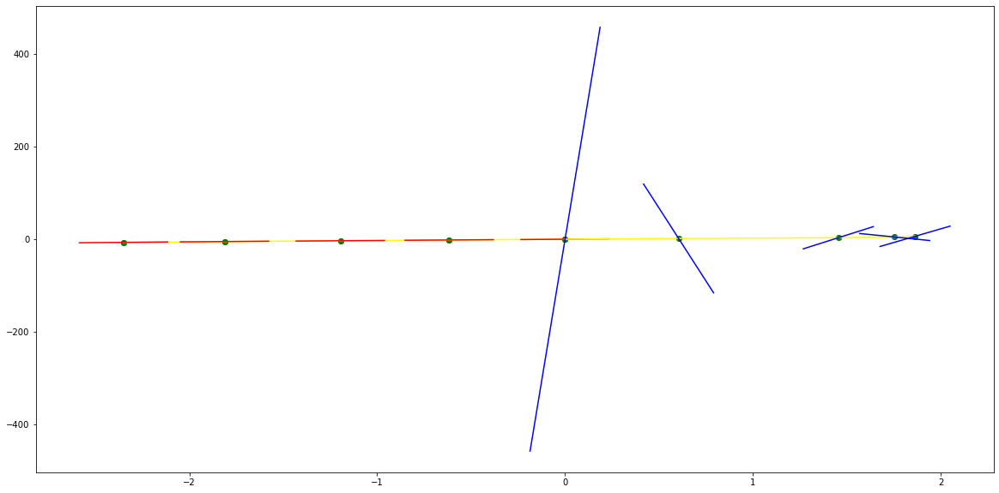

parameters (0.0847155058699928, 0.9383843044176237, 3.738942351643445, 6.251943298669351, 6.326573516154742, -0.03707462242385701)
tangent[0]:3.0925320953167272
tangent[1]:2.6579976561055787
tangent[2]:1.8135365396286325
tangent[3]:3.4870074450074924
tangent[4]:6.326573516154742
parameters (-366154.6157670302, 357892.0811212237, -124334.21110202109, 18043.452462910493, -881.4764518032543, -0.0011337136911574932)
tangent[0]:-881.4764518032543
tangent[1]:218.2883941216851
tangent[2]:202.53857031690086
tangent[3]:185.78495940437324
tangent[4]:113.68684712442928


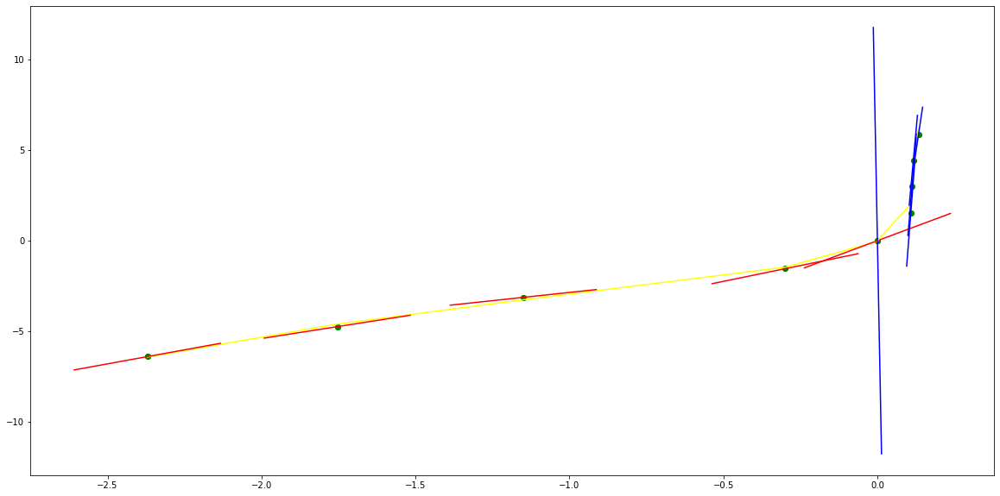

parameters (0.22075385705820344, 2.2897549731815845, 8.66015961988029, 14.253362096812843, 11.84245012320804, -0.1519213571928094)
tangent[0]:2.979577651823414
tangent[1]:1.627506123977776
tangent[2]:3.94119618613289
tangent[3]:9.047646327974167
tangent[4]:11.84245012320804
parameters (147559.32236298514, -122712.62849572513, 36981.30787685895, -4844.255203675151, 272.79032245667446, 0.36353589784304685)
tangent[0]:272.79032245667446
tangent[1]:234.30942436480137
tangent[2]:199.47932258318212
tangent[3]:92.53617706253482
tangent[4]:-13.521602338432956


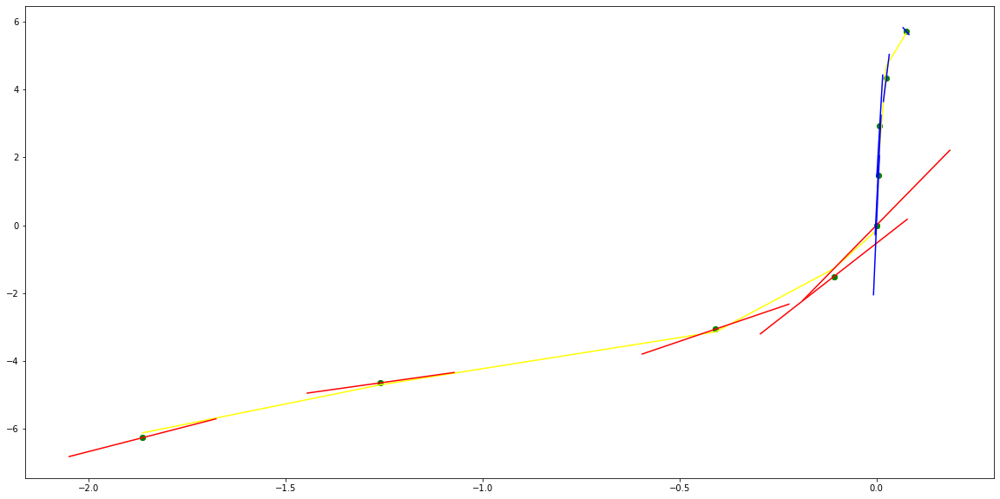

parameters (-3216.716628265013, -4425.935814293693, -1967.0019798939995, -307.1247332671902, -2.3814823400475196, -0.06194941862865462)
tangent[0]:24.956058778884447
tangent[1]:-3.8245823702505466
tangent[2]:14.094866865156582
tangent[3]:15.69092164998007
tangent[4]:-2.3814823400475196
parameters (2365.6093012556294, -3878.046973292745, 2236.244140725155, -526.9511389576393, 50.61967160257299, -0.002860148371737721)
tangent[0]:50.61967160257299
tangent[1]:34.846986399919835
tangent[2]:12.831290566265594
tangent[3]:13.971769788761236
tangent[4]:15.983163013850657


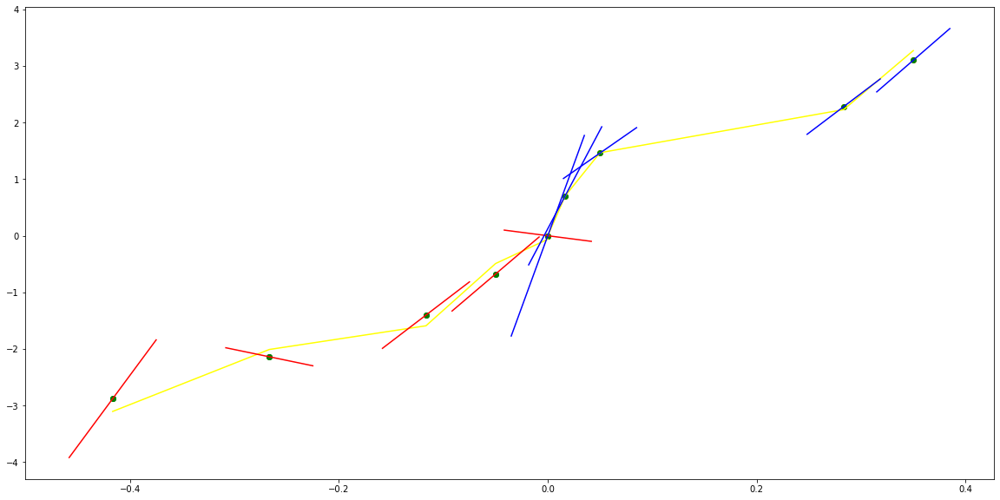

parameters (-1405.1470105521585, -1936.3372771001568, -862.3939883591281, -117.92915436171477, 13.907526627124138, 0.05464743448203255)
tangent[0]:4.75003325955797
tangent[1]:18.33057730315485
tangent[2]:19.739304984150504
tangent[3]:20.288960948188933
tangent[4]:13.907526627124138
parameters (5755.965538561336, -8522.93351118399, 4340.324729601838, -862.5776206255773, 59.8726113483772, 0.036819828105694966)
tangent[0]:59.8726113483772
tangent[1]:34.580910167251304
tangent[2]:26.416582175699055
tangent[3]:26.853501069390312
tangent[4]:26.116770362405212


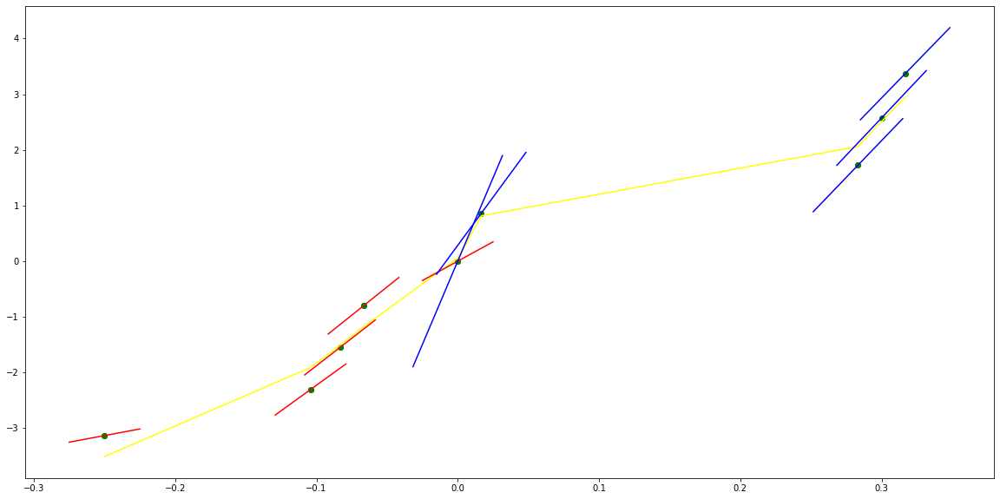

parameters (-14285.54335740724, -20110.50610203342, -9802.90086115364, -1989.8196777553248, -132.00535697820138, -0.0006090283262427564)
tangent[0]:21.953733382125478
tangent[1]:13.487830190554035
tangent[2]:27.917602240296873
tangent[3]:40.09667995140589
tangent[4]:-132.00535697820138
parameters (45880229.3919878, -11858461.574480647, 1045312.8988221617, -35848.90028734193, 428.4931864877919, -0.10659392483982533)
tangent[0]:428.4931864877919
tangent[1]:180.8176170529909
tangent[2]:22.450781820576196
tangent[3]:187.97628017910682
tangent[4]:182.10108724731862


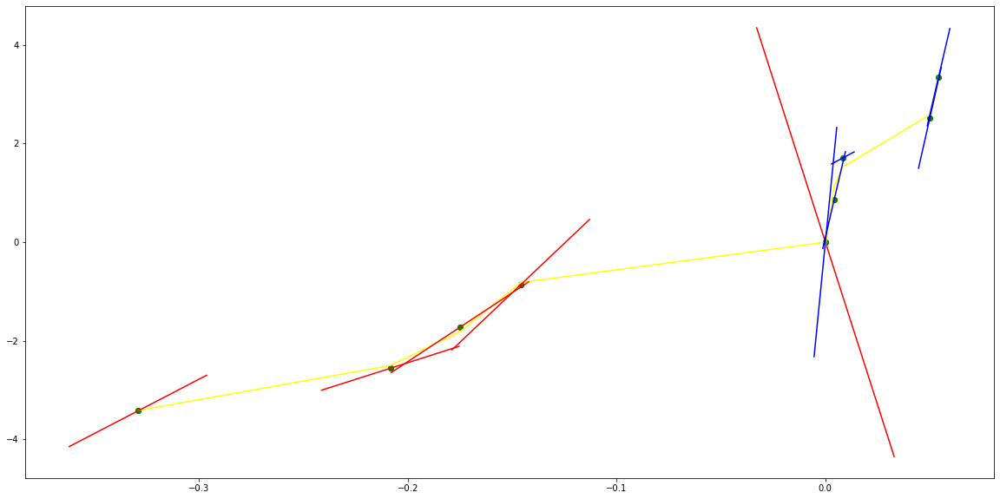

parameters (22817.941764980198, 27213.369899421476, 11369.533971116763, 1876.3608132654879, 99.1000343886619, -0.014798088346687787)
tangent[0]:25.031738178984114
tangent[1]:34.35427405076686
tangent[2]:24.94360059502732
tangent[3]:70.13463225726362
tangent[4]:99.1000343886619
parameters (500007.7093019136, -368563.8800519414, 86496.64004277051, -6957.246518449993, 218.548142367269, 0.0054962401802122205)
tangent[0]:218.548142367269
tangent[1]:164.96628758747835
tangent[2]:119.7763634803266
tangent[3]:-9.828136282779496
tangent[4]:73.88207892975612


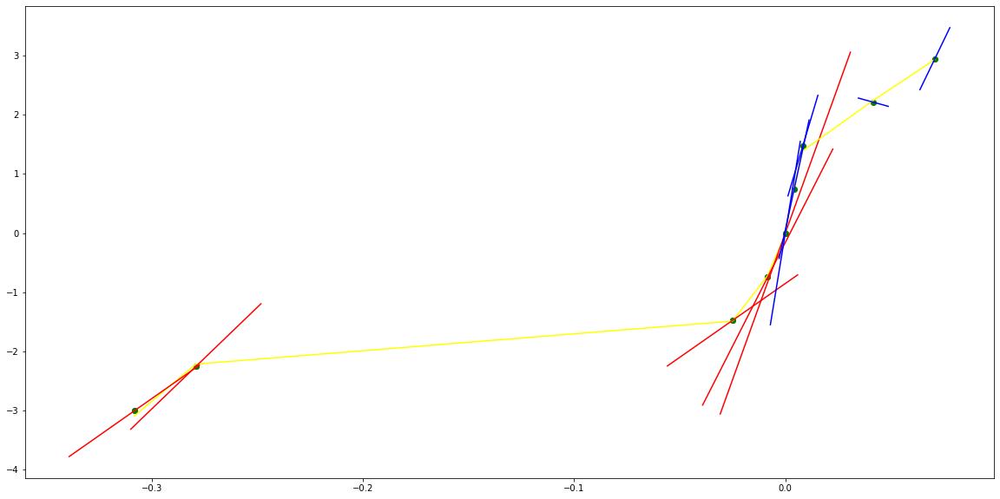

parameters (-2126953.2437953036, -1199093.4297719265, -154129.04485225584, -4910.736411486445, 64.18947131426575, -0.09410814141021785)
tangent[0]:109.48243223554553
tangent[1]:120.82406723381493
tangent[2]:123.81817139988213
tangent[3]:97.43054643823564
tangent[4]:64.18947131426575
parameters (3015541.770305759, -921732.1001479551, 99551.80786313508, -4610.497444217786, 123.33247979181664, 0.0872190589578094)
tangent[0]:123.33247979181664
tangent[1]:89.83219081097388
tangent[2]:30.355742789575032
tangent[3]:32.91825425002472
tangent[4]:43.97142029765348


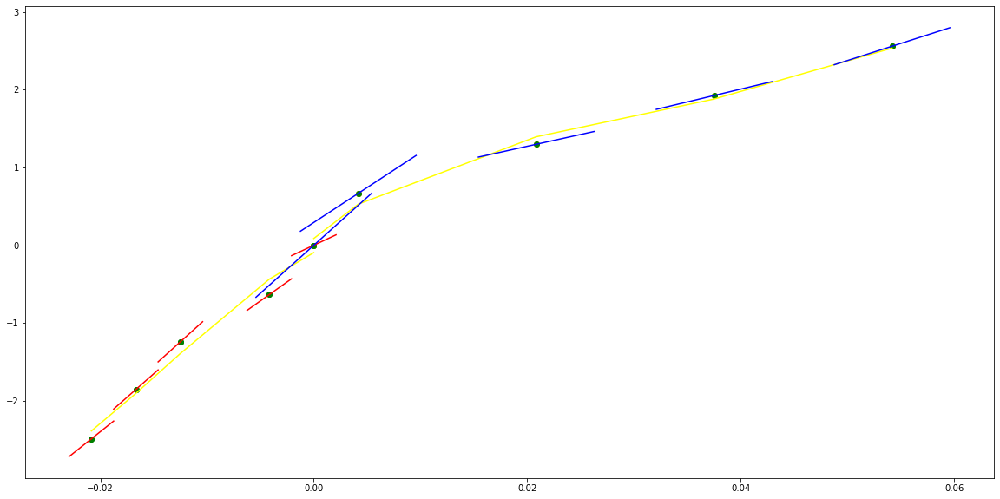

parameters (-2425.3768878745377, -3626.7919673571555, -1790.97534830432, -318.2702019761552, -4.262158947002742, -0.0016621737833610207)
tangent[0]:0.08628221523153812
tangent[1]:13.807584077493917
tangent[2]:19.139961804141326
tangent[3]:18.353106454098786
tangent[4]:-4.262158947002742
parameters (-4032567.084685788, 1582087.82061579, -171645.52532320798, 4905.361501018461, 74.41092856424365, 0.09646112372813598)
tangent[0]:74.41092856424365
tangent[1]:106.8027204947817
tangent[2]:128.45393046880747
tangent[3]:122.62637120572867
tangent[4]:108.72981928135871


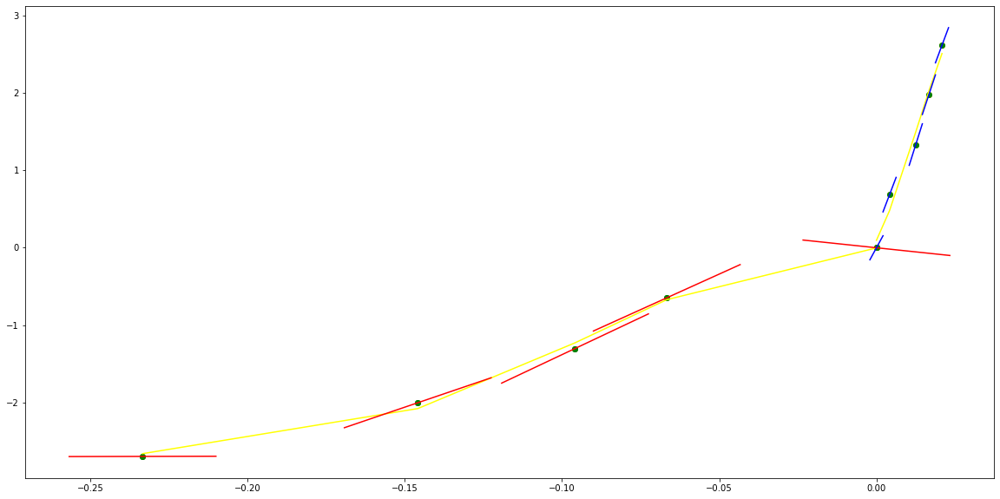

parameters (-3345.2098308143545, -6876.639821970343, -4515.156795568896, -1178.5087689904533, -95.04986831203067, 0.0006806163980103049)
tangent[0]:13.344961216260998
tangent[1]:29.03809614873674
tangent[2]:33.39511119625976
tangent[3]:36.648572437176966
tangent[4]:-95.04986831203067
parameters (295536.98680302565, -144820.9822136229, 24683.81547549847, -1793.8182675549572, 78.43185951331101, 0.1586709030589154)
tangent[0]:78.43185951331101
tangent[1]:64.7265304192052
tangent[2]:21.49282295845135
tangent[3]:21.003688554836955
tangent[4]:29.736325412698605


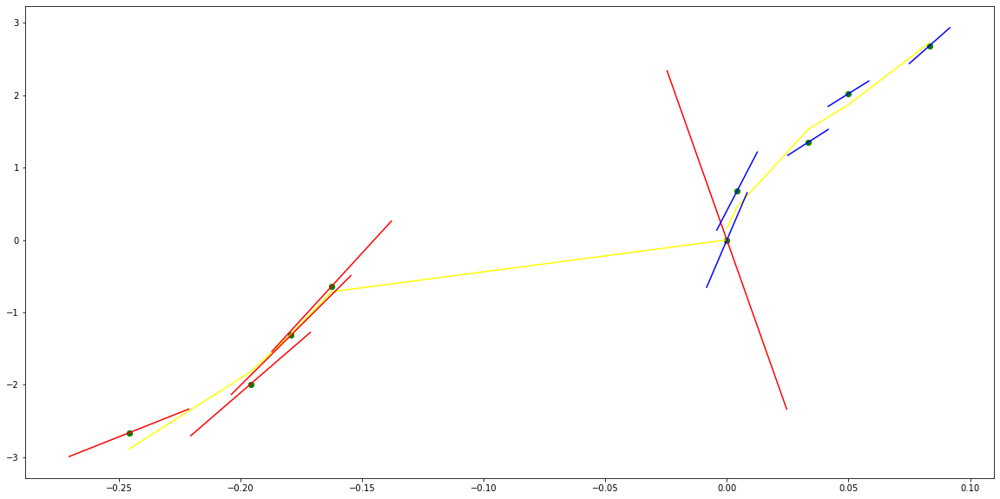

parameters (3013495.111470916, 737361.7352970035, 76123.68251767998, 4205.039291596912, 149.68163099631755, 0.044815867208830684)
tangent[0]:25.202788754258904
tangent[1]:36.3838813077308
tangent[2]:74.84584461952386
tangent[3]:93.82427867066096
tangent[4]:149.68163099631755
parameters (1322773.987673873, -587186.4400882714, 93398.45257757725, -6455.117145364575, 207.4749936345897, 0.029149468195533584)
tangent[0]:207.4749936345897
tangent[1]:158.37537828367033
tangent[2]:118.02329135302878
tangent[3]:6.585475995200767
tangent[4]:6.030139844746799


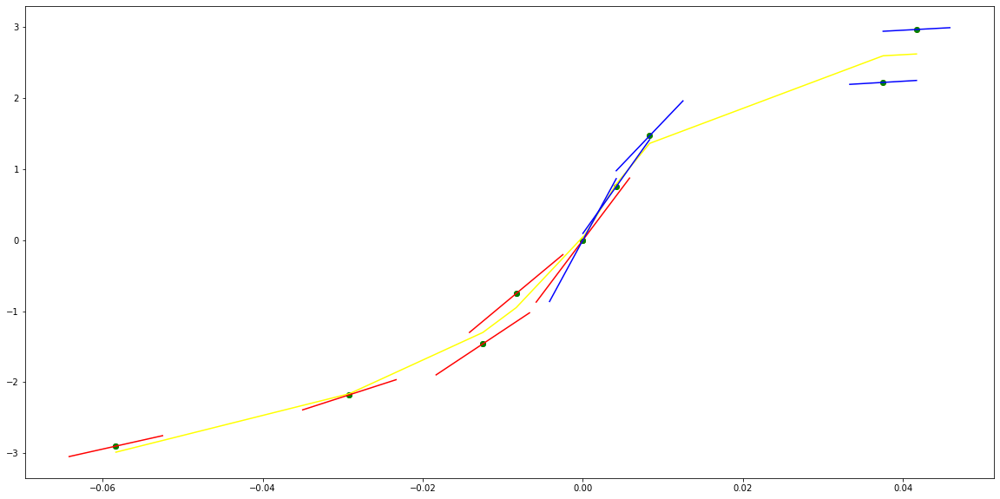

parameters (526.4834260422078, 614.7661682370992, 232.95549143082604, 53.03503723644507, 16.553756398031695, -0.21963135678288462)
tangent[0]:9.055485442019364
tangent[1]:9.173109242063175
tangent[2]:11.41987494919629
tangent[3]:15.716992772792779
tangent[4]:16.553756398031695
parameters (-1605.558547583589, -1915.1420436228839, 2760.7104760434217, -895.6809481711376, 90.1123186020538, 0.2189801930886621)
tangent[0]:90.1123186020538
tangent[1]:82.79096688747674
tangent[2]:75.7555305494582
tangent[3]:50.381771101813655
tangent[4]:-21.321572428404735


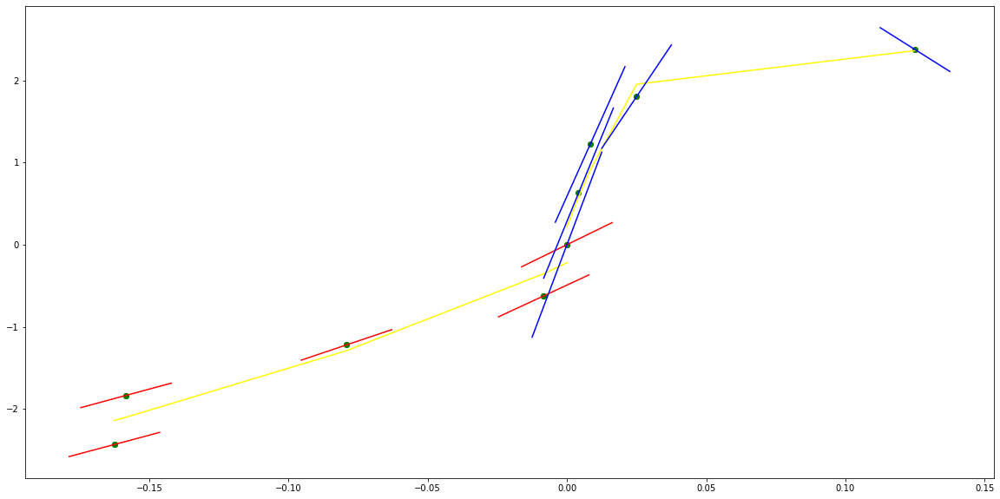

parameters (-275084.842832685, -163683.70621321886, -32447.20614112896, -2612.626470474441, -53.38831472658748, -0.0036325200568883245)
tangent[0]:21.03307473059371
tangent[1]:23.65602467156961
tangent[2]:34.22232745310066
tangent[3]:38.55127677344464
tangent[4]:-53.38831472658748
parameters (79553.11321314487, -70340.16007691306, 21649.945398728465, -2721.150202303255, 129.43366023109706, 0.03428965331992292)
tangent[0]:129.43366023109706
tangent[1]:107.86313817884283
tangent[2]:88.43212844905504
tangent[3]:41.77426339486415
tangent[4]:29.728914907987544


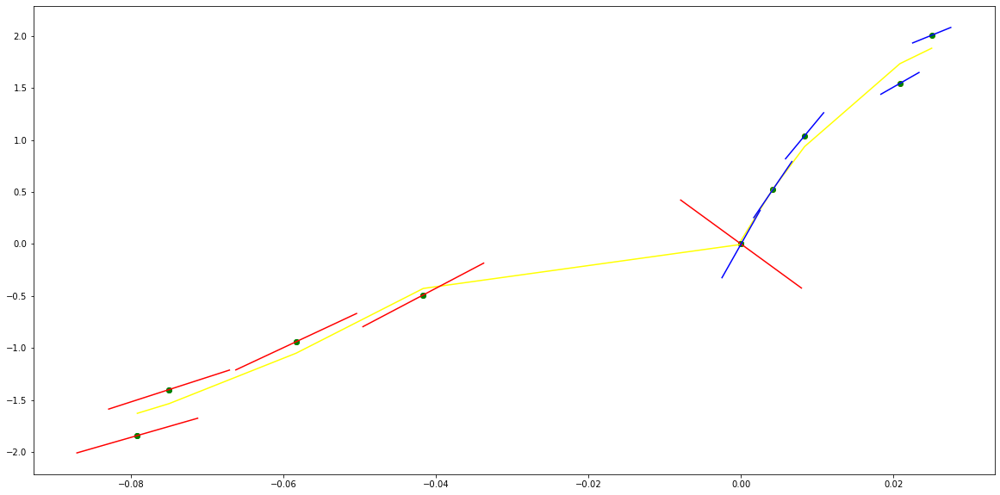

parameters (-586.1136927537029, -951.5992909093768, -516.6332080440429, -104.13225419430039, 0.22027097846470903, -0.009781896387525012)
tangent[0]:4.934657320982636
tangent[1]:4.842718160274179
tangent[2]:7.426070147421049
tangent[3]:8.873895922845795
tangent[4]:0.22027097846470903
parameters (246313.77148875134, -136503.00383997275, 26712.997846234473, -2203.49493465051, 86.2457897180081, 0.0916166450141682)
tangent[0]:86.2457897180081
tangent[1]:69.23425196765692
tangent[2]:24.51145661098967
tangent[3]:13.122813065923424
tangent[4]:24.08160855942498


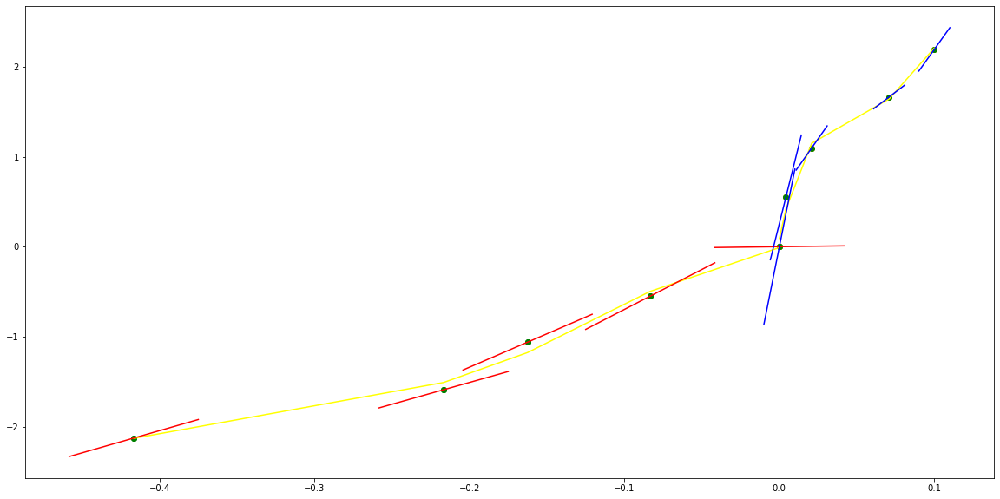

parameters (-58350.28667968453, -54103.99310057583, -18519.46223282177, -2807.4294192682055, -153.40299432738354, 0.00014242448501791918)
tangent[0]:15.499583068440671
tangent[1]:12.703002188024385
tangent[2]:17.13186886535928
tangent[3]:23.103094153343392
tangent[4]:-153.40299432738354
parameters (15477.648651745692, -14670.323811428772, 4879.42728830172, -666.7118167619608, 39.30682347817992, 0.1267761084110006)
tangent[0]:39.30682347817992
tangent[1]:34.00040212743709
tangent[2]:6.947037938604879
tangent[3]:10.350190641519731
tangent[4]:12.684443304480368


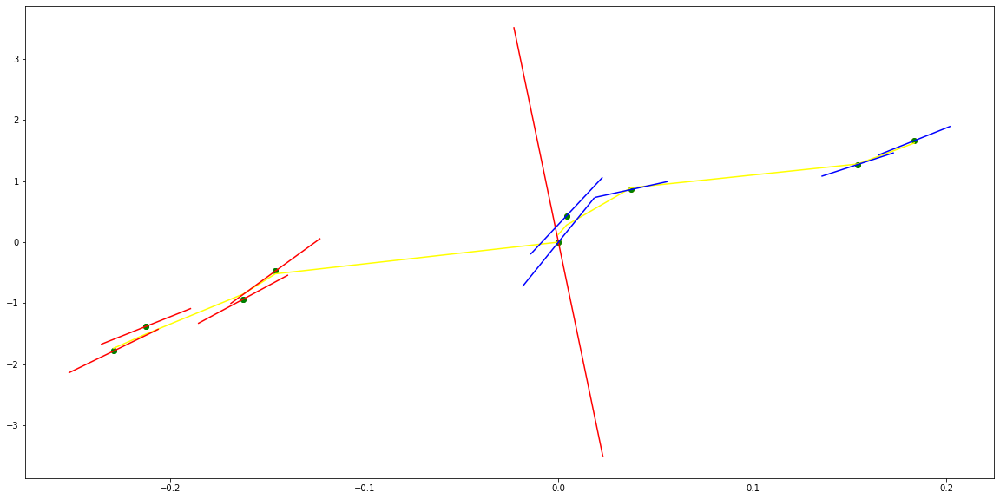

parameters (2470.837553523637, 4114.302207311417, 2454.1704874586635, 613.5896568825149, 57.509361386438044, 0.03485253046528015)
tangent[0]:9.61134734102886
tangent[1]:9.655413869929461
tangent[2]:0.7937818842398912
tangent[3]:47.78505764506494
tangent[4]:57.509361386438044
parameters (135104.1692951024, -106125.13970581676, 28024.967593699723, -2889.3390520632947, 103.80456887577172, -0.002609966329136692)
tangent[0]:103.80456887577172
tangent[1]:81.15417329203058
tangent[2]:61.24653870732598
tangent[3]:-19.68200583226252
tangent[4]:37.65538917793678


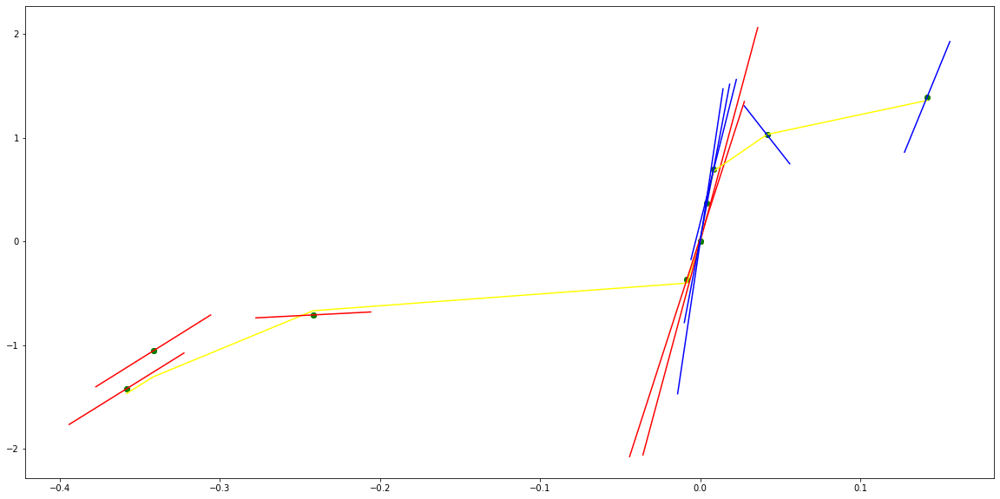

parameters (-1675.6616223277747, -961.0110718803214, -75.08518916825247, 27.10817243276565, 9.490982690430709, 0.005670643131833981)
tangent[0]:8.39255511129852
tangent[1]:6.021446918791342
tangent[2]:4.903105144433697
tangent[3]:6.866030554287442
tangent[4]:9.490982690430709
parameters (1052292.1619065977, -441834.7440238454, 69436.96142484882, -4548.836165964825, 101.13489598349378, -0.003142919502108812)
tangent[0]:101.13489598349378
tangent[1]:66.71569241641276
tangent[2]:-12.975949171514216
tangent[3]:43.36437030002179
tangent[4]:46.926940999549686


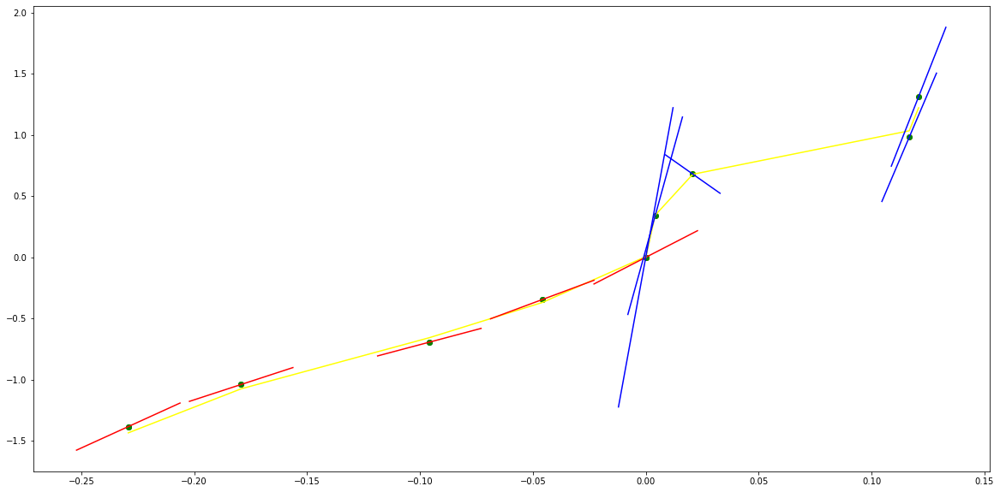

parameters (-1083.1147825702124, -2148.1480146307167, -1470.534163201021, -397.53403852629805, -29.771883365887962, 0.00021178858234024504)
tangent[0]:12.853450668129963
tangent[1]:14.900993839175225
tangent[2]:16.485636080066353
tangent[3]:16.552776991298384
tangent[4]:-29.771883365887962
parameters (4554.704079439868, -4454.661734953619, 1700.9163457509733, -337.2602787948677, 37.96759909077967, 0.08369833786579611)
tangent[0]:37.96759909077967
tangent[1]:35.244193087504414
tangent[2]:25.973153228390018
tangent[3]:18.95419933126084
tangent[4]:10.848626503211793


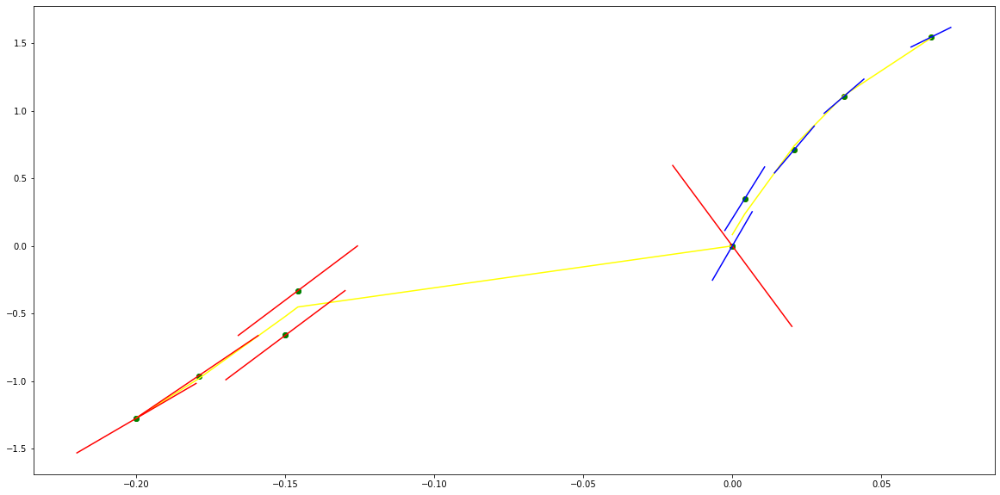

parameters (364.7335591786397, 588.9148354010797, 334.959599630714, 81.95725393462129, 10.888794349562271, -0.0703706409841834)
tangent[0]:3.1716029023397816
tangent[1]:2.317058806741219
tangent[2]:1.9512219506900266
tangent[3]:8.425209653746652
tangent[4]:10.888794349562271
parameters (1270260.2590826815, -467596.9997810873, 61833.02506684391, -3381.977598712169, 76.88980943568454, 0.008238712301307941)
tangent[0]:76.88980943568454
tangent[1]:51.791975893801535
tangent[2]:-3.8979001234837227
tangent[3]:21.66874982391097
tangent[4]:25.307938591893347


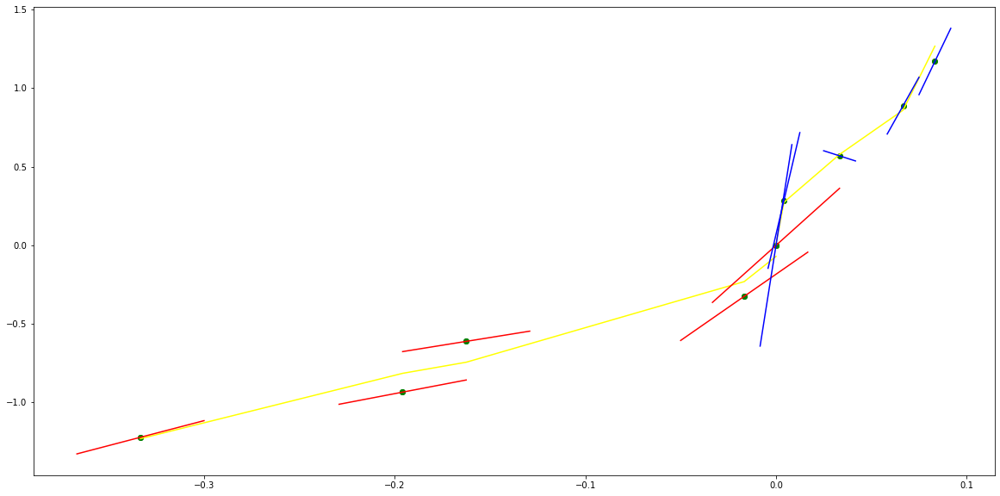

parameters (23431.507582499857, 20603.5296717986, 6795.663902861766, 982.4338208263041, 55.13169371242537, 0.019875940683265626)
tangent[0]:12.643650247327564
tangent[1]:13.205762037722195
tangent[2]:33.59821086212623
tangent[3]:40.12697898153121
tangent[4]:55.13169371242537
parameters (5190851.604782311, -1114332.3091782613, 105156.99268037017, -4884.787655828111, 108.08315076530462, -0.010228415282337526)
tangent[0]:108.08315076530462
tangent[1]:72.53644730869553
tangent[2]:46.12521569179558
tangent[3]:1.5057419665422742
tangent[4]:27.43063006087587


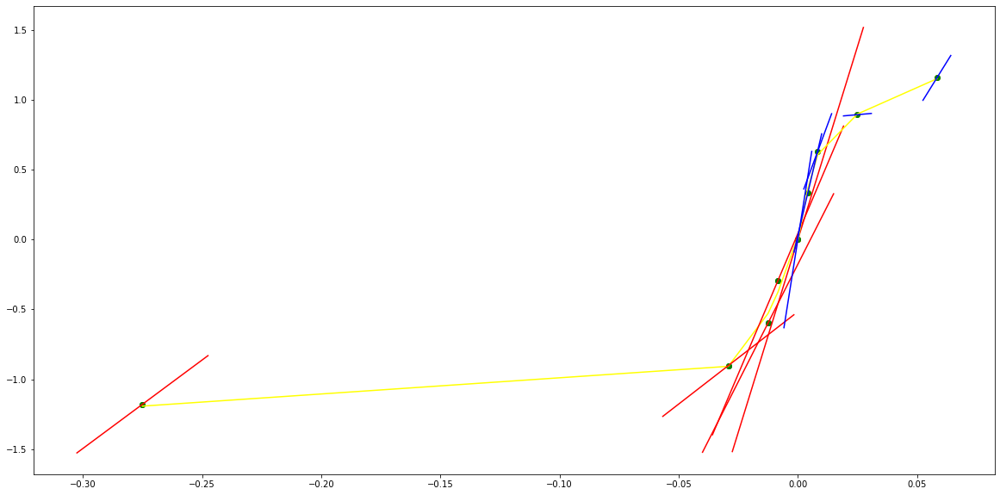

parameters (671368.3537030704, 701850.6797410268, 268416.939763572, 44490.984651380546, 2703.4939758393216, -3.751933053248957e-06)
tangent[0]:72.48559502123544
tangent[1]:68.93880555008445
tangent[2]:62.82188685967276
tangent[3]:-51.56687532822025
tangent[4]:2703.4939758393216
parameters (75835.20738077983, -61332.215757516744, 17545.020532529554, -2056.139949256077, 87.98949917453403, 0.022290030897069553)
tangent[0]:87.98949917453403
tangent[1]:71.74994167812753
tangent[2]:32.964975219033946
tangent[3]:23.01592718533462
tangent[4]:18.877510163209237


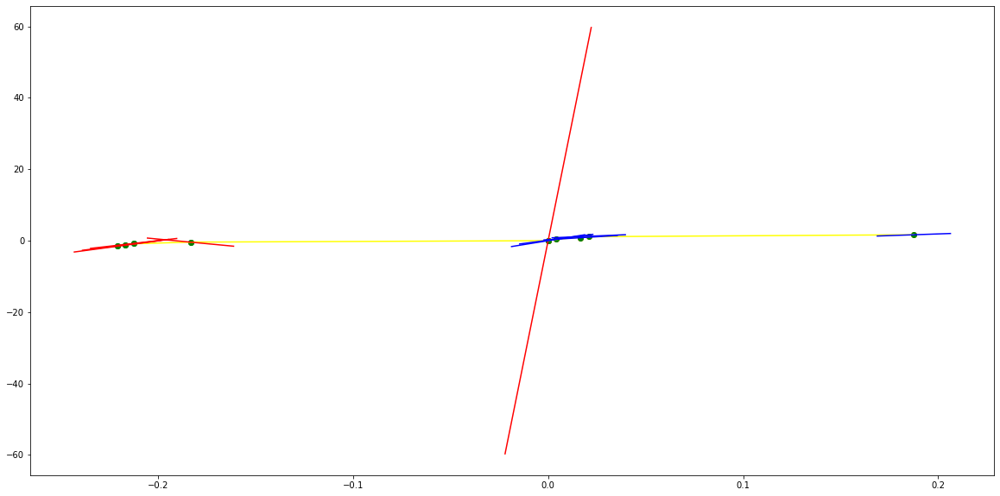

parameters (0.021229298732560697, 0.2237517010296308, 0.7776310399716887, 0.8912857678192705, 3.3722682503142702, 0.014745949503822926)
tangent[0]:3.6582875050384174
tangent[1]:3.665489082893881
tangent[2]:3.3116696846986664
tangent[3]:2.98608424344146
tangent[4]:3.3722682503142702
parameters (506.0757205098713, -2199.469185012315, 3389.280582471958, -2143.575054512344, 458.3145826948636, 0.0002246012280859245)
tangent[0]:458.3145826948636
tangent[1]:-116.81995694941077
tangent[2]:82.24933237348034
tangent[3]:79.92877280722007
tangent[4]:77.75541819685952


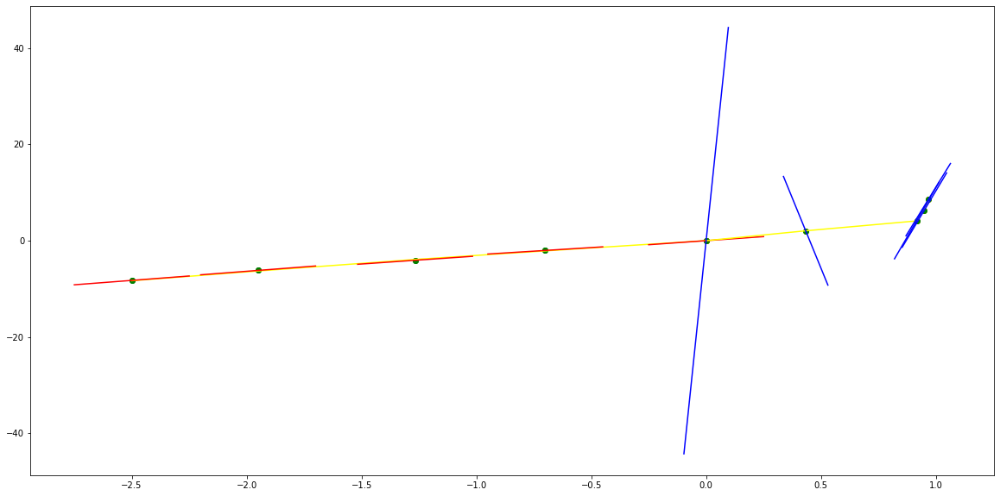

parameters (0.18515620811264677, 1.7662321643669865, 6.290703544797884, 10.350945247633323, 11.124913641302024, -0.8390313588192695)
tangent[0]:3.471467739606764
tangent[1]:3.1869587543126574
tangent[2]:4.558306282215904
tangent[3]:10.455565604580485
tangent[4]:11.124913641302024
parameters (1740.0236628791283, -4408.318668863582, 3896.736288310906, -1353.546640012484, 148.8929687605411, 0.023309133879032013)
tangent[0]:148.8929687605411
tangent[1]:106.9402861251294
tangent[2]:58.65897376690796
tangent[3]:57.21606404456898
tangent[4]:49.096813203410335


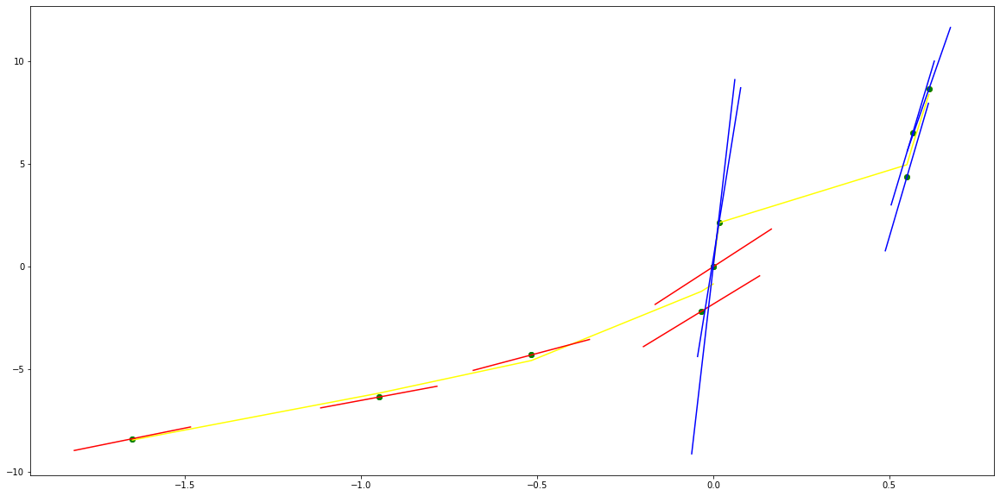

parameters (-1.985599580133714, -14.541606144200315, -37.147539924679116, -36.69418284011104, -3.4318397599143604, 0.02954062598316008)
tangent[0]:5.792465759231526
tangent[1]:11.852808302217266
tangent[2]:11.989333913628741
tangent[3]:12.03018970325649
tangent[4]:-3.4318397599143604
parameters (2111.247769207439, -3240.1416612297758, 2154.7800183884465, -668.3144845957389, 103.63517523776757, 0.21135168251565803)
tangent[0]:103.63517523776757
tangent[1]:83.09411041647651
tangent[2]:42.344067584590164
tangent[3]:13.846538022118452
tangent[4]:23.19072406495833


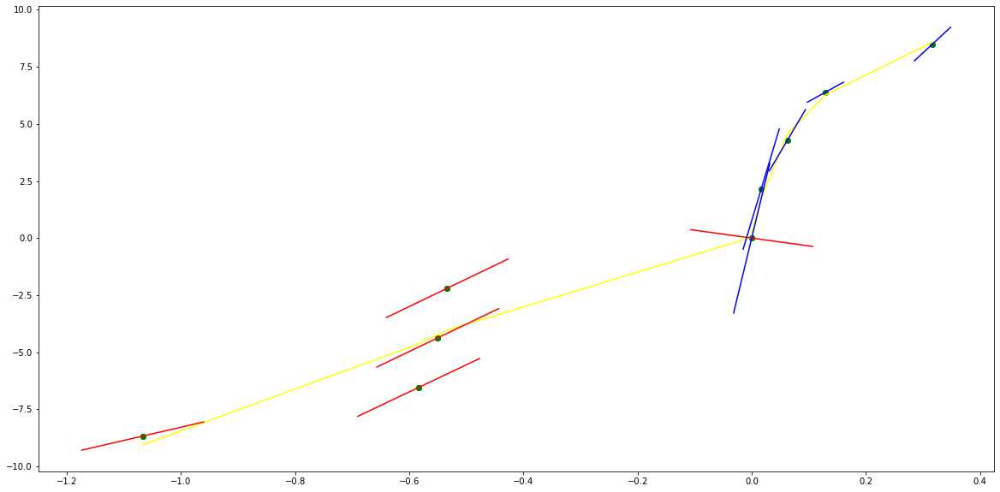

parameters (-0.026805101456264094, -0.2925663266002778, -1.1430948240081167, -1.863461658540976, 1.1976965722067494, -0.0071123111053441835)
tangent[0]:2.1250418102321165
tangent[1]:2.2744732121942013
tangent[2]:2.464918396611
tangent[3]:2.446936552674437
tangent[4]:1.1976965722067494
parameters (3259.9077965065676, -15682.465994454504, 27242.84577663729, -20006.51876732936, 5144.644562760355, -2.2393805993952367e-06)
tangent[0]:5144.644562760355
tangent[1]:-932.406917180082
tangent[2]:387.66537304689155
tangent[3]:-99.94751497302605
tangent[4]:-86.17485608429524


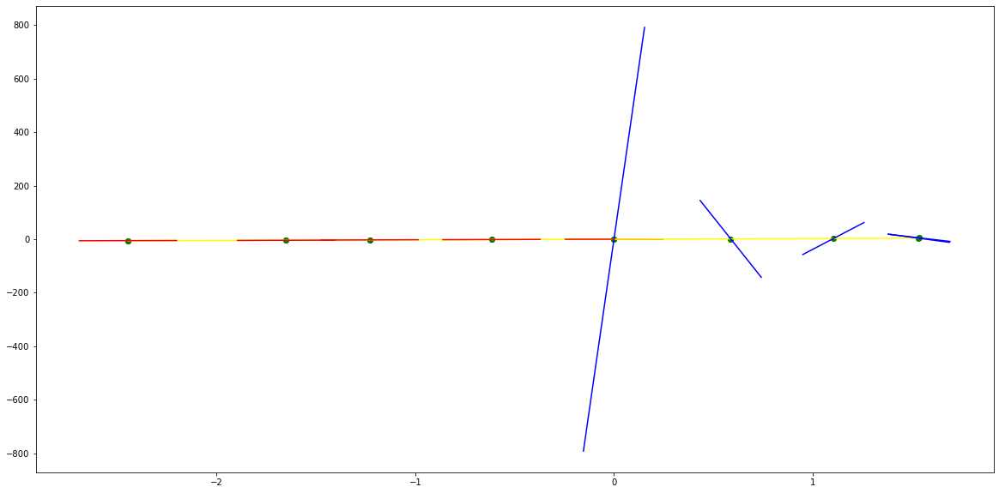

parameters (0.043538583650675595, 0.45293403403355664, 1.6478449110199826, 2.421117002601319, 3.4058613008477767, 0.014978615341533164)
tangent[0]:2.4592046477152874
tangent[1]:2.3889522109098067
tangent[2]:1.9709603434504577
tangent[3]:1.989324832618895
tangent[4]:3.4058613008477767
parameters (-1743392.1601102804, 3360839.91709919, -2424257.625051512, 775578.2922718334, -92856.87353284816, -9.669594226353137e-07)
tangent[0]:-92856.87353284816
tangent[1]:246.2069891058345
tangent[2]:172.66907384670048
tangent[3]:107.46470898207917
tangent[4]:125.11705999429978


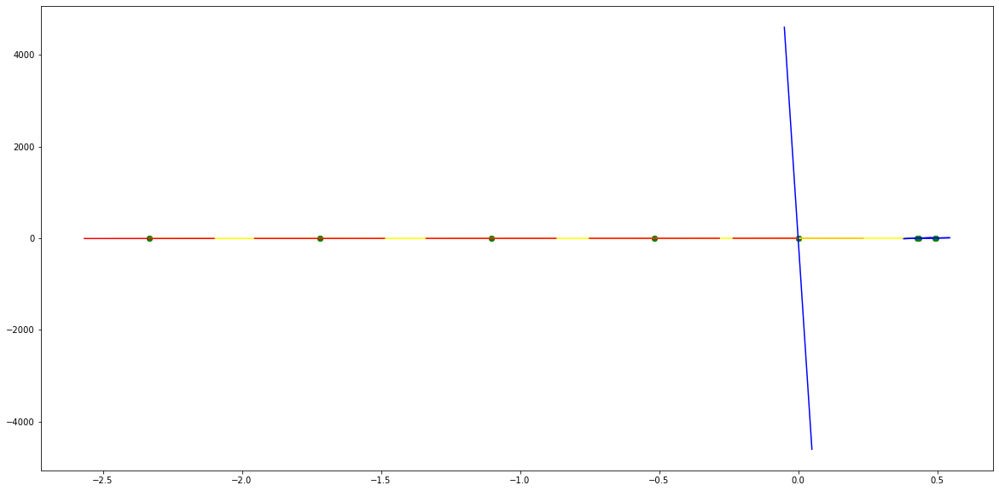

parameters (19.43001701344533, 105.19176312349511, 199.819840846262, 158.65729636693166, 50.18639752328301, -0.486709044842722)
tangent[0]:-5.191130857591709
tangent[1]:31.573522219887398
tangent[2]:32.59463029881384
tangent[3]:48.87452614852454
tangent[4]:50.18639752328301
parameters (9080205.7887634, -2442067.2621008116, 215458.53947761343, -7429.418416213378, 192.4955147073005, 0.23620179639627134)
tangent[0]:192.4955147073005
tangent[1]:141.10923845208703
tangent[2]:99.46806994221433
tangent[3]:109.65819634810586
tangent[4]:118.91359202718016


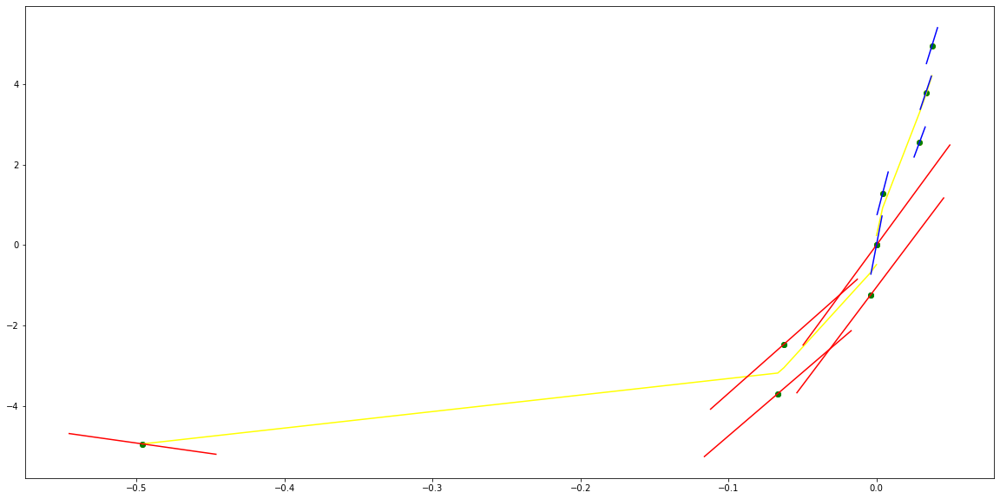

parameters (-0.0019613302463514356, -0.029782405455182372, -0.15719421473833733, -0.3394100400811759, 0.5225901274051287, -0.0016500030552739208)
tangent[0]:0.7613876159185732
tangent[1]:0.8156717487858597
tangent[2]:0.8434790271126124
tangent[3]:0.7920379443061953
tangent[4]:0.5225901274051287
parameters (15.45043679693676, -86.2739760449205, 174.64998981200822, -148.63439245707036, 44.14214195681014, -1.3601591732988008e-05)
tangent[0]:44.14214195681014
tangent[1]:-9.326481315970348
tangent[2]:5.632431111202912
tangent[3]:3.821575993983025
tangent[4]:3.770044608719182


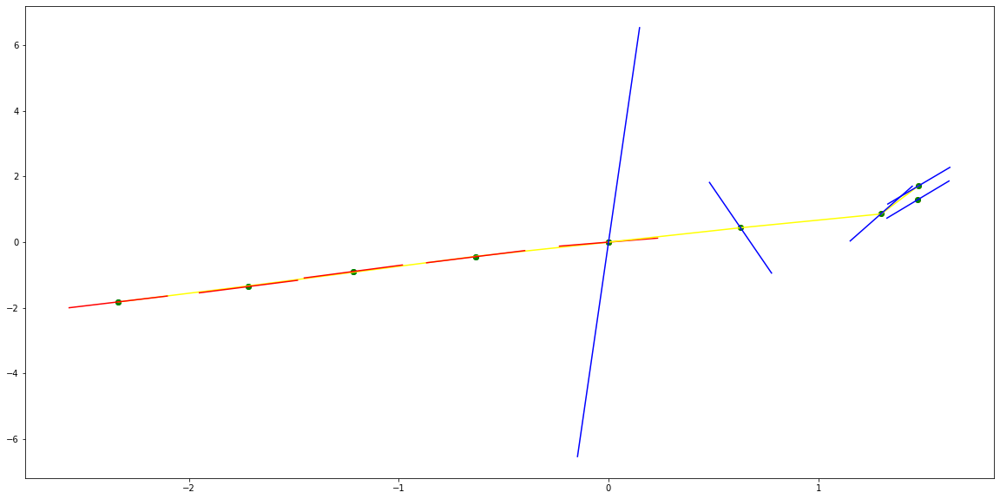

parameters (0.0008304901399895733, 0.015104783610275146, 0.07624624093323662, 0.10504717098366267, 0.6976013056672739, 0.001411149606322044)
tangent[0]:0.8211239281036747
tangent[1]:0.7677961612611787
tangent[2]:0.6901660787182837
tangent[3]:0.6422006138762566
tangent[4]:0.6976013056672739
parameters (426.33681754811147, 4670.91285607637, -5941.902764411049, 2207.056393013172, -227.2591965693812, 6.780122074731881e-07)
tangent[0]:-227.2591965693812
tangent[1]:101.43020537845464
tangent[2]:101.03829924771006
tangent[3]:100.39054400963468
tangent[4]:-49.47045476960491


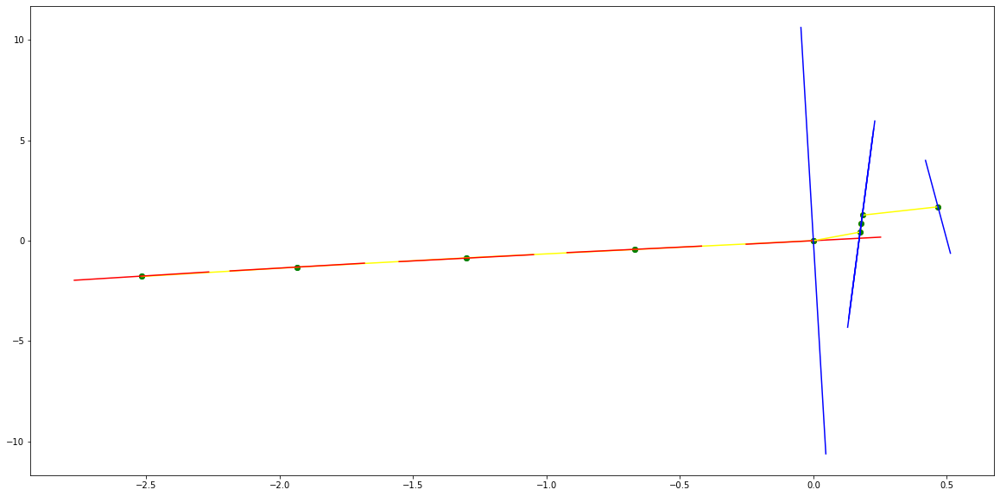

parameters (0.029162244065762552, 0.3198708640147055, 1.2745697963628206, 2.1774665627678855, 2.1478417634200744, -0.04121288140630104)
tangent[0]:0.8529567062650409
tangent[1]:0.6275254419914011
tangent[2]:0.5002749379259037
tangent[3]:1.4961090898213996
tangent[4]:2.1478417634200744
parameters (-11340.267720046984, 17301.030933503695, -6806.212181406879, 475.1639772059064, 97.5097622135542, 0.0026856432900530503)
tangent[0]:97.5097622135542
tangent[1]:101.12022205228243
tangent[2]:104.05076809800207
tangent[3]:-55.562524561313595
tangent[4]:87.4047946790702


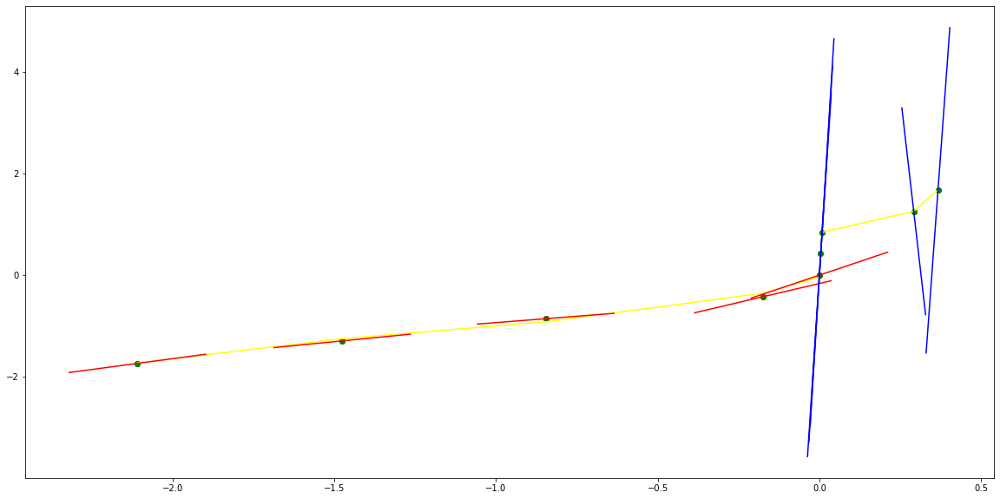

parameters (1560.6372800896643, 3583.4206053883318, 2904.7876909304982, 961.3508306906791, 108.18963952021872, -0.008435083239474943)
tangent[0]:21.959753427161758
tangent[1]:22.06287753129513
tangent[2]:22.126683542542736
tangent[3]:100.32802216478447
tangent[4]:108.18963952021872
parameters (-9639.189743699979, 15041.045181146043, -7314.152039031358, 1302.555481631278, -58.23752843977312, 0.32408198239244407)
tangent[0]:-58.23752843977312
tangent[1]:-47.75869876068733
tangent[2]:38.96982410111021
tangent[3]:-23.75772264236472
tangent[4]:58.417746169193116


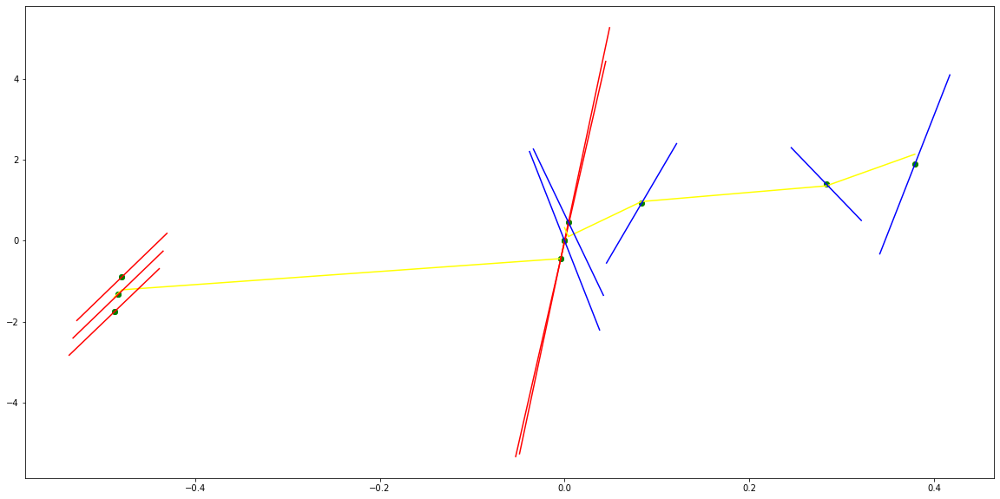

parameters (18832.520109468027, 34619.34927527215, 21152.89576532822, 4524.789190165552, 134.66612824882992, -0.031264446202361726)
tangent[0]:123.87896848105316
tangent[1]:132.14287998210835
tangent[2]:0.8310523118615833
tangent[3]:98.04843355360798
tangent[4]:134.66612824882992
parameters (-10879.607522992594, 16127.613264304871, -6963.381988500438, 961.3150063679416, -17.1855045516905, 0.29471836106434607)
tangent[0]:-17.1855045516905
tangent[1]:-9.53198819079293
tangent[2]:35.448884460368525
tangent[3]:-40.93835240545799
tangent[4]:136.2244408603854


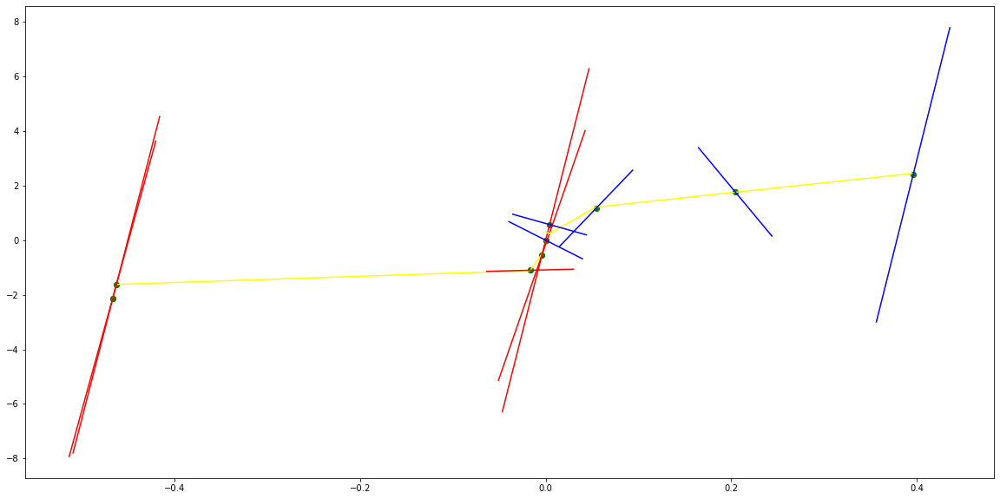

parameters (11203.690939842178, 22116.612127103435, 14958.608862709802, 4053.9195565472646, 366.80965331514557, 0.21715302700337627)
tangent[0]:76.025997939359
tangent[1]:77.27215706687997
tangent[2]:-104.28872995458522
tangent[3]:333.7971224736899
tangent[4]:366.80965331514557
parameters (-8977.608398666875, 15540.69346686664, -8321.060599711604, 1498.8196613079442, -48.399463566231546, 0.5708148828102585)
tangent[0]:-48.399463566231546
tangent[1]:-36.33727415295627
tangent[2]:59.64633234961899
tangent[3]:-72.38775419823942
tangent[4]:202.21855838169841


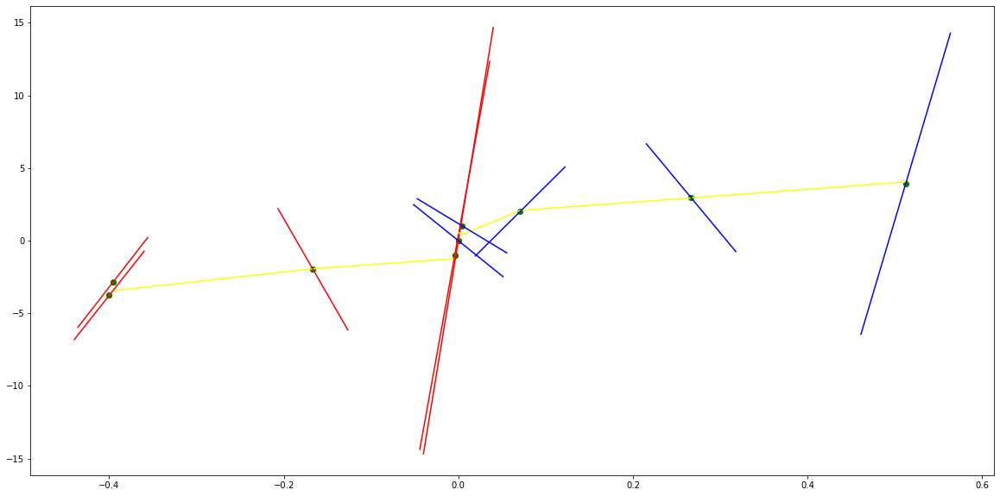

parameters (-1418.3639377239467, -2761.721732019999, -1700.6192655766201, -365.9647000583579, -10.059878322087203, -0.0016194070881421733)
tangent[0]:55.981340593209126
tangent[1]:34.64525186538273
tangent[2]:-11.524404508977996
tangent[3]:22.352334576611185
tangent[4]:-10.059878322087203
parameters (88920.66567146785, -130940.68658878635, 64006.37721504419, -11168.180361718938, 357.50135194488615, -0.05563389944712089)
tangent[0]:357.50135194488615
tangent[1]:267.72217272407204
tangent[2]:184.40512990467718
tangent[3]:277.6196714558286
tangent[4]:259.7667584926325


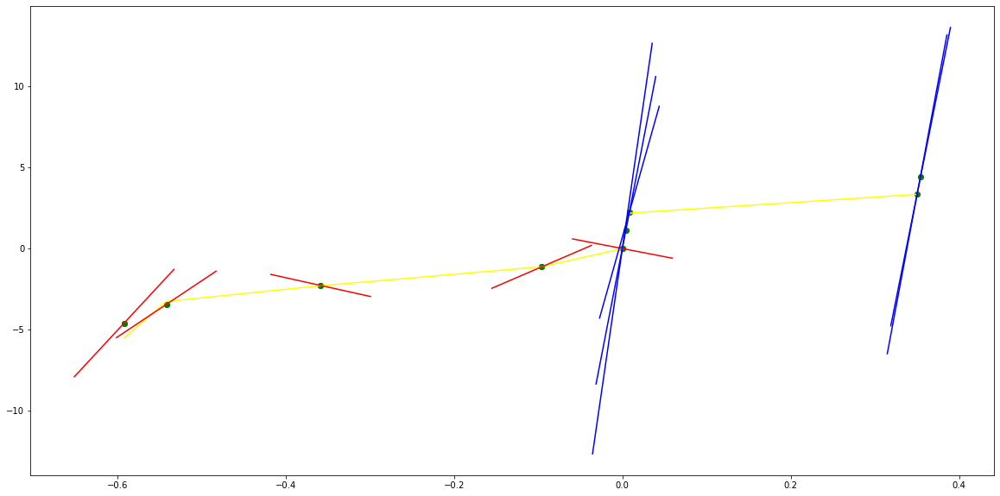

parameters (0.0013652097915751325, 0.012712400114419821, 0.03243435887927179, 0.06499672963774117, 2.423201647090736, 0.013884463524267341)
tangent[0]:2.0560481299111535
tangent[1]:2.195210111441252
tangent[2]:2.3115581147081246
tangent[3]:2.358241802937366
tangent[4]:2.423201647090736
parameters (682.2912450183408, -5054.852388037858, 13429.442160811252, -14907.507667841797, 5669.732616370075, -2.3966389699499225e-07)
tangent[0]:5669.732616370075
tangent[1]:-1304.5855411973125
tangent[2]:572.3344878099351
tangent[3]:36.895929580682605
tangent[4]:112.63631147611613


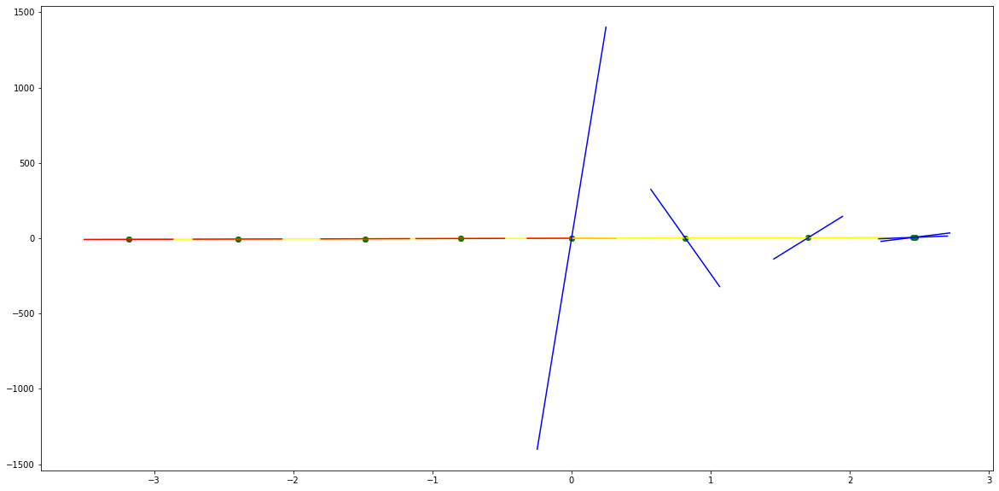

parameters (-0.0020467757220477435, -0.03370200589835708, -0.2041418364525465, -0.4980403695048267, 1.894623952324958, -0.003627375762394164)
tangent[0]:2.1530905737521797
tangent[1]:2.299702048189709
tangent[2]:2.4040145443118073
tangent[3]:2.3685100585065175
tangent[4]:1.894623952324958
parameters (103601.13486678521, -605922.1390018247, 1305835.227018575, -1221898.1522371375, 414984.39136716456, -6.585445079827192e-10)
tangent[0]:414984.39136716456
tangent[1]:-42096.74936410261
tangent[2]:183.26887636084575
tangent[3]:70.25304376531858
tangent[4]:176.40371507045347


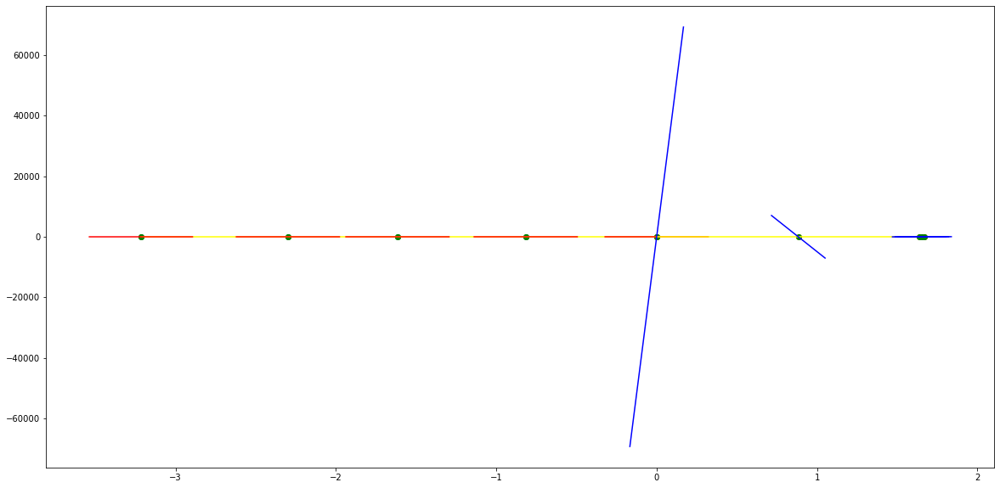

parameters (0.0007416321887238348, 0.007412335297259473, -0.0011554774621554706, -0.16331344706461873, 1.8898619552503038, -0.003932440774851972)
tangent[0]:2.3188400418166686
tangent[1]:2.3663430689393894
tangent[2]:2.320413403428578
tangent[3]:2.157499492256006
tangent[4]:1.8898619552503038
parameters (-3616535.831281457, 11461008.970007055, -13610037.577785134, 7178075.96943373, -1418728.981227361, 0.0)
tangent[0]:-1418728.981227361
tangent[1]:274.40078416257165
tangent[2]:37.63463474041782
tangent[3]:196.72633085562848
tangent[4]:334.7608561308589


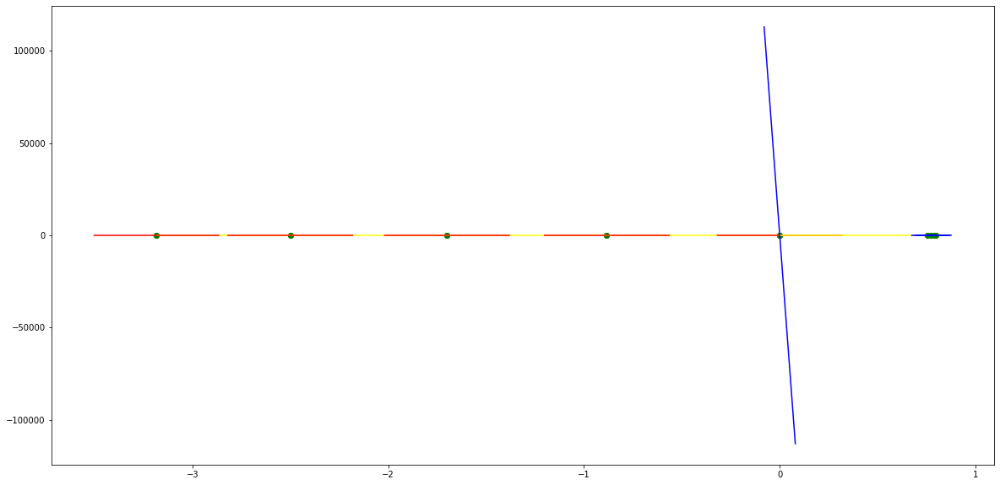

parameters (11.191247604511423, 93.01664566917263, 271.5580126687961, 326.230518496711, 138.74270241747763, -0.306792917631455)
tangent[0]:-29.624322691767702
tangent[1]:112.9442491457579
tangent[2]:122.93455608394723
tangent[3]:133.36209963564278
tangent[4]:138.74270241747763
parameters (-20364532.106376514, 4146688.614937628, -142292.50141701536, -8953.337944315783, 513.1907685126469, -0.04674142810009481)
tangent[0]:513.1907685126469
tangent[1]:432.3308364968869
tangent[2]:343.4392387638653
tangent[3]:129.45837822664953
tangent[4]:325.469676201463


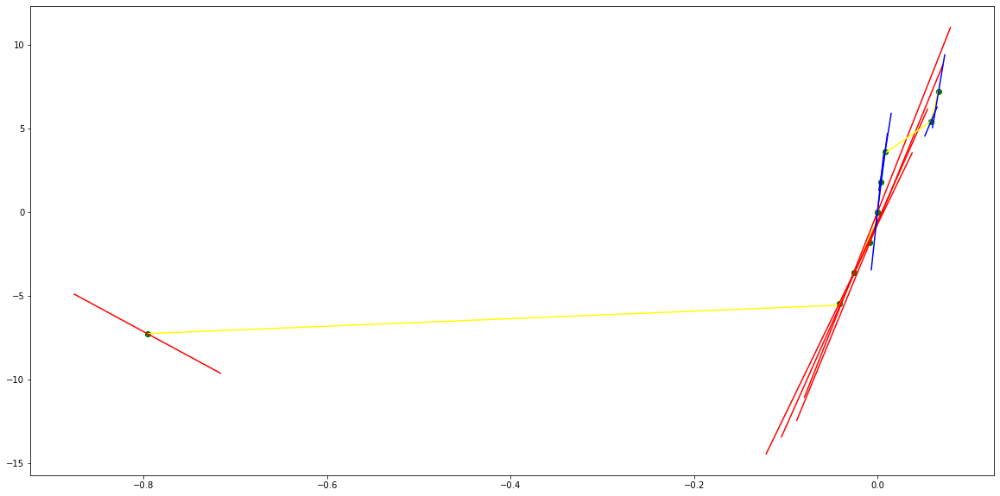

parameters (6105.279004806353, 46183.611625738704, 127742.36309784187, 151554.11521318924, 63891.90137543336, -4.091207755842643e-08)
tangent[0]:231.1996085583669
tangent[1]:-75.61522423774295
tangent[2]:250.75526749416895
tangent[3]:-10197.291236342557
tangent[4]:63891.90137543336
parameters (-148.2649045863291, 1125.8389951084691, -3115.078000664359, 3692.1452478633487, -1556.7893751576742, -3.4596558553687623e-06)
tangent[0]:-1556.7893751576742
tangent[1]:231.53661279015046
tangent[2]:-14.27478616610665
tangent[3]:40.804299694773135
tangent[4]:41.34226136780103


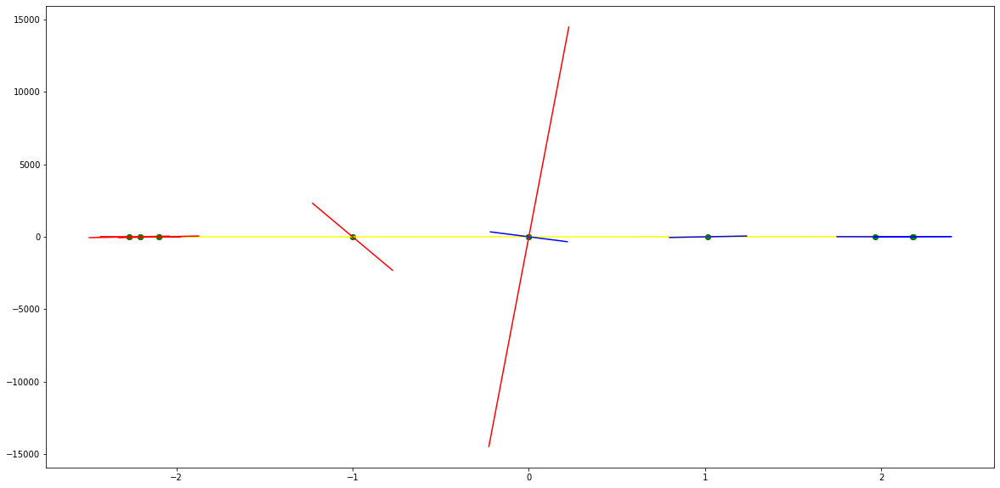

parameters (26.871357319540785, 250.39539272866747, 832.7007243716473, 1151.0542064388155, 545.7543879275668, 5.892962377728004e-06)
tangent[0]:39.57024523915106
tangent[1]:-8.393004344980454
tangent[2]:70.43524610930262
tangent[3]:-121.61586246679258
tangent[4]:545.7543879275668
parameters (788.9466227431334, -4141.652628431606, 8023.496761520297, -6784.336611161659, 2114.1656365000404, 1.079730281992334e-05)
tangent[0]:2114.1656365000404
tangent[1]:-43.24435639372996
tangent[2]:47.43780884686066
tangent[3]:47.54868545080217
tangent[4]:47.59983467035863


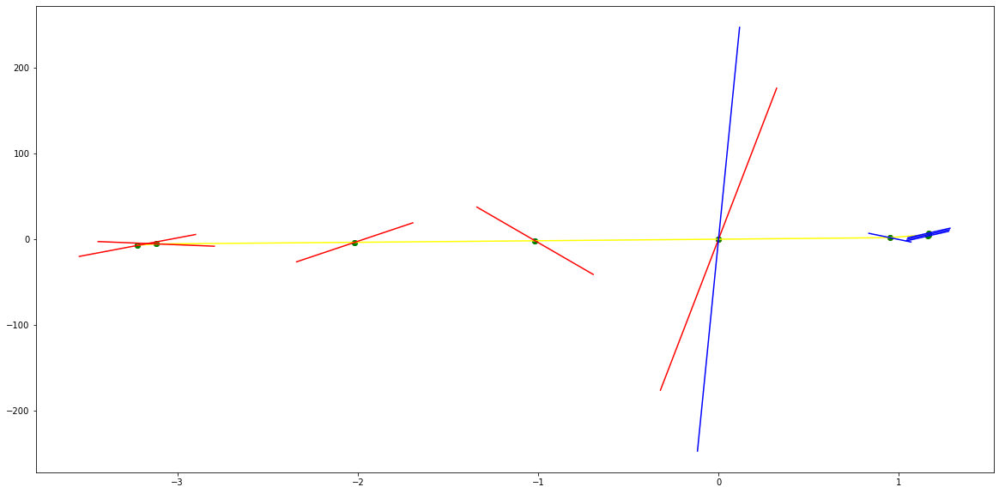

parameters (-210229456.3937344, -39494113.791240916, -2444115.799645745, -52997.26667918119, -52.72723122173663, 0.01225695348182247)
tangent[0]:366.3981635153121
tangent[1]:-106.6025134555886
tangent[2]:409.4101432292312
tangent[3]:407.71736847451507
tangent[4]:-52.72723122173663
parameters (1083784994.369392, -127852734.10778263, 5115957.465034077, -82865.6976604744, 830.5792209123758, -0.08650231660897968)
tangent[0]:830.5792209123758
tangent[1]:371.1057755432393
tangent[2]:245.48757344220303
tangent[3]:382.1775685922082
tangent[4]:435.75800068098783


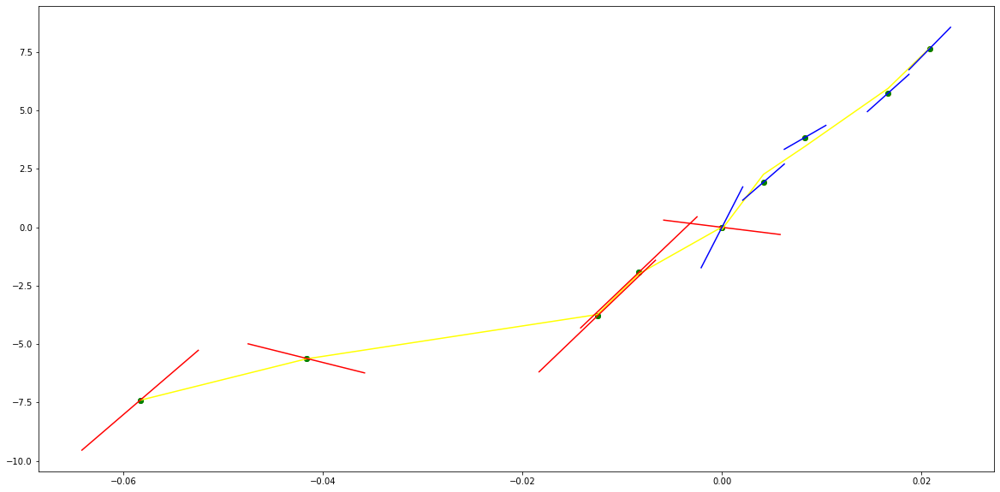

parameters (-1027228.2474951226, -339362.99304085504, -15359.269737151424, 1897.8851504146724, 172.24661177555092, -0.008747919993438009)
tangent[0]:238.70890879392462
tangent[1]:120.05927409937809
tangent[2]:4.011013372027293
tangent[3]:120.1257046358455
tangent[4]:172.24661177555092
parameters (-26963612.566061232, 7467573.477808456, -617522.6976233697, 10841.841893814768, 393.1892426139056, 0.0202891833567433)
tangent[0]:393.1892426139056
tangent[1]:453.4979927933809
tangent[2]:461.87302467561955
tangent[3]:-277.7372428222721
tangent[4]:424.3643208789776


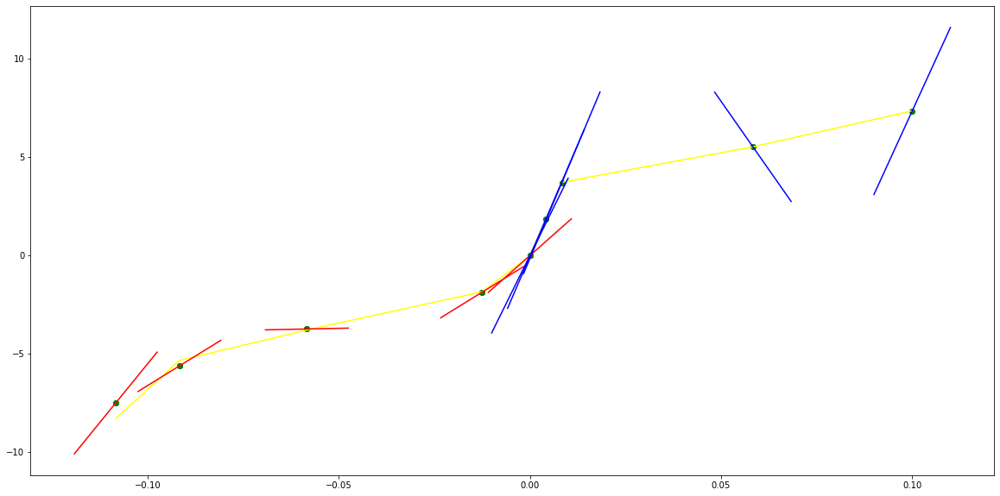

parameters (-73707002.1700038, -24310100.251968928, -2942578.725768067, -154733.6417299436, -2887.245576320198, 0.00020505605282773203)
tangent[0]:57.04236625483827
tangent[1]:256.27043878199765
tangent[2]:368.4844615855054
tangent[3]:488.4740203430483
tangent[4]:-2887.245576320198
parameters (3168296.5854447824, -768249.0732173239, 61047.78219483426, -2964.7805432911796, 205.3917583297638, 0.4373839139882229)
tangent[0]:205.3917583297638
tangent[1]:183.6457866568659
tangent[2]:123.46198725258185
tangent[3]:116.97557705372188
tangent[4]:109.85316113211522


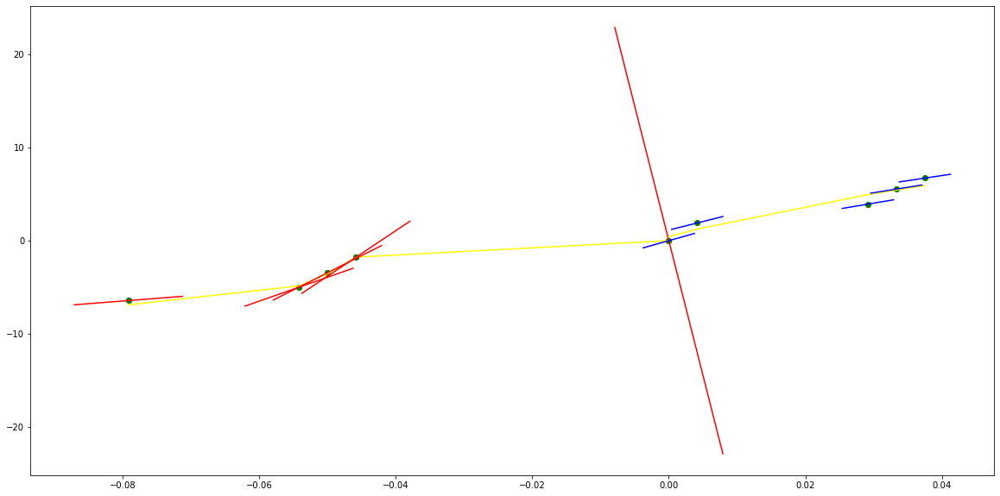

parameters (-14561303.062328776, -4736119.366140041, -527212.031653709, -24451.697876681275, -344.4769857275062, 0.0009892392630084293)
tangent[0]:349.05633705403466
tangent[1]:299.6472729173172
tangent[2]:115.13244344718191
tangent[3]:98.22685726393797
tangent[4]:-344.4769857275062
parameters (-87646381.21499805, 17796697.263538446, -1050852.692549377, 11041.571837778856, 533.4308404811308, 0.0036217931122176266)
tangent[0]:533.4308404811308
tangent[1]:575.729245987918
tangent[2]:537.6176126897171
tangent[3]:150.15476945627154
tangent[4]:430.23091860265265


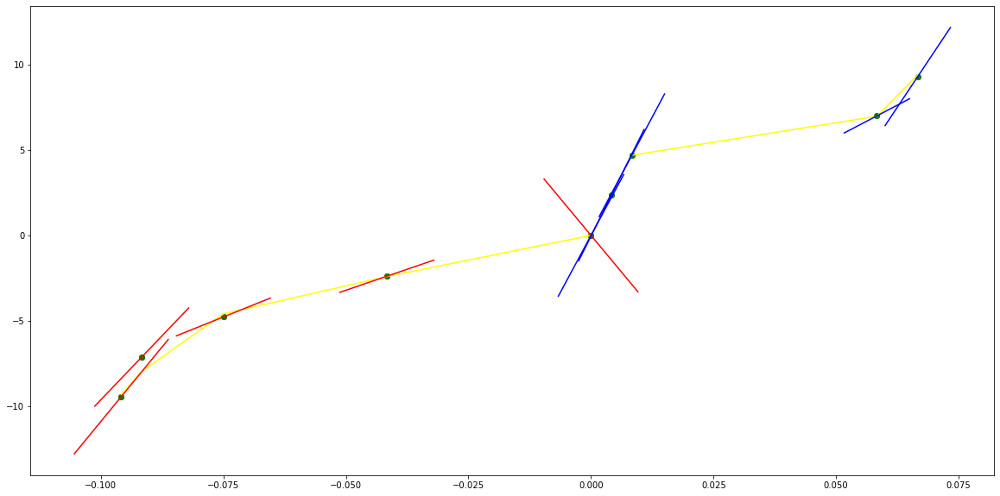

parameters (578.8278894220841, 1358.819631477379, 1172.369329092327, 445.85709859585575, 81.02837407879977, -0.4442828421897859)
tangent[0]:4.571541310971725
tangent[1]:23.334092559659553
tangent[2]:49.59504361706375
tangent[3]:73.83881266119579
tangent[4]:81.02837407879977
parameters (73552276.60563068, -31331125.977998033, 1986215.0540579928, -42564.897215939316, 586.7907943746735, -0.05848015561576319)
tangent[0]:586.7907943746735
tangent[1]:326.56318065820875
tangent[2]:220.42212241498555
tangent[3]:271.3160005611543
tangent[4]:335.53052187081164


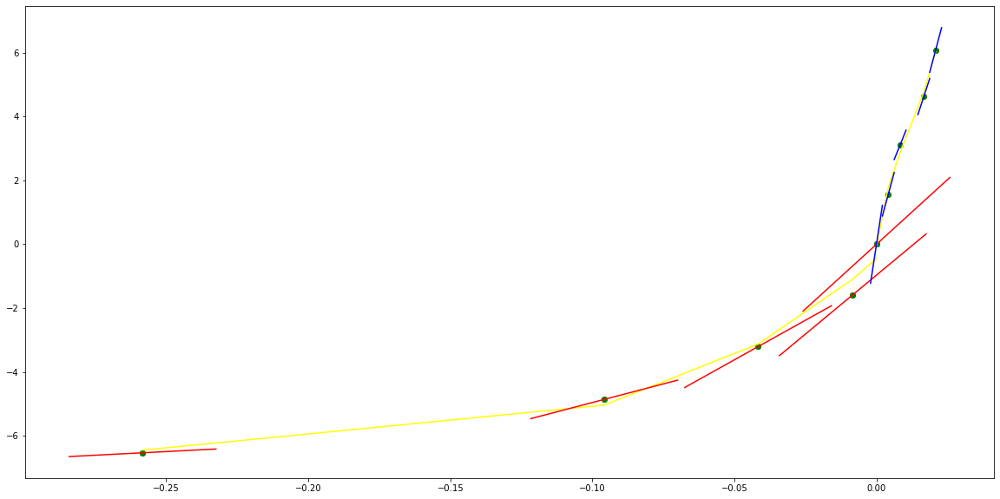

parameters (0.0032812557624053488, 0.015952145768399657, 0.018552708905680535, 0.18039459895156204, 0.5251646553141159, -2.0844813778342017e-05)
tangent[0]:0.005400806489256782
tangent[1]:0.1426895799966712
tangent[2]:0.27158176185949484
tangent[3]:0.3975091162525816
tangent[4]:0.5251646553141159
parameters (-76940.93685576912, 139202.79112579682, -93936.86632392321, 28052.837404054797, -3126.8615410293423, -2.8433157542303986e-07)
tangent[0]:-3126.8615410293423
tangent[1]:60.41329122629759
tangent[2]:52.42143571433917
tangent[3]:45.13783452190182
tangent[4]:22.928987428076653


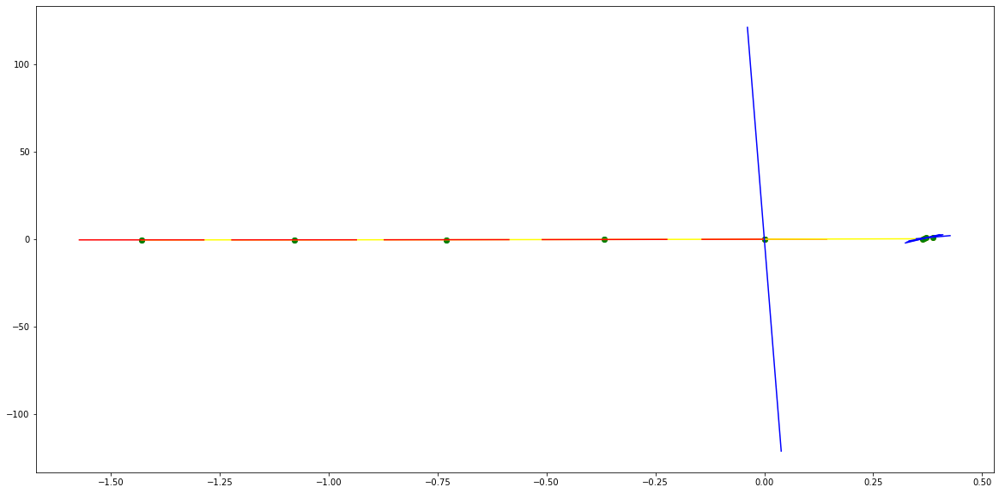

parameters (0.1392424421509038, 0.8537583399118781, 1.9319743739132917, 2.156211749104431, 1.5505382848785236, -0.12785180908798835)
tangent[0]:0.29489434894081
tangent[1]:0.3595731556898789
tangent[2]:0.5927813198467276
tangent[3]:1.5326688090412868
tangent[4]:1.5505382848785236
parameters (313421.0772712912, -140592.50195713696, 22746.97958924236, -1597.2679680780482, 60.33140536124733, 0.02661791001236597)
tangent[0]:60.33140536124733
tangent[1]:48.164484225903664
tangent[2]:18.60750250240813
tangent[3]:9.942909132500397
tangent[4]:18.143989849020635


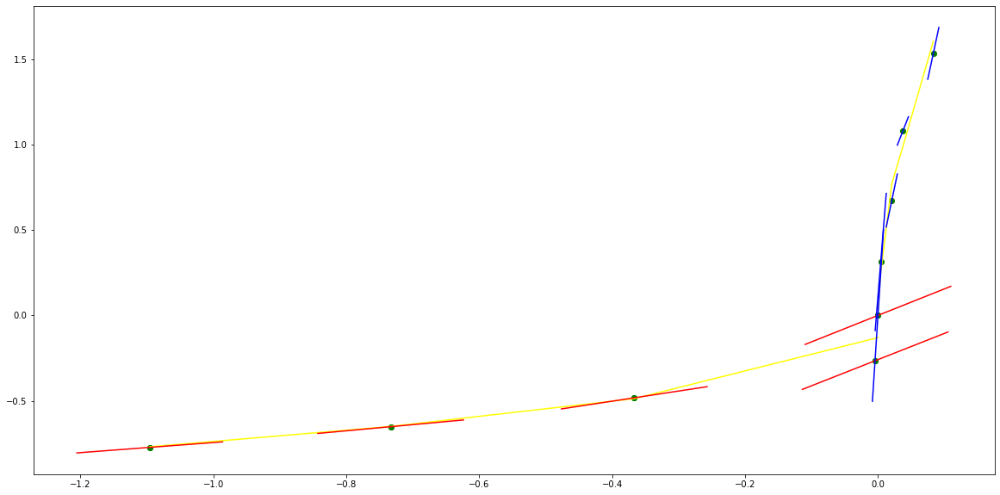

parameters (-1308.4601030472386, -3172.0491857600737, -2836.652624239525, -1122.3234828476877, -150.55048512775474, 0.0006441217325713884)
tangent[0]:22.080436108330474
tangent[1]:22.885694180171328
tangent[2]:35.59712609950785
tangent[3]:44.01668704295551
tangent[4]:-150.55048512775474
parameters (2552.8228119303353, -3947.5022705697784, 2360.8184637979357, -663.3845668317181, 104.21542951251162, 1.0149309810043534)
tangent[0]:104.21542951251162
tangent[1]:98.80862285899312
tangent[2]:53.68913588541226
tangent[3]:17.7258578593635
tangent[4]:18.317536693668742


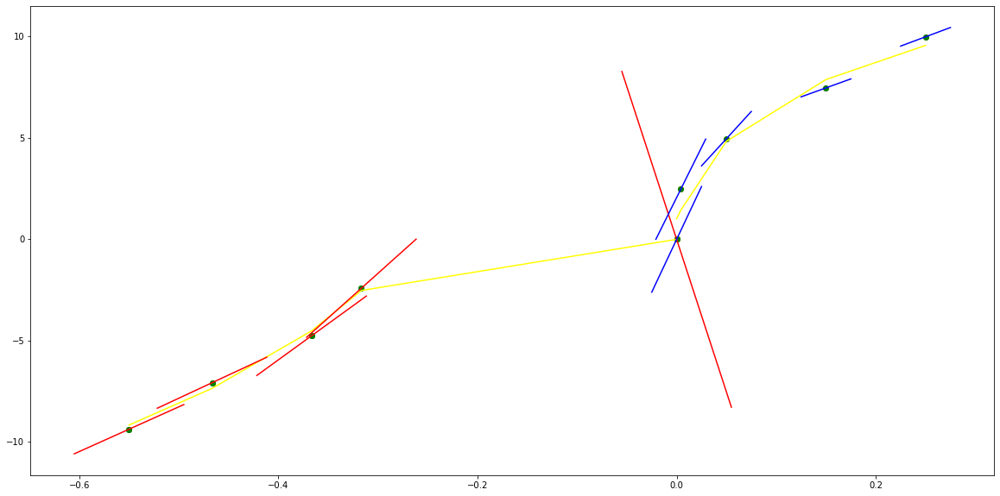

parameters (277357.61124094715, 151527.9736376453, 26824.466635798657, 1900.188002801511, 151.29533289440118, -0.0019841843998901648)
tangent[0]:108.55864247795111
tangent[1]:105.36687885997557
tangent[2]:95.36347091519698
tangent[3]:101.829549987314
tangent[4]:151.29533289440118
parameters (3291021.8436387964, -1301991.5974628807, 185680.66683518127, -11411.774583688171, 379.20689775232415, 0.4894948536734128)
tangent[0]:379.20689775232415
tangent[1]:293.4017210256459
tangent[2]:64.78499039338578
tangent[3]:82.48307452963866
tangent[4]:125.27510573896245


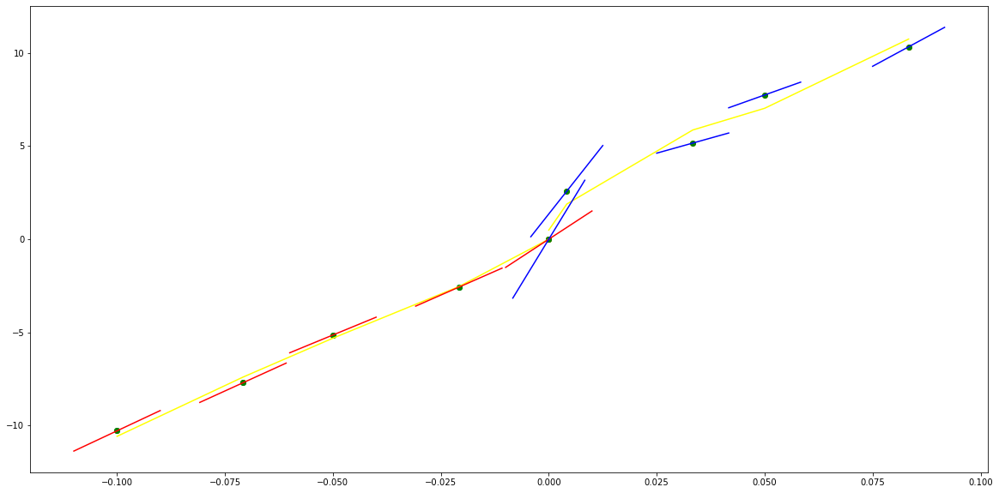

parameters (44.88546995865949, 83.84794446651104, 20.78115445797102, -1.1869706971527032, 101.09238518519867, 1.4678341948500136e-05)
tangent[0]:101.53988286786657
tangent[1]:101.40582740746937
tangent[2]:101.27595143626081
tangent[3]:101.16590916101877
tangent[4]:101.09238518519867
parameters (6099948.235387395, -1495328.0270135906, 116005.5345725876, -3433.203696063414, 200.61272567944695, -0.011104022335464859)
tangent[0]:200.61272567944695
tangent[1]:158.22259998504592
tangent[2]:164.91887790876962
tangent[3]:177.41447132814818
tangent[4]:170.29323421657347


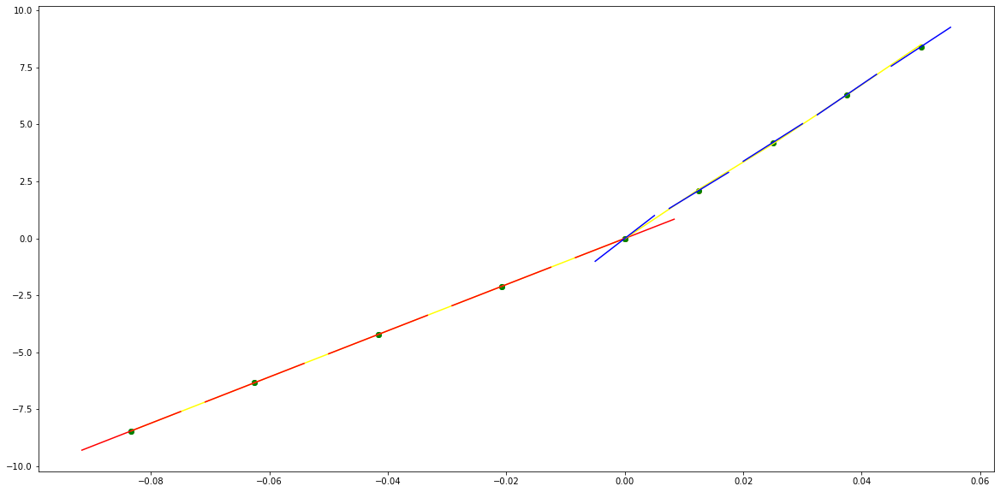

parameters (8297.994322203911, 6780.610798643168, 1856.6969507937638, 195.47589850564262, 47.119039904925806, -0.03097237317647869)
tangent[0]:41.49808371744286
tangent[1]:43.21231411536754
tangent[2]:41.367984306844626
tangent[3]:38.47317993140121
tangent[4]:47.119039904925806
parameters (50086233.813644506, -14813716.516104557, 1488614.8533504396, -58287.930334570694, 864.7938535570478, -0.17591786601496726)
tangent[0]:864.7938535570478
tangent[1]:452.3547724211394
tangent[2]:170.39111442031947
tangent[3]:358.94876885238716
tangent[4]:391.8544084838271


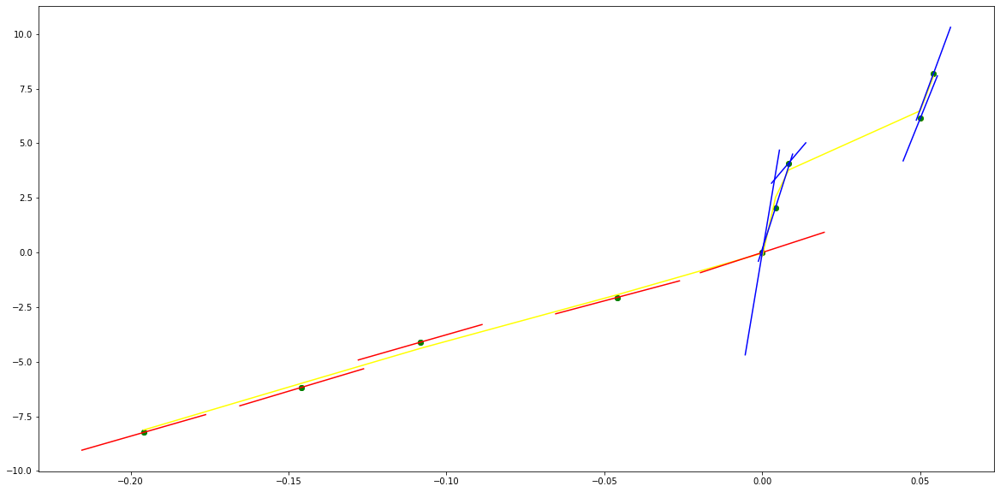

parameters (28.968299716674565, 93.86624757404097, 110.79691720779078, 58.93886468036727, 27.104843644860622, -0.060342073570181856)
tangent[0]:13.62532450934593
tangent[1]:13.242692642608624
tangent[2]:12.676200301065304
tangent[3]:18.025236384295177
tangent[4]:27.104843644860622
parameters (1345693.852574979, -966626.4833449943, 232457.93035647014, -22140.282875009503, 831.3964140387645, -0.24743904086378013)
tangent[0]:831.3964140387645
tangent[1]:658.7106840275704
tangent[2]:508.6264711652915
tangent[3]:379.46649688610273
tangent[4]:-62.32523031140613


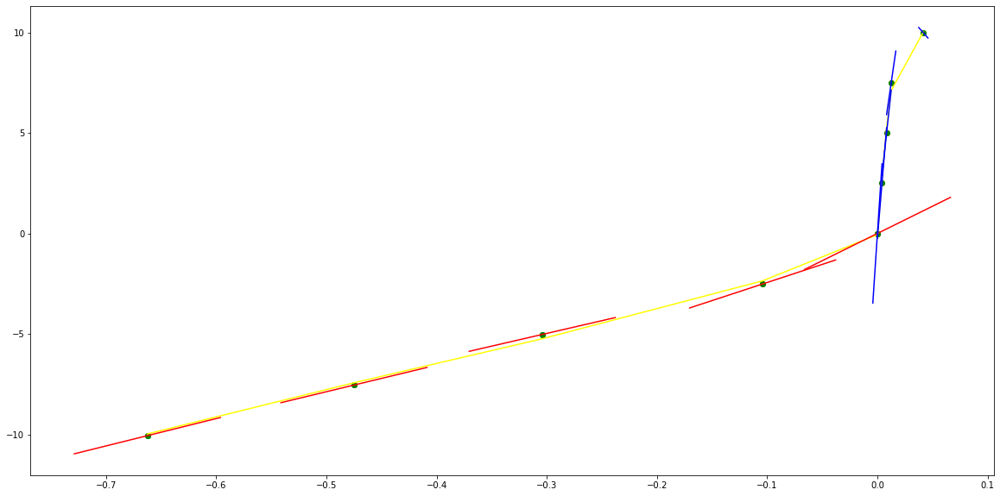

parameters (-11281112.258394727, -5089280.133170031, -835608.2146220185, -59205.80958311316, -1474.8900028751746, 0.001461945647325461)
tangent[0]:95.6591320261391
tangent[1]:69.3782482740803
tangent[2]:195.32681877891582
tangent[3]:242.8719982549078
tangent[4]:-1474.8900028751746
parameters (-257193.44451693576, 181165.06185310645, -40273.50604750396, 2483.9006080111117, 115.86503912413211, 0.4952032526185684)
tangent[0]:115.86503912413211
tangent[1]:134.51999802831324
tangent[2]:173.23146501150987
tangent[3]:172.46533468767336
tangent[4]:167.925185905942


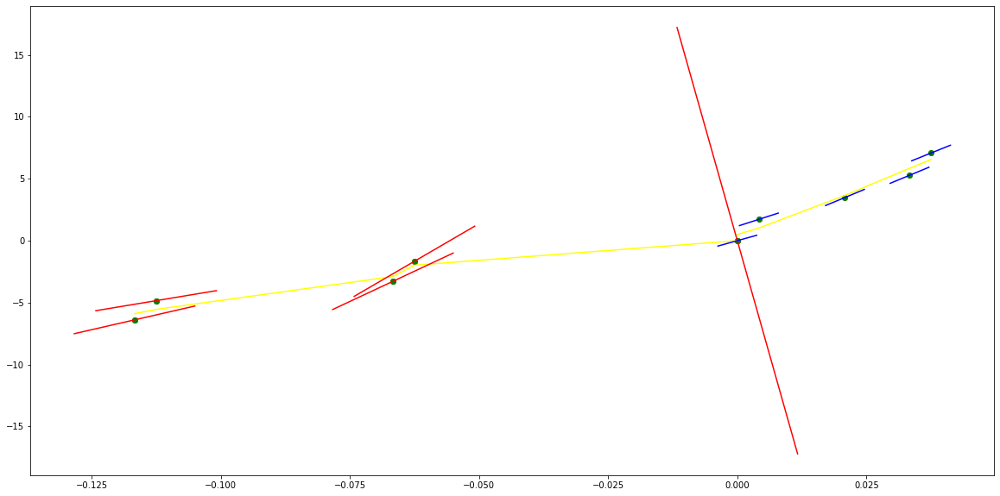

parameters (10081818.427388327, 3970942.969619871, 538524.5974667553, 29687.794673039334, 693.6063955452793, 0.1079568737213296)
tangent[0]:204.9954447641668
tangent[1]:93.3467502879613
tangent[2]:302.0654246560247
tangent[3]:473.1068818341075
tangent[4]:693.6063955452793
parameters (73444307.19935195, -17147238.032311406, 1361967.0611783282, -43028.20001513699, 627.3942375887601, 0.03866945219235028)
tangent[0]:627.3942375887601
tangent[1]:334.89229632145407
tangent[2]:157.20148400008077
tangent[3]:211.76209765841998
tangent[4]:283.0217406027574


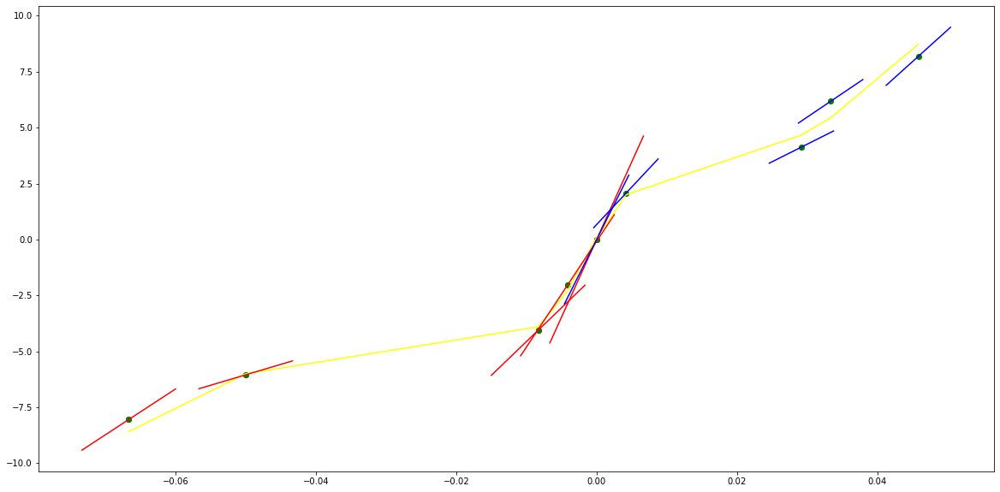

parameters (-0.14405805140510128, -1.1013801838367328, -2.8510800151981903, -2.9412186705539414, 3.077411182028184, 0.0041369826042034485)
tangent[0]:4.252774117554049
tangent[1]:3.8704911995737117
tangent[2]:4.148330204523287
tangent[3]:4.385991792037755
tangent[4]:3.077411182028184
parameters (-12603.174602056357, 52951.94478222819, -80202.44934622332, 51204.40460155508, -11360.20671422134, 5.590939975193914e-08)
tangent[0]:-11360.20671422134
tangent[1]:2274.7471312364014
tangent[2]:-837.9139005708621
tangent[3]:493.0757314942548
tangent[4]:477.3627365347875


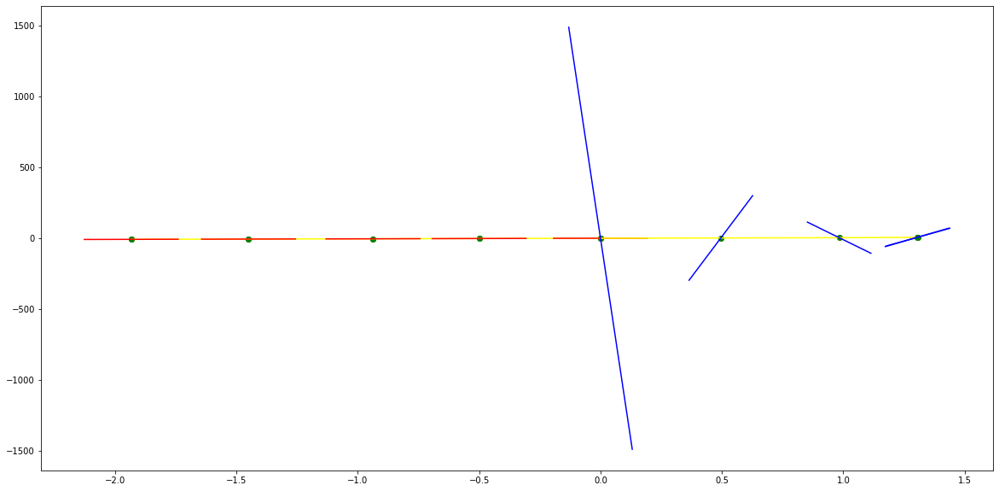

parameters (0.07258821887221911, 0.5664537405198355, 1.5260630311525947, 1.6026408400008305, 4.5100830884354055, 0.001560024998265359)
tangent[0]:4.127658394614226
tangent[1]:4.190905028479669
tangent[2]:3.9700184041375683
tangent[3]:3.793531133223378
tangent[4]:4.5100830884354055
parameters (-113746.55452542522, 239539.0560812999, -183127.32181402904, 60217.49661679301, -7169.448219677877, 3.5805347867363715e-06)
tangent[0]:-7169.448219677877
tangent[1]:536.8486494411336
tangent[2]:490.01396371992814
tangent[3]:444.02580520497577
tangent[4]:398.9877967716311


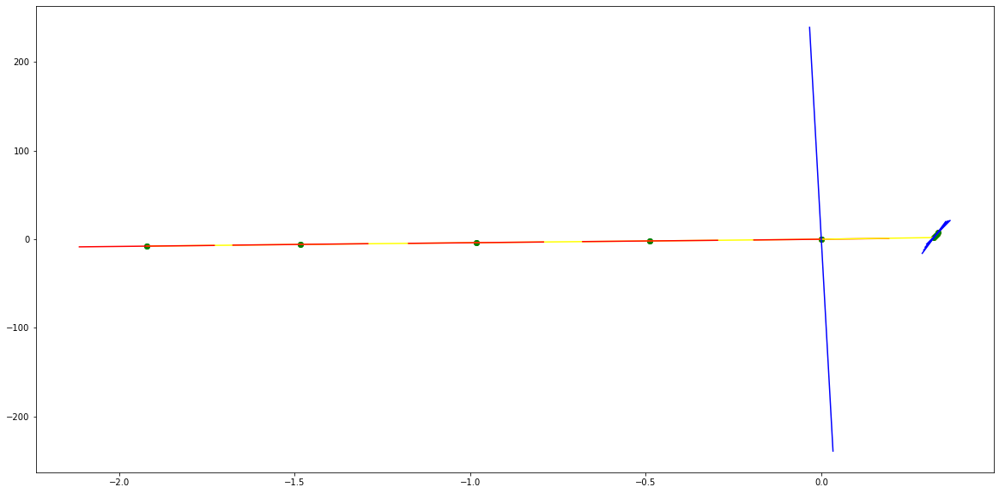

parameters (0.1290425890049923, 1.1836148874419041, 3.9535050605078497, 5.795039946243736, 7.5339380205335615, -0.002306236140632687)
tangent[0]:4.262247387127193
tangent[1]:3.95609602128315
tangent[2]:3.6898614364796476
tangent[3]:4.886788786736733
tangent[4]:7.5339380205335615
parameters (54406.5056480207, -80841.23328316478, 40636.24748102395, -8075.767617948234, 561.3152954789356, -0.11695494141185737)
tangent[0]:561.3152954789356
tangent[1]:496.10534286695577
tangent[2]:435.00396163876695
tangent[3]:377.84441532108144
tangent[4]:-131.80647884206326


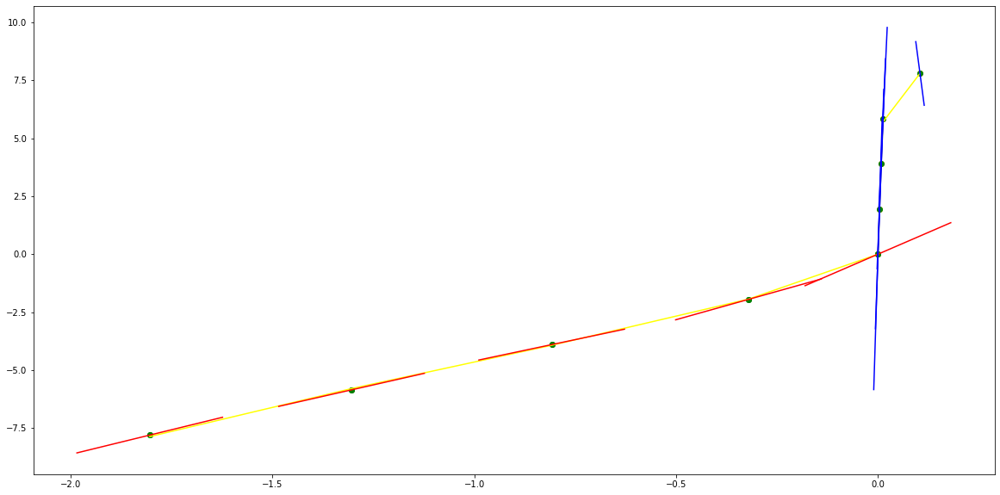

parameters (4.679063970479349, 20.93165924473841, 36.2513972104856, 29.299962064502946, 17.87785934852332, -0.0036036450665406536)
tangent[0]:7.6224695226962815
tangent[1]:6.991605115634286
tangent[2]:7.184336144839676
tangent[3]:11.3958667668263
tangent[4]:17.87785934852332
parameters (290138.58867797727, -239395.4845121263, 53531.85833394893, -4439.247622333543, 201.9067240515518, 0.5869556060586827)
tangent[0]:201.9067240515518
tangent[1]:167.6297493431177
tangent[2]:45.88414370917445
tangent[3]:74.97722867862262
tangent[4]:102.34057023839284


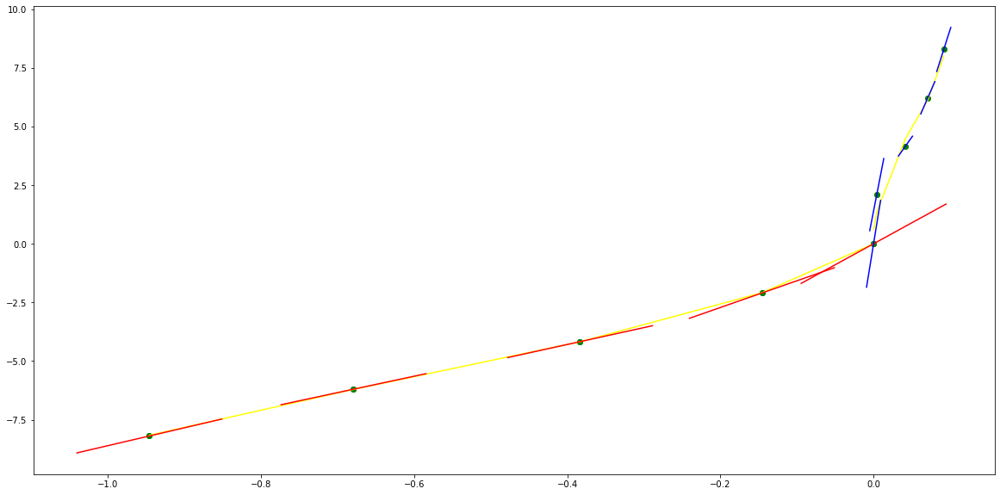

parameters (5628.134785397206, 7235.847005058641, 3382.761123508732, 702.2440905035039, 65.28798703871828, 0.04597347906722846)
tangent[0]:-0.7456063536724002
tangent[1]:28.710622404649783
tangent[2]:32.258765991327905
tangent[3]:49.26171102622043
tangent[4]:65.28798703871828
parameters (281770.6149710637, -141943.86790673234, 26012.288050657146, -2221.2304028357366, 113.69942464632858, 0.06855866173652889)
tangent[0]:113.69942464632858
tangent[1]:96.50205711283984
tangent[2]:58.8146728229087
tangent[3]:43.08978608771848
tangent[4]:23.92199531099199


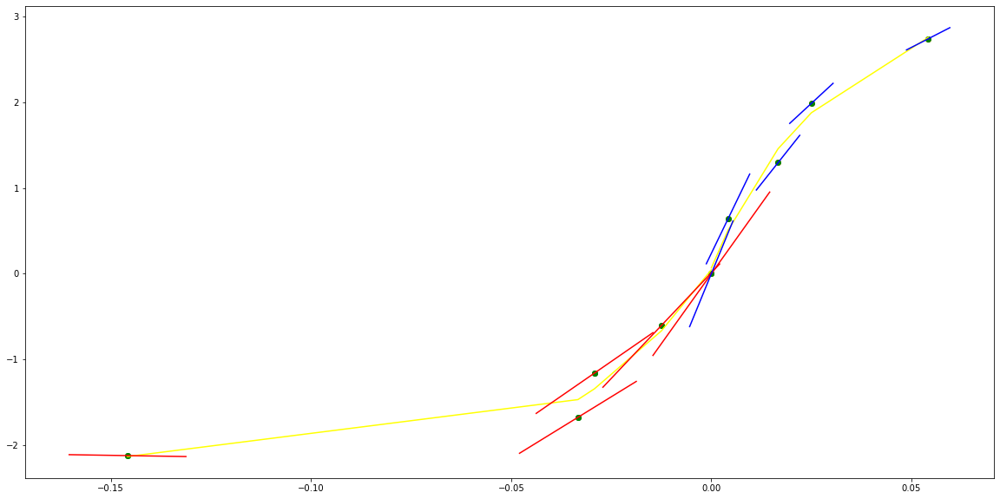

parameters (60021475.649059795, 11738510.605676178, 917595.4386361303, 34905.90981152879, 692.0092817201282, 0.09316429171696014)
tangent[0]:108.52742789273066
tangent[1]:49.773489465834245
tangent[2]:275.6956400890751
tangent[3]:445.59561412710184
tangent[4]:692.0092817201282
parameters (-69420493.69829972, 10680392.650332643, -330308.2170092305, -10563.33441567871, 528.5203466805907, -0.00493650048859527)
tangent[0]:528.5203466805907
tangent[1]:426.26569215244194
tangent[2]:-122.9717757966971
tangent[3]:385.1974052964059
tangent[4]:471.0117244494737


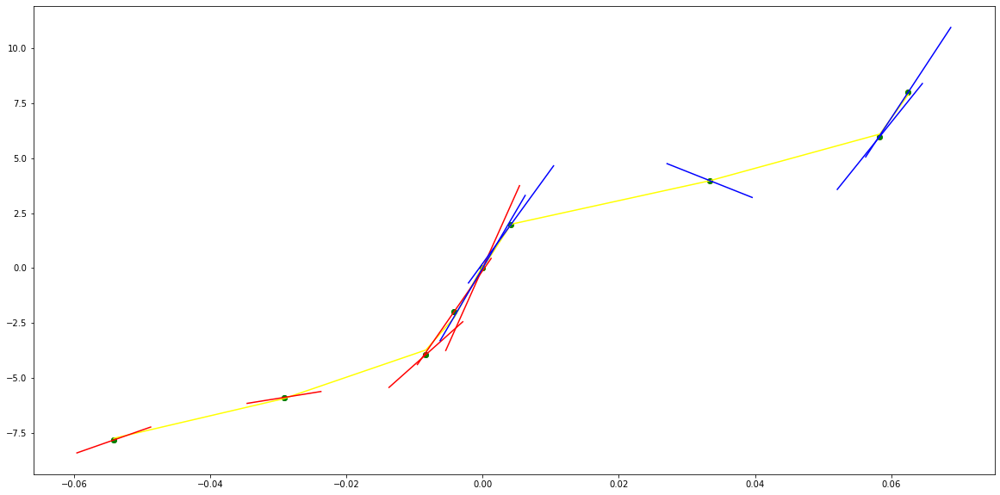

parameters (-0.033124260156109114, -0.2715014533259905, -0.848186102355116, -1.2612968005130718, 3.8485420492994433, -0.0012870080605185779)
tangent[0]:4.738709402694601
tangent[1]:4.740533966362481
tangent[2]:4.741984307554599
tangent[3]:4.574119826763949
tangent[4]:3.8485420492994433
parameters (-45.48223074910025, 215.68222484245936, -352.20886483507167, 229.72436094475106, -44.7014120381213, -0.0007652670114091113)
tangent[0]:-44.7014120381213
tangent[1]:18.16399551445935
tangent[2]:-6.76318051349687
tangent[3]:24.537763013625813
tangent[4]:28.14832621367652


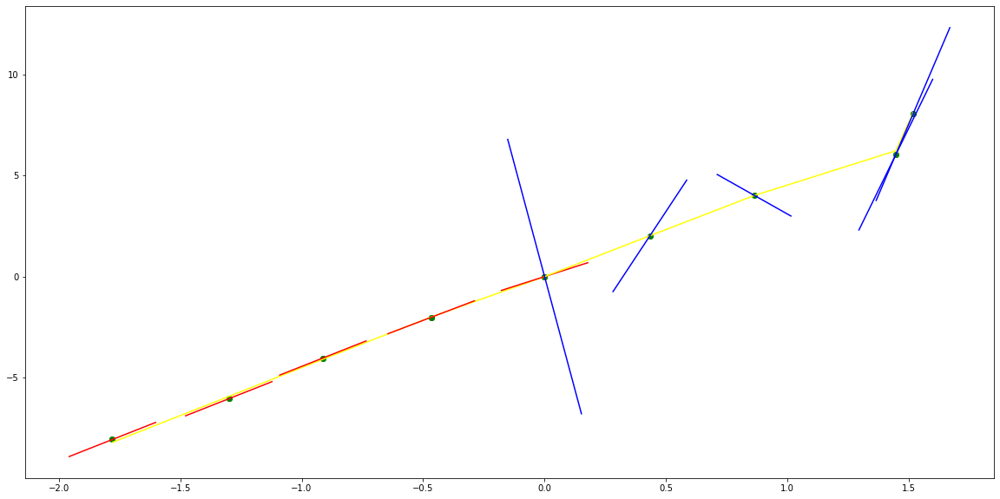

parameters (0.013202676544114864, 0.14648475265214705, 0.5265892775483548, 0.6569815720809656, 4.759707623814631, -0.006671162161968951)
tangent[0]:4.772981459733273
tangent[1]:4.640960988237119
tangent[2]:4.472914580180703
tangent[3]:4.4416185623376805
tangent[4]:4.759707623814631
parameters (90.47201377786605, -441.6294112824723, 759.8922264942399, -528.5161044666041, 123.3774935685276, 0.00010581628062639538)
tangent[0]:123.3774935685276
tangent[1]:-34.67521550366655
tangent[2]:31.96932078178679
tangent[3]:30.8054023329928
tangent[4]:28.3019698228145


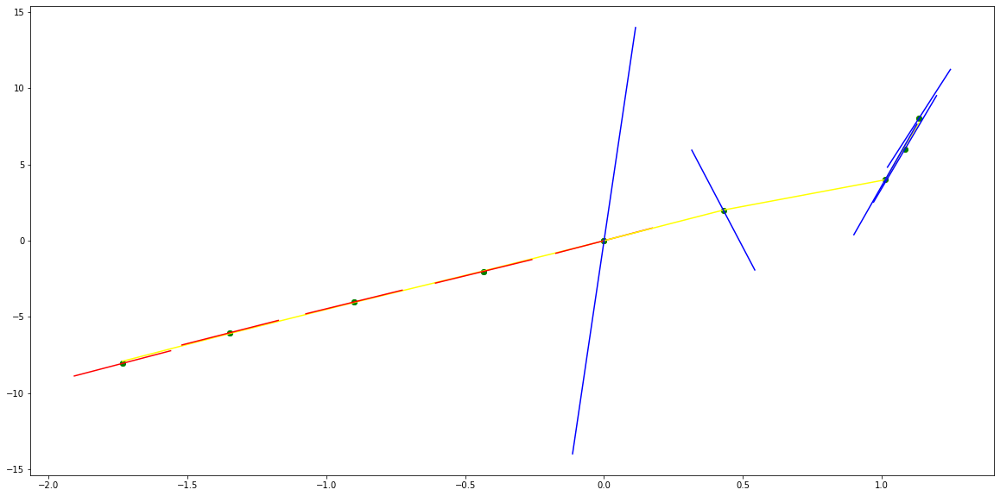

parameters (-0.12623570582680319, -1.1086195218396728, -3.424309467551719, -4.641917130903554, 1.1755082643580501, -0.0018582297368428373)
tangent[0]:4.31155709359627
tangent[1]:3.773739416535867
tangent[2]:3.8940538434717924
tangent[3]:3.9783502375237996
tangent[4]:1.1755082643580501
parameters (121.04751520581235, -598.8459012799708, 1008.4015477044506, -673.4826843468519, 148.28277845023717, 1.2176558694686296e-06)
tangent[0]:148.28277845023717
tangent[1]:-44.281094910436536
tangent[2]:37.94710617328428
tangent[3]:-50.59852378018809
tangent[4]:462.6856294144234


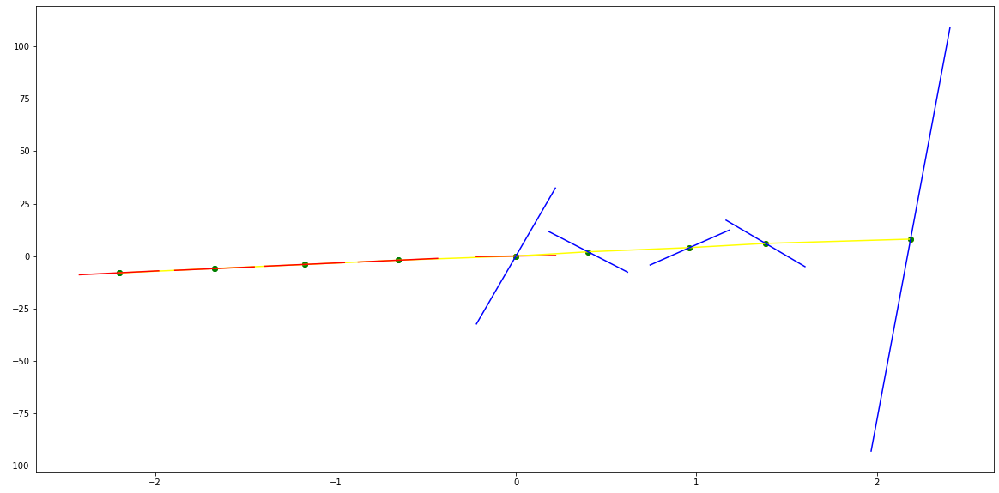

parameters (-0.03542606159521697, -0.34317853063287884, -1.084809605609261, -1.235916729178818, 3.4675978032167656, 0.022957546220976795)
tangent[0]:3.588476069159219
tangent[1]:3.548127658291642
tangent[2]:3.903798557415486
tangent[3]:4.054863096150901
tangent[4]:3.4675978032167656
parameters (12252.855631398072, -55455.798538190924, 89778.6556930291, -59967.66412518605, 13090.092032253406, -1.086701335750859e-07)
tangent[0]:13090.092032253406
tangent[1]:-4294.02957230856
tangent[2]:531.1681910078169
tangent[3]:497.0940720868075
tangent[4]:463.2618011055001


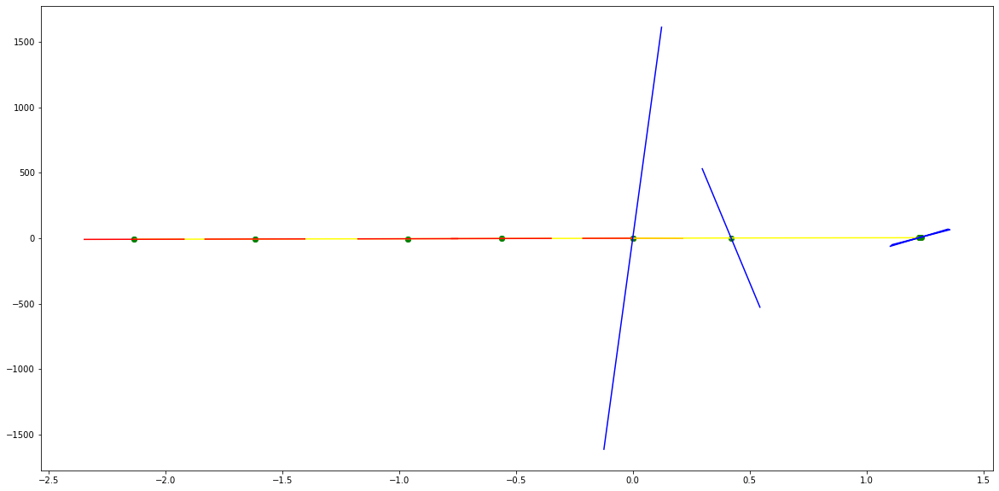

parameters (-39943886.30249742, -12972021.74147547, -1507375.8879384396, -72802.47736413445, -1080.4059282612814, -0.0016789106458380252)
tangent[0]:287.0526546431968
tangent[1]:361.870705544756
tangent[2]:423.72423481696046
tangent[3]:462.3644734732445
tangent[4]:-1080.4059282612814
parameters (1338060.0942375718, -658332.2849403404, 115520.13122455038, -8355.651829906217, 276.39272308740743, 0.32051928018258974)
tangent[0]:276.39272308740743
tangent[1]:212.5858387141991
tangent[2]:19.87675975566748
tangent[3]:64.03858035875857
tangent[4]:106.56720120009987


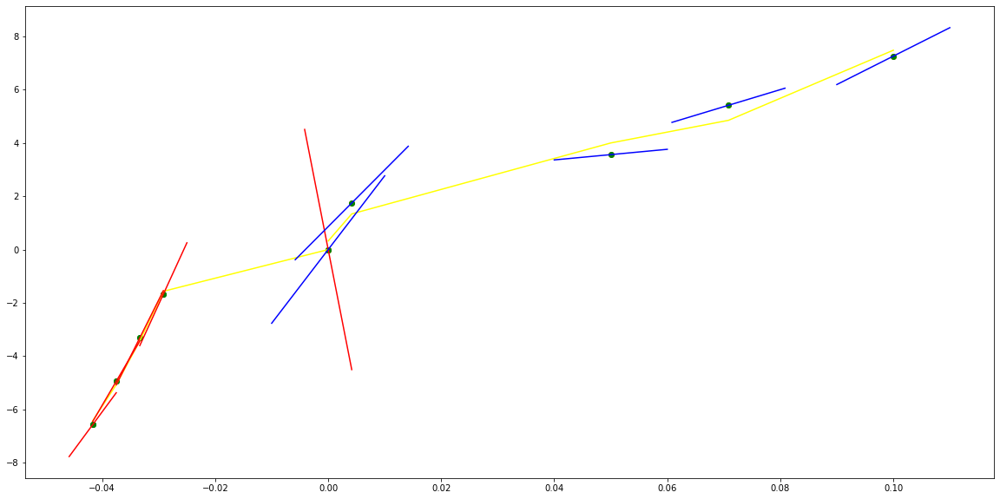

parameters (4254760.03752166, 1725041.6476824116, 238735.94598996048, 12878.517558008256, 326.0251237934439, 0.07766520375865679)
tangent[0]:187.66198214311447
tangent[1]:185.02513226976356
tangent[2]:79.54549954357293
tangent[3]:103.01215154090545
tangent[4]:326.0251237934439
parameters (-28551129.92915929, 5373417.223215607, -159934.4333422857, -12327.565641279623, 640.0949752598389, -0.061030475978943795)
tangent[0]:640.0949752598389
tangent[1]:530.5379318791252
tangent[2]:413.075398046063
tangent[3]:-108.0455165439854
tangent[4]:412.5998347614751


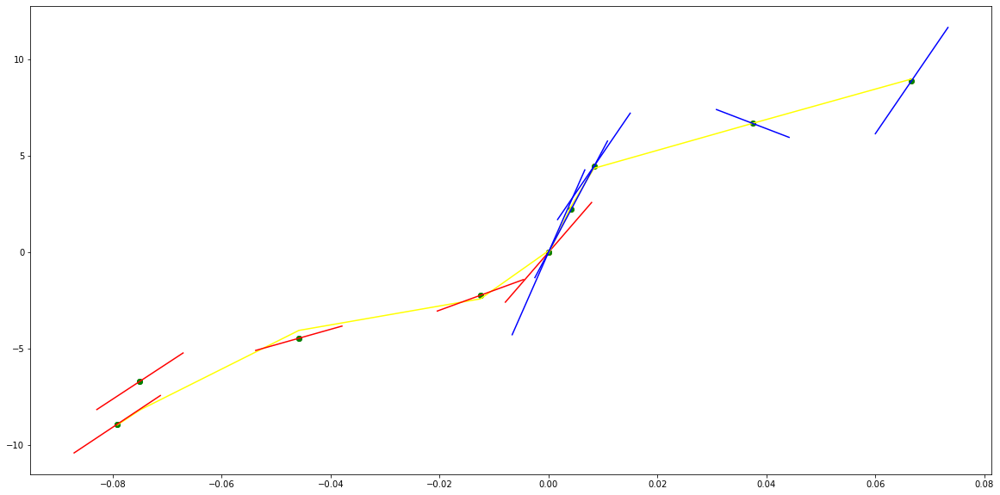

parameters (4983.290599827884, 6585.031299453745, 3140.483367191011, 651.049372028235, 86.16459563473495, -1.0004877699261805)
tangent[0]:34.52729492827905
tangent[1]:27.706822167010046
tangent[2]:30.038959780876795
tangent[3]:80.90044484612919
tangent[4]:86.16459563473495
parameters (20824.19218871696, -22008.303838460146, 8441.035362189874, -1407.1570850941207, 129.12940546385917, 0.9141350761852127)
tangent[0]:129.12940546385917
tangent[1]:117.83552764091168
tangent[2]:30.028230869699883
tangent[3]:28.312032029778294
tangent[4]:41.75845689109477


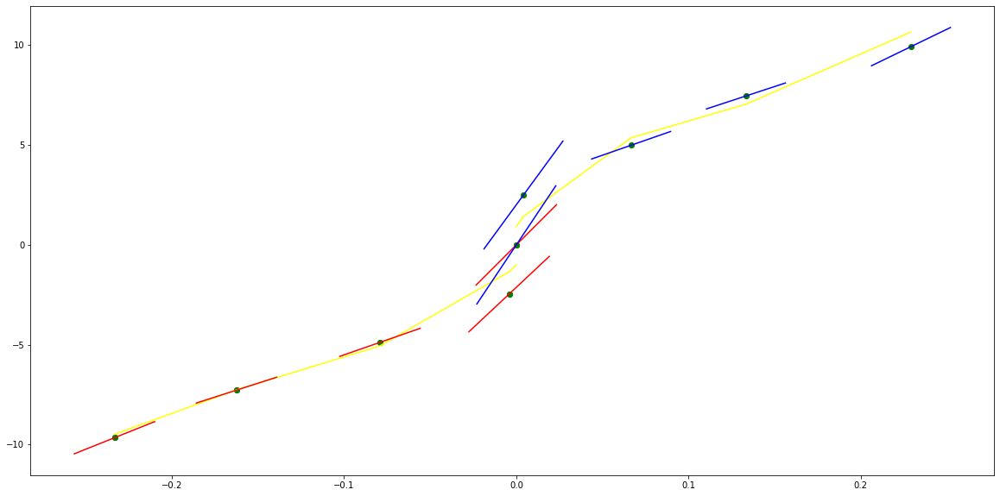

parameters (68265.33134321768, 57755.92739912165, 16985.147192053882, 2023.756403934037, 89.47684466976317, -0.03451876215218292)
tangent[0]:23.975472682367226
tangent[1]:20.766739420661096
tangent[2]:-12.813863828972742
tangent[3]:73.479030546725
tangent[4]:89.47684466976317
parameters (1418.0945883965176, -2131.1629173766337, 1174.4861000238327, -279.35673166733443, 30.24634824316949, 0.15343002030436825)
tangent[0]:30.24634824316949
tangent[1]:27.97875551413699
tangent[2]:13.813936111925187
tangent[3]:2.818789826897312
tangent[4]:7.010792002586253


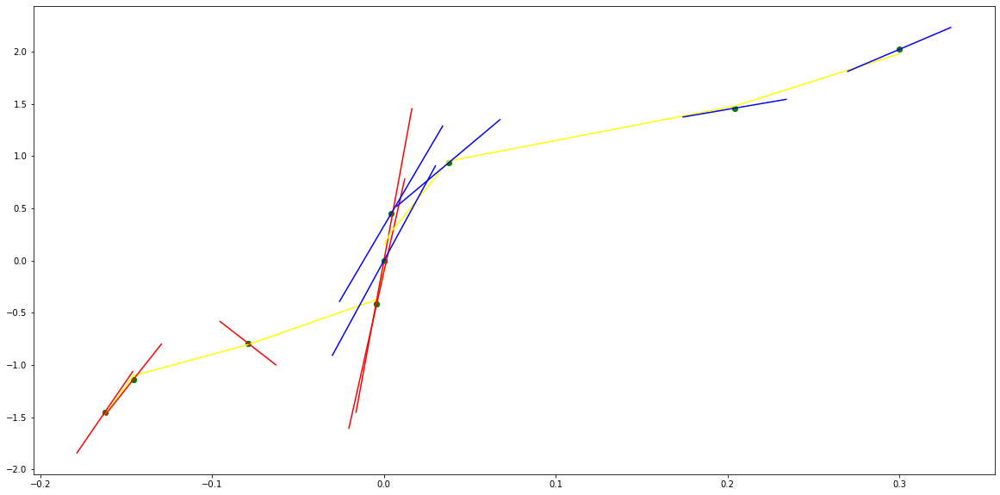

parameters (-3.6303087924313693, 22.727570973949234, 65.10770754812869, 56.17984948055104, 23.522280800465783, 0.029134595420787286)
tangent[0]:4.979705568640913
tangent[1]:14.146816692507421
tangent[2]:14.46681070121933
tangent[3]:14.792566536926302
tangent[4]:23.522280800465783
parameters (-11168.529533698857, 6250.368362948299, 4822.856725222691, -3109.205537932495, 239.72352790906703, -0.016081333899183488)
tangent[0]:239.72352790906703
tangent[1]:214.06443175538783
tangent[2]:188.92438730163556
tangent[3]:-136.490995204085
tangent[4]:246.0087816498532


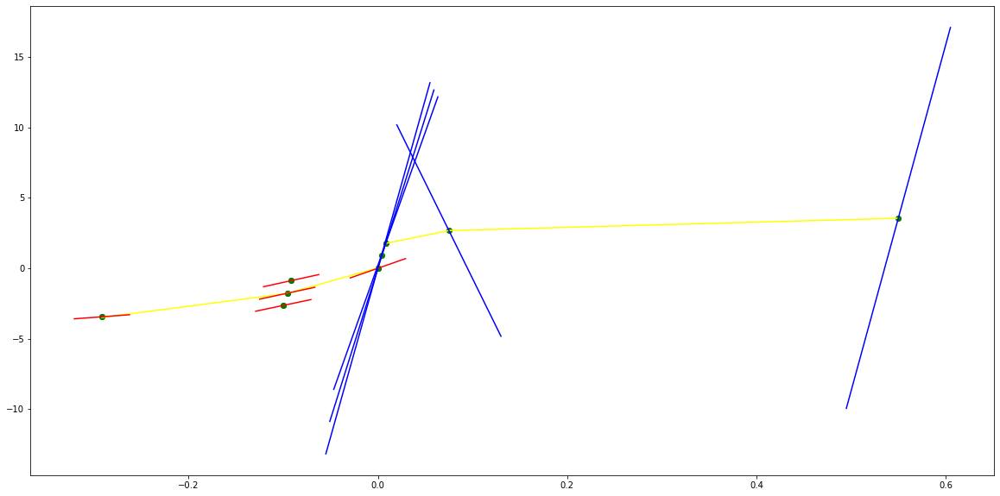

parameters (32922.82494564114, 42802.085861946885, 20233.864447221862, 4109.276351004126, 313.01611922376895, 0.0965170507518316)
tangent[0]:0.6959735716265527
tangent[1]:24.077334705588044
tangent[2]:3.2951688809066013
tangent[3]:279.81108763991887
tangent[4]:313.01611922376895
parameters (1920000.6656132268, -1131130.5476746042, 222383.87551417854, -16680.345002786446, 427.0600904996594, -0.20512690125269215)
tangent[0]:427.0600904996594
tangent[1]:299.30596320577763
tangent[2]:-105.3972782026143
tangent[3]:184.66237392227765
tangent[4]:197.98549747592313


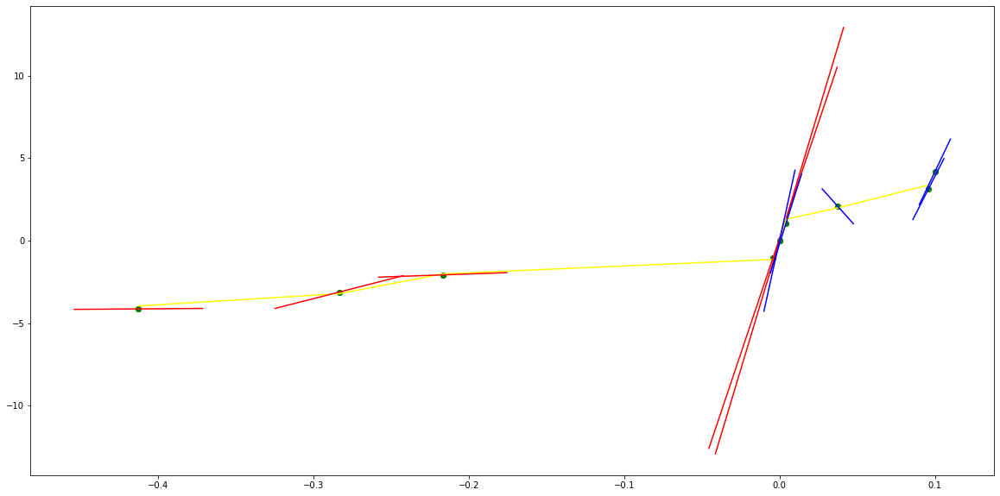

parameters (-3.729327770415651, -29.628174925080213, -83.84877263181664, -99.64607283915997, -40.20509043458765, -7.494648251938302e-06)
tangent[0]:8.99071365597677
tangent[1]:6.414537759104455
tangent[2]:-1.43143183392079
tangent[3]:8.614171347646895
tangent[4]:-40.20509043458765
parameters (-458487.53600814915, 1907585.520851666, -2972656.1543720346, 2056398.5124889931, -532837.344541362, 1.728679333454638e-09)
tangent[0]:-532837.344541362
tangent[1]:349.3505613724701
tangent[2]:254.64618154009804
tangent[3]:172.35961396992207
tangent[4]:221.5343318269588


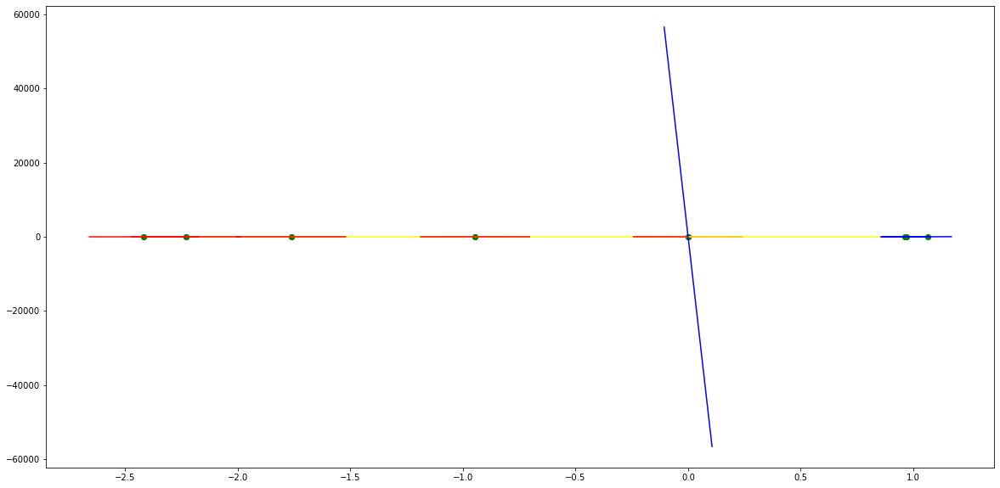

parameters (0.2564554665329164, 2.095897662144635, 6.179774441531329, 7.675788215526213, 4.437387083902584, -0.0003197102657527168)
tangent[0]:4.783984242384504
tangent[1]:1.3345406376436042
tangent[2]:1.3996669697074626
tangent[3]:0.46156390057814534
tangent[4]:4.437387083902584
parameters (7211552.3259368995, -3224982.1402134867, 493364.2855429778, -28562.726853124877, 459.7156238033032, -0.11166671753789983)
tangent[0]:459.7156238033032
tangent[1]:246.45151933457095
tangent[2]:79.17474285480904
tangent[3]:253.9464215821655
tangent[4]:233.99429365048866


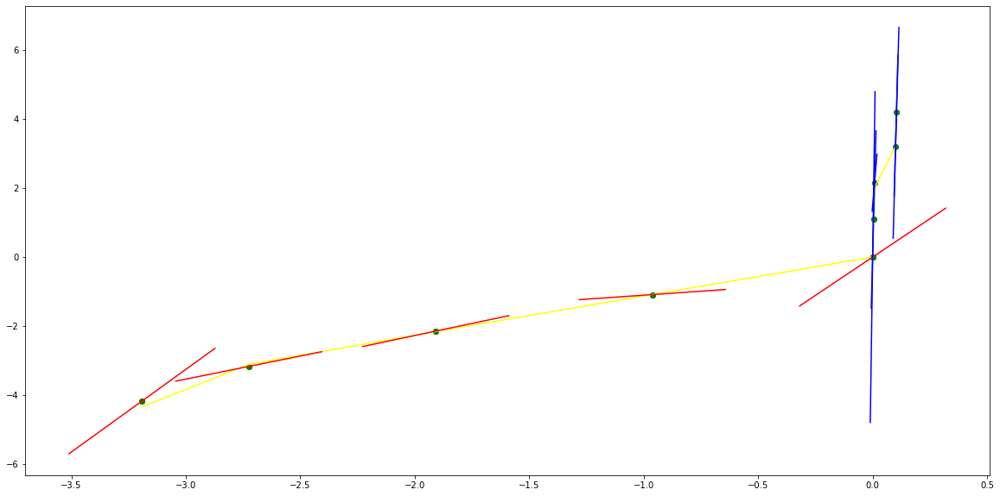

parameters (0.39884137835755396, 2.2434823870851197, 4.9631453468567335, 4.708611918485289, 6.279537275652152, 0.0012635770972907637)
tangent[0]:4.8833446805489205
tangent[1]:4.540202606573073
tangent[2]:4.295938694358764
tangent[3]:4.615352037577699
tangent[4]:6.279537275652152
parameters (29157.74273925146, -72799.77191940052, 64498.95397465762, -23707.047343089765, 2985.0711442660636, -1.9159361427445885e-05)
tangent[0]:2985.0711442660636
tangent[1]:-663.6346803448009
tangent[2]:351.5039496231461
tangent[3]:339.5947667294554
tangent[4]:332.4500691761991


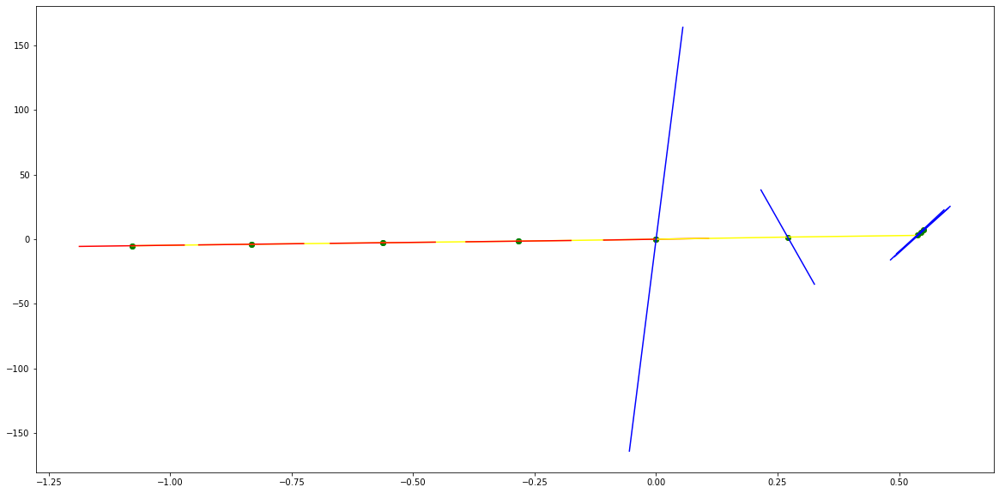

parameters (4.763271009347897, 20.95749723852618, 34.39858160081213, 26.83692140997498, 15.27756985292083, -0.8254857430202689)
tangent[0]:5.190725282065539
tangent[1]:5.207545032494778
tangent[2]:6.714248560276179
tangent[3]:14.837423126503733
tangent[4]:15.27756985292083
parameters (2570.0523549550107, -5188.961425750982, 3767.1684284766693, -1152.4297271468477, 139.04851227964812, 1.356281015512438)
tangent[0]:139.04851227964812
tangent[1]:129.63890309535788
tangent[2]:120.61493433547463
tangent[3]:-17.379513372633852
tangent[4]:26.37666002608617


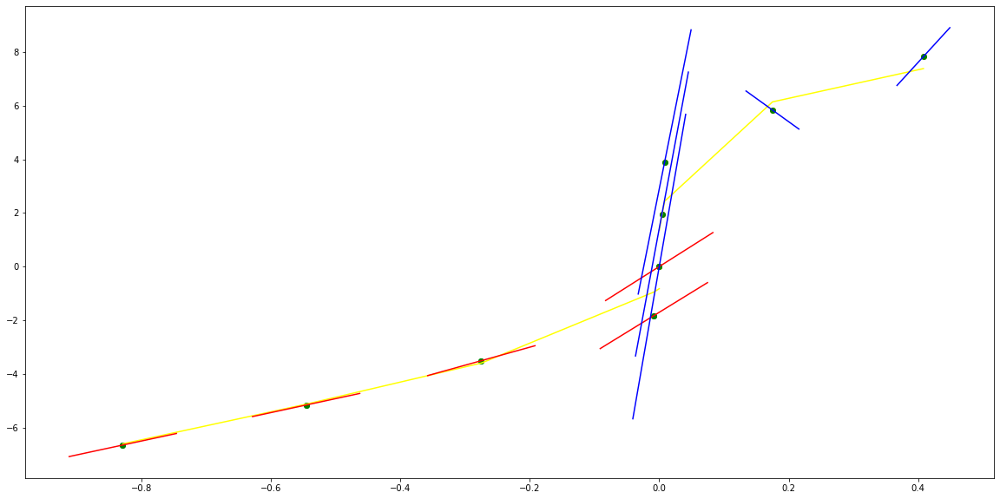

parameters (5.533012416297258, 28.408800043784723, 52.742726687259136, 42.53956412475405, 21.12238096166522, -0.331673769325171)
tangent[0]:8.320058516065888
tangent[1]:6.733685791597313
tangent[2]:5.64119976044789
tangent[3]:15.323307160795979
tangent[4]:21.12238096166522
parameters (282.3123246004969, -834.1126691426856, 875.0697214430114, -387.8133622957023, 75.14955455884218, 1.885977236521109)
tangent[0]:75.14955455884218
tangent[1]:71.96286085361878
tangent[2]:68.86662489212097
tangent[3]:-0.9311798929136188
tangent[4]:13.048928687699075


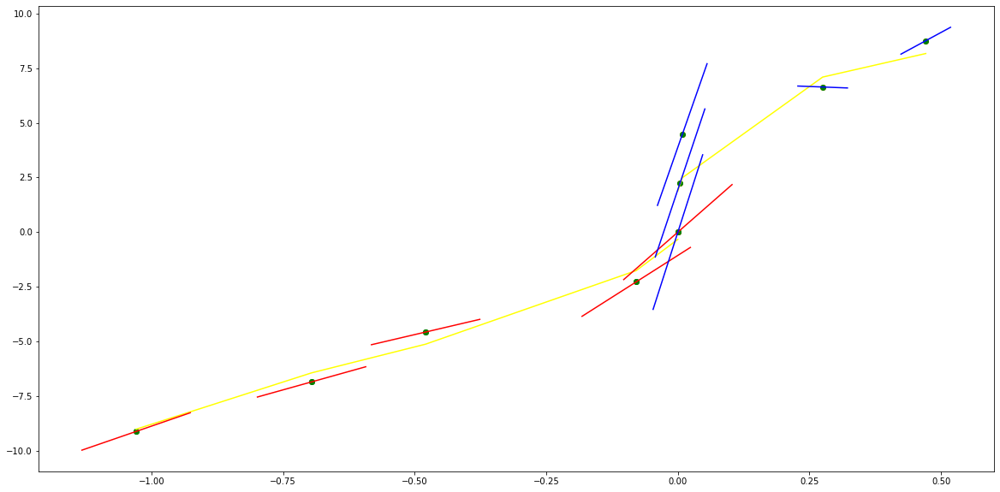

parameters (0.45757838263597345, 2.418747333864713, 4.304350855580934, 2.459188603013366, 4.780224387938841, -0.012118361923027666)
tangent[0]:5.498545434102936
tangent[1]:5.324882324638179
tangent[2]:4.886892672226753
tangent[3]:4.23341119948464
tangent[4]:4.780224387938841
parameters (-3576.7435007908384, 7038.770265259141, -4977.612020394503, 1513.0603645685435, -161.2800341782788, -3.6019284716687416e-05)
tangent[0]:-161.2800341782788
tangent[1]:22.49178095075945
tangent[2]:5.074815896385189
tangent[3]:25.93547786477825
tangent[4]:34.754175249015134


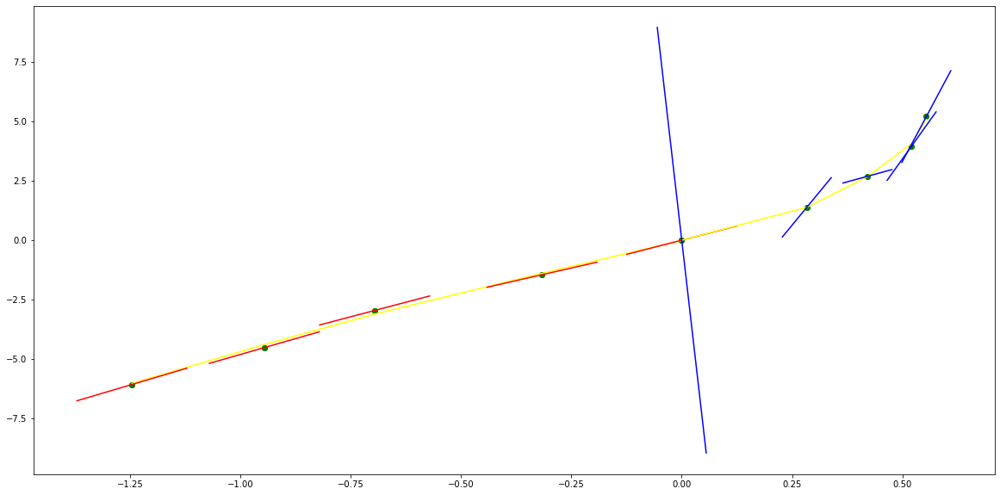

parameters (7860.841650342338, 8677.204329132104, 3612.581662835974, 729.7800805885531, 96.5107814876705, -0.5825300347165708)
tangent[0]:24.723116603712498
tangent[1]:37.866668073782456
tangent[2]:49.21290583366648
tangent[3]:90.61448017966408
tangent[4]:96.5107814876705
parameters (449697.4146197873, -318149.9940469231, 80367.12599289254, -8405.814711362533, 341.7071346379231, 0.20969954800499624)
tangent[0]:341.7071346379231
tangent[1]:275.7481309422235
tangent[2]:-35.09864889029427
tangent[3]:80.50262948058901
tangent[4]:87.42192571389535


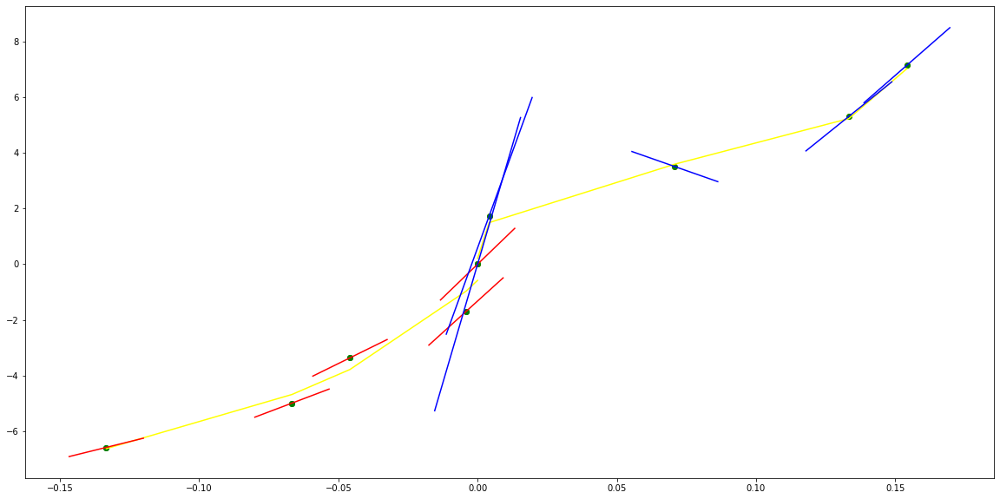

parameters (-63.62070346276284, -119.63540417771252, -83.16079885792166, -28.58310802248976, 16.673650991295915, 0.0005126475363590776)
tangent[0]:22.18220177640752
tangent[1]:21.744837844775695
tangent[2]:21.499084998012993
tangent[3]:20.57774569493133
tangent[4]:16.673650991295915
parameters (4312.122732284339, -6231.814731933908, 3270.955151934535, -765.5365129250584, 102.04054018305358, 0.1088164479509764)
tangent[0]:102.04054018305358
tangent[1]:74.18128949241775
tangent[2]:36.62159815355078
tangent[3]:19.954620846104135
tangent[4]:26.578654630362067


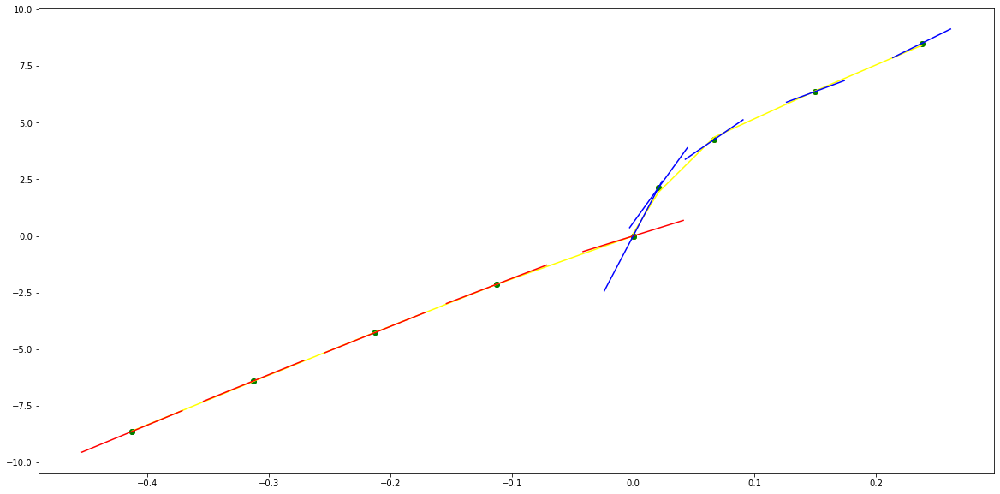

parameters (-0.3074778009234494, -0.9689043894556799, 0.36415485441733864, 3.3717941748674103, 8.135169480742878, -0.025625846822935717)
tangent[0]:5.125149732087332
tangent[1]:4.777365444626145
tangent[2]:5.312893052433608
tangent[3]:6.785542965068343
tangent[4]:8.135169480742878
parameters (555019.8950985366, -319915.8062798654, 48014.10317359056, -1726.5743389265629, 101.0541942736507, 0.0630159187884805)
tangent[0]:101.0541942736507
tangent[1]:77.8033413152713
tangent[2]:134.41080955626057
tangent[3]:145.88900276482028
tangent[4]:157.15075524995336


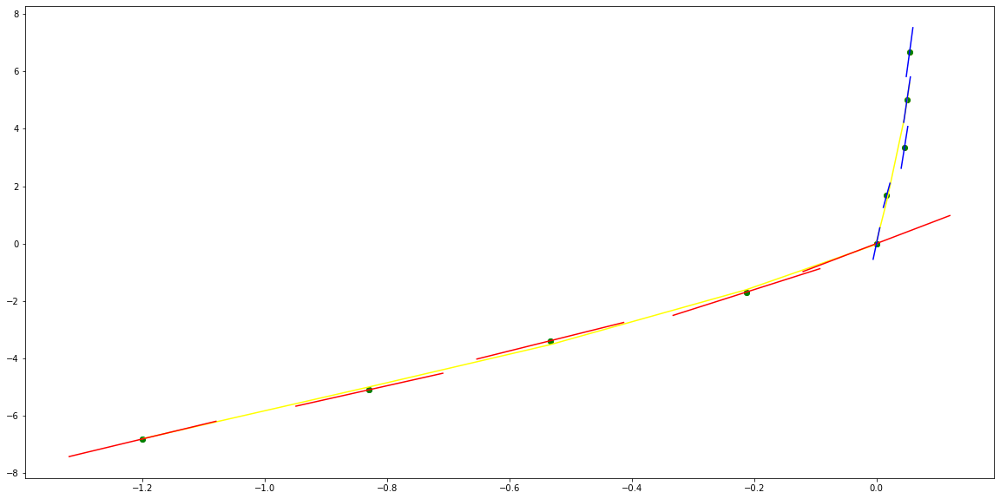

parameters (39.750390232732215, 163.26526742137847, 240.68290714464618, 153.7432572719195, 45.56438055402696, -0.5781645387480889)
tangent[0]:5.169316627570076
tangent[1]:3.943409752934592
tangent[2]:32.926133316360364
tangent[3]:37.19411784435449
tangent[4]:45.56438055402696
parameters (12221.075095949756, -20376.423105472844, 11778.488146474623, -2796.523164143479, 254.24536391857572, 0.5624468113801531)
tangent[0]:254.24536391857572
tangent[1]:231.5468220035456
tangent[2]:210.04529690715958
tangent[3]:135.2542138292464
tangent[4]:-36.77845409183186


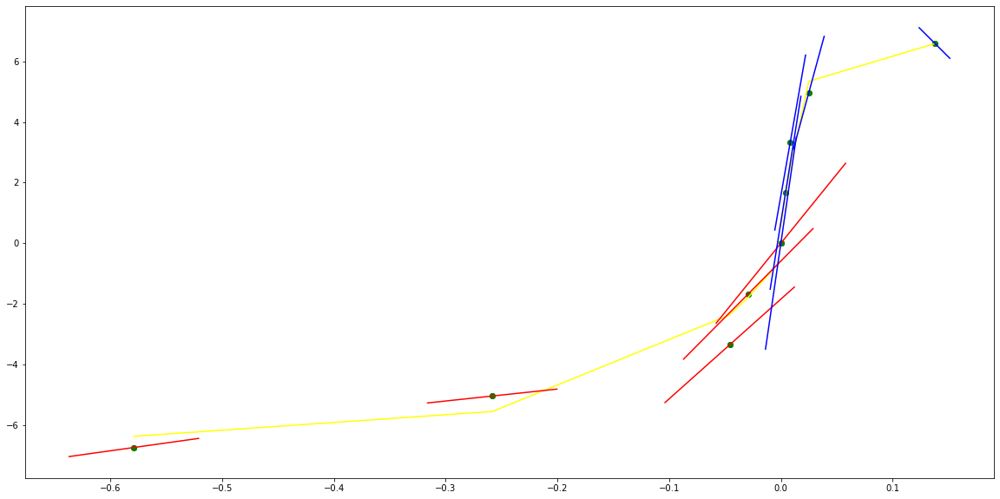

parameters (41.271094092585365, 110.71098082624992, 105.20271934146218, 42.79857675337085, 13.227514709752992, 0.018766317829727472)
tangent[0]:4.7381820103950325
tangent[1]:5.461973797336871
tangent[2]:6.513057499273973
tangent[3]:5.5198276956807995
tangent[4]:13.227514709752992
parameters (-1256679.3298365439, 1934782.4420192095, -1082162.9232720905, 257232.49761036097, -21378.737529111462, -2.1152140903666825e-07)
tangent[0]:-21378.737529111462
tangent[1]:4197.810732011214
tangent[2]:177.26263738043417
tangent[3]:262.90268171320713
tangent[4]:286.20070287155613


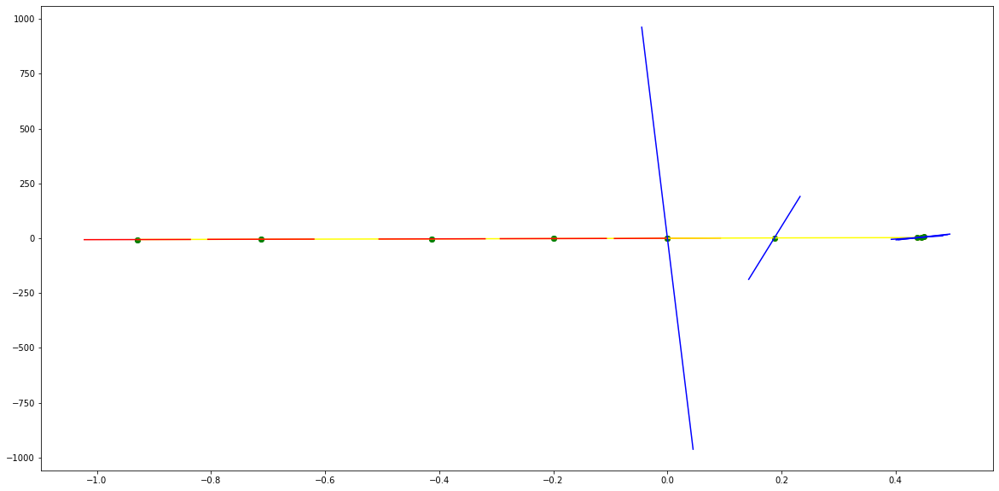

parameters (0.11201559898122844, 0.7655095341026159, 1.7831026611467988, 1.5320234055247097, 4.563513580617392, -0.0005743882749748874)
tangent[0]:4.4733311416677095
tangent[1]:4.478583473005875
tangent[2]:4.23583885256647
tangent[3]:4.010780045806246
tangent[4]:4.563513580617392
parameters (9902.59462029618, -37441.32361344446, 50991.2342248235, -29193.691870299695, 5777.116487800394, -1.774534867970058e-05)
tangent[0]:5777.116487800394
tangent[1]:-1239.6287615957344
tangent[2]:464.5060062221992
tangent[3]:454.31324950181715
tangent[4]:443.73228265960915


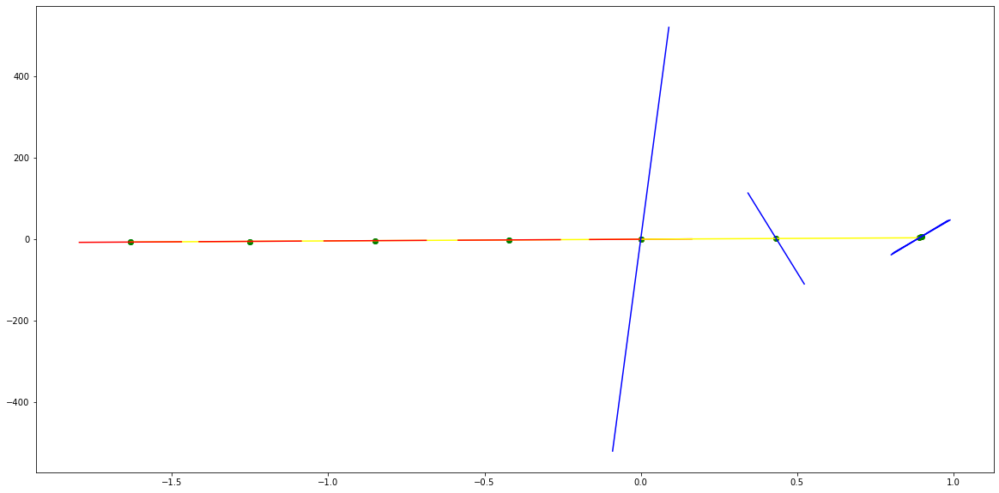

parameters (-451509.7528044191, -423288.72132508596, -120308.43094074744, -9496.166245360297, -50.52777028876371, -0.8113144624860743)
tangent[0]:238.95657887013826
tangent[1]:241.4441391851607
tangent[2]:236.75344273629324
tangent[3]:22.451968322592045
tangent[4]:-50.52777028876371
parameters (427298.626615305, -410717.0071249909, 133477.2764847223, -17124.49402101997, 766.7322928299999, -0.4629574008490546)
tangent[0]:766.7322928299999
tangent[1]:630.8515874092292
tangent[2]:-154.27208336261117
tangent[3]:215.35773263600993
tangent[4]:224.33277172924488


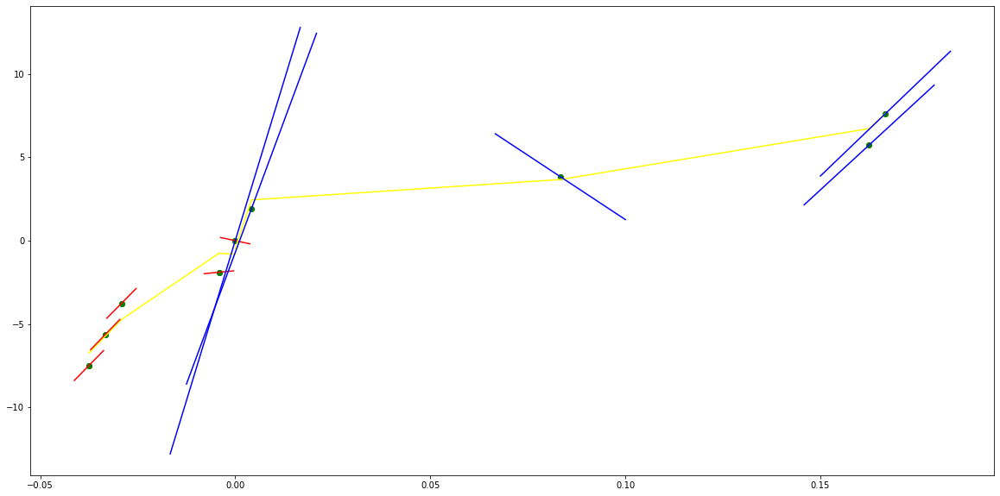

parameters (-0.00035652043216509243, -0.011449064971801343, -0.12652219319177502, -0.5245198161968021, 0.7834700946543987, -0.018580109925022927)
tangent[0]:1.0215761433692034
tangent[1]:1.4260610213442695
tangent[2]:1.6299920512632744
tangent[3]:1.6346275553169125
tangent[4]:0.7834700946543987
parameters (-10.762782414042741, 132.48444206005817, -590.2838353728949, 1113.6510942810717, -730.4090248575194, -2.2913798911310286e-06)
tangent[0]:-730.4090248575194
tangent[1]:149.9244708542974
tangent[2]:-6.358064431587991
tangent[3]:24.051007122878218
tangent[4]:24.189634814664714


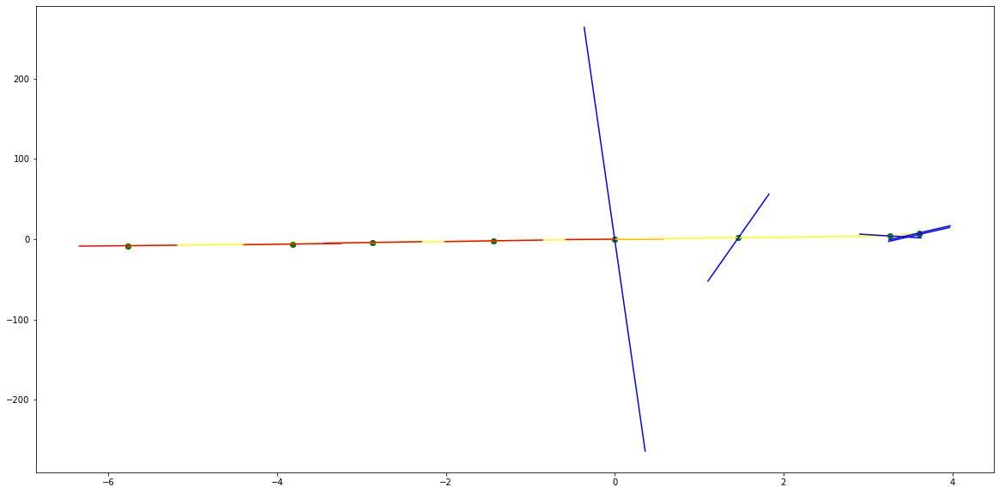

parameters (0.0003170700568573573, 0.00708569060303313, 0.04495578019341536, 0.06514606642623211, 1.3397547277946196, -0.012559341955943961)
tangent[0]:1.4713661630483166
tangent[1]:1.56040567261018
tangent[2]:1.517019057774907
tangent[3]:1.3566897610186506
tangent[4]:1.3397547277946196
parameters (10392.243327900655, -90496.45986096951, 294306.98291592085, -423506.4524539357, 227439.83569931568, 2.0801774645904141e-07)
tangent[0]:227439.83569931568
tangent[1]:-2152.8670339495584
tangent[2]:432.74821932057966
tangent[3]:413.9689479433291
tangent[4]:394.7799530623306


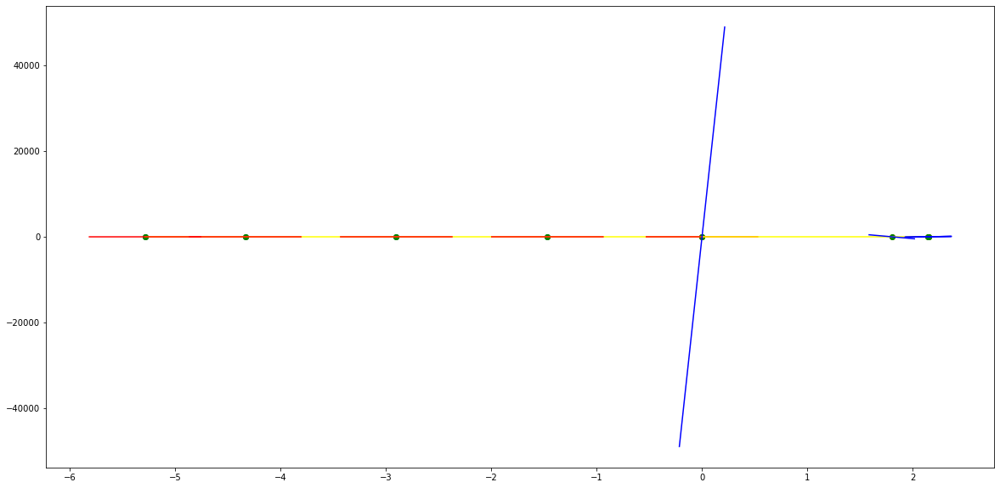

parameters (10392.243374251759, 36591.9986881411, 30624.36227191365, 8329.50929870627, 674.1467152269598, 0.30973035076300387)
tangent[0]:413.9689477578414
tangent[1]:394.7799527644021
tangent[2]:-245.79222504531788
tangent[3]:606.313283975748
tangent[4]:674.1467152269598
parameters (170.59463006570414, -513.9042714239878, 558.7173387554614, -267.6048414996883, 63.29261592946502, 0.9989032640666025)
tangent[0]:63.29261592946502
tangent[1]:61.0913532202963
tangent[2]:40.47089076663971
tangent[3]:9.37205173478376
tangent[4]:7.208260486246381


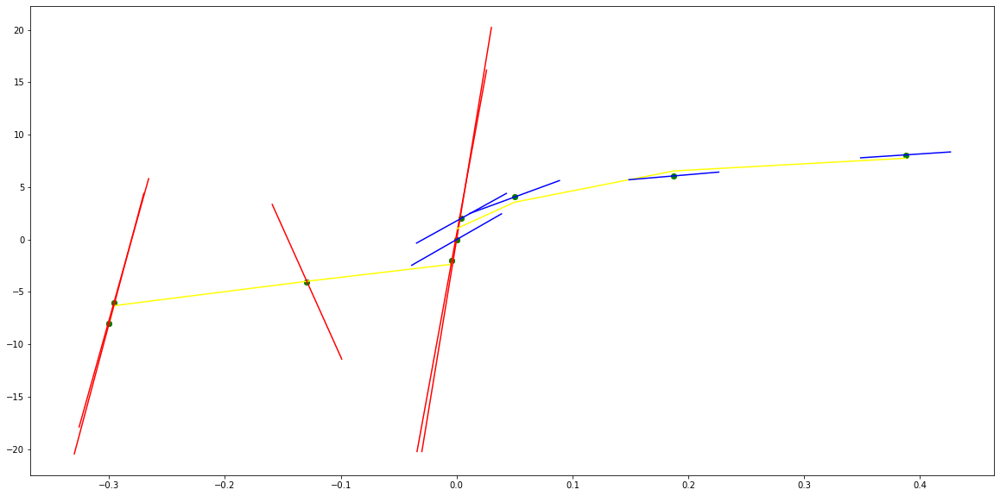

parameters (0.07199781765517564, 0.7700998397235372, 3.066979852400568, 5.238470943686516, 4.555430537080538, -0.0016788930727100692)
tangent[0]:5.000056243928318
tangent[1]:2.149243890012725
tangent[2]:1.8041656507399875
tangent[3]:0.5778412024116255
tangent[4]:4.555430537080538
parameters (-1488.81361394633, 13296.678960144565, -43134.19183877758, 59471.385275865265, -28722.011710130333, -3.2709082530866683e-07)
tangent[0]:-28722.011710130333
tangent[1]:5481.723729556994
tangent[2]:-908.8330110905372
tangent[3]:260.87340072232473
tangent[4]:243.81324804252654


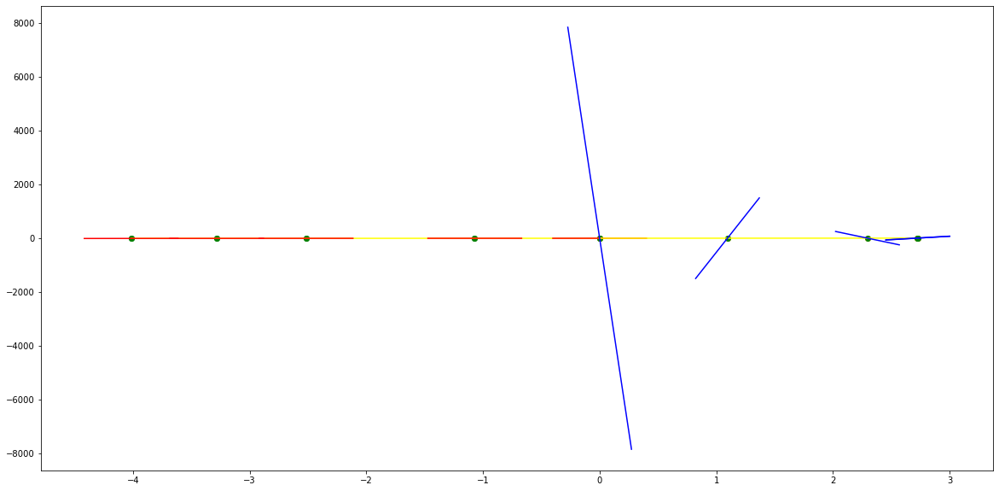

parameters (0.031095390469144394, 0.3682337537590166, 1.5354976188487488, 2.653253301615142, 3.1476309015641113, 0.009151579741936242)
tangent[0]:1.7304511191329595
tangent[1]:1.1324841414371618
tangent[2]:1.7198376665081248
tangent[3]:1.1502158401846367
tangent[4]:3.1476309015641113
parameters (196530.89989502047, -1219325.5329582775, 2820578.364869152, -2880403.009624543, 1094320.2592390373, -7.573261841801271e-09)
tangent[0]:1094320.2592390373
tangent[1]:-24094.141321168514
tangent[2]:526.4998689170461
tangent[3]:410.5007883987855
tangent[4]:304.61297502252273


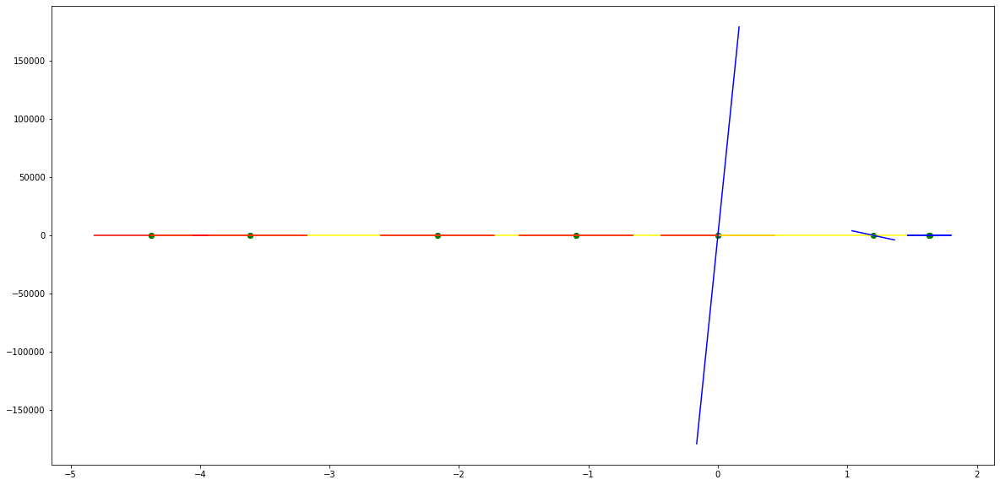

parameters (0.007068382294417386, 0.1215752467066249, 0.7739377283274324, 2.215979706884541, 4.214354596076917, -0.0936435878929055)
tangent[0]:1.5852481988541145
tangent[1]:1.4867120389103379
tangent[2]:1.3026283326546046
tangent[3]:2.7027043080509867
tangent[4]:4.214354596076917
parameters (10807921.469671385, -4990368.062305901, 721720.6405370714, -38106.58232560254, 678.8982088574494, -0.1430039956007938)
tangent[0]:678.8982088574494
tangent[1]:397.54475221349367
tangent[2]:182.87052037624414
tangent[3]:373.89426436165013
tangent[4]:410.01537627983635


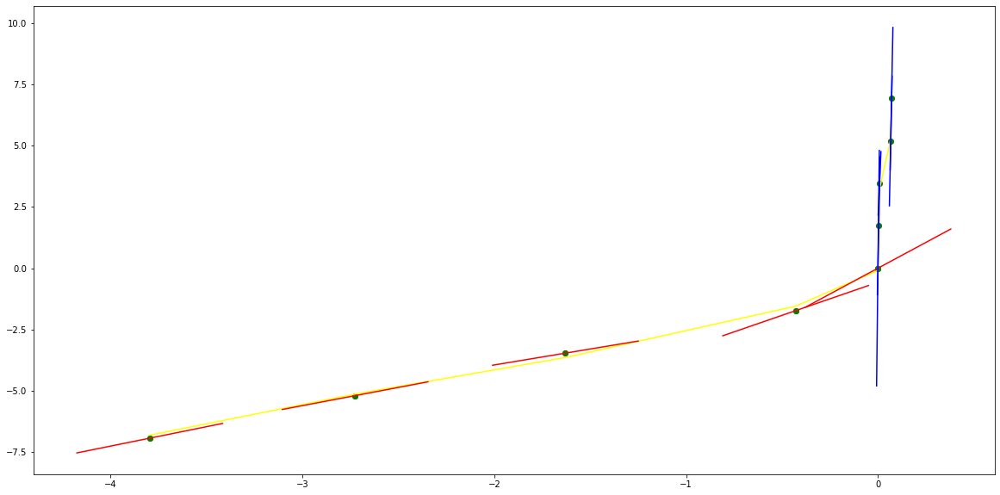

parameters (-3711.588177215131, -12264.680422381642, -14619.165047205153, -7354.7552123754795, -1280.2846556961663, -1.2870867185709472e-05)
tangent[0]:72.51143089024526
tangent[1]:58.52355222797314
tangent[2]:-38.11290518160013
tangent[3]:270.258153039696
tangent[4]:-1280.2846556961663
parameters (879.8792241952137, -1326.4252523989837, 715.4474270688262, -194.08218621480043, 49.602351989491154, 0.08475750651230025)
tangent[0]:49.602351989491154
tangent[1]:38.857375610284144
tangent[2]:27.81670389244802
tangent[3]:23.50330149208198
tangent[4]:21.646800476553935


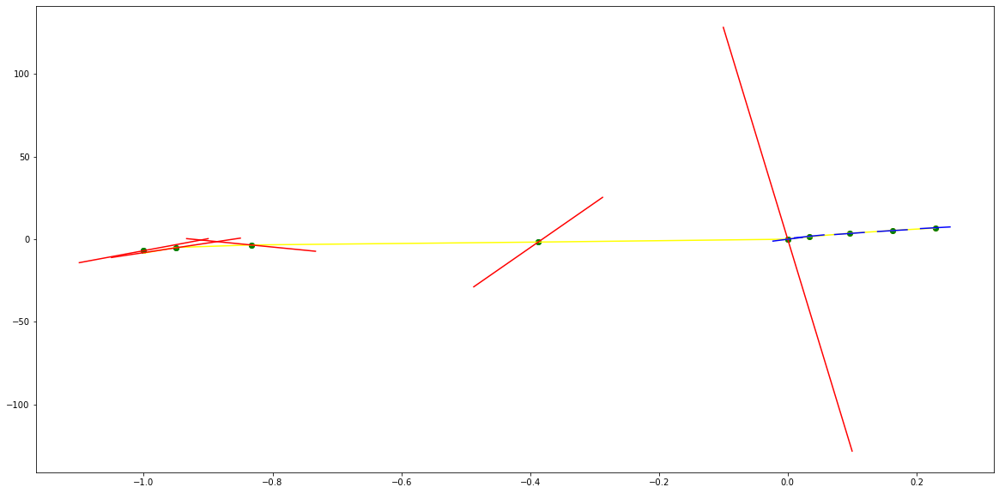

parameters (0.007822983314790413, 0.07424190419040841, 0.23667259556676587, 0.27839097470284524, 2.811515673868682, 0.006416644388579283)
tangent[0]:2.74224673471485
tangent[1]:2.7896332947758715
tangent[2]:2.740421554135094
tangent[3]:2.6750174469593744
tangent[4]:2.811515673868682
parameters (746.4001453290336, -4091.3123212899955, 8212.35173154455, -7075.773776285258, 2170.5512371784685, -2.9639377632045127e-06)
tangent[0]:2170.5512371784685
tangent[1]:-338.748744543052
tangent[2]:70.36942481444612
tangent[3]:56.040267837128795
tangent[4]:38.514180317856244


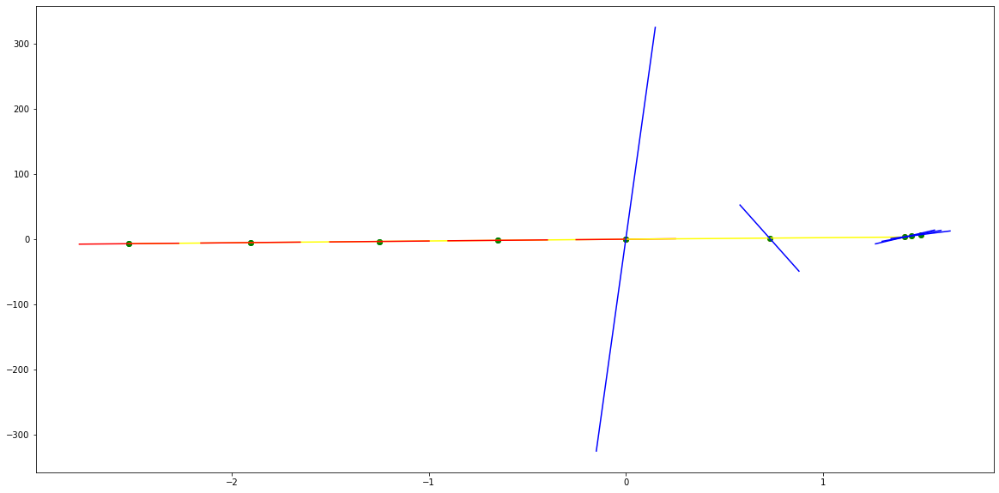

parameters (-0.009313191724068642, -0.10523475183299687, -0.40212725773653574, -0.6585005249678311, 1.0748480955925113, -0.0005941125063102851)
tangent[0]:1.7016454221038233
tangent[1]:1.5134997770529333
tangent[2]:1.5303101394946714
tangent[3]:1.5417464717769451
tangent[4]:1.0748480955925113
parameters (95.48334870860874, -661.857331001081, 1625.8653154863903, -1649.8111243540754, 575.6975680025129, 6.550845768763256e-07)
tangent[0]:575.6975680025129
tangent[1]:-115.14105499588584
tangent[2]:84.08573981921234
tangent[3]:-62.145739434944176
tangent[4]:105.55891582600032


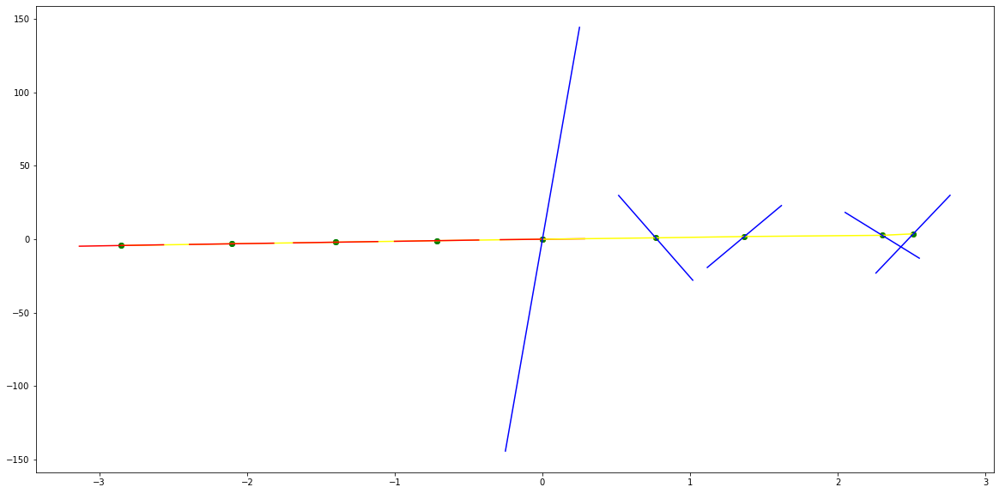

parameters (-0.0011770688879547762, -0.022107888976772027, -0.12964956605985223, -0.3609504028288711, 0.9970110806214743, -0.002188665361033243)
tangent[0]:1.556446605533613
tangent[1]:1.504994914195032
tangent[2]:1.4721613020977555
tangent[3]:1.3596696482571147
tangent[4]:0.9970110806214743
parameters (-8105.14709943434, 45926.372062187605, -93830.94151285342, 80286.30291285076, -23260.832657677543, -5.556469286104193e-09)
tangent[0]:-23260.832657677543
tangent[1]:6173.5641451583215
tangent[2]:-620.3837555588543
tangent[3]:171.66027022320486
tangent[4]:151.36962651337672


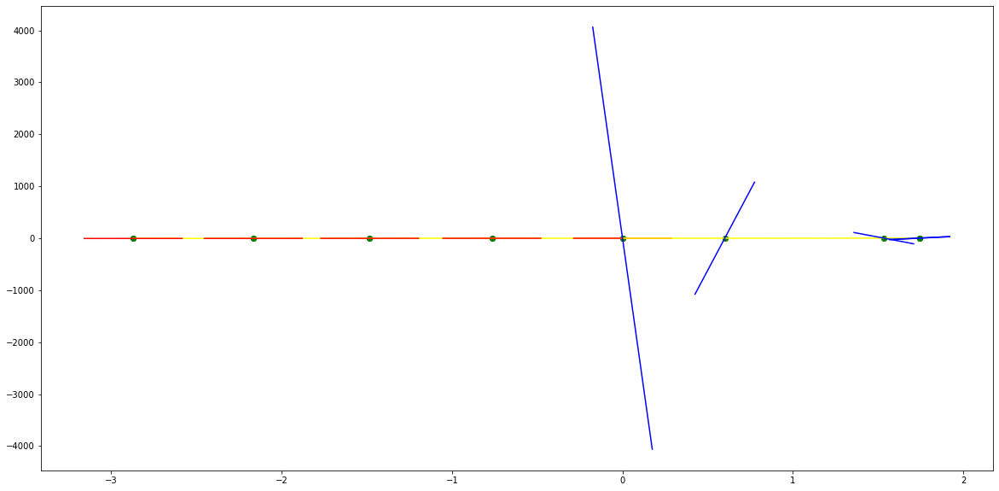

parameters (-0.007236709791466914, -0.09745283020873491, -0.4731531959820207, -1.0459133243453194, 0.2889598027047386, 0.0030912614287571284)
tangent[0]:1.3865815171653237
tangent[1]:1.321490162680304
tangent[2]:1.364391729610665
tangent[3]:1.2942979218060884
tangent[4]:0.2889598027047386
parameters (-38795814.62855528, 35313155.13675482, -12045729.370935502, 1825383.7291551023, -103693.11822364245, 1.6777450316653493e-08)
tangent[0]:-103693.11822364245
tangent[1]:251.95964630741219
tangent[2]:153.08869842127024
tangent[3]:101.16220953899028
tangent[4]:92.89459990455362


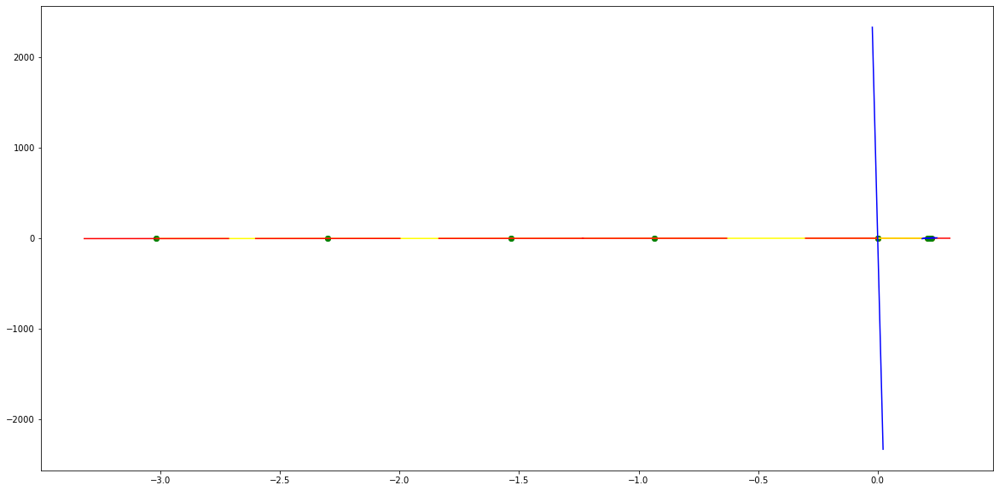

parameters (0.026217769995390876, 0.3272750159292234, 1.4715758529914669, 2.7818401644384716, 3.1811467334996855, -0.08636985687380762)
tangent[0]:1.5312404826506465
tangent[1]:1.1727281566932608
tangent[2]:0.8581395298334162
tangent[3]:2.202069142149046
tangent[4]:3.1811467334996855
parameters (142608685.82668197, -21049008.28912235, 1007965.2126978454, -20293.36323735414, 269.9712924041902, -0.02280664777871202)
tangent[0]:269.9712924041902
tangent[1]:147.47594591305378
tangent[2]:96.45139019210558
tangent[3]:98.72027870170967
tangent[4]:109.87225047523418


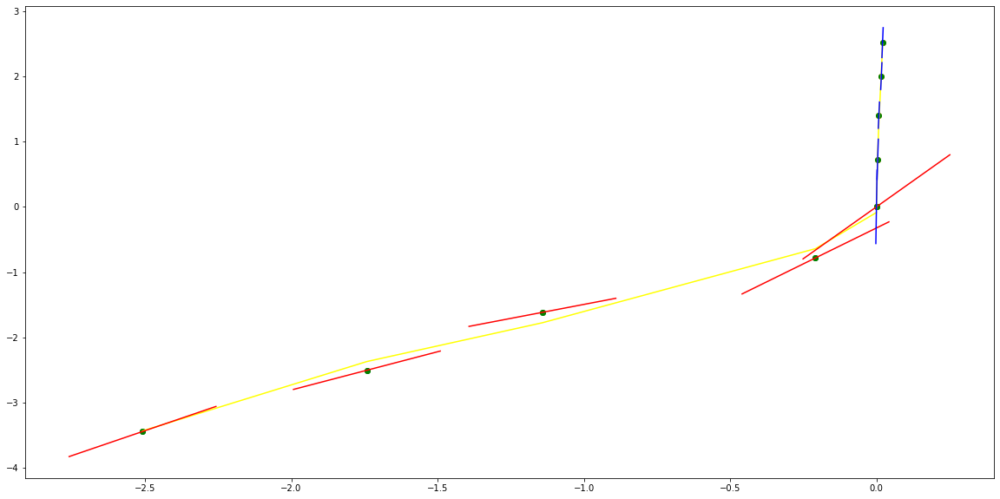

parameters (32778.79425741074, 25170.112263112616, 7273.153578446912, 1012.7149117778949, 81.71022551276823, -0.23831097229264722)
tangent[0]:13.208454703423257
tangent[1]:25.743796878472907
tangent[2]:38.817083501275306
tangent[3]:73.64189478039363
tangent[4]:81.71022551276823
parameters (1142913.314056706, -340543.688428515, 40392.36269127521, -2428.166391283581, 123.37357482870208, 0.176766271532153)
tangent[0]:123.37357482870208
tangent[1]:105.1445040011028
tangent[2]:63.554047868753
tangent[3]:51.133719926353265
tangent[4]:48.5674121420668


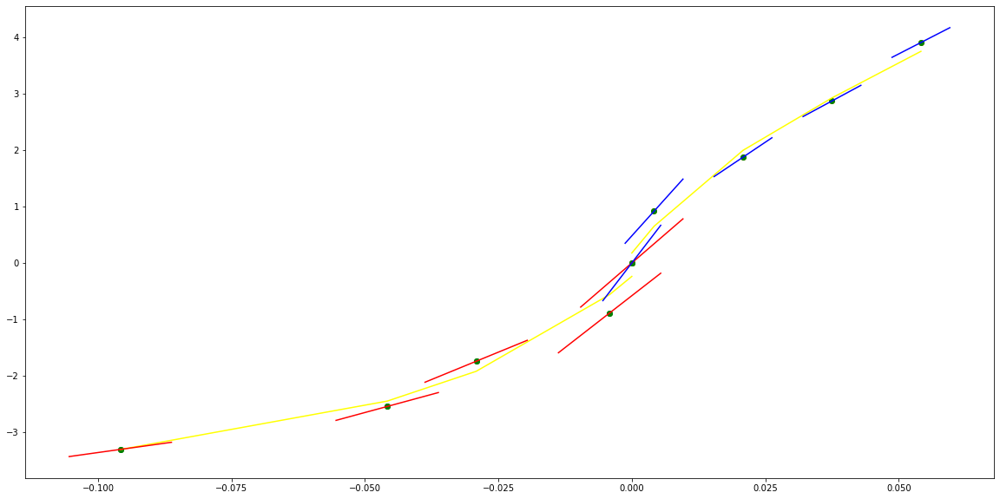

parameters (-36.535240254747805, -91.94842697472399, -78.81627899837775, -26.34533714845052, 12.217746077195553, 0.008241725766789904)
tangent[0]:14.705800059290876
tangent[1]:14.037222798503262
tangent[2]:15.235231900282418
tangent[3]:15.977883231146015
tangent[4]:12.217746077195553
parameters (49780096.52622488, -16706762.852657702, 1606487.2784484397, -43479.86381696875, 771.0231738664079, -0.06565169866758558)
tangent[0]:771.0231738664079
tangent[1]:487.63654819878116
tangent[2]:343.5775555582712
tangent[3]:370.2394936920705
tangent[4]:493.7518502252367


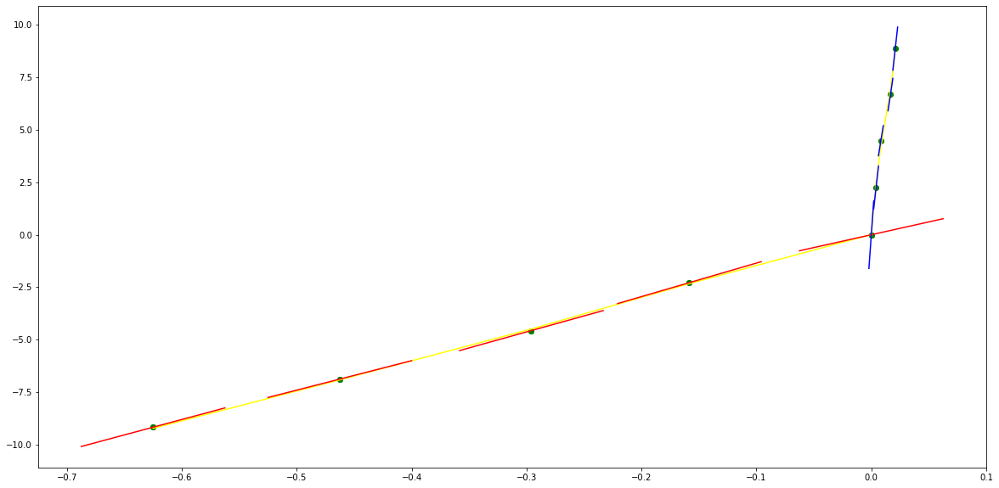

parameters (-20946.682297469168, -24005.086726421156, -8954.212800528414, -1146.0846276432958, 4.817116676508344, -0.059746726756443054)
tangent[0]:57.901701791764204
tangent[1]:59.80136592616697
tangent[2]:61.45067043628216
tangent[3]:54.80292839860241
tangent[4]:4.817116676508344
parameters (1085203.2928283692, -674387.0124766192, 149667.56712065343, -13778.218638397995, 475.00339790340587, -0.15076966076019258)
tangent[0]:475.00339790340587
tangent[1]:367.8025646541725
tangent[2]:-58.619632465298025
tangent[3]:103.90146577426759
tangent[4]:103.78327302298914


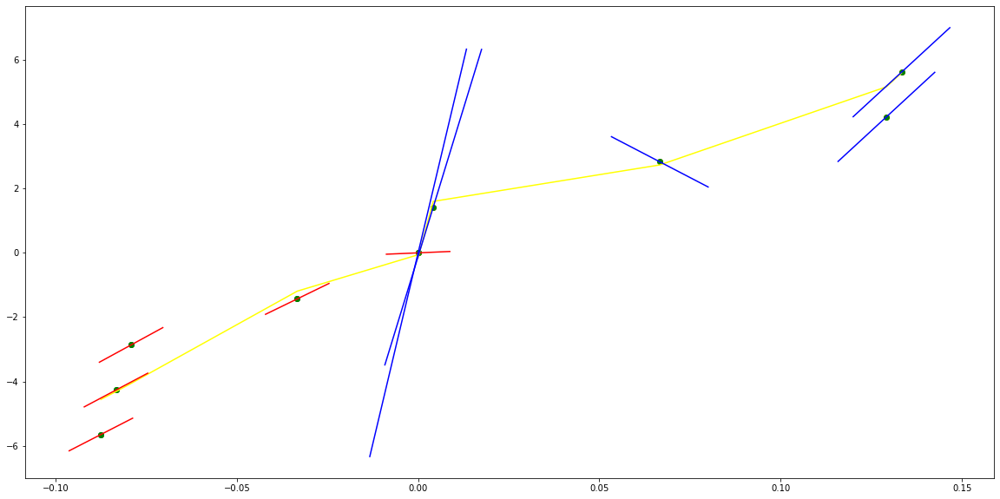

parameters (7877909.996760909, 2482965.401750789, 271005.3663818522, 12706.154242187587, 327.8850907108313, -0.06310198022835427)
tangent[0]:88.61714630062733
tangent[1]:60.398132616718215
tangent[2]:118.8284918816083
tangent[3]:235.4023756103233
tangent[4]:327.8850907108313
parameters (397956270.0867997, -54843796.60383411, 2686750.3906725524, -54026.11202999139, 511.11555486299324, 0.002944337656696585)
tangent[0]:511.11555486299324
tangent[1]:185.54620916862922
tangent[2]:149.58672270628006
tangent[3]:213.25033437379545
tangent[4]:196.72505993500693


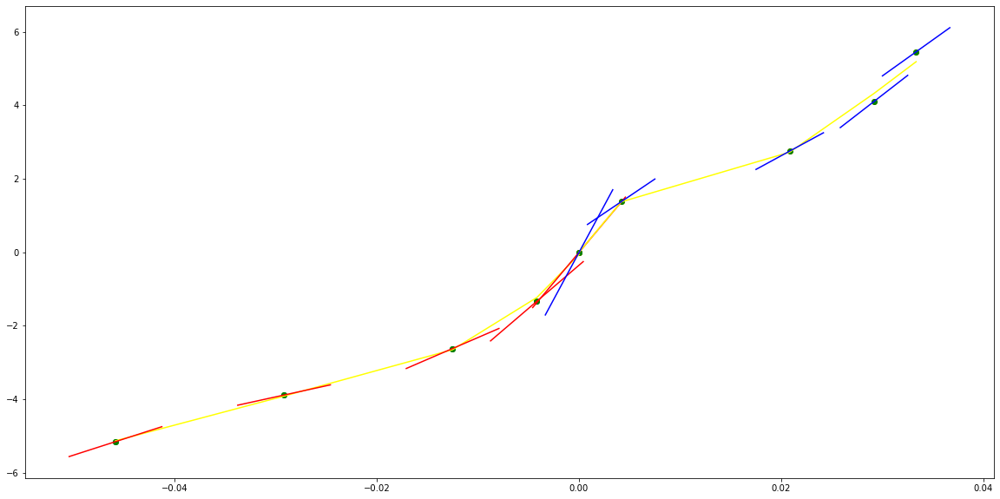

parameters (454.9800129098685, 873.6304803463112, 599.1772205231798, 178.17571018000146, 33.22846083765833, -0.07032342246189047)
tangent[0]:13.043652391841619
tangent[1]:11.505489938024454
tangent[2]:9.378642455782298
tangent[3]:21.255419217370672
tangent[4]:33.22846083765833
parameters (-14348311.297979763, 2896785.2046241714, -94138.63052919327, -6757.989458900392, 374.0798920768544, -0.03398195039624813)
tangent[0]:374.0798920768544
tangent[1]:313.67173066587475
tangent[2]:248.18341516733227
tangent[3]:-57.43517225981287
tangent[4]:233.94873338269423


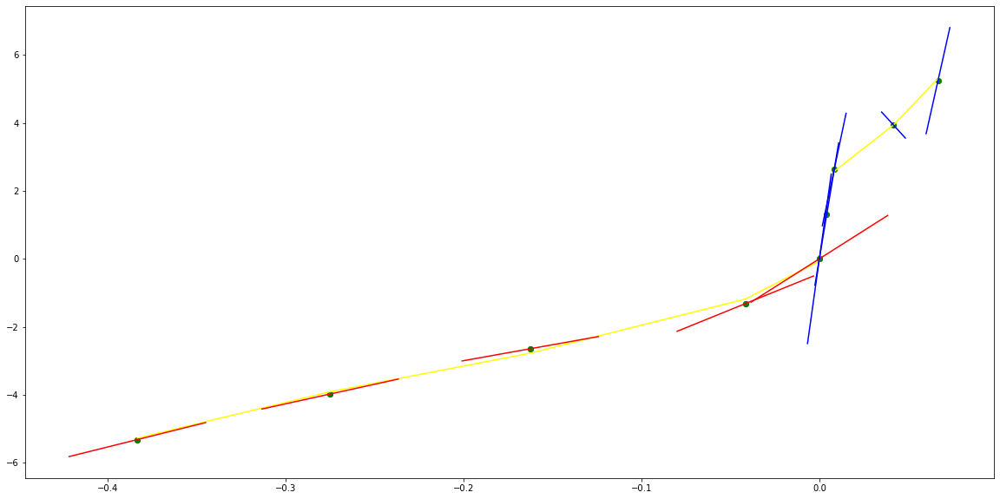

parameters (370.8178449234649, 773.3104164958713, 590.0338157818105, 199.04088199818352, 36.839800002154895, -0.5357758552128009)
tangent[0]:9.884675532511771
tangent[1]:6.768664686019214
tangent[2]:14.258088853088903
tangent[3]:35.211505883141506
tangent[4]:36.839800002154895
parameters (2968441.016141472, -1038843.2159838948, 130349.98090929461, -7385.0152017167775, 226.4781609365473, 0.17889688540025223)
tangent[0]:226.4781609365473
tangent[1]:171.42540368215037
tangent[2]:53.71892377118559
tangent[3]:38.94367134705274
tangent[4]:-18.15619123816552


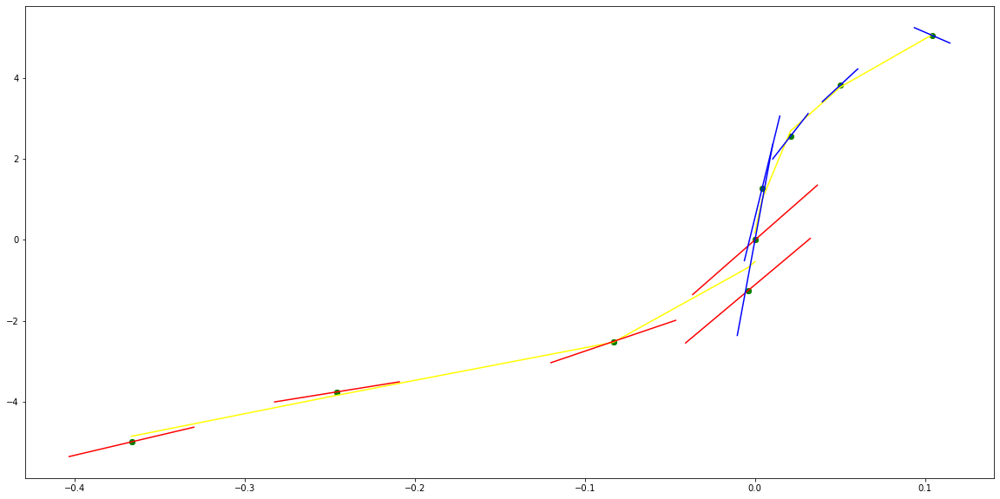

parameters (1172.4053980361552, 2011.182578336077, 1251.0869401121358, 339.95953289745927, 54.63456925210393, -0.1790301690977317)
tangent[0]:18.979624395662327
tangent[1]:14.393290407018242
tangent[2]:15.130551705418007
tangent[3]:39.858971563088254
tangent[4]:54.63456925210393
parameters (19369.17502438895, -22680.871009918992, 9574.647413317816, -1744.0544905123488, 144.3108313358608, 1.0259980020892123)
tangent[0]:144.3108313358608
tangent[1]:130.26810542889385
tangent[2]:117.1839210407635
tangent[3]:2.8861229737009353
tangent[4]:18.172156826767406


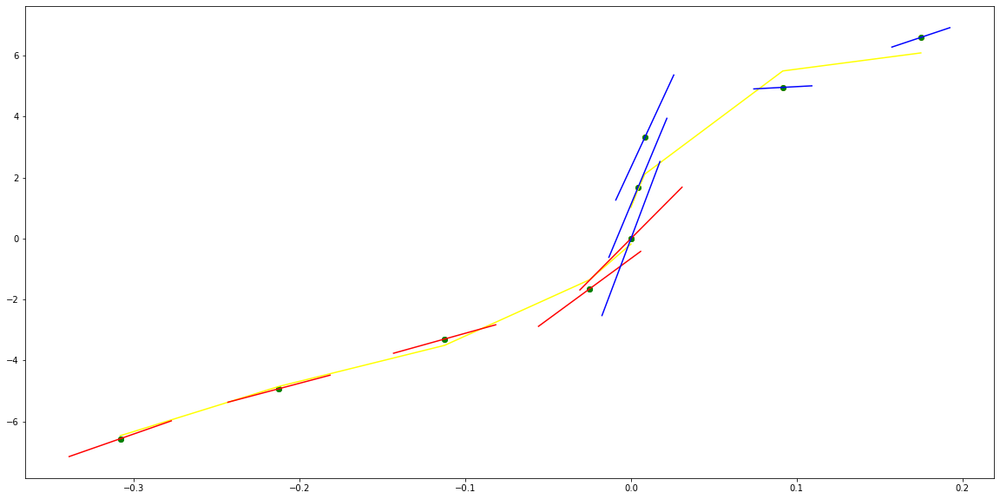

parameters (39.486978639310706, 137.32201484021633, 168.65716660236615, 87.40550729000647, 30.57736544053169, -0.00788272120966135)
tangent[0]:15.0857387981039
tangent[1]:13.775237871184512
tangent[2]:10.553706356634255
tangent[3]:16.906493610289363
tangent[4]:30.57736544053169
parameters (295175054.83294684, -53474166.61642982, 3090159.6357822176, -65634.2248766237, 929.7802630006083, -0.08814835000029153)
tangent[0]:929.7802630006083
tangent[1]:528.7246199302565
tangent[2]:363.0004026153588
tangent[3]:440.7316610516457
tangent[4]:562.5757023473018


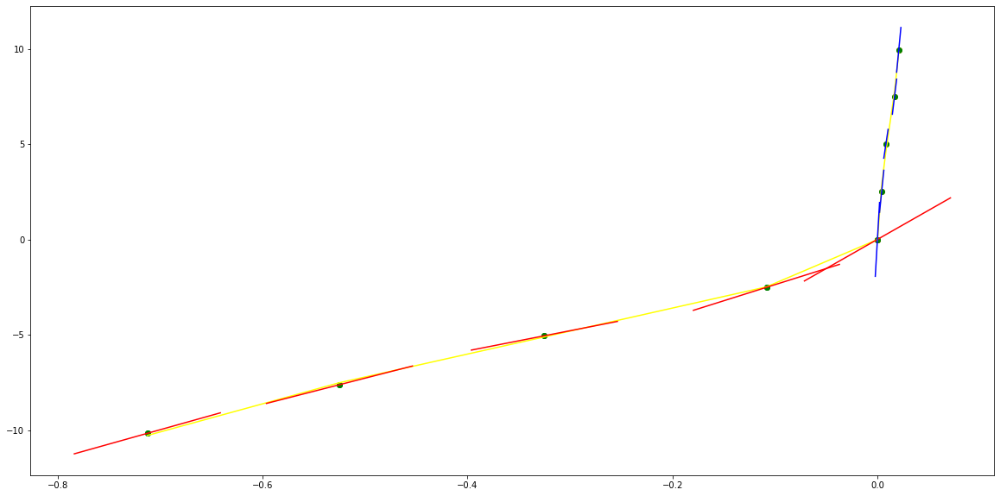

parameters (4226327.267481962, 1512897.644565117, 193824.70577950863, 10527.85279010919, 269.3117665763167, 0.04216846441822194)
tangent[0]:28.281361308756573
tangent[1]:47.90050402396025
tangent[2]:63.15898790163317
tangent[3]:85.66717389983546
tangent[4]:269.3117665763167
parameters (73418232.58040683, -20235615.790359225, 1831352.492256211, -61041.54008809504, 844.6326817734937, -0.16311636415882885)
tangent[0]:844.6326817734937
tangent[1]:425.64516259859266
tangent[2]:163.74956474609348
tangent[3]:335.0253562762066
tangent[4]:450.0224102306804


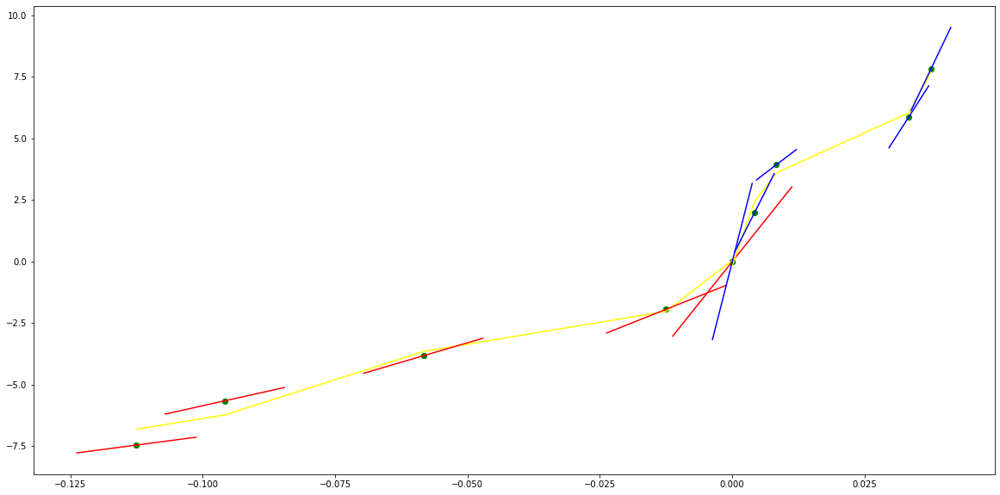

parameters (407152.24422519887, 346514.7284293064, 98967.63250157135, 11338.838519239765, 485.01888518637156, 0.03308578805229897)
tangent[0]:116.33780766990708
tangent[1]:97.52981832643695
tangent[2]:-9.706388810182943
tangent[3]:395.57671897072123
tangent[4]:485.01888518637156
parameters (22906359.756283242, -7973441.313472202, 904276.9527151955, -36841.51552216128, 577.2878131929758, -0.02613949522630542)
tangent[0]:577.2878131929758
tangent[1]:315.08276483161086
tangent[2]:173.68587222620795
tangent[3]:333.60086367850477
tangent[4]:404.3164919885646


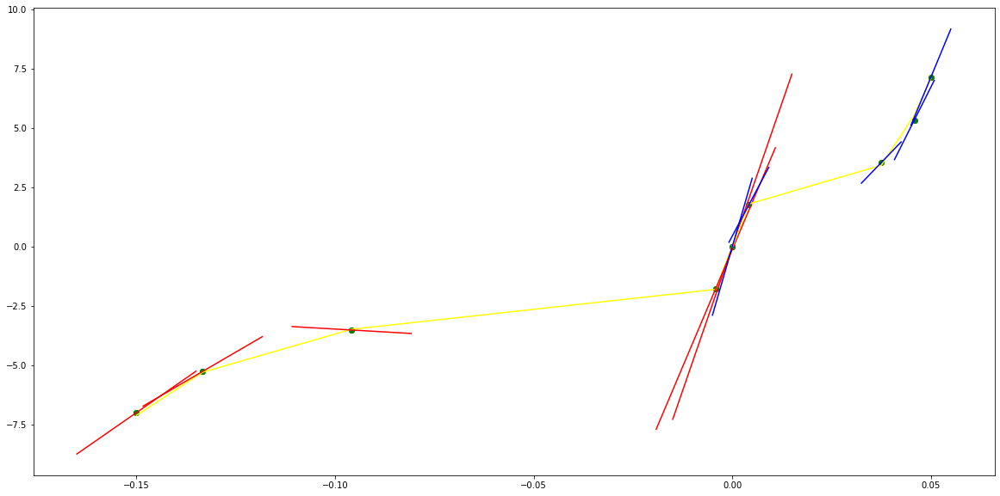

parameters (-240914.53449460454, -164158.2137942966, -34403.884538631086, -2231.8924926284644, 64.91865220808953, -0.407541284470885)
tangent[0]:104.62929512539472
tangent[1]:110.59922370370481
tangent[2]:115.59230772034317
tangent[3]:95.32261203938704
tangent[4]:64.91865220808953
parameters (9179678.334139863, -3482018.7887313967, 480326.31451990525, -28014.502785622044, 631.1707280342024, -0.1123146373368302)
tangent[0]:631.1707280342024
tangent[1]:421.7249284133412
tangent[2]:256.46824327522523
tangent[3]:120.8850074086912
tangent[4]:91.7685944728754


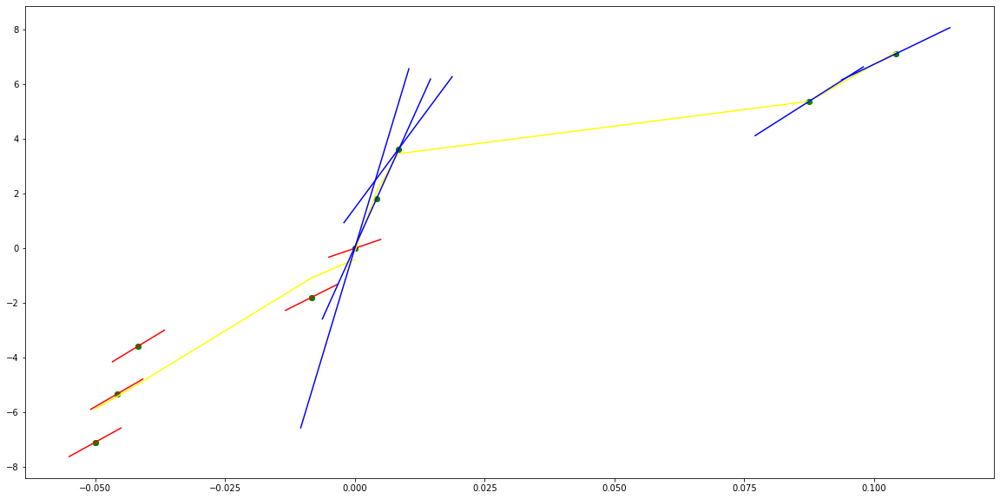

parameters (35.64125453247052, 127.34604036617877, 167.64957777047513, 98.08282465959692, 35.69810655128342, -0.5464925687684145)
tangent[0]:12.504359993609306
tangent[1]:9.842679087012577
tangent[2]:11.843675825537229
tangent[3]:29.699327889583053
tangent[4]:35.69810655128342
parameters (-144.40397845685413, -382.8720014835599, 687.3354801928702, -362.2058785888808, 97.07796773715845, -0.07247198662547971)
tangent[0]:97.07796773715845
tangent[1]:77.66531264389141
tangent[2]:59.47202998387446
tangent[3]:43.653166430005726
tangent[4]:23.322763439614306


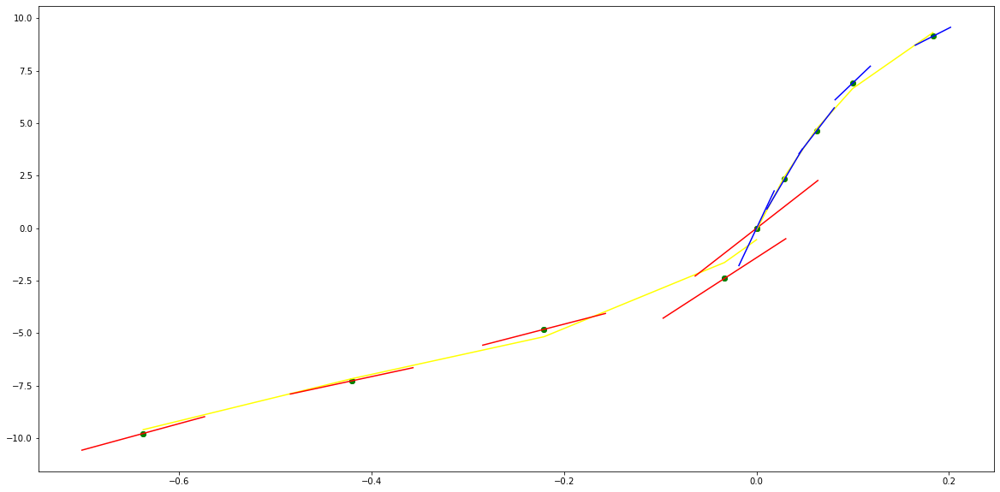

parameters (-0.073375740326528, -0.43279866786098337, -0.9083696801055363, -0.6592296207437024, 1.9968667318957503, 0.00015008266098348757)
tangent[0]:1.8575428100942732
tangent[1]:1.9562280320615328
tangent[2]:2.1051565412144626
tangent[3]:2.1932665146793067
tangent[4]:1.9968667318957503
parameters (2348410.680795025, -3243639.997390758, 1672829.7468353969, -381513.7008703288, 32450.63300930377, 9.97738661065053e-07)
tangent[0]:32450.63300930377
tangent[1]:-306.56375669079716
tangent[2]:151.1050640848116
tangent[3]:142.4456587190798
tangent[4]:129.3454101642419


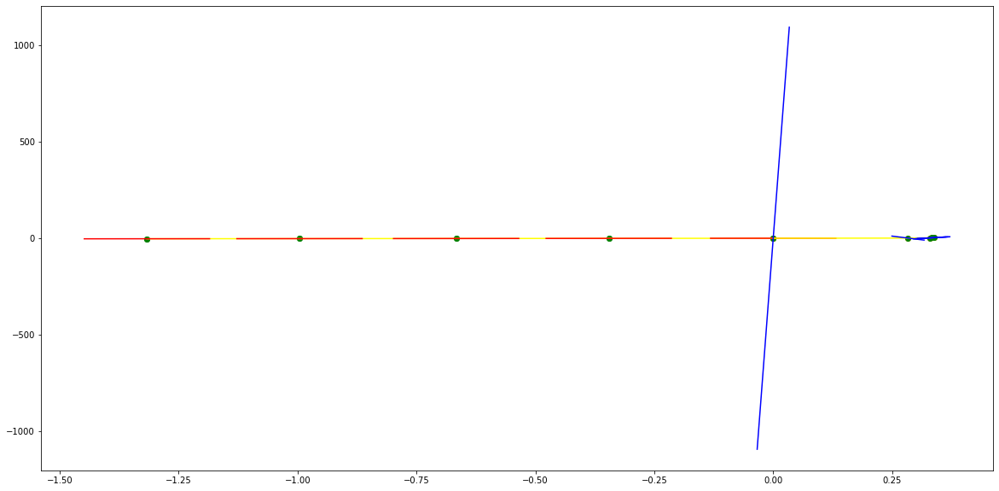

parameters (36511.047433054344, 21311.81712136868, 3801.969717533074, 165.01573138898354, 49.847997247078425, 0.01107398336637417)
tangent[0]:61.685291440307516
tangent[1]:65.04253312006813
tangent[2]:60.07946864979394
tangent[3]:51.279889150827096
tangent[4]:49.847997247078425
parameters (56890.235345837646, -40120.97188995489, 10120.34571194765, -1112.9430511654834, 107.87646359972393, 0.0855219683875064)
tangent[0]:107.87646359972393
tangent[1]:73.28420671045059
tangent[2]:52.48999372026395
tangent[3]:56.85945483815598
tangent[4]:60.31108178310353


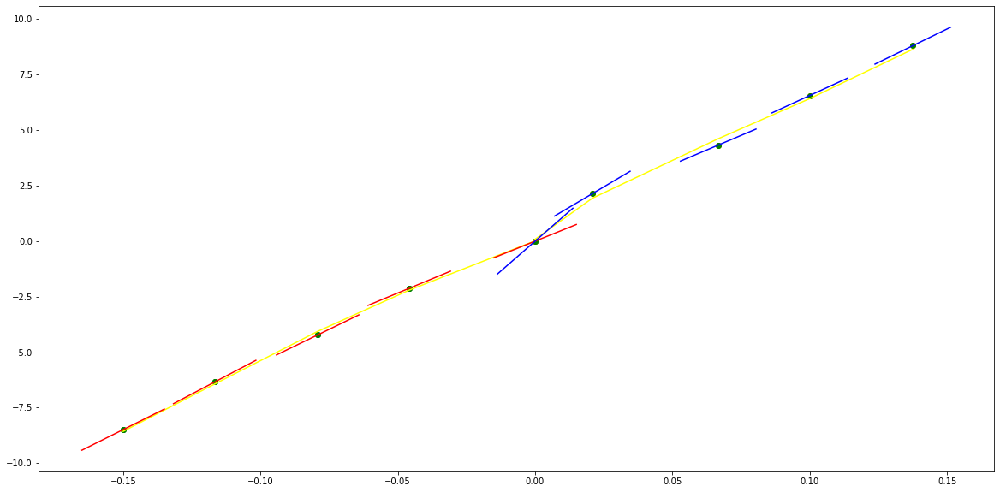

parameters (66186.52267973276, 51902.927583995915, 14881.615500208758, 1909.6387694645553, 162.5200492721063, -0.31020539944849584)
tangent[0]:60.47117829128325
tangent[1]:51.7118254061981
tangent[2]:54.26737802068838
tangent[3]:121.3574250889721
tangent[4]:162.5200492721063
parameters (612505.5614359237, -453929.51472479687, 122736.4549485748, -14317.893808143383, 675.663675495465, 0.08604791165665115)
tangent[0]:675.663675495465
tangent[1]:562.6014415335867
tangent[2]:461.5509665538551
tangent[3]:-3.5990646058801303
tangent[4]:79.82033401262038


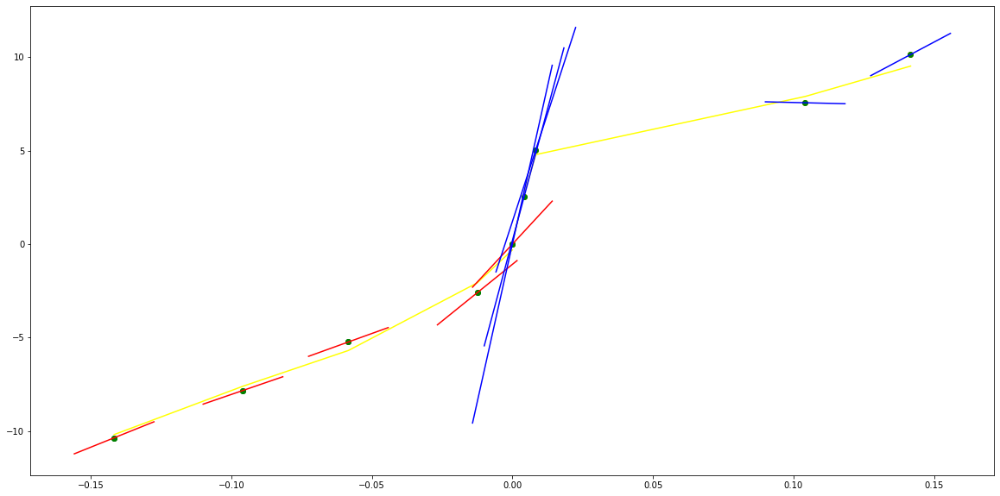

parameters (-33241.57685886736, -94753.21378301778, -95717.46115957532, -38959.933712775535, -4798.9551254613525, 4.604666676910419e-10)
tangent[0]:-34.94962005990055
tangent[1]:-48.0752211426061
tangent[2]:-62.55085150010382
tangent[3]:2090.2744025344236
tangent[4]:-4798.9551254613525
parameters (-660645.4836324427, 297035.7935979667, -46031.678967200314, 2780.138371136569, -52.60516275003502, 0.008570568290200838)
tangent[0]:-52.60516275003502
tangent[1]:-31.748383909510927
tangent[2]:-15.185471074494252
tangent[3]:-19.707424963085174
tangent[4]:-17.815245284492704


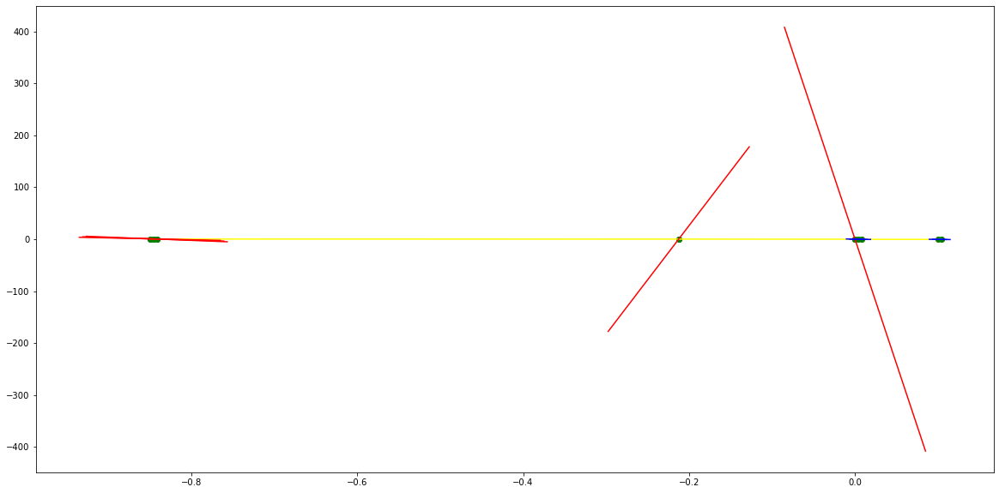

parameters (-214268.9303183586, -1161564.4097388075, -2358447.0146749862, -2125823.627241588, -717777.5576505513, 1.646361269956798e-10)
tangent[0]:50.41580436739605
tangent[1]:61.86700159392785
tangent[2]:97.56063751585316
tangent[3]:141.11248447361868
tangent[4]:-717777.5576505513
parameters (0.024483386458695723, -0.21460666367494247, 0.6108081383711286, -0.37035887458335487, 0.8103102987782861, 0.00038658997758979737)
tangent[0]:0.8103102987782861
tangent[1]:0.8920235387373654
tangent[2]:1.30727591836615
tangent[3]:1.5840072290057639
tangent[4]:1.7396152566681988


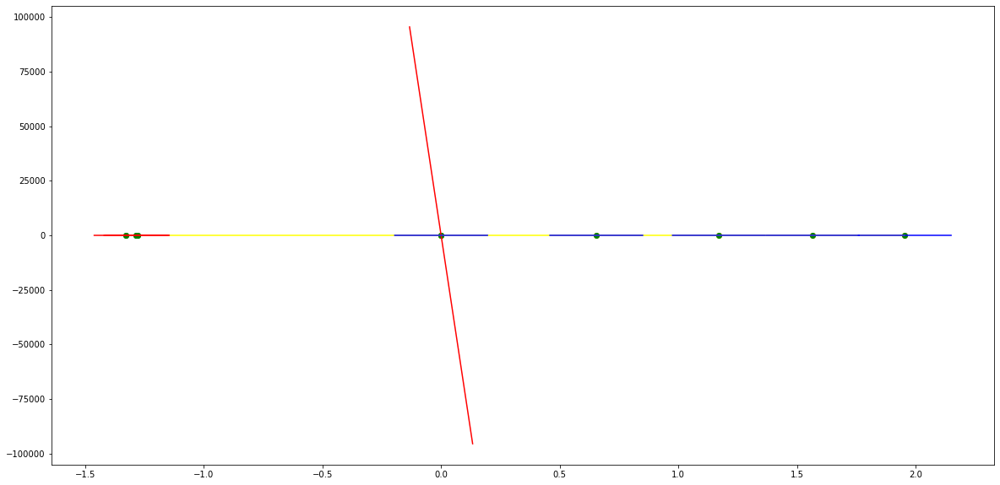

parameters (-172.208721685895, -1147.1137010927296, -2614.2753237687675, -2314.6279444893835, -642.8957807802769, 6.46897788217517e-07)
tangent[0]:69.50975912719628
tangent[1]:77.20157114435028
tangent[2]:-227.60946499988745
tangent[3]:226.77575337932808
tangent[4]:-642.8957807802769
parameters (-0.13613661086358447, 0.9271320881608806, -2.1305754234926093, 2.0531225507444035, 0.9129481449176031, 0.003922355213575622)
tangent[0]:0.9129481449176031
tangent[1]:1.7501502677884067
tangent[2]:1.7337316434783923
tangent[3]:1.6319831196271577
tangent[4]:1.8332312029645805


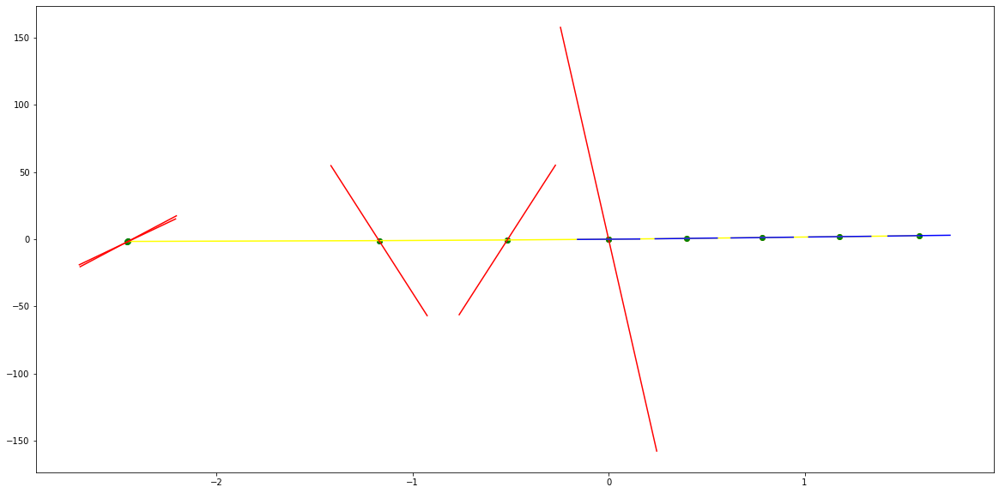

parameters (0.5341115259908901, 3.932282894219226, 9.80314624756151, 9.008546106399136, 7.890565432530662, -0.002320356433968655)
tangent[0]:7.43773226844731
tangent[1]:7.163132431021681
tangent[2]:5.7824437640565405
tangent[3]:4.431928158658636
tangent[4]:7.890565432530662
parameters (3592946.1930503766, -9632226.739355655, 9530735.846831089, -4104320.9663642608, 643978.9761224617, 4.939083809870394e-10)
tangent[0]:643978.9761224617
tangent[1]:-57995.03490264481
tangent[2]:738.4302107444964
tangent[3]:520.9286228041165
tangent[4]:384.8024150901474


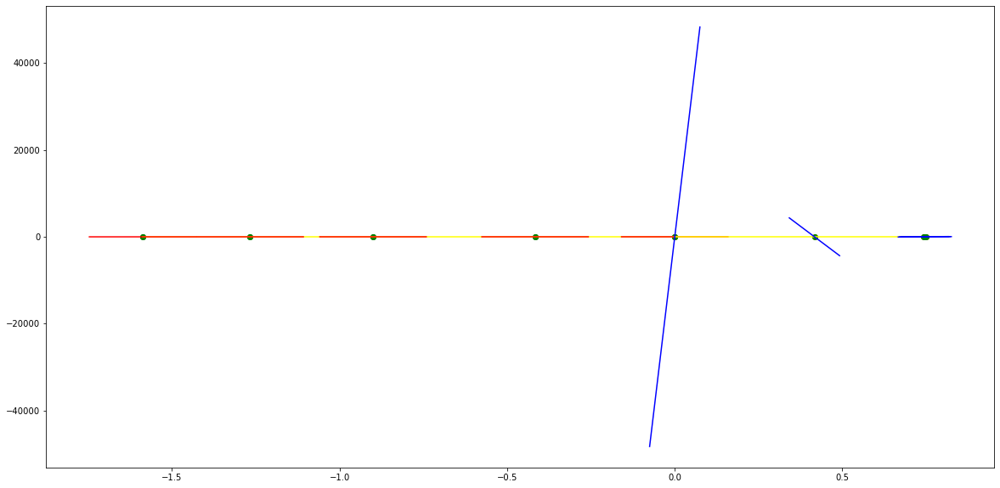

parameters (-24327.89865507619, -54804.72039852691, -36245.30727070875, -6166.987521495255, 316.52318888229786, -0.33751103339626004)
tangent[0]:528.2512977515323
tangent[1]:492.8934966199397
tangent[2]:454.13308130045675
tangent[3]:366.0466093884345
tangent[4]:316.52318888229786
parameters (-532929.4014370807, 356362.2730209202, -79122.77982871412, 6352.139337053673, -38.48975352444028, 1.0801463604595218)
tangent[0]:-38.48975352444028
tangent[1]:10.418873887587715
tangent[2]:170.63767829268738
tangent[3]:164.83042418112245
tangent[4]:156.81778877976


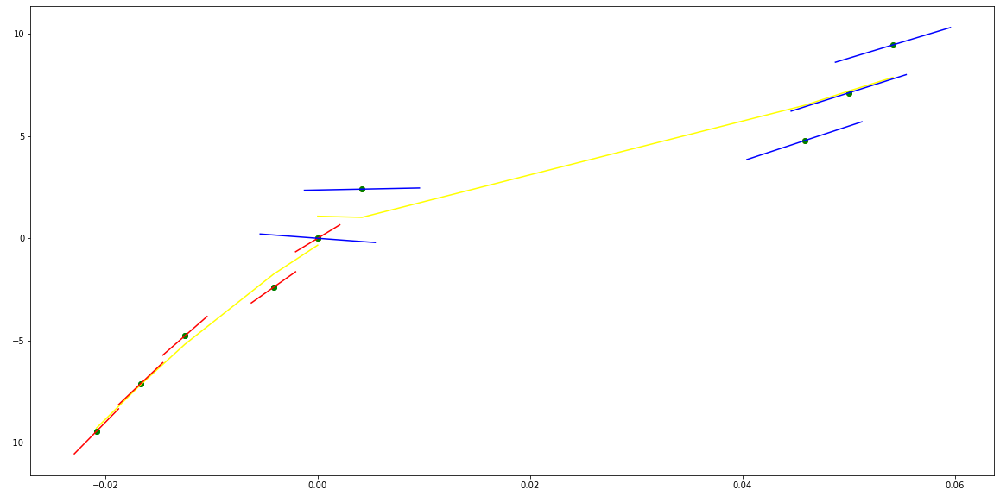

parameters (-83771.9444829112, -48896.81184414585, -10364.851339362864, -941.307265114345, -57.563948991586074, 0.032008800531546804)
tangent[0]:-27.920868411578226
tangent[1]:-22.81346862707565
tangent[2]:-19.614536496669288
tangent[3]:-38.518011153963165
tangent[4]:-57.563948991586074
parameters (-42111.800965815164, 59951.71690251426, -29445.856189023823, 5357.698231534814, -187.3099741015359, 0.015536306020198266)
tangent[0]:-187.3099741015359
tangent[1]:-144.17551295561628
tangent[2]:-104.0148927880054
tangent[3]:29.02868981593093
tangent[4]:-46.96051163378627


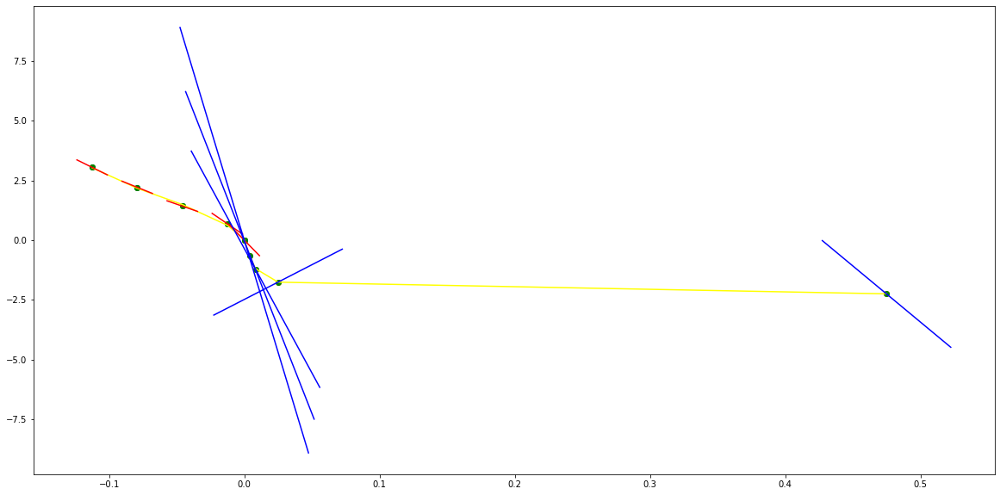

parameters (-54342.107193862605, -65556.68837279553, -20448.723877875927, -2367.062942868815, -32.27641823203882, 0.0011114747014022367)
tangent[0]:53.74331183918761
tangent[1]:74.86747916612788
tangent[2]:83.01192624999194
tangent[3]:79.8832053136523
tangent[4]:-32.27641823203882
parameters (-496.3692923748044, 1461.4164141630422, -958.992675727342, 198.7972528004353, 26.73316748628847, 0.8625706597560673)
tangent[0]:26.73316748628847
tangent[1]:28.340410480760777
tangent[2]:43.26648171999972
tangent[3]:41.67152594033277
tangent[4]:36.1445578704606


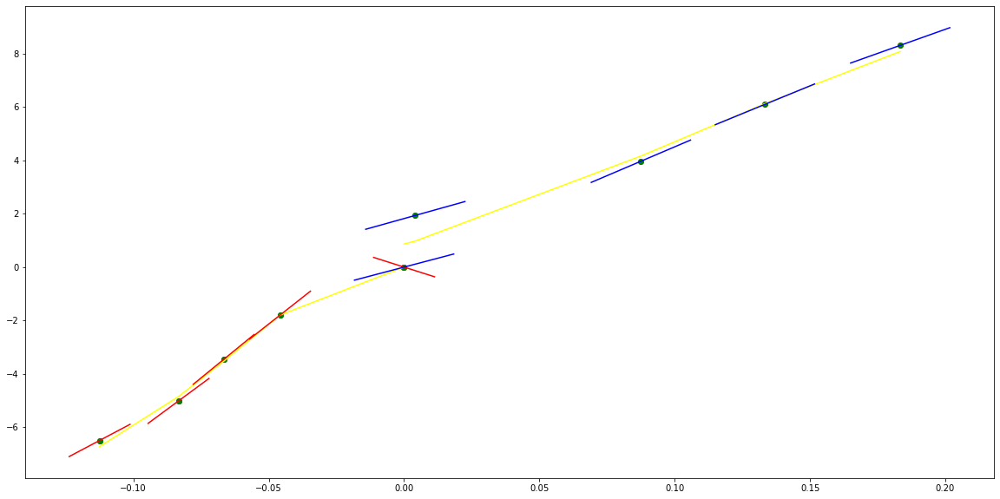

parameters (1521.4906755205384, 2551.273787704316, 1532.597026359099, 391.22422096471826, 57.290898987832676, -0.15431727409422472)
tangent[0]:23.25017305363029
tangent[1]:18.636374185313414
tangent[2]:12.768462702522811
tangent[3]:38.13291893398164
tangent[4]:57.290898987832676
parameters (116733.18005181558, -100163.73095794264, 30649.516004310713, -4063.875876037687, 248.58562488758216, 0.6956174811974248)
tangent[0]:248.58562488758216
tangent[1]:216.29243642006907
tangent[2]:187.01285618702224
tangent[3]:53.123514946212
tangent[4]:7.194343002710099


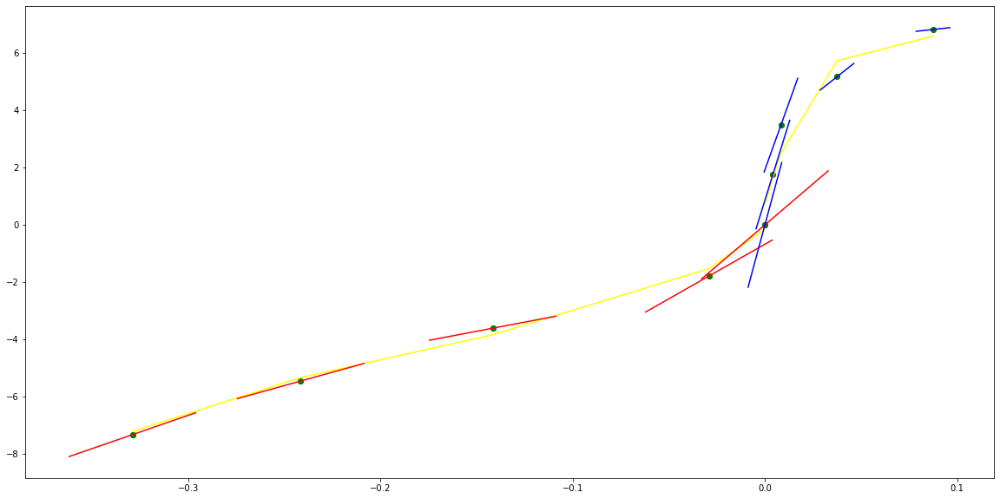

parameters (8.943442015159302, 42.207161240160154, 72.38617667778229, 54.43496252452014, 25.458519475034205, -0.758750587290686)
tangent[0]:7.511345423983055
tangent[1]:8.493140959068167
tangent[2]:13.46693905428718
tangent[3]:25.008617011796648
tangent[4]:25.458519475034205
parameters (3364.5784498724224, -5208.829887751903, 2918.1478670707684, -723.2880542665066, 91.11845343158971, 0.6650864053574718)
tangent[0]:91.11845343158971
tangent[1]:85.24245420568265
tangent[2]:48.117316047926195
tangent[3]:10.972422255459222
tangent[4]:14.221328111491303


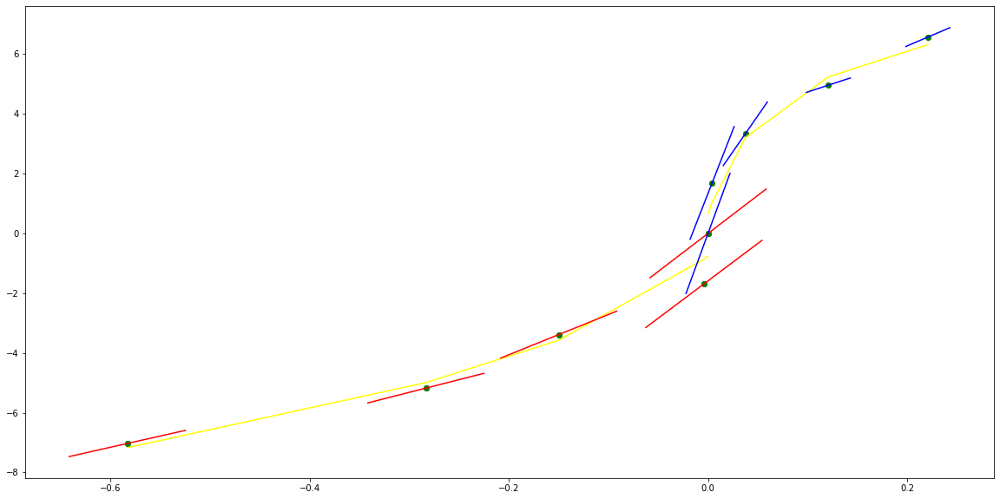

parameters (84.18053571234454, 215.02891394686148, 205.06216142198437, 86.26130242281519, 24.736777608797322, -0.6075048523854486)
tangent[0]:10.293544777690546
tangent[1]:8.390041620701428
tangent[2]:10.9800260122188
tangent[3]:24.02866327811678
tangent[4]:24.736777608797322
parameters (4887010.212243838, 673403.2273969756, -176554.5737732138, 6174.3969687764275, 171.60300837892248, 0.1728087118367398)
tangent[0]:171.60300837892248
tangent[1]:214.0656751724316
tangent[2]:249.06049771997735
tangent[3]:244.6424100696301
tangent[4]:227.93661424023156


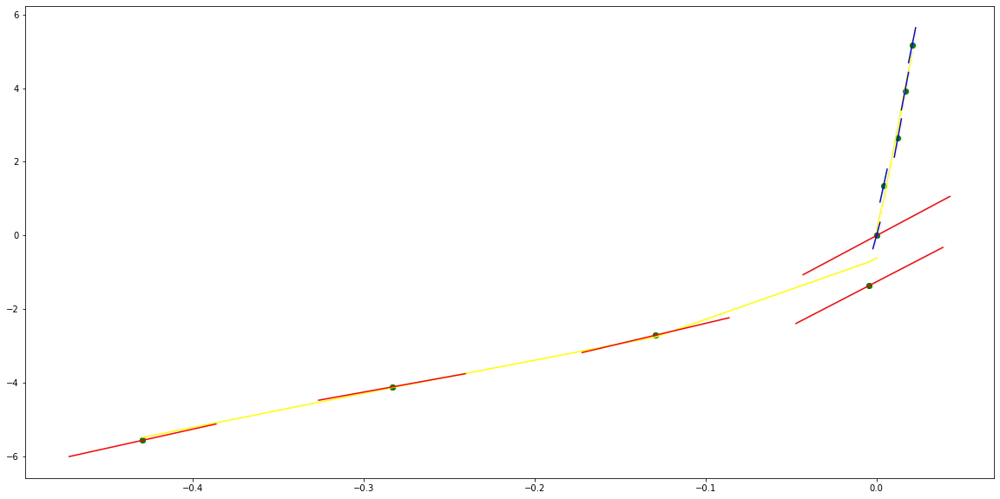

parameters (-12377564.19586643, -4010054.817890313, -391017.1257246233, -8095.323609354158, 354.57578445218314, 0.0025185543169277983)
tangent[0]:282.7446809311241
tangent[1]:254.87517236546114
tangent[2]:-144.41097072299635
tangent[3]:402.8154133286289
tangent[4]:354.57578445218314
parameters (83505.66439330272, -58080.82449462803, 15200.102963607806, -1752.4322515154795, 121.16713729951195, 0.5107827997594032)
tangent[0]:121.16713729951195
tangent[1]:107.34061853175173
tangent[2]:31.785083377469945
tangent[3]:29.643055809309885
tangent[4]:46.673233909449635


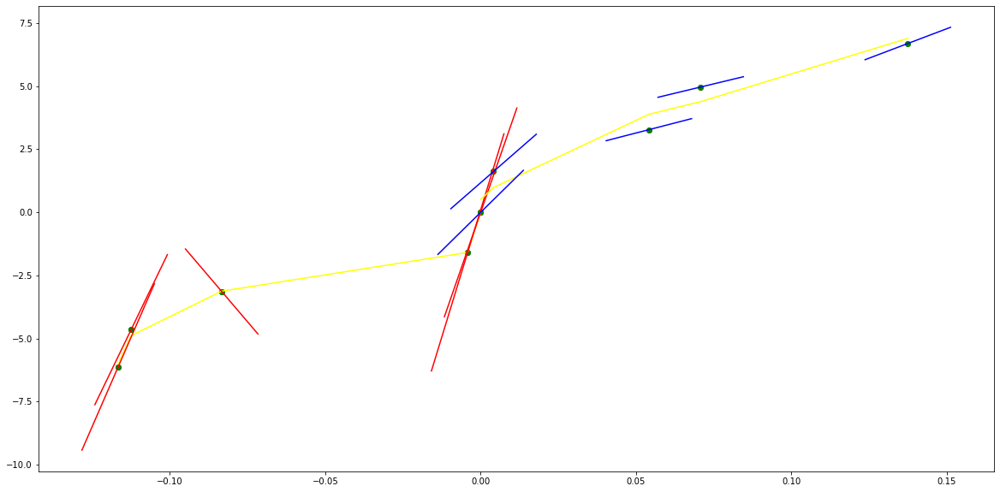

parameters (366.9204331422255, 676.6468554173337, 449.9309352882394, 134.41088860377096, 49.326247041689264, 0.008278721734781253)
tangent[0]:31.867056668543853
tangent[1]:30.888862842617627
tangent[2]:31.801324801426325
tangent[3]:37.7220651048543
tangent[4]:49.326247041689264
parameters (17899318.234447256, -6199765.10479925, 725388.7301118022, -34839.78231637872, 797.0429813885288, -0.05200203613678622)
tangent[0]:797.0429813885288
tangent[1]:542.7075832881683
tangent[2]:353.5956768364414
tangent[3]:113.51306602938928
tangent[4]:147.63342325018527


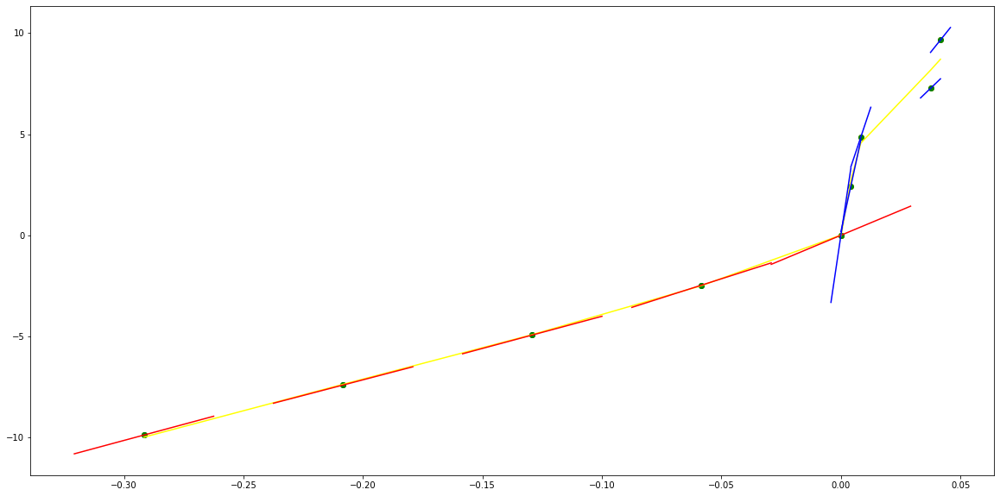

parameters (541973.7769371803, 359859.69523669116, 76357.41920801766, 5955.258887412562, 214.33787072309264, -0.15113590620699124)
tangent[0]:110.25170102040335
tangent[1]:99.34377074371315
tangent[2]:88.05919621410504
tangent[3]:130.16582072205077
tangent[4]:214.33787072309264
parameters (-28846306.621362686, 5962198.272352775, -280172.10562248615, -4814.0326043323985, 475.0347214039974, -0.03247818393249736)
tangent[0]:475.0347214039974
tangent[1]:422.01747415101323
tangent[2]:349.54381384339774
tangent[3]:117.13326387862912
tangent[4]:314.8098608975523


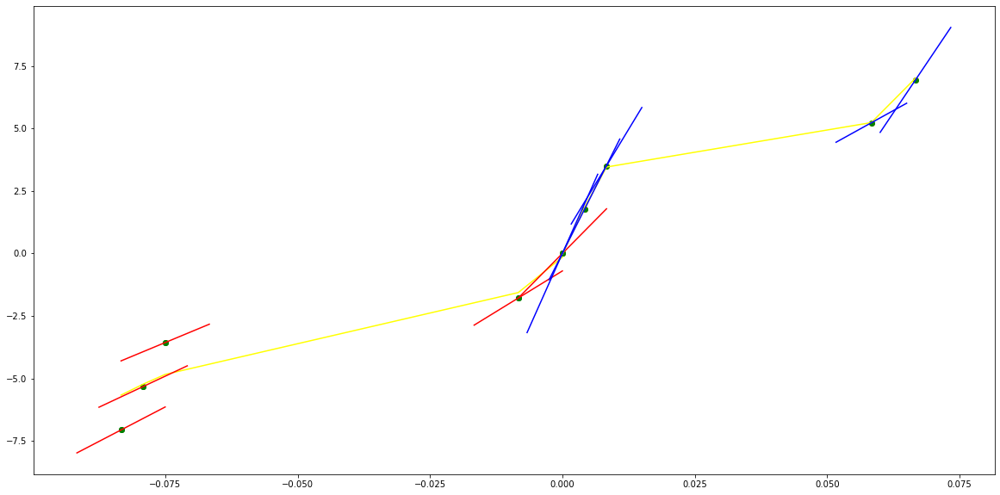

parameters (1552.6249743598505, 2463.652962437155, 1418.3569734996656, 354.10814893195237, 52.806746675704986, -0.6637512673060131)
tangent[0]:19.61591765405045
tangent[1]:14.705581497281045
tangent[2]:18.009366309490446
tangent[3]:49.92878324862725
tangent[4]:52.806746675704986
parameters (27439.251969370514, -14962.603217489654, 5246.8022320435875, -937.4988736059255, 117.19949992043074, 0.49556782401190036)
tangent[0]:117.19949992043074
tangent[1]:109.65540985169223
tangent[2]:70.14194686623136
tangent[3]:53.48894899273773
tangent[4]:41.59677786574231


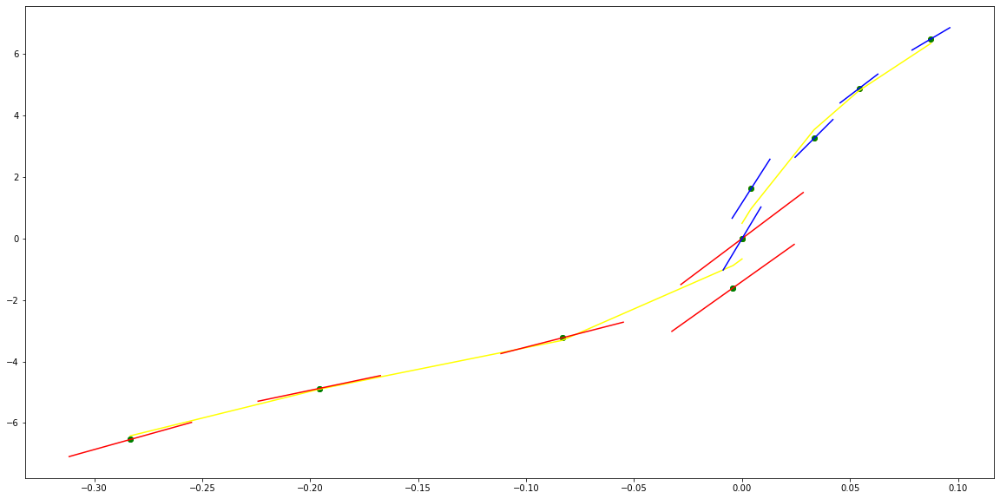

parameters (-14298.458271308908, -14895.26927299661, -5307.604282451396, -685.0136350340126, 12.672254939831566, -0.6648376689363079)
tangent[0]:37.14918686500639
tangent[1]:42.878701429424176
tangent[2]:49.5557472401123
tangent[3]:18.108966072322566
tangent[4]:12.672254939831566
parameters (12670181.008753795, -5070530.340565657, 700319.8155219194, -36687.98365091304, 502.17996441165826, 0.008069112342088324)
tangent[0]:502.17996441165826
tangent[1]:231.4547163882669
tangent[2]:227.14684200090153
tangent[3]:190.00773444774688
tangent[4]:53.20207546476752


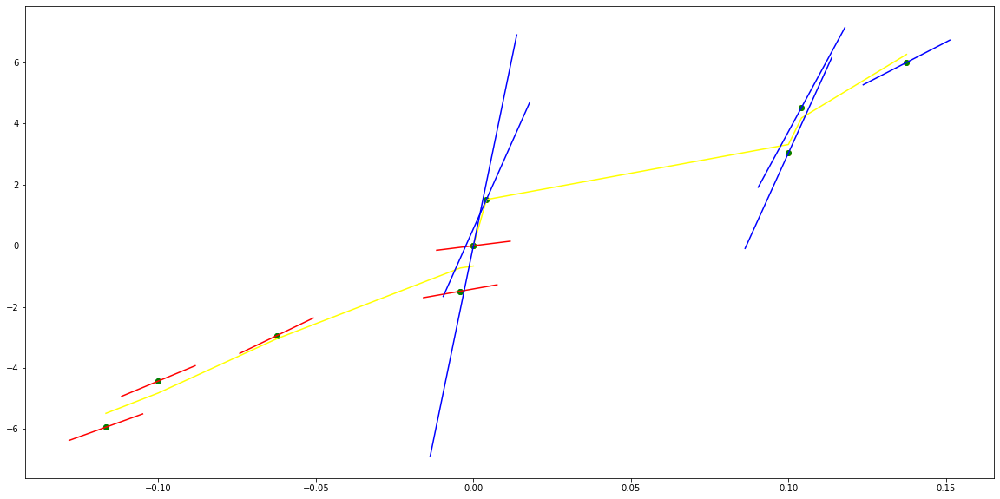

parameters (-40349.3896774785, -37107.18542238762, -11675.748376306623, -1362.2757009262011, -4.313773528737382, -0.0627781473271415)
tangent[0]:46.12296221811539
tangent[1]:55.65453517152292
tangent[2]:61.640034494407786
tangent[3]:52.83345101434003
tangent[4]:-4.313773528737382
parameters (2612329.2786830403, -506819.9342459016, 25213.4677888389, -449.72063932147074, 113.43549601056053, 0.3517901186571724)
tangent[0]:113.43549601056053
tangent[1]:110.85818943226221
tangent[2]:110.70030199251416
tangent[3]:108.54029378167648
tangent[4]:104.99835137916028


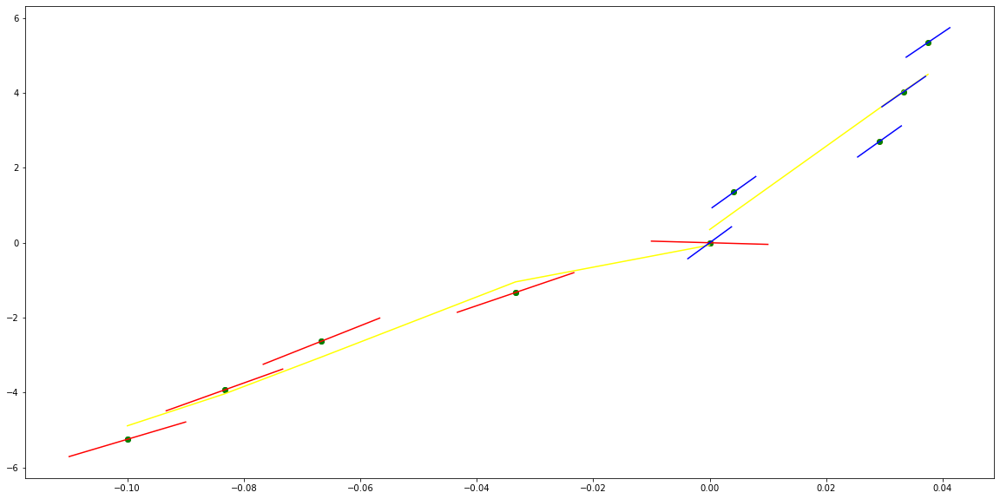

parameters (-20715994.738547977, -8100970.444473495, -1123441.9339252454, -65073.48437551929, -1255.3279788227171, -0.0001771333053833745)
tangent[0]:-65.97026027459992
tangent[1]:229.3163409469937
tangent[2]:292.53671332389354
tangent[3]:348.04254337898624
tangent[4]:-1255.3279788227171
parameters (124002901.11914779, -23524784.196408052, 1588455.5145201345, -45000.47900557445, 558.9205995917158, -0.1047388411493439)
tangent[0]:558.9205995917158
tangent[1]:260.01026684909425
tangent[2]:88.3562050271106
tangent[3]:149.02511375782512
tangent[4]:143.91985167411747


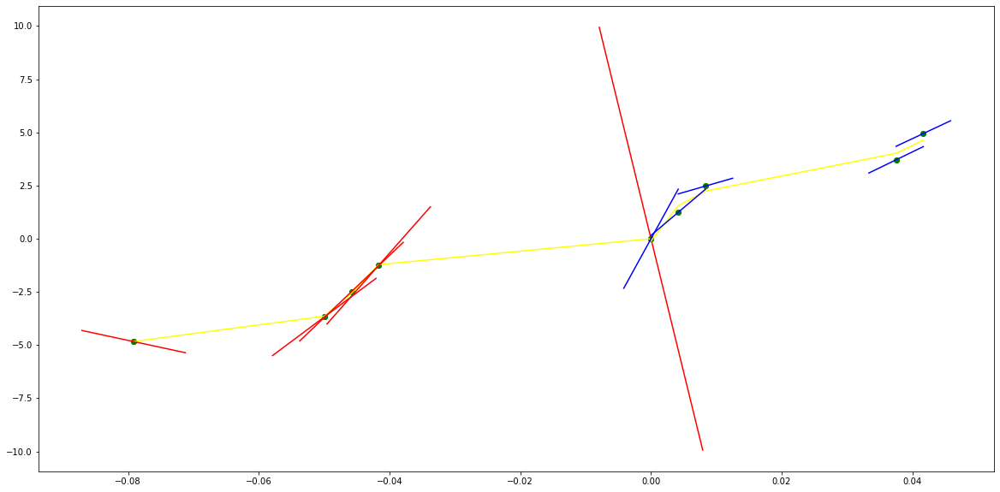

parameters (-165116845.82453814, -40473721.562539466, -3547876.0596252005, -132024.89553157805, -1677.3982048869118, -0.0002298995680622773)
tangent[0]:176.74427073516858
tangent[1]:161.66741306172503
tangent[2]:274.8562845501185
tangent[3]:389.03366585757635
tangent[4]:-1677.3982048869118
parameters (3920238.2940311986, -786086.4762313763, 41576.59588263245, -524.3342406066504, 98.07062870555151, 0.34256545260989624)
tangent[0]:98.07062870555151
tangent[1]:95.64518839004526
tangent[2]:109.75905087005135
tangent[3]:109.44551521838424
tangent[4]:107.09383026362775


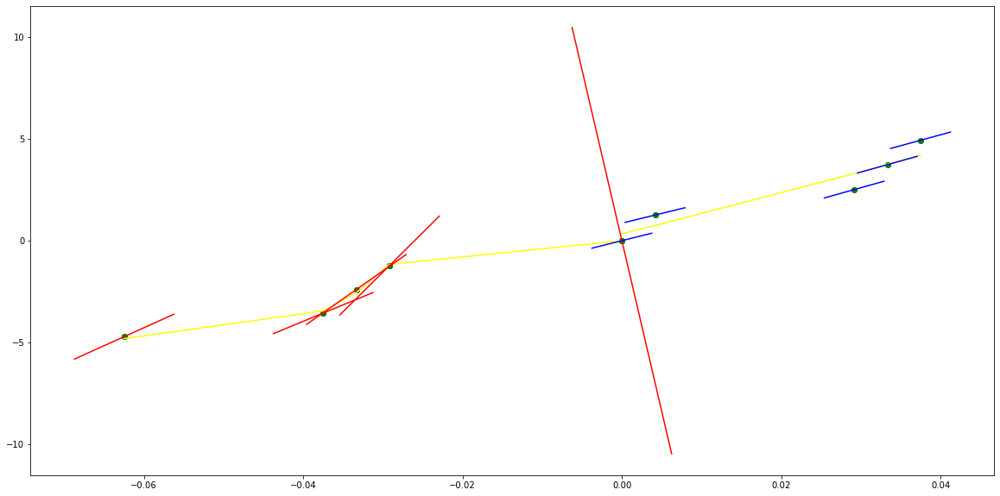

parameters (626985.8138059116, 356920.9748680331, 74932.76634610452, 6591.735570218271, 231.04697574938646, -0.21966818218463974)
tangent[0]:79.30685810166406
tangent[1]:62.388475041825956
tangent[2]:-24.588625673200426
tangent[3]:179.91246888153705
tangent[4]:231.04697574938646
parameters (-6606940.594910273, 2454238.4439107976, -278807.23875512386, 8770.105737264987, 154.09148542159107, 0.18763670076263148)
tangent[0]:154.09148542159107
tangent[1]:213.35836156676032
tangent[2]:261.0204622267149
tangent[3]:256.9879399103297
tangent[4]:239.02843044184607


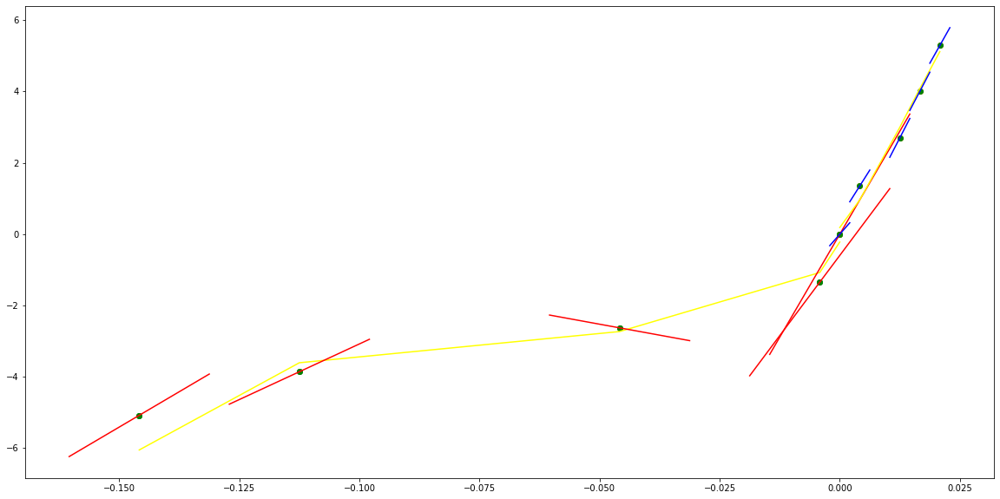

parameters (147.0075874704471, 333.52852718948577, 275.26350225424113, 100.33770971352833, 23.228174841814106, -0.4945714109122749)
tangent[0]:8.48466713051128
tangent[1]:6.811706795061479
tangent[2]:8.839957623045544
tangent[3]:22.40620299511505
tangent[4]:23.228174841814106
parameters (784937.8400773653, -508813.2320018998, 115931.46553113012, -10785.327286555397, 361.0063411282888, -0.08882201315149697)
tangent[0]:361.0063411282888
tangent[1]:277.033186086073
tangent[2]:-76.63602501786136
tangent[3]:84.02297555667406
tangent[4]:-26.158462901034227


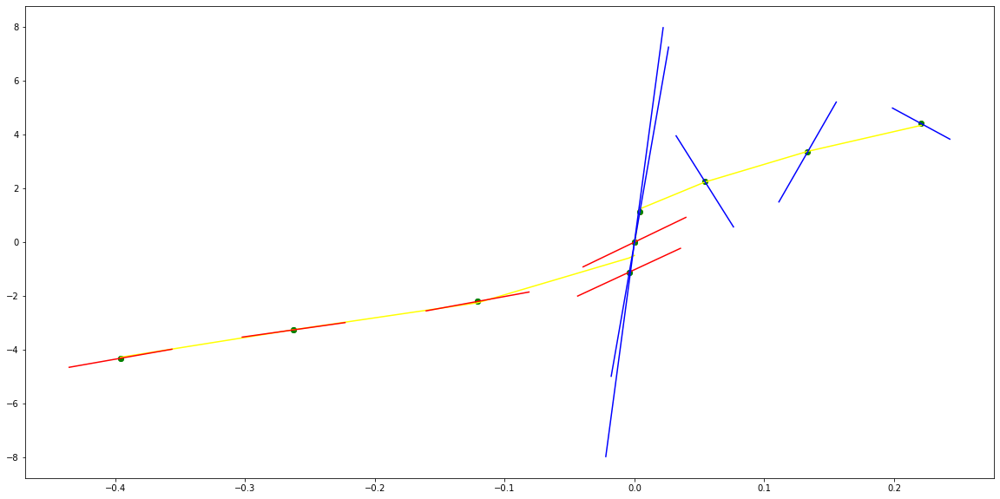

parameters (2.690645663486483, 15.224151012703107, 30.679023657728536, 26.00235256835234, 14.987481684021379, -0.07341871169758009)
tangent[0]:7.809779247838524
tangent[1]:6.950395401279078
tangent[2]:5.408128760819906
tangent[3]:8.715143527300055
tangent[4]:14.987481684021379
parameters (939.9446527909602, -1994.4687227682946, 1528.08971914184, -517.8532321378636, 87.74412982823205, 1.6601531133235372)
tangent[0]:87.74412982823205
tangent[1]:83.50736590764488
tangent[2]:79.42635985608082
tangent[3]:19.848045116827137
tangent[4]:8.612919553268085


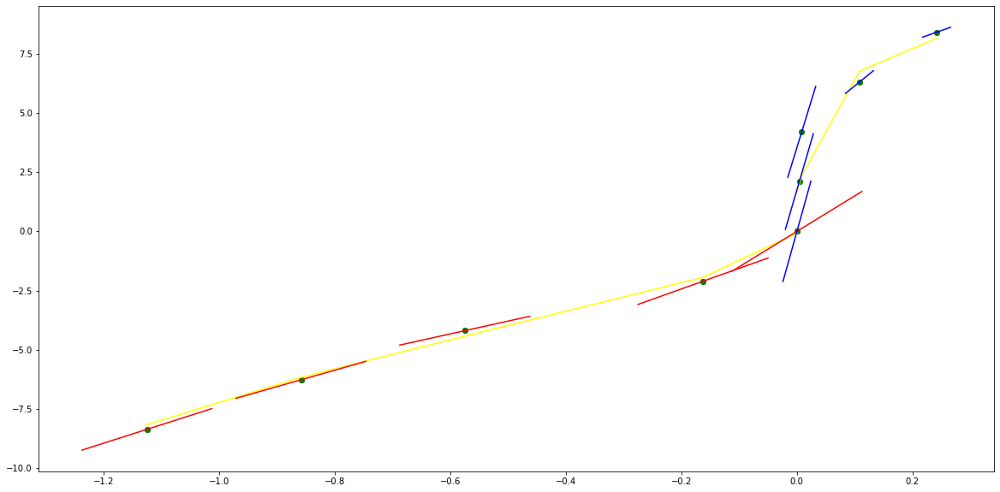

parameters (-0.011622606385564284, -0.10564401611797727, -0.3464582225947409, -0.49899749728114534, 4.31650339983352, -0.0019722294395706475)
tangent[0]:4.600420150801222
tangent[1]:4.6150563807810645
tangent[2]:4.642026369065214
tangent[3]:4.596071898154896
tangent[4]:4.31650339983352
parameters (-71.86748353788838, 364.3307041894066, -631.7839548412832, 432.7560806804592, -90.80897000041881, 4.255463402960847e-05)
tangent[0]:-90.80897000041881
tangent[1]:34.551452737083366
tangent[2]:-21.73862956088027
tangent[3]:49.942209081443764
tangent[4]:58.50573215588253


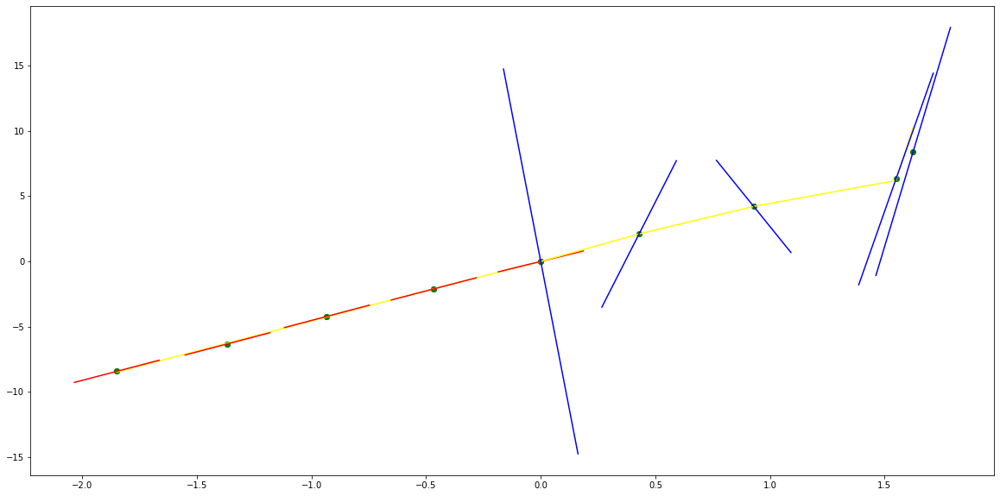

parameters (0.942862492092598, 7.52199246601717, 21.42841892415754, 25.670258290163474, 15.68026084926655, -0.4627278080258009)
tangent[0]:5.769659956888635
tangent[1]:4.4028215791087
tangent[2]:2.0499294407152284
tangent[3]:12.178782476593478
tangent[4]:15.68026084926655
parameters (882.206136866711, -2118.889770043329, 1803.7696103834915, -660.0429559641166, 109.02070437358692, 1.564026584108474)
tangent[0]:109.02070437358692
tangent[1]:103.6145312561806
tangent[2]:98.39130076281448
tangent[3]:37.01681443498924
tangent[4]:1.223666375357837


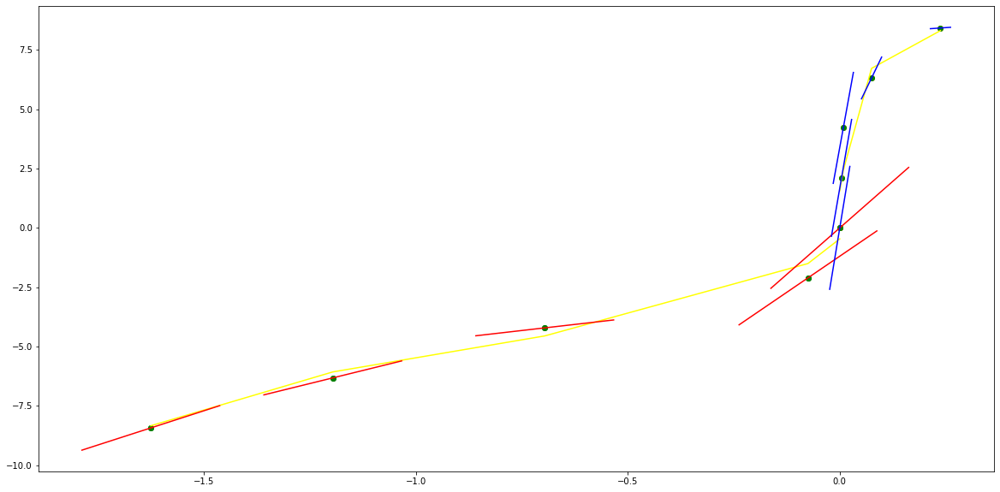

parameters (-71.8675254861665, -246.5430721074959, -231.30565828396513, -2.697246572016742, 61.59975772315207, 0.09502933490906622)
tangent[0]:49.94221656015378
tangent[1]:58.50573349247614
tangent[2]:58.84161938410422
tangent[3]:59.1603915233792
tangent[4]:61.59975772315207
parameters (3.1734581160135944, -15.06633283289174, 25.67711169164536, -20.747290471004316, 16.211728408291588, -0.01990963634569741)
tangent[0]:16.211728408291588
tangent[1]:11.255432322316551
tangent[2]:8.669436445465463
tangent[3]:8.074551926277369
tangent[4]:7.739089780052321


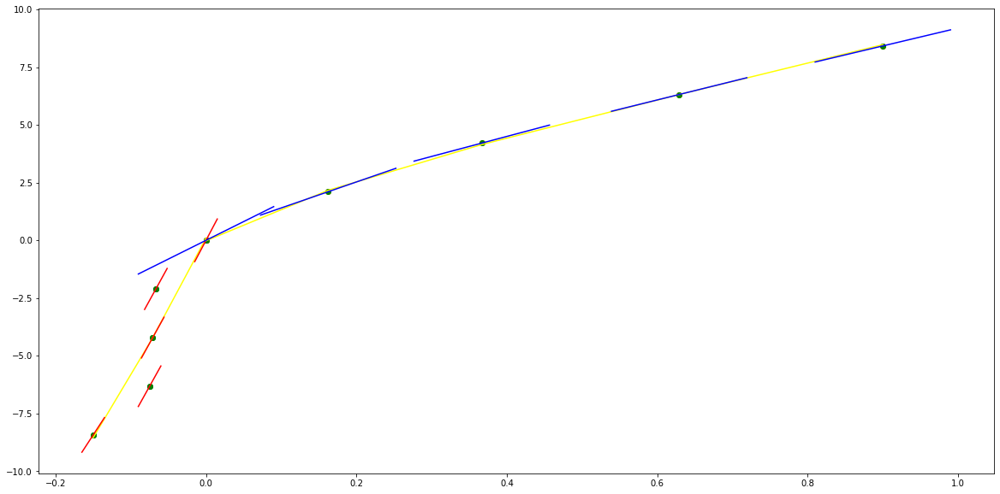

parameters (0.0046827892300452326, 0.05914362444867605, 0.2506731299281994, 0.32021113919294797, 2.764380948887995, -0.0014508606624890916)
tangent[0]:3.1205879004583386
tangent[1]:3.0522394715098304
tangent[2]:2.85346705415044
tangent[3]:2.623798984313804
tangent[4]:2.764380948887995
parameters (13.089301199018315, -95.95665403181334, 253.74007848063098, -283.0637657435312, 112.74260081019716, 3.811497809119363e-05)
tangent[0]:112.74260081019716
tangent[1]:-17.82458688909523
tangent[2]:11.64580439505724
tangent[3]:-2.0172210992035104
tangent[4]:37.744322860641574


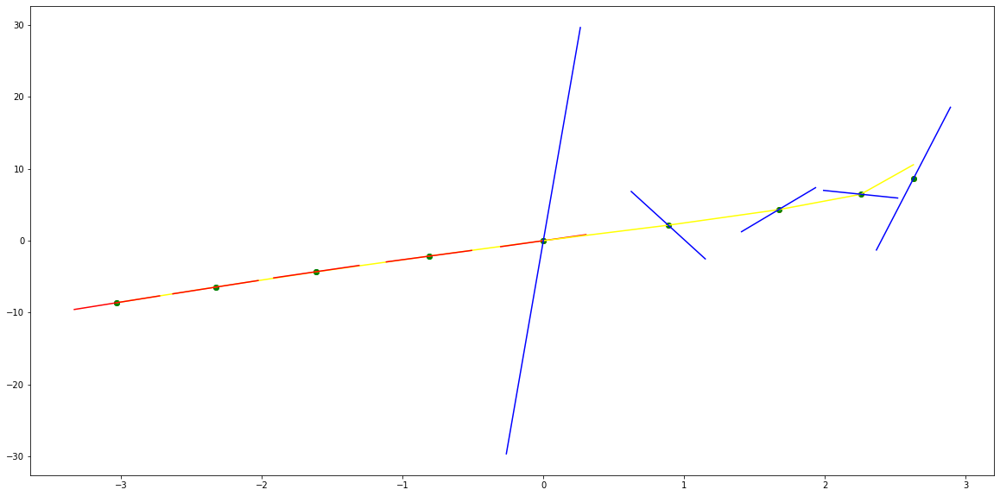

parameters (0.0002145780826595378, 0.006044648505323503, 0.03859419323755753, -0.016296679488398205, 2.404609909972133, 0.0022622525608406337)
tangent[0]:3.01758234386695
tangent[1]:2.8738536808050497
tangent[2]:2.684801731196597
tangent[3]:2.508497089000377
tangent[4]:2.404609909972133
parameters (-195.44761002862157, 1158.1185483127522, -2484.201205321359, 2270.8503611090136, -734.8233635189157, -1.9955777758919677e-05)
tangent[0]:-734.8233635189157
tangent[1]:108.54767717698007
tangent[2]:-31.835492033127935
tangent[3]:50.64813609717805
tangent[4]:50.990857105479904


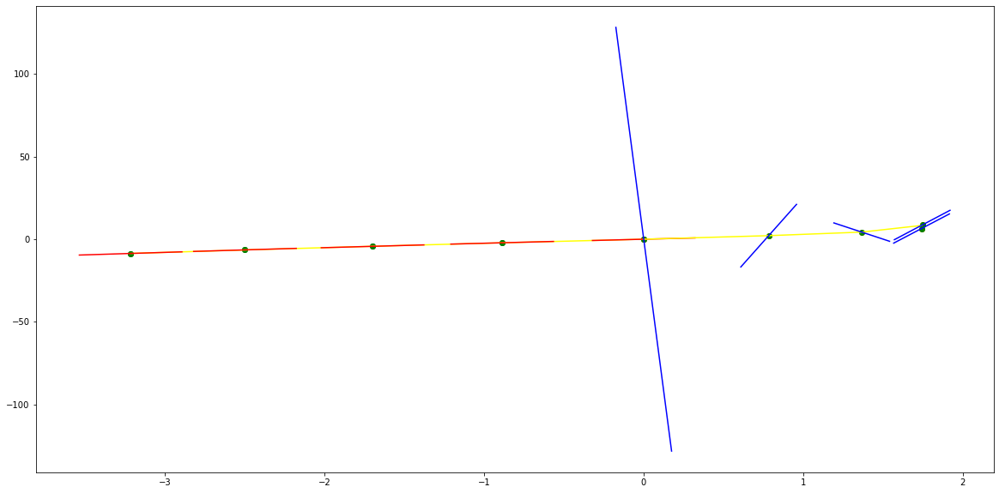

parameters (0.004004700470373575, 0.06974688677836874, 0.46967189507396, 1.4105243095839353, 4.363188394518704, -0.0010347644301862634)
tangent[0]:2.6878490651213944
tangent[1]:2.4851225601016917
tangent[2]:2.4971853451807497
tangent[3]:3.1439746723993816
tangent[4]:4.363188394518704
parameters (-897.2496912628583, 2903.8730745694406, -3368.0383521164285, 1648.2772104468233, -269.37641055548096, -0.0012668636377409371)
tangent[0]:-269.37641055548096
tangent[1]:69.75872848309149
tangent[2]:68.37984870311601
tangent[3]:66.97486667581262
tangent[4]:36.27196086325631


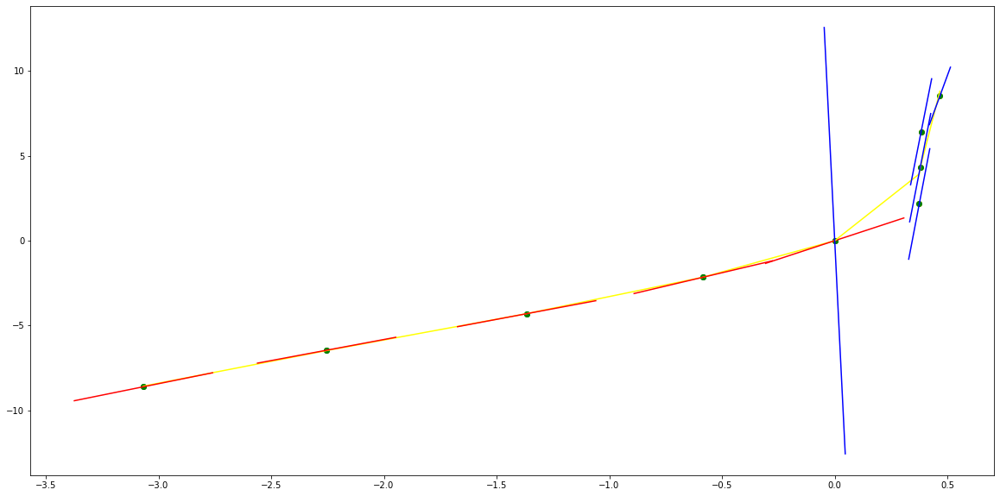

parameters (0.013116127096013156, 0.19868451500370213, 1.167516013345054, 3.2488208831808354, 6.739350886877779, -0.009161511578247896)
tangent[0]:2.5573278063635003
tangent[1]:2.4519646135583093
tangent[2]:3.085031933917991
tangent[3]:4.754667910422558
tangent[4]:6.739350886877779
parameters (316.14308666666375, -931.4796366249253, 966.6696565920134, -429.78341234434106, 87.01023427679603, 1.688155899088635)
tangent[0]:87.01023427679603
tangent[1]:83.47850563871245
tangent[2]:80.0466890053173
tangent[3]:29.8263036728043
tangent[4]:1.4954074063265779


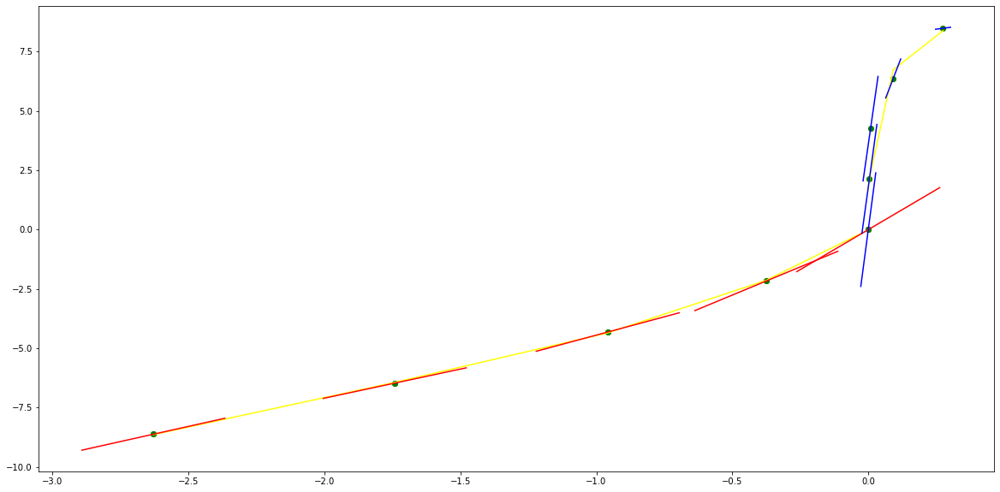

parameters (-0.010834132192134981, -0.17702491291921535, -1.0035386950796428, -2.3162802654141923, 1.0469886928285188, -0.00900199925277714)
tangent[0]:2.6048416744416283
tangent[1]:2.9702889191827744
tangent[2]:3.3299923261878037
tangent[3]:3.216079297445469
tangent[4]:1.0469886928285188
parameters (8.650128138184686, -68.58126429105967, 192.6605981104931, -225.0163987826277, 93.80313306978942, 5.62136780231235e-05)
tangent[0]:93.80313306978942
tangent[1]:-12.294269937305643
tangent[2]:13.153479313947543
tangent[3]:-13.370080868510826
tangent[4]:71.8574920614607


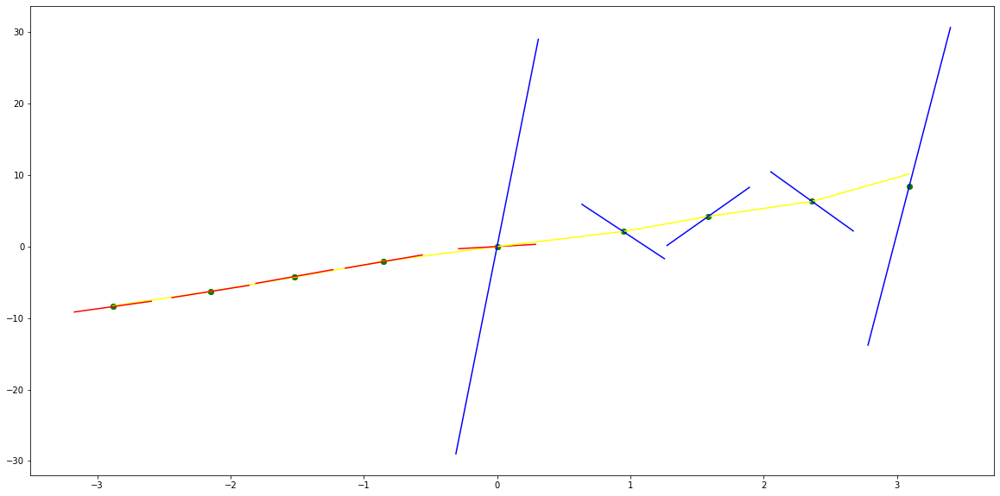

parameters (0.02121044527118357, 0.2722481088839306, 1.157856992259765, 1.7037523255564961, 3.0167008044392176, 0.0004956321781594442)
tangent[0]:3.1890383849012647
tangent[1]:3.3284538815708515
tangent[2]:2.895737340852347
tangent[3]:2.0646599325083463
tangent[4]:3.0167008044392176
parameters (-162.0163871958457, 1066.7375057596792, -2481.864267649774, 2363.115374686248, -744.1535113228615, -1.5970045166812613e-05)
tangent[0]:-744.1535113228615
tangent[1]:214.5835289534839
tangent[2]:-122.75039143436561
tangent[3]:98.40675641850294
tangent[4]:97.10847336390589


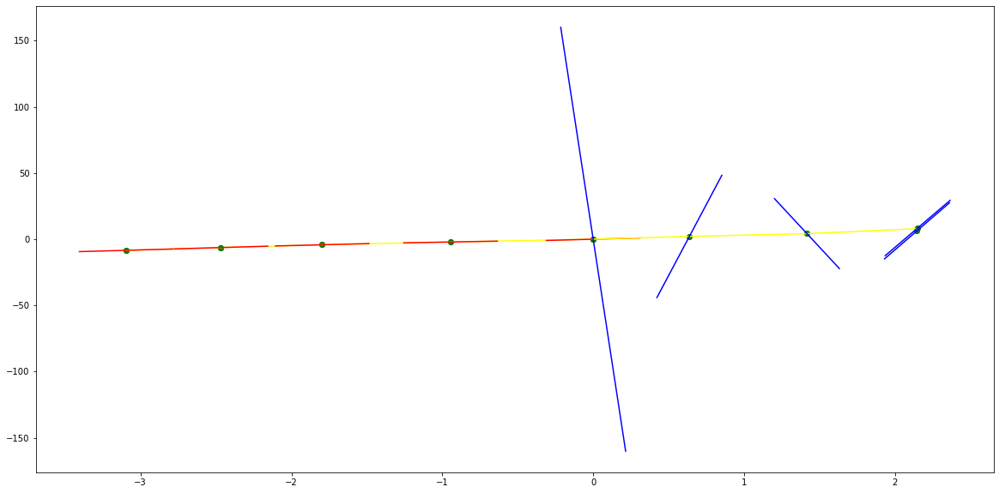

parameters (0.011561670941025427, 0.19240109536861516, 1.1047325811686137, 2.5073710937615306, 4.532279032205939, 0.0045631352833327785)
tangent[0]:3.248424713774619
tangent[1]:2.8917201721255124
tangent[2]:2.2092800735503912
tangent[3]:2.492447371839617
tangent[4]:4.532279032205939
parameters (914.9116643716209, -5442.324782382642, 11805.991434147692, -10954.899142491095, 3608.158112794906, 6.634711154610907e-06)
tangent[0]:3608.158112794906
tangent[1]:-572.4891219134902
tangent[2]:114.15116506478398
tangent[3]:110.58164921927846
tangent[4]:106.99320070536805


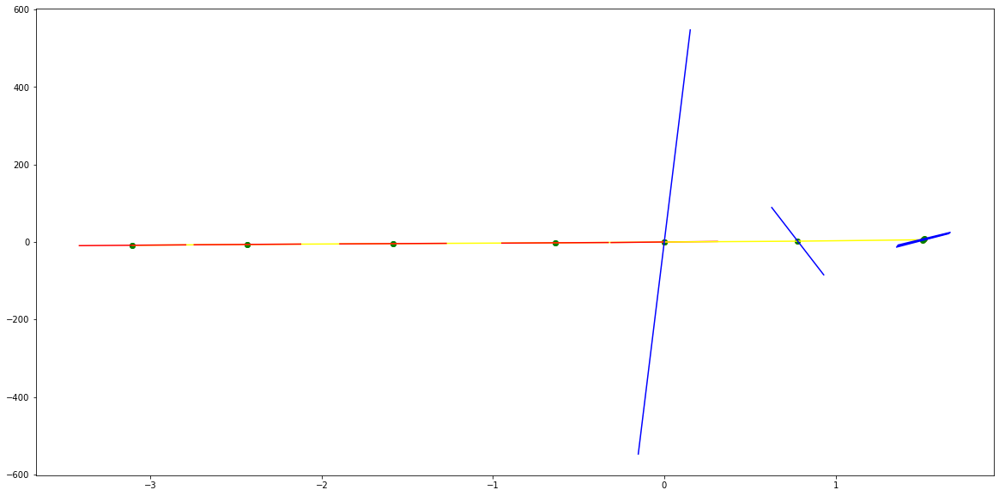

parameters (0.026926569241763895, 0.31027043155831807, 1.341875880395278, 2.8338835271251086, 5.749010826020746, -1.0441375345099755)
tangent[0]:2.714208012632933
tangent[1]:2.7961068826395516
tangent[2]:3.3070309949444567
tangent[3]:5.725463051498923
tangent[4]:5.749010826020746
parameters (115.43351001200892, -375.25916670980575, 442.5549799070724, -232.18589305278792, 61.20753921348567, 1.0378642130108489)
tangent[0]:61.20753921348567
tangent[1]:59.29590035980829
tangent[2]:39.71610958418891
tangent[3]:11.63237815594001
tangent[4]:6.29536005938639


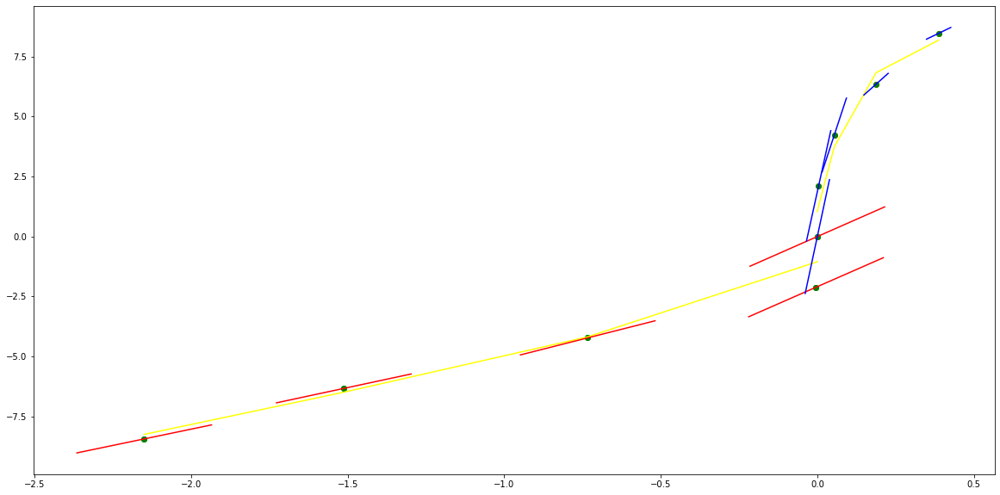

parameters (-0.17983183865537333, -1.7807133213496913, -5.761271966902185, -7.172619483419863, -0.18291603866969672, -0.006570399224061039)
tangent[0]:8.005060764695846
tangent[1]:3.654192675018868
tangent[2]:1.73713752767778
tangent[3]:3.528091726536385
tangent[4]:-0.18291603866969672
parameters (96.70856400900054, -741.1489695555688, 2030.2396399068277, -2314.9513838959756, 904.0703994219019, 4.654695480001232e-06)
tangent[0]:904.0703994219019
tangent[1]:-206.94874271660694
tangent[2]:108.95180975961091
tangent[3]:-19.534477039216767
tangent[4]:93.1490922951997


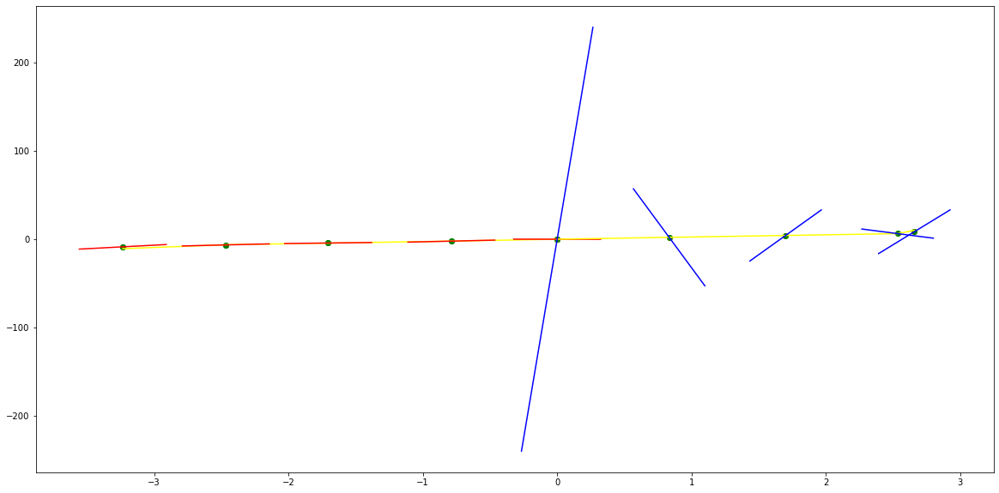

parameters (0.19987757791145572, 1.8756497618848915, 6.146230179101762, 8.17533772270719, 6.231130152498483, 0.014739644133549164)
tangent[0]:1.9698476996218828
tangent[1]:2.317527154927599
tangent[2]:3.1203803259825724
tangent[3]:1.5503891713505373
tangent[4]:6.231130152498483
parameters (-2495.7768219898458, 15906.738602343592, -37074.33760654003, 37127.711977918254, -13274.627255536214, -9.302661458311515e-07)
tangent[0]:-13274.627255536214
tangent[1]:1917.835124174644
tangent[2]:-100.57454076684917
tangent[3]:119.81133427409259
tangent[4]:122.25482206485503


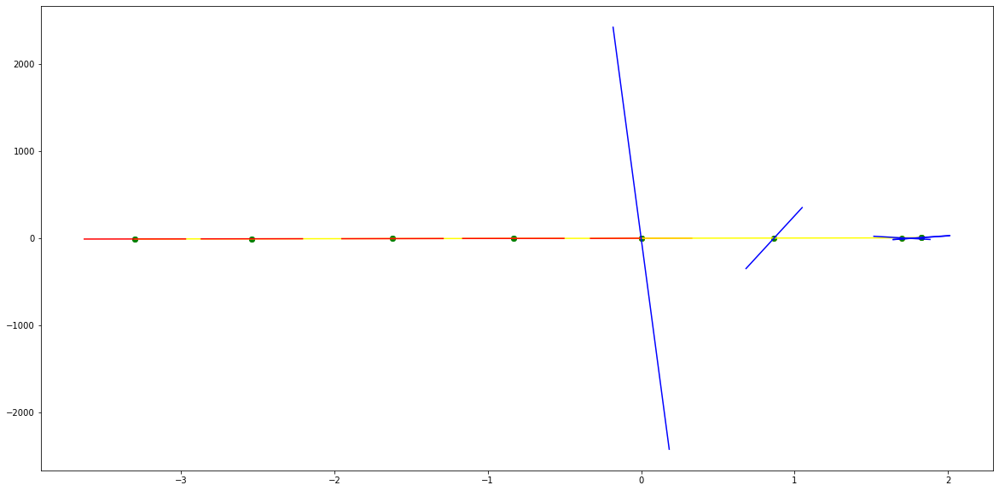

parameters (0.009770957503734839, 0.0814661728796649, 0.1935296099836779, 0.051749005917201996, 2.3678618058057253, -0.001812628824051872)
tangent[0]:2.4493765125572504
tangent[1]:2.557759739776617
tangent[2]:2.67688374564927
tangent[3]:2.5296868064644027
tangent[4]:2.3678618058057253
parameters (16790.981194903397, -70360.93845938162, 109631.54567195305, -75244.40993548543, 19193.814411199208, 2.488521363450418e-06)
tangent[0]:19193.814411199208
tangent[1]:-199.51409107438667
tangent[2]:137.2442895235945
tangent[3]:137.03838513892697
tangent[4]:136.2383889856792


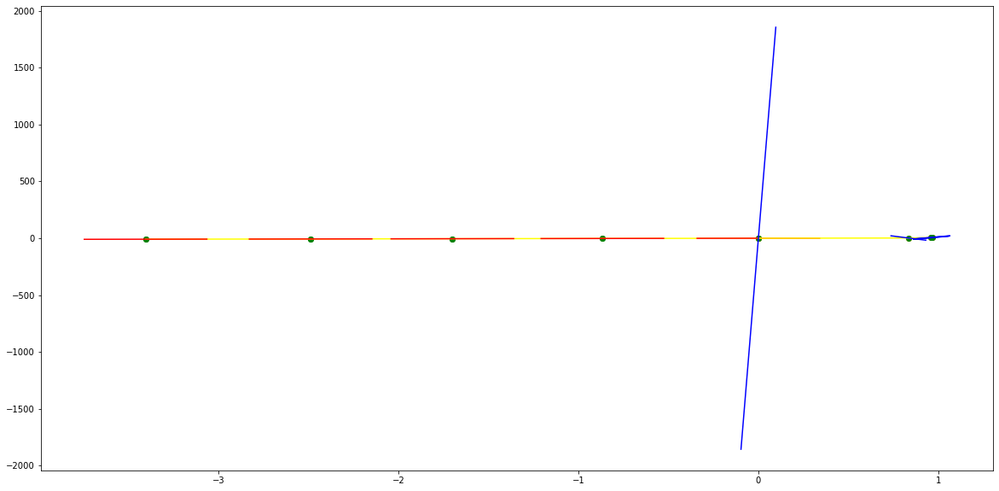

parameters (0.28603398504128524, 3.310950333236088, 13.733300314536544, 24.335927586229964, 19.20547833238368, -1.2994624575907245)
tangent[0]:2.9819748248098428
tangent[1]:-0.05497145692600114
tangent[2]:13.577921875408721
tangent[3]:19.003377144558485
tangent[4]:19.20547833238368
parameters (297.3959204420749, -817.076002582794, 814.709974945471, -359.9530024891877, 77.86277532850535, 1.0866485887484063)
tangent[0]:77.86277532850535
tangent[1]:74.90583028445843
tangent[2]:54.13394643957118
tangent[3]:14.59205527931961
tangent[4]:5.771189806251911


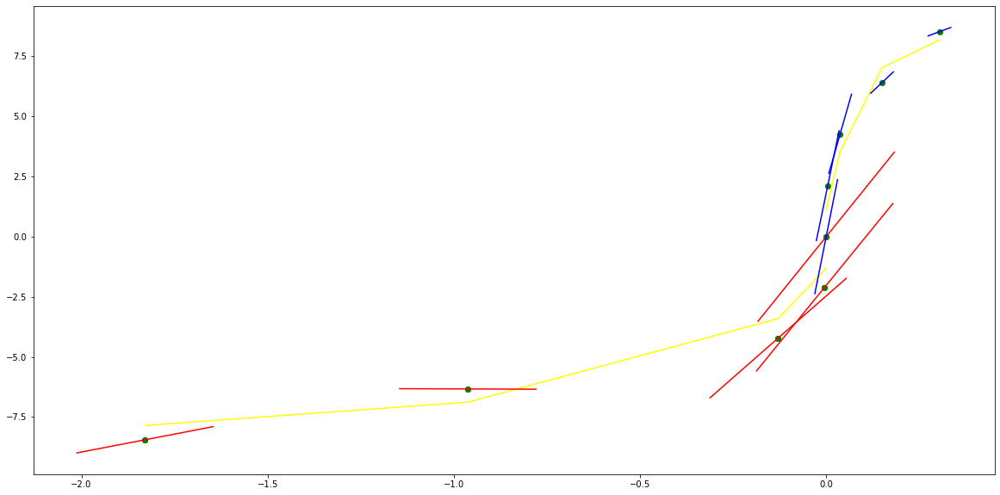

parameters (0.0024462890603000804, 0.04953793124300742, 0.35491084766629344, 1.0126406949861435, 3.087126400138822, 0.01355107054047264)
tangent[0]:2.4647578824984233
tangent[1]:2.2779092047369565
tangent[2]:1.896955329479892
tangent[3]:1.9812988444467208
tangent[4]:3.087126400138822
parameters (-14.210034863374544, 135.08468971848706, -455.6348019142424, 635.4163032552029, -299.72701687731194, -1.8859583478361855e-05)
tangent[0]:-299.72701687731194
tangent[1]:71.34039747339978
tangent[2]:-39.916472609803236
tangent[3]:43.28632116603342
tangent[4]:43.07932321801775


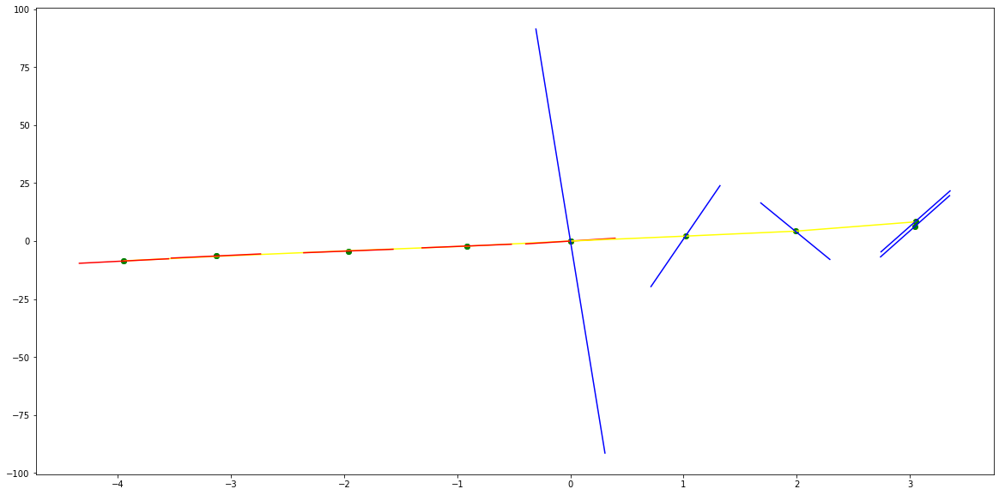

parameters (-0.004985188490797194, -0.08149862107472157, -0.4484582500793119, -0.9496474855215344, 1.5333011426871723, 0.0030403741156473777)
tangent[0]:2.1511885469640104
tangent[1]:1.90708272461829
tangent[2]:2.184076669460941
tangent[3]:2.389594463835174
tangent[4]:1.5333011426871723
parameters (77.20000751675197, -623.178830651785, 1825.468760414558, -2266.588781825227, 983.7832933144181, 1.3113459805057349e-05)
tangent[0]:983.7832933144181
tangent[1]:-193.5723716560252
tangent[2]:51.67536866400576
tangent[3]:50.842860245105726
tangent[4]:50.00481232656591


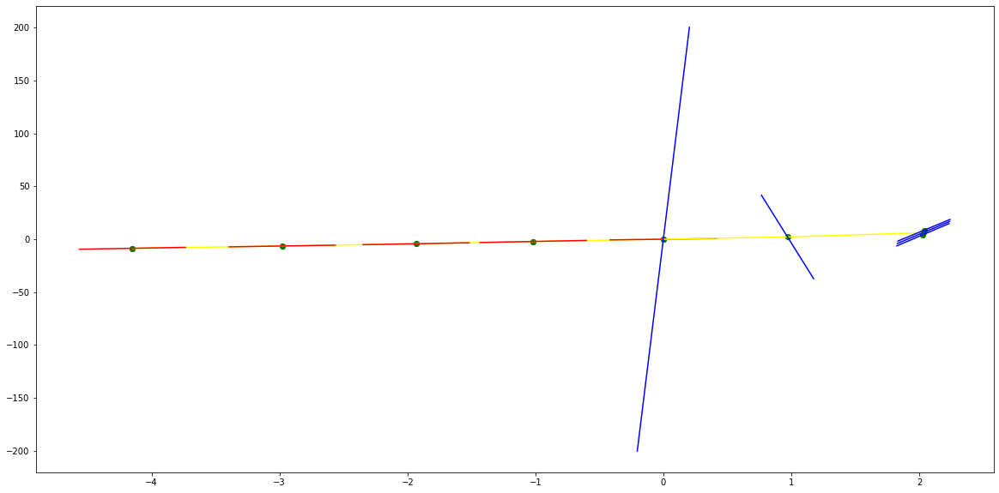

parameters (-0.001262376544543026, -0.026261340545438782, -0.17924744487106173, -0.46024142847366206, 1.8063514684241841, -0.014798879337240703)
tangent[0]:1.9895143724535953
tangent[1]:2.0681808215687454
tangent[2]:2.237860329066729
tangent[3]:2.283667652135144
tangent[4]:1.8063514684241841
parameters (-182.30542533617668, 1116.8725167328803, -2537.227753091058, 2534.023148108651, -931.4961566089873, -5.119634237269262e-05)
tangent[0]:-931.4961566089873
tangent[1]:58.80390549730009
tangent[2]:57.33788083571062
tangent[3]:55.88727761374639
tangent[4]:23.45882091030353


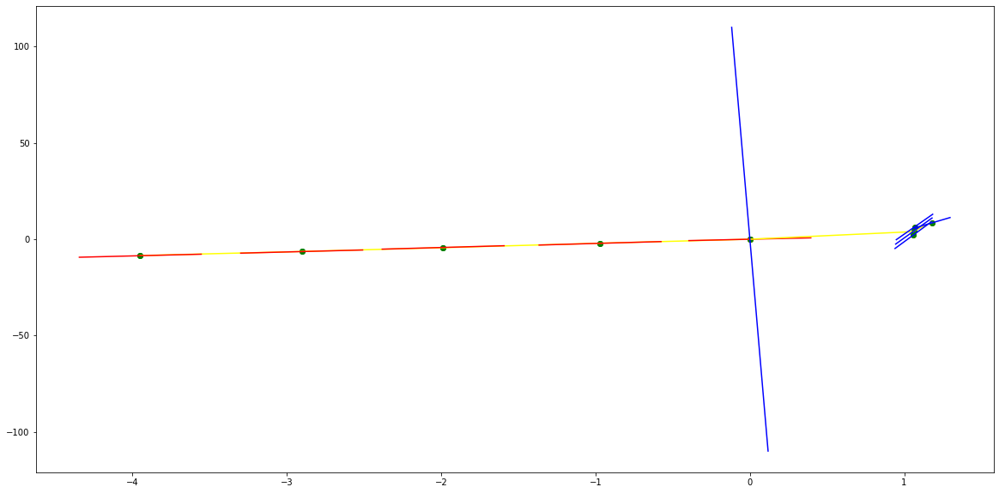

parameters (0.0030981234629595036, 0.04810113904971875, 0.24613816579449807, 0.4521094619110689, 2.3100432509528175, 0.007491563685657148)
tangent[0]:2.169387993622085
tangent[1]:2.3028026635729812
tangent[2]:2.170729198097111
tangent[3]:1.9715099615158418
tangent[4]:2.3100432509528175
parameters (166.8887560223807, -524.955349453044, 586.7487019251716, -286.24392318457626, 67.55032263587731, 1.7621765959288325)
tangent[0]:67.55032263587731
tangent[1]:65.19573674520953
tangent[2]:62.90079994091692
tangent[3]:20.5488769724533
tangent[4]:4.3684913138943955


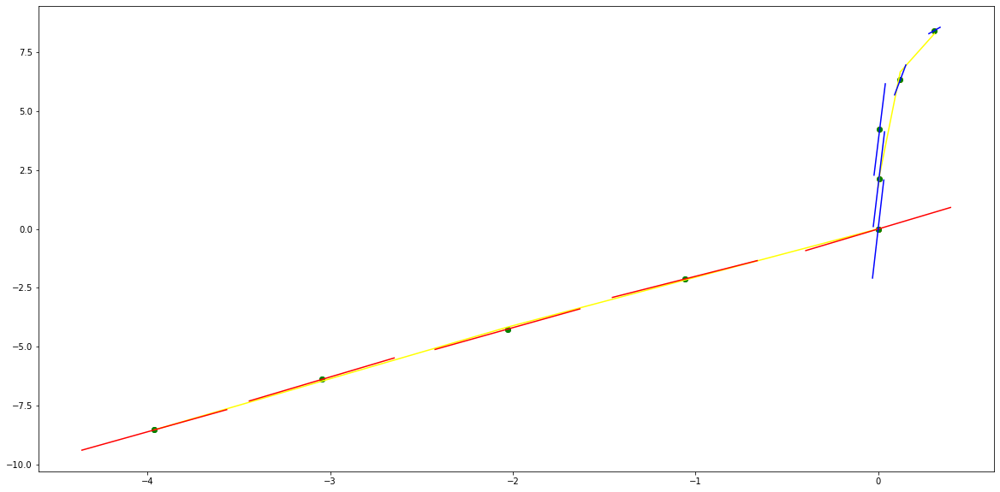

parameters (0.0011445291126517274, 0.0151328189866214, 0.040505532471590694, -0.12709989307118852, 1.5052687244440683, -0.014827433279030891)
tangent[0]:2.0428137928986434
tangent[1]:2.1853164400219365
tangent[2]:2.154194025478908
tangent[3]:1.8762526171404008
tangent[4]:1.5052687244440683
parameters (3.0026522112296785, -29.53680851662847, 103.06096637229524, -148.74943787830213, 75.41112945592809, 3.4783487441254314e-05)
tangent[0]:75.41112945592809
tangent[1]:-13.68994015712616
tangent[2]:12.19985411426606
tangent[3]:-8.492467891747964
tangent[4]:38.11050757949161


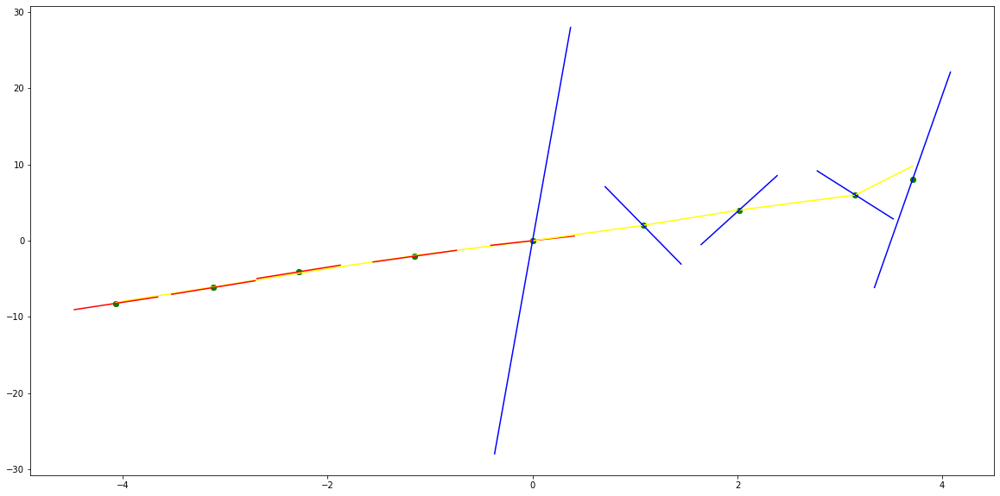

parameters (0.003789676873295864, 0.07160958859965275, 0.46284985372580223, 1.1440538178744881, 2.7090973477170563, 0.0117933829378986)
tangent[0]:2.2682689781928445
tangent[1]:2.247350711228427
tangent[2]:1.8034534291921678
tangent[3]:1.522657947519936
tangent[4]:2.7090973477170563
parameters (-57.59886086229311, 493.7948662715791, -1519.4255391812624, 1955.8990474086033, -858.468594093743, -7.705235704664698e-06)
tangent[0]:-858.468594093743
tangent[1]:207.573294851877
tangent[2]:-60.97544606273061
tangent[3]:53.16040712402571
tangent[4]:53.006939596547795


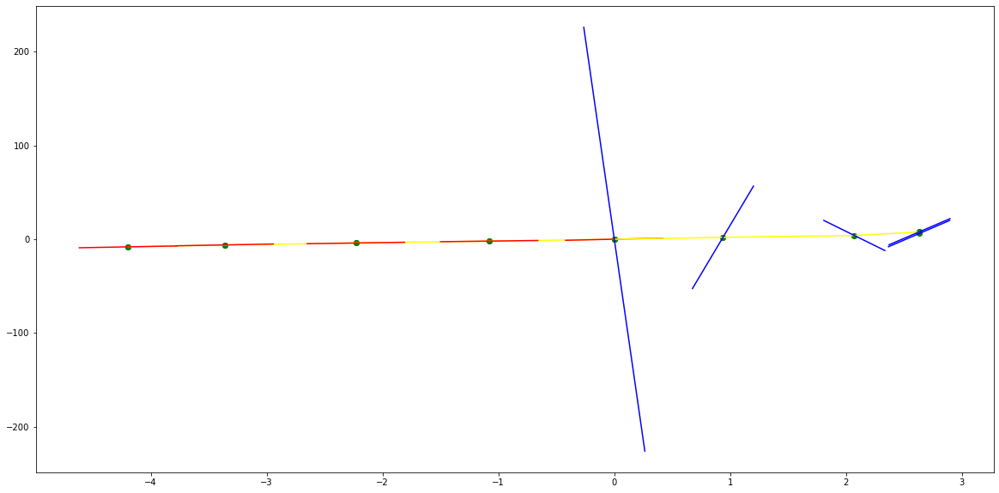

parameters (-0.0015527099905279986, -0.019009306862316517, -0.04613114802337995, 0.11688023575498876, 2.2823138597304737, 0.0027219093108178656)
tangent[0]:2.109537660025925
tangent[1]:1.7881536540251801
tangent[2]:1.7432813621673977
tangent[3]:1.99818414198595
tangent[4]:2.2823138597304737
parameters (343.16134867208245, -2408.4069435002616, 6233.714164718159, -7023.708402874373, 2894.881345305601, 5.767526369813944e-06)
tangent[0]:2894.881345305601
tangent[1]:-197.92009227094786
tangent[2]:63.33623330545197
tangent[3]:62.25587568123774
tangent[4]:61.150831192519036


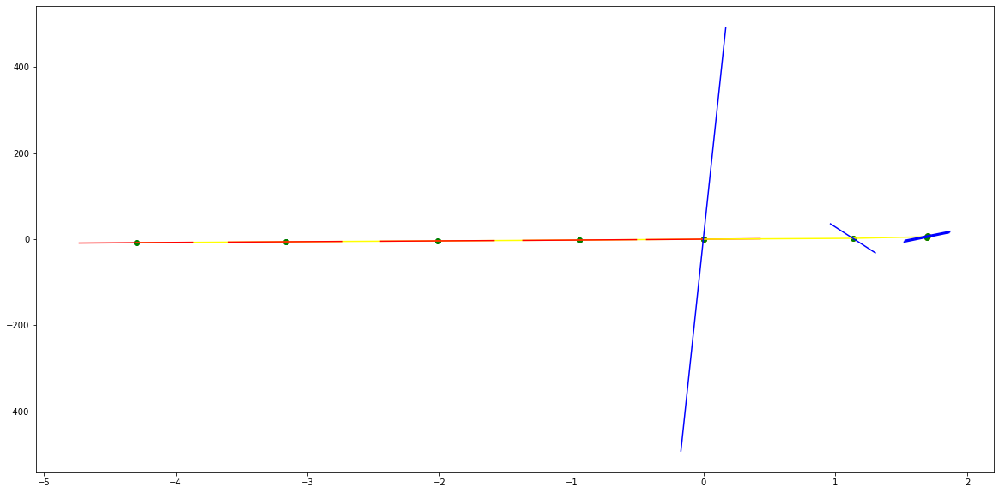

parameters (-0.0034948205245118264, -0.06603927489629474, -0.4290326386060188, -1.1124982504800351, 0.9457882552627194, -0.0025622997317451836)
tangent[0]:1.743123310623202
tangent[1]:1.7193290915593562
tangent[2]:2.05834658254656
tangent[3]:2.1699508512167385
tangent[4]:0.9457882552627194
parameters (-776.694063013541, 2973.376683205988, -4163.448741406567, 2525.924447475357, -547.985041671462, -0.00027652216058180726)
tangent[0]:-547.985041671462
tangent[1]:71.64149642984796
tangent[2]:69.65949190615504
tangent[3]:67.68421178999427
tangent[4]:31.576023886400094


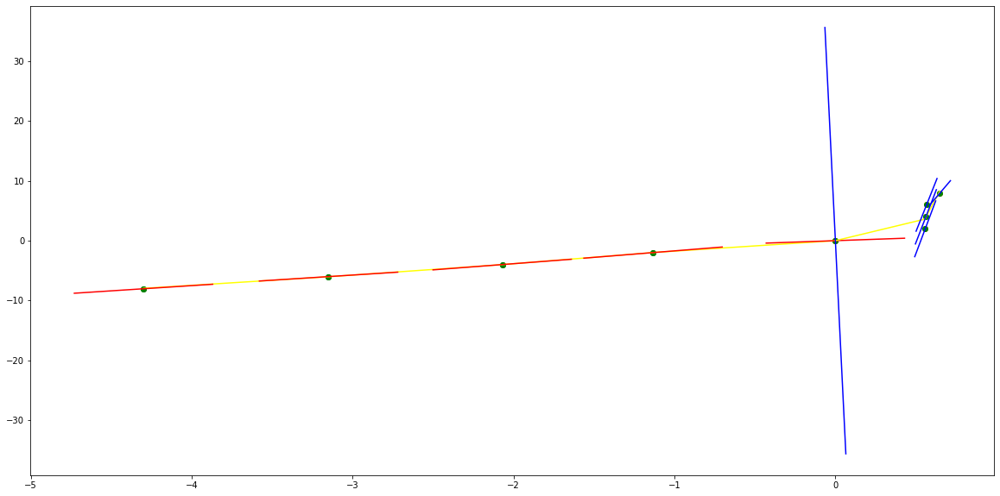

parameters (0.005837480310955841, 0.1010821099434706, 0.6384344368767575, 1.800524445005955, 4.086181833951588, -0.04526627380277536)
tangent[0]:1.971532736787986
tangent[1]:1.9043203143091638
tangent[2]:1.757135444785897
tangent[3]:2.6051261689242144
tangent[4]:4.086181833951588
parameters (242.77857317650637, -859.7942315102106, 944.5341701733184, -417.8018136479454, 82.98703676227888, 1.5790194420811203)
tangent[0]:82.98703676227888
tangent[1]:79.55484250000406
tangent[2]:76.21872977371694
tangent[3]:27.63710283354314
tangent[4]:2.253977996706567


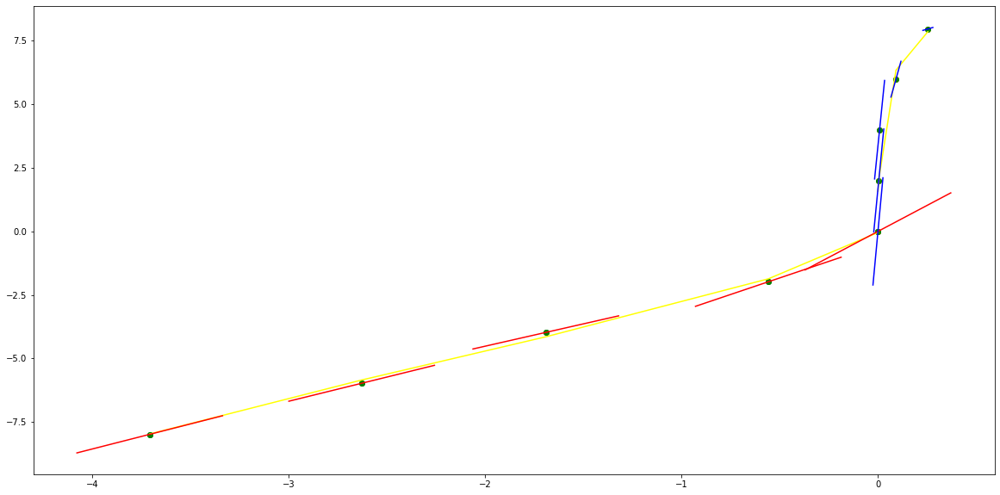

parameters (8.086092411166863, 55.87861341545352, 146.3241628057566, 170.09026755779374, 80.10072459509114, 0.2021823238647931)
tangent[0]:2.8189368548839155
tangent[1]:59.30748835207991
tangent[2]:60.50022539472556
tangent[3]:61.70678450347464
tangent[4]:80.10072459509114
parameters (3925451.9910317548, -3472676.8446327676, 808331.6055496375, -40210.81195888111, 762.1943487396499, -0.12169039823218732)
tangent[0]:762.1943487396499
tangent[1]:468.1856337528875
tangent[2]:252.48690124197958
tangent[3]:285.6601615627093
tangent[4]:462.828314072544


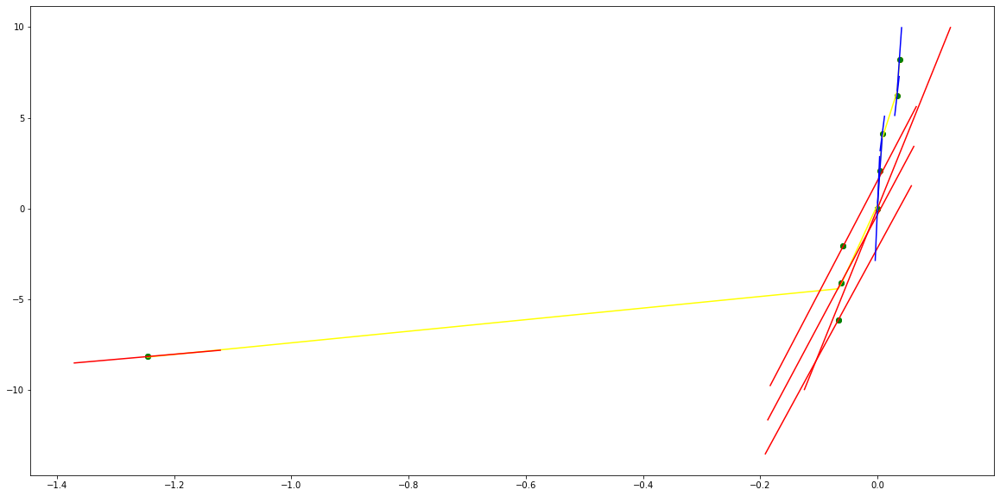

parameters (-176132.4393164149, -161077.02386666456, -42348.31632385828, -2417.9064738209454, 163.16446493138045, -0.15272060742132657)
tangent[0]:214.42950731300692
tangent[1]:211.3852915346846
tangent[2]:204.9982672071451
tangent[3]:181.15184624283137
tangent[4]:163.16446493138045
parameters (2265473.6452428275, -821113.2709028794, 107908.17415882416, -6260.432074424683, 206.7636464605027, 0.19482115456647975)
tangent[0]:206.7636464605027
tangent[1]:159.97608980936704
tangent[2]:58.85083254908389
tangent[3]:50.27116117161424
tangent[4]:61.98327111799526


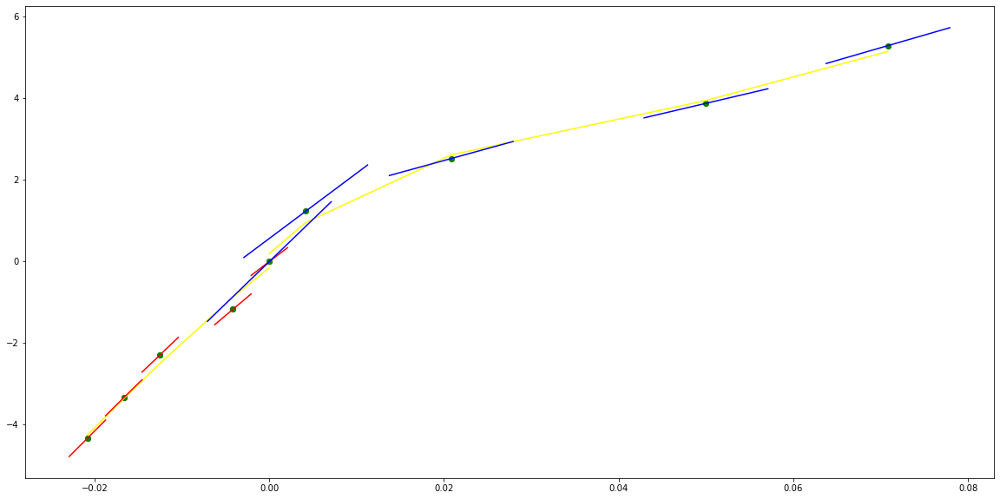

parameters (-44103.75838903707, -32422.05691335165, -8213.33307106299, -802.7781445786578, 34.13005152620236, 0.002937281687592447)
tangent[0]:47.11162348084594
tangent[1]:51.15337548466389
tangent[2]:63.68164627870332
tangent[3]:66.96722898666127
tangent[4]:34.13005152620236
parameters (2235000.4970444655, -1116768.0057216114, 199636.20622747418, -15355.679882081946, 537.6718499815715, 0.35780713142833404)
tangent[0]:537.6718499815715
tangent[1]:419.8030995477925
tangent[2]:320.81072040941956
tangent[3]:8.347804797205754
tangent[4]:72.21890111167477


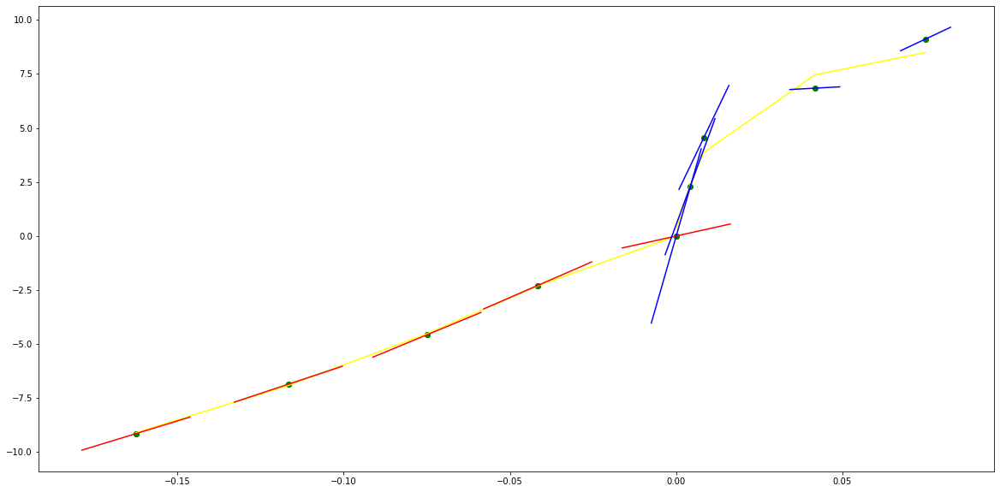

parameters (31649.708219948123, 31220.69888359804, 10981.522897990837, 1637.2182533705477, 129.87586003871692, -0.560196409117403)
tangent[0]:46.9144654097108
tangent[1]:37.251284455237936
tangent[2]:21.928474316392453
tangent[3]:104.80336544754542
tangent[4]:129.87586003871692
parameters (9981418.372650784, -7074267.584832589, 1011166.8772476476, -42067.034178800786, 799.9094235270796, -0.10754471502542645)
tangent[0]:799.9094235270796
tangent[1]:500.0240475742106
tangent[2]:293.3301311232111
tangent[3]:169.84884313342684
tangent[4]:379.5603974922052


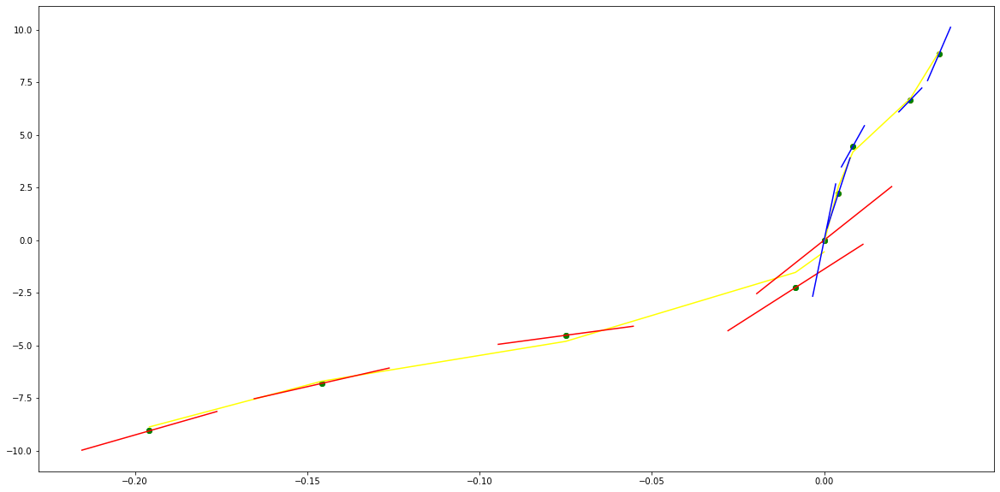

parameters (837.5747609995624, 1379.0704086722967, 848.0821530419208, 234.76790680936696, 45.62966037570806, -0.03686606461189106)
tangent[0]:18.956408029493282
tangent[1]:16.68574632311512
tangent[2]:16.93997715762734
tangent[3]:30.09625369511003
tangent[4]:45.62966037570806
parameters (87478374.76268655, -26253692.468893506, 2175769.3638248853, -65484.182620859276, 788.2554585175003, -0.1656293544959923)
tangent[0]:788.2554585175003
tangent[1]:348.38323155163744
tangent[2]:91.48894745876567
tangent[3]:325.7555644220274
tangent[4]:383.04002651820065


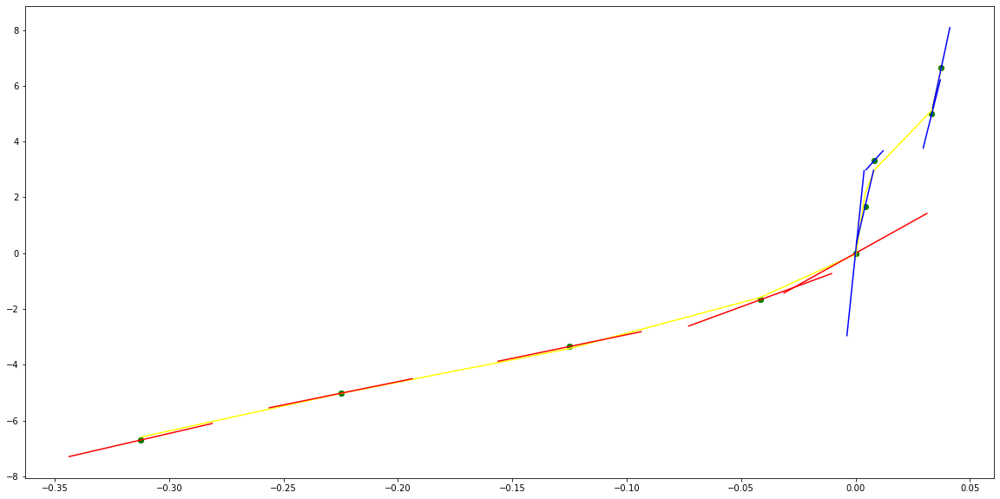

parameters (217.4025463277608, 628.7184861587216, 666.8740845825666, 310.20673768860047, 64.97567455430413, -0.9611731529053497)
tangent[0]:6.3220446403826145
tangent[1]:16.032566932812635
tangent[2]:50.6768562874298
tangent[3]:62.424968548368966
tangent[4]:64.97567455430413
parameters (6415718.751840392, -2217114.182973305, 280699.28703079245, -15703.952767543884, 388.19001378815693, 0.11305206168051454)
tangent[0]:388.19001378815693
tangent[1]:271.3033569823027
tangent[2]:60.05514609013517
tangent[3]:26.525138141402124
tangent[4]:198.51618534097707


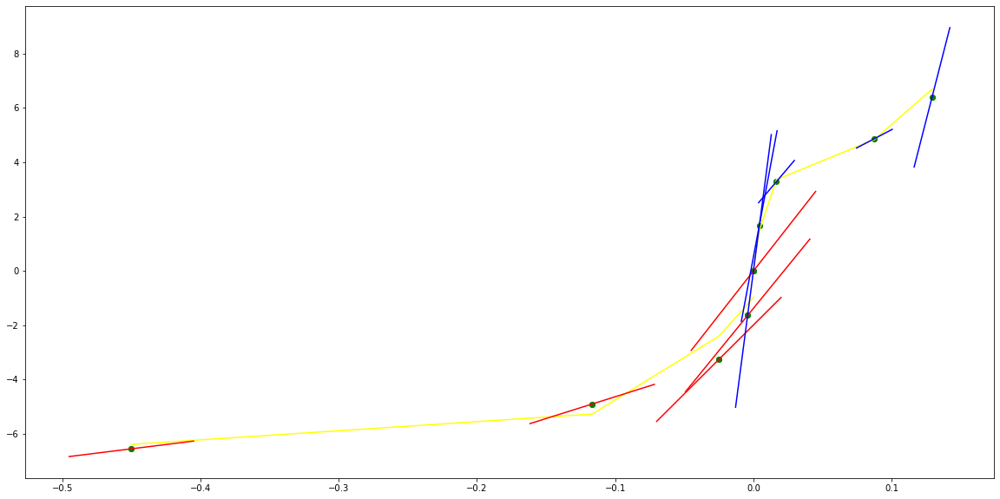

parameters (-246465563.5057209, -65185430.05366994, -6280227.513821432, -261435.29718614893, -3886.333550622874, -0.00023747166937212184)
tangent[0]:263.975945977867
tangent[1]:166.59248944093815
tangent[2]:337.59573507535424
tangent[3]:539.6791693819378
tangent[4]:-3886.333550622874
parameters (-5360557.582334756, 1959477.6024292111, -204812.20830954603, 2989.9550400092203, 335.30490432211286, 0.0019412795562854602)
tangent[0]:335.30490432211286
tangent[1]:350.1132136664465
tangent[2]:346.8757453367629
tangent[3]:328.702111506972
tangent[4]:-213.1339625370656


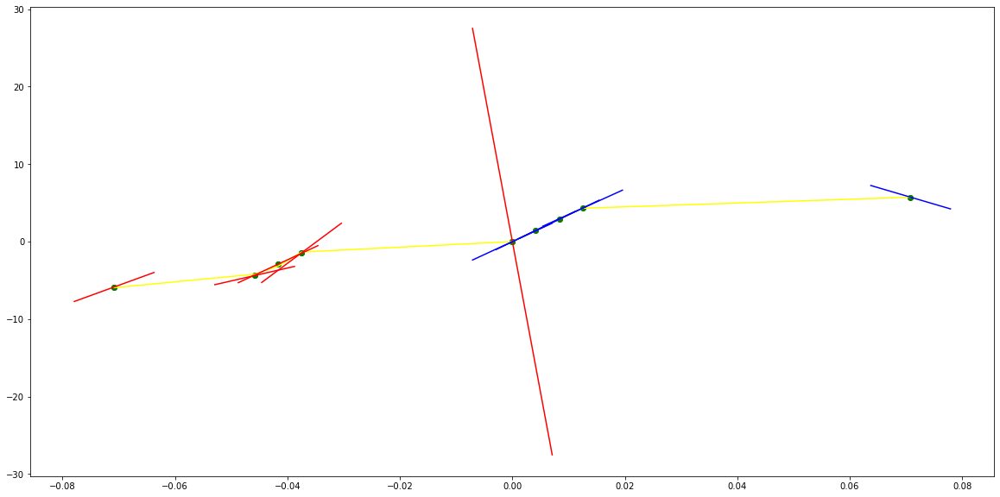

parameters (-0.2701279560568875, -10.203860255095014, -25.592349667847795, -24.0533276918123, 3.5118913800241587, -0.0014095796884018247)
tangent[0]:13.191718933664331
tangent[1]:13.393870590778603
tangent[2]:13.231358156547278
tangent[3]:11.513286302949622
tangent[4]:3.5118913800241587
parameters (86743.98897215471, -135218.43449372382, 73153.00678147838, -15621.953004428962, 1029.4711117924612, 1.4551088833488339e-05)
tangent[0]:1029.4711117924612
tangent[1]:-408.5777793873849
tangent[2]:321.3782488728025
tangent[3]:-187.99277322722492
tangent[4]:413.6199951198555


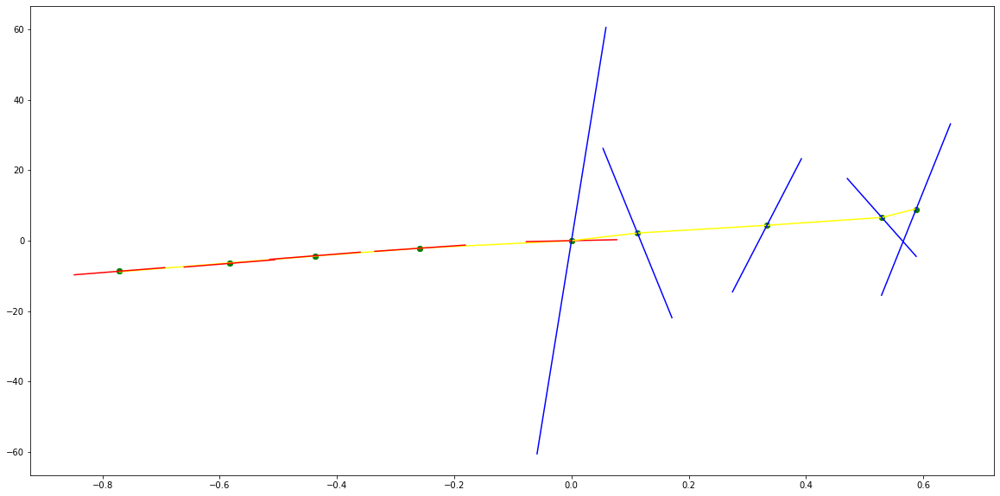

parameters (427.02845839700353, 1152.475658017145, 1107.4952420679826, 451.77043647564653, 83.15882095376395, -0.910746278718033)
tangent[0]:18.446725974521655
tangent[1]:1.5077300271051115
tangent[2]:38.57309143836176
tangent[3]:79.45112450227981
tangent[4]:83.15882095376395
parameters (25612.852124811438, -29961.135387440798, 12745.012728036741, -2384.200298287275, 209.1565934319632, 1.291775401700435)
tangent[0]:209.1565934319632
tangent[1]:189.94640031851293
tangent[2]:172.0077811702662
tangent[3]:45.10792793813303
tangent[4]:7.72330890140563


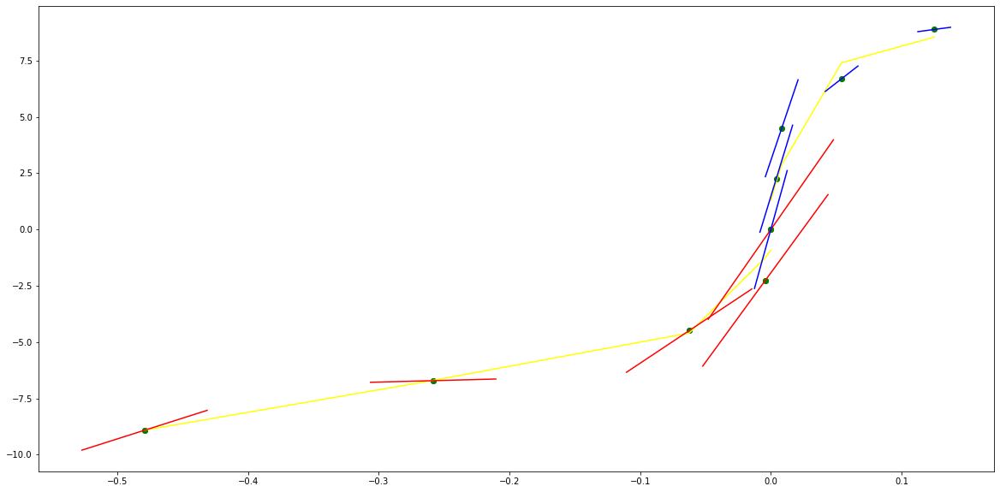

parameters (88.15283543451525, 311.2282285536601, 395.8682061918733, 217.29708057883204, 54.62049738889543, -0.6227269897654847)
tangent[0]:8.623708030124519
tangent[1]:1.0170284413197663
tangent[2]:30.565541987127474
tangent[3]:49.37121288638566
tangent[4]:54.62049738889543
parameters (912.6359064708163, -2119.9247860356186, 1791.5381902152199, -652.8758566240293, 100.60373493854603, 0.7450350878328237)
tangent[0]:100.60373493854603
tangent[1]:95.25537958469225
tangent[2]:62.742367433118964
tangent[3]:-3.9029275334386995
tangent[4]:15.158440841546835


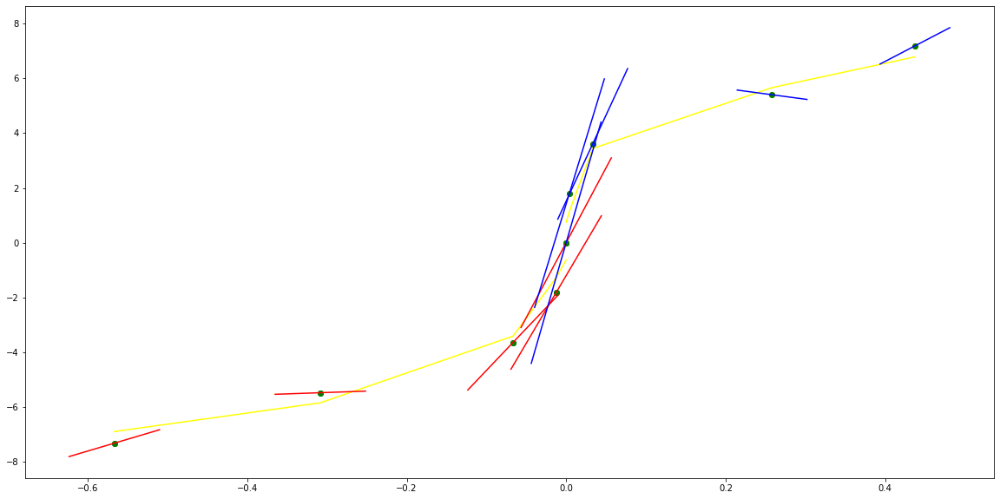

parameters (38.09643387553837, 149.89471021489658, 201.02561296027025, 103.16789808814232, 22.686866865238617, 0.03716116769169614)
tangent[0]:14.497060292322605
tangent[1]:14.638083753047457
tangent[2]:9.142195304103783
tangent[3]:2.01261431577079
tangent[4]:22.686866865238617
parameters (-7712.2496403435625, 17488.283178324924, -12233.952672552452, 2282.2631858133586, 172.35536065129708, -0.001739717922094651)
tangent[0]:172.35536065129708
tangent[1]:207.88331400734802
tangent[2]:-411.5335223653181
tangent[3]:247.72290366130727
tangent[4]:230.61598269547375


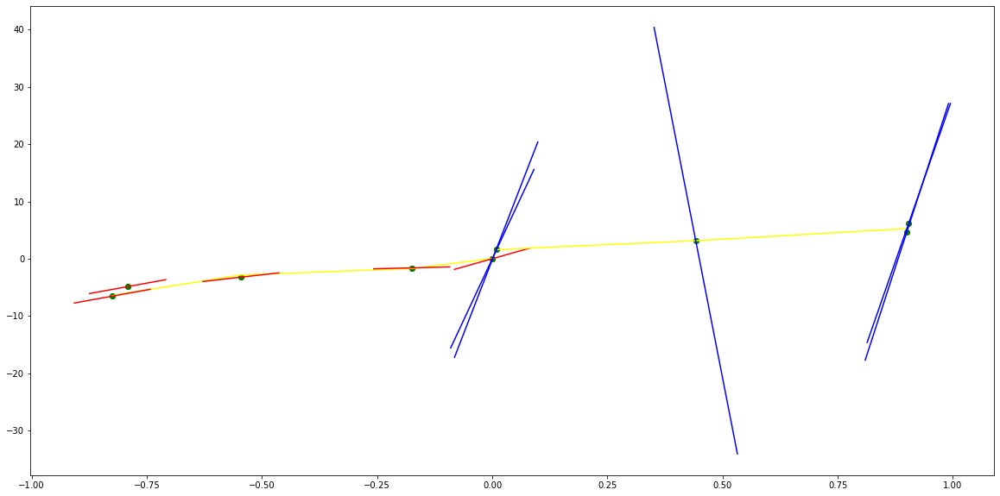

parameters (-115367753.11046097, -39681936.92679221, -4893944.142829447, -256603.49062277662, -4643.18502310876, -0.0004463996002281602)
tangent[0]:31.373864390748167
tangent[1]:548.3091466422511
tangent[2]:773.8320912839072
tangent[3]:994.5831545223073
tangent[4]:-4643.18502310876
parameters (-176304178.28981388, 26927375.22195893, -997305.263813162, -8075.791397859509, 895.0539987333964, -0.06823221364562566)
tangent[0]:895.0539987333964
tangent[1]:783.3266328758391
tangent[2]:610.7358586103903
tangent[3]:18.739275813761196
tangent[4]:561.8674197715134


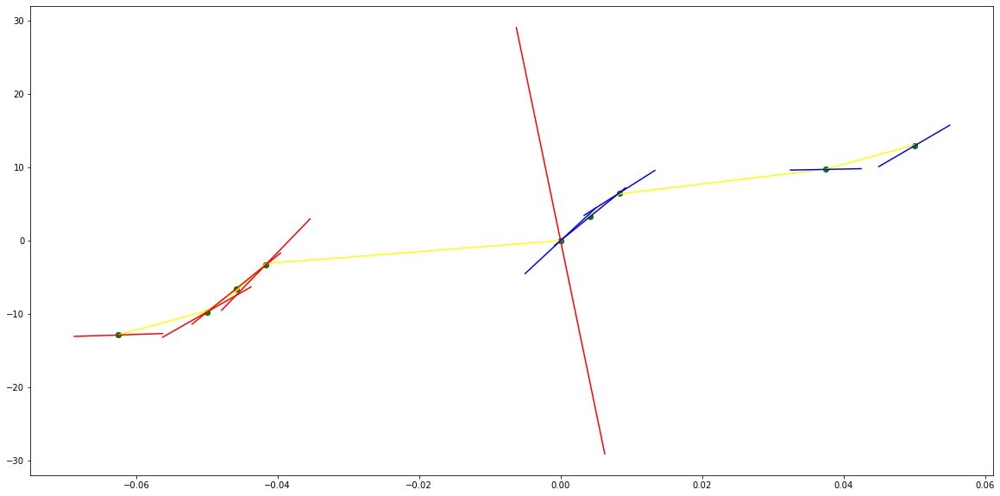

parameters (-2.338204704291186, -10.641116884606985, -16.033630191978762, -11.140145509047857, 1.8900566053761725, 0.006350366993904512)
tangent[0]:10.405416941605521
tangent[1]:7.880223712285097
tangent[2]:5.85133906128604
tangent[3]:5.575039293054688
tangent[4]:1.8900566053761725
parameters (607.0887664639005, -2127.9944018115507, 2659.5486135779497, -1378.6181132811723, 251.38697095735847, 0.00023427735703206637)
tangent[0]:251.38697095735847
tangent[1]:-41.98338990654122
tangent[2]:41.083759067375695
tangent[3]:41.003602044503396
tangent[4]:40.89093346124059


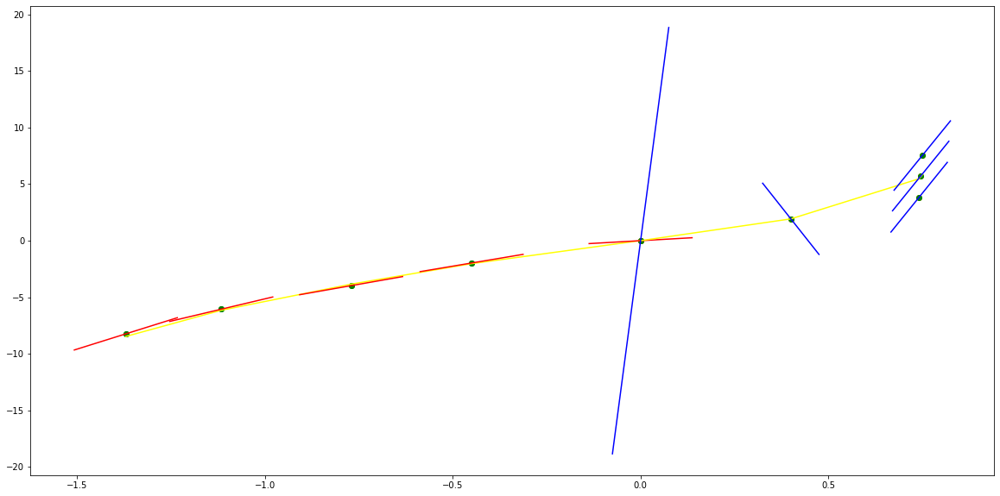

parameters (1.2118756498613825, 6.287190155910816, 12.201768051709786, 10.254732106807568, 8.126016205191018, 0.012871363814975277)
tangent[0]:5.540053916282588
tangent[1]:5.328995252793849
tangent[2]:4.623821229185479
tangent[3]:4.471294514934925
tangent[4]:8.126016205191018
parameters (346.1418160789839, -894.8336046848191, 837.8555861553172, -345.51647978209735, 67.9870814106642, 1.5035921058550576)
tangent[0]:67.9870814106642
tangent[1]:65.1516041735741
tangent[2]:62.40118026128362
tangent[3]:18.312336710563407
tangent[4]:4.603149173660327


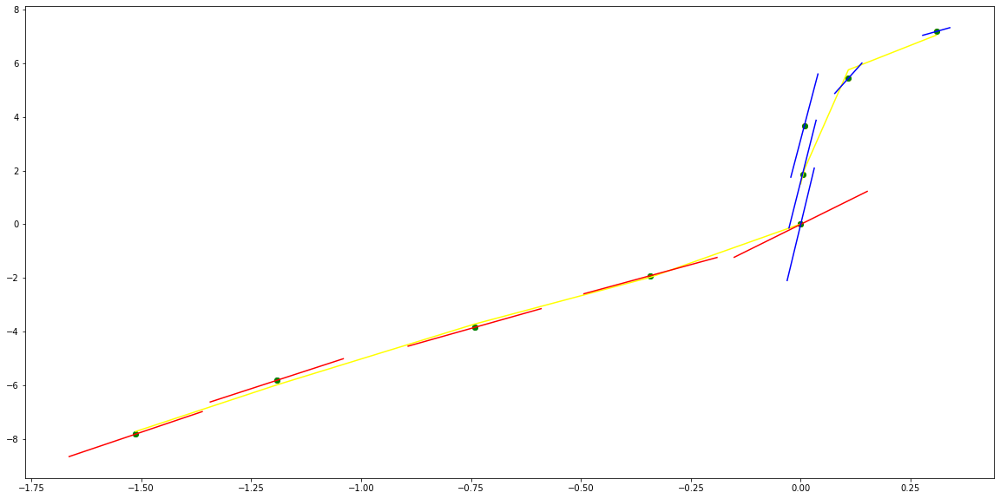

parameters (107895403.89226009, 23644070.70726297, 1790872.672215104, 52090.254492162654, 478.5632979319373, -0.0031404797403560493)
tangent[0]:212.29079386380658
tangent[1]:250.7789083305936
tangent[2]:264.5420338639253
tangent[3]:131.1163968318305
tangent[4]:478.5632979319373
parameters (108170607.00761443, -22236202.328306545, 1522243.9425857451, -38868.853442593514, 399.8998130771307, 0.053566813827312286)
tangent[0]:399.8998130771307
tangent[1]:148.99045211067056
tangent[2]:201.96201426353684
tangent[3]:256.2638945992577
tangent[4]:285.81151289853744


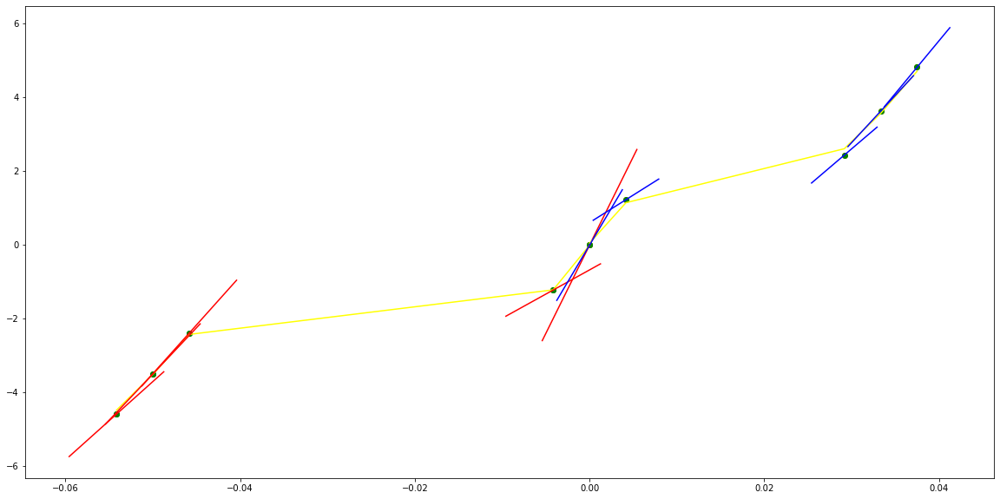

parameters (158871401.5477017, 39890140.90201587, 3444608.9600214036, 117003.35331809256, 1436.7106078339598, -0.006189387426471768)
tangent[0]:590.6033235429745
tangent[1]:562.2738286514373
tangent[2]:479.0823324086955
tangent[3]:-137.65335825867214
tangent[4]:1436.7106078339598
parameters (235323080.48657206, -50913563.32854818, 3743592.00119238, -107675.59810994583, 1281.154952216911, -0.2610685743526512)
tangent[0]:1281.154952216911
tangent[1]:564.547781571526
tangent[2]:154.3180701013955
tangent[3]:491.27362288367954
tangent[4]:585.9870042358382


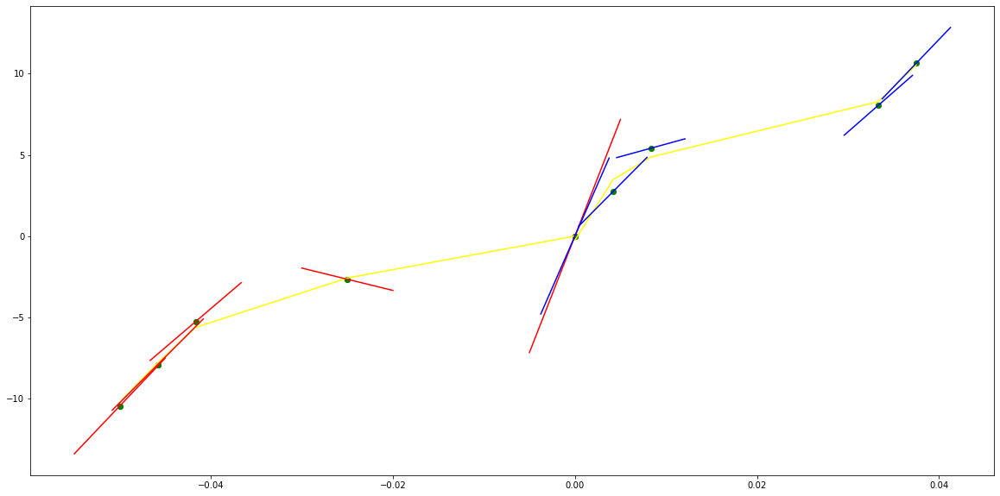

parameters (-103321256.96293688, -20201315.349839512, -1309129.7729695658, -27868.24413539127, 229.83080963400138, -0.3133988914751363)
tangent[0]:319.739991231305
tangent[1]:402.06183775845204
tangent[2]:458.09264998456183
tangent[3]:399.5809358601624
tangent[4]:229.83080963400138
parameters (453312.8667672051, -300256.1932494167, 70414.39560824717, -6814.273721897409, 289.9627286791227, 0.6052281288764793)
tangent[0]:289.9627286791227
tangent[1]:236.7662877207694
tangent[2]:28.09469877537373
tangent[3]:71.82131239238362
tangent[4]:97.83370662172734


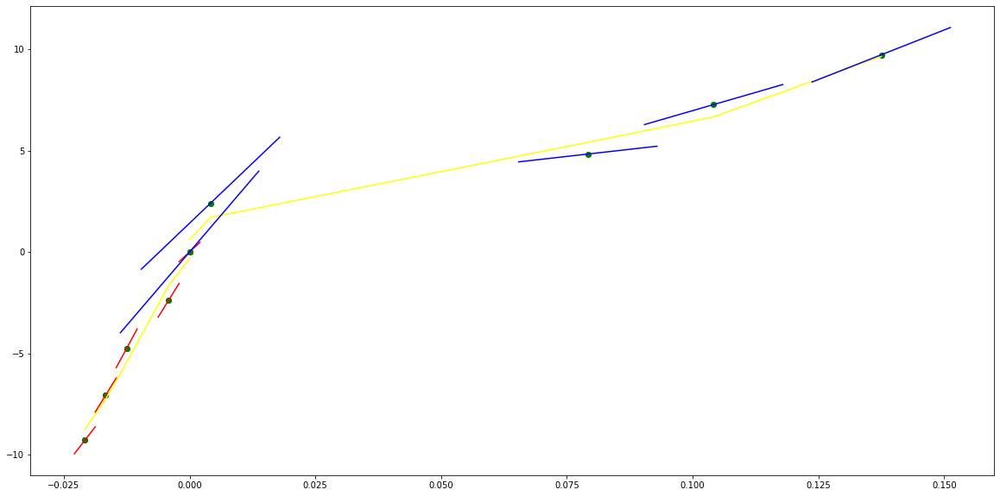

parameters (43828.96284469025, 33272.400127199086, 9218.188522949806, 1144.213497584806, 118.871726408455, -0.05610780169988045)
tangent[0]:58.97365250778455
tangent[1]:57.032830451351174
tangent[2]:53.58333676840252
tangent[3]:76.95123344485168
tangent[4]:118.871726408455
parameters (457549669.7260366, -73079390.55479278, 3792747.463131521, -74897.44418541914, 985.3646104157658, -0.09776747030787859)
tangent[0]:985.3646104157658
tangent[1]:538.3484245960069
tangent[2]:369.1023309074635
tangent[3]:472.5889370556574
tangent[4]:590.8613873434472


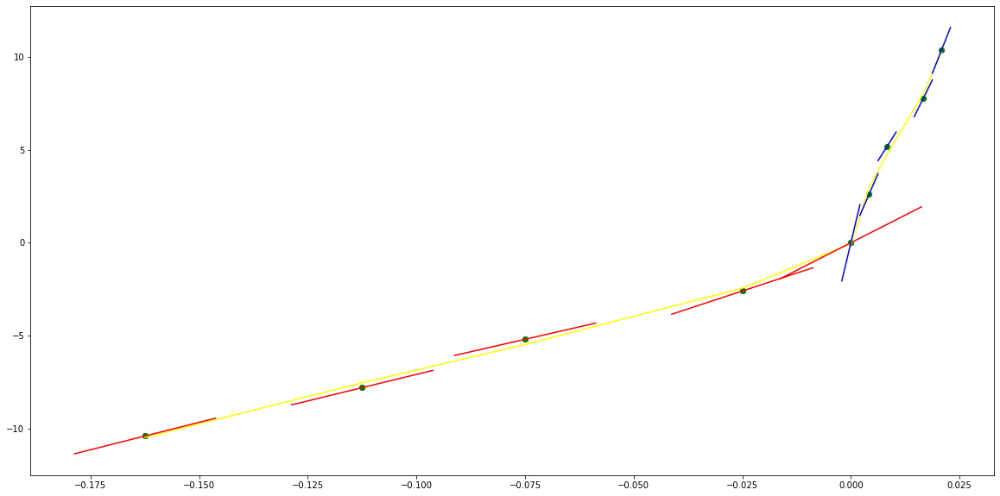

parameters (-532.7648319177855, -796.7613971243567, -420.4145960343038, -83.73172120461318, 15.763499686748547, -0.00044527190116567926)
tangent[0]:17.112842199181706
tangent[1]:19.710179423170892
tangent[2]:22.163418605224955
tangent[3]:22.489011355709508
tangent[4]:15.763499686748547
parameters (122555126.79645145, -26552274.056118947, 1958769.529305788, -56764.003909090374, 682.5852856974708, -0.13463456808779065)
tangent[0]:682.5852856974708
tangent[1]:304.0496081426651
tangent[2]:86.06287410910477
tangent[3]:250.40300508980283
tangent[4]:299.7613883100113


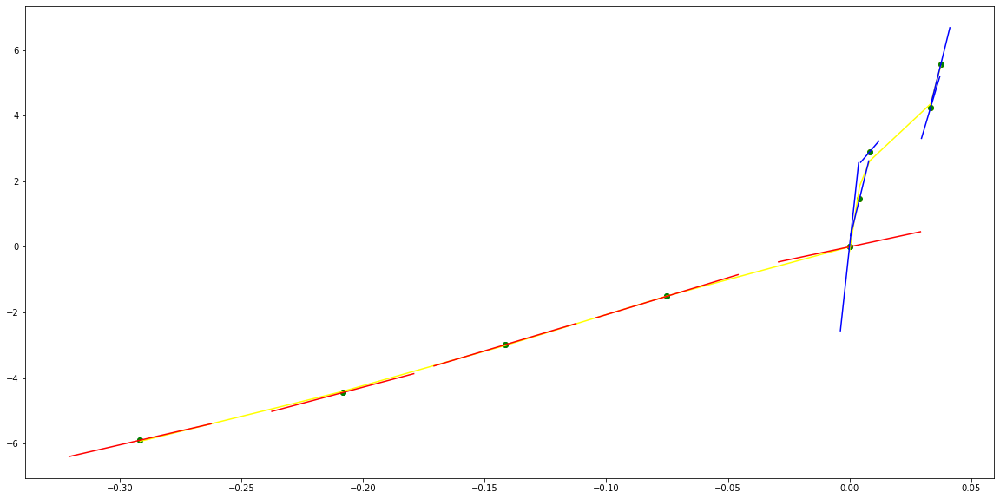

parameters (2248813.7570682997, 782167.6216107454, 97819.52498419643, 5627.5121999293115, 184.8842479746014, -0.16370716773149507)
tangent[0]:22.396659131323304
tangent[1]:33.78688439574273
tangent[2]:36.76474077429708
tangent[3]:142.8571575895772
tangent[4]:184.8842479746014
parameters (7929.078412200624, -8482.274445163492, 3296.193665783126, -562.3581112844494, 57.06478980336208, 0.4010788293687795)
tangent[0]:57.06478980336208
tangent[1]:52.547358529080086
tangent[2]:20.104978640068573
tangent[3]:14.133894979175402
tangent[4]:19.17239769314906


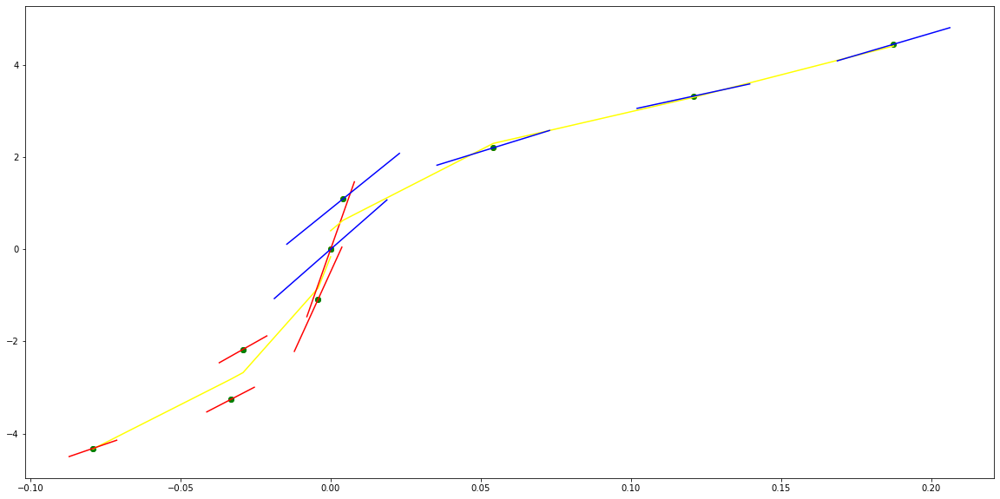

parameters (1593.1098771504376, 2953.742485660041, 1985.3981359661382, 578.6513044235763, 78.47748941274368, -0.6421509651700835)
tangent[0]:12.860965042763539
tangent[1]:2.490894241888853
tangent[2]:46.091238245870244
tangent[3]:73.75868794854341
tangent[4]:78.47748941274368
parameters (-3228148.257413688, 745852.6572329026, -6775.998155160771, -6066.6882476727915, 323.1268385064198, 0.1264896122452748)
tangent[0]:323.1268385064198
tangent[1]:272.4250847494591
tangent[2]:-62.315276852291504
tangent[3]:-58.544922362715965
tangent[4]:238.0524965675964


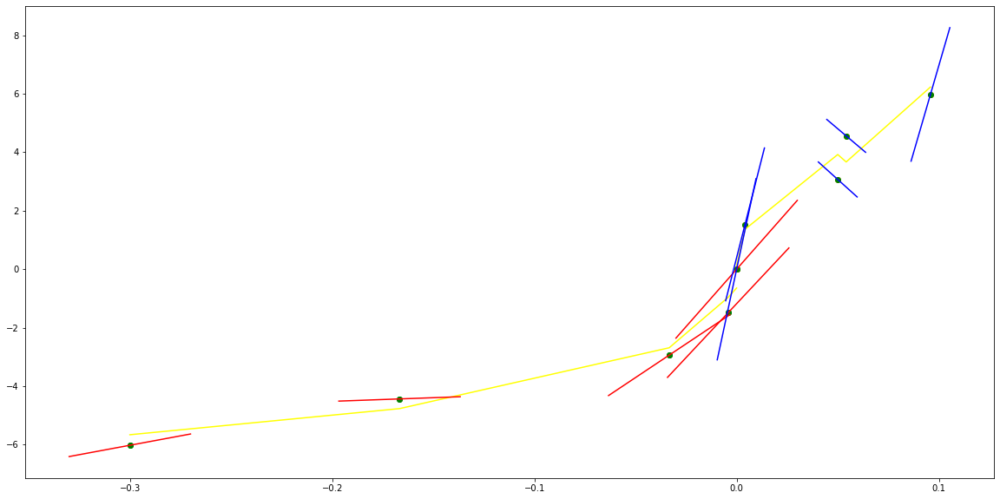

parameters (-262568.13503217977, -208968.44296663947, -58217.75175922721, -6633.763560105089, -235.61405229185652, 0.0007220116661267975)
tangent[0]:94.46104653097132
tangent[1]:90.04857980821566
tangent[2]:-14.092714388819559
tangent[3]:83.28047975381128
tangent[4]:-235.61405229185652
parameters (4850429.191730125, -1910953.8232760085, 270848.0707136742, -16611.425451321735, 436.67035431361177, -0.042284025622764676)
tangent[0]:436.67035431361177
tangent[1]:311.82074648771436
tangent[2]:211.94046968552004
tangent[3]:3.9780948960114415
tangent[4]:51.56972189896254


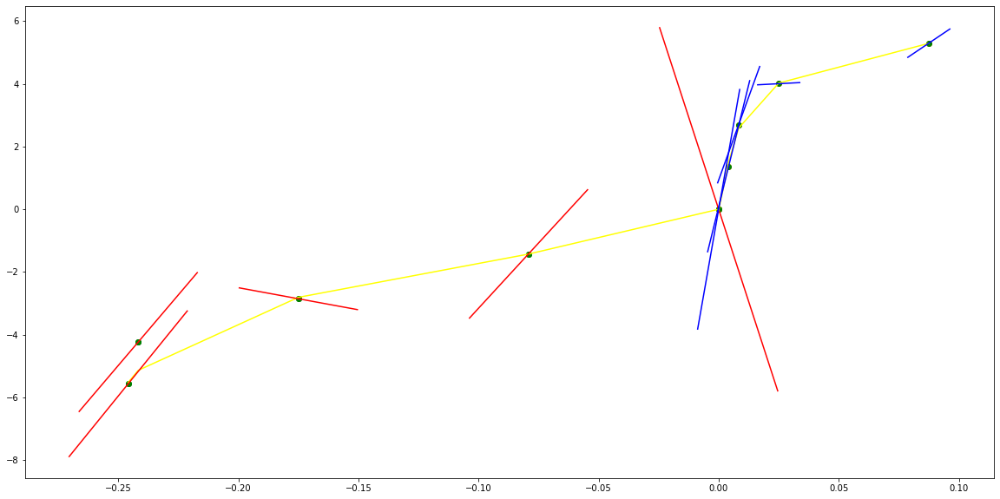

parameters (31477193.08462407, 17658394.64531908, 3518690.760793431, 282827.8267070292, 6900.990958214761, -1.3397052608015988e-06)
tangent[0]:281.7524967864247
tangent[1]:382.1076208897812
tangent[2]:519.2648183041692
tangent[3]:-2976.5980155704037
tangent[4]:6900.990958214761
parameters (70620.15461229467, -63285.4236589199, 20537.07128909517, -2922.244315760737, 198.55602747967356, 0.9024674770028104)
tangent[0]:198.55602747967356
tangent[1]:175.2589881063255
tangent[2]:153.9873440633628
tangent[3]:21.118176400337006
tangent[4]:15.266412606227789


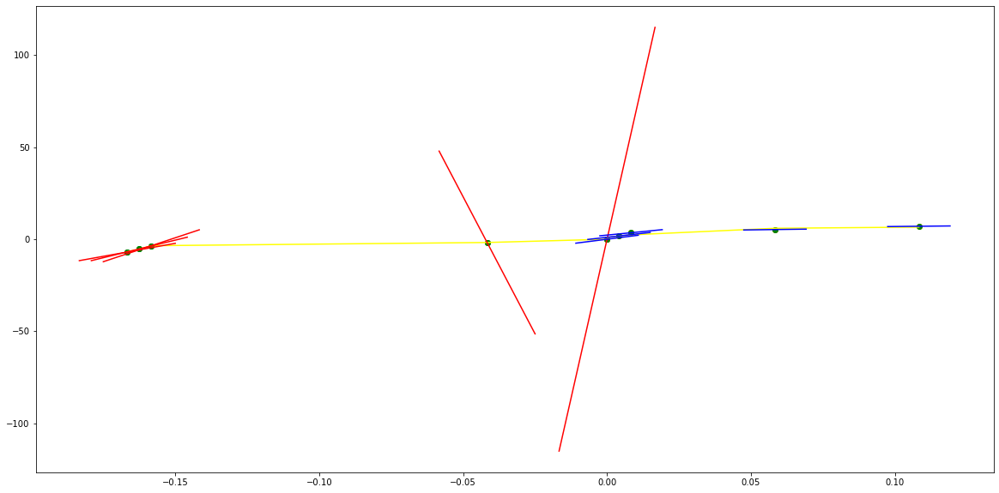

parameters (-147795.24301930665, -155590.55190008137, -52540.650168053224, -6106.64251458218, -106.90137061166485, -0.9379696685187805)
tangent[0]:184.73279540105784
tangent[1]:182.88467919184126
tangent[2]:178.4193007260651
tangent[3]:-58.70073353232648
tangent[4]:-106.90137061166485
parameters (-900664.9265757044, 583615.1919878664, -118288.04618742093, 7756.274763270449, -9.08381569162643, 0.7086960930805968)
tangent[0]:-9.08381569162643
tangent[1]:49.562709568761804
tangent[2]:196.14818811728009
tangent[3]:194.6098746627188
tangent[4]:187.80992588778005


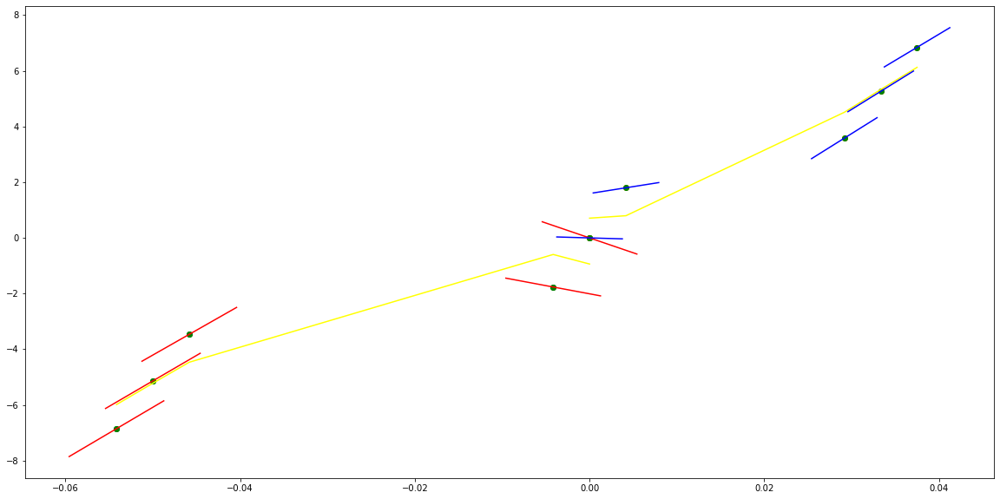

parameters (-87954139.11712441, -20090834.03855443, -1505337.822550151, -38699.690635258106, -50.52134774370149, 0.00021816534260789942)
tangent[0]:340.5192670579931
tangent[1]:323.14925148339813
tangent[2]:357.5668654958784
tangent[3]:325.2412497475023
tangent[4]:-50.52134774370149
parameters (-917777.8915631851, -922448.2677543509, 266293.77142769867, -20539.712516933476, 494.30733180563715, -0.07610360608860496)
tangent[0]:494.30733180563715
tangent[1]:336.73269440488525
tangent[2]:205.2802028630644
tangent[3]:262.2143399570327
tangent[4]:275.42733622131476


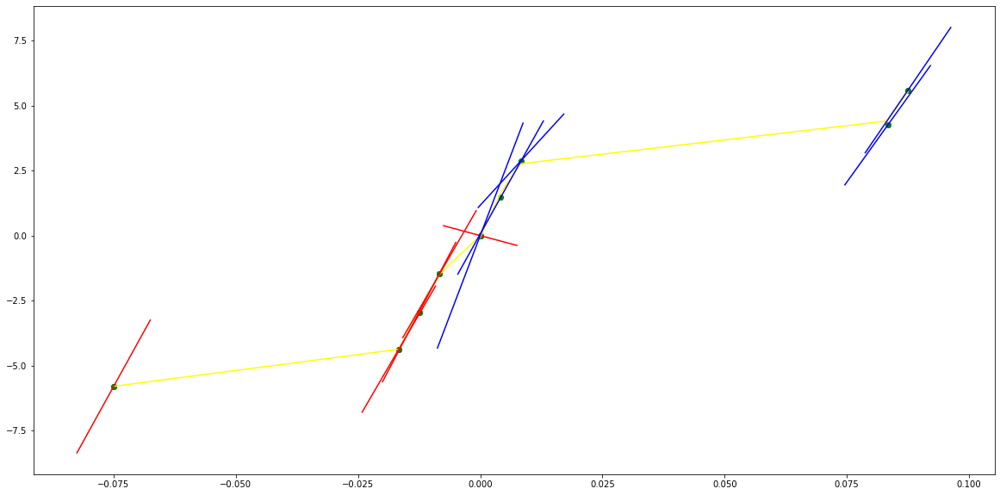

parameters (9.629272116469188, 21.27632706364566, 13.609383132252391, 1.464758922716918, 11.859783814691118, -0.006124860054555028)
tangent[0]:12.305715587625652
tangent[1]:12.96505455390438
tangent[2]:12.909507101965628
tangent[3]:12.1675580391286
tangent[4]:11.859783814691118
parameters (-462227.42268596124, 669898.6279508724, -344810.0038590655, 72746.01129985895, -4996.166455432133, -2.6247564723196007e-06)
tangent[0]:-4996.166455432133
tangent[1]:1634.1041150969131
tangent[2]:-585.5215785688351
tangent[3]:393.2345262251756
tangent[4]:371.4094127843118


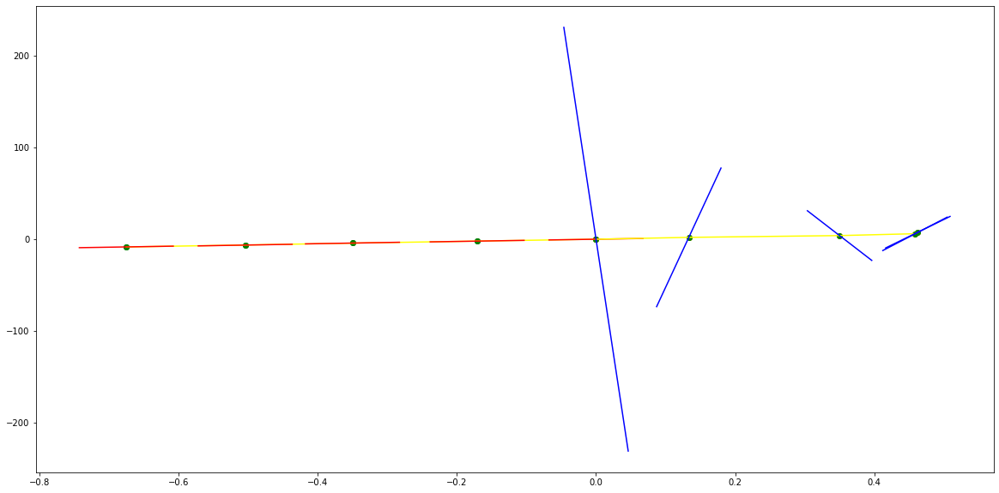

parameters (-97564222.33581816, -13150104.841515185, -506424.18515052163, -2489.5028572241135, 207.67115371463947, -0.07799005932674037)
tangent[0]:156.0954727746963
tangent[1]:12.544555020994352
tangent[2]:123.34788732091984
tangent[3]:205.70211348808303
tangent[4]:207.67115371463947
parameters (25507.219788804203, -24420.596585452426, 8549.222584941166, -1361.6878059630658, 116.37462064198124, 0.3365598722602629)
tangent[0]:116.37462064198124
tangent[1]:105.46462833495868
tangent[2]:69.90900126838751
tangent[3]:29.68274679394085
tangent[4]:15.591949822856236


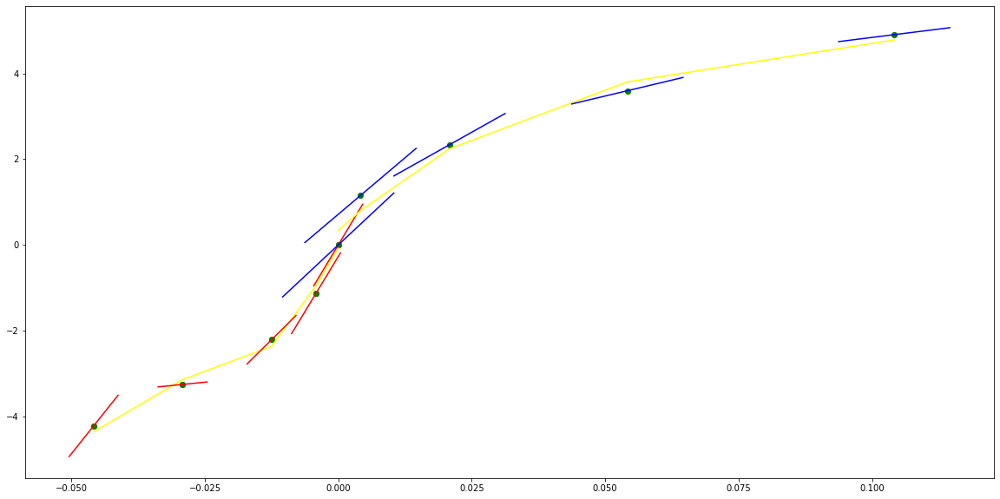

parameters (652905433.3691816, 94814263.97985399, 4836970.289642428, 96789.80723129847, 695.4486686235904, -0.004534314118359689)
tangent[0]:298.0277204849898
tangent[1]:349.75422544231594
tangent[2]:346.1110225657002
tangent[3]:114.31126315184895
tangent[4]:695.4486686235904
parameters (-4930952.364413757, 1037040.4166128935, -979.1426011431113, -8561.384584449312, 402.4987818730178, 0.016788017118404896)
tangent[0]:402.4987818730178
tangent[1]:331.38990563822506
tangent[2]:-86.59006140557341
tangent[3]:215.4941659588555
tangent[4]:305.9928765854219


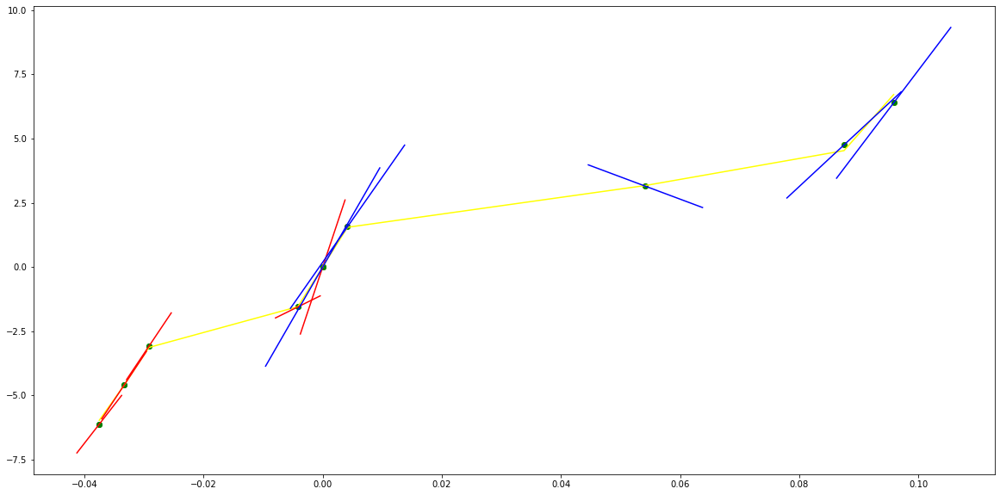

parameters (-302958.0691347751, -196977.06502274307, -40477.54213439369, -2371.307847856288, 113.5048593087012, 0.13667697614694732)
tangent[0]:104.8186921060345
tangent[1]:163.97890156660537
tangent[2]:166.98222229811046
tangent[3]:167.89421178467
tangent[4]:113.5048593087012
parameters (-12400477.260473339, 4857864.709593422, -581075.5144342264, 18503.471489520107, 407.8846328976725, 0.06542651912399314)
tangent[0]:407.8846328976725
tangent[1]:533.2106476128072
tangent[2]:606.1605215618908
tangent[3]:10.556687903602835
tangent[4]:367.85052710699534


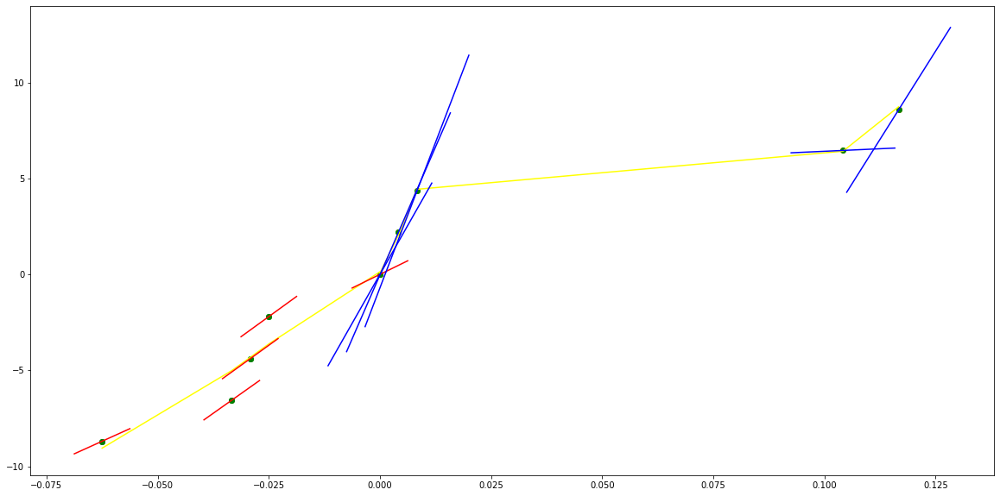

parameters (815.2369259989217, 1341.8679237226888, 765.7618458501003, 179.3580018270005, 38.213872365318295, -0.0004243354932845481)
tangent[0]:25.29547680595313
tangent[1]:24.984825345431105
tangent[2]:20.84966304878199
tangent[3]:22.09697414801505
tangent[4]:38.213872365318295
parameters (103493.25528284178, -91588.55767301642, 29147.60329882211, -4026.5030043416796, 258.55615071637624, 1.0714374985776405)
tangent[0]:258.55615071637624
tangent[1]:226.49127026197056
tangent[2]:197.3128932041796
tangent[3]:19.618380476363768
tangent[4]:26.183053386700294


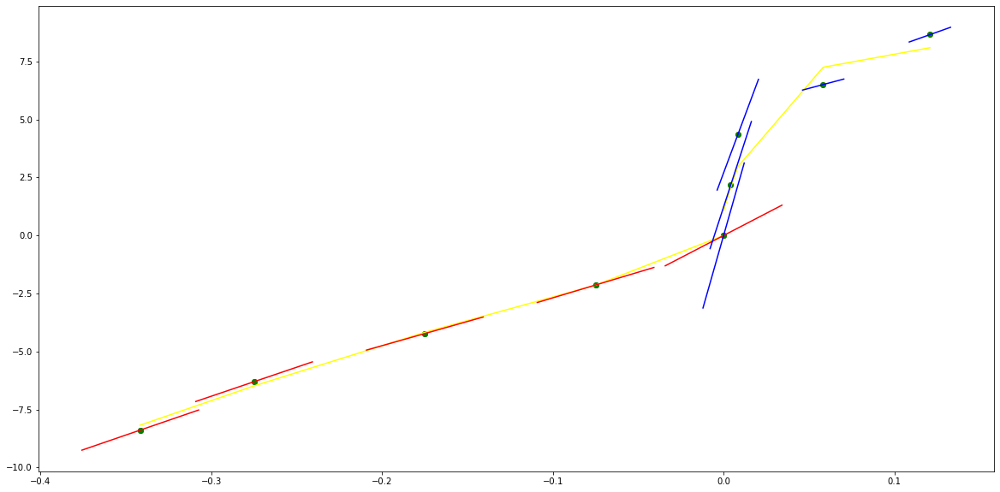

parameters (-6.555210078707332, -17.856191317921542, -15.29964044432357, -5.1466156639117, 7.599745620801664, 0.0025952443794824798)
tangent[0]:9.574826887610733
tangent[1]:8.484320119157381
tangent[2]:8.107691464688301
tangent[3]:8.341391474591346
tangent[4]:7.599745620801664
parameters (-100559636.35764991, 34581876.7526262, -3401924.9590140786, 134843.51114583446, -1769.6078060701002, -7.710677764704737e-05)
tangent[0]:-1769.6078060701002
tangent[1]:482.58841375931206
tangent[2]:382.7202762896777
tangent[3]:292.09619149369064
tangent[4]:251.447323982924


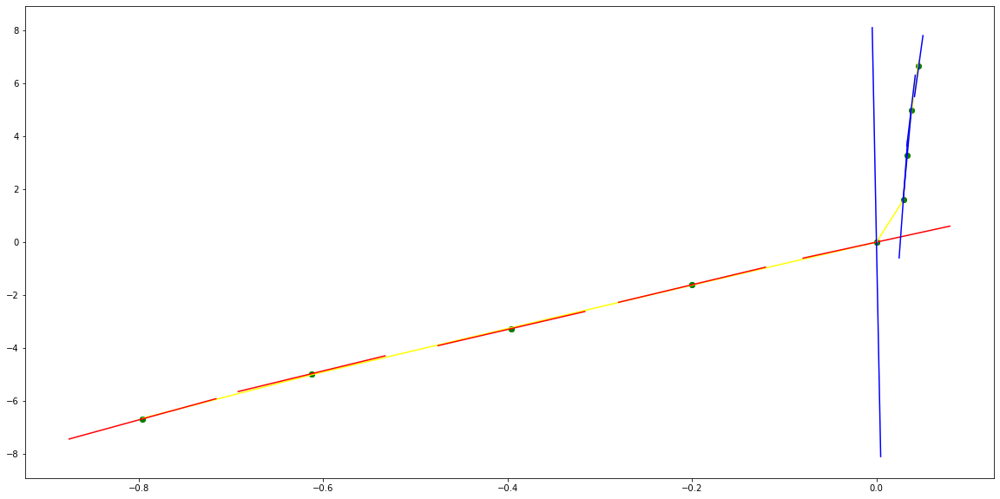

parameters (314.9114050709968, 848.3203345153427, 825.2956845241494, 345.75236604303177, 64.76096560954596, -0.889293867049987)
tangent[0]:9.199829021853475
tangent[1]:-0.23178262149892248
tangent[2]:44.33823947405196
tangent[3]:61.922211371678756
tangent[4]:64.76096560954596
parameters (-773904.8100096823, 572014.6878764891, -116346.24324034224, 5952.859346792218, 220.6964246851288, 0.2288479196917148)
tangent[0]:220.6964246851288
tangent[1]:264.41127127790156
tangent[2]:319.35500078305574
tangent[3]:332.46485910557226
tangent[4]:337.1999065961519


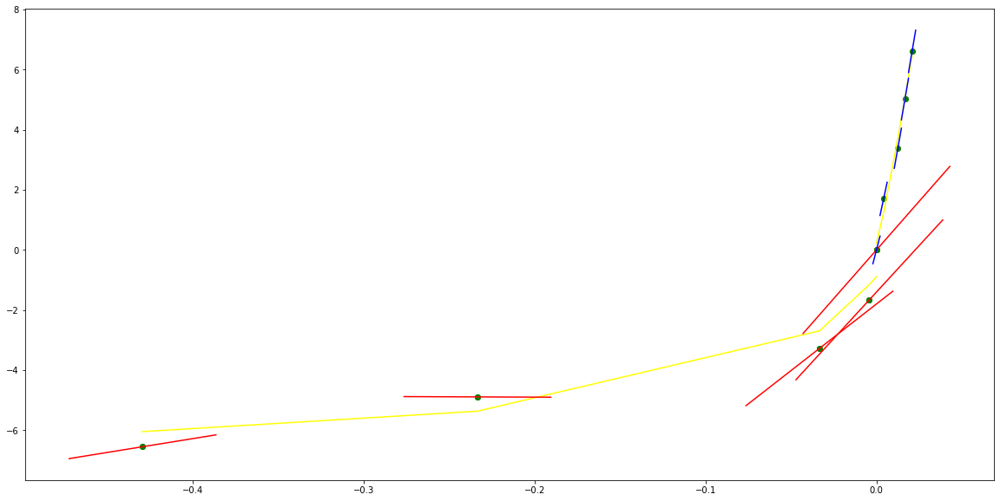

parameters (52899386.00957126, 16871682.08287325, 1838136.1488994171, 73632.91393984124, 640.448073234114, -0.0015401497180866695)
tangent[0]:267.86666191879294
tangent[1]:363.43260537591004
tangent[2]:447.46905847067455
tangent[3]:117.84441987913783
tangent[4]:640.448073234114
parameters (65056838.00174549, -16192645.843940768, 1373219.3535733845, -44983.47316641887, 560.4256459606712, -0.03664430030527368)
tangent[0]:560.4256459606712
tangent[1]:252.47824392845263
tangent[2]:207.56026581664617
tangent[3]:290.30854302967407
tangent[4]:297.9267467033295


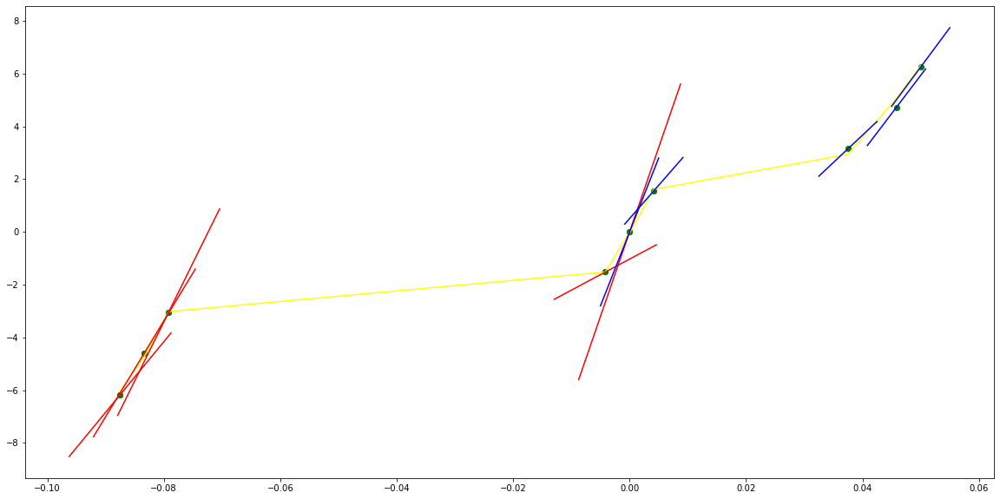

parameters (-197507.36325037427, -118324.49396140005, -22672.862126034972, -1258.5726104327973, 59.24355999545456, 0.06940060574718085)
tangent[0]:51.35018092362152
tangent[1]:83.88276236382222
tangent[2]:85.82591893451169
tangent[3]:86.67009833451797
tangent[4]:59.24355999545456
parameters (3114433.932089869, -2439072.2003921955, 406064.0131645185, -22964.925700250824, 445.0267613701211, -0.08201981065648548)
tangent[0]:445.0267613701211
tangent[1]:274.0883975685582
tangent[2]:141.31297374386986
tangent[3]:214.07130830831773
tangent[4]:228.43340981978724


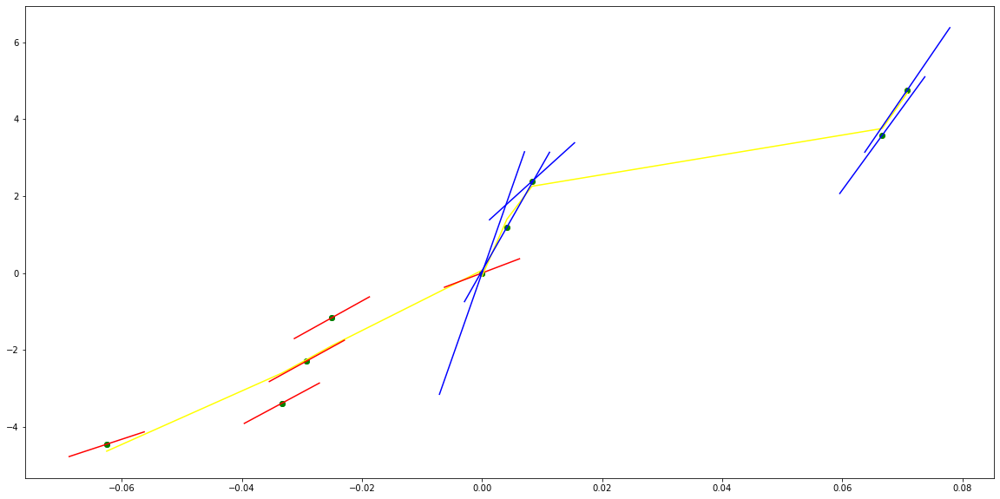

parameters (16.419732072714503, 68.19912610096308, 106.02247649207096, 72.22768217993094, 27.47474968317427, -0.08222756604664189)
tangent[0]:9.75936113646377
tangent[1]:6.90927767740023
tangent[2]:6.142411947187114
tangent[3]:17.899982868441718
tangent[4]:27.47474968317427
parameters (67887.9561647534, -76431.31339415518, 30240.57006046921, -5028.794736048896, 344.1346092247302, 0.5918766114483273)
tangent[0]:344.1346092247302
tangent[1]:303.7872145215953
tangent[2]:266.4490645073487
tangent[3]:144.75157786291473
tangent[4]:-24.72821765056733


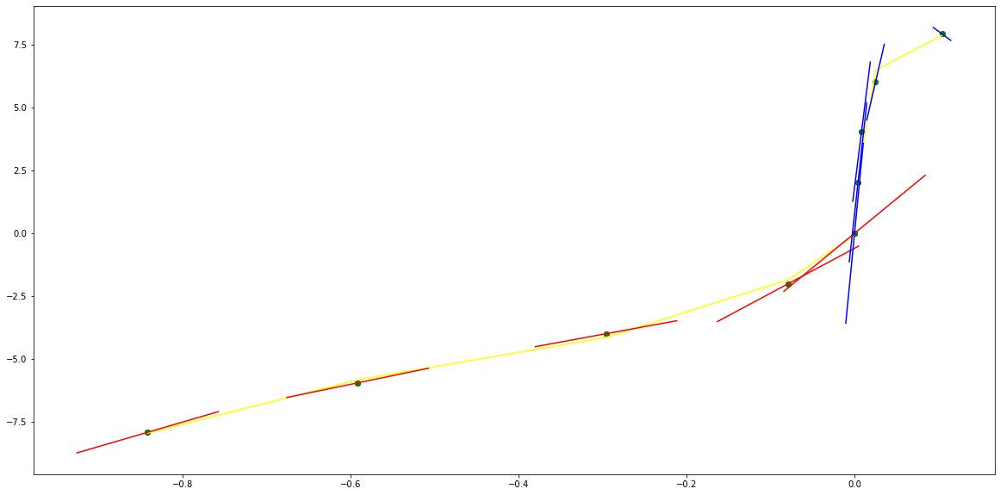

parameters (-0.07753661082567659, -0.8082056259762351, -2.468924033541558, -2.7434731251875624, 5.646124532933144, -0.0107879926763615)
tangent[0]:6.330658183375014
tangent[1]:6.663699699947749
tangent[2]:6.909134313108455
tangent[3]:6.73968040213448
tangent[4]:5.646124532933144
parameters (-17604.15112729818, 58306.722971863215, -68281.45693029229, 32696.635986029272, -5174.795545118163, -4.817178475148546e-06)
tangent[0]:-5174.795545118163
tangent[1]:1512.6630145398512
tangent[2]:-891.5062516110202
tangent[3]:384.0596160877458
tangent[4]:347.10345916340793


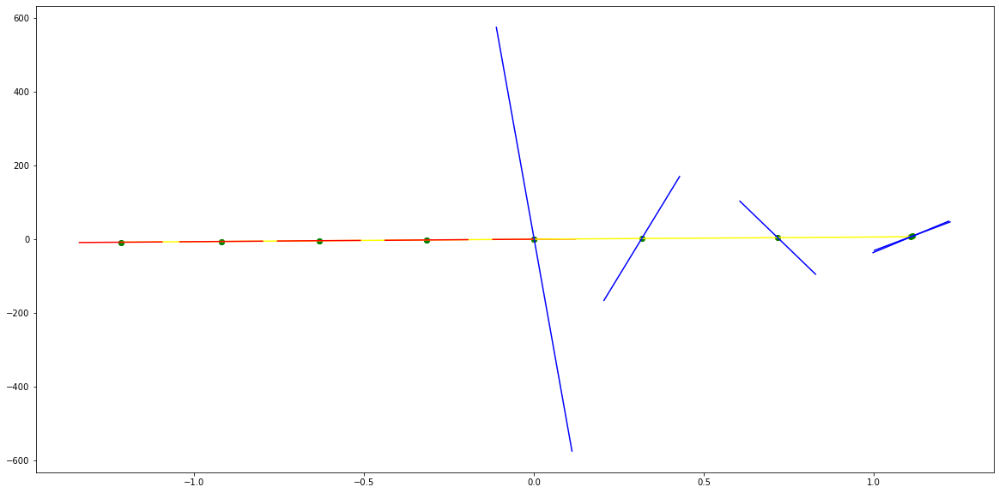

parameters (0.035075305498603576, 0.4532628296048705, 1.9303285739435285, 3.3043430657905297, 6.895101184867563, -0.011147797674172927)
tangent[0]:4.983209705655719
tangent[1]:4.649174479884398
tangent[2]:4.435959406738887
tangent[3]:5.151600307046327
tangent[4]:6.895101184867563
parameters (-1149.6099710127555, 3087.3451870066315, -2885.6415050021087, 1095.7869616525784, -131.39562017355158, -0.0009268030680685475)
tangent[0]:-131.39562017355158
tangent[1]:42.53466400531792
tangent[2]:-16.190990484542425
tangent[3]:53.22239427760795
tangent[4]:57.780379133205344


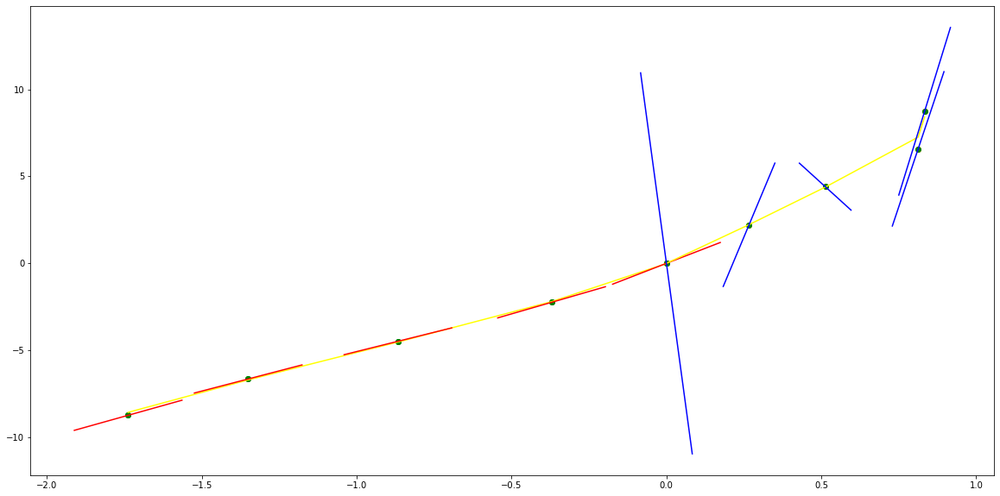

parameters (-0.6547453567279597, -4.80114233811932, -12.006111455345078, -10.621742165300903, 5.066052902090555, 0.003784906080438218)
tangent[0]:5.171336022144243
tangent[1]:7.4228330967085006
tangent[2]:8.762868711417056
tangent[3]:8.689454293897331
tangent[4]:5.066052902090555
parameters (306.57586017965644, -927.7332167765273, 995.5897638167501, -465.4037048129148, 101.08573012929871, 0.13181316521383313)
tangent[0]:101.08573012929871
tangent[1]:82.95725391087049
tangent[2]:61.55799676387521
tangent[3]:32.521086898753325
tangent[4]:3.655079998939584


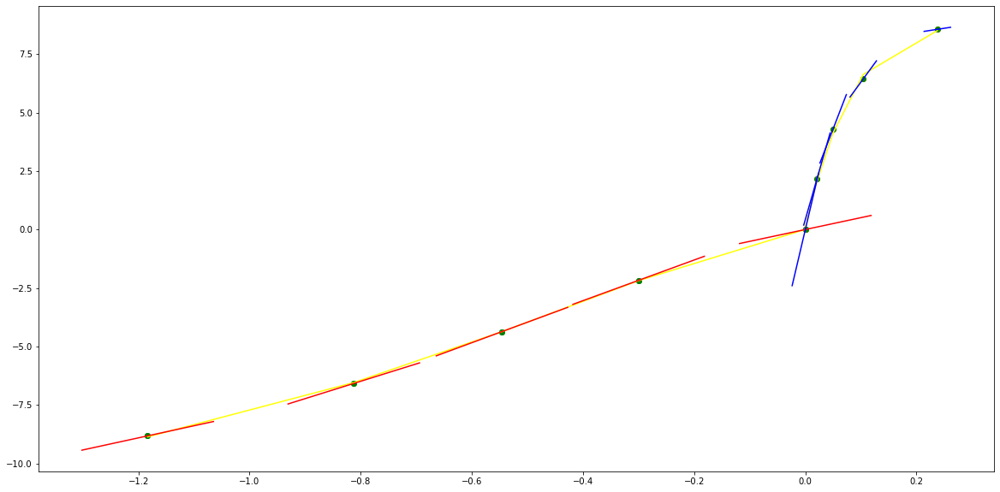

parameters (-0.021264499229824513, -0.24468047566128734, -0.9938428978715759, -1.6525166587767848, 2.2204681432478206, 0.0027844779487956393)
tangent[0]:3.0139665113540945
tangent[1]:3.0377746076757925
tangent[2]:3.3195354302523636
tangent[3]:3.388320500317855
tangent[4]:2.2204681432478206
parameters (-64.89060756627751, 457.61346256809935, -1133.2448261678708, 1135.0129857986929, -363.46728250827795, -2.7376972413045597e-05)
tangent[0]:-363.46728250827795
tangent[1]:125.86891063661761
tangent[2]:-69.15274164838951
tangent[3]:66.43994544820549
tangent[4]:66.14365033127257


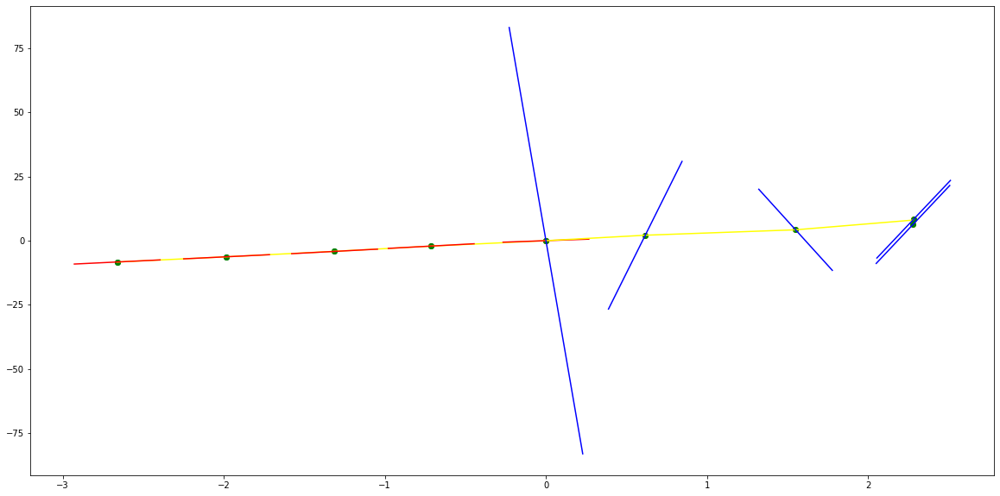

parameters (-0.004286417307989331, -0.07514839576504023, -0.49030817008744354, -1.440563211240194, 1.3470141066490229, 0.005373636443722463)
tangent[0]:3.153108043914915
tangent[1]:3.255780907458565
tangent[2]:3.2745307172474183
tangent[3]:2.982856774046408
tangent[4]:1.3470141066490229
parameters (-483.0491960489153, 2329.550613834594, -4099.673712282924, 3121.1007377667574, -857.5905039002979, -0.00011705063014261222)
tangent[0]:-857.5905039002979
tangent[1]:84.59977903900142
tangent[2]:82.20516254383426
tangent[3]:79.82527728421371
tangent[4]:44.396941680017676


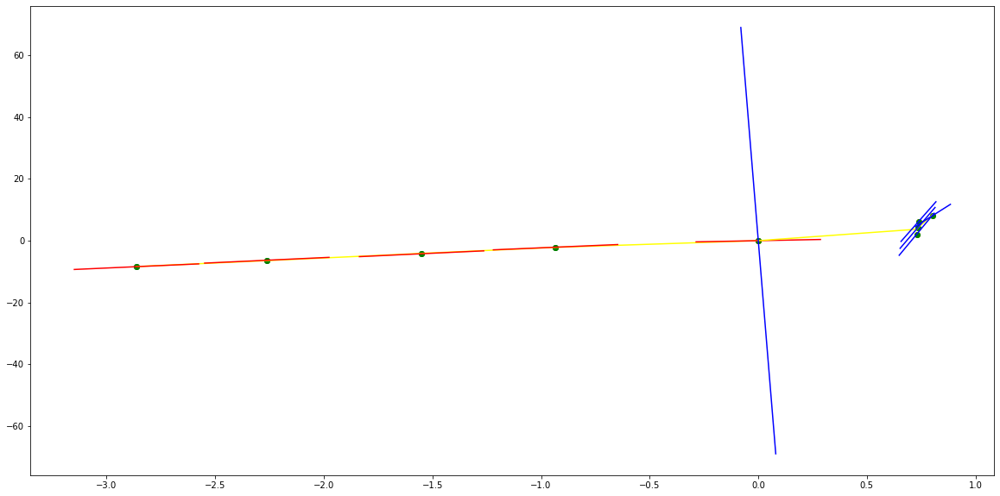

parameters (0.01476212350861079, 0.20302299137731256, 0.9634380493164293, 1.7151696280641935, 3.600530595516609, -0.007879732877047546)
tangent[0]:3.3748485947197646
tangent[1]:3.1732906201362634
tangent[2]:2.7184435249173666
tangent[3]:2.3420037539165275
tangent[4]:3.600530595516609
parameters (265.5889501174436, -875.1190369883058, 999.2049554816256, -474.8764123283888, 95.42668658927765, 1.565624737904719)
tangent[0]:95.42668658927765
tangent[1]:91.5208639430291
tangent[2]:87.71852825498584
tangent[3]:39.62206199072804
tangent[4]:-3.9672208263744864


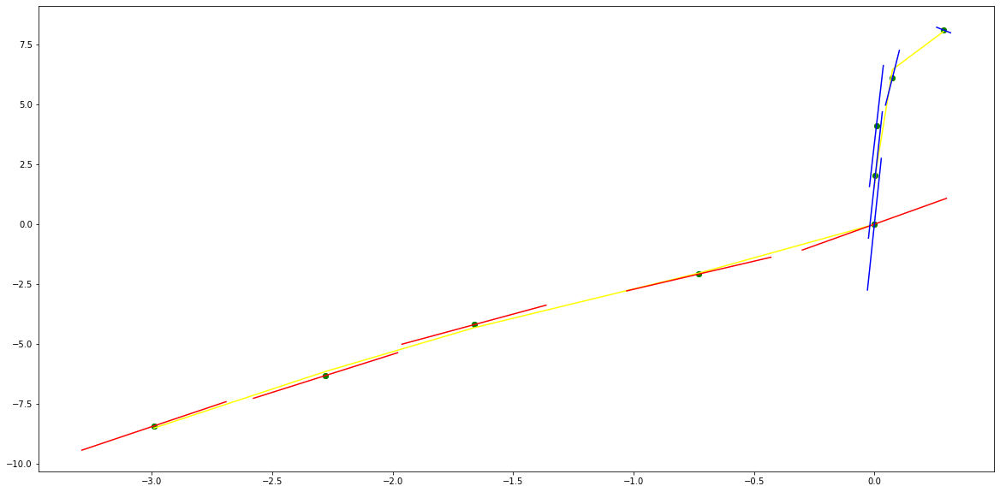

parameters (-9.275819658084708e-05, -0.002639847483943246, -0.031037020505860578, -0.15064250698084533, 1.4294075483882325, 0.0008175470105201803)
tangent[0]:1.710769971927389
tangent[1]:1.7456172655536433
tangent[2]:1.735365433937238
tangent[3]:1.6500741149005567
tangent[4]:1.4294075483882325
parameters (4.326782383915766, -39.6627262461136, 129.2005639966181, -173.31573131024496, 79.09263707888206, -1.9631788170186813e-05)
tangent[0]:79.09263707888206
tangent[1]:-20.380808891008513
tangent[2]:12.723373020647642
tangent[3]:-1.6880631719656947
tangent[4]:15.497991878512295


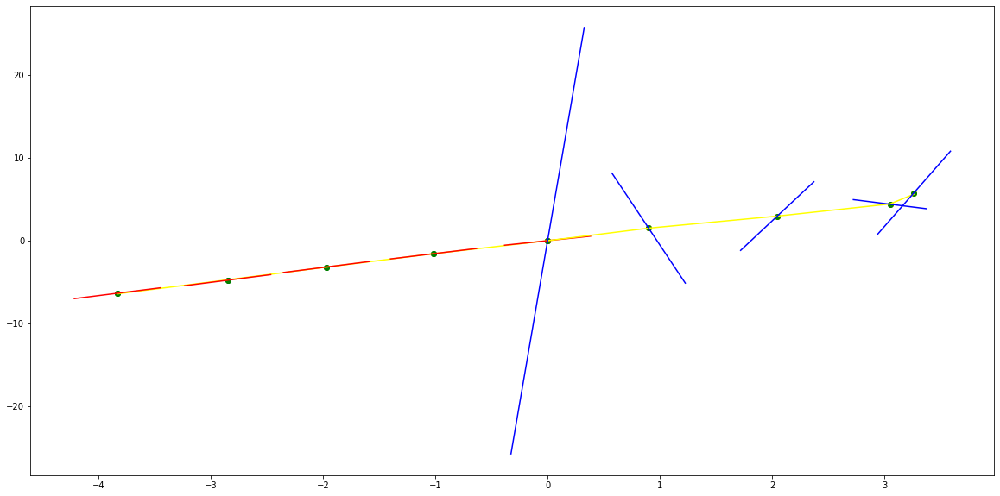

parameters (0.00035905579080541583, 0.008088091968022008, 0.0580490442155411, 0.14549273215889844, 1.745500864409746, -0.005163931235563219)
tangent[0]:1.7521909525237744
tangent[1]:1.701867509705881
tangent[2]:1.6239597624396331
tangent[3]:1.6022661303104786
tangent[4]:1.745500864409746
parameters (381.1080700192526, -3089.043553314458, 9184.991194020413, -11782.634658200845, 5433.136231700109, 3.2767734151108896e-07)
tangent[0]:5433.136231700109
tangent[1]:-694.7834655604838
tangent[2]:57.02502813733554
tangent[3]:-12.141462580215375
tangent[4]:71.66503536548225


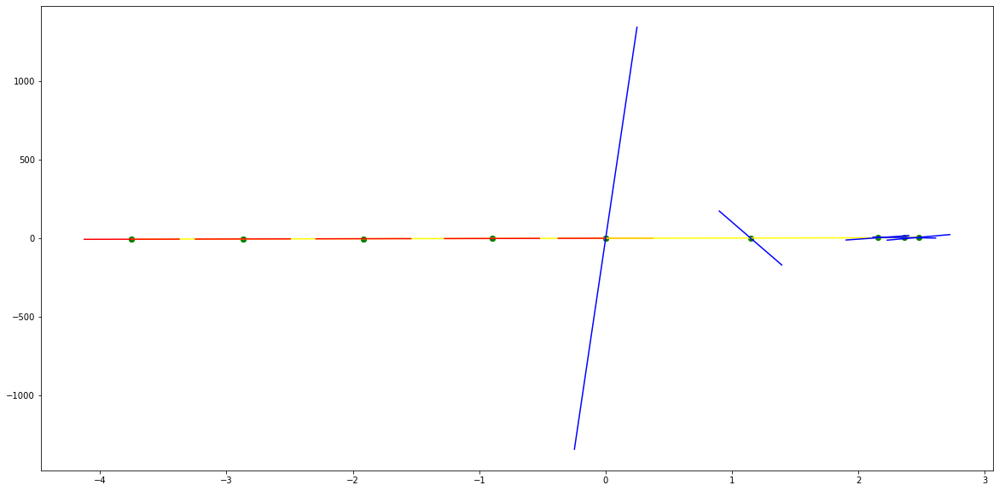

parameters (-0.00017866371901528456, -0.005260420973063086, -0.05406961257368164, -0.2612699119587763, 1.0732506443746515, 0.005397198980623108)
tangent[0]:1.6861510441435419
tangent[1]:1.6779857918188086
tangent[2]:1.627890222123822
tangent[3]:1.4891398994905707
tangent[4]:1.0732506443746515
parameters (-66629.62056251985, 328847.9938468068, -605778.6088424859, 493441.97462070634, -149887.93821061027, -4.926736100345718e-08)
tangent[0]:-149887.93821061027
tangent[1]:1763.7833409504092
tangent[2]:-315.48445433724555
tangent[3]:200.93356848091935
tangent[4]:191.7225822620385


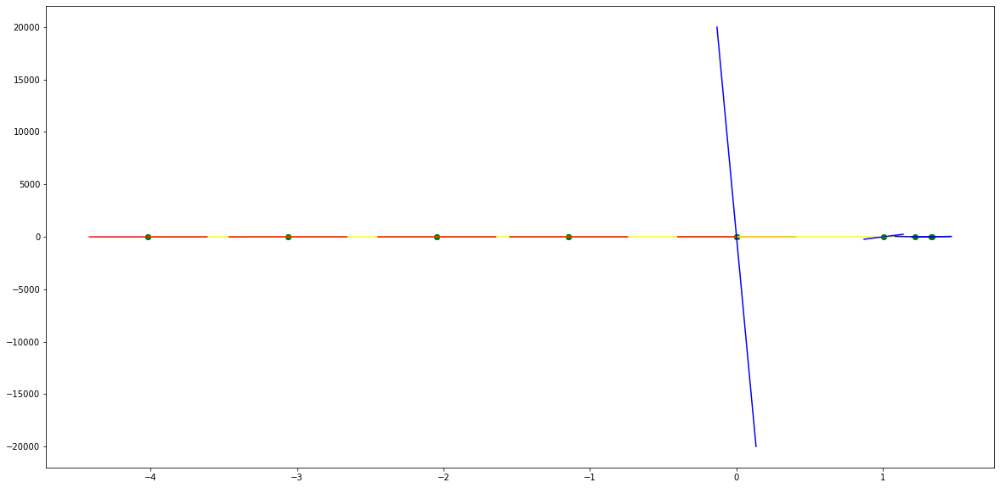

parameters (-66629.62056662992, -126454.52438770897, -52569.6573737831, -5767.95974897441, -35.90035848983928, -0.5784805248112339)
tangent[0]:200.93356848867603
tangent[1]:191.72258226817354
tangent[2]:178.71223764514127
tangent[3]:9.467875159268402
tangent[4]:-35.90035848983928
parameters (17274080.34619537, -6011405.402836701, 718569.2808907583, -32772.92595533713, 451.88588058197934, -0.01752135528807494)
tangent[0]:451.88588058197934
tangent[1]:214.52280929208996
tangent[2]:253.57246106443404
tangent[3]:235.4334684968337
tangent[4]:209.87632994365345


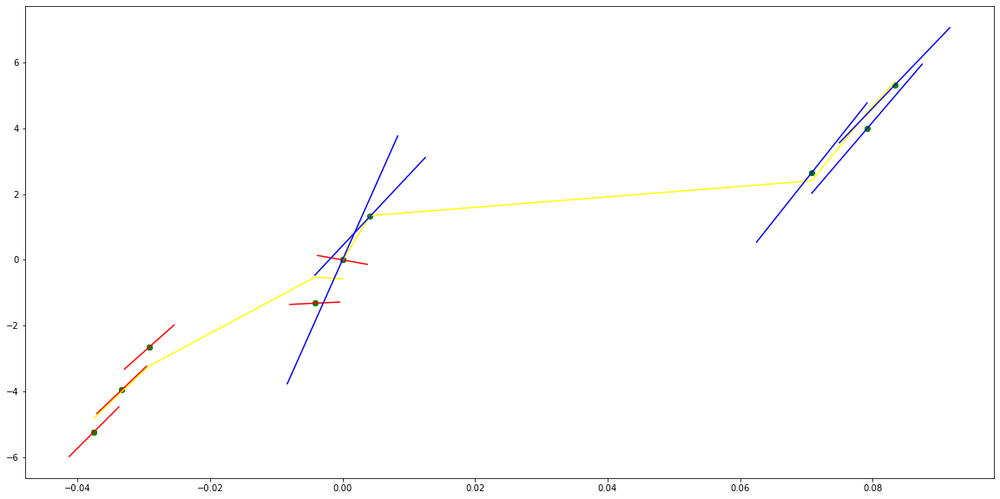

parameters (0.03189987817355341, 0.44057651782122664, 2.118405244837641, 4.0730719109399205, 3.305136562539003, 0.0028775491388324634)
tangent[0]:0.1531776880907696
tangent[1]:1.1472766233589393
tangent[2]:1.3322305821058134
tangent[3]:0.3360443540358595
tangent[4]:3.305136562539003
parameters (618.3110023924866, -2963.610728408607, 5189.025415054607, -3920.830758678312, 1076.8097174473874, 6.4447609368699e-06)
tangent[0]:1076.8097174473874
tangent[1]:-76.92057833937406
tangent[2]:39.477359372481715
tangent[3]:39.09279890188509
tangent[4]:38.66500065289574


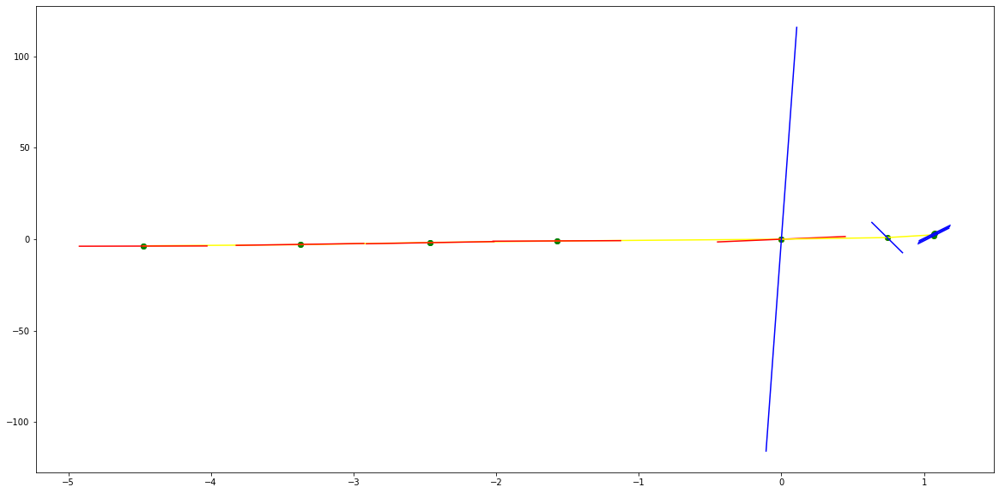

parameters (0.007227585370422449, 0.1299519689186355, 0.8394932913446697, 2.30980657857257, 3.3134074927078685, -0.003963618764754157)
tangent[0]:1.1351302230915379
tangent[1]:0.8622870623550258
tangent[2]:0.6672188130773464
tangent[3]:2.0606068014612218
tangent[4]:3.3134074927078685
parameters (135.0909754093318, -483.42405547550584, 581.5435870325575, -277.10628628282336, 50.73309839856952, 0.5816989869014205)
tangent[0]:50.73309839856952
tangent[1]:48.45384847400345
tangent[2]:46.23434907102279
tangent[3]:25.530417650340432
tangent[4]:-6.298626763559618


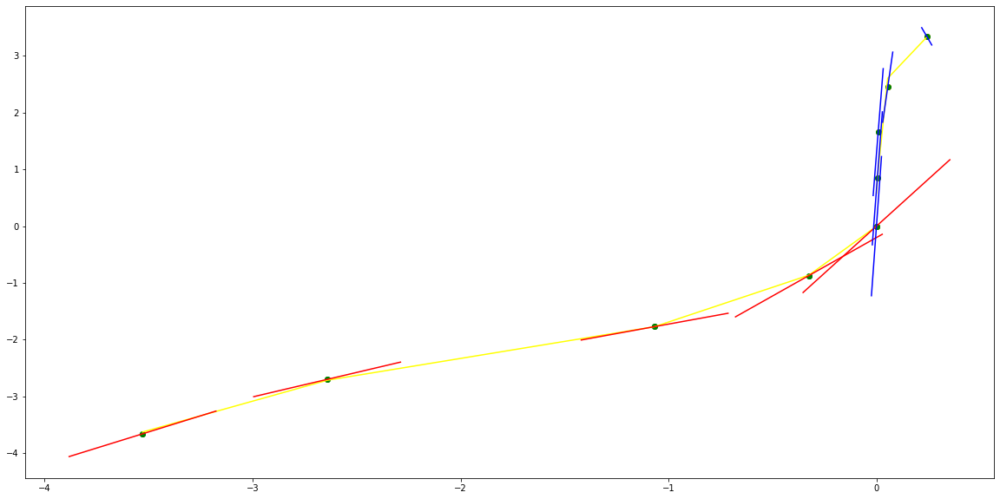

parameters (0.005205128091071059, 0.054006507364009054, 0.1862546055141067, 0.17170301771068427, 1.4425781642036253, 0.0025672516464203383)
tangent[0]:1.7155125703786258
tangent[1]:1.7153958273103065
tangent[2]:1.6162593228051874
tangent[3]:1.4353084531855482
tangent[4]:1.4425781642036253
parameters (-756.648561440143, 6746.262596576269, -21544.319917375495, 28662.918808224767, -12952.591141093775, -4.918504293995934e-09)
tangent[0]:-12952.591141093775
tangent[1]:3230.541081464924
tangent[2]:-1312.0834004363187
tangent[3]:236.2542483639354
tangent[4]:210.30521998133372


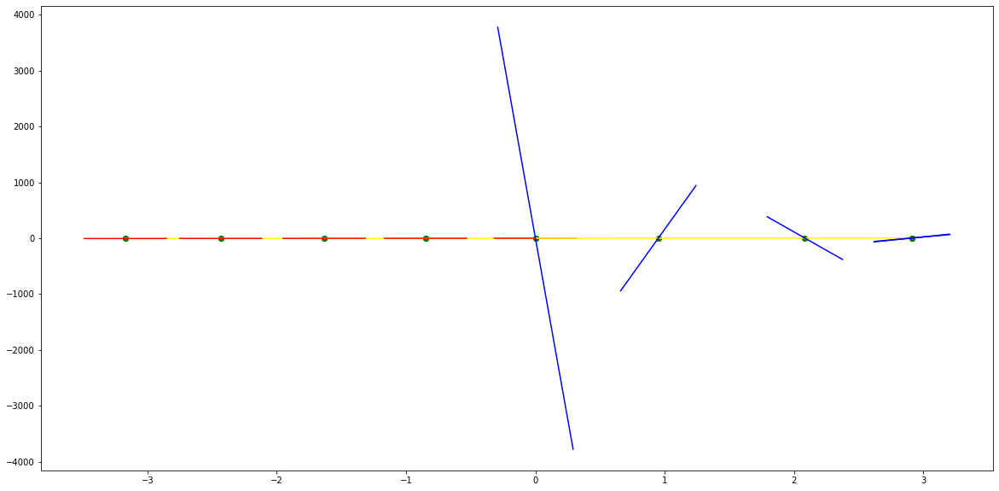

parameters (0.0010335269302895027, 0.01222845774644215, 0.042651391257599966, -0.043749269572487925, 1.1416143223733026, -0.0002388252986006599)
tangent[0]:1.6850882381525585
tangent[1]:1.6084375821093337
tangent[2]:1.4826655150661638
tangent[3]:1.3024881512708788
tangent[4]:1.1416143223733026
parameters (205740.8101689654, -1450531.1008106999, 3780762.0805511586, -4299899.403397836, 1789154.3686714864, -1.1853801143688946e-08)
tangent[0]:1789154.3686714864
tangent[1]:-137767.81417162973
tangent[2]:314.8436016498599
tangent[3]:219.39699721545912
tangent[4]:157.05527263344266


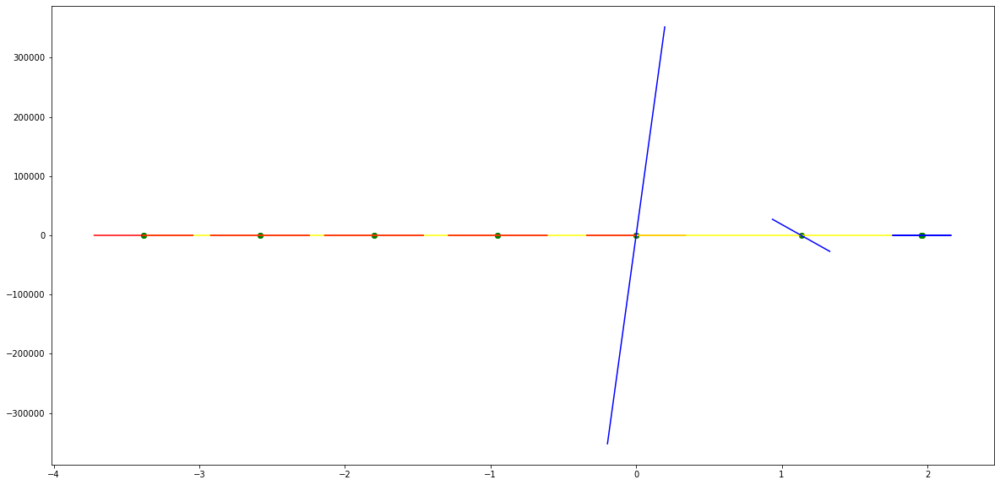

parameters (0.00017107083347472278, 0.003194169279401525, 0.015142573105861501, -0.0766884319241232, 0.8962147611587129, -0.0001568900810410671)
tangent[0]:1.6010393512426566
tangent[1]:1.4778484865976056
tangent[2]:1.3135022748402094
tangent[3]:1.1112035016096269
tangent[4]:0.8962147611587129
parameters (-22940739.291303545, 77228644.24980792, -97489974.22271328, 54694003.536229685, -11506221.959867775, -3.42443144151014e-08)
tangent[0]:-11506221.959867775
tangent[1]:372.34462951123714
tangent[2]:205.69775462150574
tangent[3]:135.83668558299541
tangent[4]:159.94119633734226


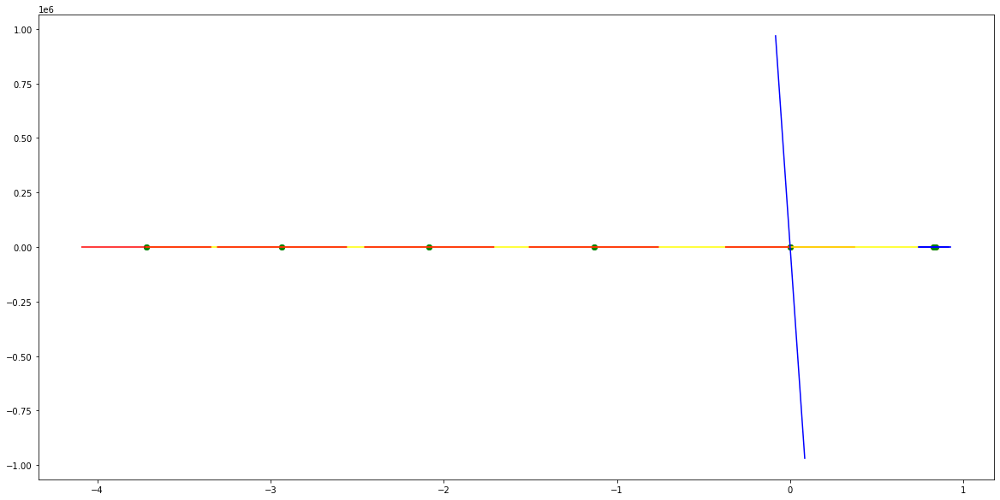

parameters (0.0022145047237526055, 0.039412397796646174, 0.25612616777421066, 0.6482641046025966, 1.6798437125641055, -0.00032979804611052953)
tangent[0]:1.5005219379933754
tangent[1]:1.3223845265614385
tangent[2]:1.0664436580607928
tangent[3]:1.0497922009592542
tangent[4]:1.6798437125641055
parameters (811471187.9774308, -80268762.46401769, 2825916.094391904, -42889.736755034326, 420.5566652526412, -0.03707413333200218)
tangent[0]:420.5566652526412
tangent[1]:188.34278306730806
tangent[2]:128.22030372575432
tangent[3]:172.43495164521994
tangent[4]:174.14961638708326


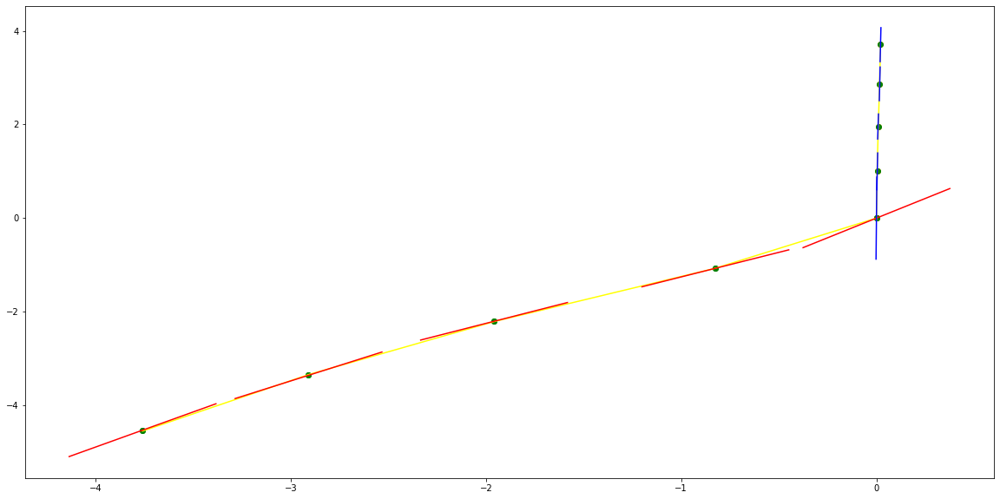

parameters (0.008679362204669371, 0.1067341238373221, 0.37536931702394694, 0.7386700134412602, 2.816321139087121, -0.00011692682370079212)
tangent[0]:1.9679627429232582
tangent[1]:2.0760386780001014
tangent[2]:2.205871237924441
tangent[3]:2.4337211569374837
tangent[4]:2.816321139087121
parameters (-3103981.8605931415, 5339587.346939394, -3421694.038999673, 967383.7554104201, -101711.95182681805, 1.4742136196669403e-07)
tangent[0]:-101711.95182681805
tangent[1]:2091.9719387296354
tangent[2]:-91.72480331396218
tangent[3]:175.06283991469536
tangent[4]:242.17982803157065


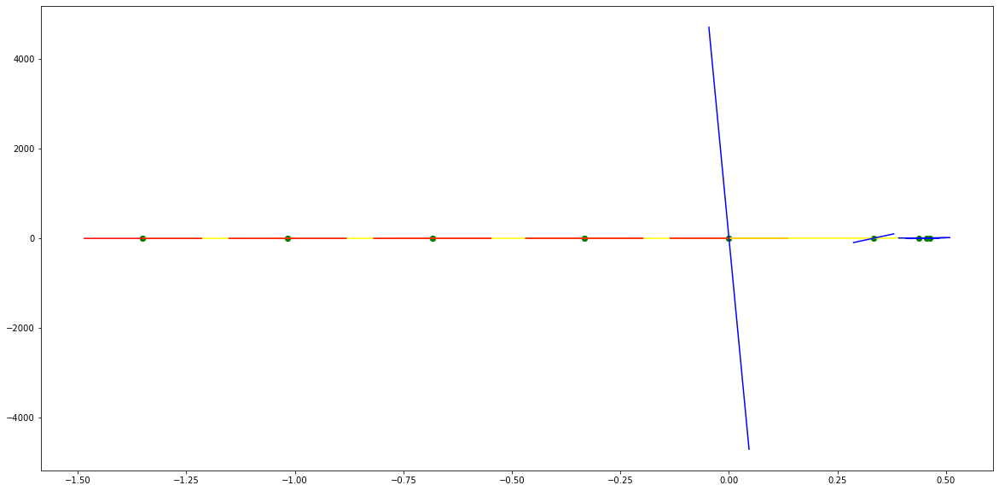

parameters (272099187.62742674, 49871276.00003326, 3104470.61737889, 76953.7048439013, 860.3316506742586, 0.16127847458915767)
tangent[0]:369.6062848569319
tangent[1]:329.17946895315947
tangent[2]:35.3055205874972
tangent[3]:366.7792044836906
tangent[4]:860.3316506742586
parameters (-5740632.506938719, 930564.42856119, 45954.77985267129, -11999.915119597526, 483.07186514772343, 0.05741781357218093)
tangent[0]:483.07186514772343
tangent[1]:385.7191046617912
tangent[2]:-86.37134947823438
tangent[3]:210.34943328520285
tangent[4]:304.32621681824935


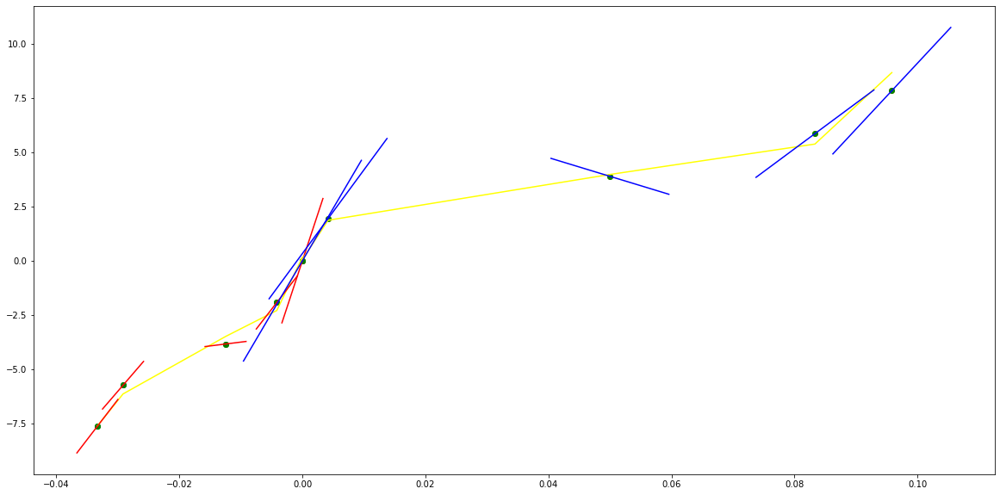

parameters (111205.43336396123, 87256.0005215244, 25017.56738494325, 3173.099881052296, 219.78636137850478, -0.7883830013272848)
tangent[0]:56.31243498073533
tangent[1]:36.96874131832689
tangent[2]:79.39870690507144
tangent[3]:194.61986765868755
tangent[4]:219.78636137850478
parameters (72686640.13876267, -21385109.931775022, 1948331.2665605478, -59635.12094286744, 835.6672579883627, 0.0378941183295478)
tangent[0]:835.6672579883627
tangent[1]:434.0802540339402
tangent[2]:182.73748563886988
tangent[3]:469.85583100693543
tangent[4]:634.9355787270481


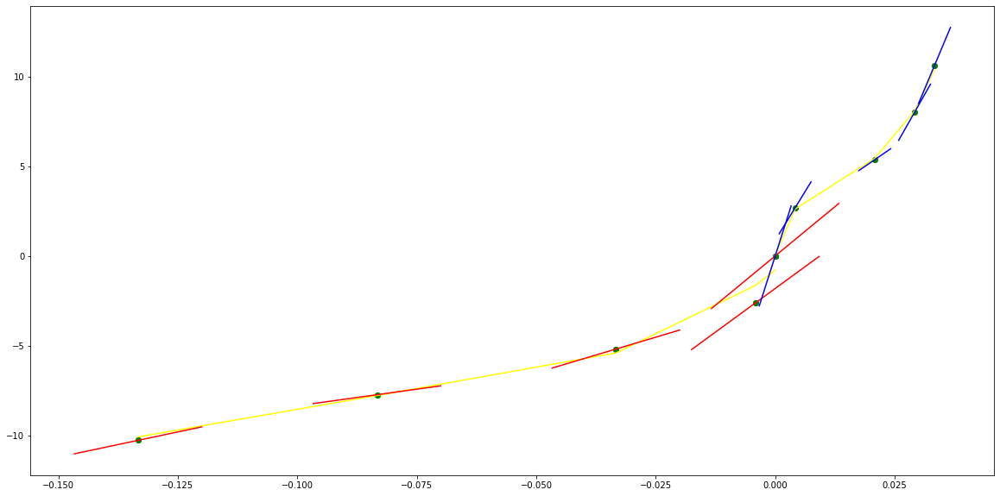

parameters (-27612893.844385825, -8728438.937122978, -833058.848172283, -22272.507491461554, 289.0939083828726, -0.3736336057758775)
tangent[0]:422.0995314718537
tangent[1]:488.27567904085305
tangent[2]:520.2304752043135
tangent[3]:433.8021307883811
tangent[4]:289.0939083828726
parameters (2962473790.3360553, -267141684.1773202, 8352151.7953210585, -104491.76206431574, 909.6744448083336, 0.05934628094511671)
tangent[0]:909.6744448083336
tangent[1]:401.06711379226954
tangent[2]:487.03724098125394
tangent[3]:582.6070367462899
tangent[4]:559.1686274231743


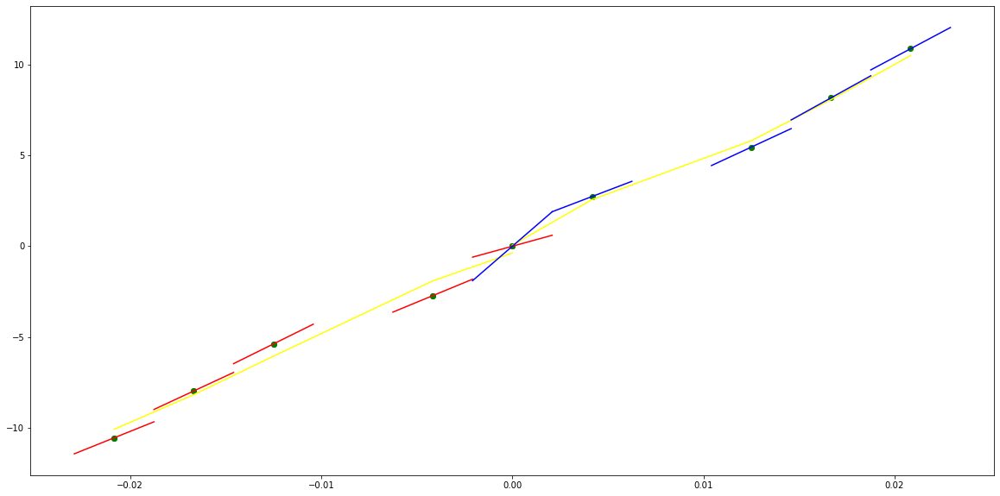

parameters (2955790371.2339025, 267780730.4507476, 8423051.20992839, 106292.21365878028, 922.528823681516, -0.059150655797623145)
tangent[0]:559.9121254408839
tangent[1]:580.105981051535
tangent[2]:482.30603452048956
tangent[3]:402.4682927152438
tangent[4]:922.528823681516
parameters (-83265289.25712581, 18024872.565506462, -1269996.559229735, 28400.591900550928, 298.5594311241555, 0.3509616583848802)
tangent[0]:298.5594311241555
tangent[1]:474.1849838966199
tangent[2]:543.9184385369894
tangent[3]:488.57940212323547
tangent[4]:401.77431517781565


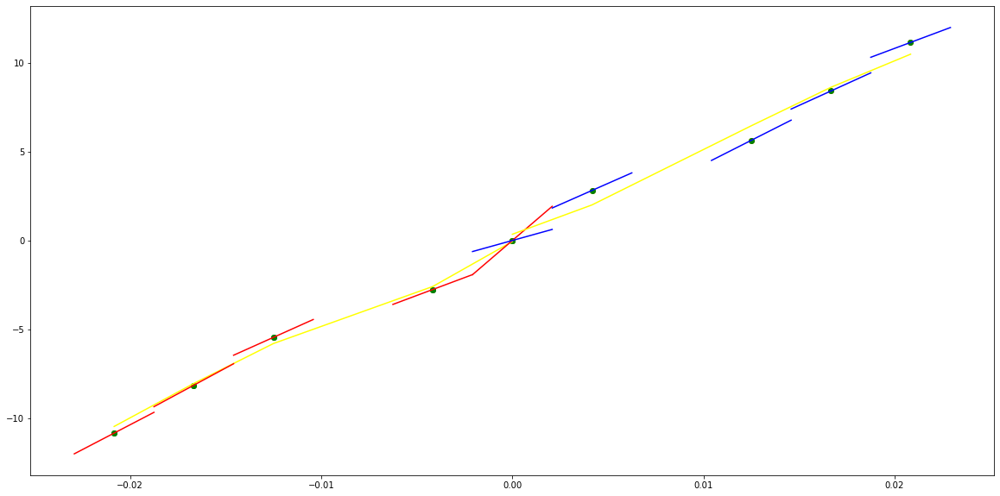

parameters (2659.7649904858604, 4252.591361244972, 2507.9117951087987, 659.3749618635129, 94.48654512824149, -0.9692220752050361)
tangent[0]:23.626973944395303
tangent[1]:15.802085238236828
tangent[2]:37.50426895774605
tangent[3]:89.12198565797142
tangent[4]:94.48654512824149
parameters (31767591.857511275, -10730731.110855237, 1112634.4872805316, -35470.020918516086, 505.38736481099573, 0.3529702190681479)
tangent[0]:505.38736481099573
tangent[1]:264.681383894213
tangent[2]:325.79653594970097
tangent[3]:455.8805929034634
tangent[4]:589.6572145399323


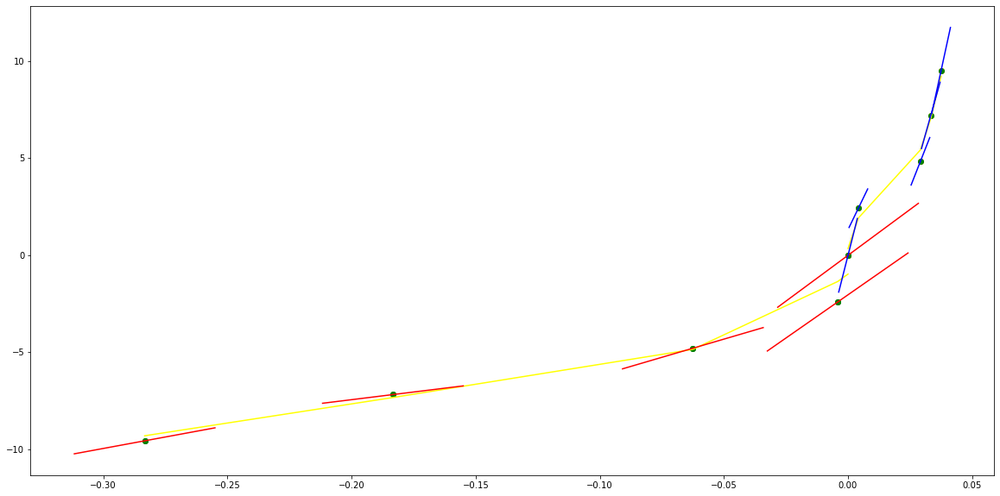

parameters (51.20753007736102, 306.69649480192476, 644.2512489696534, 551.8703674707671, 156.46431446682809, -0.00013978629903483442)
tangent[0]:17.11136628645599
tangent[1]:17.875907716087653
tangent[2]:18.246867387841206
tangent[3]:-46.61255335602854
tangent[4]:156.46431446682809
parameters (1.4339680945520004, -7.923839845101341, 15.056075929135462, -11.011515002238468, 5.363745834616536, 0.017152042495507943)
tangent[0]:5.363745834616536
tangent[1]:2.27925220125488
tangent[2]:3.150704060150632
tangent[3]:3.79101666043117
tangent[4]:4.0906268785801725


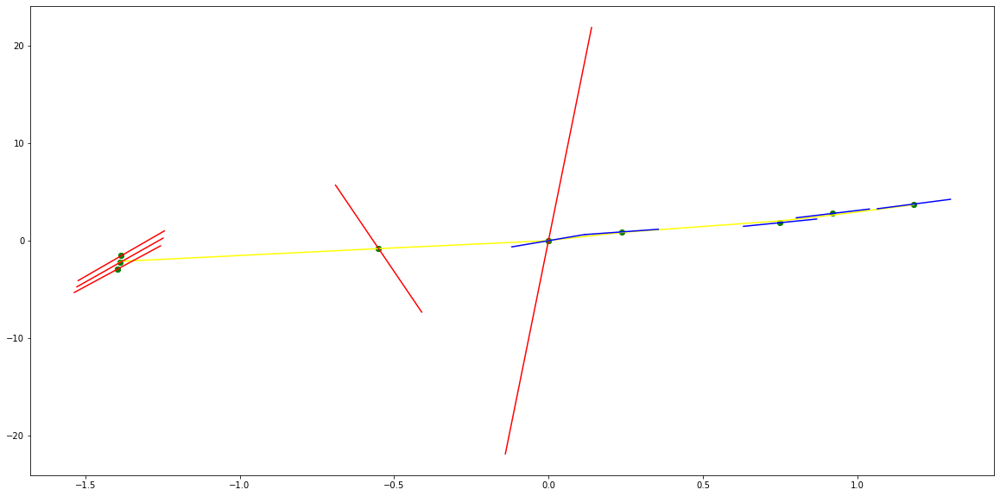

parameters (-0.09094342534546593, -0.8326351376369586, -2.723213064932799, -3.9300076959272303, 0.8997628594819014, -0.005570061965077964)
tangent[0]:3.5251899973949303
tangent[1]:3.21844186595224
tangent[2]:3.3524318176057184
tangent[3]:3.4227698771419863
tangent[4]:0.8997628594819014
parameters (-19.626286408668243, 110.44375281146324, -223.65018298929132, 191.9713824334411, -51.912800598872046, -0.007261781237345557)
tangent[0]:-51.912800598872046
tangent[1]:18.27578348402549
tangent[2]:17.978778147880355
tangent[3]:16.879671876040483
tangent[4]:2.5413602513118363


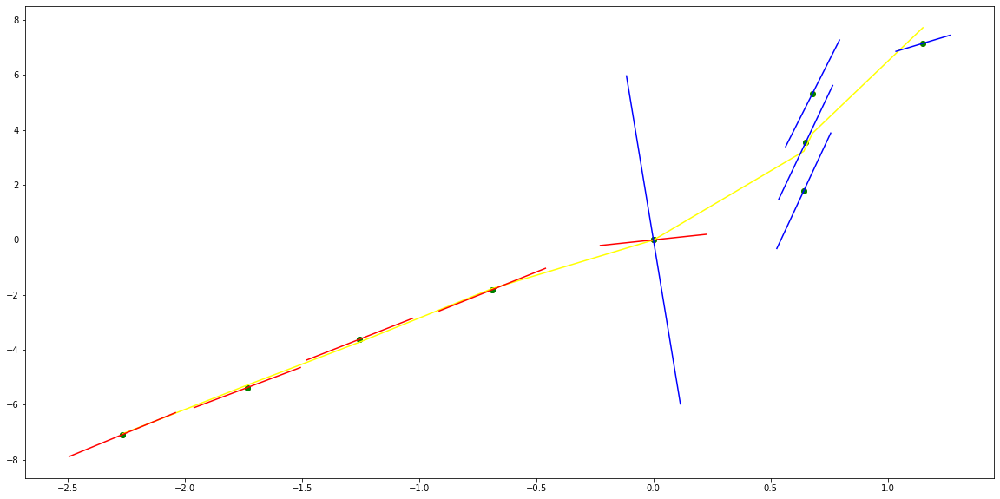

parameters (0.07439550578807194, 0.6976995023578565, 2.2882599946610584, 2.856962518721095, 3.8552607852617133, 0.0005701188571478506)
tangent[0]:3.454535482826428
tangent[1]:3.484734089904054
tangent[2]:2.9960048896754246
tangent[3]:2.3410420713068976
tangent[4]:3.8552607852617133
parameters (38.28377733712148, -182.72157514478852, 308.78073941609546, -218.9694518957532, 63.030810946240216, 0.8646056074494108)
tangent[0]:63.030810946240216
tangent[1]:59.44536824253518
tangent[2]:47.87260650453899
tangent[3]:-3.442704910452427
tangent[4]:7.341358293523193


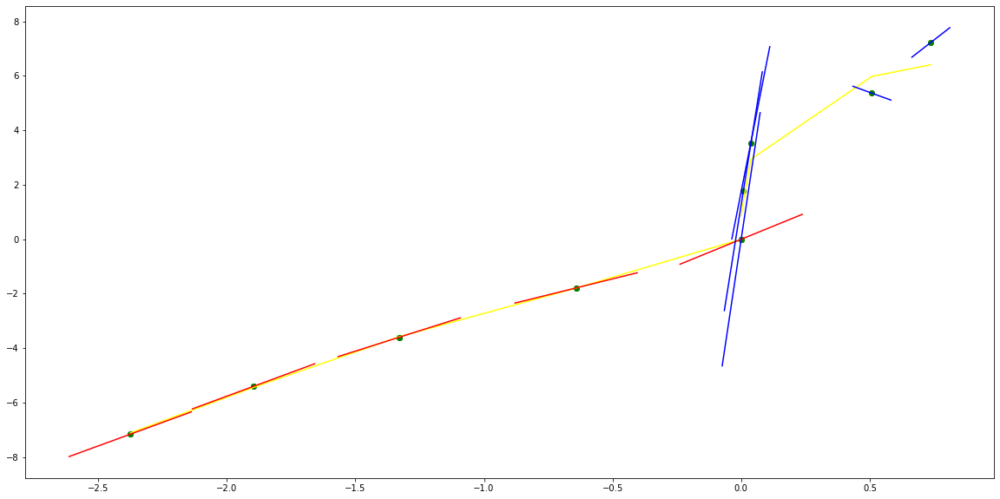

parameters (0.7442575960374739, 6.536698892641834, 19.758335134761698, 24.073782953884873, 14.867887867029982, -0.19490379868995053)
tangent[0]:6.534053795997256
tangent[1]:3.8598093023919056
tangent[2]:2.1018034134106074
tangent[3]:10.314804678209534
tangent[4]:14.867887867029982
parameters (160.99933656229103, -512.9434763639077, 580.5542364425944, -285.3070151492111, 65.50393397878067, 1.5455147209632802)
tangent[0]:65.50393397878067
tangent[1]:63.1568353458056
tangent[2]:60.86876304267296
tangent[3]:21.63007546494697
tangent[4]:2.539420243962141


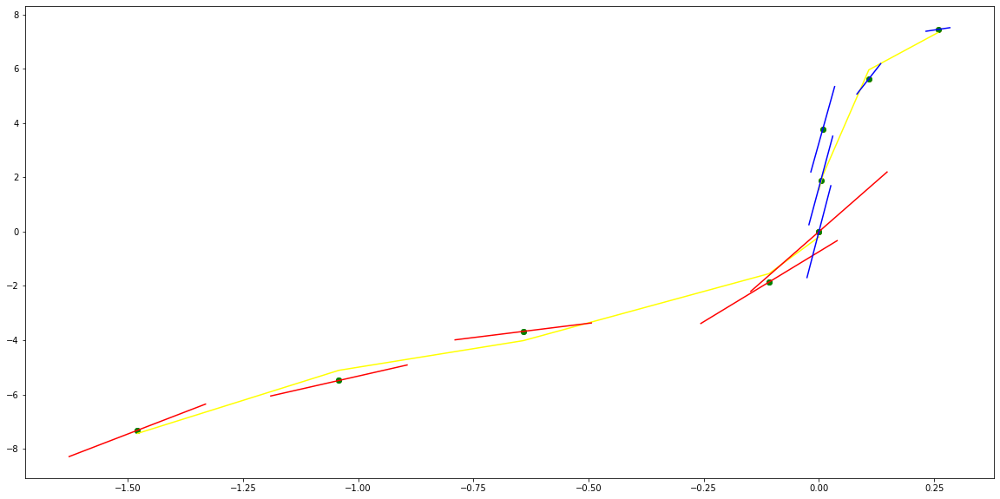

parameters (-0.06149710704190645, -0.6464749104605152, -2.3048057984857624, -3.2951755543868613, 0.9508105667545517, -0.00024886305865680445)
tangent[0]:2.6717193896337967
tangent[1]:2.2467645660620033
tangent[2]:2.680789589929687
tangent[3]:2.989128119270105
tangent[4]:0.9508105667545517
parameters (62.7778703601541, -426.81981830202113, 1042.5123229634798, -1065.8250563103336, 375.25323173011924, 6.019440866743079e-06)
tangent[0]:375.25323173011924
tangent[1]:-85.18669840095714
tangent[2]:35.197044797790966
tangent[3]:-6.378730983131447
tangent[4]:49.13588584381972


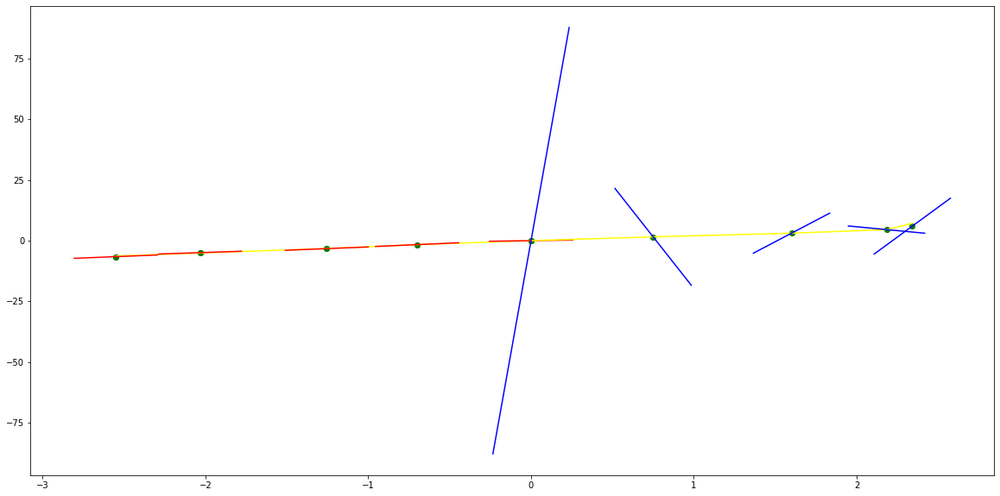

parameters (0.0002453630721384728, 0.00011911461683184122, -0.040415792783216435, -0.34937954156125206, 1.4866740484048961, -0.004252008176232207)
tangent[0]:2.5636708826488697
tangent[1]:2.48095556168019
tangent[2]:2.3003837760914614
tangent[3]:1.9933658384310329
tangent[4]:1.4866740484048961
parameters (1384400.7443736033, -4019702.6426244234, 4357465.517503667, -2088814.2278644543, 373322.8441194911, 5.2683560638617535e-09)
tangent[0]:373322.8441194911
tangent[1]:-5458.896517650632
tangent[2]:432.9766490199254
tangent[3]:333.828388922906
tangent[4]:241.5938038342283


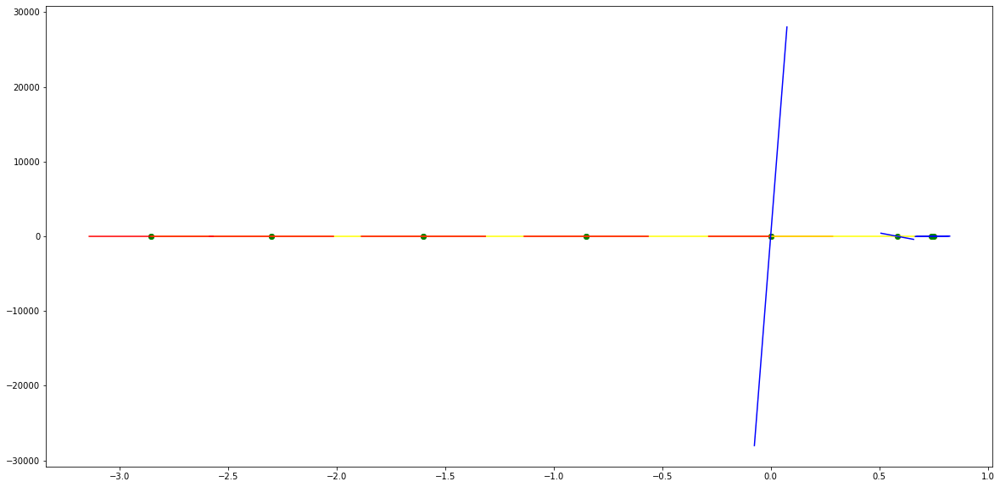

parameters (0.3247248258658869, 3.1910985534830556, 11.433636967009392, 17.882815851814755, 13.299827899365178, -0.772653722960479)
tangent[0]:2.2320367476089817
tangent[1]:0.9117824960581906
tangent[2]:8.340031097922578
tangent[3]:13.151387186183271
tangent[4]:13.299827899365178
parameters (119668677.26306827, -26639254.481021598, 2038854.8353476666, -59702.3828403438, 552.1824735675406, 0.007728064010036939)
tangent[0]:552.1824735675406
tangent[1]:153.3005977161298
tangent[2]:309.43230432922394
tangent[3]:293.37437860074317
tangent[4]:246.70572867128578


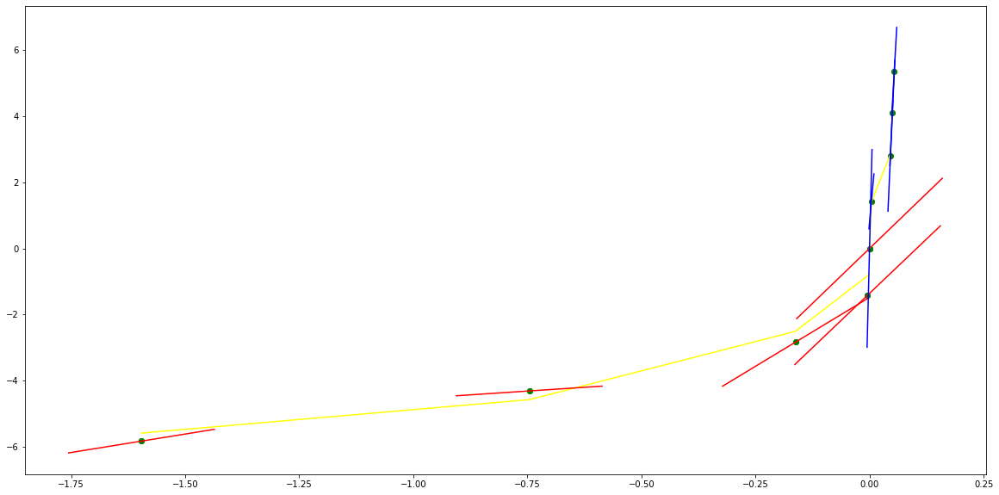

parameters (5.973476505285364, 30.264377997369206, 54.745098117628125, 40.82469588140767, 11.781834992637181, 0.0011205114486379794)
tangent[0]:2.5046531033900354
tangent[1]:1.9548036126760824
tangent[2]:3.279052102203403
tangent[3]:-1.1612641067238645
tangent[4]:11.781834992637181
parameters (275262.53862855927, -666933.7358106449, 601072.4046160621, -238528.44496489427, 35118.591877881714, 3.650291628232338e-08)
tangent[0]:35118.591877881714
tangent[1]:-955.7669190446468
tangent[2]:203.27168710406113
tangent[3]:182.03219626487407
tangent[4]:159.90051636465068


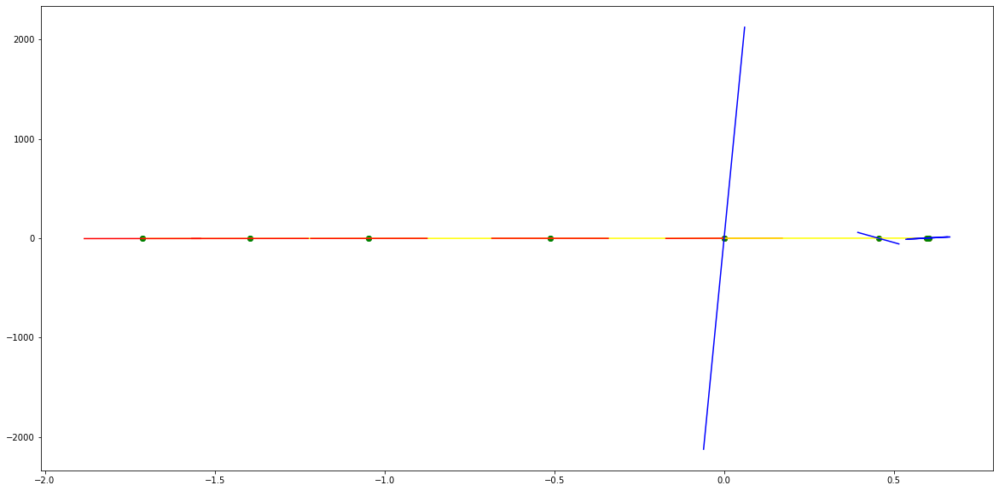

parameters (0.37896766331881704, 2.633061093447715, 6.992326979618046, 8.33771137127933, 5.683851931037433, -0.041845969002995795)
tangent[0]:2.0068324027321207
tangent[1]:1.4899294690305105
tangent[2]:1.2061943613662045
tangent[3]:3.71331118091507
tangent[4]:5.683851931037433
parameters (14432506.5267013, -5534210.897924002, 730879.3674949507, -36245.440862507334, 431.6710792519173, -0.13716893406780079)
tangent[0]:431.6710792519173
tangent[1]:166.09433854820816
tangent[2]:-32.60227013928517
tangent[3]:188.37360325361016
tangent[4]:147.5750950275754


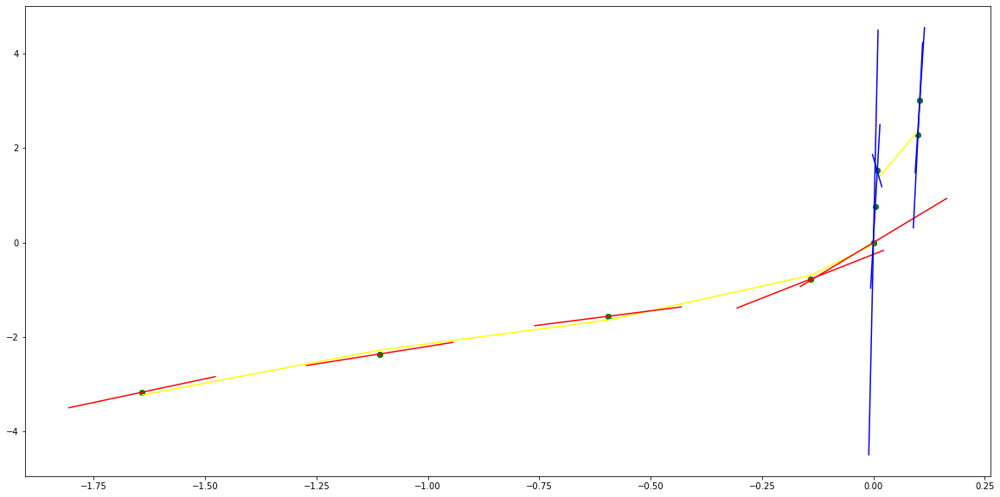

parameters (992070232.0647672, 143845140.04918623, 7335200.02550294, 147022.00129406672, 1063.629109708171, -0.007083756269089279)
tangent[0]:449.3080743760627
tangent[1]:526.3316686158184
tangent[2]:520.7933317186951
tangent[3]:180.4534707918781
tangent[4]:1063.629109708171
parameters (2514582451.3852773, -227776549.5984632, 7159155.370277685, -90209.71595027456, 793.3485034785622, 0.05157359644615991)
tangent[0]:793.3485034785622
tangent[1]:352.340474181515
tangent[2]:421.41125644898625
tangent[3]:504.37167100317265
tangent[4]:486.4566315134816


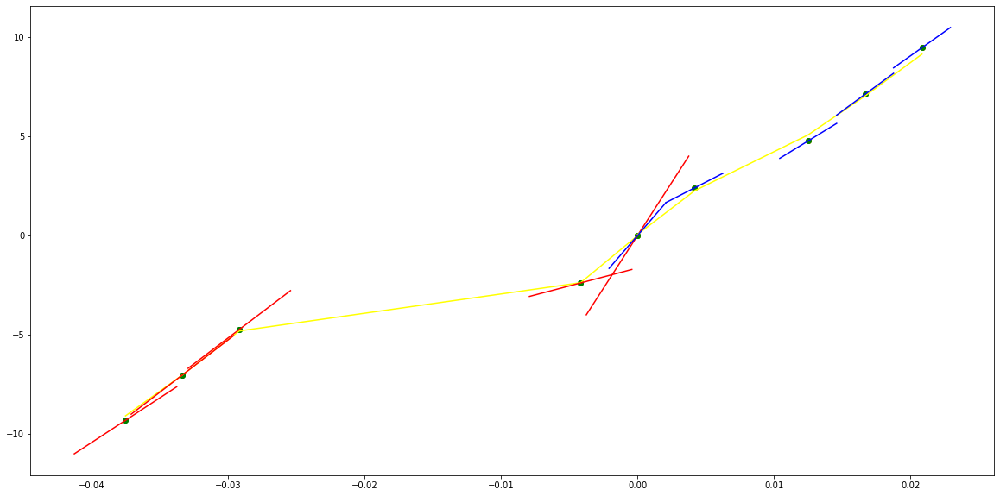

parameters (-87.56310801690796, -70.80541725050296, -5.159203388252579, 13.719073320738572, 28.545457957090257, -0.00016965279246439143)
tangent[0]:23.284766690013864
tangent[1]:24.00399271008535
tangent[2]:25.144836071142144
tangent[3]:26.722719377698116
tangent[4]:28.545457957090257
parameters (-7844000.340404341, 4175226.7591588898, -813371.8782991493, 68540.10403700909, -2013.0141004834563, 0.00132776763695848)
tangent[0]:-2013.0141004834563
tangent[1]:454.41692563709285
tangent[2]:347.1008484973577
tangent[3]:291.96122104158576
tangent[4]:238.57333049337694


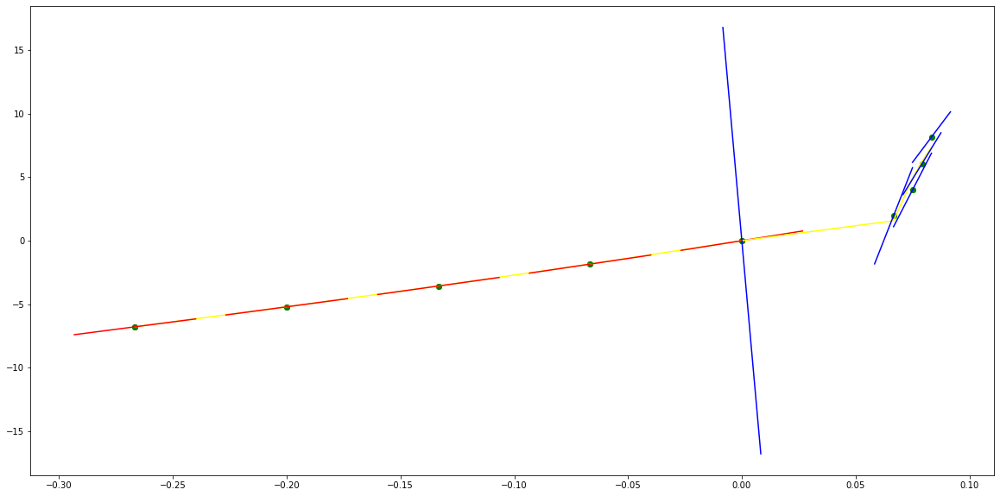

parameters (226888837.01465052, 43749183.50385779, 2868651.0977469883, 72881.94409653396, 784.8480094061039, -0.07432612998706684)
tangent[0]:435.88831564949726
tangent[1]:407.4056829595953
tangent[2]:333.4158913266616
tangent[3]:314.5627995709487
tangent[4]:784.8480094061039
parameters (490345759.19559366, -84345049.26629478, 4937320.088320554, -110360.53781592616, 932.3673318236011, 0.054507796548491444)
tangent[0]:932.3673318236011
tangent[1]:246.14379722641695
tangent[2]:498.3488826971667
tangent[3]:563.9928042025409
tangent[4]:541.5017533249498


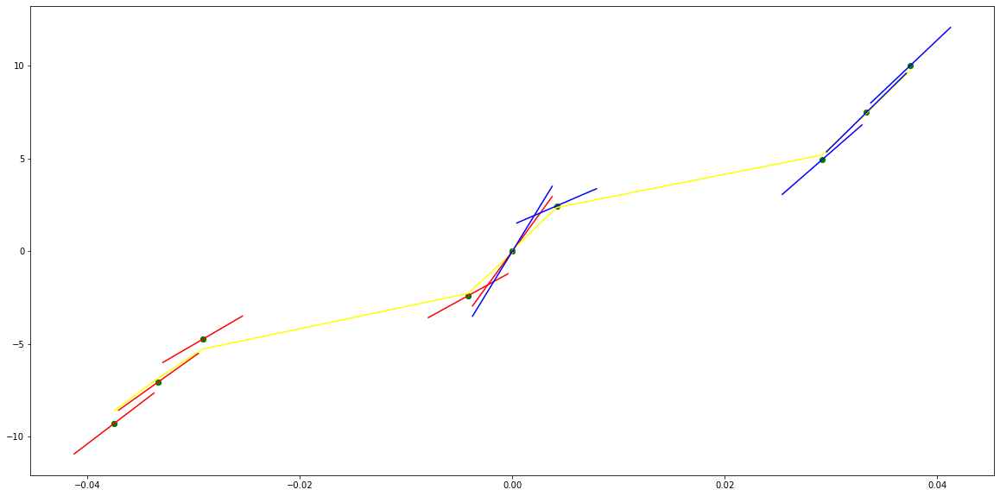

parameters (660693433.5874, 111469655.9128703, 6480090.8647987, 146712.69321599157, 1302.7675126382496, -0.05571767569689536)
tangent[0]:656.8036794689856
tangent[1]:686.5536995845582
tangent[2]:609.8203775204042
tangent[3]:386.35698058691355
tangent[4]:1302.7675126382496
parameters (782273108.1614323, -124588772.40751465, 6843118.821370695, -148466.68365280604, 1418.3189749881778, -0.10337634800540892)
tangent[0]:1418.3189749881778
tangent[1]:502.5877504676416
tangent[2]:373.07558867094144
tangent[3]:687.4113868070265
tangent[4]:702.189914020116


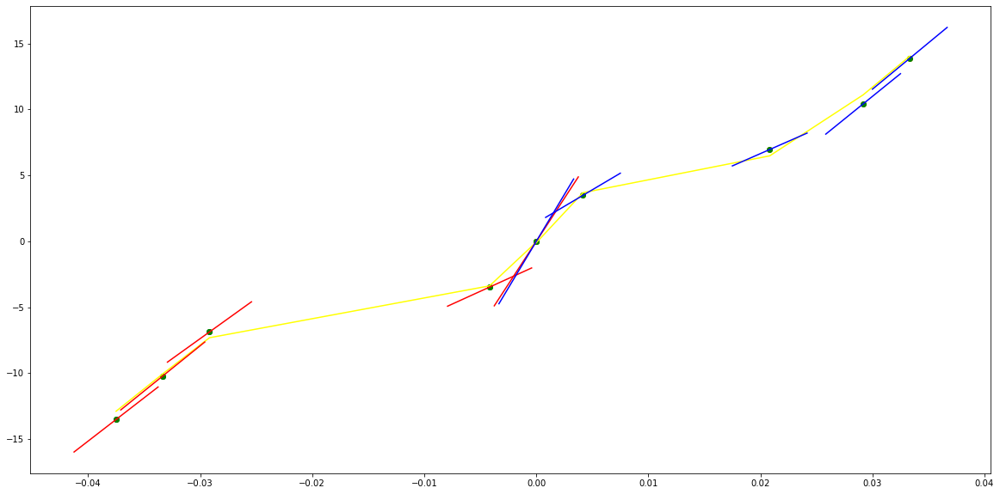

parameters (-209.11265265949208, -336.23870217137977, -169.3973361022932, -28.269858038578956, 19.404914769468185, 0.0060190302007905195)
tangent[0]:20.7764991991001
tangent[1]:18.646561948730046
tangent[2]:19.318861594082442
tangent[3]:21.131836360179257
tangent[4]:19.404914769468185
parameters (50221.444406586954, -50496.59728918804, 18376.74063040418, -2912.259990444465, 214.18166276406362, 1.2441384619656002)
tangent[0]:214.18166276406362
tangent[1]:190.85362397623018
tangent[2]:169.35350648966667
tangent[3]:12.755376910404294
tangent[4]:20.287556820747227


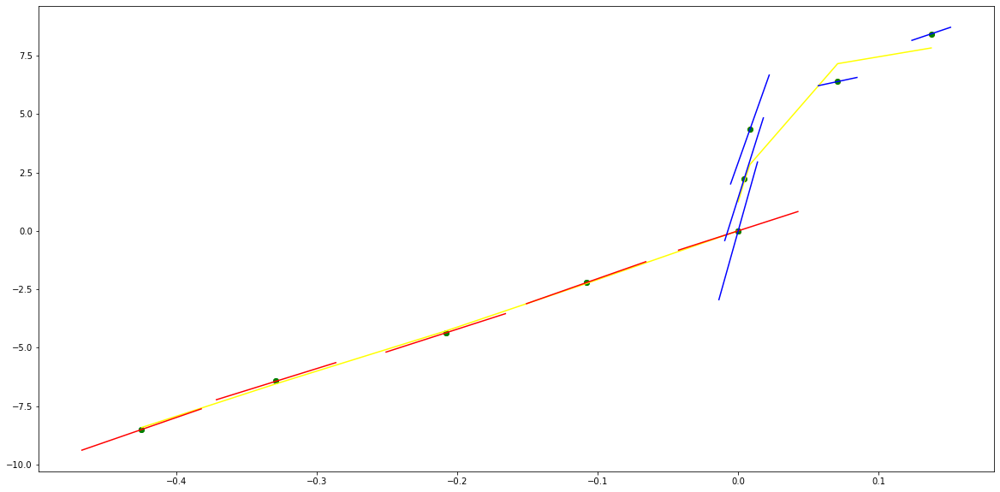

parameters (214.04491519235881, 455.86960694423175, 360.04668176949644, 128.4378942359638, 32.614580960676754, -0.6115030866093297)
tangent[0]:13.1849679865308
tangent[1]:11.561049656734596
tangent[2]:13.824129499423947
tangent[3]:30.547749522798373
tangent[4]:32.614580960676754
parameters (38639.956174235806, -40206.51665542049, 14862.695860826163, -2340.3888919703086, 163.63595354685427, 0.8394785369960718)
tangent[0]:163.63595354685427
tangent[1]:144.8981142979571
tangent[2]:127.6350516281044
tangent[3]:1.6500773633545407
tangent[4]:21.604675071192815


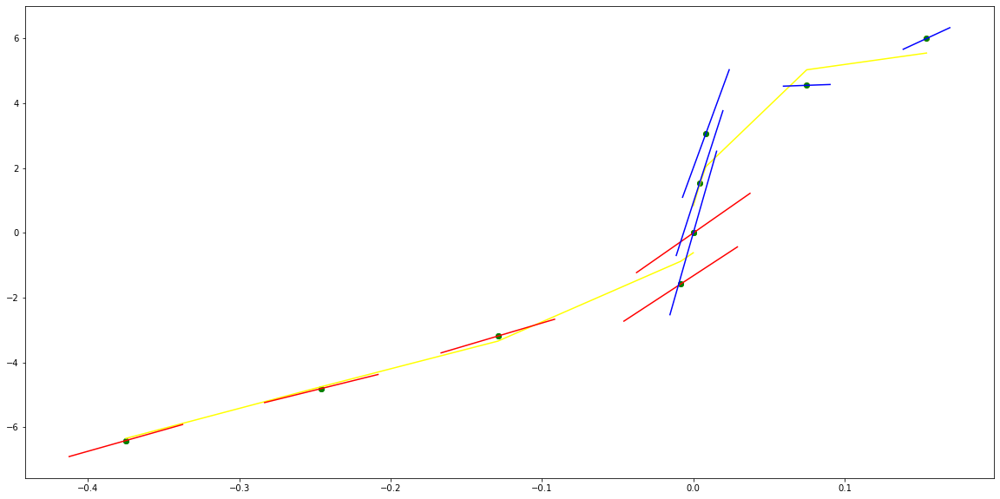

parameters (539676.6352329118, 549724.855215255, 163024.54265358247, 11740.8713589306, 264.31806020359295, -0.1784369890699079)
tangent[0]:341.3293359649899
tangent[1]:274.294351191588
tangent[2]:211.48638033268367
tangent[3]:174.8230900071353
tangent[4]:264.31806020359295
parameters (3565285.7413369757, -1723044.201450556, 293568.96474131854, -20567.6981890765, 541.889026328431, -0.2666577899949697)
tangent[0]:541.889026328431
tangent[1]:385.27701542856573
tangent[2]:-63.22047832782698
tangent[3]:125.72539933808764
tangent[4]:125.884395618952


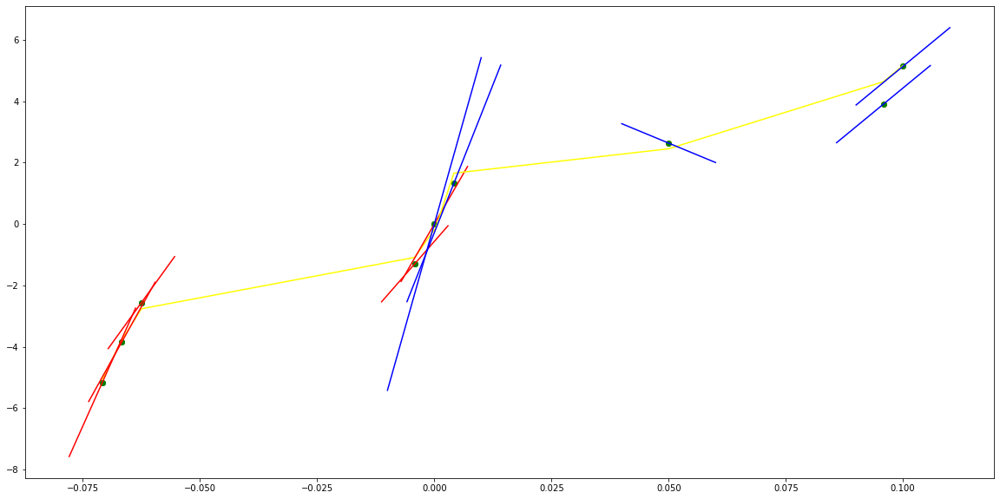

parameters (505.23382486497286, 895.5082488602807, 562.646786397476, 148.83093743129425, 21.786868631566204, 0.012576148900220102)
tangent[0]:6.398285689642716
tangent[1]:5.79574202355705
tangent[2]:8.060486747189852
tangent[3]:4.967347004835641
tangent[4]:21.786868631566204
parameters (2328708.922155646, -1028275.0589993347, 165431.61533314505, -11730.171844509012, 357.42829423262896, -0.04347159506270305)
tangent[0]:357.42829423262896
tangent[1]:267.99255657419985
tangent[2]:194.05555607112115
tangent[3]:-3.921504924650492
tangent[4]:-11.244338094972647


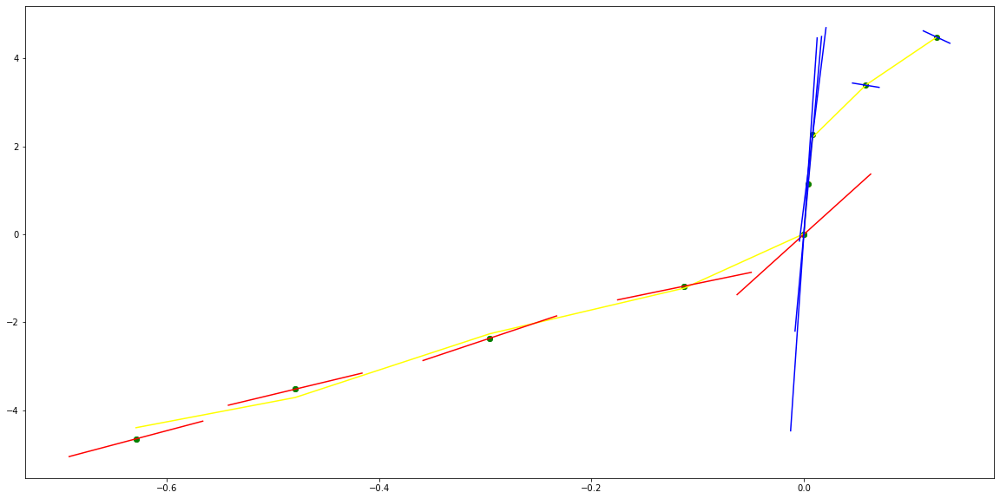

parameters (81103179.3233573, 16674753.85679892, 1139860.7807434017, 28887.24436741916, 290.61111815561014, -0.041582661127027666)
tangent[0]:217.44809371628423
tangent[1]:194.6311194223573
tangent[2]:153.0789165367986
tangent[3]:104.53830776999985
tangent[4]:290.61111815561014
parameters (73412987.06281859, -15766597.92039307, 1172254.105777031, -34133.18173981963, 366.7801779107629, -0.020960729363935896)
tangent[0]:366.7801779107629
tangent[1]:138.9263942943494
tangent[2]:152.3570553958819
tangent[3]:173.22853425557997
tangent[4]:156.22468277307854


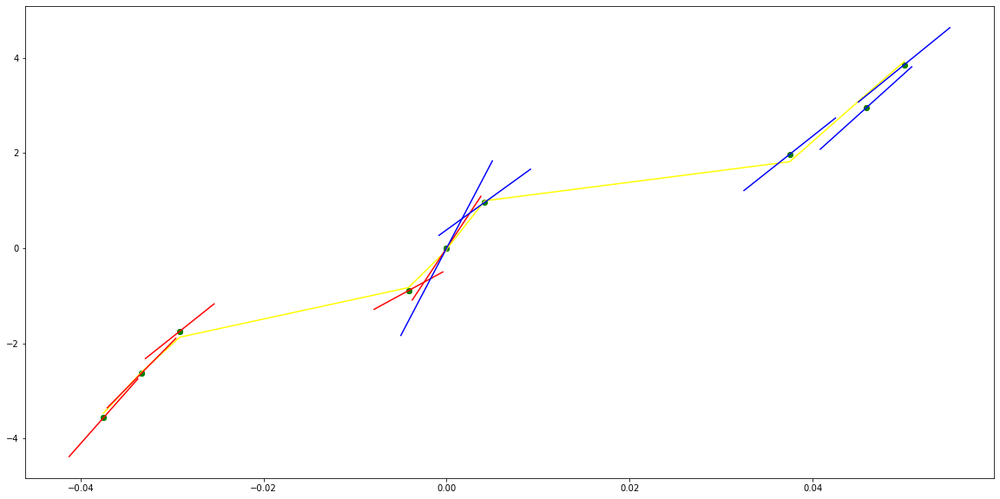

parameters (94033503.72778352, 20937397.396424625, 1598416.1602680206, 46391.157170479026, 415.85771271344635, -0.005742337798761202)
tangent[0]:196.95388406947365
tangent[1]:234.71149095662037
tangent[2]:247.93352218730575
tangent[3]:106.58000007992177
tangent[4]:415.85771271344635
parameters (92284470.99676389, -19004750.000652727, 1302405.8880406606, -33274.08525559525, 343.43201585841297, 0.04475188089157375)
tangent[0]:343.43201585841297
tangent[1]:128.64683948647632
tangent[2]:174.02845875592737
tangent[3]:220.6483702427974
tangent[4]:246.06673988886604


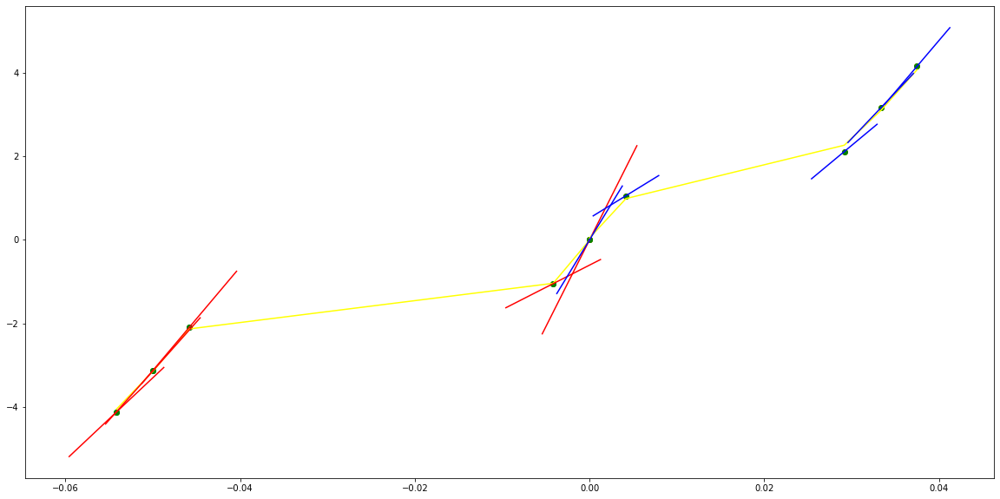

parameters (205451672.31471476, 35502989.69592469, 2093104.3833946476, 47421.27205902797, 410.8021917852272, -0.0233428789229567)
tangent[0]:227.0225531116768
tangent[1]:234.9158241589127
tangent[2]:206.15964521856648
tangent[3]:114.66100864762012
tangent[4]:410.8021917852272
parameters (143323.08387592182, -102081.66555460857, 25111.717330272648, -2589.4332134787783, 122.0306818175083, 0.30094778968777974)
tangent[0]:122.0306818175083
tangent[1]:101.72912808767771
tangent[2]:13.64753195037541
tangent[3]:27.579052752432673
tangent[4]:-24.947597972979864


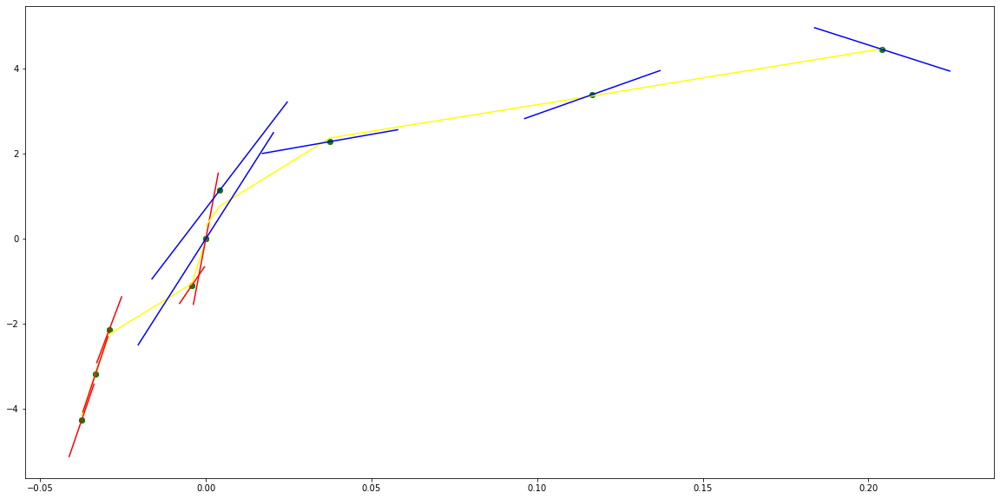

parameters (1.2704582420978308, 7.5399940179261575, 15.930100693006134, 13.714162443962776, 10.33356407728698, 0.02180416176081417)
tangent[0]:7.091427522750905
tangent[1]:6.325031457060856
tangent[2]:5.187196345583303
tangent[3]:6.254314270402909
tangent[4]:10.33356407728698
parameters (280.6841696319746, -758.9519903255532, 736.9693850793745, -313.0578544228883, 62.926212368654895, 1.3424290327566184)
tangent[0]:62.926212368654895
tangent[1]:60.355966789863615
tangent[2]:57.86056331728197
tangent[3]:18.42980715931288
tangent[4]:3.612824176884949


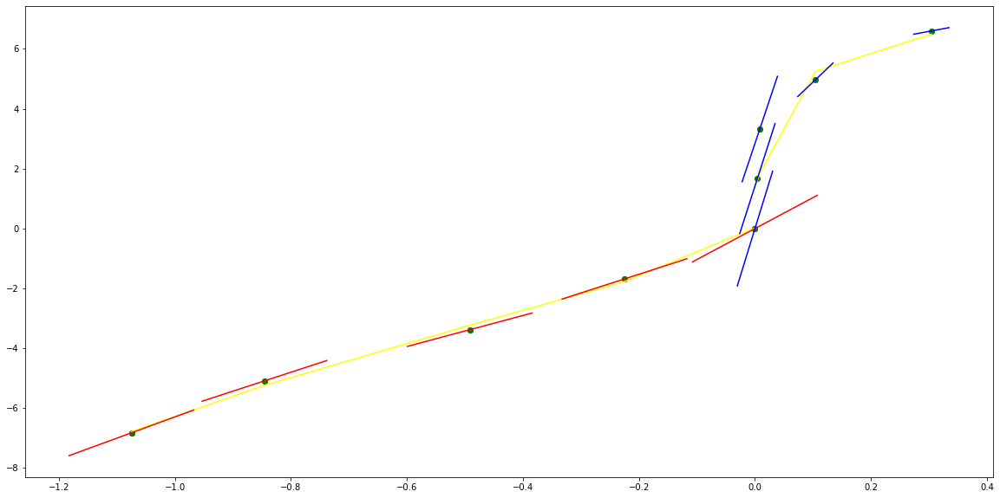

parameters (-1.3130112199128423, -7.987296192213212, -16.687445439938468, -14.294009546248311, -0.3697292904896322, -0.008088712116500344)
tangent[0]:5.577903136933719
tangent[1]:3.441020272493508
tangent[2]:3.953841727664487
tangent[3]:4.999417326750191
tangent[4]:-0.3697292904896322
parameters (103.82885278248652, -423.0338747997852, 593.0751336295509, -329.94969964747906, 65.99589304874475, 0.0004513617860317912)
tangent[0]:65.99589304874475
tangent[1]:-5.245963151821016
tangent[2]:22.01138431911103
tangent[3]:22.148682498114013
tangent[4]:22.276457606298905


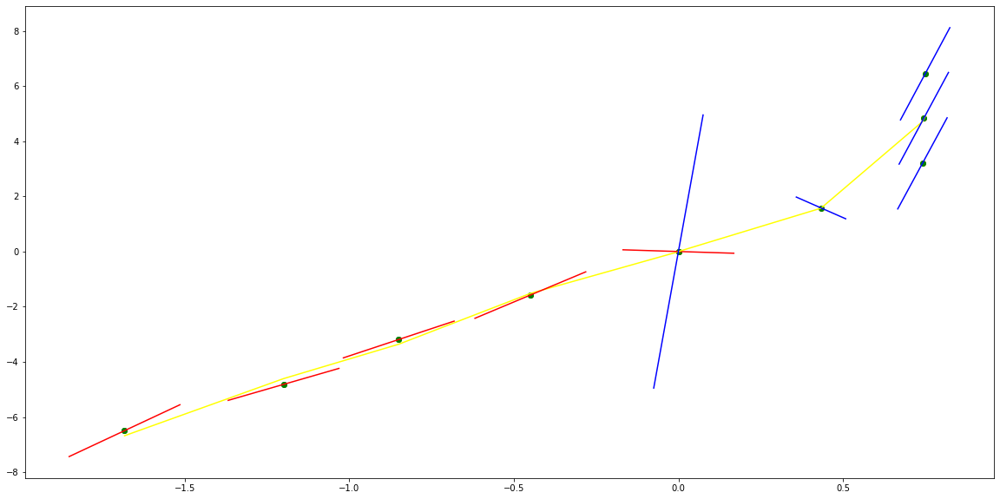

parameters (0.0011970657245787357, -0.12511242760815222, -0.8269004027273, -1.4981671598393045, 3.0331456362343943, 0.004271960623004021)
tangent[0]:3.5158341730671516
tangent[1]:3.8945213574453628
tangent[2]:4.100199754064931
tangent[3]:3.9294301279738546
tangent[4]:3.0331456362343943
parameters (-781.2475054414225, 3808.8697085165295, -6456.782060254957, 4350.737052808548, -883.5032714083862, -1.0984839446318198e-05)
tangent[0]:-883.5032714083862
tangent[1]:383.9380165861195
tangent[2]:-120.69784329906167
tangent[3]:147.09290577185868
tangent[4]:151.80666066262177


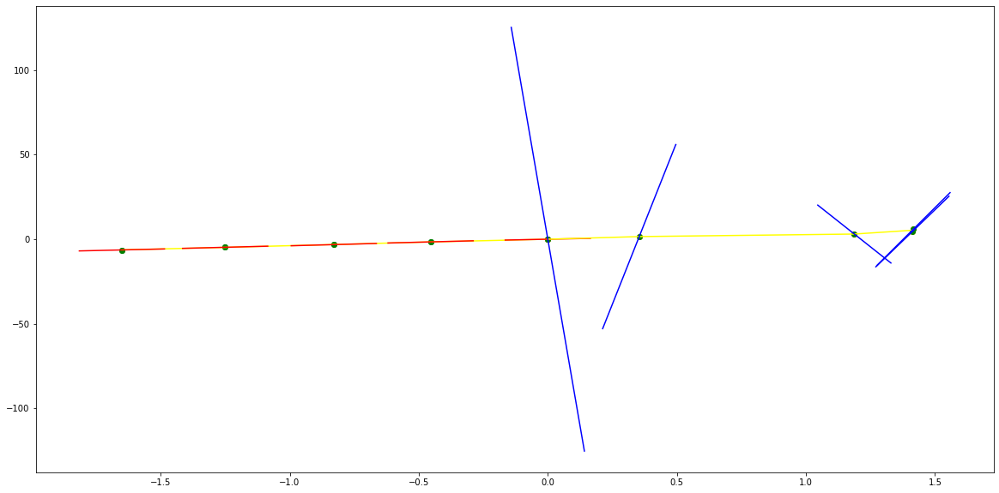

parameters (0.13161912033595038, 1.0110160281874558, 2.6477007638026864, 2.8432317674533722, 5.009837039042786, -0.0069434961732427435)
tangent[0]:3.9919531234199823
tangent[1]:3.9927884227033354
tangent[2]:3.748345878581393
tangent[3]:3.8229160350849143
tangent[4]:5.009837039042786
parameters (3386.301464059925, -16552.58600991944, 29757.489076904752, -23273.671503883943, 6677.5810805188285, 3.504879341502888e-06)
tangent[0]:6677.5810805188285
tangent[1]:-267.99984191712247
tangent[2]:161.66201476783135
tangent[3]:162.4340759415918
tangent[4]:162.96019460596835


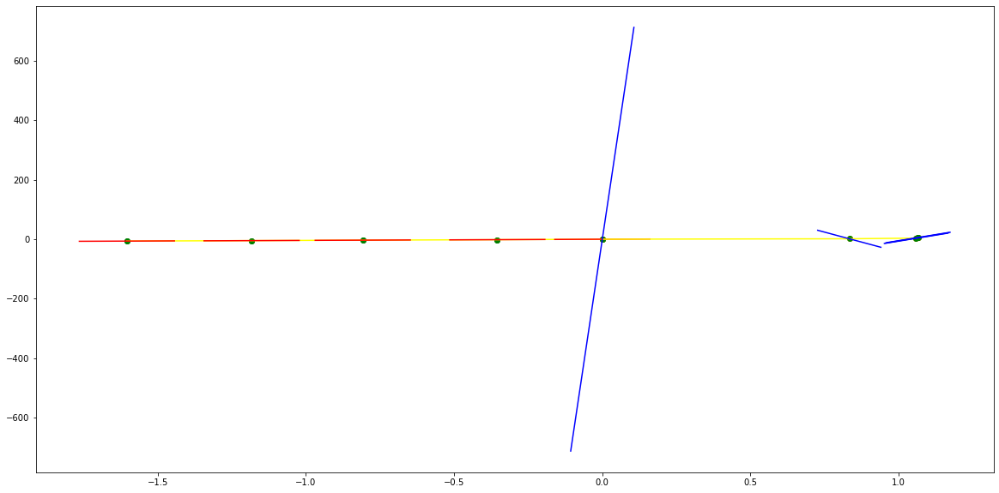

parameters (1.1083021600020904, 8.402269052500301, 23.063454376868698, 26.938561270029197, 14.901052201142939, -0.7076053909920611)
tangent[0]:4.200222131842871
tangent[1]:2.515467025931052
tangent[2]:5.798716011566878
tangent[3]:14.677798517486902
tangent[4]:14.901052201142939
parameters (64082.78006404545, -124716.98361852104, 80475.76431765918, -18048.338584587786, 488.5450346448688, -0.09801417791545698)
tangent[0]:488.5450346448688
tangent[1]:342.2862984518363
tangent[2]:-163.15123161852807
tangent[3]:352.922275897241
tangent[4]:314.2363466980478


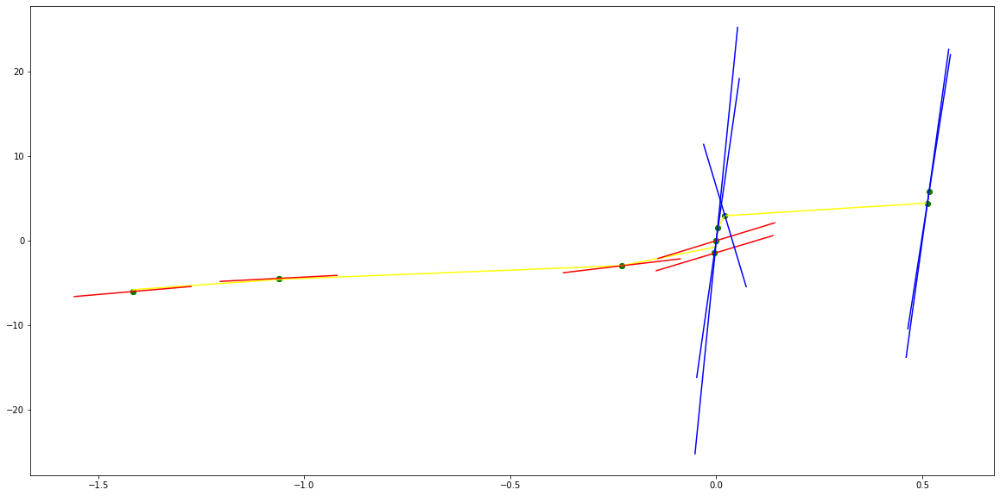

parameters (64082.80439923297, 138289.6928987088, 102757.59954051998, 30352.32025222982, 3081.677549547239, -8.660519853456534e-05)
tangent[0]:352.92240142177207
tangent[1]:314.23645687051385
tangent[2]:274.9040192581265
tangent[3]:-218.92119546695767
tangent[4]:3081.677549547239
parameters (113564.23174865937, -76324.65064516486, 18147.737762265016, -1824.841638291198, 102.30362162679987, 0.014011754180666192)
tangent[0]:102.30362162679987
tangent[1]:55.230461614633484
tangent[2]:21.718474074486437
tangent[3]:33.25094013018102
tangent[4]:36.900106996397625


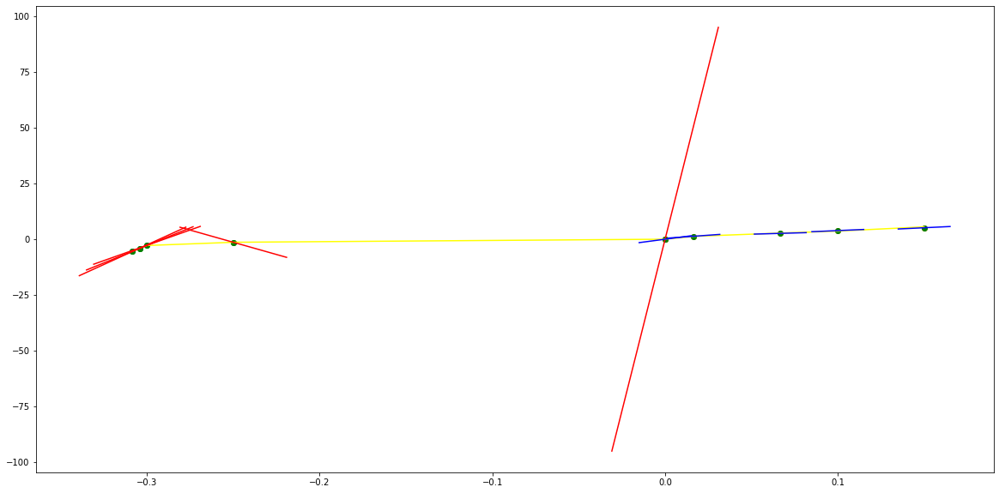

parameters (-5.457708538901191, -75.74904655005487, -380.76900728005023, -817.0579682037321, -629.3754062523432, 9.298236862398506e-07)
tangent[0]:30.856418426911546
tangent[1]:31.28067172119688
tangent[2]:-35.193225657566586
tangent[3]:56.2631975508142
tangent[4]:-629.3754062523432
parameters (-5633.291653111916, 26764.23403699308, -47375.42288984241, 37042.890306322966, -10797.276110607949, 4.2031603221997054e-07)
tangent[0]:-10797.276110607949
tangent[1]:59.813189113854605
tangent[2]:-18.669773892201192
tangent[3]:54.277937622107856
tangent[4]:69.66941365243838


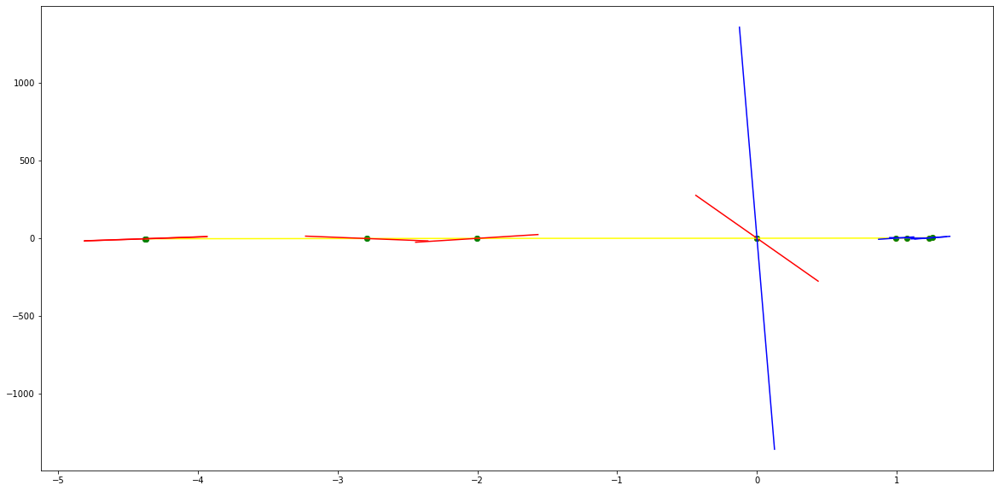

parameters (0.2540947231592142, 3.3721143142148104, 15.563256472218326, 28.717078214438335, 17.14912228363781, -2.7545619857473385e-05)
tangent[0]:22.642906649204548
tangent[1]:-2.0268173232190634
tangent[2]:3.774594691184774
tangent[3]:-5.8153487776169115
tangent[4]:17.14912228363781
parameters (7630.841039557917, -14635.091814791369, 7989.606885233621, -1510.3867493847283, 87.39963202488275, -0.0014309630732302903)
tangent[0]:87.39963202488275
tangent[1]:-29.070820603538436
tangent[2]:56.9390886255477
tangent[3]:67.30149772431605
tangent[4]:68.33526303029589


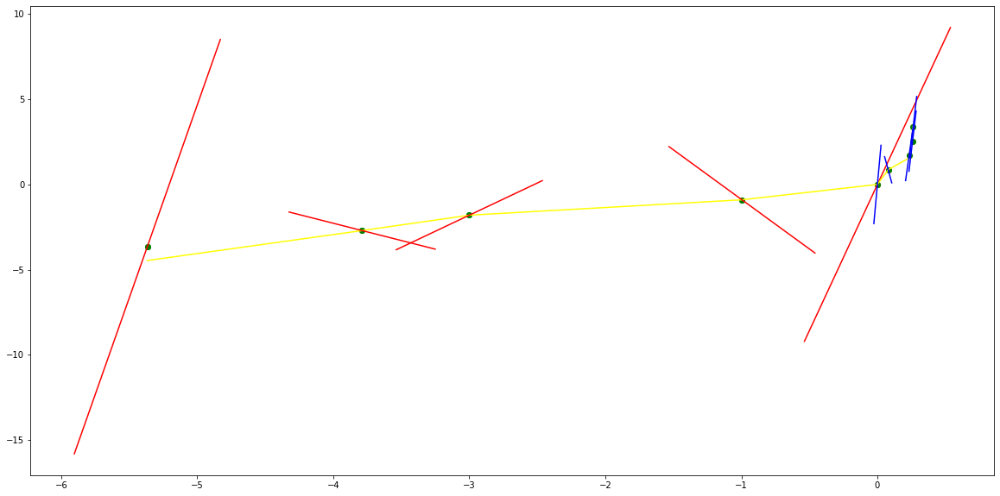

parameters (0.06484432571650468, 0.9788109401838461, 5.298406534230755, 12.19334568310584, 11.292196224005435, -0.22872861279693707)
tangent[0]:-1.2121691191583484
tangent[1]:5.987019357284584
tangent[2]:7.410971317834932
tangent[3]:10.692402403067138
tangent[4]:11.292196224005435
parameters (382.89370899369504, -1305.3643036410135, 1556.9276171083413, -728.5000713153763, 97.95839885648509, 0.4130885091890574)
tangent[0]:97.95839885648509
tangent[1]:91.96922334398565
tangent[2]:86.13853855696371
tangent[3]:-40.162086441188634
tangent[4]:20.916345129636582


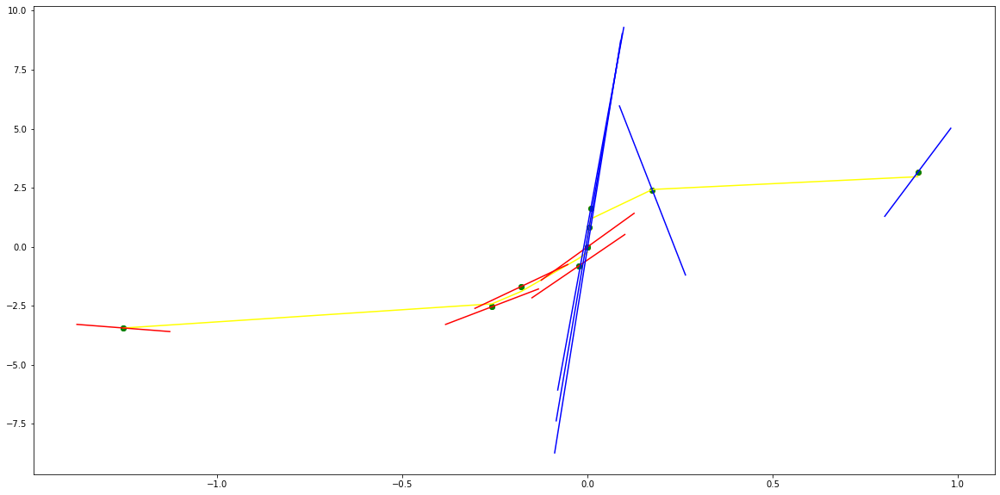

parameters (-0.0350846651343437, -0.3594978251447172, -1.259901046240125, -1.6309963297406747, -0.004434230176924111, 0.0004888266255395813)
tangent[0]:0.6801468897935318
tangent[1]:0.6926587612793583
tangent[2]:0.8728843612054389
tangent[3]:0.8682462114270293
tangent[4]:-0.004434230176924111
parameters (-58189.975726713405, 138472.4712466928, -123072.74265038194, 48442.33839059169, -7125.970705986061, -4.498682170156951e-08)
tangent[0]:-7125.970705986061
tangent[1]:37.66485205561003
tangent[2]:30.674271787907855
tangent[3]:24.49112115402204
tangent[4]:7.387022553824863


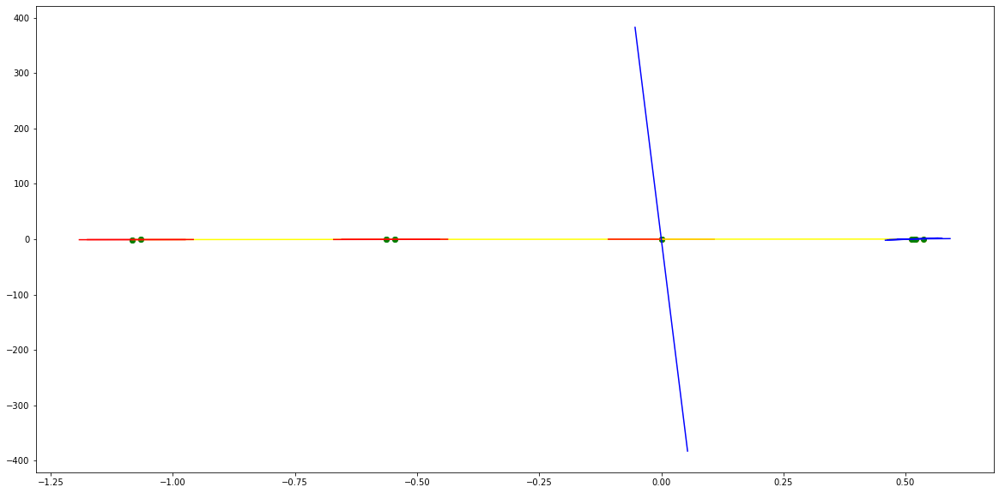

parameters (0.0878390831140703, 0.6374138158229643, 1.4382957009036876, 1.0430411469094305, 0.6143992175496736, -5.737525958916944e-05)
tangent[0]:0.7710218465342283
tangent[1]:0.777355318048271
tangent[2]:0.7682186554639473
tangent[3]:0.3657009738619691
tangent[4]:0.6143992175496736
parameters (699619.515250611, -239818.865835664, 31340.794148355923, -1821.821891487674, 49.703243309781094, 0.007591761004635237)
tangent[0]:49.703243309781094
tangent[1]:36.08732898418786
tangent[2]:25.331366779084682
tangent[3]:3.7539030145596044
tangent[4]:7.186897848033645


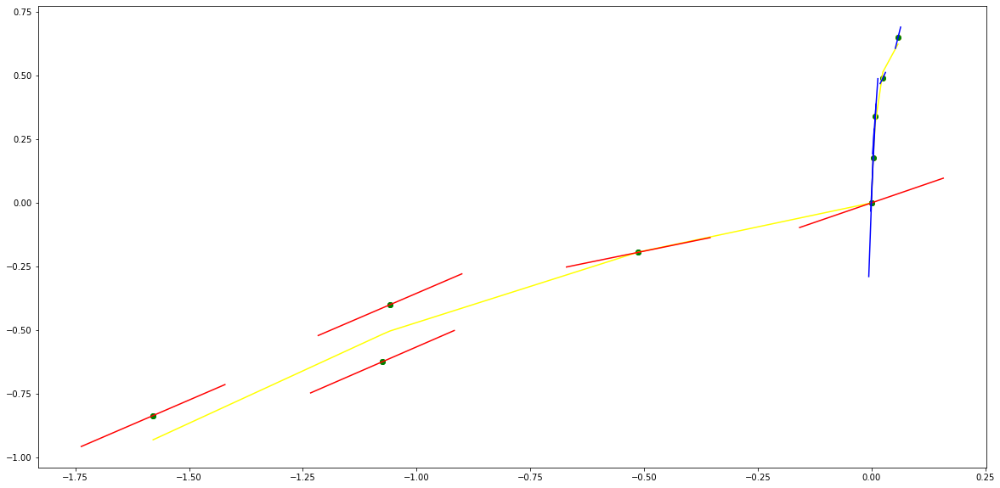

parameters (44.803606146472475, 197.6450006903942, 268.4385330137067, 141.0574946079082, 32.73367193731692, 0.0700072110269857)
tangent[0]:12.579605952357973
tangent[1]:10.838636443092064
tangent[2]:1.059407462831473
tangent[3]:17.275303878914336
tangent[4]:32.73367193731692
parameters (6250.245298629238, -7936.5695704202935, 3725.786866882625, -771.7498561803404, 80.96684930142236, 0.10047805780561728)
tangent[0]:80.96684930142236
tangent[1]:58.2017154025464
tangent[2]:9.769328439466477
tangent[3]:8.405930242212932
tangent[4]:20.253952138652252


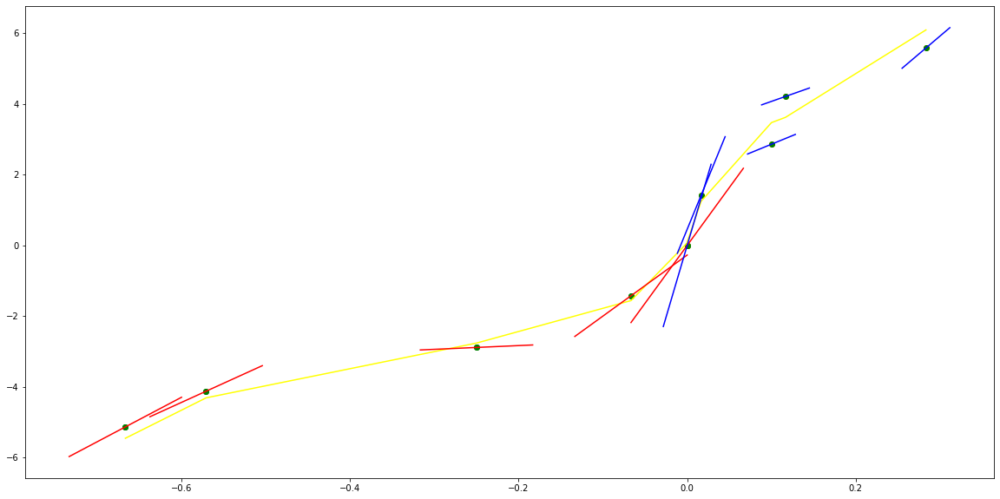

parameters (-602.7536577649763, -1209.838498729419, -779.654042679364, -150.93063912980557, 16.745287522203736, 0.06842628534437416)
tangent[0]:-1.8641836236816722
tangent[1]:22.16326504955593
tangent[2]:28.079771233819113
tangent[3]:28.31281170309459
tangent[4]:16.745287522203736
parameters (4517.78540678619, -6907.757818869052, 3770.2848948451383, -855.338329146861, 85.1549235311315, 0.06463624293099565)
tangent[0]:85.1549235311315
tangent[1]:59.6589194194844
tangent[2]:6.956620140743851
tangent[3]:10.547812304283482
tangent[4]:26.861312188185323


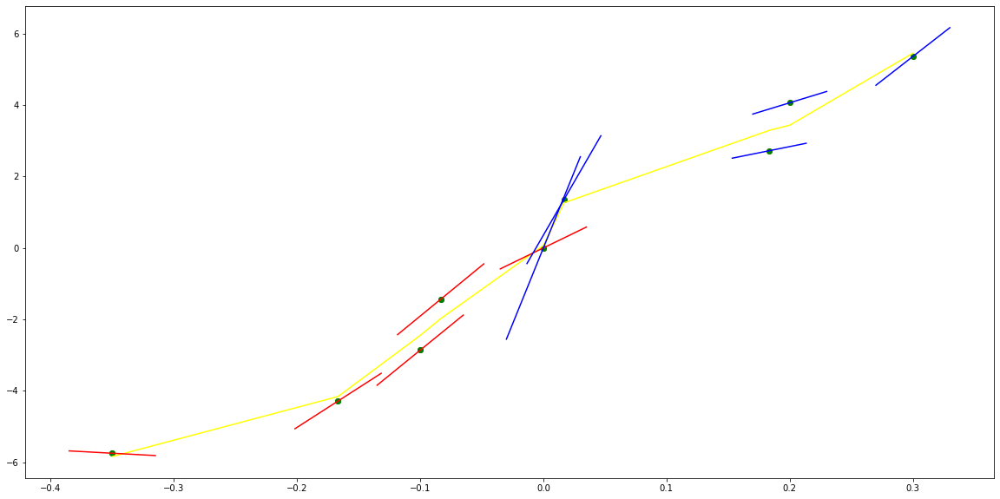

parameters (-1759924552.2007477, -215723740.22062927, -8984180.03606605, -152223.1155810352, -444.57901392219355, 0.0024581562047963816)
tangent[0]:366.62032027796795
tangent[1]:458.5963664497431
tangent[2]:620.1716641078242
tangent[3]:677.6879154825838
tangent[4]:-444.57901392219355
parameters (1143840774.1686103, -144316413.26001346, 6115484.448867463, -103763.50067846458, 1108.9461624835862, -0.11626045985894294)
tangent[0]:1108.9461624835862
tangent[1]:522.7030495900734
tangent[2]:347.13193699315866
tangent[3]:515.1798966107658
tangent[4]:605.939890306558


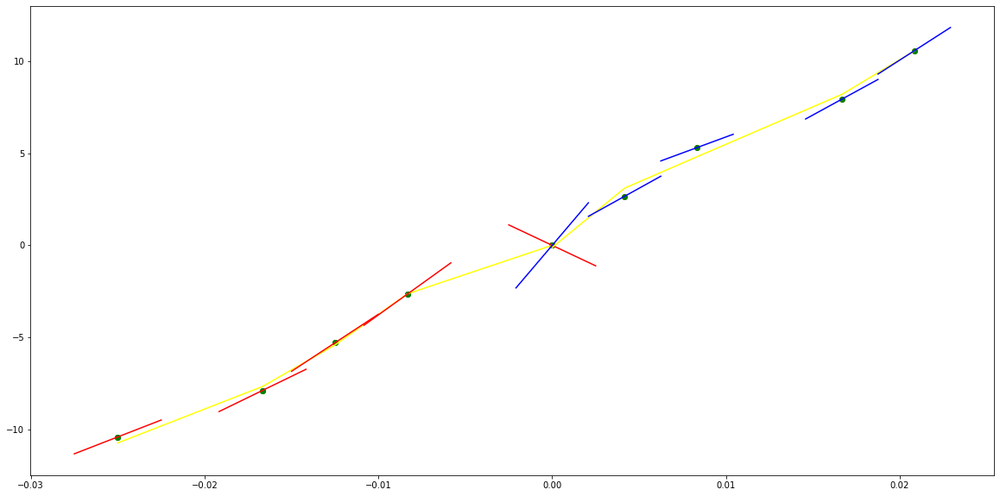

parameters (-3526182965.1301894, -367533915.74707615, -13577281.130218107, -209987.1629560009, -696.4760895002719, -0.003318238307764095)
tangent[0]:429.2735695631736
tangent[1]:434.45555154960493
tangent[2]:629.7689148984246
tangent[3]:740.4614256319969
tangent[4]:-696.4760895002719
parameters (415666391.29082716, -72347027.43503672, 4540139.483910203, -117281.55800820414, 1290.8568291170955, -0.2548804858386796)
tangent[0]:1290.8568291170955
tangent[1]:529.7591486352932
tangent[2]:124.6004494849301
tangent[3]:453.64277820635243
tangent[4]:497.7349554000007


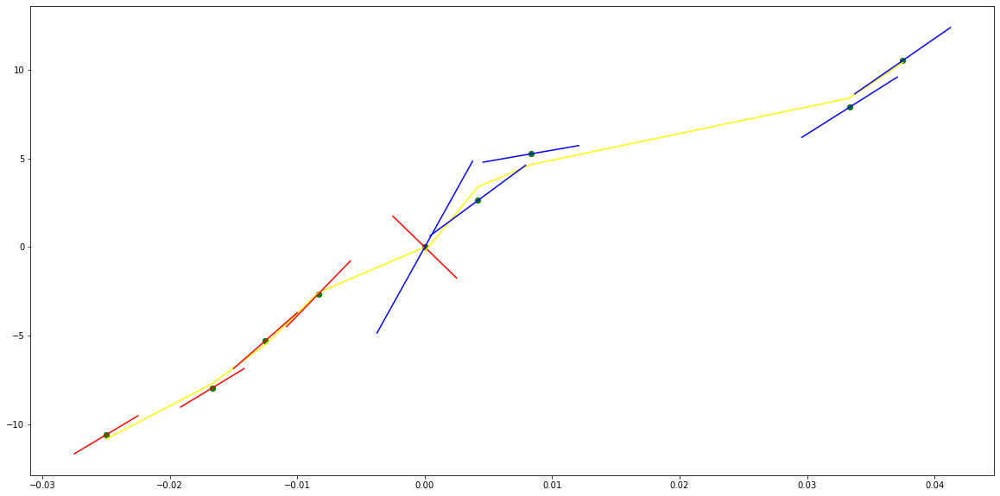

parameters (37805721.750242226, 13737924.311078733, 1730644.4808767461, 83528.46538400359, 1057.743687019043, -0.0001874637819828692)
tangent[0]:222.5486673268931
tangent[1]:309.8984503447534
tangent[2]:390.7489022375046
tangent[3]:-524.131032096773
tangent[4]:1057.743687019043
parameters (12779197.513776071, -6048218.724997761, 811247.2317088208, -33328.15496630217, 548.6298889551011, -0.09167013565091049)
tangent[0]:548.6298889551011
tangent[1]:311.40104771431845
tangent[2]:148.45745686287313
tangent[3]:213.77813952182248
tangent[4]:322.02819930428575


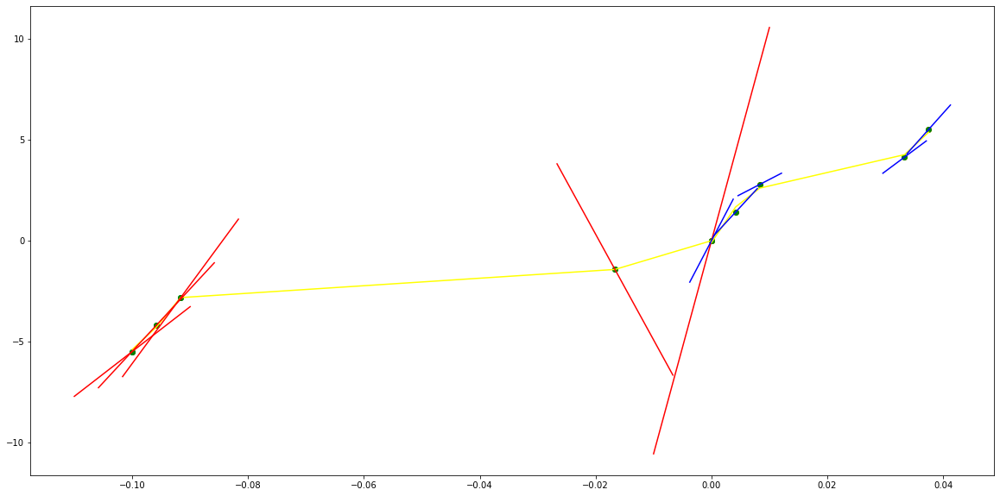

parameters (3.382310268840284, 17.556982763245152, 32.56662667999197, 24.793776095097623, 12.381506767763547, -0.01990460253644598)
tangent[0]:7.248534798356346
tangent[1]:6.071215429048387
tangent[2]:4.419037688937962
tangent[3]:6.613860101000077
tangent[4]:12.381506767763547
parameters (1091.0320703849643, -2127.441965854888, 1508.441204264709, -468.17056067936096, 68.56184630802913, 1.2256894333959558)
tangent[0]:68.56184630802913
tangent[1]:64.73897506316482
tangent[2]:61.06865144800723
tangent[3]:7.643123524047546
tangent[4]:9.651478044172265


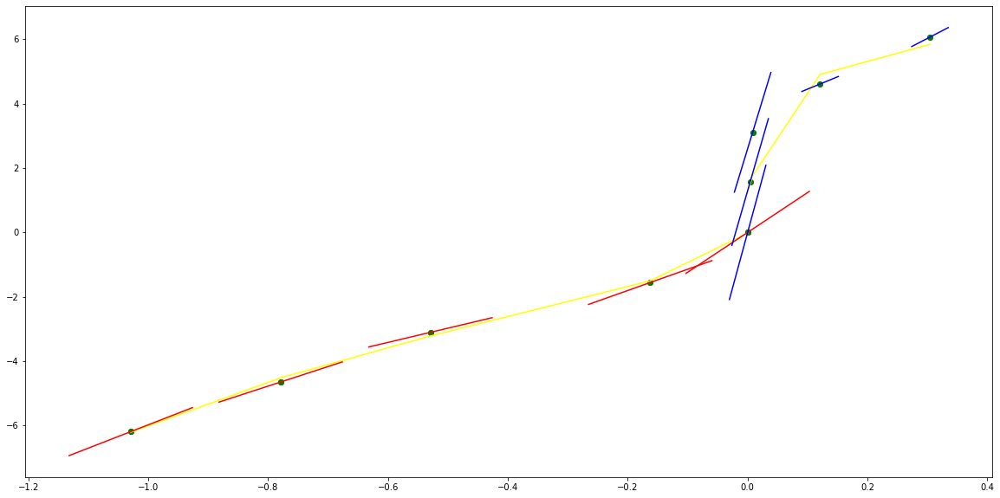

parameters (1.0211930062993786, 6.175907586498062, 12.740588427451623, 10.146411129923257, 5.549968496673834, 0.01402166204730075)
tangent[0]:3.2890434456706146
tangent[1]:4.136149809035832
tangent[2]:3.3484596022345485
tangent[3]:2.11636411271404
tangent[4]:5.549968496673834
parameters (-149.39091217554275, 667.3721657542098, -1035.2883284464126, 647.8034123241258, -130.90553298493123, 0.00020627286043528072)
tangent[0]:-130.90553298493123
tangent[1]:40.309484058721665
tangent[2]:-24.630740470280756
tangent[3]:45.28745882643571
tangent[4]:54.0701037189755


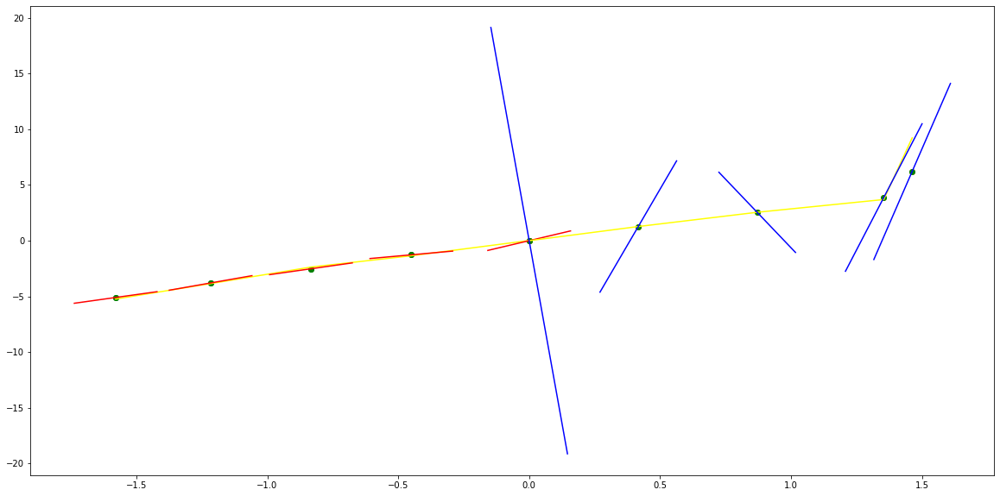

parameters (1.4629681809225008, 10.672095843591107, 28.200180000280213, 32.28796283003133, 17.58293880207625, -0.3019113407250371)
tangent[0]:4.022399716182697
tangent[1]:2.5003606915717995
tangent[2]:1.0461992415921593
tangent[3]:11.526843758305658
tangent[4]:17.58293880207625
parameters (47.811971317312086, -210.7285042684231, 337.32632669666606, -237.45476015764842, 76.89373084742545, 2.7938984552805675)
tangent[0]:76.89373084742545
tangent[1]:74.93229384971183
tangent[2]:73.00563570653838
tangent[3]:27.62439953015887
tangent[4]:2.2213358689554923


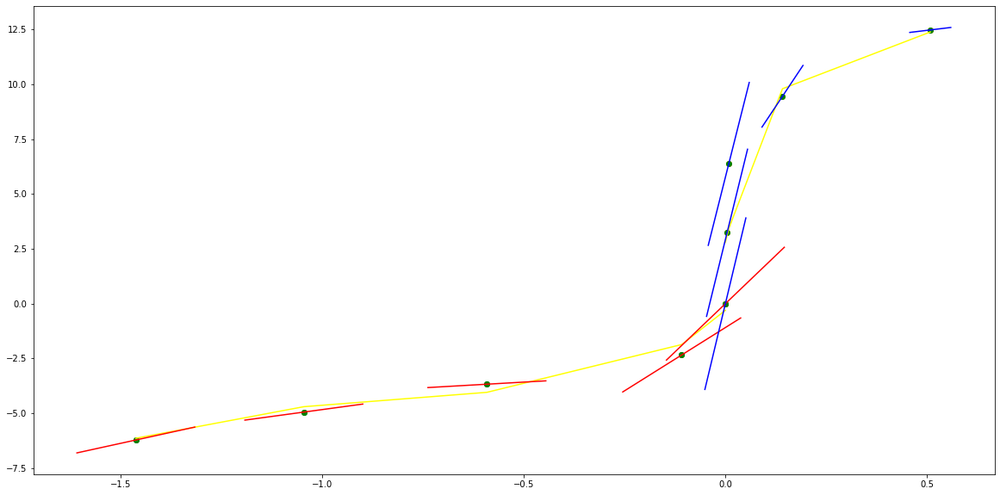

parameters (-172.4429740002443, -746.1886844055357, -1137.705565590881, -719.8343217921371, -151.07827009526432, -0.0001626806779573678)
tangent[0]:52.58124326952952
tangent[1]:37.319032958604794
tangent[2]:-10.46448879988634
tangent[3]:37.379735614094386
tangent[4]:-151.07827009526432
parameters (-15495.93732361536, 44287.10402116578, -44982.26152317462, 18761.3992925435, -2555.3273490812835, -9.697496834329548e-05)
tangent[0]:-2555.3273490812835
tangent[1]:821.9959763854577
tangent[2]:-265.3571204830014
tangent[3]:219.8346033484804
tangent[4]:218.0057977962524


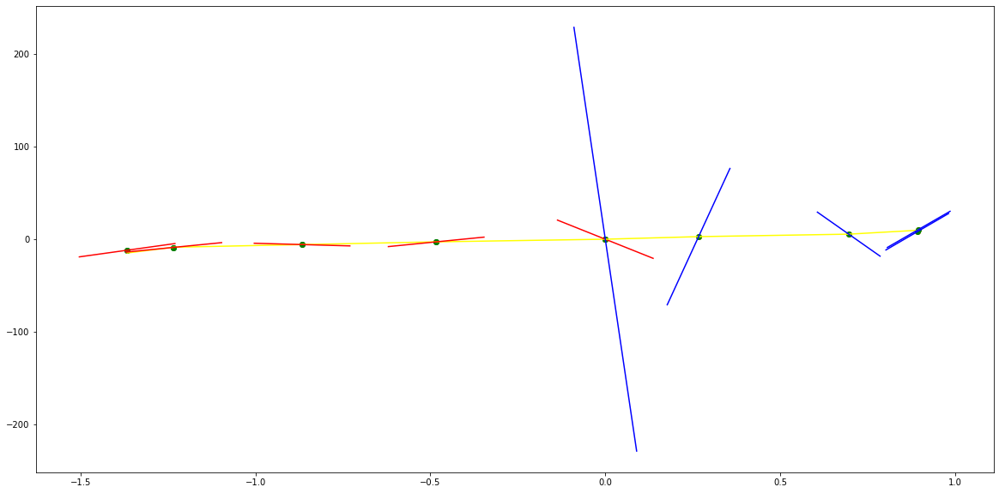

parameters (3.243933250099794, 16.961016668949135, 31.88687055855184, 26.34481128117207, 16.629760511223708, -0.03820676093843063)
tangent[0]:6.648396779492302
tangent[1]:7.860872270219431
tangent[2]:6.977604664596061
tangent[3]:9.494357685775558
tangent[4]:16.629760511223708
parameters (5093786.2587662125, -2595662.058775169, 459904.2004655781, -32672.119269444476, 834.4915821461908, -0.1188284130858223)
tangent[0]:834.4915821461908
tangent[1]:585.4157557259678
tangent[2]:379.8988016388796
tangent[3]:261.4386365070703
tangent[4]:261.98314446369466


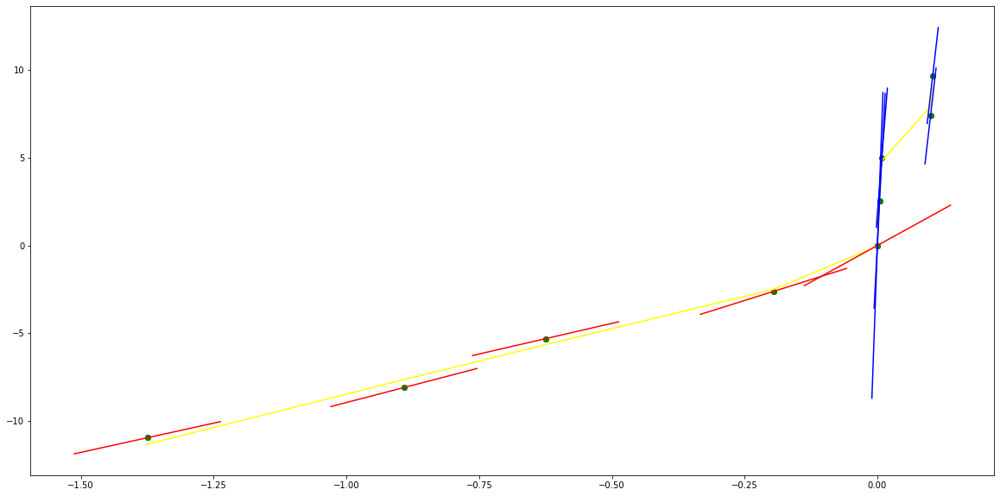

parameters (4892411.741581221, 1810352.226039798, 245509.28355593362, 14891.367080356047, 482.0771336579976, -0.2044891468239401)
tangent[0]:107.61744538602852
tangent[1]:69.6837478349031
tangent[2]:158.648159525136
tangent[3]:370.2448891808773
tangent[4]:482.0771336579976
parameters (3648254.8718720945, -1875706.4042430094, 341390.1520579402, -25710.91404079281, 742.2700268464478, -0.11845839712341115)
tangent[0]:742.2700268464478
tangent[1]:545.2414817880348
tangent[2]:-92.2404741737837
tangent[3]:163.0935993901012
tangent[4]:148.3657222735401


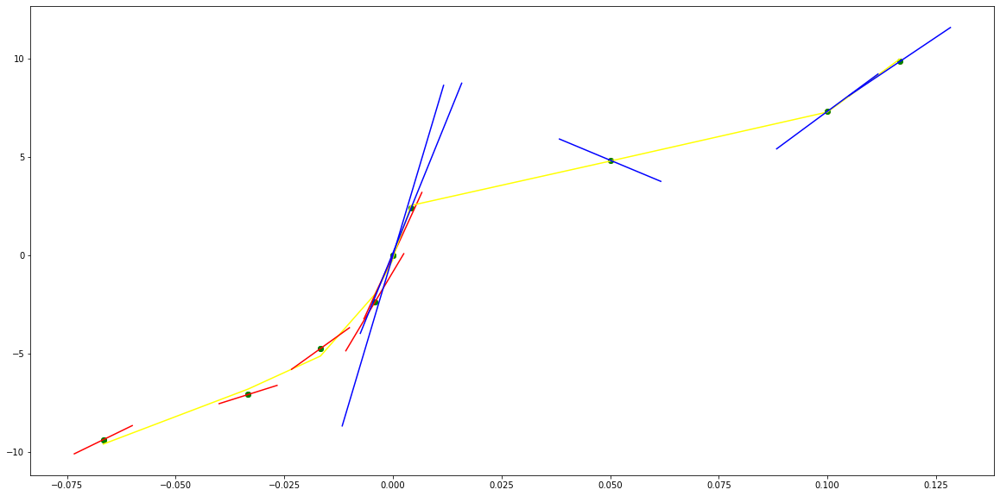

parameters (7189210.445411031, 2765112.6206581565, 406830.59018642746, 26366.303624708893, 725.7209014786812, -0.22781596765430112)
tangent[0]:249.83360087294193
tangent[1]:139.75890872182833
tangent[2]:-17.573518503985383
tangent[3]:526.4302939754675
tangent[4]:725.7209014786812
parameters (-17461994.62800942, 2231513.9233225463, 148220.35388041608, -25459.01316494858, 833.1939239701733, 0.054724077081822045)
tangent[0]:833.1939239701733
tangent[1]:629.3590768731164
tangent[2]:-152.87635969738437
tangent[3]:431.89492676371447
tangent[4]:588.3261452400197


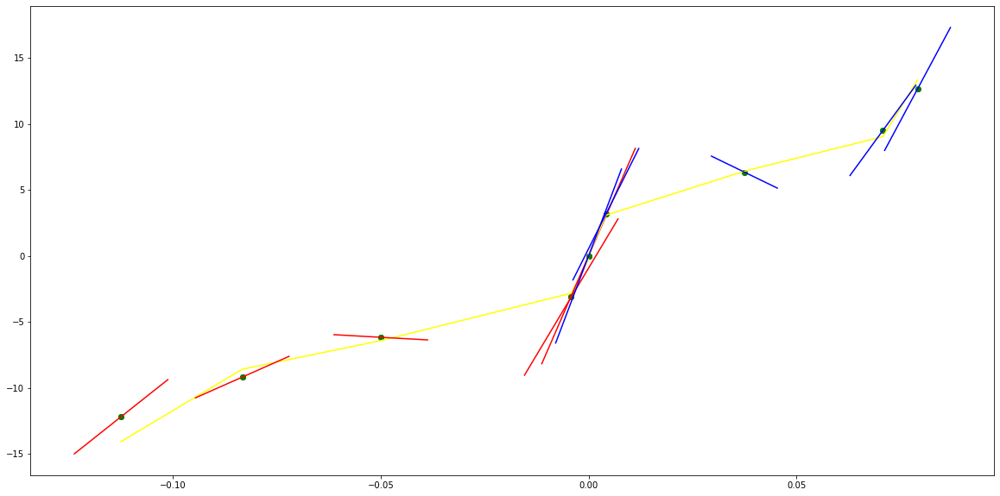

parameters (8458581.787259122, 3275409.869596942, 444024.5781752988, 24284.40986602331, 582.2783949234858, 0.20277809068175146)
tangent[0]:246.5024378089438
tangent[1]:243.45158859579624
tangent[2]:50.92966804524394
tangent[3]:262.67500902407136
tangent[4]:582.2783949234858
parameters (79885338.59539363, -15350953.763609966, 1193811.232626637, -46269.58163312017, 958.3114230976387, -0.11629890387222175)
tangent[0]:958.3114230976387
tangent[1]:630.565882936881
tangent[2]:402.2242250447613
tangent[3]:79.81984433508
tangent[4]:133.58090712475564


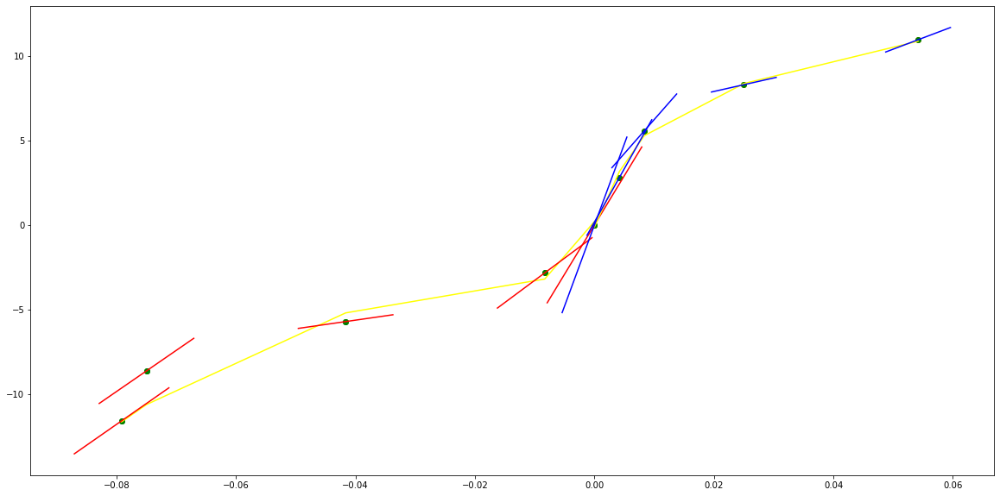

parameters (912.0804243405364, 1516.6250533251678, 912.314569770113, 243.11269964049902, 52.35666274337363, -0.9108154281463656)
tangent[0]:25.909461116373947
tangent[1]:23.586761581750082
tangent[2]:23.607979486363874
tangent[3]:48.49150852588242
tangent[4]:52.35666274337363
parameters (93541.8523178113, -86354.07078844674, 28475.541127646415, -4045.2829272057893, 264.80157099091866, 1.1805029750643725)
tangent[0]:264.80157099091866
tangent[1]:232.54666979057708
tangent[2]:203.1172010302258
tangent[3]:20.392162256189096
tangent[4]:27.817482955797573


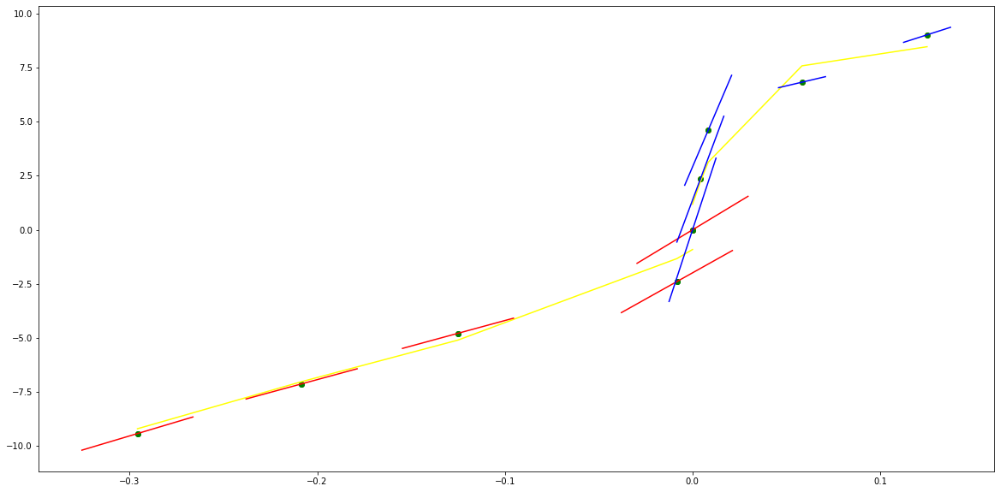

parameters (15.192576305922943, 50.486156552430685, 61.67918465377907, 33.88019567913575, 14.933672742065685, -0.6494395003383503)
tangent[0]:7.159640516998483
tangent[1]:6.506073250765279
tangent[2]:7.052102393462052
tangent[3]:14.65451357395759
tangent[4]:14.933672742065685
parameters (122077993.39912789, -27163883.62835843, 2075420.120373584, -60472.13390984827, 550.078060760643, 0.0075713818586917525)
tangent[0]:550.078060760643
tangent[1]:146.6121623301674
tangent[2]:318.3164210403138
tangent[3]:301.5110521212264
tangent[4]:253.27025745418632


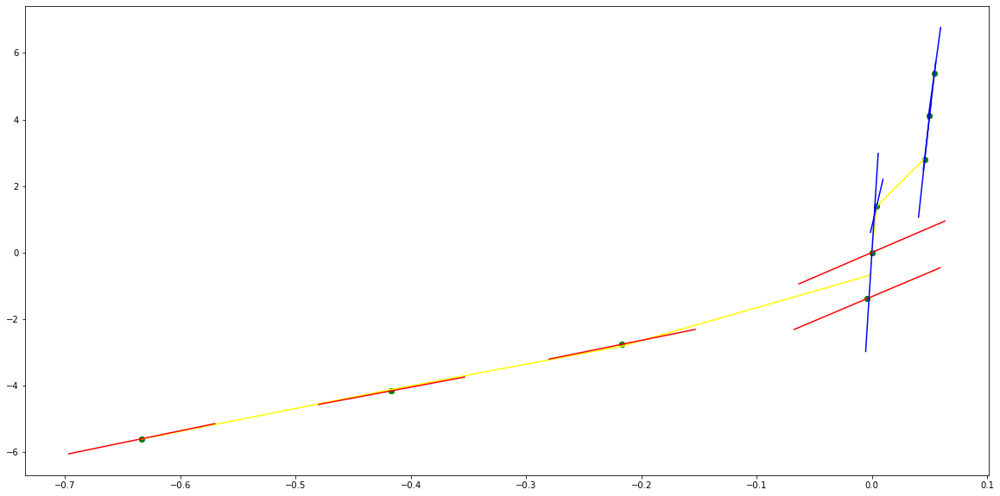

parameters (-1.4537292031546132, -4.845921574262063, -4.990949110841583, -1.556428698801671, 3.9301613931736976, 0.0003531595844798664)
tangent[0]:4.000488719546756
tangent[1]:3.658333499558861
tangent[2]:3.788459078229301
tangent[3]:4.08286022944279
tangent[4]:3.9301613931736976
parameters (-6051.774005031531, 13164.786783579762, -10031.461060749649, 3092.99051312111, -308.26679535559396, 3.0124739243623023e-05)
tangent[0]:-308.26679535559396
tangent[1]:98.01306763719236
tangent[2]:-61.11115919791308
tangent[3]:72.60493774305615
tangent[4]:65.48808853664997


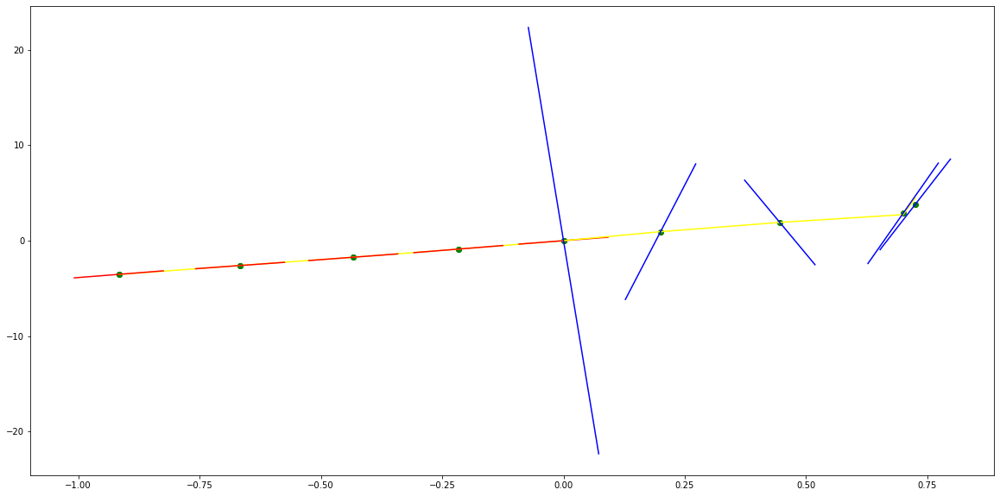

parameters (-1233885.1898058464, -1026753.8729010501, -148176.52727641165, -5248.349042550373, 103.56511512276948, -0.12470360796907069)
tangent[0]:165.28064935621285
tangent[1]:173.5672308760221
tangent[2]:173.18698790704158
tangent[3]:139.88139805930444
tangent[4]:103.56511512276948
parameters (46183903.09309381, -12504032.059435245, 1161135.8692337733, -40451.72620129756, 370.0791368615491, 0.0018626191065432896)
tangent[0]:370.0791368615491
tangent[1]:89.94505801656322
tangent[2]:233.25769814270456
tangent[3]:200.11325833553923
tangent[4]:154.5309502555919


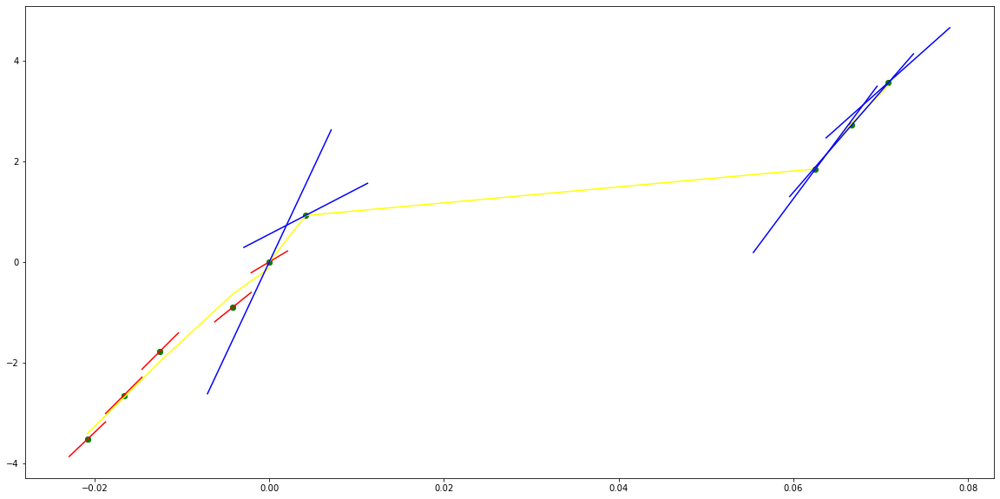

parameters (74.14566844804256, 191.83497935541223, 187.01001469578546, 82.33075629680638, 20.028662015037817, -0.36611140582614077)
tangent[0]:5.208448452377702
tangent[1]:3.348547447532056
tangent[2]:8.442544113352476
tangent[3]:19.35236377242268
tangent[4]:20.028662015037817
parameters (85868071.74083382, -20798649.842154525, 1746444.767810352, -54960.77355088662, 408.49733680372486, 0.00022870446179538444)
tangent[0]:408.49733680372486
tangent[1]:35.53934510603034
tangent[2]:244.5827487264309
tangent[3]:196.8660593137551
tangent[4]:151.1280536955432


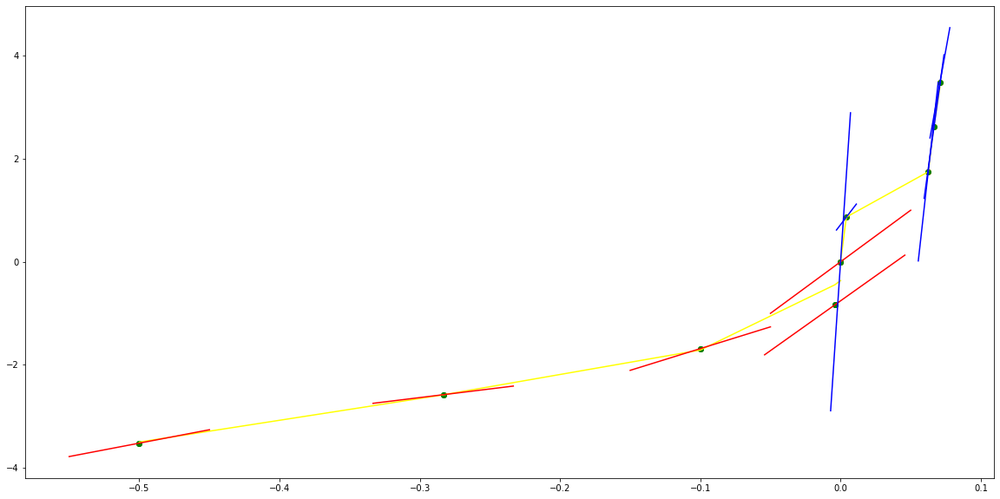

parameters (-0.3032606241821722, -1.6824017022184958, -3.339795020174019, -2.9318658141959504, 3.4827595264523605, 0.0020004335490277723)
tangent[0]:4.627082706542186
tangent[1]:4.539853231586107
tangent[2]:4.633294719042509
tangent[3]:4.590081153516286
tangent[4]:3.4827595264523605
parameters (-30721.630341279164, 52666.303148011255, -30493.636242011908, 6653.9682056345255, -394.6162927799681, 6.506913100606862e-05)
tangent[0]:-394.6162927799681
tangent[1]:216.6726585079852
tangent[2]:-215.9806704143587
tangent[3]:269.3667274219667
tangent[4]:264.018724495492


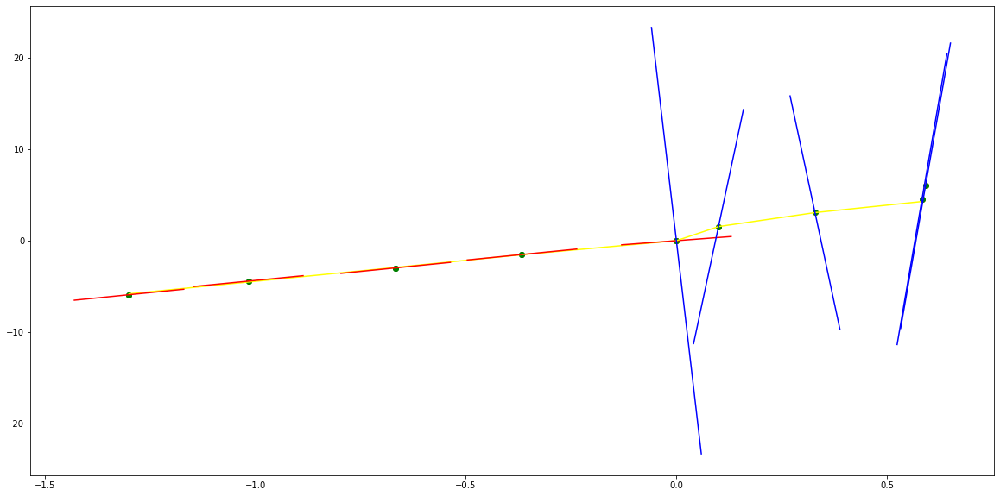

parameters (-157828.04477727428, -174124.580120552, -59513.11142178463, -5122.1033130839205, 374.48596040450656, 0.003075171419063211)
tangent[0]:244.4338586565761
tangent[1]:259.37900390794374
tangent[2]:-372.703178873451
tangent[3]:414.114797183559
tangent[4]:374.48596040450656
parameters (48170260.08910881, -13126175.813925128, 1141244.751099721, -34033.571850794484, 431.7902003217893, 0.15355603203156434)
tangent[0]:431.7902003217893
tangent[1]:203.87737694957264
tangent[2]:230.61435784712347
tangent[3]:319.7771244390512
tangent[4]:401.38874934930726


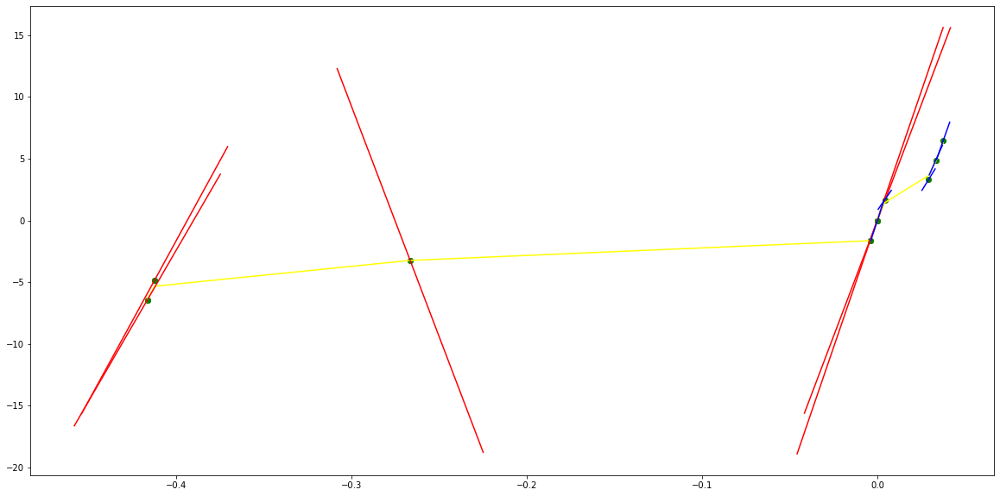

parameters (309903.4556911896, 319922.4705096924, 105538.36934766408, 13057.439117941176, 478.7223017294357, 0.2757075468540982)
tangent[0]:162.05956549201733
tangent[1]:175.0496533525777
tangent[2]:-185.7605922216976
tangent[3]:375.3306912424616
tangent[4]:478.7223017294357
parameters (31421882.795663975, -9573599.79535155, 992722.5679591713, -38610.295093015426, 432.0560157246666, 0.005616091769405762)
tangent[0]:432.0560157246666
tangent[1]:159.26695535430076
tangent[2]:287.31757984945057
tangent[3]:277.22325478419884
tangent[4]:250.16801742102348


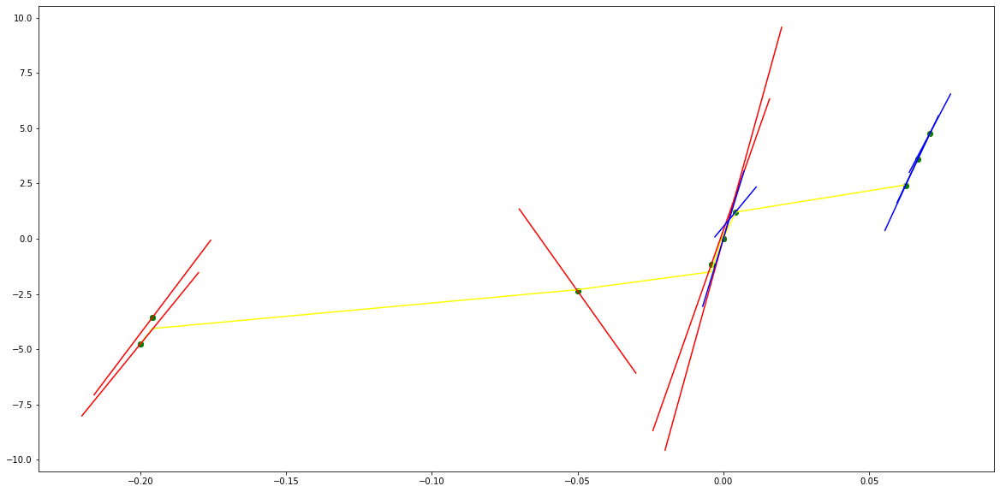

parameters (7299.852137398667, 11984.60259022012, 6808.027275901848, 1562.173157659069, 134.31338907442134, 0.21876365973754405)
tangent[0]:37.767871040799804
tangent[1]:51.132139330304796
tangent[2]:59.399612027817554
tangent[3]:68.23500219560096
tangent[4]:134.31338907442134
parameters (-2051656.2600987456, 787842.8661814706, -74582.80027172915, -1476.7631720063002, 312.0708057551929, -0.010581473233998367)
tangent[0]:312.0708057551929
tangent[1]:296.10324467257215
tangent[2]:273.69020897457654
tangent[3]:-163.1220197233846
tangent[4]:277.3266208864863


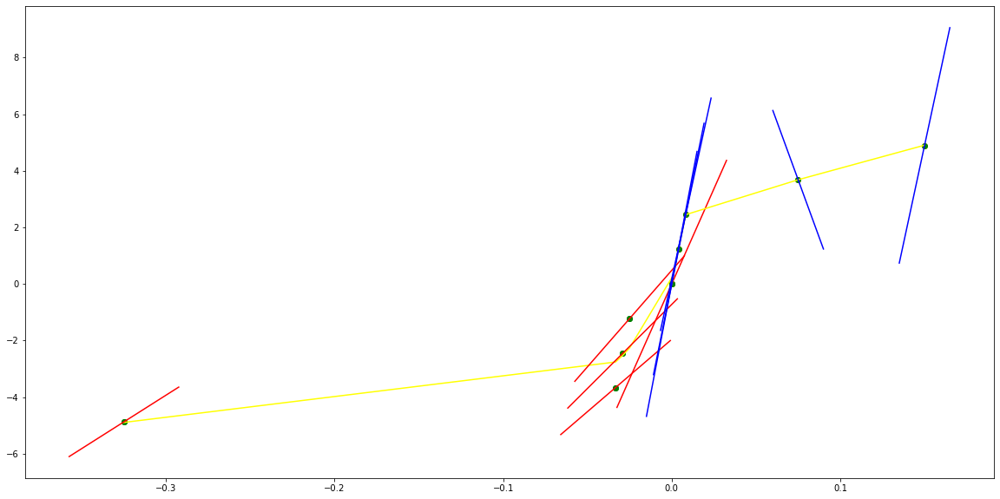

parameters (-18302789.974077713, -7618558.426469882, -1107306.2700166877, -66262.61356214948, -1295.467812544507, 6.874349737193598e-05)
tangent[0]:215.53109638886326
tangent[1]:263.3135450902955
tangent[2]:330.54523803707434
tangent[3]:387.80593350523986
tangent[4]:-1295.467812544507
parameters (20456551.71184667, -7574761.586299162, 970463.8275718886, -48131.497347735, 715.2061042897785, -0.17256998836731363)
tangent[0]:715.2061042897785
tangent[1]:362.4698253020709
tangent[2]:98.17147601676857
tangent[3]:280.1686916821509
tangent[4]:238.7348979322851


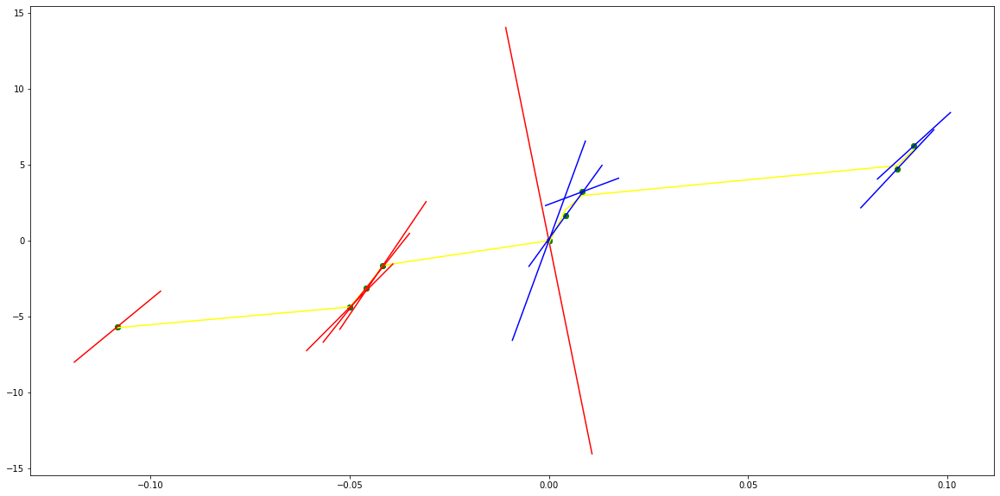

parameters (0.6559355391777224, 4.732413353242528, 12.683616070999351, 15.991912531230287, 12.495291448403366, 0.014626212461189454)
tangent[0]:2.936363992798798
tangent[1]:5.725845525775597
tangent[2]:5.782629833522289
tangent[3]:5.840185016021524
tangent[4]:12.495291448403366
parameters (2174.306186540294, -10133.970745030954, 16806.288002699384, -11498.667221485062, 2635.591773225899, 9.047578359047584e-07)
tangent[0]:2635.591773225899
tangent[1]:-720.4297379144841
tangent[2]:364.2504379366169
tangent[3]:-91.46419009787269
tangent[4]:169.33158824502834


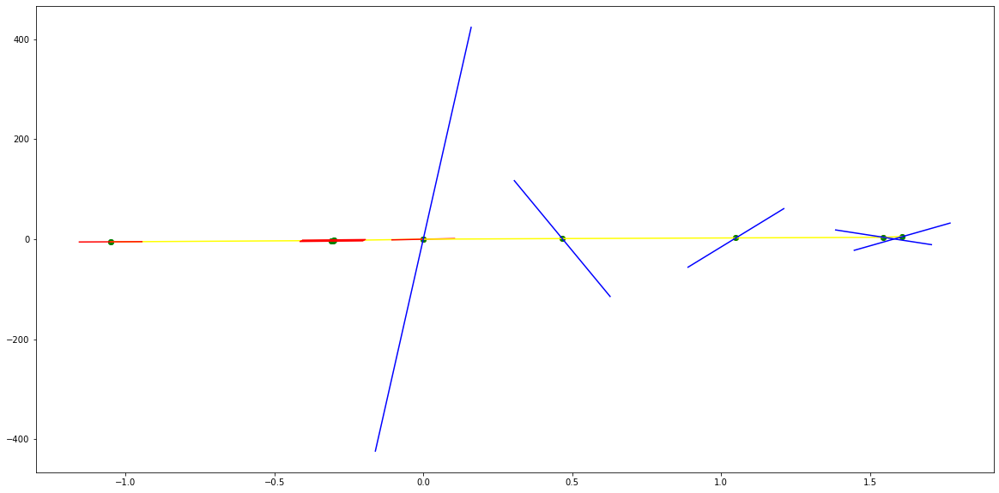

parameters (-107181.02254928903, -194211.24914180915, -85070.32933048843, -4681.622227870853, 166.40117834633392, -0.1753048526738631)
tangent[0]:257.62367518167997
tangent[1]:255.11896327246978
tangent[2]:245.0692089324425
tangent[3]:201.04241002102765
tangent[4]:166.40117834633392
parameters (2396986.9121506275, -1475997.3435791992, 256746.89378753034, -16432.144738550473, 398.703076072829, -0.03424861901302047)
tangent[0]:398.703076072829
tangent[1]:274.7083839568996
tangent[2]:-38.19933455815459
tangent[3]:138.8411250032455
tangent[4]:165.73064609973204


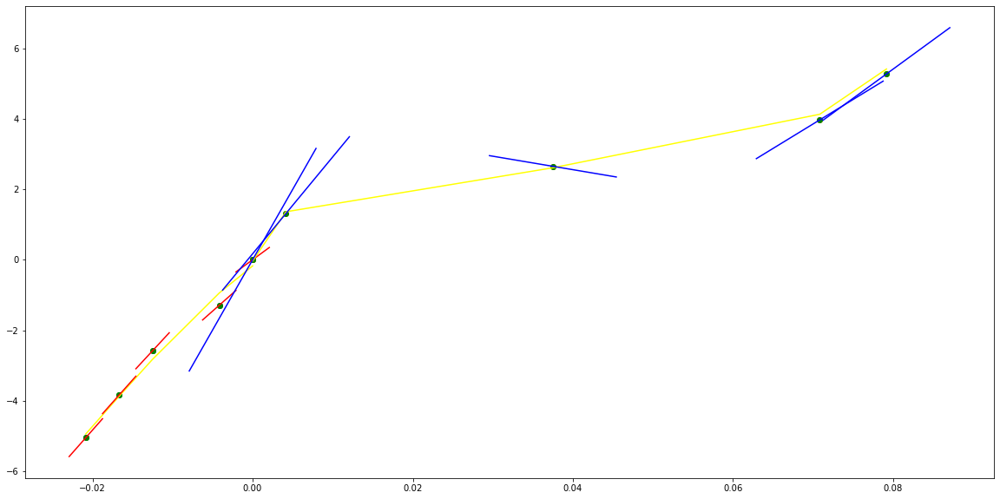

parameters (0.02489924844780853, 0.20769684851686604, 0.5714364890671191, 0.6363499561625575, 1.9999065010580508, 0.006003704465181079)
tangent[0]:1.272357423377228
tangent[1]:1.6437096653122185
tangent[2]:1.7737029905318975
tangent[3]:1.6915742134930316
tangent[4]:1.9999065010580508
parameters (-84282.27315124257, 523375.30939999357, -1188585.6123058416, 1157941.4517514815, -400837.5320399095, -3.128086412917916e-09)
tangent[0]:-400837.5320399095
tangent[1]:64133.26099421235
tangent[2]:-93.02841386327054
tangent[3]:155.5145062232623
tangent[4]:194.23373637872282


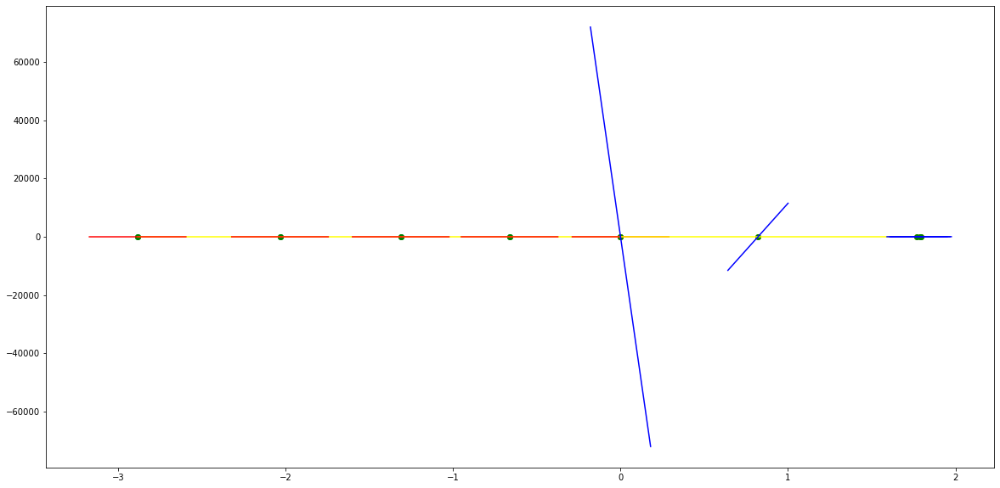

parameters (9.9055242711461e-05, -0.025701024264358534, -0.2634553255079082, -0.840130288918904, 0.7451166270601297, -0.002183950825519969)
tangent[0]:1.5254730575578173
tangent[1]:1.7410164886561483
tangent[2]:1.836402587616221
tangent[3]:1.6488882380720047
tangent[4]:0.7451166270601297
parameters (1318154.4508516921, -5287449.111808002, 7946769.80659405, -5303839.388397127, 1326370.4134169053, 3.292722539913596e-09)
tangent[0]:1326370.4134169053
tangent[1]:-126.70870968699455
tangent[2]:165.6526788622141
tangent[3]:191.7078048363328
tangent[4]:181.33101915940642


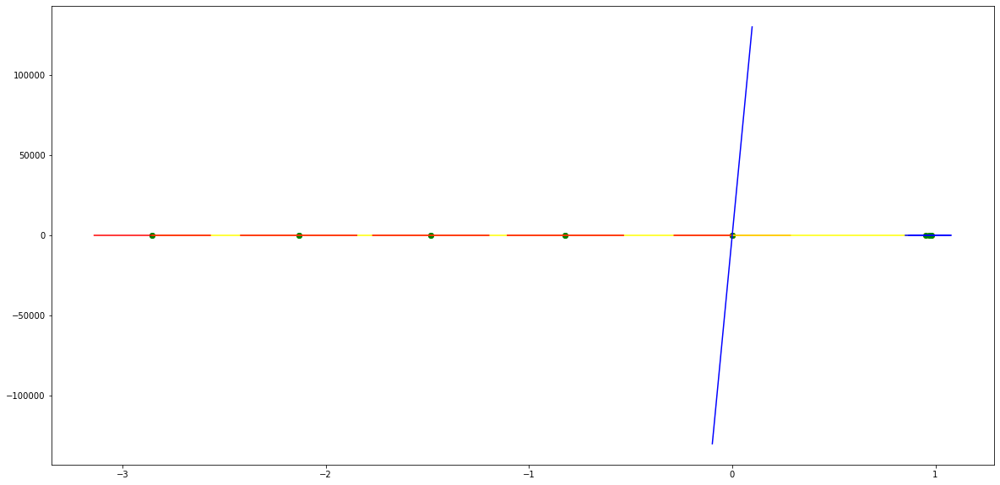

parameters (0.2705429726513142, 2.7963190939636315, 10.347198114409567, 16.12665514912007, 10.648186853682212, -0.9028784055914432)
tangent[0]:2.124952557181331
tangent[1]:-0.43462129410351125
tangent[2]:9.861080851151597
tangent[3]:10.381569047129284
tangent[4]:10.648186853682212
parameters (2391.3021562758163, -11414.050437111602, 14698.23199481941, -2804.2120148374865, 180.57154441529048, 0.2838225756714718)
tangent[0]:180.57154441529048
tangent[1]:157.96359702580432
tangent[2]:136.87207308477346
tangent[3]:67.21142102340703
tangent[4]:24.622904179816317


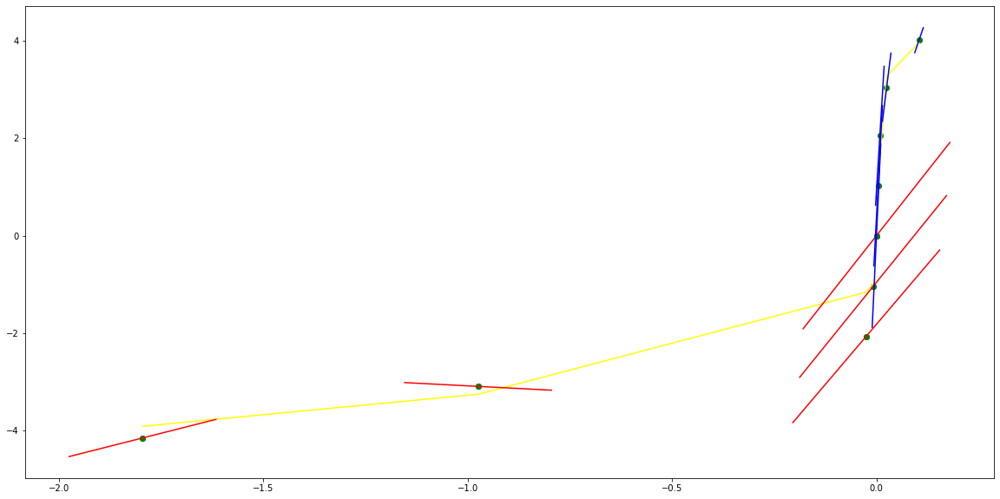

parameters (7.045879195586368e-05, 0.001931687588927854, 0.02136838510966347, 0.11853193191357562, 0.7600158485245915, -0.0010999191910794866)
tangent[0]:0.43662143472012416
tangent[1]:0.43170543402302786
tangent[2]:0.4399791541956756
tangent[3]:0.5158397170241159
tangent[4]:0.7600158485245915
parameters (5.890081779046981, -61.14481538150921, 215.3408089528264, -286.8275301890319, 108.88027799065219, 0.2918768918730159)
tangent[0]:108.88027799065219
tangent[1]:106.50105712803564
tangent[2]:97.20749893163159
tangent[3]:-49.729623244212746
tangent[4]:60.55532210533772


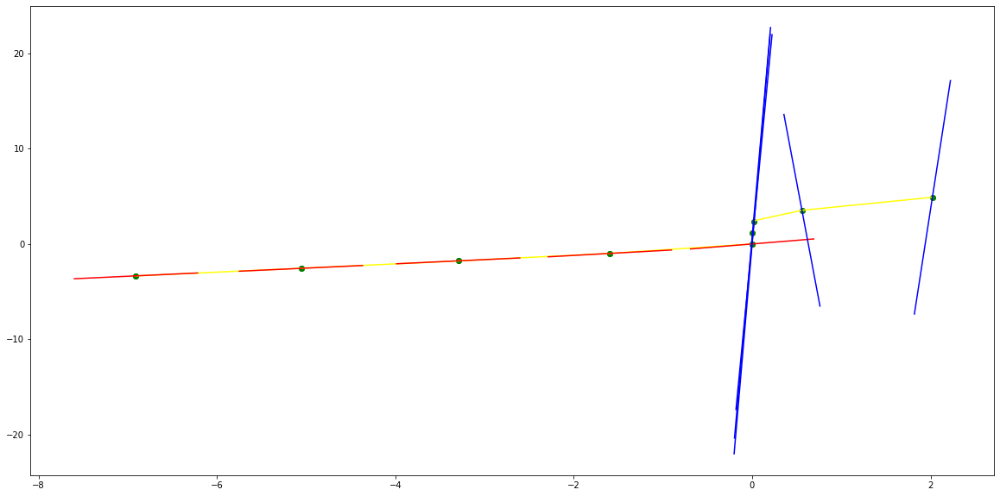

parameters (-0.037335356121821, -0.6836042706670546, -4.421572742517179, -11.659223517145087, -8.655386337718262, -0.00084176505790946)
tangent[0]:3.750135113313462
tangent[1]:3.762427594601654
tangent[2]:3.811142992256002
tangent[3]:4.775490266694849
tangent[4]:-8.655386337718262
parameters (1018694.9412321235, -7991199.715445062, 23482385.070825614, -30632844.13880642, 14966623.462253401, -8.429369702178806e-08)
tangent[0]:14966623.462253401
tangent[1]:-31502.534446319565
tangent[2]:437.0494779590517
tangent[3]:305.9756108317524
tangent[4]:221.7665891740471


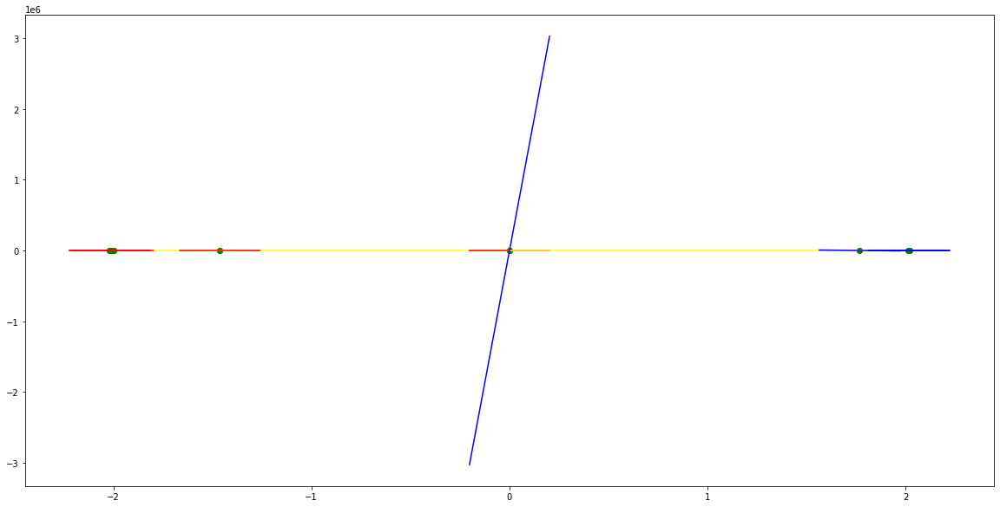

parameters (603396936.639591, 102291260.89547555, 6224227.1510106, 158906.98044125596, 1985.8058426150078, 0.23530258015787256)
tangent[0]:709.8391884237903
tangent[1]:632.1509834469148
tangent[2]:205.24418549106304
tangent[3]:957.0098006883588
tangent[4]:1985.8058426150078
parameters (3693812.310518177, -1574884.2691371767, 252540.30958995046, -17490.23199503035, 705.5883928390383, 1.1720603116936374)
tangent[0]:705.5883928390383
tangent[1]:572.5298085560289
tangent[2]:170.85999260372319
tangent[3]:178.60701539573643
tangent[4]:296.91599873899463


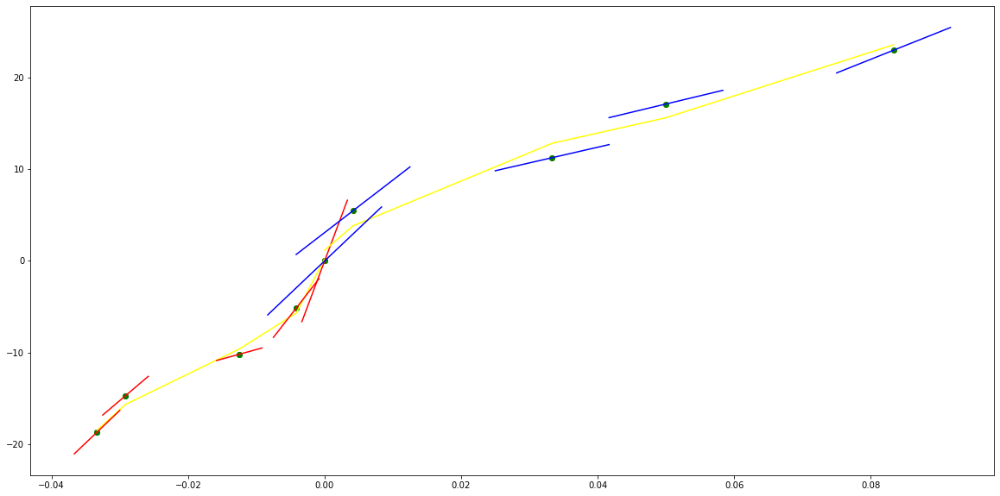

parameters (8225.760789873875, 9558.270761753984, 3989.710400927802, 621.1971267755991, 129.2222830413, -0.0019636725296907835)
tangent[0]:126.38654398060515
tangent[1]:117.09869012527886
tangent[2]:96.30789796638945
tangent[3]:90.36457902749274
tangent[4]:129.2222830413
parameters (9624394.56015111, -3247177.3688273835, 147985.45382228537, -3746.3353944422315, 1456.1922575654542, -0.0003284852053954715)
tangent[0]:1456.1922575654542
tangent[1]:1431.7582697673272
tangent[2]:1417.2999886345158
tangent[3]:1407.7083338412117
tangent[4]:1398.2175747628582


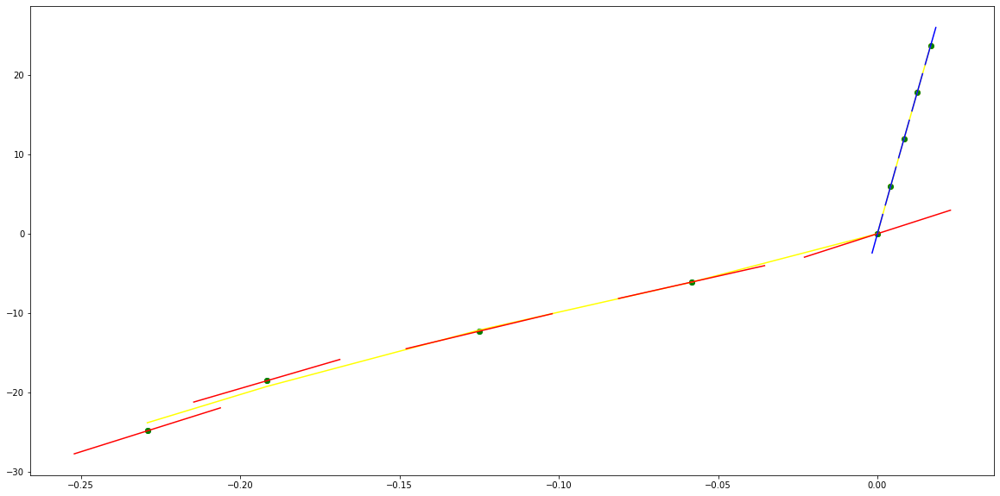

parameters (-3763984.248451488, -1532808.1319229994, -207017.54852760487, -10599.350127875181, -127.51605351743973, 0.004518677428008815)
tangent[0]:223.269161530516
tangent[1]:198.73008733280295
tangent[2]:-39.89501367523502
tangent[3]:100.96095747802678
tangent[4]:-127.51605351743973
parameters (155151975.98086414, -28280478.86352368, 1789988.8423400552, -45259.10011129354, 444.3911497920133, -0.0727485865537526)
tangent[0]:444.3911497920133
tangent[1]:152.49423436795888
tangent[2]:1.2718082914763613
tangent[3]:161.77317987314683
tangent[4]:170.15602542368225


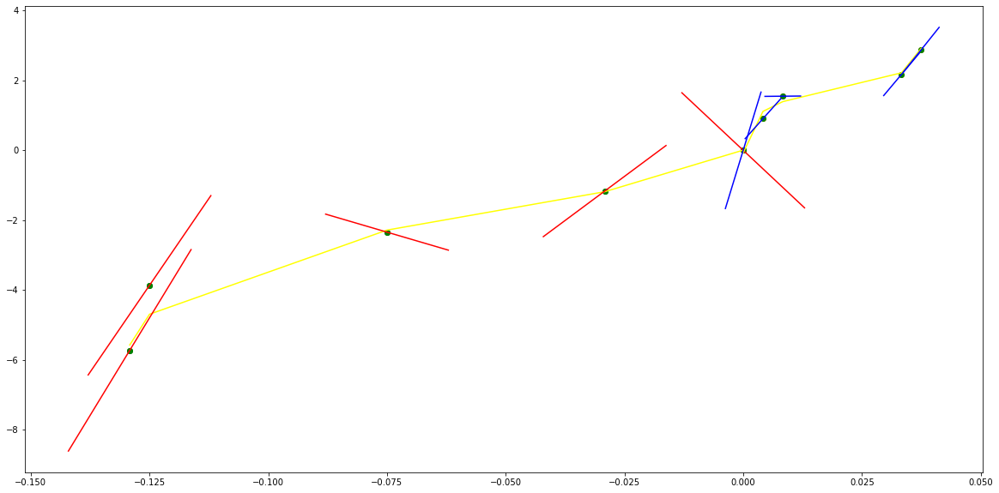

parameters (25686503.4840139, 8216140.051025626, 899153.9921948634, 36391.41142400596, 333.25385228074134, -0.0007292609151877162)
tangent[0]:128.9906954122594
tangent[1]:175.25206275216675
tangent[2]:215.7710570219229
tangent[3]:74.46705686652865
tangent[4]:333.25385228074134
parameters (23590768.174471118, -6445789.822487925, 564273.8170263114, -17162.58416364258, 224.23714761846097, 0.07510982744886566)
tangent[0]:224.23714761846097
tangent[1]:108.76814972059933
tangent[2]:108.79489039146605
tangent[3]:151.66444020892865
tangent[4]:191.17303814096428


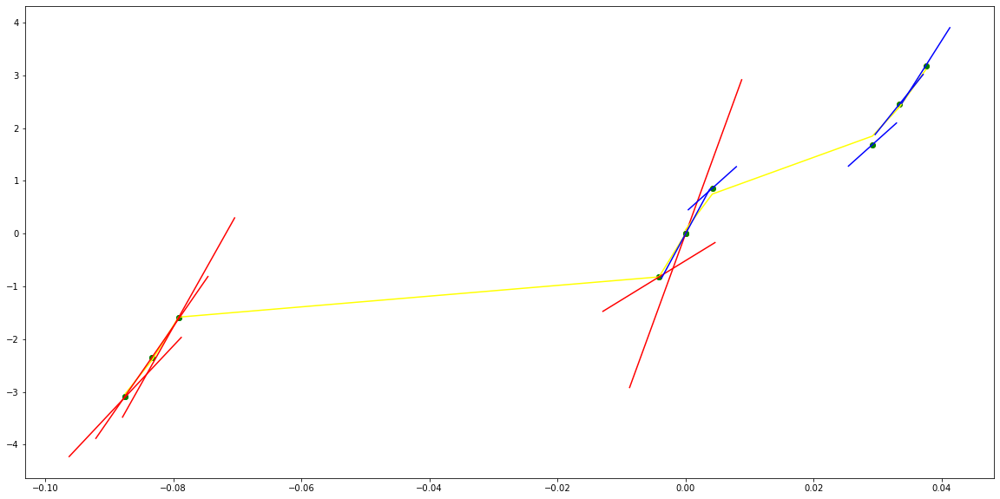

parameters (-11.858657222743153, -51.60979599221082, -79.24827335787501, -51.13669303871763, -4.426544725070776, -0.00011102566097278566)
tangent[0]:8.470833419653808
tangent[1]:6.621342170670624
tangent[2]:8.731657370531693
tangent[3]:10.199122806275959
tangent[4]:-4.426544725070776
parameters (-2180.132608566947, 4558.251304936597, -3280.795245169317, 947.1384890525238, -79.19863319782927, -0.0005534677459889513)
tangent[0]:-79.19863319782927
tangent[1]:36.672389153326336
tangent[2]:-4.103053320383864
tangent[3]:50.66934384764012
tangent[4]:51.856153399756195


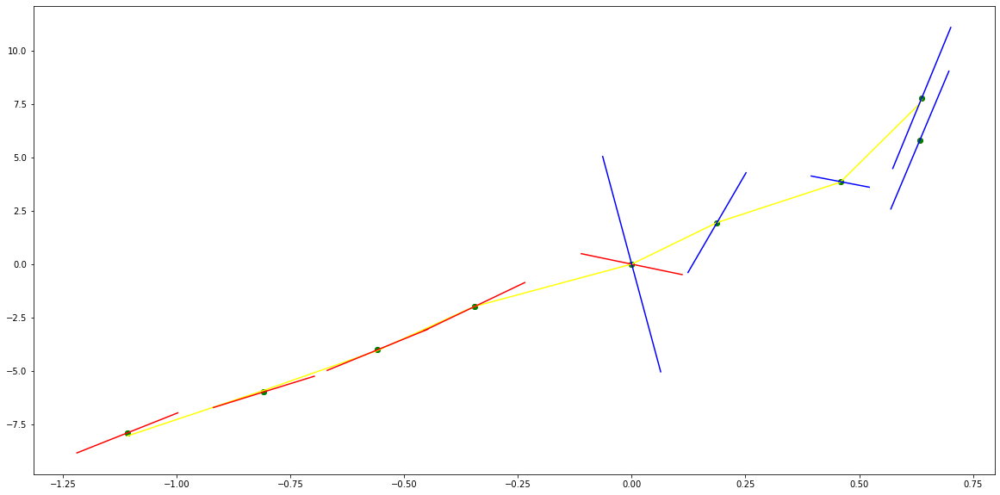

parameters (5.553923074433657, 32.15845404238855, 67.10542344302837, 60.11525726587409, 25.46285718298403, -0.7945355993127635)
tangent[0]:5.553184592744337
tangent[1]:1.416960401072707
tangent[2]:12.714968993499713
tangent[3]:24.965461522970315
tangent[4]:25.46285718298403
parameters (5830839.6376247555, -2898853.435408393, 491860.627722088, -31324.983823044688, 526.4376034834107, 0.018872033423062734)
tangent[0]:526.4376034834107
tangent[1]:290.1668285227766
tangent[2]:313.71207175542474
tangent[3]:289.6690429208878
tangent[4]:258.63258621372495


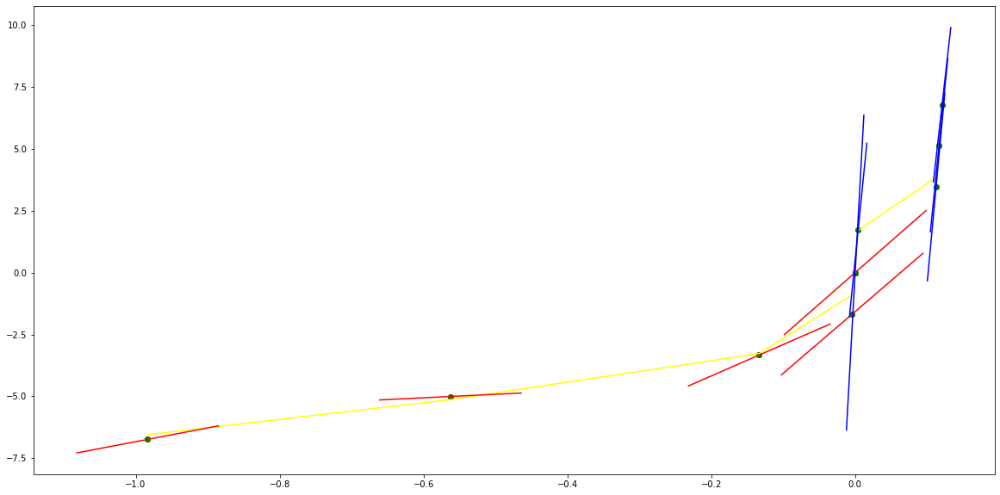

parameters (0.25668444378608996, 1.3936642883165993, 2.8072038179541834, 2.3380911215829636, 3.6920692407463673, -0.00046275697677534793)
tangent[0]:3.3336400168949605
tangent[1]:3.2319271752126757
tangent[2]:3.015434279050981
tangent[3]:2.8507407730839462
tangent[4]:3.6920692407463673
parameters (-7486.6214055879545, 27600.801604863736, -35868.821206658264, 18924.197825705975, -3235.6834571453655, -2.1003145208735732e-06)
tangent[0]:-3235.6834571453655
tangent[1]:1061.6320212970877
tangent[2]:-616.7889285887468
tangent[3]:229.3322757193091
tangent[4]:206.19915717731055


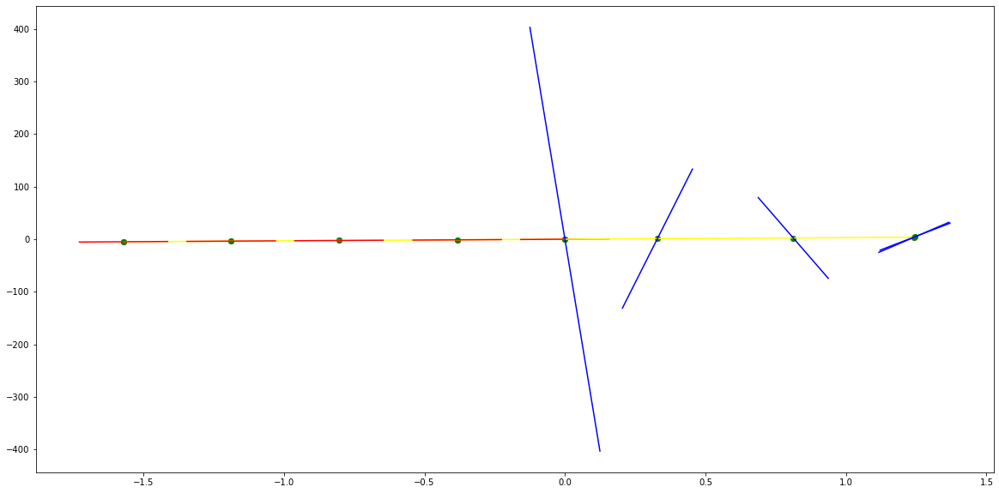

parameters (0.8669889673725337, 5.5951089093655515, 12.889644729825763, 12.569141913921156, 7.705477744466608, -0.5917554591571351)
tangent[0]:3.5722732527190733
tangent[1]:2.9768241126173702
tangent[2]:2.405136849632026
tangent[3]:7.601396340800305
tangent[4]:7.705477744466608
parameters (16230065.126524407, -5482016.701153053, 568017.3217333131, -18046.712741446037, 255.26733815078347, 0.18057586000133713)
tangent[0]:255.26733815078347
tangent[1]:132.89285812692717
tangent[2]:166.8245860098446
tangent[3]:233.57371306118267
tangent[4]:302.20199957837855


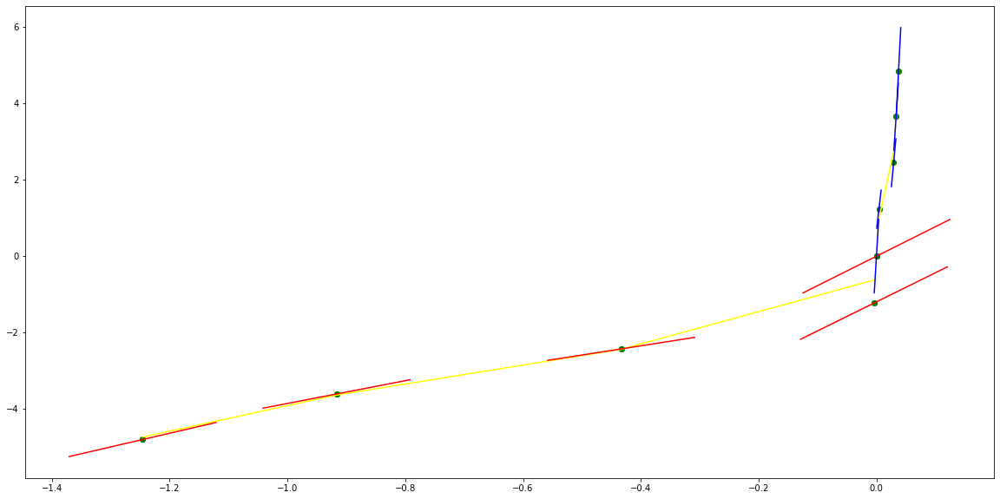

parameters (-0.07366229411074339, -0.5435421541865232, -1.3361255688043638, -1.2807331012501129, 2.251145799073536, 0.009488929550429149)
tangent[0]:2.773400750417242
tangent[1]:2.543967002295534
tangent[2]:2.651149599667654
tangent[3]:2.7785120393042044
tangent[4]:2.251145799073536
parameters (270902.58321839024, -1028862.7316426109, 1425998.7042389116, -844743.6792832733, 176552.94664116585, 2.1402696509438375e-09)
tangent[0]:176552.94664116585
tangent[1]:-31407.79730057149
tangent[2]:411.6686648685427
tangent[3]:299.0401609224209
tangent[4]:200.9353987943323


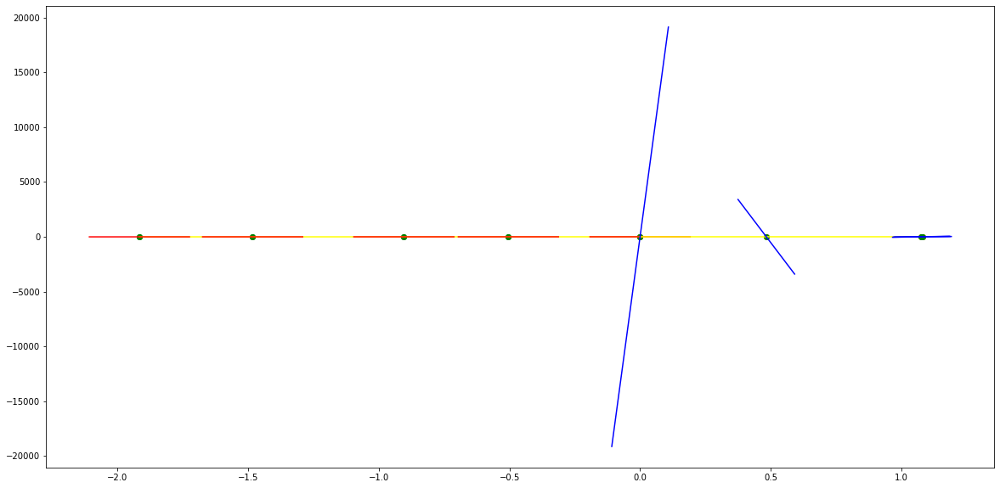

parameters (0.015256110333728217, 0.06906087565922955, -0.03921774576401756, -0.543302572172486, 1.8828161281564386, -0.0006673825544334677)
tangent[0]:2.601349324919391
tangent[1]:2.6918587284583952
tangent[2]:2.6736475187000783
tangent[3]:2.436668909042751
tangent[4]:1.8828161281564386
parameters (6630098.04972502, -3330938.579854642, 507752.82043481804, -25941.62336496858, 482.6334827745732, -0.09041582993609819)
tangent[0]:482.6334827745732
tangent[1]:291.9715091708173
tangent[2]:148.51402592349865
tangent[3]:238.3385736654364
tangent[4]:309.4412233469507


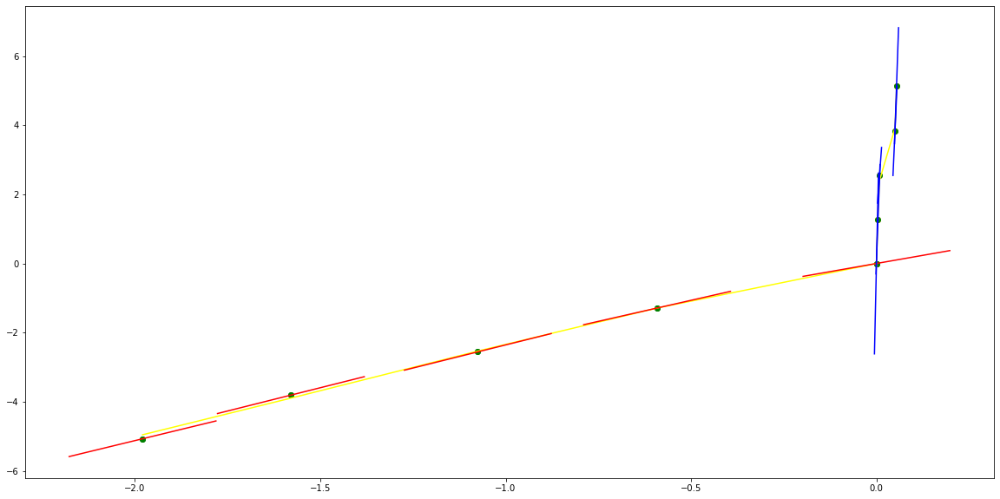

parameters (-2710.3086101084054, -9325.043494392, -10128.784603233027, -3534.145496679657, -89.3587171985201, -0.7337139381882749)
tangent[0]:210.16123558401677
tangent[1]:192.66777254832806
tangent[2]:174.30219824248184
tangent[3]:-60.436896143631685
tangent[4]:-89.3587171985201
parameters (180861.81600904412, -165348.00574834208, 55026.044355670776, -7733.088117751126, 399.7566609550679, -0.10460466982847516)
tangent[0]:399.7566609550679
tangent[1]:338.12792037893524
tangent[2]:-61.17795376161666
tangent[3]:64.94696671868564
tangent[4]:63.93777327698376


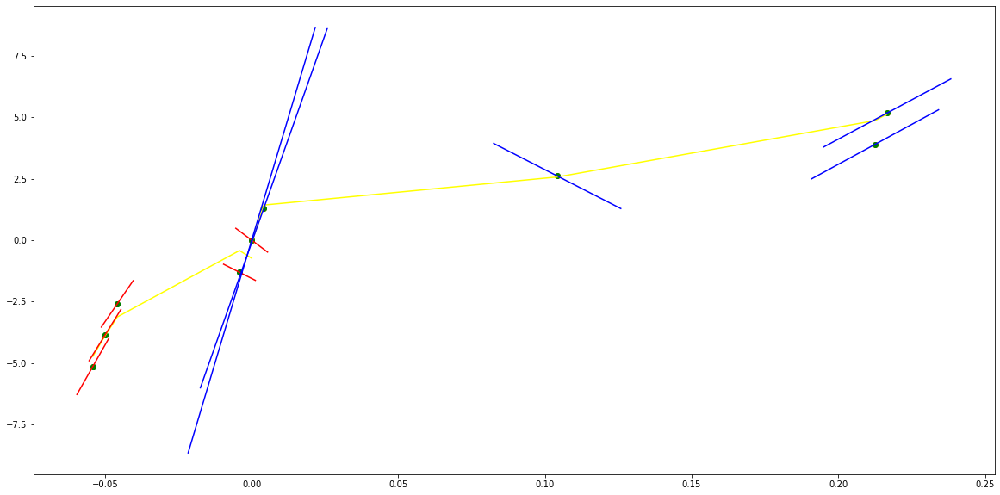

parameters (-12.513074421953181, -80.92057126905272, -185.3514774217433, -177.41847006515522, -57.453524848403376, -8.898464597183038e-05)
tangent[0]:16.5939530797058
tangent[1]:12.013305554215677
tangent[2]:-3.4092393197308724
tangent[3]:11.99725102048815
tangent[4]:-57.453524848403376
parameters (-836.0654846799201, 3679.7593522636007, -5682.667190890653, 3702.379223202439, -863.0840694387678, -6.0921996164952585e-05)
tangent[0]:-863.0840694387678
tangent[1]:58.09784415211902
tangent[2]:43.22933260884042
tangent[3]:-5.183227762962588
tangent[4]:102.87346676446418


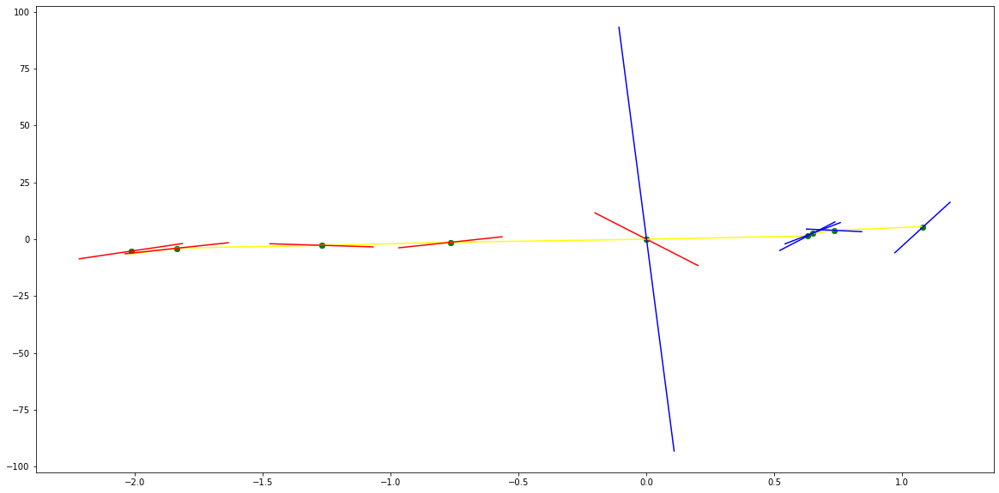

parameters (0.2592102175654479, 1.368084905109063, 3.0445459798944965, 3.17178055428249, 3.1094127624604497, 0.00037495611527185897)
tangent[0]:5.614469604944654
tangent[1]:5.451688036286136
tangent[2]:2.0985202486232244
tangent[3]:1.5735720226436416
tangent[4]:3.1094127624604497
parameters (-5866.996127619078, 31549.04190137146, -63139.06808568439, 55700.334717749894, -18258.324671667837, -2.017307043593939e-08)
tangent[0]:-18258.324671667837
tangent[1]:395.07286173441753
tangent[2]:-47.164293312915106
tangent[3]:63.78301398286203
tangent[4]:72.30027129712471


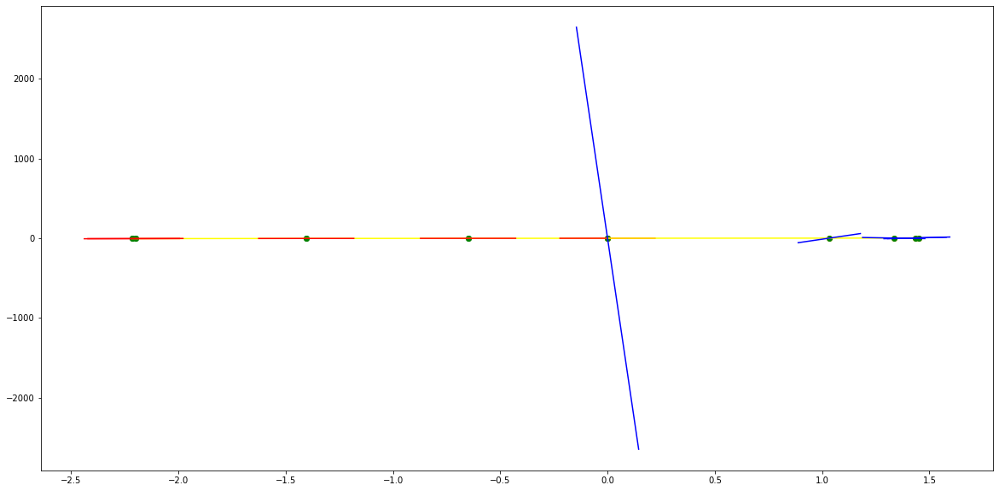

parameters (0.3401396859393006, 3.2066172560122586, 10.895781614852266, 15.968813648923355, 10.973105131355398, -0.10284208661074534)
tangent[0]:2.3662343462031163
tangent[1]:1.7582308514837965
tangent[2]:2.6506732496068945
tangent[3]:8.093559450835215
tangent[4]:10.973105131355398
parameters (359659.0761779157, -150203.9552783821, 18247.734762564356, -865.1619101748776, 85.81056311053398, -0.006413134718810953)
tangent[0]:85.81056311053398
tangent[1]:69.53535673270225
tangent[2]:68.92650393737435
tangent[3]:72.28975130364769
tangent[4]:71.26104983610372


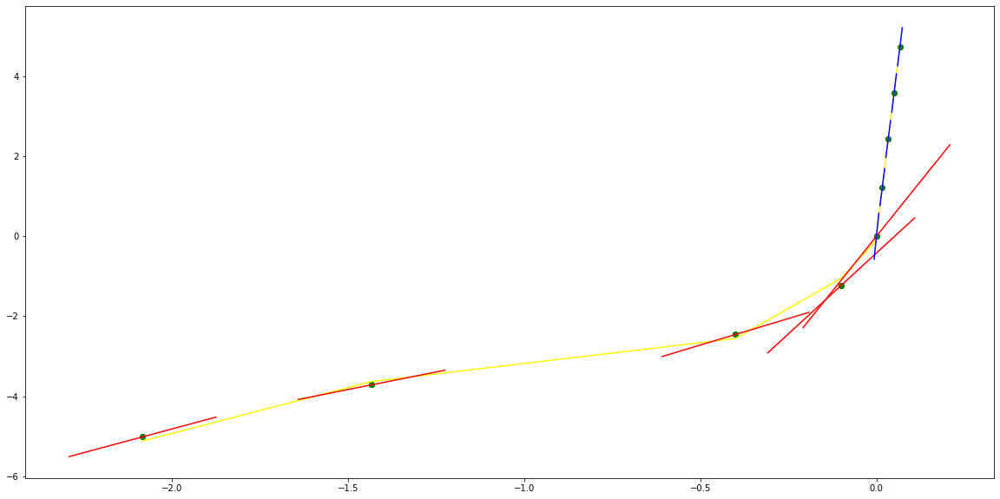

parameters (16.726101678219145, 38.47495648378705, -35.100791661020956, -90.1005044983134, 3.5713063935847695, 0.013948388532607011)
tangent[0]:-15.493213429903527
tangent[1]:31.67812625049728
tangent[2]:24.170914916110846
tangent[3]:21.673192455860015
tangent[4]:3.5713063935847695
parameters (6580127.381632766, -2989907.658629234, 463887.87429193035, -27166.20677596048, 441.8158073017646, -0.10741399612628118)
tangent[0]:441.8158073017646
tangent[1]:238.76525844107726
tangent[2]:78.93776791354901
tangent[3]:255.64373716702607
tangent[4]:238.61114377634635


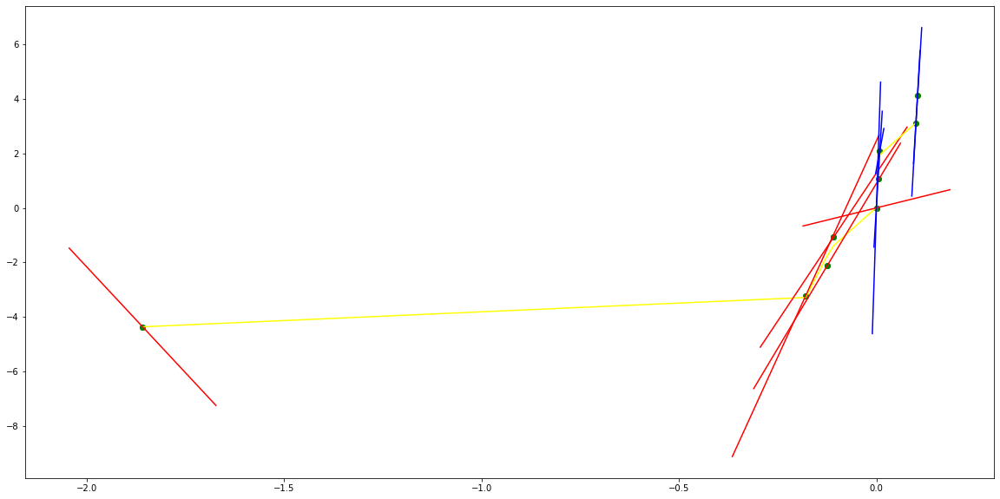

parameters (-739555.7443965167, -567072.1552091121, -146938.60451937895, -14301.7899498954, -356.1650001895974, 2.102351579429083e-05)
tangent[0]:251.594782582631
tangent[1]:232.39942149676557
tangent[2]:230.8897111759356
tangent[3]:223.28443879933633
tangent[4]:-356.1650001895974
parameters (8696270.470643517, -3416599.296276685, 452615.2731647087, -22713.58001671967, 388.243095312396, -0.08242071341861543)
tangent[0]:388.243095312396
tangent[1]:221.54987675516966
tangent[2]:96.28768685813111
tangent[3]:204.22575419972804
tangent[4]:220.8949581496247


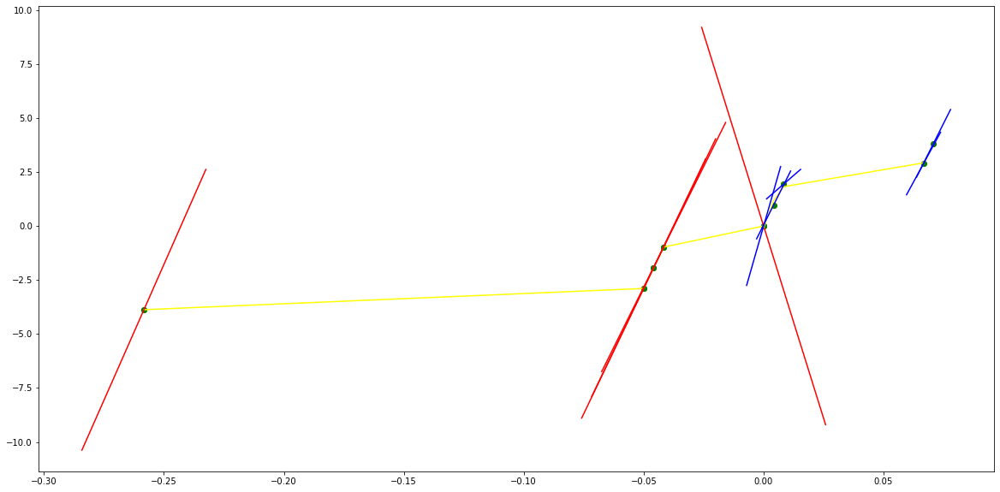

parameters (0.0009409044253989903, 0.019762907250188737, 0.14488059664731984, 0.42681844613508396, 0.5424600232303673, 0.0010186279492531071)
tangent[0]:0.3351170897667084
tangent[1]:0.08827129103725384
tangent[2]:0.2275083001521645
tangent[3]:0.016975915795878427
tangent[4]:0.5424600232303673
parameters (-811.6696665962367, 7726.210606100127, -27495.93672072562, 43346.398634581084, -25532.327234597557, -2.675337063679797e-10)
tangent[0]:-25532.327234597557
tangent[1]:197.84022650151746
tangent[2]:-5.122853095235769
tangent[3]:8.982080642483197
tangent[4]:9.430836865241872


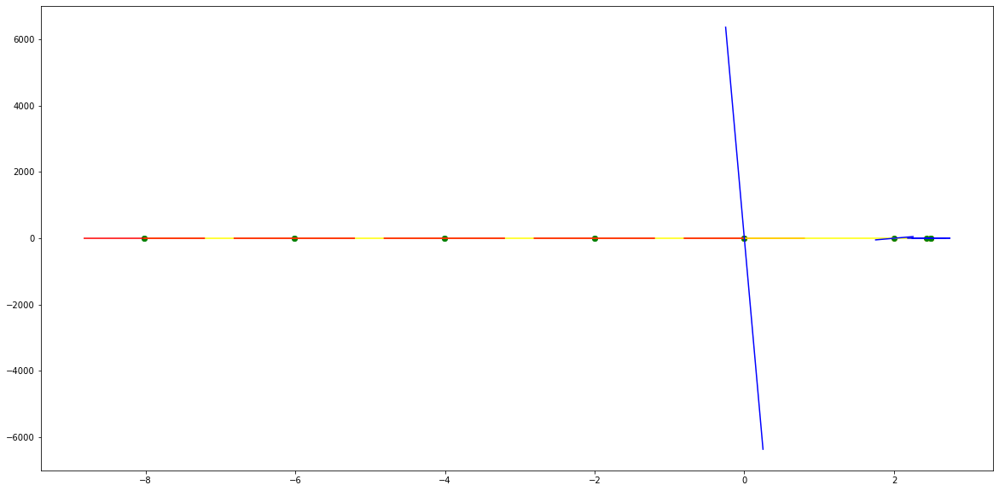

parameters (0.0001359995374931831, 0.003832556910296246, 0.03876321687256804, 0.1644078650041323, 0.38630938190433717, -0.011117530356036763)
tangent[0]:0.16675286777876408
tangent[1]:0.14120171978788598
tangent[2]:0.07771697649740184
tangent[3]:0.26542276585949354
tangent[4]:0.38630938190433717
parameters (-580717.1277553503, 292923.05947873084, -52834.513754971944, 3986.9252484077288, -101.93707663154287, -0.00018956924500020442)
tangent[0]:-101.93707663154287
tangent[1]:22.806466193312545
tangent[2]:19.02659583854502
tangent[3]:15.005739306912076
tangent[4]:-0.13275064535154968


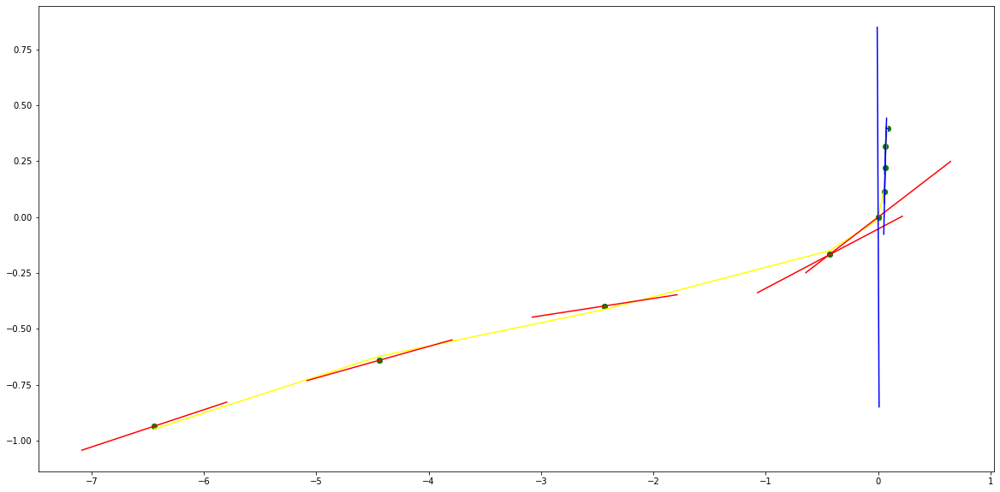

parameters (0.23655621912887861, 3.5140774180190175, 18.95470080258097, 43.38271119333864, 34.69821712092587, -2.395068977977156e-07)
tangent[0]:1.4027173759175966
tangent[1]:1.4190608255453512
tangent[2]:1.435370757958502
tangent[3]:-6.836945199715281
tangent[4]:34.69821712092587
parameters (54.94337182513501, -577.4717742882071, 2168.7248682665218, -3498.5431228442885, 2063.028431172195, -2.9801711425702353e-08)
tangent[0]:2063.028431172195
tangent[1]:-8.566235578584838
tangent[2]:-7.523131869209919
tangent[3]:9.04210351667598
tangent[4]:9.49793625592747


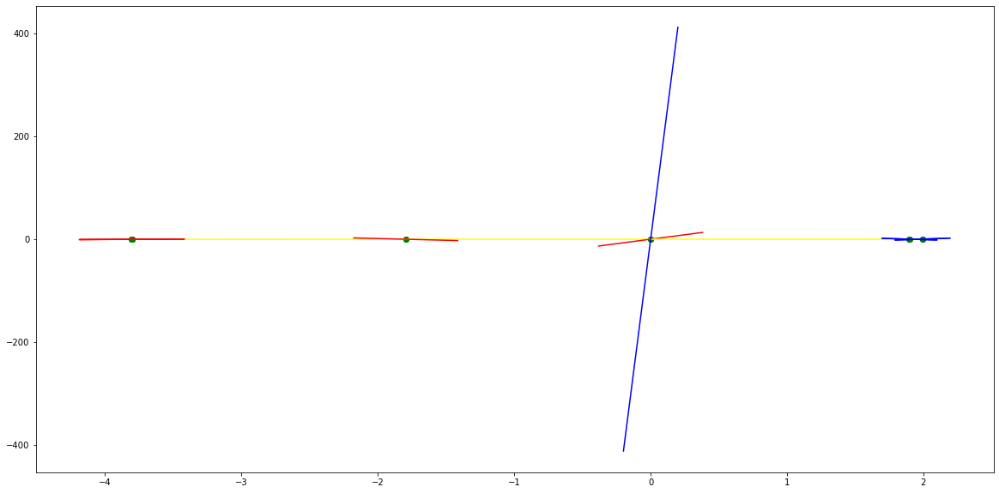

parameters (-0.004541470481190535, -0.07339114989204791, -0.40124775297610654, -0.8487218455142239, -0.5908901749396798, 1.8225783235632913e-06)
tangent[0]:-0.14899713388725266
tangent[1]:-0.14791070848610688
tangent[2]:-0.14681987143547626
tangent[3]:-0.027115350955633888
tangent[4]:-0.5908901749396798
parameters (-135229.34674587485, 484572.94716212177, -651261.0596231419, 389081.4851298291, -87181.49036846941, 0.0)
tangent[0]:-87181.49036846941
tangent[1]:9.005949840851827
tangent[2]:5.129954606149113
tangent[3]:2.2312466602015775
tangent[4]:-1.3891097579908092


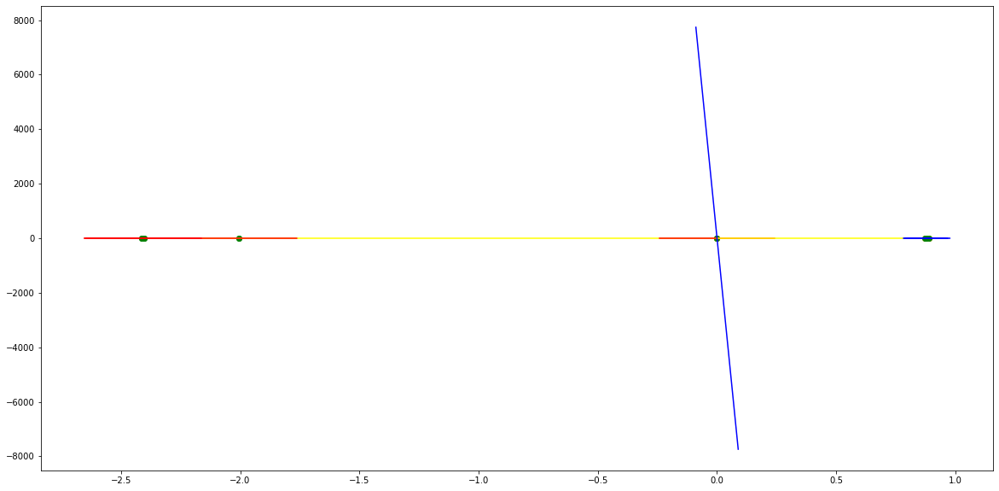

parameters (-383.62827625484863, -502.6375889897937, -234.90574952723412, -40.188911861142024, 21.530175718157217, 0.002222471278299826)
tangent[0]:20.966884885065564
tangent[1]:21.84727430713435
tangent[2]:23.545259560503652
tangent[3]:24.398923421372697
tangent[4]:21.530175718157217
parameters (4518105.179310257, -2644695.3000248717, 548674.0951188673, -47022.98802395913, 1430.5664827091985, 0.001068687509440277)
tangent[0]:1430.5664827091985
tangent[1]:-163.29622951180158
tangent[2]:239.06296507067395
tangent[3]:249.18975667475547
tangent[4]:251.97975079610273


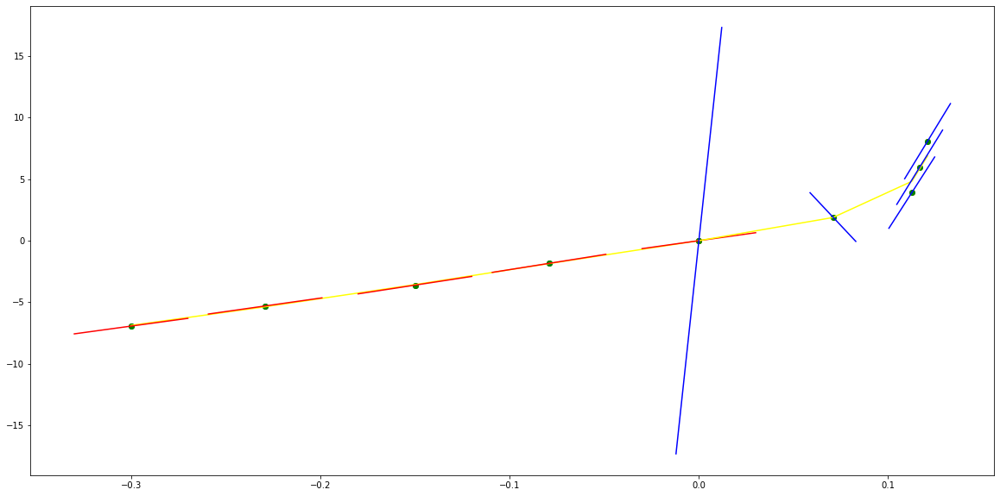

parameters (-0.014066405888909457, -0.25605022198152744, -1.6469708798063645, -4.458046531424017, -3.968590319088988, 3.0099741829221946e-06)
tangent[0]:0.1018389260369057
tangent[1]:0.7090034945471695
tangent[2]:1.1614745840317662
tangent[3]:1.1648655310887888
tangent[4]:-3.968590319088988
parameters (1606436.011020725, -6191899.383145995, 8948490.694540149, -5746774.065825359, 1383750.0392913853, -3.951267047896315e-09)
tangent[0]:1383750.0392913853
tangent[1]:59.82287711254321
tangent[2]:53.777164878090844
tangent[3]:44.23858379549347
tangent[4]:33.85309752798639


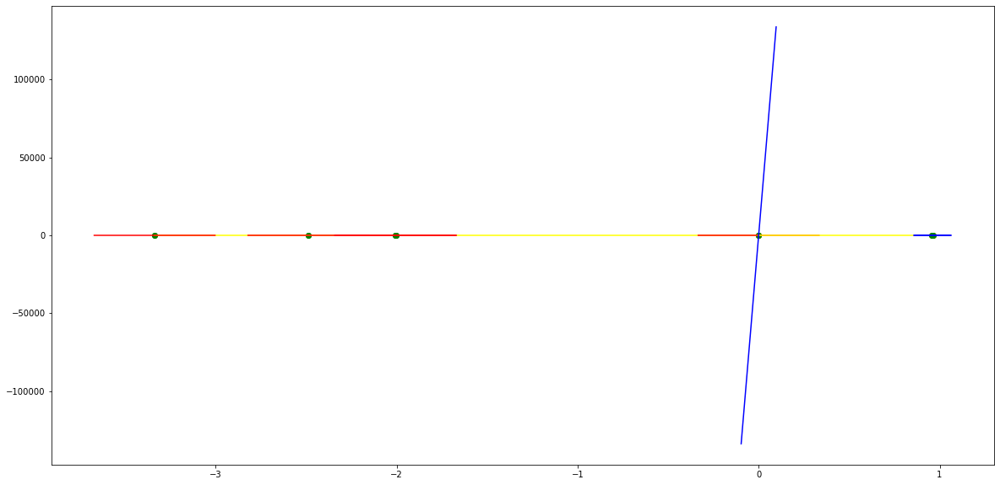

parameters (-0.01724855349994671, -0.3454660257953181, -2.420797344739721, -6.917882458071522, -6.684789195272642, -9.499231607899186e-07)
tangent[0]:-6.757559855871704
tangent[1]:1.6132292886622261
tangent[2]:-1.1788760387904196
tangent[3]:1.6063858782387053
tangent[4]:-6.684789195272642
parameters (9859.66953640768, -23212.95150674915, 20325.565717569272, -7841.752732704901, 1124.202331831269, -8.899836728365093e-09)
tangent[0]:1124.202331831269
tangent[1]:-16.41435831224726
tangent[2]:-13.811696312687218
tangent[3]:-11.368084954059213
tangent[4]:-5.317295385919806


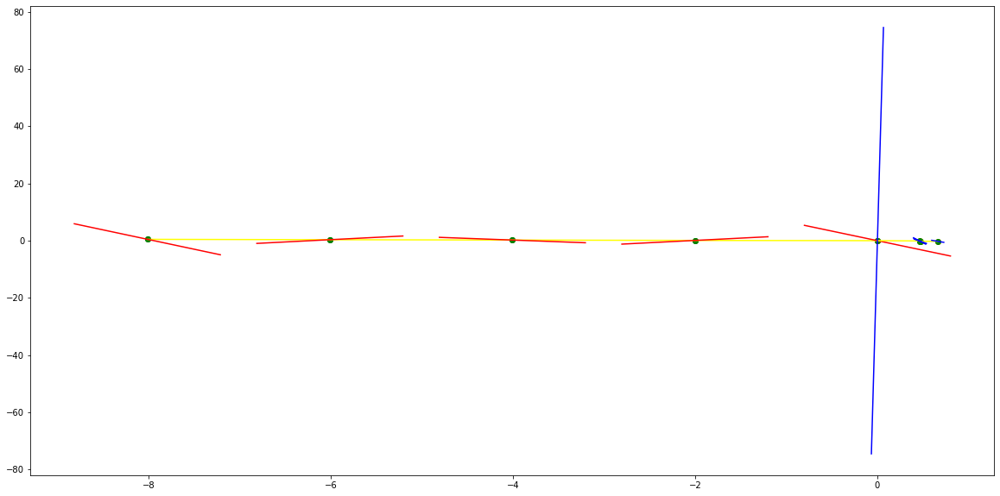

parameters (7458667.606083808, 2414806.4320023768, 271415.97889875737, 12304.322084346526, 220.22656297898232, 0.031081778921494992)
tangent[0]:73.19614596980921
tangent[1]:73.68407734583172
tangent[2]:37.379809511604435
tangent[3]:131.1515169834832
tangent[4]:220.22656297898232
parameters (97960880.65955125, -18339510.291347172, 1127162.4180716176, -26167.672413579578, 263.6290115198859, -0.0238588309119436)
tangent[0]:263.6290115198859
tangent[1]:99.10323231924195
tangent[2]:69.92389797095029
tangent[3]:148.1041949097704
tangent[4]:164.05863976834542


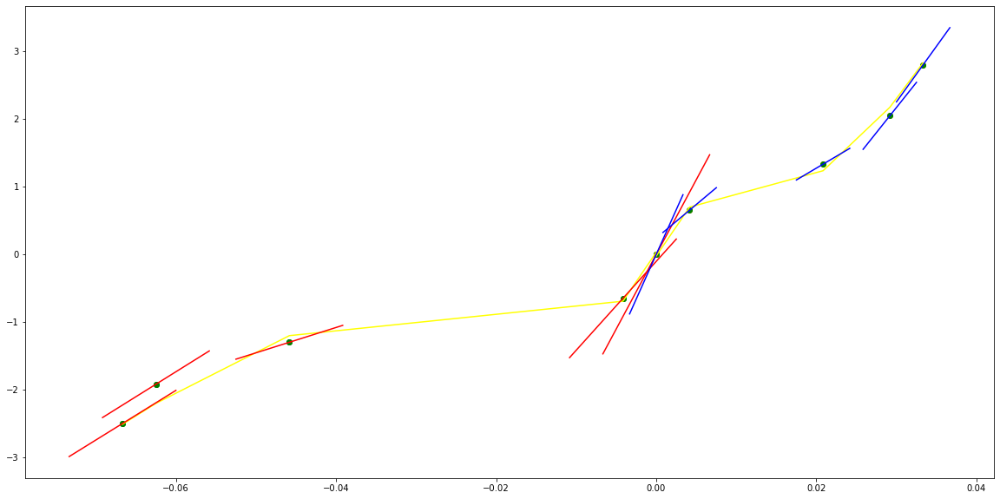

parameters (-0.055475846808041074, -0.9748453508184414, -5.96889127427786, -15.169638782529887, -12.637891112567292, 2.32947009904165e-05)
tangent[0]:5.3891920754137566
tangent[1]:5.368084947731813
tangent[2]:0.763763877562905
tangent[3]:3.184978672543952
tangent[4]:-12.637891112567292
parameters (-116.83765501678819, 2013.0769420208885, -12493.502738839954, 32624.261734707023, -29521.718664698154, -1.728679333454638e-09)
tangent[0]:-29521.718664698154
tangent[1]:6096.60513645715
tangent[2]:-2400.354282416778
tangent[3]:360.919182200716
tangent[4]:334.2207428166621


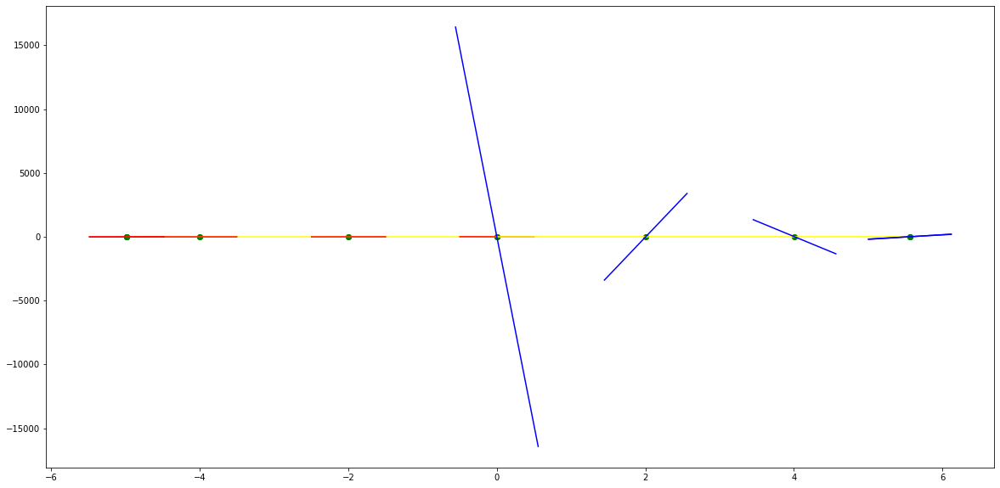

parameters (0.005664368000722732, 0.08635323380355532, 0.4694178604052115, 1.0795689348611597, 1.6187397817024685, -3.0549354394991e-05)
tangent[0]:4.963209616892775
tangent[1]:1.4649145771425445
tangent[2]:0.6582087894782773
tangent[3]:0.6243047482264747
tangent[4]:1.6187397817024685
parameters (111331.7861682402, -1414326.7250683007, 6635831.602279451, -13565479.244253842, 10122721.278298777, 4.214684851089403e-08)
tangent[0]:10122721.278298777
tangent[1]:-851040.4593431316
tangent[2]:504.4461692981422
tangent[3]:349.9962766133249
tangent[4]:258.2425934635103


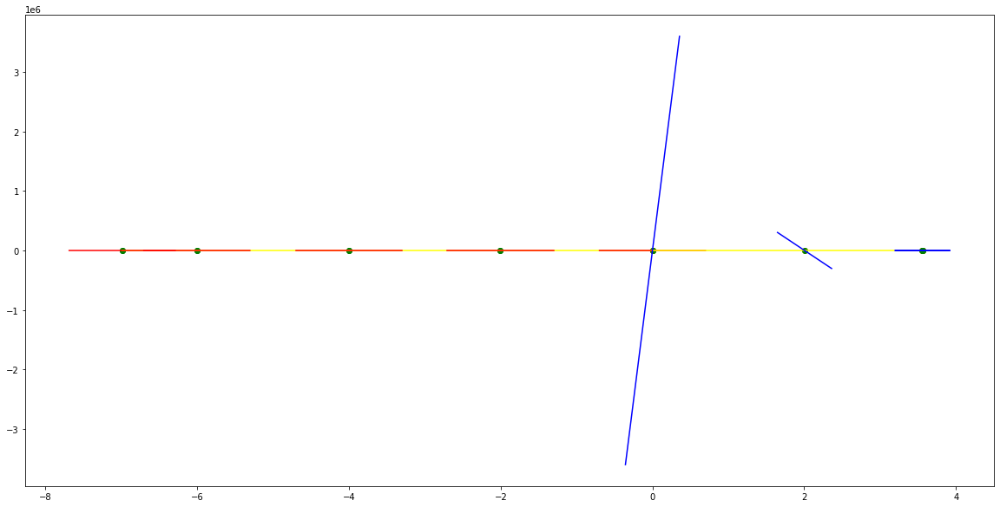

parameters (0.0025069221320612885, 0.050619678580747306, 0.3583035458620296, 1.0398004217471766, 1.7684546076969079, 0.0003484131961994253)
tangent[0]:1.6146125964630558
tangent[1]:0.4961778709494966
tangent[2]:0.8989132416008674
tangent[3]:0.4904197034995159
tangent[4]:1.7684546076969079
parameters (-17971921.83429091, 112706581.39059635, -265048101.6263506, 277017572.0668179, -108570347.21504013, 3.793216365980463e-07)
tangent[0]:-108570347.21504013
tangent[1]:591.06360848248
tangent[2]:329.9915374070406
tangent[3]:226.30657835304737
tangent[4]:301.9275910407305


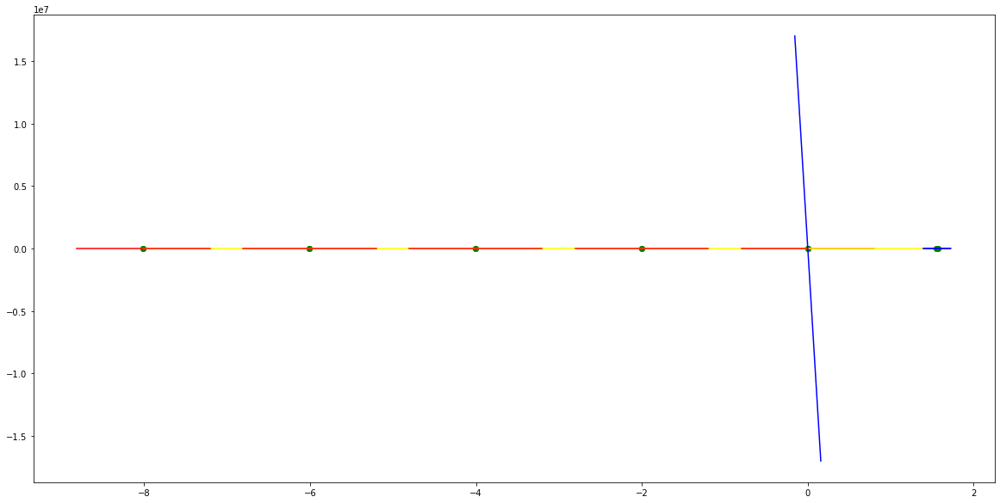

parameters (-26074925.478980567, -8699599.849578835, -929131.9344122714, -32900.501771153846, 23.597683569950934, -0.0028324174790608906)
tangent[0]:-92.07118245366772
tangent[1]:497.0482181205664
tangent[2]:475.3622831162462
tangent[3]:397.8969810140387
tangent[4]:23.597683569950934
parameters (271258805.34870696, -49002344.2950184, 3073174.0490426156, -77507.44784913003, 850.9843250925213, -0.15272046691558633)
tangent[0]:850.9843250925213
tangent[1]:351.4386248015097
tangent[2]:106.16232257652462
tangent[3]:342.5627437152351
tangent[4]:348.5711741966214


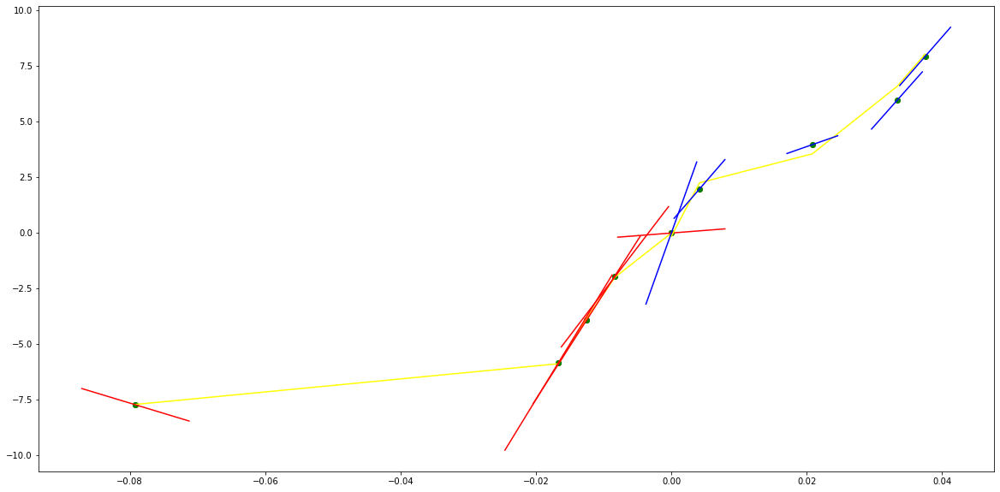

parameters (1.3922115442178252e-05, 0.00038055751842096545, 0.0034972462367385045, -0.00016928610363462737, 0.23253243228752488, 0.00019441859087538895)
tangent[0]:0.41207026333107255
tangent[1]:0.373129345445803
tangent[2]:0.32239391898114805
tangent[3]:0.2642219381143497
tangent[4]:0.23253243228752488
parameters (2.1559573221935837, -23.869588377142254, 96.48128614579393, -168.554098418124, 107.8402006766141, 1.660323474657319e-05)
tangent[0]:107.8402006766141
tangent[1]:0.13140936276246862
tangent[2]:3.610877082281803
tangent[3]:3.7123941846075184
tangent[4]:-4.019022865479911


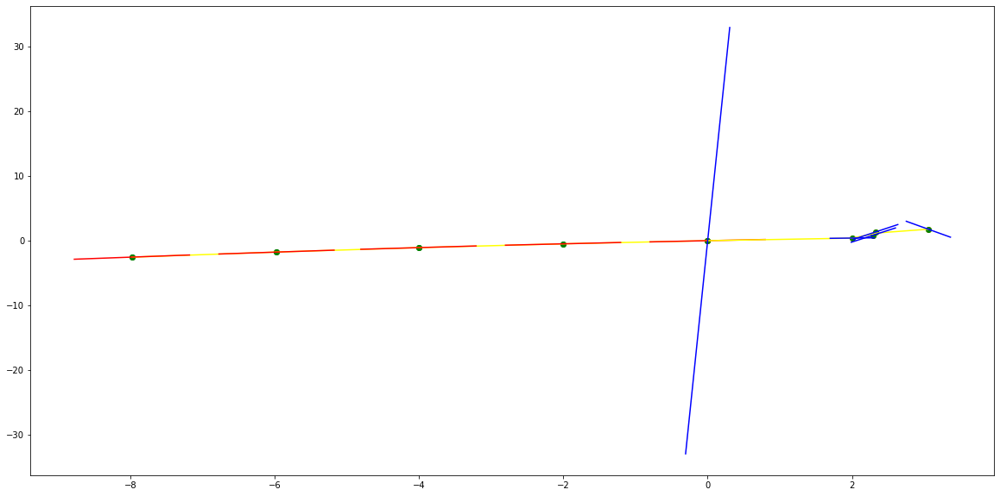

parameters (0.0001498789061068873, 0.005721119214392689, 0.07882847208797047, 0.47614160354003965, 1.4851230074704185, 0.05374969208370396)
tangent[0]:0.19559917210256716
tangent[1]:0.7181733086100544
tangent[2]:0.8866092832452633
tangent[3]:0.9078249873121416
tangent[4]:1.4851230074704185
parameters (-1787.4435917820465, 7051.736162473155, -10405.326981065044, 6806.025665871653, -1663.2639993074863, 5.2550115340369083e-08)
tangent[0]:-1663.2639993074863
tangent[1]:29.420447217662513
tangent[2]:22.02525842540308
tangent[3]:15.810073667742472
tangent[4]:10.739652167765598


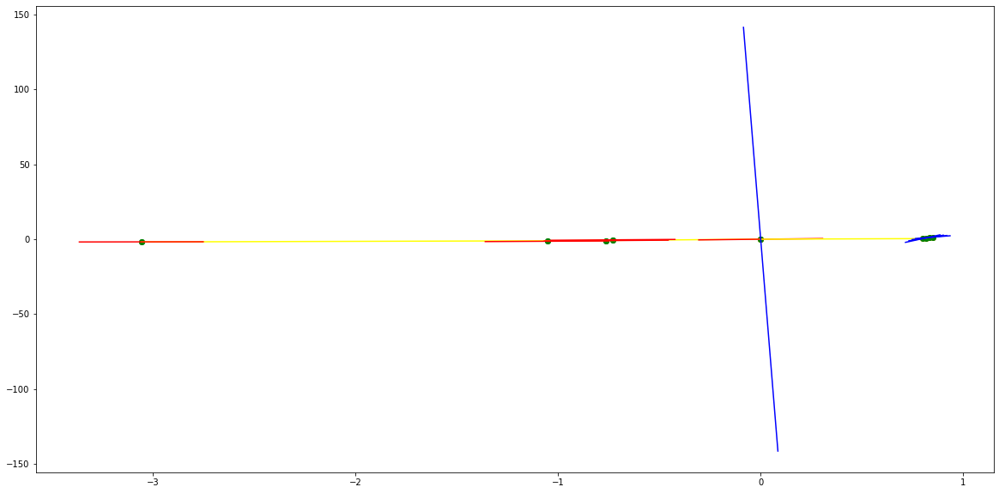

parameters (370.4353101924805, 532.5549001401745, 262.65477692106515, 59.921650826601, 25.407892471849657, 0.000711702527605087)
tangent[0]:17.45328955506143
tangent[1]:18.682896950208363
tangent[2]:18.89123773130397
tangent[3]:19.87455470205189
tangent[4]:25.407892471849657
parameters (-39541.87254884822, 64279.78618705537, -33790.4009215448, 6191.1069212738075, -224.21022531279425, -0.019911879003233005)
tangent[0]:-224.21022531279425
tangent[1]:213.45330228357915
tangent[2]:223.01078539331183
tangent[3]:230.64889116106957
tangent[4]:243.77059442948052


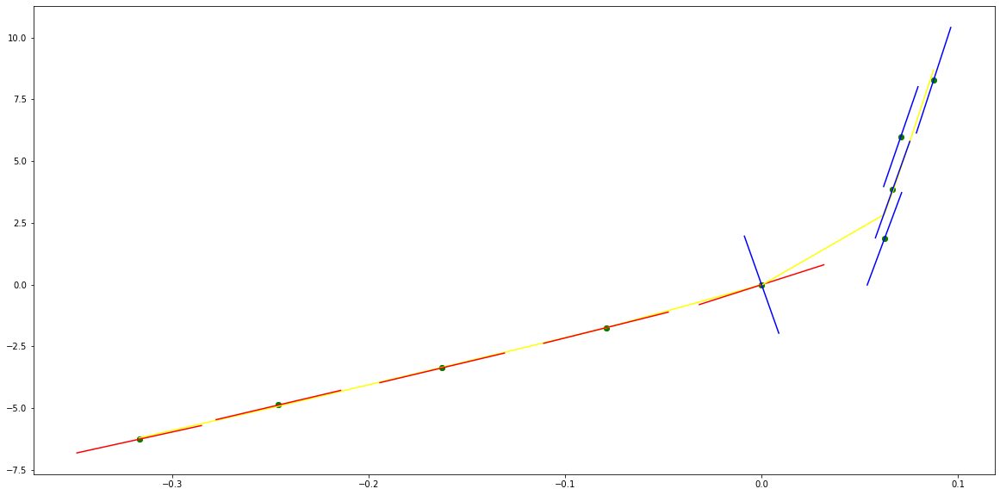

parameters (13234.539555755995, 25450.887124898778, 16840.14000349736, 4523.425347310508, 442.9461391112875, -0.15427022265478033)
tangent[0]:-83.81131213574281
tangent[1]:305.73005525322696
tangent[2]:337.55710154388026
tangent[3]:406.11779715458783
tangent[4]:442.9461391112875
parameters (4585.26499341205, -7903.503920013034, 4599.892255656699, -1163.185296289265, 155.1953755967589, 0.8041036502729846)
tangent[0]:155.1953755967589
tangent[1]:145.7387248631014
tangent[2]:91.84058079136234
tangent[3]:48.99066262996162
tangent[4]:21.641663061204866


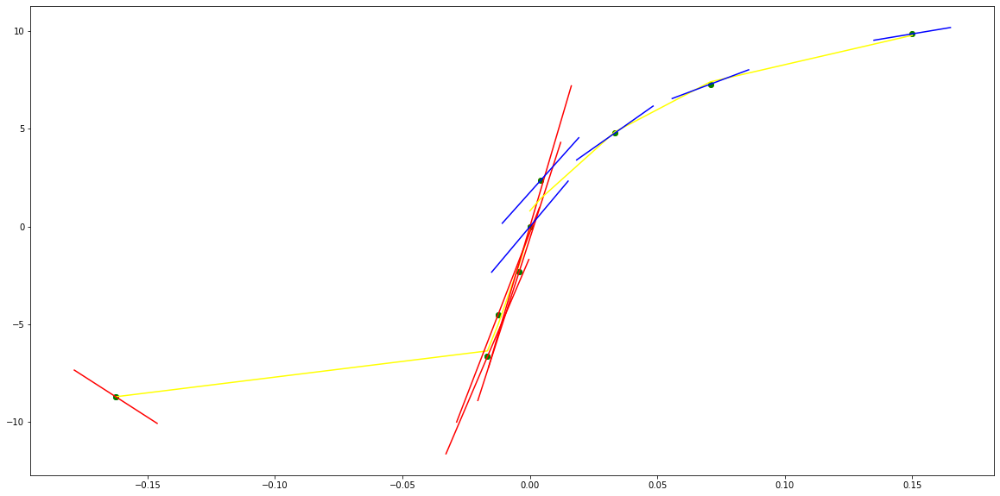

parameters (3358410147.3751025, 304862894.68207514, 9602738.175911989, 121823.65349004154, 1081.0995911234104, -0.06955475149778845)
tangent[0]:645.395293334197
tangent[1]:672.6591321314054
tangent[2]:565.0125853206555
tangent[3]:482.9352059021744
tangent[4]:1081.0995911234104
parameters (488181.31348809914, -305438.91318803834, 69495.76641559557, -7107.242518393886, 406.54688294424716, 0.7773472557074667)
tangent[0]:406.54688294424716
tangent[1]:350.8476095347512
tangent[2]:190.30877441260236
tangent[3]:75.14609570391679
tangent[4]:83.61095103141724


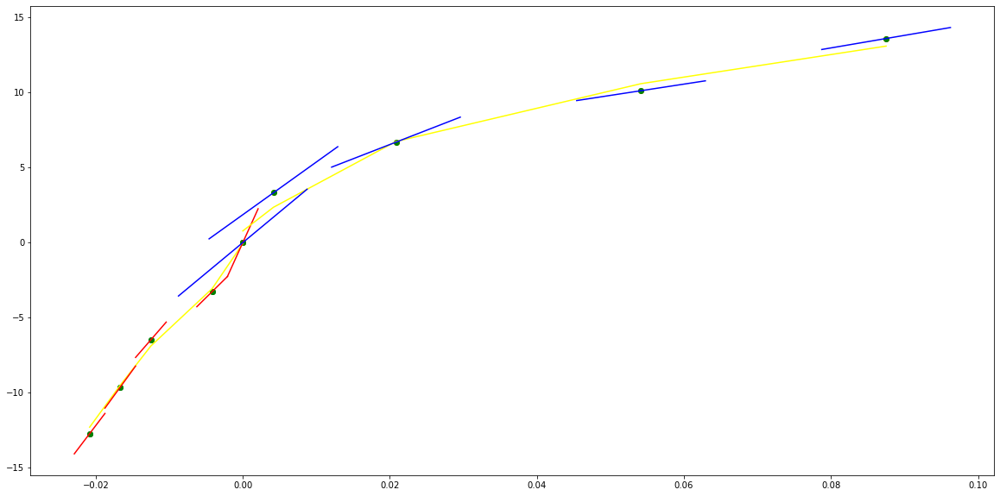

parameters (56700604.16096717, 21514527.857625883, 1879232.748873054, 39565.5404276774, 935.1810957316555, -0.2121713843750819)
tangent[0]:1008.7643334988308
tangent[1]:805.7868721066401
tangent[2]:665.7721476551307
tangent[3]:697.2295151463061
tangent[4]:935.1810957316555
parameters (14275633.831474572, -4618959.426869083, 521126.26649983047, -25078.237269890436, 729.810637748623, 0.5603561239353418)
tangent[0]:729.810637748623
tangent[1]:546.6396398795741
tangent[2]:209.81275339284514
tangent[3]:214.2856429162406
tangent[4]:278.1590966321688


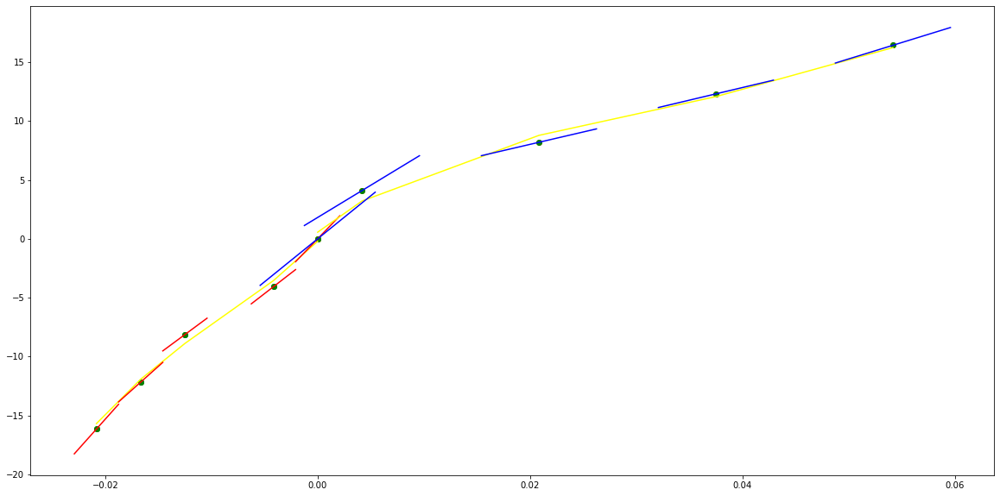

parameters (-13.622833179489852, -62.12456432792548, -100.00197337044204, -69.98284523606685, -10.063099890040135, 8.388365681010858e-05)
tangent[0]:14.71470319124667
tangent[1]:9.84644759399022
tangent[2]:9.970404302909444
tangent[3]:12.072911164201166
tangent[4]:-10.063099890040135
parameters (7347034.273886851, -8086008.056434305, 3023688.5194281405, -403519.2652814994, 7287.747555368428, 2.3904651151875846e-07)
tangent[0]:7287.747555368428
tangent[1]:-5874.316477417483
tangent[2]:753.646010481426
tangent[3]:536.5764322497644
tangent[4]:392.75071780956296


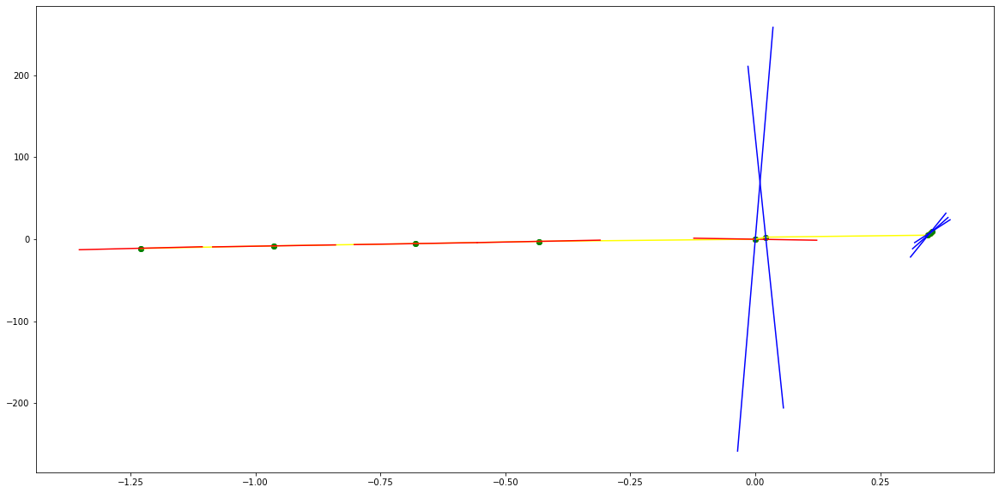

parameters (8.335632251865, 34.799375685218074, 52.40075793258672, 33.46085462712836, 17.57687936585919, 0.019244836982354692)
tangent[0]:10.247172219551082
tangent[1]:10.38773705180327
tangent[2]:8.073325741842545
tangent[3]:8.118413021418752
tangent[4]:17.57687936585919
parameters (1464904.8844946988, -2423248.9590102015, 988686.9438006543, -35711.34176368189, 778.5629708665431, -0.055951136388960106)
tangent[0]:778.5629708665431
tangent[1]:531.7950773440671
tangent[2]:383.7843354732669
tangent[3]:367.76788011593635
tangent[4]:491.66326805243375


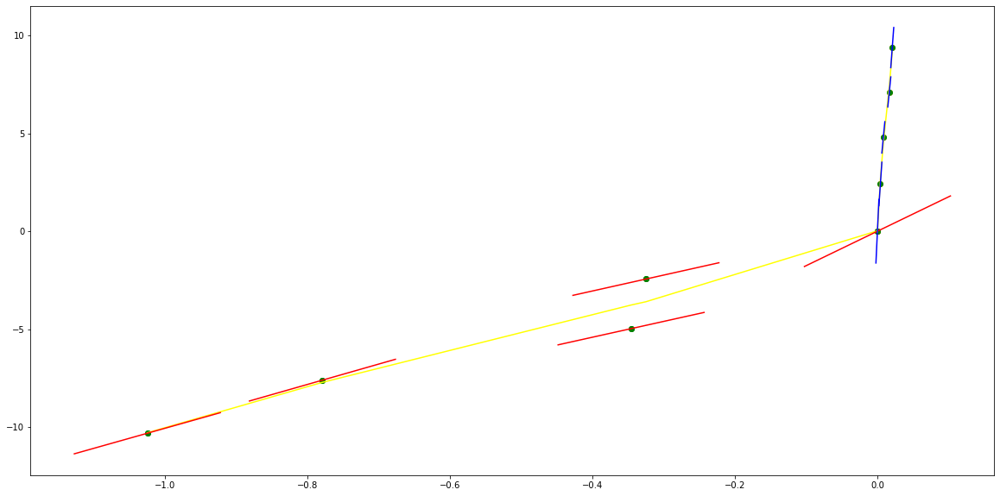

parameters (-0.0036959229110541656, -0.07259810393346249, -0.44451635169169007, -0.8338729005385612, 1.0305103342547803, -0.08064199530122082)
tangent[0]:2.0239591047417815
tangent[1]:0.27853716974081033
tangent[2]:0.9011671491637454
tangent[3]:1.6521108653710312
tangent[4]:1.0305103342547803
parameters (6.265631428854968, -60.42611941442774, 214.61784290684875, -330.59174306095014, 187.2244571525524, -7.361553319947613e-05)
tangent[0]:187.2244571525524
tangent[1]:4.204161034047587
tangent[2]:6.147700542769456
tangent[3]:8.993873818705964
tangent[4]:7.533993424381009


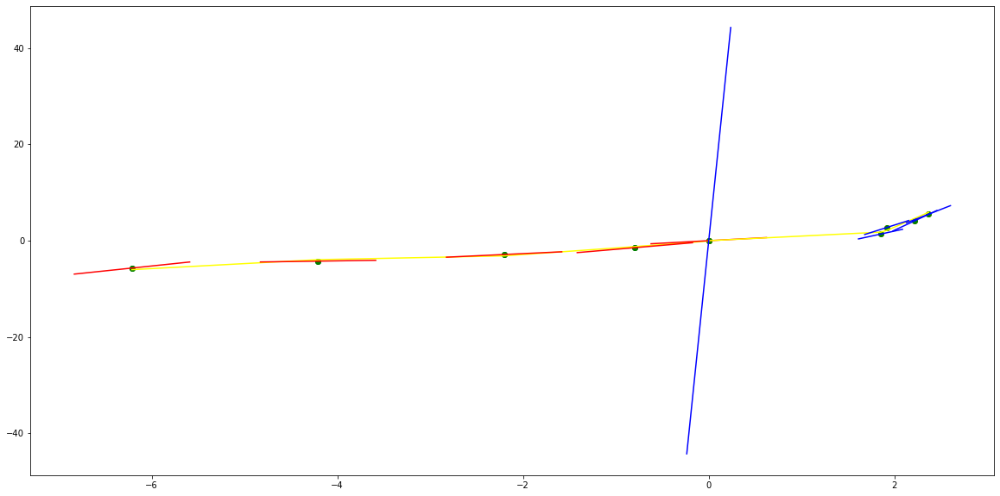

parameters (-0.00487688520828169, -0.09662371574908682, -0.6836544059531943, -1.9926778542564416, -1.331175452455278, 0.00041987029805639855)
tangent[0]:0.3397933677811007
tangent[1]:0.861149898409505
tangent[2]:1.1491601620852927
tangent[3]:1.1547170719584352
tangent[4]:-1.331175452455278
parameters (-197.10664490295508, 1590.533951548976, -4707.658209421132, 6061.015941248338, -2860.763480018699, 3.2065586793867165e-07)
tangent[0]:-2860.763480018699
tangent[1]:144.64342070254133
tangent[2]:137.00329270045586
tangent[3]:133.2290352325599
tangent[4]:129.48620425553963


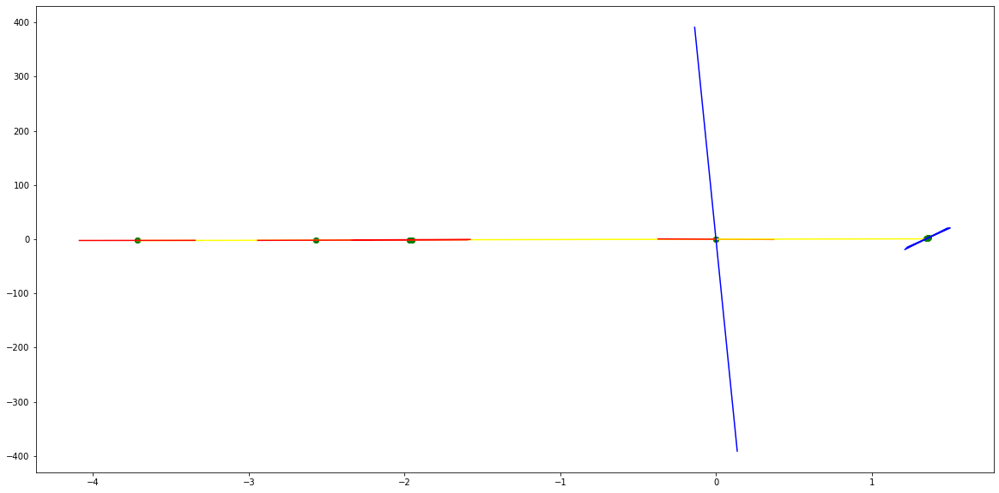

parameters (0.2623465169737077, 3.6444036808558424, 18.02145456731049, 36.89386334978021, 26.095950656224197, -0.2905888035815226)
tangent[0]:2.9235906299050427
tangent[1]:3.003653473286981
tangent[2]:-6.449067596127996
tangent[3]:25.484823270204235
tangent[4]:26.095950656224197
parameters (33098.376453005796, -63717.671161112805, 41016.387193797644, -9200.838747935788, 255.01670669051046, -0.04434703540044062)
tangent[0]:255.01670669051046
tangent[1]:180.45513719368813
tangent[2]:110.05684270730819
tangent[3]:346.00392508656466
tangent[4]:9.288358098297891


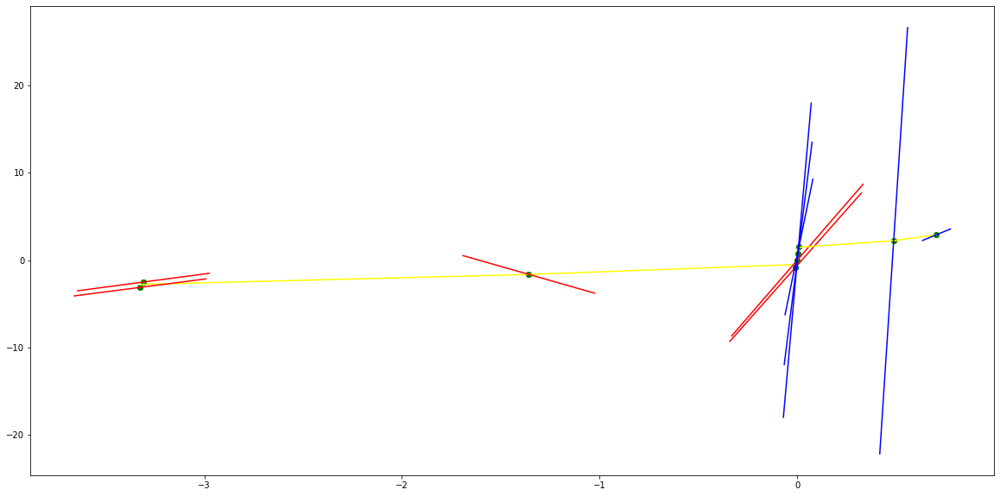

parameters (89889751.21672387, 26727094.83482019, 2777921.212709393, 115283.03046803342, 1633.5608402228181, -0.002675727500666629)
tangent[0]:502.8788385185844
tangent[1]:534.3114570107073
tangent[2]:525.1195871644204
tangent[3]:-416.86591617983913
tangent[4]:1633.5608402228181
parameters (-53981005.41258656, 11011676.34243237, -555851.3338271597, -3916.4673011331165, 695.7196763215069, -0.04249052565597393)
tangent[0]:695.7196763215069
tangent[1]:637.2302513348891
tangent[2]:538.840250851362
tangent[3]:182.33649855490114
tangent[4]:481.6036683730049


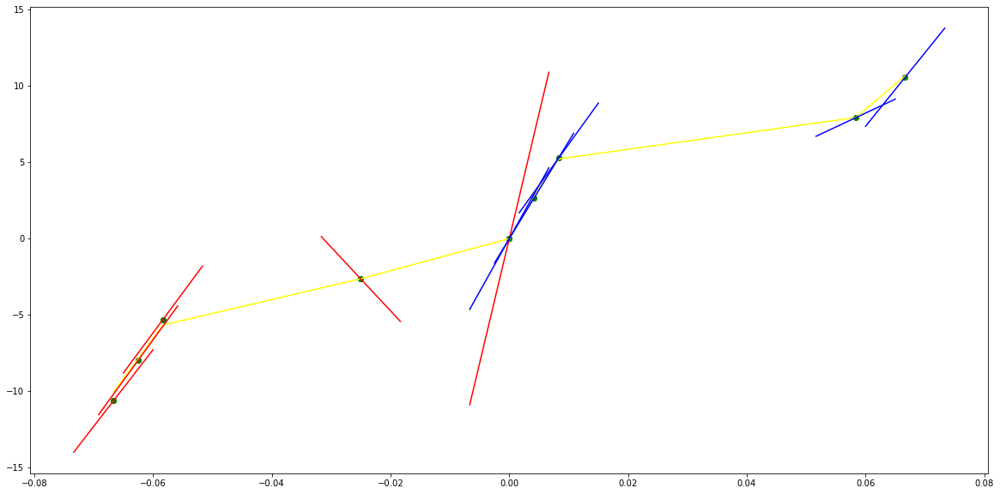

parameters (8164.897483118052, 7083.893921489977, 2237.9491640820015, 319.12358259337054, 46.720350332532206, 0.007468824984137622)
tangent[0]:23.25111620034835
tangent[1]:25.60990945608316
tangent[2]:26.59415294231973
tangent[3]:27.183144136037317
tangent[4]:46.720350332532206
parameters (219620.04134438466, -192376.33590506532, 60630.53185958904, -8120.43478123138, 429.8601602785208, 0.3447552817257007)
tangent[0]:429.8601602785208
tangent[1]:365.30222048452134
tangent[2]:306.71537714819647
tangent[3]:-45.67413618321899
tangent[4]:63.96828967749724


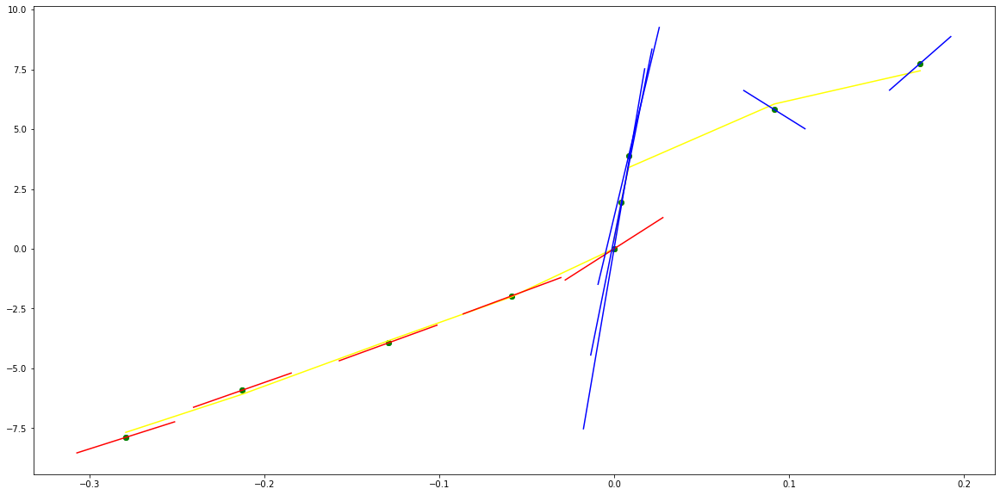

parameters (34.89003940436909, 119.82833680831837, 147.08138710299642, 71.70744217271341, 21.635855454058323, -0.009573209958820172)
tangent[0]:15.072950468550154
tangent[1]:13.18069686535943
tangent[2]:9.070071595633571
tangent[3]:9.074910385831643
tangent[4]:21.635855454058323
parameters (20651.548053626284, -25300.756061207947, 10609.871660933843, -1779.168592187516, 134.94960564147493, 0.09446113660878694)
tangent[0]:134.94960564147493
tangent[1]:84.02670037901618
tangent[2]:25.780524506648703
tangent[3]:37.190689223421316
tangent[4]:57.895558104674706


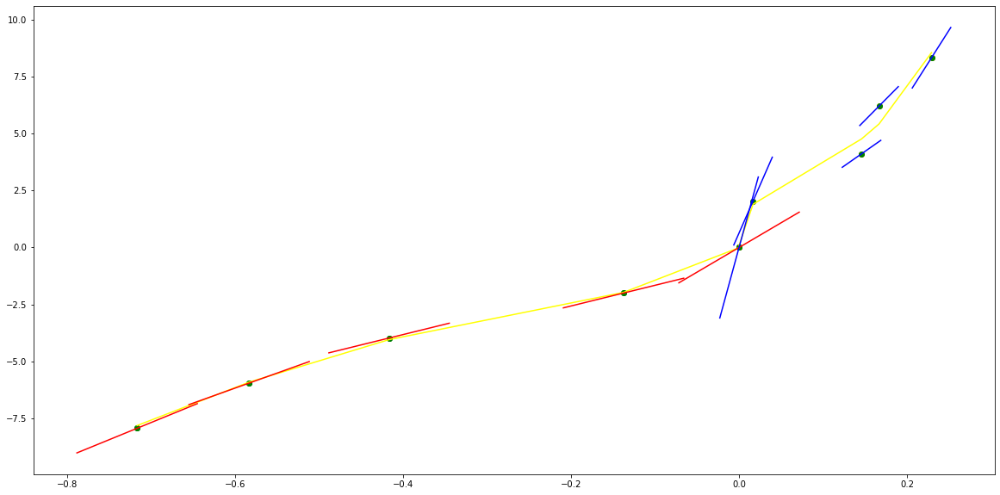

parameters (-0.2395211792111512, -3.565207854303769, -19.62787845771687, -47.48051336653573, -40.44186621831488, -0.0002846174192110332)
tangent[0]:3.151086793046666
tangent[1]:5.275512087264907
tangent[2]:7.102435108138941
tangent[3]:8.838202521648448
tangent[4]:-40.44186621831488
parameters (-107409.31629611862, 324317.53748130135, -363479.14158039517, 179484.55268043833, -32976.58182935577, 6.454970949183116e-07)
tangent[0]:-32976.58182935577
tangent[1]:313.3466684189916
tangent[2]:232.55963063947274
tangent[3]:196.53014275906025
tangent[4]:163.3987199285475


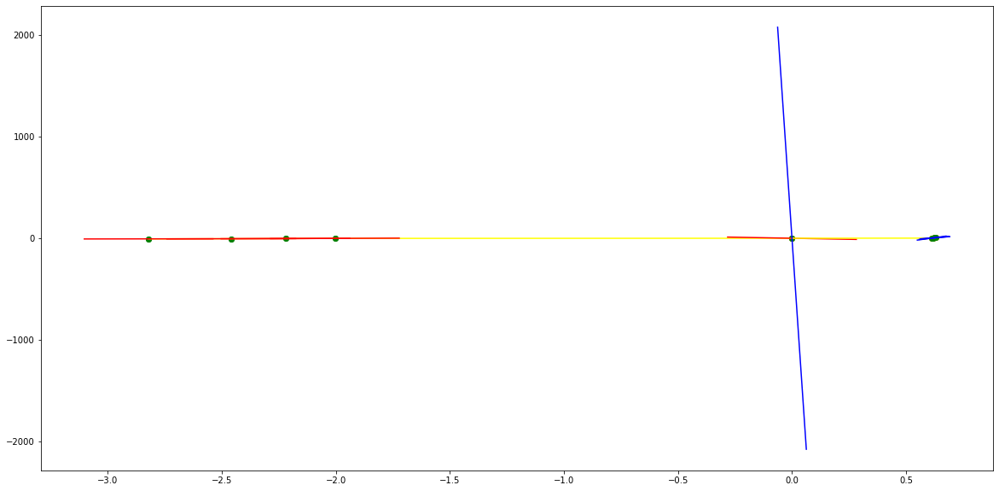

parameters (0.440915712076135, 5.277584611193282, 22.07020905980628, 36.16465469619601, 18.779193019430032, -0.6215114501891845)
tangent[0]:7.24054423669633
tangent[1]:7.980827597057292
tangent[2]:-5.32940858391672
tangent[3]:18.1810582721194
tangent[4]:18.779193019430032
parameters (1431.5848459873478, -3109.9529534869444, 2327.0289952598073, -709.7914379167095, 90.29257589874415, 0.9168218908679917)
tangent[0]:90.29257589874415
tangent[1]:84.49749494618159
tangent[2]:78.94078713118807
tangent[3]:20.524754245085774
tangent[4]:4.951166606058749


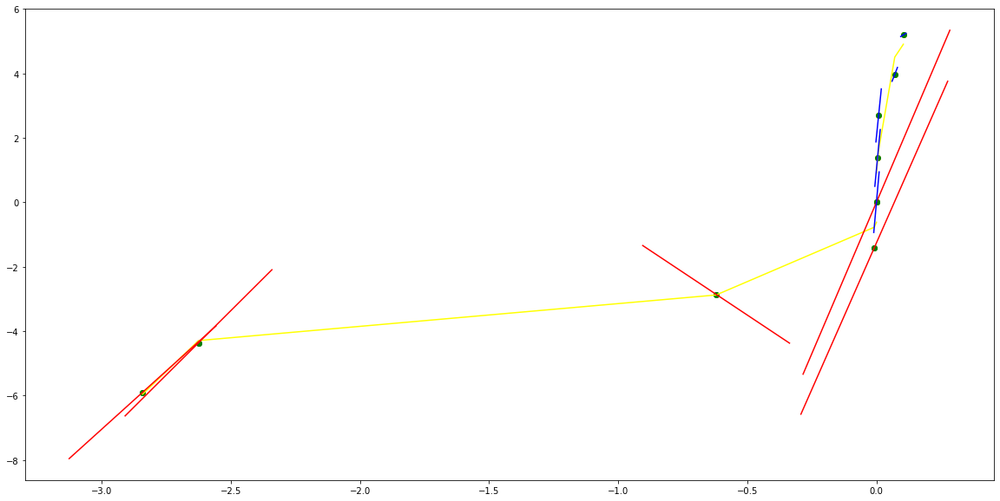

parameters (103527815.98433517, 9904935.99383418, 290283.88788103993, 4017.829422824301, 160.71289365465032, -0.05747596300553749)
tangent[0]:110.5355305867119
tangent[1]:125.20421990015771
tangent[2]:131.593090926101
tangent[3]:139.63904598276596
tangent[4]:160.71289365465032
parameters (100976256.15001602, -18105346.074436065, 1156418.5273177878, -29792.724996049576, 319.40046836104915, -0.014267716796612985)
tangent[0]:319.40046836104915
tangent[1]:126.29412001748878
tangent[2]:101.22190145828193
tangent[3]:142.91277281120432
tangent[4]:131.3837264206631


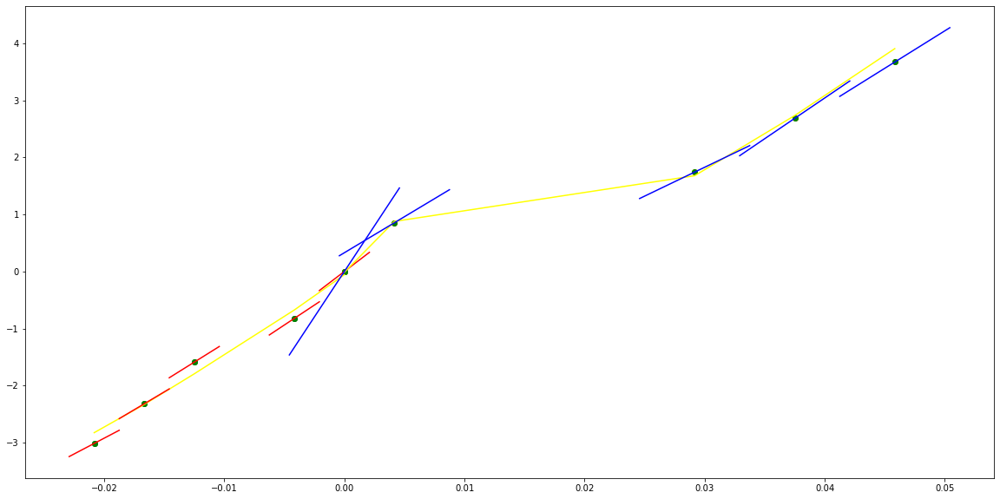

parameters (-0.28013049482529107, -3.2773912960033513, -13.05633597972248, -20.072745297499235, -6.420463169772409, -0.018177052089310006)
tangent[0]:7.231937927451833
tangent[1]:-0.25280520717216426
tangent[2]:4.865120130504801
tangent[3]:6.766856038353884
tangent[4]:-6.420463169772409
parameters (99.41283105461626, -924.1416746279613, 3122.07852615836, -4507.358248820384, 2325.1591512272394, 7.053423270812412e-07)
tangent[0]:2325.1591512272394
tangent[1]:-294.8269348398967
tangent[2]:134.39215263834603
tangent[3]:-10.52460385185941
tangent[4]:75.96576602382311


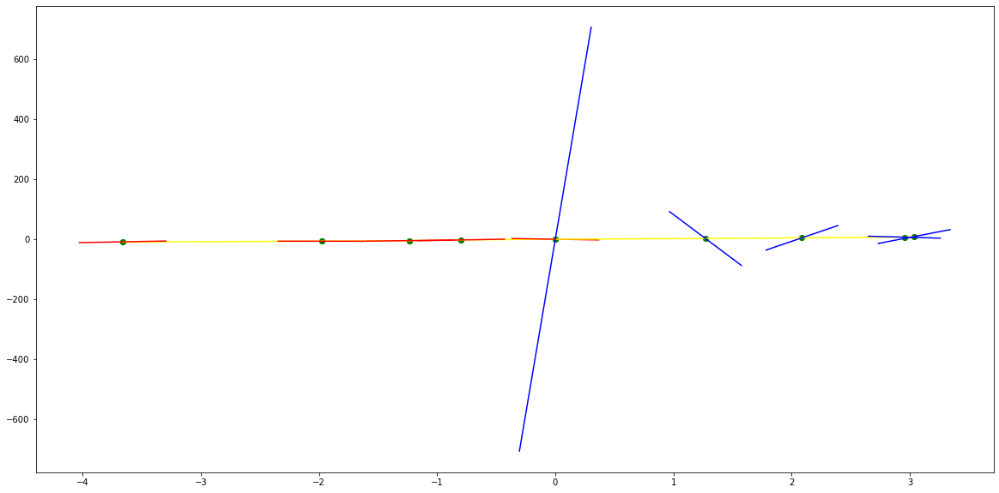

parameters (0.06848120486443124, 0.776837790547764, 2.8295914974448984, 3.3927782560962063, 2.952632252133324, -0.0038131094166615467)
tangent[0]:2.093724660176403
tangent[1]:3.861403015282417
tangent[2]:4.003478694079986
tangent[3]:2.5543462003525765
tangent[4]:2.952632252133324
parameters (-4742.322062249943, 29188.1945823178, -65655.82657511863, 63340.768873653185, -21725.247520984045, -1.1668585500818807e-08)
tangent[0]:-21725.247520984045
tangent[1]:3409.580676806163
tangent[2]:-95.61388746041848
tangent[3]:109.17966100438571
tangent[4]:118.52401202721012


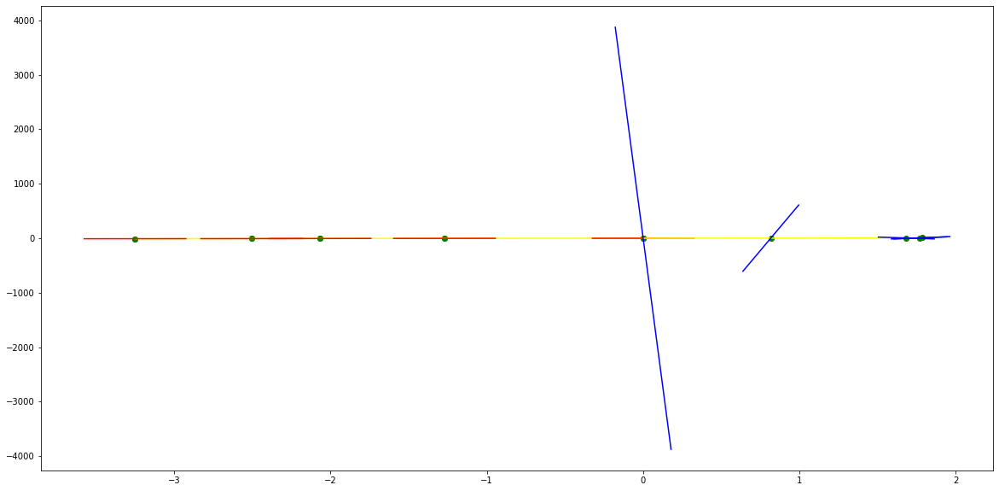

parameters (0.06720769357468107, 0.9467115518587408, 4.554702176273885, 8.518231767908517, 7.337563268194875, 0.026098171983826586)
tangent[0]:3.6349796611428404
tangent[1]:4.265348619389596
tangent[2]:3.2510624557237806
tangent[3]:0.624539279364952
tangent[4]:7.337563268194875
parameters (150735.79853525685, -588357.4944099273, 859891.8486519646, -557605.75510048, 135345.17074969917, -1.3601002041430597e-07)
tangent[0]:135345.17074969917
tangent[1]:-342.7720844298019
tangent[2]:155.63923367363168
tangent[3]:128.54021040949738
tangent[4]:90.64183466526447


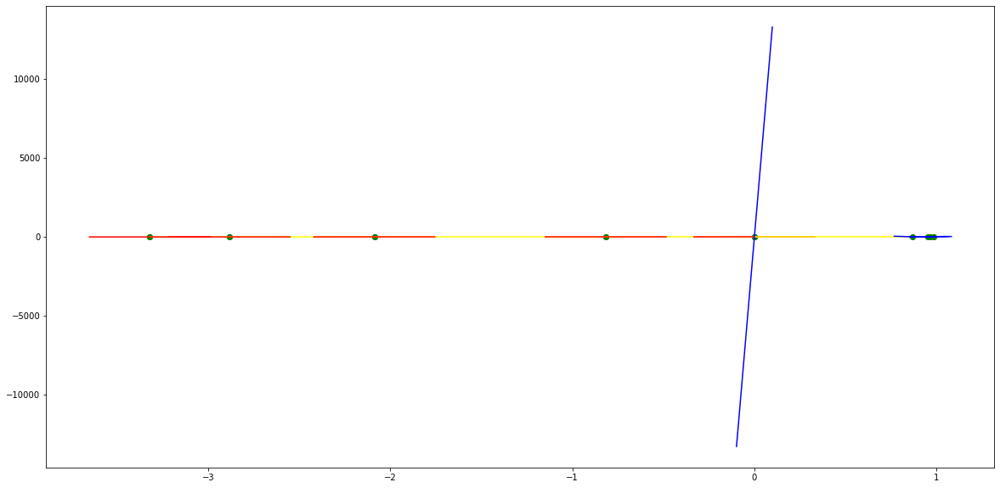

parameters (14185.814507368632, 13266.344179339983, 4614.708207365865, 725.507398162611, 51.06734516738017, -0.07591088065729107)
tangent[0]:13.464486091288059
tangent[1]:16.20495989869101
tangent[2]:30.48881113405291
tangent[3]:45.2575361771746
tangent[4]:51.06734516738017
parameters (107141819.494654, -18191308.509134095, 1047890.0707012798, -22719.270584864946, 178.6550979293458, 0.011941428669828747)
tangent[0]:178.6550979293458
tangent[1]:38.79560407877747
tangent[2]:109.90615635133048
tangent[3]:123.36423166567573
tangent[4]:117.65256758003756


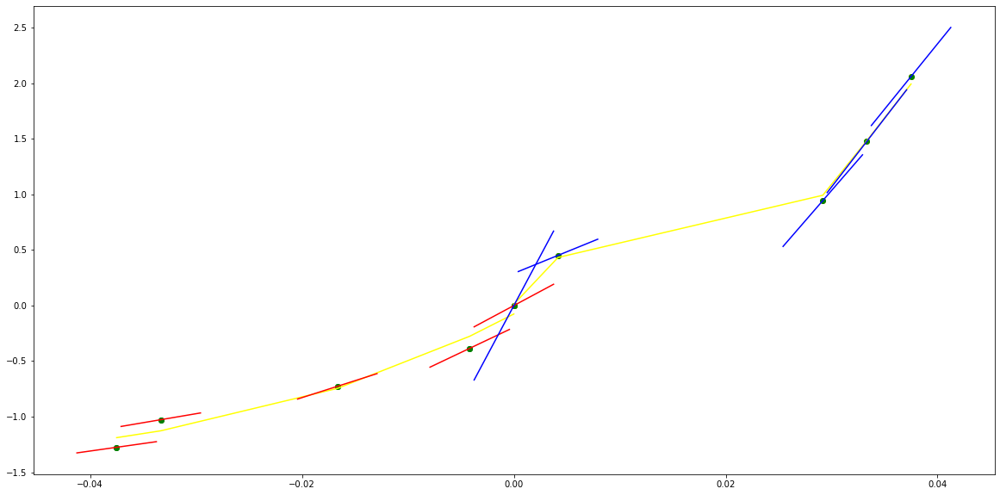

parameters (-1008152.8991196702, -647583.8288247648, -135354.7410434709, -9912.004196358588, -125.20406391828861, 0.011844619399869177)
tangent[0]:168.01130100998284
tangent[1]:174.12871106400144
tangent[2]:168.18139410206572
tangent[3]:155.1109471135876
tangent[4]:-125.20406391828861
parameters (2755416.5744341193, -1188835.9162176296, 180301.25804110893, -11482.148368896462, 311.3381970601002, -0.03622573978972383)
tangent[0]:311.3381970601002
tangent[1]:224.6982450631437
tangent[2]:154.83638658393852
tangent[3]:17.31646647507995
tangent[4]:61.35457530436685


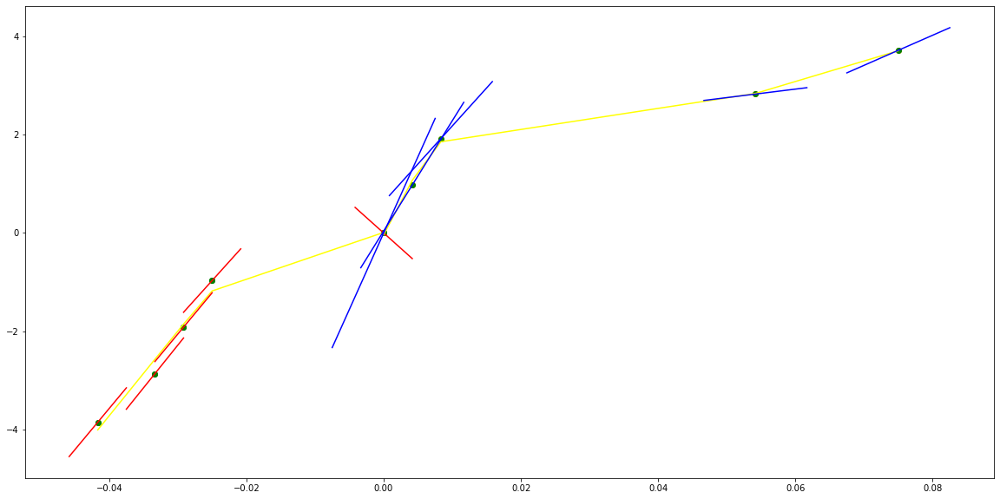

parameters (-8380.427266932189, -17970.31099863408, -13094.33226225019, -3623.5056103528877, -280.28367661039675, 4.72730104098212e-05)
tangent[0]:101.4396043317617
tangent[1]:108.42408624506669
tangent[2]:-143.8823414088659
tangent[3]:143.63190118438223
tangent[4]:-280.28367661039675
parameters (2721817.195109757, -1268168.8334544138, 170943.70559128365, -5556.334237701916, 97.14763423815187, 0.1713791547711126)
tangent[0]:97.14763423815187
tangent[1]:59.38295541638895
tangent[2]:93.2789377701114
tangent[3]:125.45945242950445
tangent[4]:160.99946018851426


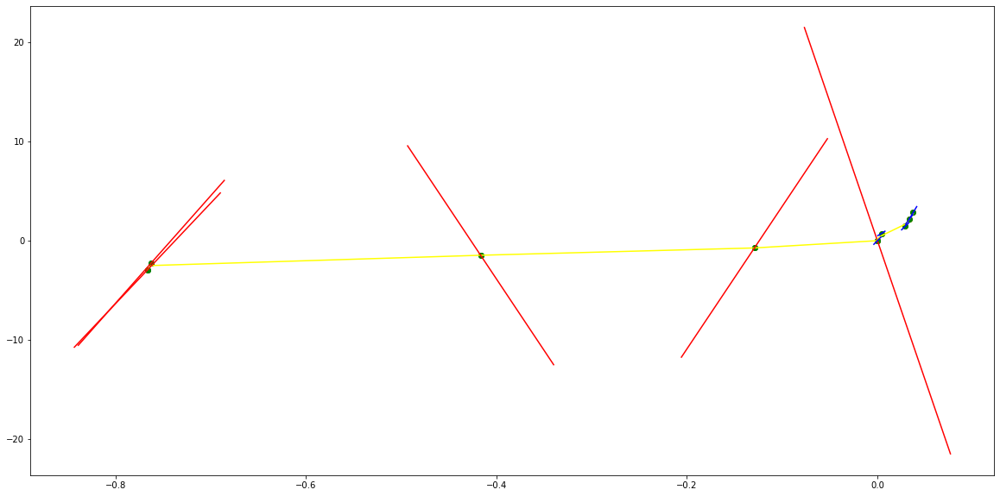

parameters (14649.501337761742, 47527.642899910345, 55115.0894093357, 26316.052862076627, 4082.232800979662, -3.735696619111347e-08)
tangent[0]:153.56983887690876
tangent[1]:168.47704342241195
tangent[2]:183.5359844406048
tangent[3]:-1378.5618648084364
tangent[4]:4082.232800979662
parameters (9722.546284213891, -21885.7488661647, 17918.872883719912, -6228.857040419871, 757.4670227562674, -1.5438652805434923e-05)
tangent[0]:757.4670227562674
tangent[1]:-150.97283863732946
tangent[2]:40.89490020307949
tangent[3]:20.202052449983967
tangent[4]:18.3644721671335


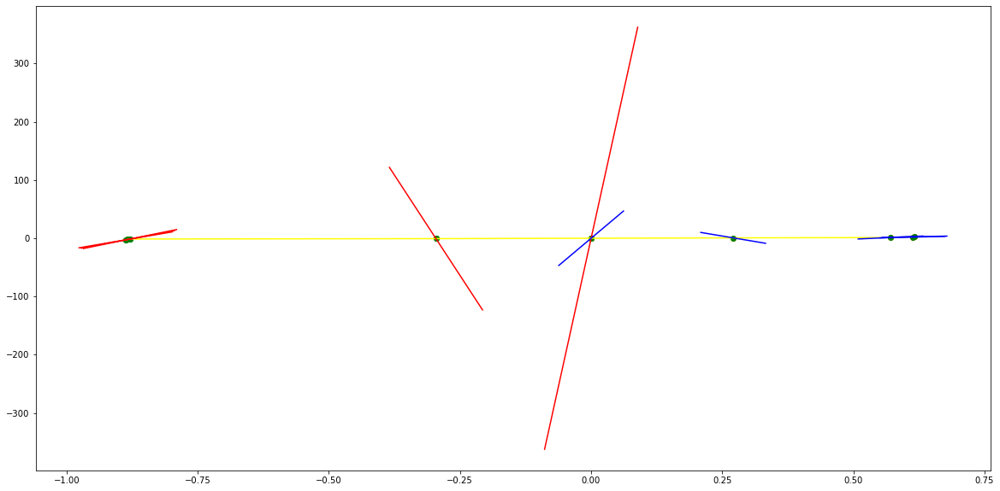

parameters (197540.56676354335, 112822.3257225163, 21080.570868032875, 1465.1679068322012, 51.202775031320634, -0.011852535096102805)
tangent[0]:38.38212267410676
tangent[1]:38.06730019757321
tangent[2]:37.305912817072844
tangent[3]:8.298403607311428
tangent[4]:51.202775031320634
parameters (-80639.75023784496, 50178.17838096668, -5032.916456951456, -1406.728128603953, 195.5883110914473, 0.00467344455352926)
tangent[0]:195.5883110914473
tangent[1]:183.6197958648015
tangent[2]:-99.6286622252264
tangent[3]:144.08762475634185
tangent[4]:151.36774843807964


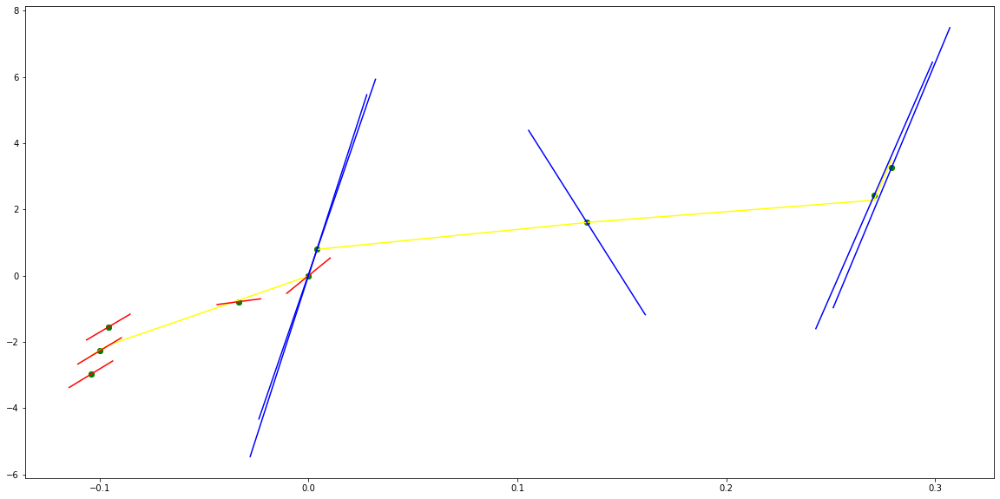

parameters (0.15598071884469064, 1.8003097872699694, 7.573037321653844, 13.379327708663933, 10.916215950447537, -0.017147857864886876)
tangent[0]:3.9600052085388597
tangent[1]:3.7322498154478083
tangent[2]:2.1483085478892576
tangent[3]:5.331005524005547
tangent[4]:10.916215950447537
parameters (318.7983998354161, -506.6374345633678, 337.4947291267951, -184.19082274891858, 74.7834981559401, 0.8586163525936868)
tangent[0]:74.7834981559401
tangent[1]:73.26624640081926
tangent[2]:54.15585093489859
tangent[3]:50.02034619294853
tangent[4]:35.530397917414746


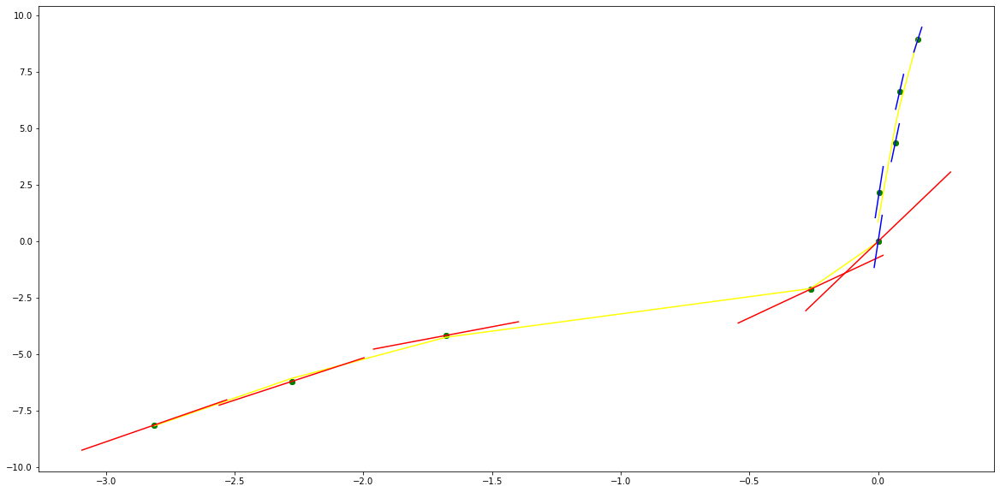

parameters (90.89280750729476, 675.7752443183448, 1796.6051333507687, 1996.1535596063175, 772.2971262142587, 1.1148687763721807e-05)
tangent[0]:71.50666479009715
tangent[1]:-32.27353988403365
tangent[2]:90.41170337719677
tangent[3]:-140.7260397379705
tangent[4]:772.2971262142587
parameters (9196.679875950696, -15495.766402380332, 9480.309096276356, -2447.442114767109, 233.76667445647473, -0.003103872064289333)
tangent[0]:233.76667445647473
tangent[1]:-33.9824137557037
tangent[2]:-31.968569095732335
tangent[3]:34.14124363734578
tangent[4]:31.03672935875585


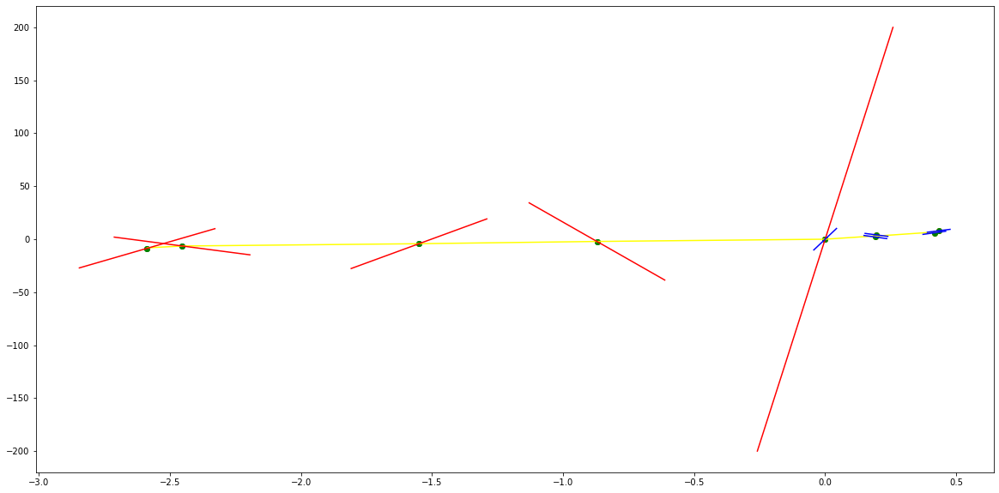

parameters (2.9456422487694676, 18.715733425072788, 41.61338958151911, 38.91074913441572, 16.965021027645758, 0.013605522324214327)
tangent[0]:20.15959842247251
tangent[1]:0.1244555874332427
tangent[2]:4.187279266277127
tangent[3]:6.128161207067617
tangent[4]:16.965021027645758
parameters (9111.73974481939, -16489.44196994517, 10552.707828800452, -2803.635781903298, 281.1394927447618, 0.4315173385135431)
tangent[0]:281.1394927447618
tangent[1]:258.31894162094324
tangent[2]:-12.342345521092625
tangent[3]:-0.5613317917006952
tangent[4]:51.096059887507636


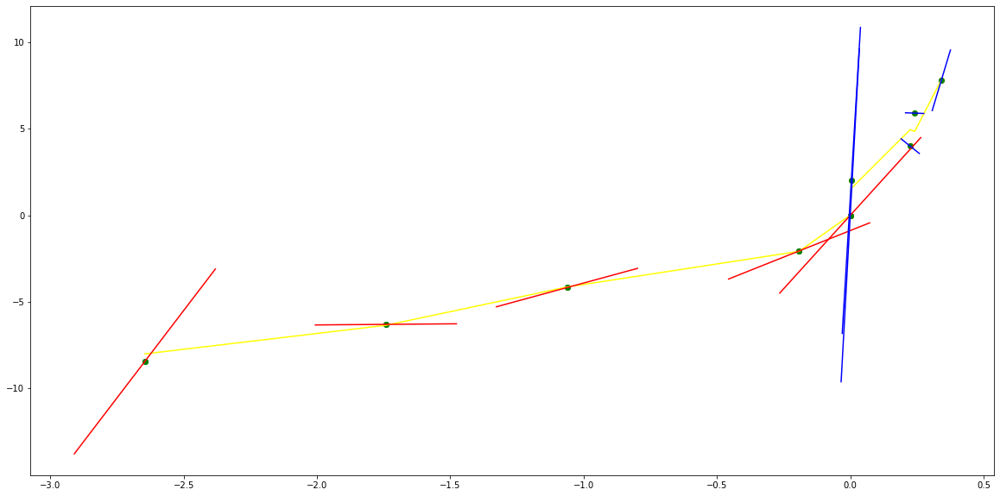

parameters (1.1271012824697555, 6.226497844835365, 12.277849628678783, 10.683084117262256, 7.11291323054154, 0.01966630629017198)
tangent[0]:2.0843666418628537
tangent[1]:2.8489230951630127
tangent[2]:3.122519895029967
tangent[3]:3.1795483059687744
tangent[4]:7.11291323054154
parameters (31340.16851572794, -77755.82215710136, 65667.58623358607, -19963.83364958781, 927.3056488835516, 3.290944726985991e-05)
tangent[0]:927.3056488835516
tangent[1]:-705.4981628752737
tangent[2]:184.40351624673508
tangent[3]:163.78302571749896
tangent[4]:144.07245074856996


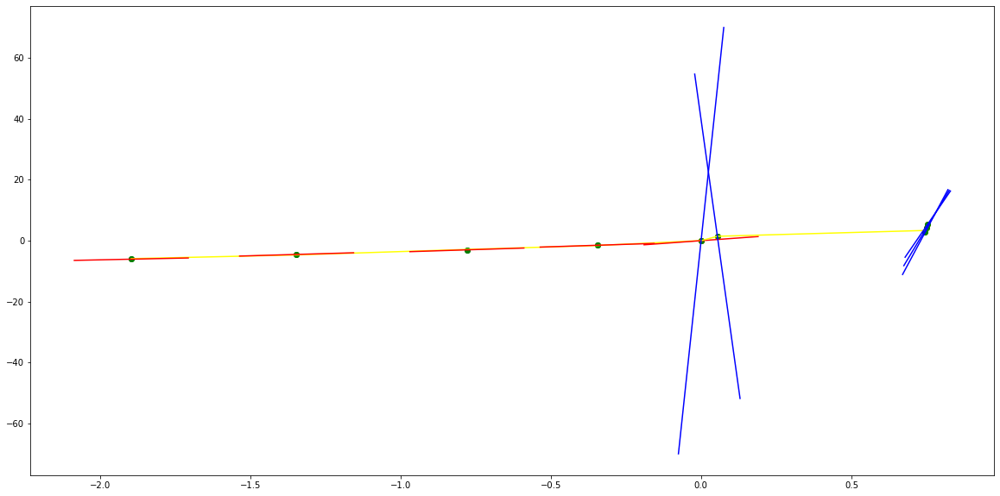

parameters (-0.5872714337450524, -5.194937998045208, -16.38444272776718, -21.29512795196142, -5.696233148213072, 0.008688371600902894)
tangent[0]:2.7573314521456878
tangent[1]:5.084026767347527
tangent[2]:6.439161061873494
tangent[3]:6.450818180861076
tangent[4]:-5.696233148213072
parameters (1411748.834765654, -667610.8930597944, 114736.17545221567, -8685.921559048651, 308.76373266853034, 0.20255860322005378)
tangent[0]:308.76373266853034
tangent[1]:242.1609684702588
tangent[2]:186.3944470396299
tangent[3]:10.622182656637847
tangent[4]:18.332748363795417


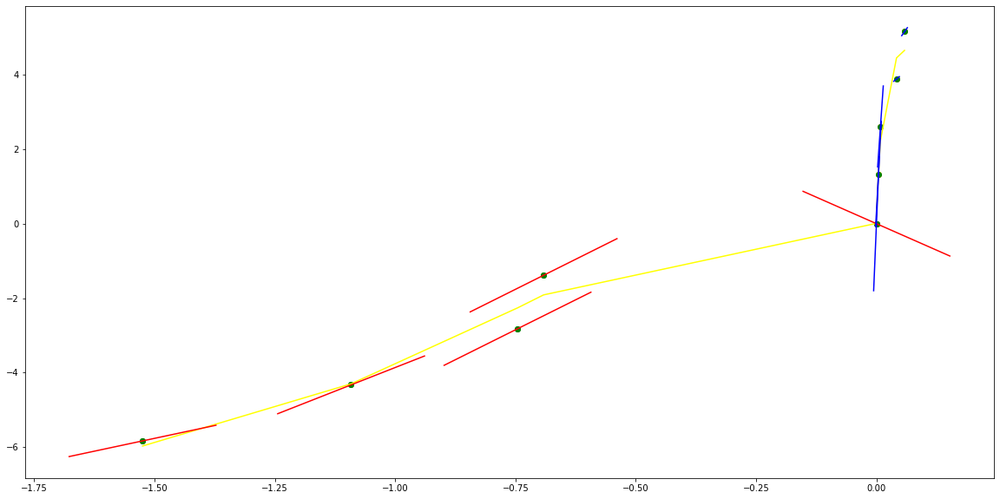

parameters (329266711.42833894, 61865582.76138615, 3946333.978789483, 99305.51638246459, 1103.0967022514733, 0.2298068186309024)
tangent[0]:504.41135580662467
tangent[1]:433.0605329038408
tangent[2]:27.17167028400445
tangent[3]:463.6468039197159
tangent[4]:1103.0967022514733
parameters (2423420.531333011, -994577.2556068761, 146858.92472273138, -9301.826010604016, 325.6842965397826, 0.5038866174126398)
tangent[0]:325.6842965397826
tangent[1]:255.52880628862215
tangent[2]:62.70715156674538
tangent[3]:82.70313723034508
tangent[4]:117.0297451243681


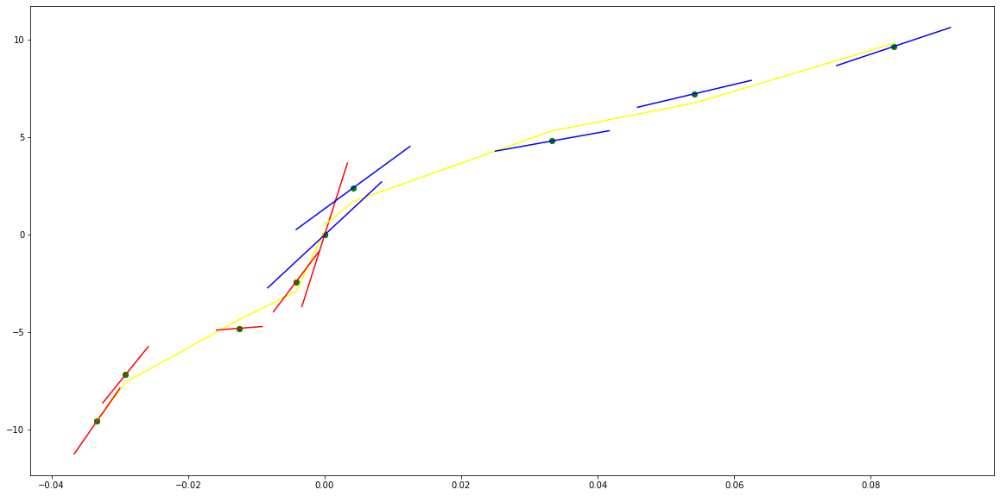

parameters (-226396.0957968641, -230875.62645736773, -77707.7574014405, -9102.923464113735, -139.39215905853985, 0.022336498982603335)
tangent[0]:289.2421629383439
tangent[1]:261.9592910533353
tangent[2]:241.2479786303445
tangent[3]:215.39199964546322
tangent[4]:-139.39215905853985
parameters (2398873.006197797, -1034822.027360775, 151989.62727349417, -8929.470491079599, 240.80375321475742, 0.2803880072325649)
tangent[0]:240.80375321475742
tangent[1]:174.0070560118663
tangent[2]:78.19948629304781
tangent[3]:87.2066982360326
tangent[4]:94.41242843926273


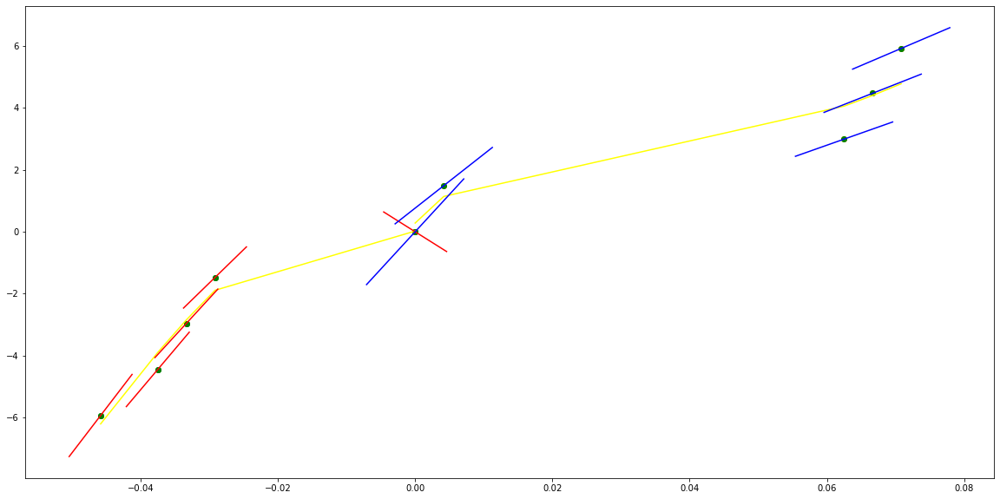

parameters (9.164411801276671, 38.002765879206144, 57.78224215415464, 38.50843317647831, 15.611310444193208, -0.020456787905545566)
tangent[0]:5.897026829577712
tangent[1]:4.669987247338014
tangent[2]:4.413319335828946
tangent[3]:9.894156858127385
tangent[4]:15.611310444193208
parameters (3009436.9882629802, -1802519.9289271645, 326657.0041670778, -20339.107182070285, 435.2673071038407, -0.07984094979687108)
tangent[0]:435.2673071038407
tangent[1]:282.26014486440863
tangent[2]:160.24439991623427
tangent[3]:239.725395100279
tangent[4]:287.1186219651481


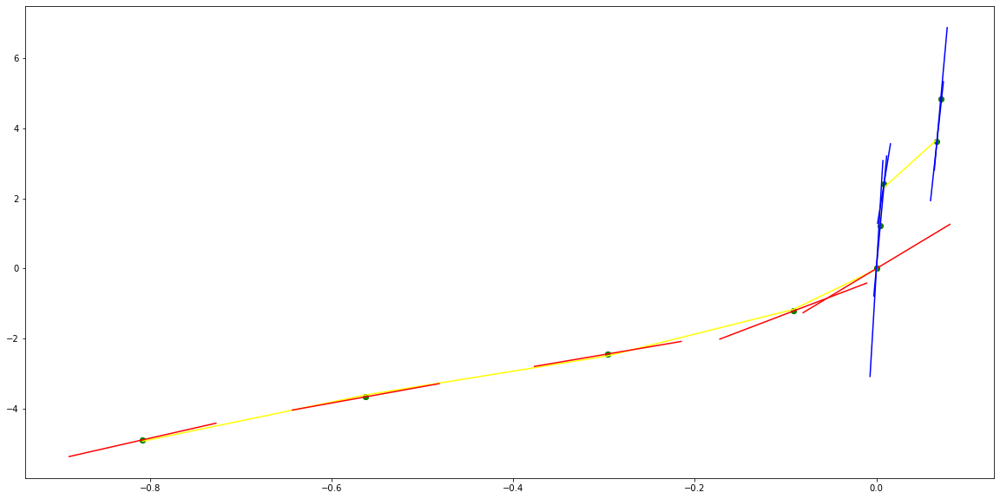

parameters (9.701309208109961, 33.54926745941695, 41.86162536305748, 21.787217351488874, 9.03488176314388, 0.001041342489820593)
tangent[0]:5.719323720426836
tangent[1]:5.607082899245448
tangent[2]:5.38336216010504
tangent[3]:4.0460269745110535
tangent[4]:9.03488176314388
parameters (-829461.2311561154, 851788.6055188664, -317291.44516141847, 50611.06138560027, -2887.6689882131723, -0.0002035088984903749)
tangent[0]:-2887.6689882131723
tangent[1]:321.4550299559687
tangent[2]:278.0493122119424
tangent[3]:235.37583520449334
tangent[4]:-14.066363834534059


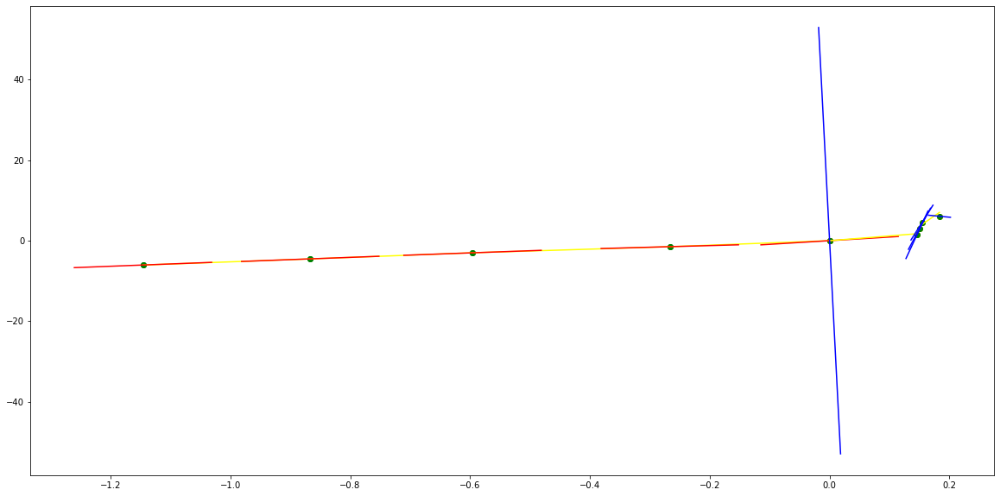

parameters (1027.5859368771196, 2603.976185663445, 2300.3689629946684, 845.097045640469, 126.86291226658078, 0.209165777048121)
tangent[0]:-9.431026390952141
tangent[1]:72.64619963616722
tangent[2]:77.81073192395283
tangent[3]:83.18115960882889
tangent[4]:126.86291226658078
parameters (-4460.9270520753125, 7950.747332137222, -4929.508912907423, 1209.217279226419, -72.20938322815341, 0.9019274808080104)
tangent[0]:-72.20938322815341
tangent[1]:-62.38855522073785
tangent[2]:55.67692676255943
tangent[3]:50.09651134623134
tangent[4]:43.40911930625474


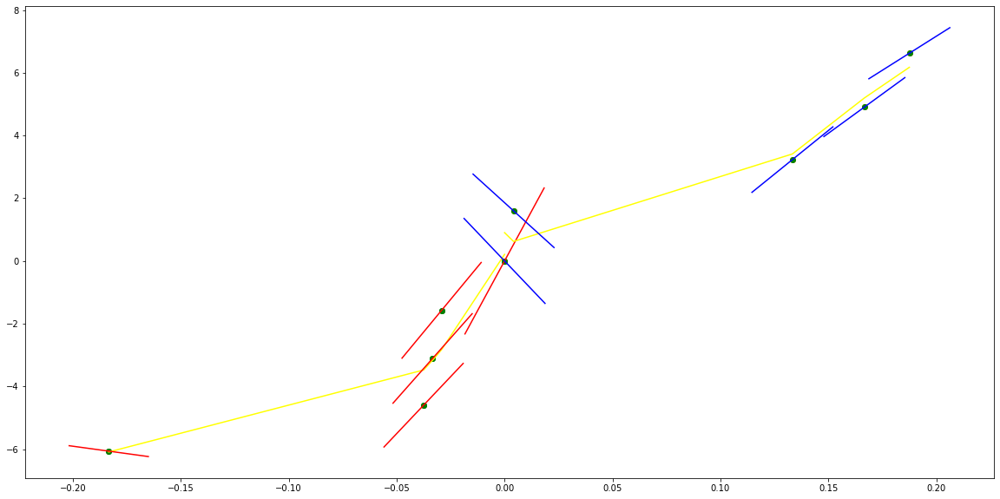

parameters (0.914425638633749, 6.123684452083256, 15.03454792278242, 16.576850648174517, 11.397068797020772, 0.055109140766977455)
tangent[0]:3.3525656070648537
tangent[1]:3.6958651559936264
tangent[2]:3.8089391567445396
tangent[3]:4.378086372170378
tangent[4]:11.397068797020772
parameters (98.00099776603018, -439.1106643096472, 700.5421315240386, -463.89142236484446, 108.29237267969489, 0.00013571843632808933)
tangent[0]:108.29237267969489
tangent[1]:-20.75466847318353
tangent[2]:16.4868290357702
tangent[3]:-8.680326128019203
tangent[4]:49.06210720283826


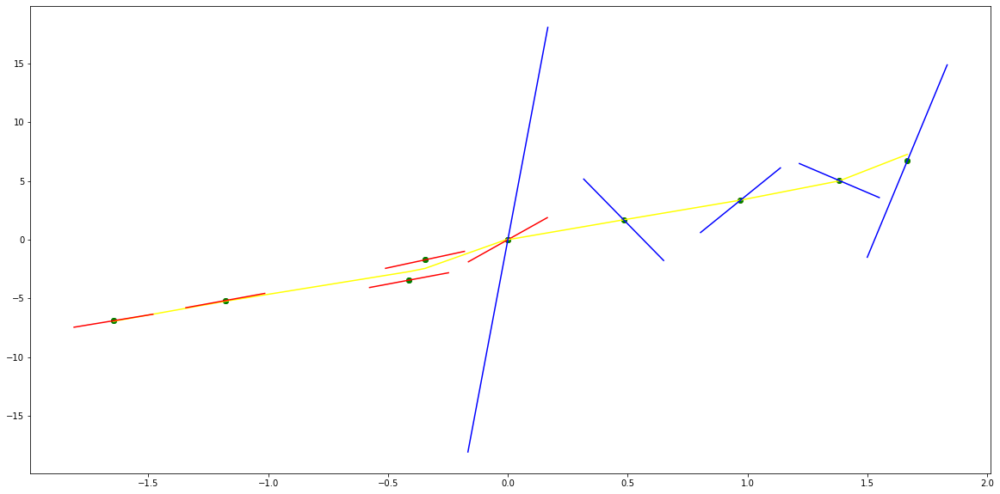

parameters (-1.1183906482625712, -6.458243435871049, -11.544393696624187, -6.276363013521656, 4.297891295998592, -0.03709568429782902)
tangent[0]:5.465127958419013
tangent[1]:2.4964157071398185
tangent[2]:3.6561433168346236
tangent[3]:5.625765733830409
tangent[4]:4.297891295998592
parameters (203967.33100163532, -145081.10279693172, 32207.180662031205, -2719.7153885967195, 151.41551473719815, -0.06335218919627743)
tangent[0]:151.41551473719815
tangent[1]:84.98876187761778
tangent[2]:57.2234643975209
tangent[3]:66.4131244733912
tangent[4]:86.23293727286912


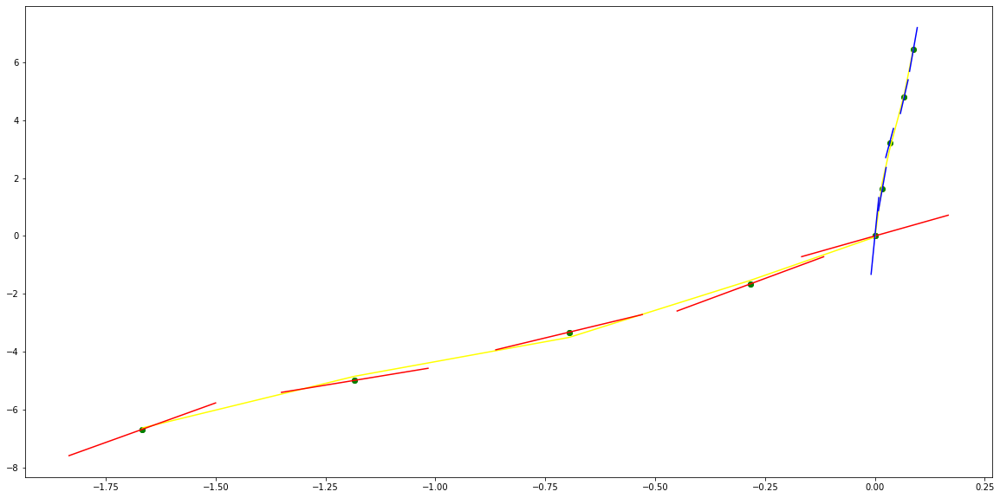

parameters (2449.0685780607446, 3839.392092105009, 2008.3820959655907, 419.5195503330928, 53.942183683302154, -0.058088142954037386)
tangent[0]:27.028910322454898
tangent[1]:23.368390538528196
tangent[2]:16.15670241626166
tangent[3]:34.2234041497004
tangent[4]:53.942183683302154
parameters (-1575137.2537070538, 424139.69165680144, 4975.12984779896, -7232.43394837973, 376.3650294707221, -0.004961189446661399)
tangent[0]:376.3650294707221
tangent[1]:316.4694682580025
tangent[2]:-161.5279547204383
tangent[3]:284.01095101957765
tangent[4]:281.275773604072


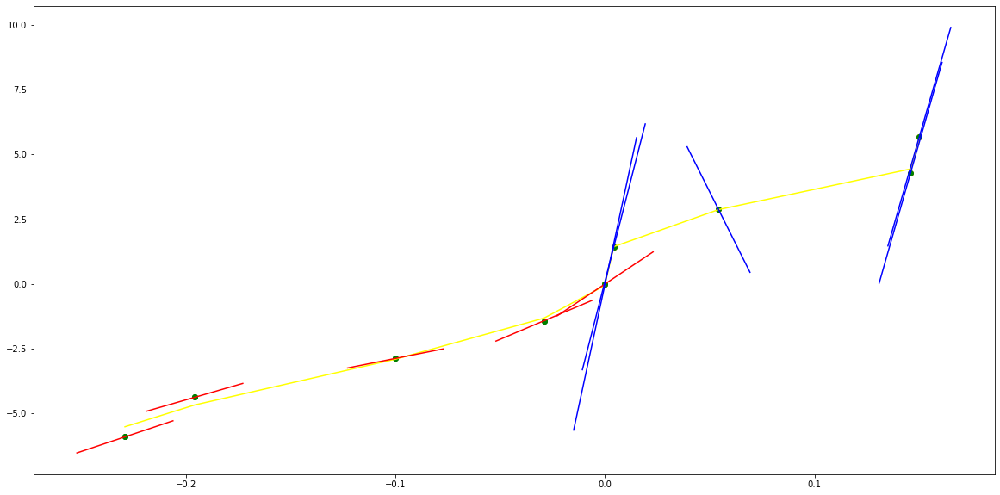

parameters (5826.441622559608, 972.3300266671904, -1831.8560571171545, -675.404565012459, -32.364081107428326, -0.008328381010846533)
tangent[0]:42.20424132715808
tangent[1]:48.866559053773194
tangent[2]:49.38356153695056
tangent[3]:44.34298921549672
tangent[4]:-32.364081107428326
parameters (1493818383.8262093, -145655740.95285067, 5029063.825833294, -72662.63445286064, 634.3163434522652, -0.06133434097438047)
tangent[0]:634.3163434522652
tangent[1]:250.81435776958654
tangent[2]:169.84928565706116
tangent[3]:282.1087939621442
tangent[4]:293.7718935000456


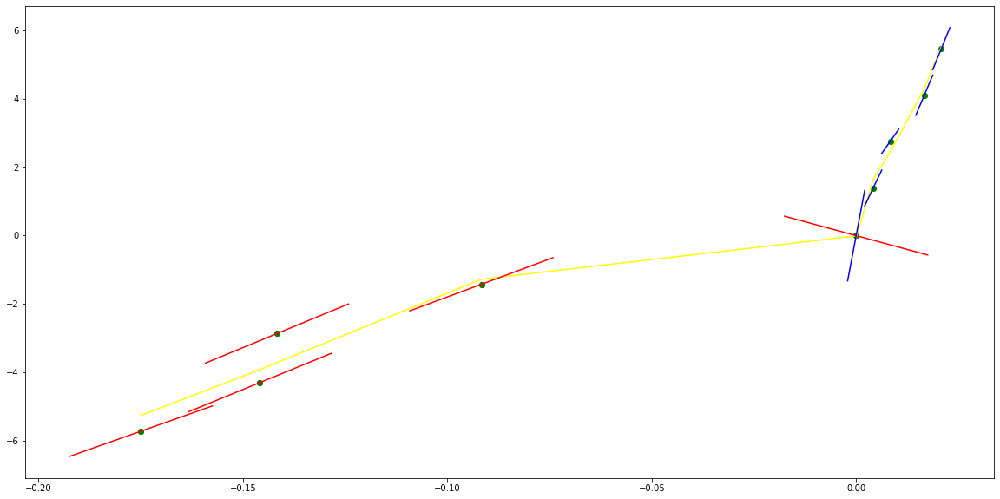

parameters (0.3115624107115911, 1.968691562317362, 4.000447317169086, 1.817871810231, 0.2608239116486071, 0.0005453142904106255)
tangent[0]:3.120147613227155
tangent[1]:3.0072445576323363
tangent[2]:3.0988192005531183
tangent[3]:2.6131333937730354
tangent[4]:0.2608239116486071
parameters (-2869.806467729272, 13633.231469177163, -23048.92392336341, 15998.229099208276, -3621.809126501878, 3.6258791775262597e-07)
tangent[0]:-3621.809126501878
tangent[1]:1182.4208379035604
tangent[2]:-386.94426679139406
tangent[3]:169.371468808818
tangent[4]:152.77048099666308


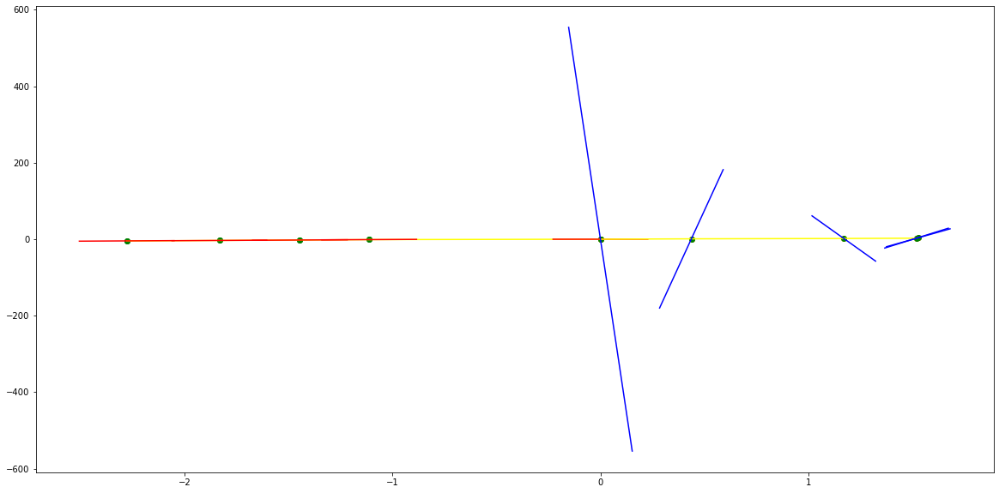

parameters (0.0020952001195959605, 0.03844462842757914, 0.2654602807322056, 0.8536547557038393, 1.7873809201995274, 0.026064940536344224)
tangent[0]:0.5413551911158998
tangent[1]:0.49515736885920125
tangent[2]:0.8010423818335388
tangent[3]:1.0767760381004434
tangent[4]:1.7873809201995274
parameters (-4432.228720622744, 20311.665701527505, -33448.04773622913, 22999.562603588918, -5352.990789549671, -1.4536855525821665e-08)
tangent[0]:-5352.990789549671
tangent[1]:1402.7148924437697
tangent[2]:-353.08656853506363
tangent[3]:120.66649992396015
tangent[4]:110.43952570636066


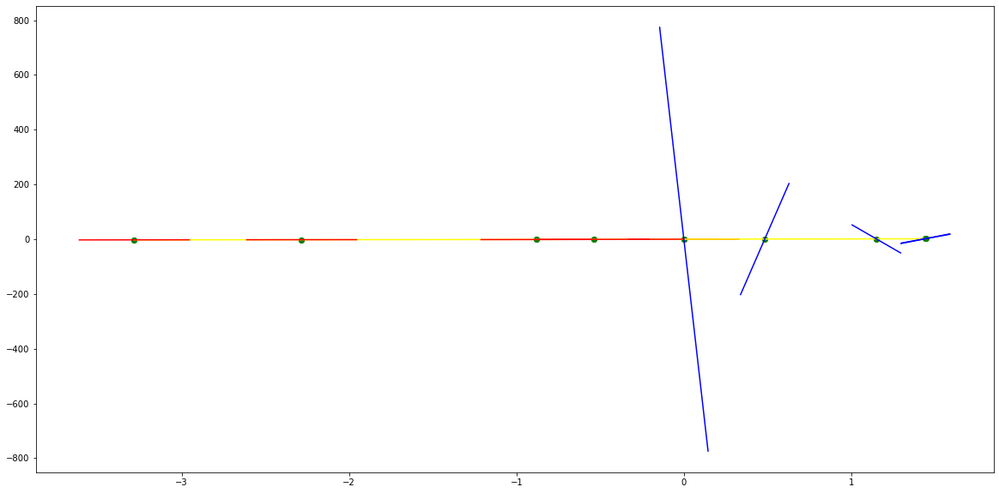

parameters (-0.010716013329568301, -0.15979425221628563, -0.8312822172195385, -1.6684429382083739, -0.05315910883118069, -0.010486374672078896)
tangent[0]:0.878665133389007
tangent[1]:1.113243146021565
tangent[2]:1.364543914144843
tangent[3]:1.2418575161864653
tangent[4]:-0.05315910883118069
parameters (-36944504.52702992, 45538100.131973594, -21041138.32081634, 4319626.2839369215, -332458.59668852465, 2.7576551271776368e-09)
tangent[0]:-332458.59668852465
tangent[1]:198.73641556379152
tangent[2]:108.81682829809142
tangent[3]:72.20796165167121
tangent[4]:91.63542901648907


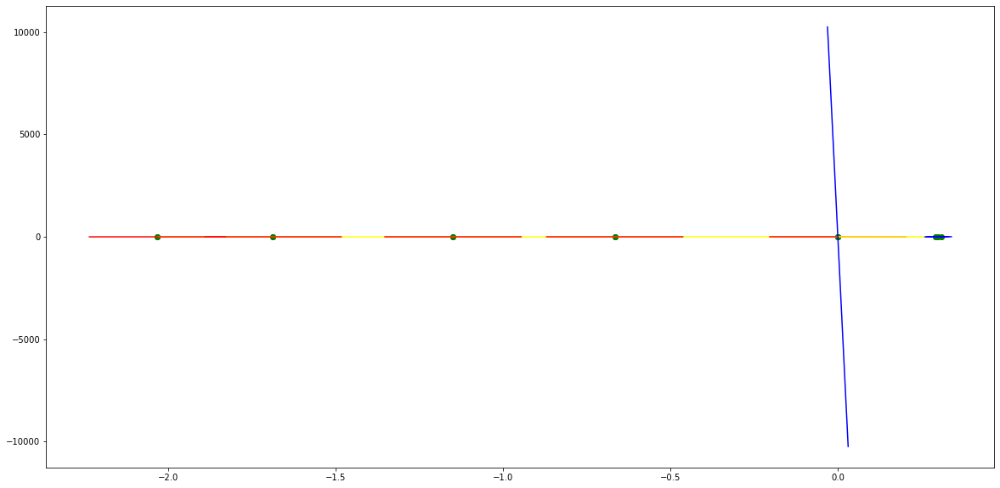

parameters (0.04632595518230304, 0.5075504877001543, 1.871490499994671, 2.745881914790541, 2.5043015034650233, -0.0034350267035085777)
tangent[0]:1.4423546806631267
tangent[1]:1.17350182248265
tangent[2]:0.806224708710471
tangent[3]:1.331461882133239
tangent[4]:2.5043015034650233
parameters (510002142.6968155, -49956301.79234302, 1733187.1731466274, -25450.43921248236, 232.7028534486019, -0.020167938757067166)
tangent[0]:232.7028534486019
tangent[1]:97.19392428878425
tangent[2]:66.26746678401622
tangent[3]:100.32194973781372
tangent[4]:102.52329326360018


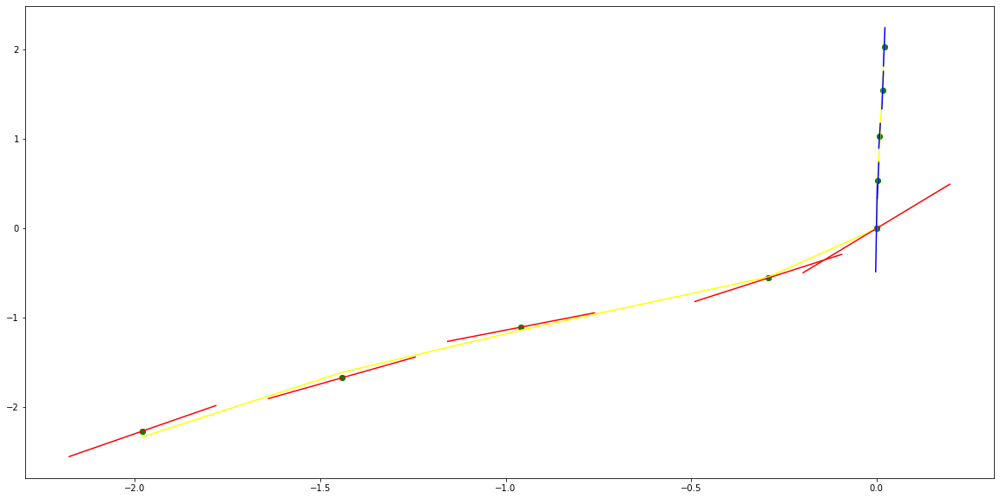

parameters (0.03221679518919405, 0.35029428399129486, 1.307384004288227, 1.8780904927663256, 1.2446010265680865, 0.0012720740341644974)
tangent[0]:0.7775927731154464
tangent[1]:0.811205915937024
tangent[2]:0.6351663984084108
tangent[3]:0.16397583251506576
tangent[4]:1.2446010265680865
parameters (216.70550998226832, -654.5334779071252, 731.3345313485355, -356.65990521772585, 64.18645573141316, -1.9616532599185697e-06)
tangent[0]:64.18645573141316
tangent[1]:-3.5188180590148477
tangent[2]:1.9656060985634554
tangent[3]:0.8672480361683483
tangent[4]:0.7775991071717954


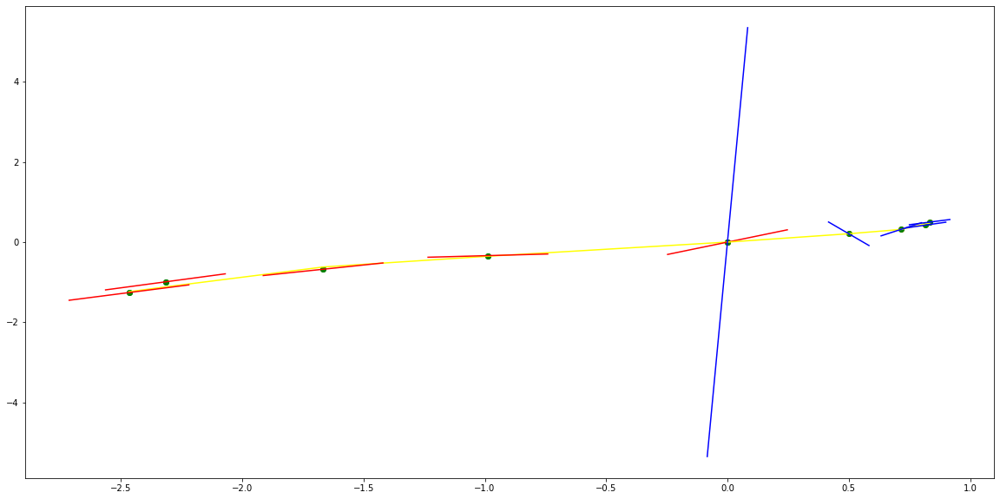

parameters (0.001008246349415236, 0.0105459696360355, 0.03270326827421136, 0.03219502703118937, 0.2079669309864404, 0.0006044961705241088)
tangent[0]:0.19135073471011868
tangent[1]:0.12284790126475034
tangent[2]:0.20115995737005474
tangent[3]:0.21343101006422593
tangent[4]:0.2079669309864404
parameters (0.19137814092416325, -3.3680378091798624, 20.933082453171586, -53.961192625629614, 48.243479498345394, -2.8227217683838395e-07)
tangent[0]:48.243479498345394
tangent[1]:-8.820227783519627
tangent[2]:5.794169421609709
tangent[3]:-8.670295789311282
tangent[4]:41.05617140389923


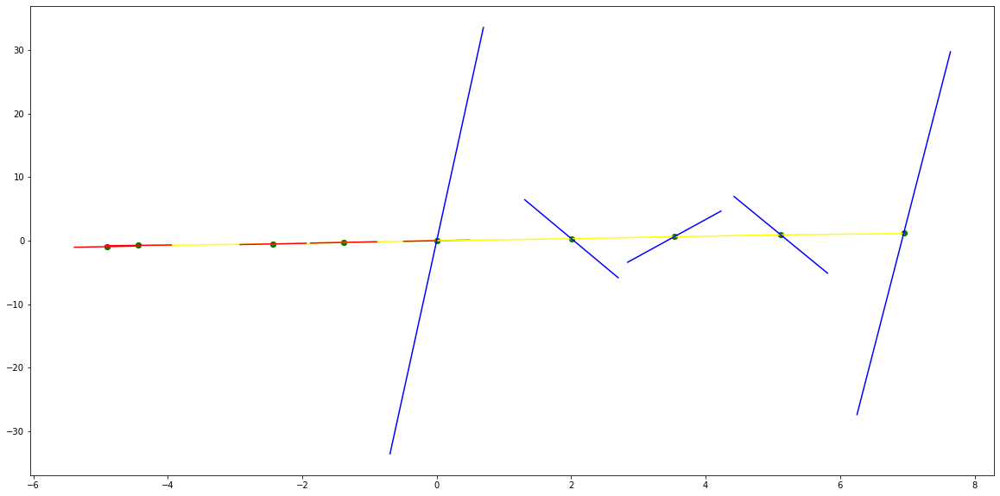

parameters (0.00021674620648847207, 0.0028378400736703774, 0.00770238060066881, -0.021813380422192063, 0.09497976552190483, -0.00030471777412261944)
tangent[0]:0.1666643498785615
tangent[1]:0.17191509883477651
tangent[2]:0.20937720840387525
tangent[3]:0.20133414242336936
tangent[4]:0.09497976552190483
parameters (-2.5416605470057068, 38.206568844747714, -203.11837646883757, 443.35976244995777, -325.5184000296543, 3.225839113321601e-09)
tangent[0]:-325.5184000296543
tangent[1]:82.51517881597186
tangent[2]:-53.36509297679032
tangent[3]:39.832352333192546
tangent[4]:38.875060677371664


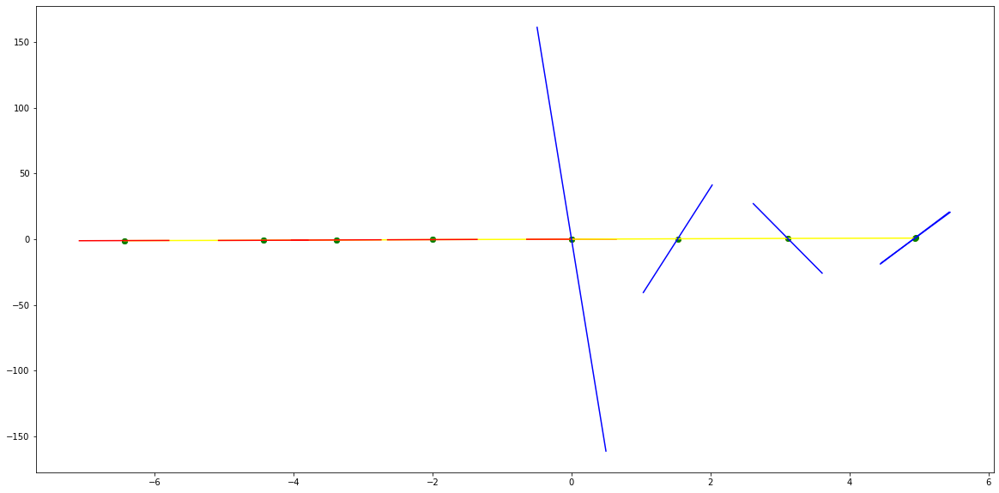

parameters (0.0002475915954406938, 0.005653810787933324, 0.045334594599727454, 0.1488650535526141, 0.34827700208584395, -0.0005065238614301642)
tangent[0]:0.17881374922696108
tangent[1]:0.2076545172287783
tangent[2]:0.18958186209014866
tangent[3]:0.13692563519744827
tangent[4]:0.34827700208584395
parameters (-601.8687171365508, 7139.944334553845, -30989.857498293015, 57749.964806444514, -38305.58527255919, -2.8811322224243967e-10)
tangent[0]:-38305.58527255919
tangent[1]:5949.8643025310375
tangent[2]:36.3784595892721
tangent[3]:39.3758580087524
tangent[4]:39.59571862960729


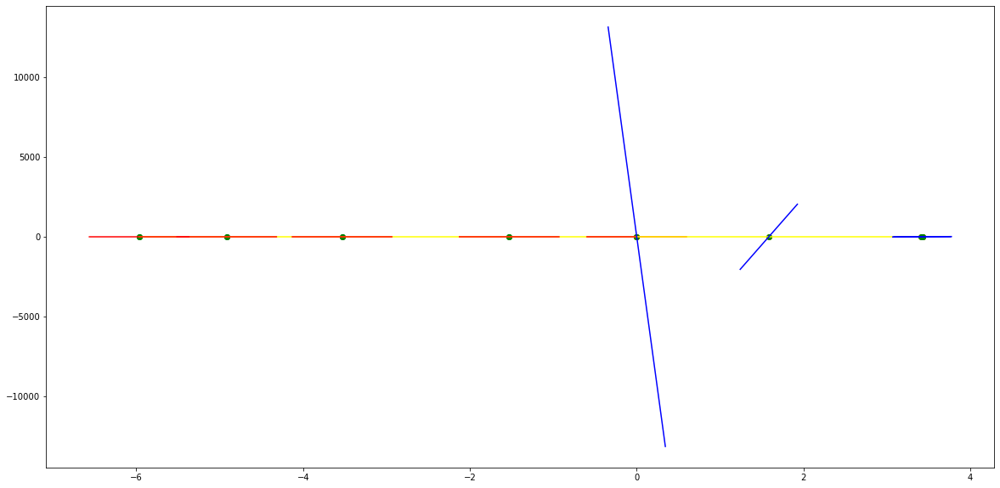

parameters (0.0001097867808730402, 0.002692120411348314, 0.02303330401511203, 0.0811918726009224, 0.28542017975240713, 0.004767123054189844)
tangent[0]:0.17198417565064966
tangent[1]:0.1973546049447817
tangent[2]:0.17623459254502688
tangent[3]:0.16224850936581917
tangent[4]:0.28542017975240713
parameters (11327.598683969001, -86788.89996352345, 249021.87517347158, -317143.050718033, 151266.7072962095, 8.23180634978399e-10)
tangent[0]:151266.7072962095
tangent[1]:34.625433578243246
tangent[2]:39.75536061832099
tangent[3]:40.15011221365421
tangent[4]:39.937967743346235


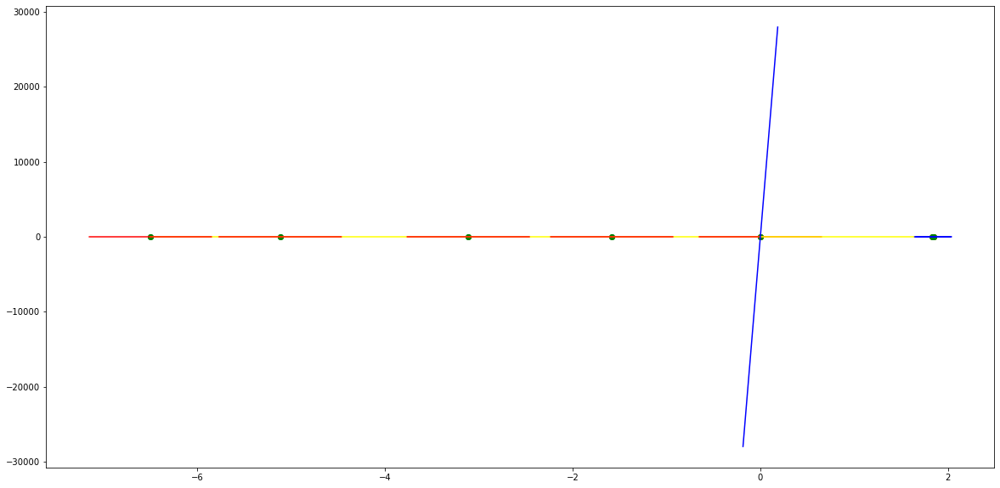

parameters (6.897790771187024e-05, 0.0014857217438642046, 0.011743833565497342, 0.04503535932934272, 0.2787677588927216, -0.15655585746994458)
tangent[0]:0.18239752806294168
tangent[1]:0.19225278775898197
tangent[2]:0.19922910302108376
tangent[3]:0.27764736823269087
tangent[4]:0.2787677588927216
parameters (186.88696693253308, -1225.719172487064, 2094.8546182980303, -653.8002215151802, 55.35240238155143, 0.06857327886925926)
tangent[0]:55.35240238155143
tangent[1]:50.01240133713154
tangent[2]:44.88972855489735
tangent[3]:30.794595482803913
tangent[4]:-14.17621386015216


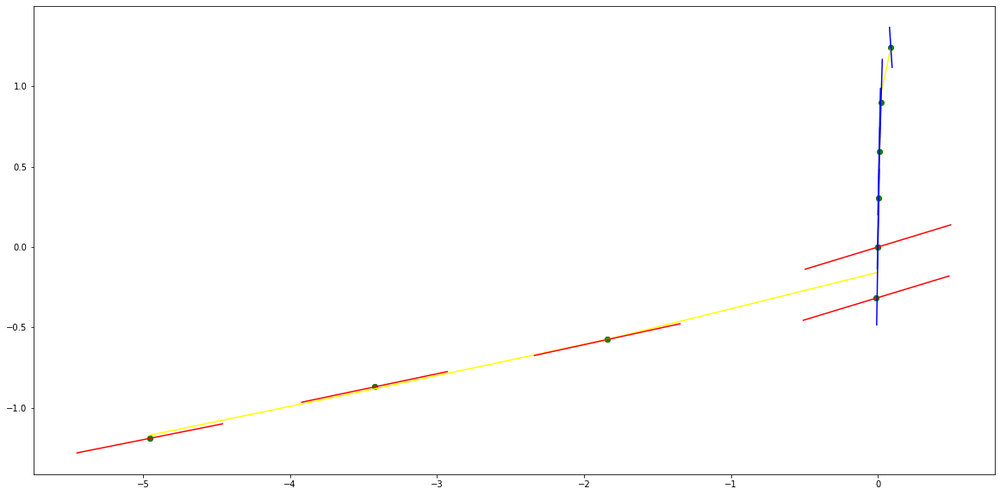

parameters (-601.8687173842234, -3430.3750115431008, -4930.132996293477, -1090.5185744572454, -47.24183110977485, -0.00048286374582801836)
tangent[0]:39.37585800427313
tangent[1]:39.595718626456616
tangent[2]:39.416805357310835
tangent[3]:36.431854142186964
tangent[4]:-47.24183110977485
parameters (-0.02994316399416939, 0.2897944839650615, -0.6725757502244075, -0.4933054990868908, 2.269224767616697, -0.002107151043023304)
tangent[0]:2.269224767616697
tangent[1]:2.047445528730762
tangent[2]:-0.8453188833685661
tangent[3]:1.8089474461912043
tangent[4]:1.8458909121664213


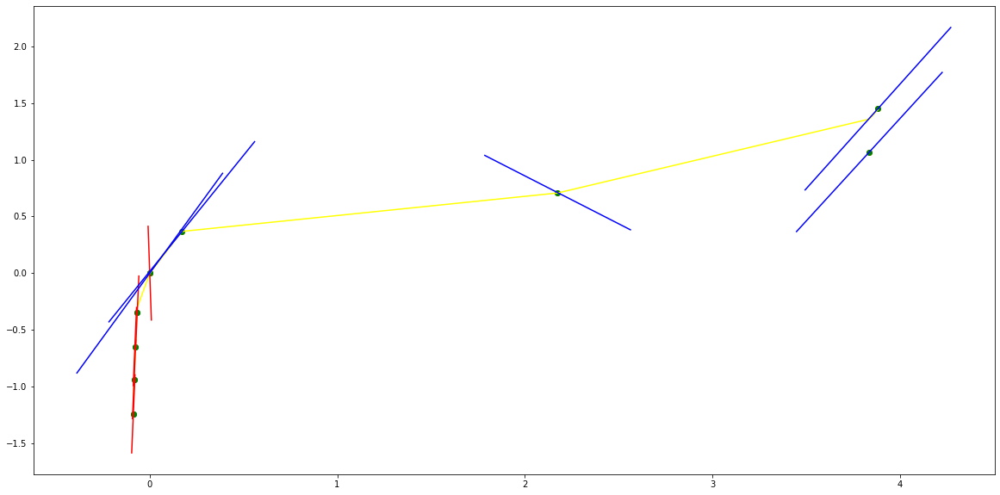

parameters (-9858.168136366252, -86259.30764855264, -282755.5481801972, -411516.6863060672, -224355.3512298548, 5.762264444848793e-10)
tangent[0]:40.06130608828971
tangent[1]:35.861301233118866
tangent[2]:-33.857937678170856
tangent[3]:261.15833114722045
tangent[4]:-224355.3512298548
parameters (-8.12272169506228, 75.1628044066394, -258.3417539257695, 390.933139422237, -218.98735502870719, -2.3999383567158753e-05)
tangent[0]:-218.98735502870719
tangent[1]:10.0041774130801
tangent[2]:7.884006214766117
tangent[3]:6.319262624982315
tangent[4]:0.17188837284820124


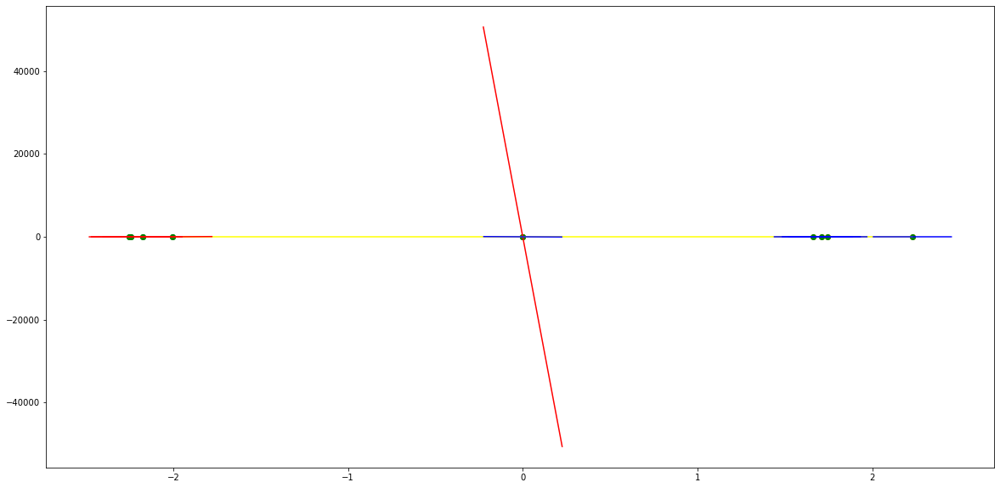

parameters (1.4652250614422858e-05, 0.00029306502412764586, 0.00119432018461937, -0.0041967951821106275, 0.24095426175620605, -0.001007038543196722)
tangent[0]:0.2411334907710847
tangent[1]:0.26619874178442515
tangent[2]:0.2755821844557475
tangent[3]:0.26391320268155344
tangent[4]:0.24095426175620605
parameters (2.6683013545122045, -44.601965083976026, 262.4495675338915, -627.571870981857, 492.43391737321326, 8.699733091979524e-08)
tangent[0]:492.43391737321326
tangent[1]:-149.60518445330763
tangent[2]:96.49922489418441
tangent[3]:-62.478833369245876
tangent[4]:101.55233595078334


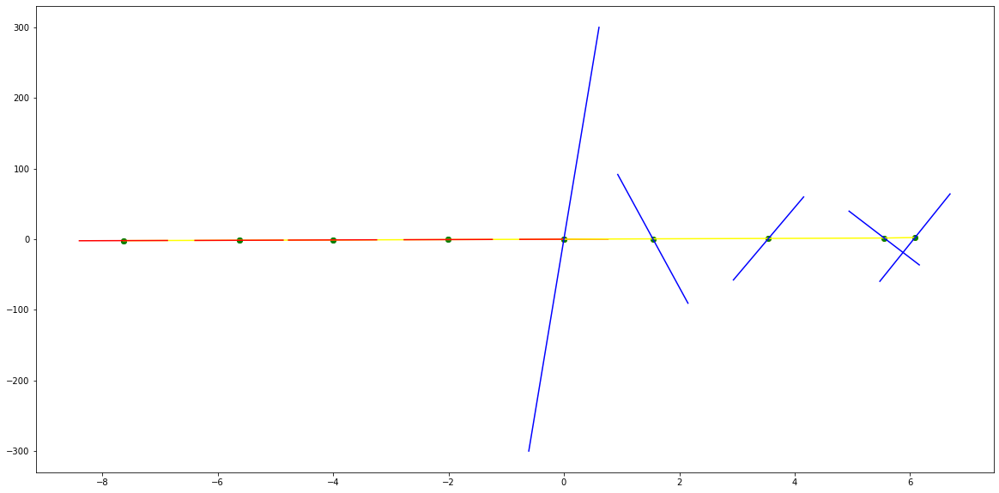

parameters (3.456199625959483e-05, 0.0011585038363612675, 0.013873576450132388, 0.0725734252498919, 0.42460355432759256, -0.001589988386358946)
tangent[0]:0.2721784267935563
tangent[1]:0.2728192442317954
tangent[2]:0.25395778641954414
tangent[3]:0.28375349262034355
tangent[4]:0.42460355432759256
parameters (-259.2470115051721, 3935.5720903235774, -21820.79562356059, 51846.371478912486, -43760.38693892028, -9.878167619740788e-10)
tangent[0]:-43760.38693892028
tangent[1]:6929.364631872588
tangent[2]:-685.8368346293355
tangent[3]:136.8282950537032
tangent[4]:126.16319763552019


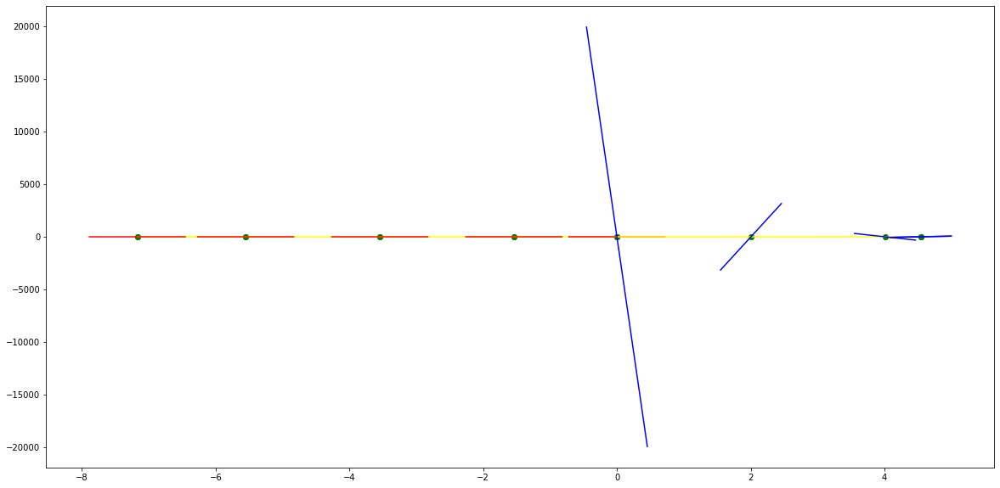

parameters (-1.580036410467468e-05, -0.0005284625078208478, -0.006179835252315901, -0.026675562245968423, 0.25959015219180714, 0.00398324799656606)
tangent[0]:0.25862420640274414
tangent[1]:0.27104016726502705
tangent[2]:0.2974185320053285
tangent[3]:0.3077894769895995
tangent[4]:0.25959015219180714
parameters (165600.50817502153, -1598887.9500081537, 5770563.344723643, -9223069.914836297, 5505497.341466121, 2.1073424255447014e-08)
tangent[0]:5505497.341466121
tangent[1]:-54124.38263712078
tangent[2]:189.7810060083866
tangent[3]:132.3919606730342
tangent[4]:97.20603143423796


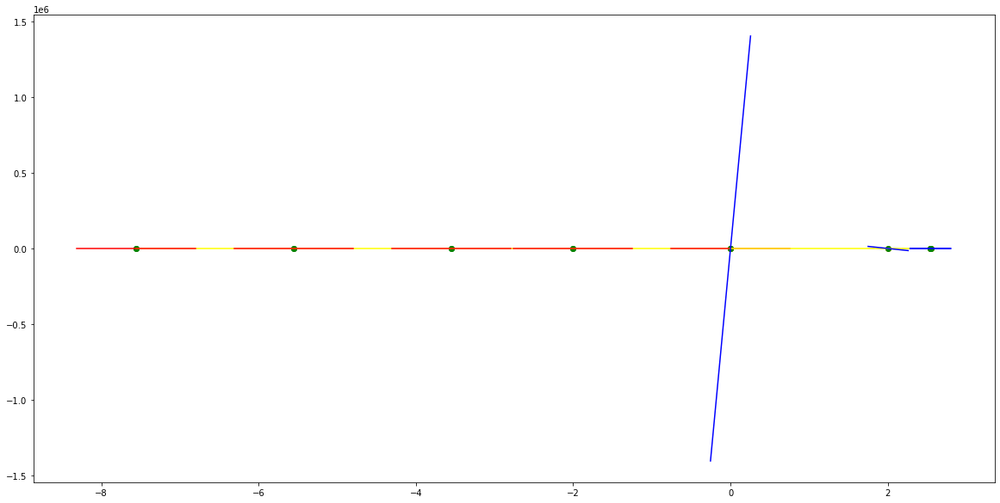

parameters (-0.0015267575335530161, -0.02817738369112982, -0.15666321006157846, -0.22788426577253718, 0.5870518670879941, -0.04136094673427506)
tangent[0]:0.9966526060268639
tangent[1]:0.23659824560673437
tangent[2]:0.2762984467405234
tangent[3]:0.710773737784363
tangent[4]:0.5870518670879941
parameters (1.793401214536164, -33.184607036434265, 218.95674447723215, -599.9888680636146, 561.5217262406072, 1.6187847186850217e-07)
tangent[0]:561.5217262406072
tangent[1]:-128.88018123987786
tangent[2]:71.64921819788424
tangent[3]:-40.067188472834914
tangent[4]:64.79140556249376


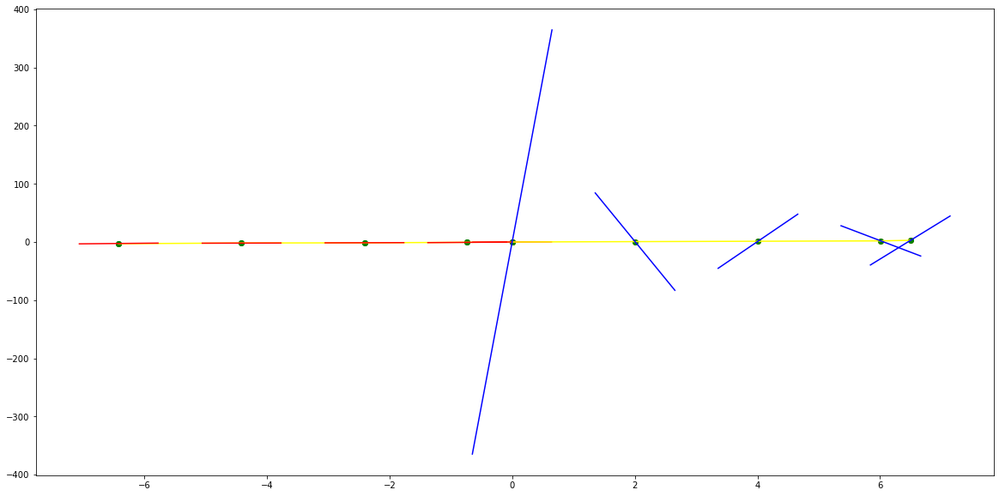

parameters (0.0023460598273742257, 0.04568533272318791, 0.3005237642472659, 0.772067817611378, 1.0592754529593917, 0.007925918928953033)
tangent[0]:-0.12177536595739591
tangent[1]:0.5466296307278751
tangent[2]:0.4983929117368908
tangent[3]:0.30406433530324595
tangent[4]:1.0592754529593917
parameters (-210.54666192244042, 3173.5692956834905, -17481.756365279547, 41302.32349487628, -34708.38680012204, -3.6631538256538756e-09)
tangent[0]:-34708.38680012204
tangent[1]:5394.73356666902
tangent[2]:-456.27638840372674
tangent[3]:98.32418365770718
tangent[4]:90.98312513472047


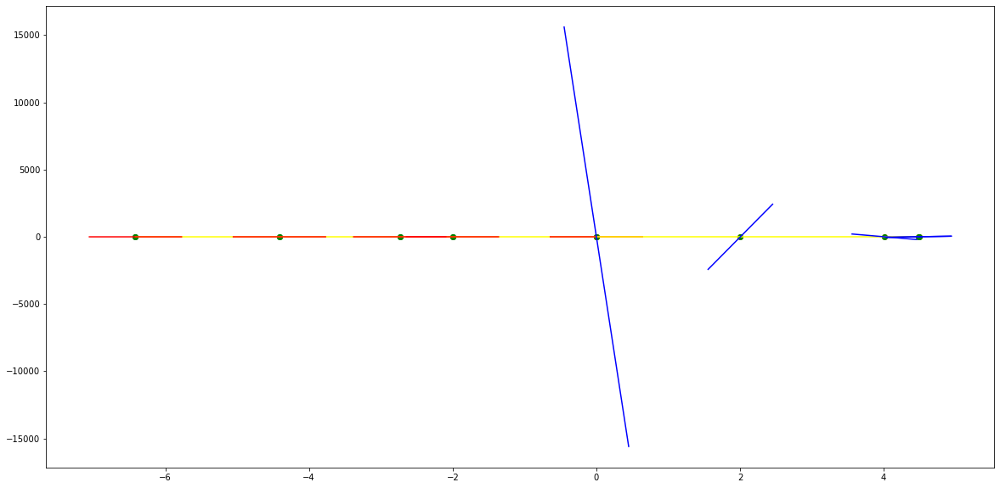

parameters (0.0006739131601383218, 0.01675927458800236, 0.1405393350951262, 0.44496296242610206, 0.7700176803329042, 0.000741854713849769)
tangent[0]:0.42048363955874035
tangent[1]:0.5862752844314241
tangent[2]:0.5294979568269136
tangent[3]:0.19467225175557834
tangent[4]:0.7700176803329042
parameters (11105.892173580605, -106868.07671656096, 384433.54686847836, -612484.8447618511, 364493.4030558104, 9.878167619740788e-10)
tangent[0]:364493.4030558104
tangent[1]:-3403.9353852075874
tangent[2]:120.27533391403267
tangent[3]:104.59385088417912
tangent[4]:89.77959321864182


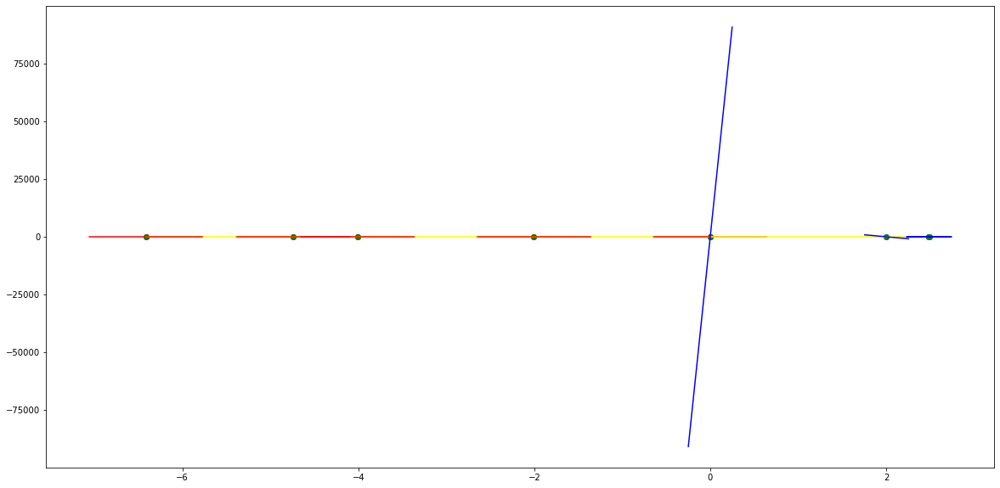

parameters (0.0002978883838532272, 0.009688517363064787, 0.11220081853631775, 0.5413377394788895, 1.3180251300479615, -0.044541467996313235)
tangent[0]:0.517852396990411
tangent[1]:0.33979231473491933
tangent[2]:0.1683327022178165
tangent[3]:0.872341936925052
tangent[4]:1.3180251300479615
parameters (249404.44651784867, -184663.5213144762, 40234.34959794363, -3541.9330178702016, 145.19621352687318, 0.09300134262675808)
tangent[0]:145.19621352687318
tangent[1]:117.72054852340798
tangent[2]:94.1264457377352
tangent[3]:32.484616106957816
tangent[4]:8.976298414311685


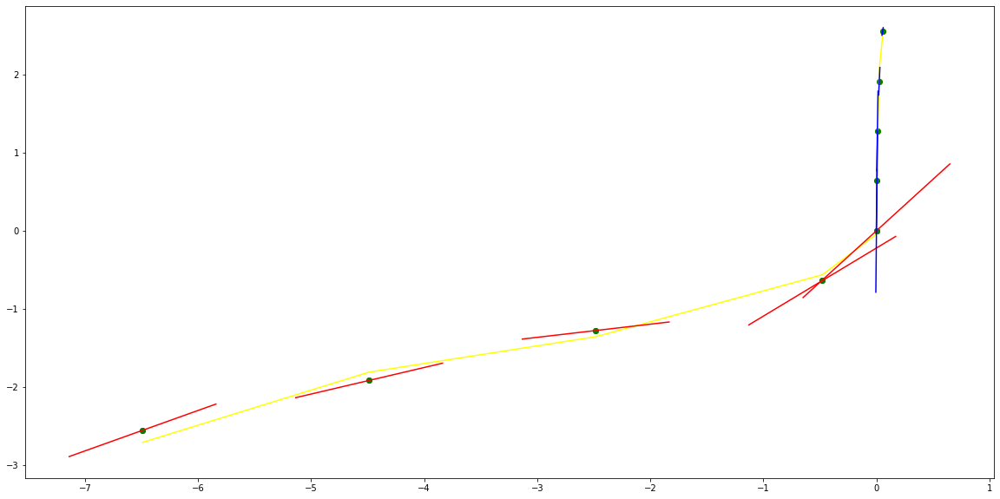

parameters (4.216362937797313e-05, 0.0013378639749025228, 0.01635354918168184, 0.09308467563134154, 0.545681270672607, -0.0026395141566545317)
tangent[0]:0.3181697956341515
tangent[1]:0.3073648664280024
tangent[2]:0.2978390063223598
tangent[3]:0.3699593585553008
tangent[4]:0.545681270672607
parameters (0.377985378397185, -5.892146074253518, 31.671044403319208, -66.91826197166361, 44.056755556616785, -0.0021561165122735045)
tangent[0]:44.056755556616785
tangent[1]:-16.776426448551824
tangent[2]:-16.739755004635363
tangent[3]:14.654908180007048
tangent[4]:-14.993572241080706


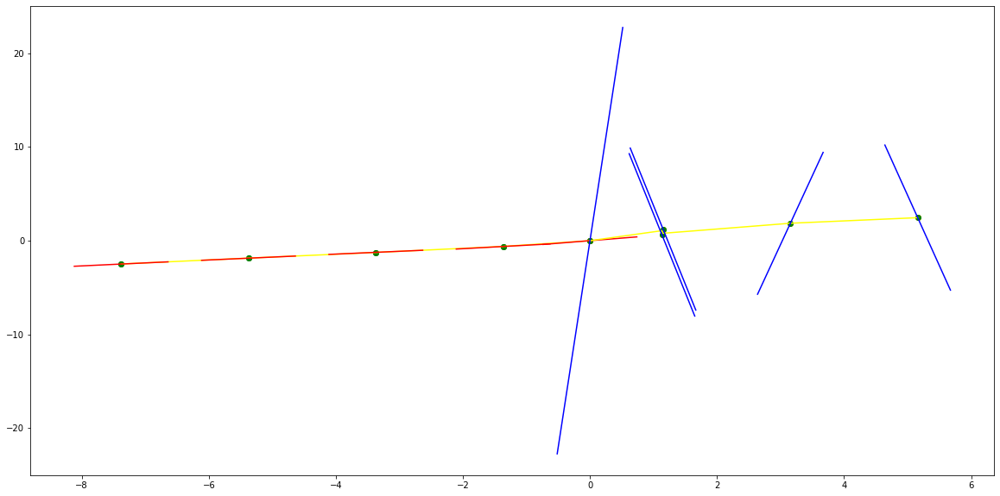

parameters (-0.0005518084732671219, -0.01568444953293279, -0.15714021350028637, -0.625177424740658, -0.2752739232401417, 0.0026212381992830255)
tangent[0]:0.38678320333013777
tangent[1]:0.6741314202133644
tangent[2]:0.7980504270964224
tangent[3]:0.7976299531398401
tangent[4]:-0.2752739232401417
parameters (224.90474375270722, -2574.062129366232, 10934.52207769179, -20385.38176228956, 14028.399167325428, 1.2032842931796747e-07)
tangent[0]:14028.399167325428
tangent[1]:-664.5360626693073
tangent[2]:40.13689105684898
tangent[3]:31.81517065475782
tangent[4]:29.812908911284467


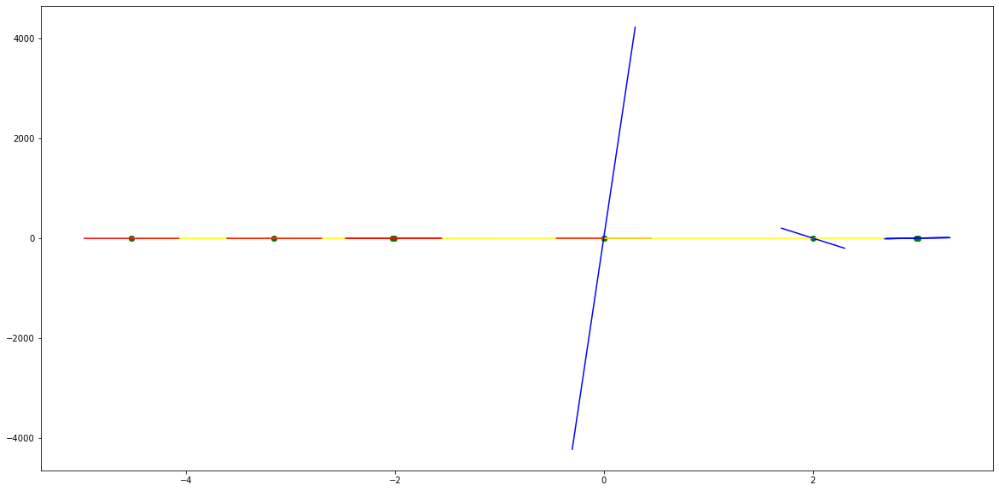

parameters (0.0005098852467662609, 0.012441807786303863, 0.09740472479272981, 0.24951900211341166, 0.49587075709984246, -0.002400413090941858)
tangent[0]:0.6712288659599643
tangent[1]:0.6452205940417026
tangent[2]:0.643545808360416
tangent[3]:0.30994773601522213
tangent[4]:0.49587075709984246
parameters (-2200.510621177345, 10976.157583653157, -20307.01120239199, 16533.348909438315, -5000.72641424369, -9.353132720993628e-08)
tangent[0]:-5000.72641424369
tangent[1]:61.157589402138
tangent[2]:42.63223625200135
tangent[3]:38.415267347577355
tangent[4]:-6.880799524034046


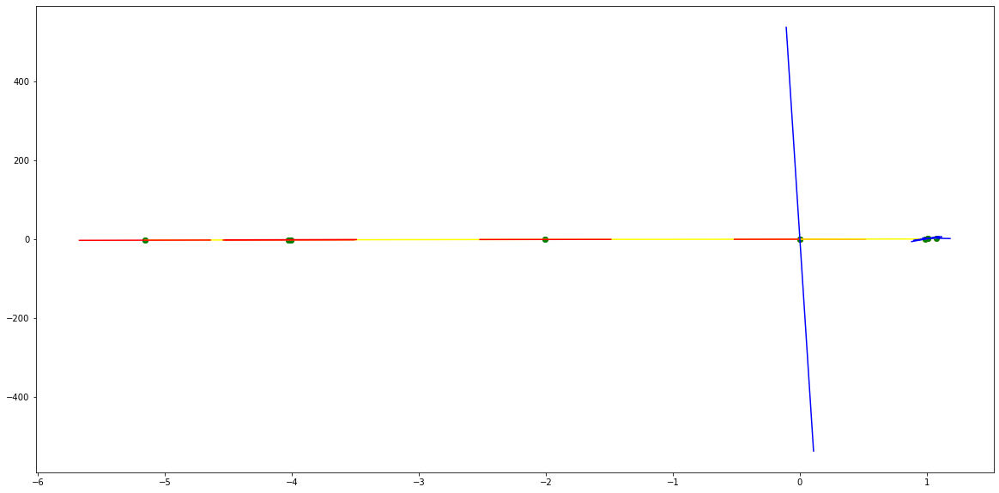

parameters (-0.0005834471295507916, -0.002720738168052818, 0.06051961918650089, 0.4689351557035471, 1.3465721758193518, -0.2881501685253081)
tangent[0]:0.7362157955970712
tangent[1]:0.2256285159278577
tangent[2]:0.5959222837289739
tangent[3]:1.3309911765344093
tangent[4]:1.3465721758193518
parameters (13009.8399820236, -21589.054735098114, 10911.611969852047, -2016.060236069308, 111.46837999060422, 0.08277598468537321)
tangent[0]:111.46837999060422
tangent[1]:95.22870932067785
tangent[2]:-38.95060759557465
tangent[3]:55.417157210827284
tangent[4]:51.92104009821419


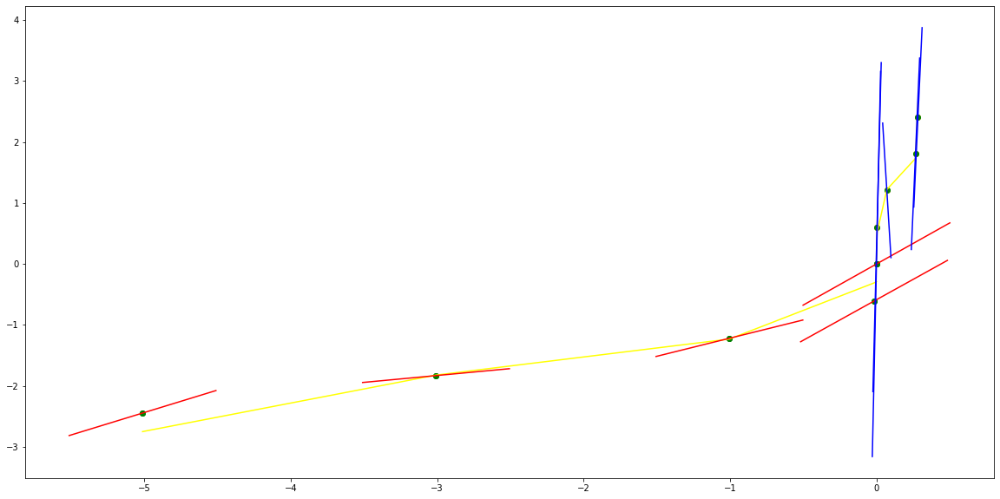

parameters (-54.69927286256244, -367.86722062936263, -910.1577195396101, -982.2464969380364, -389.8362996707457, -6.773095215114293e-06)
tangent[0]:14.573042044846602
tangent[1]:13.288948635301836
tangent[2]:-0.043348640623321444
tangent[3]:11.250112520533435
tangent[4]:-389.8362996707457
parameters (-73113.64931548273, 248070.29094875717, -281811.68123314134, 108688.1462617291, -1699.6290527366264, 1.4115489938292096e-07)
tangent[0]:-1699.6290527366264
tangent[1]:1693.0951134738248
tangent[2]:63.22178805327985
tangent[3]:88.86297390691016
tangent[4]:113.15680382534174


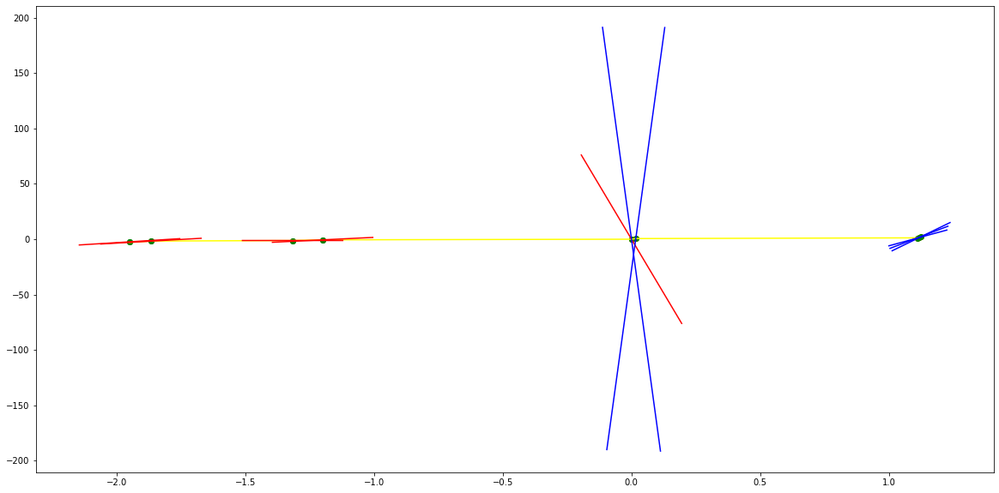

parameters (0.0024511829633105534, 0.04072068449996283, 0.22787957312164947, 0.45104818733430707, -1.223826942688403, 0.0011732055536758973)
tangent[0]:-1.1874121019576538
tangent[1]:-1.2013117708770198
tangent[2]:-1.4273666701114887
tangent[3]:-1.5934607080455991
tangent[4]:-1.223826942688403
parameters (-33.76196296661527, 330.9129725080348, -1158.2188847683037, 1695.5847277360358, -863.1263528994205, -1.1606615433641838e-06)
tangent[0]:-863.1263528994205
tangent[1]:160.90680663956482
tangent[2]:-90.42106957862416
tangent[3]:101.07216104516374
tangent[4]:-297.7802349514968


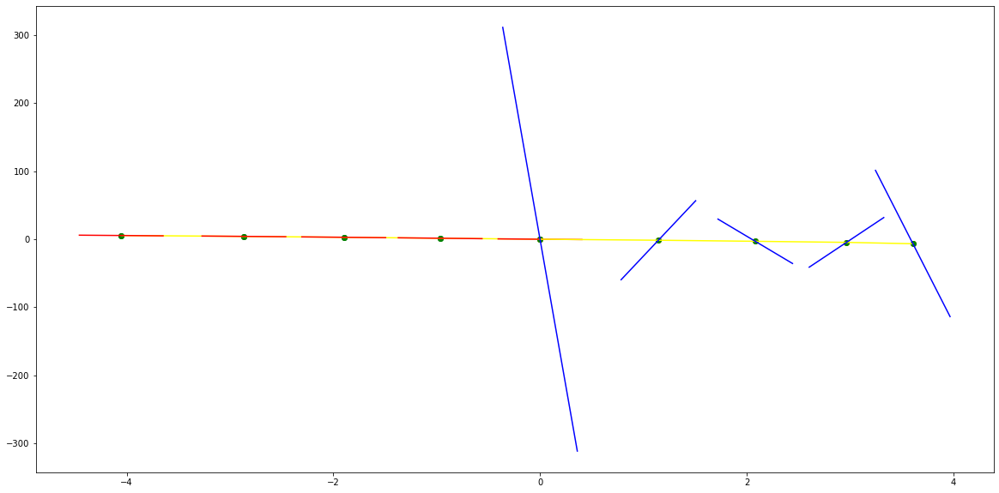

parameters (-0.003025026978754693, -0.05284695959296698, -0.31933562532066845, -0.7939934945853989, -2.154555436200443, 0.0003126478577697459)
tangent[0]:-1.4772036814379916
tangent[1]:-1.5343025454475647
tangent[2]:-1.3777718548321403
tangent[3]:-1.345321459800817
tangent[4]:-2.154555436200443
parameters (-687002.5080708392, 3775371.507850874, -7670269.355802176, 6799700.473607256, -2205350.3583257394, -3.951267047896315e-09)
tangent[0]:-2205350.3583257394
tangent[1]:169910.95190859493
tangent[2]:-548.422066536732
tangent[3]:-383.2721412675455
tangent[4]:-285.0368147576228


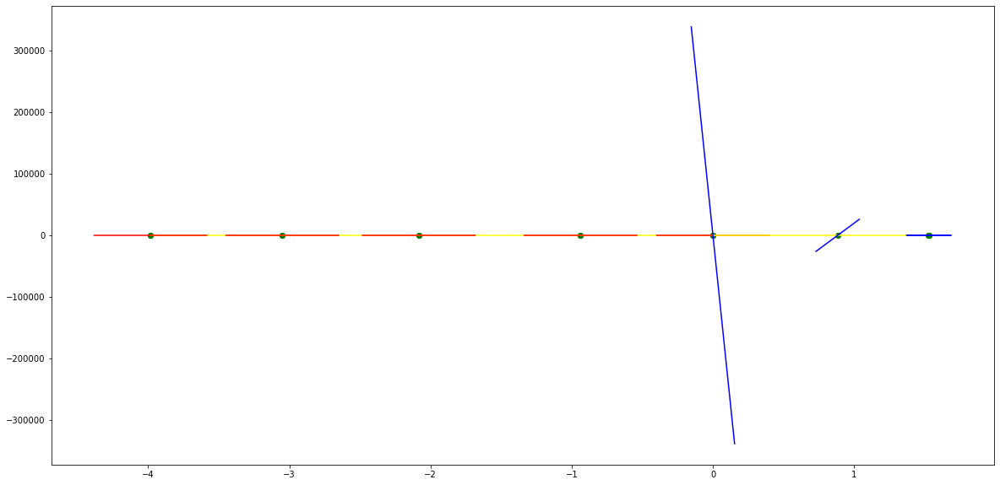

parameters (0.0002592262233511989, -0.0007777063772384074, -0.04698034898309709, -0.29402510221203054, -2.086520546423817, -0.007968339395929062)
tangent[0]:-1.4544986478887618
tangent[1]:-1.4007881505126882
tangent[2]:-1.450033119049845
tangent[3]:-1.6741162327220684
tangent[4]:-2.086520546423817
parameters (65687934.45101389, -172858658.97598988, 170562212.96876228, -74791076.94256757, 12297260.013359116, 1.71221572075507e-08)
tangent[0]:12297260.013359116
tangent[1]:-676.1804690044373
tangent[2]:-352.6801106315106
tangent[3]:-237.71371589414775
tangent[4]:-353.8589042555541


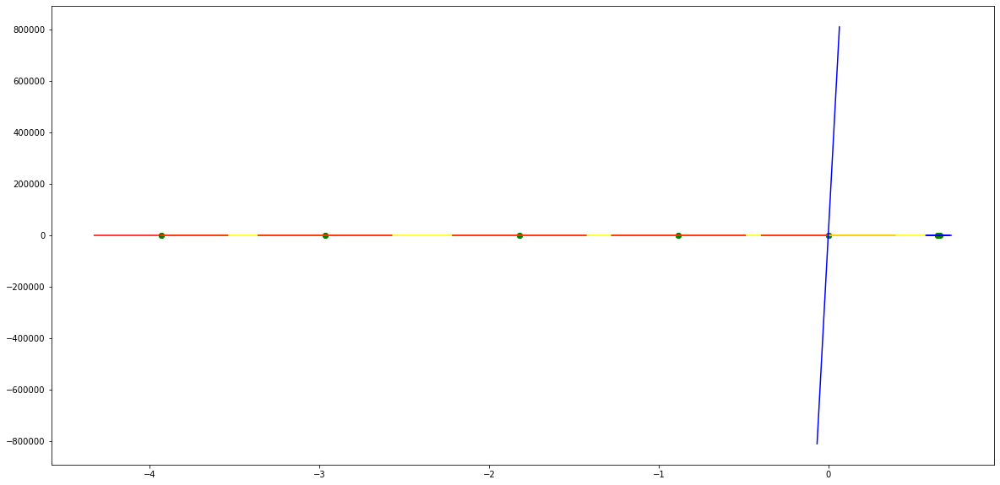

parameters (-0.012945531792001617, -0.1440755405415056, -0.5545757568614347, -0.8491242934242518, -3.033495580442146, 0.004048815881335378)
tangent[0]:-2.709285895673336
tangent[1]:-2.7067642086495125
tangent[2]:-2.565423205429388
tangent[3]:-2.489289656378358
tangent[4]:-3.033495580442146
parameters (-44.761972938212736, 284.6895393275568, -631.8838593256925, 570.6198225236772, -175.60559960210625, -3.242519100337293e-05)
tangent[0]:-175.60559960210625
tangent[1]:40.57342684885859
tangent[2]:-33.285410353976744
tangent[3]:45.06248180952858
tangent[4]:-203.11437069845155


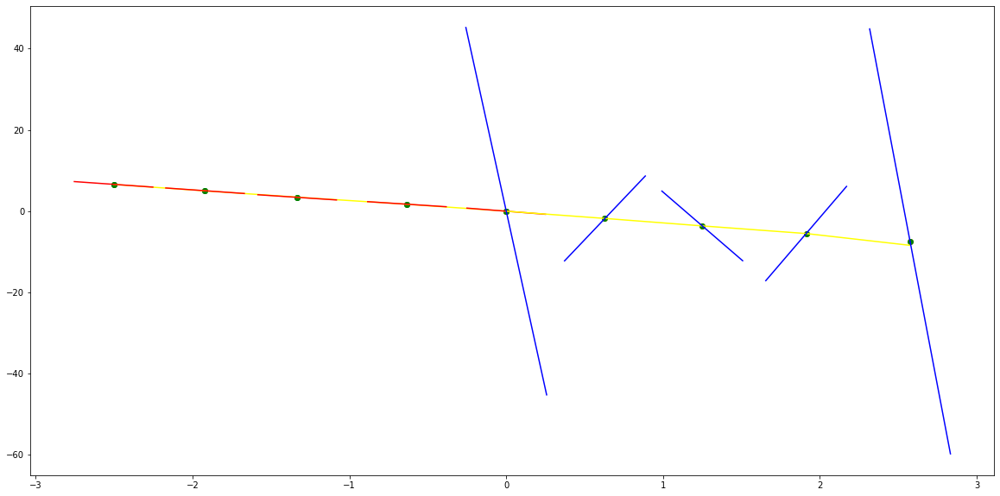

parameters (-0.005613579645600329, -0.07399030739053718, -0.3531774082620954, -0.7303498941815467, -3.2276993312417743, -0.005761487484384907)
tangent[0]:-2.6718601120074834
tangent[1]:-2.621116580159743
tangent[2]:-2.5481036736968337
tangent[3]:-2.658779369852918
tangent[4]:-3.2276993312417743
parameters (2747.4404151686404, -16129.511795286373, 33743.10700792037, -29252.723845038498, 8603.839604965733, 4.4284031234456695e-07)
tangent[0]:8603.839604965733
tangent[1]:-2098.8214901105403
tangent[2]:1138.0903104857734
tangent[3]:-355.8550570966163
tangent[4]:-324.25461799913137


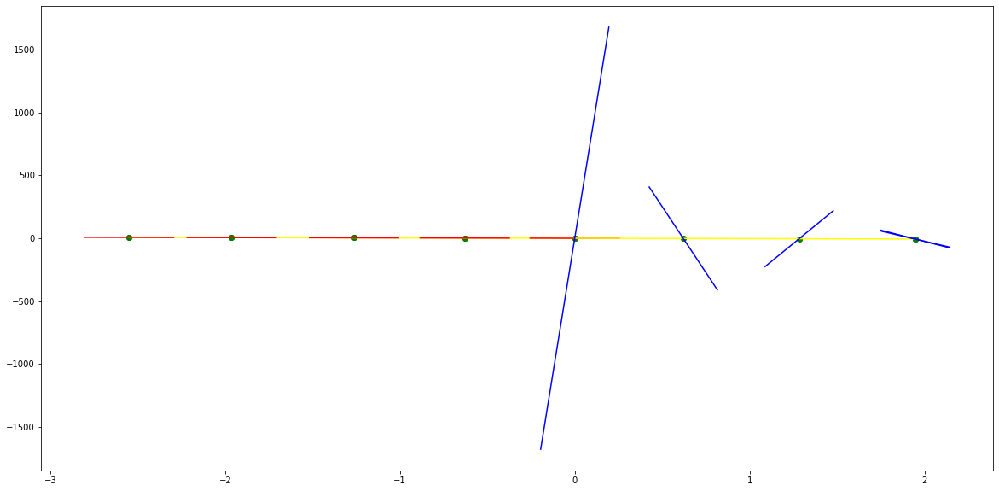

parameters (0.00735362839202824, 0.0983205573592947, 0.4497672787168564, 0.7611903346353177, -2.482108234751588, 0.0025559684958769073)
tangent[0]:-2.5573826765382845
tangent[1]:-2.7175926782544875
tangent[2]:-2.945107113912647
tangent[3]:-3.005742246078717
tangent[4]:-2.482108234751588
parameters (8553697.475625893, -24025839.73089152, 25282932.748443864, -11814501.523192229, 2068617.1134796073, -4.939083809870394e-09)
tangent[0]:2068617.1134796073
tangent[1]:-711.8804814456962
tangent[2]:-447.60681704944
tangent[3]:-263.51518148509786
tangent[4]:-164.84977077087387


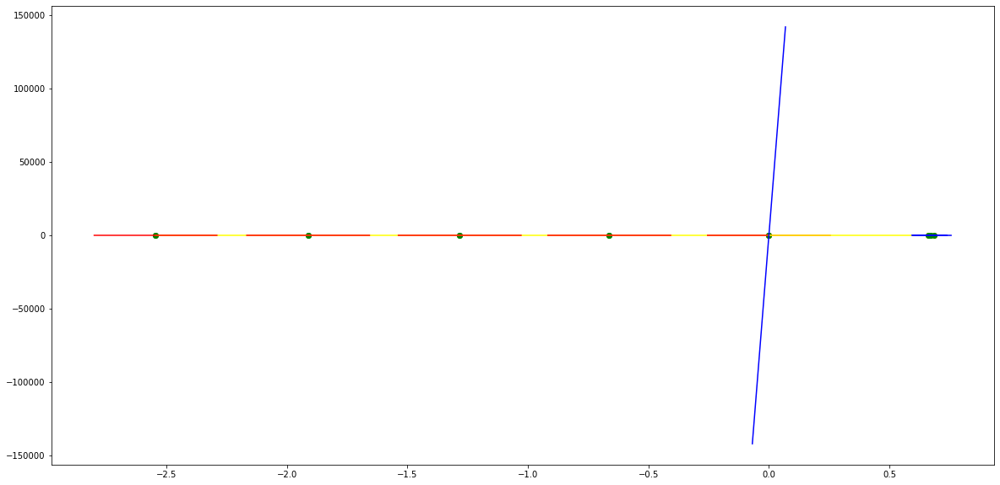

parameters (0.048522670086780684, 0.3141079511382106, 0.5744429257805133, 0.2534763185419821, -2.780904057561069, -0.004786665131608513)
tangent[0]:-3.250411129766958
tangent[1]:-2.7960717210824115
tangent[2]:-2.570355999687213
tangent[3]:-2.7184046848753853
tangent[4]:-2.780904057561069
parameters (-291.3248387706532, 1572.4407227353986, -2951.36510035465, 2207.278414312037, -518.0589388207553, -1.519025515483577e-07)
tangent[0]:-518.0589388207553
tangent[1]:194.7560723969176
tangent[2]:-129.81570252096742
tangent[3]:134.08640347955054
tangent[4]:-402.9894947593201


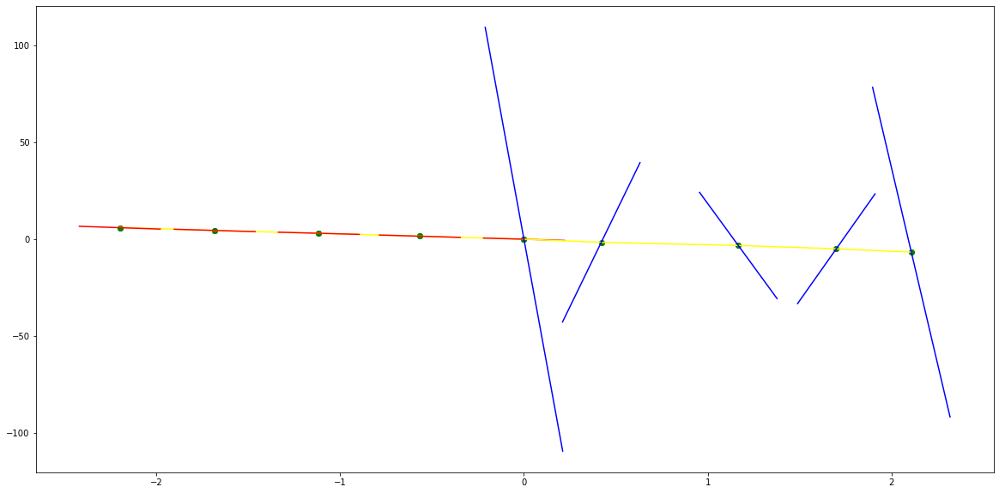

parameters (-0.06283118414179358, -0.6177991616327824, -2.098684396048447, -2.8421458632070813, -4.063911104021935, 0.01313607555977847)
tangent[0]:-3.041296191968687
tangent[1]:-3.0790814238038227
tangent[2]:-2.7635336034521396
tangent[3]:-2.473694741824052
tangent[4]:-4.063911104021935
parameters (-88209.04405096176, 152054.7156081531, -98544.51432200227, 27444.061511156735, -2679.791510457142, 3.697881758692027e-12)
tangent[0]:-2679.791510457142
tangent[1]:-411.47583323304025
tangent[2]:-421.43463500333564
tangent[3]:-431.1590230052698
tangent[4]:-440.700201222744


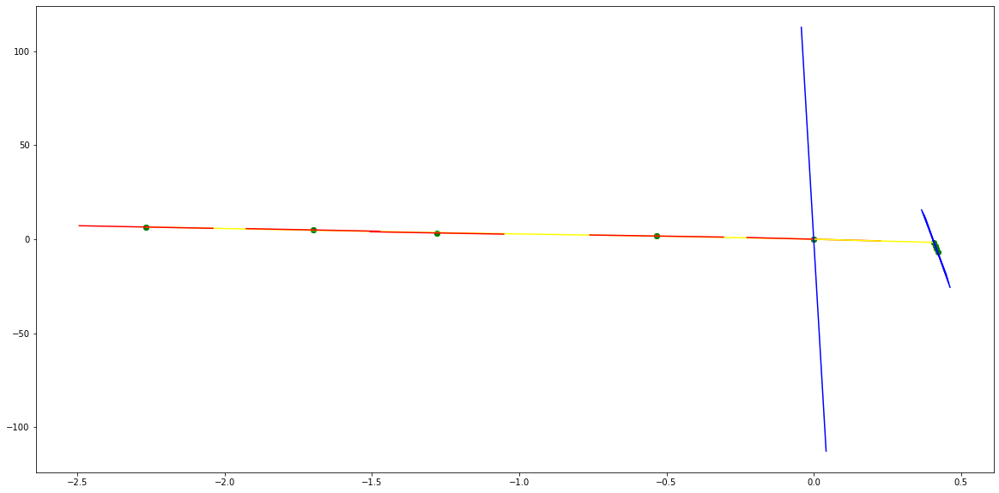

parameters (0.19729346124413524, 1.1817661279276144, 2.5017879187376386, 1.897716047703692, -1.39318718286081, -0.002599327050804204)
tangent[0]:-1.2552779455113858
tangent[1]:-1.496762794865236
tangent[2]:-1.8656878418890552
tangent[3]:-1.9895370047162735
tangent[4]:-1.39318718286081
parameters (-8887.220634297391, 24630.594073615724, -24232.18741327453, 9801.676522522479, -1321.0643992305631, -3.152260912971696e-07)
tangent[0]:-1321.0643992305631
tangent[1]:373.9807305883078
tangent[2]:-196.330570639273
tangent[3]:99.72163471056047
tangent[4]:-180.3012632362079


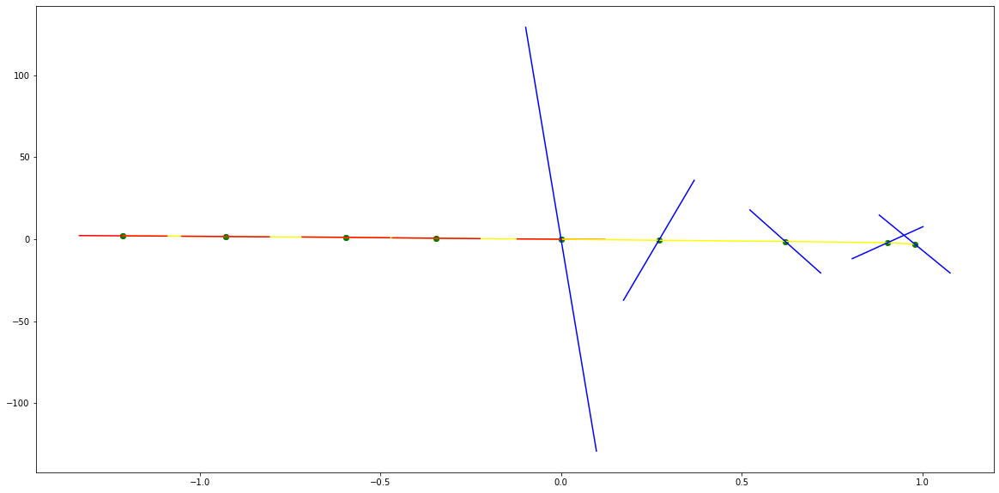

parameters (70845269.22621372, 26098792.456929494, 2232901.4766077376, 68827.08829769059, 359.4400487167206, -0.007587653243298513)
tangent[0]:-290.8133614659594
tangent[1]:-478.1751546811045
tangent[2]:-530.021955519366
tangent[3]:-509.8133034818381
tangent[4]:359.4400487167206
parameters (-14502552.44963363, 3206153.559689975, -263820.60722856823, 10876.44862221285, -428.852758131401, -0.28560588489511696)
tangent[0]:-428.852758131401
tangent[1]:-351.04522433054893
tangent[2]:-232.3753115250326
tangent[3]:-207.6346658468911
tangent[4]:-193.2111015893832


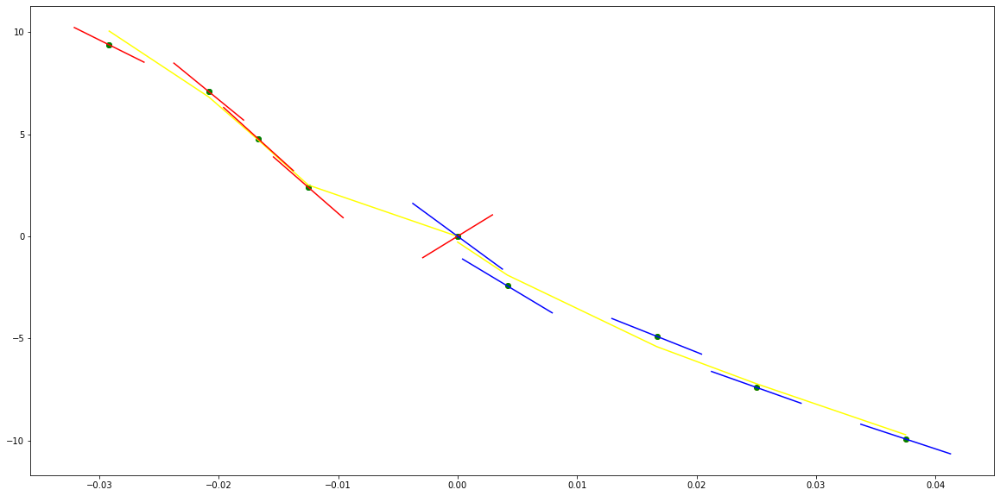

parameters (0.007445393399901311, 0.09928776935664818, 0.47551495404613187, 0.9189980979811448, -0.8642280774243888, -0.002887900634111486)
tangent[0]:-1.2495486763164423
tangent[1]:-1.3688579853448535
tangent[2]:-1.5762146520535159
tangent[3]:-1.6171153322845941
tangent[4]:-0.8642280774243888
parameters (-184.64351268221452, 689.3540794321748, -693.3389995955381, 3.929303097249029, 162.4976827299064, -5.144878968614994e-12)
tangent[0]:162.4976827299064
tangent[1]:-128.4146501891392
tangent[2]:127.56741086263017
tangent[3]:-308.60439496825853
tangent[4]:-320.3961783084552


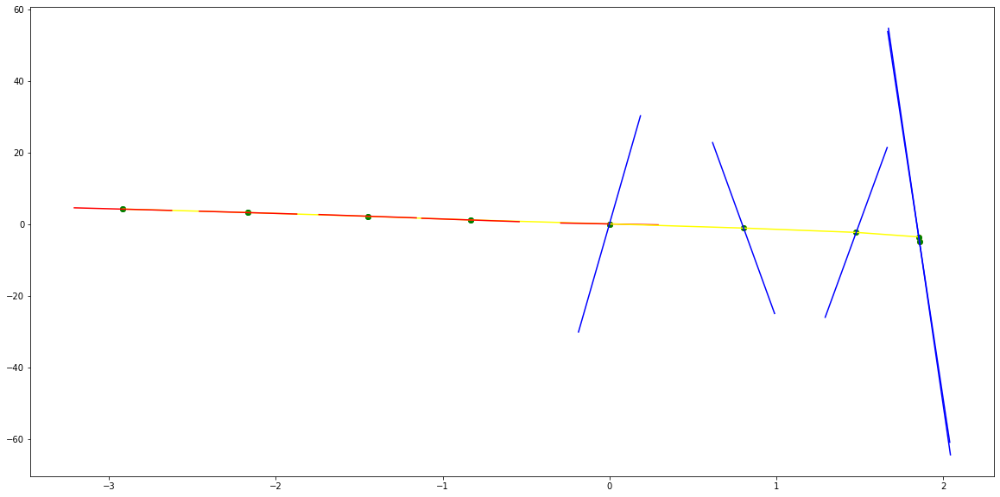

parameters (-0.0027452241339546326, -0.03220562131248409, -0.11573447223569769, -0.12960855221309628, -1.4442537214313849, 0.004825997397860116)
tangent[0]:-1.429990944793206
tangent[1]:-1.503031295310684
tangent[2]:-1.4838349809059117
tangent[3]:-1.3990780941336567
tangent[4]:-1.4442537214313849
parameters (517142.97924911947, -1991545.9349136392, 2846716.104070694, -1785960.2428667115, 413624.22531463613, -7.408625714805591e-10)
tangent[0]:413624.22531463613
tangent[1]:-19512.68082300073
tangent[2]:-279.6050046175951
tangent[3]:-322.3657027852023
tangent[4]:-344.71534023399


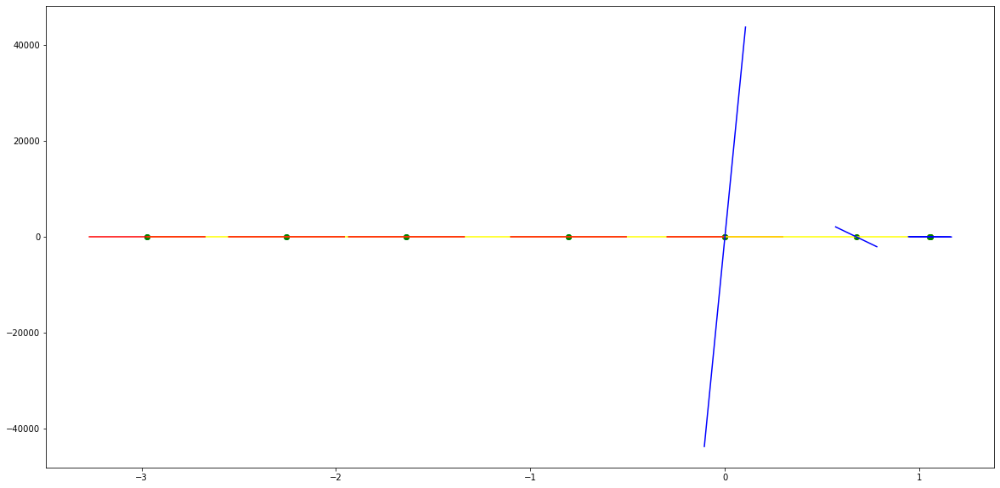

parameters (-0.0020580319596754334, -0.049157901302101285, -0.4014286405690642, -1.3130776721844901, -4.481434813447745, -0.028472662400424915)
tangent[0]:-3.2310059457216003
tangent[1]:-3.3030348456273995
tangent[2]:-2.8369905200832797
tangent[3]:-2.7122412826504747
tangent[4]:-4.481434813447745
parameters (2.16946985451834, -30.658212104630376, 146.13963999231345, -270.11212418677616, 161.0917408197978, 2.7441498198850223e-08)
tangent[0]:161.0917408197978
tangent[1]:-41.076065669128525
tangent[2]:32.2212192977903
tangent[3]:-128.75088228064953
tangent[4]:-130.60876705559588


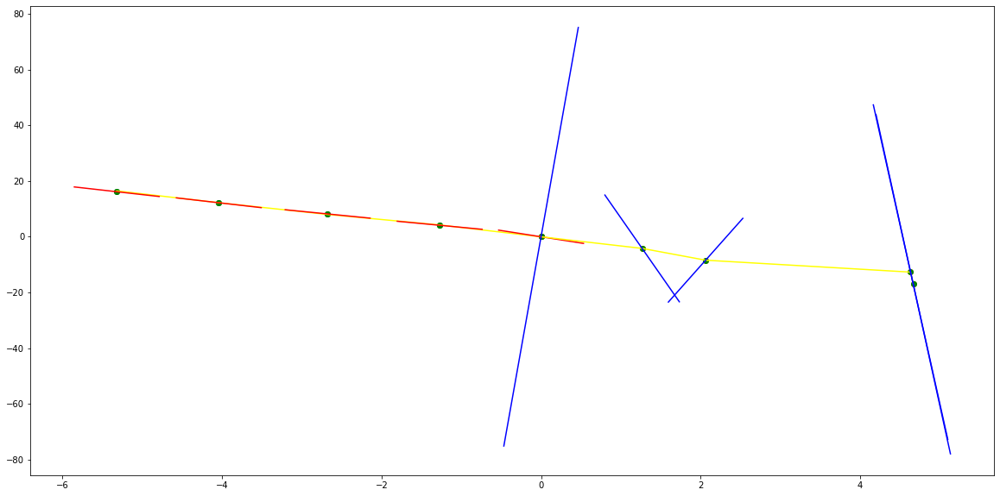

parameters (0.001640861465102575, 0.03339631770448729, 0.22342173865711346, 0.5193747178703717, -2.9206153921983216, 0.003919882968848212)
tangent[0]:-3.01428852914981
tangent[1]:-2.801693281749002
tangent[2]:-3.0831335569475784
tangent[3]:-3.411326326574494
tangent[4]:-2.9206153921983216
parameters (-2.379572686713117, 33.53812120695469, -172.38232825964593, 345.9018459016155, -187.36797788130207, -2.990460900507465e-11)
tangent[0]:-187.36797788130207
tangent[1]:98.50283051125047
tangent[2]:-129.1333827012195
tangent[3]:-130.59746680623903
tangent[4]:-132.00355406521612


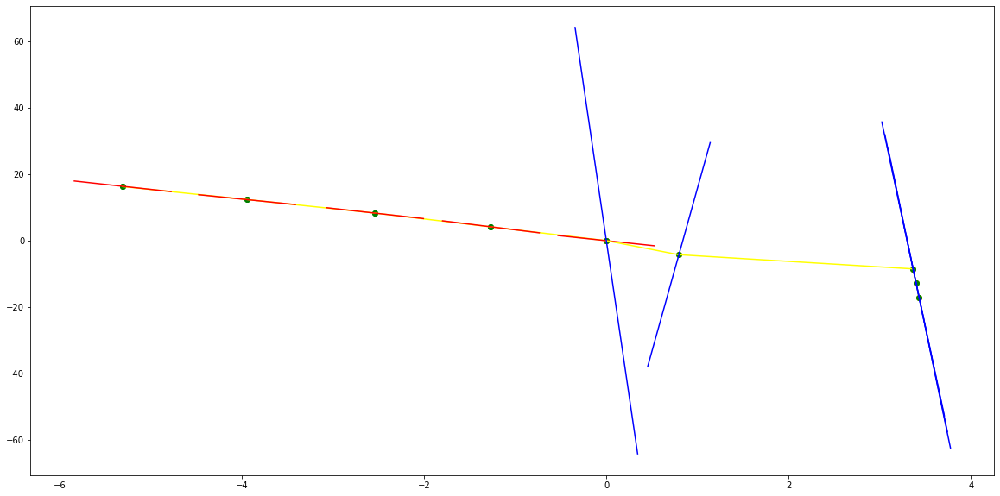

parameters (-0.0018419711336131763, -0.04257313364445051, -0.3765319925093088, -1.5848741148918957, -6.1552916199665075, 0.040140206627584)
tangent[0]:-3.023560707471355
tangent[1]:-2.970418896022654
tangent[2]:-3.0954477551822475
tangent[3]:-4.265991133517614
tangent[4]:-6.1552916199665075
parameters (-1.8874935152618404, 18.725255699215428, -58.94188479384184, 10.485252930109898, 125.12623931322669, 8.038873388460928e-14)
tangent[0]:125.12623931322669
tangent[1]:-129.13961011801405
tangent[2]:-130.59800011558173
tangent[3]:-132.00205656053606
tangent[4]:-133.35714435941736


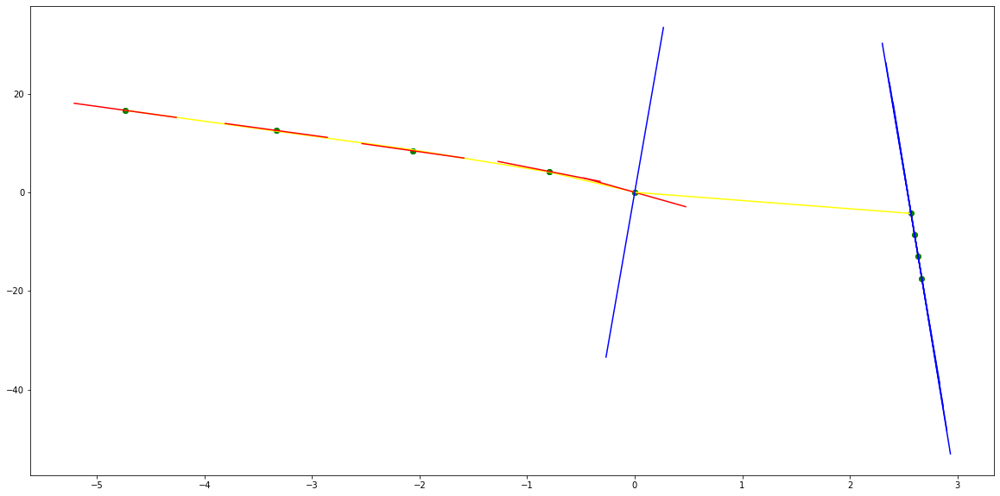

parameters (-272.54974358971396, -268.1107226106969, -89.94972960372169, 27.54489032634132, 20.098180836829883, 0.00027331235431501456)
tangent[0]:4.685402328671341
tangent[1]:8.692710207459218
tangent[2]:12.8268789020979
tangent[3]:16.79460701398601
tangent[4]:20.098180836829883
parameters (52.593846153926606, -11.670675990754228, -10.958807692280352, 11.23418904428489, -34.344623417249196, 0.0003566328671357327)
tangent[0]:-34.344623417249196
tangent[1]:-33.30758735081588
tangent[2]:-32.44693562004668
tangent[3]:-31.738512175990707
tangent[4]:-31.118715585081603


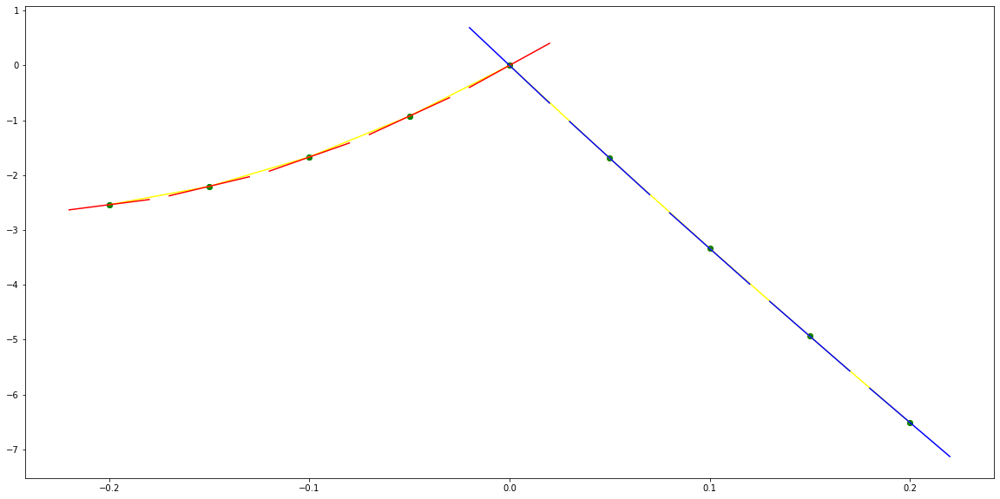

parameters (-0.03264092509197434, -0.3797672282993084, -0.7537360885149067, -0.8082691769434132, -1.1419064280075264, -0.000465205018014322)
tangent[0]:-0.5620298549183245
tangent[1]:-0.6567075809824001
tangent[2]:-0.7462523281303997
tangent[3]:-0.8792229046288909
tangent[4]:-1.1419064280075264
parameters (114109.91447164984, -205614.54589578434, 134637.40316961557, -37531.16426669956, 3677.008431381226, 9.698096855839263e-08)
tangent[0]:3677.008431381226
tangent[1]:-670.0164795301662
tangent[2]:84.44958179076639
tangent[3]:-70.51995306366007
tangent[4]:-72.85257176275627


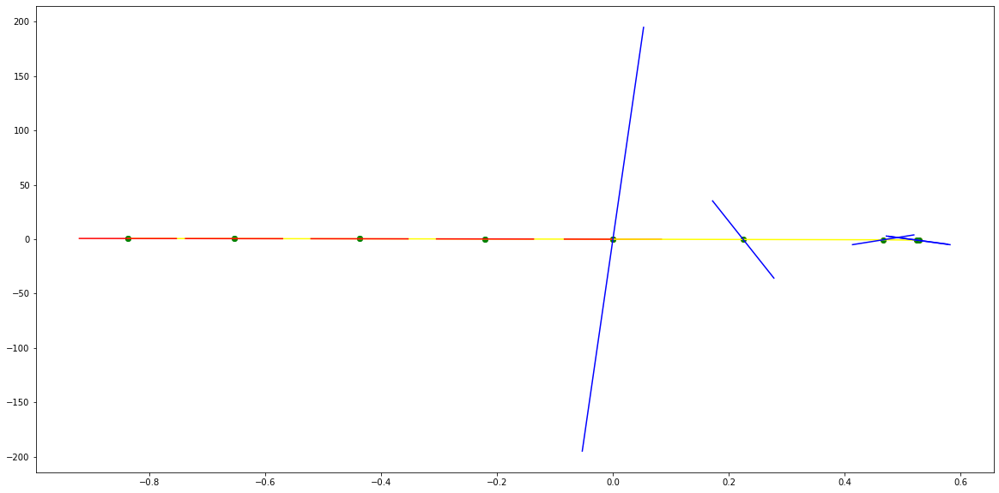

parameters (12131.278396633355, 11468.335501229622, 3410.9396432192075, 316.6567793973609, -6.673050201802635, -0.0016208282038374727)
tangent[0]:-30.40022561874836
tangent[1]:-29.68270891227048
tangent[2]:6.913775809612989
tangent[3]:-18.3530063799959
tangent[4]:-6.673050201802635
parameters (-4972122.859387046, 2082541.6176124183, -291723.35039977403, 15278.329931195125, -273.3381906907431, 0.056337494429448756)
tangent[0]:-273.3381906907431
tangent[1]:-160.60970835377563
tangent[2]:-74.78013226885321
tangent[3]:-148.7501045191101
tangent[4]:-165.27882483734686


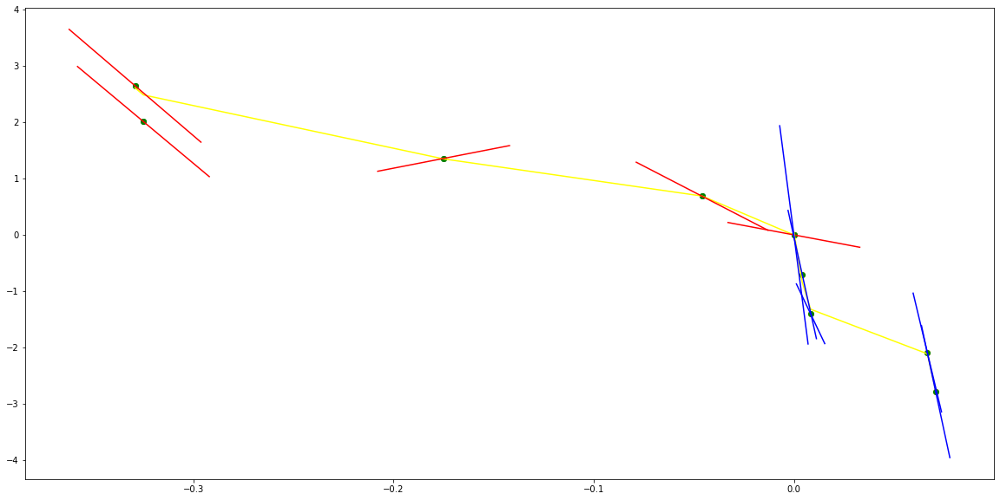

parameters (0.00019047192502574873, 0.004001416016227112, 0.02772323181752359, 0.07834296598238528, 0.04735725698977755, 0.00011976307851299088)
tangent[0]:-0.08184699105936
tangent[1]:-0.03775321724489866
tangent[2]:-0.0267470390579736
tangent[3]:-0.04839484238809891
tangent[4]:0.04735725698977755
parameters (-3589.0035765112516, 35969.957386092006, -134414.68539889593, 221746.14858203672, -136093.9505939906, 0.0)
tangent[0]:-136093.9505939906
tangent[1]:3019.9923809406173
tangent[2]:-20.145033290464198
tangent[3]:-15.126126342540374
tangent[4]:-10.728432718286058


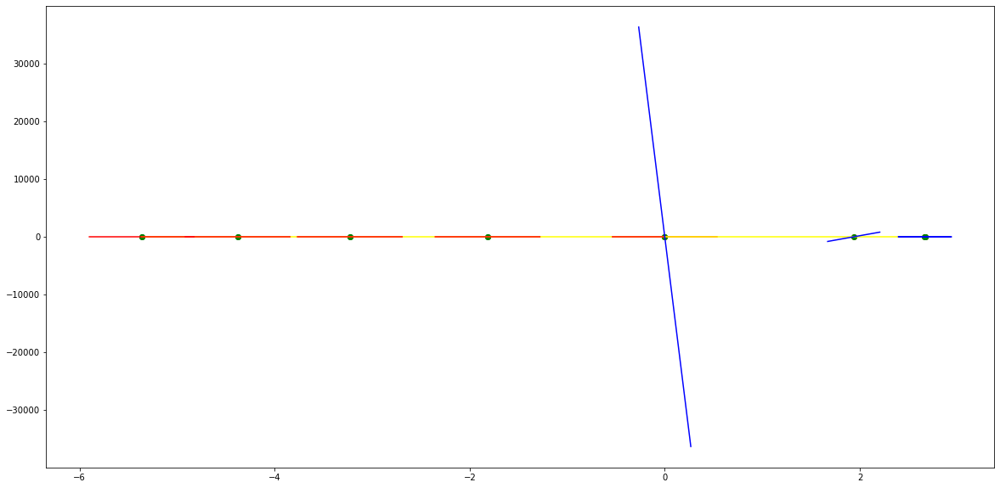

parameters (-6.75441387317142e-05, -0.0012441624007837708, -0.008328254308945772, -0.022438324717219727, -0.04451099042930602, 1.9094956834408987e-05)
tangent[0]:-0.041302733780045134
tangent[1]:-0.03387422872523817
tangent[2]:-0.03193263236231679
tangent[3]:-0.019915901579173667
tangent[4]:-0.04451099042930602
parameters (288403.46255930257, -879414.9571867846, 1005191.8765482781, -510452.2781576007, 97169.09425478513, -1.3376685318398984e-10)
tangent[0]:97169.09425478513
tangent[1]:-25.071679376153043
tangent[2]:-14.645835329516558
tangent[3]:-6.968290379823884
tangent[4]:-9.20230168136186


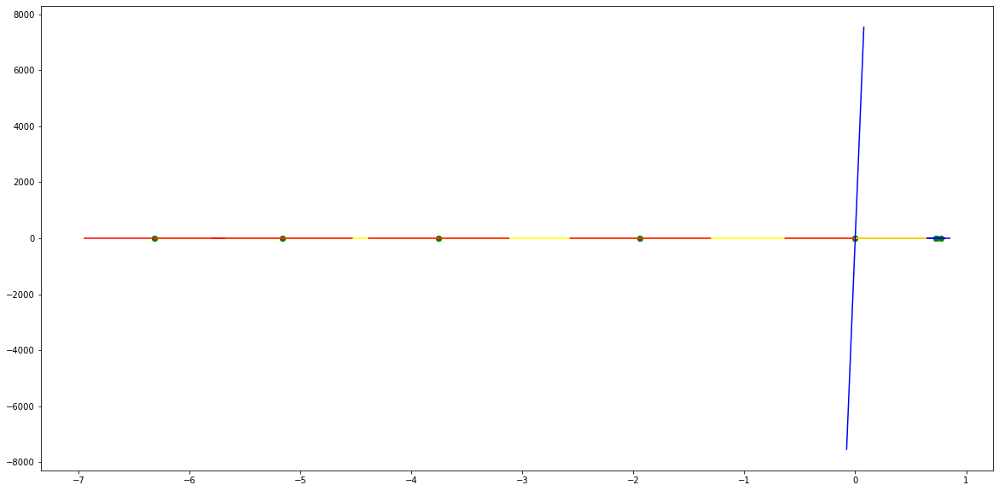

parameters (0.12950696984554338, 0.8808532543337194, 2.1080120456656526, 1.8575263808179372, -1.8229879202015755, -0.0004844812862729233)
tangent[0]:-1.780772231520748
tangent[1]:-1.9884731557021846
tangent[2]:-2.3486935646533507
tangent[3]:-2.505281967407334
tangent[4]:-1.8229879202015755
parameters (-77.12251630142333, 304.12977292350604, -417.92415898086864, 231.0879054495428, -43.90366960815904, 0.00026814240061624956)
tangent[0]:-43.90366960815904
tangent[1]:11.032043967570736
tangent[2]:-11.654489416206978
tangent[3]:9.10715893520453
tangent[4]:-37.00114398443113


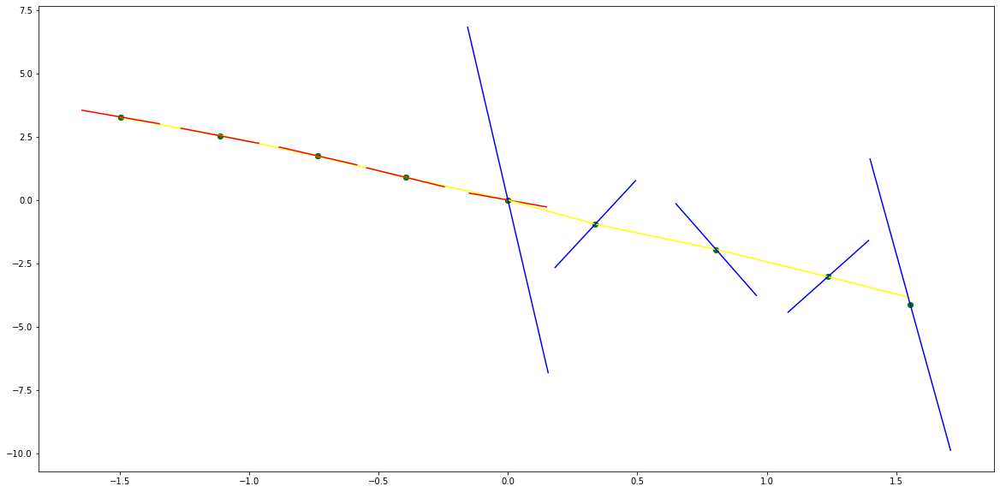

parameters (-0.05228672557187288, 0.02631909736825903, 0.8568301903272777, 1.3117716729511768, -1.50284191918811, -0.0008398911257025295)
tangent[0]:-1.6362614348403206
tangent[1]:-1.9649250385911523
tangent[2]:-2.193709025187984
tangent[3]:-2.139191330933097
tangent[4]:-1.50284191918811
parameters (1331867.6978177766, -2142710.768986018, 1271295.745343617, -328336.8709665109, 30946.39172418503, 1.5872466106074118e-07)
tangent[0]:30946.39172418503
tangent[1]:-2514.9321407197276
tangent[2]:122.25263589806855
tangent[3]:-167.50821716920473
tangent[4]:-188.2032266300521


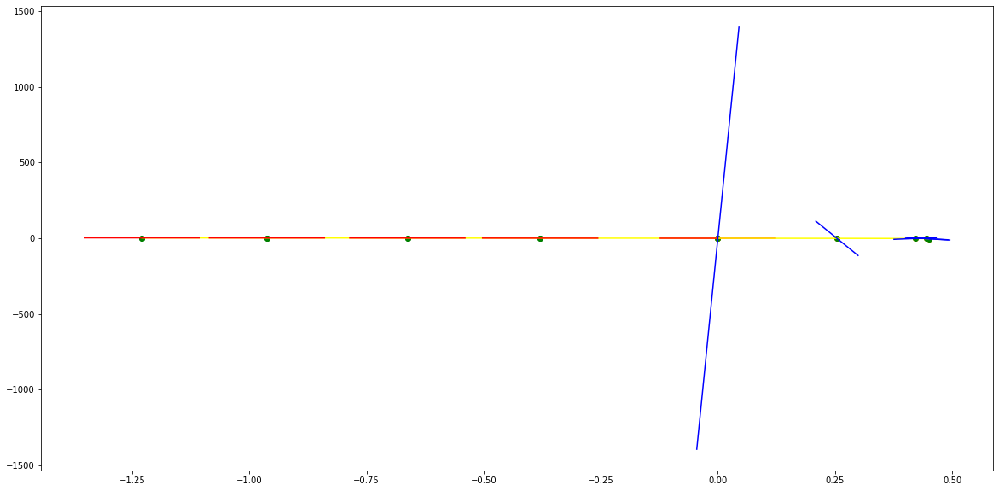

parameters (-0.2300915643192772, -1.2259997133868408, -2.308746247801115, -1.9825039624772656, -1.9702305380962786, -0.0004351279463934645)
tangent[0]:-1.1068516953944032
tangent[1]:-1.1924125014710834
tangent[2]:-1.1745073120614253
tangent[3]:-1.2987059329437853
tangent[4]:-1.9702305380962786
parameters (23720.290964581785, -57837.80764145442, 50649.70336411724, -18623.17892461062, 2371.3171562587827, 2.0856181740997245e-07)
tangent[0]:2371.3171562587827
tangent[1]:-481.5178399766669
tangent[2]:212.1395321243849
tangent[3]:-161.42794877389906
tangent[4]:-156.78753909488887


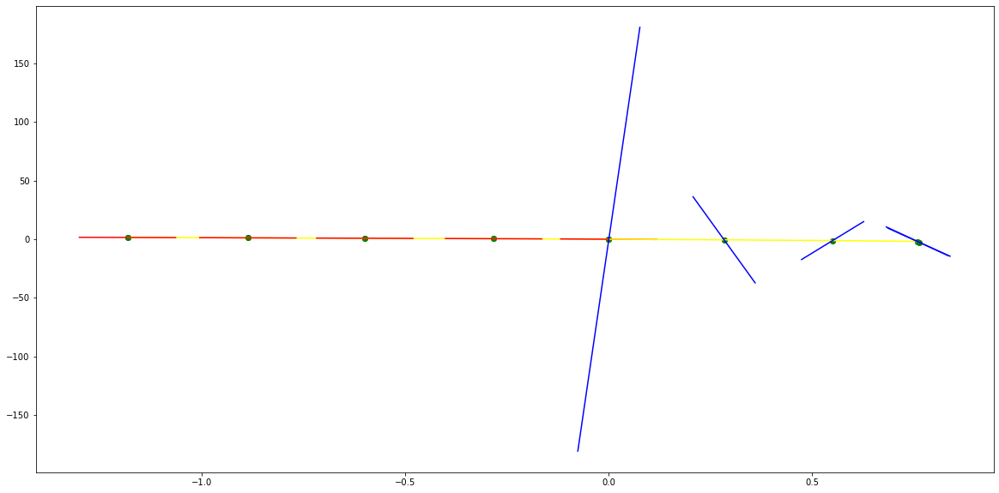

parameters (-0.026287888929084405, -0.3909889517316315, -1.4754348946968177, -2.0485775703774203, -5.093708676533323, 0.0016146209758809876)
tangent[0]:-4.300644662345746
tangent[1]:-4.098390280438675
tangent[2]:-3.8971971573875006
tangent[3]:-4.111790082846627
tangent[4]:-5.093708676533323
parameters (-9733.81465493446, 33135.7566809504, -40176.84213761629, 20159.27597041747, -3423.957202600633, -3.0207822447089974e-06)
tangent[0]:-3423.957202600633
tangent[1]:859.3194151334487
tangent[2]:-466.07392091240536
tangent[3]:104.89091563644843
tangent[4]:-252.2852733244922


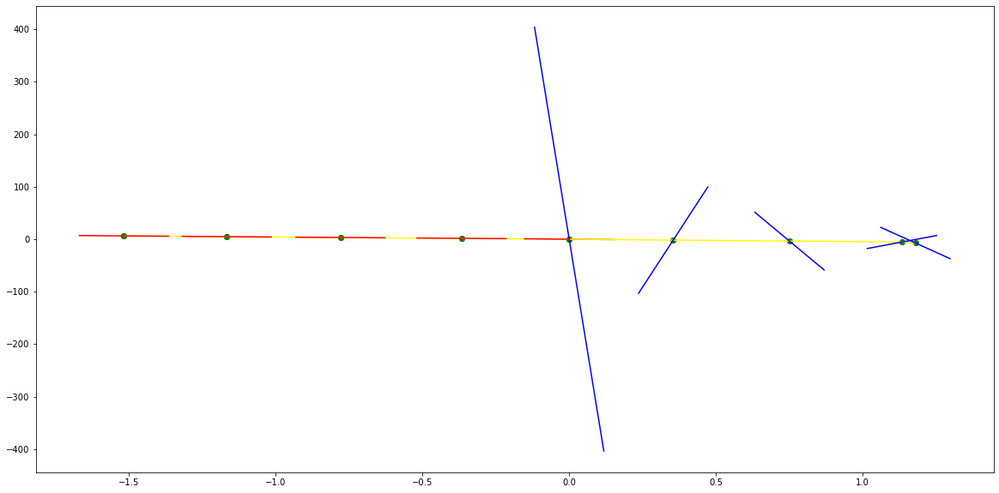

parameters (3794335768.047253, 396117197.635413, 14648908.185999852, 226186.8504575549, 736.8552629532352, 0.0033696129928443685)
tangent[0]:-452.29721642080756
tangent[1]:-466.95145335942095
tangent[2]:-682.6301398894146
tangent[3]:-806.5141186216987
tangent[4]:736.8552629532352
parameters (-11559705.588613302, 2993710.467304315, -297085.5340564406, 14458.729054690504, -547.9621220416951, -0.3115798444655614)
tangent[0]:-547.9621220416951
tangent[1]:-442.0897377541042
tangent[2]:-262.5937396741342
tangent[3]:-217.53169143423673
tangent[4]:-198.36224999689455


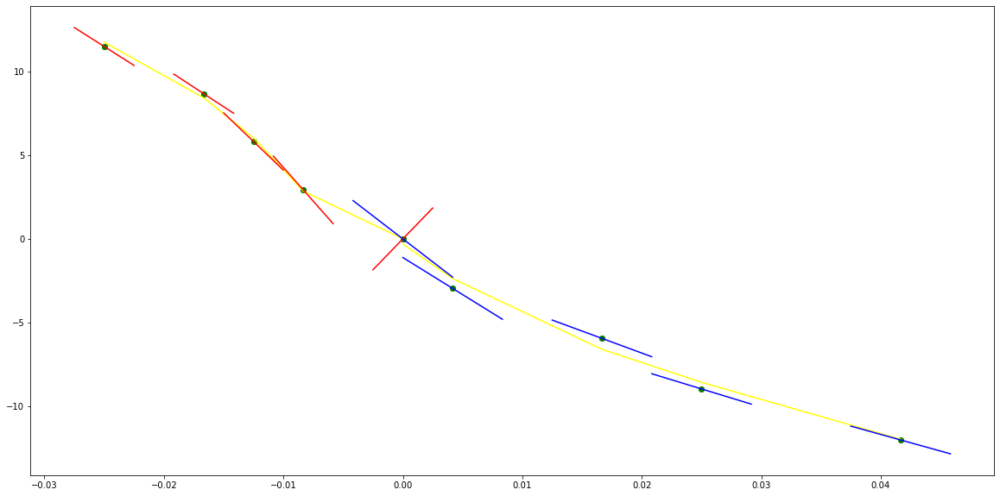

parameters (360.2663687370508, 572.5984515639892, 326.977142239141, 77.11011212125075, 14.445857053566801, -0.018039128933800164)
tangent[0]:8.282582120676647
tangent[1]:6.71572624251754
tangent[2]:6.811405788299492
tangent[3]:10.726783057922159
tangent[4]:14.445857053566801
parameters (2333786.4688514946, -956789.5020162618, 135287.51330591764, -7489.4227236786, 138.35148221770666, -0.02325480832512568)
tangent[0]:138.35148221770666
tangent[1]:82.70858830494697
tangent[2]:39.54816231897158
tangent[3]:56.5515345935182
tangent[4]:55.20209872494408


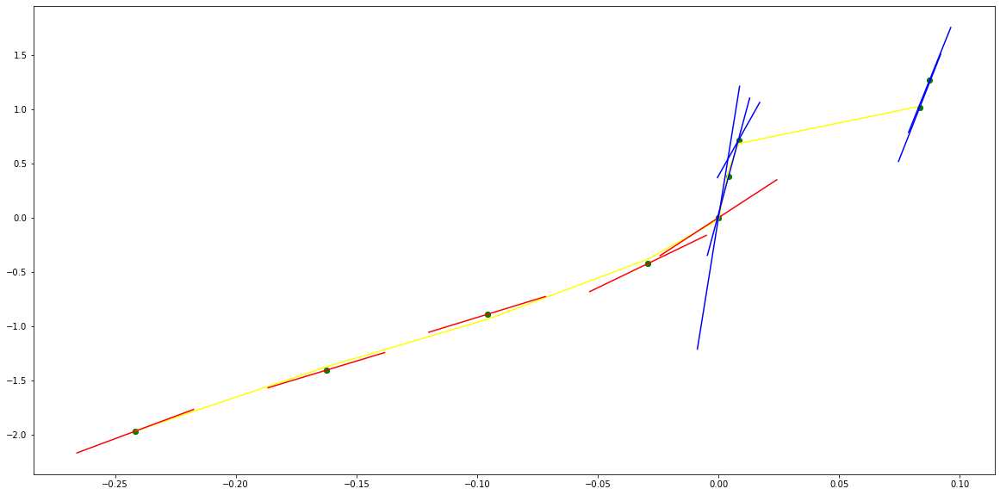

parameters (-13888.00840055879, -12824.937029850822, -3557.5896682312855, -297.5215469058907, -19.172642316699672, -0.010041420709837897)
tangent[0]:-25.388454841244062
tangent[1]:-14.089142620136663
tangent[2]:-13.109436853023695
tangent[3]:-12.20817126324679
tangent[4]:-19.172642316699672
parameters (-2476282.417428377, 1089370.8886808348, -162925.65275084556, 9076.871181275497, -131.99194352819805, -0.0007928020902134653)
tangent[0]:-131.99194352819805
tangent[1]:-64.52081386471
tangent[2]:-90.34876799584791
tangent[3]:-85.04494378931454
tangent[4]:-77.12374274611162


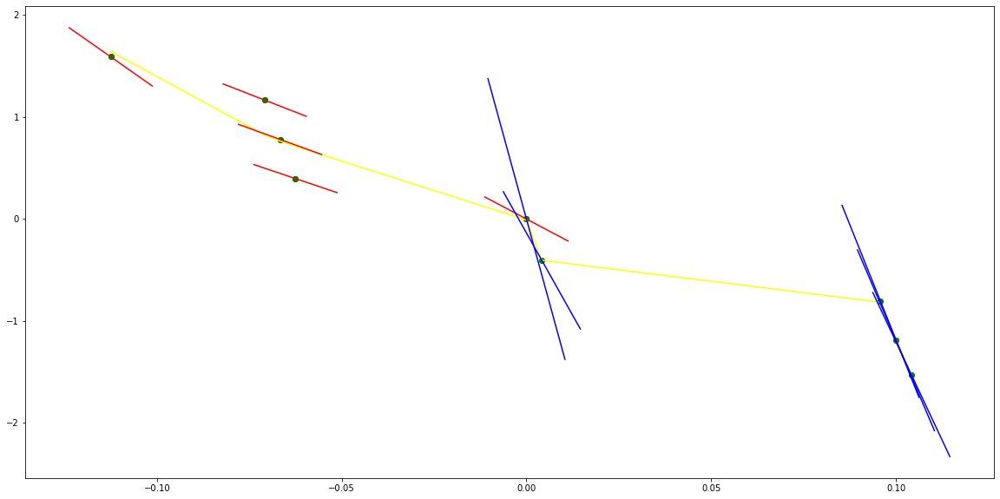

parameters (-2.3828579612829763, -11.148842359813779, -16.52476559048671, -9.211262801057547, -8.78683412717828, 0.002208762431963936)
tangent[0]:-7.821754355499596
tangent[1]:-7.380066440695517
tangent[2]:-6.800613544697756
tangent[3]:-6.814281115869079
tangent[4]:-8.78683412717828
parameters (-3180.8648090645115, 5979.494311799984, -3861.9729459325636, 999.0469538080469, -92.95978714006493, 0.0002704252425003434)
tangent[0]:-92.95978714006493
tangent[1]:16.684251392923088
tangent[2]:-26.258381752475557
tangent[3]:26.80374587424079
tangent[4]:-177.8794956354643


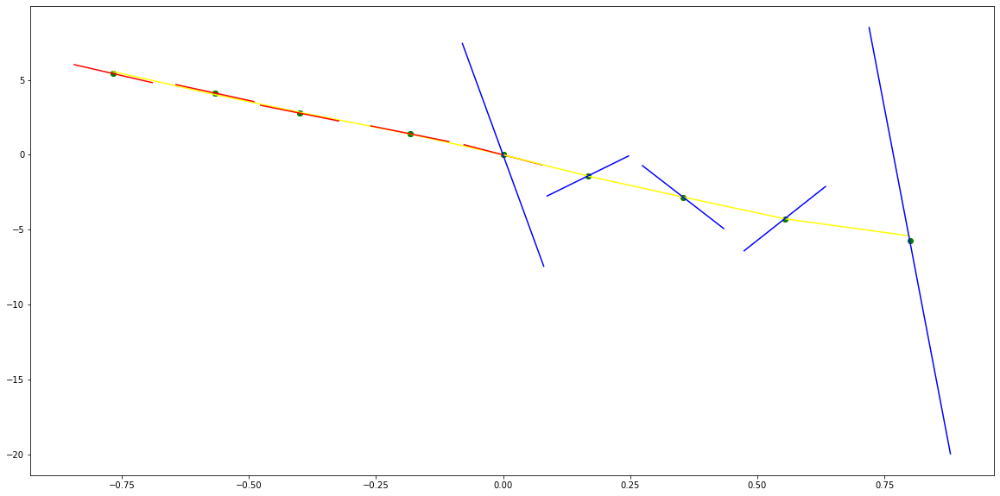

parameters (-473246144.4803124, -50880281.110864334, -1772157.8195891066, -24014.878327293398, -405.4745777179251, 0.08836214903026549)
tangent[0]:-317.8166469336854
tangent[1]:-322.12664967875077
tangent[2]:-296.0687060354882
tangent[3]:-283.6504712978628
tangent[4]:-405.4745777179251
parameters (-10089651.371299831, 2847682.706975759, -290598.9992240602, 12864.915564987095, -332.28004807593504, -0.20438400012834507)
tangent[0]:-332.28004807593504
tangent[1]:-239.39265840271415
tangent[2]:-81.13007043113544
tangent[3]:-92.45623624446841
tangent[4]:-120.45338597575744


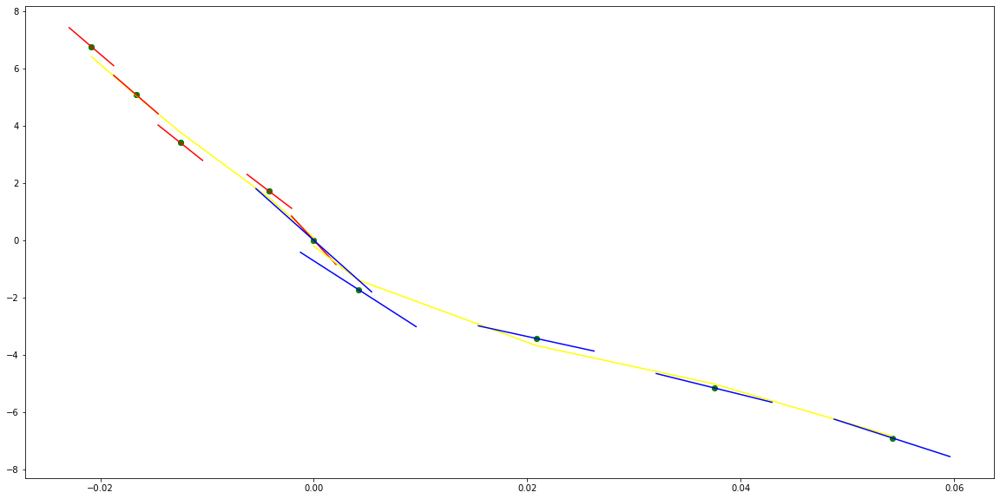

parameters (0.25409788251364596, 1.0431937856177178, 1.2313799187436942, -0.32792029290493613, -4.02910123606112, -0.0028206927536283547)
tangent[0]:-2.531607652318235
tangent[1]:-2.801643340154087
tangent[2]:-3.2198373086217575
tangent[3]:-3.701974309646728
tangent[4]:-4.02910123606112
parameters (-354882.5670861376, 508427.5589086093, -267072.0167999761, 60688.75911418286, -5013.734866213312, -1.3996913661817879e-05)
tangent[0]:-5013.734866213312
tangent[1]:399.23013549212556
tangent[2]:-170.83565287420424
tangent[3]:-162.29845887101328
tangent[4]:-152.04148222131698


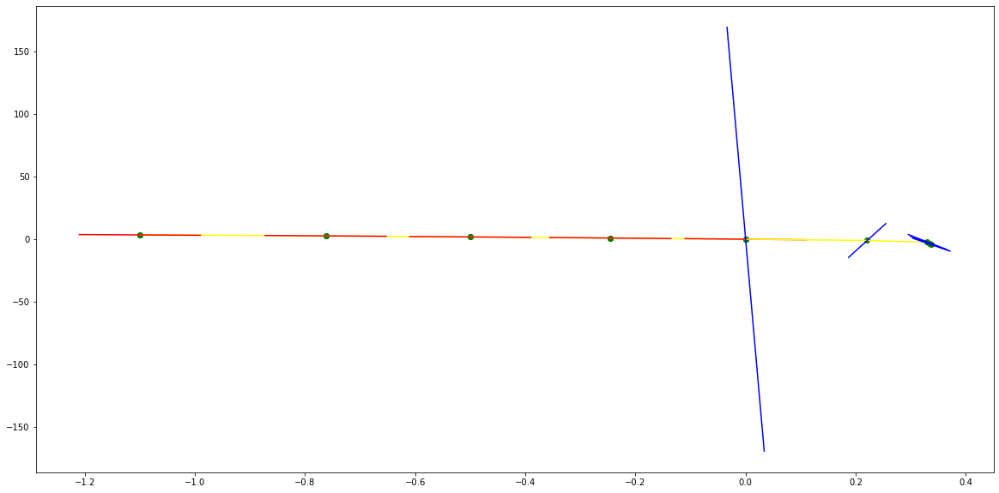

parameters (-18.742260151327166, -71.98308839546675, -100.2727571195993, -62.267362677483796, -20.36433550477774, 0.5188489115173609)
tangent[0]:-3.7494259396440377
tangent[1]:-2.7697831826968553
tangent[2]:-9.766454704486723
tangent[3]:-19.85060187411187
tangent[4]:-20.36433550477774
parameters (-3859.085568141217, 6172.749244843209, -3554.1862277178984, 894.9076038285122, -104.108887161808, -0.4045930627869153)
tangent[0]:-104.108887161808
tangent[1]:-96.83408996947004
tangent[2]:-71.22974880696503
tangent[3]:-34.68657806093769
tangent[4]:-2.3084280642010384


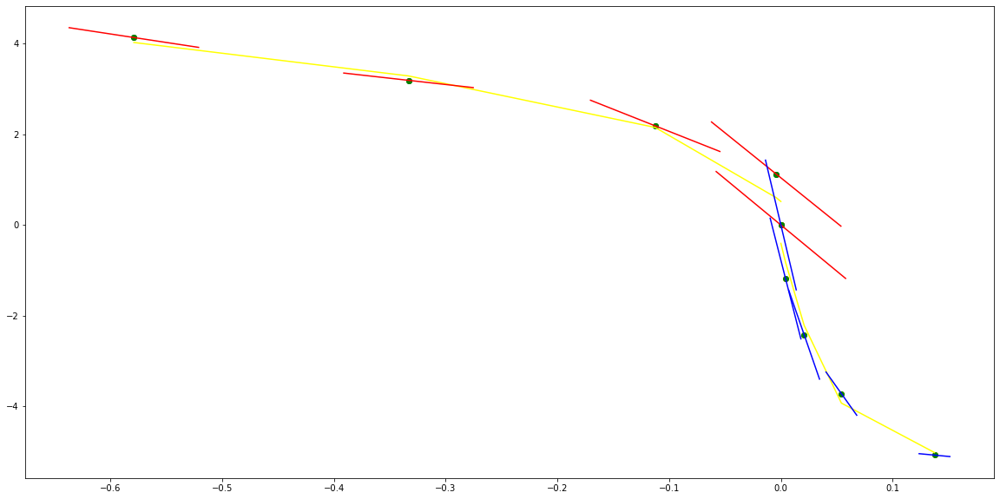

parameters (0.00018842993437661644, 0.00456684554406568, 0.04054073920957031, 0.12537704187059115, 0.19872503682404993, 0.00573558500969128)
tangent[0]:0.3101551292593553
tangent[1]:0.25779860896581297
tangent[2]:0.08583304821298207
tangent[3]:0.03967951954314772
tangent[4]:0.19872503682404993
parameters (-39.491222183593514, 525.0616462620701, -2532.531087164476, 5182.937024669653, -3706.9577230254467, -7.876809700949556e-09)
tangent[0]:-3706.9577230254467
tangent[1]:723.9338014931641
tangent[2]:-146.19609482588157
tangent[3]:7.832156872613723
tangent[4]:-24.363761442083614


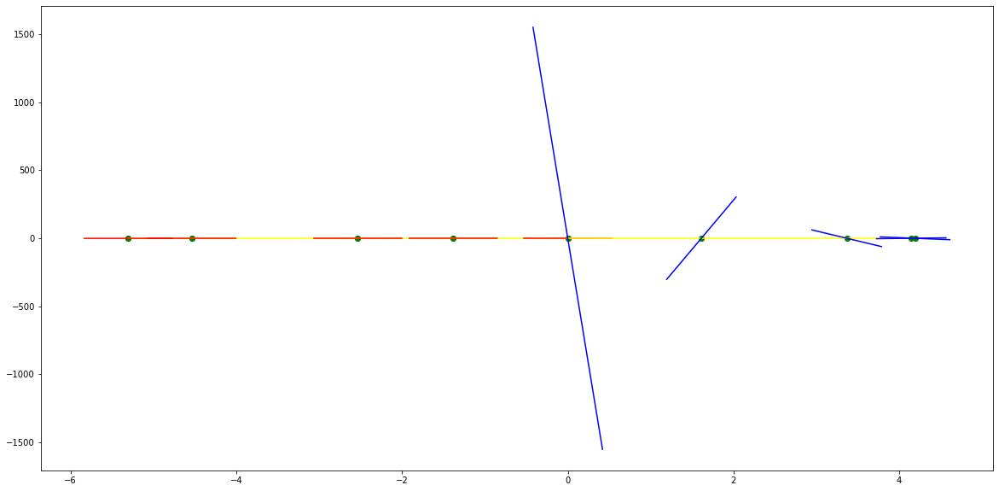

parameters (-0.0004945061069088533, -0.010914510904408904, -0.0817513146938322, -0.25812851402394904, -0.24460994000698874, -0.0020476472142453364)
tangent[0]:0.2724225089064505
tangent[1]:0.0608479408850742
tangent[2]:0.07554945384512493
tangent[3]:0.11648697442210812
tangent[4]:-0.24460994000698874
parameters (4506.7728577699545, -42880.644768657934, 151809.1628547252, -236646.02884323001, 136770.75830119706, 1.646361269956798e-09)
tangent[0]:136770.75830119706
tangent[1]:-4538.745876922301
tangent[2]:40.920180397777585
tangent[3]:-37.01985919222352
tangent[4]:-38.86376099291374


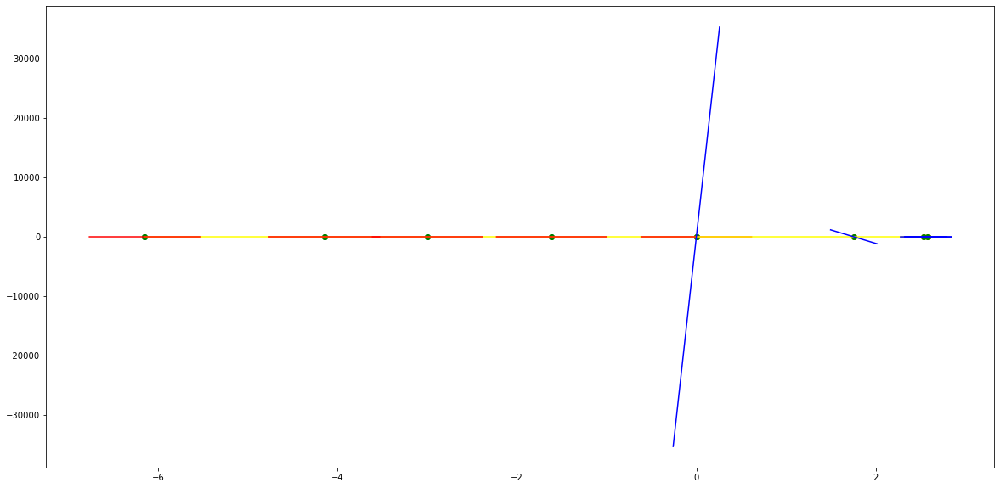

parameters (0.1734423632735108, 1.8437264371035331, 6.801411112537792, 9.777618446933461, 2.244699546869761, -0.006972910196397263)
tangent[0]:-0.24827727547958744
tangent[1]:-2.5280101687985024
tangent[2]:-3.7480709573854227
tangent[3]:-3.771620573216362
tangent[4]:2.244699546869761
parameters (485.19355922225594, -6788.789031249077, 34653.69700194275, -75767.21452858191, 58928.16544021414, -7.2439895878099115e-09)
tangent[0]:58928.16544021414
tangent[1]:-8926.068023478045
tangent[2]:1754.6550187530665
tangent[3]:-298.07459292603016
tangent[4]:-244.17430083391082


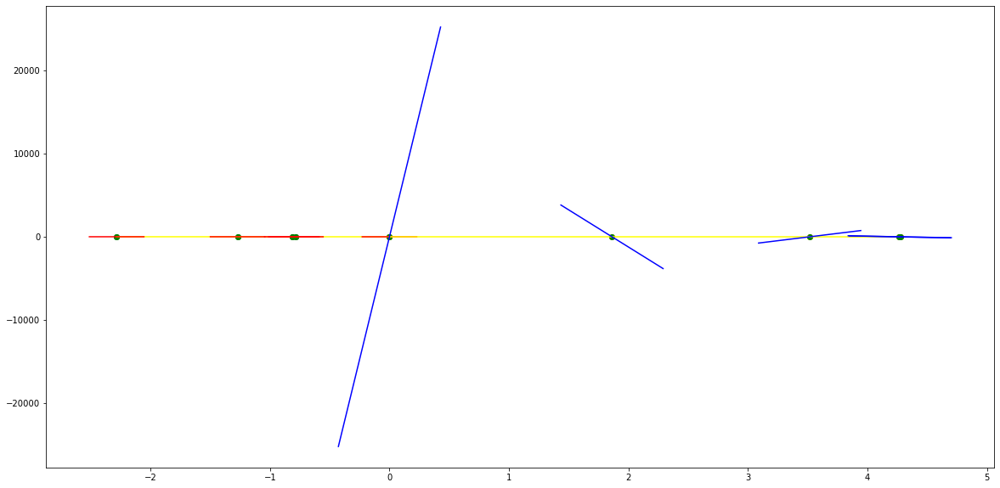

parameters (-0.027602874675699683, -0.34181921134556187, -1.3206862613821915, -1.33666691737506, -0.37590741131545713, 0.0016406444551315918)
tangent[0]:-2.14043098968314
tangent[1]:-2.4699361339503776
tangent[2]:-2.477708885181686
tangent[3]:-1.9678493918322877
tangent[4]:-0.37590741131545713
parameters (-15531.675186371229, 140736.1694250596, -474327.1066511281, 703539.9115251375, -386605.10222419706, 9.878167619740788e-10)
tangent[0]:-386605.10222419706
tangent[1]:13865.530480356596
tangent[2]:-315.45668811519863
tangent[3]:-237.78088165057125
tangent[4]:-202.06635216466384


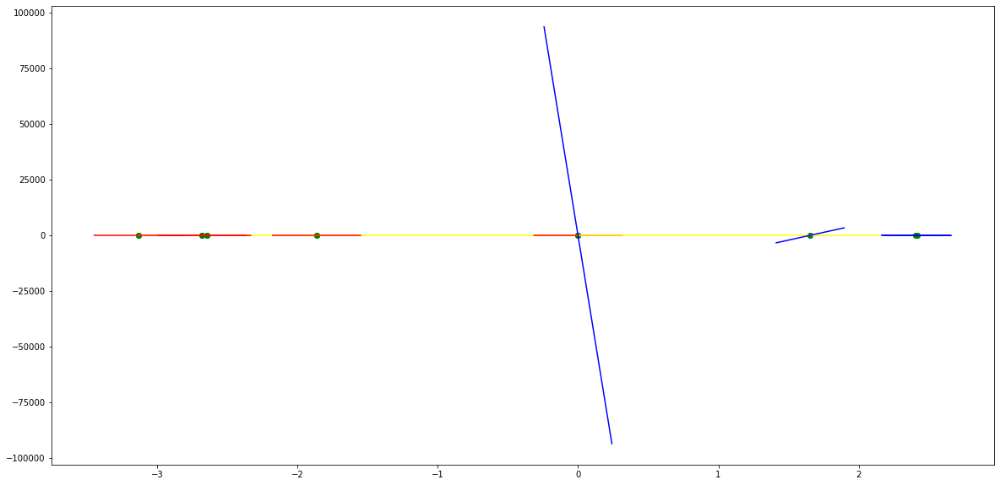

parameters (-0.020820352465455917, -0.3950741510990601, -2.640368656789937, -7.070254917776414, -6.853414403949564, -0.0012378093685538548)
tangent[0]:-2.4361151440367266
tangent[1]:-2.4561502921049154
tangent[2]:-2.2795269038721315
tangent[3]:1.23646135650956
tangent[4]:-6.853414403949564
parameters (17314.016021712825, -91962.1376809704, 155815.94247638484, -108176.1340784273, 26802.54931560245, -4.237733908868798e-07)
tangent[0]:26802.54931560245
tangent[1]:-317.04180042621374
tangent[2]:-237.13899614546608
tangent[3]:-200.85606413810092
tangent[4]:-167.06487073884273


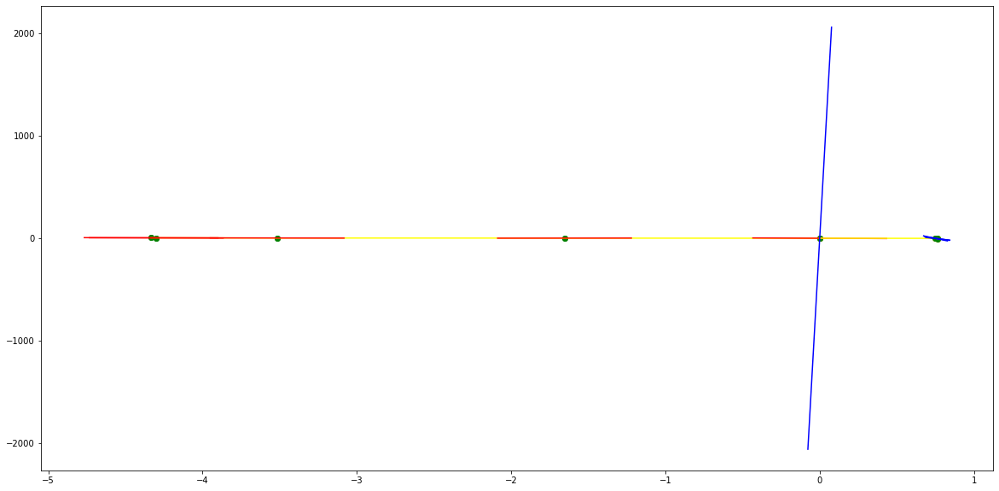

parameters (-1.086699166800512, -13.661746334461592, -58.53902739856147, -96.71892283691803, -49.330414641461836, 1.121399548589349)
tangent[0]:-21.55062091850872
tangent[1]:18.450596705465777
tangent[2]:-46.93977513989243
tangent[3]:-48.52759655897145
tangent[4]:-49.330414641461836
parameters (-15.450273781784327, 163.38760348024596, -563.5074913800314, 652.7516557238143, -100.60713590038421, -0.44202083900518957)
tangent[0]:-100.60713590038421
tangent[1]:-95.19641038161366
tangent[2]:-53.99374714534818
tangent[3]:13.683795780007813
tangent[4]:-264.1509421138532


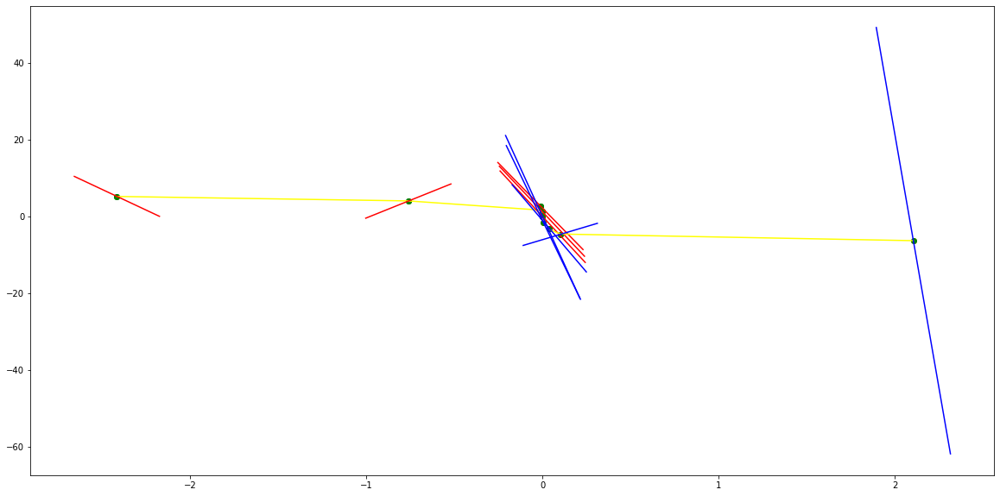

parameters (17314.007905351547, 156205.3807650456, 524144.0862467972, 776266.4287279355, 428575.01411592634, -1.8109973969524779e-09)
tangent[0]:-200.85601574601606
tangent[1]:-167.064836287871
tangent[2]:7.991155093535781
tangent[3]:-175.01240585604683
tangent[4]:428575.01411592634
parameters (-68.67120725001489, 669.9952027918098, -2411.940266769006, 3794.6156982804227, -2203.5001128306885, -1.3837293470261664e-06)
tangent[0]:-2203.5001128306885
tangent[1]:-22.91717778792372
tangent[2]:-35.6644556867177
tangent[3]:-35.80755146262163
tangent[4]:-35.93175449287628


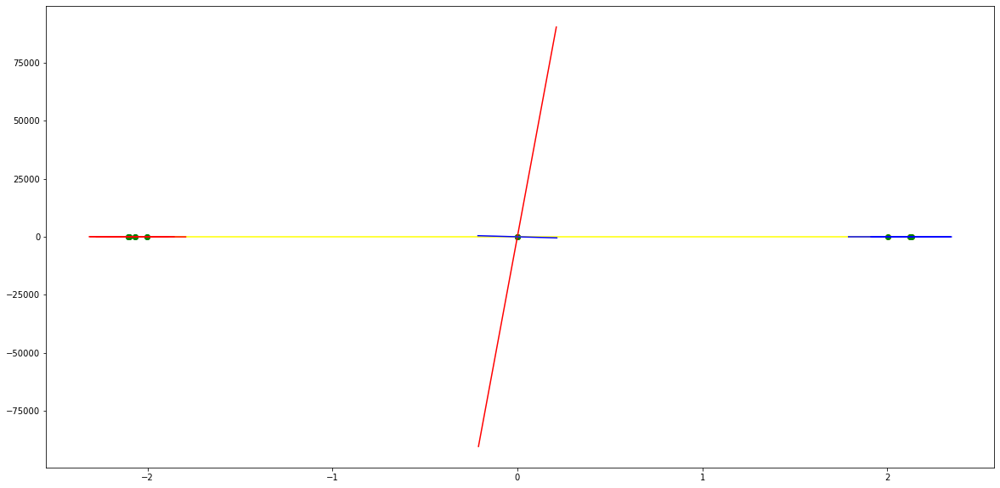

parameters (-15.450275752224778, -163.64326389793055, -565.6719780222106, -656.7807473713408, -98.26892766997993, 0.7611901473716457)
tangent[0]:13.683802365271148
tangent[1]:-264.15097841103864
tangent[2]:40.66998800237387
tangent[3]:-92.82473637914272
tangent[4]:-98.26892766997993
parameters (-1.1320352230534332, 9.515785410976338, -28.436325181342195, 36.91287316543702, -23.565756228216156, -1.1160343409070743)
tangent[0]:-23.565756228216156
tangent[1]:-23.25967600332032
tangent[2]:-16.05454515194476
tangent[3]:-4.023052175118046
tangent[4]:-2.9425425384210904


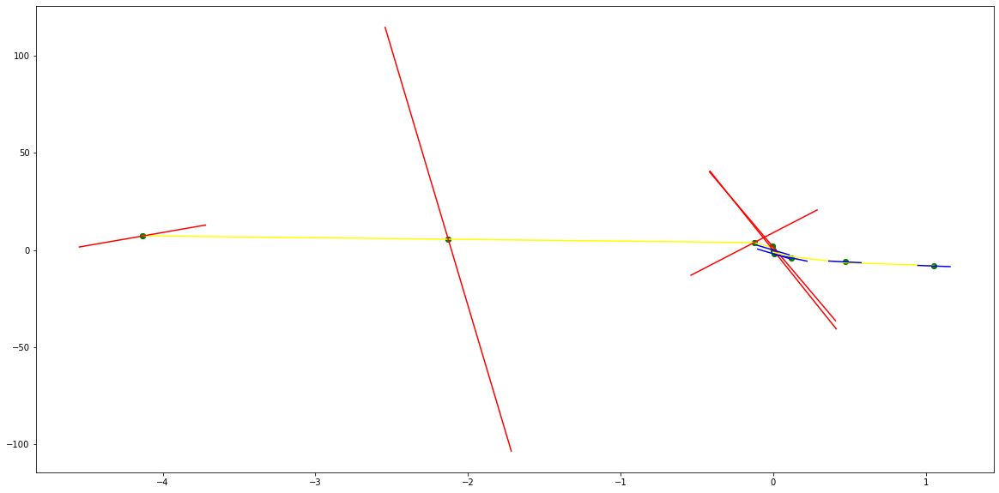

parameters (11.23846564275174, 97.40274293866975, 257.44243387351446, 228.26258772931826, 47.06176769246562, 0.0016410008794039512)
tangent[0]:-34.42611892751273
tangent[1]:-34.577506433573944
tangent[2]:-34.7185560441788
tangent[3]:-34.172302815924
tangent[4]:47.06176769246562
parameters (0.003965017239877447, -0.056103773026584085, 0.23179113271936636, -0.019466322027322736, -3.884794876356131, 0.023492803571408694)
tangent[0]:-3.884794876356131
tangent[1]:-3.7131354876573193
tangent[2]:-3.2934444192530368
tangent[3]:-2.741362189817073
tangent[4]:-2.2131293961187017


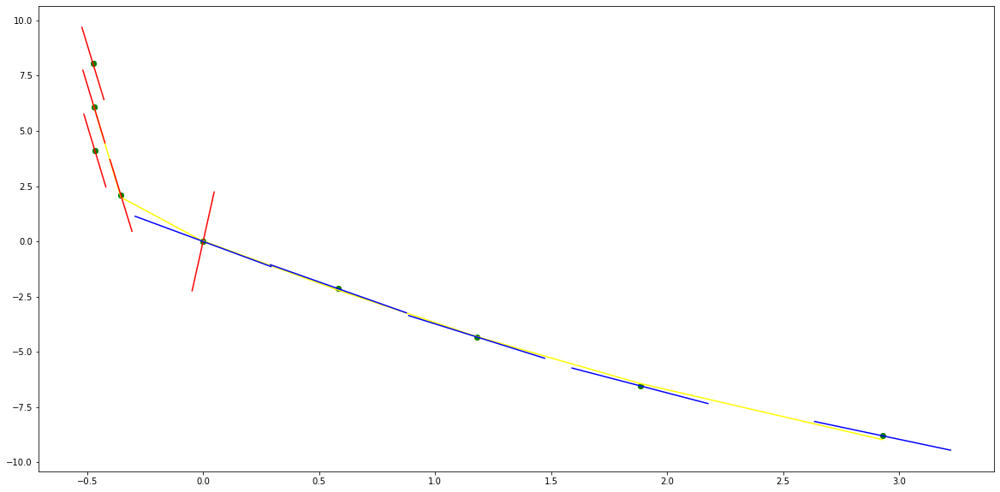

parameters (-0.002897616196396377, -0.06499486010968349, -0.521145327258026, -1.6692420889588726, -3.379976432054414, 0.0006294281602388394)
tangent[0]:-2.293898885980782
tangent[1]:-2.2781177794661676
tangent[2]:-1.8110476211818773
tangent[3]:-1.1198729003923868
tangent[4]:-3.379976432054414
parameters (-59.06023642265957, 1016.5788758871058, -6258.81610438114, 16082.824822923627, -14241.229329732689, -5.309515095610674e-09)
tangent[0]:-14241.229329732689
tangent[1]:2980.0837264354286
tangent[2]:-1643.904678351877
tangent[3]:525.0115129684509
tangent[4]:-672.8503800511589


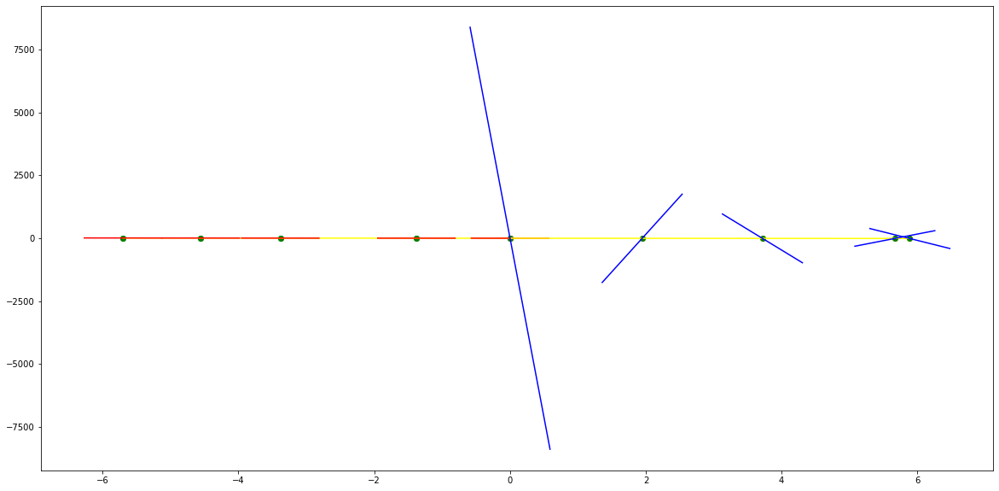

parameters (0.0015366533816281308, 0.03693502392677897, 0.30496681617408544, 1.0427205344106458, -0.2876032666819987, -0.007935027410841828)
tangent[0]:-2.0464384123089414
tangent[1]:-1.581285351028218
tangent[2]:-1.5987160753233869
tangent[3]:-1.8597874433851016
tangent[4]:-0.2876032666819987
parameters (8243.20035342915, -110698.56973816158, 543460.3222865788, -1144087.5319990555, 855433.1264681607, 1.71221572075507e-08)
tangent[0]:855433.1264681607
tangent[1]:-137479.48835930973
tangent[2]:3620.2392765819095
tangent[3]:-856.5148453214206
tangent[4]:-759.474191787187


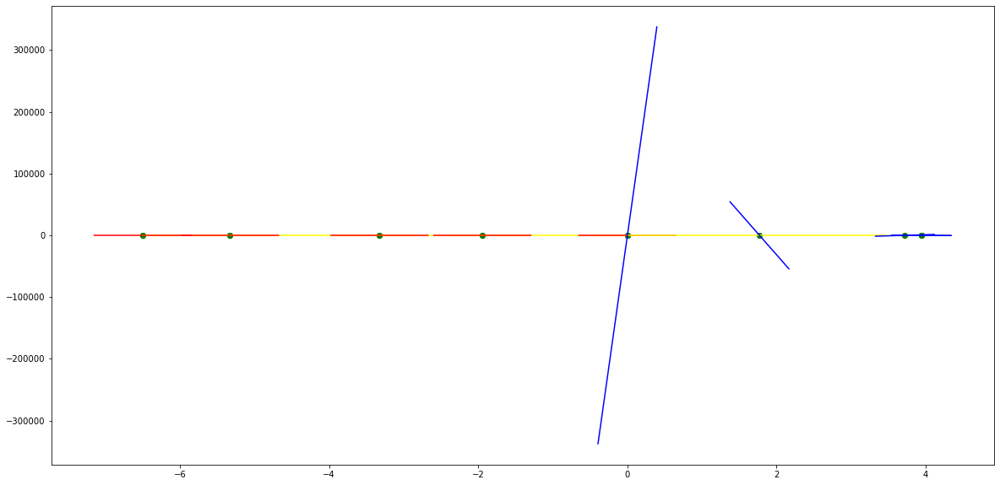

parameters (0.00015004749890503444, 0.004679466817553144, 0.043760117538019845, 0.1576603328592941, -1.3260941211010682, 0.013084946486313934)
tangent[0]:-1.739879276466064
tangent[1]:-1.4948598530947317
tangent[2]:-1.5024093214911585
tangent[3]:-1.5693629806932865
tangent[4]:-1.3260941211010682
parameters (-1350083.45352515, 11493576.969686737, -36665008.291973144, 51941662.12227431, -27570119.997766744, 1.475139697881291e-07)
tangent[0]:-27570119.997766744
tangent[1]:35700.85813455656
tangent[2]:-955.2842143587768
tangent[3]:-747.0810089223087
tangent[4]:-594.9047929160297


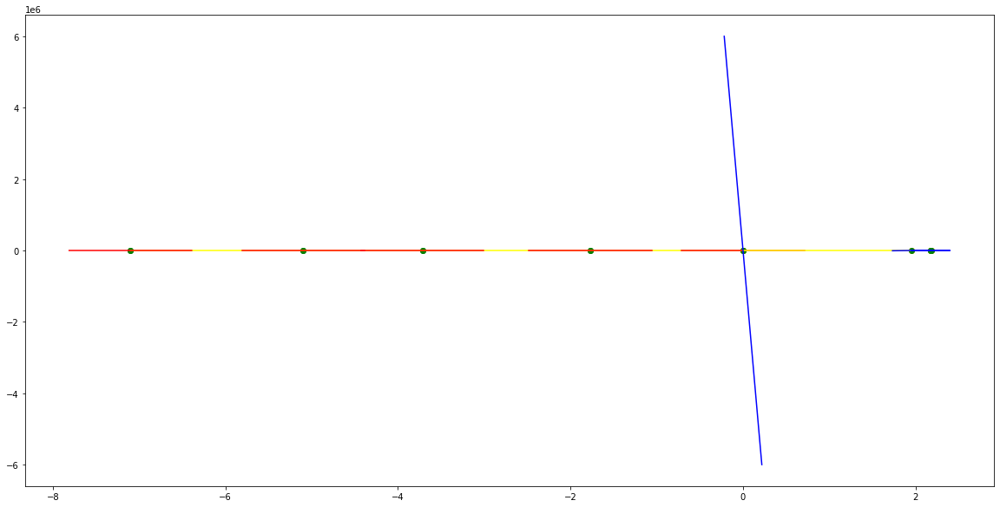

parameters (0.0990880114796826, 0.8976124864004595, 2.4891961713293815, 2.1676723810285354, 0.44835135279684263, 0.0005658680607495756)
tangent[0]:1.0215091233763212
tangent[1]:0.9844103480355666
tangent[2]:0.42493668408485835
tangent[3]:-0.3056476669984624
tangent[4]:0.44835135279684263
parameters (-35.09797985885627, 180.518107089041, -324.58962892357033, 236.65660598421792, -57.21020586081932, 5.708138629935552e-06)
tangent[0]:-57.21020586081932
tangent[1]:16.028085191043566
tangent[2]:-11.245939740793865
tangent[3]:14.246950665540218
tangent[4]:-48.527821887342505


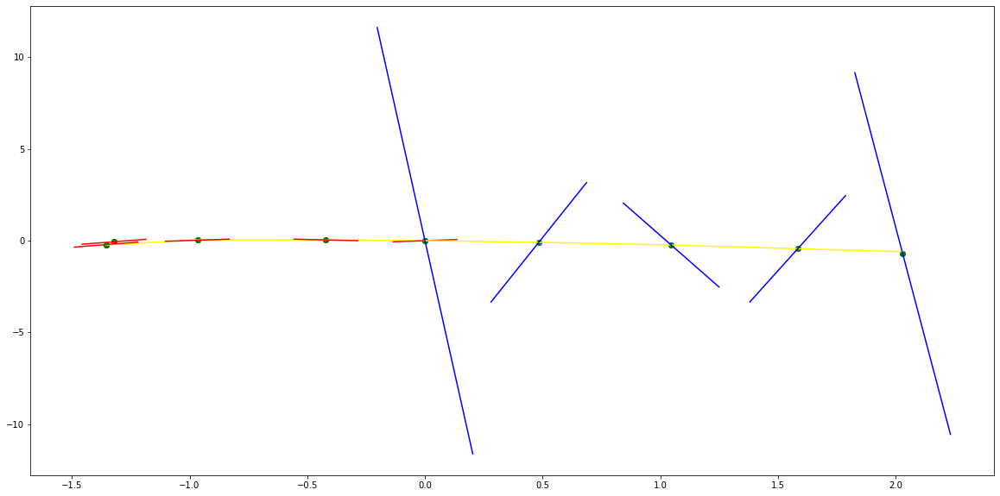

parameters (-0.44065899974327793, -2.4784168072554924, -4.667723725314314, -3.5864135441307194, -1.096146544366215, -0.0006055134915642175)
tangent[0]:1.1389888882795616
tangent[1]:0.34615977985039437
tangent[2]:-0.2031843482532627
tangent[3]:0.09855304794972786
tangent[4]:-1.096146544366215
parameters (251.8225208932597, -1267.9320274497304, 2278.855328560939, -1707.8302696111696, 439.8031417576514, -1.2070722103203175e-07)
tangent[0]:439.8031417576514
tangent[1]:-94.9789125875123
tangent[2]:47.81804134602925
tangent[3]:-48.382154869980525
tangent[4]:-48.57819661624927


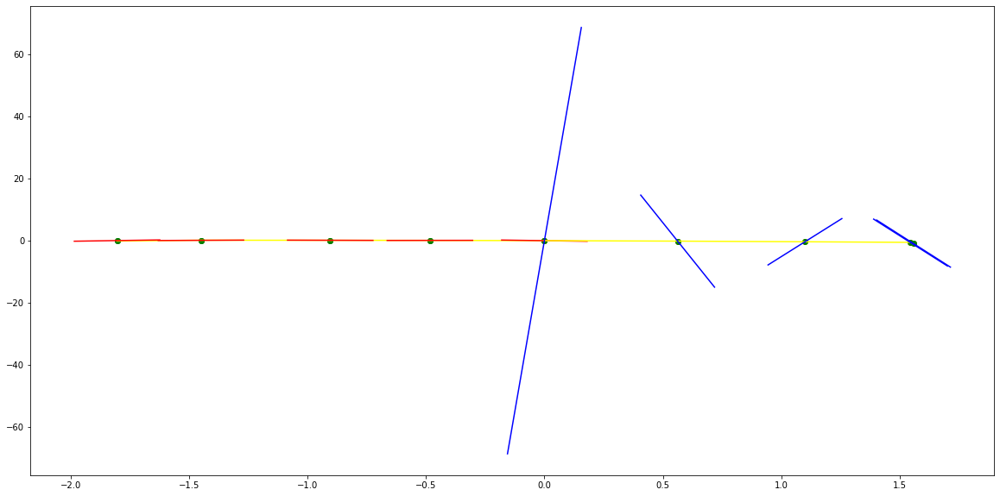

parameters (-0.0008590389183529766, -0.022968982376124325, -0.12461278420083982, -0.3489655537735023, -0.7179692738516826, 0.00012340824942943173)
tangent[0]:-0.1462218544595757
tangent[1]:-0.21755204403662642
tangent[2]:-0.3098087844505576
tangent[3]:-0.4731428227105886
tangent[4]:-0.7179692738516826
parameters (17198946.295328267, -4737864.0337106185, 429549.73511109053, -13976.133675761654, 89.9301509983236, 0.003090279512550831)
tangent[0]:89.9301509983236
tangent[1]:-93.03683457681683
tangent[2]:-99.08622049913379
tangent[3]:-88.26461236162044
tangent[4]:24.547816369535553


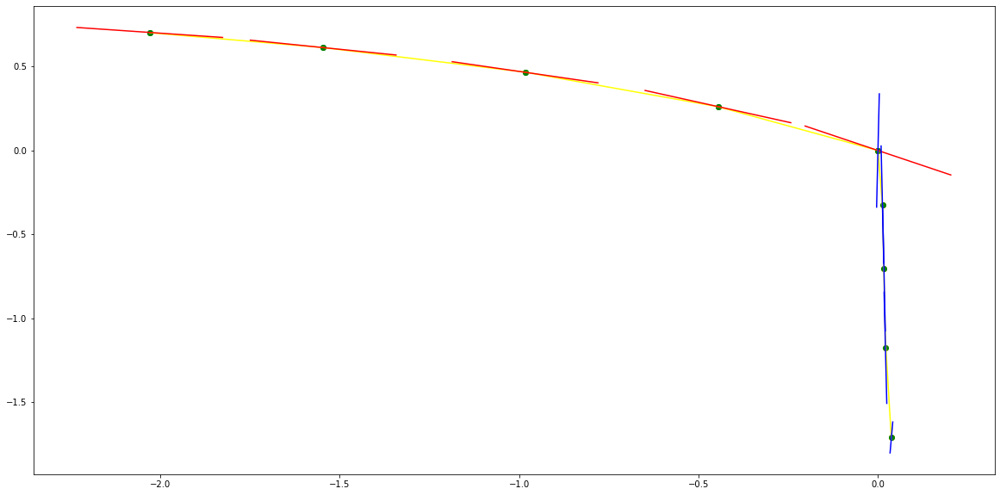

parameters (-7.348235274120226e-06, -0.0002090076567842561, -0.001133027906092954, -0.0046197378837260885, -0.02836211063231901, -2.1987558728890704e-05)
tangent[0]:0.04274778248081694
tangent[1]:0.010100928575228086
tangent[2]:-0.00949247333465927
tangent[3]:-0.018537230188778616
tangent[4]:-0.02836211063231901
parameters (3.7768626074612075, -57.113373288892866, 310.04698770021184, -703.1402733478135, 542.9188504601665, 1.3874709602560916e-07)
tangent[0]:542.9188504601665
tangent[1]:-134.20463383113258
tangent[2]:45.731950750551164
tangent[3]:-16.21298550166796
tangent[4]:-14.599198255482065


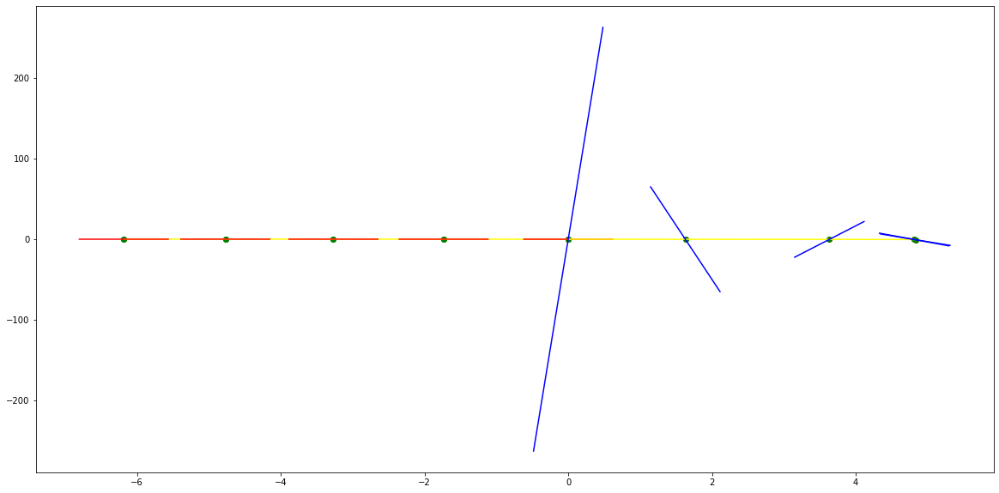

parameters (-6.811713728689919e-06, -0.00028167808906243765, -0.0031954768637903457, -0.01843181896931266, -0.07180739370990732, 0.00016633669685551025)
tangent[0]:0.009679779713273579
tangent[1]:-0.008456754626333288
tangent[2]:-0.017760246070111396
tangent[3]:-0.03256243593525739
tangent[4]:-0.07180739370990732
parameters (-663.5773499156505, 7823.831990810488, -34193.830274325665, 65465.104914714786, -46133.90114347669, 6.997035397316392e-10)
tangent[0]:-46133.90114347669
tangent[1]:2635.3270046451653
tangent[2]:-28.96365623854217
tangent[3]:-12.030649650696432
tangent[4]:-8.306609682069393


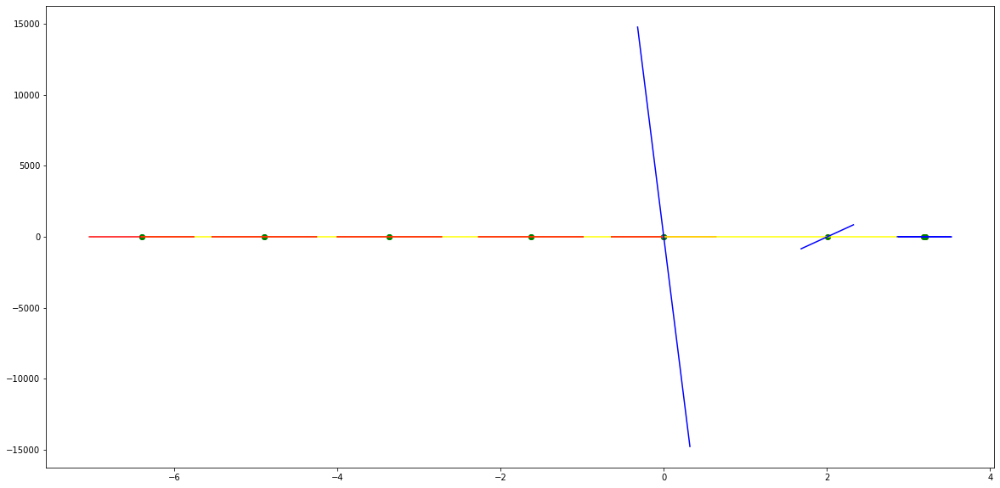

parameters (7.85520921849118e-06, 0.00017699170875449665, 0.0013950100146786616, -0.00042534885279961693, -0.06765618383500355, -0.0003235234028242863)
tangent[0]:-0.006083077356811829
tangent[1]:-0.019405201648890147
tangent[2]:-0.036430609555282004
tangent[3]:-0.05420684431089032
tangent[4]:-0.06765618383500355
parameters (12536.776893570639, -65737.07306025995, 128893.18940364405, -112014.10901048157, 36407.713779730315, -1.1843511385751716e-08)
tangent[0]:36407.713779730315
tangent[1]:-37.06566506566014
tangent[2]:-6.807396892807446
tangent[3]:-0.9157816594233736
tangent[4]:-59.146275229461025


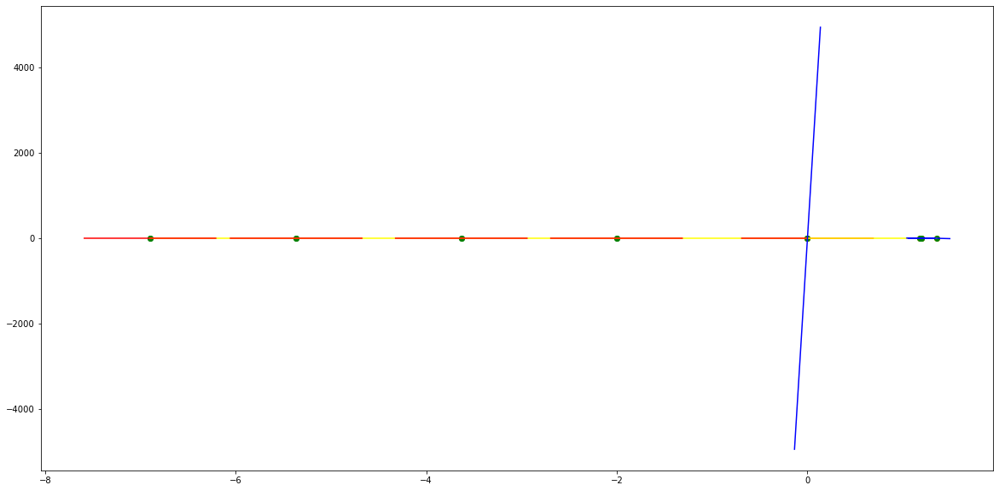

parameters (-208397623.01248434, -30638768.317741174, -1579979.9173325005, -32249.7600244268, -243.85008372124597, 0.0014647663442272454)
tangent[0]:-88.36536630887807
tangent[1]:-107.79498292765814
tangent[2]:-108.09294331536583
tangent[3]:-48.86210614036045
tangent[4]:-243.85008372124597
parameters (3358920.1362531297, -1055057.0430838754, 105792.30801947316, -3813.036392041707, 7.8002327006882295, -0.24515436416408218)
tangent[0]:7.8002327006882295
tangent[1]:-18.767007242960414
tangent[2]:-29.330536875278522
tangent[3]:-8.73384904887406
tangent[4]:-106.04706966268209


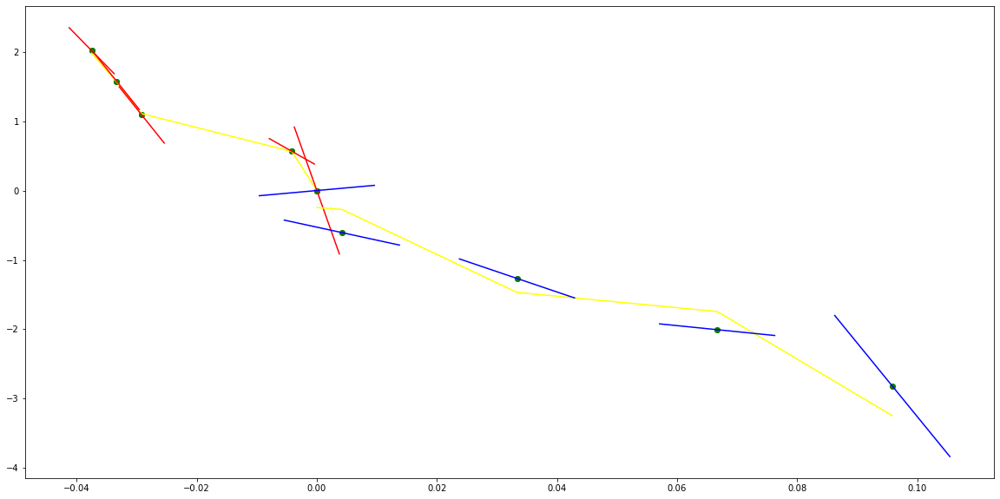

parameters (-41563862.24677571, -10766404.989523813, -991197.350989447, -38334.00936698219, -650.7839214717145, 0.00993029028044898)
tangent[0]:-131.63036815646353
tangent[1]:-167.03131764418265
tangent[2]:-60.71562066163062
tangent[3]:-379.8880412848444
tangent[4]:-650.7839214717145
parameters (-56722912.281319045, 15328431.000660071, -1456193.0471659498, 55186.92215205997, -760.0269220166188, 0.06367199319203812)
tangent[0]:-760.0269220166188
tangent[1]:-371.60377275305257
tangent[2]:-271.15806901643145
tangent[3]:-284.86779295968654
tangent[4]:-252.90844544403672


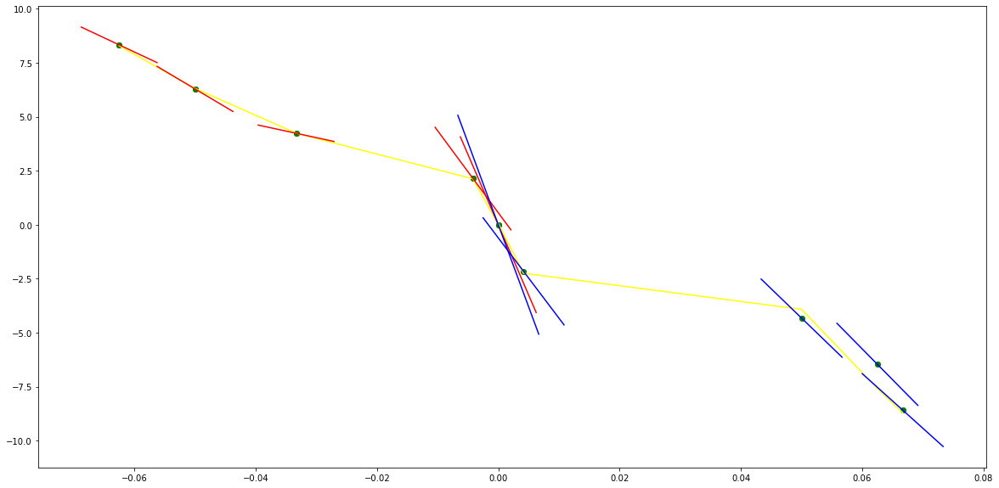

parameters (216.80167040945636, 450.25252050681826, 324.36580208770533, 96.9656193848795, 8.33557775373378, 0.0002877850492390683)
tangent[0]:-7.686201184542718
tangent[1]:-3.9634587538735744
tangent[2]:-1.10744459422083
tangent[3]:-3.8533731293049875
tangent[4]:8.33557775373378
parameters (948.5641617641513, -2202.0445585873576, 1785.5211666774135, -585.0789379752324, 60.97184174156013, -4.261056368732135e-05)
tangent[0]:60.97184174156013
tangent[1]:-20.654025911476907
tangent[2]:11.117360054088806
tangent[3]:-17.49625315828024
tangent[4]:-18.724549671915895


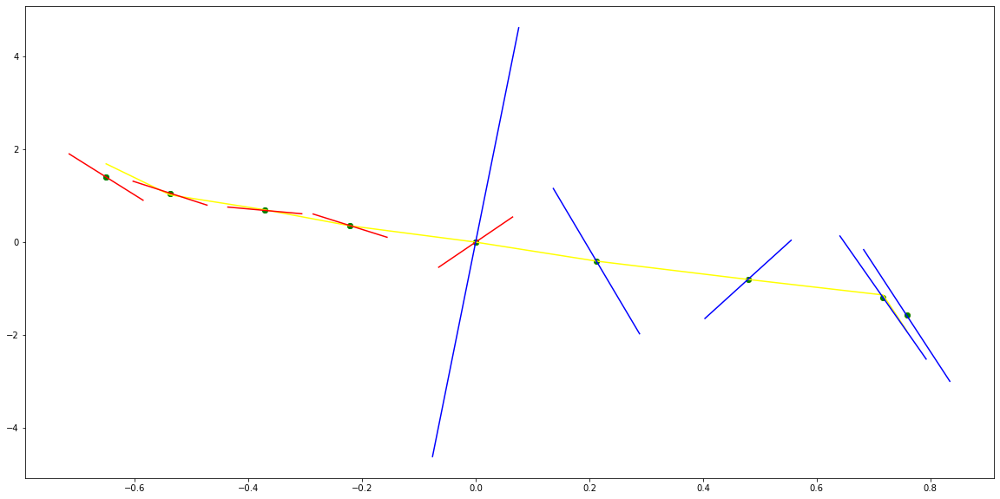

parameters (-9.961074561551891, -34.81184495005591, -44.06184391085503, -23.94224206497326, -6.6946500703985325, 0.06017196409007297)
tangent[0]:-2.1439966731549323
tangent[1]:-1.7164946939723134
tangent[2]:-0.9016070705492378
tangent[3]:-4.91905430097469
tangent[4]:-6.6946500703985325
parameters (-3385935.7150756437, 1492697.7638878482, -227085.40010175665, 13051.982786386108, -185.38401833971878, 0.052480586473464416)
tangent[0]:-185.38401833971878
tangent[1]:-88.01113668720801
tangent[2]:-11.776119212750274
tangent[3]:-67.61097543637337
tangent[4]:-53.06812690878772


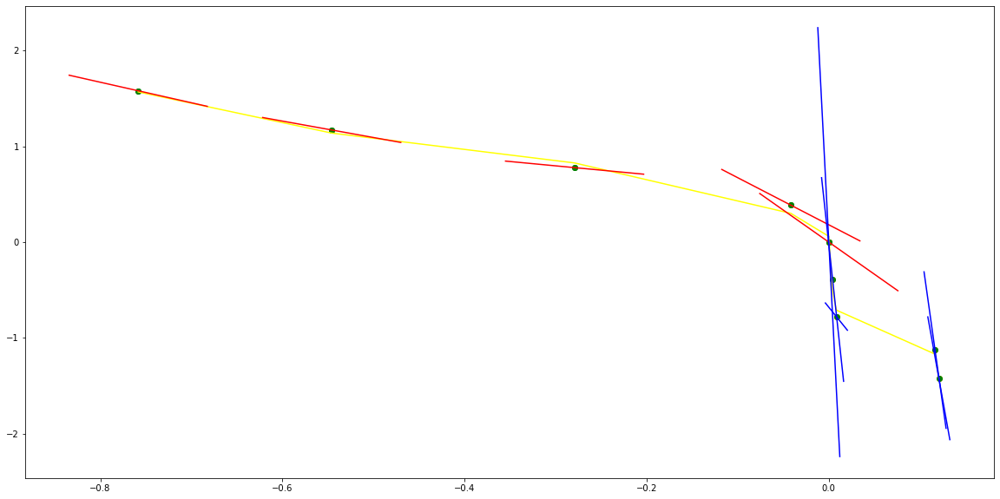

parameters (0.0012870540767405548, 0.02018733390400085, 0.11289797160766112, 0.2949432369535359, -1.305856686787591, 0.005797585348937924)
tangent[0]:-1.7819748952438694
tangent[1]:-1.6929245190134712
tangent[2]:-1.6733197689308683
tangent[3]:-1.6466888451981379
tangent[4]:-1.305856686787591
parameters (-6.074042475667284, 86.51213162638103, -445.1485560612367, 974.8676105153573, -758.5942109032919, -9.083283819089772e-09)
tangent[0]:-758.5942109032919
tangent[1]:109.6919035824942
tangent[2]:31.059027748049857
tangent[3]:-244.3909349985886
tangent[4]:-255.58399406543026


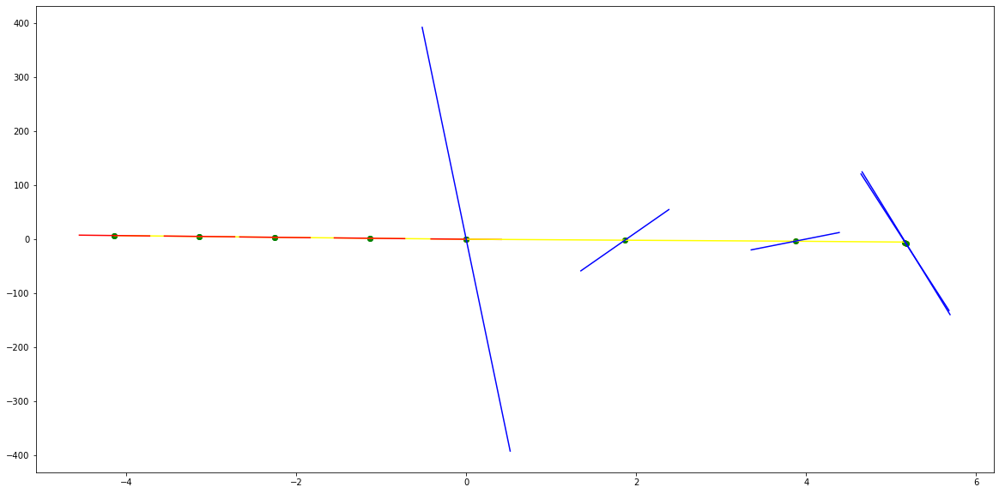

parameters (-0.0004445391912097286, -0.006021070226885014, -0.008684855932888693, 0.20742583926340125, -0.6091637601452677, -0.0011650662134030556)
tangent[0]:-1.7133546048805366
tangent[1]:-1.7166330875606024
tangent[2]:-1.6186421648716096
tangent[3]:-1.3446745974438072
tangent[4]:-0.6091637601452677
parameters (29626.35110219402, -354005.1968412383, 1567096.8076790392, -3036280.0319397715, 2162472.1200555675, -9.21962311175807e-09)
tangent[0]:2162472.1200555675
tangent[1]:-133546.65482582897
tangent[2]:-151.05101948976517
tangent[3]:-279.35328271239996
tangent[4]:-296.3826354518533


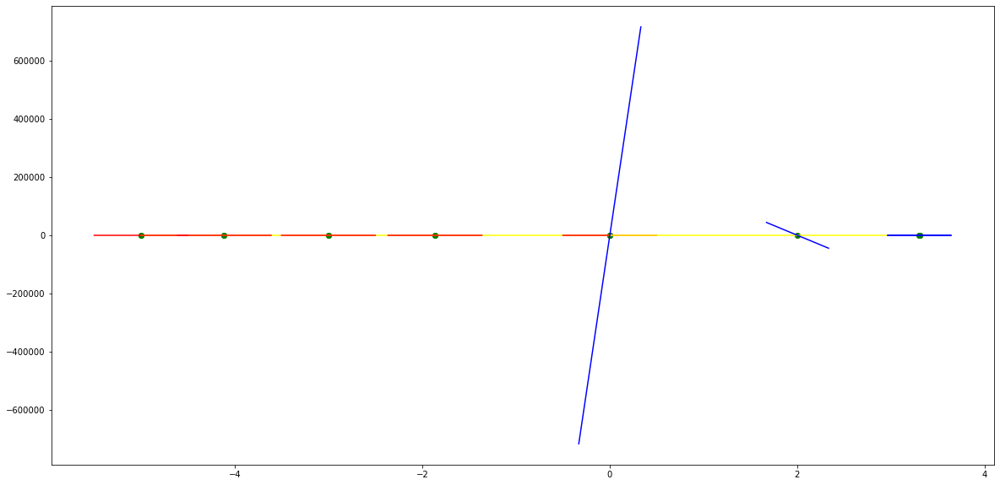

parameters (-0.0007439011373175901, -0.01957024213115334, -0.1798878350984985, -0.595898467862195, -1.5400422356563659, 0.0004481303378875123)
tangent[0]:-1.7332468248211848
tangent[1]:-1.6138224431328927
tangent[2]:-1.3076505860747607
tangent[3]:-0.7489798476522347
tangent[4]:-1.5400422356563659
parameters (-3291595.5172593854, 17445170.23565705, -34666308.045228675, 30611726.64517364, -10135099.485779928, 2.3707602287377892e-08)
tangent[0]:-10135099.485779928
tangent[1]:-15.705228926613927
tangent[2]:-321.6786449868232
tangent[3]:-340.71462878771126
tangent[4]:-329.9027360249311


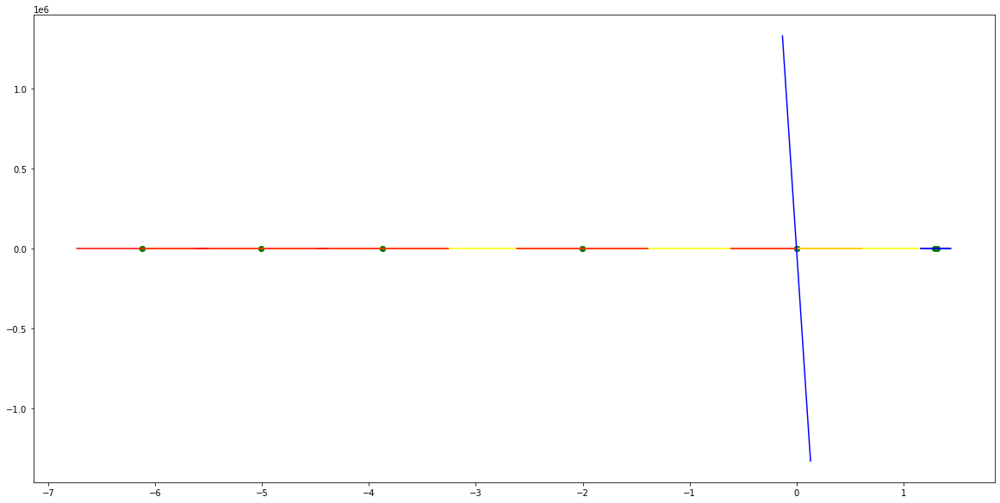

parameters (28.53600027173378, 89.22251961074704, 99.13449966531276, 45.397749079013174, 19.46369565483611, -0.04931067926230161)
tangent[0]:13.537576057256153
tangent[1]:12.258797038572915
tangent[2]:10.708865610406004
tangent[3]:12.683787803852173
tangent[4]:19.46369565483611
parameters (148663476.92494008, -29132615.968577012, 1822539.8222931519, -41883.24614799664, 642.07339961539, -0.05397342497579257)
tangent[0]:642.07339961539
tangent[1]:379.75007773649236
tangent[2]:259.8530240309141
tangent[3]:282.61527615413627
tangent[4]:356.3788374807833


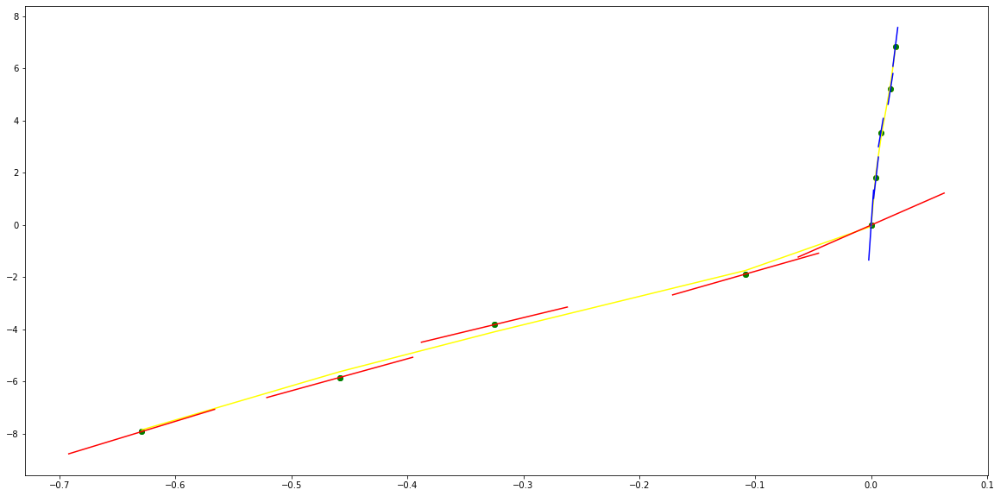

parameters (-394164944.87528986, -68371858.61369134, -4045994.006150444, -92234.05567622172, -811.7822449265005, 0.044834320457457784)
tangent[0]:-438.4592341267672
tangent[1]:-453.4428980783633
tangent[2]:-397.66183695918073
tangent[3]:-234.76913295623876
tangent[4]:-811.7822449265005
parameters (-996.2367420087064, 1832.1501033588047, -1219.4269158312259, 362.7401670187293, -68.64862945651078, -0.9513615779926754)
tangent[0]:-68.64862945651078
tangent[1]:-65.68854612398891
tangent[2]:-29.595622010021017
tangent[3]:-19.080407402718237
tangent[4]:-22.84051141751354


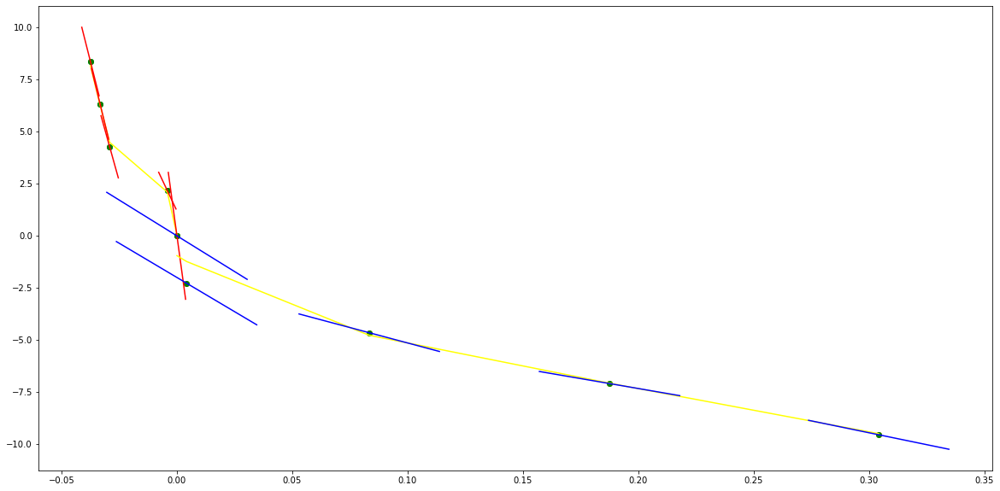

parameters (0.7675513797279125, 0.18377881099706223, -7.420795656816945, -12.769175602348023, -22.500587158392847, -0.01650677026269998)
tangent[0]:-14.924688610297375
tangent[1]:-15.076503574438851
tangent[2]:-16.582208129657992
tangent[3]:-19.09306230599508
tangent[4]:-22.500587158392847
parameters (81784607.61841875, -20505849.460494436, 2042779.5846400438, -101872.35184712033, 1783.2705493831468, 2.8672292923568056e-07)
tangent[0]:1783.2705493831468
tangent[1]:-755.9708056404465
tangent[2]:-767.4937778311009
tangent[3]:-774.079978842618
tangent[4]:-780.2734927001898


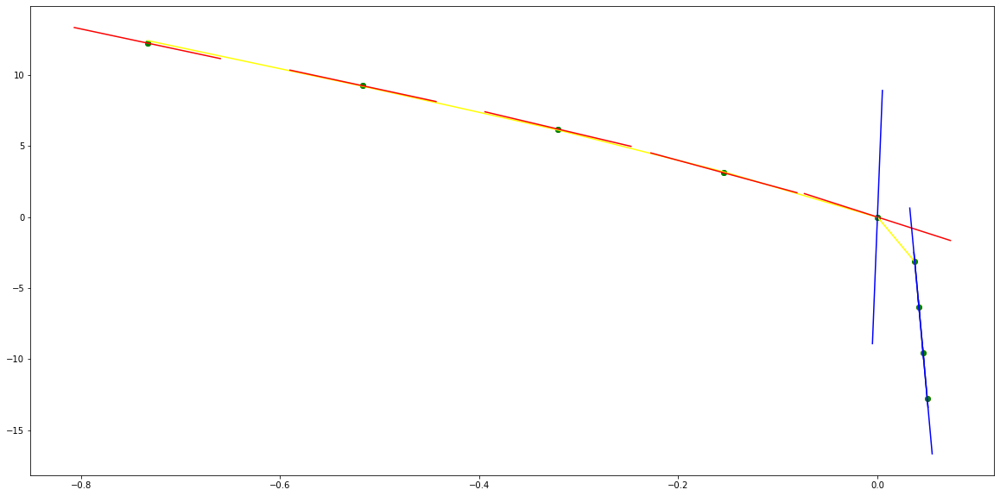

parameters (-3965923821.246875, -358903003.490798, -11288331.567278853, -142757.99357220173, -1261.6513972230168, 0.08208839752357157)
tangent[0]:-766.108686354416
tangent[1]:-793.6964088690465
tangent[2]:-664.2988255188766
tangent[3]:-562.1111828810344
tangent[4]:-1261.6513972230168
parameters (186463742.8949685, -33542151.178451333, 2030593.6029695217, -41281.27864963724, -407.98826369199224, -0.45317448562422985)
tangent[0]:-407.98826369199224
tangent[1]:-655.6761488213386
tangent[2]:-727.4658472575024
tangent[3]:-641.073673172489
tangent[4]:-521.5744052751513


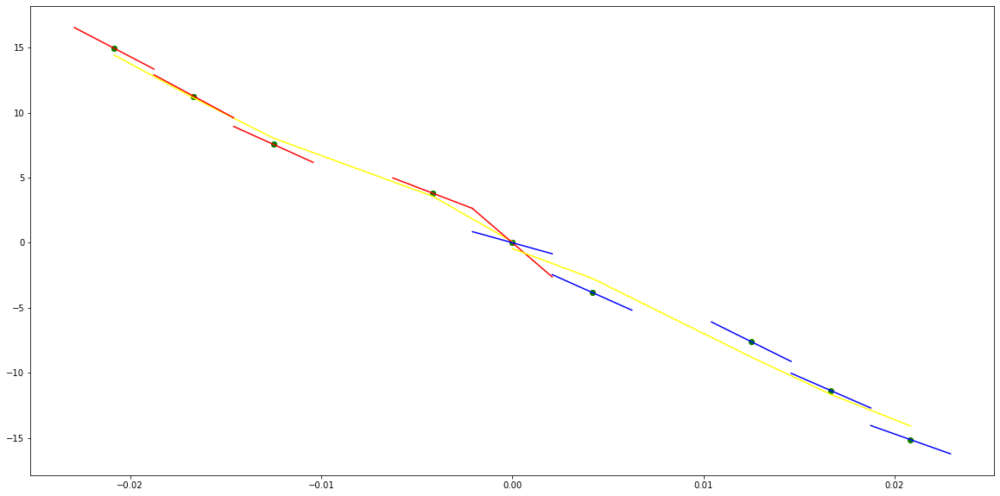

parameters (-1004557.2957484399, -2456775.84139101, -2251321.9765028628, -916108.7098653114, -139665.0668379804, -9.569474881623889e-09)
tangent[0]:-30.700213881675154
tangent[1]:-39.218205629847944
tangent[2]:-63.84804097563028
tangent[3]:75.52461547276471
tangent[4]:-139665.0668379804
parameters (-679.5227882062438, 5022.791153126047, -13207.015139617744, 14332.485918557062, -5225.580730972613, -1.5453158470131996e-07)
tangent[0]:-5225.580730972613
tangent[1]:1387.243883628833
tangent[2]:-739.1062520409596
tangent[3]:71.46255605499937
tangent[4]:-152.00739137133314


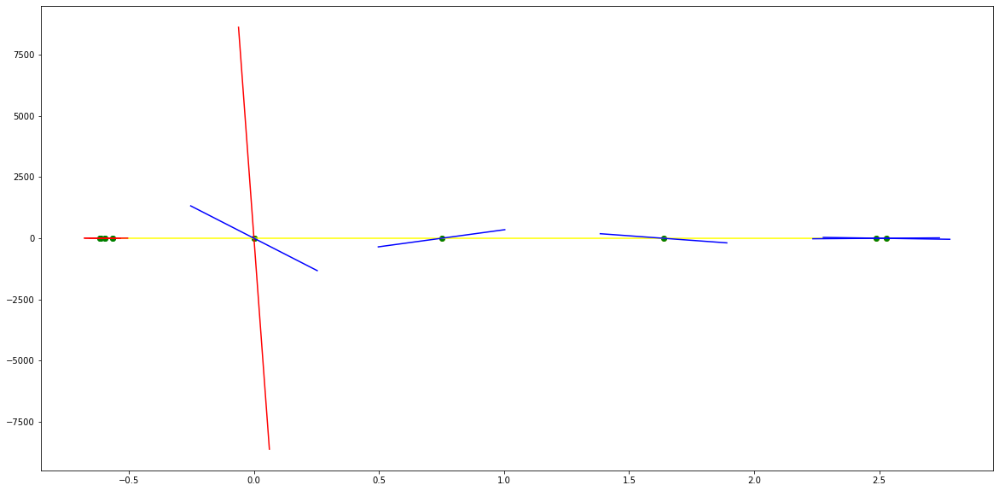

parameters (51.0132125728945, 373.01465170710577, 981.1857693218594, 1088.262463921333, 420.97335911712236, 3.5581050437628235e-07)
tangent[0]:-33.20109091484409
tangent[1]:-33.02725009572276
tangent[2]:32.36129664657011
tangent[3]:-76.95360629487521
tangent[4]:420.97335911712236
parameters (-10599364.341831412, 37820951.13941279, -50596967.7279263, 30077156.74867285, -6703132.468290653, -3.0293047367205085e-08)
tangent[0]:-6703132.468290653
tangent[1]:1600.7658248059452
tangent[2]:-338.9100479669869
tangent[3]:-264.02099496498704
tangent[4]:-203.100390676409


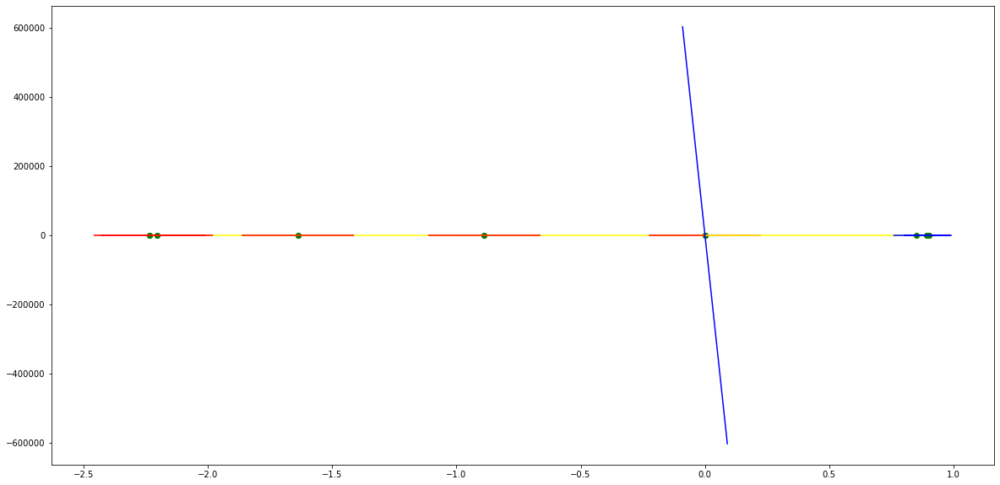

parameters (-241.3118580852446, -2414.1228949493043, -8650.699800186081, -12890.833999603361, -6474.641596920466, -1.2218058574666886e-07)
tangent[0]:-152.79533211346825
tangent[1]:-91.15731324076296
tangent[2]:-598.9906737835026
tangent[3]:1734.3699179649211
tangent[4]:-6474.641596920466
parameters (939.4759780616914, -9769.173057400774, 36358.017124031976, -56297.28901934986, 29530.220289245273, 9.713531492745108e-09)
tangent[0]:29530.220289245273
tangent[1]:-7521.471606907875
tangent[2]:3080.7045748030905
tangent[3]:-638.9313567622194
tangent[4]:-589.0030651697052


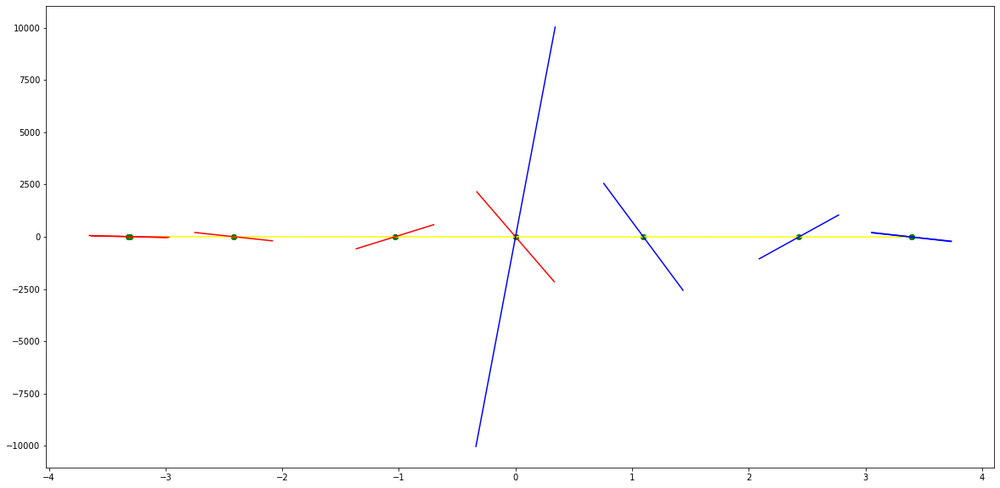

parameters (-4.997743248870314, -55.591305304527246, -215.85844691229633, -340.03466497791567, -181.8404895902432, -2.9587652305114413e-06)
tangent[0]:-150.64577026627202
tangent[1]:50.03776181264075
tangent[2]:-36.768736029271025
tangent[3]:42.34357804399738
tangent[4]:-181.8404895902432
parameters (-478142.6697725659, 3948840.4189563403, -12059296.480822897, 16074647.135978952, -7843162.821334486, -8.429369702178806e-08)
tangent[0]:-7843162.821334486
tangent[1]:591338.4178407295
tangent[2]:-887.2730932580307
tangent[3]:-617.0626357840374
tangent[4]:-453.5335744069889


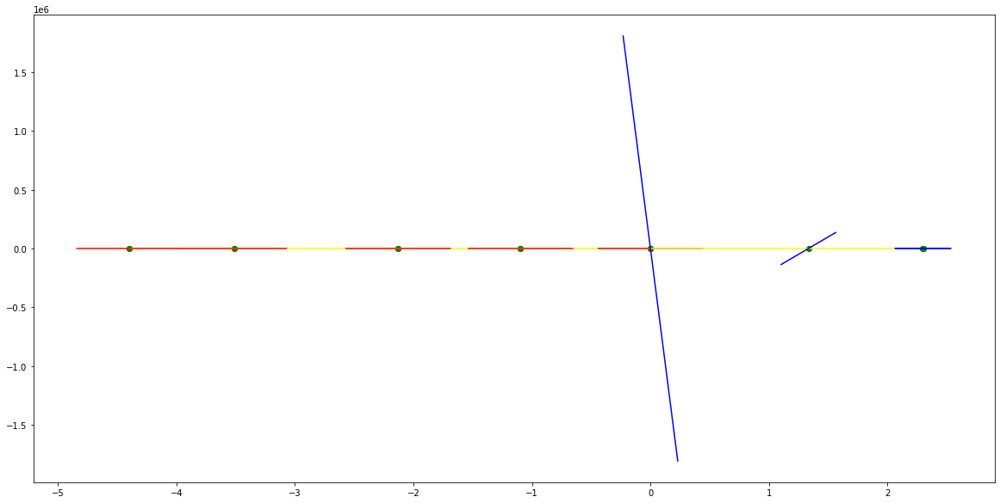

parameters (-0.05521687427448299, -0.7414922262881497, -3.458516954779971, -6.450004358193761, -6.138847432976025, -0.007618304314593493)
tangent[0]:-2.0040768870639916
tangent[1]:-2.4246709618683546
tangent[2]:-3.1257789918831236
tangent[3]:-1.2263771867987892
tangent[4]:-6.138847432976025
parameters (67344049.16092277, -263661226.23545152, 387083836.1888419, -252558883.18615413, 61792207.29817701, 5.2683560638617535e-08)
tangent[0]:61792207.29817701
tangent[1]:-1082.8073906823993
tangent[2]:-570.0348948761821
tangent[3]:-381.4418906494975
tangent[4]:-539.8459430262446


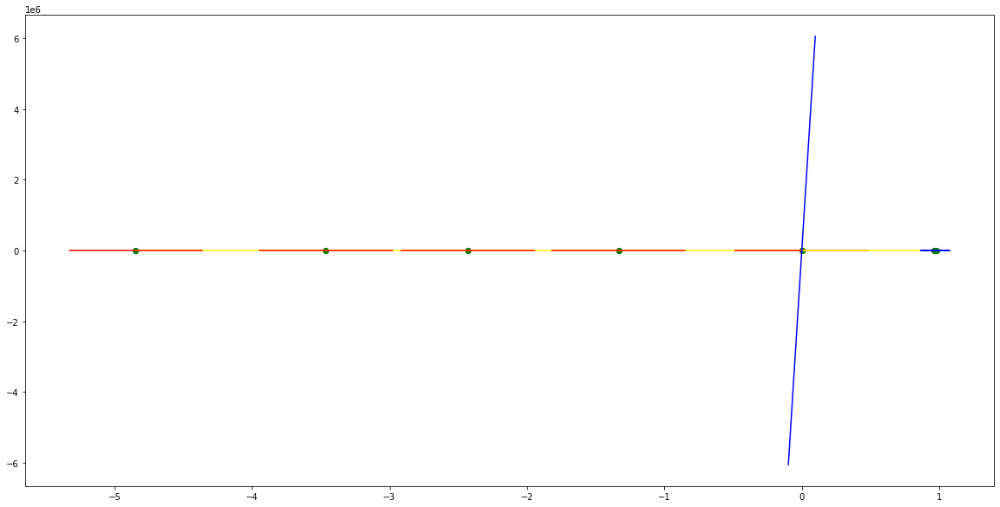

parameters (-0.009638012762174863, -0.10608183298184175, -0.43763666071707513, -0.9907751902959732, -1.8380152402018919, 0.009768471132906834)
tangent[0]:-0.5224239757231632
tangent[1]:-0.6825308174766875
tangent[2]:-0.8857036610807464
tangent[3]:-1.3345047454703223
tangent[4]:-1.8380152402018919
parameters (-3.134351112723364, 45.14872132106626, -237.07531250054723, 533.985117302825, -431.11334528038736, -1.546719434306825e-06)
tangent[0]:-431.11334528038736
tangent[1]:53.470555668639975
tangent[2]:-17.5661687759752
tangent[3]:-17.432526426105085
tangent[4]:-17.29745131983367


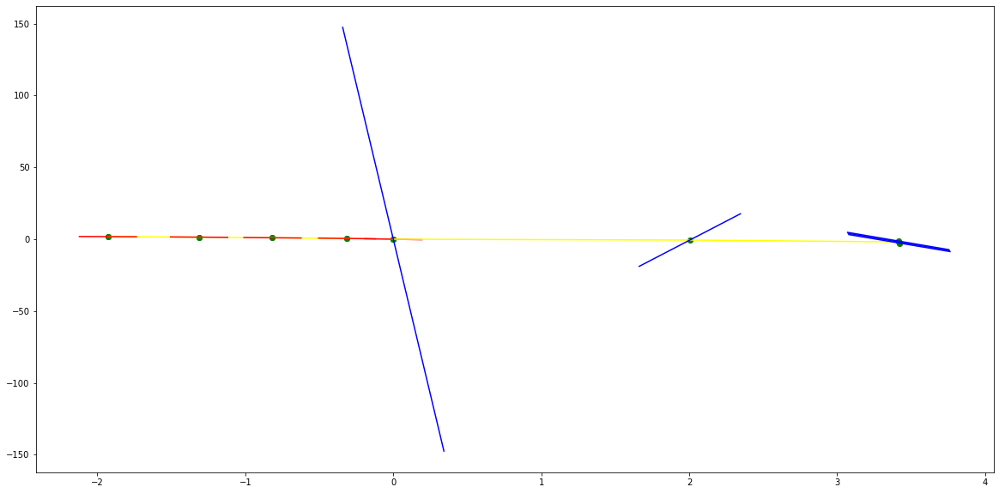

parameters (0.01395107054826062, 0.23688229406091169, 1.511059806233261, 4.25707189449296, 3.8394306063179324, -0.00017718959832028797)
tangent[0]:-0.6619850813737469
tangent[1]:-0.9579056519641225
tangent[2]:-1.3274699679137894
tangent[3]:-1.5182762186377965
tangent[4]:3.8394306063179324
parameters (4.343354628035136, -44.72519599550859, 165.76610226673458, -261.96872644837896, 147.09602781020624, 2.6315511933903497e-05)
tangent[0]:147.09602781020624
tangent[1]:-18.73057710041894
tangent[2]:-18.501671805907222
tangent[3]:-18.272850021824524
tangent[4]:-12.849691273593407


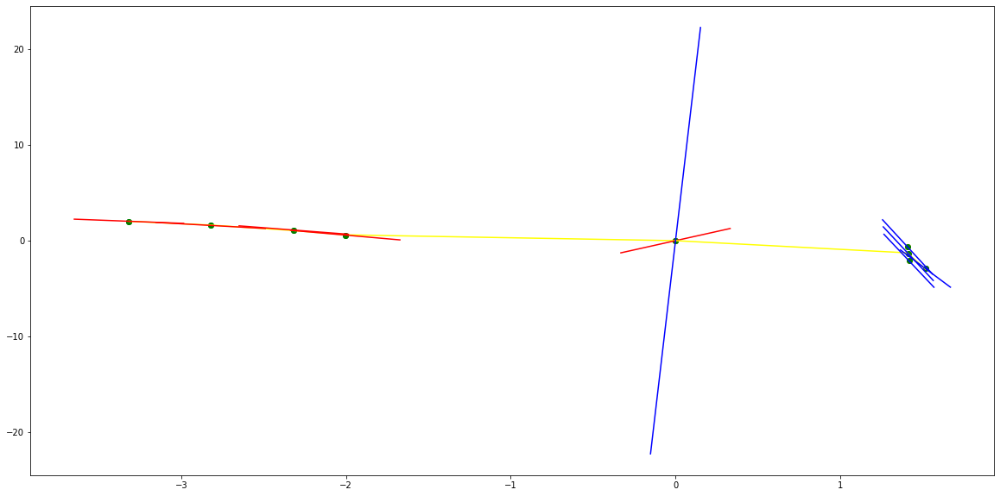

parameters (-0.0006814327463122284, -0.017461354885399172, -0.15513216332923285, -0.6133110217151599, -2.6912832565764377, -0.0019165888908762977)
tangent[0]:-1.6341388120863751
tangent[1]:-1.6003250792329533
tangent[2]:-1.600409571531457
tangent[3]:-1.9248396064352349
tangent[4]:-2.6912832565764377
parameters (2.933757483176053, -28.133493268200038, 93.47271815497916, -124.80759756236779, 52.282113047054885, 0.00011595313243912319)
tangent[0]:52.282113047054885
tangent[1]:-18.405646999969342
tangent[2]:9.617363104638663
tangent[3]:-22.864016647138747
tangent[4]:-22.955829525774526


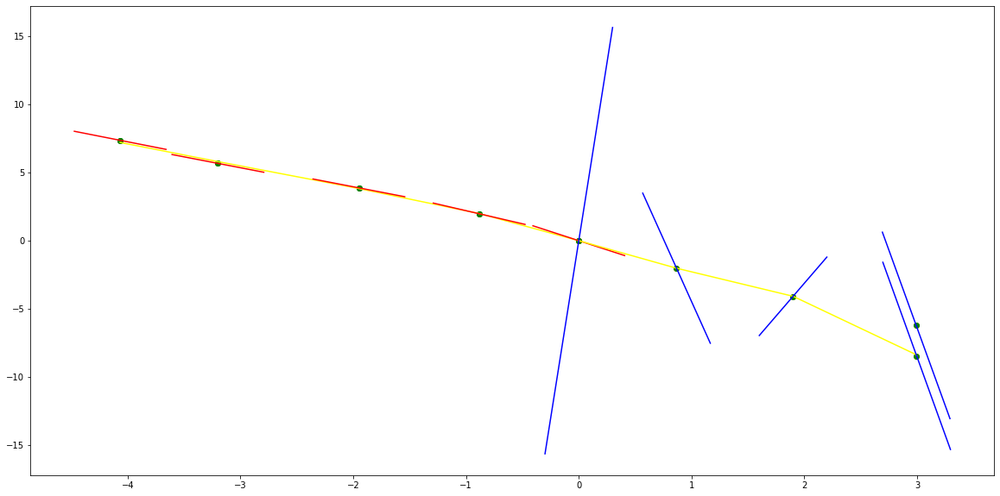

parameters (0.004296245821096579, 0.0806614406328346, 0.5323063969435051, 1.367481620534852, -1.0120520382577713, 0.009632640247525914)
tangent[0]:-1.5640647517842958
tangent[1]:-1.9209171462472514
tangent[2]:-2.376685676768935
tangent[3]:-2.4645317357525576
tangent[4]:-1.0120520382577713
parameters (3.433324053026275, -36.26417715025076, 134.523317728692, -205.21375883869314, 102.11566101312025, 0.0005214905890532417)
tangent[0]:102.11566101312025
tangent[1]:-29.320516448129524
tangent[2]:-29.147009691506526
tangent[3]:-28.971795494608898
tangent[4]:-19.292803279431723


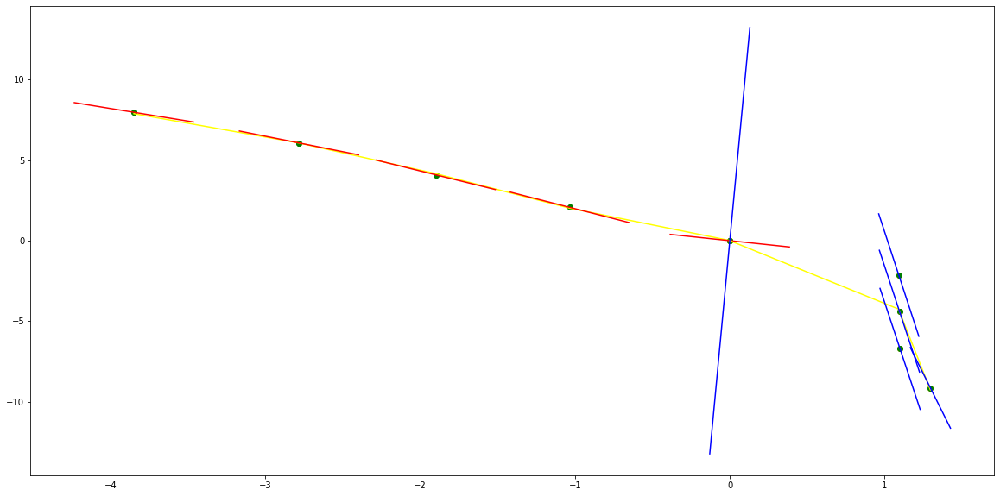

parameters (-4.877091112341847, -50.25360622508265, -181.08227626306646, -266.7539466419416, -137.98158711827955, -0.00012592957416059563)
tangent[0]:-26.035490467752652
tangent[1]:-26.00500549201388
tangent[2]:-21.613461833419137
tangent[3]:17.61548089848435
tangent[4]:-137.98158711827955
parameters (1140.2735167523056, -11643.824986561629, 42776.935878923396, -65939.59991812572, 34970.26659437073, 9.42541827050267e-09)
tangent[0]:34970.26659437073
tangent[1]:-7836.801885891233
tangent[2]:2852.8238509996663
tangent[3]:-649.823213563337
tangent[4]:-602.853362531554


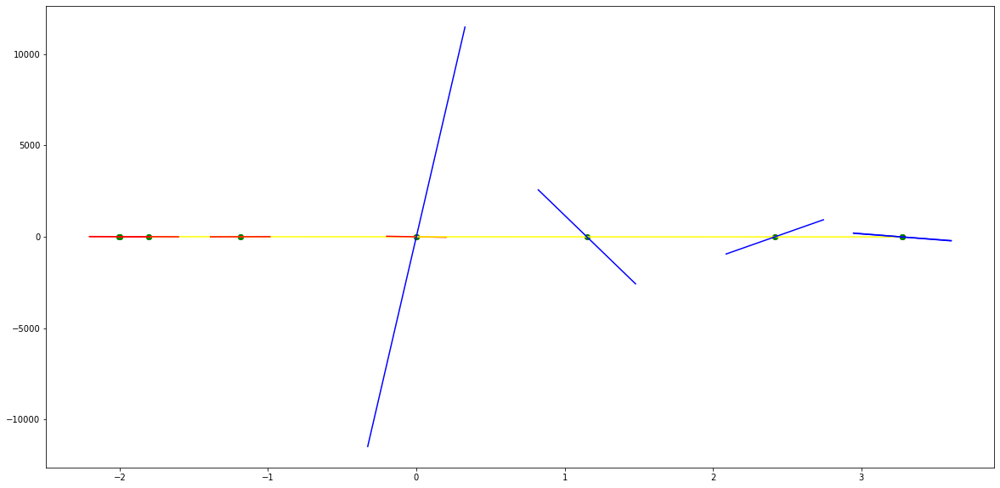

parameters (3.433323987712371, 36.6939581473178, 138.1764593664684, 215.44100315138834, 112.58900667162962, 6.0895865807003395e-05)
tangent[0]:-28.971795459535173
tangent[1]:-19.292803310318817
tangent[2]:8.245462413117508
tangent[3]:-27.91336686538878
tangent[4]:112.58900667162962
parameters (-617740.9980124977, 4743560.005589337, -13484041.69132056, 16756970.804559985, -7641207.437128326, -5.795191670247929e-08)
tangent[0]:-7641207.437128326
tangent[1]:516800.699881183
tangent[2]:-913.7941817548126
tangent[3]:-632.4277075584978
tangent[4]:-464.52818322740495


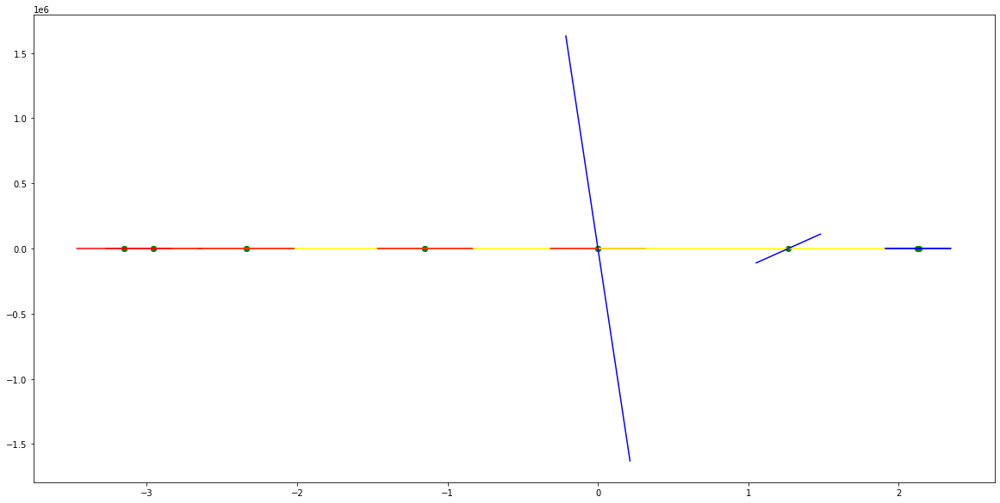

parameters (-0.8422268098466179, -9.612094878038082, -39.05221871713214, -65.90352806026452, -40.29324969896737, -8.981342560173509e-05)
tangent[0]:-16.56132606627108
tangent[1]:2.3887139014438503
tangent[2]:-6.963255804869107
tangent[3]:5.989025157183775
tangent[4]:-40.29324969896737
parameters (80562947.02490734, -281845608.78297395, 369737054.60626364, -215559871.64846414, 47124960.17488505, 3.161013638317052e-08)
tangent[0]:47124960.17488505
tangent[1]:-1122.0808604210615
tangent[2]:-582.1624803990126
tangent[3]:-387.62915919721127
tangent[4]:-570.393565043807


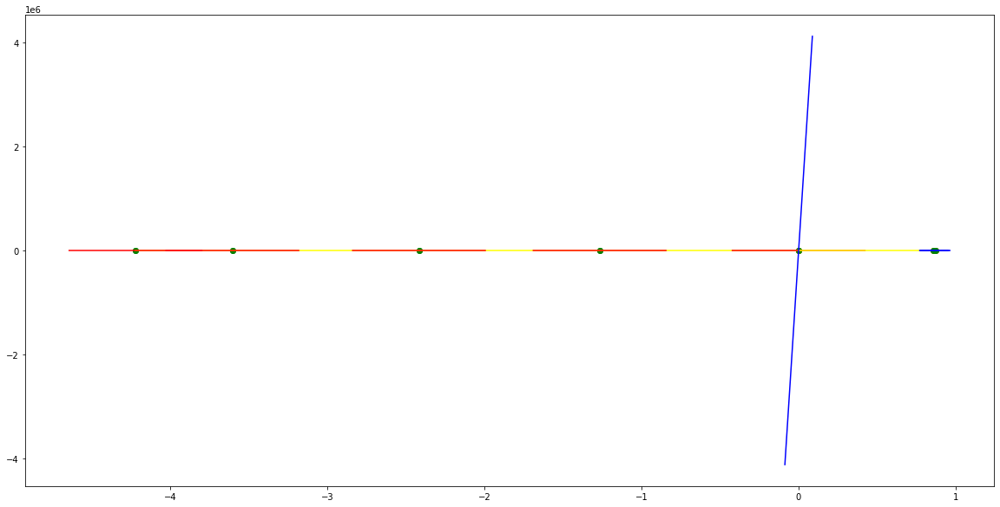

parameters (-137048219.61277232, -30597646.155740436, -2344592.367877565, -68478.62248549935, -623.7801451592798, 0.008493070754720448)
tangent[0]:-290.35776466592256
tangent[1]:-344.29444071999774
tangent[2]:-362.3123264124381
tangent[3]:-166.56402303075674
tangent[4]:-623.7801451592798
parameters (-318.5189239177038, 741.8151787658704, -624.6071227396278, 233.74381088769854, -51.433372802352196, -0.6958978594185693)
tangent[0]:-51.433372802352196
tangent[1]:-49.51767449171759
tangent[2]:-26.706924224409185
tangent[3]:-13.060878262762458
tangent[4]:-12.614986521385589


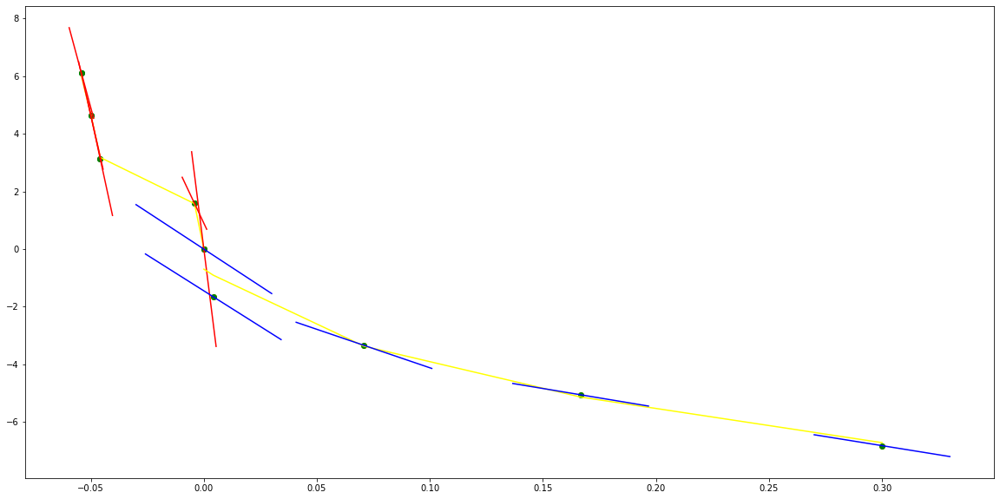

parameters (-0.7947002821959763, -1.1364154341259836, 1.528600807527425, 1.4694975328437407, -6.940495752666361, -0.008539805211713472)
tangent[0]:-5.5114627870767885
tangent[1]:-6.65225899216809
tangent[2]:-7.200950186943139
tangent[3]:-7.322438057680194
tangent[4]:-6.940495752666361
parameters (-1465.817772285324, 3008.1218016573603, -2120.51568954533, 577.8863772994383, -60.02019914956023, -0.0010182800253708815)
tangent[0]:-60.02019914956023
tangent[1]:3.2962900756295426
tangent[2]:-26.436188494883453
tangent[3]:-32.515689738505245
tangent[4]:-32.917272138662526


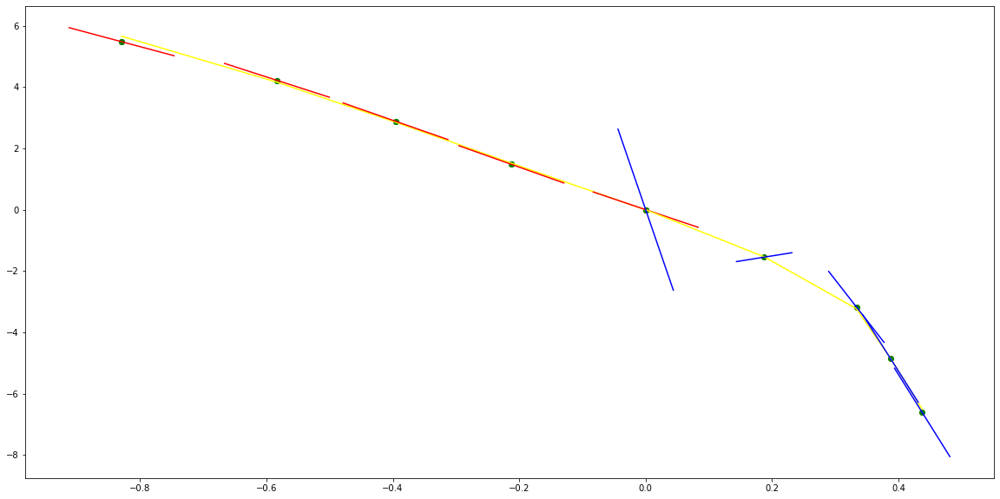

parameters (5222627460.193711, 544668779.6263769, 20117752.760255296, 310528.0048130978, 1018.866090327676, 0.004798372777705602)
tangent[0]:-628.1021933062456
tangent[1]:-638.8101718142406
tangent[2]:-931.8344983242395
tangent[3]:-1100.2752419776234
tangent[4]:1018.866090327676
parameters (5831561.098421485, -3429396.527754715, 392557.6533330902, -11455.303337048857, -453.26259249109836, -0.6338122472769849)
tangent[0]:-453.26259249109836
tangent[1]:-529.265857140281
tangent[2]:-569.23035372557
tangent[3]:-537.9722666467605
tangent[4]:-492.92967455831246


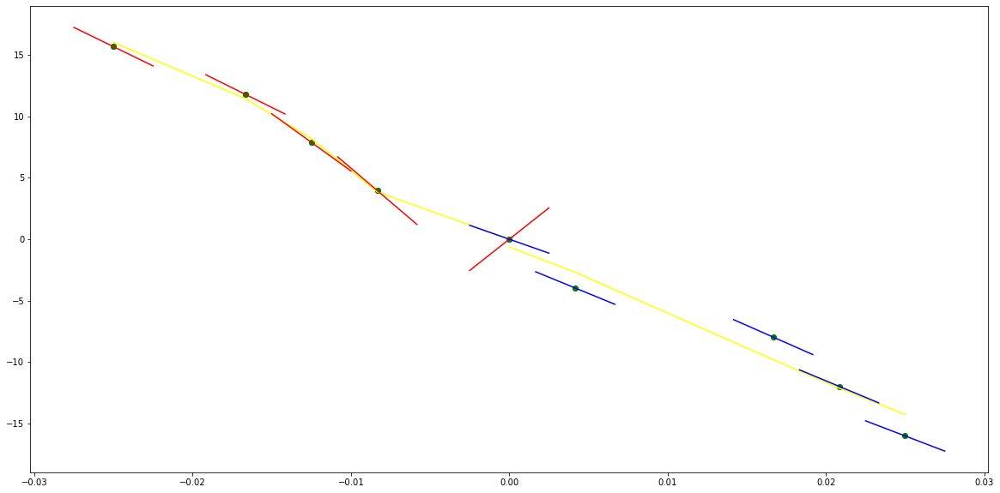

parameters (-2.1623652535584155, -27.18945070748301, -119.9507437369367, -221.2528485435221, -145.8372288207654, -8.201076309259387e-06)
tangent[0]:-4.234887500804007
tangent[1]:2.98159434742297
tangent[2]:3.173278252640557
tangent[3]:3.3657628004297067
tangent[4]:-145.8372288207654
parameters (0.0017295027064734225, -0.03919882574140055, 0.32431345656963345, -1.1825354570224016, 1.2111407226859963, -0.0020659771983086786)
tangent[0]:1.2111407226859963
tangent[1]:-0.7435632565349928
tangent[2]:-0.6987423579763079
tangent[3]:-0.6097120291272229
tangent[4]:-0.481614853166493


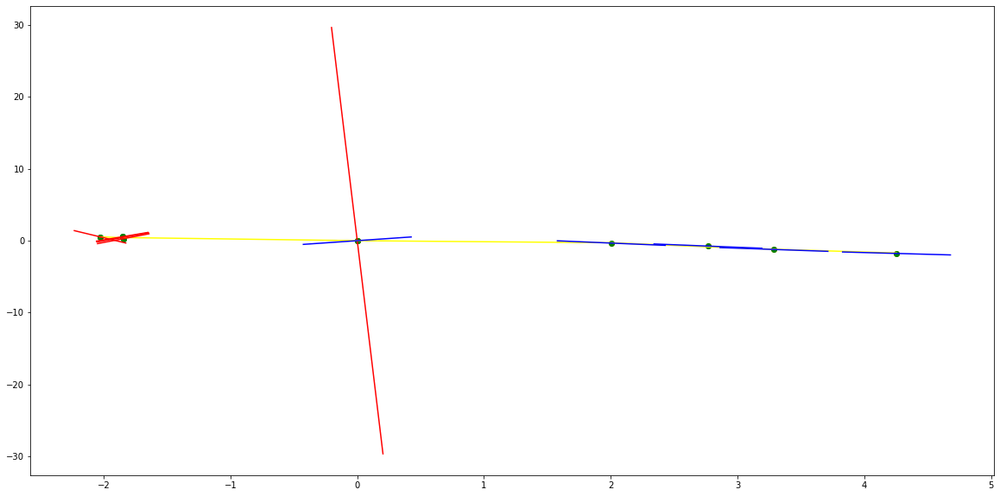

parameters (0.9761150279477617, 14.92839061440787, 82.71172399743557, 195.45132350757282, 163.74974188730562, 1.0660494700159028e-06)
tangent[0]:1.2210786886773803
tangent[1]:1.3110424385433816
tangent[2]:1.400773993846542
tangent[3]:-24.962137610148943
tangent[4]:163.74974188730562
parameters (0.0004349693822589773, -0.007774447728653657, 0.040991177802952854, -0.04933130232876124, -0.6499364030207141, 0.01774646475704074)
tangent[0]:-0.6499364030207141
tangent[1]:-0.666720230766952
tangent[2]:-0.6338513791999749
tangent[3]:-0.5478580776568968
tangent[4]:-0.49950746212234115


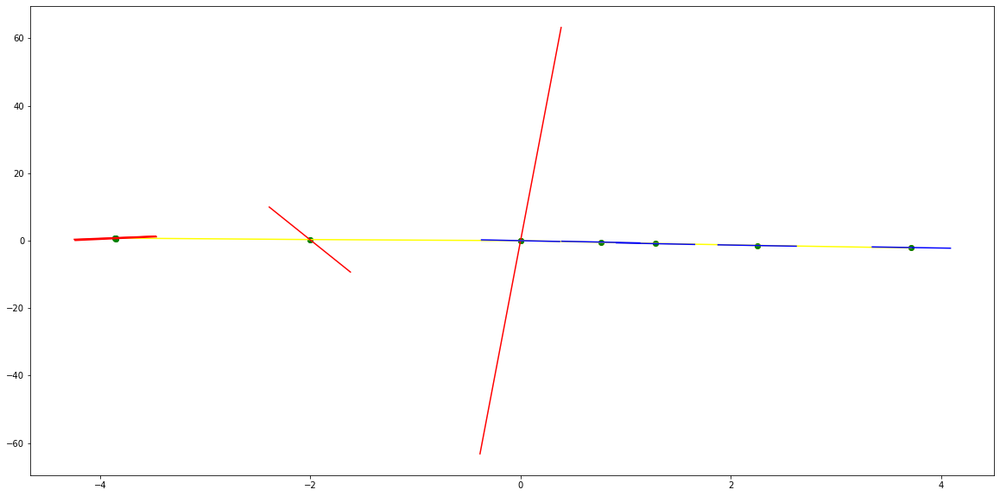

parameters (-0.0007512305844138949, -0.01603021400096562, -0.11621495434399376, -0.3208726619718173, -1.1430172921844088, 0.0038912443596092854)
tangent[0]:-0.985721352009975
tangent[1]:-1.011657656256036
tangent[2]:-0.9137247256004553
tangent[3]:-0.7664566683268933
tangent[4]:-1.1430172921844088
parameters (-3.2337250648613116, 35.35120965585231, -140.45969400488391, 237.1501329791009, -142.2133764838662, -3.841139852441824e-05)
tangent[0]:-142.2133764838662
tangent[1]:21.805481245677726
tangent[2]:-11.206899306266763
tangent[3]:-11.149500194555543
tangent[4]:-11.091208386577904


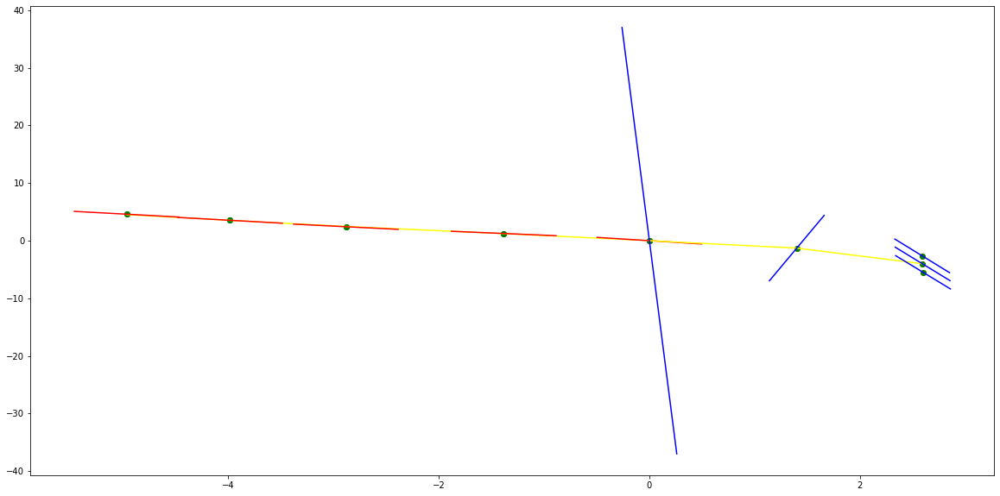

parameters (-0.00032957391481386767, -0.008305035224011081, -0.07348788663225982, -0.2622349466834546, -1.2033286717599083, -0.007486416096403723)
tangent[0]:-0.9703138553310791
tangent[1]:-0.9457331781877854
tangent[2]:-0.834067375340589
tangent[3]:-0.8163539835809224
tangent[4]:-1.2033286717599083
parameters (37.57991400596097, -283.73797452635495, 785.4668275112377, -943.5320384682282, 411.1429600676915, 0.0002217775712357881)
tangent[0]:411.1429600676915
tangent[1]:-33.05995978302923
tangent[2]:-32.37089316424732
tangent[3]:-31.685568919870832
tangent[4]:6.881319763196586


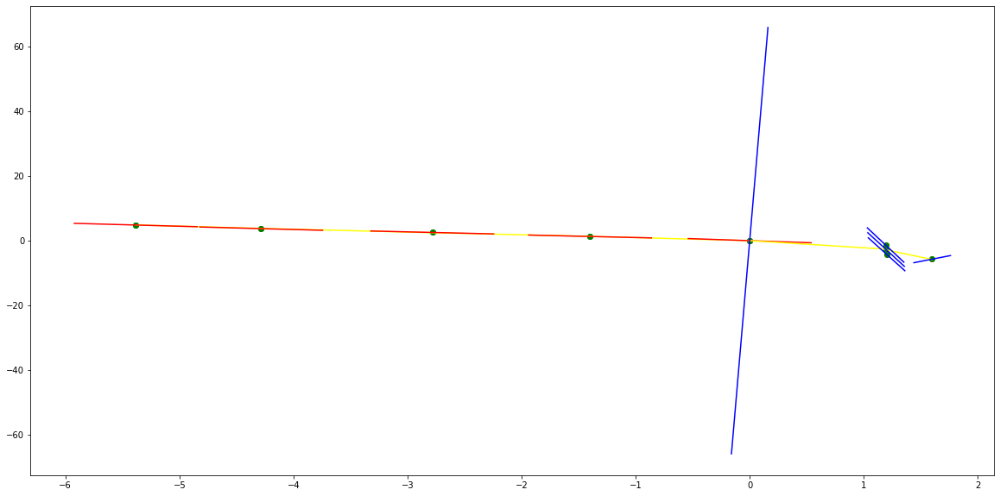

parameters (0.12753877617027032, 0.6940058536648266, 0.4907662372170954, -1.4688721996937155, -3.8370031953328727, -0.0074504758791228)
tangent[0]:-5.490239873159581
tangent[1]:-5.329692471887886
tangent[2]:-2.36585137112242
tangent[3]:-1.9455225229235533
tangent[4]:-3.8370031953328727
parameters (-111.06444221663413, 1073.927203181083, -3755.970341699357, 5575.245003489563, -2908.687693084578, -2.471008452685201e-05)
tangent[0]:-2908.687693084578
tangent[1]:517.5771306347356
tangent[2]:-76.100143870181
tangent[3]:-73.5573885162762
tangent[4]:-71.00097305656391


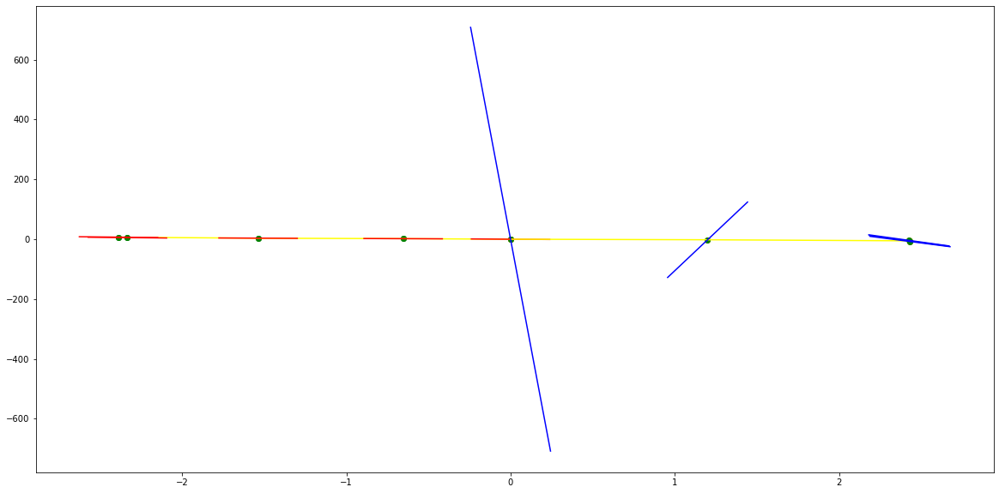

parameters (0.2554102025396337, 2.9433886653408363, 11.9513070420115, 20.315392542453484, 10.241707564640029, 0.0046497432897729665)
tangent[0]:-6.012771210697588
tangent[1]:-2.111098483386863
tangent[2]:-1.7877144060269234
tangent[3]:-4.582197590663599
tangent[4]:10.241707564640029
parameters (843.5124097496374, -6343.608143081648, 17272.416705249758, -20161.31862413917, 8537.609247437671, 7.044221654777044e-05)
tangent[0]:8537.609247437671
tangent[1]:-246.88339233534498
tangent[2]:-232.74147281227488
tangent[3]:-218.71832512836409
tangent[4]:145.72133673344797


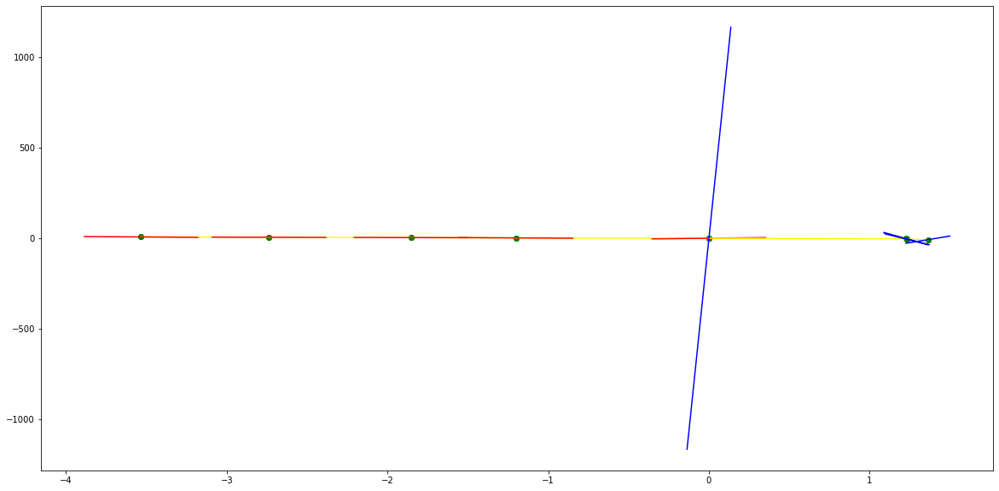

parameters (-0.17201504532280715, -2.1674124688749328, -9.723672711727584, -18.117593734938318, -13.614092169370837, 0.9426522193271292)
tangent[0]:-2.8173642185256274
tangent[1]:-3.402397074535303
tangent[2]:0.9889701543823914
tangent[3]:-13.46364203102539
tangent[4]:-13.614092169370837
parameters (-1334.1671810405296, 5446.9354176256065, -7537.508081294162, 3826.8479030960884, -417.7866281366549, -0.15407623979151144)
tangent[0]:-417.7866281366549
tangent[1]:-386.284744625381
tangent[2]:250.24423370500602
tangent[3]:-293.45833141543227
tangent[4]:-289.60539563710046


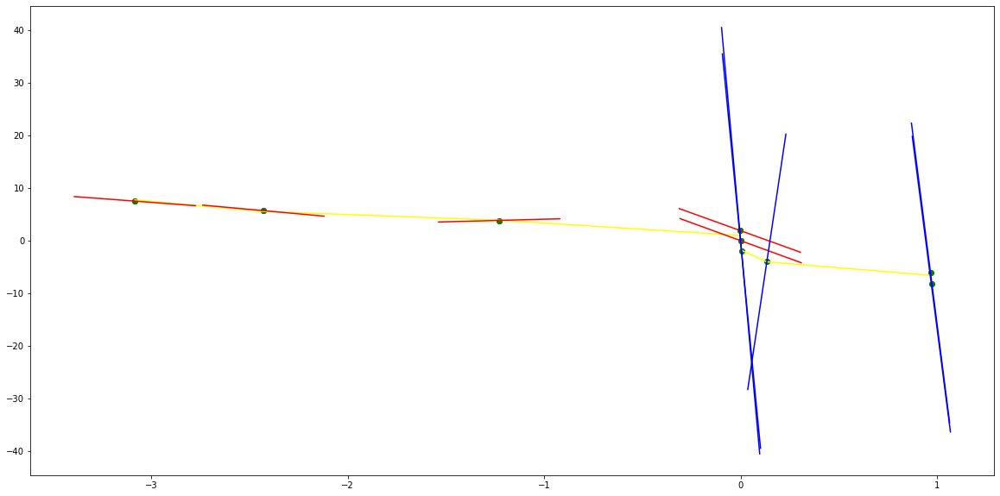

parameters (2.7961317964090724, 29.706486108297664, 110.2775323863572, 164.12332933337487, 73.62883547298982, 0.0007760605180720488)
tangent[0]:-29.53792106392511
tangent[1]:-29.658889806859904
tangent[2]:-29.777643660536498
tangent[3]:-32.18798845621468
tangent[4]:73.62883547298982
parameters (-30097.943054806343, 57314.37608778416, -37784.23152982765, 9433.00298614061, -555.7872999364333, 0.0033020147765608974)
tangent[0]:-555.7872999364333
tangent[1]:-479.1243540286456
tangent[2]:-171.52725739280118
tangent[3]:-133.16842569271444
tangent[4]:-64.83248635856376


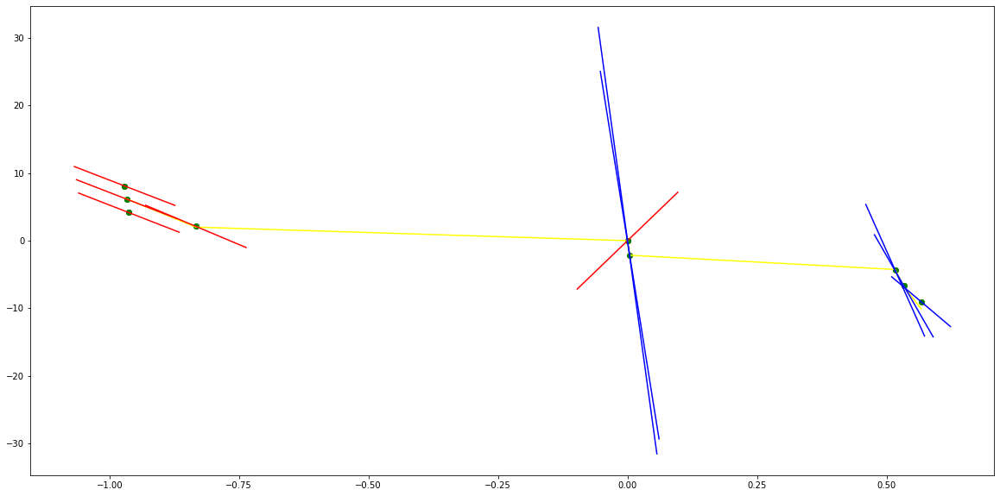

parameters (0.0007626366632865029, 0.0234391193855955, 0.2531719115850342, 1.0791697932771152, -0.5510891851037342, -0.03496144016821005)
tangent[0]:-1.4588541429743884
tangent[1]:-1.8510041913192747
tangent[2]:-2.4812372239450093
tangent[3]:-2.5071429717959703
tangent[4]:-0.5510891851037342
parameters (-5.3422199085589614, 97.7811320408124, -637.4873646110806, 1728.679432878215, -1606.5042001216423, -6.689680327731332e-07)
tangent[0]:-1606.5042001216423
tangent[1]:358.5064887087822
tangent[2]:-181.73893600292627
tangent[3]:192.28030757606416
tangent[4]:-582.1825488856264


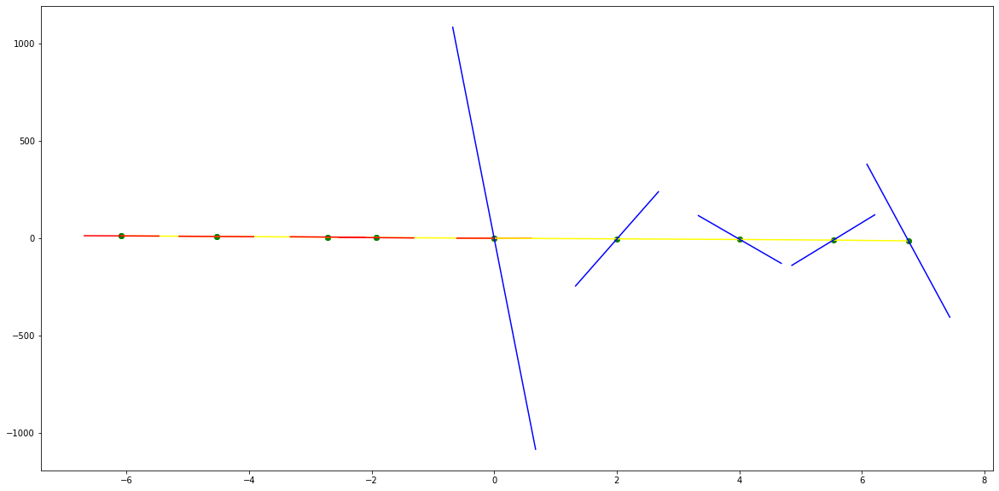

parameters (-0.0002488605996470245, -0.005619023476098466, -0.02821633919952135, 0.08559329175462327, -1.2538865179532728, 0.0166216869830986)
tangent[0]:-1.9837401512248047
tangent[1]:-2.2018537490240964
tangent[2]:-2.1661156678335343
tangent[3]:-1.7761215082824604
tangent[4]:-1.2538865179532728
parameters (505.88343171333656, -7656.957264656964, 42118.03831742087, -98880.17761767712, 82473.43030713512, 2.1402696509438375e-09)
tangent[0]:82473.43030713512
tangent[1]:-12094.950230632603
tangent[2]:4397.211016850677
tangent[3]:-765.9855141254229
tangent[4]:-706.737767075756


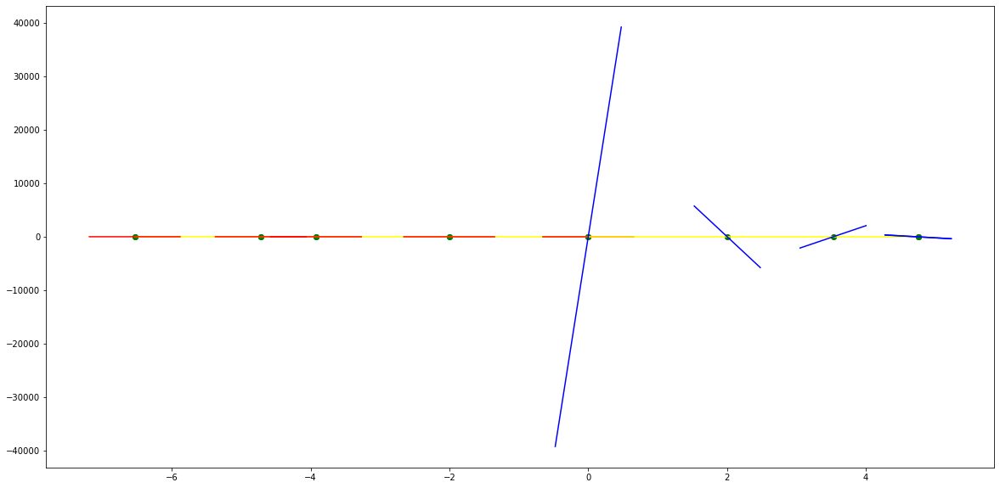

parameters (-0.000438420471094407, -0.014227753884874699, -0.1553771172366079, -0.6202643512236986, -2.3305309319635343, -0.004531126291888193)
tangent[0]:-2.243640599888665
tangent[1]:-2.2087206991176718
tangent[2]:-1.748040160895207
tangent[3]:-1.2938342421698148
tangent[4]:-2.3305309319635343
parameters (-381616.9836610114, 3744610.3255095235, -13559957.509232087, 21369295.417637624, -12269366.986043135, -1.369772576604056e-07)
tangent[0]:-12269366.986043135
tangent[1]:1103130.1052805614
tangent[2]:-1066.448698291555
tangent[3]:-739.7715459857136
tangent[4]:-543.7872181180865


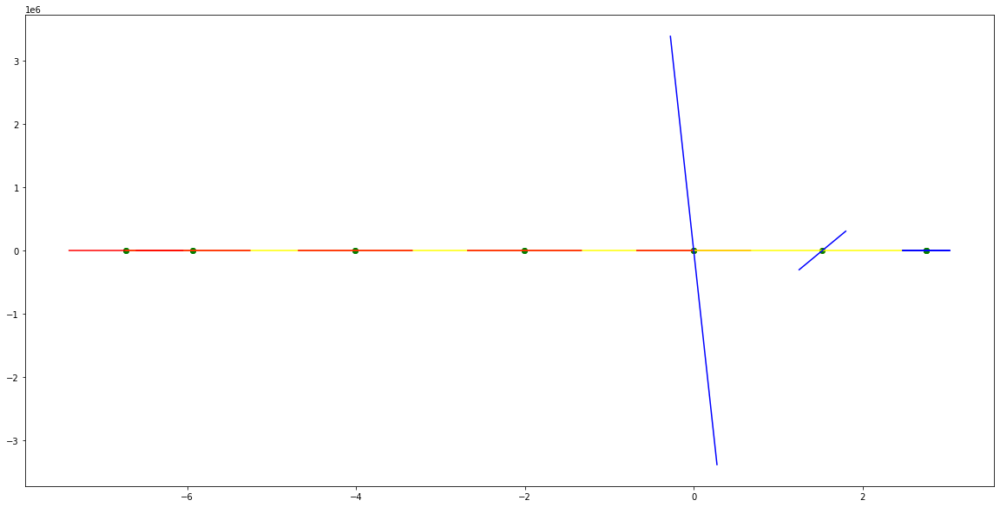

parameters (-7.654063153667374e-05, -0.0046615462510751285, -0.08085394513699116, -0.5090474467914573, -2.778649616721559, -0.0181002247378676)
tangent[0]:-2.1259971665939013
tangent[1]:-1.7716536622466768
tangent[2]:-1.4464941378857992
tangent[3]:-1.7261024827716016
tangent[4]:-2.778649616721559
parameters (64576828.26692437, -320626950.6499119, 596955883.6299865, -493957978.2451544, 153270129.38137984, -4.214684851089403e-08)
tangent[0]:153270129.38137984
tangent[1]:-1304.1212010383606
tangent[2]:-682.3423564434052
tangent[3]:-456.3242521286011
tangent[4]:-654.7614958286285


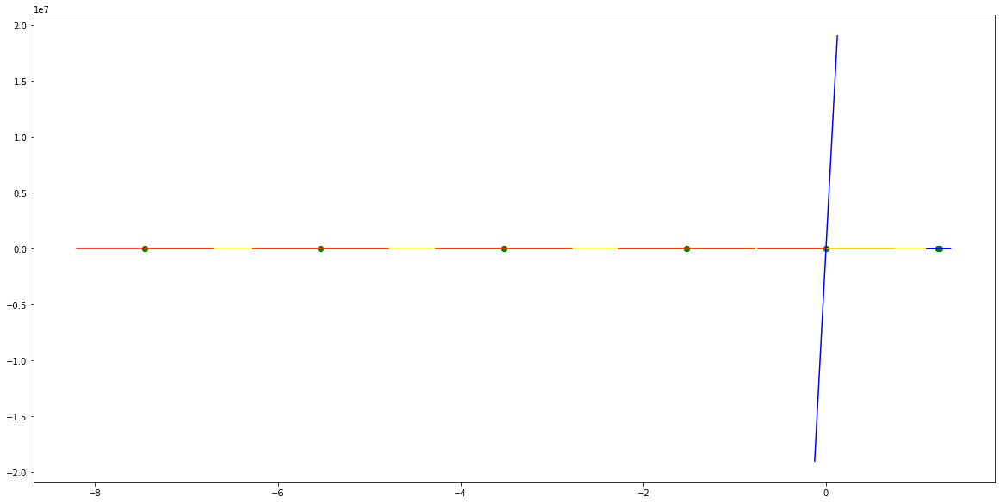

parameters (-36888.01774092723, -37356.083340035955, -8161.538313574065, 1924.806600948921, 626.9693075286368, -4.711744470444719e-09)
tangent[0]:20.68439664643438
tangent[1]:-35.560446283874626
tangent[2]:-44.12270038007978
tangent[3]:-52.99195595237575
tangent[4]:626.9693075286368
parameters (-0.2302403780877087, 1.4125687090311378, -3.107836787712189, 2.767505474026429, -1.8320998402299122, 0.005113270162935425)
tangent[0]:-1.8320998402299122
tangent[1]:-0.8619711462488898
tangent[2]:-0.9683698601791577
tangent[3]:-1.2750111069268804
tangent[4]:-1.21342028051922


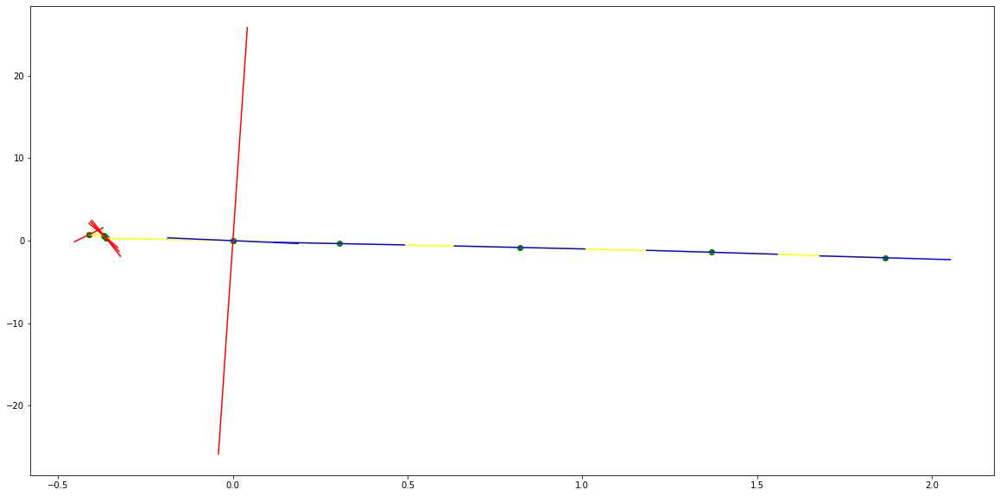

parameters (0.0003284734686488637, 0.011998800367620336, 0.15511335382156216, 0.7684607237534125, -0.8746514274603749, 0.004795850575206084)
tangent[0]:-1.8329088019486373
tangent[1]:-2.239418582773819
tangent[2]:-2.4850625383967353
tangent[3]:-2.3331086293744354
tangent[4]:-0.8746514274603749
parameters (1.2287910030641176, -21.290300173243523, 131.1030651631803, -333.88835062871686, 286.0412974256041, -1.193279497226319e-05)
tangent[0]:286.0412974256041
tangent[1]:-73.53197648797965
tangent[2]:35.843547434830214
tangent[3]:-36.63970776340153
tangent[4]:-33.539053795103484


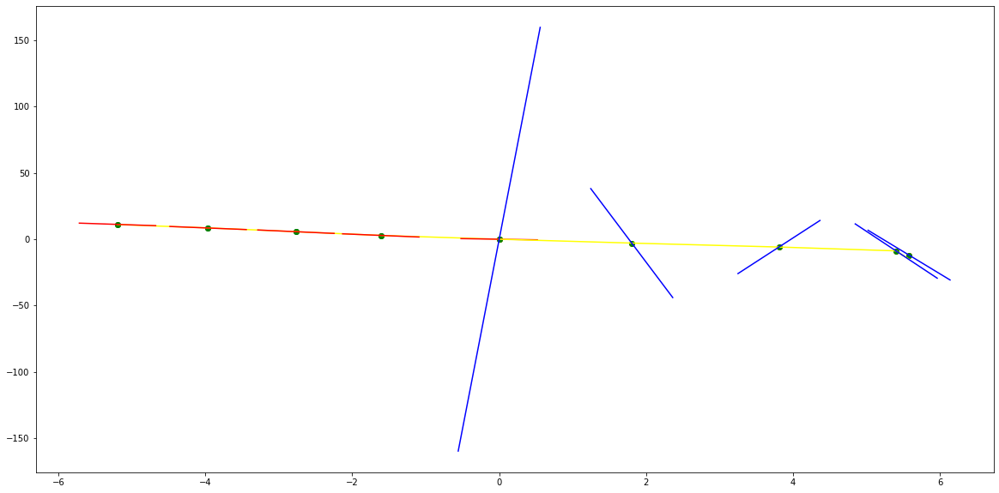

parameters (-0.000910215231458988, -0.0235117032332435, -0.19399800718731097, -0.5235325789453402, -2.04682718282406, 0.0022223021143069122)
tangent[0]:-2.3603804990780195
tangent[1]:-2.4256048595933177
tangent[2]:-2.1324743576560232
tangent[3]:-1.5480683992663296
tangent[4]:-2.04682718282406
parameters (-3.07493382530106, 48.561848571156695, -277.23015320442255, 671.3054401807397, -574.6615976190022, 1.0930193114353053e-05)
tangent[0]:-574.6615976190022
tangent[1]:91.17738212035295
tangent[2]:-39.51838312051029
tangent[3]:-30.952928336736363
tangent[4]:-30.704546362548058


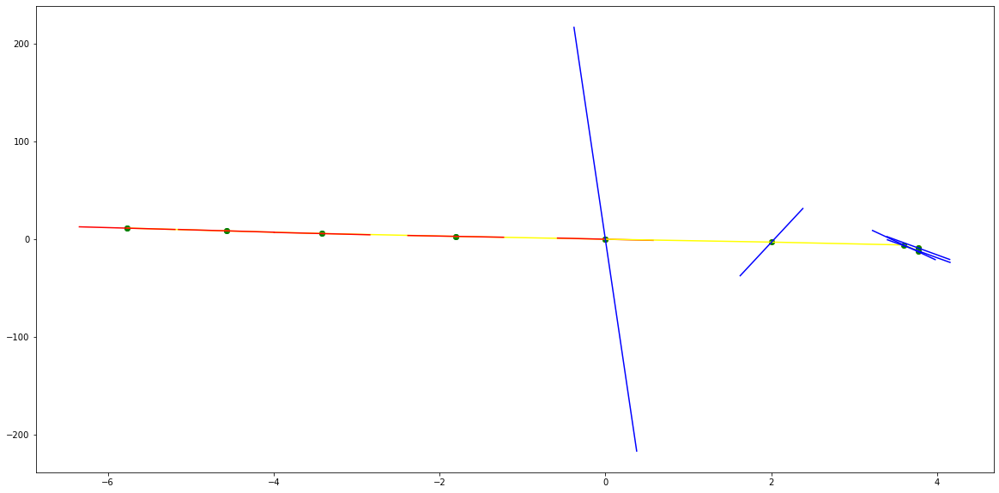

parameters (4.193488652765832e-05, -0.0017024828109318006, -0.04024124951891052, -0.1713123933017193, -1.6944707290895535, -0.00393696224373842)
tangent[0]:-2.333153937287663
tangent[1]:-2.11884582415707
tangent[2]:-1.720303335314864
tangent[3]:-1.4344991788586348
tangent[4]:-1.6944707290895535
parameters (2.652101946976936, -34.84566493820857, 163.00486355467348, -322.05617140461385, 221.4097831718961, -0.00011573018891644379)
tangent[0]:221.4097831718961
tangent[1]:-41.580850182731695
tangent[2]:-29.3325386213167
tangent[3]:-29.036328303490734
tangent[4]:-28.740134544493742


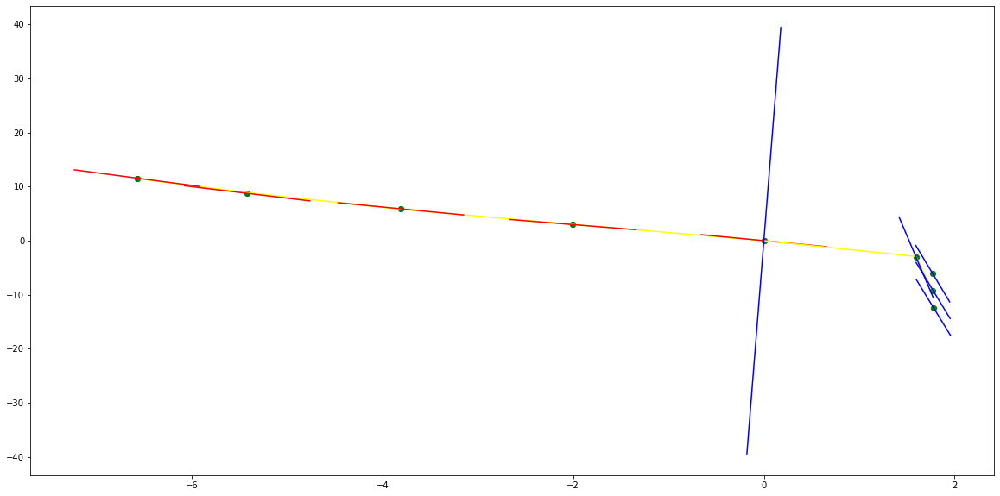

parameters (-0.04610742052577351, -0.7318248903946184, -4.092176824871305, -9.403203864603455, -9.415442884821024, -0.0003809938254015917)
tangent[0]:-7.980875346287098
tangent[1]:-0.49562739745942075
tangent[2]:-3.197400238874904
tangent[3]:-0.237560679046096
tangent[4]:-9.415442884821024
parameters (-5.275907854366583, 76.81040382246267, -387.7569108051901, 786.5784606152704, -513.4240645782894, 0.35691289723274594)
tangent[0]:-513.4240645782894
tangent[1]:-500.484118808456
tangent[2]:175.47156102471797
tangent[3]:-89.1651928008315
tangent[4]:104.16195013441745


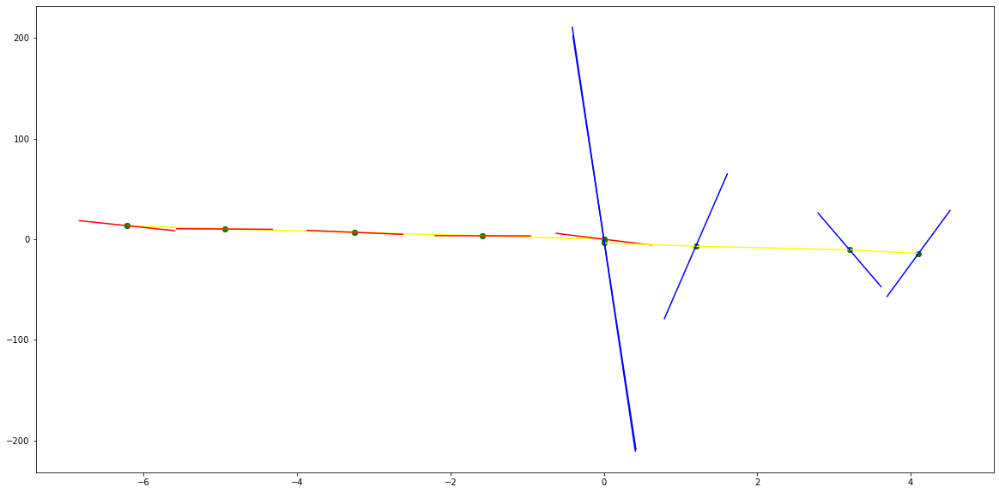

parameters (-0.0029298774589693968, -0.046509891538219716, -0.28926786796437126, -1.1433034891354394, -5.472015573772185, -0.02196370815454048)
tangent[0]:-1.8337860077797972
tangent[1]:-2.7003712104296955
tangent[2]:-3.6866775558637226
tangent[3]:-3.69420081313476
tangent[4]:-5.472015573772185
parameters (665.7836421617268, -9734.01433898158, 51312.57604002476, -114694.92237720476, 91377.8032002084, -1.8109973969524779e-09)
tangent[0]:91377.8032002084
tangent[1]:-9769.839224456475
tangent[2]:6624.1813532459055
tangent[3]:-1078.6110531542945
tangent[4]:-942.3108980152319


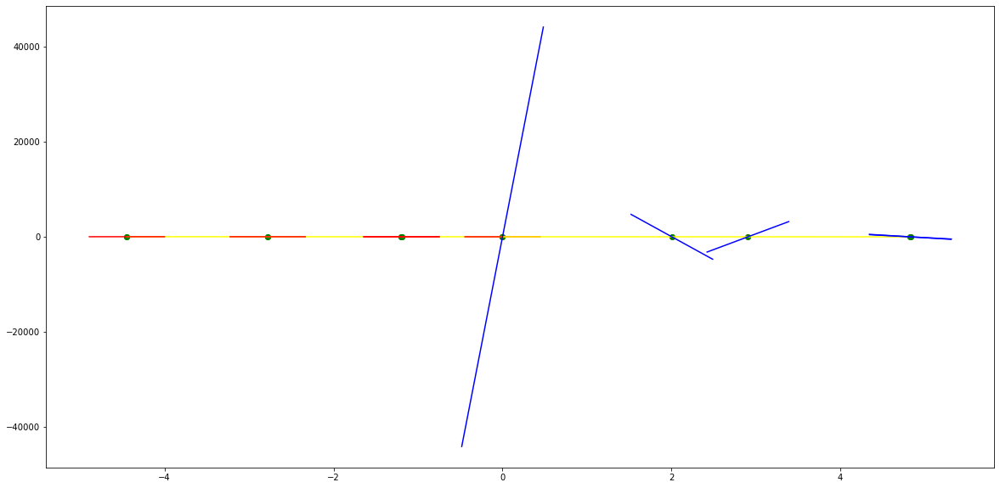

parameters (0.0028404671516728363, 0.08433871990742478, 0.8967771769469007, 3.9431776721470473, 3.150647817339233, -0.001290648063662532)
tangent[0]:-2.50338026316279
tangent[1]:-4.098501341853372
tangent[2]:-4.10536820081395
tangent[3]:-4.335316236430663
tangent[4]:3.150647817339233
parameters (-137737.80076990076, 1296341.386557281, -4381539.526608082, 6139870.794166535, -2831503.7993147066, 0.0)
tangent[0]:-2831503.7993147066
tangent[1]:901405.2083027912
tangent[2]:-1182.7966680964455
tangent[3]:-923.0459953090176
tangent[4]:-738.8514941623434


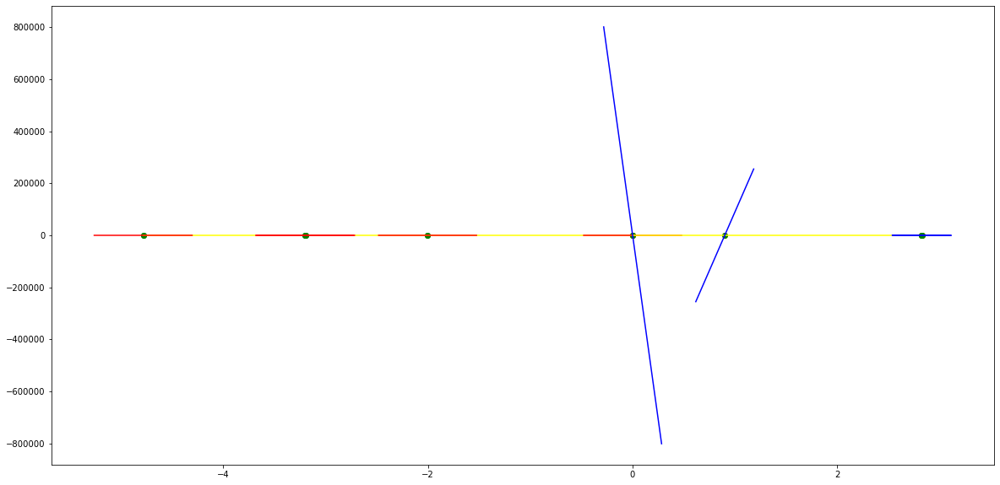

parameters (-0.00705173858843955, -0.15627383364310402, -1.17272273847145, -3.399730940529326, -5.930766817167986, 0.06886069188337195)
tangent[0]:-4.075450526113202
tangent[1]:-4.073412543769927
tangent[2]:-3.0537604912423975
tangent[3]:-2.2284061082369075
tangent[4]:-5.930766817167986
parameters (-31324106.30440596, 242075986.26100796, -701534904.0910788, 903560928.5962327, -436405081.26077604, 1.8544613344793373e-06)
tangent[0]:-436405081.26077604
tangent[1]:-855.6752233505249
tangent[2]:-940.0844440460205
tangent[3]:-847.8644304275513
tangent[4]:-682.8037872314453


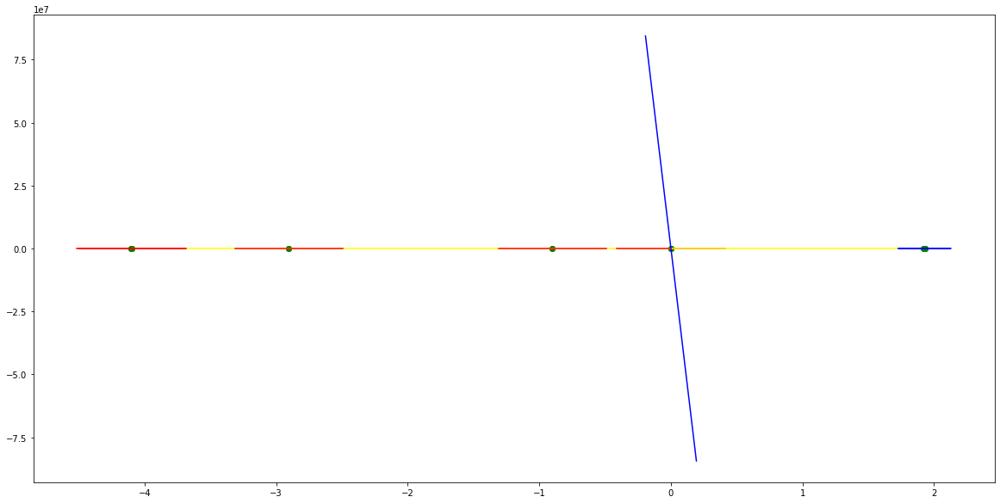

parameters (126787937.02495979, 32889794.167616528, 3042098.35343066, 119694.34907319472, 1576.7268811374556, 0.0004140670981986492)
tangent[0]:-92.9366701964741
tangent[1]:-250.54733744492341
tangent[2]:-352.4971970751435
tangent[3]:-447.21406814122065
tangent[4]:1576.7268811374556
parameters (29948852.0501885, -7562205.195141477, 614018.1132919516, -17155.84235307106, -0.6815713981947602, -0.522615748030473)
tangent[0]:-0.6815713981947602
tangent[1]:-113.8166491621068
tangent[2]:-161.31682694883392
tangent[3]:43.66907198198879
tangent[4]:-298.72046465561033


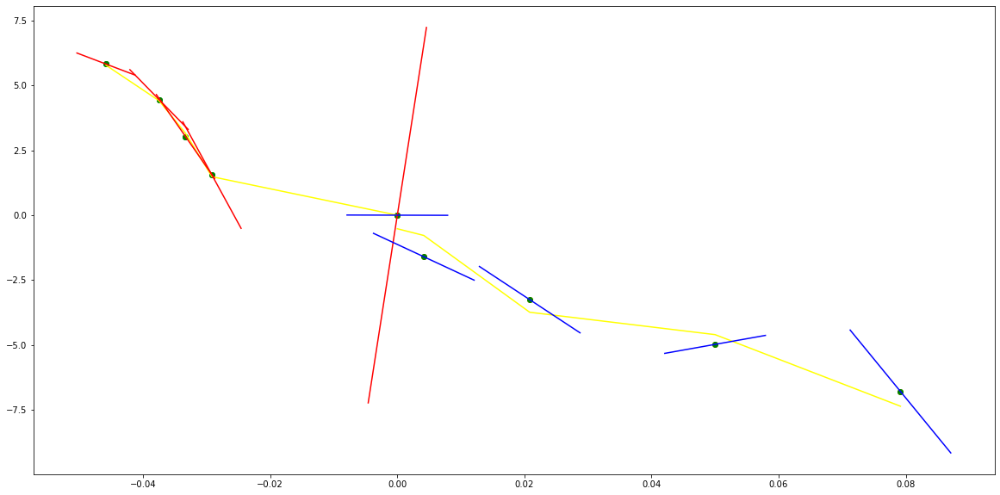

parameters (-18398054.81370214, -5817710.251677032, -661387.3373108038, -31707.959625715946, -626.6890437818867, -0.08530528179653506)
tangent[0]:-108.88358163904297
tangent[1]:-136.12946983799304
tangent[2]:30.866874279799845
tangent[3]:-395.2797106229787
tangent[4]:-626.6890437818867
parameters (-0.003944336088581921, 0.08808102373044757, -0.7377856797469179, 2.862028408477802, -6.330042933369957, -1.8950805354150442)
tangent[0]:-6.330042933369957
tangent[1]:-6.306229195613072
tangent[2]:-6.141683581931313
tangent[3]:-2.165250747806512
tangent[4]:-1.1218690241067444


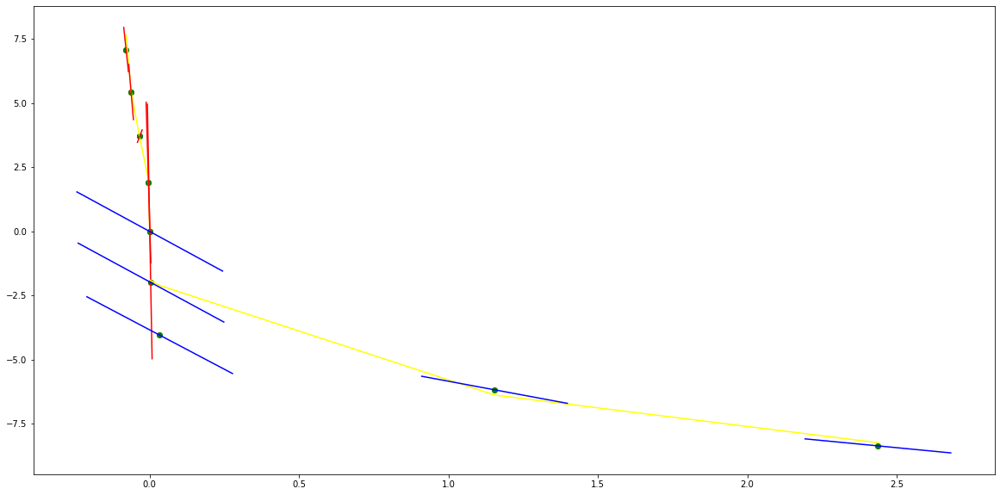

parameters (0.0007634773592725983, 0.020634909007692874, 0.1881396855747819, 0.690372690042758, -0.48081736812094616, 0.012259979173271502)
tangent[0]:-1.8742655835926891
tangent[1]:-1.2544806402681559
tangent[2]:-1.2771342373440504
tangent[3]:-1.5838321380178708
tangent[4]:-0.48081736812094616
parameters (-4.640734122023955, 53.49531500492456, -209.76265210040313, 322.66514814154635, -169.59357165026245, 0.004064339082680169)
tangent[0]:-169.59357165026245
tangent[1]:32.42482311320248
tangent[2]:32.092167206298654
tangent[3]:31.75606693546854
tangent[4]:-45.48446888354624


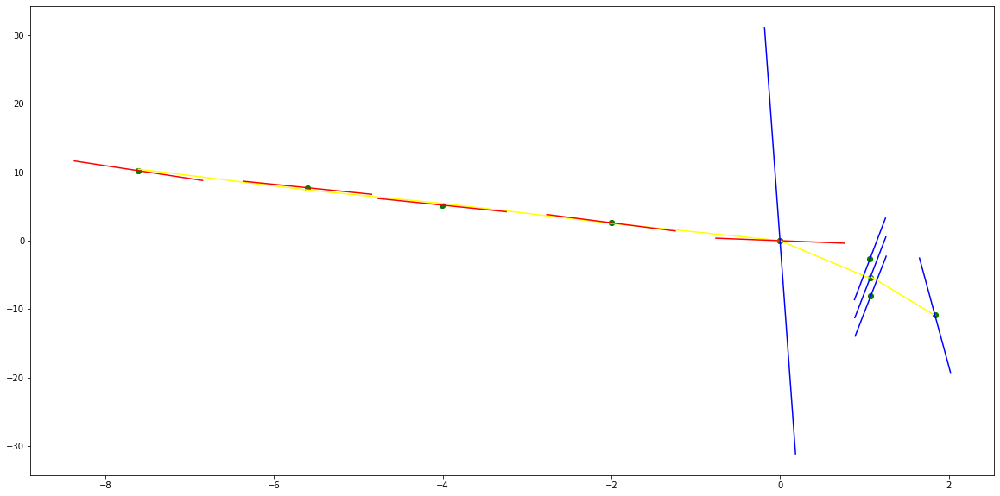

parameters (-0.0017375554662130538, -0.04896833959805088, -0.5040845458311273, -2.290919533076134, -5.709688343520341, 1.3357906338478676)
tangent[0]:-1.5671105183326617
tangent[1]:-1.0013776952717617
tangent[2]:-2.3082871792295885
tangent[3]:-5.690622064566124
tangent[4]:-5.709688343520341
parameters (-32.851111983392265, 321.4899105793604, -1103.2933572531076, 1525.3557818704844, -661.670620805231, -0.006850650260277888)
tangent[0]:-661.670620805231
tangent[1]:-649.0187083100444
tangent[2]:254.47838709999724
tangent[3]:54.13140149387982
tangent[4]:-500.1983215777236


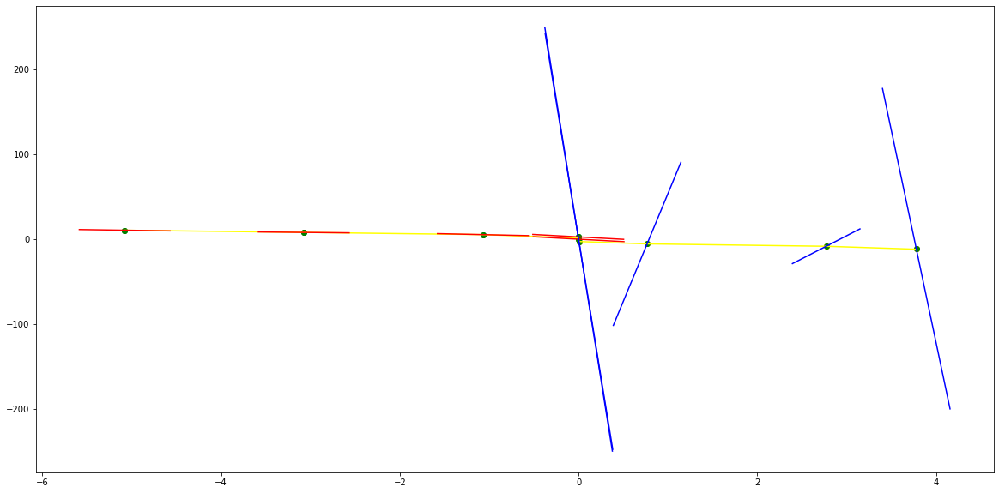

parameters (0.01312575225367561, 0.3348720746055263, 3.079758653765021, 11.762322450371476, 12.289346261641404, 0.0002943131662941324)
tangent[0]:-6.575422321958827
tangent[1]:-6.585480259625216
tangent[2]:-6.595496625567273
tangent[3]:-7.47089324846983
tangent[4]:12.289346261641404
parameters (67862434.17899963, -278128259.0922326, 427438890.980895, -291946440.8263687, 74773390.53304687, -1.0536712127723507e-07)
tangent[0]:74773390.53304687
tangent[1]:-1133.8314782083035
tangent[2]:-595.22925183177
tangent[3]:-398.6201784312725
tangent[4]:-569.526733726263


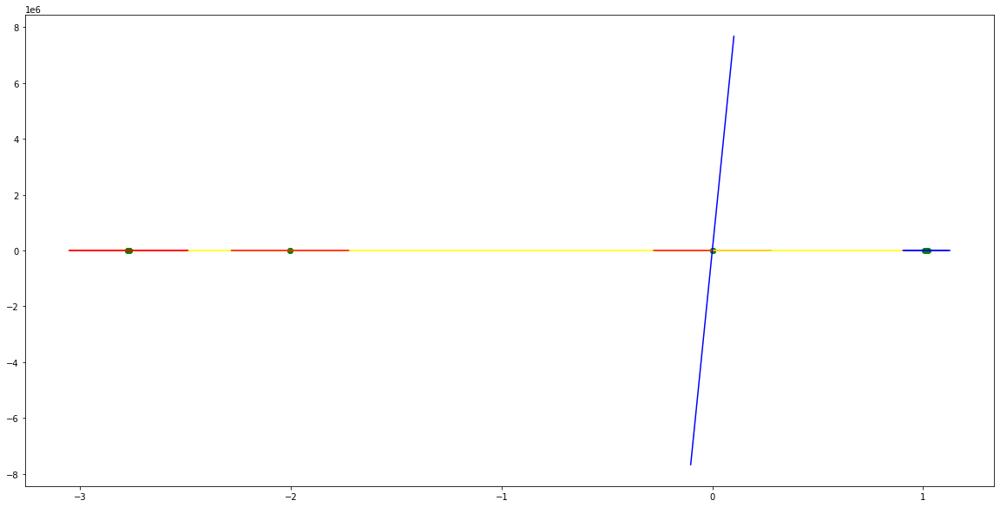

parameters (-4.640734122008002, -59.13917714938661, -264.5551508498611, -476.9621193671017, -273.0407322870263, 0.875835315065944)
tangent[0]:31.756066935327624
tangent[1]:-45.484468883416696
tangent[2]:100.32960406609055
tangent[3]:-269.0794939939004
tangent[4]:-273.0407322870263
parameters (-3222282896.719947, 290098523.7161511, -9046256.872406987, 112028.48022553691, -970.5222483616196, -0.06580824047452065)
tangent[0]:-970.5222483616196
tangent[1]:-429.0084685997813
tangent[2]:-537.1935152975504
tangent[3]:-645.7607593031855
tangent[4]:-624.1582958480183


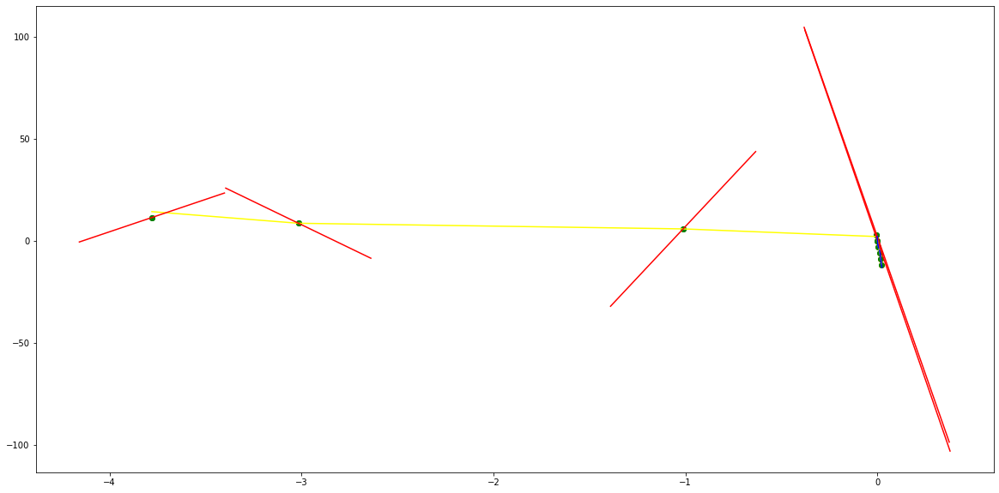

parameters (124809606.80129567, 28461377.653756488, 2154943.675567284, 55074.807127528584, -264.20679836569116, -0.12700523853559845)
tangent[0]:-512.4951031294618
tangent[1]:-783.1506574638261
tangent[2]:-838.0660938464774
tangent[3]:-796.038753492044
tangent[4]:-264.20679836569116
parameters (994910520.7580707, -98318240.29999727, 2356931.626123006, 15300.548834096115, -1221.743988441975, 0.11291438029437684)
tangent[0]:-1221.743988441975
tangent[1]:-998.408259454315
tangent[2]:-679.3320152468601
tangent[3]:-239.17515565075564
tangent[4]:-769.486923747688


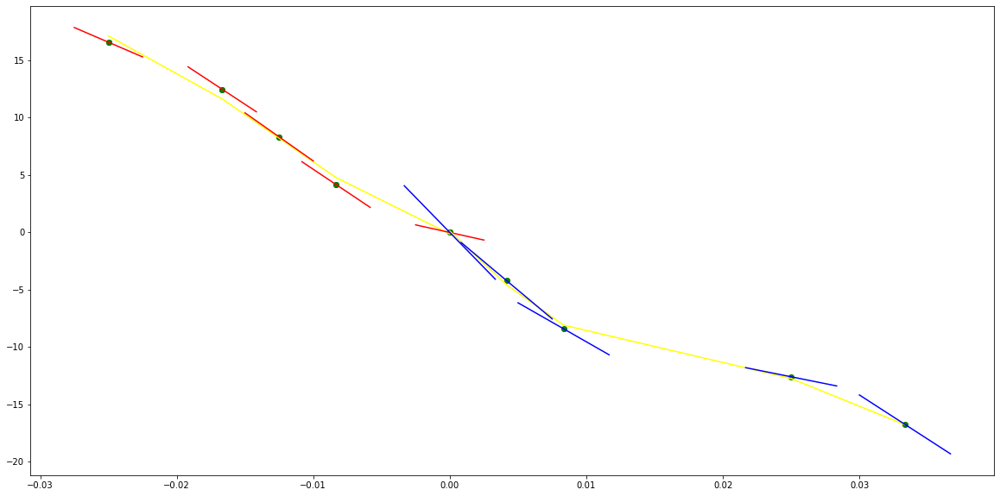

parameters (0.0010498024097806964, 0.021147549623191278, 0.14916195801408136, 0.42515168104660606, 0.4168853880059191, 3.7677739848644465e-06)
tangent[0]:0.457082565997712
tangent[1]:-0.045210681996254554
tangent[2]:0.1055242212014873
tangent[3]:-0.0861285371914553
tangent[4]:0.4168853880059191
parameters (-1.4722926721428113, 16.687151777504262, -68.46380853332317, 119.7347672178539, -75.05134212983508, -2.0245526409564266e-06)
tangent[0]:-75.05134212983508
tangent[1]:7.027290696992836
tangent[2]:6.920345415497806
tangent[3]:-4.5219819398427745
tangent[4]:-1.654189281054144


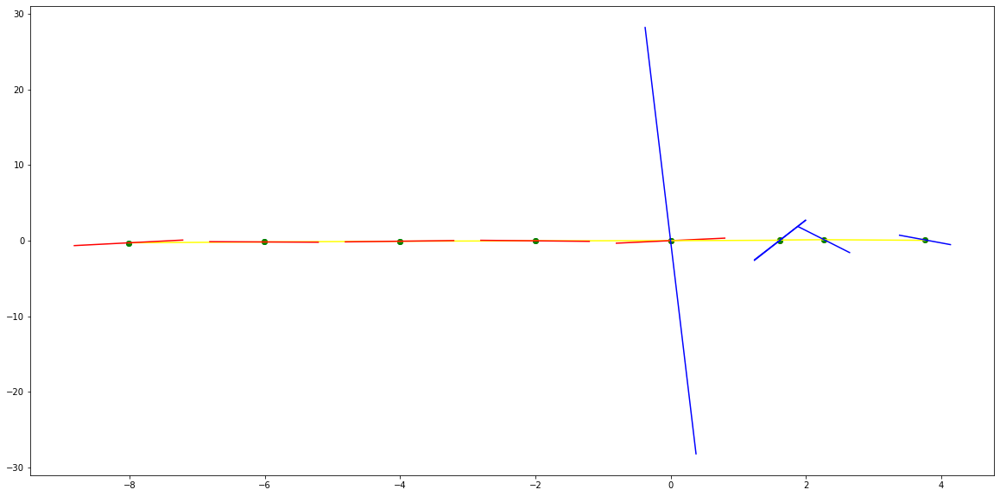

parameters (4.129247694078942e-06, 0.00027560225738614864, 0.0051389054571088135, 0.03515392037440841, 0.11178937504809569, 0.0009316978515429037)
tangent[0]:0.013739955085309924
tangent[1]:0.019270962754145082
tangent[2]:0.07208887342638975
tangent[3]:0.07230377763111745
tangent[4]:0.11178937504809569
parameters (2063.5543093913975, -13720.414070482462, 34114.01565133388, -37596.04419007362, 15497.079480634362, 7.202830556060992e-11)
tangent[0]:15497.079480634362
tangent[1]:-19.299790054370533
tangent[2]:-16.214880085506593
tangent[3]:-13.318938126292778
tangent[4]:7.031027991310111


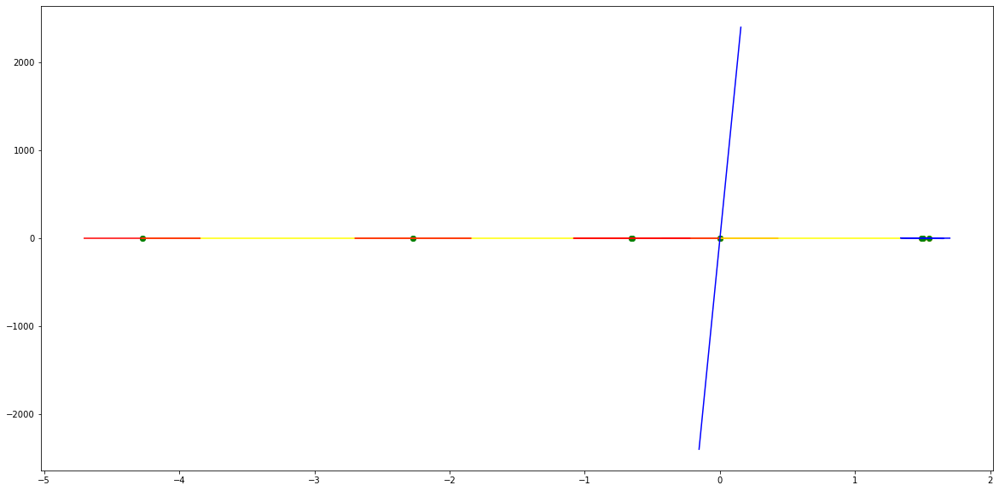

parameters (0.00010035942186791496, 0.0018231778169286376, 0.00788849720736719, 0.0009789409827979185, -0.011969039576458127, -0.0008339216978517154)
tangent[0]:-0.09785553199705974
tangent[1]:-0.09755548238295313
tangent[2]:0.020287560538247477
tangent[3]:0.02855263143272241
tangent[4]:-0.011969039576458127
parameters (-10.522516673944653, 159.21791048633946, -880.0325643255492, 2085.1092566975585, -1756.0486543475688, 6.945586607630241e-11)
tangent[0]:-1756.0486543475688
tangent[1]:275.3707108902329
tangent[2]:-24.52369255757162
tangent[3]:-21.331045860880977
tangent[4]:-22.445105993776224


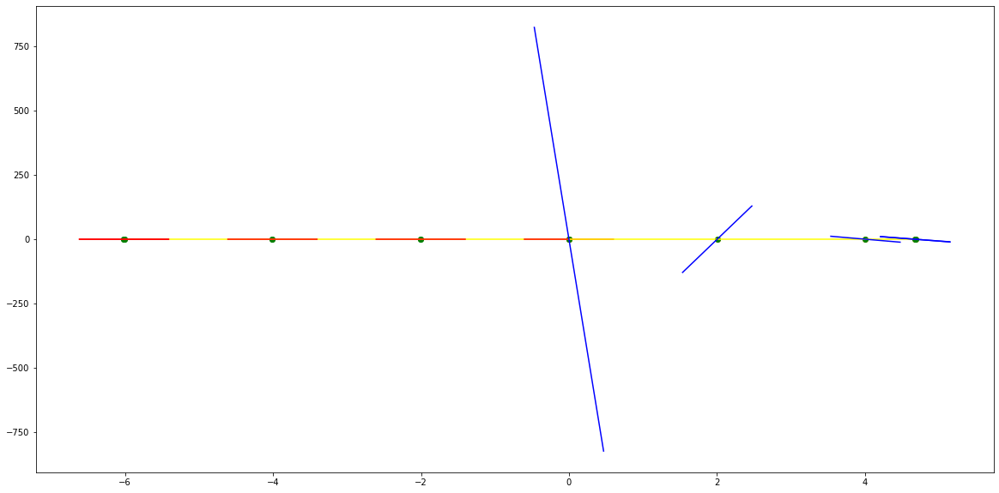

parameters (0.00019149311801492497, 0.005036658844427071, 0.04435269249957556, 0.15091643300833285, 0.16476942219650176, 0.0012698002727518731)
tangent[0]:-0.12880613583595685
tangent[1]:0.03239009854684466
tangent[2]:0.042431787265044874
tangent[3]:-0.05243668943645258
tangent[4]:0.16476942219650176
parameters (-26011.684788555576, 261665.72009546083, -982576.5536706022, 1631216.3862201504, -1009300.2450368367, 3.292722539913596e-09)
tangent[0]:-1009300.2450368367
tangent[1]:16475.32547784876
tangent[2]:-33.18052554503083
tangent[3]:-24.19807431846857
tangent[4]:-19.952663153409958


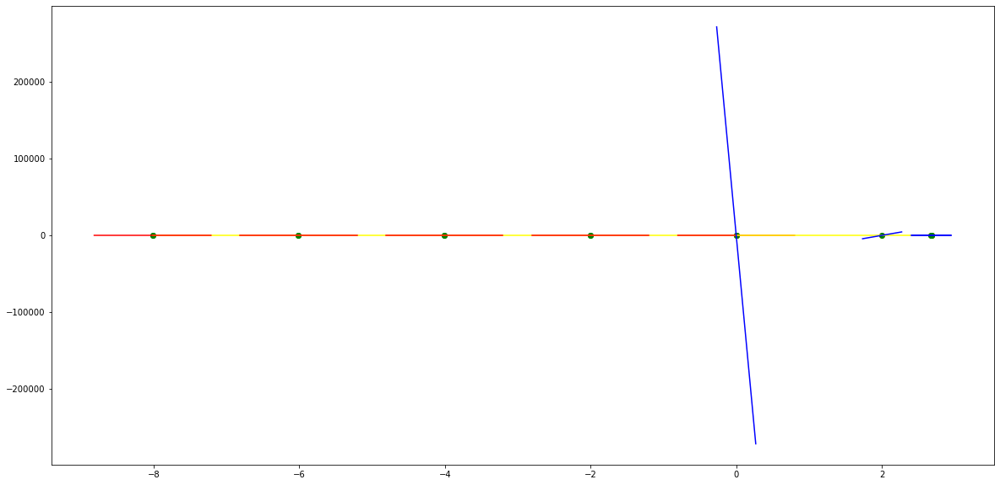

parameters (-0.00026215621919013744, -0.0063204283623780515, -0.052738074322974796, -0.17818681941908623, -0.20258611909301968, -0.0017688004081619284)
tangent[0]:0.09786460221116969
tangent[1]:0.0027200390462257806
tangent[2]:-0.026309557909431985
tangent[3]:0.05852212996435127
tangent[4]:-0.20258611909301968
parameters (3850248.841232036, -10594186.73155292, 10929767.373146603, -5010817.840838625, 861346.4261817873, 9.878167619740788e-10)
tangent[0]:861346.4261817873
tangent[1]:-41.88388550875243
tangent[2]:-22.47366301564034
tangent[3]:-16.78078012855258
tangent[4]:-29.47317269386258


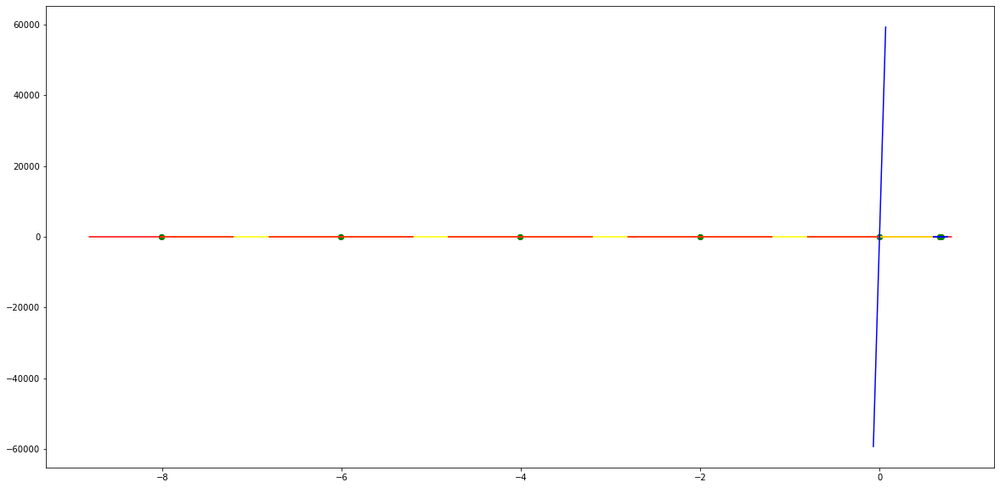

parameters (0.00014353312210839216, 0.0035457002610974194, 0.03142117076432356, 0.1160436256726154, 0.07270800492635815, -0.0003010911462915659)
tangent[0]:-0.09857080946123836
tangent[1]:-0.11575561662451533
tangent[2]:-0.1154746404934589
tangent[3]:-0.11457586907765221
tangent[4]:0.07270800492635815
parameters (16.104476210433802, -236.44885735939462, 1268.2167738093572, -2920.2683285211324, 2402.277748669069, -3.292722539913596e-10)
tangent[0]:2402.277748669069
tangent[1]:-335.6765393700566
tangent[2]:68.8436559577026
tangent[3]:-12.290708637232001
tangent[4]:-9.229532757675315


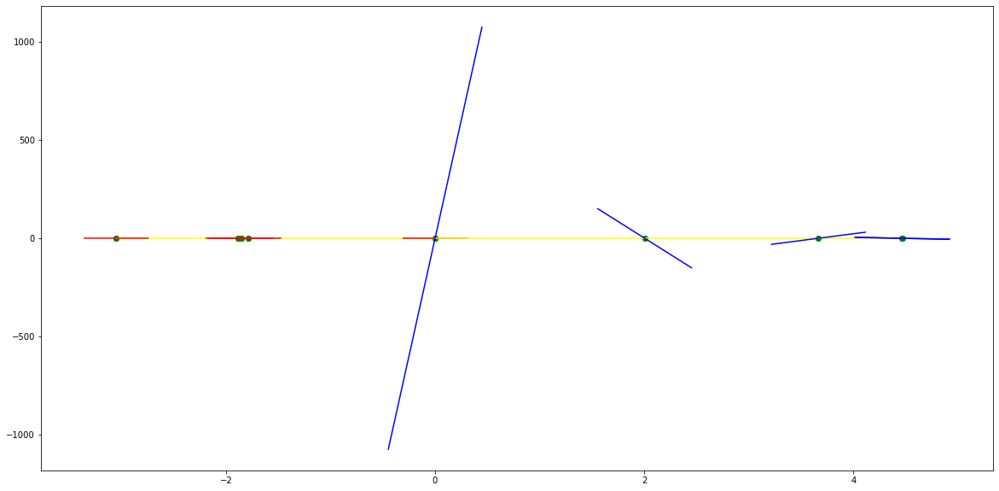

parameters (-0.0002718113039638519, -0.005861946192234931, -0.04293606574257349, -0.11451035364293206, -0.11247507682490766, 5.30786344159044e-05)
tangent[0]:-0.1016213016423755
tangent[1]:-0.10076406918514826
tangent[2]:-0.09853269053015525
tangent[3]:-0.004030821274297505
tangent[4]:-0.11247507682490766
parameters (1885.9841287213003, -17091.81004060484, 57623.428807277596, -85518.73222926083, 47038.50353329767, 3.910108016147395e-10)
tangent[0]:47038.50353329767
tangent[1]:-1624.2439576352335
tangent[2]:-8.977152409861446
tangent[3]:-9.952076169618522
tangent[4]:-9.491491815671907


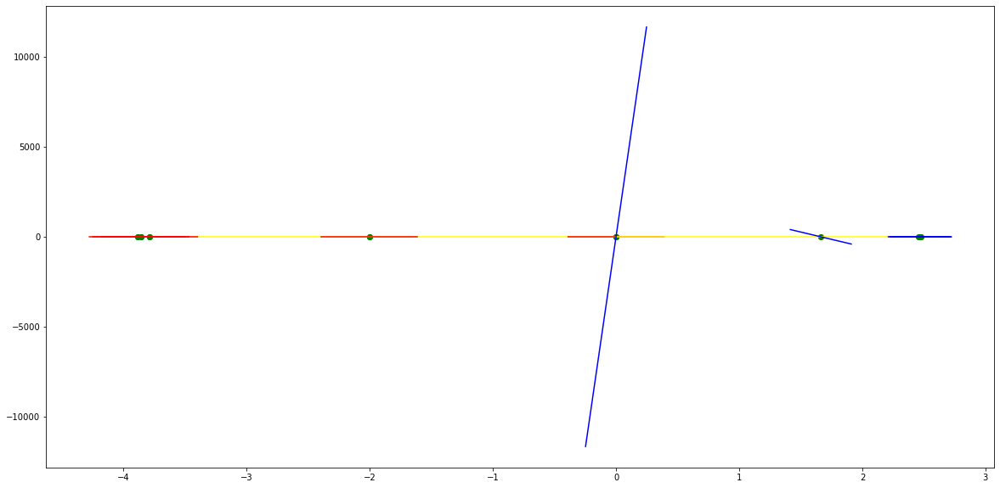

parameters (9.32969885552288e-05, 0.0013133091940201156, 0.003459615060227472, -0.008501549916792988, -0.05135596288861844, -5.245179437106351e-05)
tangent[0]:-0.09175114865679693
tangent[1]:-0.08924718682475163
tangent[2]:-0.02411998845009542
tangent[3]:-0.014977185158351225
tangent[4]:-0.05135596288861844
parameters (-901493.8530586888, 2962841.3530012774, -3650825.4809608753, 1998919.4320421596, -410330.2391955117, -1.0701348254719187e-09)
tangent[0]:-410330.2391955117
tangent[1]:10.618626710493118
tangent[2]:-16.57897810358554
tangent[3]:-16.056354851461947
tangent[4]:-12.70986443432048


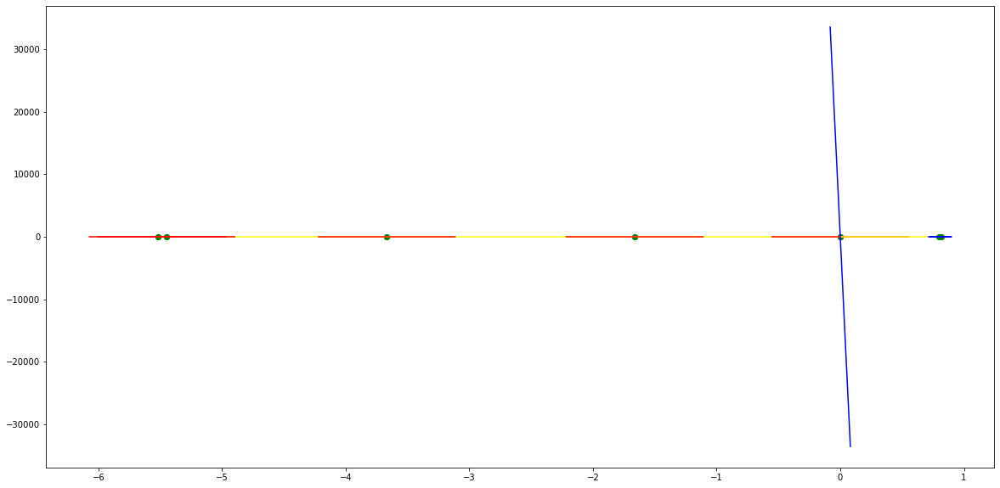

parameters (12.964309650700647, 81.65832428444264, 188.58393291702976, 189.10100833637608, 69.5223074264457, -2.423976766682062e-07)
tangent[0]:0.8510712738268467
tangent[1]:-0.7803885820018195
tangent[2]:-0.8737744836151933
tangent[3]:-0.968767765247037
tangent[4]:69.5223074264457
parameters (2.252768298951535e-06, -0.00010737083007408074, 0.0018877666053531252, -0.012518680843700374, -0.01597201098644427, -0.000130007289724599)
tangent[0]:-0.01597201098644427
tangent[1]:-0.04667903065717646
tangent[2]:-0.05024478239798466
tangent[3]:-0.040800412228926455
tangent[4]:-0.027862529633006117


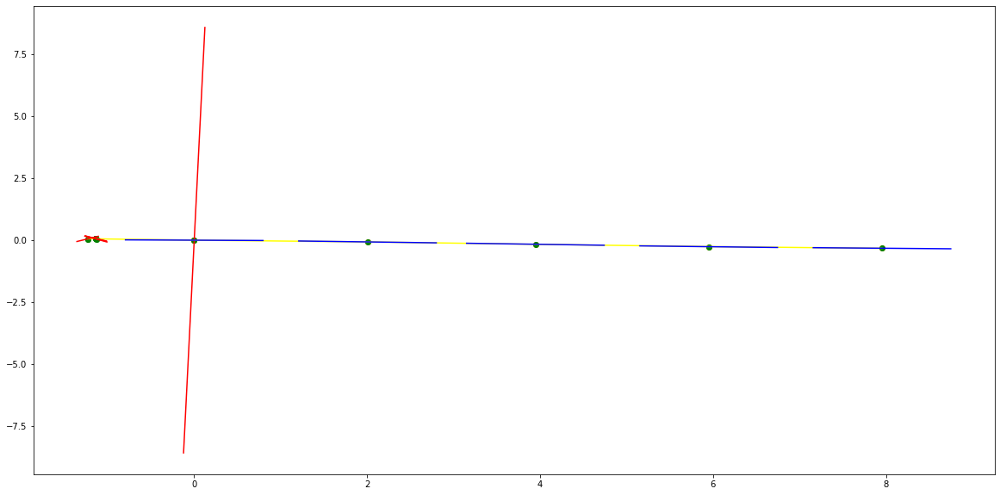

parameters (7.772279770778392e-06, 0.0004521472641103916, 0.008319141131843486, 0.04445878104128627, -0.16276742780411466, 0.0038698873561277833)
tangent[0]:-0.184992321766253
tangent[1]:-0.13748604666939254
tangent[2]:-0.22463729301944216
tangent[3]:-0.2546593019161475
tangent[4]:-0.16276742780411466
parameters (-3.251578389691542, 60.062073347347706, -395.7318096013487, 1083.2137094135933, -1012.7040240928404, 3.421859002025833e-08)
tangent[0]:-1012.7040240928404
tangent[1]:232.31163555134526
tangent[2]:-127.91836450263008
tangent[3]:67.92065221439543
tangent[4]:-100.88814696563213


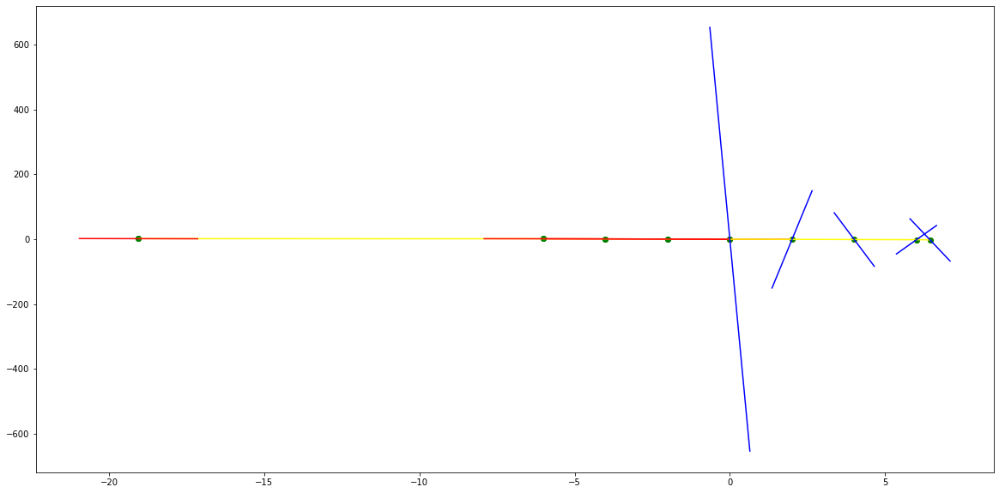

parameters (6.226025090803561e-06, 0.000401877763596382, 0.008416384210300182, 0.056186948162279995, -0.127859876117605, 0.018628759549758837)
tangent[0]:-0.10566356545976777
tangent[1]:-0.1994622668720444
tangent[2]:-0.26810956661318996
tangent[3]:-0.2640964209658898
tangent[4]:-0.127859876117605
parameters (24.348140003196917, -383.0598463990654, 2189.4070800321333, -5333.474575862903, 4585.595840490538, -3.910108016147395e-10)
tangent[0]:4585.595840490538
tangent[1]:-780.8310498049159
tangent[2]:107.43678774097316
tangent[3]:-97.14556876051392
tangent[4]:-99.85054029304047


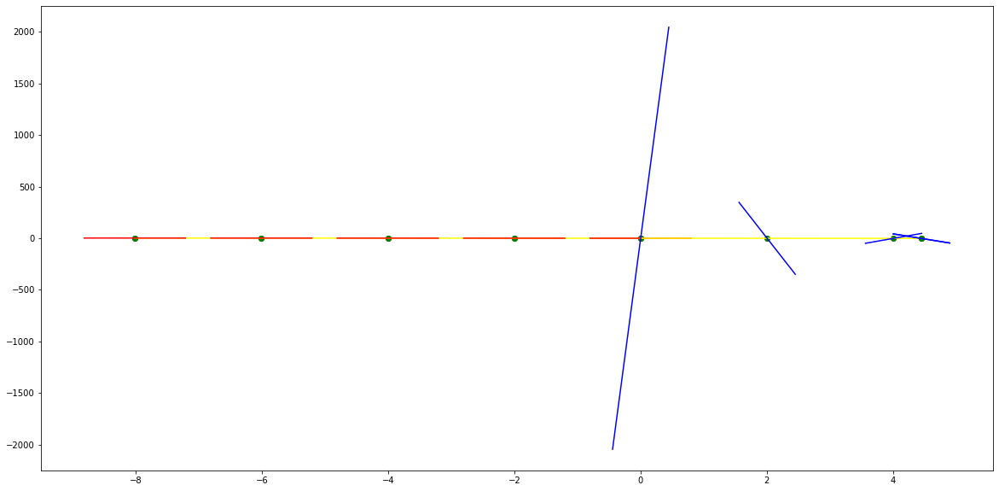

parameters (-4.8697011370982486e-06, -0.00022534962109952726, -0.003139291796278002, -0.020007755136814052, -0.29762739504216057, -0.001537574984425968)
tangent[0]:-0.21825312094473448
tangent[1]:-0.23338975897743763
tangent[2]:-0.23678091823543962
tangent[3]:-0.24839474969498035
tangent[4]:-0.29762739504216057
parameters (50843.5370735786, -476704.9130940225, 1672066.7810772785, -2599750.861115043, 1511397.1085449122, 4.609811555879035e-09)
tangent[0]:1511397.1085449122
tangent[1]:-9391.442904926836
tangent[2]:-67.81216014921665
tangent[3]:-102.91830331273377
tangent[4]:-112.43184280395508


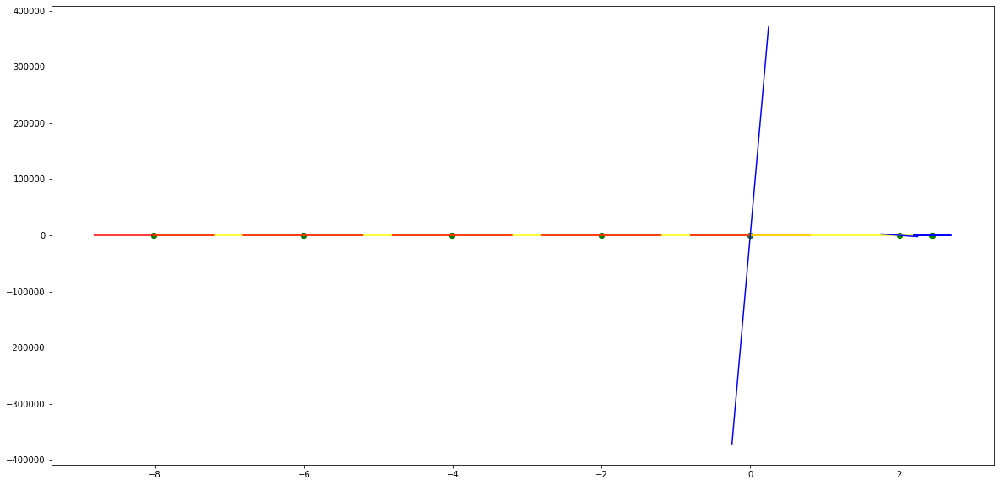

parameters (1.3918888270417341e-06, 5.493942740250436e-05, 0.0007807181442295892, 0.0014438741967016003, -0.26976632017853364, -0.0004050904516312133)
tangent[0]:-0.22686979456805828
tangent[1]:-0.24112977856852705
tangent[2]:-0.2560666722675378
tangent[3]:-0.2678029482013767
tangent[4]:-0.26976632017853364
parameters (-31112982.41663572, 56546963.722958095, -38531779.41608392, 11666703.183089506, -1324350.2874857092, -1.0701348254719187e-09)
tangent[0]:-1324350.2874857092
tangent[1]:37.8057711108122
tangent[2]:-135.81244690879248
tangent[3]:-138.8170687498059
tangent[4]:-115.98306996724568


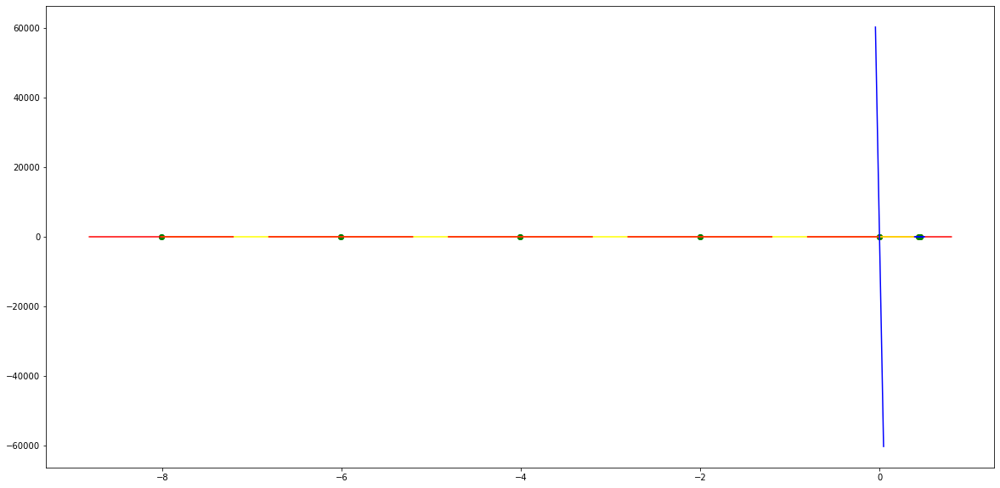

parameters (0.00046879807730636897, 0.009446308018261339, 0.0565132479996283, 0.11588919666373229, -0.5327911768583823, -0.00391277640482091)
tangent[0]:-1.241576163409292
tangent[1]:-0.9469912097088334
tangent[2]:-0.5662087246210276
tangent[3]:-0.5826838029998048
tangent[4]:-0.5327911768583823
parameters (3.457046862188309, -63.49809458602941, 416.4153200570182, -1135.7787545155309, 1058.4616248498041, 2.37996956209161e-07)
tangent[0]:1058.4616248498041
tangent[1]:-242.08153823007342
tangent[2]:129.2967107592558
tangent[3]:-55.87114120770457
tangent[4]:-50.83437690800929


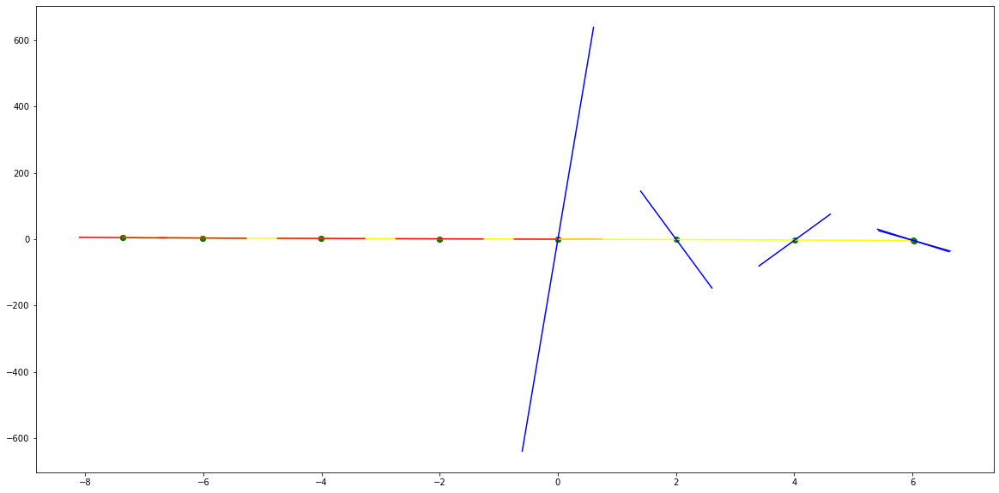

parameters (0.0005443235991654789, 0.014665109830627956, 0.13248101830856757, 0.46820128443395176, -0.07269939405745164, 0.006255671171764194)
tangent[0]:-1.0183895126628073
tangent[1]:-0.5285005079420584
tangent[2]:-0.5157230980840342
tangent[3]:-0.7813158087999392
tangent[4]:-0.07269939405745164
parameters (-83.58903052656999, 1212.1658148403692, -6447.178373190105, 14774.95064041523, -12125.254069759854, -1.625781754082338e-08)
tangent[0]:-12125.254069759854
tangent[1]:1698.0586995719914
tangent[2]:-65.14847149305024
tangent[3]:-54.53756283570874
tangent[4]:-45.17964566268529


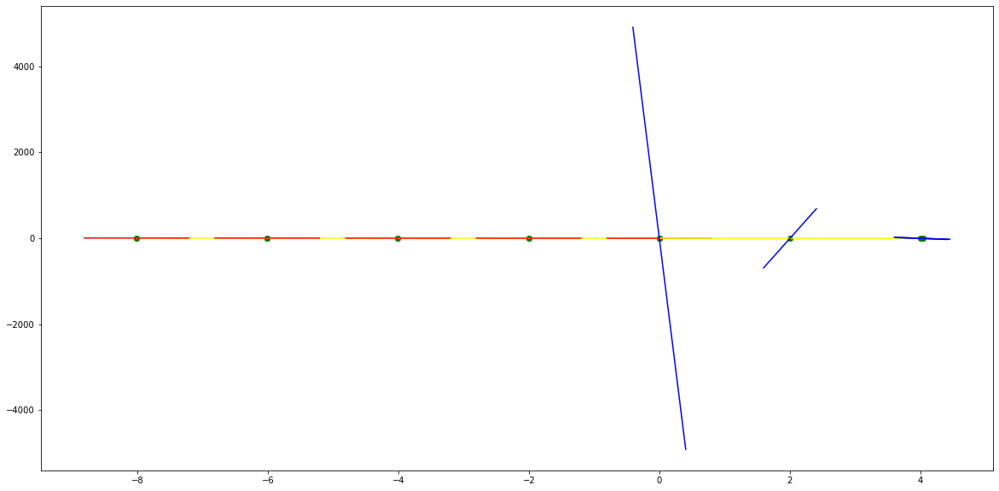

parameters (-0.00024001497463868279, -0.005838947735144597, -0.049401173514783445, -0.1702237363411488, -0.8059046455581423, -0.002293490852529253)
tangent[0]:-0.5247762789619345
tangent[1]:-0.6083961489195983
tangent[2]:-0.6280794631689163
tangent[3]:-0.5502230435144981
tangent[4]:-0.8059046455581423
parameters (-7004.14179387402, 58052.73876936338, -180283.38478608226, 248605.4484486493, -128433.51737302261, 1.4652615302615502e-08)
tangent[0]:-128433.51737302261
tangent[1]:-57.17781406802533
tangent[2]:-57.38143924517499
tangent[3]:-50.48856412152236
tangent[4]:-22.501607673228136


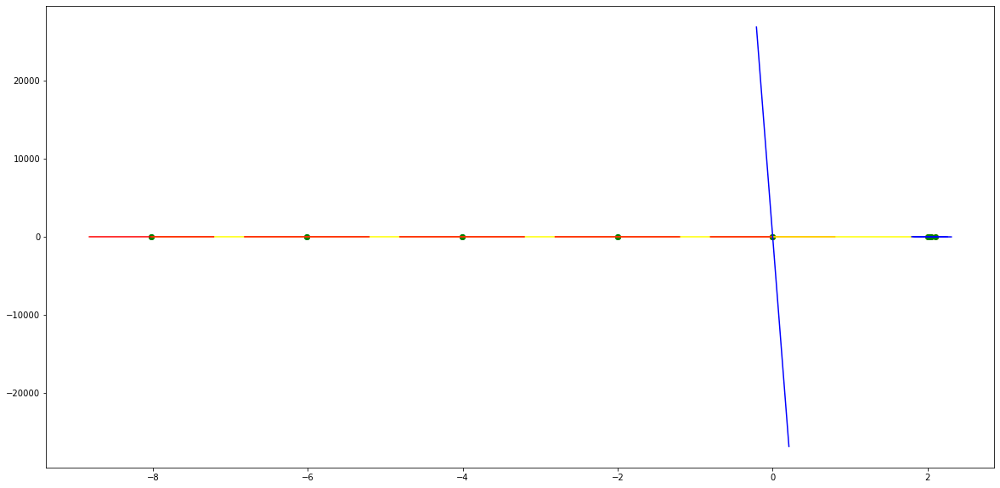

parameters (-4.08493063504934e-05, -0.0011418664575000544, -0.010978928156525233, -0.043144641842828194, -0.6698170941482153, -0.001748055379812111)
tangent[0]:-0.5852095206997737
tangent[1]:-0.6158373984605284
tangent[2]:-0.6117031065552283
tangent[3]:-0.5957023298508282
tangent[4]:-0.6698170941482153
parameters (-650503.4028079667, 296486.9903801445, -47332.75443166201, 3250.13593021304, -127.51795638036722, 0.07252548609718174)
tangent[0]:-127.51795638036722
tangent[1]:-43.61656376411368
tangent[2]:-27.212285976563834
tangent[3]:-41.00728364620616
tangent[4]:-16.405191262499358


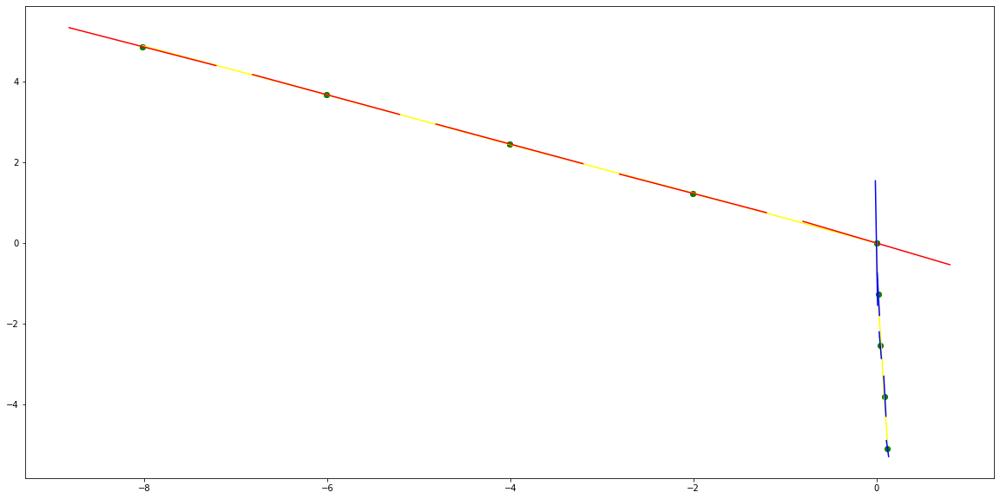

parameters (-21.742564102698218, -27.461258741367082, -11.671597902128338, -1.886588111891513, -38.697358004662135, -3.200233100702249e-05)
tangent[0]:-38.63849474125877
tangent[1]:-38.60352330186484
tangent[2]:-38.57121456643356
tangent[3]:-38.583185003496475
tangent[4]:-38.697358004662135
parameters (-2070872704.7913833, 187047890.24116394, -5855472.724744666, 73228.8517445956, -640.2704612269514, -0.04238621301801655)
tangent[0]:-640.2704612269514
tangent[1]:-284.02483708869886
tangent[2]:-345.7824430486354
tangent[3]:-413.9624266559068
tangent[4]:-398.61097099733763


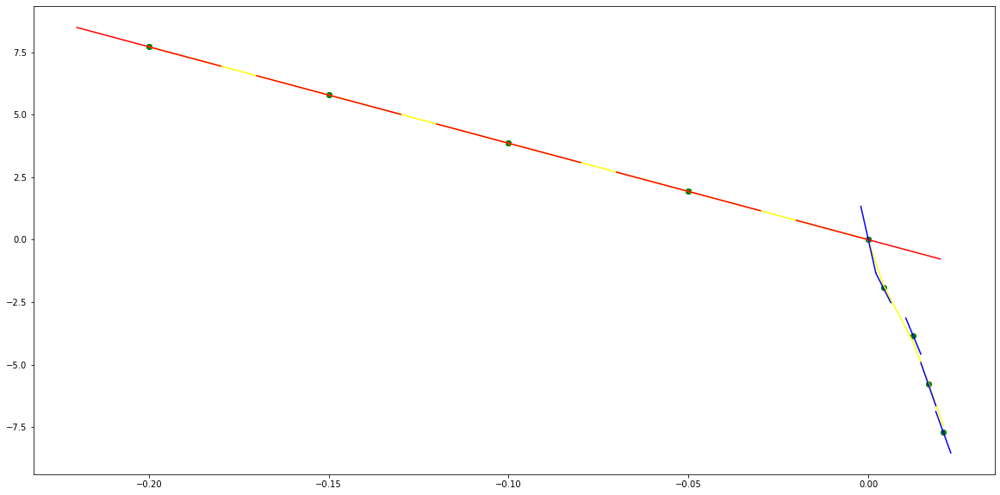

parameters (-23005939.814518984, -2435884.0061210617, -101418.62052671678, -2366.685280519453, -80.94057252333121, 0.00010272841925997734)
tangent[0]:-50.33317194075585
tangent[1]:-53.09141734693711
tangent[2]:-57.53986034859275
tangent[3]:-65.82936767149388
tangent[4]:-80.94057252333121
parameters (-58391.61468452847, 95832.2416890351, -52838.87859013555, 10011.48591679218, -125.89392173416637, 3.667822642540426e-05)
tangent[0]:-125.89392173416637
tangent[1]:-45.20173743804875
tangent[2]:-51.23414992040817
tangent[3]:-15.885987134866454
tangent[4]:-10.070192829303423


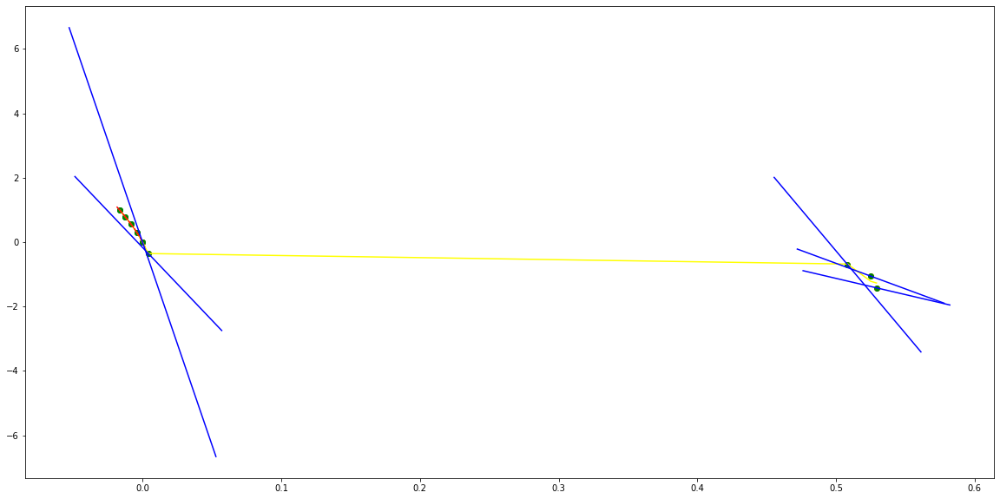

parameters (-131402.63768832, -216367.18231457745, -120162.57191766554, -23174.39176919501, -375.2218330845398, 3.697881758692027e-10)
tangent[0]:-66.46269153262705
tangent[1]:-78.23472159265015
tangent[2]:-92.91730032517529
tangent[3]:301.0902006600848
tangent[4]:-375.2218330845398
parameters (-32896253.125826627, 6924466.8491605725, -514073.6046306261, 14936.77473424371, -141.18842174542664, 8.319871866102461e-06)
tangent[0]:-141.18842174542664
tangent[1]:-41.54821290905052
tangent[2]:-70.7595443464765
tangent[3]:-68.83746865254733
tangent[4]:-61.97274021910488


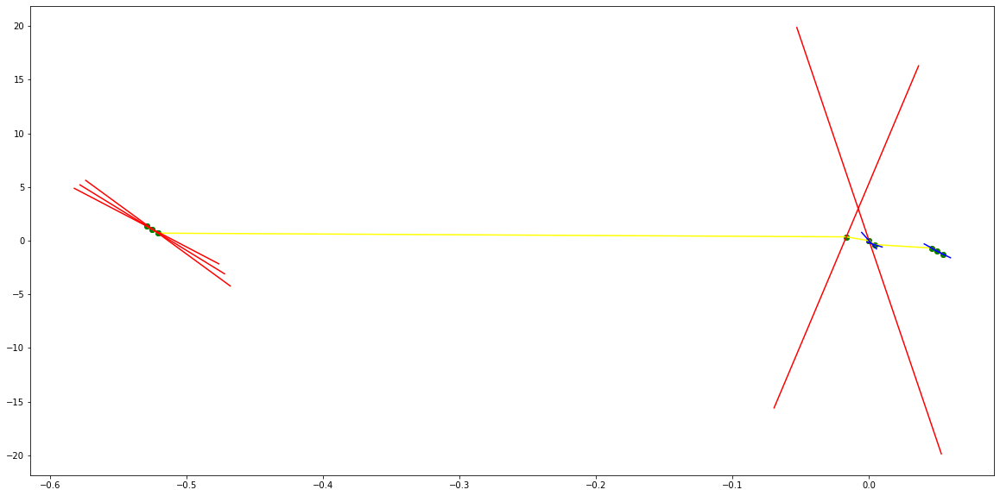

parameters (-1.021911775173283, -12.63418175819219, -56.78500636912949, -109.94862792305824, -77.50561884694032, -1.253127719850149e-07)
tangent[0]:-2.1415731882302254
tangent[1]:3.1789590183175704
tangent[2]:3.255494946222811
tangent[3]:3.3324129834419836
tangent[4]:-77.50561884694032
parameters (0.01451391806565395, -0.23849942495928142, 1.3930974281270099, -3.423914572534053, 2.922609409104133, -1.788959629445351e-07)
tangent[0]:2.922609409104133
tangent[1]:-0.5236466906752377
tangent[2]:0.07296857558777559
tangent[3]:-0.2935511710957823
tangent[4]:-0.45224511112553545


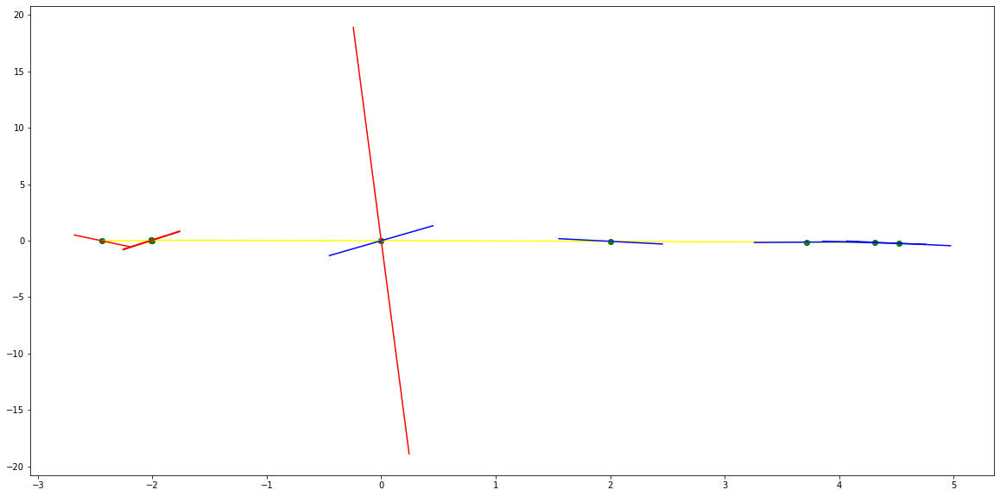

parameters (-1.15154761082569e-05, -0.0003072098024143956, -0.0022850462848251827, -0.011064491976675887, -0.17663937090896883, 0.0023805685804262323)
tangent[0]:-0.04449978109932237
tangent[1]:-0.09955560169303837
tangent[2]:-0.1338034934336724
tangent[3]:-0.15086078608326556
tangent[4]:-0.17663937090896883
parameters (-0.32089434903613817, 6.153685125408836, -41.77306678781517, 116.88544326659408, -111.0156661834095, -6.284405349176107e-08)
tangent[0]:-111.0156661834095
tangent[1]:26.39759380752743
tangent[2]:-16.42308605768595
tangent[3]:17.528337125227736
tangent[4]:-43.24516420829228


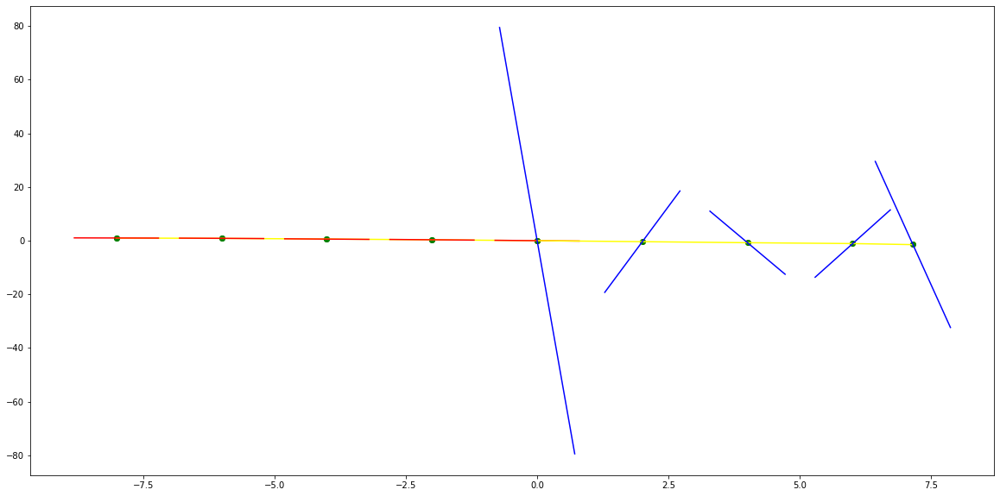

parameters (-1.686117758594888e-05, -0.0005794001259137703, -0.006558780180054113, -0.03472160727611808, -0.23955161024177876, -0.0016975298764822903)
tangent[0]:-0.10154710443526985
tangent[1]:-0.13976385907832936
tangent[2]:-0.14984194781553462
tangent[3]:-0.1621127164500648
tangent[4]:-0.23955161024177876
parameters (52.70339802852653, -863.5775766645836, 5128.085113824003, -12915.593237043648, 11388.496836326007, -6.173854762337992e-11)
tangent[0]:11388.496836326007
tangent[1]:-2143.853098062884
tangent[2]:587.0761991161362
tangent[3]:-63.915990052997586
tangent[4]:-56.41099240123549


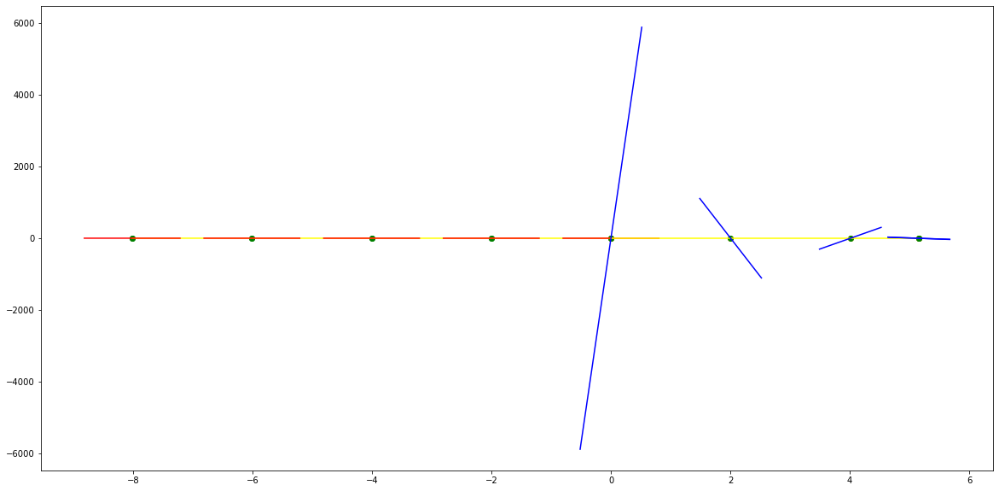

parameters (7.094652779086112e-06, 0.0002089322202178259, 0.002327250815307518, 0.006622168092558179, -0.1892997591493178, -0.0006095083475244471)
tangent[0]:-0.13083928353293245
tangent[1]:-0.1518302528756677
tangent[2]:-0.17487805967696132
tangent[3]:-0.19395550859535712
tangent[4]:-0.1892997591493178
parameters (-28555.477153796684, 328250.6430141269, -1400600.3917920466, 2622659.0883624232, -1812221.776033433, 0.0)
tangent[0]:-1812221.776033433
tangent[1]:89235.49003406451
tangent[2]:-88.60077290958725
tangent[3]:-59.387309873243794
tangent[4]:-40.593303587054834


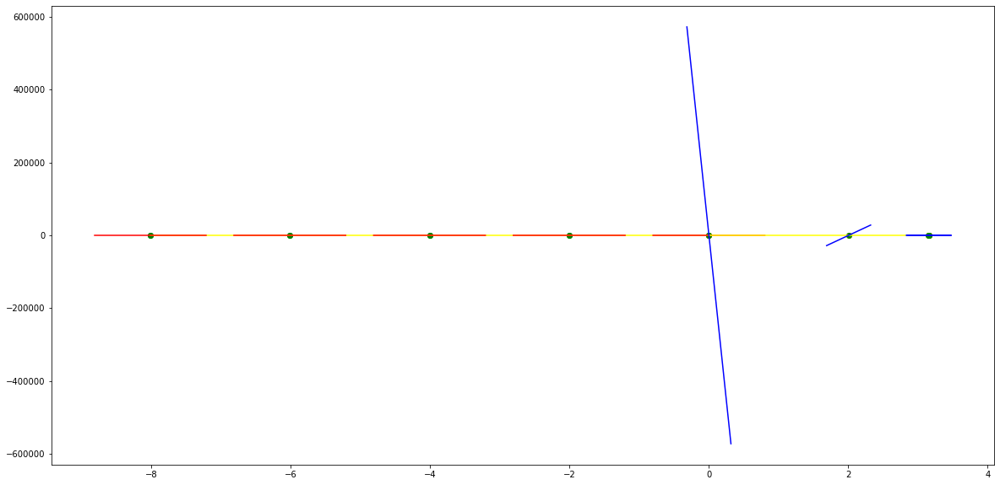

parameters (1.4472532288597652e-05, 0.0005348981652129428, 0.00738174902592744, 0.04185545037134567, -0.09774940259641361, 0.0011014776771669553)
tangent[0]:-0.14908167507240755
tangent[1]:-0.17098756626725453
tangent[2]:-0.19660061209901786
tangent[3]:-0.19262598982596785
tangent[4]:-0.09774940259641361
parameters (3650377.2577820816, -17001704.940868314, 29693522.52819179, -23047956.11353435, 6708400.789129738, 9.21962311175807e-09)
tangent[0]:6708400.789129738
tangent[1]:-102.0195942632854
tangent[2]:-56.45557711645961
tangent[3]:-35.67015938833356
tangent[4]:-40.37890028581023


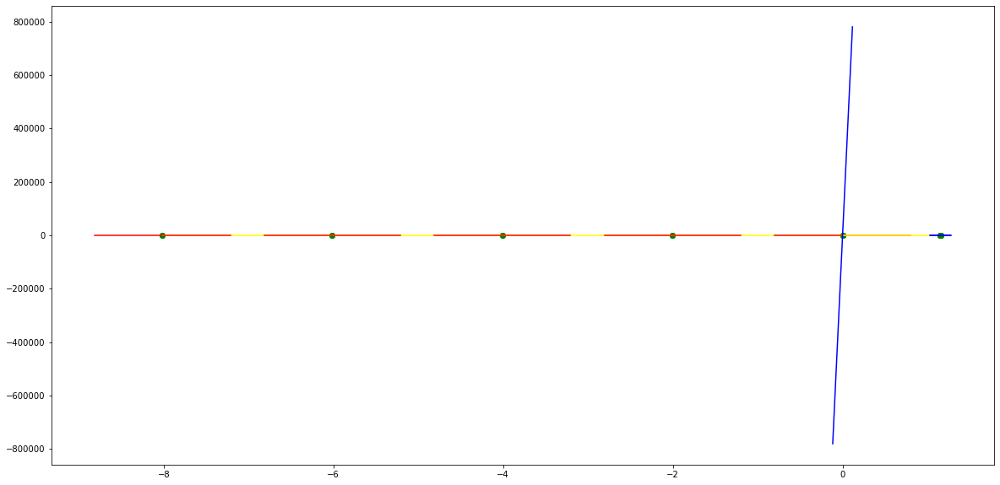

parameters (-4.3195247837774875e-05, -0.0014536078560623612, -0.017126031550243205, -0.08582073110269407, -0.35372612407154014, 0.00472681720124295)
tangent[0]:-0.1920892410274062
tangent[1]:-0.19023055260471944
tangent[2]:-0.16238367845945073
tangent[3]:-0.21613466122222907
tangent[4]:-0.35372612407154014
parameters (-101254867.68309402, 13139828.863870753, -572940.7161524876, 10260.748013748016, -112.55964720449057, 0.010565003019369005)
tangent[0]:-112.55964720449057
tangent[1]:-53.25049726392267
tangent[2]:-32.93563347551026
tangent[3]:-43.717958264822784
tangent[4]:-51.16250345723003


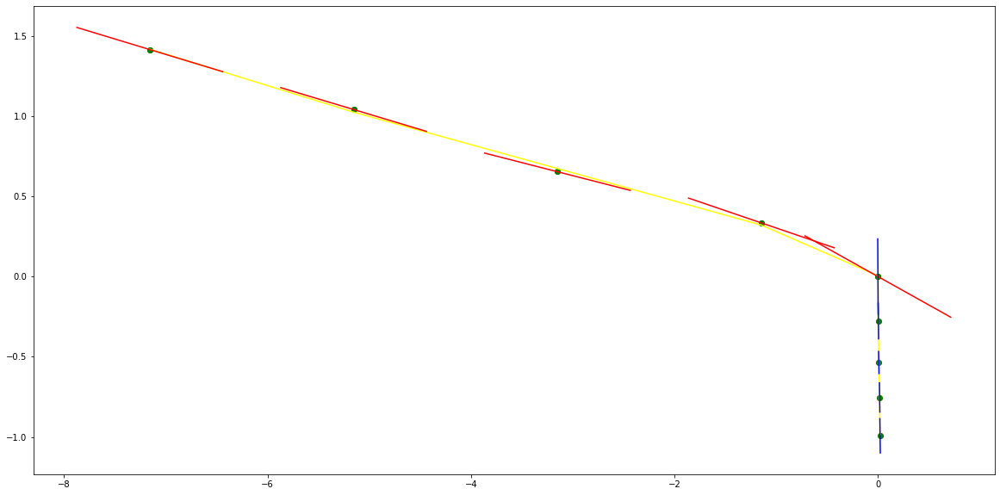

parameters (1094.521734193042, 2513.486890721363, 2147.5303399092513, 808.5015503416798, 113.05479654075401, -3.0219206295695373e-07)
tangent[0]:10.715667264567344
tangent[1]:4.065534538560712
tangent[2]:-0.4386853377994271
tangent[3]:-1.4503992081492356
tangent[4]:113.05479654075401
parameters (-2.9017696404209198e-06, 9.870306277806512e-05, -0.0011988242106946048, -0.002952309354537436, -0.05646242089130546, -0.0007377005041895799)
tangent[0]:-0.05646242089130546
tangent[1]:-0.07262875967116228
tangent[2]:-0.10715045898253317
tangent[3]:-0.1461240667325153
tangent[4]:-0.18320505551216454


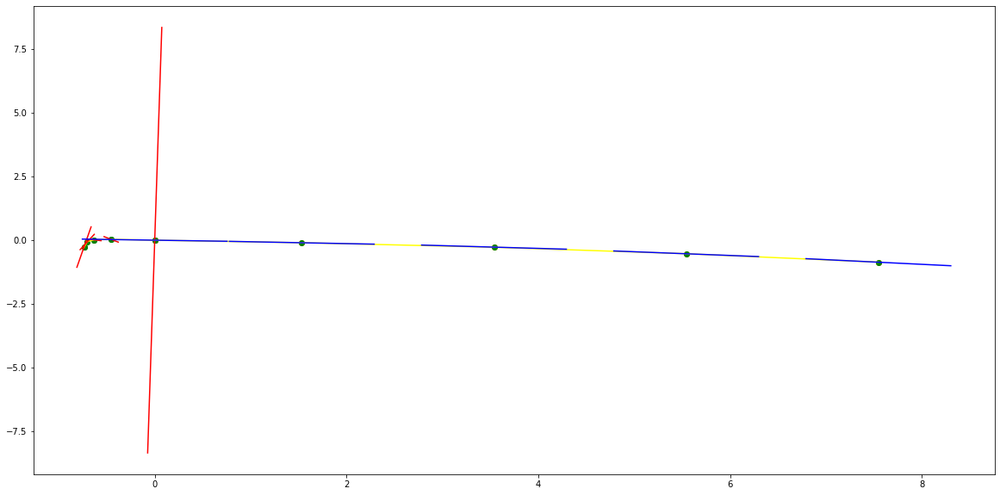

parameters (139.99227450349852, 1108.5143336724893, 3270.968572904667, 4259.123293507974, 2062.576120551025, 2.7765625573872966e-08)
tangent[0]:4.722077342438297
tangent[1]:-1.9802324600636894
tangent[2]:5.584885108750768
tangent[3]:-43.25179461918697
tangent[4]:2062.576120551025
parameters (2.889467921568476e-06, -0.00010690474489816823, 0.0013925188525098964, -0.016717727932153613, -0.05701741211538178, 1.9551424870151437e-05)
tangent[0]:-0.05701741211538178
tangent[1]:-0.11045700825620994
tangent[2]:-0.14772774246290848
tangent[3]:-0.18109268525484756
tangent[4]:-0.21722069678270722


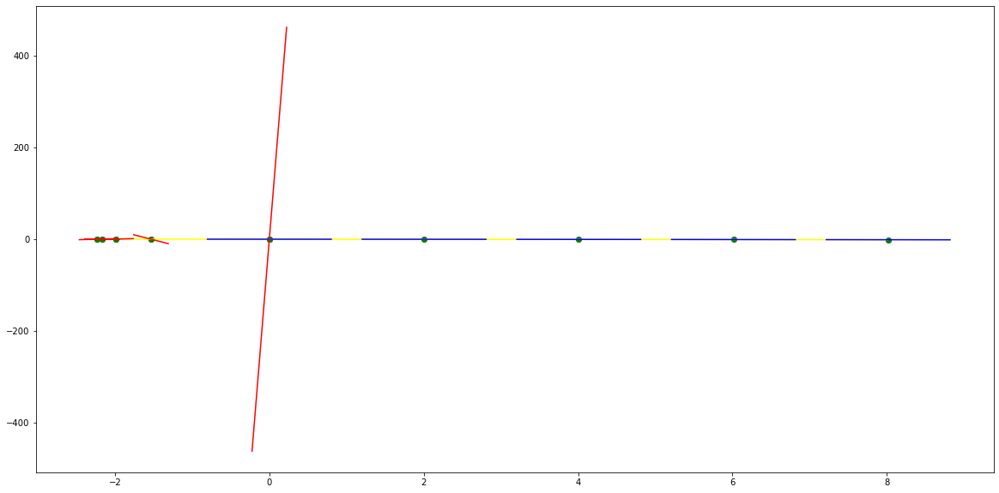

parameters (2.1727004255034634, 29.827287082744665, 150.35577118768694, 327.72029815316915, 257.84771856131334, 2.911921107502202e-07)
tangent[0]:1.7809447143836792
tangent[1]:-1.6232655528992268
tangent[2]:3.4711355854083763
tangent[3]:-29.151628114184575
tangent[4]:257.84771856131334
parameters (-7.562738186571148e-07, 2.8937176434389747e-05, -0.0004347286977780179, -0.006256789342652898, -0.11641111568085936, 0.00025538612946832595)
tangent[0]:-0.11641111568085936
tangent[1]:-0.1458581239533025
tangent[2]:-0.18104552740361135
tangent[3]:-0.21857885254765505
tangent[4]:-0.25652780446780266


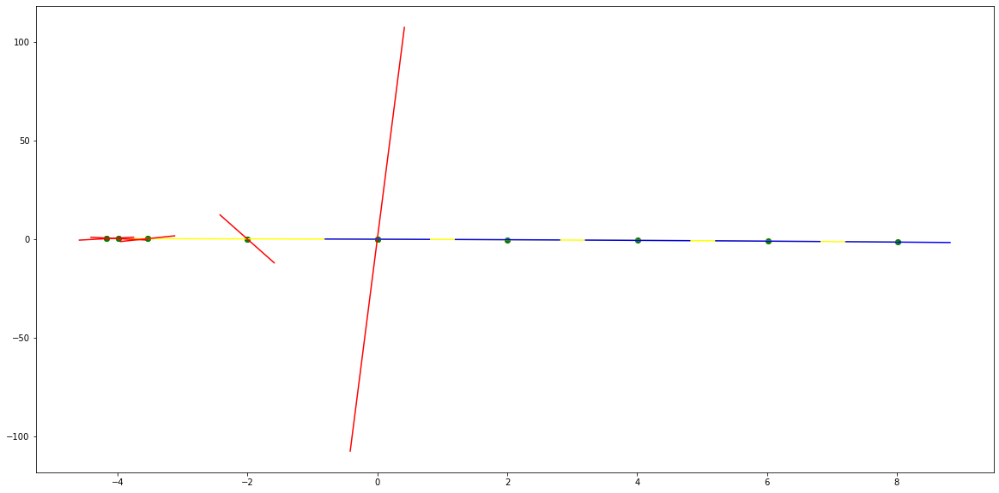

parameters (3.8856009644566865e-05, 0.001254409822341187, 0.013660692105582605, 0.04968132551364801, -0.7736144856106485, 0.002797246540583143)
tangent[0]:-0.7190768908091596
tangent[1]:-0.726230250985566
tangent[2]:-0.7864336198595865
tangent[3]:-0.8453998079506404
tangent[4]:-0.7736144856106485
parameters (0.32661448143528277, -6.132557747429038, 40.88293913105968, -112.82894131064069, 105.14218309969327, 7.724703444349534e-05)
tangent[0]:105.14218309969327
tangent[1]:-25.59560339917404
tangent[2]:12.990345446573869
tangent[3]:-15.93854012616022
tangent[4]:-15.57870885277886


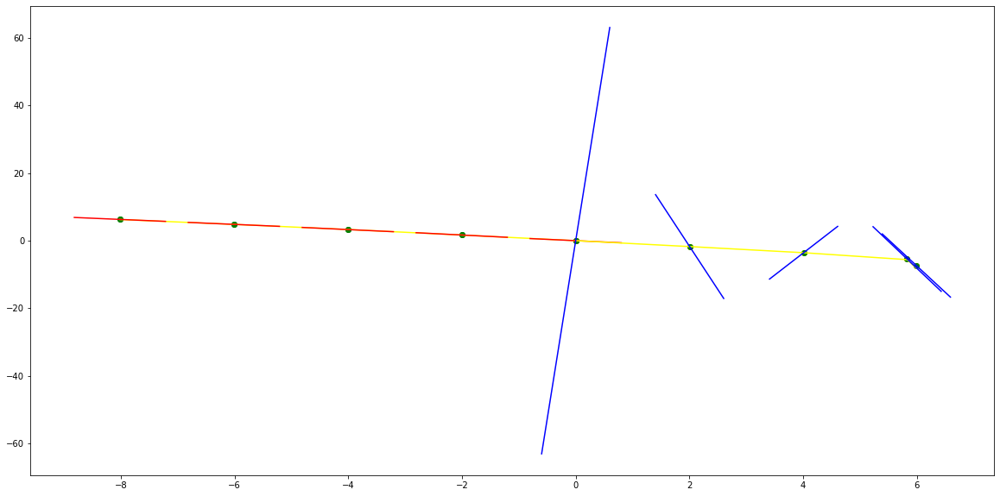

parameters (-1.840882548208124e-05, -0.0005325332826408046, -0.005290318534659546, -0.02942768673881307, -0.9139235710420474, -0.0008328332926363985)
tangent[0]:-0.7447830247691073
tangent[1]:-0.7910891083467342
tangent[2]:-0.8195839966850775
tangent[3]:-0.8440534245127376
tangent[4]:-0.9139235710420474
parameters (-2.759159771098469, 42.21700886694794, -235.90834644078504, 564.1670900646875, -479.35971523383284, -6.151659111357516e-06)
tangent[0]:-479.35971523383284
tangent[1]:76.12944704145355
tangent[2]:-20.78669787223805
tangent[3]:-14.30058969606705
tangent[4]:-14.13150585044275


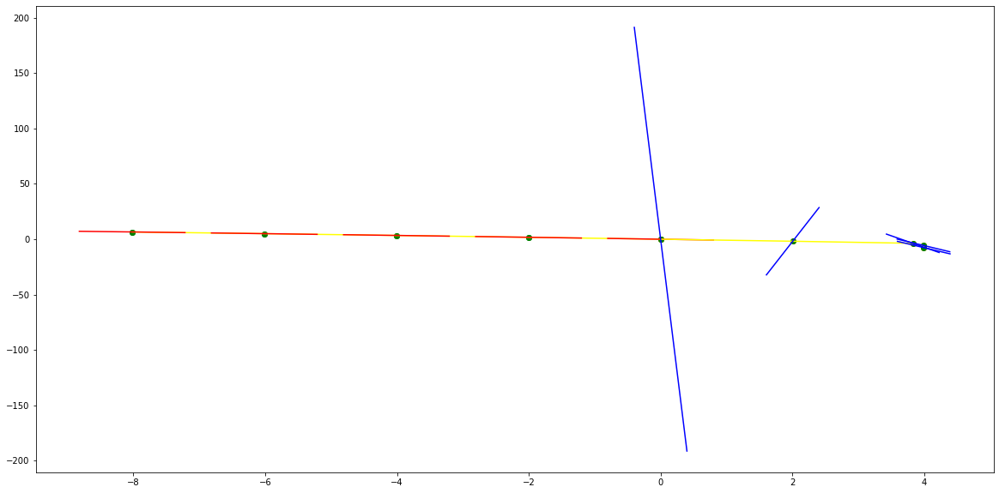

parameters (-1.2660128211605884e-06, -4.767634919623992e-05, -0.0006321058122436034, -0.01220180157882161, -0.9306427532305296, 3.566196184752038e-05)
tangent[0]:-0.7847697149328727
tangent[1]:-0.8192902478700103
tangent[2]:-0.8526450541263642
tangent[3]:-0.887917696248602
tangent[4]:-0.9306427532305296
parameters (11.17114667234985, -116.26601022527355, 446.8545507678377, -753.7213480864635, 468.9501139336907, 8.308520675420201e-06)
tangent[0]:468.9501139336907
tangent[1]:-24.852669835716426
tangent[2]:-11.555333533631313
tangent[3]:-11.286137262956402
tangent[4]:-13.189701816011222


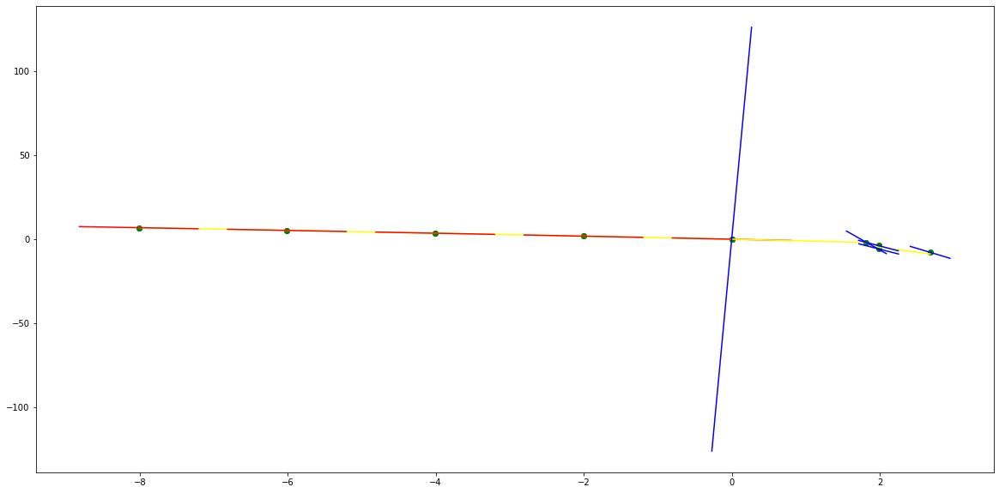

parameters (-0.0004400596100731621, -0.014417416163801468, -0.17166613736367728, -0.906386034925602, -2.9032873979033806, 0.6707242713040622)
tangent[0]:-0.9612003643287825
tangent[1]:-0.7633175158934189
tangent[2]:-0.9178863597288553
tangent[3]:-2.6220651861856283
tangent[4]:-2.9032873979033806
parameters (7.900080128082921, -56.71080384563864, 142.84662528910764, -147.9345608268137, 45.62042377203913, -1.0737745901487832)
tangent[0]:45.62042377203913
tangent[1]:44.394961859539976
tangent[2]:-19.826598892964498
tangent[3]:-19.394457235765955
tangent[4]:-12.996977417400231


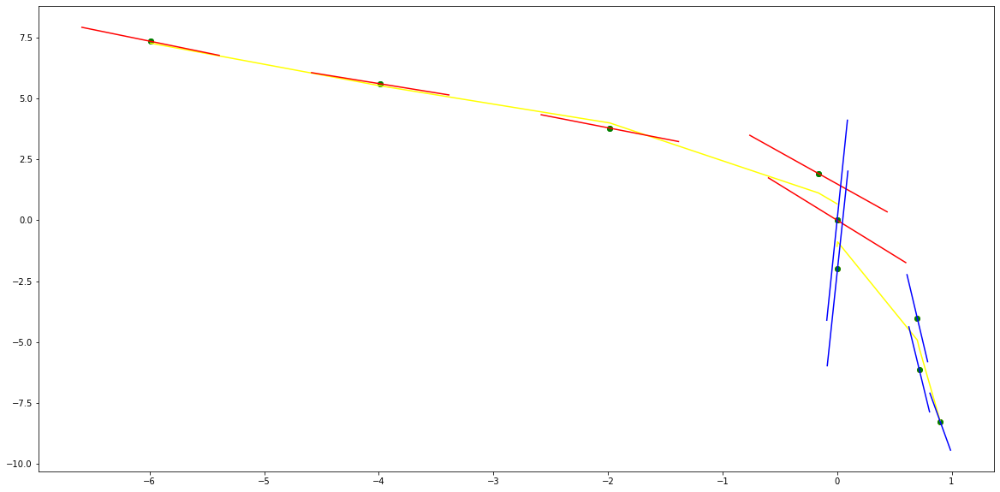

parameters (0.0376787655055028, 1.2267513454879204, 9.532309459336682, 27.908646450639345, 25.518934070438764, -0.0016843729498212182)
tangent[0]:-2.666729072616942
tangent[1]:-1.2810965297556827
tangent[2]:-6.678235832084081
tangent[3]:-7.945802213390987
tangent[4]:25.518934070438764
parameters (-16.425684626177592, 121.44385087657245, -287.720836757154, 235.99263453775546, -47.479082624709775, -0.006608075100398346)
tangent[0]:-47.479082624709775
tangent[1]:12.086144565653527
tangent[2]:-57.484005169808796
tangent[3]:-58.519038679815225
tangent[4]:101.70304828462022


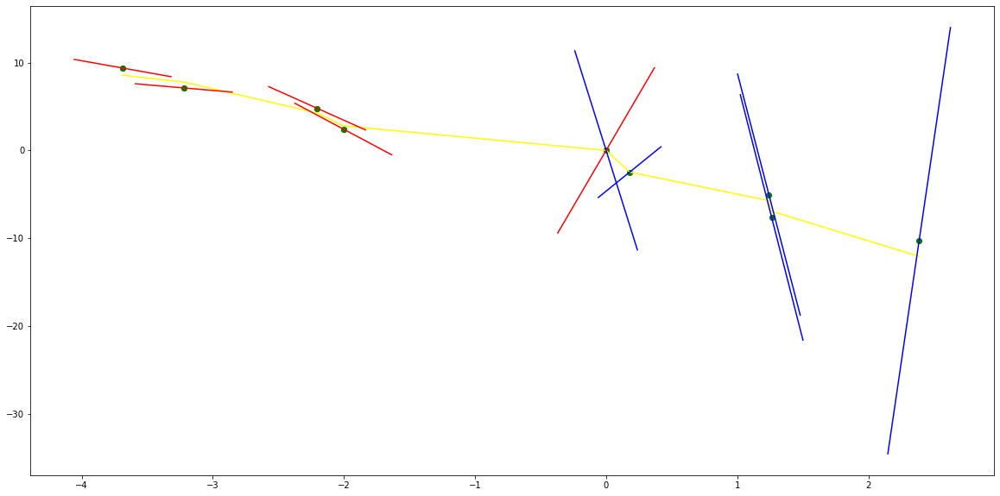

parameters (0.07787778802179383, 1.1150916506910367, 5.472764343909734, 10.422902483977264, 3.0183974392834947, -0.031139014797667345)
tangent[0]:-1.4632600050983577
tangent[1]:-0.9772690729223918
tangent[2]:-5.165489010131894
tangent[3]:-5.449352257255798
tangent[4]:3.0183974392834947
parameters (-286.6974090303244, 1572.0134367494163, -2830.772950222195, 1746.4863223910068, -159.91032252404915, -0.0015347307164295023)
tangent[0]:-159.91032252404915
tangent[1]:-90.77042237374295
tangent[2]:-318.66865002714525
tangent[3]:-317.1031547182824
tangent[4]:-465.1390832884703


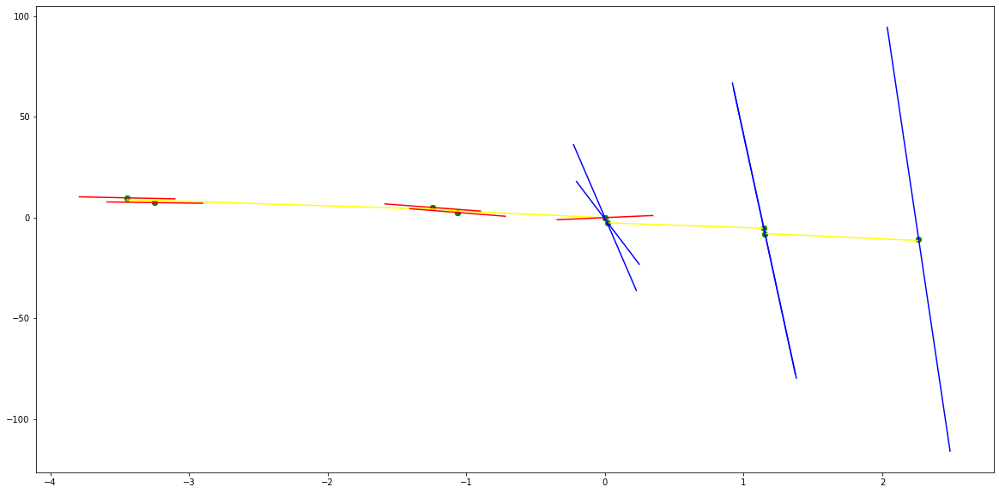

parameters (0.14899913886807897, 2.1001984024675497, 10.226851335292835, 19.658681377400587, 8.548473073951973, 0.007863659128962001)
tangent[0]:-0.5589756103013404
tangent[1]:-1.4105063008378043
tangent[2]:-7.575092706087139
tangent[3]:-7.6214310251313595
tangent[4]:8.548473073951973
parameters (-886989.326885928, 3012275.0085494583, -3418854.1138309473, 1306469.354149974, -10976.855653791958, -3.292722539913596e-10)
tangent[0]:-10976.855653791958
tangent[1]:10091.508946380301
tangent[2]:-902.6719598744894
tangent[3]:-627.3161822192269
tangent[4]:-461.9824857872809


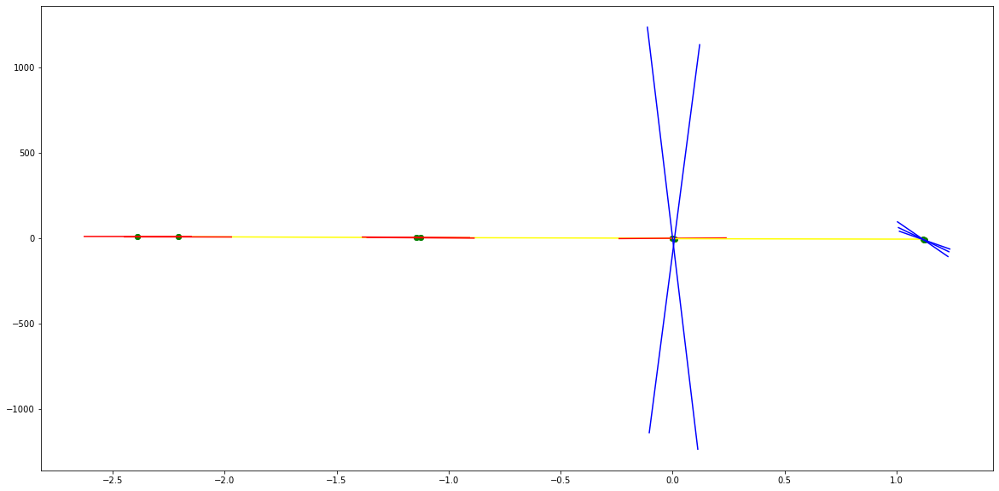

parameters (-4063539550.4607816, -367854150.99954045, -11554641.533827223, -145519.94658342178, -1277.0349437676205, 0.08334447003596483)
tangent[0]:-781.3594486327047
tangent[1]:-810.8525190219707
tangent[2]:-677.4514862605342
tangent[3]:-565.8333009228372
tangent[4]:-1277.0349437676205
parameters (-14636248.364198368, 4596777.399956394, -511300.8590426666, 24302.69397499161, -702.885218004526, -0.5069343614714608)
tangent[0]:-702.885218004526
tangent[1]:-525.6727396876494
tangent[2]:-203.5564256702237
tangent[3]:-212.31970050637324
tangent[4]:-278.38994025976126


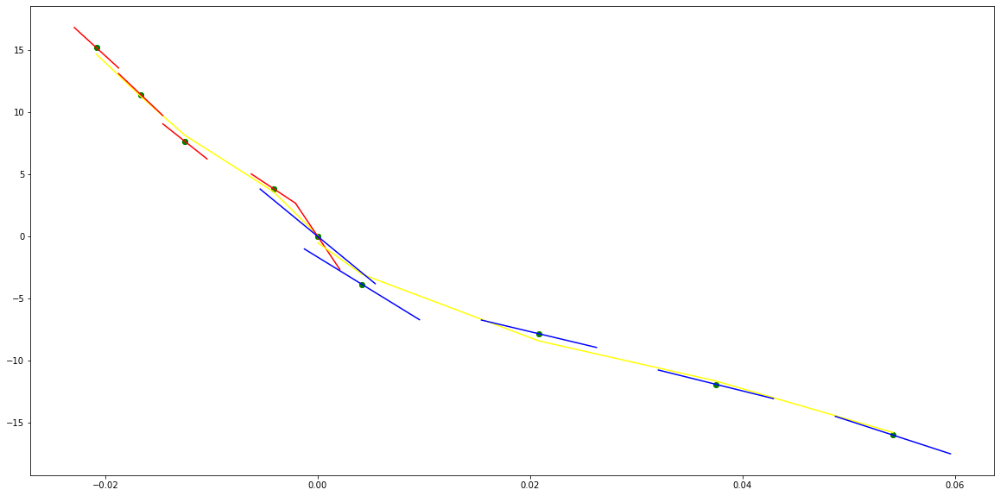

parameters (298047.2014666053, 164753.96410591548, 26882.148608958247, 1514.5030105894461, -151.78410183243852, -0.012495236963724596)
tangent[0]:-155.7320707407547
tangent[1]:-156.19361140389583
tangent[2]:-178.07522897216037
tangent[3]:-186.82022303636938
tangent[4]:-151.78410183243852
parameters (-11079416.86071465, 4586246.929418097, -682783.3807983531, 43803.74813397374, -1270.3687164275411, -0.0932902860166223)
tangent[0]:-1270.3687164275411
tangent[1]:-939.5649489057857
tangent[2]:-672.2226811742876
tangent[3]:-95.39920169321863
tangent[4]:-216.9668852249365


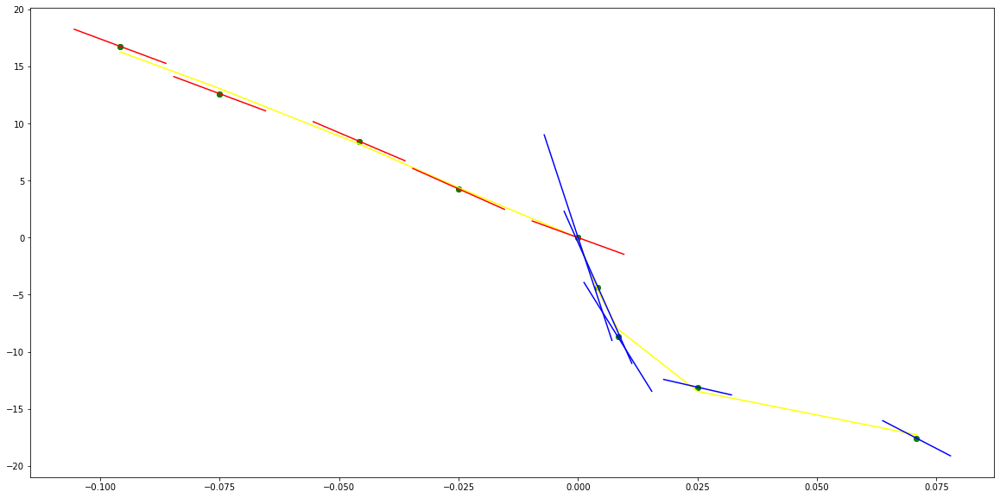

parameters (-1.415647530647473e-06, -6.501476144479308e-05, -0.0008315652401772337, -0.010508562038029176, -0.36550942110871293, 3.1082157038016466e-05)
tangent[0]:-0.2525992748700797
tangent[1]:-0.2820531173584788
tangent[2]:-0.30642654902231115
tangent[3]:-0.3314286975140042
tangent[4]:-0.36550942110871293
parameters (-0.3533949963362355, 6.587930734920665, -43.71343630524155, 120.22996475892964, -113.08538731528525, 2.9280149320259007e-06)
tangent[0]:-113.08538731528525
tangent[1]:25.71340314970415
tangent[2]:-15.357155437924078
tangent[3]:10.652918927178732
tangent[4]:-21.624874404312507


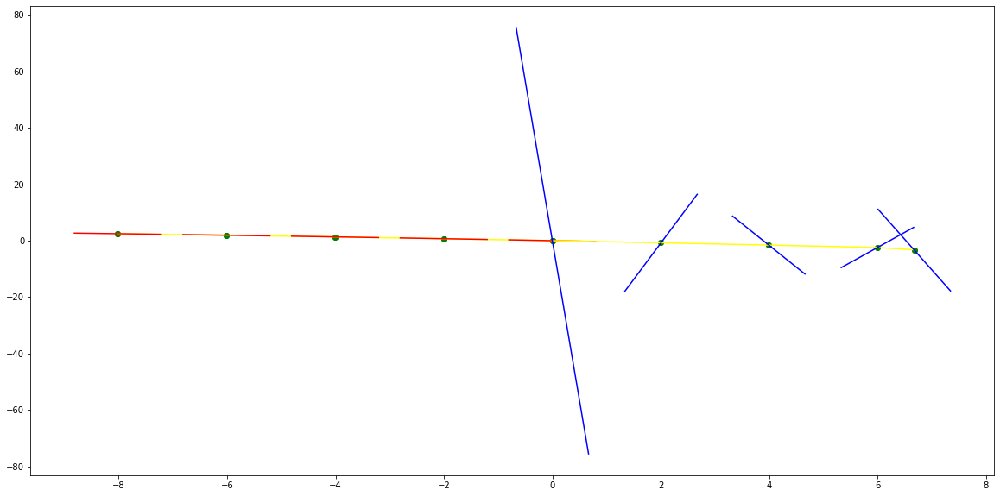

parameters (1.879989450546487e-07, -1.0121907550051581e-05, -0.00029823314449679546, -0.009009106557593273, -0.3931433447899142, -0.00020159130214413476)
tangent[0]:-0.2814550429098131
tangent[1]:-0.3071238455018726
tangent[2]:-0.33244515720120776
tangent[3]:-0.3602844822785162
tangent[4]:-0.3931433447899142
parameters (5.531461201041393, -87.50917717269208, 502.8808059078953, -1230.1906735866653, 1058.8572631348877, -1.6648056610592828e-07)
tangent[0]:1058.8572631348877
tangent[1]:-188.33577084869125
tangent[2]:34.46834738555913
tangent[3]:-25.088563534916148
tangent[4]:-23.894600638957172


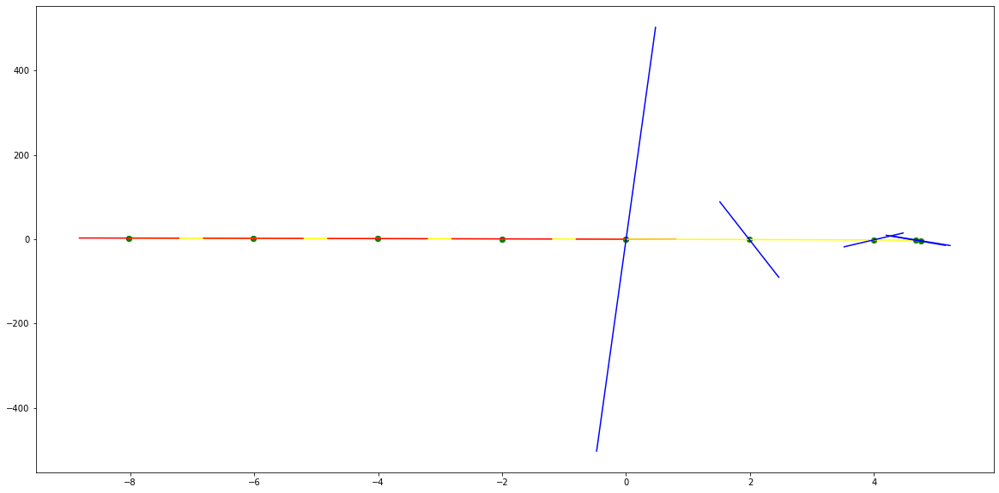

parameters (2.0377371706735893e-06, 6.008128551926312e-05, 0.0005472921647319034, -0.005532656063814714, -0.41872605492351117, 0.00012852726880662428)
tangent[0]:-0.30643707776200607
tangent[1]:-0.3319890673658711
tangent[2]:-0.36109459166132507
tangent[3]:-0.3919758740273779
tangent[4]:-0.41872605492351117
parameters (-512.7130814315484, 5308.586015463191, -20499.630977825163, 34954.93142758247, -22178.08238694811, 4.883519117009352e-08)
tangent[0]:-22178.08238694811
tangent[1]:490.0706290861999
tangent[2]:-37.859362790884916
tangent[3]:-15.630390476435423
tangent[4]:-15.288256241969066


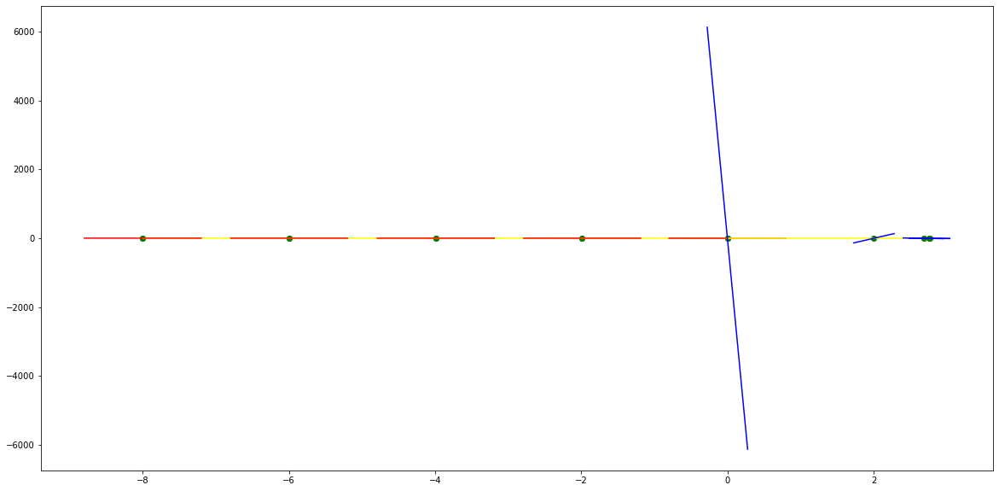

parameters (1.3862984950218366e-06, 5.717849777208453e-05, 0.000811141916774859, -0.00230003441937133, -0.4360618728386703, -6.933446327016168e-05)
tangent[0]:-0.332232244367138
tangent[1]:-0.36134001919848
tangent[2]:-0.3917138530887423
tangent[3]:-0.41879760242161385
tangent[4]:-0.4360618728386703
parameters (-365570.45131543156, 1156948.3530461462, -1368733.9937606852, 717287.3368757706, -140470.92251691638, 1.798649687427802e-08)
tangent[0]:-140470.92251691638
tangent[1]:662.878793923679
tangent[2]:-261.595159245393
tangent[3]:-250.16688235171023
tangent[4]:-235.14444177501719


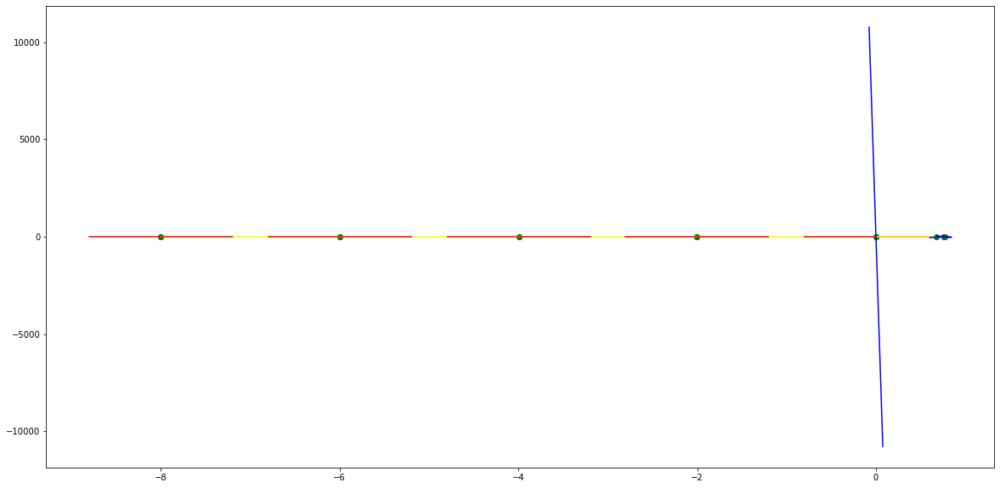

parameters (-1.7371225082319357e-05, -0.0005262774730004778, -0.005502156175100445, -0.02716668258011713, -1.339413856079261, -0.0013602505579932461)
tangent[0]:-1.2388316650068956
tangent[1]:-1.2654008747745822
tangent[2]:-1.2736829001809626
tangent[3]:-1.2812769626364218
tangent[4]:-1.339413856079261
parameters (-8.742528477391861, 163.51471955084767, -1088.3659296411204, 3001.9621193610246, -2821.383836598364, -2.874340982185825e-07)
tangent[0]:-2821.383836598364
tangent[1]:656.6079292367021
tangent[2]:-377.1634895072302
tangent[3]:279.7949801133118
tangent[4]:-497.4368670203503


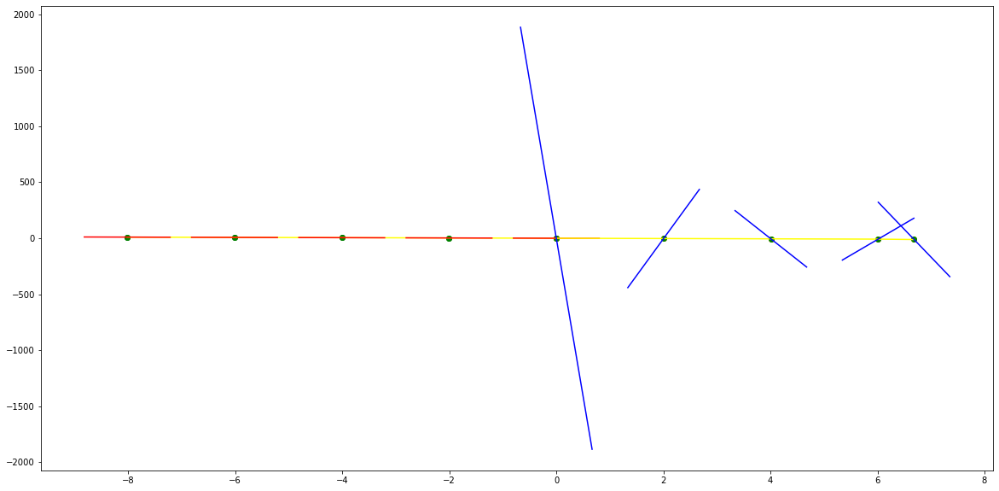

parameters (4.280748598444617e-06, 0.00013920489135826463, 0.001601702368432295, 0.003603017090550494, -1.3099461932647136, 0.0002537158243491172)
tangent[0]:-1.2573795698914676
tangent[1]:-1.2726222660911708
tangent[2]:-1.2919624677058157
tangent[3]:-1.309224820689575
tangent[4]:-1.3099461932647136
parameters (816.5110073511202, -12627.661664098132, 71204.3526893904, -171661.8668620721, 146512.879128027, 2.6341780319308768e-09)
tangent[0]:146512.879128027
tangent[1]:-24298.015294105106
tangent[2]:3364.580488115782
tangent[3]:-653.8951260687318
tangent[4]:-607.2903961227275


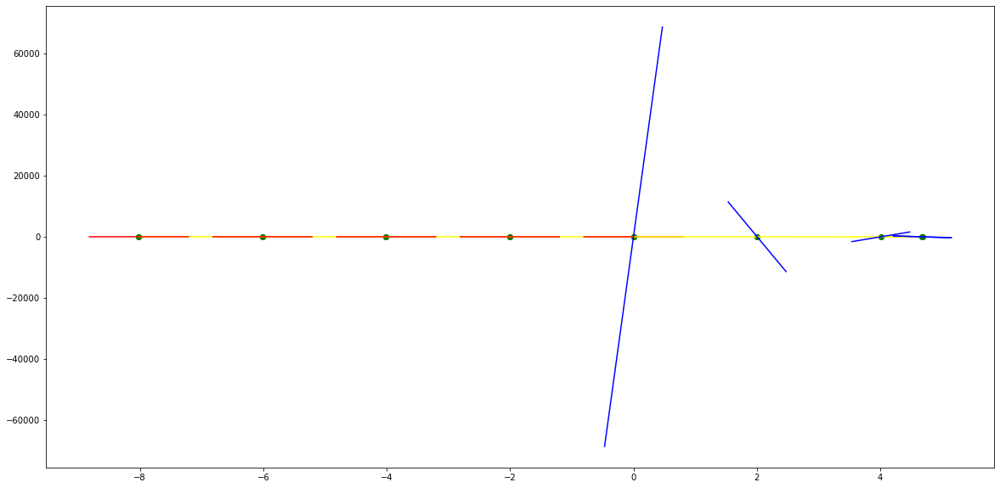

parameters (-6.507989963341252e-07, -1.5454483420775264e-05, -5.090689605255436e-05, -0.003020564769658088, -1.3314835346110079, 0.0001411943485211787)
tangent[0]:-1.274459479531728
tangent[1]:-1.291498248742666
tangent[2]:-1.306581258837127
tangent[3]:-1.3195443972876288
tangent[4]:-1.3314835346110079
parameters (-618220.4456189843, 6223375.029362596, -23385047.23727782, 38847412.07820289, -24050947.302949827, -2.0019753042674663e-07)
tangent[0]:-24050947.302949827
tangent[1]:395589.6945728846
tangent[2]:-914.585998993367
tangent[3]:-637.0619191937149
tangent[4]:-470.66893837973475


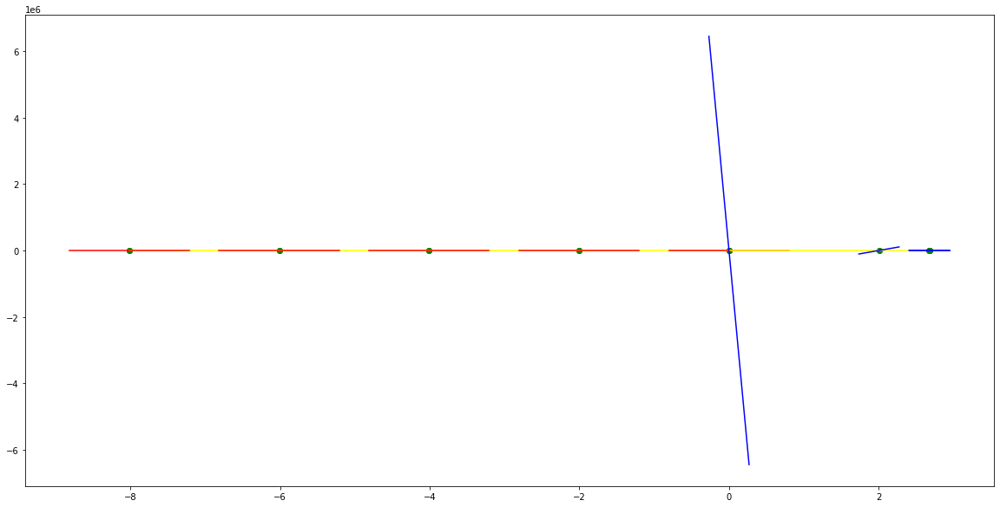

parameters (-4.542182702774614e-06, -0.0001738401475815143, -0.002392221772755553, -0.018090177666552527, -1.386224461916765, -1.8447359560148797e-05)
tangent[0]:-1.292948073548032
tangent[1]:-1.3066684560570005
tangent[2]:-1.317587921092405
tangent[3]:-1.3373080786842497
tangent[4]:-1.386224461916765
parameters (102098766.86240457, -280604100.6440255, 289173374.3851232, -132434809.03386131, 22742676.896500956, 1.0536712127723507e-08)
tangent[0]:22742676.896500956
tangent[1]:-1121.0000144131482
tangent[2]:-587.4192031212151
tangent[3]:-394.22994359210134
tangent[4]:-573.4986547417939


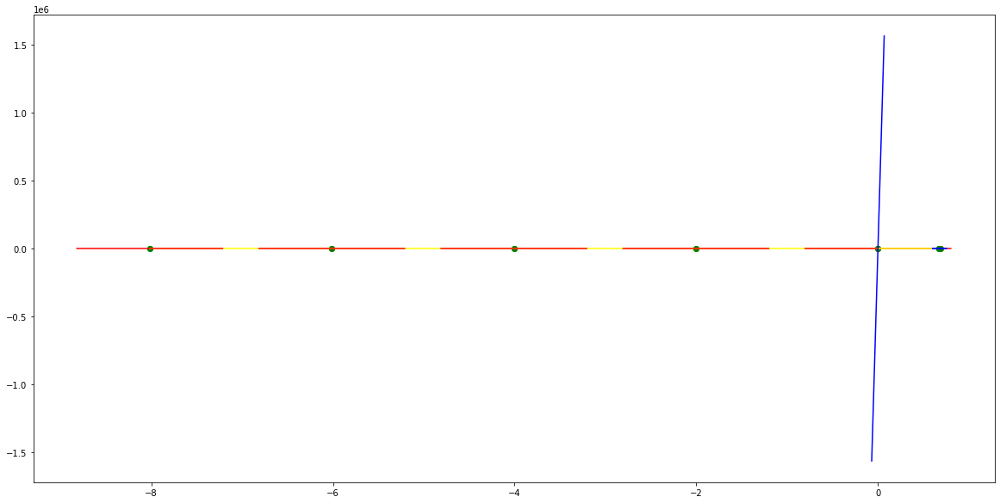

parameters (36.659440131423665, 153.11271834139754, 237.17066379465544, 160.5749287373964, 41.48365131379197, -0.04454996904320057)
tangent[0]:7.354416797258892
tangent[1]:2.4305485389224657
tangent[2]:-2.3664517129832348
tangent[3]:37.57926012592807
tangent[4]:41.48365131379197
parameters (592551.3888011695, -318352.727435872, 60960.09381504974, -4879.454051487753, 150.55965047751843, 0.029395940830796954)
tangent[0]:150.55965047751843
tangent[1]:112.97854854386858
tangent[2]:81.21511933781758
tangent[3]:2.147405272859345
tangent[4]:26.522923527340623


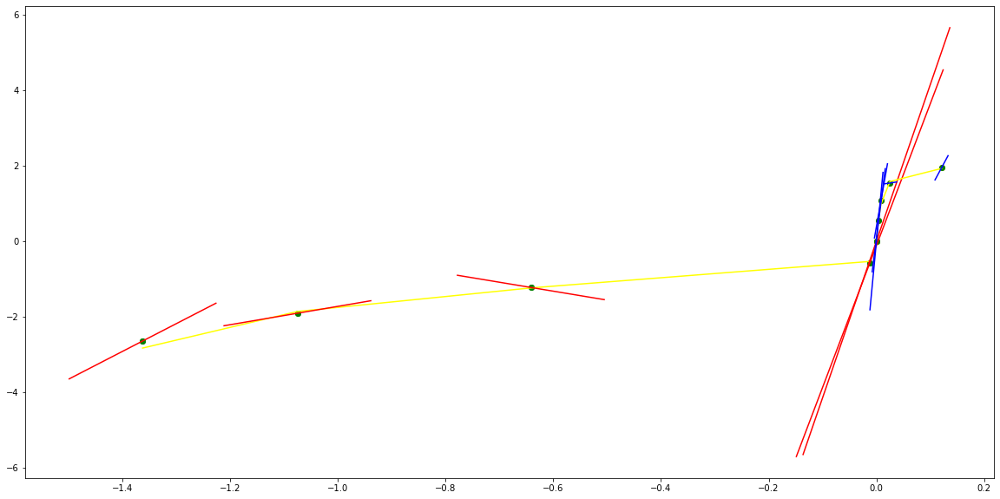

parameters (0.0001377791190635729, 0.004564295223373734, 0.05216119643232631, 0.23111310141776226, -0.644719461469347, -0.0001469216432864815)
tangent[0]:-0.8399789909008701
tangent[1]:-0.8485082719869075
tangent[2]:-1.0076536720342397
tangent[3]:-1.0784103936367866
tangent[4]:-0.644719461469347
parameters (-0.5460642195968951, 10.225776232139383, -68.11140024809693, 187.9372104075271, -177.53318479372868, -1.717486006148545e-05)
tangent[0]:-177.53318479372868
tangent[1]:40.25980584376393
tangent[2]:-24.49793906793846
tangent[3]:18.836536054923243
tangent[4]:-45.88085528909144


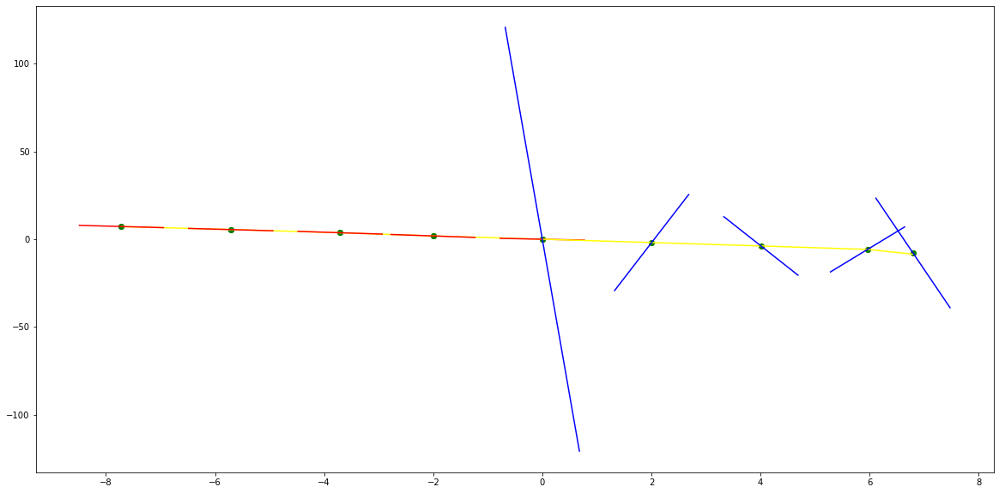

parameters (-4.1569757316418934e-05, -0.0010310369210378384, -0.0069565589739666025, -0.007175848020910304, -0.928086537405861, 0.004434977971694529)
tangent[0]:-0.9020009755631797
tangent[1]:-0.9796725461626734
tangent[2]:-0.993923282687522
tangent[3]:-0.9533038150380359
tangent[4]:-0.928086537405861
parameters (26.12810435344884, -413.84676980943374, 2382.4742581459545, -5842.507944897875, 5048.711226976975, 5.041981389242694e-08)
tangent[0]:5048.711226976975
tangent[1]:-879.3857632183754
tangent[2]:187.9532376969255
tangent[3]:-88.30282904770502
tangent[4]:-79.0141507676417


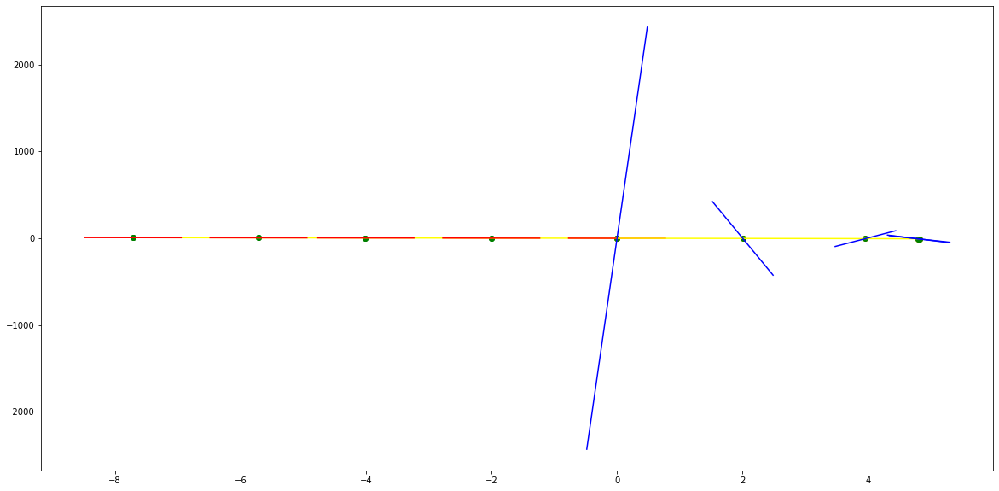

parameters (-4.954946736743263e-05, -0.001700153017118232, -0.019559550194395606, -0.0873249478801242, -1.0828917924742467, -0.0014369433663436754)
tangent[0]:-0.9828752558710478
tangent[1]:-0.9996841011212594
tangent[2]:-0.9515996206070596
tangent[3]:-0.9178093448505393
tangent[4]:-1.0828917924742467
parameters (-13537.951327513141, 141821.25344501637, -553130.6879167873, 950592.3447851769, -606257.9525177301, 3.325649765312732e-08)
tangent[0]:-606257.9525177301
tangent[1]:18391.852791564655
tangent[2]:-230.23298694833647
tangent[3]:-24.291384997661225
tangent[4]:28.019898246158846


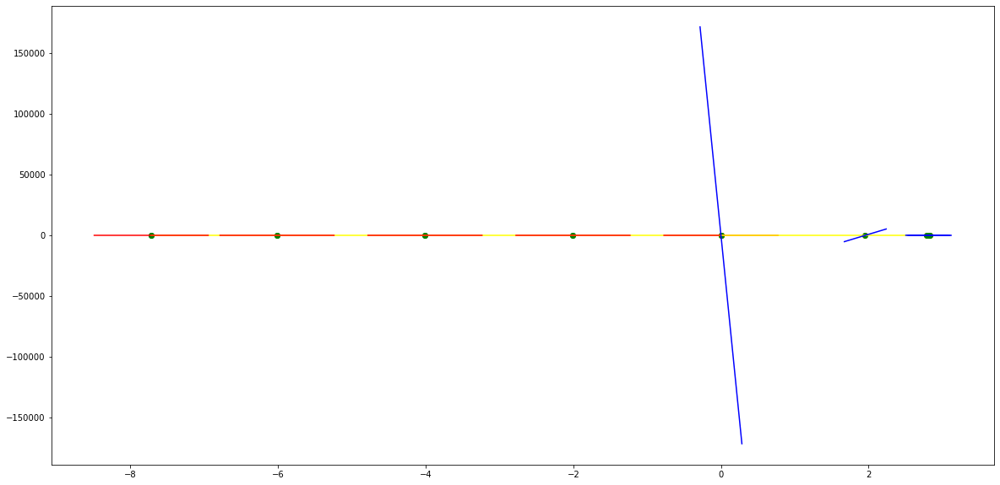

parameters (-6.266665686879896e-06, -0.00039708280580815516, -0.007187514019105793, -0.050298605318571096, -1.0940343578416425, -0.0037259368456517214)
tangent[0]:-0.9842495981379539
tangent[1]:-0.9637175299554337
tangent[2]:-0.9428704433119507
tangent[3]:-0.9683969954308531
tangent[4]:-1.0940343578416425
parameters (-474430.5449940316, 1678249.2221821498, -2224415.138916683, 1309228.93078109, -288707.19192638237, -1.0812477640441271e-07)
tangent[0]:-288707.19192638237
tangent[1]:1.0031472916016355
tangent[2]:-110.00118182215374
tangent[3]:-77.53508137061726
tangent[4]:-207.8510463515995


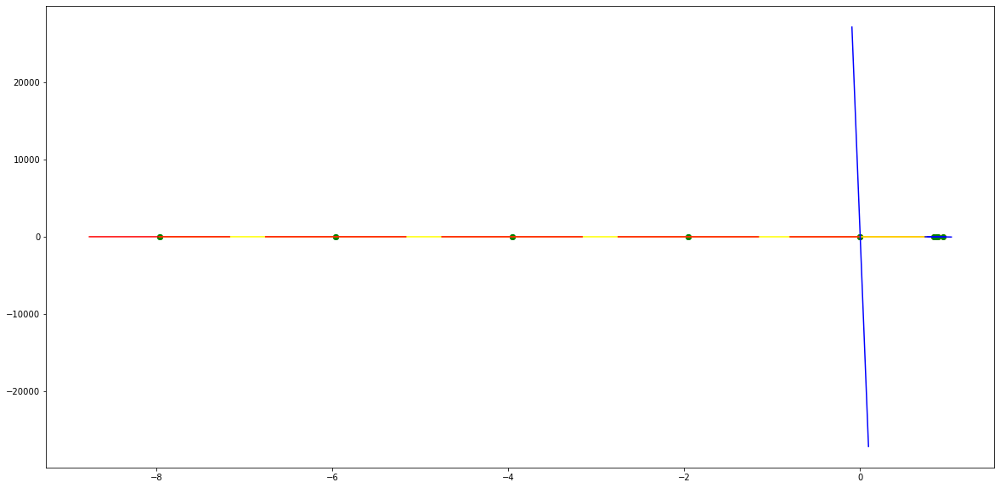

parameters (1303733.0084539338, 335764.7587495883, 30474.65472347787, 1562.6928530841592, -25.264580920536527, -0.006859457584814752)
tangent[0]:-113.69387323414256
tangent[1]:-110.0326617363165
tangent[2]:-80.11467866347714
tangent[3]:-69.55747570974505
tangent[4]:-25.264580920536527
parameters (-288010.04912151827, 218277.7359395326, -58546.658269764695, 6572.655417109825, -306.36156440608613, -0.16669405832070328)
tangent[0]:-306.36156440608613
tangent[1]:-254.58383389895948
tangent[2]:-101.11224735203876
tangent[3]:-17.21091838632566
tangent[4]:-68.56170042169003


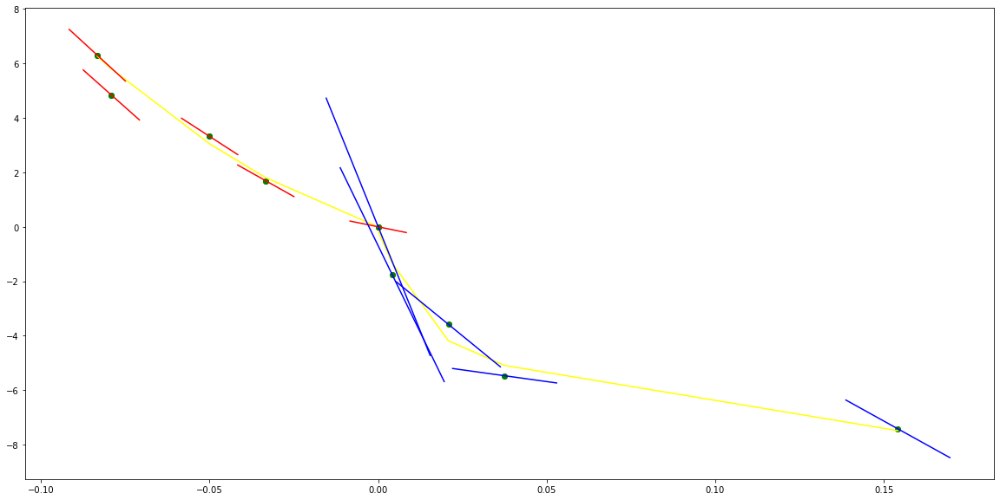

parameters (6.925790781118152, 36.98228737259135, 69.35056322166054, 52.95099283563959, 11.252894383655242, -0.0035895489902253554)
tangent[0]:-3.994608954294197
tangent[1]:0.13044450053498835
tangent[2]:-5.136596556396935
tangent[3]:-6.172197017400169
tangent[4]:11.252894383655242
parameters (5730.388985562796, -30597.8044918084, 59872.87565228657, -50627.78606375125, 15501.409401652909, 1.2646112504855655e-08)
tangent[0]:15501.409401652909
tangent[1]:-1475.5940047498698
tangent[2]:482.9114248296937
tangent[3]:-236.7797976967886
tangent[4]:-224.86350765735915


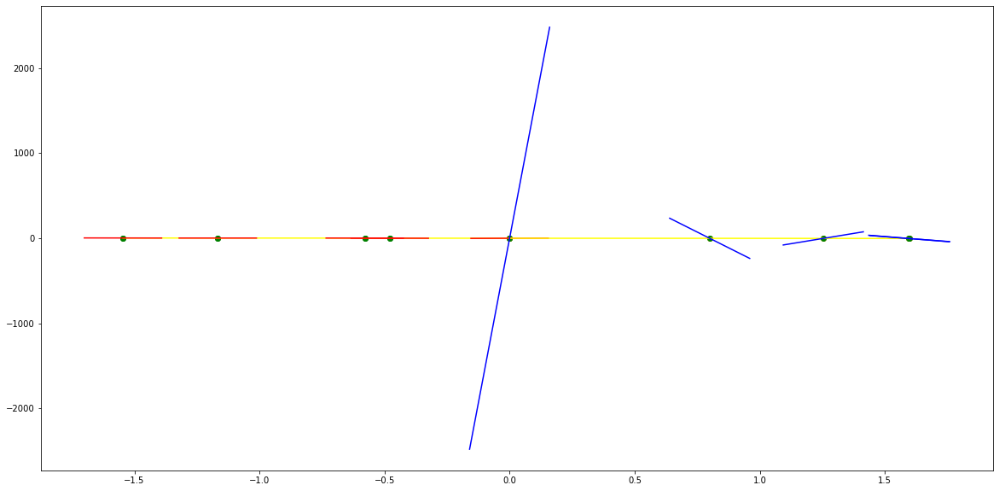

In [11]:
for point_index in breakpoints:
    identfication_UsePattern.plot_tangent_inPointWindow(data_forTangentPlot,point_index)

### ploynomial degree=1

=======point_index=========== 4022
parameters (-336.1243541539758, -0.5983261490615579)
tangent[0]:-336.1243541539758
tangent[1]:-336.1243541539758
tangent[2]:-336.1243541539758
tangent[3]:-336.1243541539758
tangent[4]:-336.1243541539758
parameters (-254.01214869401338, -0.699268920146622)
tangent[0]:-254.01214869401338
tangent[1]:-254.01214869401338
tangent[2]:-254.01214869401338
tangent[3]:-254.01214869401338
tangent[4]:-254.01214869401338


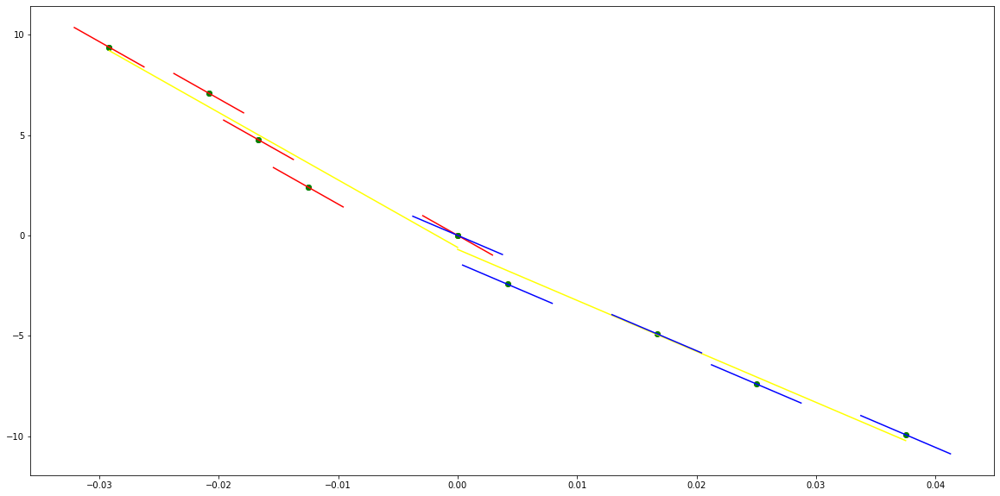

=======point_index=========== 5303
parameters (-134.64793660423308, 0.04291986958023627)
tangent[0]:-134.64793660423308
tangent[1]:-134.64793660423308
tangent[2]:-134.64793660423308
tangent[3]:-134.64793660423308
tangent[4]:-134.64793660423308
parameters (-139.40121276064426, 0.036115490628765776)
tangent[0]:-139.40121276064426
tangent[1]:-139.40121276064426
tangent[2]:-139.40121276064426
tangent[3]:-139.40121276064426
tangent[4]:-139.40121276064426


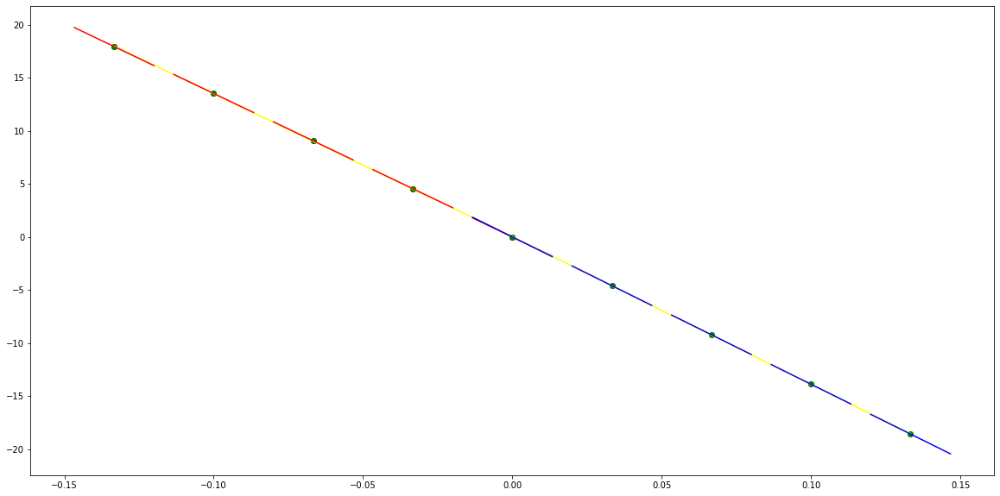

=======point_index=========== 9048
parameters (-482.364260014507, -0.25230417732933585)
tangent[0]:-482.364260014507
tangent[1]:-482.364260014507
tangent[2]:-482.364260014507
tangent[3]:-482.364260014507
tangent[4]:-482.364260014507
parameters (-278.0767794962902, -1.103400143459025)
tangent[0]:-278.0767794962902
tangent[1]:-278.0767794962902
tangent[2]:-278.0767794962902
tangent[3]:-278.0767794962902
tangent[4]:-278.0767794962902


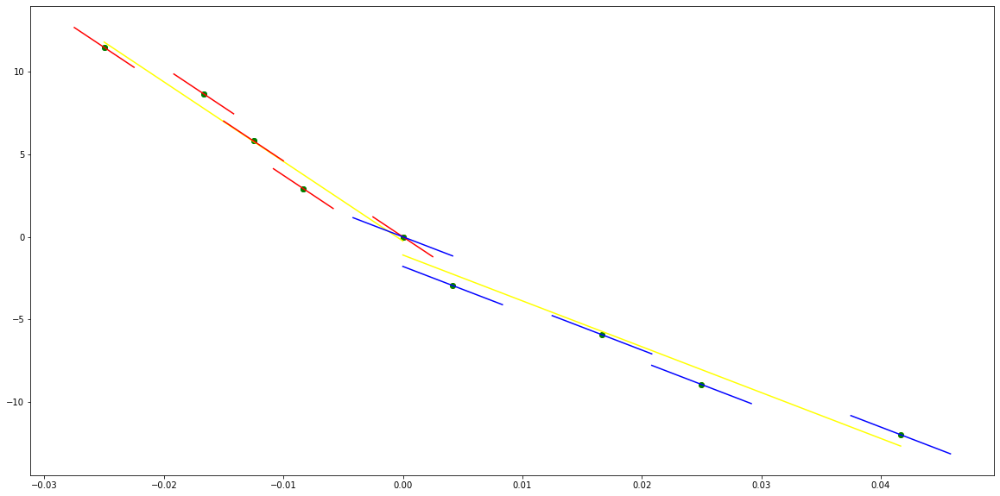

=======point_index=========== 10161
parameters (-306.48868208600913, 0.07021850696226298)
tangent[0]:-306.48868208600913
tangent[1]:-306.48868208600913
tangent[2]:-306.48868208600913
tangent[3]:-306.48868208600913
tangent[4]:-306.48868208600913
parameters (-117.97424319543326, -0.685363198975039)
tangent[0]:-117.97424319543326
tangent[1]:-117.97424319543326
tangent[2]:-117.97424319543326
tangent[3]:-117.97424319543326
tangent[4]:-117.97424319543326


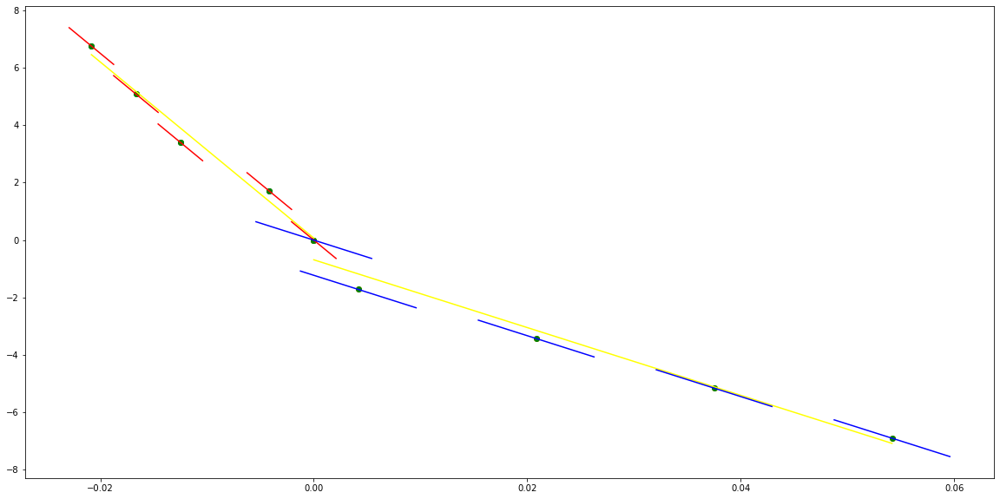

=======point_index=========== 16009
parameters (12.2117378705543, -0.17393365416983175)
tangent[0]:12.2117378705543
tangent[1]:12.2117378705543
tangent[2]:12.2117378705543
tangent[3]:12.2117378705543
tangent[4]:12.2117378705543
parameters (308.90470245205006, 0.39099421359851744)
tangent[0]:308.90470245205006
tangent[1]:308.90470245205006
tangent[2]:308.90470245205006
tangent[3]:308.90470245205006
tangent[4]:308.90470245205006


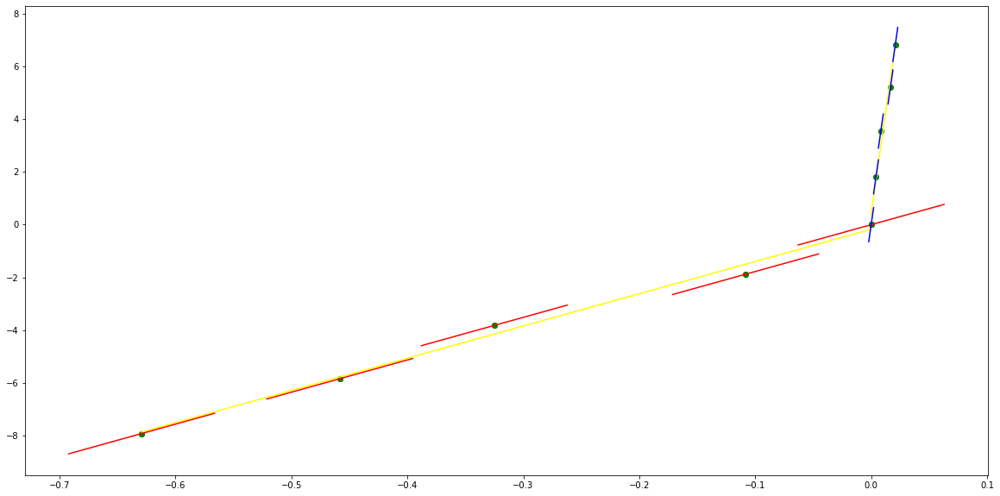

=======point_index=========== 16076
parameters (-179.546819272076, 0.49035171410484113)
tangent[0]:-179.546819272076
tangent[1]:-179.546819272076
tangent[2]:-179.546819272076
tangent[3]:-179.546819272076
tangent[4]:-179.546819272076
parameters (-28.157855594730812, -1.4516010181821888)
tangent[0]:-28.157855594730812
tangent[1]:-28.157855594730812
tangent[2]:-28.157855594730812
tangent[3]:-28.157855594730812
tangent[4]:-28.157855594730812


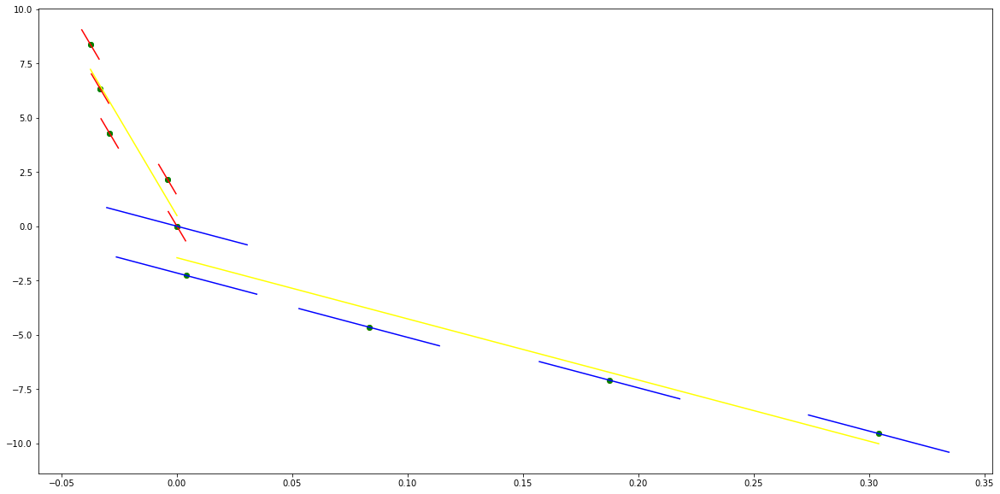

=======point_index=========== 16095
parameters (-16.65548028738217, 0.41558530085314915)
tangent[0]:-16.65548028738217
tangent[1]:-16.65548028738217
tangent[2]:-16.65548028738217
tangent[3]:-16.65548028738217
tangent[4]:-16.65548028738217
parameters (-213.17270722673538, 1.1051675529357385)
tangent[0]:-213.17270722673538
tangent[1]:-213.17270722673538
tangent[2]:-213.17270722673538
tangent[3]:-213.17270722673538
tangent[4]:-213.17270722673538


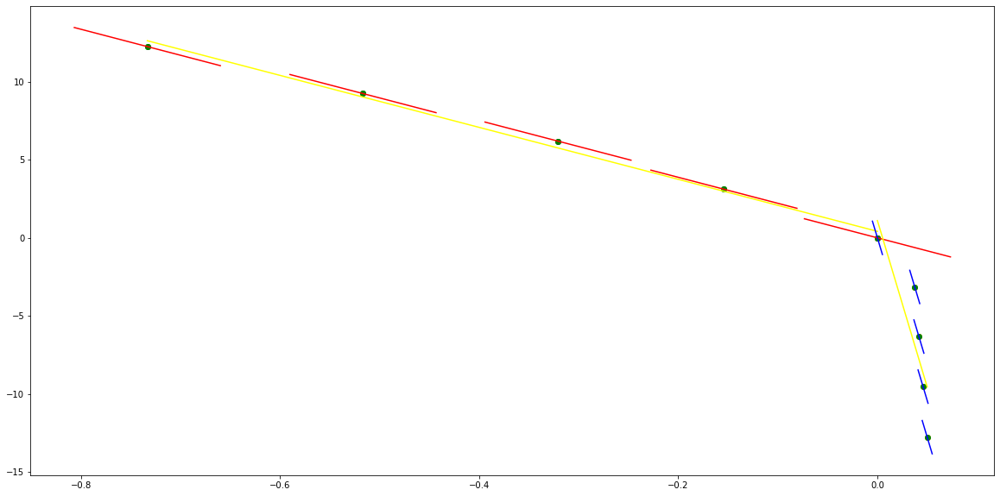

=======point_index=========== 16126
parameters (-677.7635864317269, 0.17293806818509733)
tangent[0]:-677.7635864317269
tangent[1]:-677.7635864317269
tangent[2]:-677.7635864317269
tangent[3]:-677.7635864317269
tangent[4]:-677.7635864317269
parameters (-686.547755847793, -0.15200363224734928)
tangent[0]:-686.547755847793
tangent[1]:-686.547755847793
tangent[2]:-686.547755847793
tangent[3]:-686.547755847793
tangent[4]:-686.547755847793


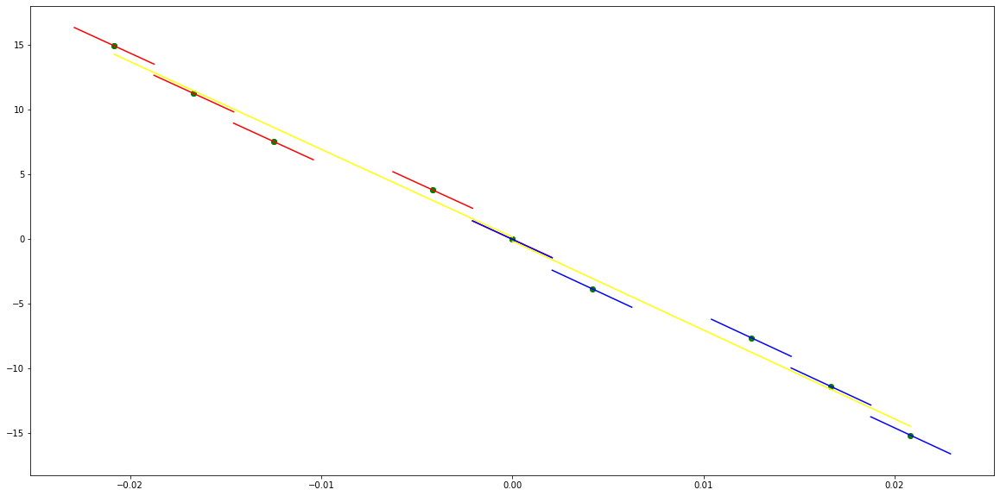

=======point_index=========== 19997
parameters (-84.35806996746379, 0.49377688546520215)
tangent[0]:-84.35806996746379
tangent[1]:-84.35806996746379
tangent[2]:-84.35806996746379
tangent[3]:-84.35806996746379
tangent[4]:-84.35806996746379
parameters (-20.348357494686045, -1.170919848185179)
tangent[0]:-20.348357494686045
tangent[1]:-20.348357494686045
tangent[2]:-20.348357494686045
tangent[3]:-20.348357494686045
tangent[4]:-20.348357494686045


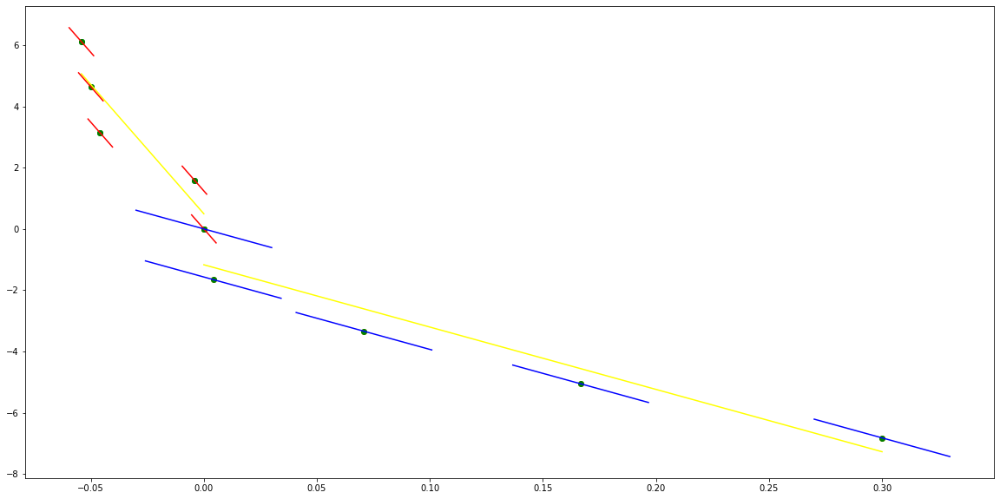

=======point_index=========== 20730
parameters (-658.7575092422474, -0.3694018655280919)
tangent[0]:-658.7575092422474
tangent[1]:-658.7575092422474
tangent[2]:-658.7575092422474
tangent[3]:-658.7575092422474
tangent[4]:-658.7575092422474
parameters (-573.7046202263034, -0.3415340166746091)
tangent[0]:-573.7046202263034
tangent[1]:-573.7046202263034
tangent[2]:-573.7046202263034
tangent[3]:-573.7046202263034
tangent[4]:-573.7046202263034


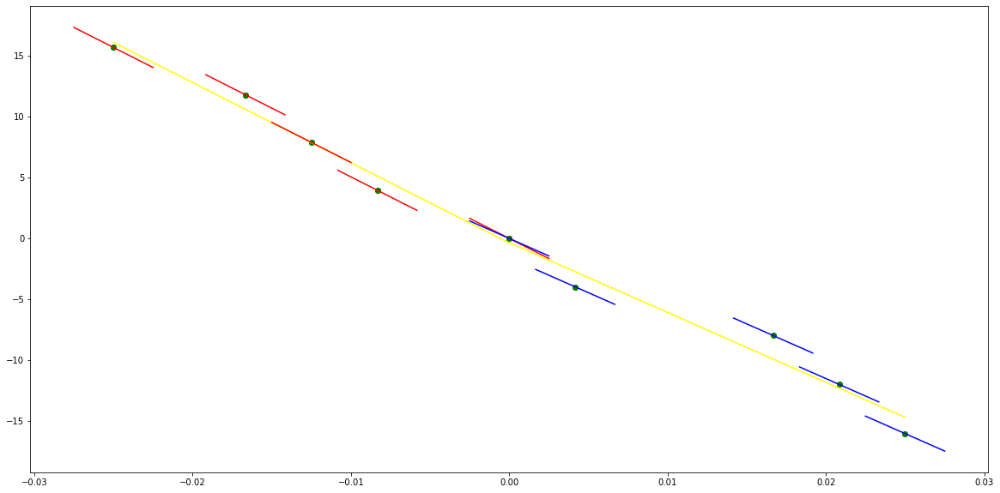

=======point_index=========== 24196
parameters (-78.40151780889045, 0.821129012354031)
tangent[0]:-78.40151780889045
tangent[1]:-78.40151780889045
tangent[2]:-78.40151780889045
tangent[3]:-78.40151780889045
tangent[4]:-78.40151780889045
parameters (-2.7398065942184506, -2.124106316414684)
tangent[0]:-2.7398065942184506
tangent[1]:-2.7398065942184506
tangent[2]:-2.7398065942184506
tangent[3]:-2.7398065942184506
tangent[4]:-2.7398065942184506


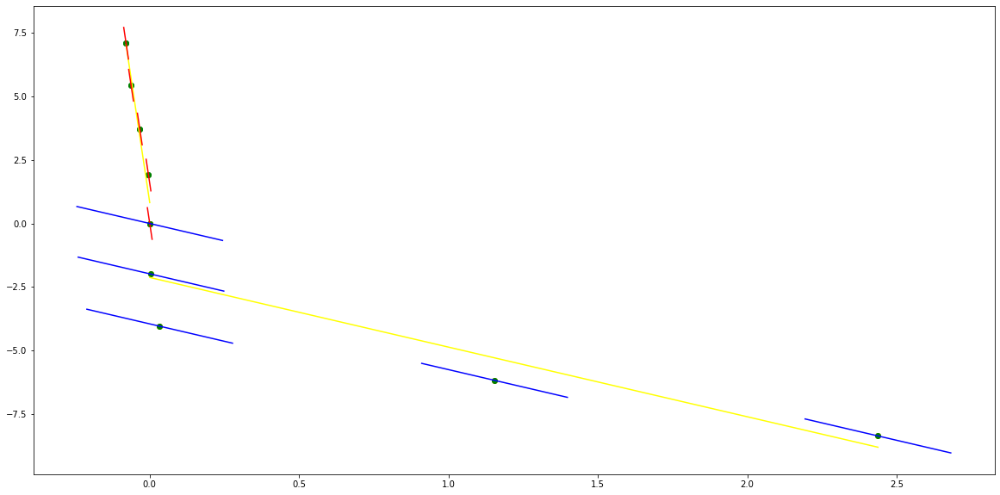

=======point_index=========== 24216
parameters (-2.4534398840432603, 1.87360349049443)
tangent[0]:-2.4534398840432603
tangent[1]:-2.4534398840432603
tangent[2]:-2.4534398840432603
tangent[3]:-2.4534398840432603
tangent[4]:-2.4534398840432603
parameters (-538.5690187989687, -0.07476839174325187)
tangent[0]:-538.5690187989687
tangent[1]:-538.5690187989687
tangent[2]:-538.5690187989687
tangent[3]:-538.5690187989687
tangent[4]:-538.5690187989687


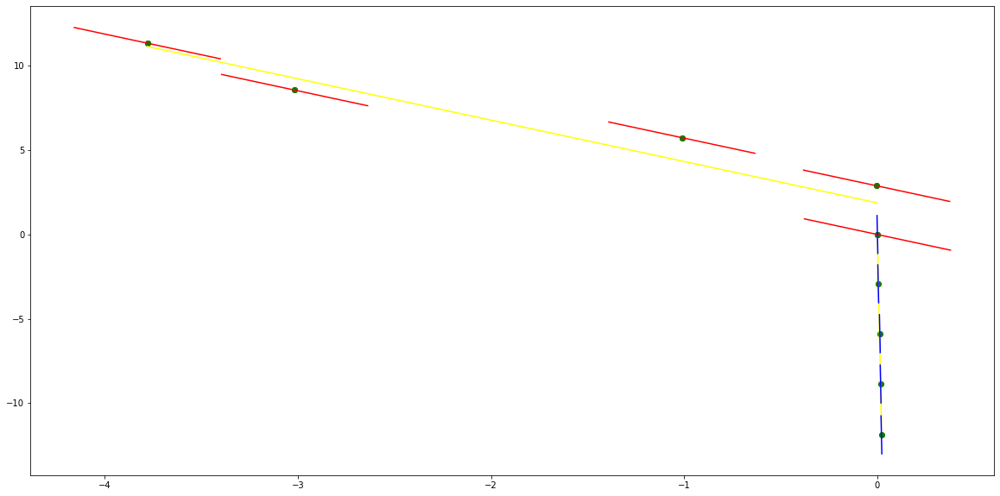

=======point_index=========== 24263
parameters (-696.5213301598242, -0.3931888269977993)
tangent[0]:-696.5213301598242
tangent[1]:-696.5213301598242
tangent[2]:-696.5213301598242
tangent[3]:-696.5213301598242
tangent[4]:-696.5213301598242
parameters (-446.5182257316002, -2.0559973033507135)
tangent[0]:-446.5182257316002
tangent[1]:-446.5182257316002
tangent[2]:-446.5182257316002
tangent[3]:-446.5182257316002
tangent[4]:-446.5182257316002


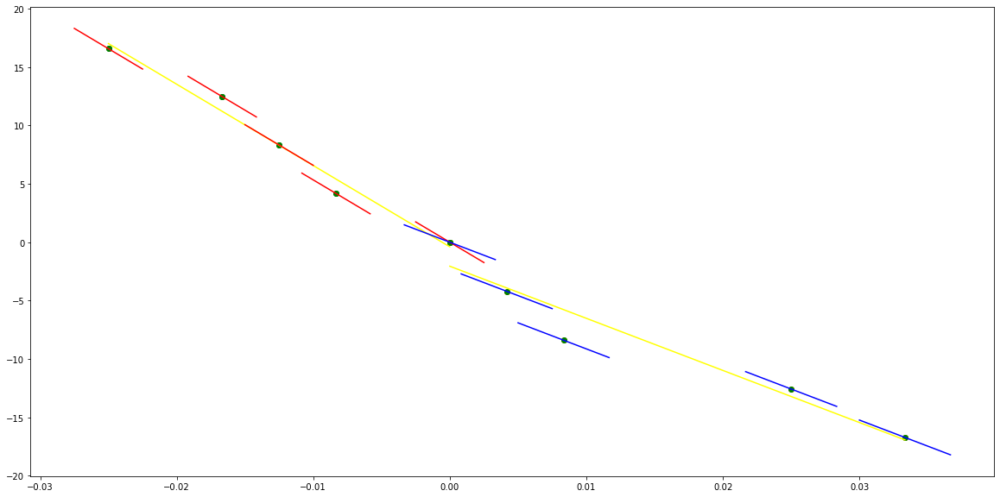

=======point_index=========== 25894
parameters (-38.597134000000004, 0.0004765999999998128)
tangent[0]:-38.597134000000004
tangent[1]:-38.597134000000004
tangent[2]:-38.597134000000004
tangent[3]:-38.597134000000004
tangent[4]:-38.597134000000004
parameters (-349.37074960185925, -0.06942446956305927)
tangent[0]:-349.37074960185925
tangent[1]:-349.37074960185925
tangent[2]:-349.37074960185925
tangent[3]:-349.37074960185925
tangent[4]:-349.37074960185925


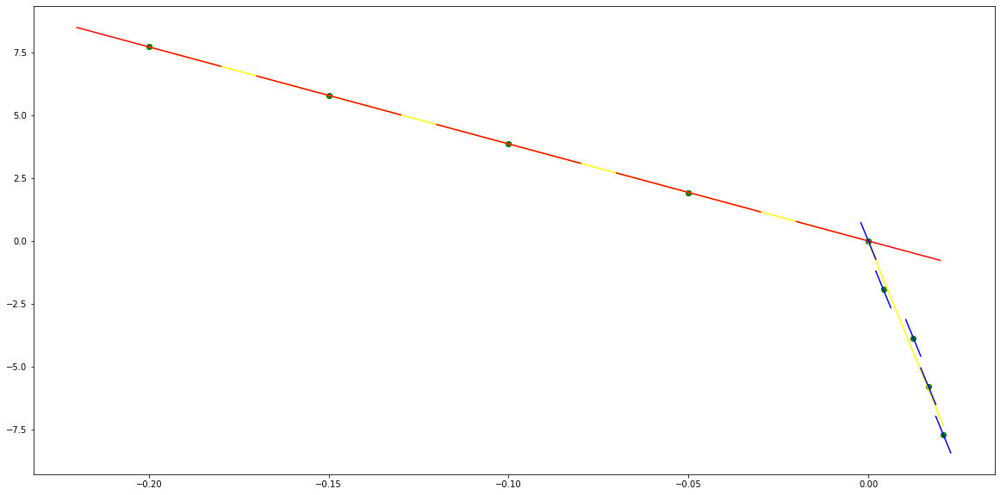

=======point_index=========== 26348
parameters (-59.75323172934255, 0.03235486806035095)
tangent[0]:-59.75323172934255
tangent[1]:-59.75323172934255
tangent[2]:-59.75323172934255
tangent[3]:-59.75323172934255
tangent[4]:-59.75323172934255
parameters (-1.723156623131165, -0.16612136580444284)
tangent[0]:-1.723156623131165
tangent[1]:-1.723156623131165
tangent[2]:-1.723156623131165
tangent[3]:-1.723156623131165
tangent[4]:-1.723156623131165


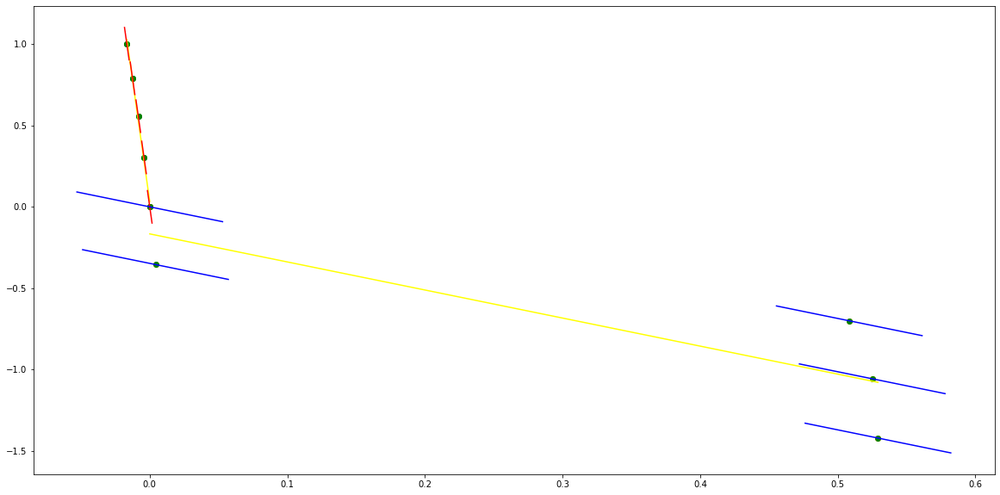

=======point_index=========== 26682
parameters (-688.4593599010634, 0.16111857044782146)
tangent[0]:-688.4593599010634
tangent[1]:-688.4593599010634
tangent[2]:-688.4593599010634
tangent[3]:-688.4593599010634
tangent[4]:-688.4593599010634
parameters (-274.71408482948664, -1.5135931730396543)
tangent[0]:-274.71408482948664
tangent[1]:-274.71408482948664
tangent[2]:-274.71408482948664
tangent[3]:-274.71408482948664
tangent[4]:-274.71408482948664


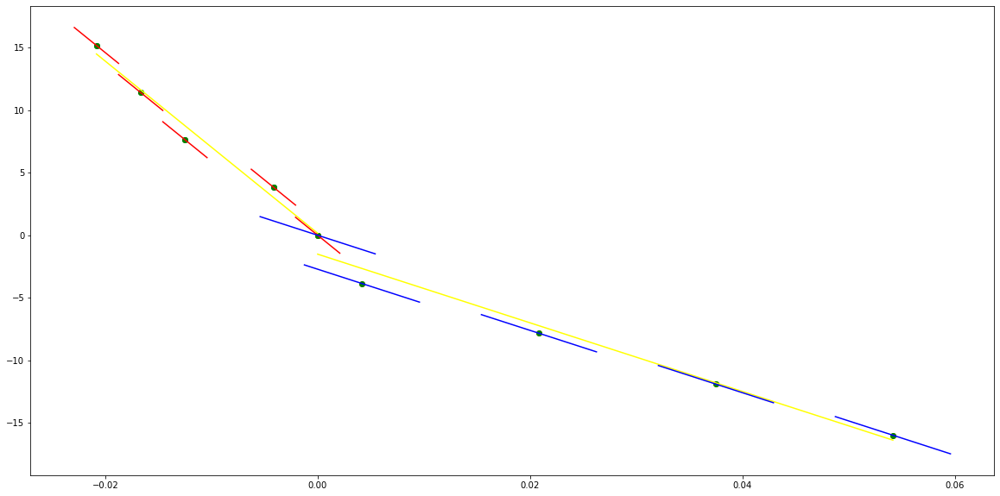

=======point_index=========== 28276
parameters (-71.06594209571611, -0.26368537502007267)
tangent[0]:-71.06594209571611
tangent[1]:-71.06594209571611
tangent[2]:-71.06594209571611
tangent[3]:-71.06594209571611
tangent[4]:-71.06594209571611
parameters (-39.470974876563915, -1.934751445673856)
tangent[0]:-39.470974876563915
tangent[1]:-39.470974876563915
tangent[2]:-39.470974876563915
tangent[3]:-39.470974876563915
tangent[4]:-39.470974876563915


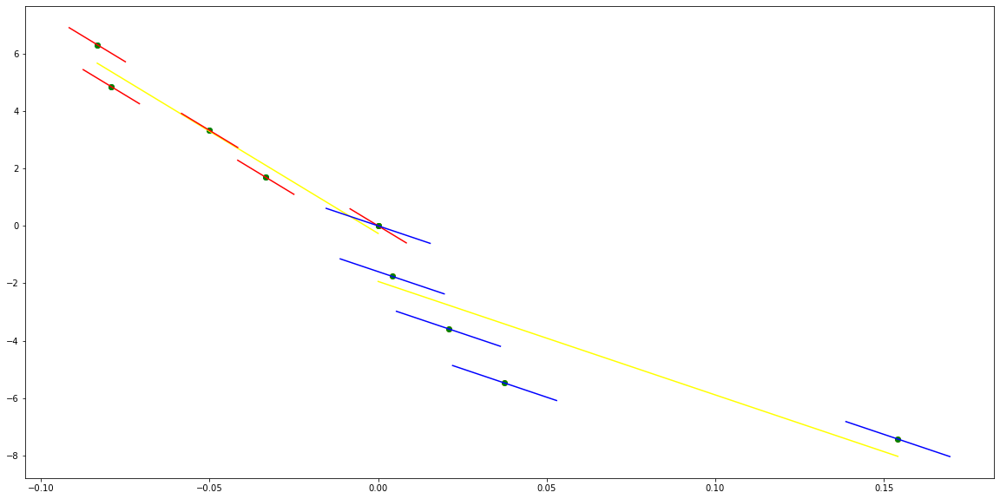

=======point_index=========== 28838
parameters (-228.21927243337453, 0.08457633402027984)
tangent[0]:-228.21927243337453
tangent[1]:-228.21927243337453
tangent[2]:-228.21927243337453
tangent[3]:-228.21927243337453
tangent[4]:-228.21927243337453
parameters (-259.97768559807486, -0.008746340841815008)
tangent[0]:-259.97768559807486
tangent[1]:-259.97768559807486
tangent[2]:-259.97768559807486
tangent[3]:-259.97768559807486
tangent[4]:-259.97768559807486


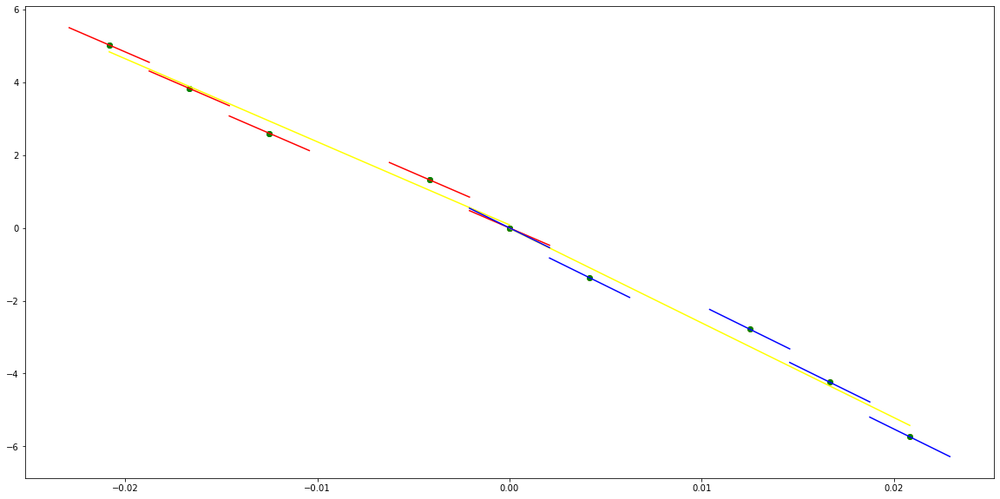

In [10]:
points_false=[1043,4655, 7111,14143, 15750, 17510,21094,26870,29539, 29540]
for point_index in drawdown2:
    identfication_UsePattern.plot_tangent_inPointWindow(data_forTangentPlot,point_index)

### ploynomial degree=2

=======point_index=========== 1043
parameters (-756.3321127678674, 40.22438132557402, -0.0415035756611275)
tangent[0]:71.73771513615999
tangent[1]:65.43595597257811
tangent[2]:59.13268414477071
tangent[3]:46.52765315338143
tangent[4]:40.22438132557402
parameters (236.28003652474067, -24.538503117490176, 0.21110552312590095)
tangent[0]:-24.538503117490176
tangent[1]:-22.569345293092987
tangent[2]:32.56234818929779
tangent[3]:36.50066383809218
tangent[4]:38.46934910241632


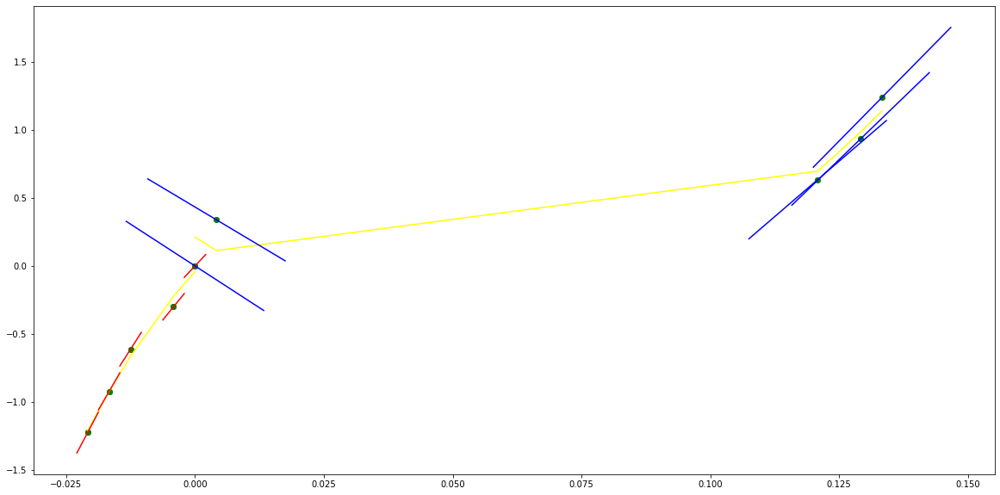

=======point_index=========== 4655
parameters (3.3152651111906364, 11.455487154841654, -0.20890701777649304)
tangent[0]:5.184112863016107
tangent[1]:6.952249835297632
tangent[2]:8.913786113105573
tangent[3]:10.488537040921125
tangent[4]:11.455487154841654
parameters (3.5202936950958525, 79.32797673026073, 0.8365347143785031)
tangent[0]:79.32797673026073
tangent[1]:79.35731485791565
tangent[2]:79.62133688504785
tangent[3]:79.82668265687018
tangent[4]:79.97336625455743


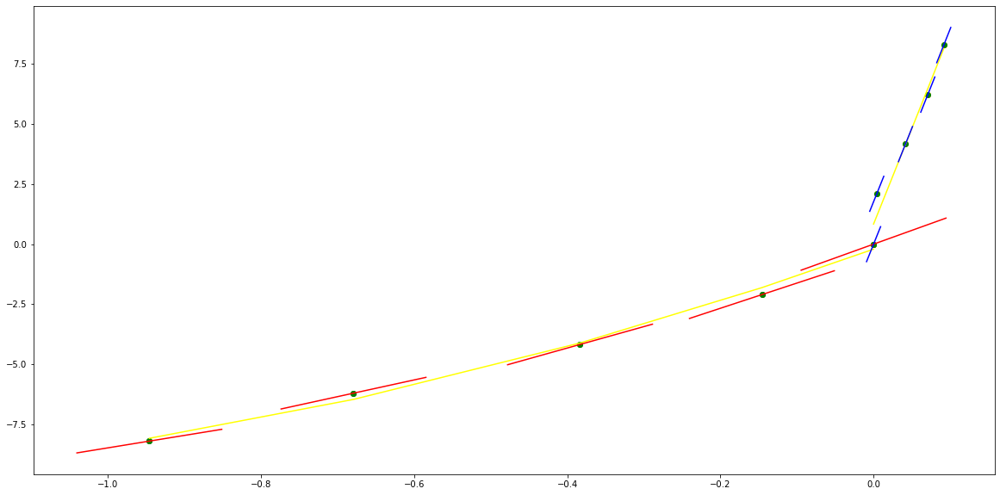

=======point_index=========== 7111
parameters (-5.595546840302112, 0.3076621838989974, -0.19220829174234336)
tangent[0]:11.498755864503222
tangent[1]:10.93920118047301
tangent[2]:9.633581045131638
tangent[3]:4.644210985133134
tangent[4]:0.3076621838989974
parameters (-39.64612466149801, 38.098034090815034, 0.20022917300331472)
tangent[0]:38.098034090815034
tangent[1]:35.45498554413161
tangent[2]:30.499219961444357
tangent[3]:25.21304357582818
tangent[4]:19.92694648246133


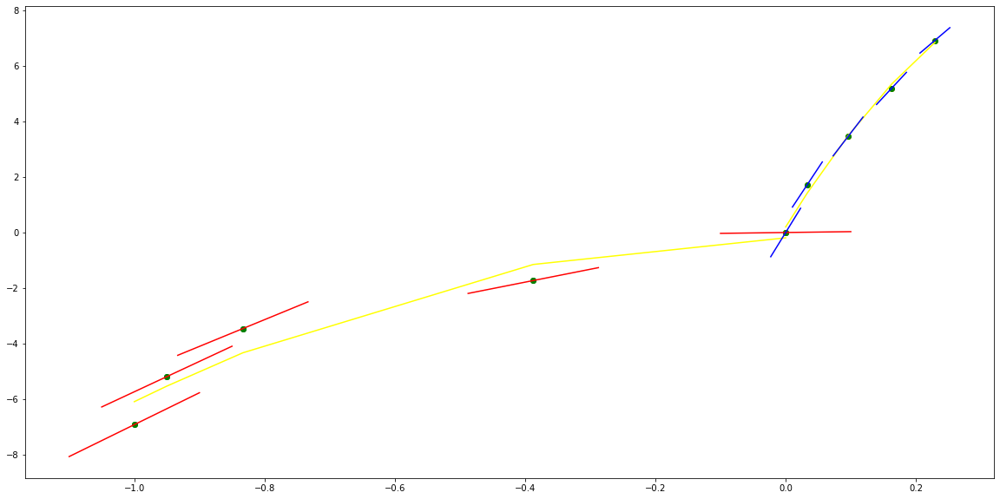

=======point_index=========== 14143
parameters (-4728.872378166864, -78.40190152000956, 0.08299627535345398)
tangent[0]:512.7071457508484
tangent[1]:394.48533629667685
tangent[2]:355.0749138970342
tangent[3]:315.66449149739157
tangent[4]:-78.40190152000956
parameters (-3855.1058406260963, 405.8784175795605, 1.4371293406142938)
tangent[0]:405.8784175795605
tangent[1]:373.7499655037826
tangent[2]:341.62151342800473
tangent[3]:116.74547953260327
tangent[4]:20.36783351695084


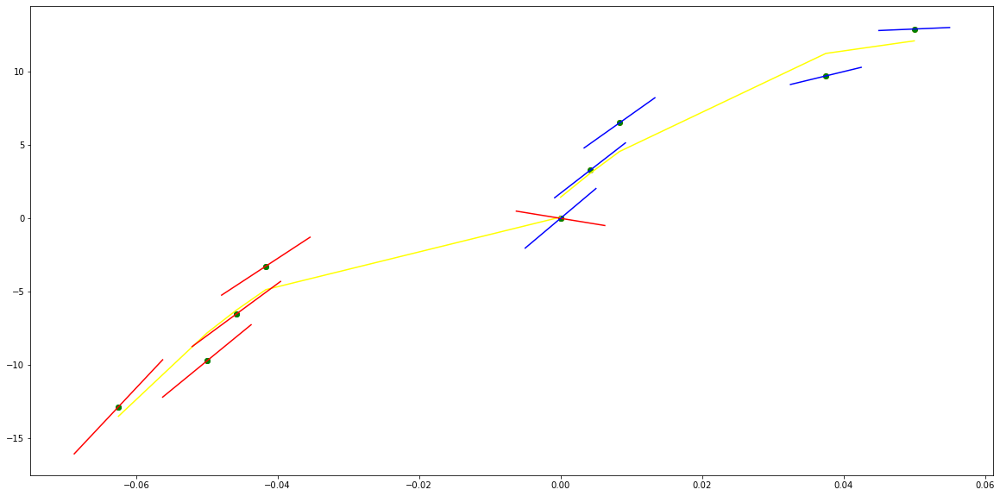

=======point_index=========== 15750
parameters (-36.745454366217466, 10.599145118965408, -0.0985390693711644)
tangent[0]:28.66570917629482
tangent[1]:28.359472559606758
tangent[2]:23.46005414714152
tangent[3]:16.417199890586083
tangent[4]:10.599145118965408
parameters (-1572.8484827795003, 192.21430985511188, 0.502531498314105)
tangent[0]:192.21430985511188
tangent[1]:179.10933629659309
tangent[2]:166.00121704110873
tangent[3]:113.57188571613686
tangent[4]:-83.03417463130063


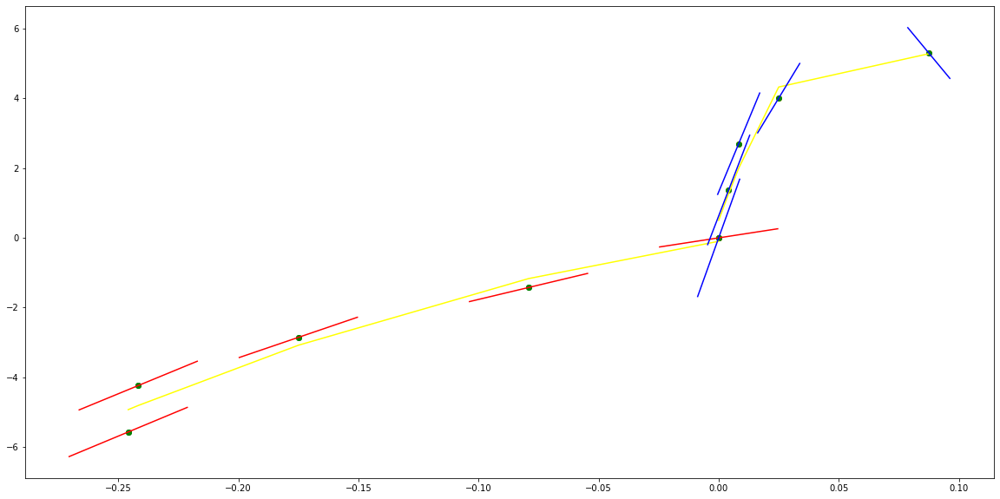

=======point_index=========== 17510
parameters (-0.10393493236120205, 0.8773656797297987, -0.0016965849596499943)
tangent[0]:1.6499487462380222
tangent[1]:1.4871174214954272
tangent[2]:1.3104280364813836
tangent[3]:1.1129516649951
tangent[4]:0.8773656797297987
parameters (199.63077960513263, -163.12031003714404, -3.903898445526659e-05)
tangent[0]:-163.12031003714404
tangent[1]:166.2704763113248
tangent[2]:167.93379996699477
tangent[3]:169.59752288422393
tangent[4]:172.9245694571231


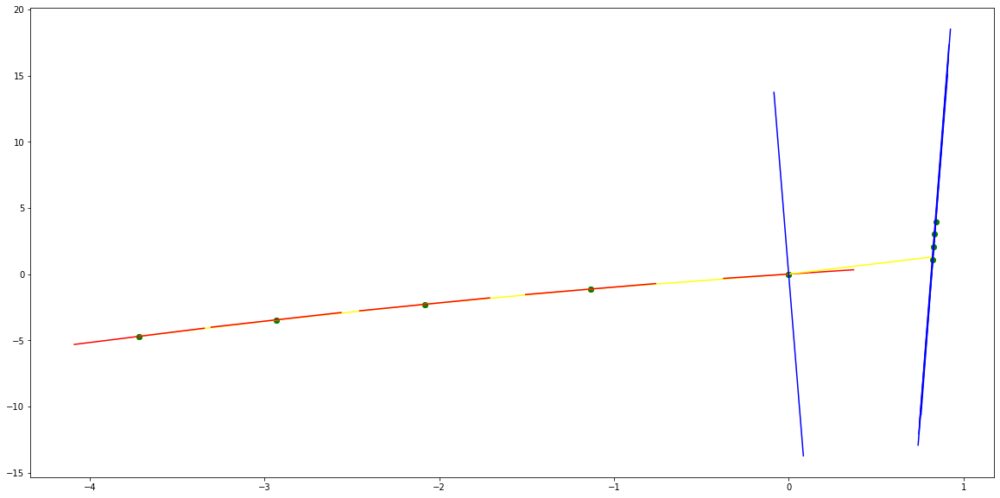

=======point_index=========== 21094
parameters (-9529.137717966269, -56.282946386194425, -1.5286142047338684)
tangent[0]:658.4023824612757
tangent[1]:578.9865487197449
tangent[2]:499.5897732536498
tangent[3]:23.13288735533645
tangent[4]:-56.282946386194425
parameters (5096.144830552991, 194.5048831437225, 1.0871530218547802)
tangent[0]:194.5048831437225
tangent[1]:236.97615416155114
tangent[2]:406.84085365354343
tangent[3]:491.7833956892007
tangent[4]:534.2444744173682


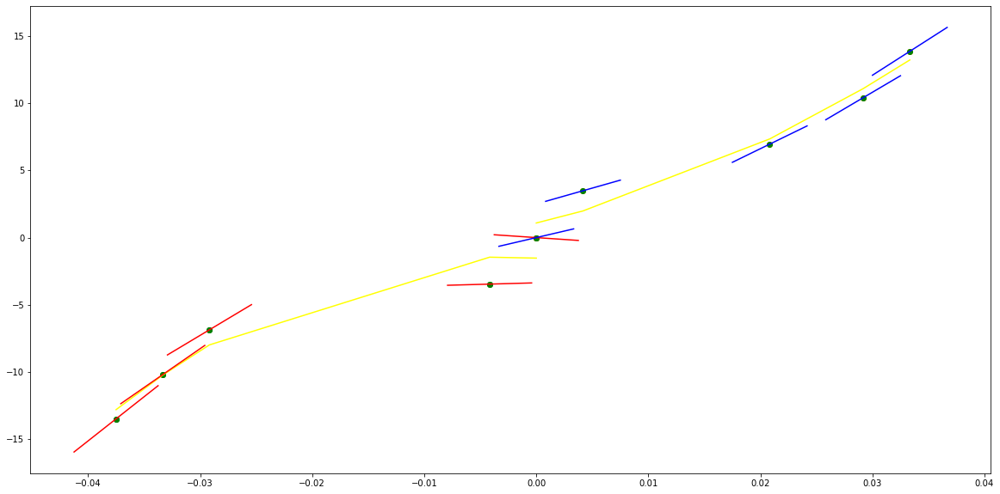

=======point_index=========== 26870
parameters (-2.598893849168688, 5.909444733203744, 0.08891411888153605)
tangent[0]:12.298388647218303
tangent[1]:10.912315392853468
tangent[2]:9.439605413132746
tangent[3]:8.161817669887373
tangent[4]:5.909444733203744
parameters (-35.67170244314398, 31.124840155720115, 0.891361082448999)
tangent[0]:31.124840155720115
tangent[1]:29.63847165831919
tangent[2]:6.451865070275609
tangent[3]:6.1546484455193315
tangent[4]:5.857360477358167


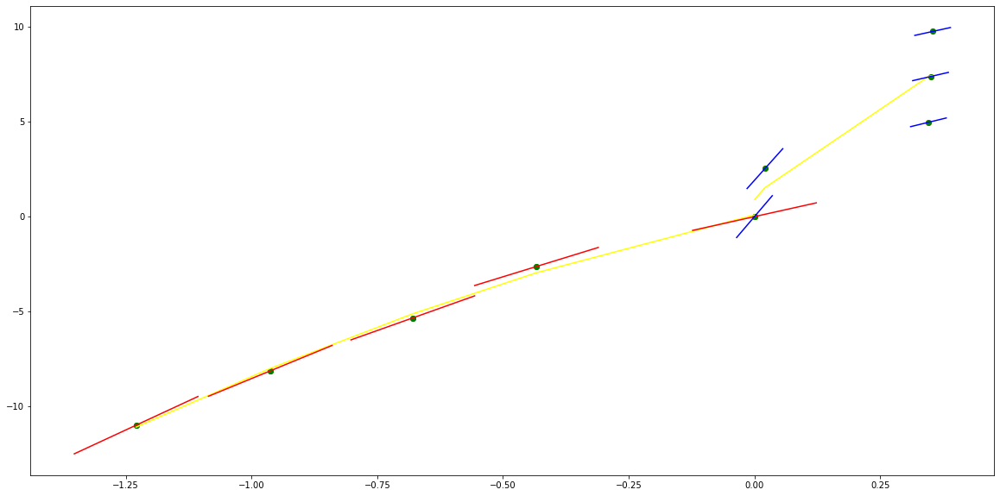

=======point_index=========== 29539
parameters (-0.204708833356632, 0.7007653979498053, -0.0015628877501773152)
tangent[0]:1.5332482598785533
tangent[1]:1.3916577105284382
tangent[2]:1.1715957146700589
tangent[3]:0.9737106455645369
tangent[4]:0.7007653979498053
parameters (288.0269211967185, -81.68187897790551, -0.00016036224730603936)
tangent[0]:-81.68187897790551
tangent[1]:86.33344101761867
tangent[2]:88.73385737887213
tangent[3]:91.13427374012556
tangent[4]:95.9345304087901


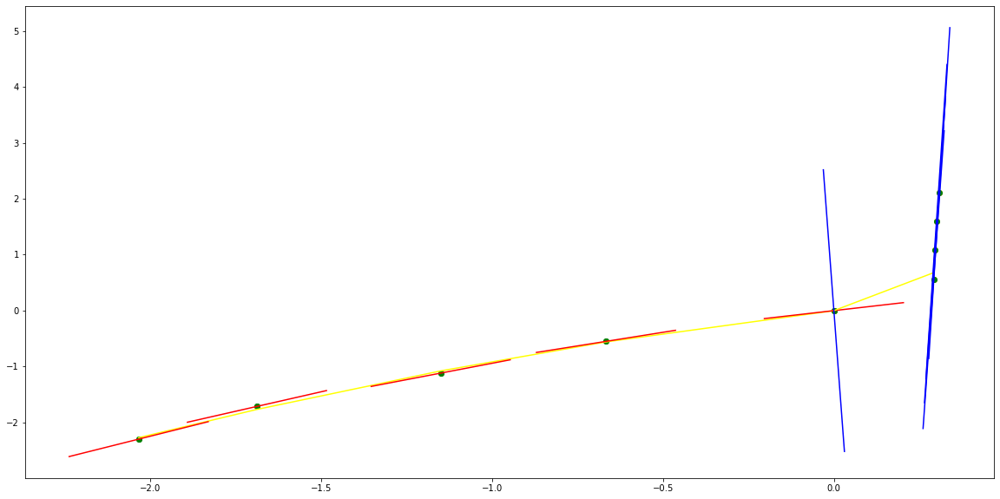

=======point_index=========== 29540
parameters (0.030865220043590234, 1.1557337092192852, -0.08280718312402112)
tangent[0]:1.0335589210337006
tangent[1]:1.0667390325805601
tangent[2]:1.0965753913792173
tangent[3]:1.1377290386808177
tangent[4]:1.1557337092192852
parameters (-1485.3746237446153, 123.57894276797141, 0.03212295576461101)
tangent[0]:123.57894276797141
tangent[1]:111.19983065368379
tangent[2]:98.82071853939617
tangent[3]:74.0654650600684
tangent[4]:61.68635294578079


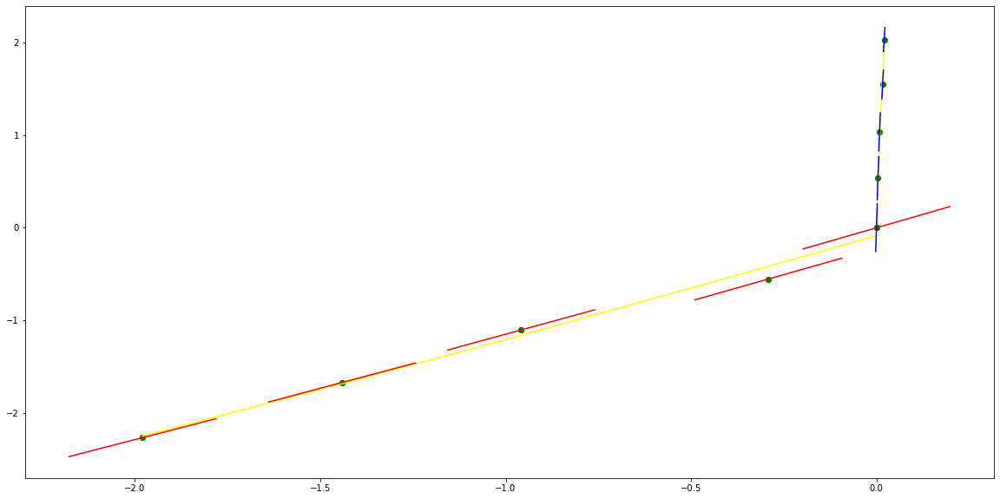

In [11]:
points_false=[1043,4655, 7111,14143, 15750, 17510,21094,26870,29539, 29540]
for point_index in points_false:
    identfication_UsePattern.plot_tangent_inPointWindow(data_forTangentPlot,point_index)

parameters (-0.08734859883089069, 2.354969631271678, -0.3606536647506021)
tangent[0]:2.7691475124957523
tangent[1]:2.6614176904024522
tangent[2]:2.5558714085827265
tangent[3]:2.4073787905702124
tangent[4]:2.354969631271678
parameters (-43.513763104882635, 44.57976494326988, -0.5756628537536871)
tangent[0]:44.57976494326988
tangent[1]:35.151811946387376
tangent[2]:34.78916824467129
tangent[3]:34.42652454295519
tangent[4]:32.976123791143245


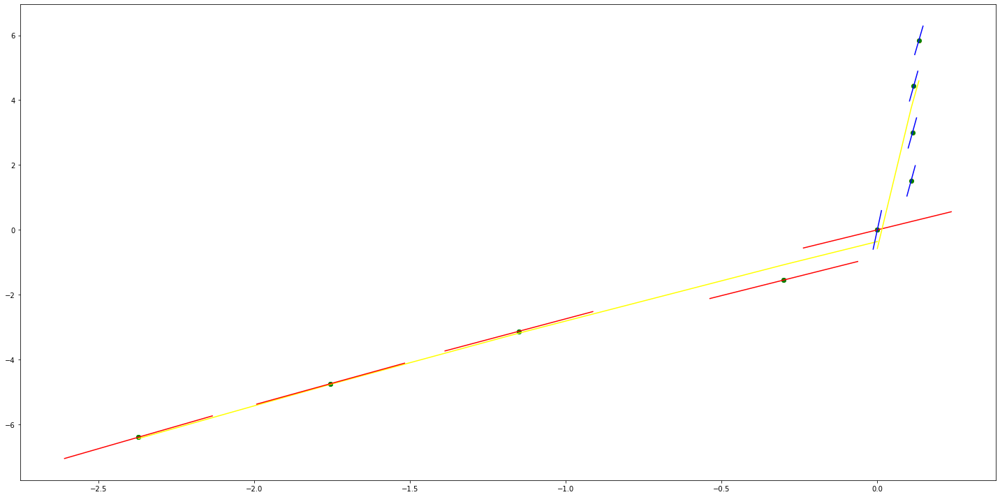

parameters (0.09094629705678499, 3.131190578168858, -0.8935319290385397)
tangent[0]:2.7924156216323337
tangent[1]:2.902309124540147
tangent[2]:3.0569178295366815
tangent[3]:3.1114856077707524
tangent[4]:3.131190578168858
parameters (-86.54160894389392, 50.14555009792015, 1.7284442807197387)
tangent[0]:50.14555009792015
tangent[1]:49.42431232898174
tangent[2]:48.703247643261214
tangent[3]:45.818469650725454
tangent[4]:37.16430875633606


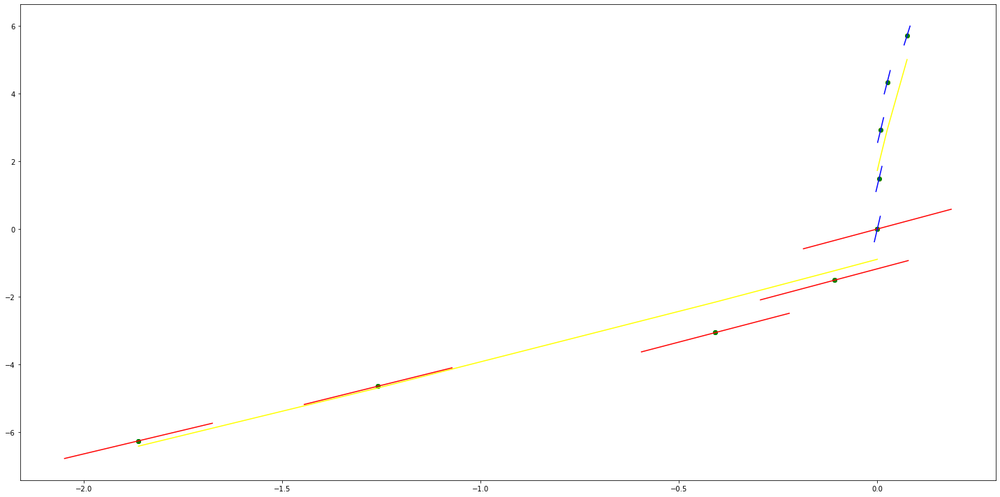

parameters (16.614066002035454, 18.44366665692325, 0.01117695171606993)
tangent[0]:15.674666732628008
tangent[1]:15.813095130556967
tangent[2]:15.951556756617931
tangent[3]:18.02831500687236
tangent[4]:18.44366665692325
parameters (-662.3903308615111, 71.51600077400502, 0.03487546181425758)
tangent[0]:71.51600077400502
tangent[1]:65.99563975660519
tangent[2]:60.476603519867076
tangent[3]:49.43588148506741
tangent[4]:43.916845248329295


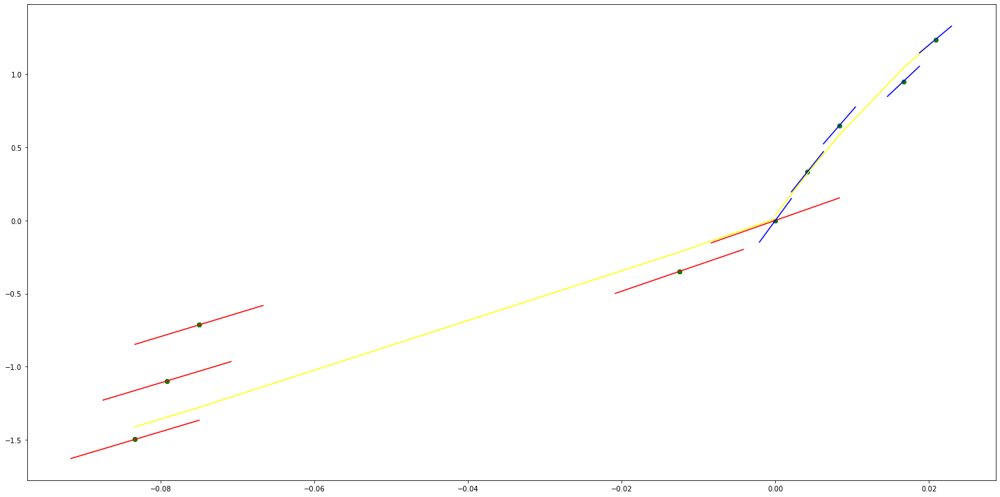

parameters (-49.21264552929037, 80.6672993024394, -0.0414671230467952)
tangent[0]:82.71779339106281
tangent[1]:82.30775362851277
tangent[2]:81.89761544067166
tangent[3]:81.0774374902805
tangent[4]:80.6672993024394
parameters (-0.47594170459963087, 3.175984992718578, 0.5615255600235348)
tangent[0]:3.175984992718578
tangent[1]:3.172018494552445
tangent[2]:3.1561544056547297
tangent[3]:2.8229952124349884
tangent[4]:2.525531647060219


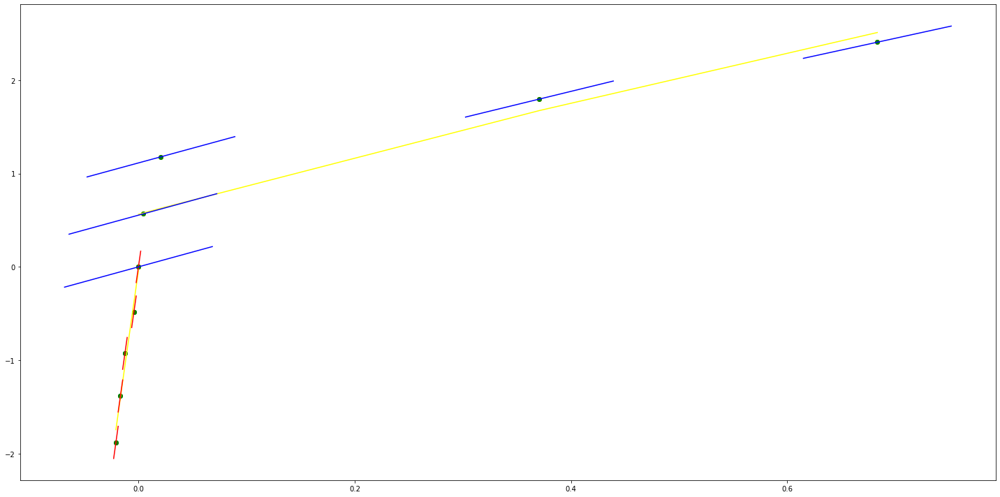

parameters (7.55829446477997, 15.4009737089532, 0.4527028693804419)
tangent[0]:10.425091480776743
tangent[1]:12.25168938749119
tangent[2]:12.755570646280212
tangent[3]:13.196476195588685
tangent[4]:15.4009737089532
parameters (-99.70390893281217, 61.37626349900642, 0.5120151459607728)
tangent[0]:61.37626349900642
tangent[1]:60.545331121960366
tangent[2]:59.71459815273217
tangent[3]:51.4058726057252
tangent[4]:50.57494022867915


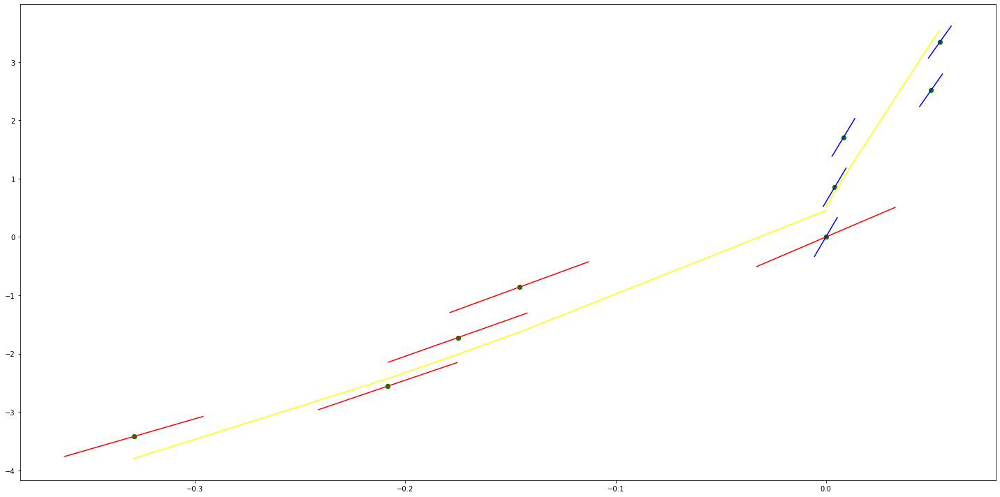

parameters (-146.35256988467182, 6.232512250615405, 0.00530495103759433)
tangent[0]:39.16184047466657
tangent[1]:34.28332391013092
tangent[2]:25.74628580361824
tangent[3]:24.52658348619938
tangent[4]:6.232512250615405
parameters (-130.40718352199195, 46.97295750962208, 0.7899145369831423)
tangent[0]:46.97295750962208
tangent[1]:45.886144042149795
tangent[2]:43.712777921572275
tangent[3]:42.6259644541
tangent[4]:41.539411800994756


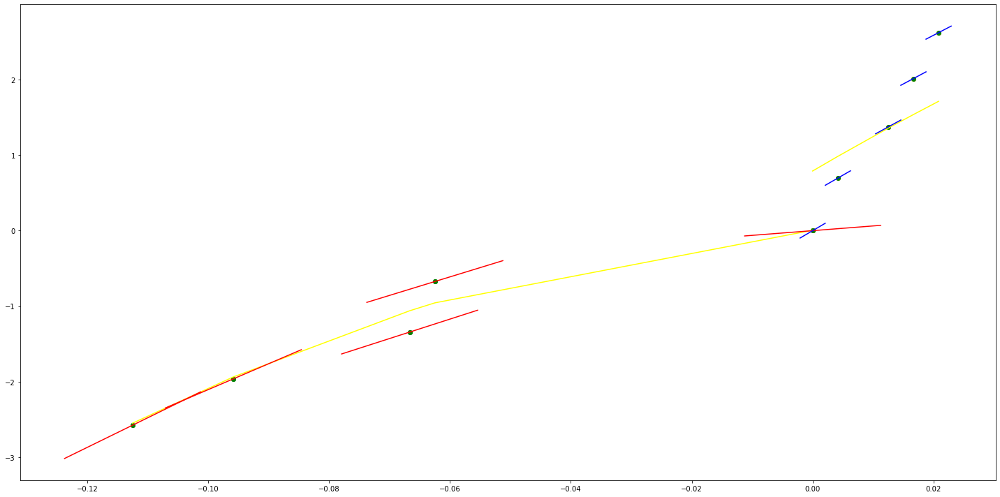

parameters (-195.69905026363813, 48.58143334162235, -0.03651402941377485)
tangent[0]:56.735429969907095
tangent[1]:55.104865483110466
tangent[2]:53.473909598213304
tangent[3]:50.21238922651951
tangent[4]:48.58143334162235
parameters (75.0360071781928, -2.295759851835218, 0.15635010104410524)
tangent[0]:-2.295759851835218
tangent[1]:-1.670409768012159
tangent[2]:15.837891858889925
tangent[3]:17.08859202653604
tangent[4]:17.713792038344746


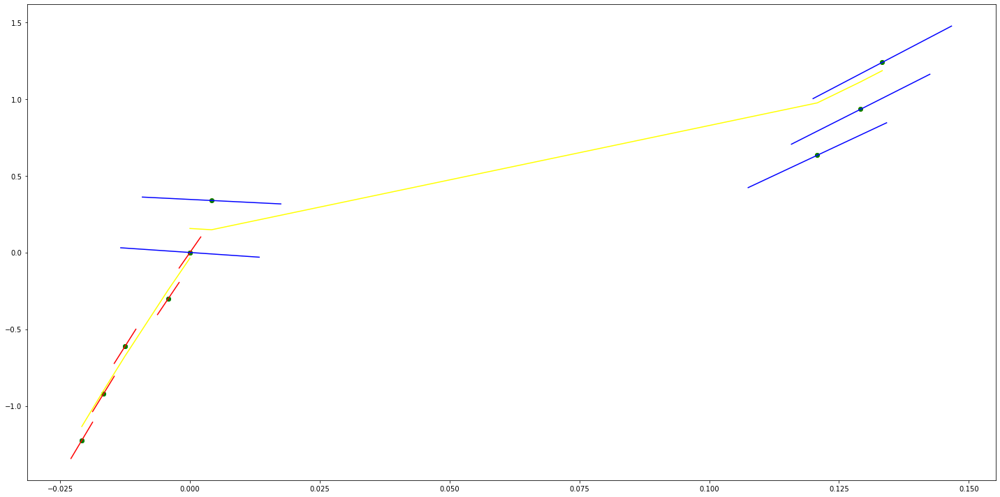

parameters (-0.00855683063465992, 2.207343005158162, -0.0288805044203415)
tangent[0]:2.2472748757486882
tangent[1]:2.2367927582212297
tangent[2]:2.226239345180923
tangent[3]:2.216185069185198
tangent[4]:2.207343005158162
parameters (116.0493168564305, -46.56140157177989, 0.014399580943867257)
tangent[0]:-46.56140157177989
tangent[1]:53.04767276286753
tangent[2]:54.014595670915305
tangent[3]:67.55383736992133
tangent[4]:68.52076027796912


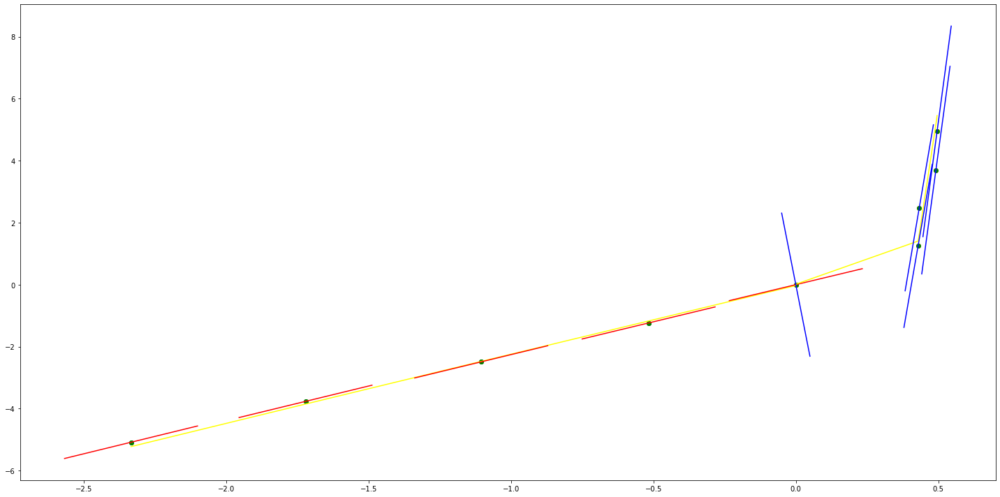

parameters (1.3671916995532214, 6.079959636582342, -1.684778398433232)
tangent[0]:4.724162112653197
tangent[1]:5.897666498514113
tangent[2]:5.909060674138189
tangent[3]:6.068565460958266
tangent[4]:6.079959636582342
parameters (-500.7473895218956, 125.54901413785802, 0.287161816686873)
tangent[0]:125.54901413785802
tangent[1]:121.37578539358255
tangent[2]:96.33841591748777
tangent[3]:92.16618866799132
tangent[4]:87.99295992371586


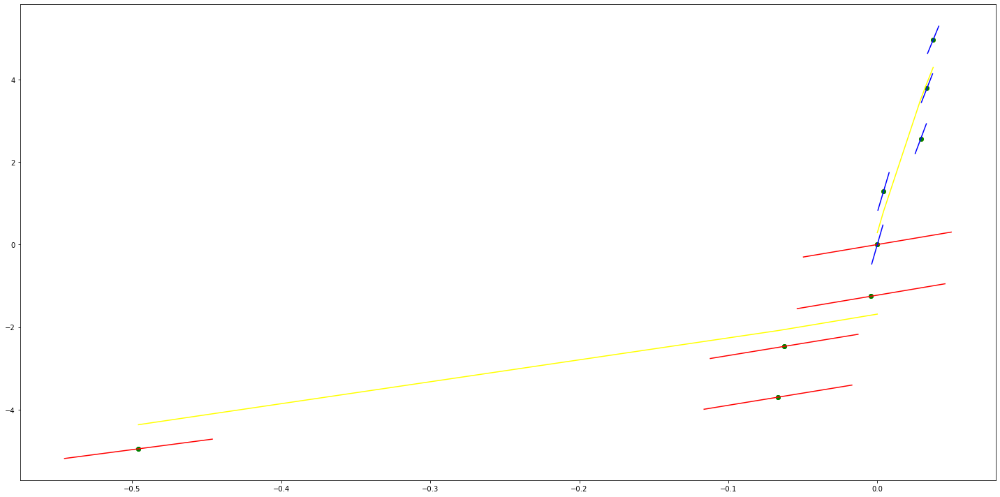

parameters (-23.709692993863346, -2.069494805593272, -0.4003505401701805)
tangent[0]:16.30551726465082
tangent[1]:16.10792068323996
tangent[2]:15.910371521215094
tangent[3]:-1.8718982241824147
tangent[4]:-2.069494805593272
parameters (-215.7471189492207, 73.95204472497721, 0.27417560113288747)
tangent[0]:73.95204472497721
tangent[1]:72.1540082356544
tangent[2]:64.96272526683899
tangent[3]:54.17536931937795
tangent[4]:52.37733283005514


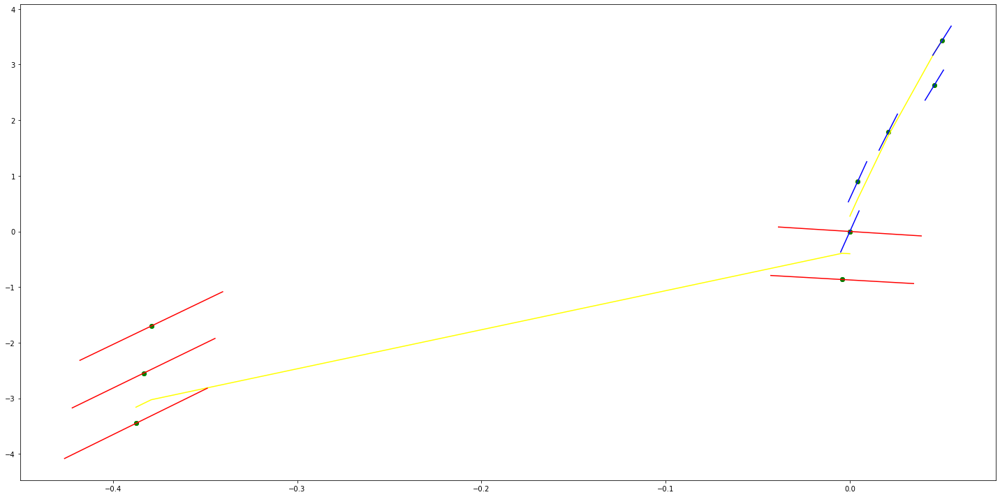

parameters (0.010112110002058484, 2.2833799639588728, 0.11006174259438047)
tangent[0]:2.218999537020507
tangent[1]:2.2328194139485804
tangent[2]:2.248998789951874
tangent[3]:2.2655152430299763
tangent[4]:2.2833799639588728
parameters (129.2650096610979, -93.81199799492401, -0.011277043789788057)
tangent[0]:-93.81199799492401
tangent[1]:101.16281108723845
tangent[2]:105.47147238926215
tangent[3]:109.78039222130519
tangent[4]:111.93472287231705


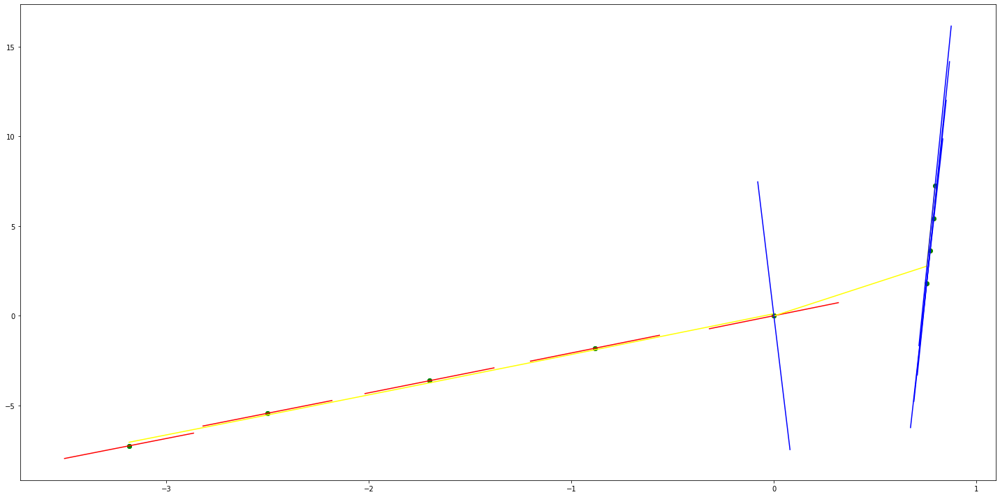

parameters (0.6823824870849665, 5.176747745589536, -2.693510118704824)
tangent[0]:4.0906227419009555
tangent[1]:5.119882083410797
tangent[2]:5.142628621235287
tangent[3]:5.165375159059778
tangent[4]:5.176747745589536
parameters (-288.9333012382491, 124.92474382134762, 1.1129895044248936)
tangent[0]:124.92474382134762
tangent[1]:122.51677368882805
tangent[2]:120.10938142291096
tangent[3]:91.21605129908605
tangent[4]:86.40011103404692


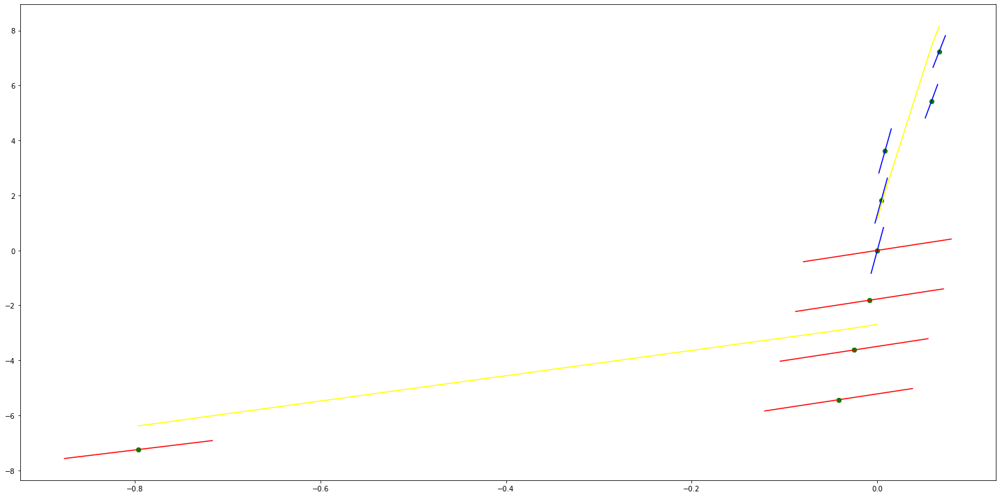

parameters (-0.03758789562604974, -1.700813951027727, 0.06131430769129778)
tangent[0]:-1.4051225304947326
tangent[1]:-1.4777924119212347
tangent[2]:-1.5639313895147928
tangent[3]:-1.6344086938136362
tangent[4]:-1.700813951027727
parameters (-483.2553176069663, 306.9807295211685, 0.0002554325939671385)
tangent[0]:306.9807295211685
tangent[1]:-313.19725024465
tangent[2]:-317.2237335509512
tangent[3]:-321.2511833678877
tangent[4]:-329.3051164911254


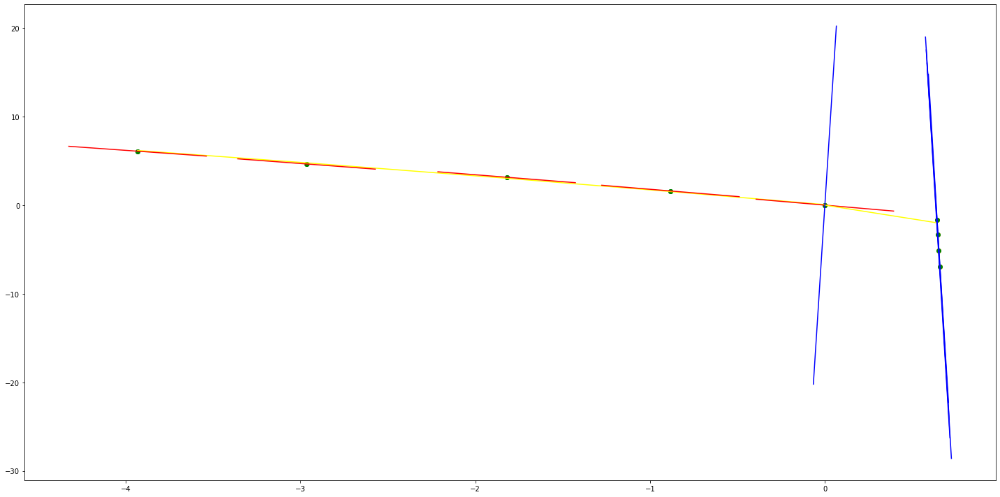

parameters (330.22924623542576, -394.00937802530495, 0.25876615115812296)
tangent[0]:-407.7687097989502
tangent[1]:-405.01723971931665
tangent[2]:-402.2651091811906
tangent[3]:-396.761508563431
tangent[4]:-394.00937802530495
parameters (184.47957438196093, -178.71979614790615, -0.8877595336739783)
tangent[0]:-178.71979614790615
tangent[1]:-177.1823433750069
tangent[2]:-171.03327020170735
tangent[3]:-164.8838280692591
tangent[4]:-158.73438593681078


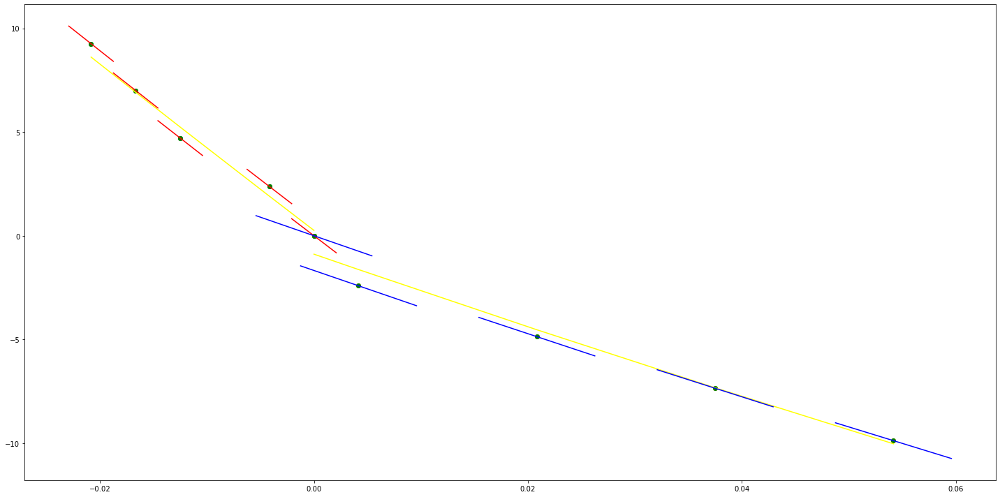

parameters (-820.2234809391315, 81.71808645542399, -1.0745339917399368)
tangent[0]:177.4102790826687
tangent[1]:150.07059001600555
tangent[2]:102.22367347890227
tangent[3]:95.38793098875556
tangent[4]:81.71808645542399
parameters (-3531.279573715364, 434.70945851255186, 0.14277720364575425)
tangent[0]:434.70945851255186
tangent[1]:405.279774545208
tangent[2]:375.8571531370116
tangent[3]:316.9977852023239
tangent[4]:287.5751637941275


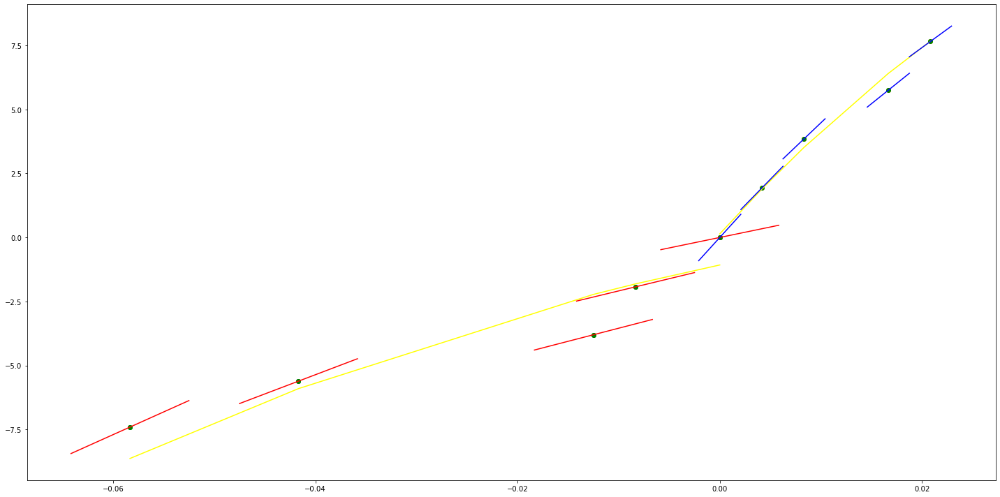

parameters (-883.6567758418761, -21.421192496788137, -0.9959664220492708)
tangent[0]:170.03718649776778
tangent[1]:140.58313884540638
tangent[2]:81.67150891358018
tangent[3]:0.6702268992587648
tangent[4]:-21.421192496788137
parameters (383.4248336827565, 36.16992926659, 1.6366162438909337)
tangent[0]:36.16992926659
tangent[1]:39.3653918305021
tangent[2]:42.56008754474682
tangent[3]:80.90257091302249
tangent[4]:112.8548960031413


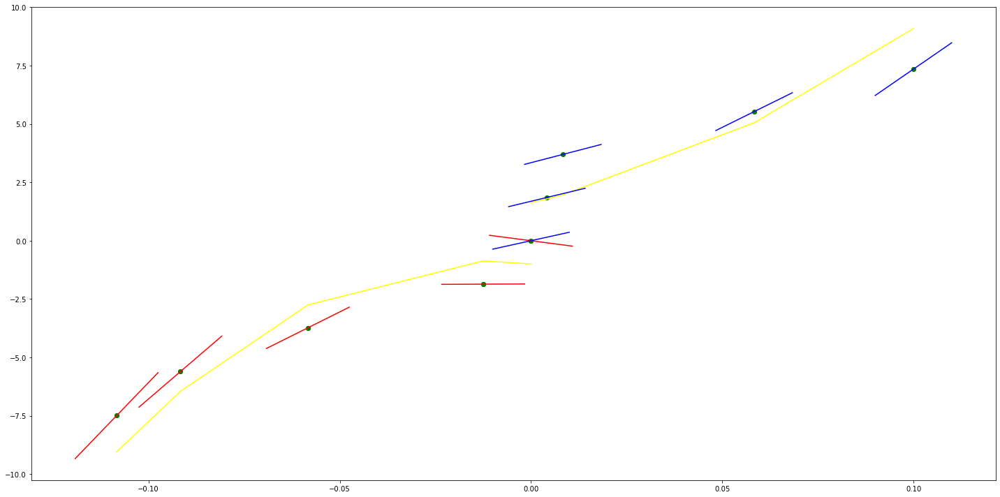

parameters (-451.74722338187604, -5.368043663240945, -0.3678526911464183)
tangent[0]:103.8039008225635
tangent[1]:100.03994295734573
tangent[2]:73.68772042858737
tangent[3]:28.512998090399755
tangent[4]:-5.368043663240945
parameters (-13.704570211079242, 35.4179203771818, 0.23116357704643292)
tangent[0]:35.4179203771818
tangent[1]:34.504291499489995
tangent[2]:33.13383447838207
tangent[3]:31.763377457274142
tangent[4]:30.39292043616622


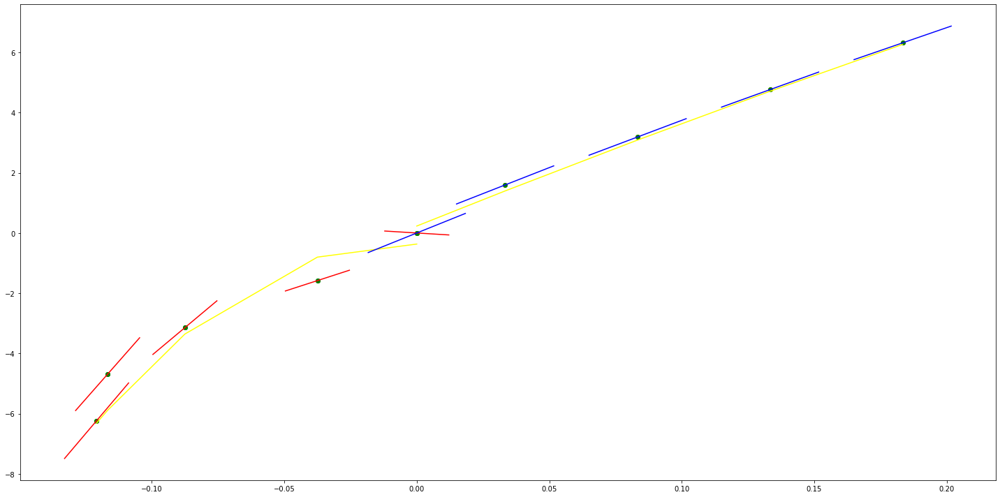

parameters (-0.04652229567555362, -2.934556481017043, 0.0009459988921620134)
tangent[0]:-2.6976804898838793
tangent[1]:-2.75660870005805
tangent[2]:-2.8151492864646523
tangent[3]:-2.872914439246934
tangent[4]:-2.934556481017043
parameters (-359.7185726172928, 234.38672805764742, -0.0005795367988867677)
tangent[0]:234.38672805764742
tangent[1]:-242.24038066026554
tangent[2]:-245.23827524445807
tangent[3]:-248.23545039150537
tangent[4]:-260.2263092911302


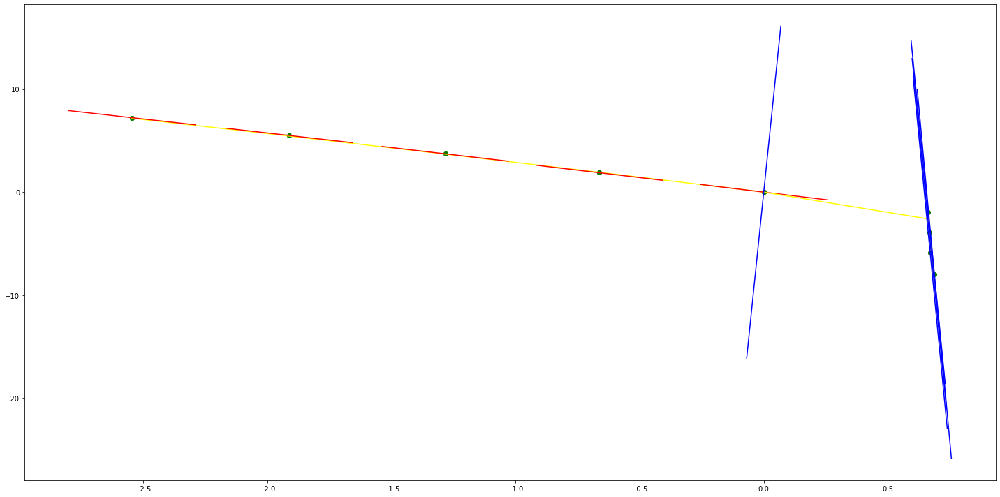

parameters (1669.0367827413468, -303.4723552059411, -0.4945191280626984)
tangent[0]:-400.8339468903748
tangent[1]:-373.014441795642
tangent[2]:-359.1080273218411
tangent[3]:-345.1982747744747
tangent[4]:-303.4723552059411
parameters (219.95713221813148, -180.94190236780906, -0.8965928922325018)
tangent[0]:-180.94190236780906
tangent[1]:-179.10877962790315
tangent[2]:-171.7771684968084
tangent[3]:-164.4451174514492
tangent[4]:-157.11306640609


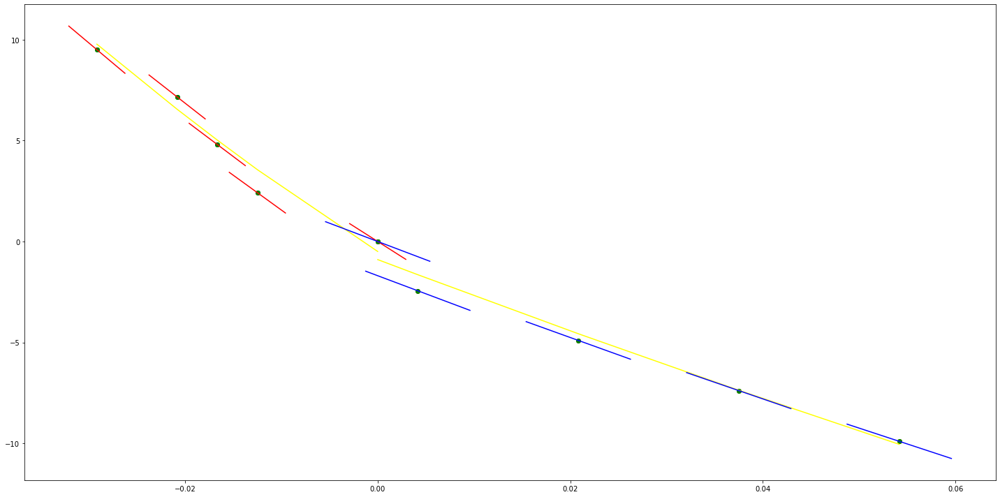

parameters (-626.1044411163244, 37.49663202827895, 0.07903054460204101)
tangent[0]:136.63025260799105
tangent[1]:105.32503055217484
tangent[2]:100.1070761399114
tangent[3]:94.88912172764795
tangent[4]:37.49663202827895
parameters (-704.2347751025333, 162.64399018649075, 0.619109982977957)
tangent[0]:162.64399018649075
tangent[1]:156.77489757078624
tangent[2]:121.56315881565959
tangent[3]:115.69547466950527
tangent[4]:109.82638205380076


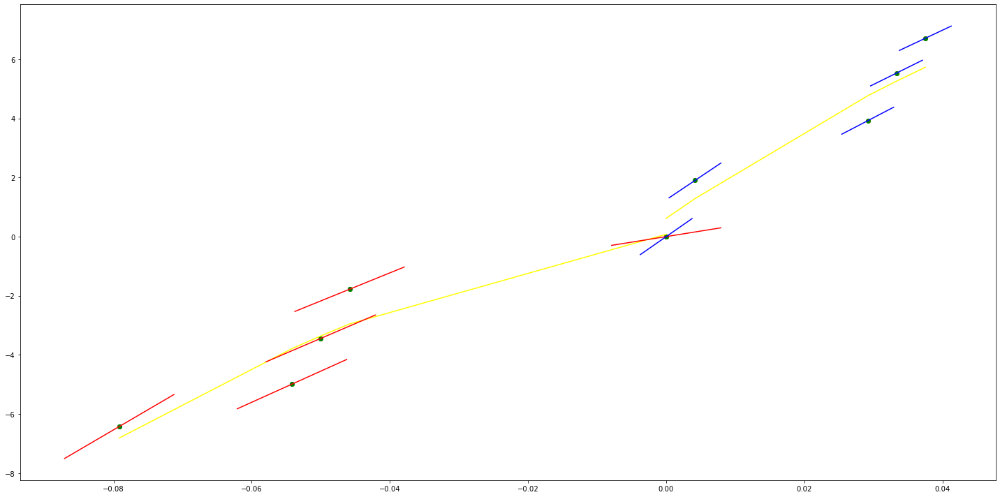

parameters (523.9718083665077, 170.97195171195926, 0.08114507815157322)
tangent[0]:127.3072850335447
tangent[1]:136.04084713539766
tangent[2]:140.4065802427074
tangent[3]:144.77336129363388
tangent[4]:170.97195171195926
parameters (346.26459762919484, 60.35780754479881, 1.5634192553538253)
tangent[0]:60.35780754479881
tangent[1]:63.24357670144052
tangent[2]:66.12865332888697
tangent[3]:100.75511309180646
tangent[4]:118.0683429732662


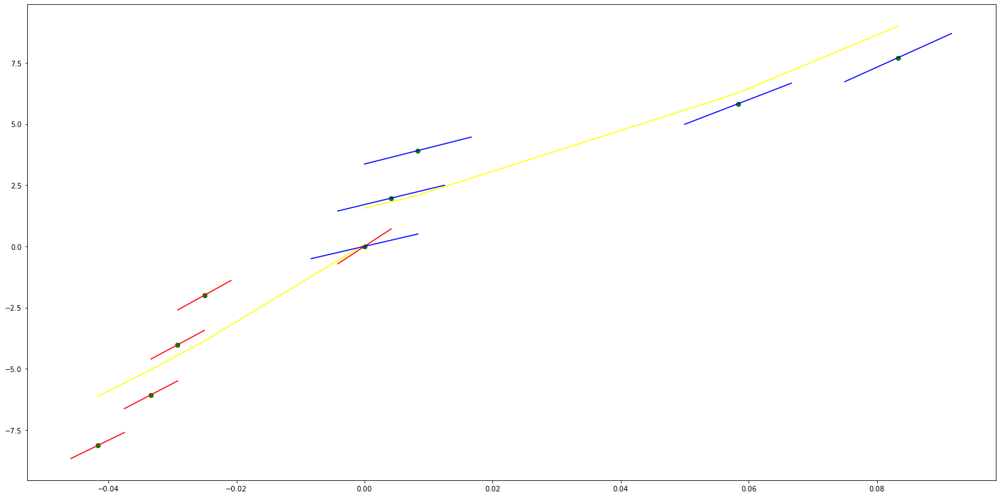

parameters (11.56357812955653, 22.17030268233213, -1.5043082452139558)
tangent[0]:16.195795024446678
tangent[1]:19.95395791655255
tangent[2]:21.206663462483668
tangent[3]:21.977584089224944
tangent[4]:22.17030268233213
parameters (-619.7946788383779, 246.72589216989664, 0.7265861727487666)
tangent[0]:246.72589216989664
tangent[1]:241.5605233164576
tangent[2]:236.39639405237622
tangent[3]:226.06565634549816
tangent[4]:220.9015270814168


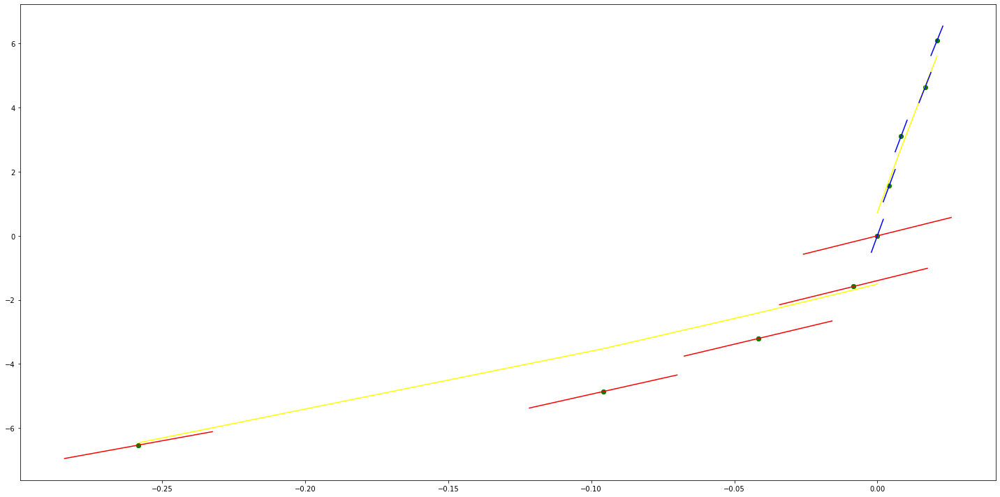

parameters (-24.231994854878803, 4.105688067855523, -0.9549322406490398)
tangent[0]:24.702883694502503
tangent[1]:23.895134378009978
tangent[2]:8.750137593710724
tangent[3]:5.317287810599463
tangent[4]:4.105688067855523
parameters (-141.61813352349037, 69.77982819043501, 1.1030771016652139)
tangent[0]:69.77982819043501
tangent[1]:68.59958266565025
tangent[2]:67.41962037713252
tangent[3]:57.978222651388464
tangent[4]:53.25780702478349


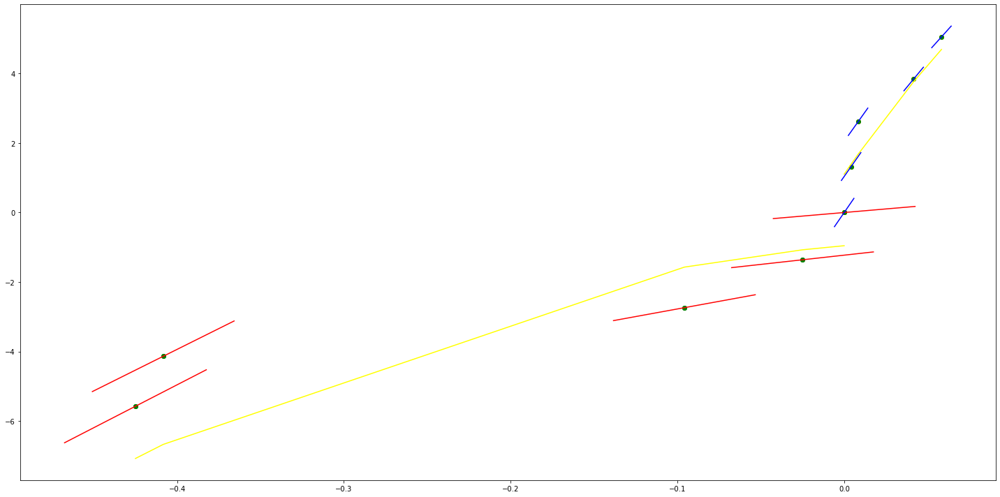

parameters (-0.019390392193287857, -2.8645498322030547, 0.02219630242504677)
tangent[0]:-2.7766467079998884
tangent[1]:-2.798622498745876
tangent[2]:-2.8149427325816316
tangent[3]:-2.843866760123809
tangent[4]:-2.8645498322030547
parameters (-1007.0662250675555, 407.04022682027943, -1.9309503425527804e-05)
tangent[0]:407.04022682027943
tangent[1]:-415.3965189407408
tangent[2]:-423.78940886045376
tangent[3]:-432.18229878016683
tangent[4]:-440.5731745674297


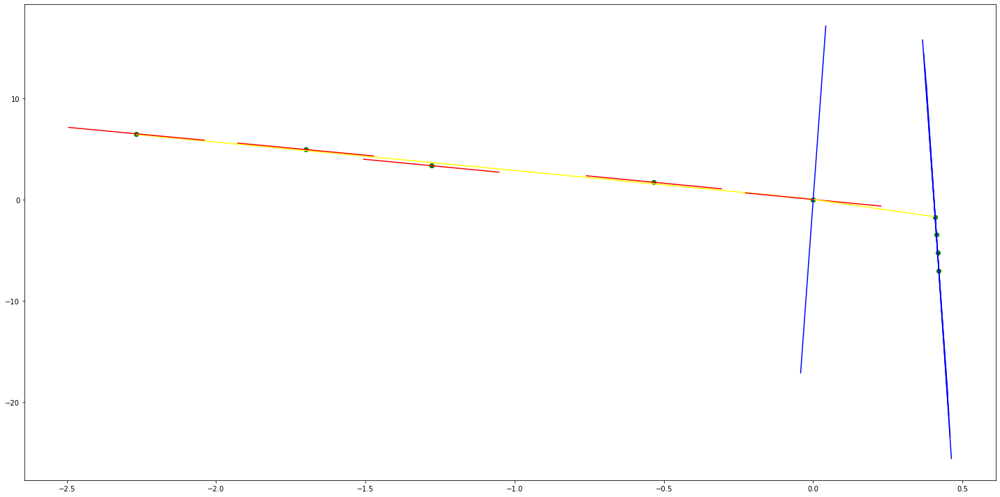

parameters (-3228.818141893546, -446.10369173914523, 0.42683283875927186)
tangent[0]:-311.57175503900874
tangent[1]:-338.4742677972658
tangent[2]:-365.3832381918066
tangent[3]:-419.19472134460443
tangent[4]:-446.10369173914523
parameters (222.6339818633122, -182.2152802958382, -0.9112633719534072)
tangent[0]:-182.2152802958382
tangent[1]:-180.35984869098937
tangent[2]:-172.93901280752144
tangent[3]:-165.51773165608978
tangent[4]:-158.09645050465815


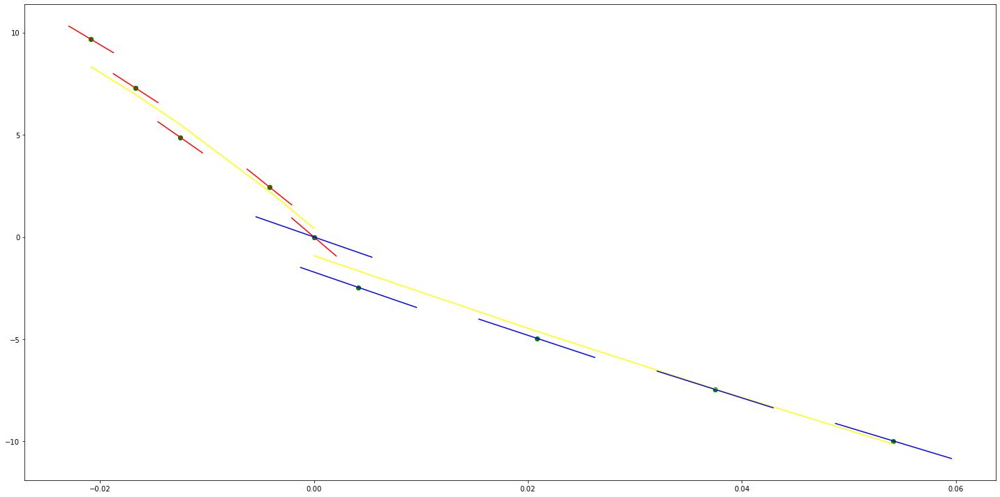

parameters (-2.857539598174079, 101.05222041422667, -4.663611343793789e-05)
tangent[0]:101.52847510889595
tangent[1]:101.40941286399843
tangent[2]:101.2903506191009
tangent[3]:101.17128265912419
tangent[4]:101.05222041422667
parameters (-627.6543006810654, 203.33362358046298, -0.230537376045926)
tangent[0]:203.33362358046298
tangent[1]:187.64226606343635
tangent[2]:171.95090854640972
tangent[3]:156.2595510293831
tangent[4]:140.56819351235646


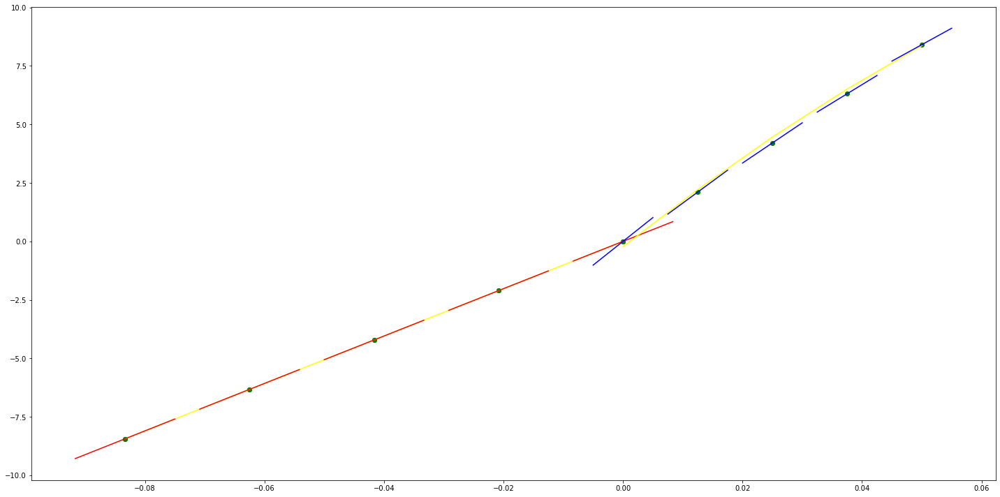

parameters (3.8976417335711266, 41.456000433865654, -0.026034074906353497)
tangent[0]:39.92942668664479
tangent[1]:40.319190860001896
tangent[2]:40.61151399001973
tangent[3]:41.098719206716126
tangent[4]:41.456000433865654
parameters (2777.989219152096, -28.030221267816312, 1.8707941255789373)
tangent[0]:-28.030221267816312
tangent[1]:-4.878459115402745
tangent[2]:18.26774705857252
tangent[3]:249.76870064739333
tangent[4]:272.92046279980684


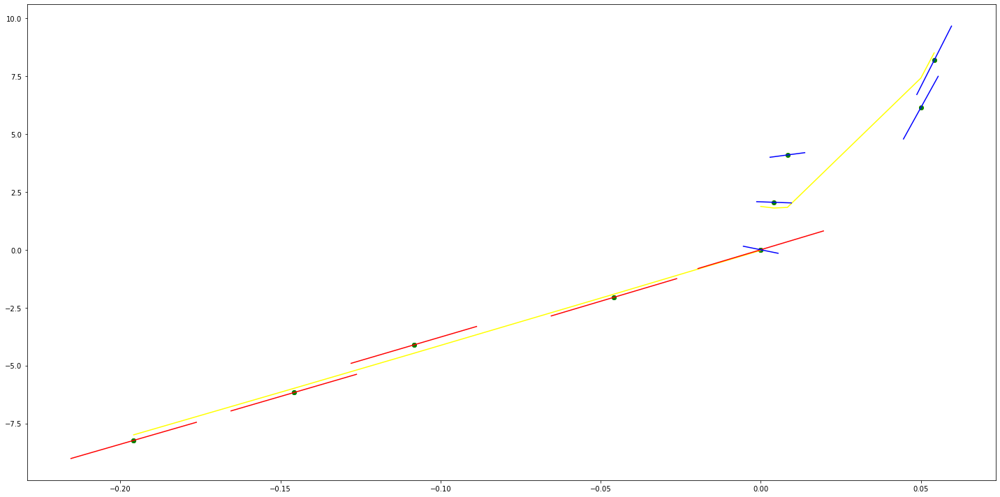

parameters (1.6990153396669108, 15.606472040886567, -0.4287043805830889)
tangent[0]:13.35527671582791
tangent[1]:13.992407468203002
tangent[2]:14.572903243245637
tangent[3]:15.252509379112402
tangent[4]:15.606472040886567
parameters (-187.39201513939233, 101.48192752701708, 3.535818976768843)
tangent[0]:101.48192752701708
tangent[1]:99.92020247284538
tangent[2]:98.35885220270397
tangent[3]:96.79712714853227
tangent[4]:85.86580133739096


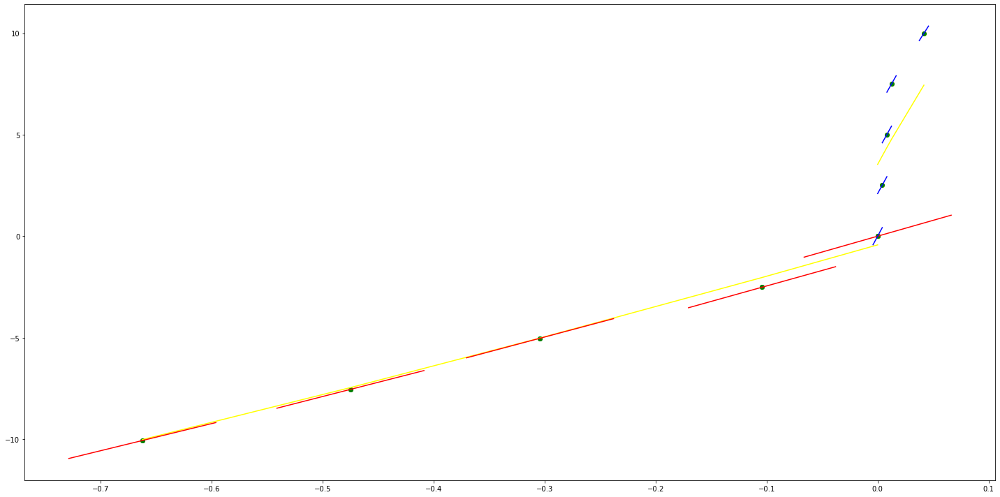

parameters (-440.33320866119436, -350.91732638553043, -0.594217236080058)
tangent[0]:-325.2309289914883
tangent[1]:-332.5704029134531
tangent[2]:-336.23925920801815
tangent[3]:-339.90899616900055
tangent[4]:-350.91732638553043
parameters (1001.2058838856694, -279.0894530909179, -0.6677583310942393)
tangent[0]:-279.0894530909179
tangent[1]:-270.74540325461476
tangent[2]:-245.715256157473
tangent[3]:-229.02915889663444
tangent[4]:-203.9990117994927


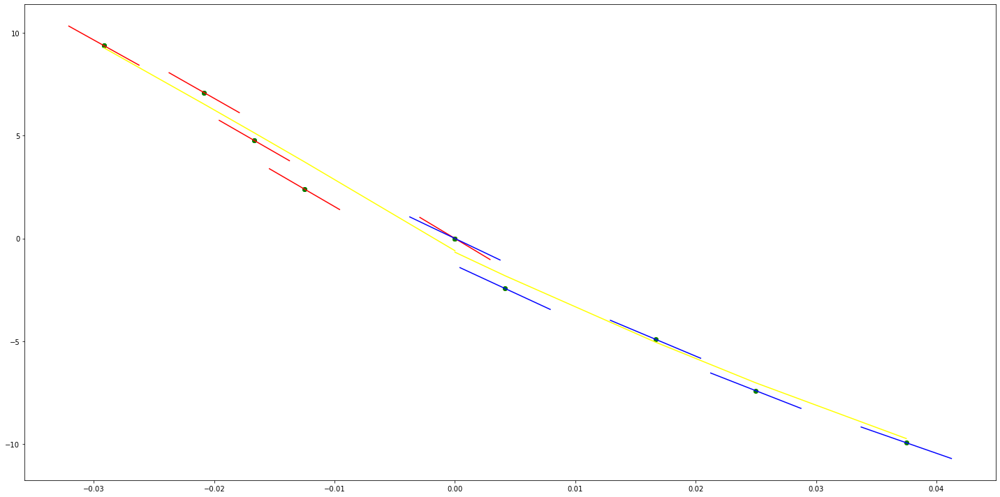

parameters (-814.0224749965503, -244.34204630061478, 1.9387271630010712)
tangent[0]:-169.723862107581
tangent[1]:-210.4249858574085
tangent[2]:-230.77554773232228
tangent[3]:-237.55798299399353
tangent[4]:-244.34204630061478
parameters (-359.14377839903347, -86.47210481788376, -1.9051927411980054)
tangent[0]:-86.47210481788376
tangent[1]:-89.46520906706131
tangent[2]:-98.44380352703715
tangent[3]:-134.3581813669405
tangent[4]:-146.32916178853708


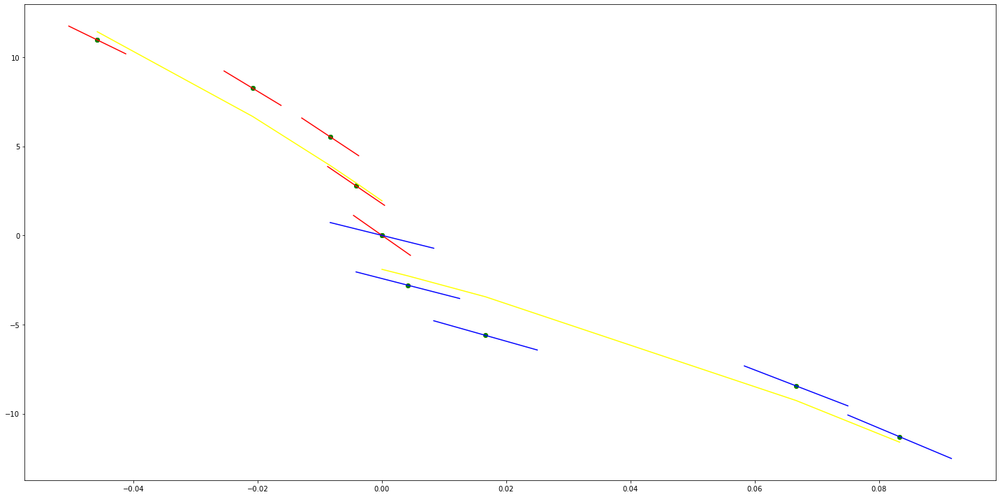

parameters (-444.8174555986086, 1.344938224509815, -0.1563875441914147)
tangent[0]:105.13597440915557
tangent[1]:101.42886573419676
tangent[2]:60.654228849294704
tangent[3]:56.94712017433589
tangent[4]:1.344938224509815
parameters (-105.3710213125752, 63.8282544765656, 2.1324018192090195)
tangent[0]:63.8282544765656
tangent[1]:62.95009238494659
tangent[2]:59.43786550255584
tangent[3]:56.80358996974146
tangent[4]:55.925427878122456


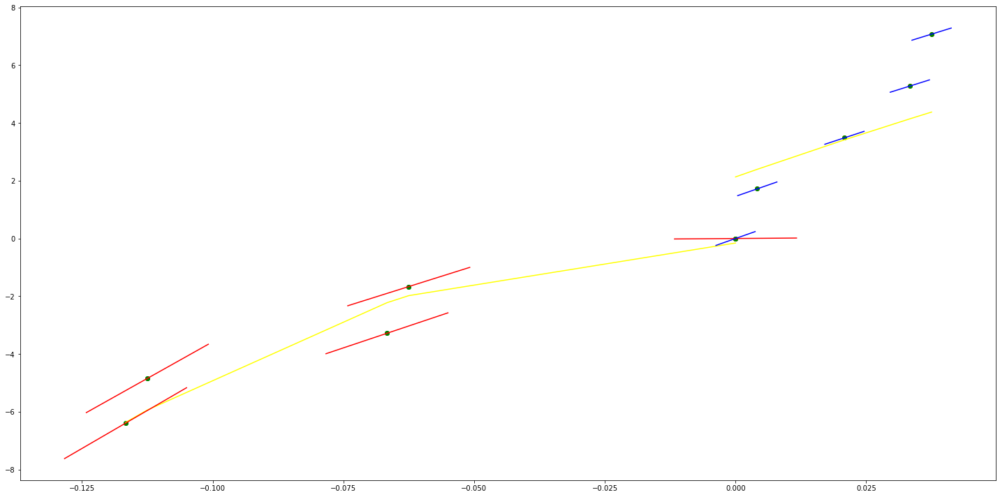

parameters (56.69154338205754, 119.02666876909056, -1.33932349578498)
tangent[0]:111.4677585237873
tangent[1]:113.3575144308848
tangent[2]:118.08184750708519
tangent[3]:118.5542014465445
tangent[4]:119.02666876909056
parameters (-686.0482179134927, 212.551454288422, 0.19427804179114938)
tangent[0]:212.551454288422
tangent[1]:206.83392844033096
tangent[2]:172.5315175446563
tangent[3]:166.8153637930011
tangent[4]:149.6641583451638


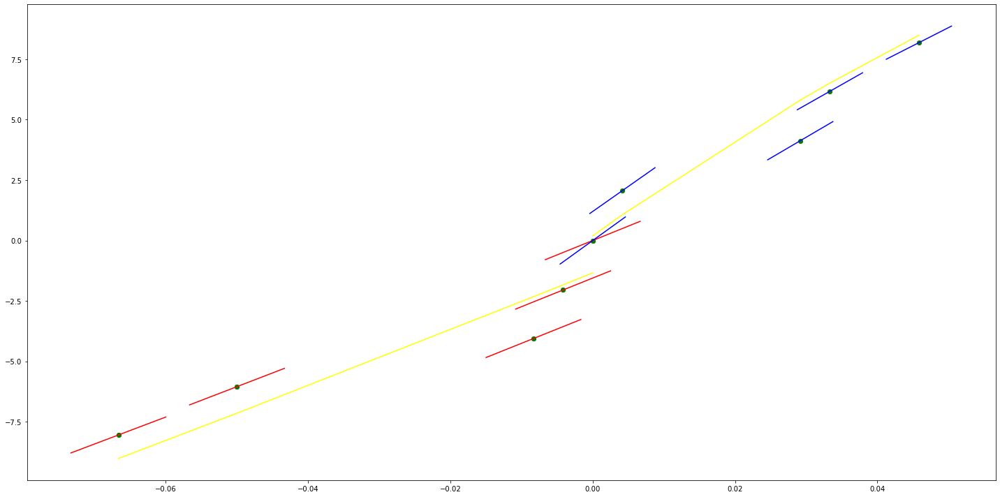

parameters (-534.6972798670239, 167.9953759687222, -0.5032681711109291)
tangent[0]:199.18640709248515
tangent[1]:185.81897509580955
tangent[2]:176.906640834986
tangent[3]:172.45154309913397
tangent[4]:167.9953759687222
parameters (3.040192218602984, 28.375843287953572, 0.5138520146293531)
tangent[0]:28.375843287953572
tangent[1]:28.40118024990341
tangent[2]:28.882539964259255
tangent[3]:29.11055438065448
tangent[4]:29.38924272094938


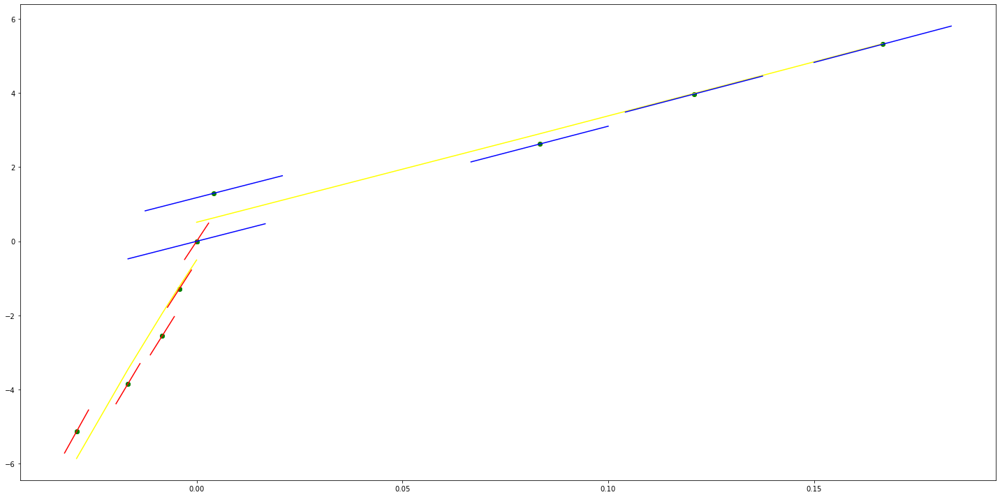

parameters (0.11747717399111192, 8.406912410314233, -0.5171323565870328)
tangent[0]:8.184684834499162
tangent[1]:8.24733917065819
tangent[2]:8.316846655239162
tangent[3]:8.372648312884941
tangent[4]:8.406912410314233
parameters (-140.82292263442758, 100.40944799497358, 0.5318160062511375)
tangent[0]:100.40944799497358
tangent[1]:99.23582975773826
tangent[2]:88.67411056015618
tangent[3]:80.45962783704476
tangent[4]:74.59181829671343


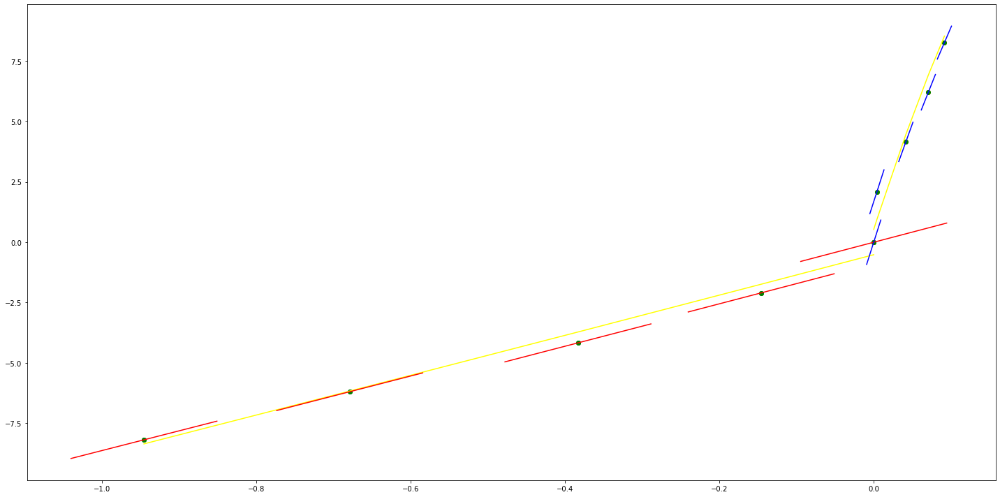

parameters (-341.8814443859223, 119.1772698698889, -1.4121265243109675)
tangent[0]:156.2146542659934
tangent[1]:139.12058204669728
tangent[2]:124.87506602202468
tangent[3]:122.02650982740118
tangent[4]:119.1772698698889
parameters (1344.5325810010427, 38.994105432002456, 0.8506848346925693)
tangent[0]:38.994105432002456
tangent[1]:50.19943996206514
tangent[2]:128.62871447701798
tangent[3]:195.8553435270701
tangent[4]:207.0606780571328


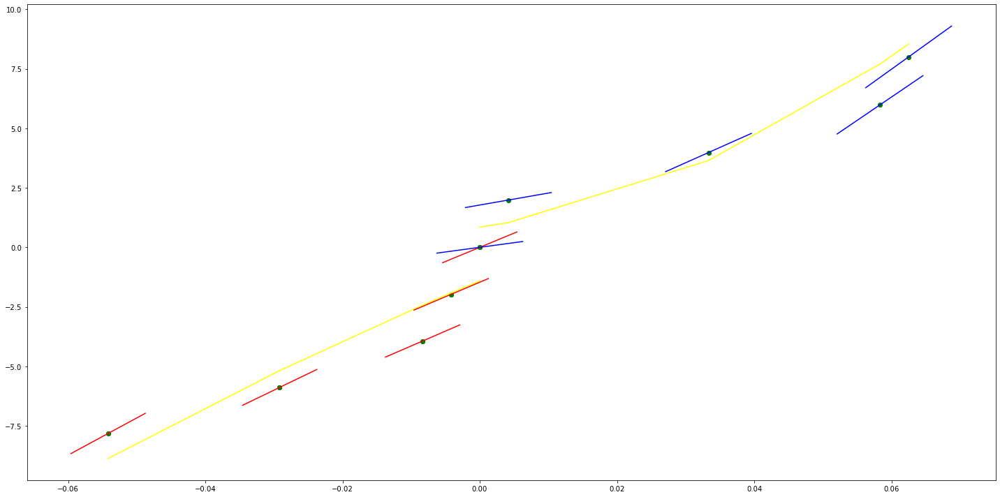

parameters (-10.606475812258635, 148.67087830610106, 0.7436321306235316)
tangent[0]:149.7315258873269
tangent[1]:149.64313151790756
tangent[2]:149.5547583614398
tangent[3]:149.46636399202046
tangent[4]:148.67087830610106
parameters (-819.9595205101925, 210.88753174611554, 1.5892586308979915)
tangent[0]:210.88753174611554
tangent[1]:204.0539891021836
tangent[2]:197.22208637729267
tangent[3]:190.38854373336073
tangent[4]:142.55702506391916


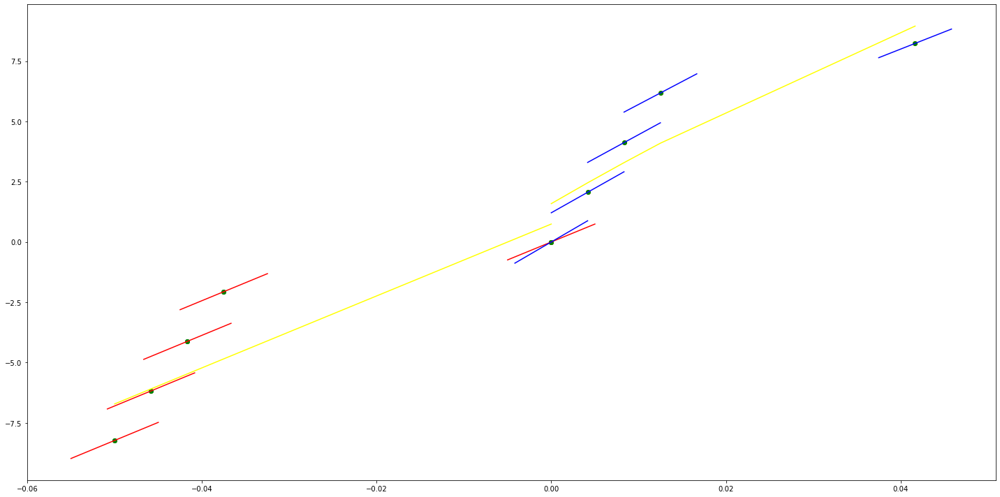

parameters (-2108.2565034347813, -147.88364183845098, -0.0667189430581616)
tangent[0]:291.3378685481307
tangent[1]:256.19744914887985
tangent[2]:238.63145596226119
tangent[3]:168.35483367676622
tangent[4]:-147.88364183845098
parameters (-117.06606402448779, 67.74310636280738, 2.0141709357449127)
tangent[0]:67.74310636280738
tangent[1]:66.7674777852273
tangent[2]:65.79208333977527
tangent[3]:64.81645476219519
tangent[4]:49.20756818155414


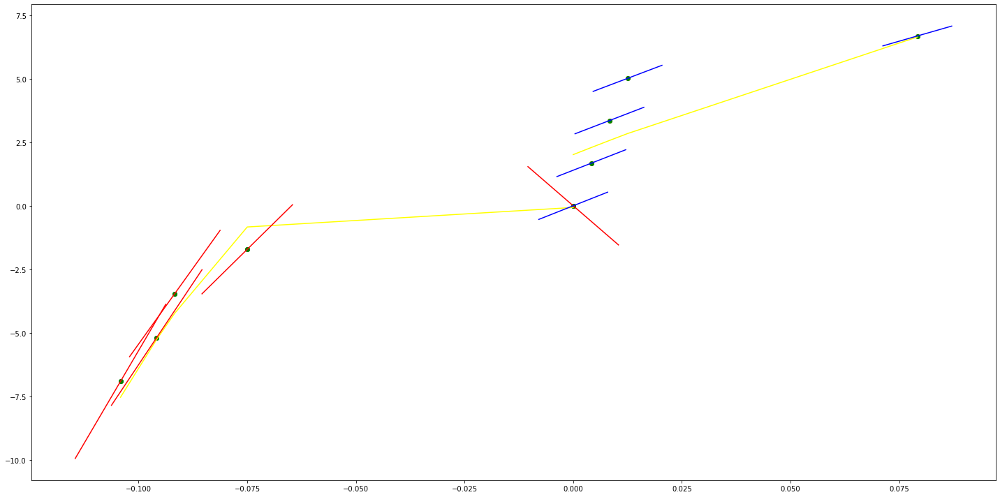

parameters (-0.048550263193966776, -3.628691168051944, 0.742667919159579)
tangent[0]:-3.1686774242891085
tangent[1]:-3.3050227791256743
tangent[2]:-3.4284213323768307
tangent[3]:-3.5514153648350555
tangent[4]:-3.628691168051944
parameters (-47.50795235942288, 120.31773000834646, 0.0003999320874641079)
tangent[0]:120.31773000834646
tangent[1]:-123.77071797380025
tangent[2]:-126.9378831257935
tangent[3]:-130.1050482777868
tangent[4]:-133.2723084456848


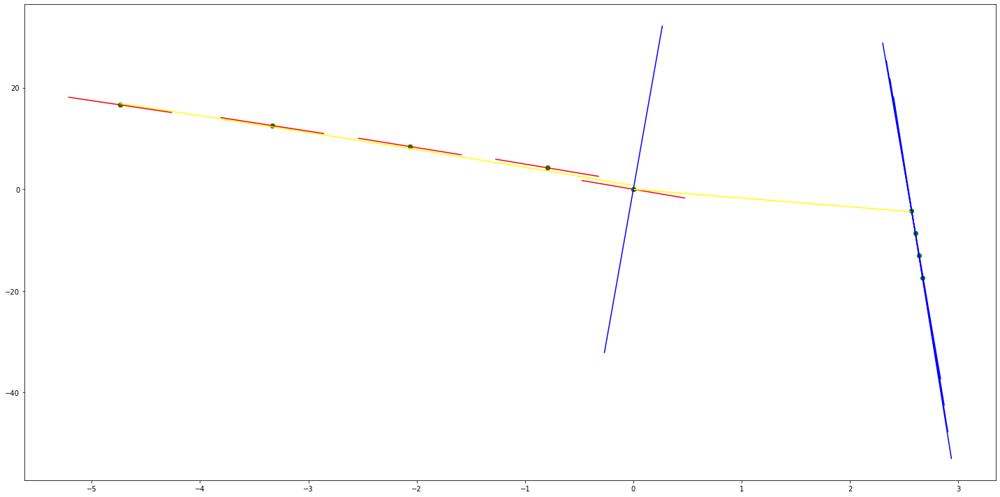

parameters (39.16302380952379, 20.52981785714286, -0.0012084166666673963)
tangent[0]:4.864608333333342
tangent[1]:8.780910714285723
tangent[2]:12.697213095238101
tangent[3]:16.61351547619048
tangent[4]:20.52981785714286
parameters (7.252969047619118, -33.99868654761906, -0.0032883749999965553)
tangent[0]:-33.99868654761906
tangent[1]:-33.27338964285715
tangent[2]:-32.548092738095235
tangent[3]:-31.822795833333323
tangent[4]:-31.09749892857141


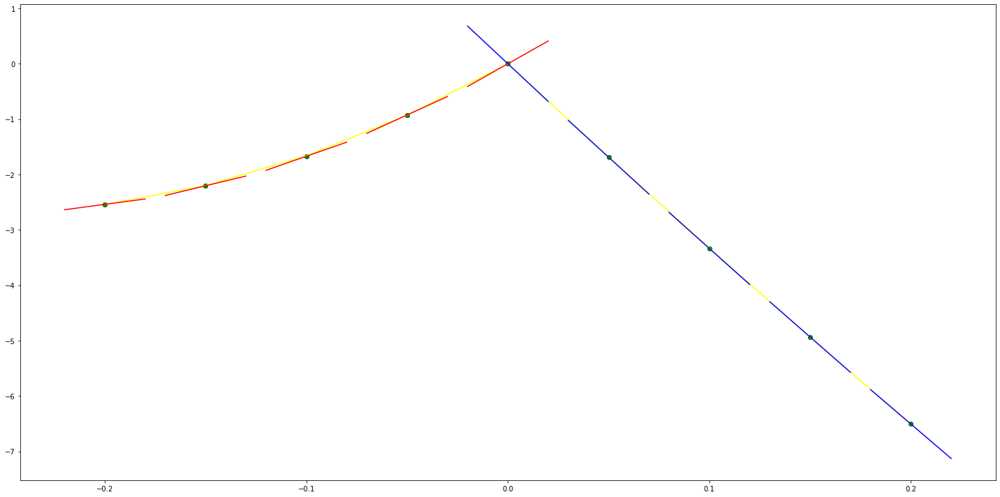

parameters (355.1575257664992, 139.0498493912599, 0.3400887603433622)
tangent[0]:109.45315213903444
tangent[1]:112.41303495877246
tangent[2]:115.37291777851047
tangent[3]:118.33209028319693
tangent[4]:139.0498493912599
parameters (116.32160186231684, 57.67195403454779, 0.6629000815906273)
tangent[0]:57.67195403454779
tangent[1]:58.64137826446834
tangent[2]:69.30411422077947
tangent[3]:74.15077008397476
tangent[4]:80.93627440701115


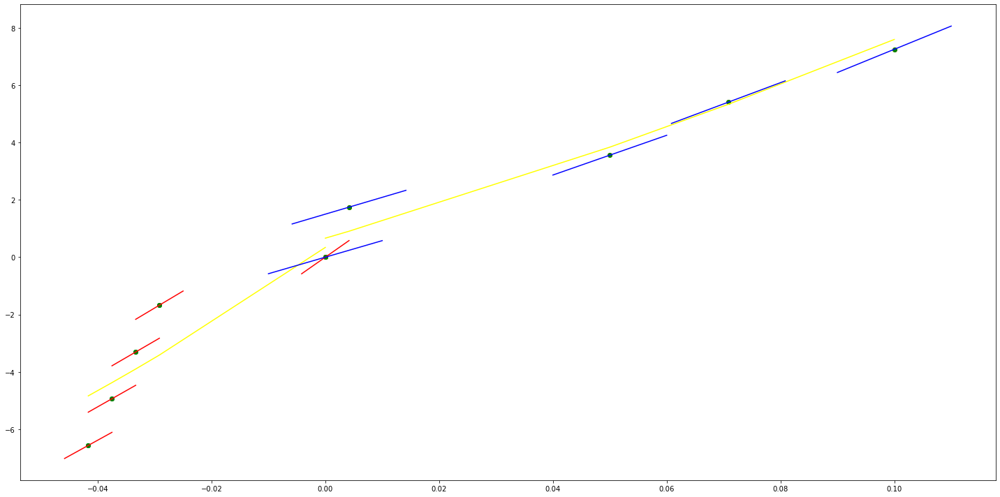

parameters (170.6628129089236, 128.8958881047682, 0.04425048002261243)
tangent[0]:101.87416228564669
tangent[1]:103.29646616842966
tangent[2]:113.25191069665881
tangent[3]:124.62931778204512
tangent[4]:128.8958881047682
parameters (-442.36084703447466, 169.34883958034123, 1.351835480624107)
tangent[0]:169.34883958034123
tangent[1]:165.66220428115594
tangent[2]:161.97645370366467
tangent[3]:136.17177605275563
tangent[4]:110.36709840184659


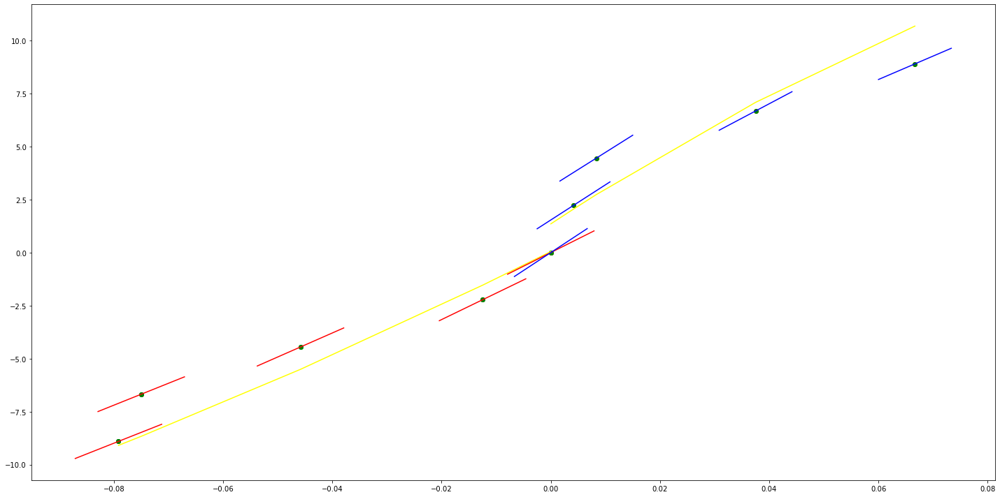

parameters (0.7575825347349519, 104.39501973908973, 0.5276537040440513)
tangent[0]:104.29400822940339
tangent[1]:104.30032192224786
tangent[2]:104.30663561509235
tangent[3]:104.3508269195085
tangent[4]:104.39501973908973
parameters (-546.6830762221076, 189.62286951905156, 0.873150265819246)
tangent[0]:189.62286951905156
tangent[1]:185.06681276181652
tangent[2]:180.51184937073393
tangent[3]:153.17769555962855
tangent[4]:148.62163880239348


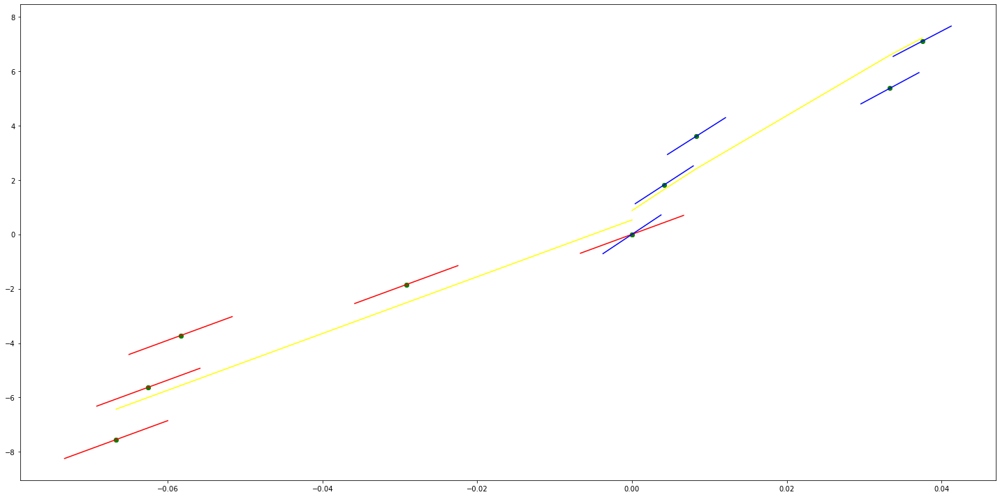

parameters (-19.320633121855256, 2.581415450215108, -0.5357135736437517)
tangent[0]:18.520937775745693
tangent[1]:13.529761338844338
tangent[2]:10.953702683441133
tangent[3]:2.74243360665265
tangent[4]:2.581415450215108
parameters (-70.62959658931481, 44.746763462728005, 0.42073704826714364)
tangent[0]:44.746763462728005
tangent[1]:44.15813640475265
tangent[2]:39.44954371852939
tangent[3]:31.20947120284039
tangent[4]:30.62084414486504


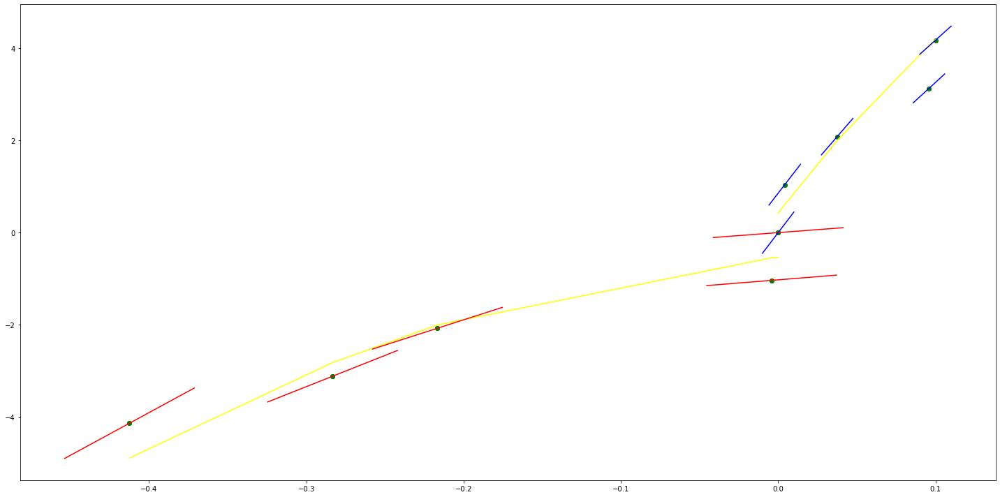

parameters (851.4070959737288, -456.3734815477257, 0.3010091752814119)
tangent[0]:-491.8482096085671
tangent[1]:-484.75428568491395
tangent[2]:-477.65865894706894
tangent[3]:-463.46910828557077
tangent[4]:-456.3734815477257
parameters (3389.527498756469, -505.7571792168652, -0.5458027584914691)
tangent[0]:-505.7571792168652
tangent[1]:-477.5088570422288
tangent[2]:-421.01899174795346
tangent[3]:-392.77066957331704
tangent[4]:-364.52912645367815


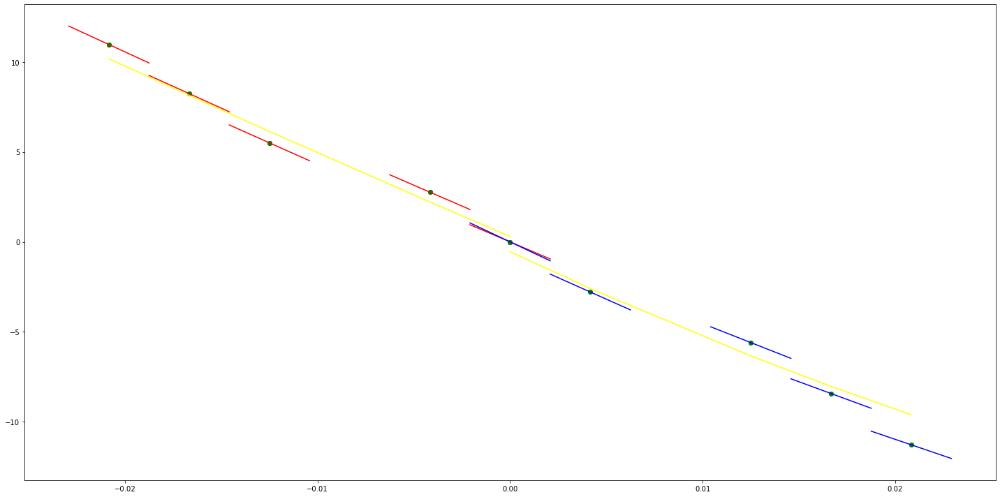

parameters (-4787.42160356144, -625.7137781443353, 0.054204817217395715)
tangent[0]:-426.2410696103443
tangent[1]:-466.12986641121825
tangent[2]:-506.02823805529925
tangent[3]:-585.8154065002542
tangent[4]:-625.7137781443353
parameters (492.36253156942934, -248.14075573200668, -1.0017312448835771)
tangent[0]:-248.14075573200668
tangent[1]:-244.03740639390705
tangent[2]:-227.62597849163484
tangent[3]:-215.31691520239912
tangent[4]:-198.90450257506376


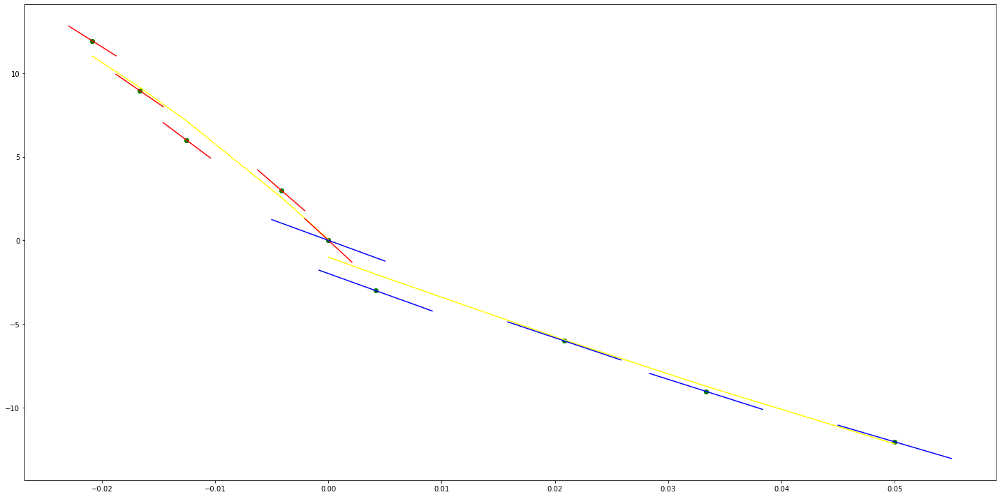

parameters (0.48525588795435876, 0.8200738443116756, -0.14021253116824972)
tangent[0]:0.17306567020193864
tangent[1]:0.4480446537172592
tangent[2]:0.7230226667208038
tangent[3]:0.816029721741464
tangent[4]:0.8200738443116756
parameters (-174.06033969454154, 41.96855412420282, 0.10523476846608765)
tangent[0]:41.96855412420282
tangent[1]:40.51793525318851
tangent[2]:37.61704563183928
tangent[3]:36.16642676082497
tangent[4]:34.71615601049005


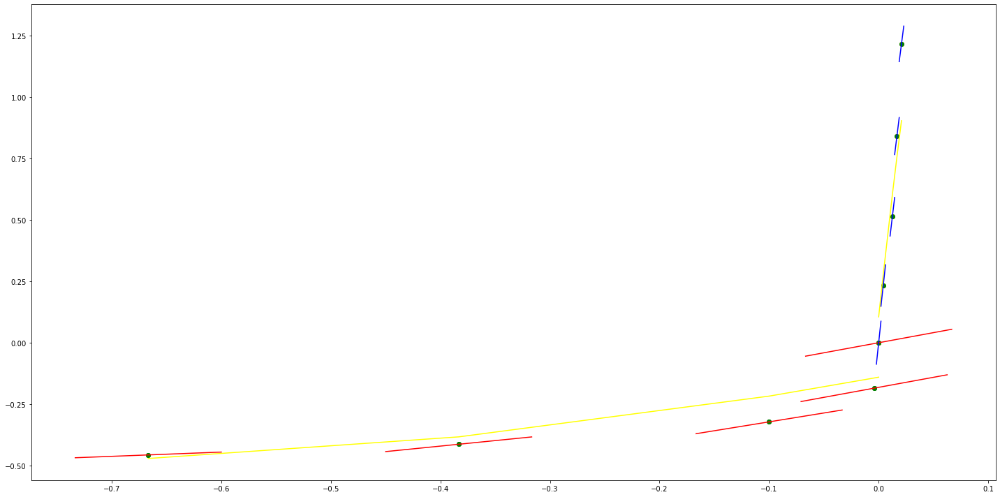

parameters (-68.25261527946097, 36.00422416282227, -0.2913945734407194)
tangent[0]:62.73645297886763
tangent[1]:62.16777218835916
tangent[2]:49.08592992297544
tangent[3]:42.260668395029334
tangent[4]:36.00422416282227
parameters (-125.5521353294696, 88.70477729467527, 1.7541626540500945)
tangent[0]:88.70477729467527
tangent[1]:87.65842579883947
tangent[2]:83.47352202403759
tangent[3]:74.05711187432736
tangent[4]:61.50189834138041


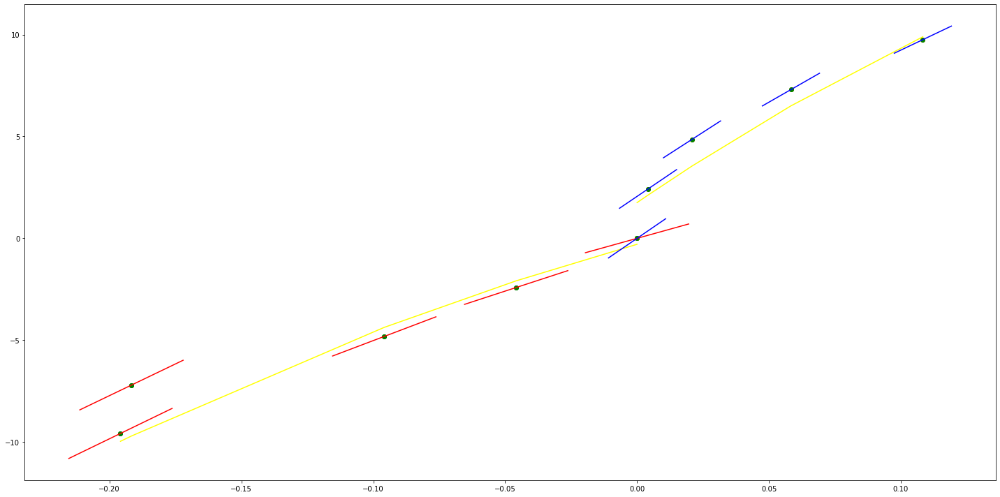

parameters (0.1278747153647315, 5.762903790348677, -0.24940622877680885)
tangent[0]:5.456004473473321
tangent[1]:5.55084480211902
tangent[2]:5.62650417920944
tangent[3]:5.708557036318666
tangent[4]:5.762903790348677
parameters (-169.47641885908092, 89.65539640174418, 0.7830556754000815)
tangent[0]:89.65539640174418
tangent[1]:84.00606945549558
tangent[2]:74.12017099060768
tangent[3]:72.70775451583609
tangent[4]:71.29533804106451


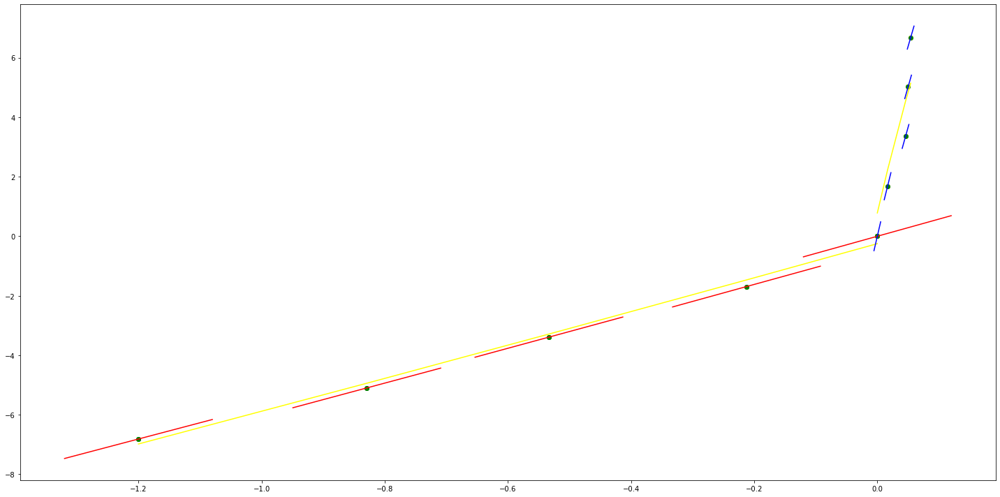

parameters (-96.33832434662887, 30.32752289879906, -0.6737464010948452)
tangent[0]:58.42613660768291
tangent[1]:55.214987580561086
tangent[2]:43.172697037232474
tangent[3]:31.130406493903866
tangent[4]:30.32752289879906
parameters (-75.5202857384156, 96.11479922841087, 0.8158060903583103)
tangent[0]:96.11479922841087
tangent[1]:95.48541316706692
tangent[2]:92.96817100283405
tangent[3]:90.4507777980297
tangent[4]:84.15737030630459


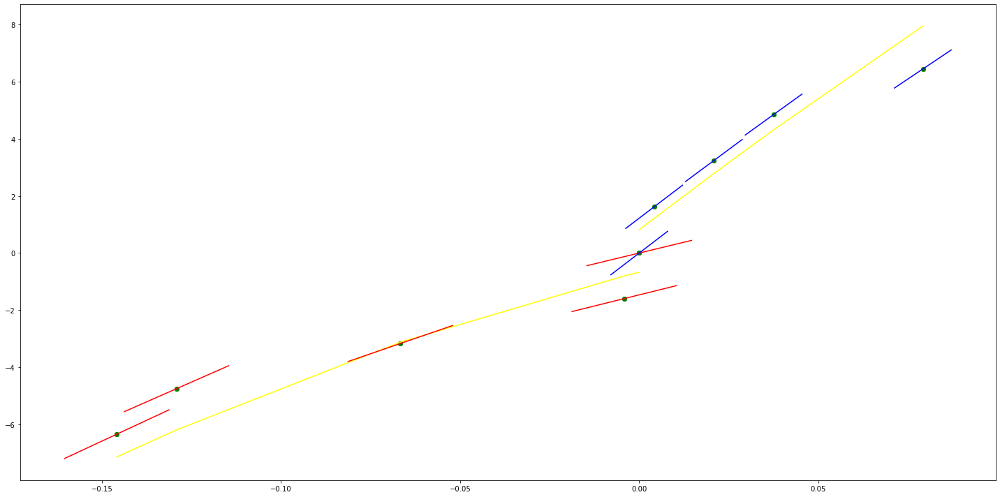

parameters (222.12188317846616, 115.42040819351213, -1.3038516458530145)
tangent[0]:98.76126695512717
tangent[1]:100.6124307295365
tangent[2]:102.46359450394584
tangent[3]:113.56968866286915
tangent[4]:115.42040819351213
parameters (-45.94453988034835, 49.57194802657428, 0.6414056291005048)
tangent[0]:49.57194802657428
tangent[1]:49.18904623121146
tangent[2]:41.91446345379639
tangent[3]:34.639972565461065
tangent[4]:34.257070770098245


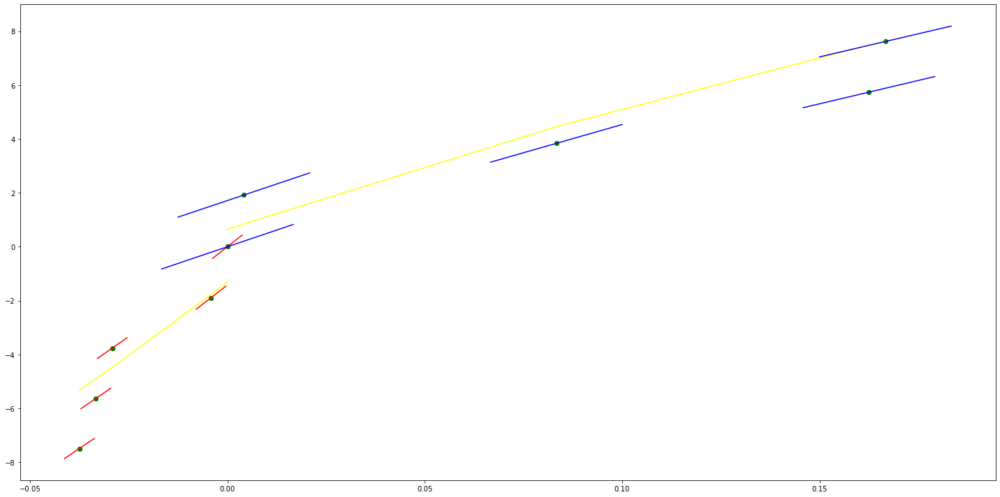

parameters (-252.74679063618726, -1.9830366868866547, -0.950412420288077)
tangent[0]:82.26555652945493
tangent[1]:80.15967026987421
tangent[2]:48.5663214403508
tangent[3]:0.12284957269405772
tangent[4]:-1.9830366868866547
parameters (-68.93182744526007, 59.12790802277808, 0.8089580660350874)
tangent[0]:59.12790802277808
tangent[1]:58.55343017284928
tangent[2]:49.93695174219177
tangent[3]:49.362473892262976
tangent[4]:34.42729056700826


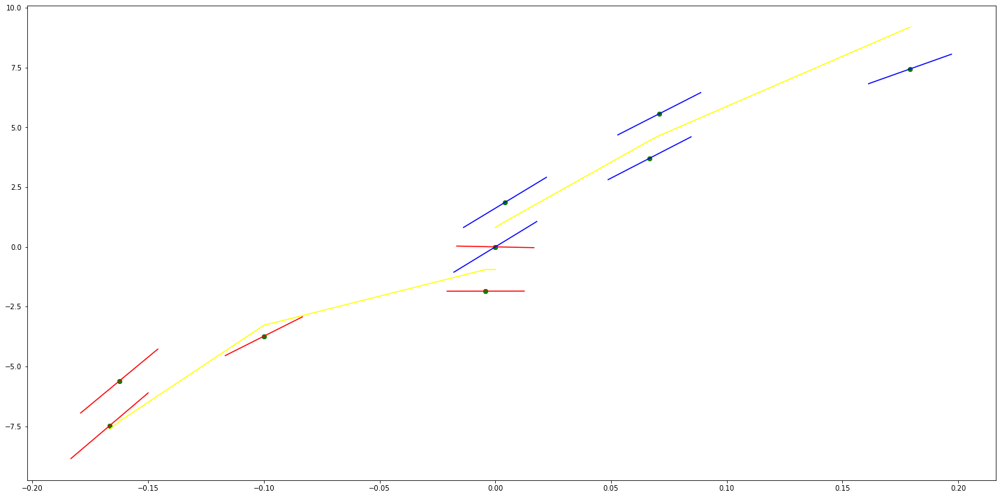

parameters (-0.00027096083520604603, 1.6617535821513516, -0.5550372862234804)
tangent[0]:1.6638106268532387
tangent[1]:1.6632303187032245
tangent[2]:1.6626364630533719
tangent[3]:1.6619861570488774
tangent[4]:1.6617535821513516
parameters (-226.68508116162602, 100.23395625676349, 1.178217521200811)
tangent[0]:100.23395625676349
tangent[1]:98.34521616052483
tangent[2]:96.45602269412383
tangent[3]:70.00958101532157
tangent[4]:68.12038754892058


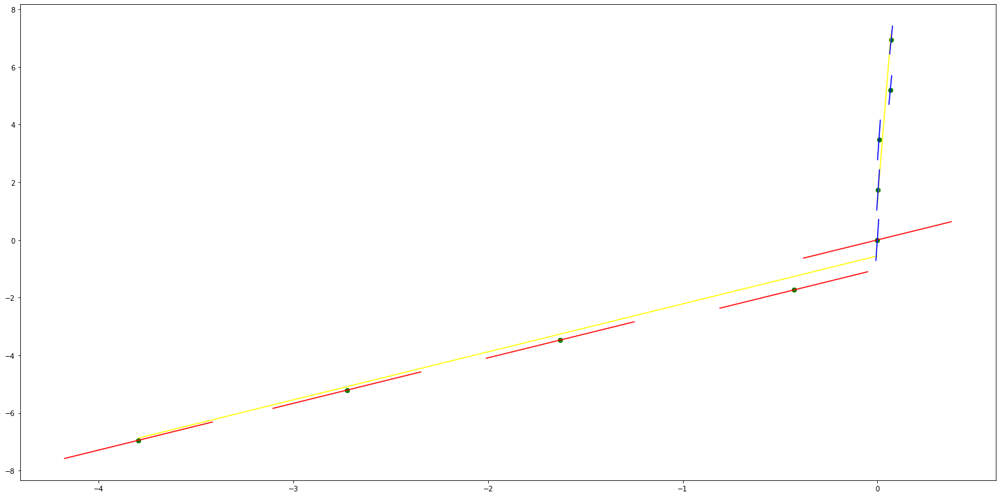

parameters (-16.32877311769146, -8.558319269464615, -0.6818995946898262)
tangent[0]:24.0992269659183
tangent[1]:22.466349654149155
tangent[2]:18.656324365051972
tangent[3]:4.096479896746265
tangent[4]:-8.558319269464615
parameters (-23.177891923208076, 32.650474273798544, 0.4220388451083572)
tangent[0]:32.650474273798544
tangent[1]:31.105296930845952
tangent[2]:28.208060440444946
tangent[3]:25.11765939875592
tangent[4]:22.02730471285074


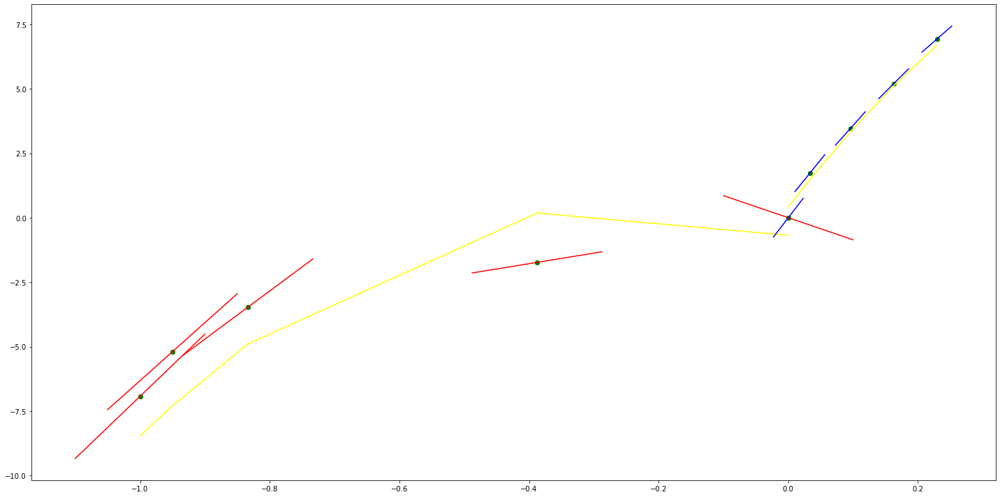

parameters (151.70379602999174, 77.69853164434865, -1.2945050272127727)
tangent[0]:53.678966211327996
tangent[1]:68.84934581432717
tangent[2]:71.37764127896301
tangent[3]:72.64194071507697
tangent[4]:77.69853164434865
parameters (-0.6301849148776582, 8.05796557186761, 0.0444210974221728)
tangent[0]:8.05796557186761
tangent[1]:7.8006396448359565
tangent[2]:7.4855471873971275
tangent[3]:7.196712014621591
tangent[4]:6.876368856472001


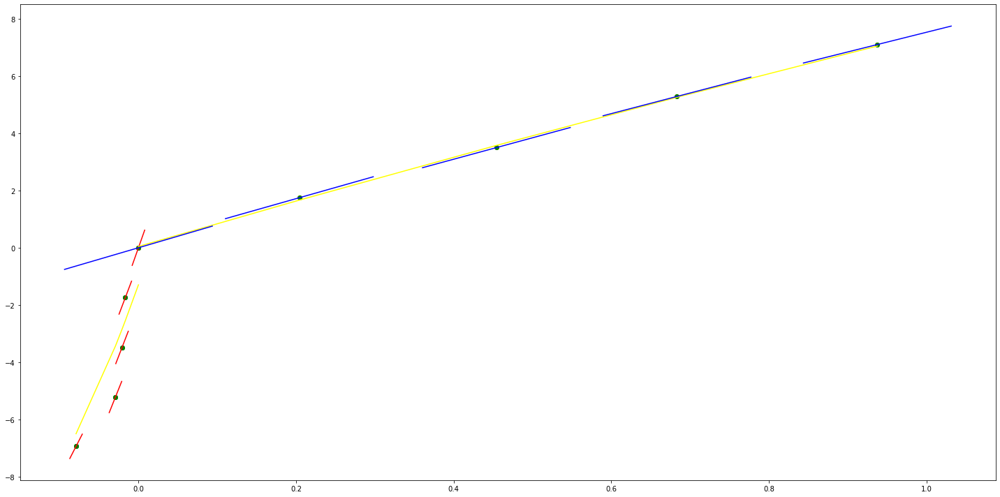

parameters (-0.06336255259873967, 1.0418597281910154, 0.06439515713303304)
tangent[0]:1.42414717111178
tangent[1]:1.3333274701452178
tangent[2]:1.2361715139187819
tangent[3]:1.1601364508002943
tangent[4]:1.0418597281910154
parameters (292.36895956711123, -54.224821048842735, -0.009465025800948714)
tangent[0]:-54.224821048842735
tangent[1]:67.59538385814722
tangent[2]:70.03198676717955
tangent[3]:72.46858967621185
tangent[4]:77.34121075635733


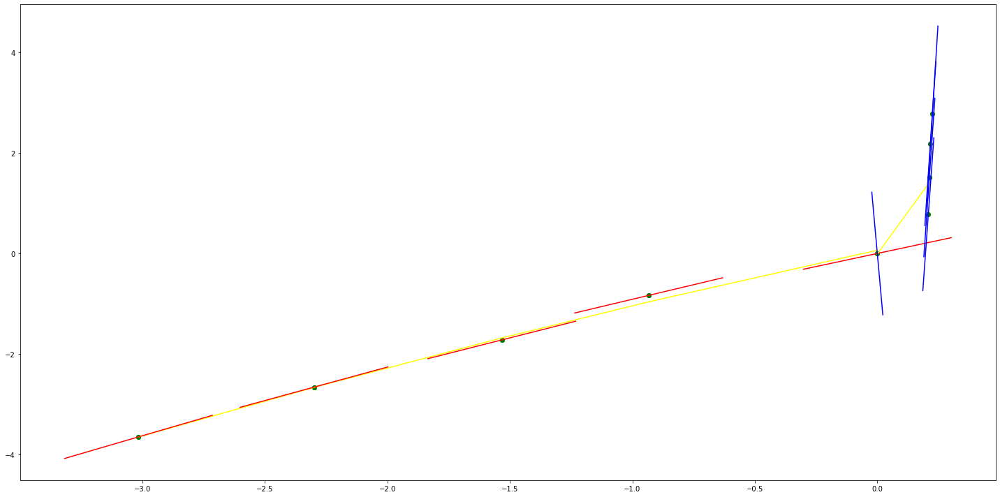

parameters (-0.03678287827356428, 1.1954548912986513, -0.24781781648766815)
tangent[0]:1.3799823061157799
tangent[1]:1.3235818682410625
tangent[2]:1.2794424143127854
tangent[3]:1.2107810660573843
tangent[4]:1.1954548912986513
parameters (-1120.6015005929078, 130.11677001362926, 0.20416474810222793)
tangent[0]:130.11677001362926
tangent[1]:120.77767710768796
tangent[2]:111.43858420174668
tangent[3]:92.76263959286527
tangent[4]:83.42354668692398


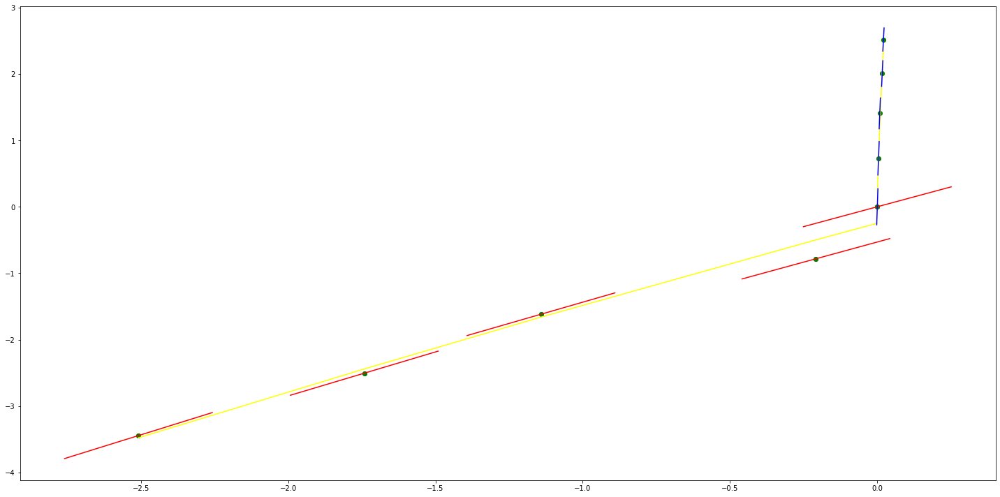

parameters (5734.196945681269, -33.55810148320459, 1.1513795121751427)
tangent[0]:-463.6228724092998
tangent[1]:-415.83407506399215
tangent[2]:-368.05674611257575
tangent[3]:-81.34689882851228
tangent[4]:-33.55810148320459
parameters (482.0792050163074, -244.06426777199562, -1.1880713186042207)
tangent[0]:-244.06426777199562
tangent[1]:-240.0466196773897
tangent[2]:-227.99463955198203
tangent[3]:-211.92597549037845
tangent[4]:-195.85634727036486


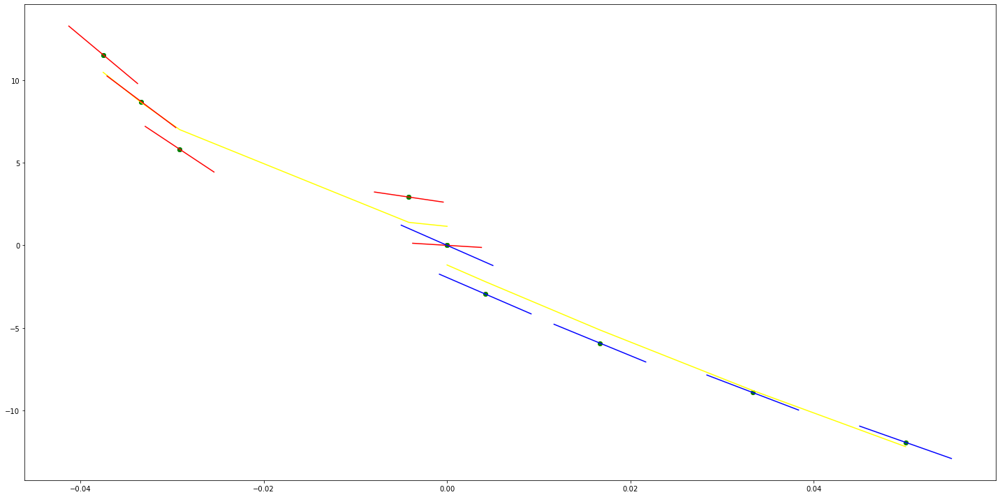

parameters (-0.02101108315602988, 14.937262659771134, 0.006581313038404209)
tangent[0]:14.963526513716172
tangent[1]:14.956697911690462
tangent[2]:14.949694245319897
tangent[3]:14.943916197451989
tangent[4]:14.937262659771134
parameters (-752.2537105276613, 199.930936280178, 2.950249096865562)
tangent[0]:199.930936280178
tangent[1]:193.66315836406153
tangent[2]:187.393875940524
tangent[3]:174.85681560087
tangent[4]:168.58753317733246


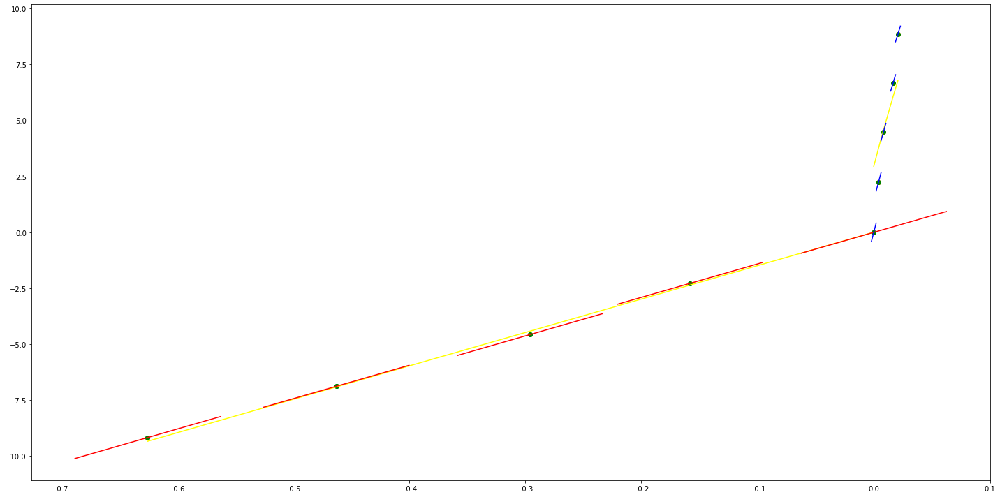

parameters (-92.98305726774994, 20.37692666860578, 0.03488417040643486)
tangent[0]:59.119805208130074
tangent[1]:47.49692304966133
tangent[2]:46.7220022503919
tangent[3]:31.999808827074524
tangent[4]:20.37692666860578
parameters (-52.05422216294724, 68.83593315419095, 1.3931353195209746)
tangent[0]:68.83593315419095
tangent[1]:68.40211326668495
tangent[2]:67.96829337917895
tangent[3]:60.16016005473686
tangent[4]:59.72644427567519


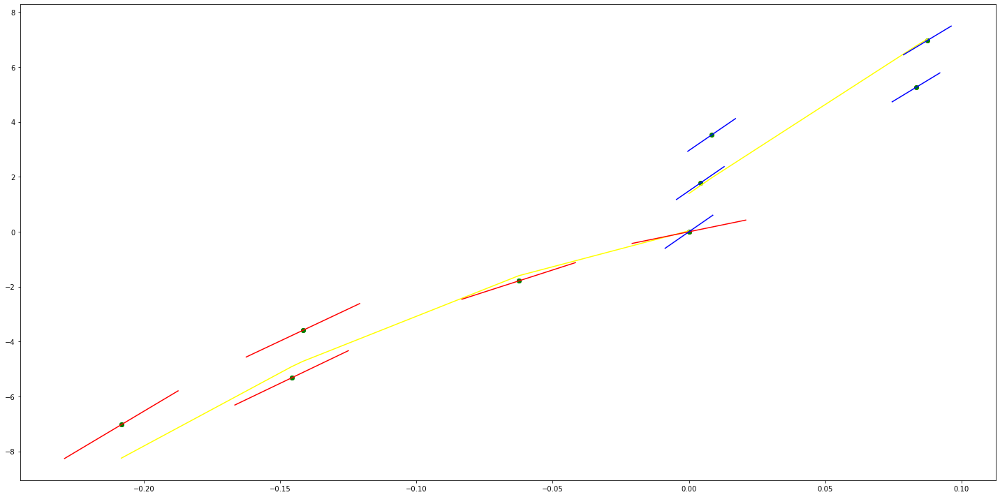

parameters (3.5161004278166286, 14.19086450091944, -0.36639035687389626)
tangent[0]:11.495189850326977
tangent[1]:12.257009265620294
tangent[2]:13.048131861879035
tangent[3]:13.897860820068626
tangent[4]:14.19086450091944
parameters (-286.52835210379163, 100.93100871270721, 0.7676912967572947)
tangent[0]:100.93100871270721
tangent[1]:98.54308142627421
tangent[2]:96.15515413984122
tangent[3]:77.05345501848984
tangent[4]:62.72703741330025


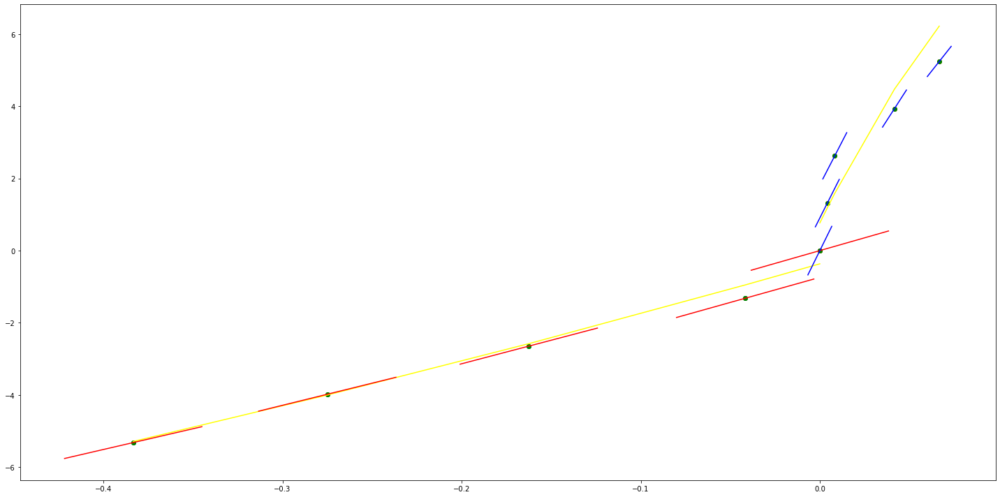

parameters (-859.0778275031571, 1.9898292812739953, -1.5584839328525344)
tangent[0]:145.16889447991517
tangent[1]:138.00933986550385
tangent[2]:23.466774968852924
tangent[3]:9.1476657400303
tangent[4]:1.9898292812739953
parameters (-41.84479660949698, 43.79275887277128, 1.3393232977614493)
tangent[0]:43.79275887277128
tangent[1]:43.444024337827734
tangent[2]:41.003049972409336
tangent[3]:36.81857031145964
tangent[4]:29.844465439741214


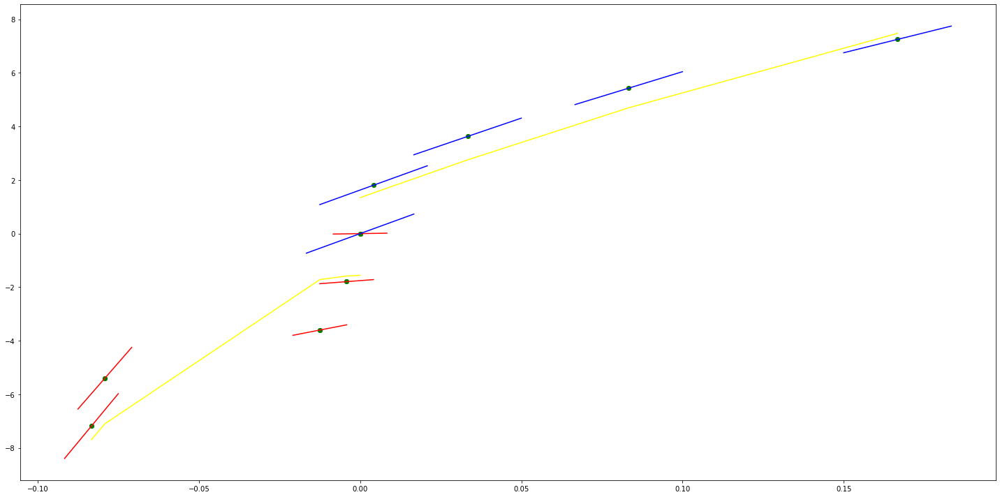

parameters (819.4677384292091, -464.5766130302473, 0.3115245390492377)
tangent[0]:-498.7205558196387
tangent[1]:-491.89275062304654
tangent[2]:-485.06330649097754
tangent[3]:-471.4060571623163
tangent[4]:-464.5766130302473
parameters (265.2774879587448, -210.21719258602752, -1.0446725307617915)
tangent[0]:-210.21719258602752
tangent[1]:-208.00637000137934
tangent[2]:-199.16414077273845
tangent[3]:-190.32138098912165
tangent[4]:-181.47862120550485


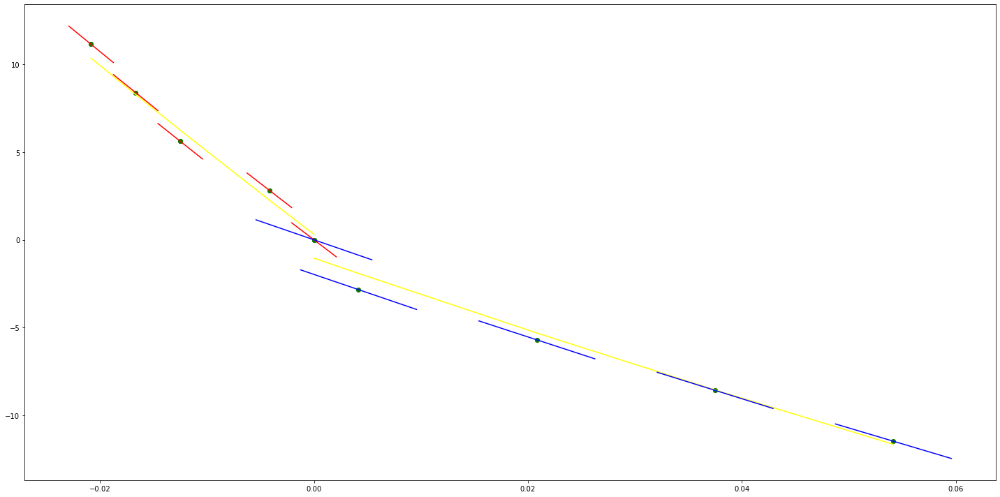

parameters (-1023.1142077813764, 14.252995471377394, -1.883615735301252)
tangent[0]:184.77134802546828
tangent[1]:176.24471421781828
tangent[2]:48.35543824514624
tangent[3]:22.777583050611824
tangent[4]:14.252995471377394
parameters (257.5724130502802, 109.00956196061674, 0.8499065764410263)
tangent[0]:109.00956196061674
tangent[1]:111.15617045097777
tangent[2]:126.18139959385282
tangent[3]:136.9134117560058
tangent[4]:149.7920324085198


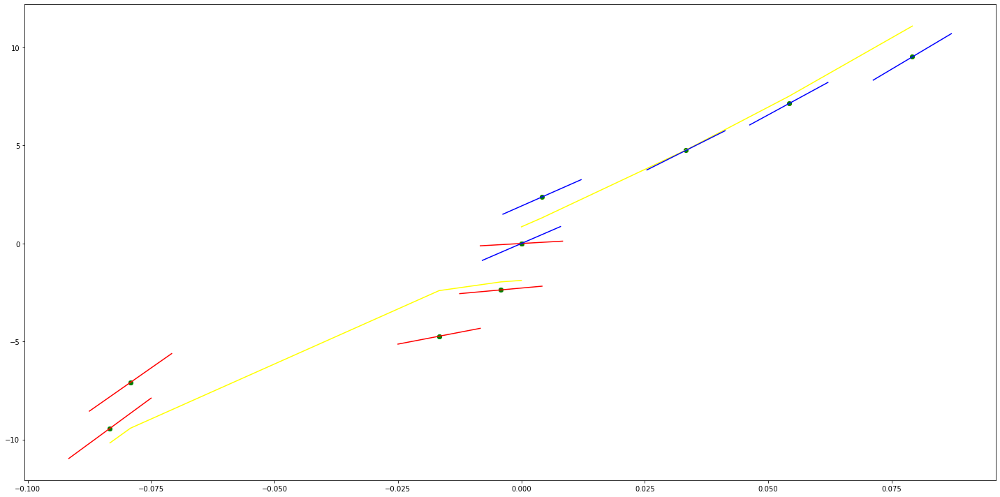

parameters (-7.740907745518666, 30.752811790036922, -0.32926854661531396)
tangent[0]:34.04269758188236
tangent[1]:33.26860680733049
tangent[2]:32.30099333914065
tangent[3]:31.26888262761516
tangent[4]:30.752811790036922
parameters (207.1787277149596, -10.49254996345969, 1.6262369100846021)
tangent[0]:-10.49254996345969
tangent[1]:-8.766336804138646
tangent[2]:3.3192270983858077
tangent[3]:65.47284541287368
tangent[4]:67.19947292965016


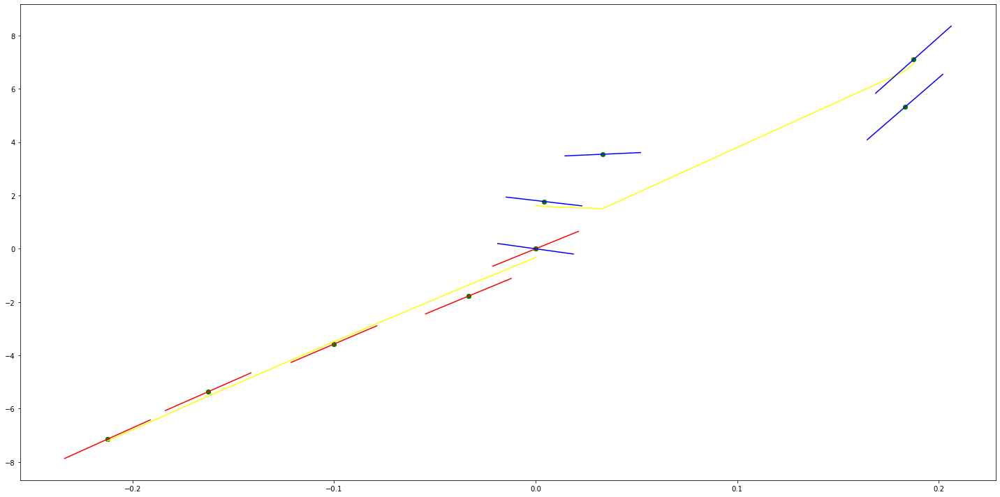

parameters (-29.097445124934517, 22.176975000870787, 0.42927813916340185)
tangent[0]:34.78588728663916
tangent[1]:32.84601881505003
tangent[2]:32.60357890226907
tangent[3]:30.90620853835114
tangent[4]:22.176975000870787
parameters (-253.36543423089694, 105.19792382766184, 0.6686322428489118)
tangent[0]:105.19792382766184
tangent[1]:103.08637629878154
tangent[2]:81.97292793345244
tangent[3]:79.86138040457215
tangent[4]:77.74983287569185


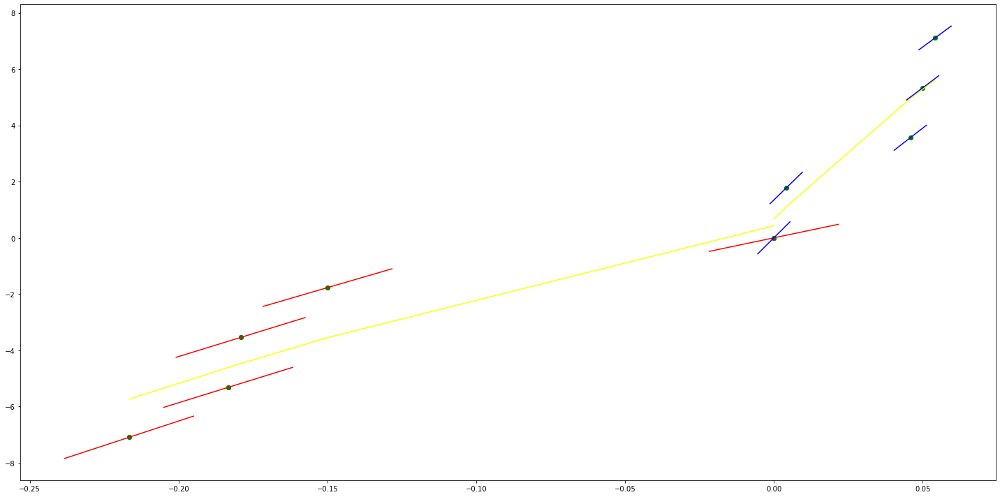

parameters (1.620341129857215, 15.083316228867723, -0.3628219872578415)
tangent[0]:12.774330118821192
tangent[1]:13.381958042517647
tangent[2]:14.030094494460533
tangent[3]:14.73224339762608
tangent[4]:15.083316228867723
parameters (-4005.6215825994036, 516.7117893335256, 0.5983528797514108)
tangent[0]:516.7117893335256
tangent[1]:483.3289390641422
tangent[2]:449.954100037924
tangent[3]:383.1883994991571
tangent[4]:349.8135604729389


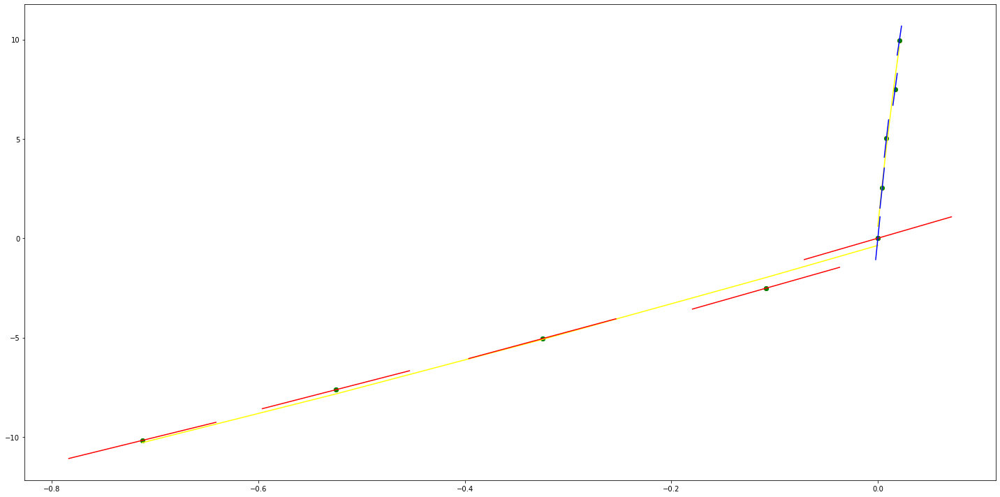

parameters (-8.645535847857266, 19.967644132999997, -0.12658979301474138)
tangent[0]:23.641996868339334
tangent[1]:22.77744328355361
tangent[2]:21.624699406815406
tangent[3]:20.76014582202968
tangent[4]:19.967644132999997
parameters (-582.7697508707037, 124.44491761765859, 0.5517510455689021)
tangent[0]:124.44491761765859
tangent[1]:119.58811451390214
tangent[2]:114.73247694964743
tangent[3]:85.59398940611226
tangent[4]:80.73718630235581


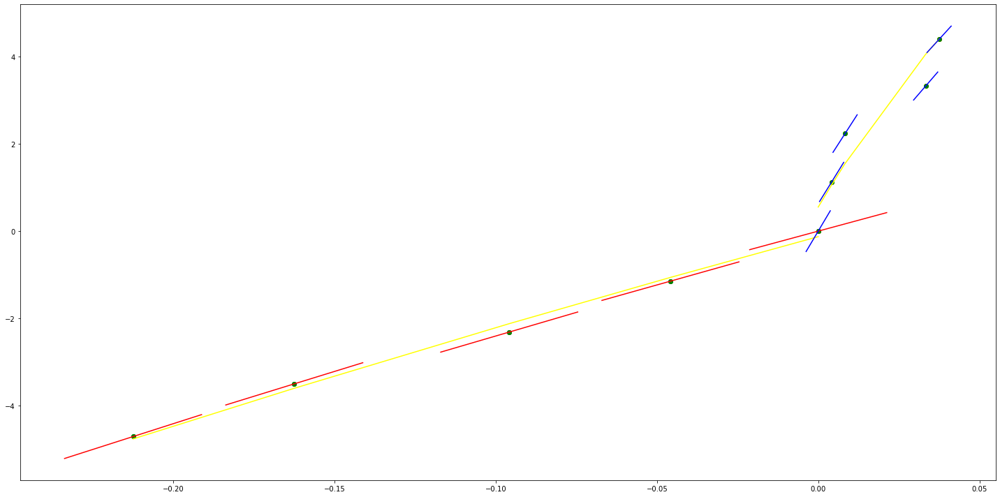

parameters (-307.54823934626927, 25.463522441447676, -0.786971238889657)
tangent[0]:94.66187629435827
tangent[1]:84.41067838046841
tangent[2]:61.344560429498216
tangent[3]:33.15222842510441
tangent[4]:25.463522441447676
parameters (-1072.661429330972, 225.94142281393206, 0.923243543540492)
tangent[0]:225.94142281393206
tangent[1]:217.0040077847464
tangent[2]:208.06444743270208
tangent[3]:154.4313759661535
tangent[4]:145.49181561410916


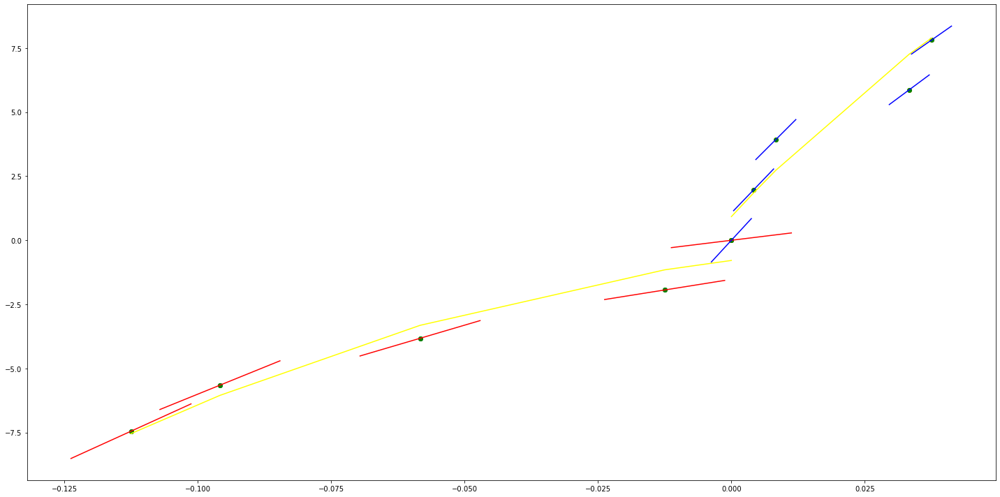

parameters (796.7763743319847, 189.71800437210896, -1.1433992510343307)
tangent[0]:116.67910768984459
tangent[1]:163.15826071012657
tangent[2]:169.79859501380935
tangent[3]:176.43733576474344
tangent[4]:189.71800437210896
parameters (159.10483348439496, 32.850084419469965, 1.8876374829994709)
tangent[0]:32.850084419469965
tangent[1]:34.17574589206195
tangent[2]:35.50172557432089
tangent[3]:56.71580944212921
tangent[4]:80.58153446478846


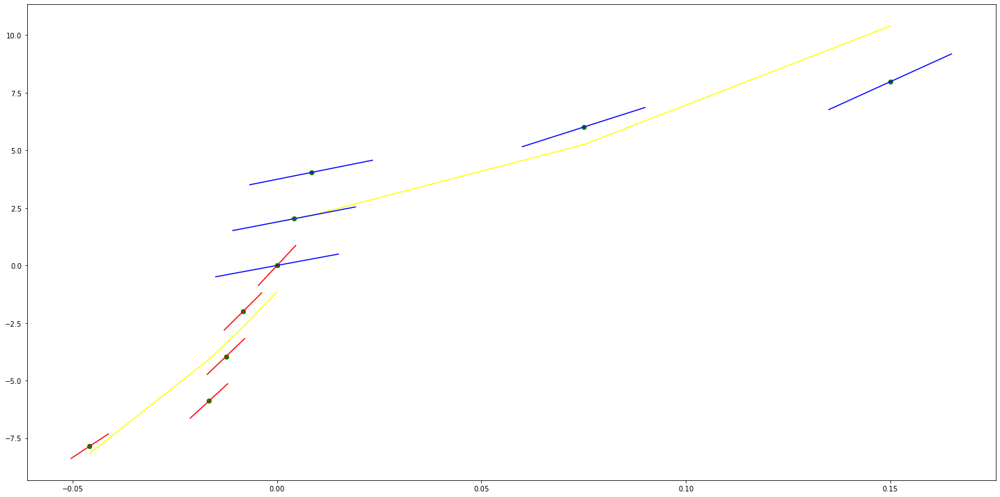

parameters (66.81892560945883, 56.92329298323249, -0.31981065091491634)
tangent[0]:36.877615300394844
tangent[1]:39.10495736666054
tangent[2]:44.11637678736996
tangent[3]:56.36642405720326
tangent[4]:56.92329298323249
parameters (-478.0327178399689, 148.23893330213374, 0.3841955229778642)
tangent[0]:148.23893330213374
tangent[1]:144.25500863165544
tangent[2]:112.38647946413607
tangent[3]:104.41958618861516
tangent[4]:100.43566151813685


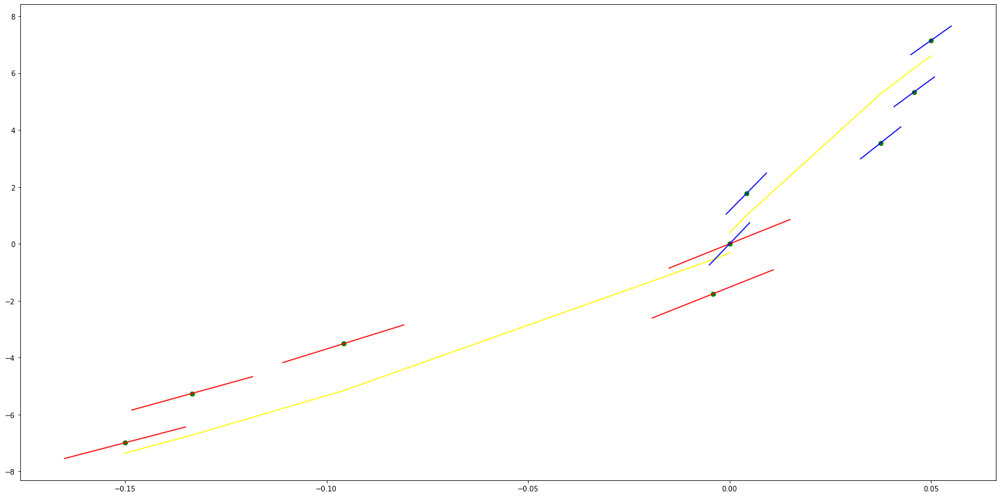

parameters (228.43846385539896, 98.35441443559871, -0.8229515047111633)
tangent[0]:75.51056805005882
tangent[1]:77.41437420782971
tangent[2]:79.3181803656006
tangent[3]:94.54725899698464
tangent[4]:98.35441443559871
parameters (566.6620459897692, -6.072242387093356, 1.7281951645853355)
tangent[0]:-6.072242387093356
tangent[1]:-1.3496808958146191
tangent[2]:3.3728805954641174
tangent[3]:93.09361566111626
tangent[4]:111.98272830213922


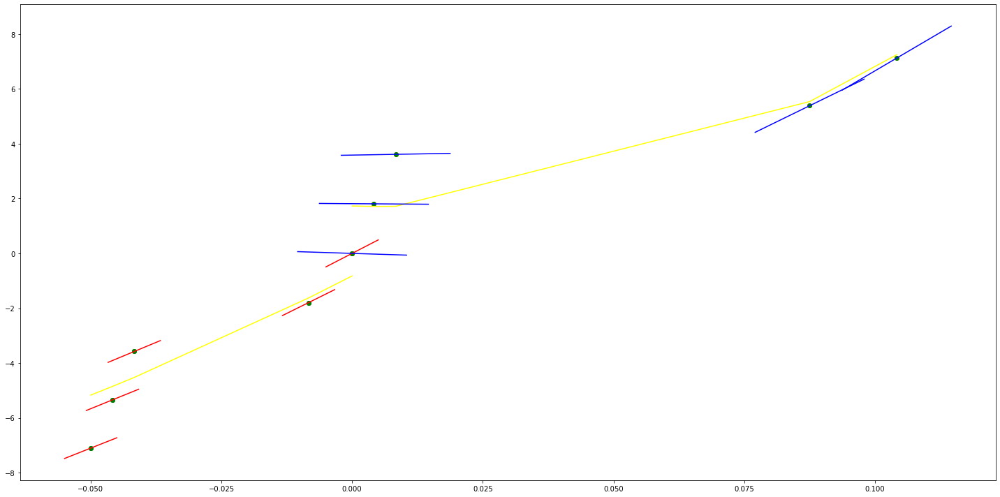

parameters (-492.01538197721777, -514.8662526409062, -0.44156907819124674)
tangent[0]:-490.2654835420453
tangent[1]:-498.46639592884156
tangent[2]:-502.56586809147575
tangent[3]:-506.66632428487384
tangent[4]:-514.8662526409062
parameters (1003.3284420468198, -309.0263839648244, -0.9996900549241928)
tangent[0]:-309.0263839648244
tangent[1]:-300.6646447288062
tangent[2]:-275.5814336776357
tangent[3]:-258.8599618624834
tangent[4]:-225.41501157529473


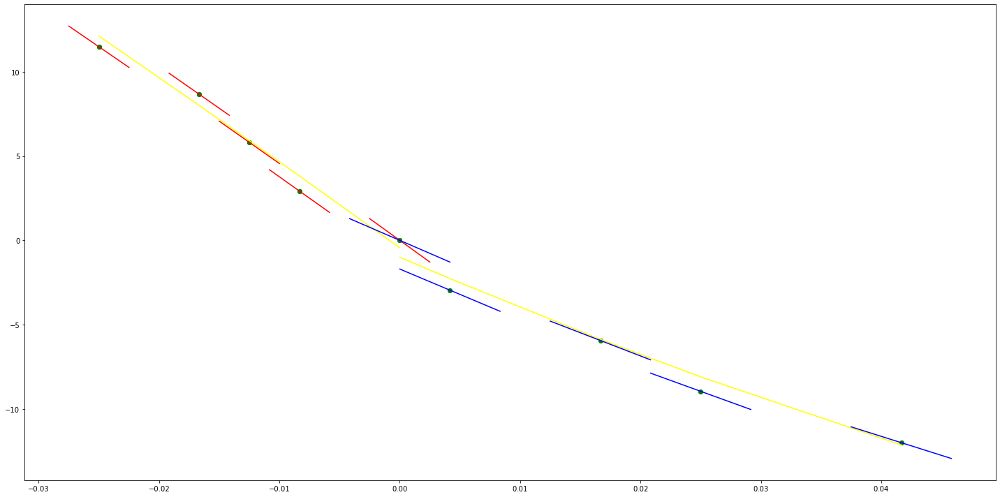

parameters (19.64051196089097, -56.7077570019399, 0.11725348163746022)
tangent[0]:-60.6358593941181
tangent[1]:-59.817478541731695
tangent[2]:-58.671808198029
tangent[3]:-57.853427345642594
tangent[4]:-56.7077570019399
parameters (79.15296070918968, -103.41337509508875, -0.1876681805378101)
tangent[0]:-103.41337509508875
tangent[1]:-100.11522952825824
tangent[2]:-95.49807902416978
tangent[3]:-92.19993345733927
tangent[4]:-87.58278295325081


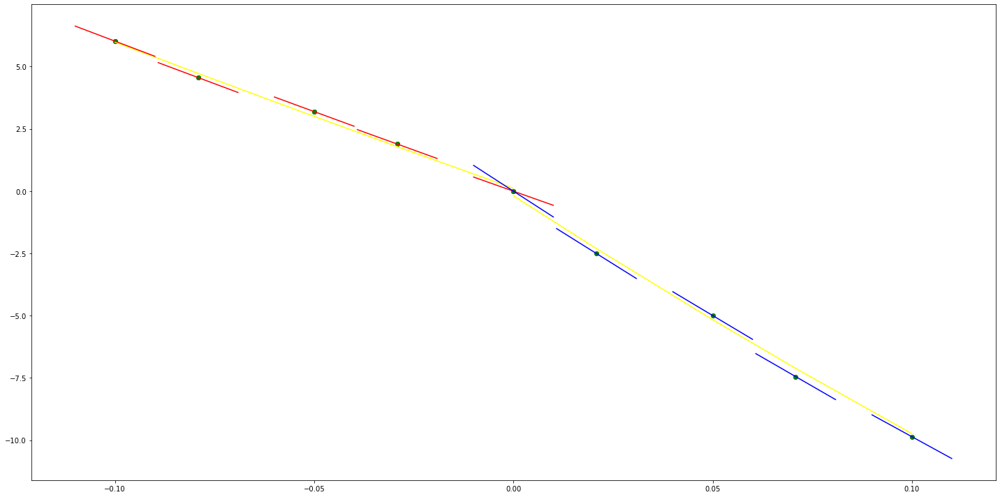

parameters (0.1395874546276718, 2.2488630907409393, 0.008416305373365941)
tangent[0]:1.8812827004964339
tangent[1]:1.9708515033324627
tangent[2]:2.062746391512407
tangent[3]:2.152315194348436
tangent[4]:2.2488630907409393
parameters (145.34768405764294, -40.16576255847177, 0.014516050854489574)
tangent[0]:-40.16576255847177
tangent[1]:42.19782817573652
tangent[2]:55.52155967793253
tangent[3]:56.732596581500815
tangent[4]:57.94392418043722


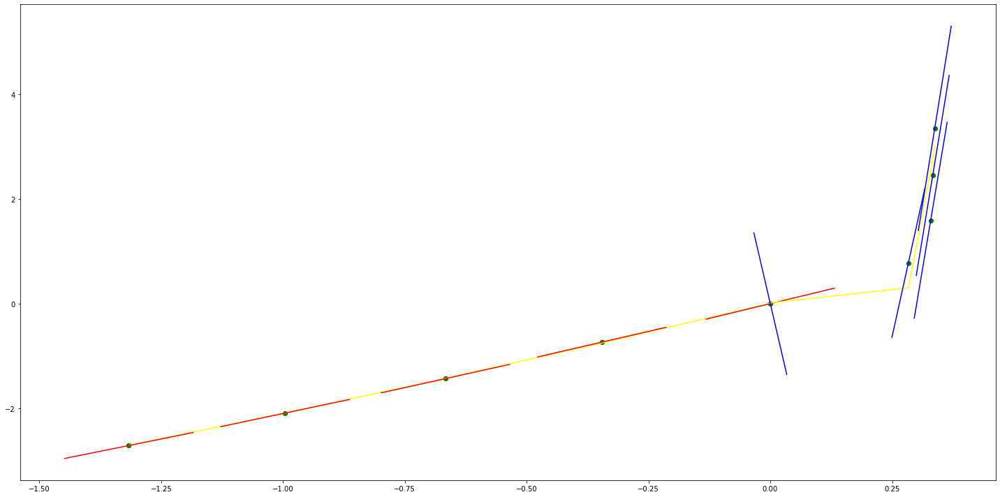

parameters (-1183.8509081804636, 9.416839702608023, -0.8819462665708352)
tangent[0]:137.66814398943038
tangent[1]:127.8019305206544
tangent[2]:117.93571705187841
tangent[3]:19.283053171384005
tangent[4]:9.416839702608023
parameters (-1040.4474344237426, 275.0164349162521, 0.5868439694928406)
tangent[0]:275.0164349162521
tangent[1]:266.34534599776464
tangent[2]:214.3229742765775
tangent[3]:205.65396625295887
tangent[4]:196.98287733447137


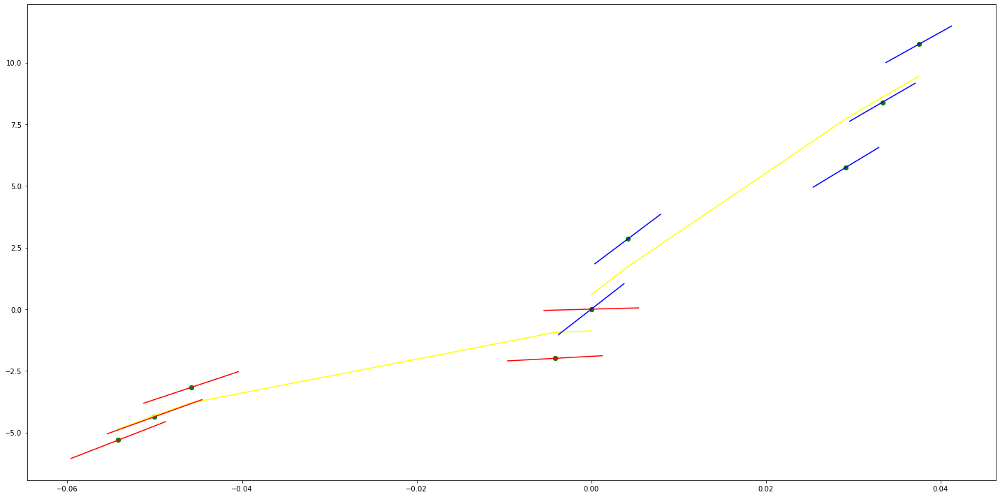

parameters (528.3751126655329, 166.72404624592446, -0.2832669139573848)
tangent[0]:127.09591279600949
tangent[1]:131.4983342347387
tangent[2]:135.90181242369326
tangent[3]:162.3205680569699
tangent[4]:166.72404624592446
parameters (-42.74228137425864, 65.72271885598168, 0.7157837465865672)
tangent[0]:65.72271885598168
tangent[1]:65.36659016757136
tangent[2]:62.51704775291228
tangent[3]:60.02380499578903
tangent[4]:57.17426258112995


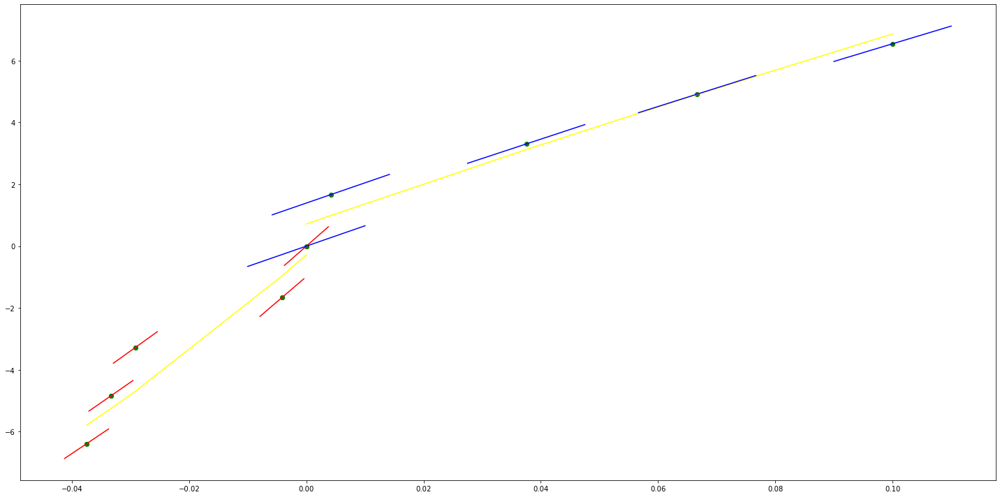

parameters (10.606136749710412, 22.29008879741351, -4.521560191447195)
tangent[0]:21.848152291326578
tangent[1]:21.936543834998663
tangent[2]:22.02493537867075
tangent[3]:22.201697253741422
tangent[4]:22.29008879741351
parameters (-218.261012480737, 113.76580744857088, 1.4318690189421006)
tangent[0]:113.76580744857088
tangent[1]:111.94725669258138
tangent[2]:93.75869347851165
tangent[3]:91.93970620049718
tangent[4]:90.12115544450768


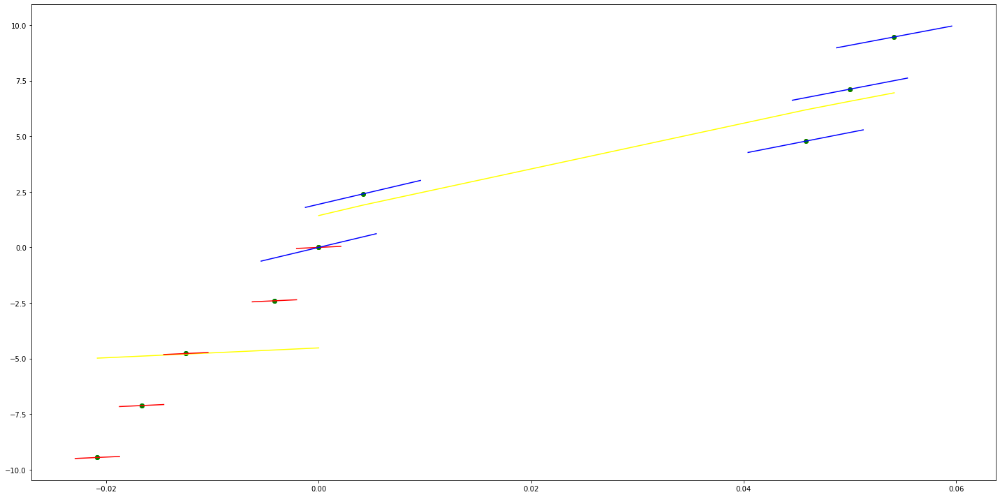

parameters (-174.1881319155513, 16.77872974145715, -0.8670259862406544)
tangent[0]:63.22913050311339
tangent[1]:61.77744661172918
tangent[2]:60.325762720344976
tangent[3]:19.682097524225558
tangent[4]:16.77872974145715
parameters (-372.1813771325856, 133.91001558447545, 1.166136166172197)
tangent[0]:133.91001558447545
tangent[1]:130.80900035020673
tangent[2]:127.70724075318377
tangent[3]:90.48910303992521
tangent[4]:84.28632820863353


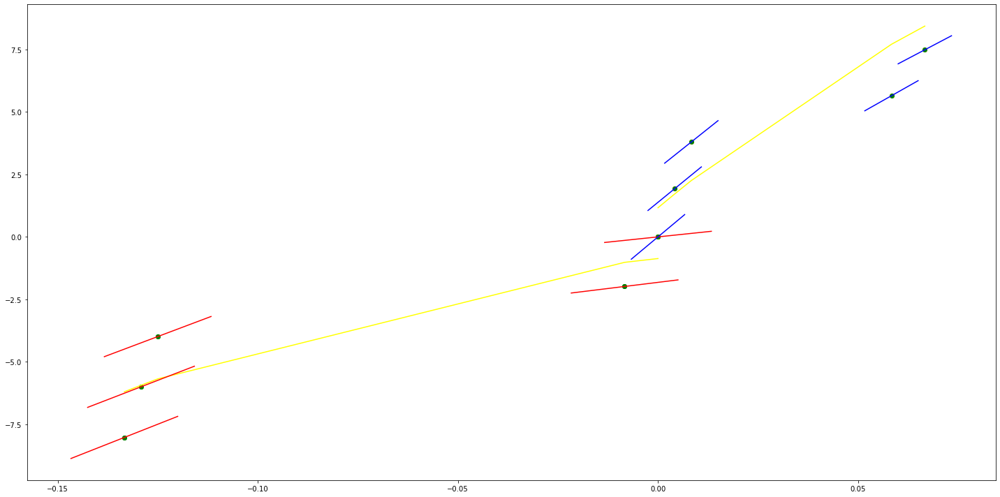

parameters (-2638.8744915376656, -356.5529103990168, 0.004669336936040639)
tangent[0]:-246.60156583460844
tangent[1]:-268.5939458470833
tangent[2]:-290.5810481105752
tangent[3]:-334.565808135525
tangent[4]:-356.5529103990168
parameters (164.7883497830725, -126.39387562446883, -0.6322316126775053)
tangent[0]:-126.39387562446883
tangent[1]:-125.0205295173767
tangent[2]:-119.52747466570777
tangent[3]:-114.0347493907384
tangent[4]:-108.54169453906945


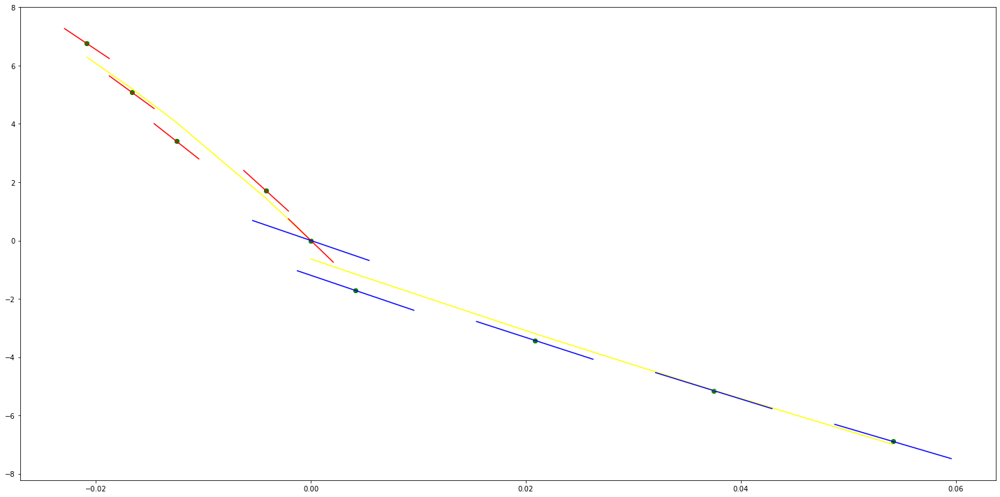

parameters (-182.44126637967142, 8.922341577481388, -0.8966051327497309)
tangent[0]:84.93977915736632
tangent[1]:66.69565251939918
tangent[2]:43.89049422194025
tangent[3]:19.56487041047314
tangent[4]:8.922341577481388
parameters (-513.8136426845181, 164.3302846894889, 1.5993036789762174)
tangent[0]:164.3302846894889
tangent[1]:160.0491894186415
tangent[2]:155.76706652050873
tangent[3]:138.639602555263
tangent[4]:108.66782515018969


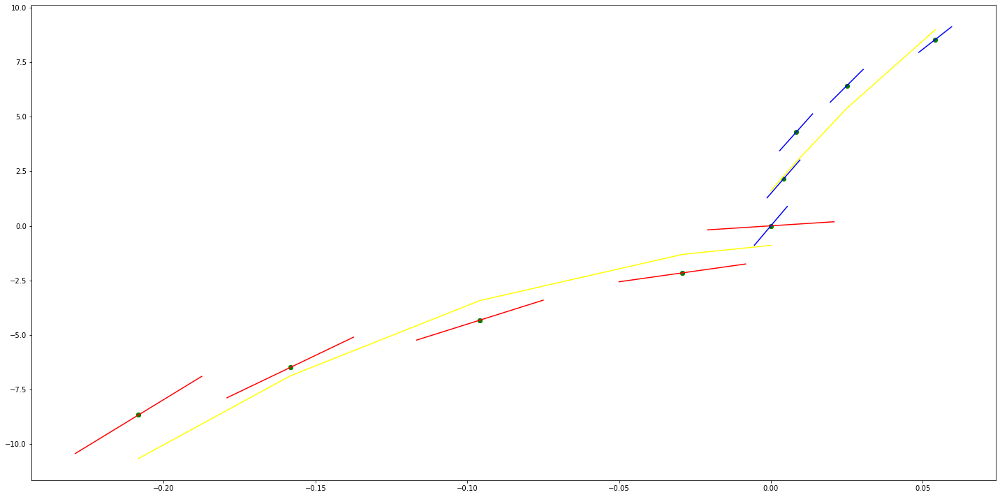

parameters (-187.77048754109563, -7.920196056228784, -1.152032225905911)
tangent[0]:71.88226114873686
tangent[1]:65.62311971704197
tangent[2]:23.37476002029546
tangent[3]:-6.355692354036375
tangent[4]:-7.920196056228784
parameters (-41.24858523627147, 42.962549971200765, 1.2298768425220765)
tangent[0]:42.962549971200765
tangent[1]:42.61878426184168
tangent[2]:40.212589290669015
tangent[3]:36.087730767041876
tangent[4]:30.24420869096024


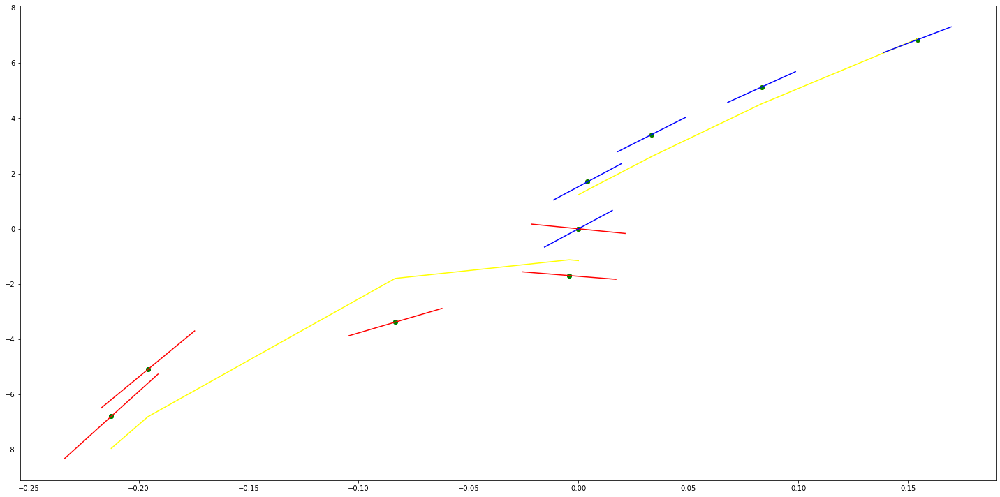

parameters (0.6854478668672636, 11.592963116180943, -0.7954081299229651)
tangent[0]:11.004621277717032
tangent[1]:11.204543115254738
tangent[2]:11.41588999783739
tangent[3]:11.587251964554206
tangent[4]:11.592963116180943
parameters (-1703.286543208566, 229.02494746610233, 0.37330942255612526)
tangent[0]:229.02494746610233
tangent[1]:214.82975741500215
tangent[2]:186.4427838858882
tangent[3]:172.247593834788
tangent[4]:158.0524037836878


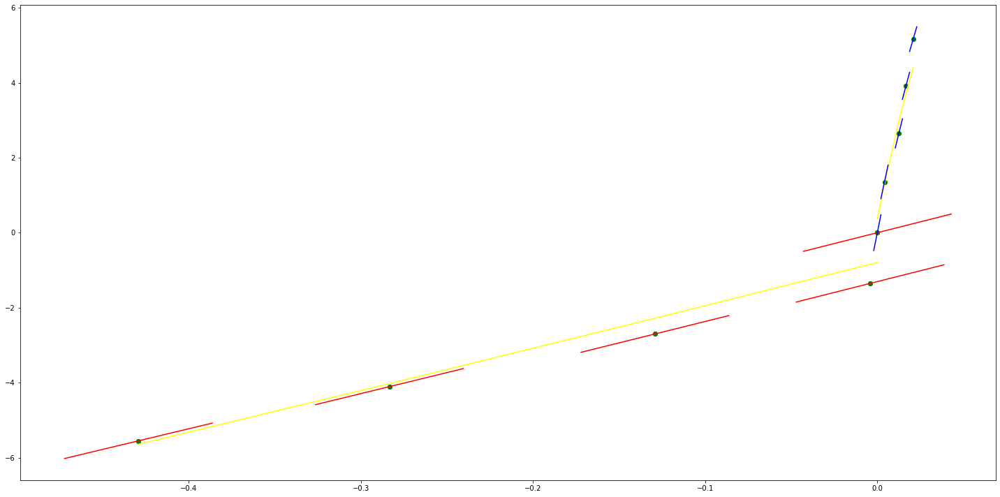

parameters (-155.6177524216041, 47.29407031919283, -0.3690967040943123)
tangent[0]:75.82378410615036
tangent[1]:57.66848340213149
tangent[2]:56.37156505344984
tangent[3]:55.07495794027304
tangent[4]:47.29407031919283
parameters (866.8951778770409, -19.3600197315694, 0.9831270117953781)
tangent[0]:-19.3600197315694
tangent[1]:-12.13531531914214
tangent[2]:-4.910610906714883
tangent[3]:96.22658191548798
tangent[4]:103.45128632791521


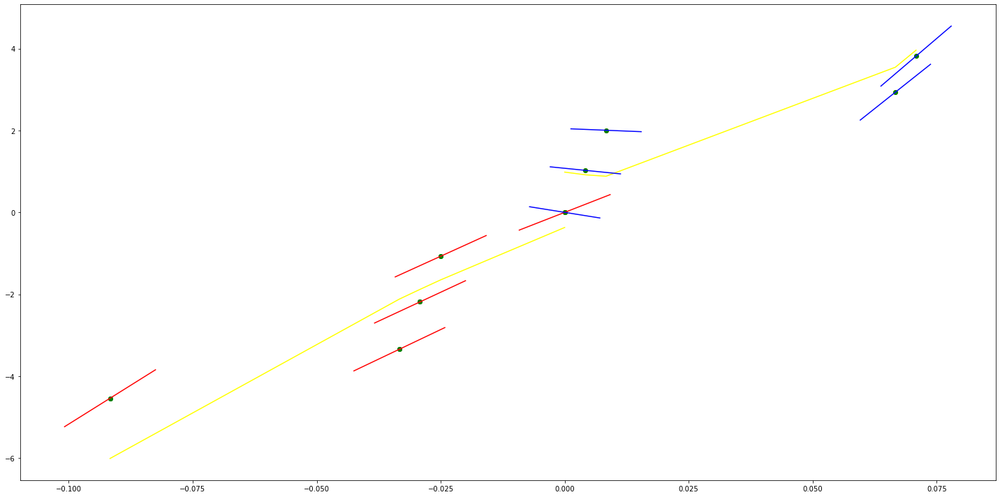

parameters (-680.6320807487787, -238.1562748893601, 1.2284358813359355)
tangent[0]:-175.76409331128107
tangent[1]:-198.45228309096086
tangent[2]:-221.14047287064065
tangent[3]:-232.48388712839977
tangent[4]:-238.1562748893601
parameters (3297.138204454536, -488.4632094016099, -0.5330762250389183)
tangent[0]:-488.4632094016099
tangent[1]:-460.9914538820947
tangent[2]:-406.0347542902465
tangent[3]:-378.56299877073127
tangent[4]:-351.0846489748072


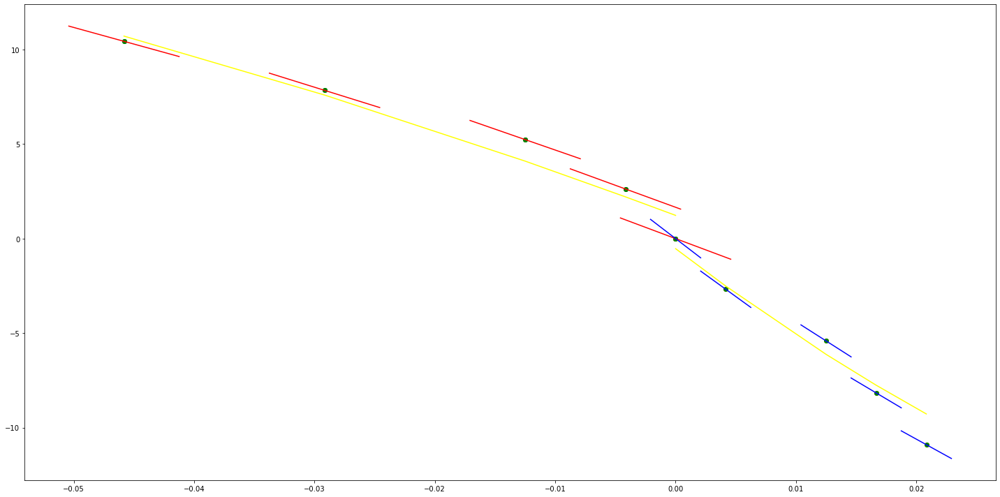

parameters (-2863.4656665166817, -450.26967319314286, 0.18568533790354272)
tangent[0]:-307.09638986730874
tangent[1]:-354.81890866547576
tangent[2]:-378.68303153022583
tangent[3]:-402.54142746364283
tangent[4]:-450.26967319314286
parameters (829.8456123281052, -266.35891094721984, -1.5891411431185576)
tangent[0]:-266.35891094721984
tangent[1]:-259.4446373053021
tangent[2]:-252.52870397215963
tangent[3]:-224.8666303308146
tangent[4]:-197.20621638069417


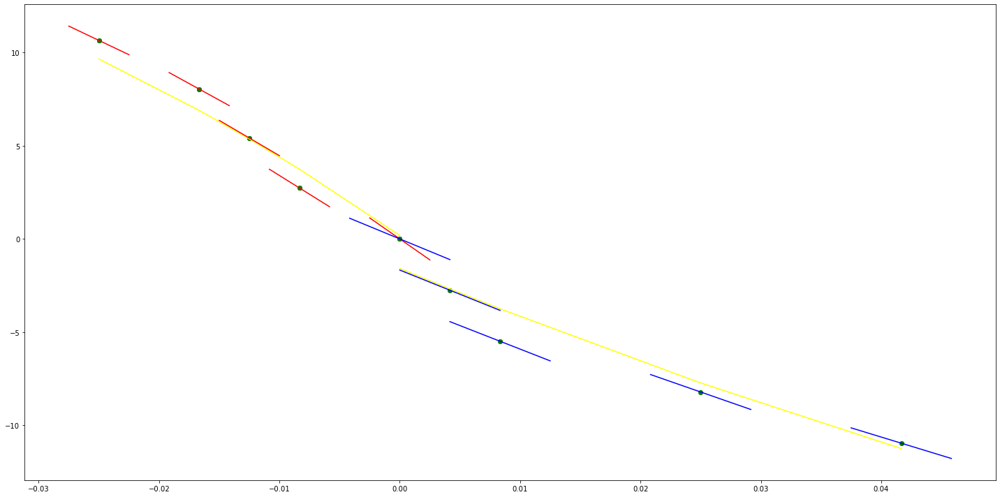

parameters (-959.0173215346533, -62.781974100533034, -0.9229648836741198)
tangent[0]:160.98937360243377
tangent[1]:152.99692324476396
tangent[2]:97.05552484500458
tangent[3]:-54.78952374286323
tangent[4]:-62.781974100533034
parameters (3.145481056181266, 46.09985676855706, 0.8377407003095827)
tangent[0]:46.09985676855706
tangent[1]:46.12606491671716
tangent[2]:46.44061302233529
tangent[3]:46.545464487862034
tangent[4]:46.964864059006906


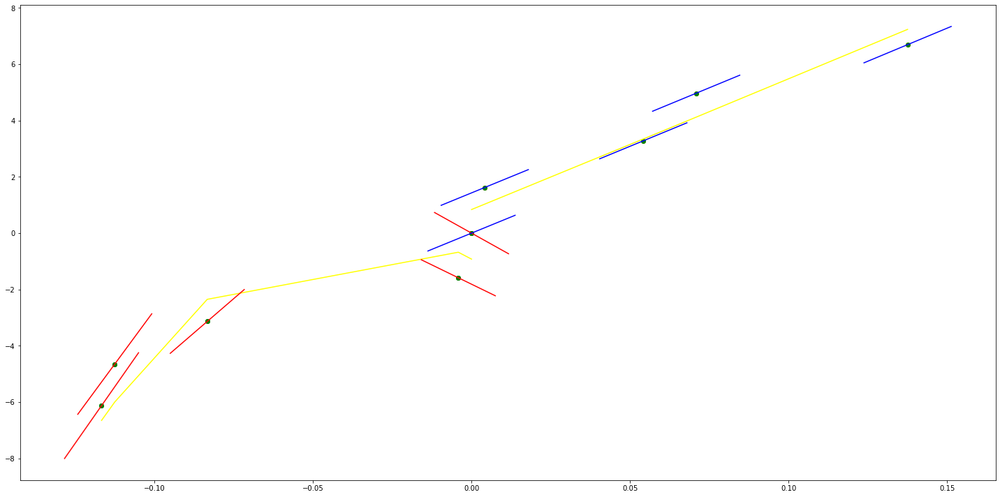

parameters (7.369494304528734, 36.10746892028544, -0.2060159258530849)
tangent[0]:31.808592329647475
tangent[1]:33.03685120639467
tangent[2]:34.20367797861932
tangent[3]:35.247699497753295
tangent[4]:36.10746892028544
parameters (-719.8002117222571, 208.21991189385284, 1.5236997433514319)
tangent[0]:208.21991189385284
tangent[1]:202.22109692935956
tangent[2]:196.2237215652897
tangent[3]:154.23489601468356
tangent[4]:148.23608105019025


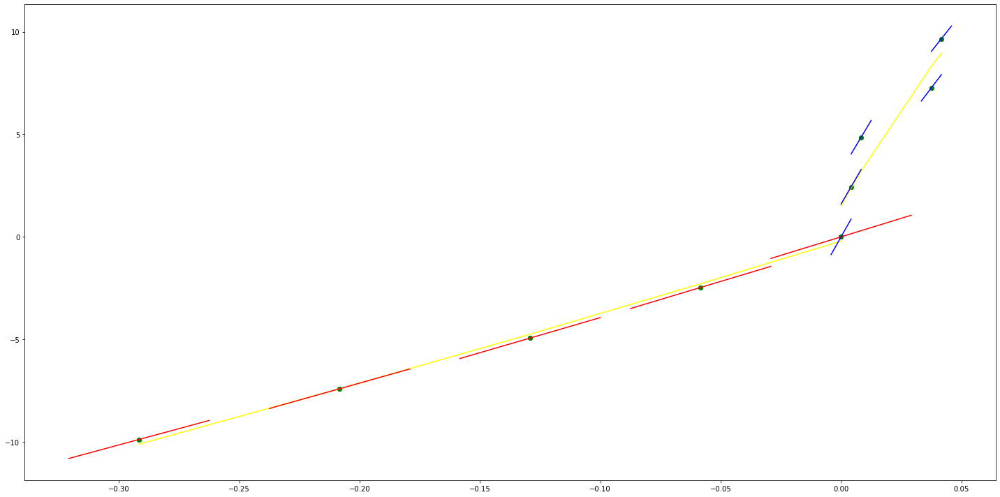

parameters (135.6620554465882, 89.64728847959455, -0.8778054387787485)
tangent[0]:67.03676502242259
tangent[1]:76.08108293493572
tangent[2]:77.2114191809167
tangent[3]:88.51668090950268
tangent[4]:89.64728847959455
parameters (-5.902841394421055, 33.187264045681864, 0.8656955599225945)
tangent[0]:33.187264045681864
tangent[1]:33.13808157118355
tangent[2]:31.95751329229934
tangent[3]:31.36722915285723
tangent[4]:30.6293739785546


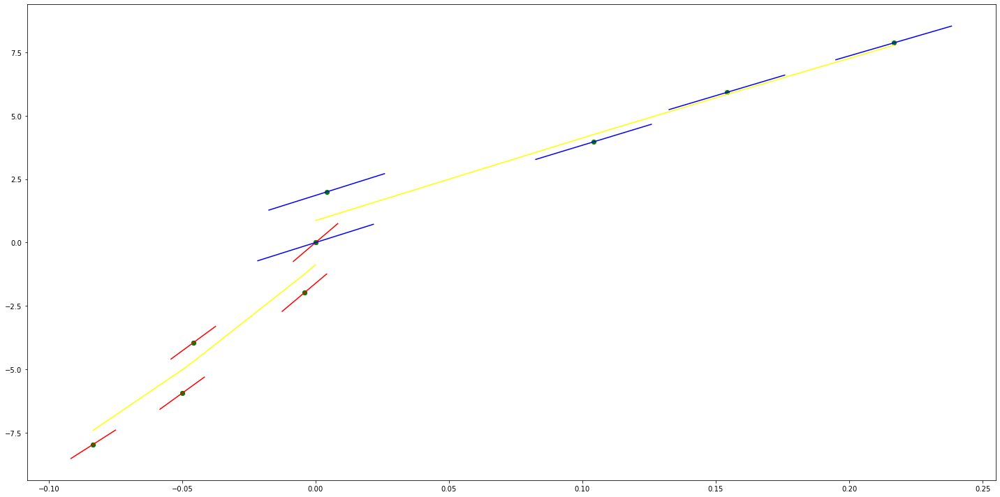

parameters (4.821399379602263, 21.50892038632791, -0.9191947023586058)
tangent[0]:18.776797285486214
tangent[1]:19.62054217691661
tangent[2]:20.705357037327122
tangent[3]:21.468738843898308
tangent[4]:21.50892038632791
parameters (-93.06730298780515, 72.39783052798094, 0.7923543775575645)
tangent[0]:72.39783052798094
tangent[1]:71.62220762488057
tangent[2]:66.19340570699592
tangent[3]:62.31547732610006
tangent[4]:56.11105250511504


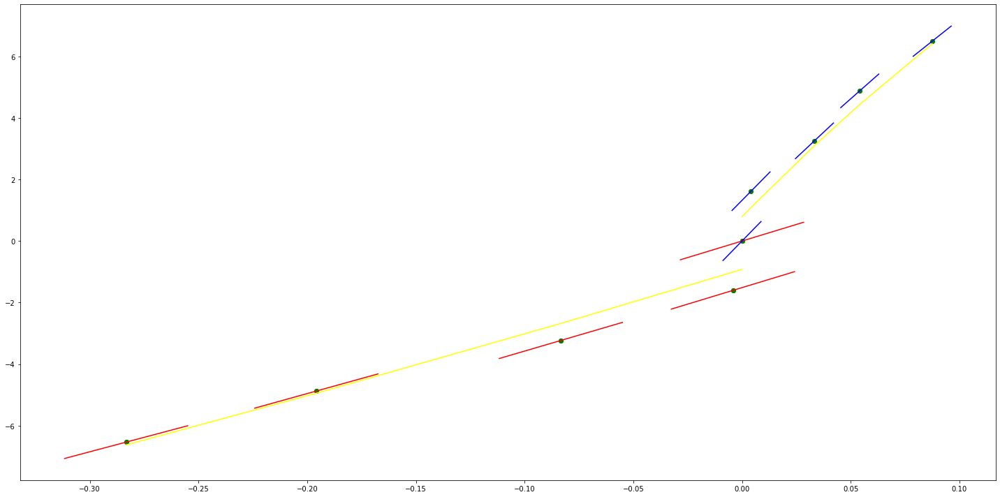

parameters (47.5257928888621, 42.88381254189471, -0.713924468652953)
tangent[0]:31.794429183964965
tangent[1]:33.37865396412229
tangent[2]:36.94308843078695
tangent[3]:42.48773258395894
tangent[4]:42.88381254189471
parameters (553.8945779867395, -30.24289638448492, 0.8164238081468852)
tangent[0]:-30.24289638448492
tangent[1]:-25.626738971543432
tangent[2]:80.53601921286298
tangent[3]:85.15217662580446
tangent[4]:122.07811256186845


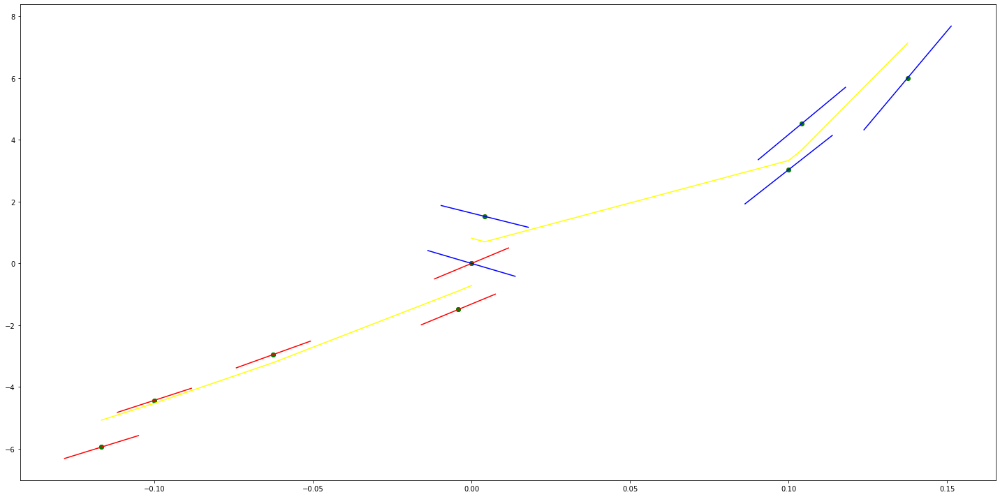

parameters (67.87562464946828, 49.459414648591945, -0.045691862484997035)
tangent[0]:35.88428971869829
tangent[1]:38.14685579076367
tangent[2]:40.40928611157974
tangent[3]:44.93441825571049
tangent[4]:49.459414648591945
parameters (-429.56018607585673, 123.46568751811468, 0.36916534928799033)
tangent[0]:123.46568751811468
tangent[1]:119.88573292735849
tangent[2]:98.40772362356566
tangent[3]:94.82862815318161
tangent[4]:91.24867356242542


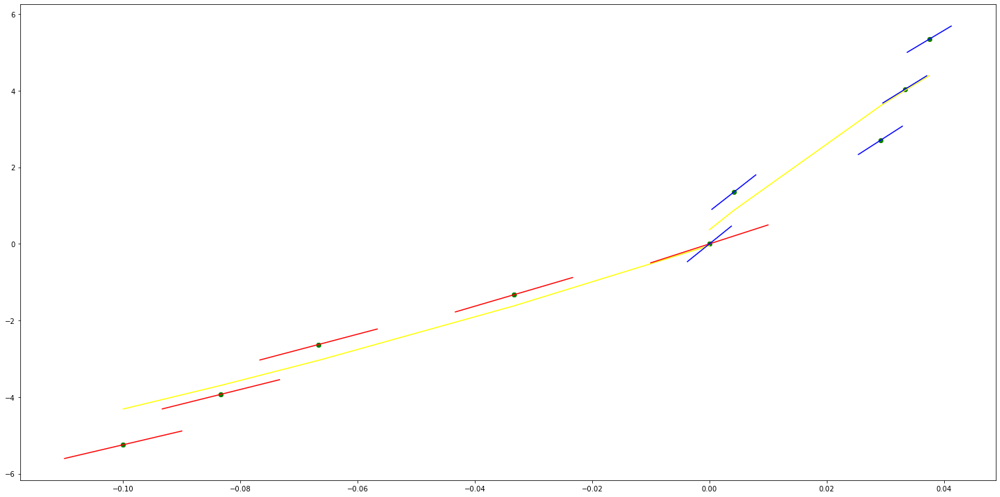

parameters (591.9782991162932, 138.40461908395002, -0.16671153975184824)
tangent[0]:94.00624665022804
tangent[1]:98.93979379506322
tangent[2]:103.87215698330019
tangent[3]:133.47107193911484
tangent[4]:138.40461908395002
parameters (494.3145045215969, 14.170459430930531, 0.5742115622021924)
tangent[0]:14.170459430930531
tangent[1]:18.29007651161352
tangent[2]:63.60190988309023
tangent[3]:92.43725218985307
tangent[4]:96.55588064152701


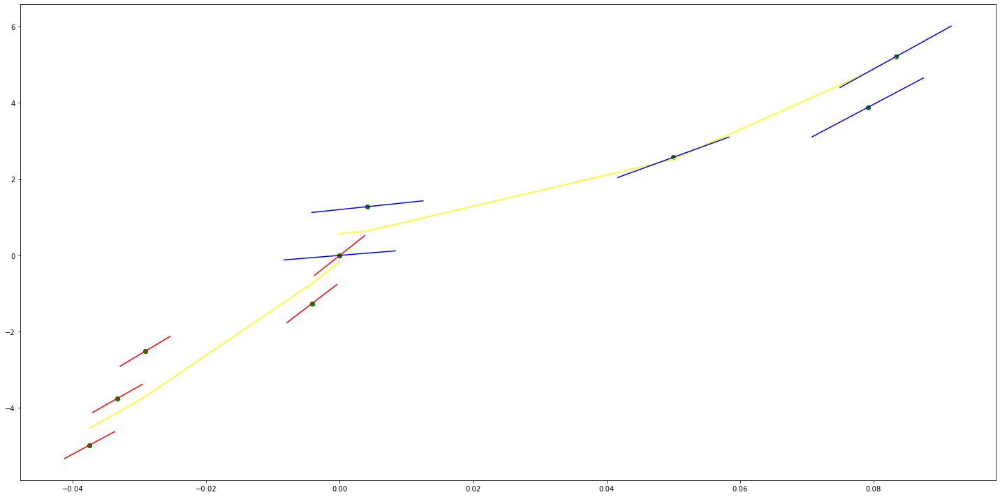

parameters (536.2233066656348, 144.19581053818698, -0.3013839139282142)
tangent[0]:103.97906253826437
tangent[1]:108.44794757601576
tangent[2]:112.91683261376716
tangent[3]:139.72799794704892
tangent[4]:144.19581053818698
parameters (-3.512189186546966, 32.94676351243627, 0.8312095250279358)
tangent[0]:32.94676351243627
tangent[1]:32.91749292775559
tangent[2]:32.566274009100894
tangent[3]:32.21505509044619
tangent[4]:31.746760857447143


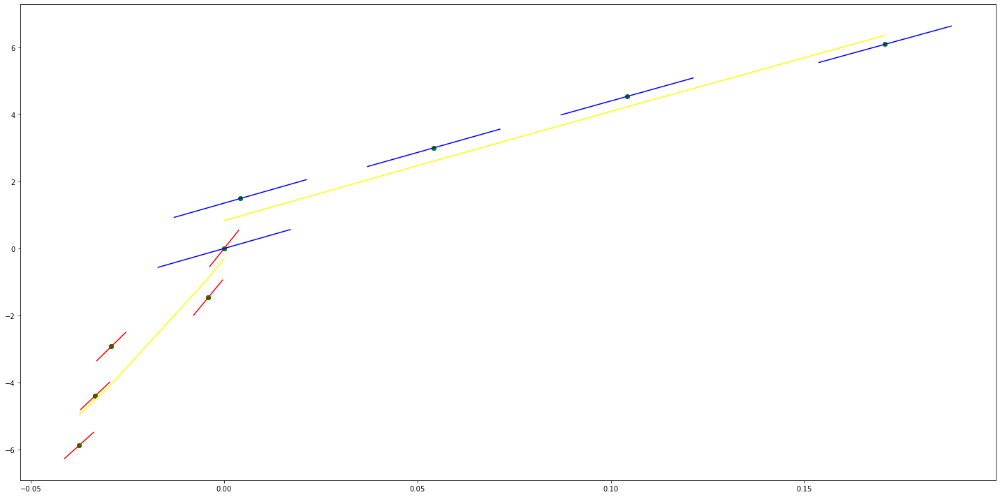

parameters (-245.38893913672996, -232.2829330435496, 0.3262252228398224)
tangent[0]:-201.60931565145836
tangent[1]:-209.78911054864213
tangent[2]:-217.9684146679476
tangent[3]:-226.14820956513137
tangent[4]:-232.2829330435496
parameters (1119.502550744449, -342.77553849484445, -2.025361250792412)
tangent[0]:-342.77553849484445
tangent[1]:-333.4456042369402
tangent[2]:-324.11790898413744
tangent[3]:-286.800410957622
tangent[4]:-249.4829129311065


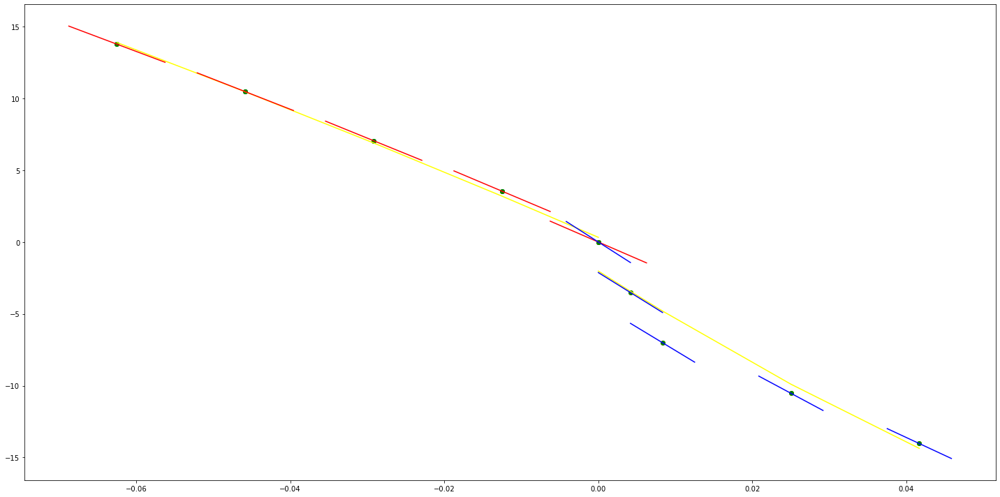

parameters (217.52457010549577, 42.95123570763925, -0.02238038232606264)
tangent[0]:33.88785696962366
tangent[1]:35.700706736882864
tangent[2]:37.51312145500185
tangent[3]:41.138820989520255
tangent[4]:42.95123570763925
parameters (20.969997325931413, -3.0691778338606133, 0.2680815444254219)
tangent[0]:-3.0691778338606133
tangent[1]:-2.894413876146301
tangent[2]:-0.27316421040487393
tangent[3]:10.21183445256083
tangent[4]:10.736084385709116


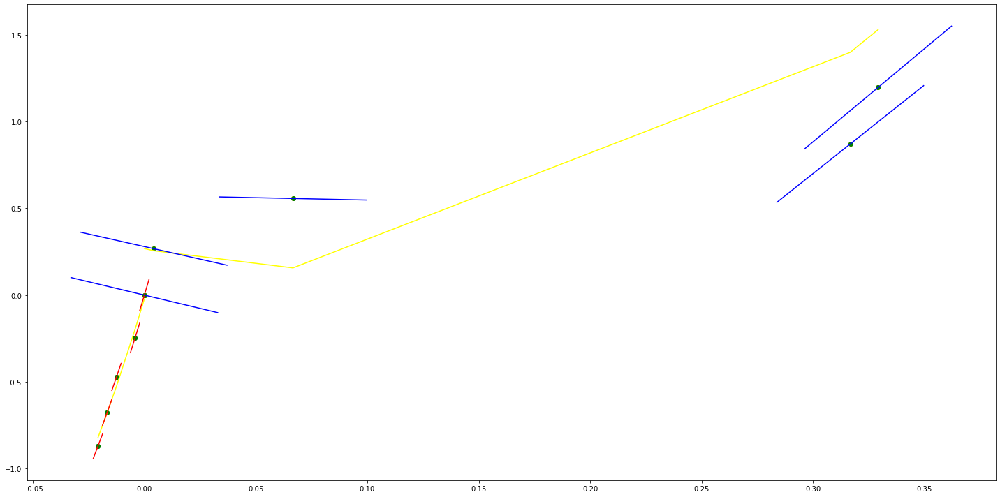

parameters (-185.96276591354294, 9.58150552374619, -0.8574193493588991)
tangent[0]:63.820521606685595
tangent[1]:51.42312785429335
tangent[2]:26.627968423977016
tangent[3]:11.131319214869656
tangent[4]:9.58150552374619
parameters (-328.4082525095928, 101.05317541232778, 1.4933029548071775)
tangent[0]:101.05317541232778
tangent[1]:98.31622103591283
tangent[2]:92.84296909958796
tangent[3]:90.106014723173
tangent[4]:87.36971716326308


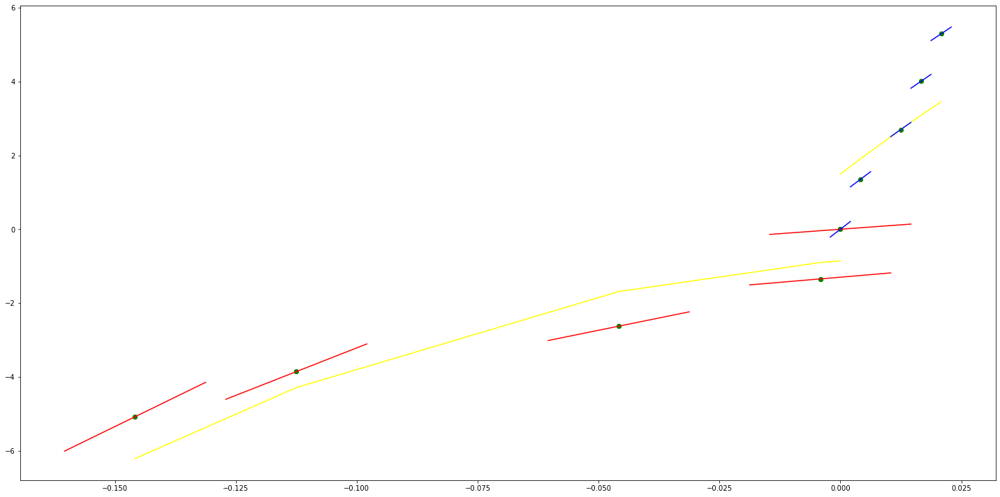

parameters (499.4754337626714, 130.53869990659078, -0.44745608484816946)
tangent[0]:93.07804237439044
tangent[1]:97.24067063936852
tangent[2]:101.40329890434663
tangent[3]:126.3770705924802
tangent[4]:130.53869990659078
parameters (2385.2083549860363, -108.37008591793268, 0.8871293253694682)
tangent[0]:-108.37008591793268
tangent[1]:-88.49175948747906
tangent[2]:189.78095845532187
tangent[3]:209.6592848857755
tangent[4]:229.53761131622912


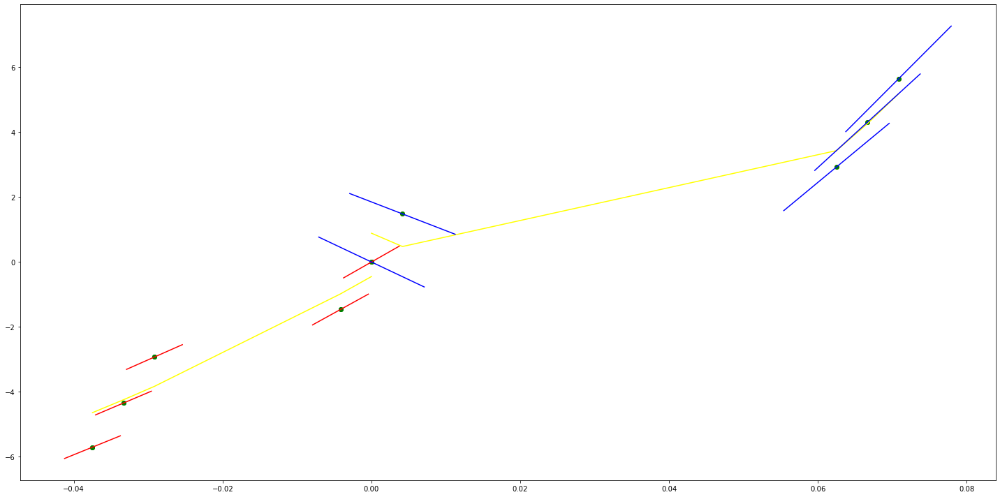

parameters (-1233.5042142370862, 4.1432852899325585, 0.08424294251376119)
tangent[0]:148.0537549565449
tangent[1]:127.49370671364119
tangent[2]:117.21614960061778
tangent[3]:106.93612547916591
tangent[4]:4.1432852899325585
parameters (-748.5546627168218, 153.84922360417062, 0.6055500467397454)
tangent[0]:153.84922360417062
tangent[1]:147.61226615441404
tangent[2]:141.37381159533206
tangent[3]:103.94607845949098
tangent[4]:97.70762390040898


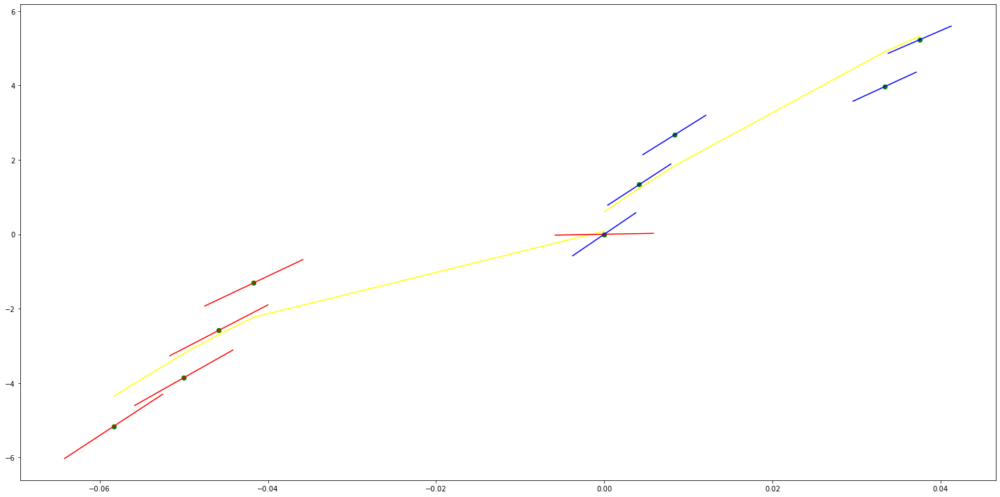

parameters (-181.3523389290053, 47.265939670155426, 0.46305067240597614)
tangent[0]:80.51398937536568
tangent[1]:71.44637242891542
tangent[2]:69.93498203628108
tangent[3]:68.42395434832461
tangent[4]:47.265939670155426
parameters (-360.32870920415985, 107.19821862941535, 1.8295950491286468)
tangent[0]:107.19821862941535
tangent[1]:104.1959598243263
tangent[2]:101.19298036181883
tangent[3]:95.1877420942223
tangent[4]:92.18476263171482


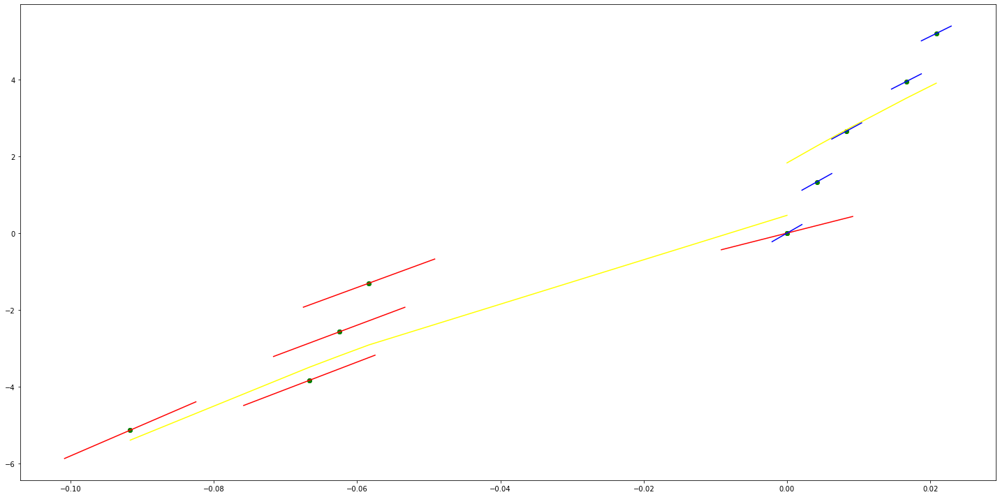

parameters (1.071048599763624, 12.976467741308321, 0.9115329675808749)
tangent[0]:11.307416292644273
tangent[1]:11.485923678572478
tangent[2]:11.834014473495655
tangent[3]:12.298136247425626
tangent[4]:12.976467741308321
parameters (78.9932568928996, -90.23511029919511, 0.001015720286713661)
tangent[0]:-90.23511029919511
tangent[1]:96.05721521555056
tangent[2]:96.715545018496
tangent[3]:97.37387482144142
tangent[4]:106.58970213010845


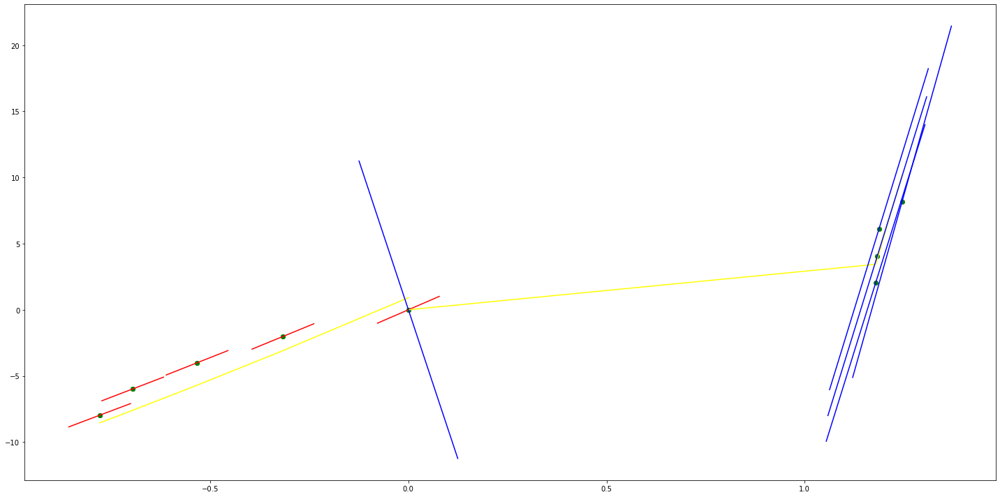

parameters (-1.7655874613312061, 2.1404875887989685, -2.9113547732209795)
tangent[0]:6.53974183622425
tangent[1]:2.3759004273681037
tangent[2]:2.361186021465369
tangent[3]:2.346471615562635
tangent[4]:2.1404875887989685
parameters (-70.67640458686405, 56.16643098845532, 3.795077963800264)
tangent[0]:56.16643098845532
tangent[1]:55.577413832628395
tangent[2]:54.988538029610645
tangent[3]:51.45471780026744
tangent[4]:50.865700644440516


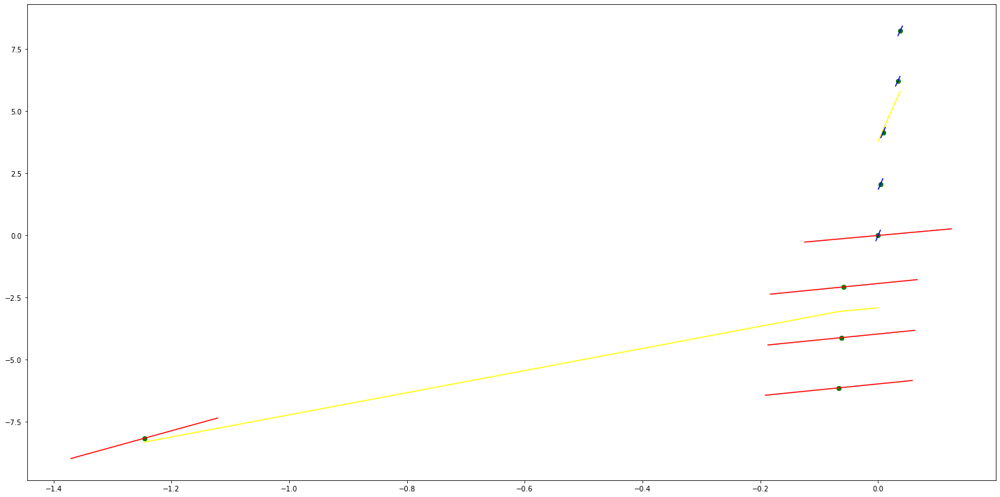

parameters (-1139.4280676827661, -288.6495042420608, -1.520981373476089)
tangent[0]:328.54221832352783
tangent[1]:319.0462248074596
tangent[2]:309.5502312913914
tangent[3]:-279.15351072599265
tangent[4]:-288.6495042420608
parameters (-18.5568175591926, 38.69255368485962, 1.9542749002000936)
tangent[0]:38.69255368485962
tangent[1]:38.537938280956425
tangent[2]:36.06368356851904
tangent[3]:31.733747100162393
tangent[4]:27.558463149344057


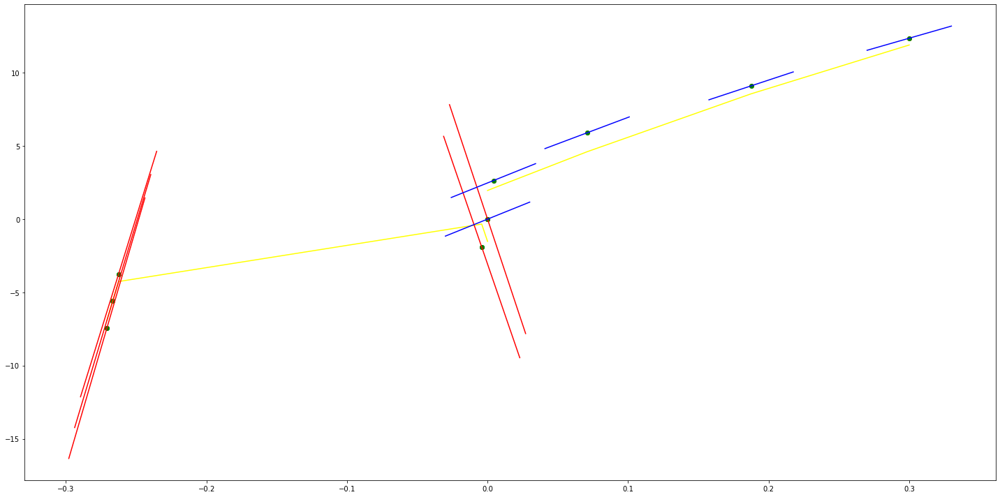

parameters (0.04483819934822122, -1.2231831104672002, 0.21201192921748457)
tangent[0]:-1.8598855412119415
tangent[1]:-1.6801590622656886
tangent[2]:-1.556480332504712
tangent[3]:-1.3819850366000175
tangent[4]:-1.2231831104672002
parameters (-22.860908502594672, 43.7417374572422, -0.013451134993850268)
tangent[0]:43.7417374572422
tangent[1]:-45.415805702877016
tangent[2]:-55.512737439401015
tangent[3]:-55.70321452904461
tangent[4]:-55.89373734050525


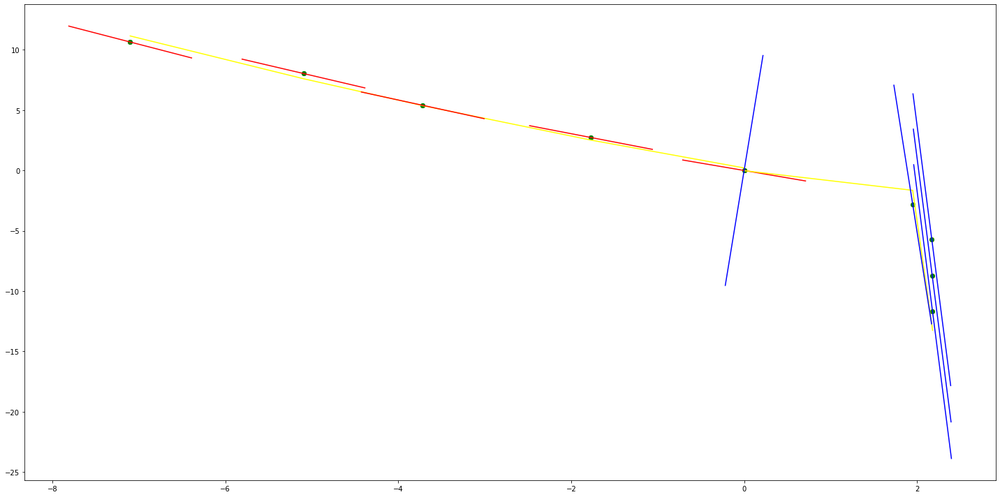

parameters (1624.3738182316583, -651.1497757201146, 0.44364439043133574)
tangent[0]:-718.8309352305548
tangent[1]:-705.2966525770487
tangent[2]:-691.759121175906
tangent[3]:-664.6873071212572
tangent[4]:-651.1497757201146
parameters (417.453911266024, -293.988056460229, -1.4654982081180516)
tangent[0]:-293.988056460229
tangent[1]:-290.508995563738
tangent[2]:-276.59442179341886
tangent[3]:-262.6790131152772
tangent[4]:-248.76360443713557


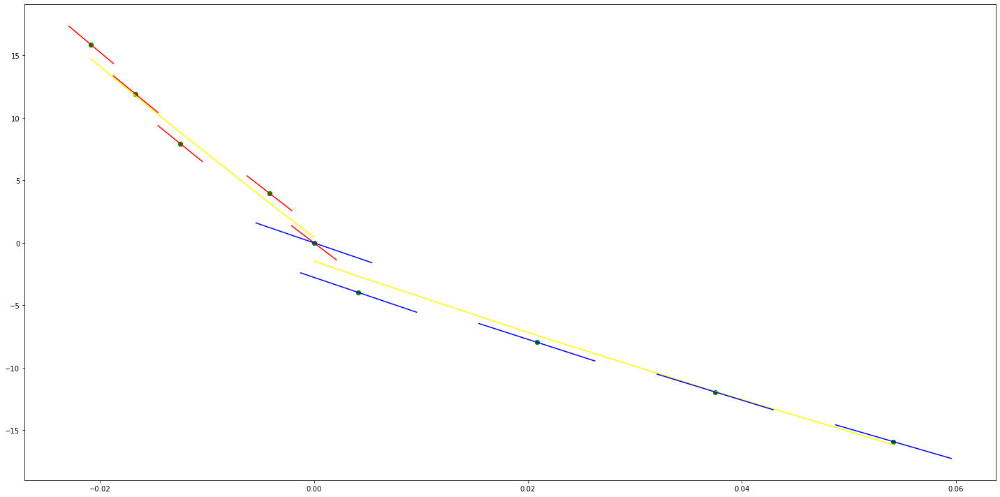

parameters (34.07065273500509, 26.34053105727421, -1.9086427160036574)
tangent[0]:24.920943240417486
tangent[1]:25.20488806031102
tangent[2]:25.488764738899082
tangent[3]:26.056654378686147
tangent[4]:26.34053105727421
parameters (-47.851092515628075, 66.89749238029655, 0.65424607541186)
tangent[0]:66.89749238029655
tangent[1]:66.49870137527131
tangent[2]:64.90363305735536
tangent[3]:62.11238312873375
tangent[4]:60.118523805792556


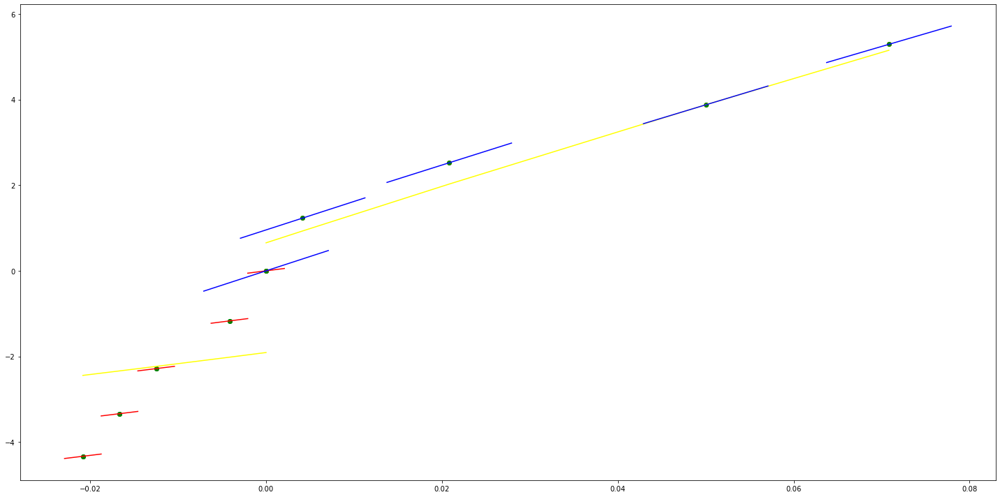

parameters (324.15411480698566, 235.4768541167988, -0.2242459755225477)
tangent[0]:194.95758976592558
tangent[1]:205.76294302890165
tangent[2]:216.5676479836481
tangent[3]:227.37300124662414
tangent[4]:235.4768541167988
parameters (-3001.1990480286695, 535.2335746522293, 0.8383222032840234)
tangent[0]:535.2335746522293
tangent[1]:510.2215817859584
tangent[2]:485.2155913177835
tangent[3]:385.1736222507958
tangent[4]:335.15563891635003


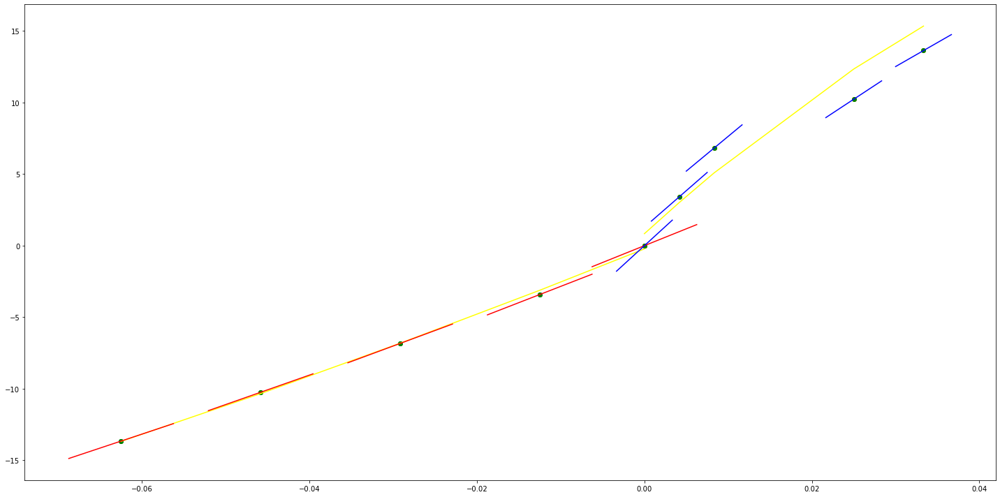

parameters (-777.2108714884627, 47.48549361123174, -0.8772854123081555)
tangent[0]:189.97467152469756
tangent[1]:144.63685254728958
tangent[2]:112.25358437585129
tangent[3]:66.91576539844331
tangent[4]:47.48549361123174
parameters (-411.2768837765605, 168.93578503013944, 1.5789337551921445)
tangent[0]:168.93578503013944
tangent[1]:165.50820348074558
tangent[2]:162.08144448511928
tangent[3]:138.0900187468974
tangent[4]:124.38051510308954


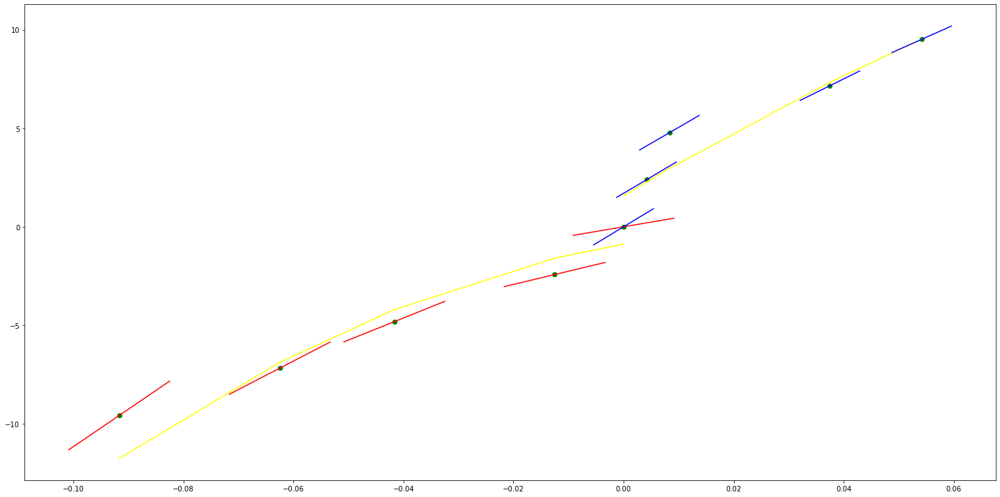

parameters (15.83718715058679, 59.232965769141664, -0.015139738929977381)
tangent[0]:54.08587994520096
tangent[1]:55.53761154254664
tangent[2]:56.857387696553644
tangent[3]:57.91318961513466
tangent[4]:59.232965769141664
parameters (-231.54162965610138, 115.75437832015704, 1.8402288979010823)
tangent[0]:115.75437832015704
tangent[1]:113.8251734618624
tangent[2]:111.89550552030846
tangent[3]:96.45955123765481
tangent[4]:81.02313387174183


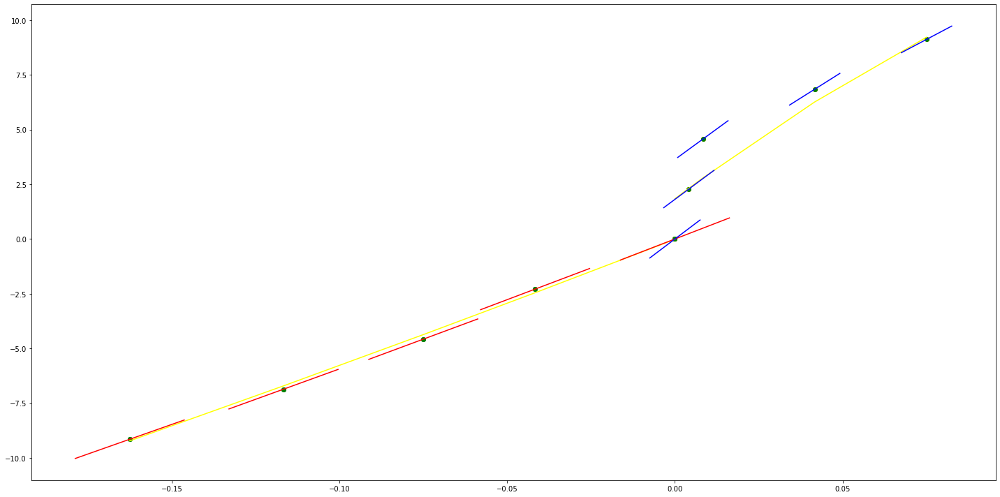

parameters (13.552698241142588, 43.38246177011685, -1.000854466084626)
tangent[0]:38.07430355540501
tangent[1]:39.42957337951927
tangent[2]:41.34955703394546
tangent[3]:43.15656539583348
tangent[4]:43.38246177011685
parameters (-1834.1942605727797, 344.27716857242393, 0.5440511648878292)
tangent[0]:344.27716857242393
tangent[1]:328.99466199333153
tangent[2]:313.708487025718
tangent[3]:252.56745554378494
tangent[4]:221.998773997079


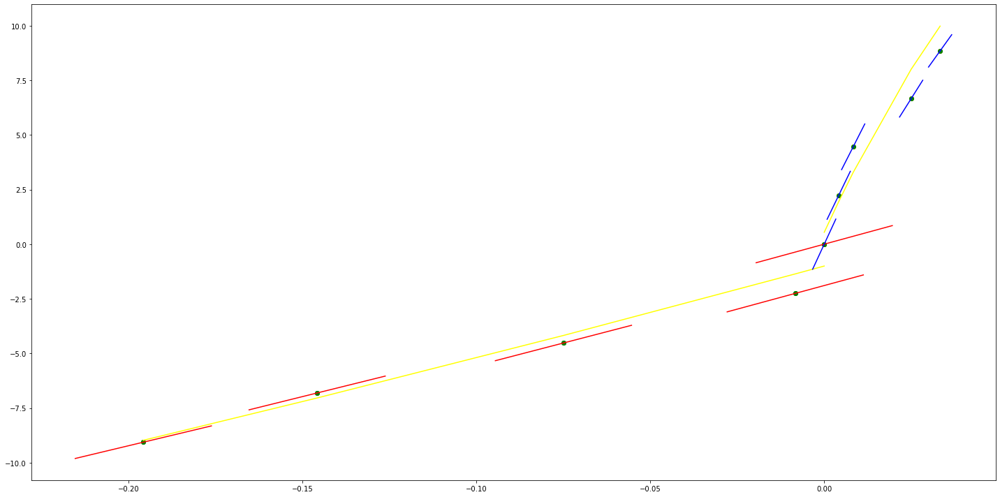

parameters (2.935433782516973, 21.08315254125795, -0.44797387521599424)
tangent[0]:19.24850642718484
tangent[1]:19.76220733912531
tangent[2]:20.349294095628707
tangent[3]:20.83853110242568
tangent[4]:21.08315254125795
parameters (-733.876709870938, 196.08676499293728, 0.6588431741921986)
tangent[0]:196.08676499293728
tangent[1]:189.97063649287287
tangent[2]:183.8559757462282
tangent[3]:147.16214025268133
tangent[4]:141.04601175261692


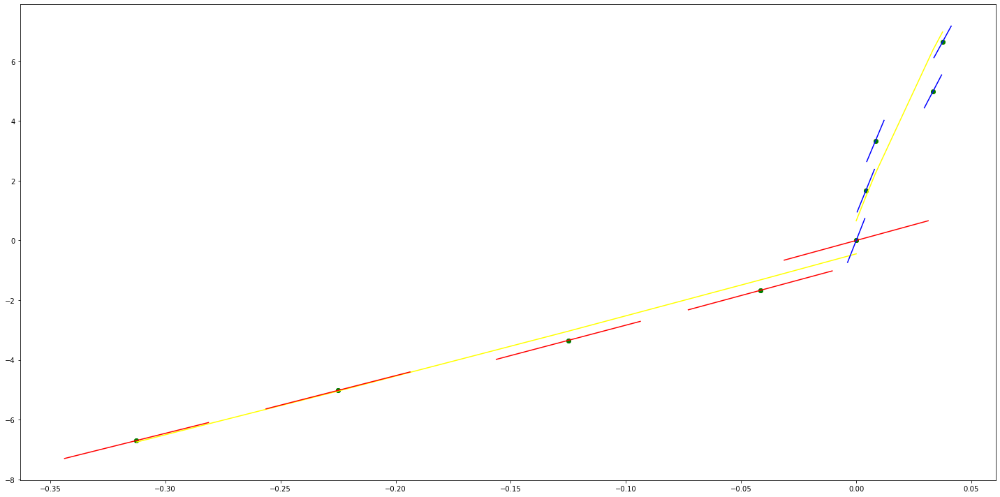

parameters (-2891.764849554049, -134.08434235102982, -1.0138693919346382)
tangent[0]:275.5862003555931
tangent[1]:251.48623209940973
tangent[2]:227.3862638432263
tangent[3]:-109.98437409484637
tangent[4]:-134.08434235102982
parameters (635.6933518038749, -25.42328997395526, 0.8324670835133546)
tangent[0]:-25.42328997395526
tangent[1]:-20.126692966725372
tangent[2]:85.82304659172283
tangent[3]:117.60771418191658
tangent[4]:122.90431118914648


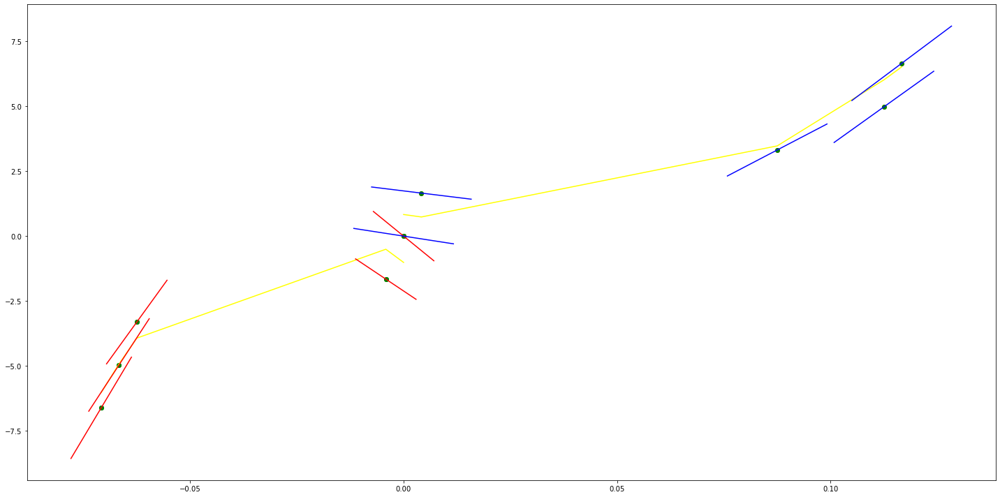

parameters (-195.55476500856597, 18.426904184709535, -0.43053582284575426)
tangent[0]:64.05647972321827
tangent[1]:62.42672631163688
tangent[2]:60.79736400958551
tangent[3]:28.204642435137835
tangent[4]:18.426904184709535
parameters (-328.5749297526261, 117.53694168992597, 1.7587444319180383)
tangent[0]:117.53694168992597
tangent[1]:114.79925537522709
tangent[2]:112.06091191066871
tangent[3]:95.63216542303739
tangent[4]:92.89382195847901


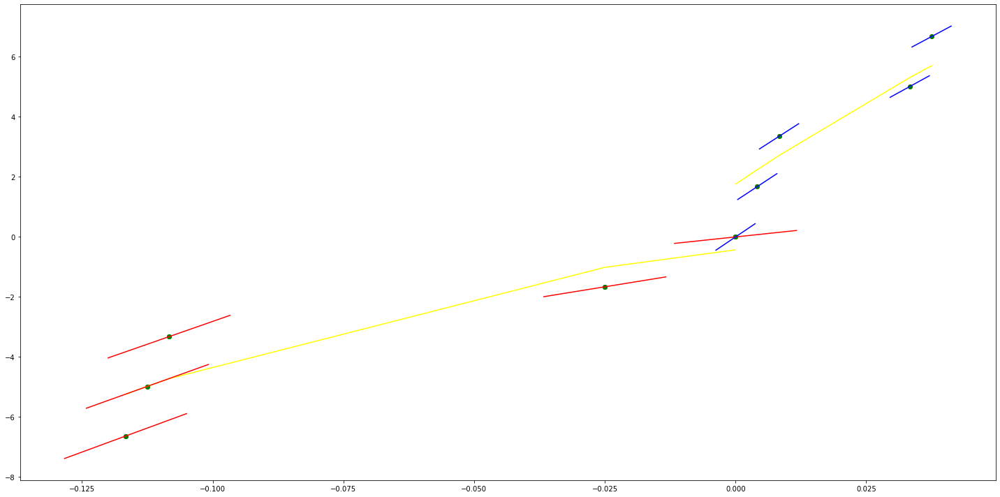

parameters (-1241.197441355704, 10.595738125675924, -0.05771146811988957)
tangent[0]:186.43121485277308
tangent[1]:124.37134278498789
tangent[2]:114.02968570361217
tangent[3]:103.68554622735373
tangent[4]:10.595738125675924
parameters (-203.64068853415176, 78.3344717694533, 1.5716429377526757)
tangent[0]:78.3344717694533
tangent[1]:76.63733027120968
tangent[2]:74.94059605434313
tangent[3]:73.24345455609951
tangent[4]:49.48550998757416


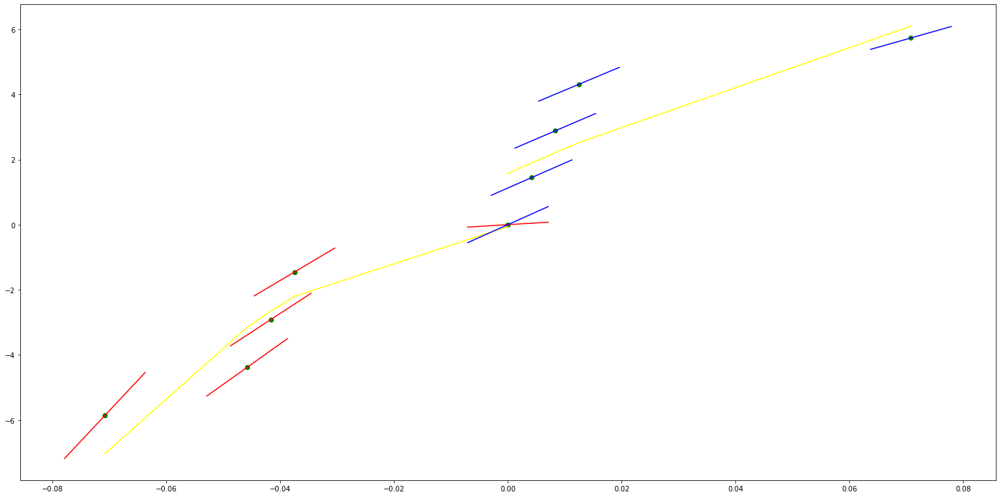

parameters (-641.8248750826389, -49.119877205846606, -1.62898328663133)
tangent[0]:122.03299493294038
tangent[1]:116.68402642400166
tangent[2]:-38.42322383771935
tangent[3]:-43.77219234665806
tangent[4]:-49.119877205846606
parameters (-23.50721267932152, 31.507393260482058, 1.1478265469631228)
tangent[0]:31.507393260482058
tangent[1]:31.311484150012593
tangent[2]:29.744352309532943
tangent[3]:26.80595072461775
tangent[4]:22.10450818875345


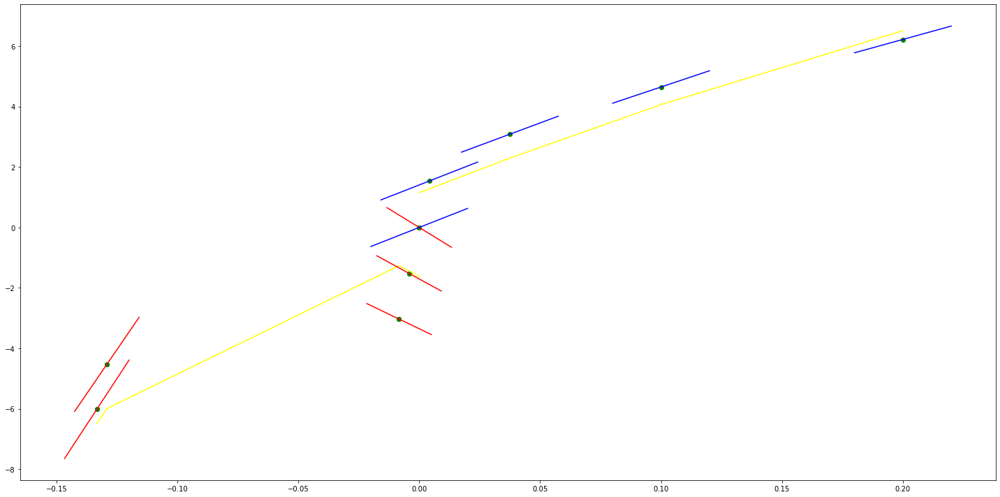

parameters (17.087501628307464, 31.002869798071597, 0.7755157488917516)
tangent[0]:20.180774041809116
tangent[1]:21.60474390250249
tangent[2]:21.747151141072806
tangent[3]:21.889524204639862
tangent[4]:31.002869798071597
parameters (90.65442704211807, -81.51914531811782, -0.017348053601670146)
tangent[0]:-81.51914531811782
tangent[1]:92.23511274299047
tangent[2]:92.99062673795946
tangent[3]:93.74614073292848
tangent[4]:98.27886208503439


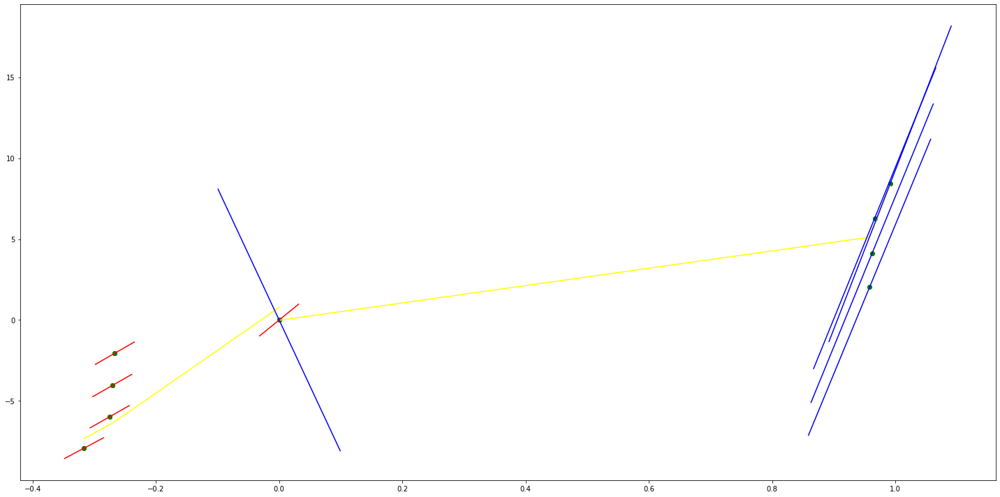

parameters (-1186.931819588695, -32.08366284735802, -1.1518017474923876)
tangent[0]:175.62940558066356
tangent[1]:165.73988965985058
tangent[2]:155.8479998753984
tangent[3]:-22.19177306290584
tangent[4]:-32.08366284735802
parameters (-491.6165448873634, 198.65230952623932, 0.7077445857250126)
tangent[0]:198.65230952623932
tangent[1]:194.5561604742378
tangent[2]:169.97533322986965
tangent[3]:165.87820094477837
tangent[4]:161.78106865968707


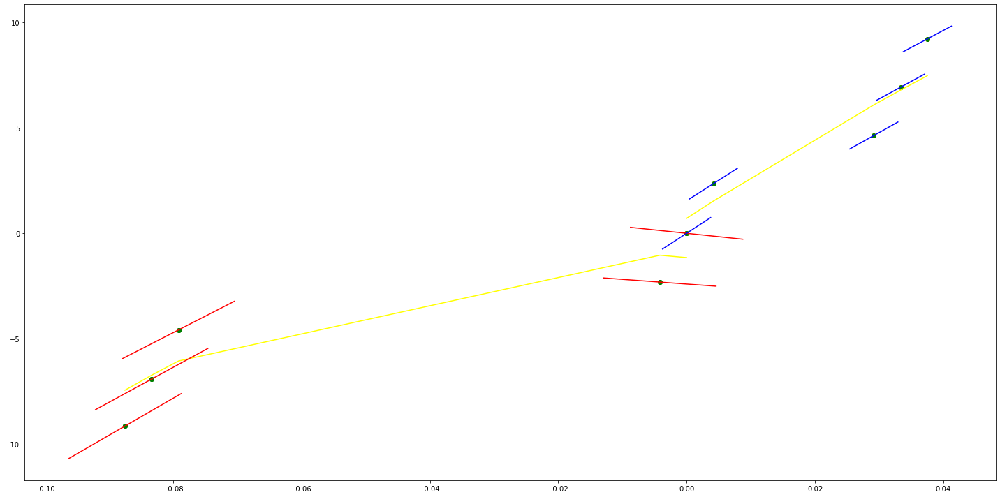

parameters (-0.11486130097097096, -0.5781641275843897, 0.008686334273003832)
tangent[0]:-0.11201860456966523
tangent[1]:-0.22305111893406993
tangent[2]:-0.35227008252641223
tangent[3]:-0.475745981070206
tangent[4]:-0.5781641275843897
parameters (163.69707230295413, -46.51318800716265, -0.015000978068462574)
tangent[0]:-46.51318800716265
tangent[1]:-42.420761199588796
tangent[2]:-41.05683719316058
tangent[3]:-39.692585792587764
tangent[4]:-34.23590758444109


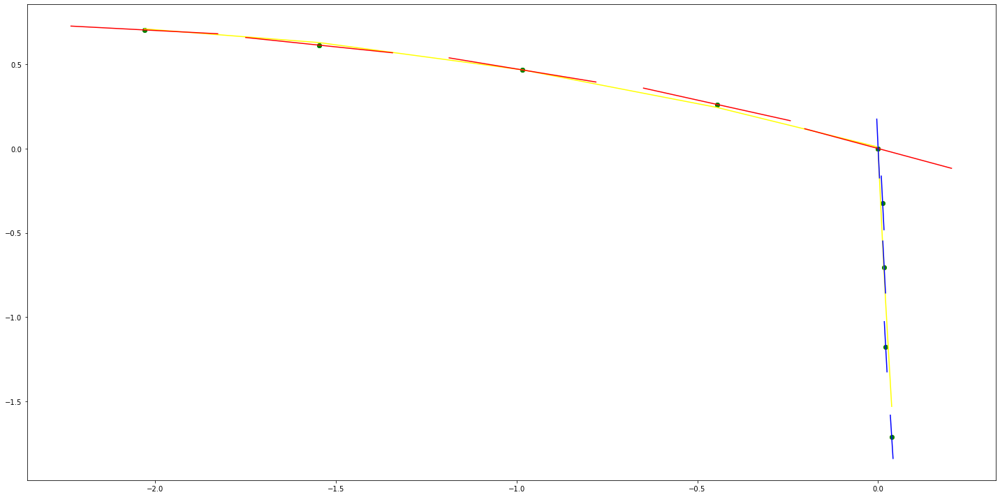

parameters (2811.054018982633, 229.23641474348338, 1.5431067502626805)
tangent[0]:-356.4017132472445
tangent[1]:-332.9743890530433
tangent[2]:-309.55268696687995
tangent[3]:205.80909054928213
tangent[4]:229.23641474348338
parameters (2.600443247353011, -12.384922913680853, -2.731231161144668)
tangent[0]:-12.384922913680853
tangent[1]:-12.363256020543908
tangent[2]:-12.01652852060134
tangent[3]:-11.084701290004348
tangent[4]:-9.936173922718933


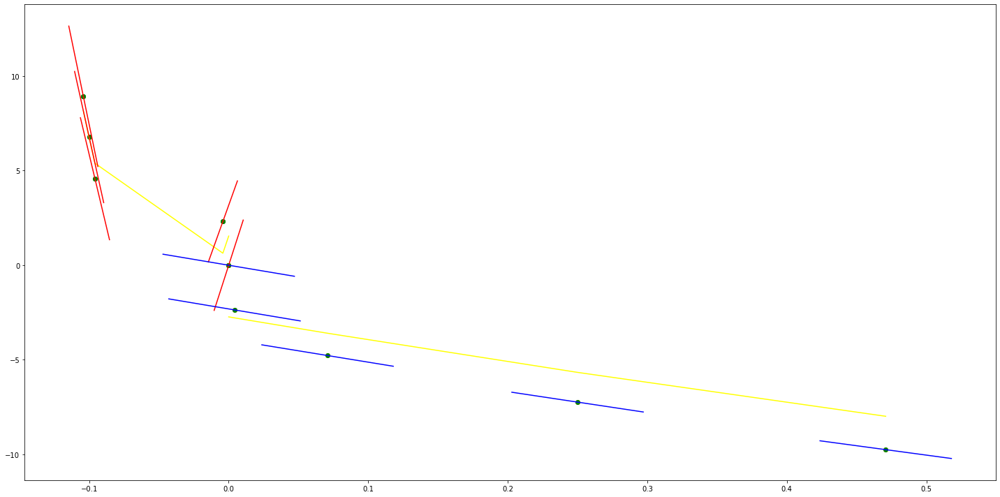

parameters (296.04519685029067, -311.316270928828, 2.0456160772026077)
tangent[0]:-338.4535499433067
tangent[1]:-328.5857714418928
tangent[2]:-318.71740085008526
tangent[3]:-313.7835115993783
tangent[4]:-311.316270928828
parameters (-8350.877443712894, -32.717358227522155, -1.6045382854435466)
tangent[0]:-32.717358227522155
tangent[1]:-102.31357084342541
tangent[2]:-519.85744302907
tangent[3]:-589.436953890086
tangent[4]:-659.0331665059891


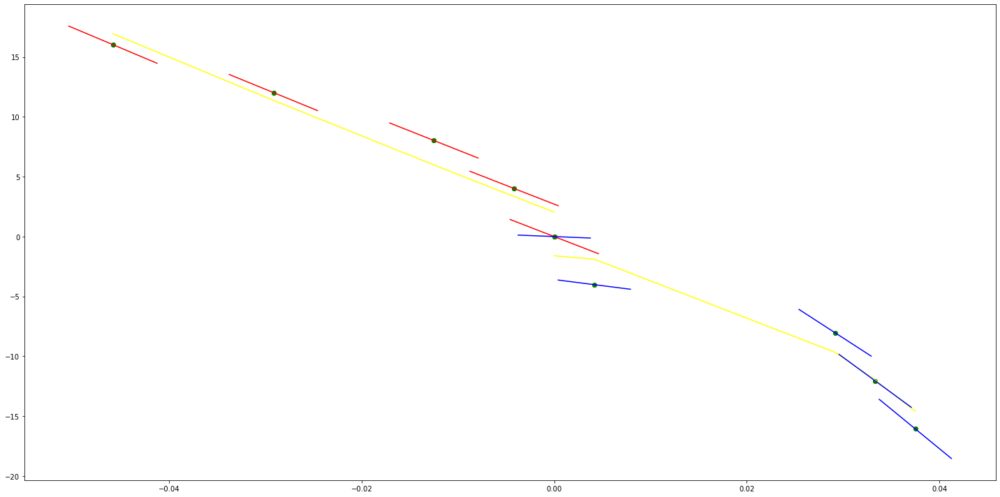

parameters (-699.6025911043257, -392.1612547098774, -1.4213621986301006)
tangent[0]:-333.86057238278954
tangent[1]:-345.5201491661342
tangent[2]:-351.3506371603977
tangent[3]:-357.1811251546611
tangent[4]:-392.1612547098774
parameters (1921.0107258565515, -792.5910579850886, -0.514915366374173)
tangent[0]:-792.5910579850886
tangent[1]:-776.5851966172518
tangent[2]:-760.5754932279633
tangent[3]:-728.559928470838
tangent[4]:-712.5502250815495


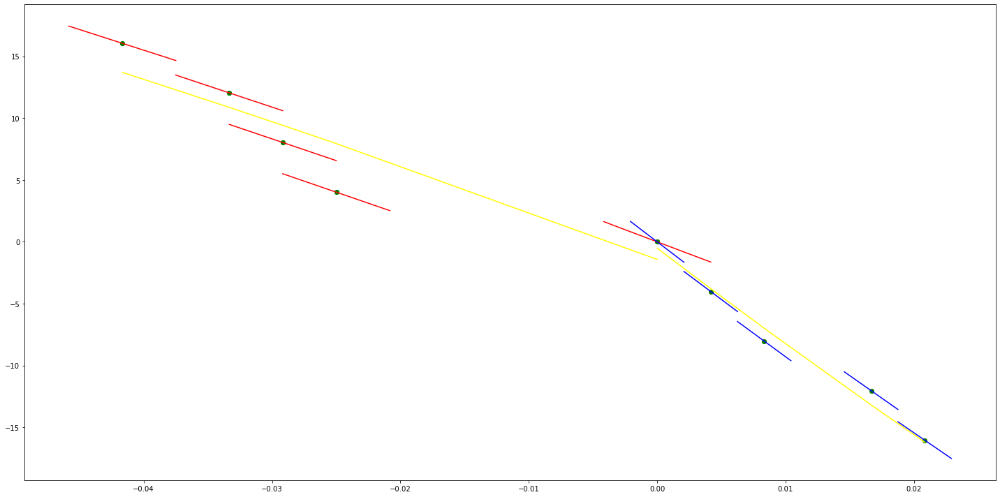

parameters (317.77791796535627, 117.14152012621278, -1.044445221887327)
tangent[0]:77.41928038054326
tangent[1]:95.95653744713434
tangent[2]:106.54934656459153
tangent[3]:114.49379451372543
tangent[4]:117.14152012621278
parameters (57.451530565314975, 63.38362011654862, 0.9419290008613689)
tangent[0]:63.38362011654862
tangent[1]:63.86242117227996
tangent[2]:69.12877317308012
tangent[3]:69.60757422881146
tangent[4]:78.2253038136087


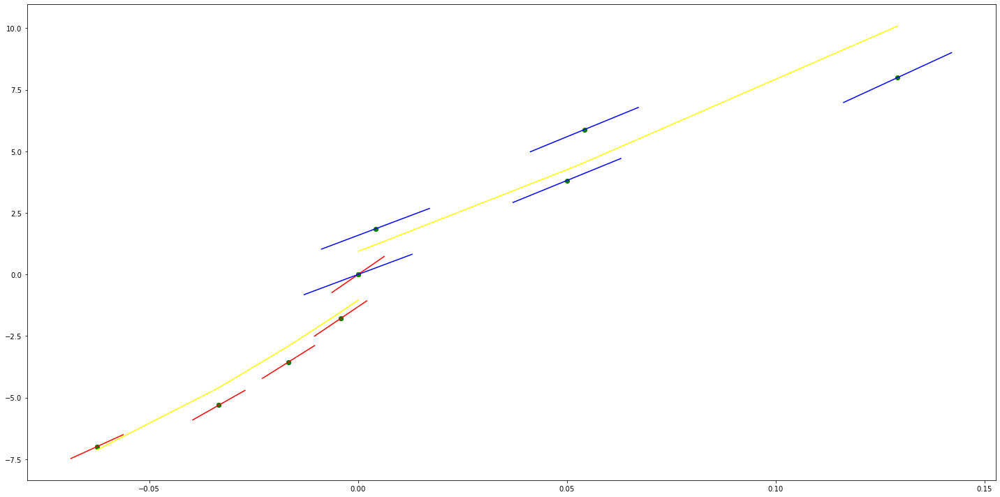

parameters (-941.2629511260741, 116.15887635113337, 0.3367124227390325)
tangent[0]:233.81674524189265
tangent[1]:210.28517146374077
tangent[2]:202.44068602905608
tangent[3]:194.5962005943714
tangent[4]:116.15887635113337
parameters (-465.23814517547794, 282.3898510252752, 1.7316437915727552)
tangent[0]:282.3898510252752
tangent[1]:278.5125563233828
tangent[2]:274.6352616214904
tangent[3]:247.49699013711438
tangent[4]:235.86603650772742


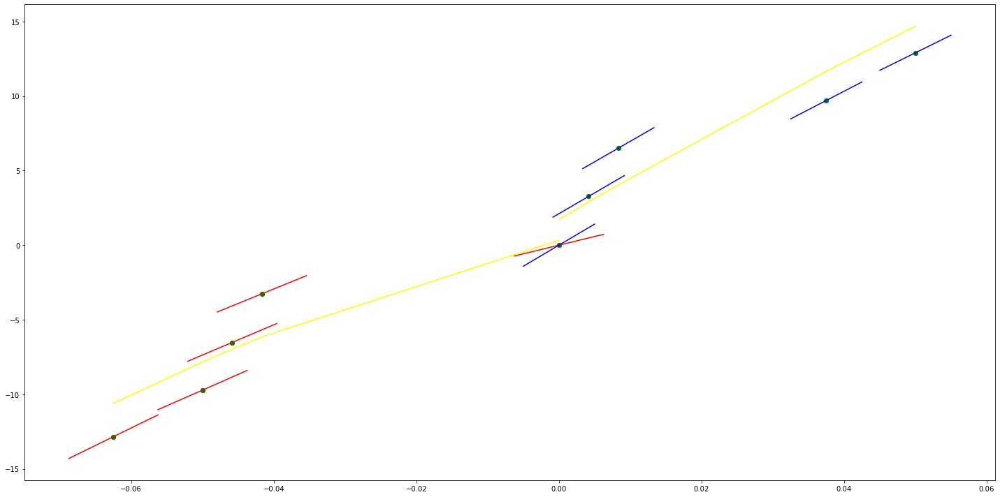

parameters (-690.5487846007984, -17.40224677904326, -1.5916673317749979)
tangent[0]:143.72626332699946
tangent[1]:137.97122975613638
tangent[2]:28.635259592722768
tangent[3]:-11.647213208180206
tangent[4]:-17.40224677904326
parameters (-36.50934491079278, 54.066536460733886, 1.0162156327773844)
tangent[0]:54.066536460733886
tangent[1]:53.76234059893716
tangent[2]:50.11140610785788
tangent[3]:46.76466747857533
tangent[4]:43.11373298749605


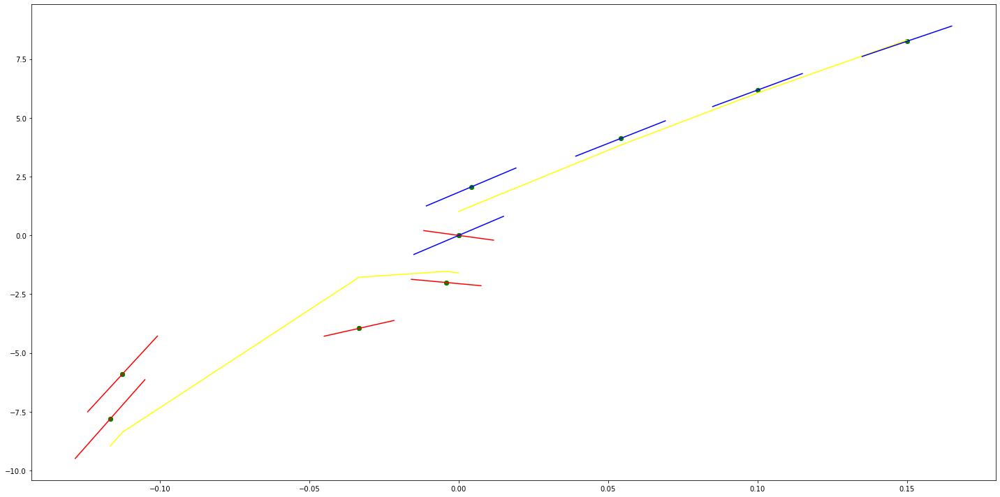

parameters (116.65226259937282, -104.35379676763844, 0.8083340469544107)
tangent[0]:-118.93532959256004
tangent[1]:-116.01902302757573
tangent[2]:-112.13053650608823
tangent[3]:-105.32597672414161
tangent[4]:-104.35379676763844
parameters (-874.048354563616, -50.49659997752365, -0.815300579947159)
tangent[0]:-50.49659997752365
tangent[1]:-57.78091896445683
tangent[2]:-137.90143543388527
tangent[3]:-159.75264429797565
tangent[4]:-167.03696328490884


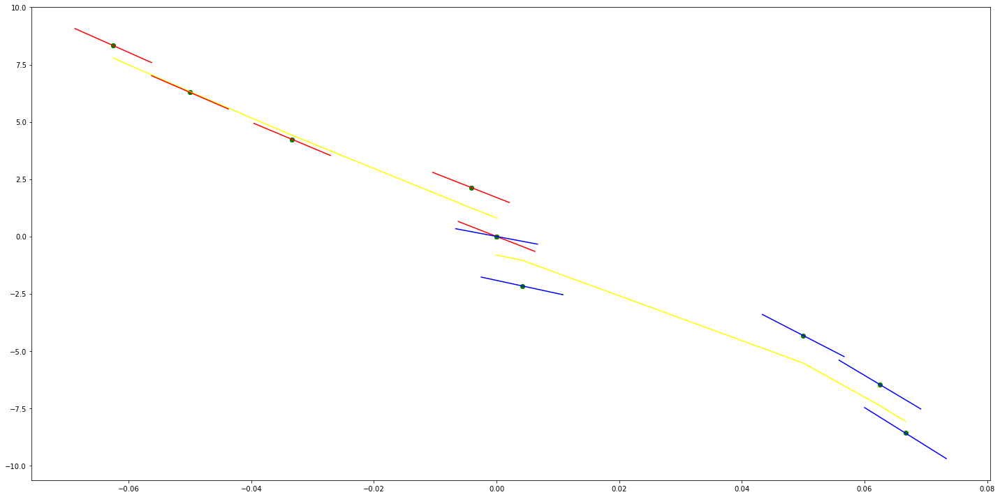

parameters (626.2097201052824, -8.498622296899637, 1.8410690969157688)
tangent[0]:-133.7405663179561
tangent[1]:-128.5217345105987
tangent[2]:-29.37269710688912
tangent[3]:-13.717454104257058
tangent[4]:-8.498622296899637
parameters (447.10836241258784, -149.35457653773148, -1.294355864133855)
tangent[0]:-149.35457653773148
tangent[1]:-145.62837544538496
tangent[2]:-123.27295732475558
tangent[3]:-119.5476504491339
tangent[4]:-115.82144935678738


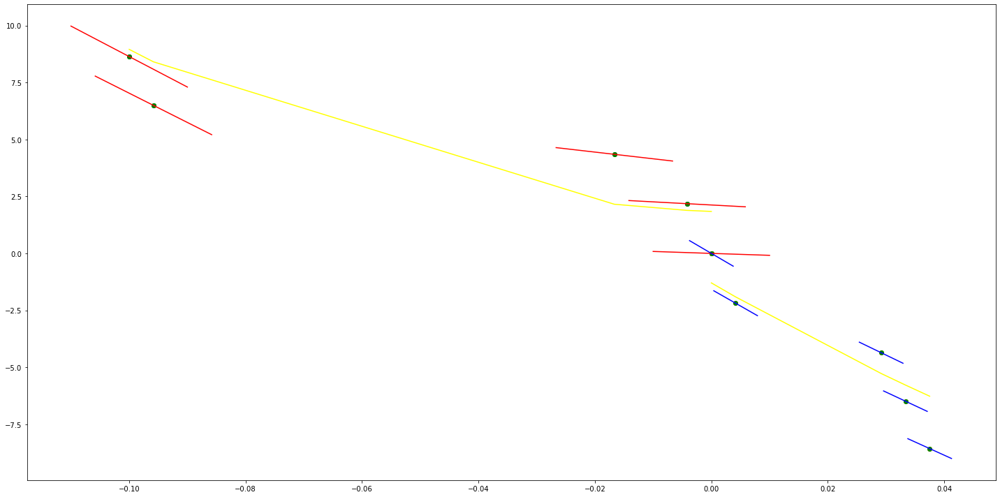

parameters (-727.5457578522056, 27.4003940874038, -0.46696076425482297)
tangent[0]:106.21688112704894
tangent[1]:100.15496987262436
tangent[2]:94.09160352668407
tangent[3]:33.462305341828376
tangent[4]:27.4003940874038
parameters (-240.6121808253346, 103.45155420733373, 0.37415347708593505)
tangent[0]:103.45155420733373
tangent[1]:101.44629229233539
tangent[2]:89.41568325106866
tangent[3]:87.41042133607033
tangent[4]:85.40564064543364


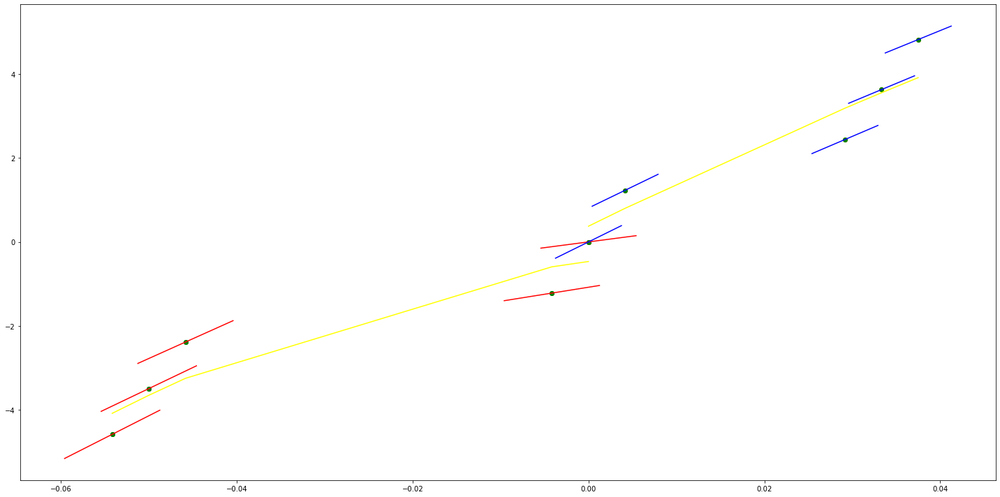

parameters (-302.76434466262793, 6.904269280009841, 0.06469540444652258)
tangent[0]:82.59535544566683
tangent[1]:57.36479154755139
tangent[2]:54.84155349913305
tangent[3]:52.318920979404034
tangent[4]:6.904269280009841
parameters (210.074156875797, 61.53990430091246, 0.8220273519761205)
tangent[0]:61.53990430091246
tangent[1]:63.290662324315356
tangent[2]:65.04142034771824
tangent[3]:82.54731998849216
tangent[4]:84.29807801189506


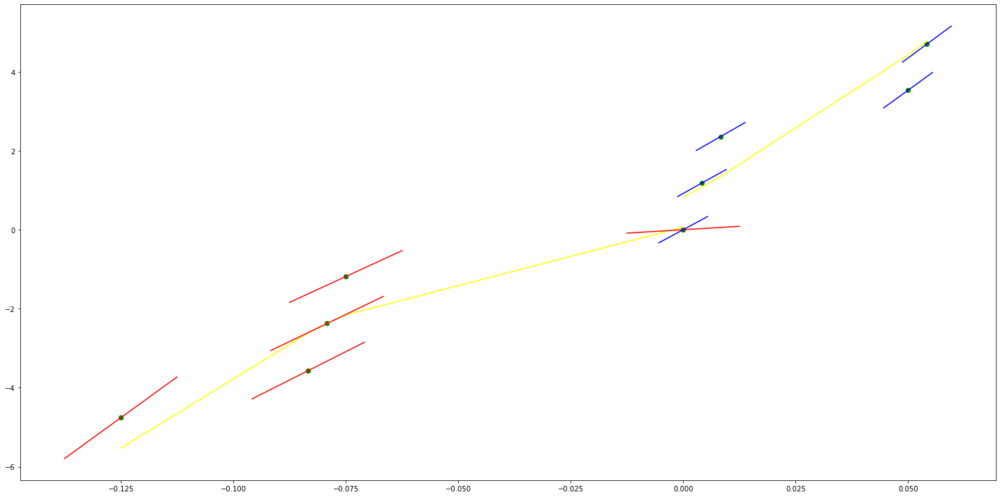

parameters (81.02841434562977, 174.3235038446461, 0.42736671161730433)
tangent[0]:166.22066241008312
tangent[1]:166.8957911584109
tangent[2]:167.5710819635674
tangent[3]:170.2720831273646
tangent[4]:174.3235038446461
parameters (-1523.1215911782606, 312.71182623049157, 1.2240886849239203)
tangent[0]:312.71182623049157
tangent[1]:300.0211771327943
tangent[2]:287.3274817919147
tangent[3]:211.17140223300163
tangent[4]:198.47770689212203


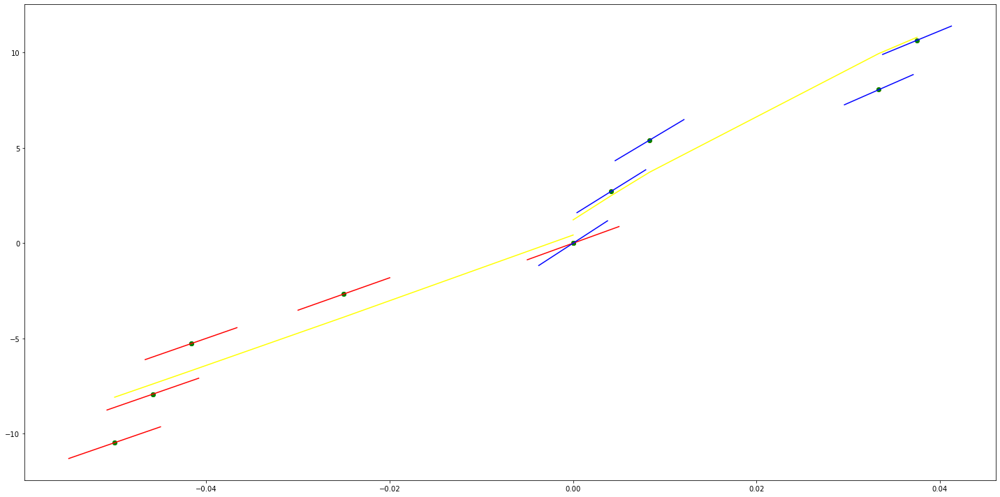

parameters (0.0712078862180066, -0.7373080062153311, -0.005220883271625465)
tangent[0]:-1.609011165862171
tangent[1]:-1.4505736190271064
tangent[2]:-1.2885756778811412
tangent[3]:-1.0227328551953259
tangent[4]:-0.7373080062153311
parameters (-138.33015512074095, 176.6173150562208, 0.001210946393395082)
tangent[0]:176.6173150562208
tangent[1]:-180.73567789246337
tangent[2]:-184.19393177048195
tangent[3]:-185.3467752832582
tangent[4]:-186.49934213572422


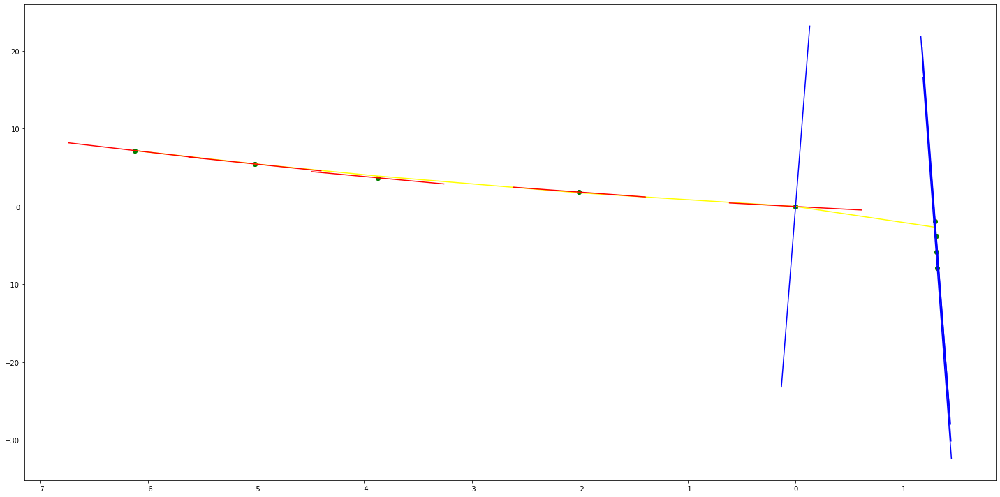

parameters (1490.784100749582, -645.0690795983628, 0.4379036979911131)
tangent[0]:-707.1840899401949
tangent[1]:-694.7628768127494
tangent[2]:-682.3386821171024
tangent[3]:-657.4932742940098
tangent[4]:-645.0690795983628
parameters (647.2381180420483, -325.25383841110846, -1.3147877001067547)
tangent[0]:-325.25383841110846
tangent[1]:-319.859755935346
tangent[2]:-298.2860149847685
tangent[3]:-282.1050620337173
tangent[4]:-260.5300266069036


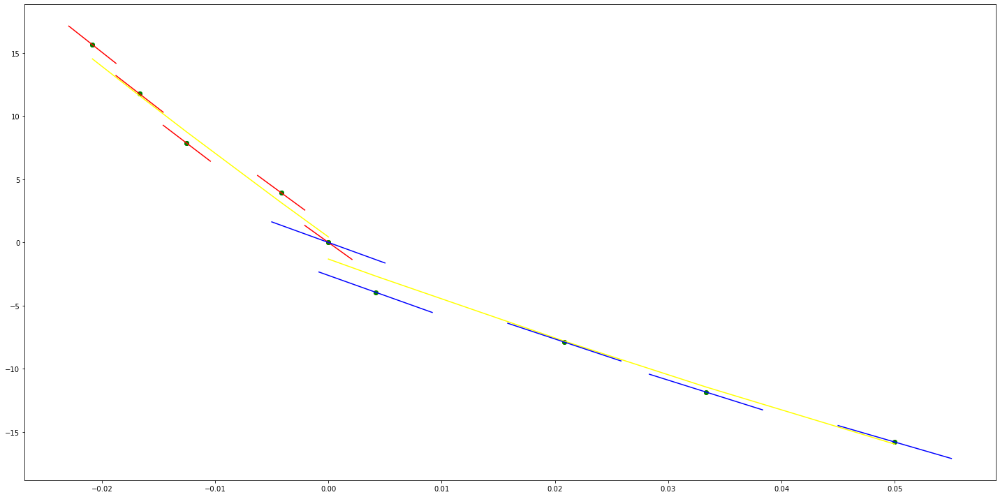

parameters (2331.6198875832188, 363.09177506793446, -0.9297019448485222)
tangent[0]:265.9378375921169
tangent[1]:285.36955773523545
tangent[2]:304.80127787835397
tangent[3]:343.66005492481594
tangent[4]:363.09177506793446
parameters (31.303989529535883, 57.66236071620265, 0.9188668791658007)
tangent[0]:57.66236071620265
tangent[1]:57.92318555696274
tangent[2]:62.618783986393126
tangent[3]:64.18398346286992
tangent[4]:66.27095783682502


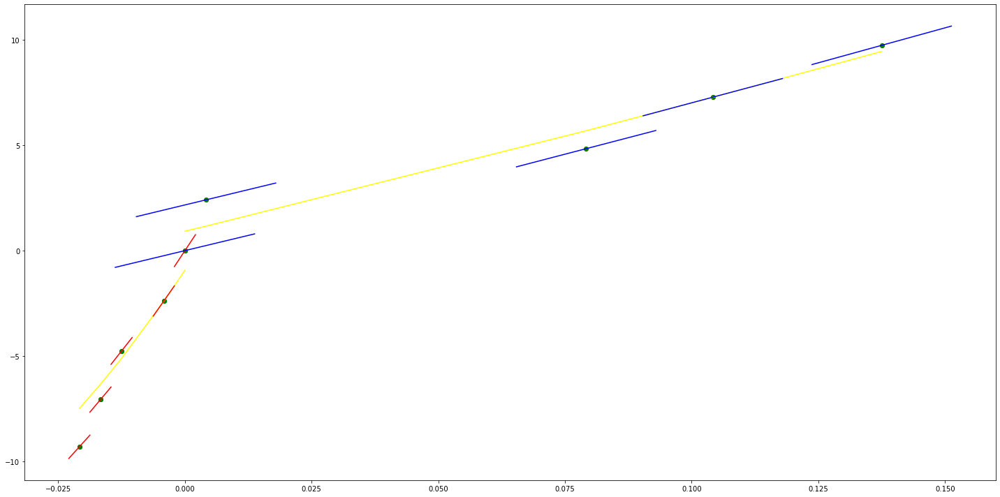

parameters (21.714527729443866, 65.40003293371387, -0.46136455919543357)
tangent[0]:58.34281142164462
tangent[1]:60.514264194589
tangent[2]:62.14285377429729
tangent[3]:64.31430654724169
tangent[4]:65.40003293371387
parameters (-5176.571441359413, 599.4664756583288, 0.1615984170658297)
tangent[0]:599.4664756583288
tangent[1]:556.3352824089222
tangent[2]:513.1937360166328
tangent[3]:426.92099637493686
tangent[4]:383.7794499826475


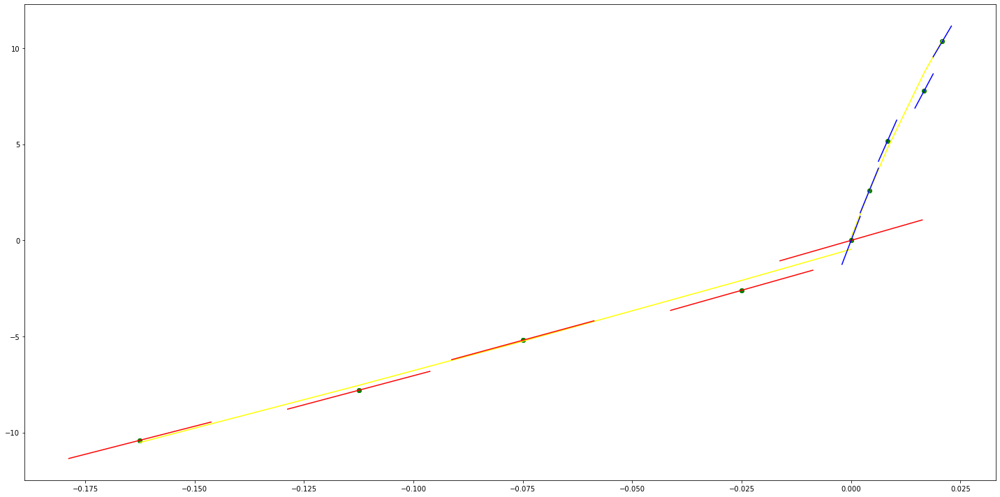

parameters (-1042.720129046865, 9.587382257893186, -0.6169168611023657)
tangent[0]:200.75134895631302
tangent[1]:165.9954016149229
tangent[2]:105.1693656071031
tangent[3]:61.723388710236435
tangent[4]:9.587382257893186
parameters (-226.60078476252113, 113.45044259751108, 1.6743377847326433)
tangent[0]:113.45044259751108
tangent[1]:111.56195165730023
tangent[2]:109.67346071708938
tangent[3]:94.56689280011115
tangent[4]:81.34836262177424


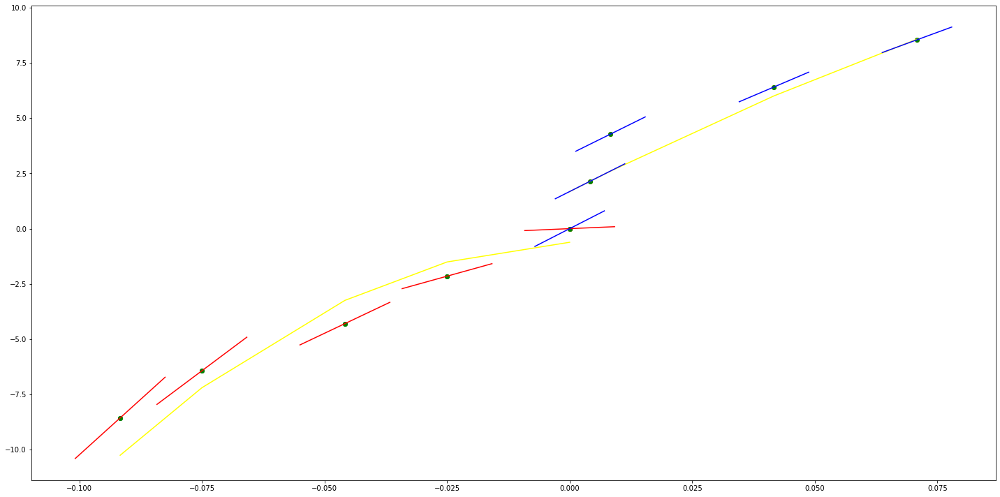

parameters (7.452005620347413, 22.57742847184989, 0.04573595252493365)
tangent[0]:18.230435129321393
tangent[1]:19.472431098042215
tangent[2]:20.466036815425614
tangent[3]:21.459627628797776
tangent[4]:22.57742847184989
parameters (-785.3456104176796, 161.9975660999139, 0.6841634144824261)
tangent[0]:161.9975660999139
tangent[1]:155.45249578269298
tangent[2]:148.90742546547202
tangent[3]:109.64014494458804
tangent[4]:103.09664531858795


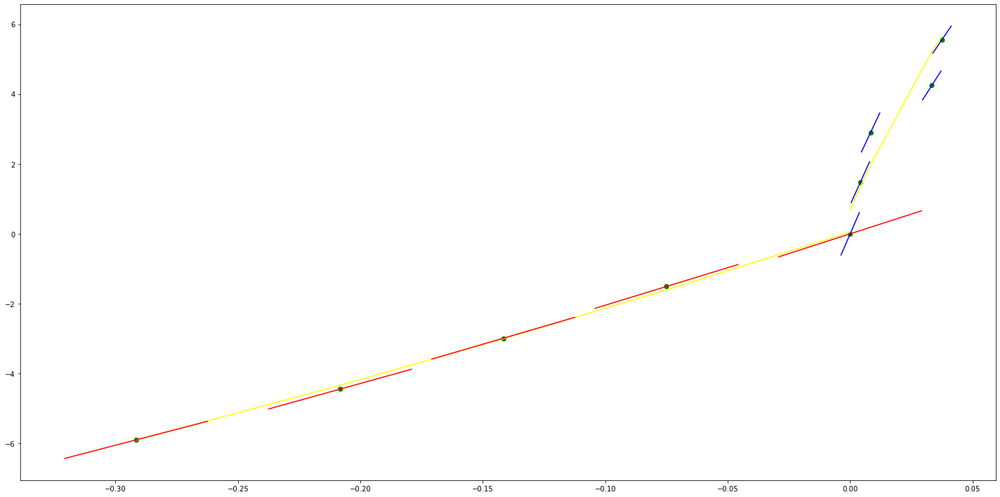

parameters (173.52767746601373, 64.56409026382839, -0.5589609090346236)
tangent[0]:37.08875897992458
tangent[1]:52.99569411787912
tangent[2]:54.44152672652595
tangent[3]:63.11791059982663
tangent[4]:64.56409026382839
parameters (-12.622042466173271, 23.427902876139573, 0.616425235076742)
tangent[0]:23.427902876139573
tangent[1]:23.322710774226486
tangent[2]:22.060506527609157
tangent[3]:20.377584361509342
tangent[4]:18.694636951324597


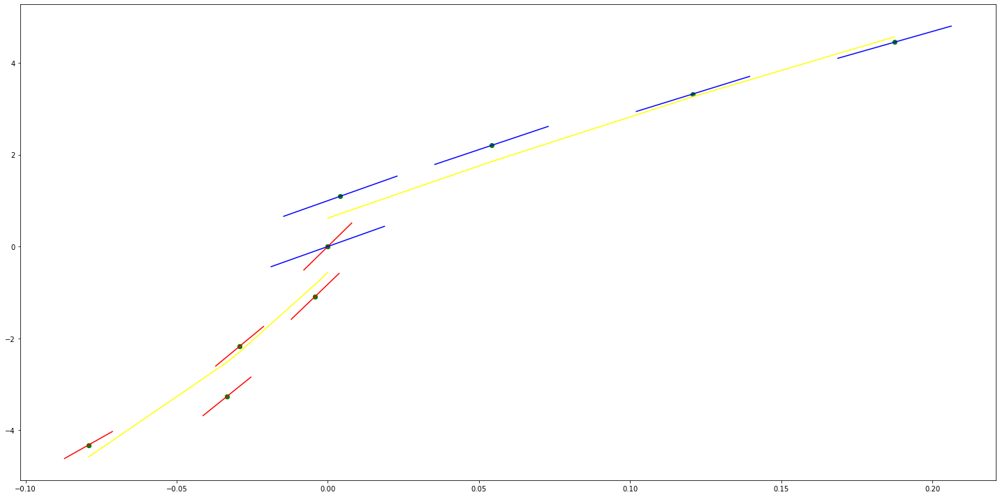

parameters (6.178713860899284, 17.848365648925164, -1.2670798639829954)
tangent[0]:14.141137332385593
tangent[1]:15.788802600243883
tangent[2]:17.436455510674453
tangent[3]:17.79688460503615
tangent[4]:17.848365648925164
parameters (-131.27910865018367, 80.13874949034228, 0.407203460640637)
tangent[0]:80.13874949034228
tangent[1]:79.04466939885165
tangent[2]:67.01083862532391
tangent[3]:65.91675853383327
tangent[4]:54.97674529357887


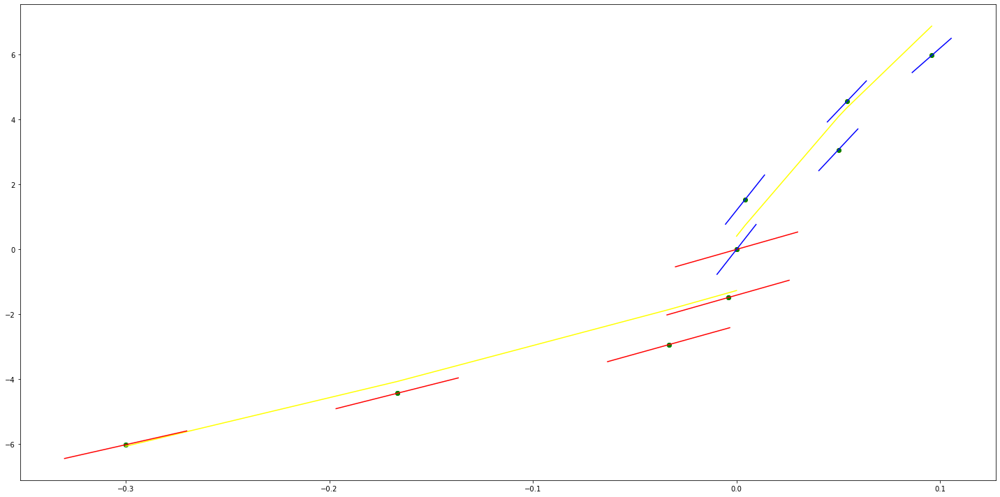

parameters (-124.66857988114965, -8.22366171655246, -0.4287380565679003)
tangent[0]:53.07188961645262
tangent[1]:52.032901671723124
tangent[2]:35.41034124184992
tangent[3]:11.515613210349489
tangent[4]:-8.22366171655246
parameters (-126.67198785251878, 62.7737051783803, 1.3192167671470751)
tangent[0]:62.7737051783803
tangent[1]:61.71827417559311
tangent[2]:60.66258982883022
tangent[3]:56.440105785754355
tangent[4]:40.60610730418951


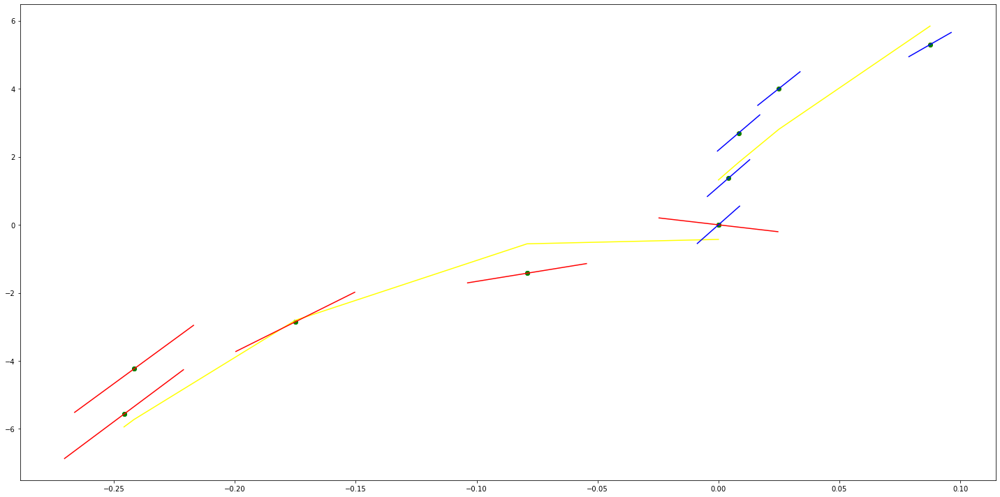

parameters (384.2460590193798, 100.38853825775504, -1.3883923557124553)
tangent[0]:84.37777347053553
tangent[1]:87.58008012640303
tangent[2]:90.78238678227055
tangent[3]:97.18623160188753
tangent[4]:100.38853825775504
parameters (-11.431996567990257, 25.172922100528698, 0.7447952254226351)
tangent[0]:25.172922100528698
tangent[1]:25.077670705124202
tangent[2]:23.648671134125422
tangent[3]:22.029123044331378
tangent[4]:20.123797904330715


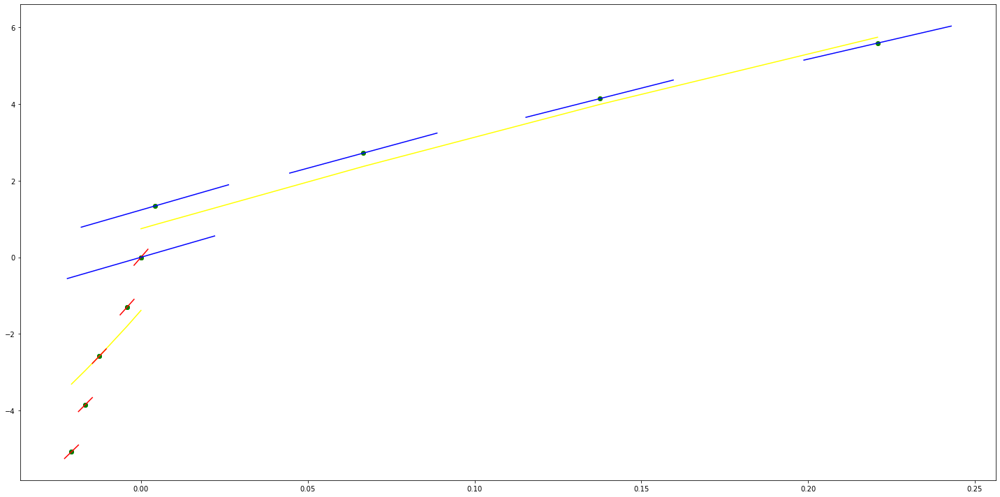

parameters (-669.1120182179967, -76.50527666857712, -1.3834816666984646)
tangent[0]:146.53250881210062
tangent[1]:140.9561292522718
tangent[2]:135.38108791647946
tangent[3]:-20.74549574239858
tangent[4]:-76.50527666857712
parameters (-63.24666531788802, 52.488539081863934, 1.7035757430375806)
tangent[0]:52.488539081863934
tangent[1]:51.96156786643529
tangent[2]:51.43447015767601
tangent[3]:45.10980362588721
tangent[4]:38.78513709409841


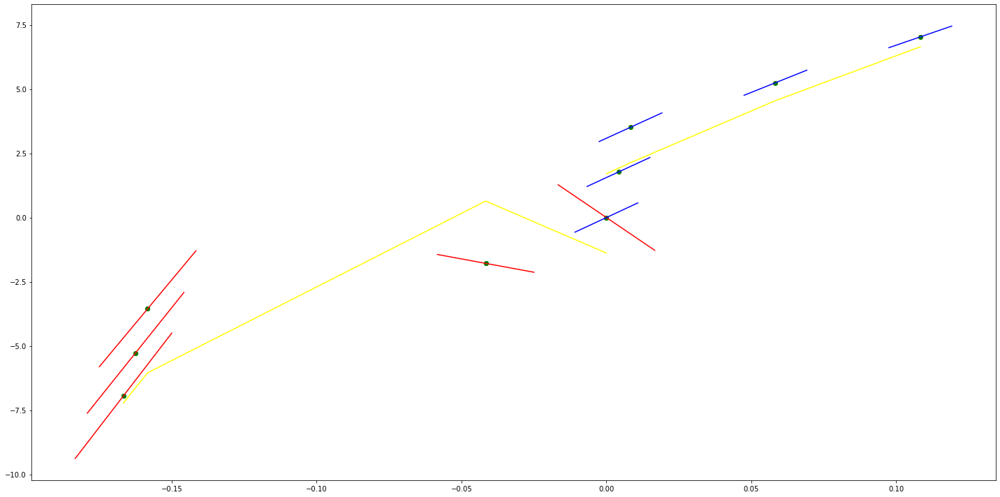

parameters (-63.61108131624917, 79.72553239899173, -1.2580030519457097)
tangent[0]:89.2671945964291
tangent[1]:81.84581696142494
tangent[2]:81.31580943189796
tangent[3]:80.78567468020834
tangent[4]:79.72553239899173
parameters (1563.7688946111875, -88.76096858522165, 1.660566045523351)
tangent[0]:-88.76096858522165
tangent[1]:-75.72851861753202
tangent[2]:-62.696068649842374
tangent[3]:171.86926554183577
tangent[4]:184.89858797173616


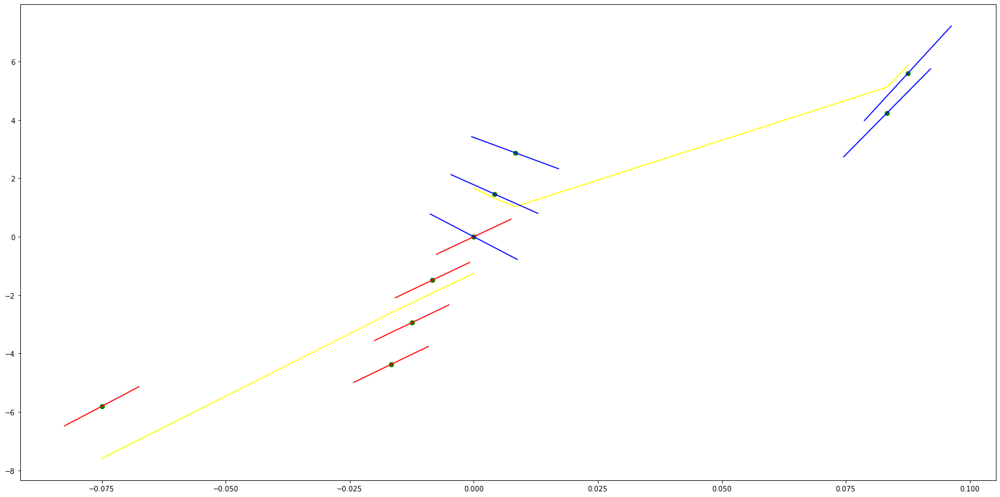

parameters (-0.470188753352216, 11.914290403725655, -0.19452956176763855)
tangent[0]:12.505943958108855
tangent[1]:12.345296447506017
tangent[2]:12.219913093404596
tangent[3]:12.016164320159467
tangent[4]:11.914290403725655
parameters (-3046.20842977005, 381.63954785498805, 0.2246600028148655)
tangent[0]:381.63954785498805
tangent[1]:356.25244680128446
tangent[2]:330.8653457475809
tangent[3]:280.09723605703323
tangent[4]:254.71013500332964


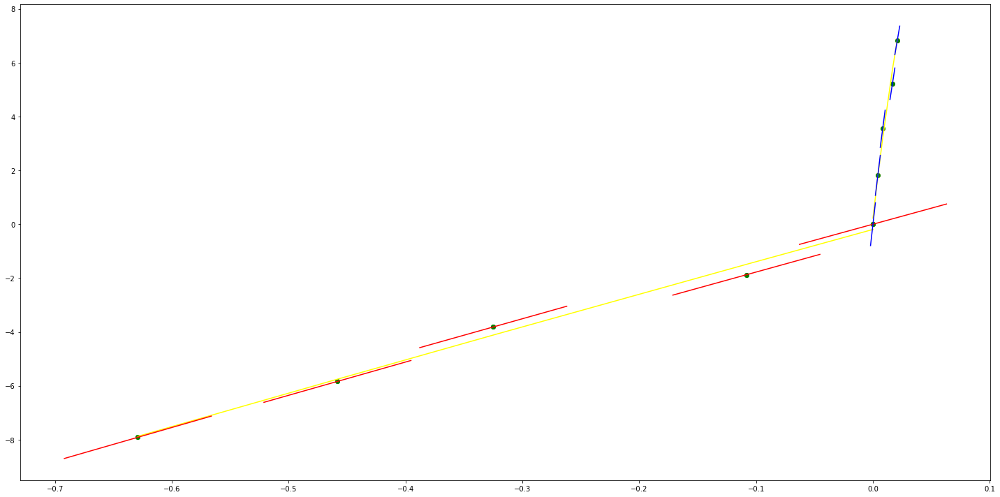

parameters (296.6726181178713, -156.67661557933909, 0.6632801987933586)
tangent[0]:-178.92706193817943
tangent[1]:-176.4545923387851
tangent[2]:-173.98212273939075
tangent[3]:-159.1484918334972
tangent[4]:-156.67661557933909
parameters (13.37997202212309, -31.497966029015807, -1.3803843934386963)
tangent[0]:-31.497966029015807
tangent[1]:-31.386457342183434
tangent[2]:-29.267952852032597
tangent[3]:-26.480476520719648
tangent[4]:-23.358474128909577


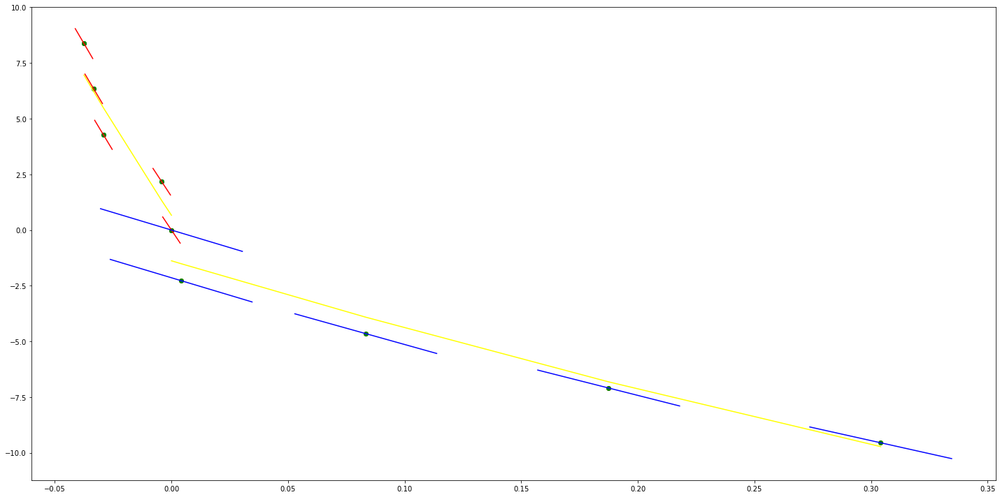

parameters (-1.0957211661314337, -17.58582428402425, 0.2949946537807363)
tangent[0]:-15.978767304178923
tangent[1]:-16.45357834854099
tangent[2]:-16.882737266237356
tangent[3]:-17.24797619398628
tangent[4]:-17.58582428402425
parameters (-10516.943537880185, 281.5318270399035, 0.10098364185486004)
tangent[0]:281.5318270399035
tangent[1]:-507.2389383011103
tangent[2]:-594.8871457458038
tangent[3]:-682.5143193034214
tangent[4]:-770.1625267481152


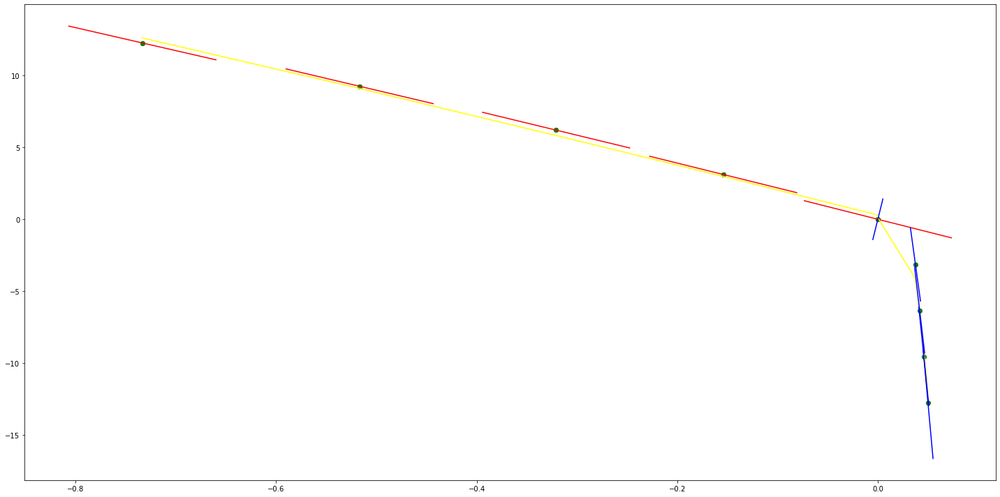

parameters (1526.5037451181286, -613.8942163066749, 0.452706706075959)
tangent[0]:-677.4975213507669
tangent[1]:-664.7756391389524
tangent[2]:-652.0568099346282
tangent[3]:-626.6130455109992
tangent[4]:-613.8942163066749
parameters (4567.950568710436, -678.1382667509549, -0.7870883799813685)
tangent[0]:-678.1382667509549
tangent[1]:-640.0689667113222
tangent[2]:-563.9395025331941
tangent[3]:-525.8702024935612
tangent[4]:-487.80090245392853


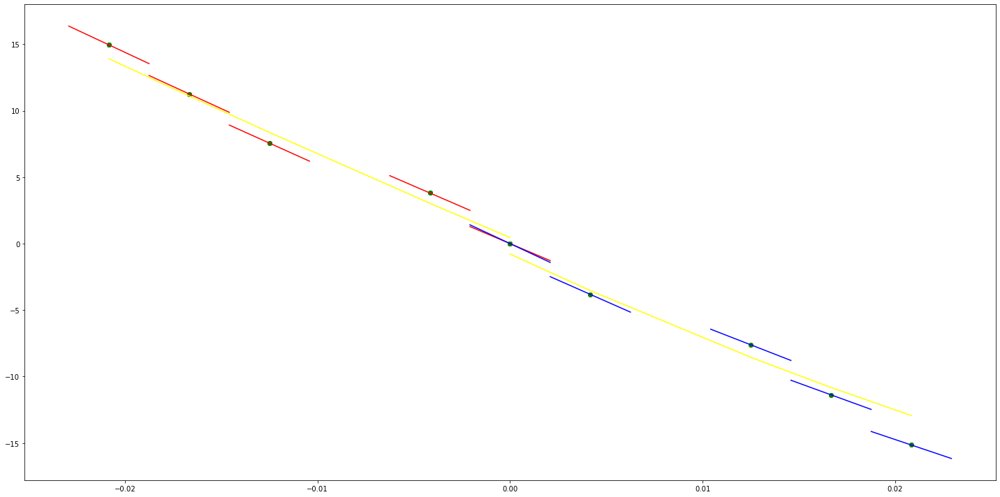

parameters (-99.69124404781402, -168.12212434484047, -0.367565135955998)
tangent[0]:-153.99926456556284
tangent[1]:-157.3221731121646
tangent[2]:-160.6452810412544
tangent[3]:-163.96838897034425
tangent[4]:-168.12212434484047
parameters (132.24990098261426, -125.3458172961507, -0.4554337134539274)
tangent[0]:-125.3458172961507
tangent[1]:-120.93739909679624
tangent[2]:-116.52924539724374
tangent[3]:-108.81457967332392
tangent[4]:-103.30425529898231


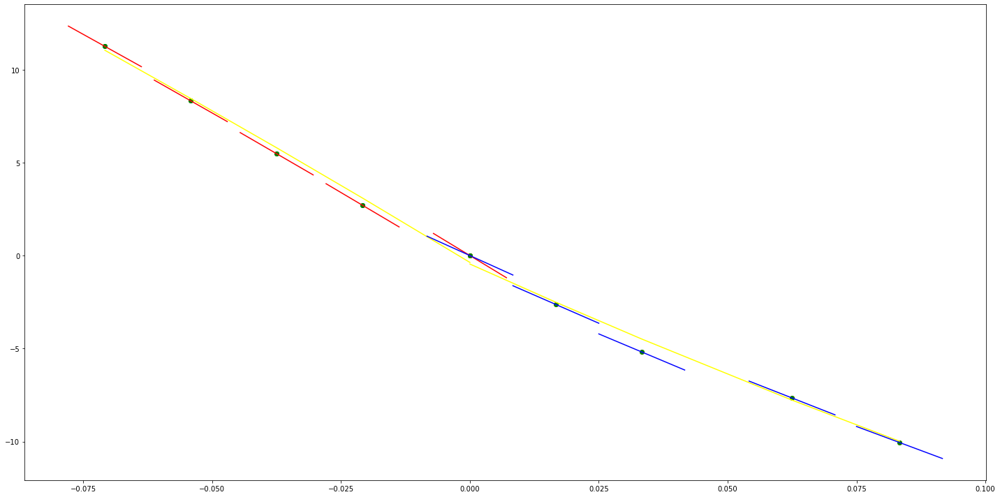

parameters (-119.7665121536223, 88.6277527746916, -0.5259694734512167)
tangent[0]:99.60626987776554
tangent[1]:95.61397296163669
tangent[2]:91.62191557853215
tangent[3]:89.62564735395559
tangent[4]:88.6277527746916
parameters (-51.25421713378198, 39.94330941981191, 0.9814815759166492)
tangent[0]:39.94330941981191
tangent[1]:39.51615677421897
tangent[2]:37.80764870028148
tangent[3]:34.390735060840775
tangent[4]:29.265313347462577


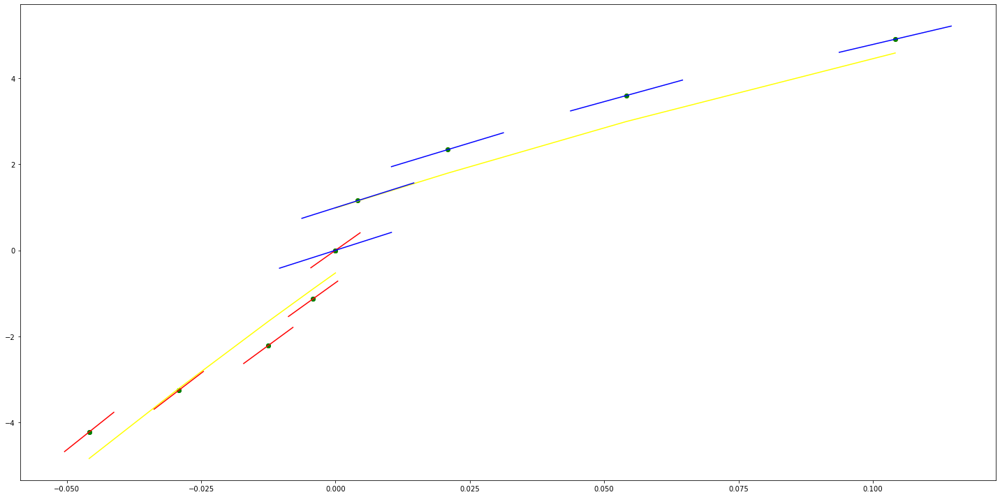

parameters (1232.3645917419306, 372.1521761013956, 0.860714559953576)
tangent[0]:300.26342000672184
tangent[1]:310.53394651429903
tangent[2]:331.0725348002701
tangent[3]:341.34306130784734
tangent[4]:372.1521761013956
parameters (136.4704837258235, 90.02234955959375, 1.0296655494230391)
tangent[0]:90.02234955959375
tangent[1]:91.15969457096476
tangent[2]:100.25763583903051
tangent[3]:104.8067429435471
tangent[4]:113.90468421161286


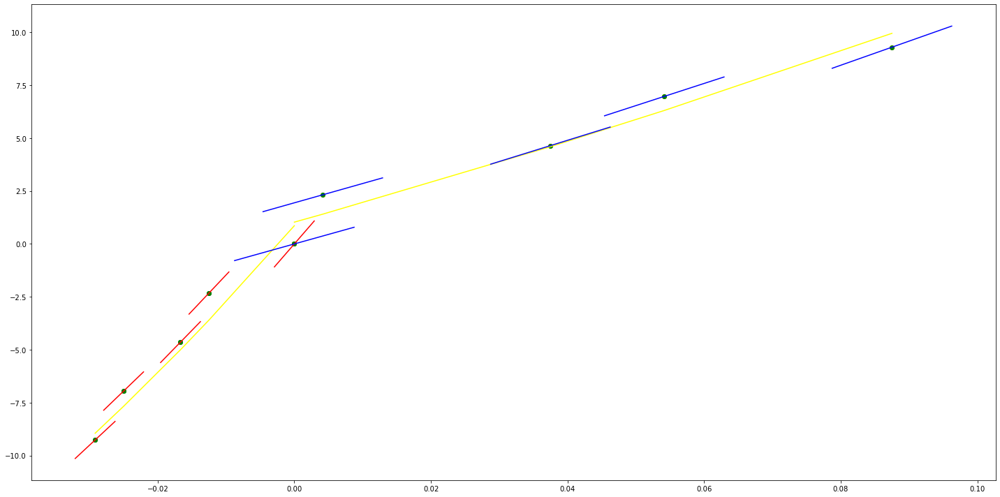

parameters (16.650842379987058, 137.68575907044007, -0.22468966976096724)
tangent[0]:136.02067483244136
tangent[1]:136.15944295283617
tangent[2]:136.29817777154622
tangent[3]:137.4082561313352
tangent[4]:137.68575907044007
parameters (-77.47829169107213, 180.92033628251207, 1.3026779449477763)
tangent[0]:180.92033628251207
tangent[1]:180.27463219955868
tangent[2]:179.62908307318867
tangent[3]:177.04642169795846
tangent[4]:173.17250711340486


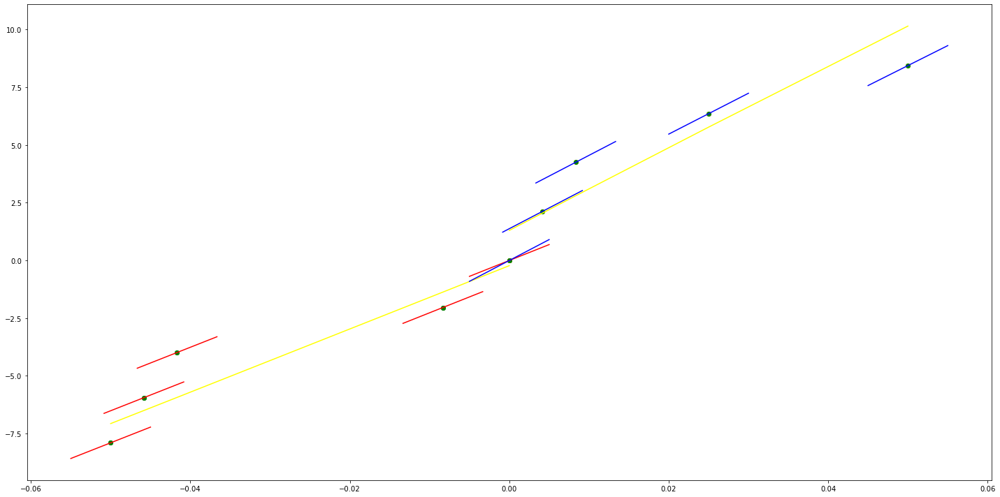

parameters (-3081.064506678644, 16.220618606395053, -0.6139240716718729)
tangent[0]:247.30045660729334
tangent[1]:221.62286500863354
tangent[2]:195.95143553898708
tangent[3]:41.89821020505487
tangent[4]:16.220618606395053
parameters (115.05115434223586, 56.386505765259244, 0.46941616545734216)
tangent[0]:56.386505765259244
tangent[1]:57.345342085547436
tangent[2]:68.85045751977103
tangent[3]:76.52045777515052
tangent[4]:78.43790031341823


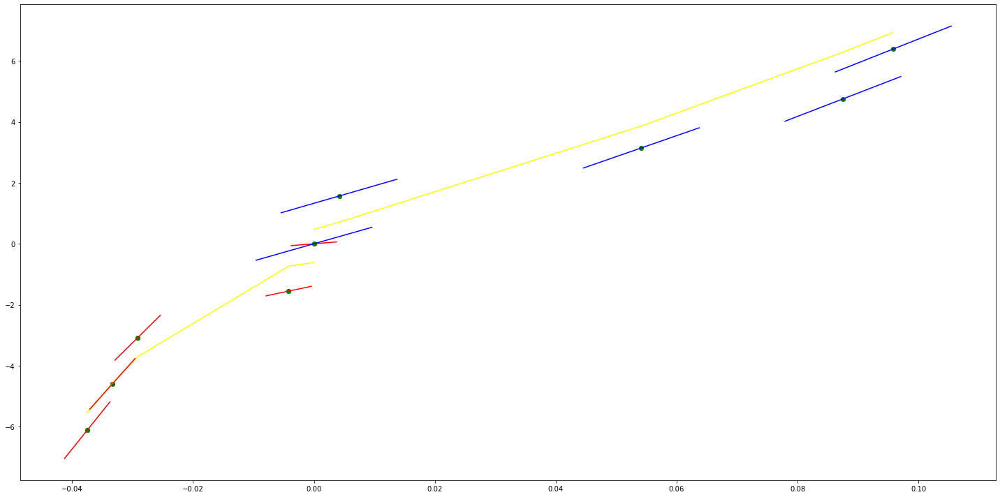

parameters (-636.4007392495683, -17.60961725090829, -1.1165938375612348)
tangent[0]:130.8843128411505
tangent[1]:125.5805490802446
tangent[2]:46.03045667404855
tangent[3]:-12.305853490002388
tangent[4]:-17.60961725090829
parameters (-63.61623370956825, 62.98309809611333, 0.9084114295485743)
tangent[0]:62.98309809611333
tangent[1]:62.45292040437779
tangent[2]:58.74205825963125
tangent[3]:54.500891190681756
tangent[4]:49.72967366246414


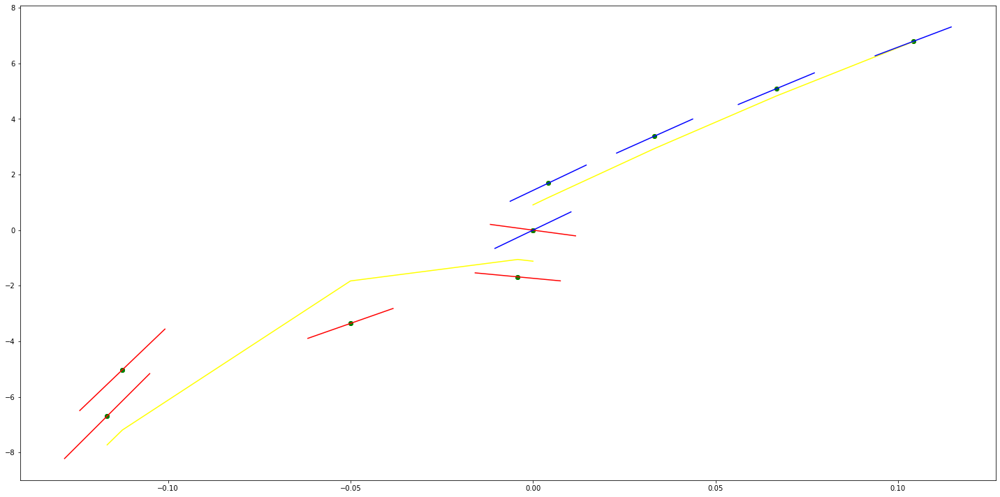

parameters (-668.580425558102, -19.249038715997763, -1.9727257001403542)
tangent[0]:136.7521691403253
tangent[1]:131.1815570345752
tangent[2]:3.0360840287048916
tangent[3]:-13.678426610247657
tangent[4]:-19.249038715997763
parameters (-22.095764458607913, 45.565505217596304, 1.0227174536915014)
tangent[0]:45.565505217596304
tangent[1]:45.38135911659827
tangent[2]:42.43524245827424
tangent[3]:40.22566601241345
tangent[4]:37.46369545508746


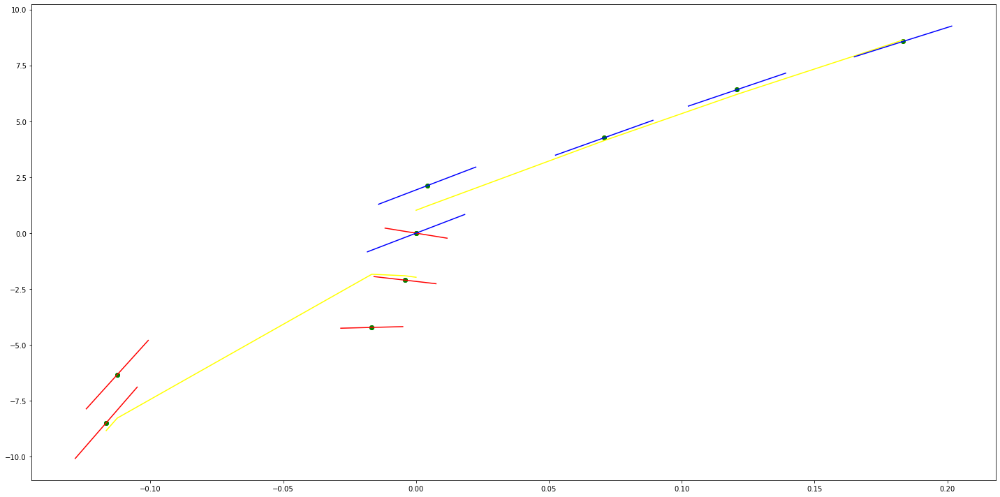

parameters (-1.075896187023322, 7.591978669546873, -0.022817816639259164)
tangent[0]:9.30444820175391
tangent[1]:8.909951498650443
tangent[2]:8.443731252135253
tangent[3]:8.022337144356202
tangent[4]:7.591978669546873
parameters (-706.2747964678126, 211.66654052564388, -1.5148627469878397)
tangent[0]:211.66654052564388
tangent[1]:170.46811909808343
tangent[2]:164.5820249443207
tangent[3]:158.69593079055795
tangent[4]:146.92515503262536


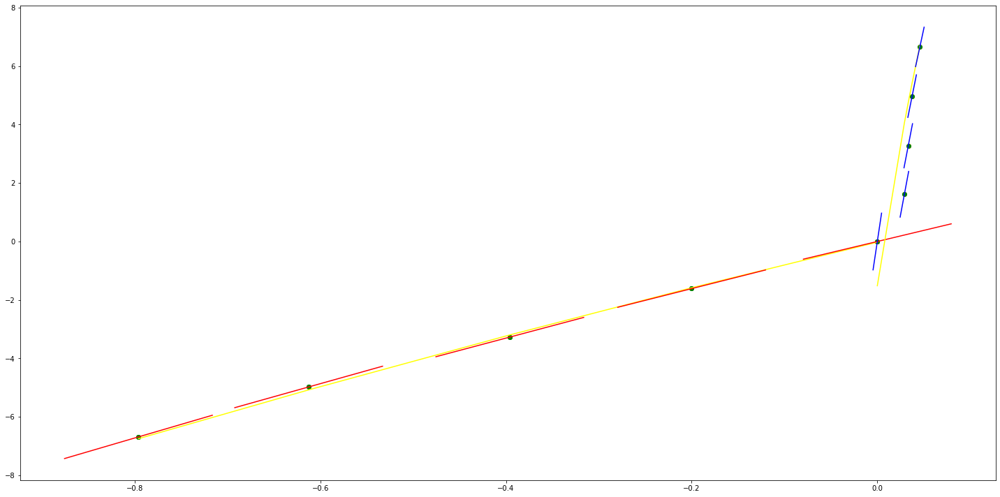

parameters (3.375968753909131, 13.221559989526547, -1.521239013156907)
tangent[0]:10.323851225108706
tangent[1]:11.646110155014789
tangent[2]:12.996497656578441
tangent[3]:13.193424665931468
tangent[4]:13.221559989526547
parameters (-1131.2628021277521, 257.9225646017647, 0.7021311103521168)
tangent[0]:257.9225646017647
tangent[1]:248.49462040883202
tangent[2]:229.6409945485709
tangent[3]:220.2130503556382
tangent[4]:210.78736868830975


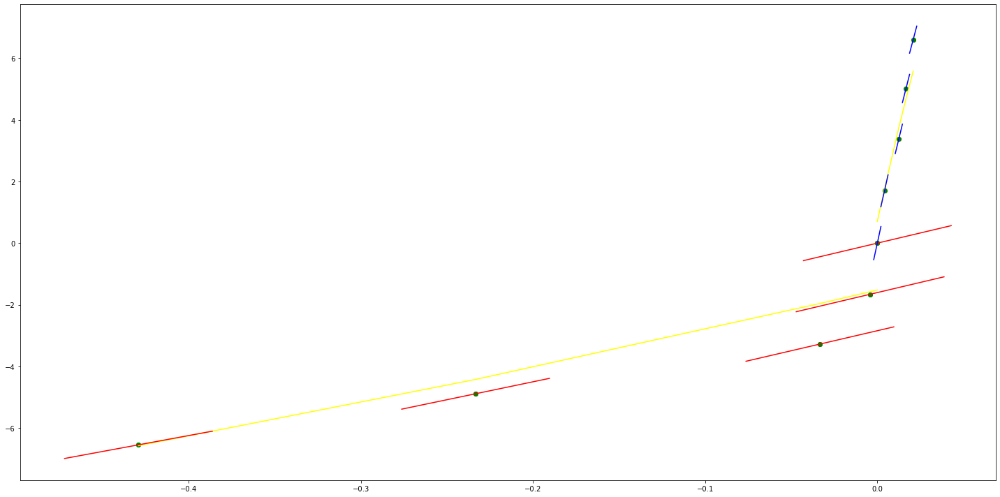

parameters (-919.5324502248831, -32.1572373350544, -0.7807337350885062)
tangent[0]:128.76094145430014
tangent[1]:121.09755801412598
tangent[2]:113.4341745739518
tangent[3]:-24.49569295978067
tangent[4]:-32.1572373350544
parameters (-196.95173413503616, 118.8881779287117, 0.35187337015040543)
tangent[0]:118.8881779287117
tangent[1]:117.2467821764303
tangent[2]:104.11679786858399
tangent[3]:100.8340063640212
tangent[4]:99.19300451520809


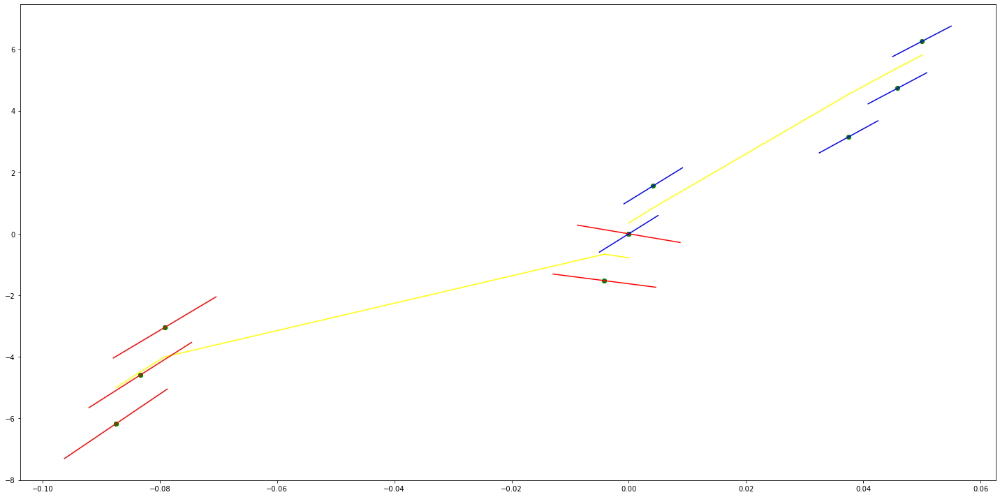

parameters (105.95961111292614, 53.524124551160625, -0.6565907198382809)
tangent[0]:40.279173162044856
tangent[1]:46.46022111670629
tangent[2]:47.343076596499195
tangent[3]:48.22614399551432
tangent[4]:53.524124551160625
parameters (1415.798471865169, -48.01680690444266, 1.2477492426544134)
tangent[0]:-48.01680690444266
tangent[1]:-36.21754243991835
tangent[2]:-24.421109572337755
tangent[3]:140.7572665432278
tangent[4]:152.55369941080835


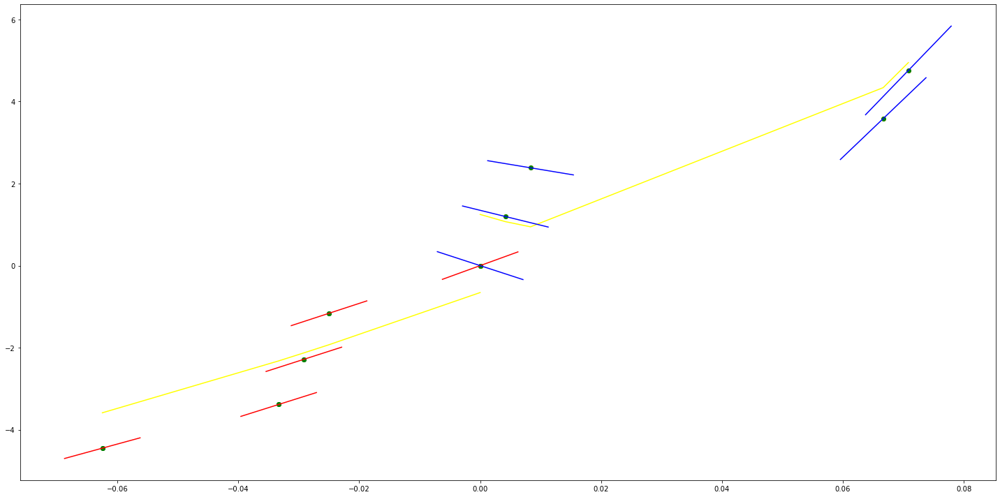

parameters (-1711.934830424981, -141.56523311587372, -1.2446122410189762)
tangent[0]:257.88736860650886
tangent[1]:243.62010372974706
tangent[2]:186.55789196202156
tangent[3]:-127.29796823911194
tangent[4]:-141.56523311587372
parameters (-449.7348365587101, 155.26960032385531, 1.719660161415434)
tangent[0]:155.26960032385531
tangent[1]:151.52240966564815
tangent[2]:136.5309486238001
tangent[3]:129.03566783771265
tangent[4]:125.28757770983235


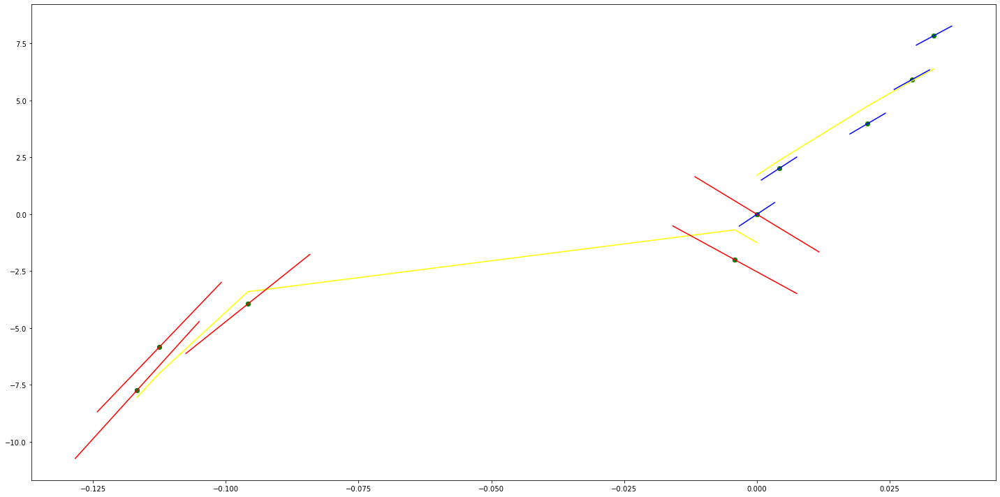

parameters (-449.7348645724085, -54.60636135311613, -0.44777557391836775)
tangent[0]:129.0356748371937
tangent[1]:125.28758447584728
tangent[2]:121.53949411450084
tangent[3]:46.5839831756758
tangent[4]:-54.60636135311613
parameters (-0.4572493993155365, 14.685445419874906, 0.08153626324767214)
tangent[0]:14.685445419874906
tangent[1]:14.574943786539917
tangent[2]:14.437768966745256
tangent[3]:14.319645900422477
tangent[4]:14.182471080627815


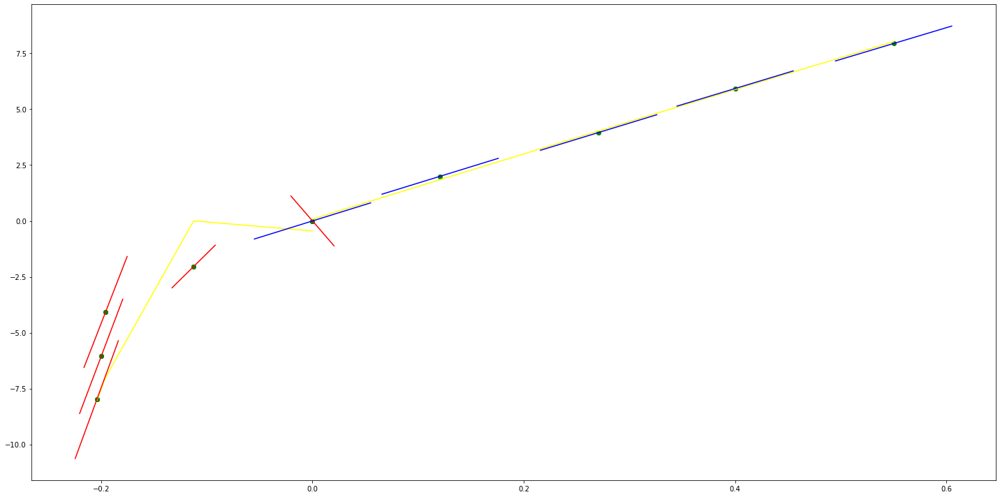

parameters (-0.8024367728857759, 8.196372663758728, -0.8257920368219309)
tangent[0]:9.547141766407632
tangent[1]:9.145923379964746
tangent[2]:8.671148824298509
tangent[3]:8.323425687756824
tangent[4]:8.196372663758728
parameters (-56.25052438652263, 48.97349131358664, 2.595645483354426)
tangent[0]:48.97349131358664
tangent[1]:48.504811944398135
tangent[2]:48.03602007416086
tangent[3]:46.16096509426051
tangent[4]:37.25470706709361


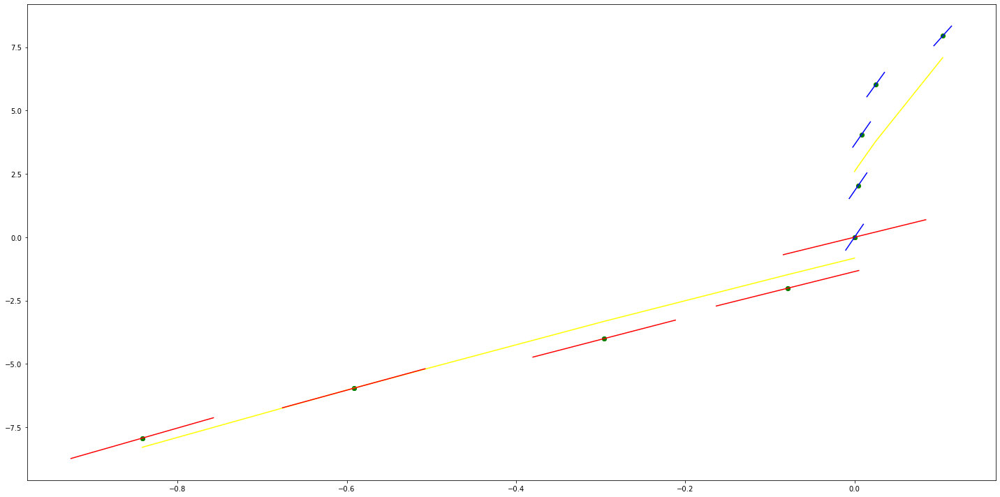

parameters (78.53720681794277, 72.93827737201893, 1.3406976187651631)
tangent[0]:48.06821423780826
tangent[1]:51.9950745787054
tangent[2]:52.649603660326136
tangent[3]:53.30397566753324
tangent[4]:72.93827737201893
parameters (-13.159234438434018, 24.33085713037399, 2.8495614946041483)
tangent[0]:24.33085713037399
tangent[1]:24.22118807056408
tangent[2]:24.111519010754172
tangent[3]:22.79559556691077
tangent[4]:18.847825235380565


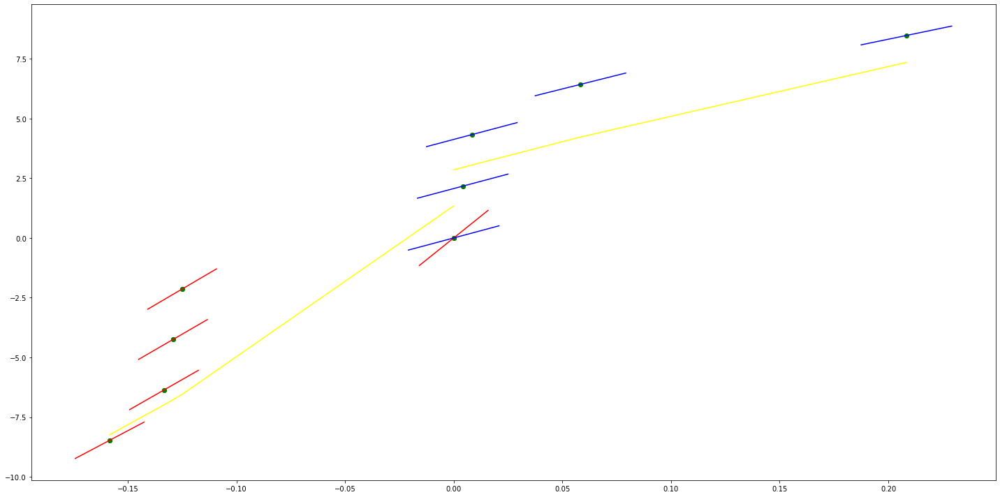

parameters (-503.06543690341664, -149.97159224715492, -0.00516128849369937)
tangent[0]:177.02094174006592
tangent[1]:172.8283943889128
tangent[2]:168.6368531686335
tangent[3]:151.86766989489504
tangent[4]:-149.97159224715492
parameters (0.009672584912888466, 0.8637122870920734, 0.03823902352926945)
tangent[0]:0.8637122870920734
tangent[1]:0.8833798828633366
tangent[2]:0.9046595696716911
tangent[3]:0.9223120371377126
tangent[4]:0.9394808753580897


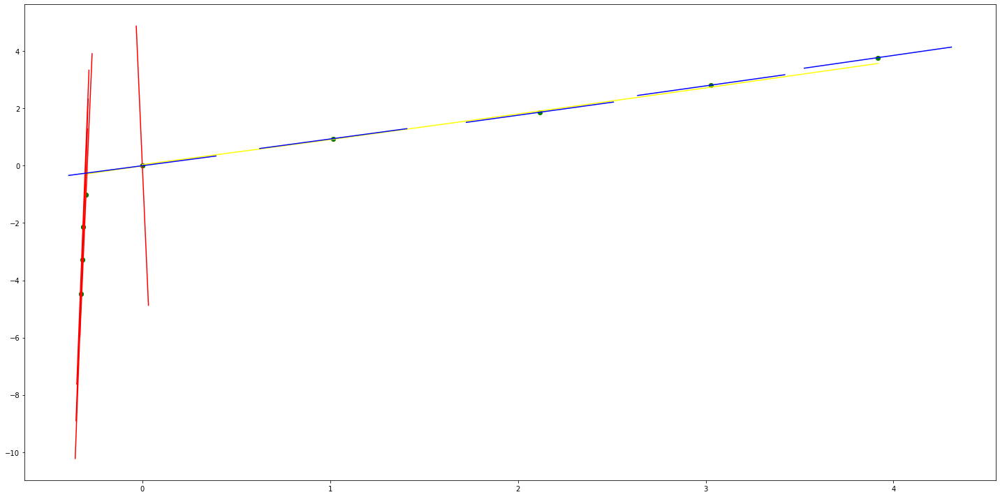

parameters (-0.0803698862992059, 0.9632445762288313, 0.03316726660460285)
tangent[0]:1.5606607846328528
tangent[1]:1.434748016344021
tangent[2]:1.2981192096353709
tangent[3]:1.1454164256668797
tangent[4]:0.9632445762288313
parameters (180.26850783414545, -146.9860160830755, -0.00020873002454520757)
tangent[0]:-146.9860160830755
tangent[1]:150.45702184326447
tangent[2]:151.95901905053856
tangent[3]:153.46137679482834
tangent[4]:156.46573174639227


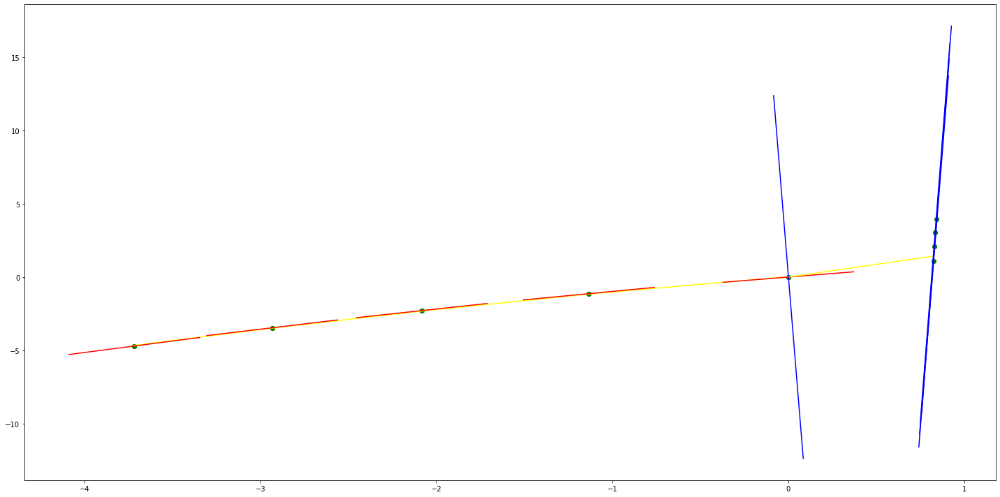

parameters (-0.06955481167347048, 0.9307083878328659, -0.10339348866121972)
tangent[0]:1.453528814984868
tangent[1]:1.335285635139968
tangent[2]:1.2031314929603742
tangent[3]:1.0454738270940922
tangent[4]:0.9307083878328659
parameters (-1318.1271637664006, 201.25503710310073, 0.12668733587251593)
tangent[0]:201.25503710310073
tangent[1]:190.2724015745991
tangent[2]:179.2871297917699
tangent[3]:157.31922248043907
tangent[4]:146.33395069760988


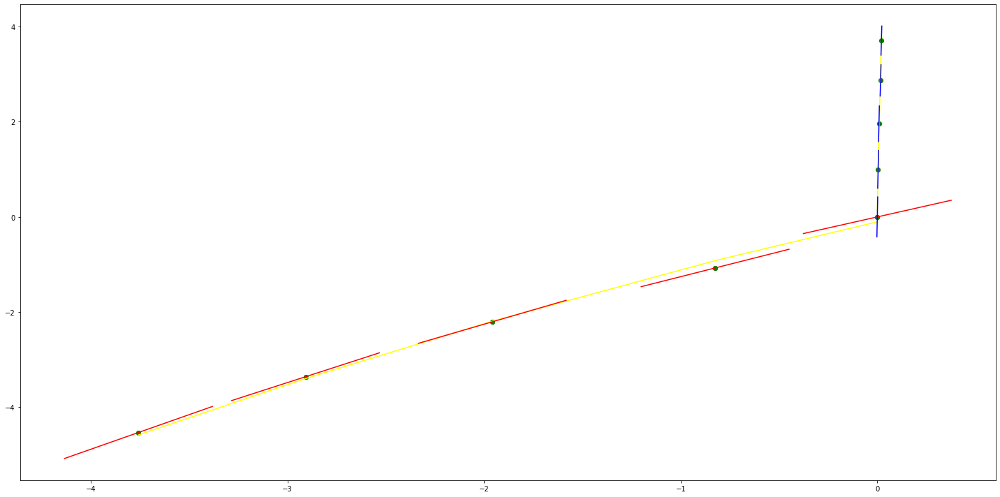

parameters (0.811539912295491, 0.1216245579182542, 0.11455502546074095)
tangent[0]:-3.5032531759749976
tangent[1]:-3.455912806731152
tangent[2]:-2.536168654849479
tangent[3]:-1.3188587864062424
tangent[4]:0.1216245579182542
parameters (-111.14274114457899, 94.62779481854476, -0.004112188958745493)
tangent[0]:94.62779481854476
tangent[1]:-94.31486512723951
tangent[2]:-103.57683431778186
tangent[3]:-104.50309792248079
tangent[4]:-105.42913924169743


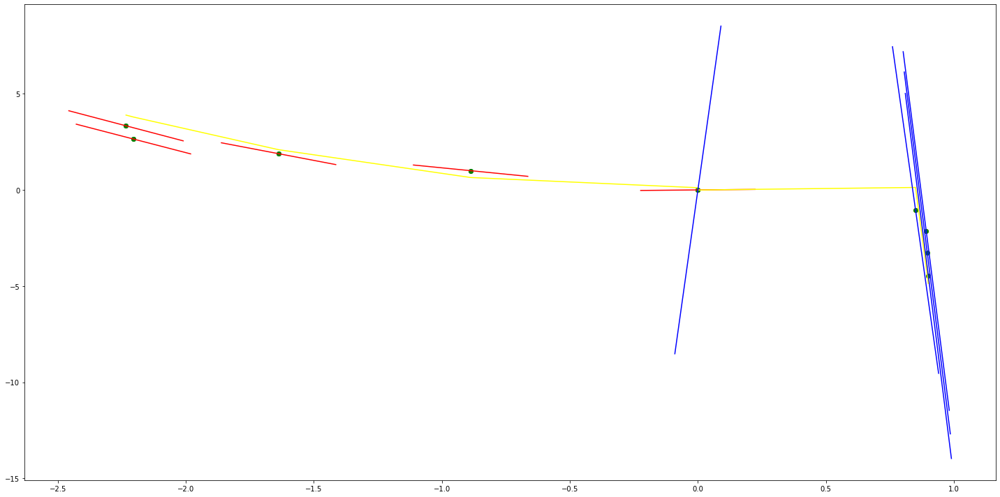

parameters (-398.0635982665477, -155.9809309416979, 1.3521715333152413)
tangent[0]:-102.90551913042603
tangent[1]:-116.17457111504312
tangent[2]:-146.0293409850342
tangent[3]:-152.66346891374448
tangent[4]:-155.9809309416979
parameters (1.3985649529225663, -8.431800524528107, -4.920888448806375)
tangent[0]:-8.431800524528107
tangent[1]:-8.420147681340357
tangent[2]:-8.385183557517292
tangent[3]:-8.338563793376572
tangent[4]:-8.29194402923585


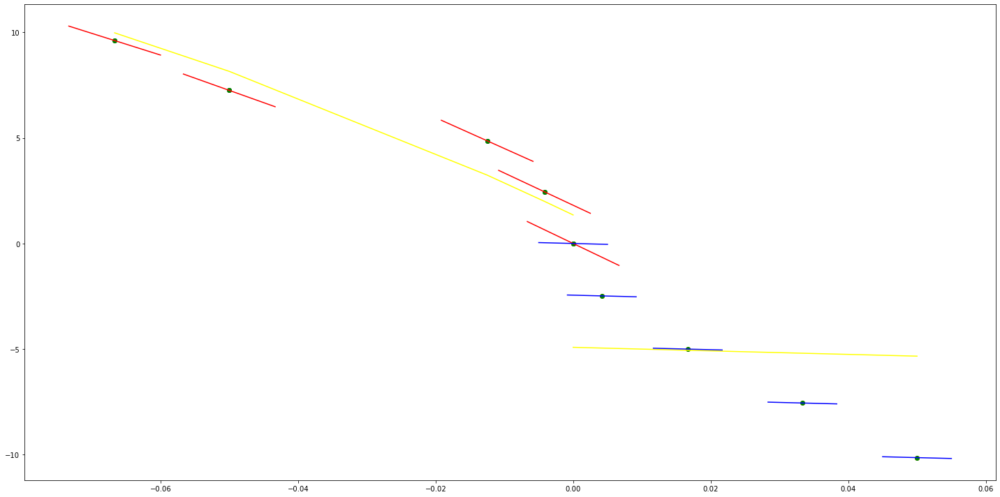

parameters (-599.8203752401008, -191.93641913446598, 2.0705710111229636)
tangent[0]:-126.95667824395538
tangent[1]:-171.94320638696294
tangent[2]:-181.93981276071446
tangent[3]:-186.93871576796545
tangent[4]:-191.93641913446598
parameters (0.52579798732077, -5.469580467039768, -3.8921182370232046)
tangent[0]:-5.469580467039768
tangent[1]:-5.456435517356749
tangent[2]:-5.438908567247399
tangent[3]:-5.421381617138048
tangent[4]:-4.488090189643681


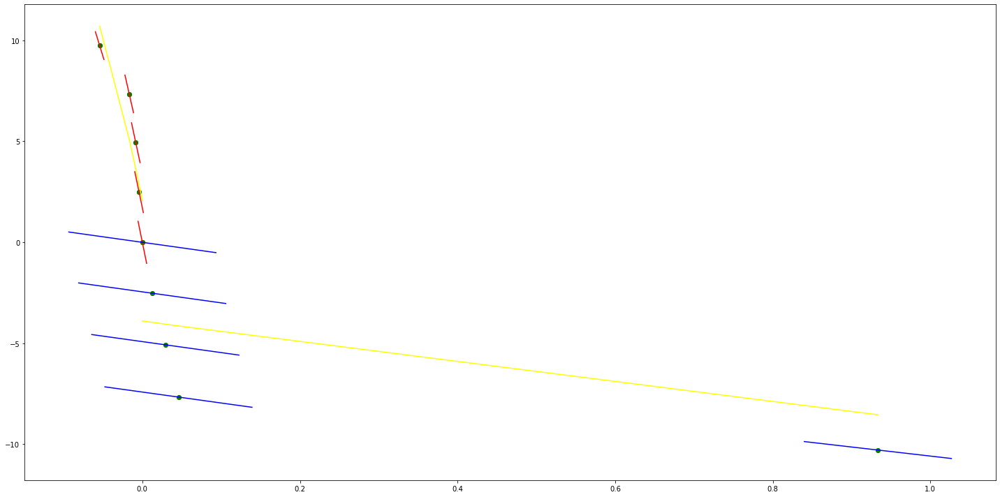

parameters (0.220200076130779, -1.4200903621625454, 0.2671534754208246)
tangent[0]:-3.5541959531966274
tangent[1]:-2.94497588936819
tangent[2]:-2.4898958788312973
tangent[3]:-2.0072904183779054
tangent[4]:-1.4200903621625454
parameters (-505.62757655445813, 483.1501110951123, 0.00023308133779032279)
tangent[0]:483.1501110951123
tangent[1]:-490.18297377221955
tangent[2]:-494.39687399522444
tangent[3]:-498.6097629630761
tangent[4]:-507.03756340908586


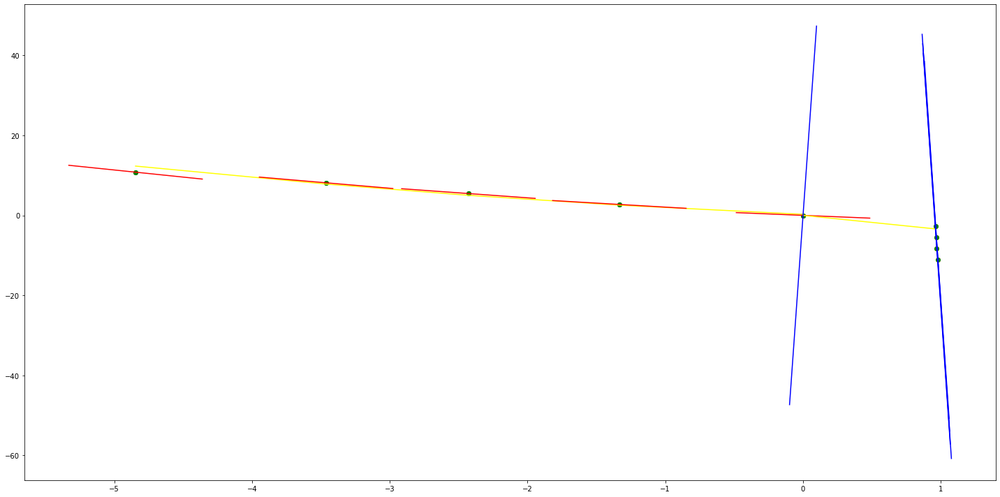

parameters (-57.215965154781124, -615.6524045792683, -0.5378990084031818)
tangent[0]:-612.7916063215292
tangent[1]:-613.7451675967988
tangent[2]:-614.2220054503987
tangent[3]:-614.6988433039986
tangent[4]:-615.6524045792683
parameters (28.396061200404, -356.3355112313265, -1.929259831671789)
tangent[0]:-356.3355112313265
tangent[1]:-356.09885845728235
tangent[2]:-355.8622624753606
tangent[3]:-355.1523609453505
tangent[4]:-354.2058066412962


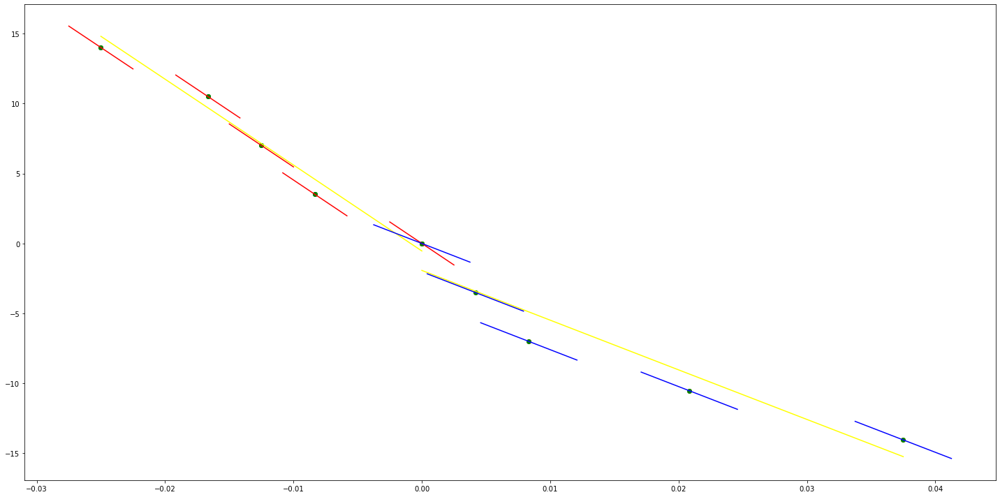

parameters (3605.0649502758306, -272.2181986651177, 1.4348553802394723)
tangent[0]:-512.5606687701068
tangent[1]:-482.516057474508
tangent[2]:-362.34482242201346
tangent[3]:-302.2628099607165
tangent[4]:-272.2181986651177
parameters (4363.0897559418645, -635.7843020062296, -0.7336363523323304)
tangent[0]:-635.7843020062296
tangent[1]:-599.431038159722
tangent[2]:-526.707058107683
tangent[3]:-490.3537942611754
tangent[4]:-453.9918042351559


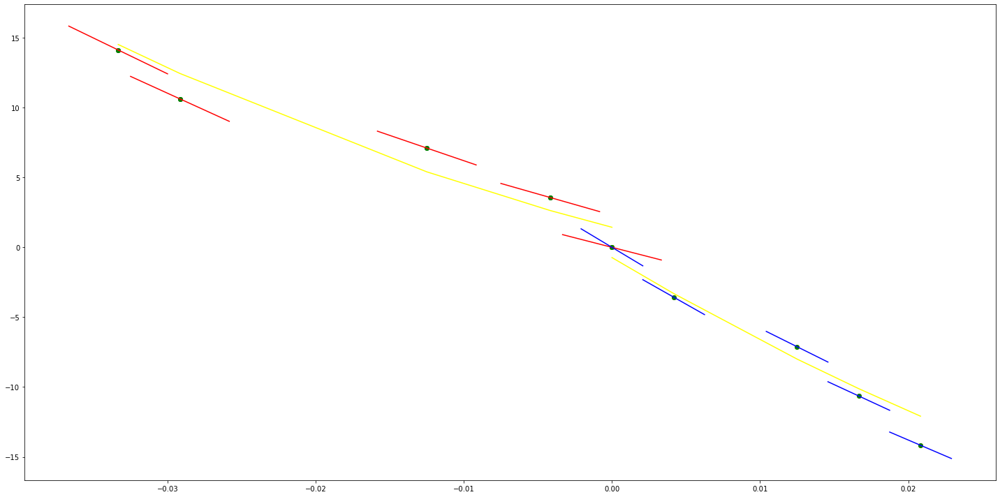

parameters (5.683961146085256, 10.894420202798303, -1.9347359380498328)
tangent[0]:9.378701019816331
tangent[1]:10.562852013302566
tangent[2]:10.752321174146172
tangent[3]:10.847050070606828
tangent[4]:10.894420202798303
parameters (-238.90414851066328, 104.09242152912972, 0.5188351072436371)
tangent[0]:104.09242152912972
tangent[1]:102.10139435544185
tangent[2]:94.13824127728442
tangent[3]:86.17461039082998
tangent[4]:78.21097950437553


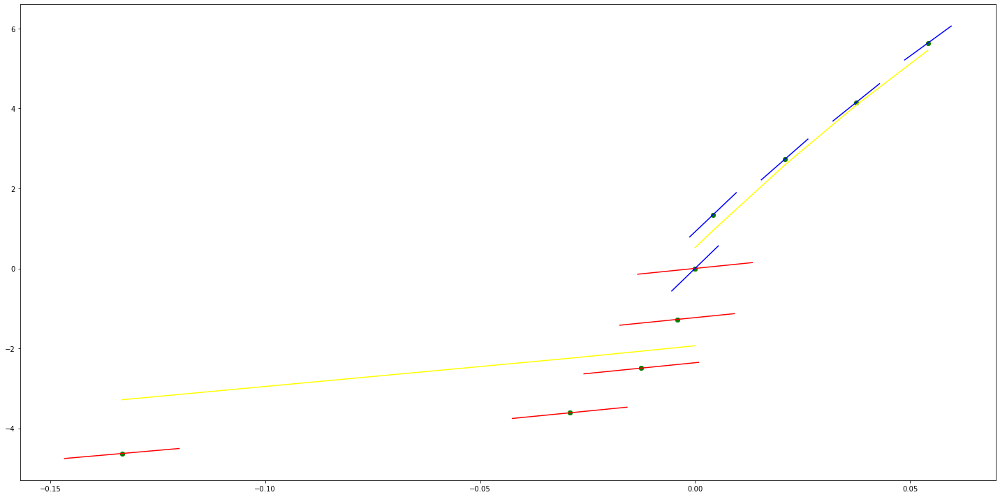

parameters (-2417.4691804861486, 19.04531851708924, -1.2722453598753483)
tangent[0]:381.6656955900115
tangent[1]:301.0817779276863
tangent[2]:220.50269520372197
tangent[3]:79.48204802924296
tangent[4]:19.04531851708924
parameters (-1118.9363427347957, 337.4705187885343, 1.995141069802339)
tangent[0]:337.4705187885343
tangent[1]:328.1453033081825
tangent[2]:318.8223257005162
tangent[3]:281.5237016517945
tangent[4]:244.22507760307286


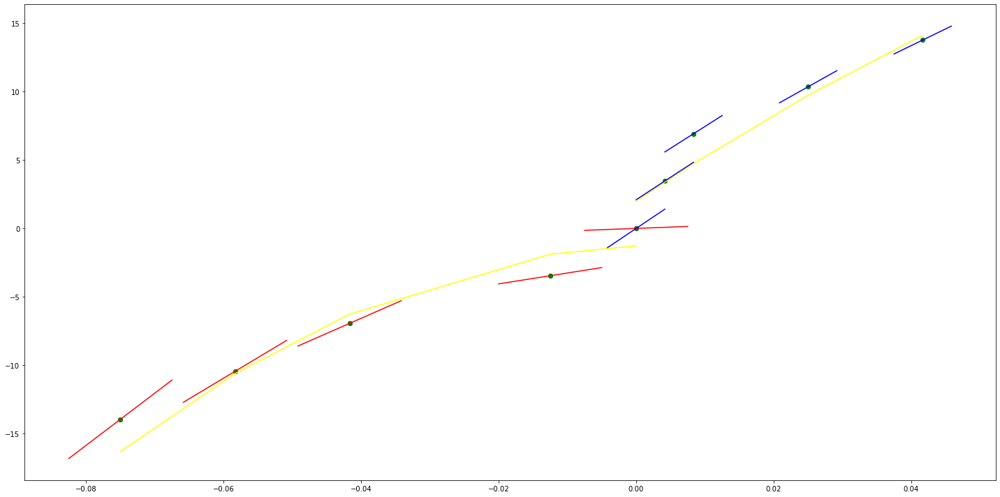

parameters (1503.3211508883176, 266.0116444696491, -0.4446674163061156)
tangent[0]:165.79123662452855
tangent[1]:178.31991509603176
tangent[2]:228.4286156974412
tangent[3]:253.48597264044767
tangent[4]:266.0116444696491
parameters (-117.60014533120953, 126.63338112514812, 1.2163623303344313)
tangent[0]:126.63338112514812
tangent[1]:125.65330151395781
tangent[2]:121.73321826948728
tangent[3]:114.87336659202717
tangent[4]:109.97320373636633


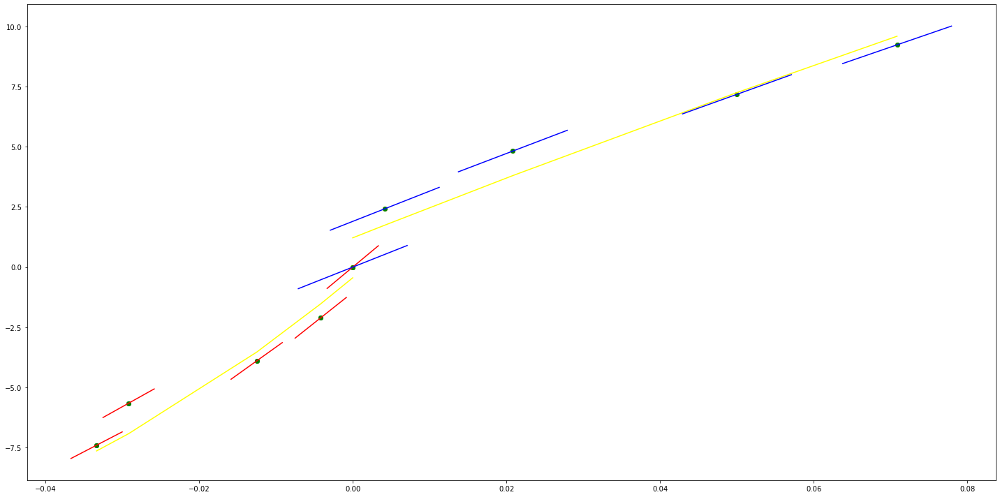

parameters (1548.1561087865036, 289.13314939734886, -0.22222260838444668)
tangent[0]:185.9237742489878
tangent[1]:198.82610725961453
tangent[2]:250.42924667768625
tangent[3]:276.2339126989397
tangent[4]:289.13314939734886
parameters (641.850139543067, 21.053448036895634, 0.8897686591895918)
tangent[0]:21.053448036895634
tangent[1]:26.402627099847557
tangent[2]:85.23846199120234
tangent[3]:128.02932709425954
tangent[4]:144.0755805828362


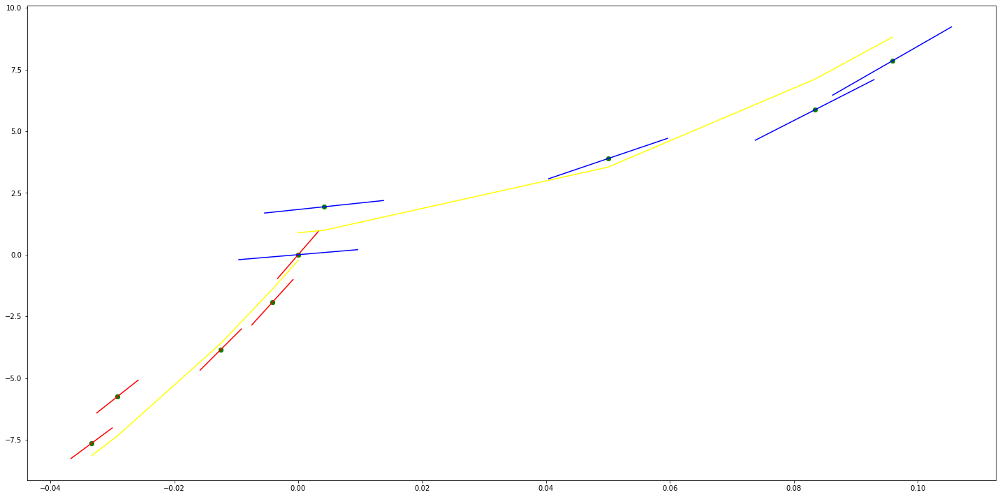

parameters (850.4502204533794, 215.7295425649668, -0.3179141368301754)
tangent[0]:151.94577603096334
tangent[1]:159.0317272677809
tangent[2]:166.11937940503938
tangent[3]:208.64189042770835
tangent[4]:215.7295425649668
parameters (321.8181322523523, 65.68149989367627, 0.7187145508827383)
tangent[0]:65.68149989367627
tangent[1]:68.36288857160288
tangent[2]:97.8633131189115
tangent[3]:116.63560840945573
tangent[4]:119.31764072364683


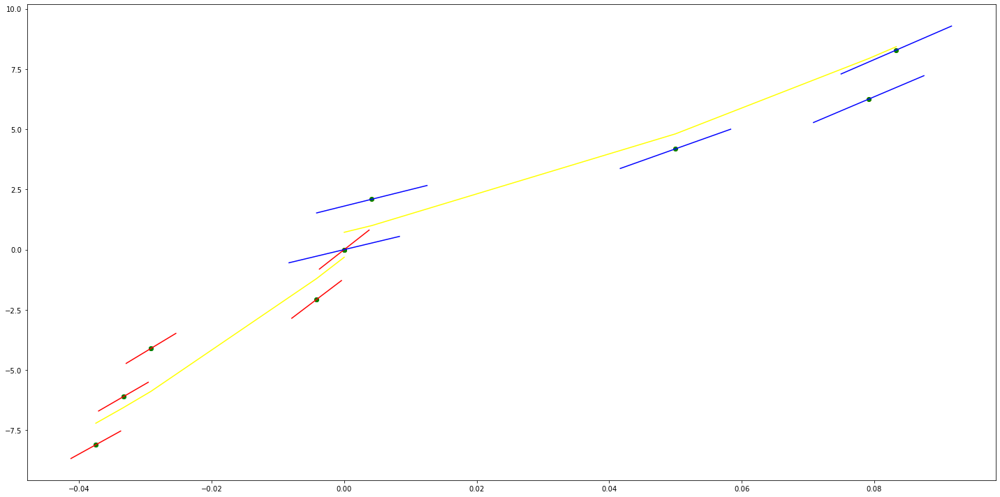

parameters (66.83551222293232, 75.98232631925958, -1.5943848032715002)
tangent[0]:58.15956761681912
tangent[1]:64.84311883911235
tangent[2]:71.52667006140558
tangent[3]:75.42531916039367
tangent[4]:75.98232631925958
parameters (-1272.4226111080857, 296.84200461647924, 1.0519853548445708)
tangent[0]:296.84200461647924
tangent[1]:286.23763457550444
tangent[2]:243.82524410204974
tangent[3]:222.6165040201002
tangent[4]:212.01467882434758


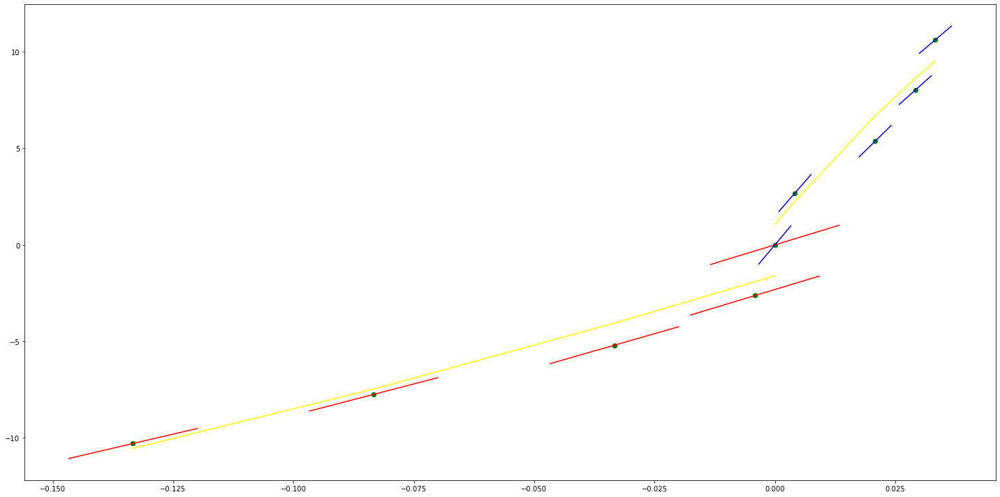

parameters (1041.5650114060675, 261.16886564549947, -2.496445553547267)
tangent[0]:217.77101788025425
tangent[1]:226.44933755528962
tangent[2]:235.12974036034777
tangent[3]:252.4884628404413
tangent[4]:261.16886564549947
parameters (1135.2722296706877, 444.71636459845445, 0.3152935597860986)
tangent[0]:444.71636459845445
tangent[1]:454.17772336052997
tangent[2]:473.09817034022166
tangent[3]:482.5595291022972
tangent[4]:492.01861731991335


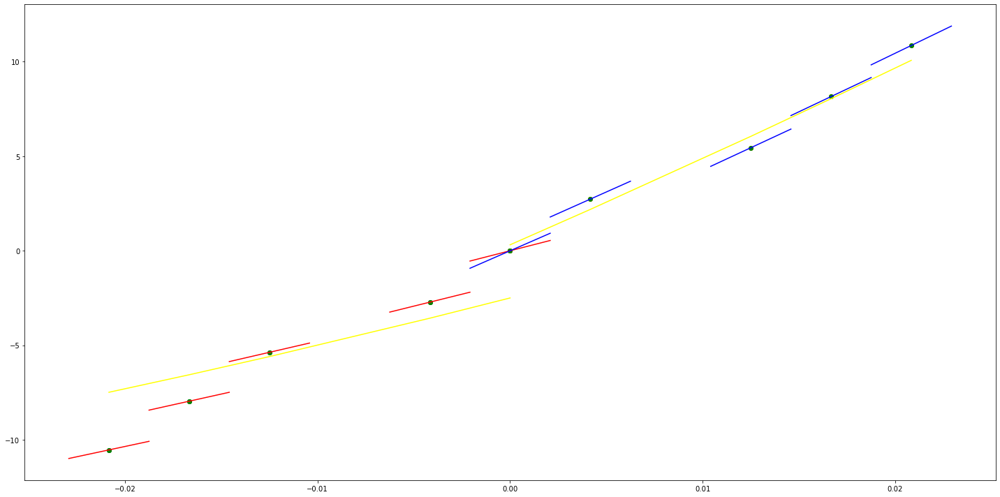

parameters (1861.4913006058323, 316.0350416154028, -0.46899890260278565)
tangent[0]:207.4468080858622
tangent[1]:253.98409060100798
tangent[2]:269.497759100257
tangent[3]:285.011427599506
tangent[4]:316.0350416154028
parameters (-258.37055834190244, 127.9519056156124, 1.7158638916608628)
tangent[0]:127.9519056156124
tangent[1]:125.79864538239099
tangent[2]:123.64590189028625
tangent[3]:108.57411373996972
tangent[4]:97.80884605609602


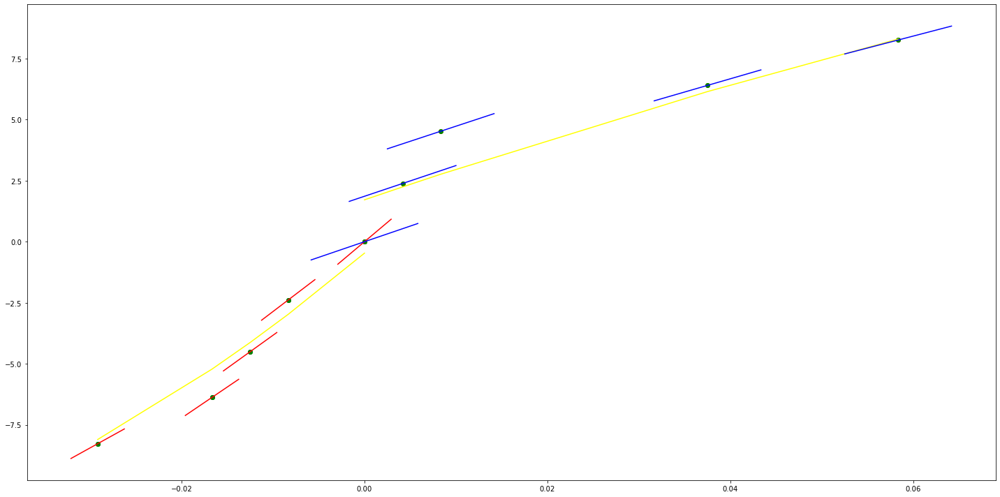

parameters (-106.88527702800363, 31.266799993341717, -0.11202397080286285)
tangent[0]:66.00451502744289
tangent[1]:61.550819304240036
tangent[2]:50.86229160143968
tangent[3]:41.0645457973907
tangent[4]:31.266799993341717
parameters (-99.71755782514909, 80.32855642354855, 1.6081081755655462)
tangent[0]:80.32855642354855
tangent[1]:79.49751029663375
tangent[2]:78.66646416971896
tangent[3]:72.01869345974757
tangent[4]:62.87798380414746


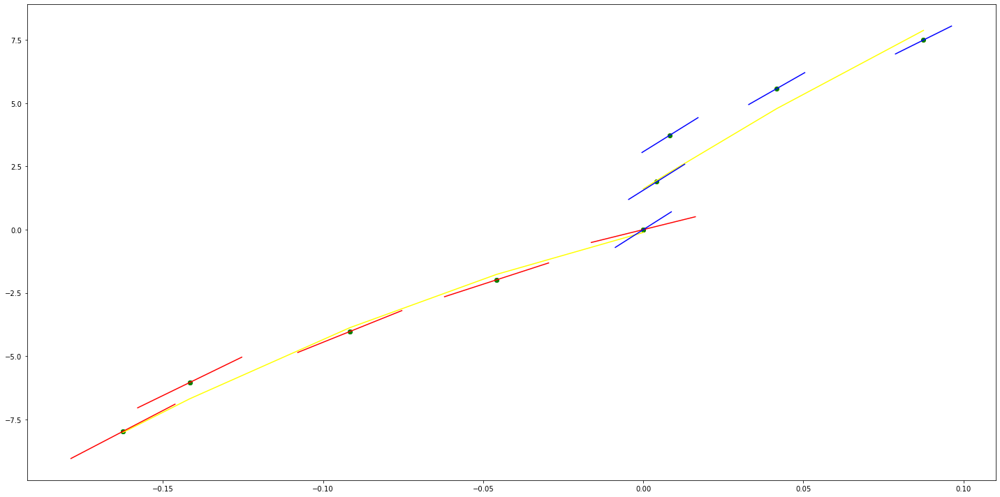

parameters (-823.2417134660578, 314.45326639989094, -0.21706072560632905)
tangent[0]:348.7544556331677
tangent[1]:341.8952056765685
tangent[2]:335.0343092365424
tangent[3]:321.31416283991706
tangent[4]:314.45326639989094
parameters (-120.84714592915097, 83.2974673836167, 0.9777341901528642)
tangent[0]:83.2974673836167
tangent[1]:82.29032726944317
tangent[2]:75.24107155310392
tangent[3]:70.20561267652806
tangent[4]:59.12803819778651


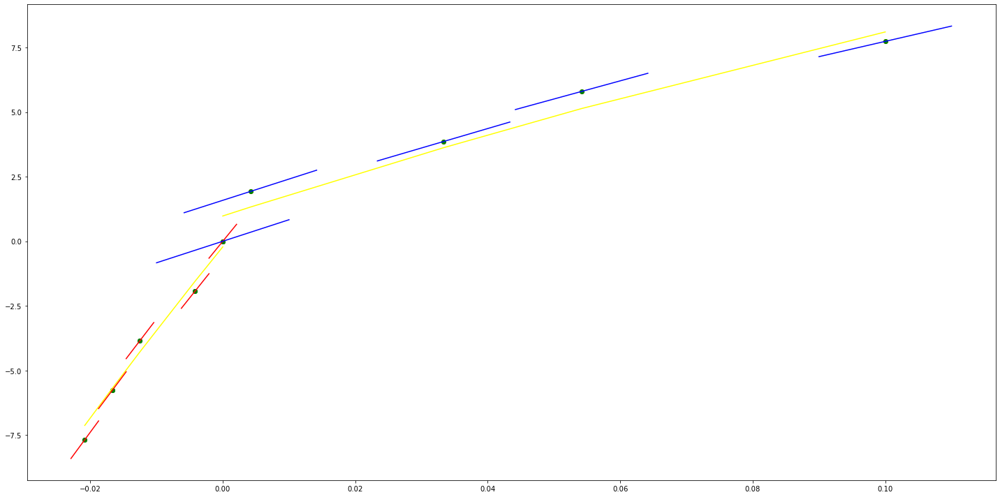

parameters (-789.3905112044316, -31.281913579500397, -1.691426389655822)
tangent[0]:152.90973196187446
tangent[1]:146.33095144149672
tangent[2]:14.766392501098913
tangent[3]:-24.703133059122663
tangent[4]:-31.281913579500397
parameters (-106.70067850266447, 73.76750848808192, 1.0357413730477913)
tangent[0]:73.76750848808192
tangent[1]:72.87847843479771
tangent[2]:66.65420105502328
tangent[3]:59.540893621964656
tangent[4]:51.53834273426482


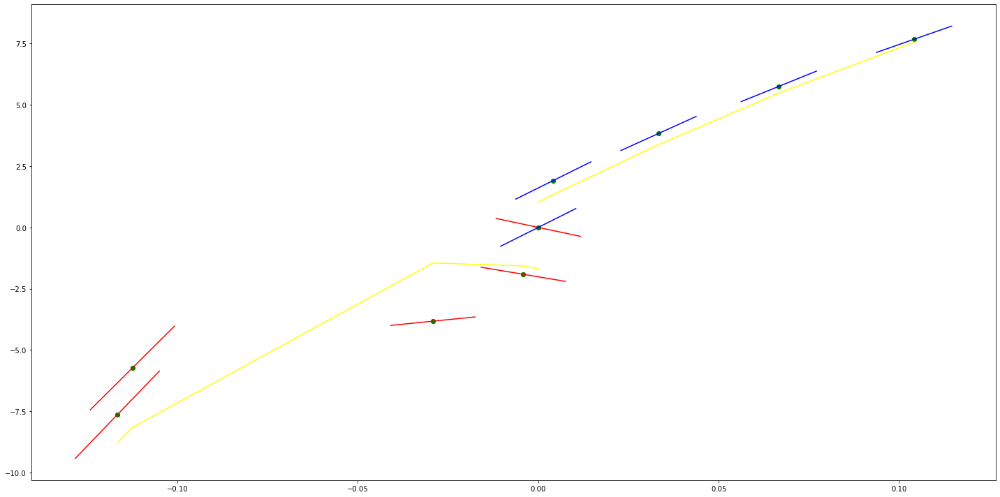

parameters (-2371.633246256699, -279.68734184304685, -1.5981373296056522)
tangent[0]:372.5118008775454
tangent[1]:352.746609403242
tangent[2]:332.98141792893864
tangent[3]:-259.926893635236
tangent[4]:-279.68734184304685
parameters (-47.81195100520052, 54.36658577344846, 1.211468842298554)
tangent[0]:54.36658577344846
tangent[1]:53.96812097377112
tangent[2]:49.58539067292841
tangent[3]:44.40573077273102
tangent[4]:39.62453567221097


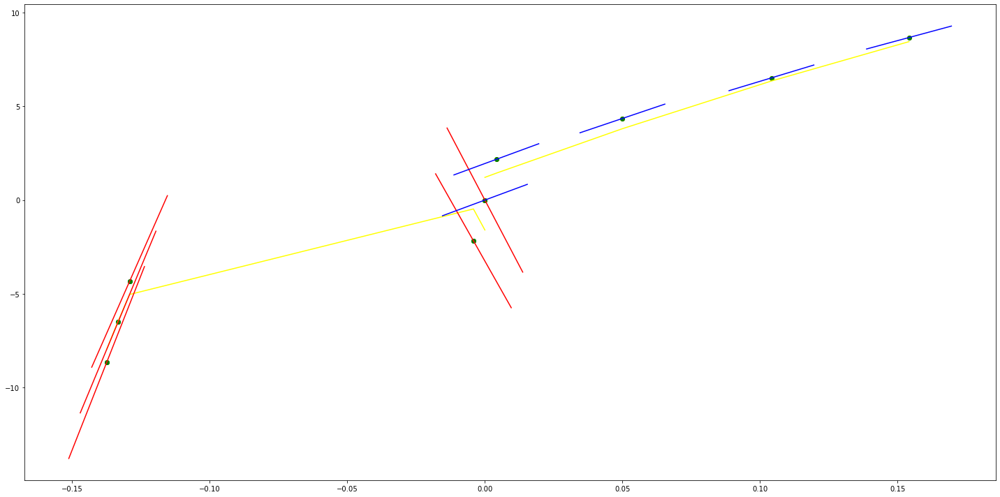

parameters (10.927007520433689, 31.352269789792988, -1.6297841198168033)
tangent[0]:25.16030614621891
tangent[1]:27.34570765030565
tangent[2]:29.98639384973878
tangent[3]:31.261225963132734
tangent[4]:31.352269789792988
parameters (-843.6610248438604, 216.55730023816253, 0.7931969426613537)
tangent[0]:216.55730023816253
tangent[1]:209.52622925711378
tangent[2]:167.34317801492077
tangent[3]:160.31210703387202
tangent[4]:153.282723374873


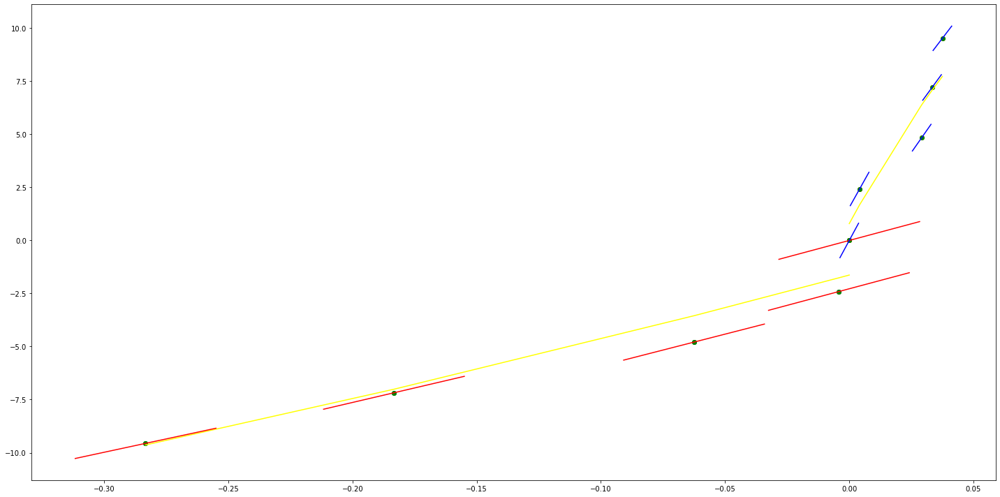

parameters (0.02819096989220837, 1.4041235321172265, -0.021284798143642227)
tangent[0]:1.3515004071124175
tangent[1]:1.3639514000208295
tangent[2]:1.3759325622250183
tangent[3]:1.391202652122651
tangent[4]:1.4041235321172265
parameters (-391.24503532079706, 49.61179833902521, 0.07853288199657733)
tangent[0]:49.61179833902521
tangent[1]:46.35116221466169
tangent[2]:39.83067245600529
tangent[3]:36.57003633164176
tangent[4]:33.31018269734888


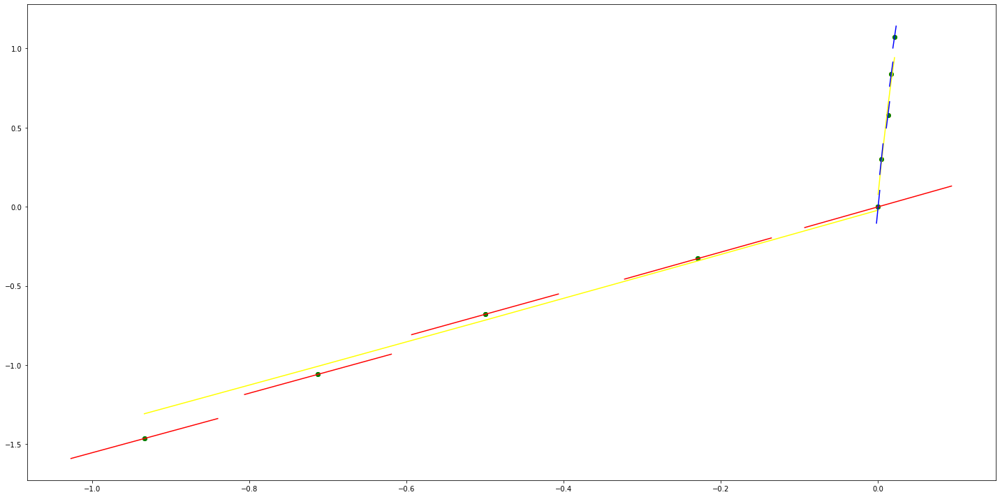

parameters (158.91399446673336, 63.99253295047801, -1.0538005933479595)
tangent[0]:40.155433780468
tangent[1]:58.695611686912855
tangent[2]:60.01968308880967
tangent[3]:61.34407231869543
tangent[4]:63.99253295047801
parameters (6.547663562969007, 9.633461230074701, 1.1154224889152438)
tangent[0]:9.633461230074701
tangent[1]:9.688029458208485
tangent[2]:9.742597686342268
tangent[3]:12.143403294321862
tangent[4]:14.871592080449908


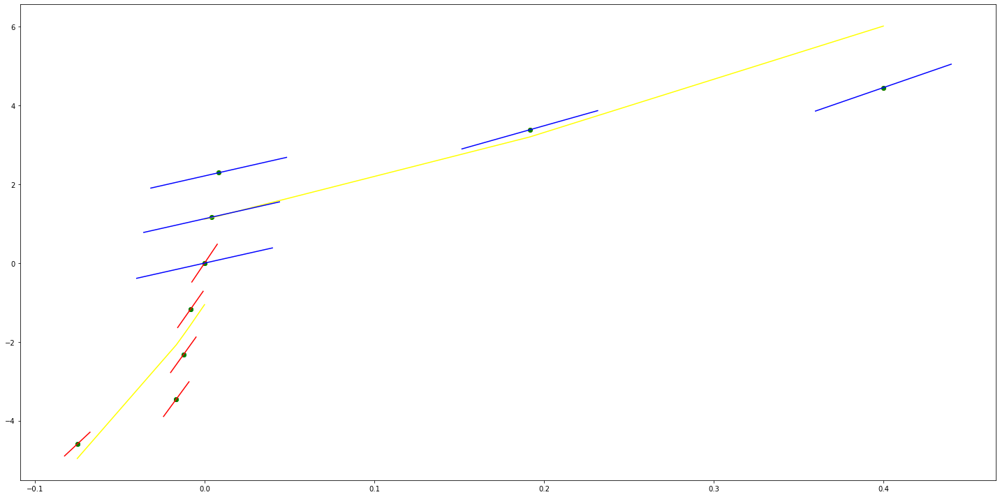

parameters (-107.79021054946614, 89.82656029483076, -0.5289254992831676)
tangent[0]:100.60558134977737
tangent[1]:99.70725773505812
tangent[2]:96.11439443702331
tangent[3]:90.72488390955
tangent[4]:89.82656029483076
parameters (-1.243010690789249, 6.740502995968985, 1.360788200139213)
tangent[0]:6.740502995968985
tangent[1]:6.730143744871947
tangent[2]:6.409034307098979
tangent[3]:5.694303159895161
tangent[4]:4.7102513723394175


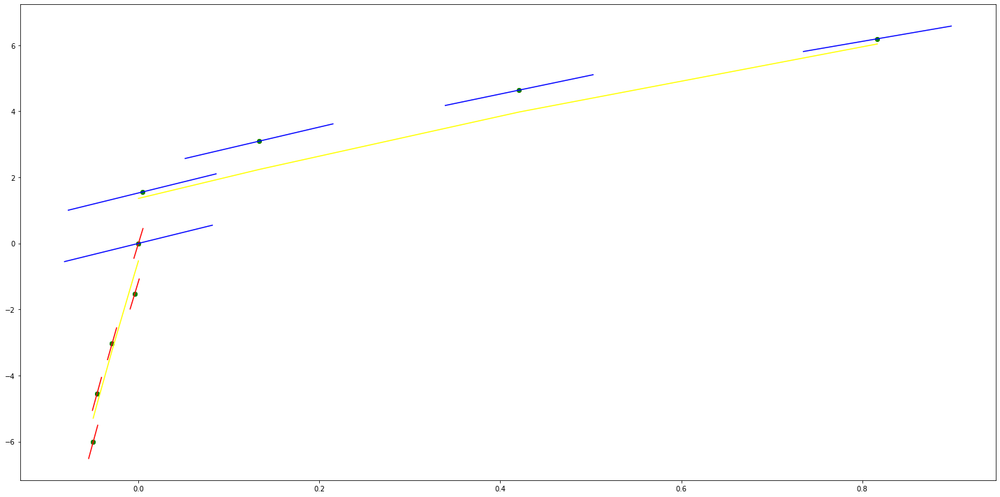

parameters (468.5829423165259, 132.81460420607843, -0.47212648752758946)
tangent[0]:97.67088353233899
tangent[1]:101.57511660772028
tangent[2]:105.48028684898621
tangent[3]:128.9094339648125
tangent[4]:132.81460420607843
parameters (2701.7106327775928, -219.62263053251743, 1.3455728651971994)
tangent[0]:-219.62263053251743
tangent[1]:-197.11197754021453
tangent[2]:298.20343960943273
tangent[3]:320.71949602300117
tangent[4]:343.23014901530405


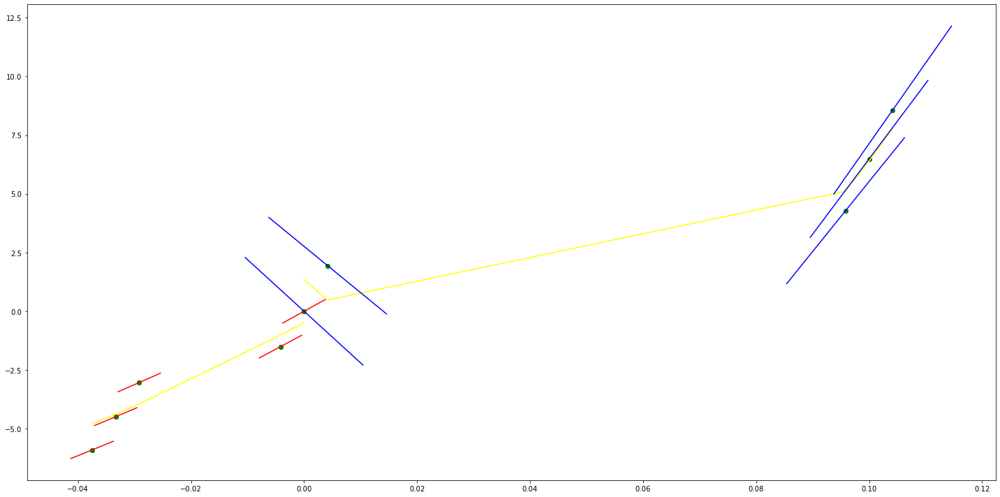

parameters (-101.73928396978175, 49.12461656271548, 0.48322608943592205)
tangent[0]:74.55943755516091
tangent[1]:69.47247335667183
tangent[2]:68.62457816406767
tangent[3]:67.77688645003144
tangent[4]:49.12461656271548
parameters (-556.9923768197738, 235.54849462531868, 2.2969081106531495)
tangent[0]:235.54849462531868
tangent[1]:230.9065201569027
tangent[2]:226.26565967324032
tangent[3]:216.98171073640833
tangent[4]:212.34085025274598


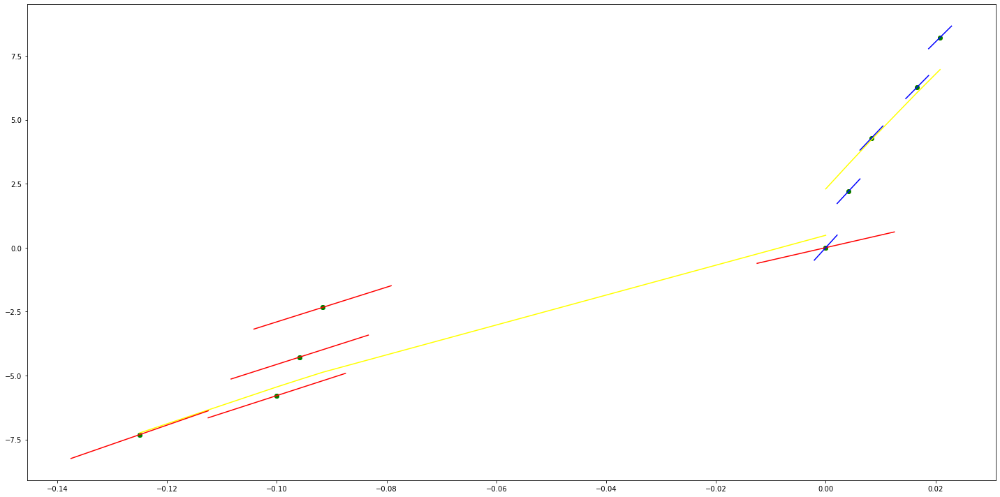

parameters (0.6784187844781212, -0.010623685967887007, 0.5772793147545527)
tangent[0]:-5.73760847265817
tangent[1]:-4.9008928763602
tangent[2]:-3.2896482632246626
tangent[3]:-1.7292850589249837
tangent[4]:-0.010623685967887007
parameters (-595.1022937523705, 506.89898070236563, 0.00023289086902505385)
tangent[0]:506.89898070236563
tangent[1]:-514.6928935043413
tangent[2]:-519.6524760204736
tangent[3]:-524.6120585366057
tangent[4]:-534.5300333642829


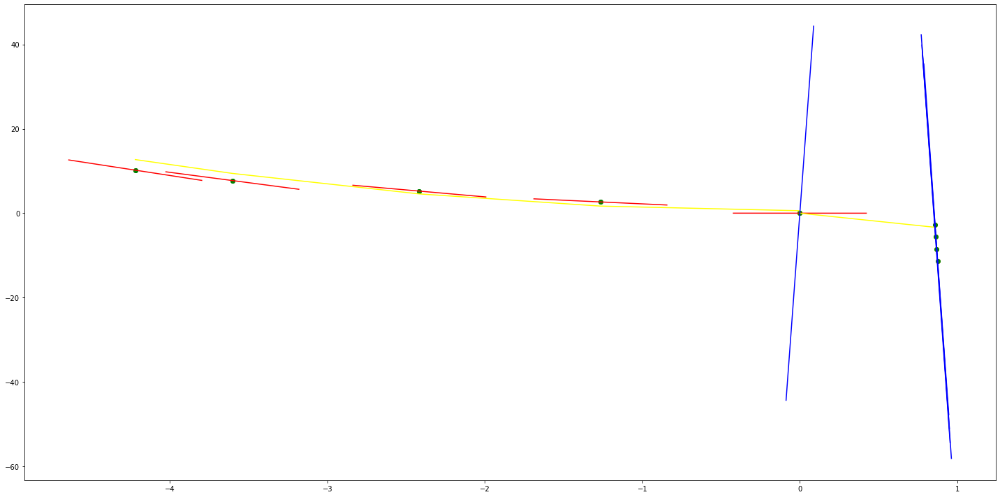

parameters (1881.5063850983968, -802.6884395921867, 0.5429674534848262)
tangent[0]:-881.0832846336965
tangent[1]:-865.4028104202864
tangent[2]:-849.7260992196466
tangent[3]:-818.3651507928265
tangent[4]:-802.6884395921867
parameters (5651.817026427455, -1025.452294864067, 0.18682832892006512)
tangent[0]:-1025.452294864067
tangent[1]:-978.3500517658206
tangent[2]:-884.1568692033806
tangent[3]:-837.0546261051342
tangent[4]:-789.9523830068878


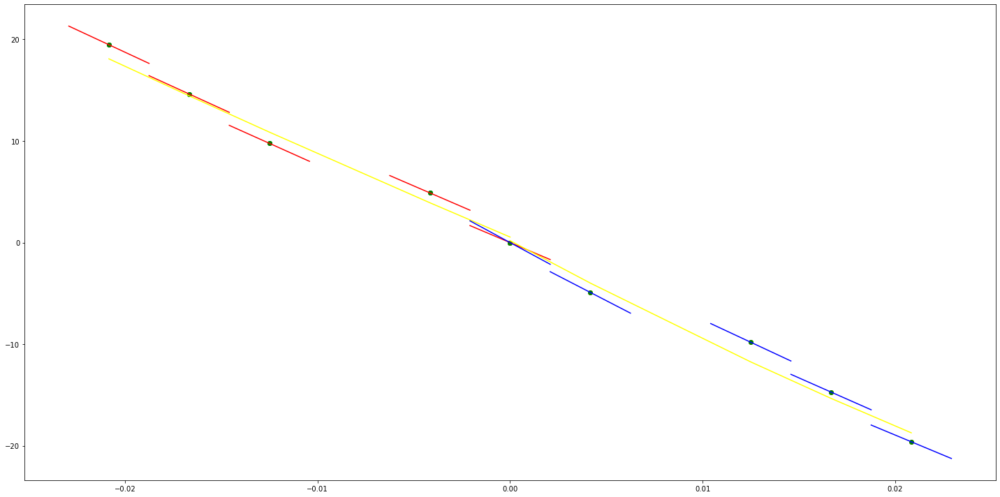

parameters (-4746.93230891924, 22.350809644078904, -0.9530038802492455)
tangent[0]:378.3707328130219
tangent[1]:338.809798950489
tangent[2]:299.248865087956
tangent[3]:61.90224964199402
tangent[4]:22.350809644078904
parameters (854.4983196784668, 390.7090593650425, 0.2698186202467049)
tangent[0]:390.7090593650425
tangent[1]:397.8304483612428
tangent[2]:412.07151735700415
tangent[3]:419.19290635320453
tangent[4]:426.31429534940486


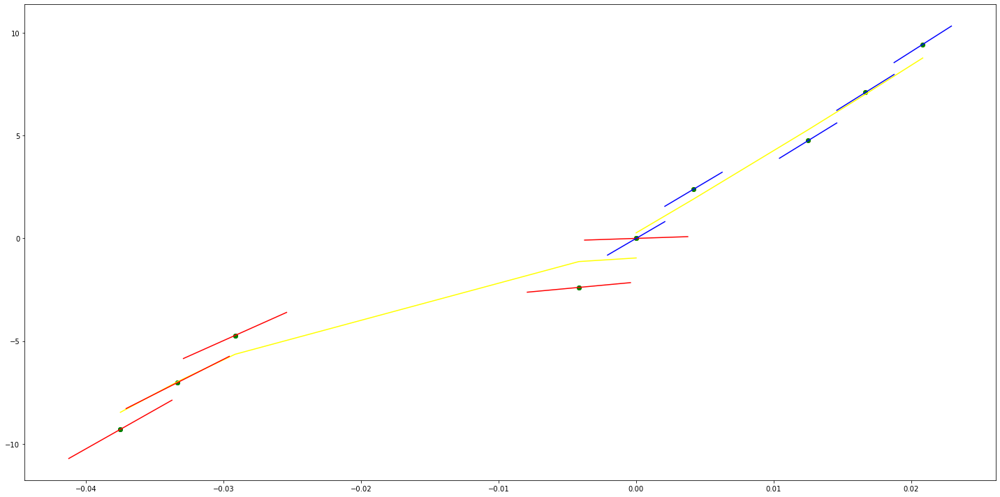

parameters (-394.3068331746952, 60.94042236458664, 0.3436498971818384)
tangent[0]:120.08644734079093
tangent[1]:100.37110568205617
tangent[2]:97.08495253437825
tangent[3]:93.7995880003667
tangent[4]:60.94042236458664
parameters (-688.2275483057467, 168.02268331477742, 0.698804676645886)
tangent[0]:168.02268331477742
tangent[1]:162.28699492719733
tangent[2]:156.55268299471385
tangent[3]:122.14130557942651
tangent[4]:116.40561719184643


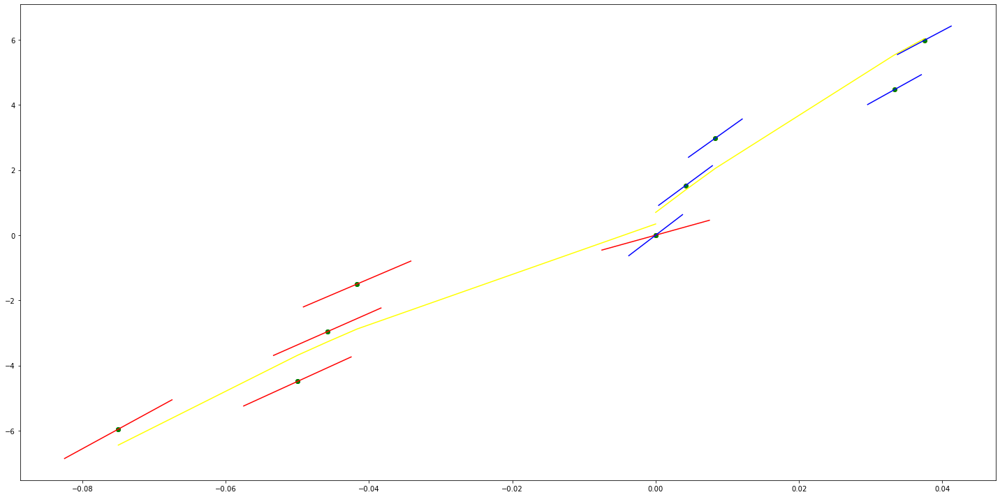

parameters (1644.779015899874, -144.29960102405173, 0.9823510806040787)
tangent[0]:-349.89697801153596
tangent[1]:-295.06991429552954
tangent[2]:-240.24285057952318
tangent[3]:-185.41907642154857
tangent[4]:-144.29960102405173
parameters (-1072.6725713503467, -98.04721052514654, -3.1644732712222305)
tangent[0]:-98.04721052514654
tangent[1]:-106.98686373478033
tangent[2]:-115.92651694441412
tangent[3]:-214.25412086981498
tangent[4]:-250.01058836320746


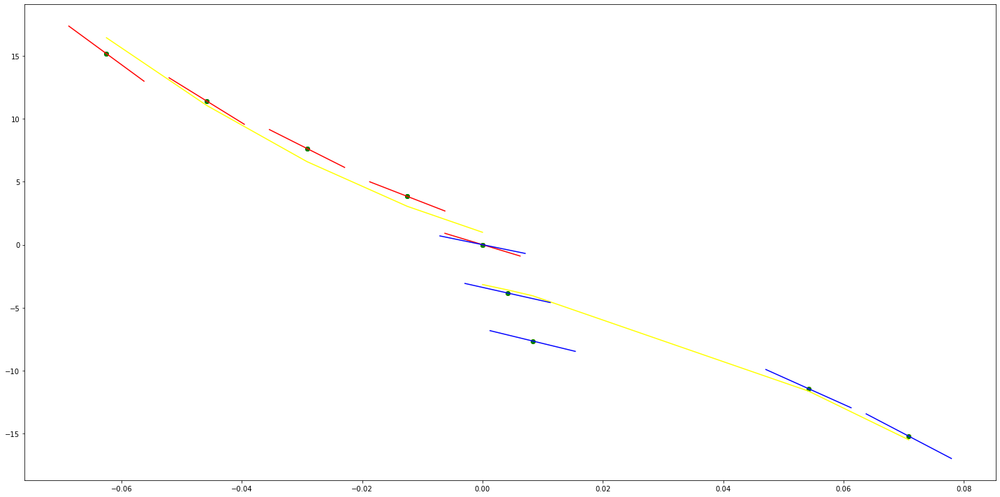

parameters (1023.9247039096297, -190.9043333415834, 1.2085454642960962)
tangent[0]:-310.36358069731205
tangent[1]:-276.23207461718846
tangent[2]:-242.10056853706487
tangent[3]:-207.9711103063491
tangent[4]:-190.9043333415834
parameters (252.4832378530547, -248.07157041120553, -2.4557138557611657)
tangent[0]:-248.07157041120553
tangent[1]:-245.96788007341388
tangent[2]:-243.86368476914652
tangent[3]:-229.13532757222643
tangent[4]:-220.7195562881084


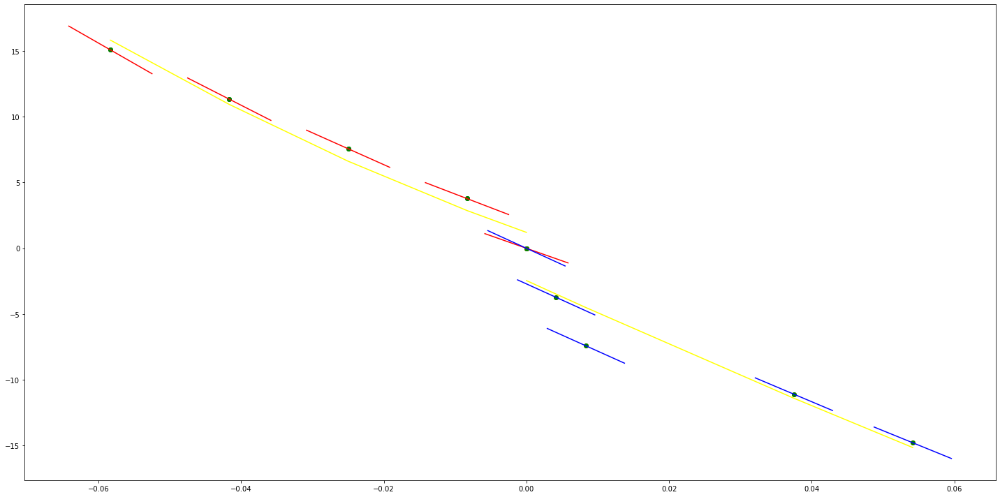

parameters (7.106070133986638, 27.289287100818107, -0.02850808728832232)
tangent[0]:23.499378291978477
tangent[1]:24.44685904722345
tangent[2]:25.394325590328158
tangent[3]:26.341806345573133
tangent[4]:27.289287100818107
parameters (71.97966863867059, 75.69640488861025, -0.6940618455122549)
tangent[0]:75.69640488861025
tangent[1]:85.29359806754147
tangent[2]:86.49335518441083
tangent[3]:87.09308978350823
tangent[4]:87.69296834194292


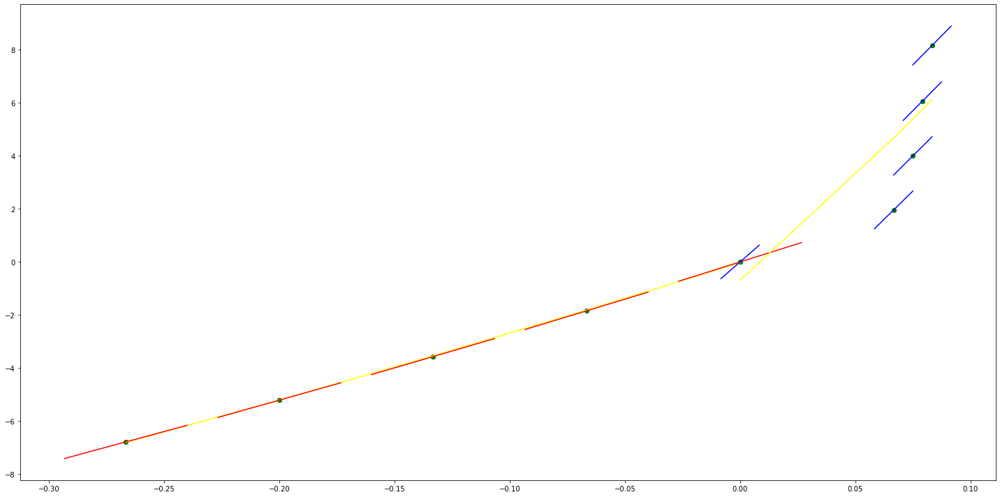

parameters (-2589.3652288832823, 144.20949468282382, -1.4429809001763232)
tangent[0]:446.3055572061786
tangent[1]:359.99165666658325
tangent[2]:273.6777561269879
tangent[3]:187.36903431785038
tangent[4]:144.20949468282382
parameters (-1259.1498606964906, 386.76090710201385, 2.290845772161832)
tangent[0]:386.76090710201385
tangent[1]:376.26967046269067
tangent[2]:365.7759155236461
tangent[3]:323.8034140671893
tangent[4]:281.8334309104539


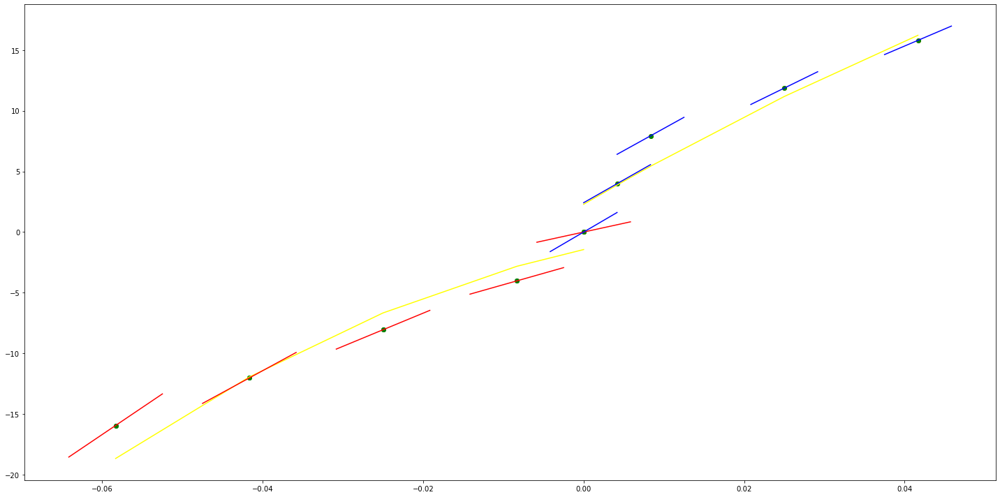

parameters (1084.809227694487, 301.47580434291814, 0.31729535526533165)
tangent[0]:229.15374275098208
tangent[1]:238.19454285458795
tangent[2]:247.2353429581938
tangent[3]:283.39420413570645
tangent[4]:301.47580434291814
parameters (-4017.2258945110316, 460.94388732286404, 0.2524186728228882)
tangent[0]:460.94388732286404
tangent[1]:427.47236116979815
tangent[2]:393.9928005649432
tangent[3]:327.04171380702235
tangent[4]:293.5621532021674


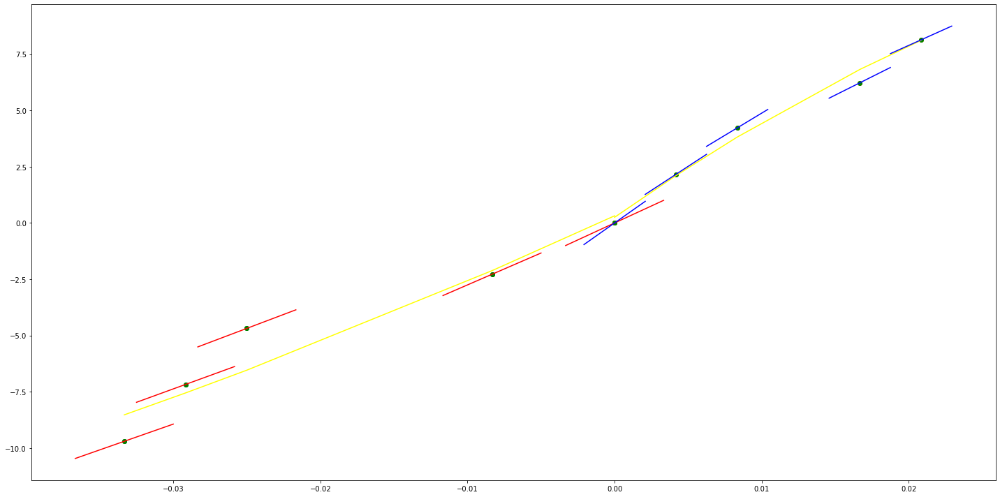

parameters (-2478.7432006310946, -19.14737602397357, 0.23996338435576162)
tangent[0]:270.042635707255
tangent[1]:228.7269440391359
tangent[2]:208.0740556914776
tangent[3]:187.41620985741807
tangent[4]:-19.14737602397357
parameters (-628.1306444606968, 167.32065440665585, 1.3417234921469083)
tangent[0]:167.32065440665585
tangent[1]:162.08706987700933
tangent[2]:156.85222908607386
tangent[3]:135.914122183621
tangent[4]:114.97727154245706


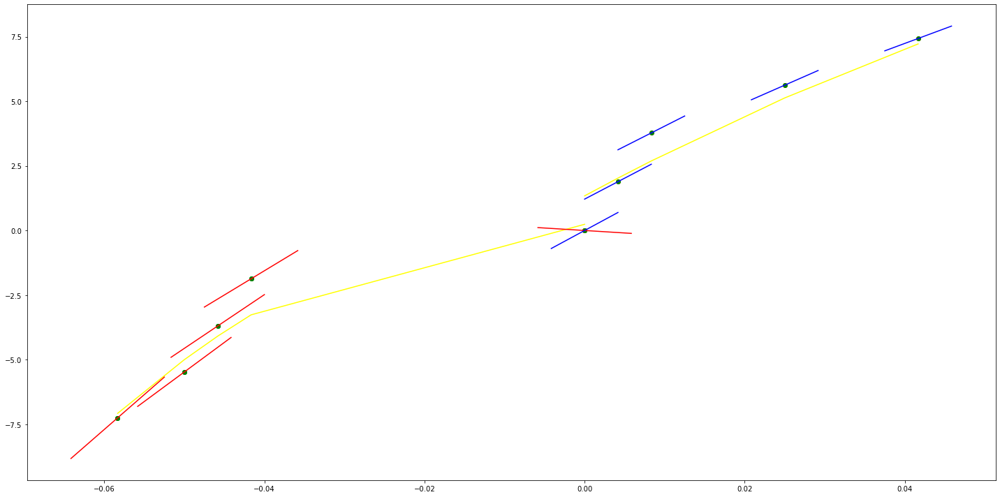

parameters (-360.7849342151416, -696.022933047621, -0.6058510950361158)
tangent[0]:-677.9836863368639
tangent[1]:-683.9965280504935
tangent[2]:-687.0033096922425
tangent[3]:-690.0100913339915
tangent[4]:-696.022933047621
parameters (3394.0166736320693, -615.7236702053484, -0.5630487113285716)
tangent[0]:-615.7236702053484
tangent[1]:-587.4379352472987
tangent[2]:-502.587518406497
tangent[3]:-474.3085714817946
tangent[4]:-446.0228365237449


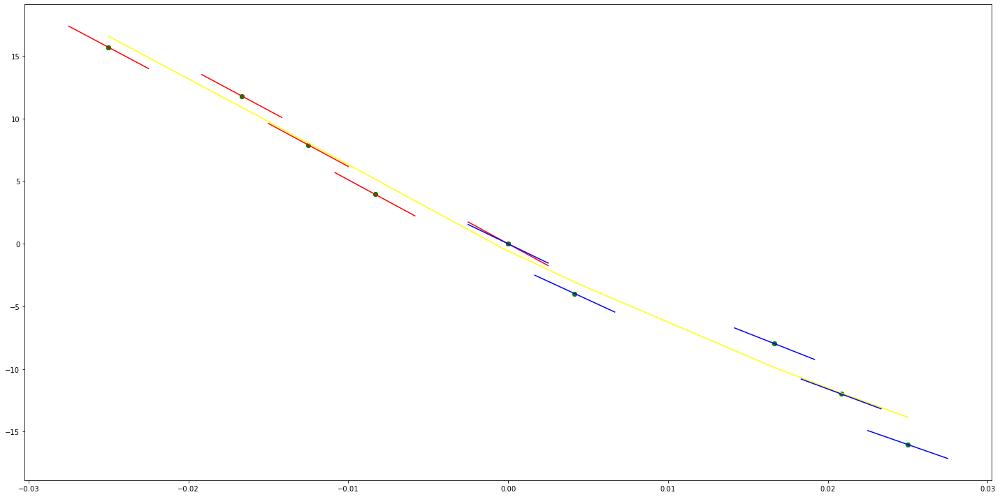

parameters (-304.39290965257294, -283.8732711972856, 0.8430935632713046)
tangent[0]:-248.36096799975851
tangent[1]:-258.5069924642981
tangent[2]:-268.6536257146569
tangent[3]:-278.8002589650158
tangent[4]:-283.8732711972856
parameters (1331.7756938857965, -397.0839899567004, -2.3139205067659376)
tangent[0]:-397.0839899567004
tangent[1]:-385.9849713238562
tangent[2]:-374.88861624239973
tangent[3]:-330.4952052624106
tangent[4]:-286.10179428242145


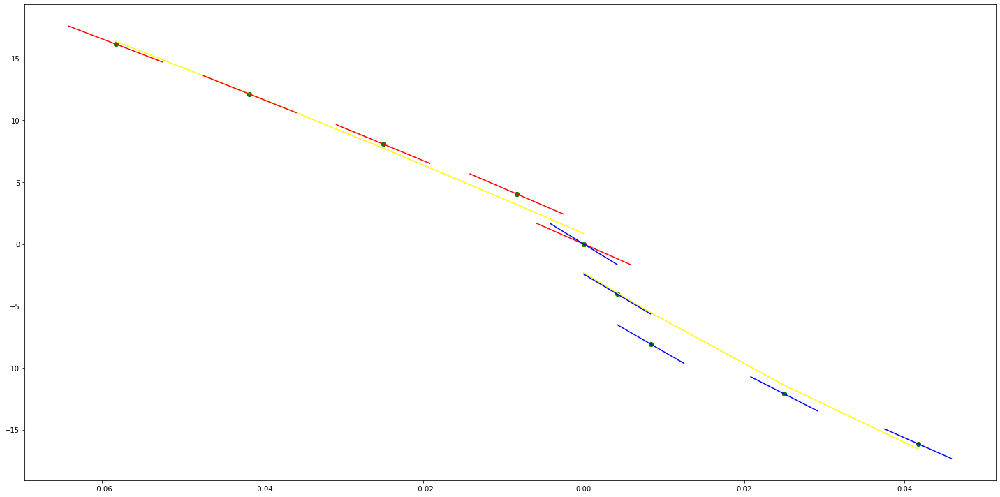

parameters (375.21256803698276, 230.58792101168405, -0.38629334628706485)
tangent[0]:202.44697840891035
tangent[1]:205.57399995093056
tangent[2]:208.7002710678147
tangent[3]:227.46089946966384
tangent[4]:230.58792101168405
parameters (728.9445863110183, 171.38741487293552, 0.7646271658105039)
tangent[0]:171.38741487293552
tangent[1]:177.46243905525154
tangent[2]:213.90966837080245
tangent[3]:219.98323466394586
tangent[4]:226.05825884626188


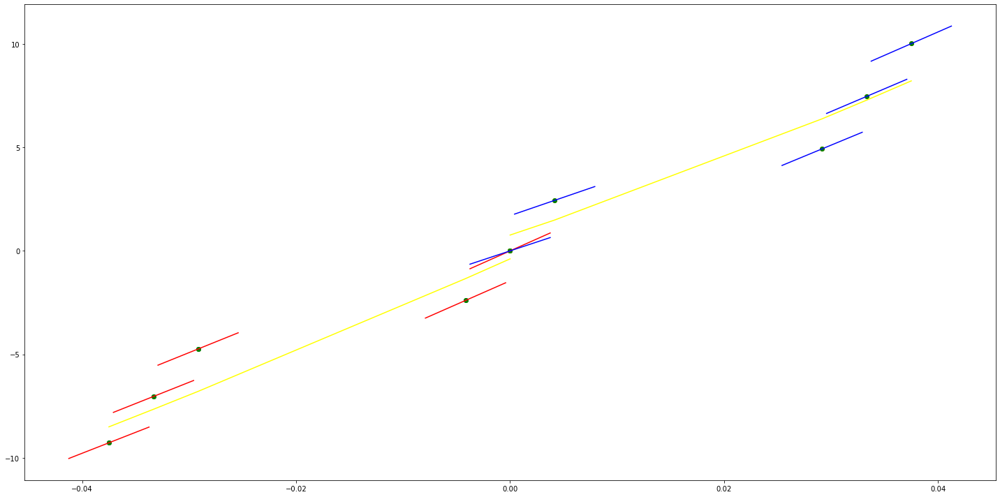

parameters (-895.680449709854, 266.78379311251825, -0.8348662706382555)
tangent[0]:333.9598268407573
tangent[1]:326.4952259728754
tangent[2]:319.0324164658929
tangent[3]:274.2483939804002
tangent[4]:266.78379311251825
parameters (-144.96877141548327, 391.30900986559226, 0.5179549460758204)
tangent[0]:391.30900986559226
tangent[1]:390.1008401246156
tangent[2]:385.26874103579473
tangent[3]:382.85240155384145
tangent[4]:381.64452175040765


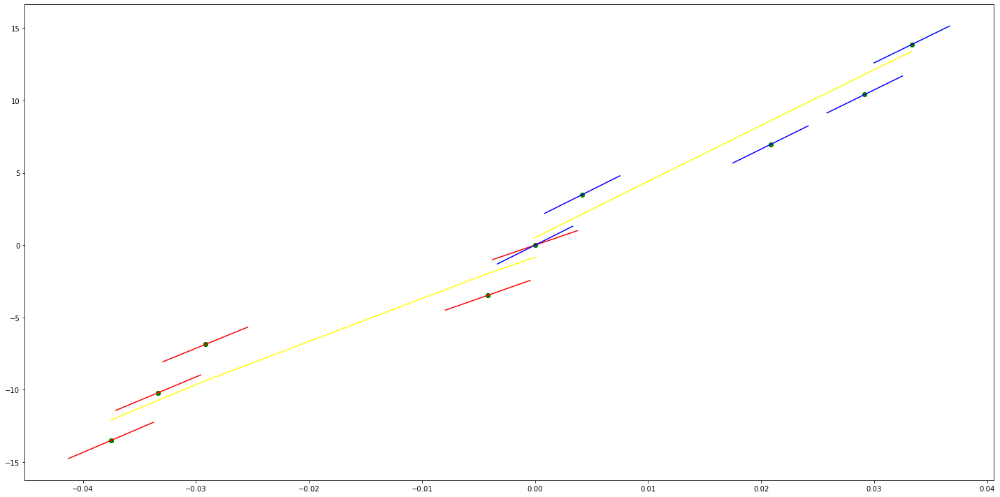

parameters (-167.02375982442166, 125.66674196421137, 0.2772767617150887)
tangent[0]:152.11228195225135
tangent[1]:146.5447119422641
tangent[2]:140.97747597979645
tangent[3]:134.01792995543246
tangent[4]:125.66674196421137
parameters (-285.16321789286496, 180.31168555407353, 1.68601697198191)
tangent[0]:180.31168555407353
tangent[1]:177.93570562259018
tangent[2]:175.55915536467106
tangent[3]:158.92444421210865
tangent[4]:149.4193838333037


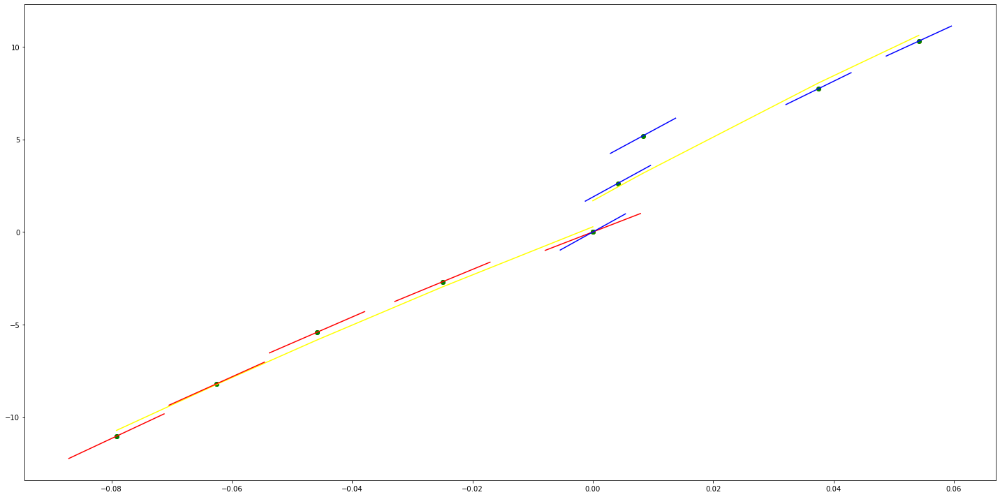

parameters (-2235.7564710750617, -54.02754033146394, -0.6304296168650128)
tangent[0]:188.1809012059818
tangent[1]:169.54810677604223
tangent[2]:150.9197838590448
tangent[3]:-35.394745901524374
tangent[4]:-54.02754033146394
parameters (-366.1962171348657, 104.4825483243901, 1.2417753760281929)
tangent[0]:104.4825483243901
tangent[1]:101.4314014432224
tangent[2]:95.32764289601845
tangent[3]:92.27649601485075
tangent[4]:89.22461674124878


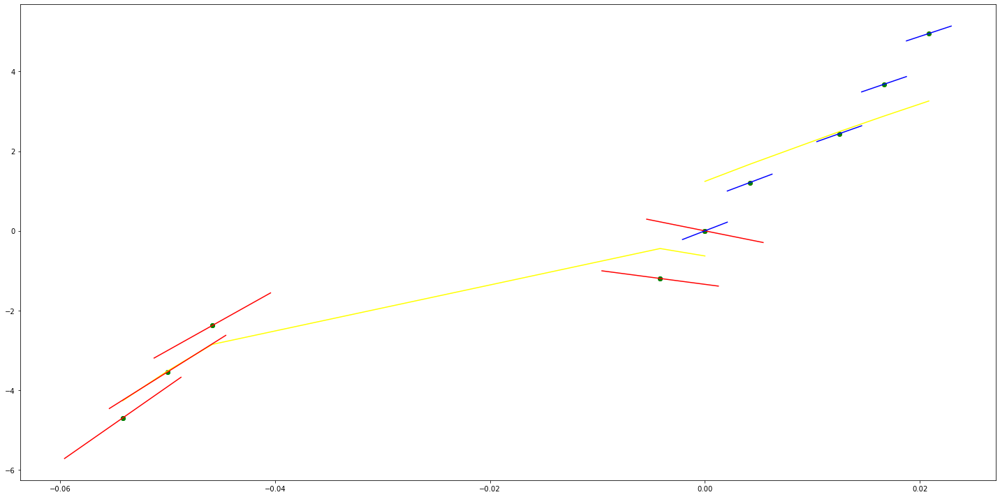

parameters (1716.4985937034526, 220.43650476303773, -0.2954417594509377)
tangent[0]:148.91687435778968
tangent[1]:163.22217363771426
tangent[2]:177.5240399204514
tangent[3]:206.13463848030057
tangent[4]:220.43650476303773
parameters (-25.208973097638495, 35.199545627931336, 0.6536772295153714)
tangent[0]:35.199545627931336
tangent[1]:34.98945404613562
tangent[2]:32.67864831816749
tangent[3]:30.7879753358446
tangent[4]:27.63685369863979


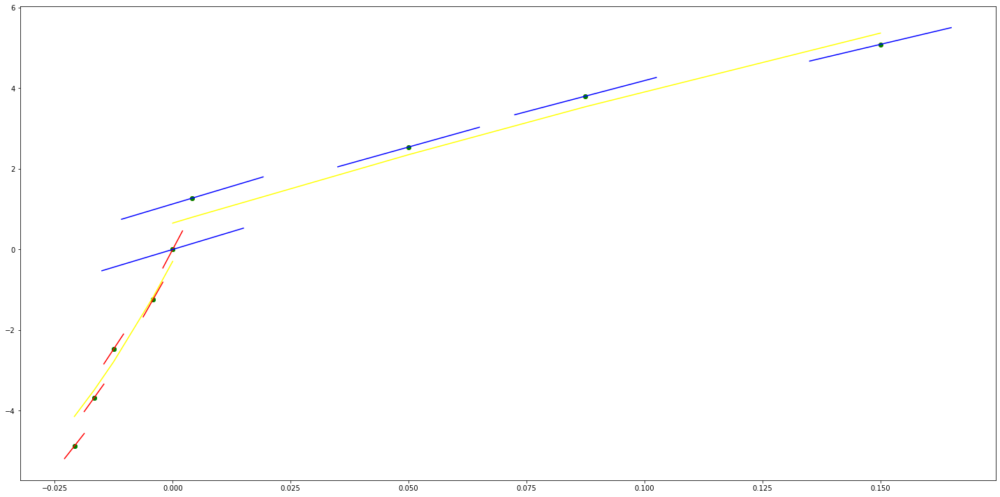

parameters (241.89827305027782, 85.21861844476119, -0.3202220205604047)
tangent[0]:67.07624796599035
tangent[1]:69.09222817359137
tangent[2]:71.10820838119238
tangent[3]:83.20312203370628
tangent[4]:85.21861844476119
parameters (1585.8528885778337, -57.35699451462062, 0.5877206490695013)
tangent[0]:-57.35699451462062
tangent[1]:-44.140496541212954
tangent[2]:114.44479231657041
tangent[3]:140.8746165576086
tangent[4]:154.09111453101627


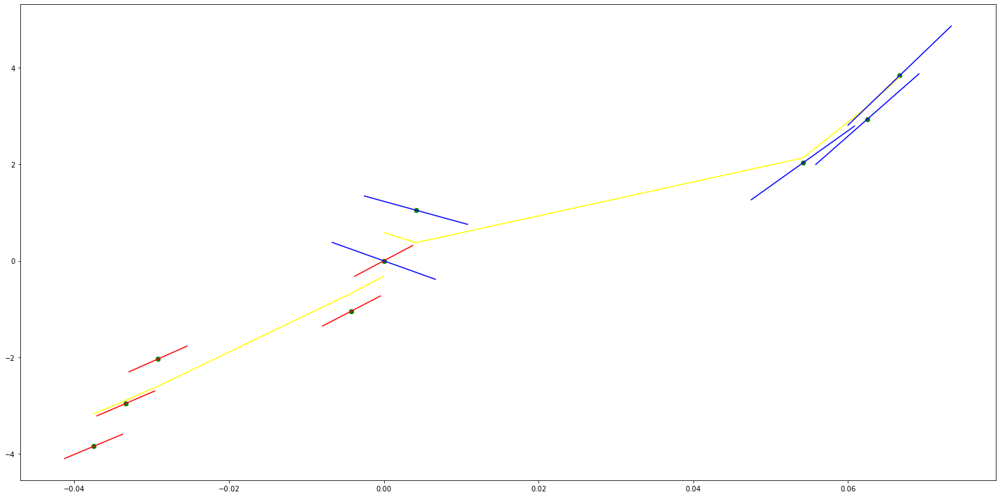

parameters (-445.34985848096244, 30.555959984703783, -0.41876660666783183)
tangent[0]:78.80249155338038
tangent[1]:75.09094583280003
tangent[2]:71.38029081193665
tangent[3]:34.26750570528412
tangent[4]:30.555959984703783
parameters (-265.7360138627999, 92.11836192379481, 0.3099661212426565)
tangent[0]:92.11836192379481
tangent[1]:89.90424945628996
tangent[2]:76.61744876314997
tangent[3]:74.40280482361739
tangent[4]:72.18816088408482


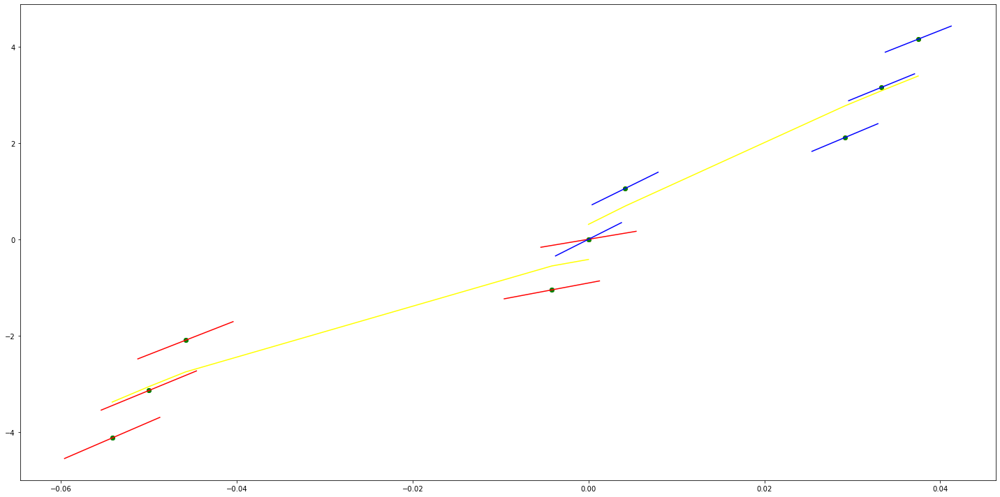

parameters (-295.2604593756025, 73.51171901032079, -0.34609923491524003)
tangent[0]:95.65625346349097
tangent[1]:93.19555279505471
tangent[2]:90.73544264753718
tangent[3]:75.97241967875706
tangent[4]:73.51171901032079
parameters (-11.772058969387912, 22.139888359063416, 0.7913519835543885)
tangent[0]:22.139888359063416
tangent[1]:22.04178001961254
tangent[2]:21.256983936359322
tangent[3]:19.393066751500257
tangent[4]:17.332956431857372


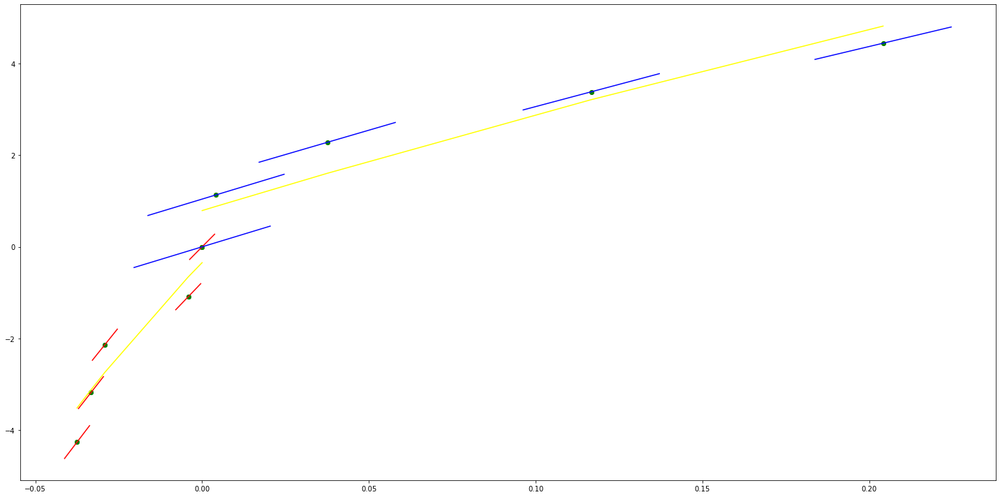

parameters (-344.75395088275434, 127.5019016924774, -0.5455891607183707)
tangent[0]:153.35844800868398
tangent[1]:150.48526858202712
tangent[2]:147.612778663272
tangent[3]:130.37508111913428
tangent[4]:127.5019016924774
parameters (-10.181254150899761, 23.11322799757825, 1.1835321520929407)
tangent[0]:23.11322799757825
tangent[1]:23.02837742548465
tangent[2]:21.41635909326439
tangent[3]:19.040726337218345
tangent[4]:16.919624934944792


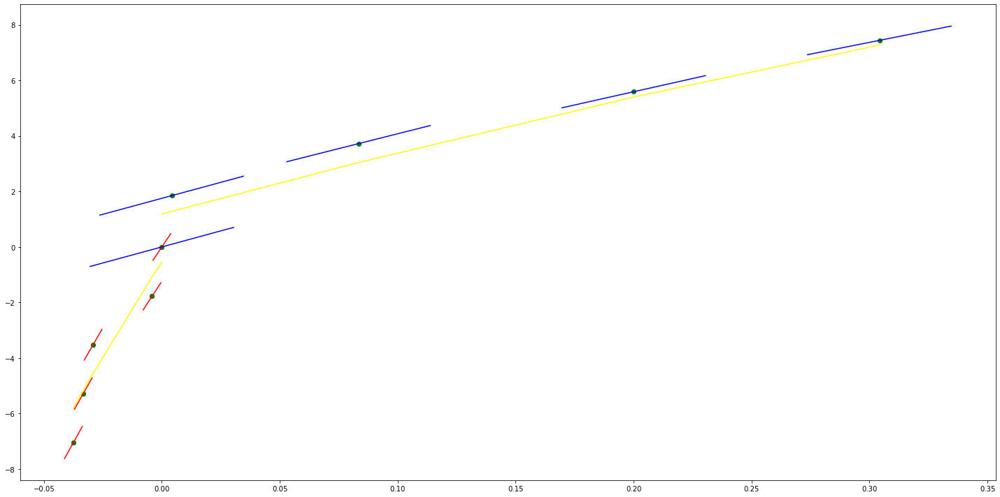

parameters (-0.6902265949655186, -6.050723436250567, 0.007795452164164097)
tangent[0]:-4.710533924510248
tangent[1]:-4.716284892499501
tangent[2]:-4.722037240941944
tangent[3]:-4.900346238125766
tangent[4]:-6.050723436250567
parameters (-84.98019738193746, 34.592729446082785, -1.1212963443133537)
tangent[0]:34.592729446082785
tangent[1]:33.88450448110172
tangent[2]:-53.22019783538417
tangent[3]:-56.05275777451891
tangent[4]:-61.71821757357793


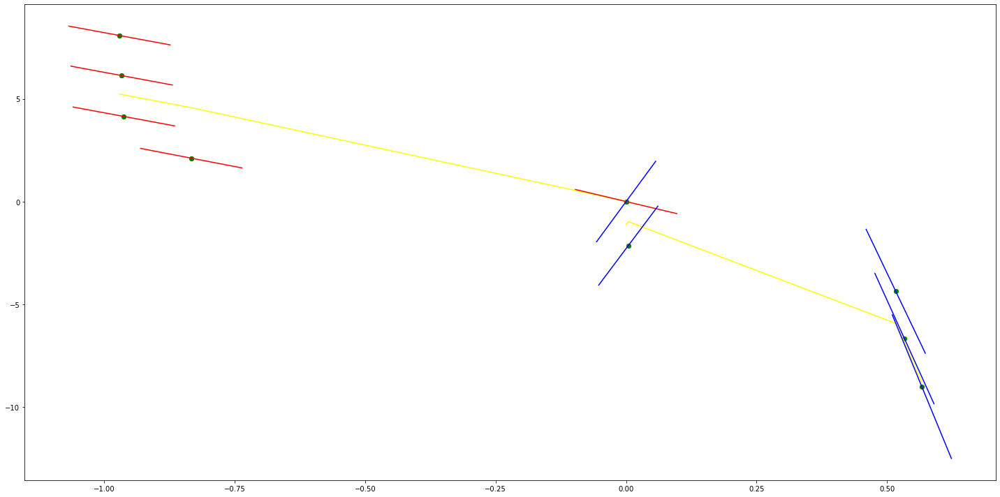

parameters (-55.7690748805235, -87.77621723935238, 1.8238327385391755)
tangent[0]:-73.36916904916723
tangent[1]:-82.66408922135432
tangent[2]:-84.52298402527192
tangent[3]:-87.3114377692981
tangent[4]:-87.77621723935238
parameters (0.1591612266109467, -3.1902165788275982, -3.782487800853756)
tangent[0]:-3.1902165788275982
tangent[1]:-3.1888901291650225
tangent[2]:-3.151752721837437
tangent[3]:-3.137162730516465
tangent[4]:-2.4991916927325555


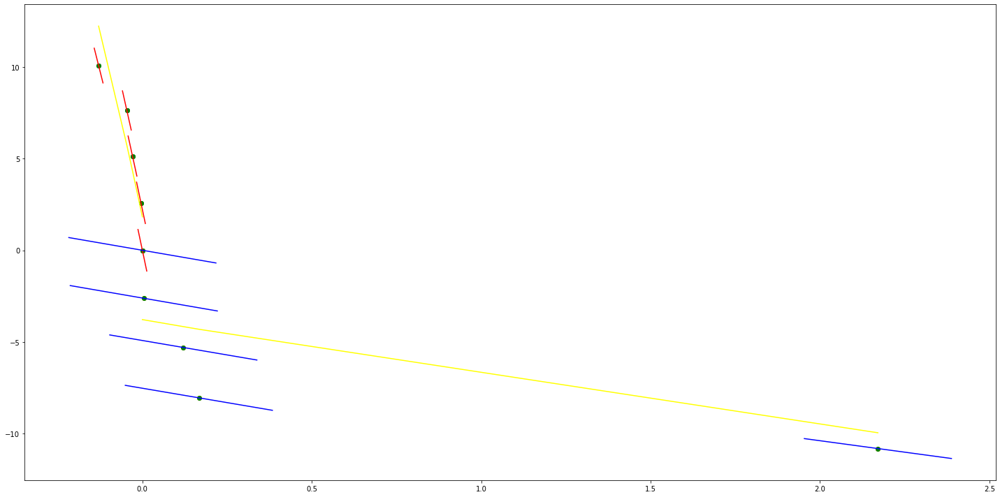

parameters (28.597373879258328, 56.27708698215479, 0.007595129920910255)
tangent[0]:-67.8831588787092
tangent[1]:-67.64482836479948
tangent[2]:-60.97214592280434
tangent[3]:-58.35068185404051
tangent[4]:56.27708698215479
parameters (-0.03818390922567693, -1.3229560097820314, -0.03691513674490142)
tangent[0]:-1.3229560097820314
tangent[1]:-1.476009871384226
tangent[2]:-1.6055169380520407
tangent[3]:-1.7585707996542352
tangent[4]:-1.876622693554347


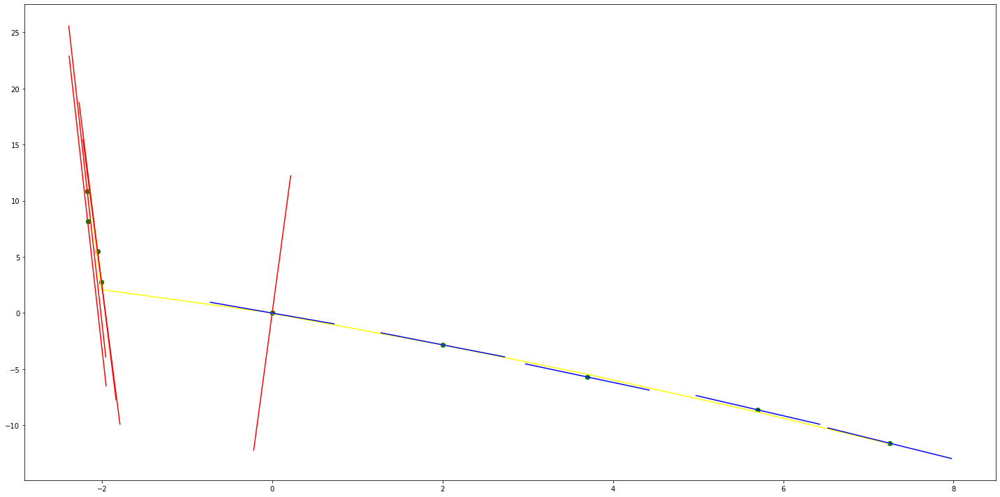

parameters (0.020574403826003576, -1.60773351152084, 0.29949076671541247)
tangent[0]:-1.9144635956097793
tangent[1]:-1.8354235668123438
tangent[2]:-1.7529545255756511
tangent[3]:-1.6704854431901508
tangent[4]:-1.60773351152084
parameters (-484.61494885859867, 590.4019201325201, 0.00015768241381055242)
tangent[0]:590.4019201325201
tangent[1]:-596.9047045710466
tangent[2]:-600.9434855548342
tangent[3]:-604.981297308724
tangent[4]:-613.0588592762991


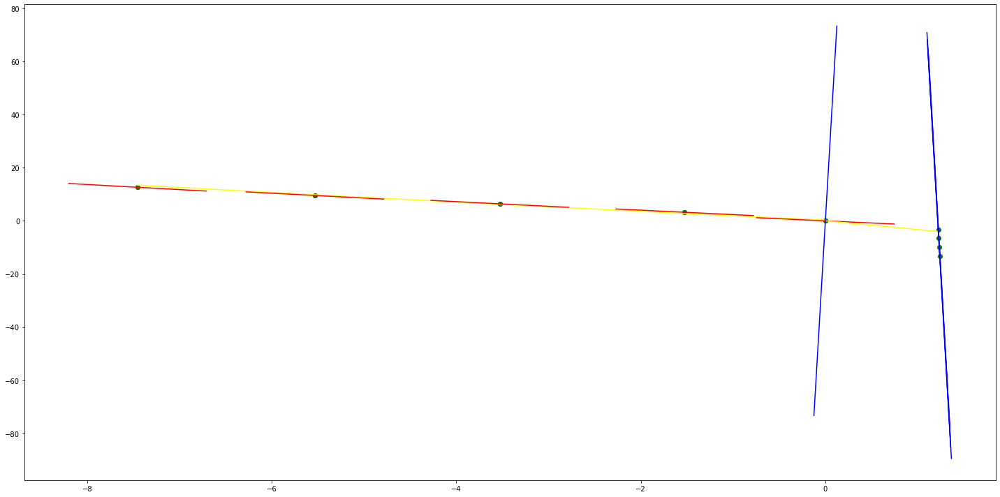

parameters (-225.9335356417914, -768.0031131217756, -0.6711306056209797)
tangent[0]:-756.7064363396861
tangent[1]:-760.4718446446922
tangent[2]:-762.3547747307308
tangent[3]:-764.2377048167696
tangent[4]:-768.0031131217756
parameters (1905.8042575474012, -498.8411982303286, -1.2117253439173585)
tangent[0]:-498.8411982303286
tangent[1]:-482.9582255479285
tangent[2]:-435.31311910924353
tangent[3]:-403.5509853529585
tangent[4]:-355.9058789142735


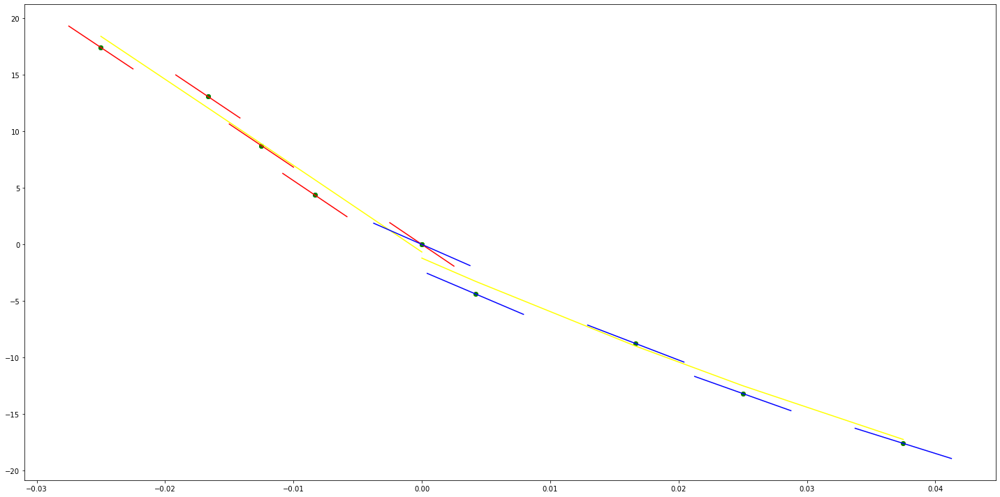

parameters (213.95320675553506, 469.638052625447, 0.4351329807561358)
tangent[0]:458.94039228767025
tangent[1]:462.506136431458
tangent[2]:464.28922245655866
tangent[3]:466.07188057524576
tangent[4]:469.638052625447
parameters (3303.076555258392, 119.79584069826643, 1.7250901993663545)
tangent[0]:119.79584069826643
tangent[1]:147.31707455667936
tangent[2]:174.8449145682028
tangent[3]:339.9987423311224
tangent[4]:367.52658234264584


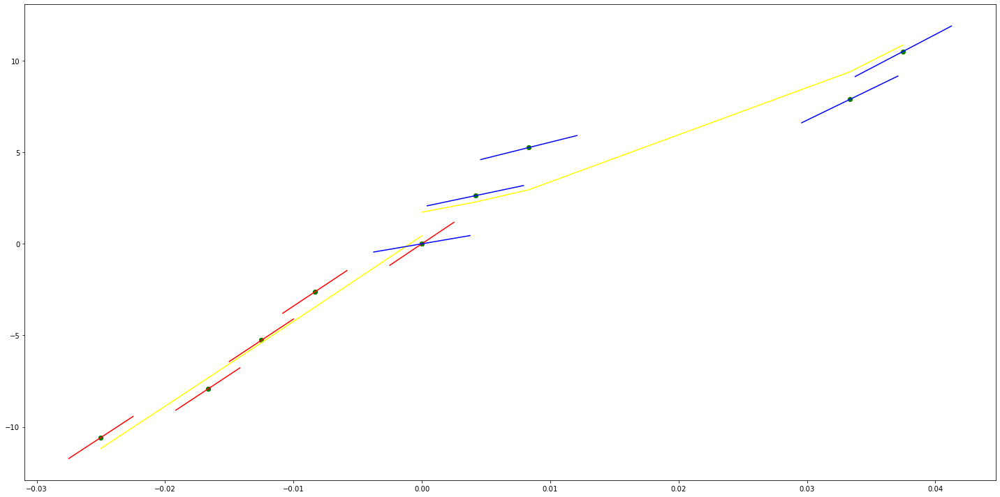

parameters (-365.47672329096235, -46.792238794831114, -0.93553554397548)
tangent[0]:87.21638038081946
tangent[1]:84.17049736891258
tangent[2]:81.1246143570057
tangent[3]:-16.335601536102054
tangent[4]:-46.792238794831114
parameters (142.18145304438593, 25.60909322468489, 1.0524262291388744)
tangent[0]:25.60909322468489
tangent[1]:26.793749091450714
tangent[2]:27.978689321122626
tangent[3]:42.19683462556122
tangent[4]:56.41497992999982


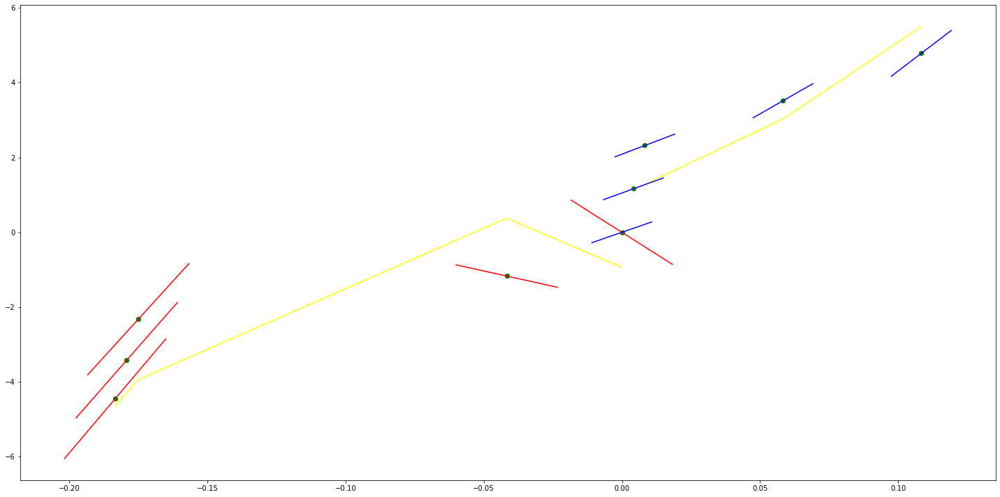

parameters (379.0514659819835, 111.45713191096849, -0.4086905937222306)
tangent[0]:83.02827196231972
tangent[1]:86.18728687981357
tangent[2]:89.34554369437546
tangent[3]:108.29811699347464
tangent[4]:111.45713191096849
parameters (112.21794973982844, 60.98811020954091, 0.4979527668880498)
tangent[0]:60.98811020954091
tangent[1]:61.92333460267265
tangent[2]:71.27468079039203
tangent[3]:72.20990518352376
tangent[4]:73.14512957665549


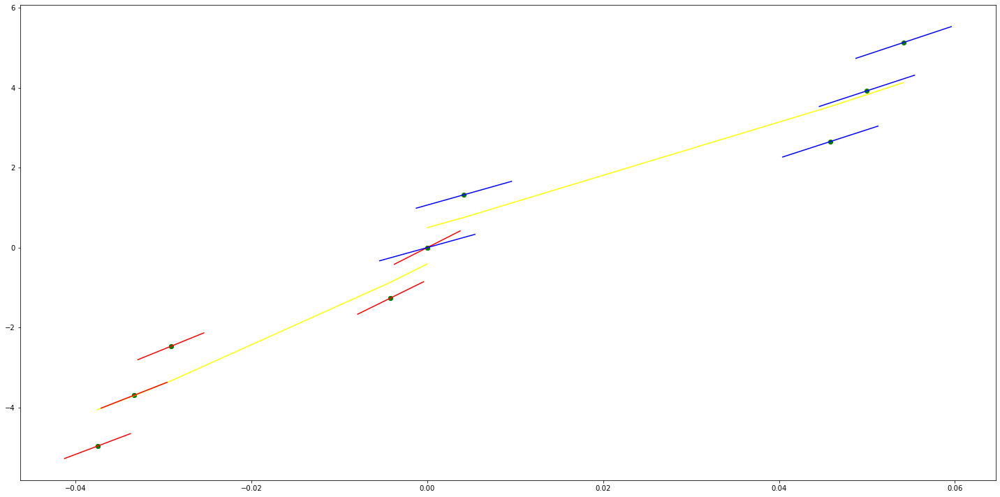

parameters (-633.7788836367981, -23.855156213079958, -0.6883283827519862)
tangent[0]:102.90062051427967
tangent[1]:97.6187072980506
tangent[2]:92.33679408182152
tangent[3]:-2.730038463698204
tangent[4]:-23.855156213079958
parameters (-217.76148427283604, 88.53316968912745, 1.595838426987986)
tangent[0]:88.53316968912745
tangent[1]:86.71834547919764
tangent[2]:84.90352126926781
tangent[3]:74.01544705562601
tangent[4]:72.20105836866475


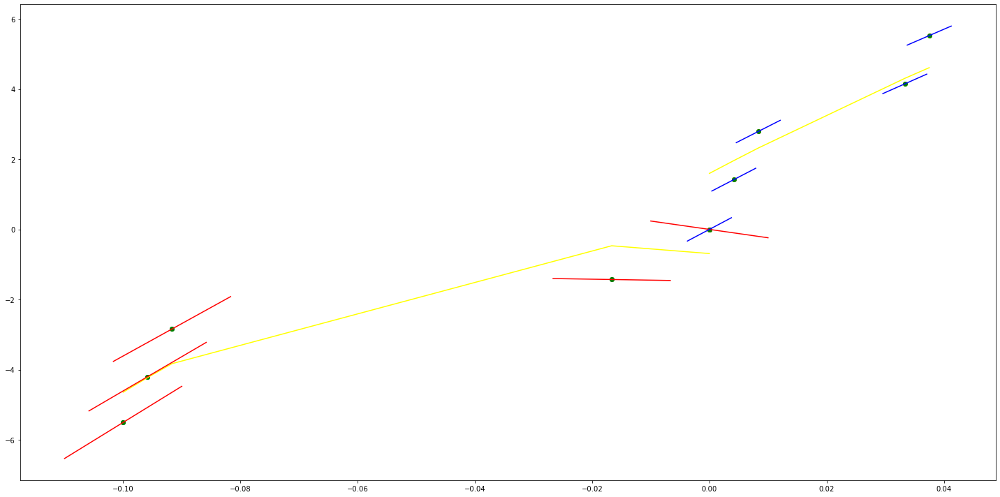

parameters (-312.2456042791816, 35.29919642801999, -0.6327339461534883)
tangent[0]:79.53440669504309
tangent[1]:76.93215182898038
tangent[2]:74.32989696291769
tangent[3]:37.90145129408269
tangent[4]:35.29919642801999
parameters (-128.32851167072454, 89.1371973809533, 0.302280477412331)
tangent[0]:89.1371973809533
tangent[1]:88.06796422171281
tangent[2]:76.30434621388085
tangent[3]:75.23511305464037
tangent[4]:68.81868747110414


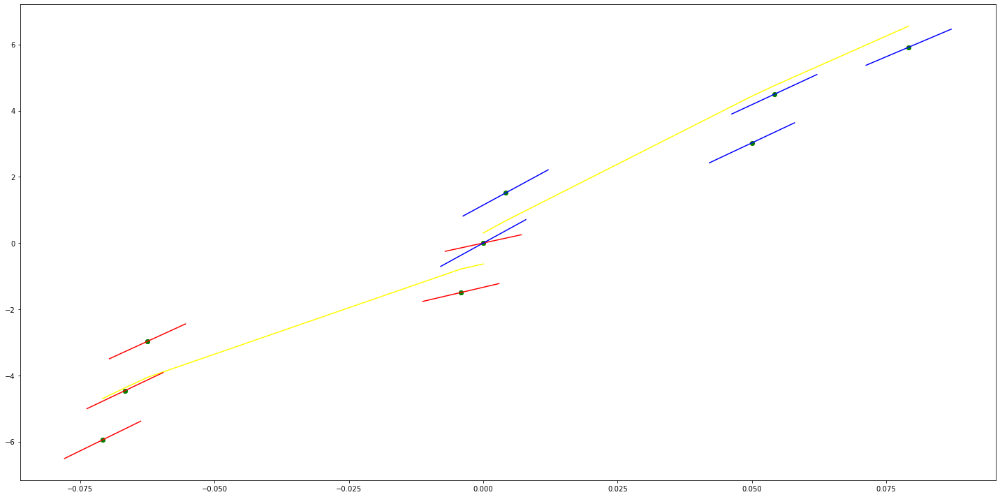

parameters (-0.4216276224017234, 7.122260357765734, -0.6589128873997318)
tangent[0]:8.281736319370474
tangent[1]:7.874163232133889
tangent[2]:7.649294885767889
tangent[3]:7.287397562121328
tangent[4]:7.122260357765734
parameters (-17.028768493442502, 74.96362560779754, 2.048754179349162)
tangent[0]:74.96362560779754
tangent[1]:74.82170785117319
tangent[2]:74.67982415208583
tangent[3]:71.55787190910904
tangent[4]:71.41595415248469


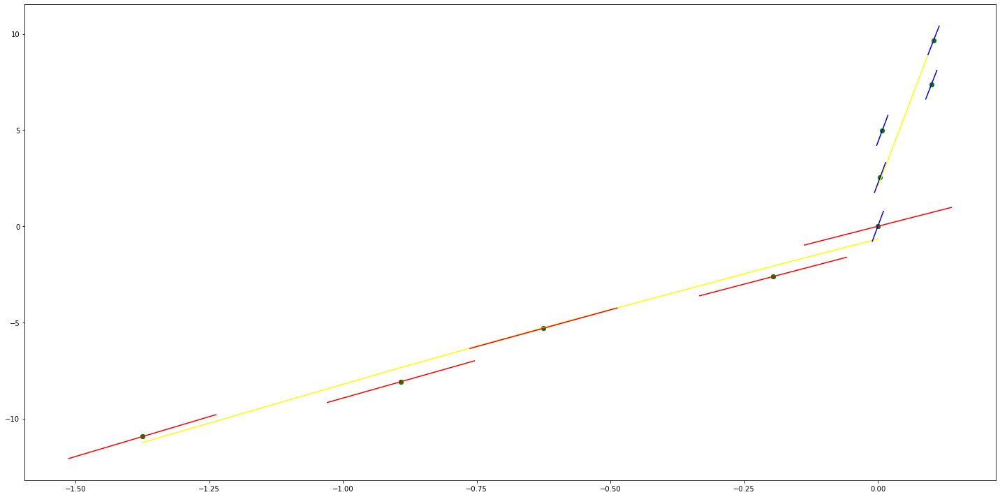

parameters (114.06085526264567, 109.07414985601253, -0.38901809396442355)
tangent[0]:91.96502156661568
tangent[1]:101.47016887907299
tangent[2]:102.42075204683188
tangent[3]:103.37110709288024
tangent[4]:109.07414985601253
parameters (168.6967983019586, -26.483450271779148, 1.8004636587881049)
tangent[0]:-26.483450271779148
tangent[1]:-25.077531154730625
tangent[2]:-23.671612037682102
tangent[3]:53.64752892165119
tangent[4]:69.11162702839512


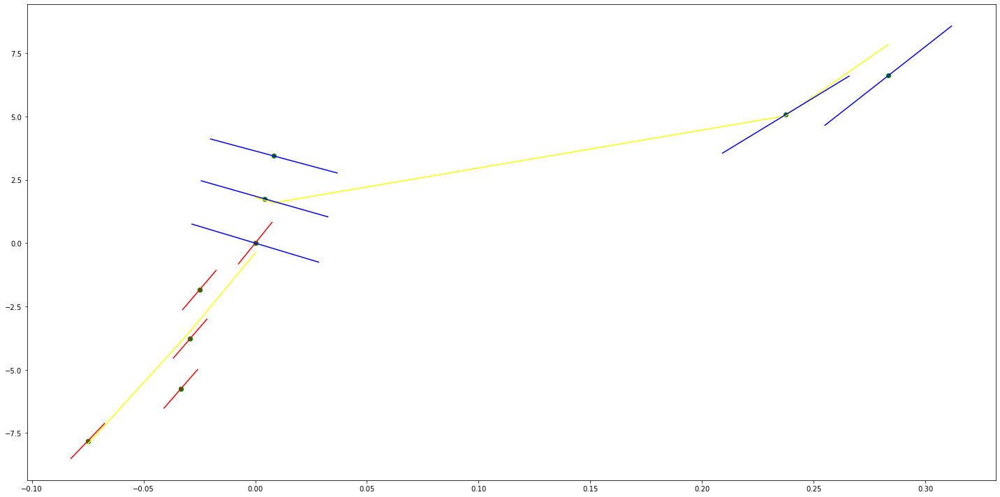

parameters (-0.05530558439568907, -3.233180382223661, -0.0047327408053686225)
tangent[0]:-2.779220088886447
tangent[1]:-2.7801355069193643
tangent[2]:-2.911947075988311
tangent[3]:-3.1336303303114206
tangent[4]:-3.233180382223661
parameters (-376.32919082006237, 720.5905998460411, 3.6820813208915134e-05)
tangent[0]:720.5905998460411
tangent[1]:-725.1404573349047
tangent[2]:-728.276784811199
tangent[3]:-731.4131122874934
tangent[4]:-734.5486871054062


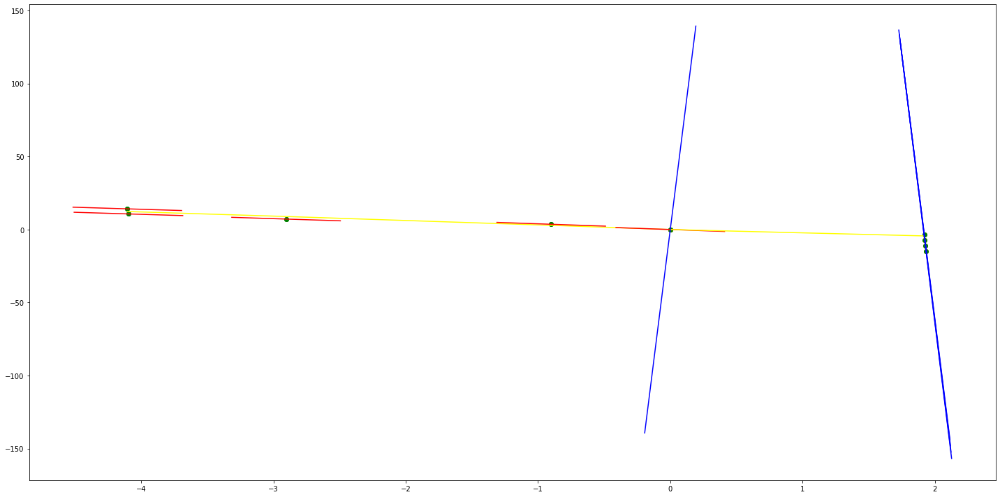

parameters (2801.503097744003, -151.00205672620913, 1.5379038514574845)
tangent[0]:-477.8478201338064
tangent[1]:-384.4625158736079
tangent[2]:-291.0772116134093
tangent[3]:-197.69751035940618
tangent[4]:-151.00205672620913
parameters (1383.983320727839, -420.3891988308672, -2.4567255606778526)
tangent[0]:-420.3891988308672
tangent[1]:-408.85784980256284
tangent[2]:-397.32373280761703
tangent[3]:-351.19003279447526
tangent[4]:-305.0591007479749


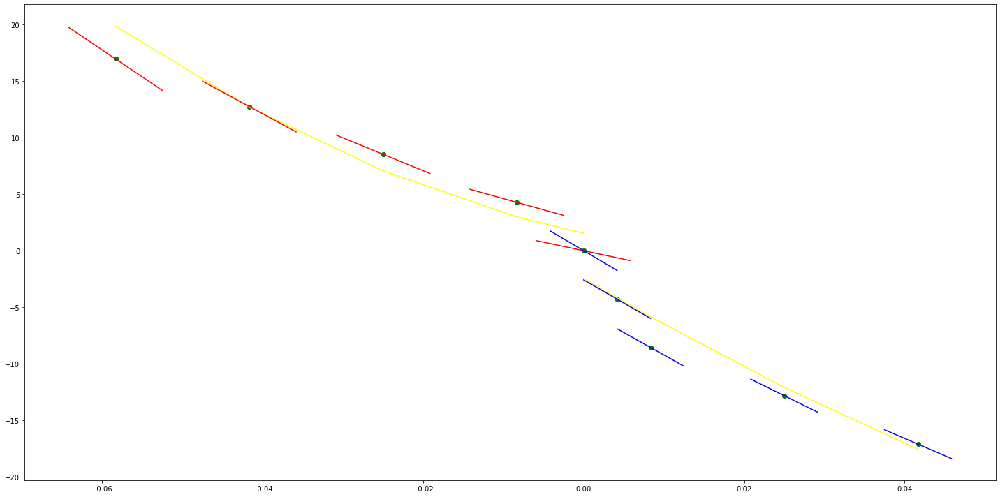

parameters (408.63693862407655, 159.04464103473907, -1.3199273239468468)
tangent[0]:104.55944346023645
tangent[1]:131.80245088442638
tangent[2]:145.4231373226441
tangent[3]:155.639060788246
tangent[4]:159.04464103473907
parameters (69.47681020776511, 62.77259823049616, 1.1177168458730957)
tangent[0]:62.77259823049616
tangent[1]:63.35161796676767
tangent[2]:69.72027925127267
tangent[3]:76.66796027204919
tangent[4]:78.98390026351483


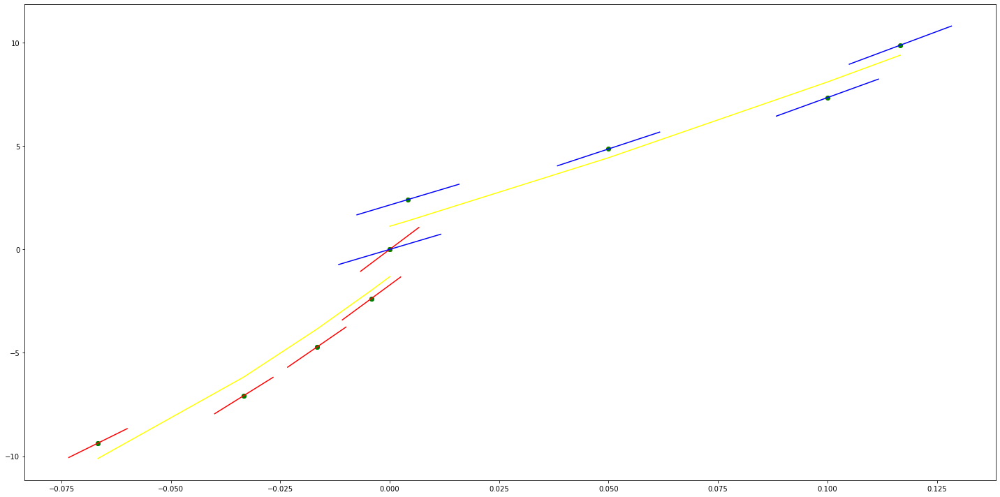

parameters (-908.7375792538154, 15.833018921645818, -1.702705001229947)
tangent[0]:220.2989742537543
tangent[1]:167.28867630556223
tangent[2]:106.70677684702736
tangent[3]:23.404620431988608
tangent[4]:15.833018921645818
parameters (679.5746784339459, 106.36149811153632, 1.2236239729207383)
tangent[0]:106.36149811153632
tangent[1]:112.02507348160482
tangent[2]:157.32959899408226
tangent[3]:202.63548365591657
tangent[4]:213.96127524669672


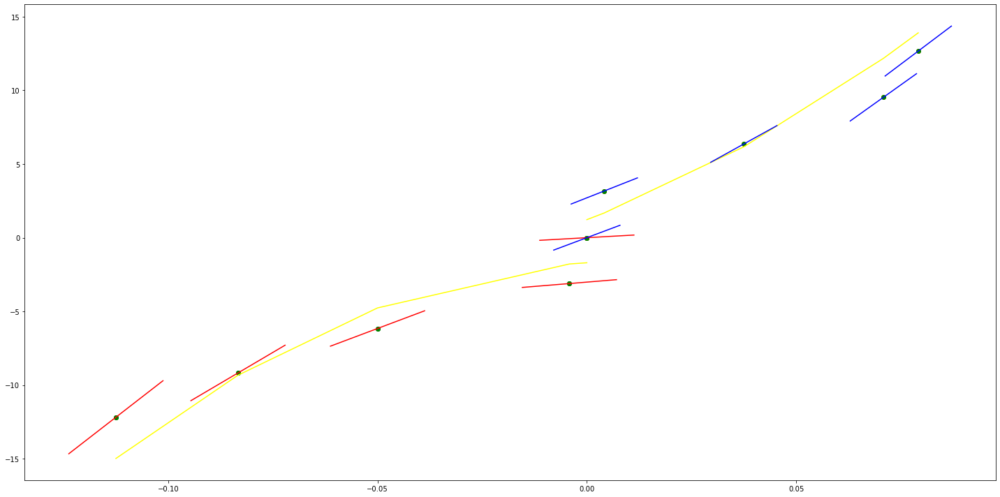

parameters (-95.16501720984283, 133.0863728996396, -0.5822092634421626)
tangent[0]:148.15404040450844
tangent[1]:147.36112548111603
tangent[2]:141.01666411377022
tangent[3]:134.67239307645883
tangent[4]:133.0863728996396
parameters (97.08379648223983, 191.82451159303008, 2.00968701170329)
tangent[0]:191.82451159303008
tangent[1]:192.63360795291308
tangent[2]:193.44270431279605
tangent[3]:196.67870141714207
tangent[4]:202.34198760113705


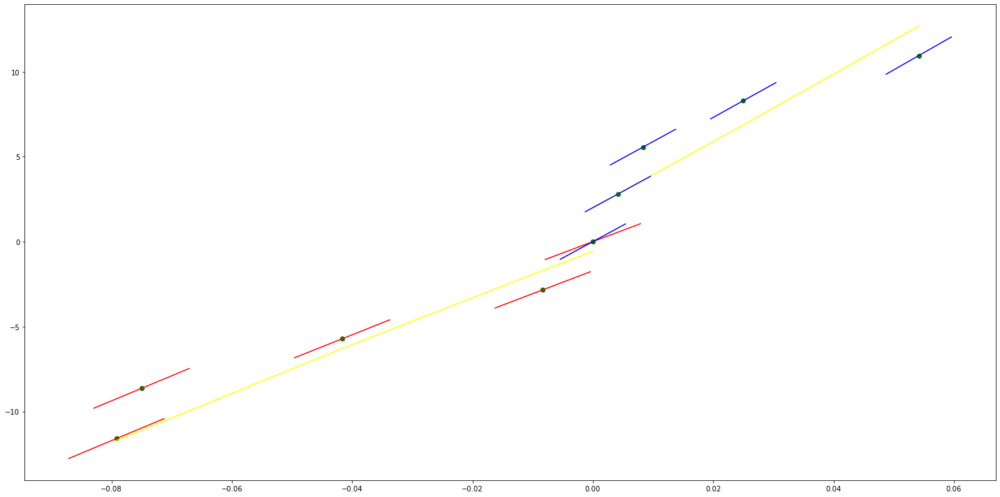

parameters (-106.49331344269186, 47.632202280989944, -0.5378057025226185)
tangent[0]:70.70568253136422
tangent[1]:64.49371457162512
tangent[2]:57.39401835102774
tangent[3]:50.29453511705724
tangent[4]:47.632202280989944
parameters (1055.7009610619793, 150.83292946618565, 0.7773657811495467)
tangent[0]:150.83292946618565
tangent[1]:159.63114127567619
tangent[2]:168.4272416832446
tangent[3]:203.6179775192846
tangent[4]:221.21228973634356


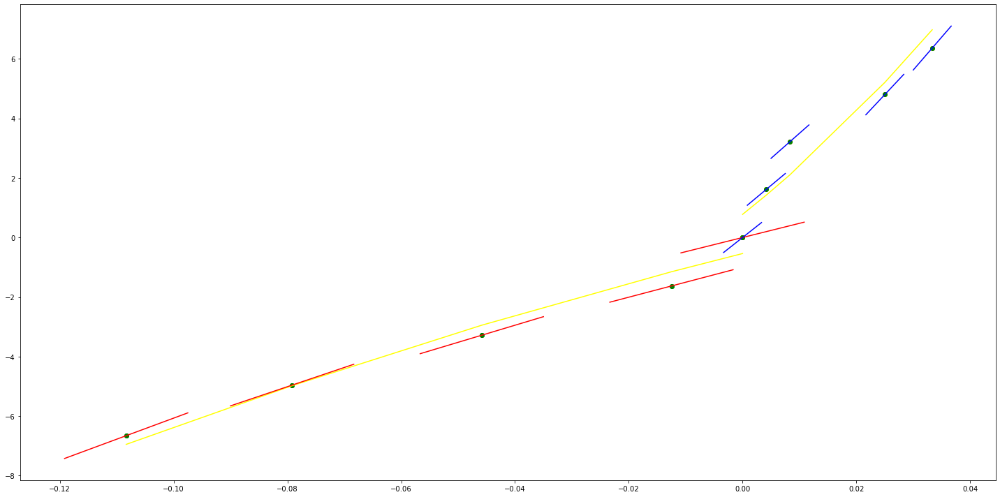

parameters (1998.9560122787616, 281.7876757128016, -0.14673072395726874)
tangent[0]:181.83987509886353
tangent[1]:215.15447599950136
tangent[2]:231.8137754058326
tangent[3]:248.4690769001392
tangent[4]:281.7876757128016
parameters (250.0968284561871, 77.52803530060011, 1.2585941217241532)
tangent[0]:77.52803530060011
tangent[1]:79.61184207529706
tangent[2]:81.69614904365092
tangent[3]:106.70583188926963
tangent[4]:110.87394563232044


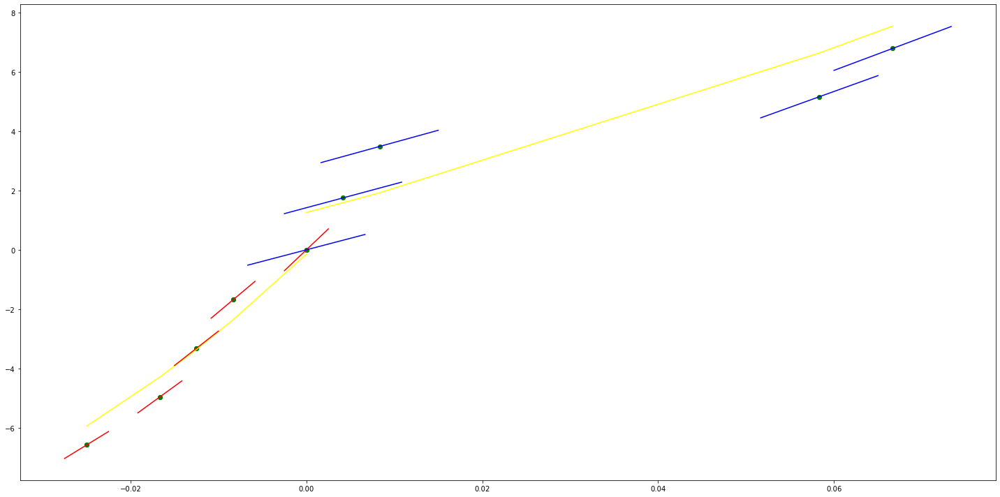

parameters (-60.6962600183581, 61.26955154927062, -0.03764248688969289)
tangent[0]:70.37399055202434
tangent[1]:65.31604981217453
tangent[2]:64.81020718118153
tangent[3]:64.30436455018852
tangent[4]:61.26955154927062
parameters (980.0187935247492, -29.37898272501956, 0.9541802284087231)
tangent[0]:-29.37898272501956
tangent[1]:-21.21346613737135
tangent[2]:-13.045989512136092
tangent[3]:101.28888305322229
tangent[4]:109.45635967845755


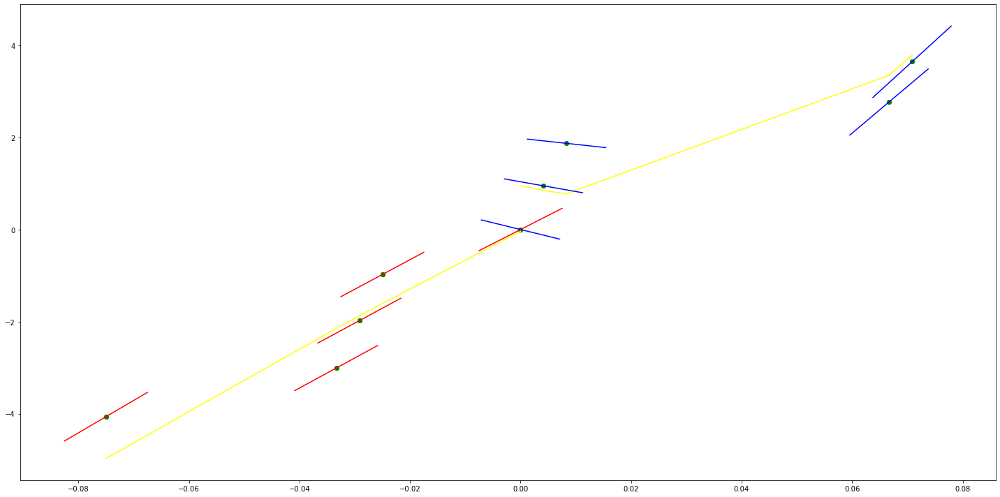

parameters (-186.47975205107923, 39.18679205545479, 0.1882579586920442)
tangent[0]:67.15875486311667
tangent[1]:57.834767260562714
tangent[2]:56.28064500696902
tangent[3]:54.72652275337532
tangent[4]:39.18679205545479
parameters (-213.92770168302093, 90.78101511611233, 0.46144878612526236)
tangent[0]:90.78101511611233
tangent[1]:88.99814165028603
tangent[2]:87.21526818445973
tangent[3]:76.51888310030868
tangent[4]:74.73643748988576


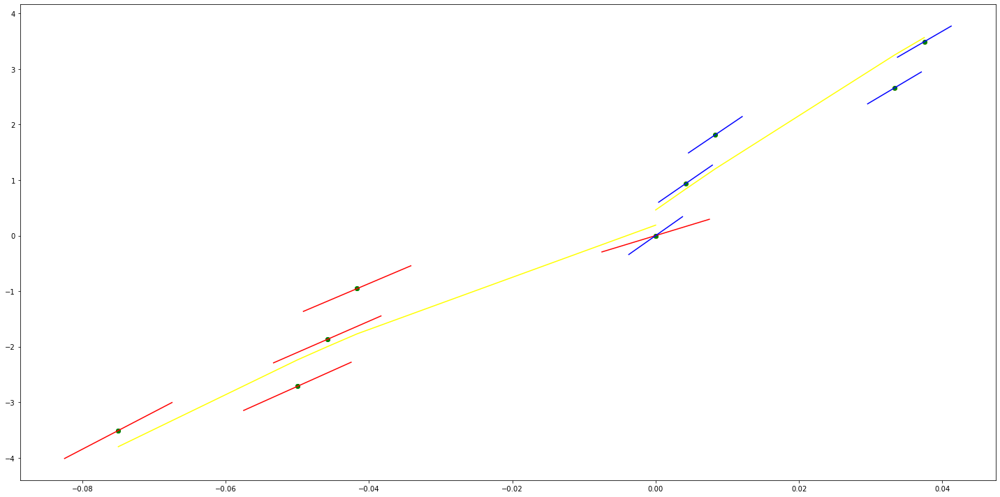

parameters (993.8886163861481, 149.73744521795987, -0.28358815668845605)
tangent[0]:108.32409435038186
tangent[1]:116.60716207934401
tangent[2]:124.89022980830617
tangent[3]:141.45437748899772
tangent[4]:149.73744521795987
parameters (481.00226548759827, 1.1491707934747175, 0.4287162450683489)
tangent[0]:1.1491707934747175
tangent[1]:5.156881669517387
tangent[2]:61.2744539794245
tangent[3]:65.28216485546717
tangent[4]:69.29083773604081


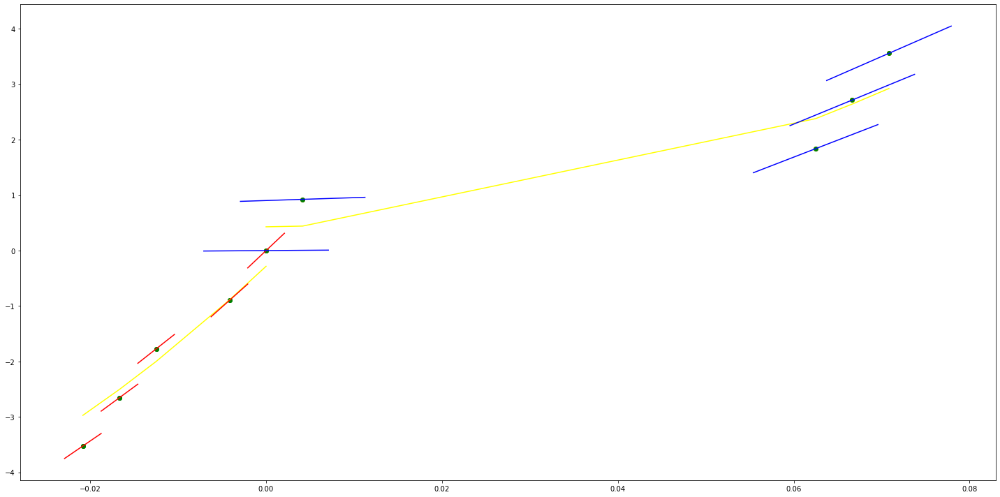

parameters (0.8611662647206855, 6.5604565849105745, -0.6013210051217511)
tangent[0]:5.699290320189889
tangent[1]:6.0724629423463625
tangent[2]:6.388223331966437
tangent[3]:6.553281347592922
tangent[4]:6.5604565849105745
parameters (1540.2885785619044, -71.83086422245981, 0.5352118859323866)
tangent[0]:-71.83086422245981
tangent[1]:-58.9940992087249
tangent[2]:120.70520809777824
tangent[3]:133.54197311151316
tangent[4]:146.37873812524805


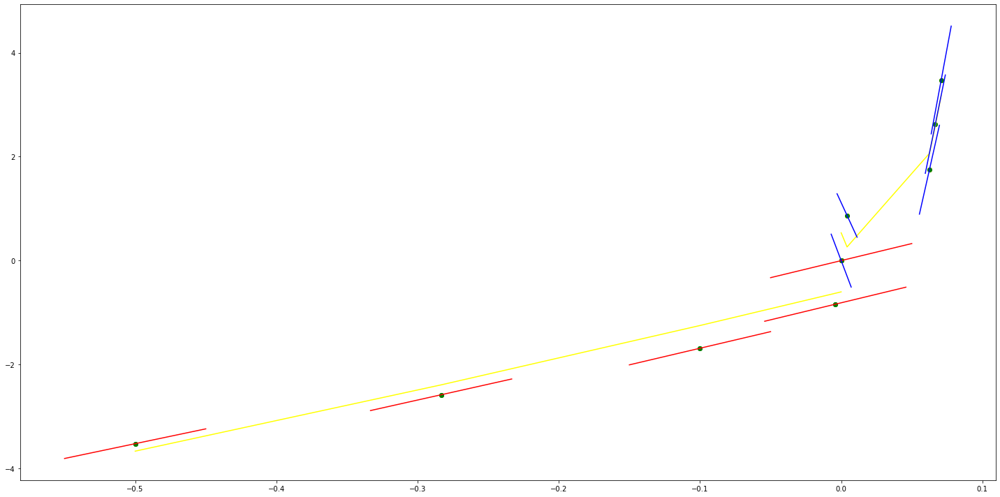

parameters (435.96244474565725, 109.26079405019502, -0.3850898285198792)
tangent[0]:76.56361069427072
tangent[1]:80.19692170878103
tangent[2]:83.83023272329135
tangent[3]:105.6283549605742
tangent[4]:109.26079405019502
parameters (681.292659584765, 28.317020492041443, 0.5024167936221141)
tangent[0]:28.317020492041443
tangent[1]:33.994913517020876
tangent[2]:90.76975601085769
tangent[3]:96.44628645051796
tangent[4]:102.12417947549739


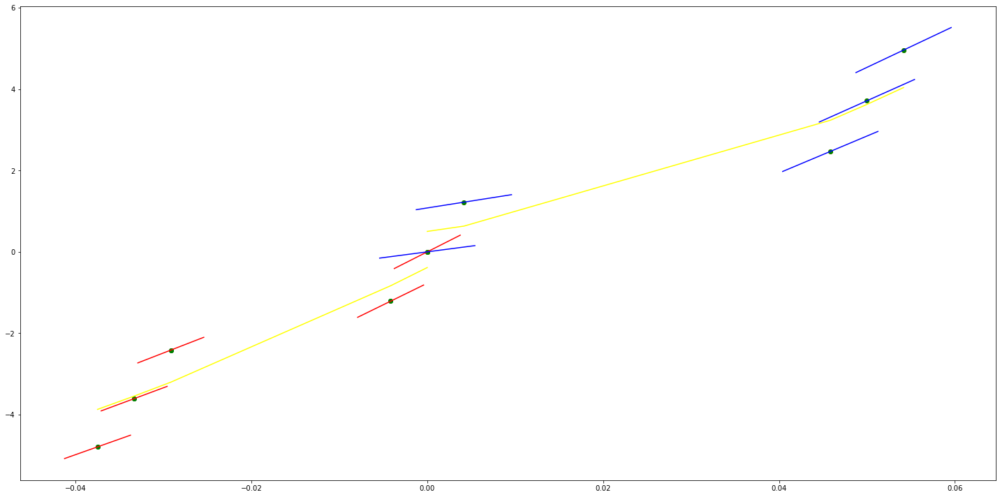

parameters (259.23231010806944, 107.94270886110864, -0.38396614318058636)
tangent[0]:88.50028560300343
tangent[1]:90.66020921082387
tangent[2]:92.82065128326452
tangent[3]:105.782266788668
tangent[4]:107.94270886110864
parameters (-68.29265895003034, 45.29605848726931, 1.1701713953521888)
tangent[0]:45.29605848726931
tangent[1]:44.72704405289766
tangent[2]:39.03594361195583
tangent[3]:38.46679259226628
tangent[4]:37.89777815789463


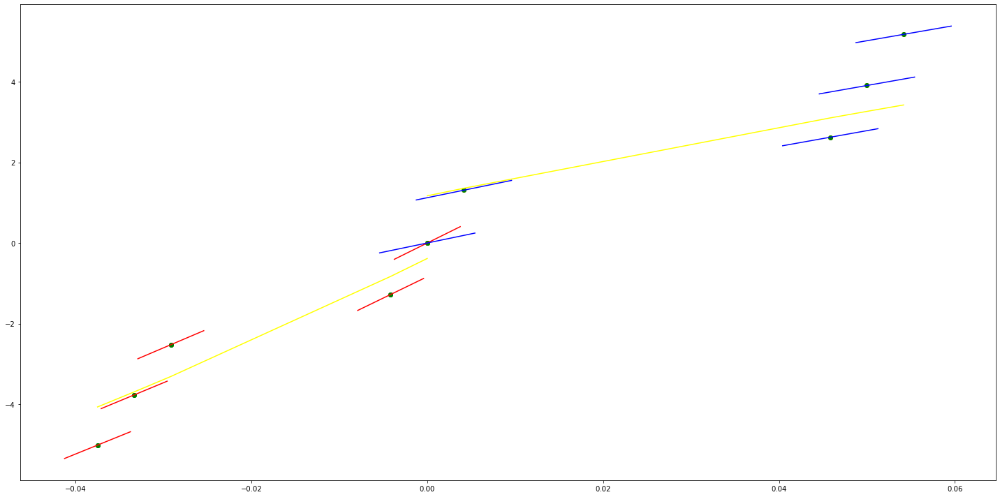

parameters (-73.58429434034974, -14.678326531689933, -0.9141606149081076)
tangent[0]:46.641820639542395
tangent[1]:46.028716299098605
tangent[2]:24.56653233743748
tangent[3]:-14.06522219124614
tangent[4]:-14.678326531689933
parameters (-592.7649768974611, 147.69937802350807, 0.5258829681544579)
tangent[0]:147.69937802350807
tangent[1]:142.75927470604464
tangent[2]:113.12102586117157
tangent[3]:108.18092254370814
tangent[4]:103.2420047561985


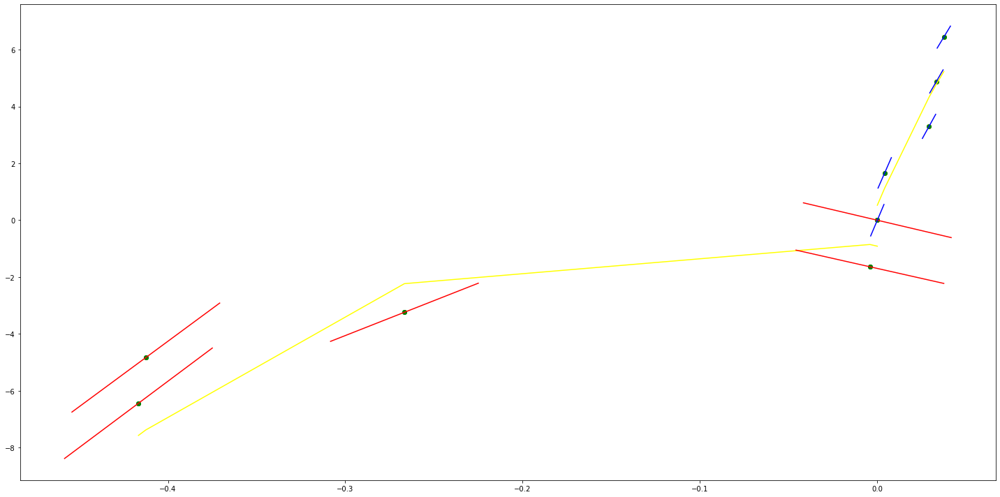

parameters (119.01189012263366, 76.32343004386186, 0.16911347449589176)
tangent[0]:50.53759985855132
tangent[1]:64.4222410315985
tangent[2]:65.41408612388052
tangent[3]:66.4056931923823
tangent[4]:76.32343004386186
parameters (218.77877635655057, 26.237944836494083, 1.4288642172035808)
tangent[0]:26.237944836494083
tangent[1]:28.061247158649575
tangent[2]:29.884111923252355
tangent[3]:64.52423069889043
tangent[4]:66.34753302104592


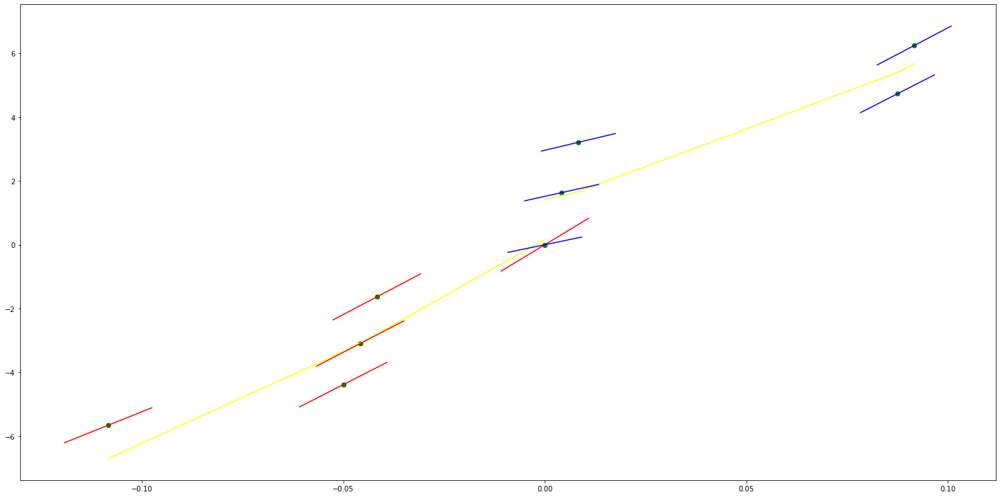

parameters (-219.16552563474602, -58.119558388139055, -0.0488885382732966)
tangent[0]:89.81717141531452
tangent[1]:86.16412043403456
tangent[2]:78.8588951335772
tangent[3]:58.76842972969132
tangent[4]:-58.119558388139055
parameters (-0.06507608913232933, 2.0161718403794935, 0.44419781412969056)
tangent[0]:2.0161718403794935
tangent[1]:1.9874298142445959
tangent[2]:1.9163884603258625
tangent[3]:1.8274511818957384
tangent[4]:1.7168218303707785


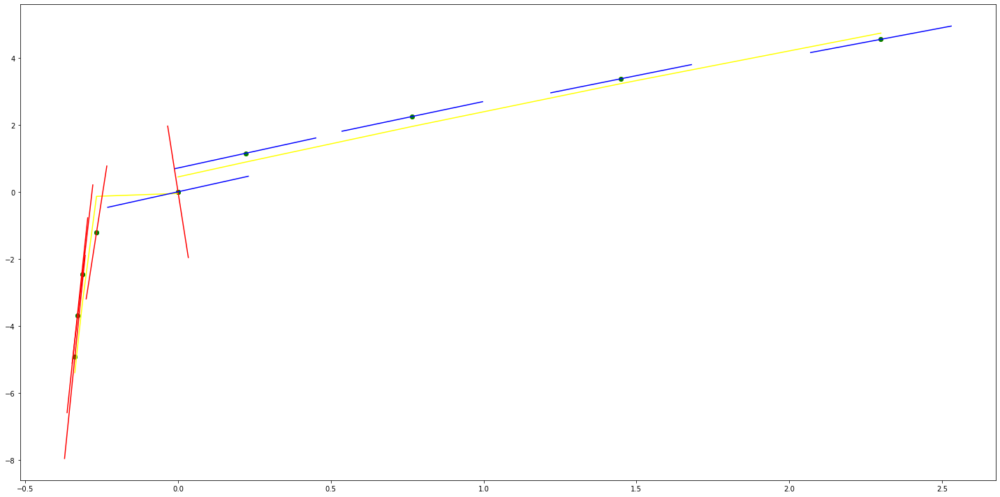

parameters (125.62399590280835, -74.99014345501365, 0.792111472903803)
tangent[0]:-94.8804419742971
tangent[1]:-90.6931429428647
tangent[2]:-83.36499276587027
tangent[3]:-76.03684258887586
tangent[4]:-74.99014345501365
parameters (0.12960452449311372, -2.614691376294085, -2.261431913443128)
tangent[0]:-2.614691376294085
tangent[1]:-2.6136112521869594
tangent[2]:-2.606050901855178
tangent[3]:-2.315520845852798
tangent[4]:-1.9828693193901556


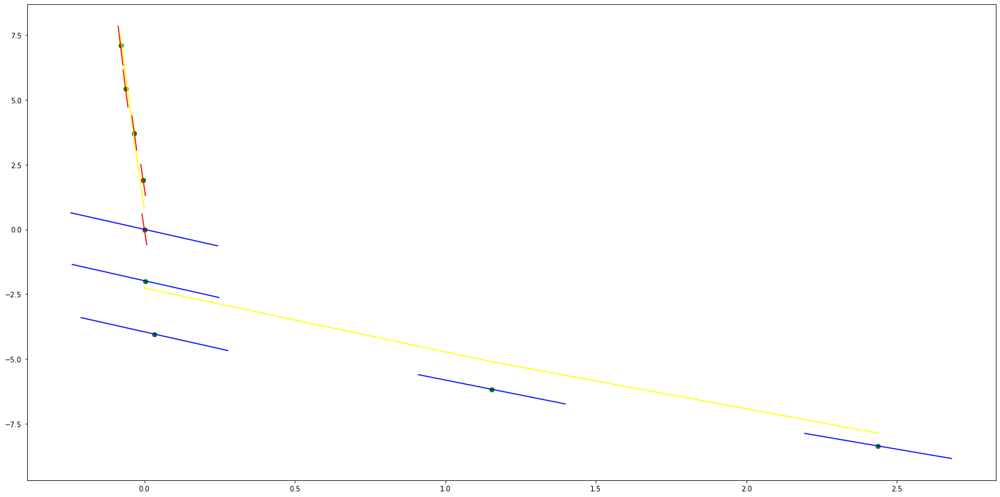

parameters (76.20186789387651, 82.84779646554522, -0.0032545661698944427)
tangent[0]:-93.68648002069013
tangent[1]:-93.05156605739832
tangent[2]:-92.41649969037074
tangent[3]:-87.97133992864936
tangent[4]:82.84779646554522
parameters (-0.03278848032813224, -1.2905383498851573, -0.09004930720089949)
tangent[0]:-1.2905383498851573
tangent[1]:-1.3746954275350431
tangent[2]:-1.502570500814759
tangent[3]:-1.6184231531664797
tangent[4]:-1.7309969574853872


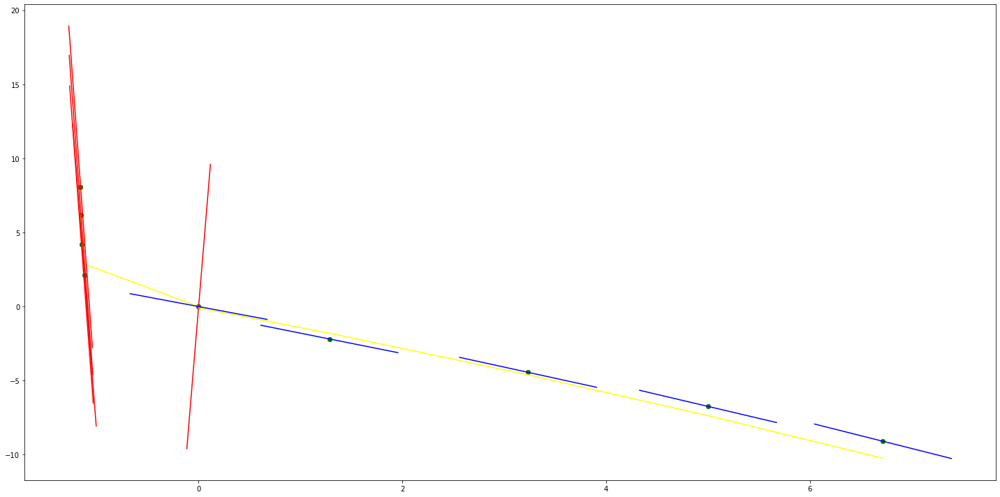

parameters (-0.16329571479306887, -3.9052525388733086, -1.191515687000298)
tangent[0]:-2.9989613217717763
tangent[1]:-3.0003222282588617
tangent[2]:-3.0016828081545177
tangent[3]:-3.2507087732139475
tangent[4]:-3.9052525388733086
parameters (-509.22664626498886, 510.00067224184977, 0.00020967687233449682)
tangent[0]:510.00067224184977
tangent[1]:-516.9393915747801
tangent[2]:-521.1832864447526
tangent[3]:-525.427181314725
tangent[4]:-533.9139526013773


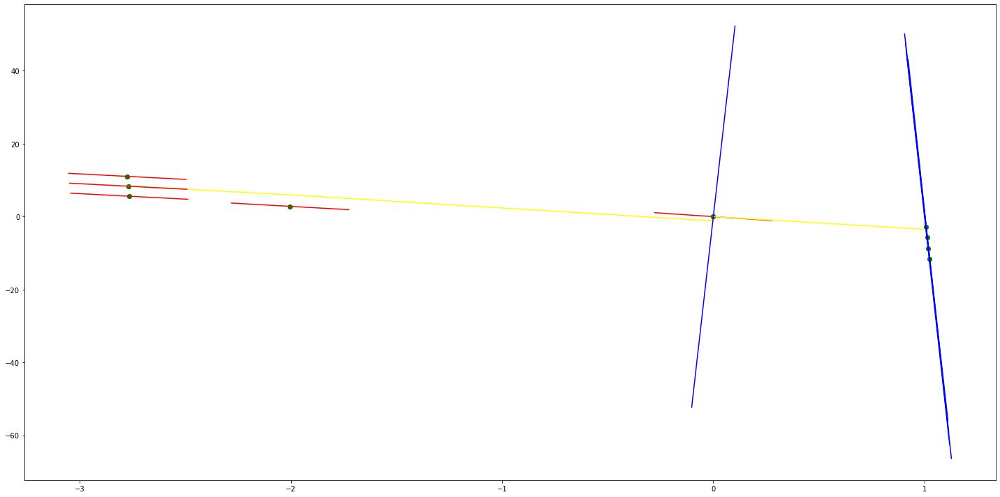

parameters (0.4133360311060938, -1.582835368020184, 1.8953817488948275)
tangent[0]:-4.70696714535443
tangent[1]:-4.076629697917637
tangent[2]:-2.419840831010024
tangent[3]:-1.5862801105034223
tangent[4]:-1.582835368020184
parameters (-1866.3057410800473, -473.2033753670072, -0.3355053481353185)
tangent[0]:-473.2033753670072
tangent[1]:-488.7571674131683
tangent[2]:-519.8610188940083
tangent[3]:-535.4148109401694
tangent[4]:-550.9648703748485


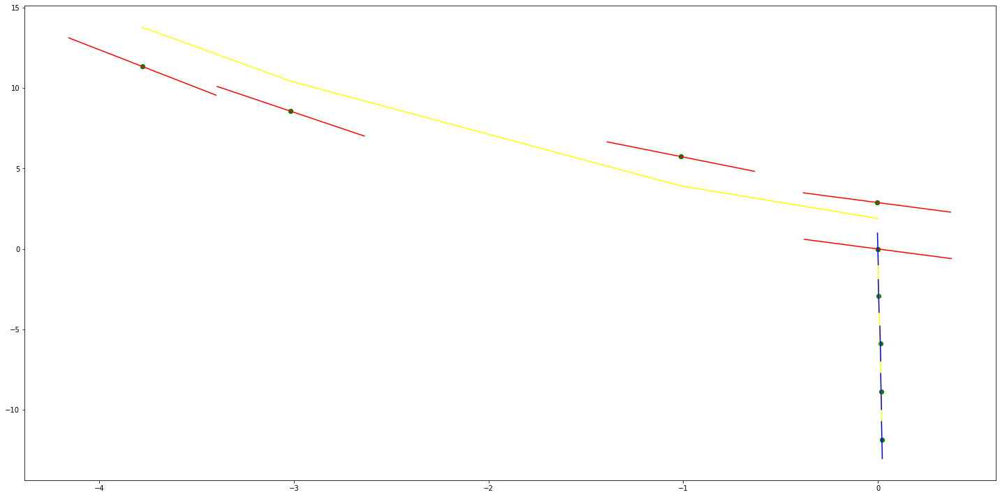

parameters (-3713.366747508199, -626.3589805151599, 0.9416890146721192)
tangent[0]:-440.69064313975
tangent[1]:-502.57761335372163
tangent[2]:-533.524811827455
tangent[3]:-564.4720103011883
tangent[4]:-626.3589805151599
parameters (-518.2160873540912, -485.06093312063973, -1.7007801370760252)
tangent[0]:-485.06093312063973
tangent[1]:-489.37974599264874
tangent[2]:-493.697522432483
tangent[3]:-510.9717374883443
tangent[4]:-519.6083268001876


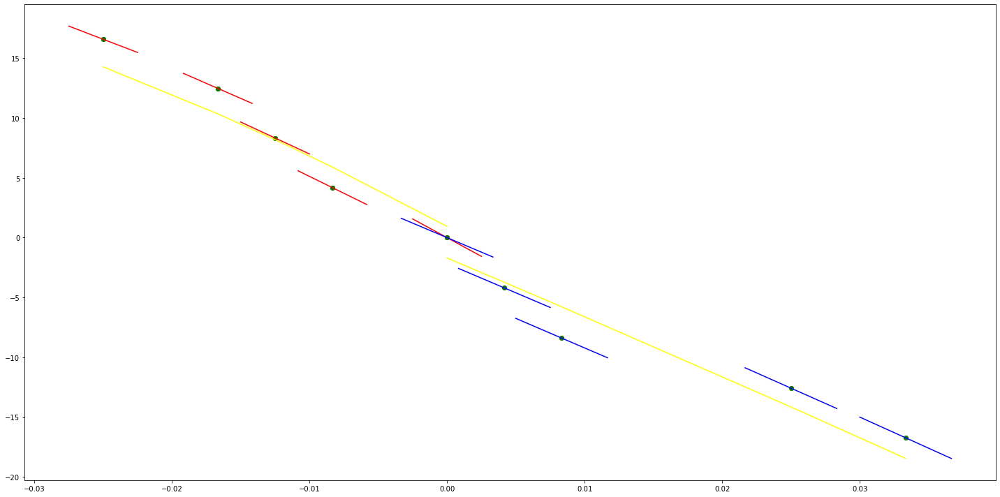

parameters (-1195.4314852443877, 479.55257539786123, -1.8684108022555832)
tangent[0]:559.2472107931636
tangent[1]:549.2868756581073
tangent[2]:509.4383625289709
tangent[3]:489.51530139588795
tangent[4]:479.55257539786123
parameters (289.73180558494994, 242.52149129241687, 2.4741044161997734)
tangent[0]:242.52149129241687
tangent[1]:244.93611616016184
tangent[2]:261.83675184354314
tangent[3]:271.49467185091186
tangent[4]:290.80993240203816


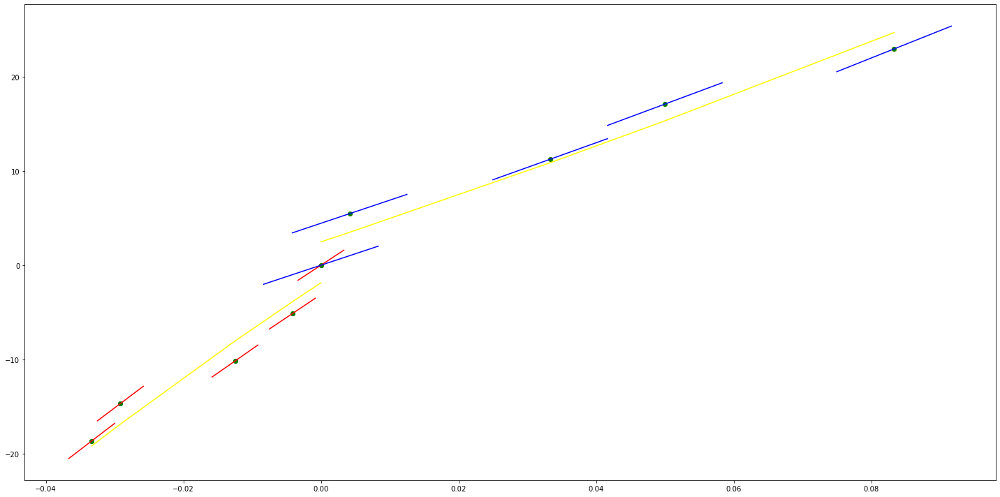

parameters (-81.38609543679252, 84.61735046754545, -0.32567273692377513)
tangent[0]:121.91936513347231
tangent[1]:115.81540797571287
tangent[2]:104.96387432674358
tangent[3]:94.11250344996516
tangent[4]:84.61735046754545
parameters (-1681.9655155122268, 1449.2142427994163, -0.004910953409142)
tangent[0]:1449.2142427994163
tangent[1]:1435.2001061241683
tangent[2]:1421.1826055178894
tangent[3]:1407.1651049116106
tangent[4]:1393.1509682363628


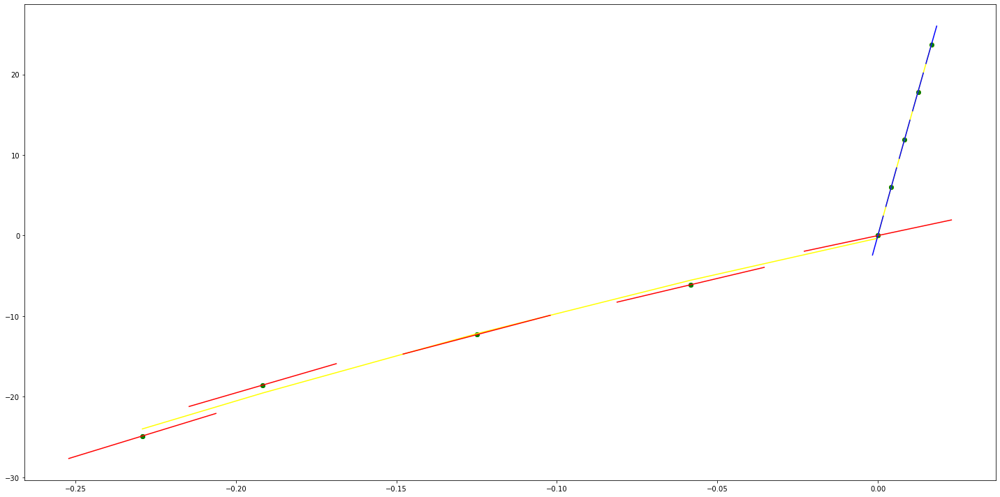

parameters (-2324.843315876277, -403.66930733648405, 0.5007544065363954)
tangent[0]:-248.68130284027617
tangent[1]:-268.05189734815735
tangent[2]:-345.5482244395771
tangent[3]:-384.29406314197115
tangent[4]:-403.66930733648405
parameters (185.6166857919855, -131.87022455651405, -1.0754256820167576)
tangent[0]:-131.87022455651405
tangent[1]:-130.32329509712363
tangent[2]:-114.8554854367059
tangent[3]:-113.30855597731549
tangent[4]:-111.7616265179251


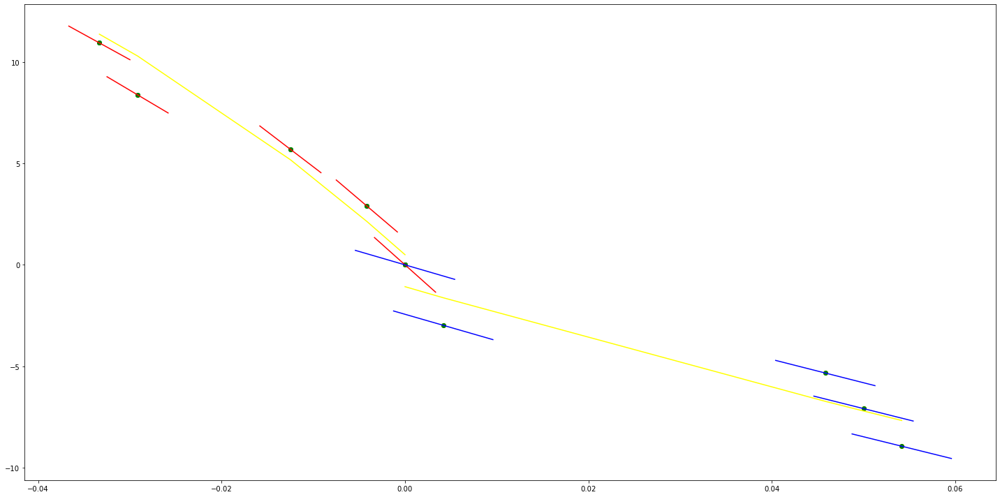

parameters (-361.3242424851313, -1.133250917130803, -0.3233878578700783)
tangent[0]:92.2090859410231
tangent[1]:89.19780970415202
tangent[2]:53.065385455638896
tangent[3]:19.944237443996848
tangent[4]:-1.133250917130803
parameters (-96.31310434069813, 70.69538427425975, 0.45124976503416897)
tangent[0]:70.69538427425975
tangent[1]:69.89271086268437
tangent[2]:69.09023007731767
tangent[3]:64.27457486028277
tangent[4]:63.47190144870739


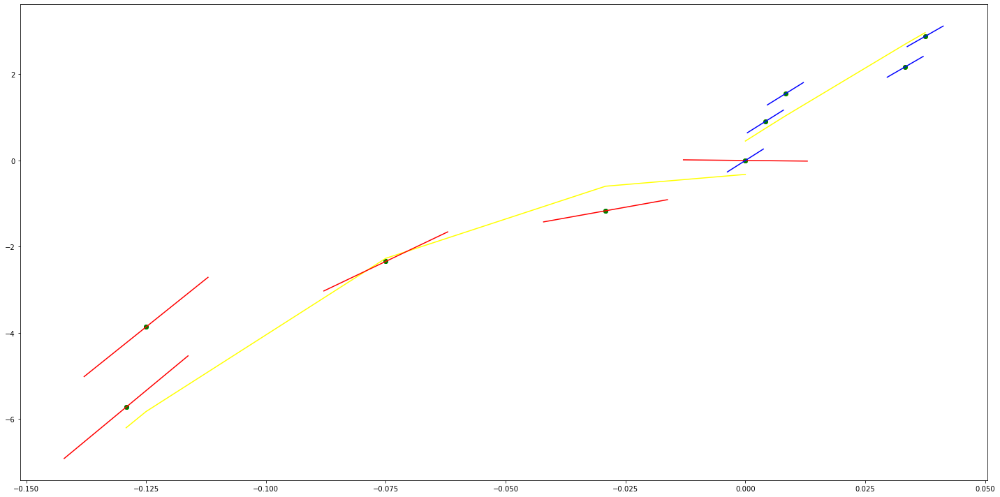

parameters (-412.82093952421945, -11.827790070860893, -0.41090439607209156)
tangent[0]:60.415874345877505
tangent[1]:56.97542463588267
tangent[2]:53.53580056776688
tangent[3]:-8.387340360866048
tangent[4]:-11.827790070860893
parameters (-297.3592948475873, 73.33244032635987, 0.28089013037781957)
tangent[0]:73.33244032635987
tangent[1]:70.85424796310008
tangent[2]:55.986283220720715
tangent[3]:53.50868557605062
tangent[4]:51.03049321279083


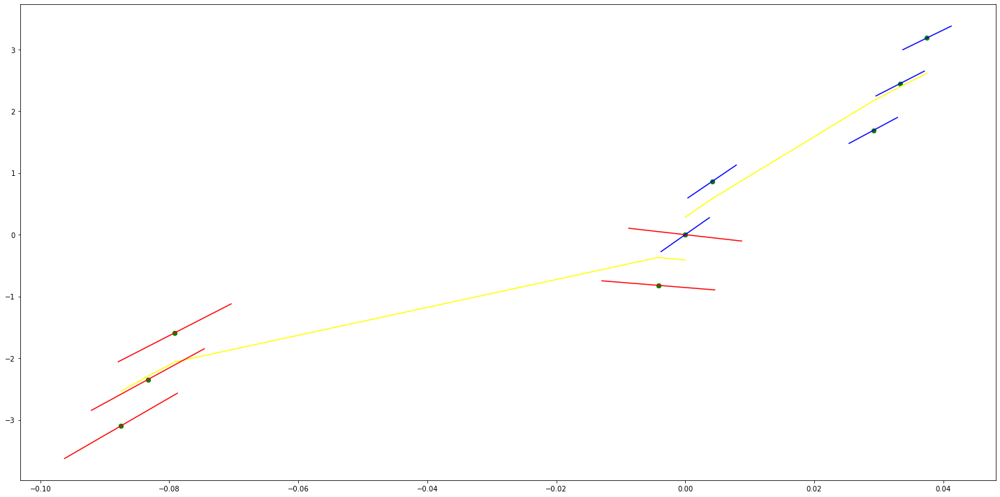

parameters (-298.09787121522646, -14.790745721728646, -0.27080072395963506)
tangent[0]:54.765622960405004
tangent[1]:52.28127530169731
tangent[2]:49.79692764298961
tangent[3]:10.050942278121036
tangent[4]:-14.790745721728646
parameters (-937.8227387793692, 146.67480570349235, 0.17939712990876955)
tangent[0]:146.67480570349235
tangent[1]:138.85899099850508
tangent[2]:131.04505193899539
tangent[3]:115.41342252902086
tangent[4]:107.59948346951116


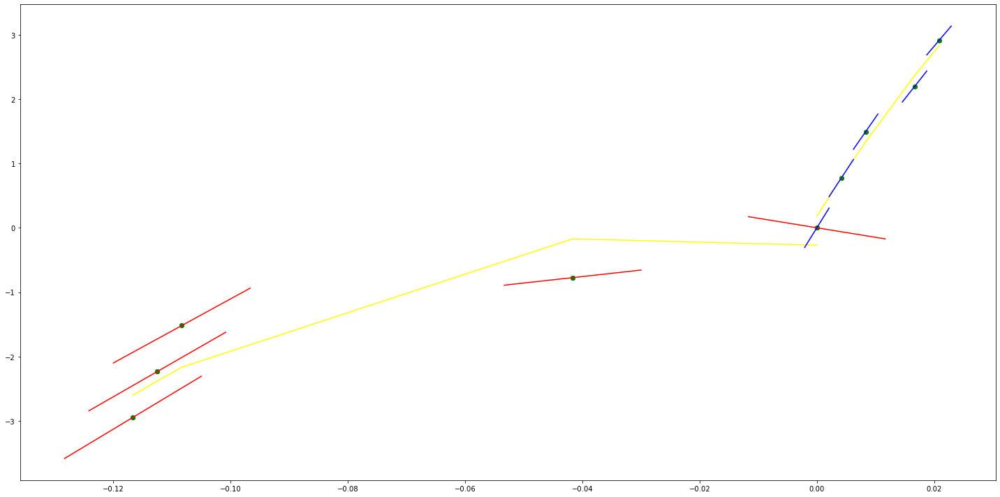

parameters (439.7640878179201, 113.32699839924328, -0.36983129682145005)
tangent[0]:80.34469181289927
tangent[1]:84.00968572077382
tangent[2]:87.67380010047273
tangent[3]:109.66200449136873
tangent[4]:113.32699839924328
parameters (-0.17405622554176653, 11.577867270060146, 0.5643762425155708)
tangent[0]:11.577867270060146
tangent[1]:11.576416685476481
tangent[2]:11.514046770065649
tangent[3]:11.473433534735086
tangent[4]:11.43137006293331


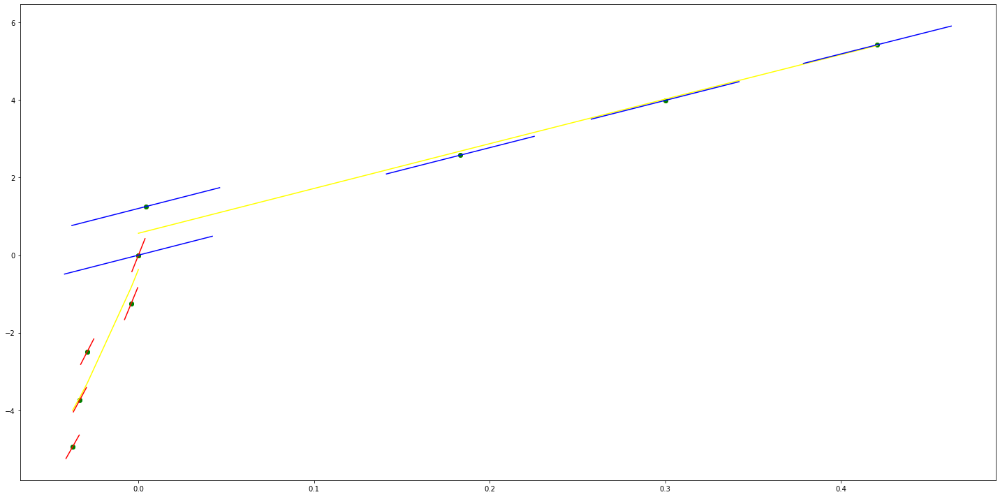

parameters (0.12447650674460954, 3.4723889993258914, -0.668595501800389)
tangent[0]:3.162235119671577
tangent[1]:3.2441819873097693
tangent[2]:3.3645094431315674
tangent[3]:3.471351612118682
tangent[4]:3.4723889993258914
parameters (-427.67472644347873, 109.90949351368495, 0.3989582603561384)
tangent[0]:109.90949351368495
tangent[1]:106.345252343505
tangent[2]:84.96151602133106
tangent[3]:81.39813020060399
tangent[4]:77.83388903042405


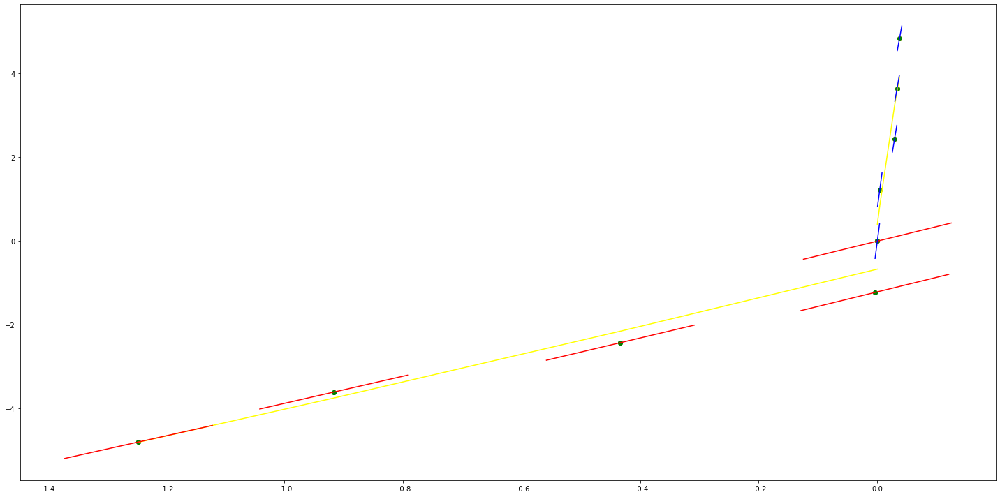

parameters (-0.07841155245098286, 2.336031408040841, 0.041498941029656164)
tangent[0]:2.6464105221003495
tangent[1]:2.5836812801395634
tangent[2]:2.504616245810454
tangent[3]:2.4288184640488724
tangent[4]:2.336031408040841
parameters (-179.2233429095515, 76.40882906670014, 1.1331465429423053)
tangent[0]:76.40882906670014
tangent[1]:74.91554017357775
tangent[2]:73.42189283376955
tangent[3]:58.48649477574499
tangent[4]:56.993205882622604


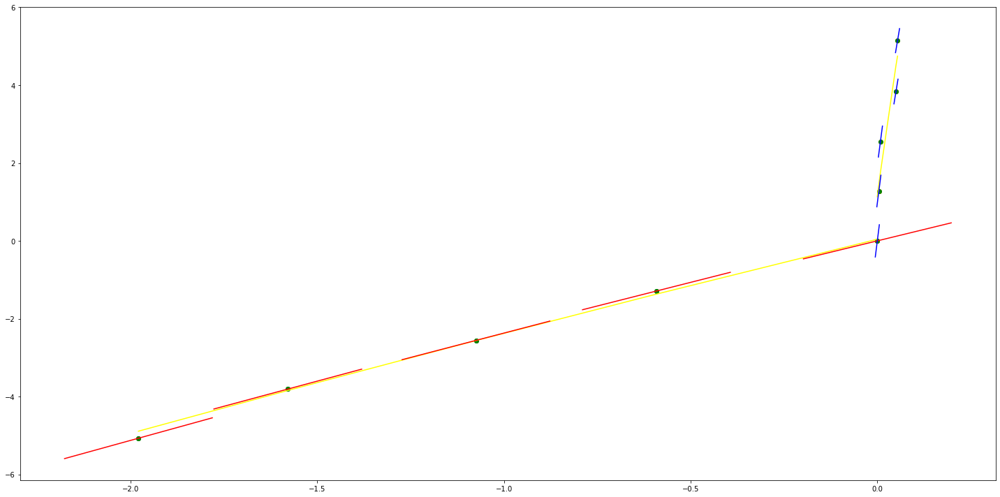

parameters (-130.04423477260963, 59.442503942772426, -0.4858111424452007)
tangent[0]:73.53071607262832
tangent[1]:72.44692742003339
tangent[2]:71.36313876743846
tangent[3]:60.52629259536735
tangent[4]:59.442503942772426
parameters (-7.224991664183542, 14.249597679666364, 1.6428209441610109)
tangent[0]:14.249597679666364
tangent[1]:14.189384599137059
tangent[2]:13.466885432718703
tangent[3]:12.864812427358961
tangent[4]:12.322938052545195


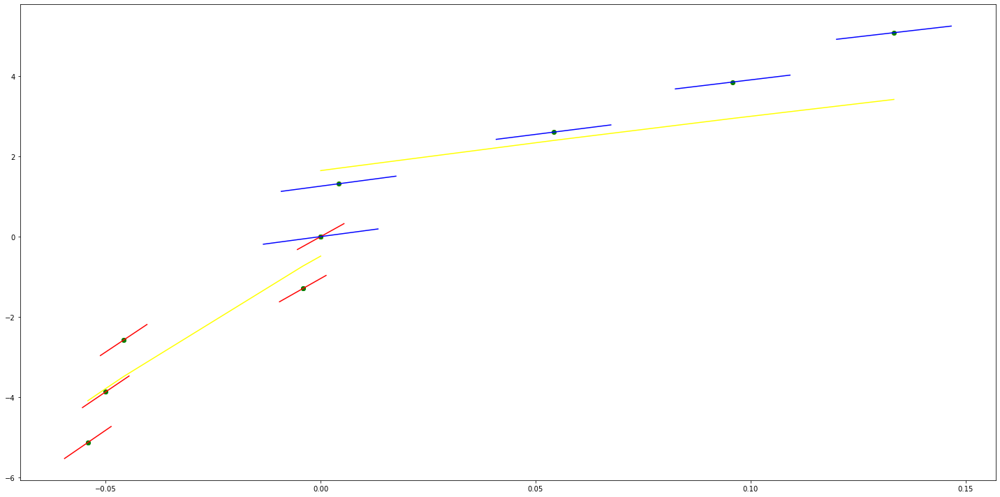

parameters (0.007432257500936117, 2.0797837320471815, -0.8041185838305475)
tangent[0]:2.048815997414786
tangent[1]:2.058477932166003
tangent[2]:2.0738379260464326
tangent[3]:2.078297280546994
tangent[4]:2.0797837320471815
parameters (-230.62525854069614, 90.00379566478605, -0.17178739097709533)
tangent[0]:90.00379566478605
tangent[1]:82.3161332965905
tangent[2]:74.62893217891201
tangent[3]:66.94126981071643
tangent[4]:59.253607442520874


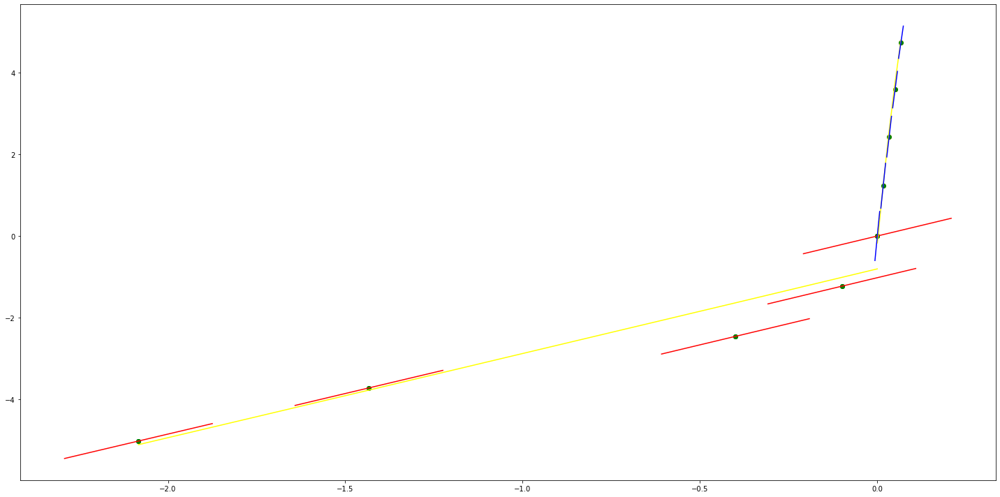

parameters (-0.007878130988654763, -0.33257584758991543, -0.08018624049070742)
tangent[0]:-0.20626315790932537
tangent[1]:-0.2378413224513419
tangent[2]:-0.2694195027496204
tangent[3]:-0.3009976830478989
tangent[4]:-0.33257584758991543
parameters (-234.58908622241194, 101.68257044499383, -0.00024627346526676384)
tangent[0]:101.68257044499383
tangent[1]:-103.58287999961662
tangent[2]:-107.49301088877179
tangent[3]:-109.44760715517693
tangent[4]:-111.4026725997545


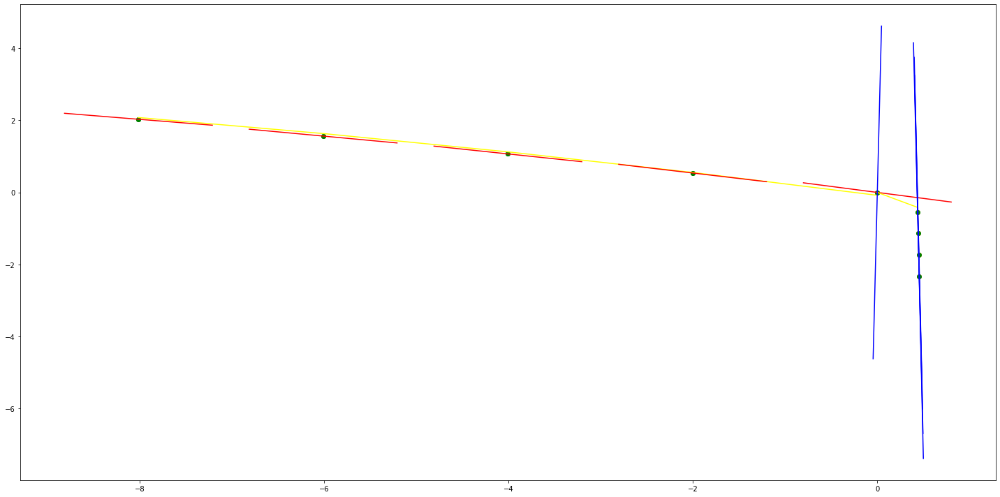

parameters (-1.9284222760937701, -5.853022548083142, 1.4492089866558668)
tangent[0]:-5.772672905527418
tangent[1]:-5.788740519931832
tangent[2]:-5.804811991180798
tangent[3]:-5.836951076834176
tangent[4]:-5.853022548083142
parameters (145.49776627486213, -57.55292772770401, -0.23576504212530483)
tangent[0]:-57.55292772770401
tangent[1]:-56.34034934356931
tangent[2]:-51.490617798095606
tangent[3]:-46.64059525708935
tangent[4]:-41.7905727160831


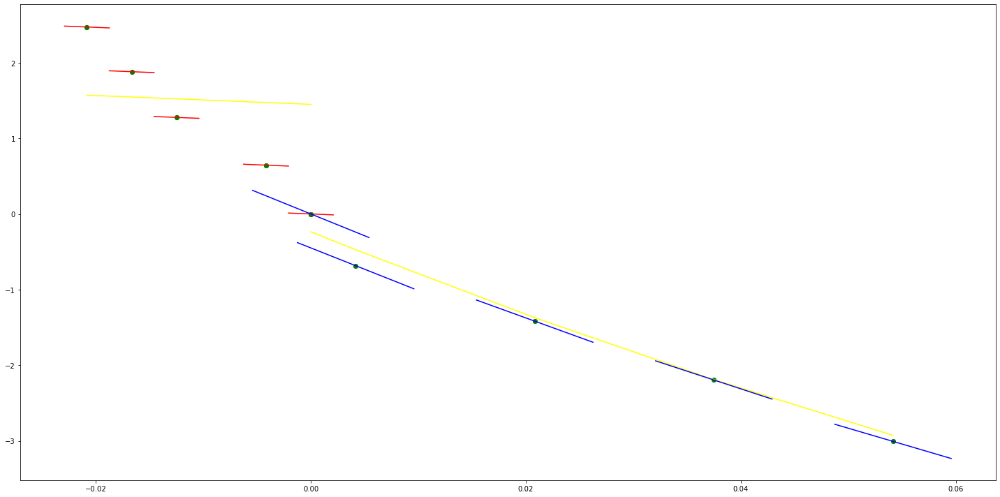

parameters (0.00314188643851829, -0.5760894476150724, 0.04721111615596258)
tangent[0]:-0.6264643622739066
tangent[1]:-0.6138706320382549
tangent[2]:-0.6012769080863759
tangent[3]:-0.5886831778507242
tangent[4]:-0.5760894476150724
parameters (18.09549317472359, -40.96124785296595, -0.3450302223626627)
tangent[0]:-40.96124785296595
tangent[1]:-40.207281034347915
tangent[2]:-39.45331421572988
tangent[3]:-37.64376489825752
tangent[4]:-36.588182399403195


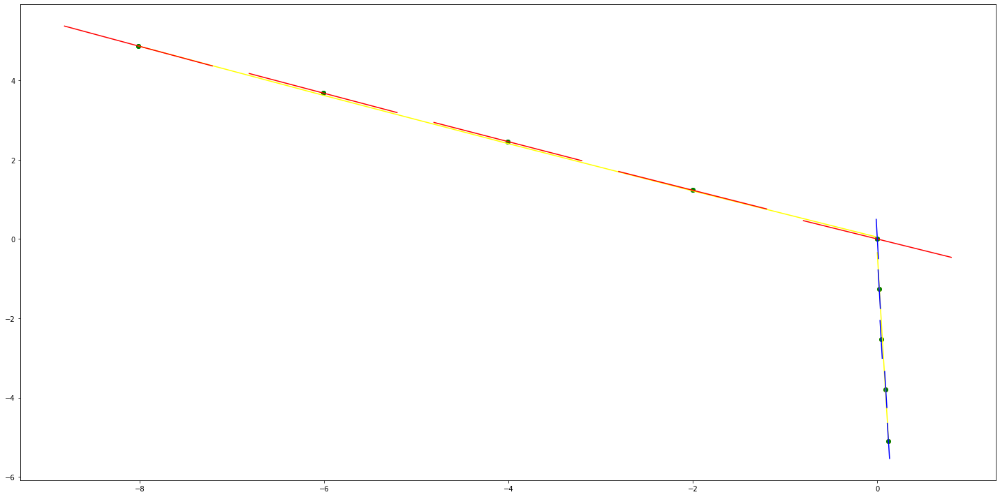

parameters (0.09059285714298386, -38.58383988095236, 0.0006267083333341959)
tangent[0]:-38.62007702380956
tangent[1]:-38.611017738095256
tangent[2]:-38.601958452380956
tangent[3]:-38.59289916666666
tangent[4]:-38.58383988095236
parameters (-814.7431479057063, -315.7820331091563, -0.21654512951500174)
tangent[0]:-315.7820331091563
tangent[1]:-322.5704730175067
tangent[2]:-336.15061180679896
tangent[3]:-342.93905171514933
tangent[4]:-349.72912110979547


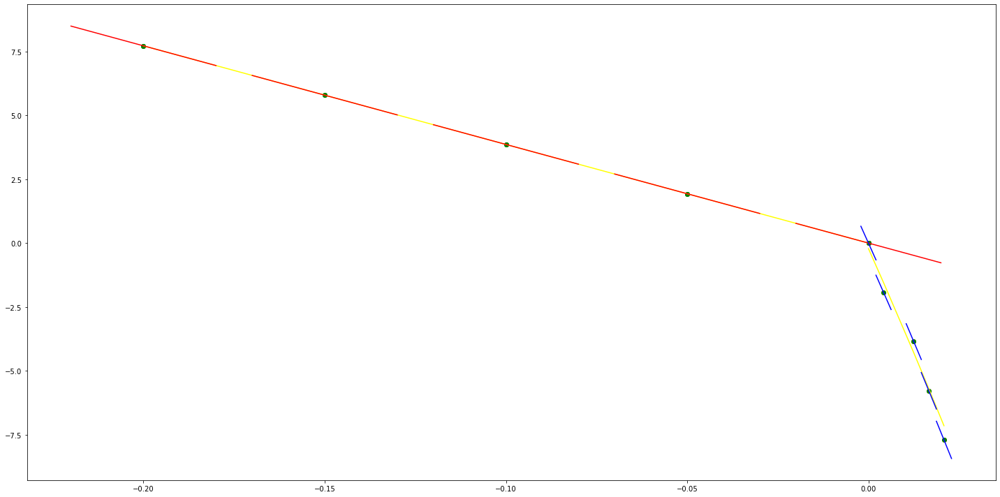

parameters (-1689.8435821895669, 17.333919334133245, -0.9408022632054639)
tangent[0]:327.1397026312753
tangent[1]:270.8104566625683
tangent[2]:172.23850082628647
tangent[3]:101.82609844361158
tangent[4]:17.333919334133245
parameters (-2774.142708576475, 481.75762917746636, 2.513735403325488)
tangent[0]:481.75762917746636
tangent[1]:458.6434721296072
tangent[2]:435.52376679633085
tangent[3]:389.2899044151953
tangent[4]:366.17019908191895


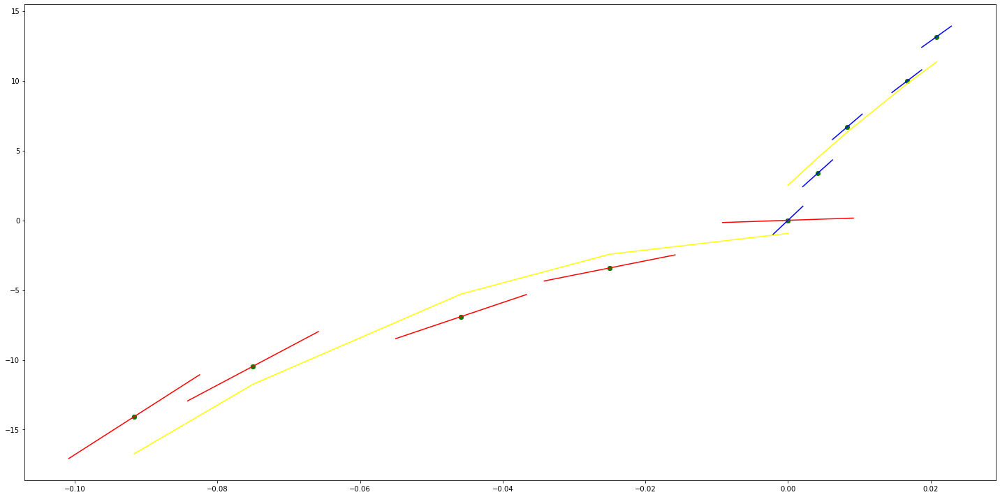

parameters (-492.71979037920266, -67.99051684774955, 0.01420609995608202)
tangent[0]:-51.56619535524921
tangent[1]:-55.67252208826948
tangent[2]:-59.777863381709
tangent[3]:-63.88419011472927
tangent[4]:-67.99051684774955
parameters (-30.001212220781923, 14.035936715677941, -0.20445634693828282)
tangent[0]:14.035936715677941
tangent[1]:13.785966615454386
tangent[2]:-16.465275707975536
tangent[3]:-17.465336116143078
tangent[4]:-17.715306216366635


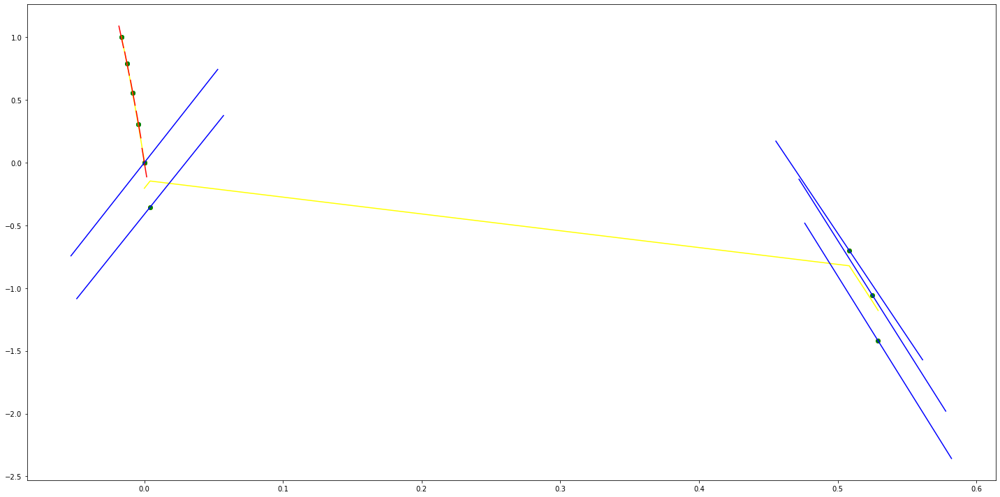

parameters (-0.0035974896844684417, -0.21829016066609136, 0.029449020934718757)
tangent[0]:-0.16678609522013194
tangent[1]:-0.18120603543703606
tangent[2]:-0.1956259756539402
tangent[3]:-0.21004590867586492
tangent[4]:-0.21829016066609136
parameters (500.9309130757004, -55.72070901886582, -0.0416046545633782)
tangent[0]:-55.72070901886582
tangent[1]:-51.546952651119085
tangent[2]:-47.3721944215462
tangent[3]:-39.023679824226576
tangent[4]:-34.84892159465369


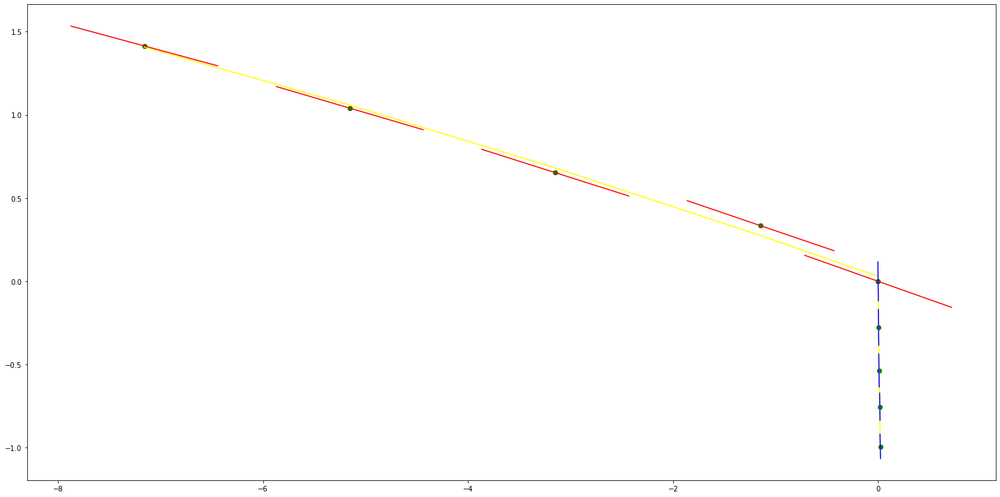

parameters (42.89902223651921, 36.75077009968199, -0.1600440316672713)
tangent[0]:31.030957666842415
tangent[1]:31.38839232011709
tangent[2]:32.818388327349226
tangent[3]:36.39333544640731
tangent[4]:36.75077009968199
parameters (-448.2173890422399, 101.00236744864172, -0.05348109200942484)
tangent[0]:101.00236744864172
tangent[1]:97.2669237283637
tangent[2]:82.32604528202967
tangent[3]:74.8560542762517
tangent[4]:71.12061055597367


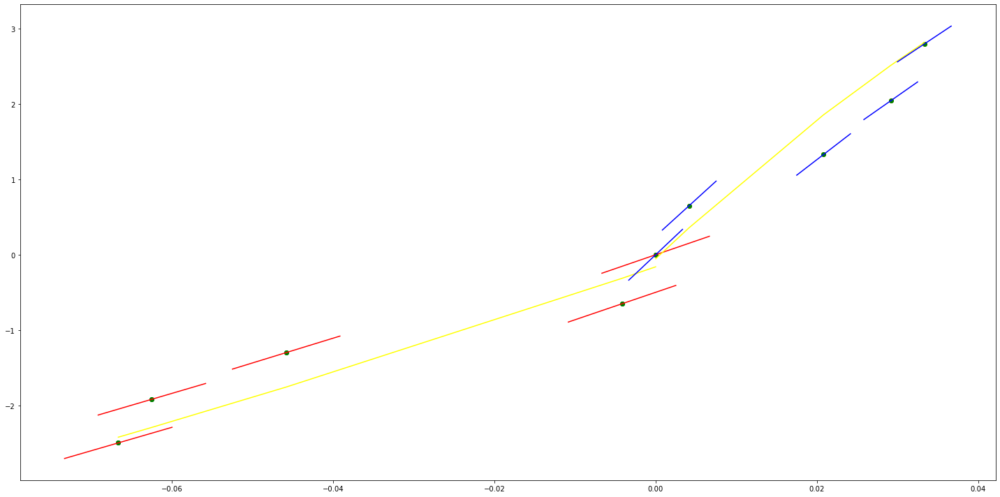

parameters (-1526.1471023963854, 89.53726764956217, 0.17114535884468743)
tangent[0]:191.27939037791958
tangent[1]:178.5635327207529
tangent[2]:153.12571281800996
tangent[3]:140.40985516084328
tangent[4]:89.53726764956217
parameters (-0.06432221414562964, 2.1350438700706564, 0.4406692128374794)
tangent[0]:2.1350438700706564
tangent[1]:2.134507808737967
tangent[2]:1.8766830194671869
tangent[3]:1.820401082089761
tangent[4]:1.8198650207570712


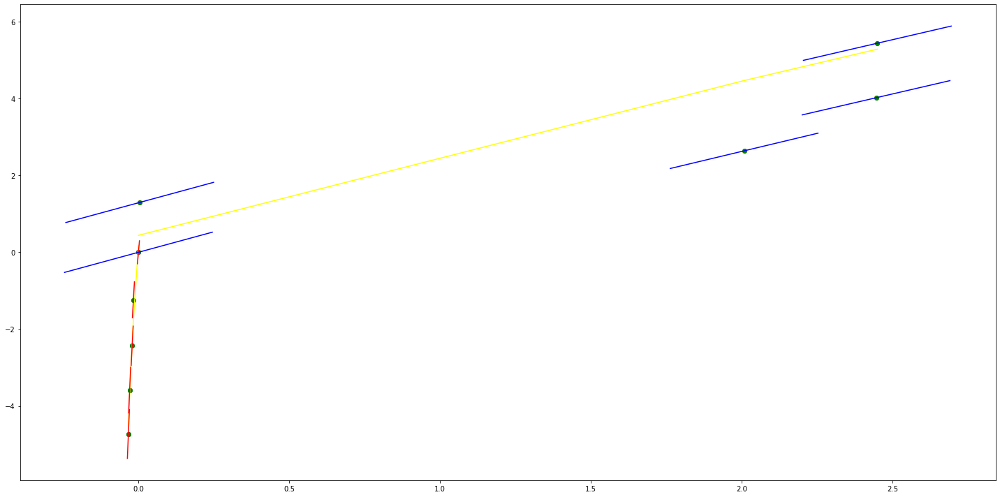

parameters (-0.06523341913355762, 0.32574910257631656, -0.27668206154152775)
tangent[0]:1.3705709888765185
tangent[1]:1.1090936570272287
tangent[2]:0.8487036358080575
tangent[3]:0.587226303958768
tangent[4]:0.32574910257631656
parameters (150.17102822508448, -231.21675491310168, -0.0003455083420554703)
tangent[0]:-231.21675491310168
tangent[1]:234.31343258466023
tangent[2]:235.56495793388808
tangent[3]:236.81648328311599
tangent[4]:239.31923363951518


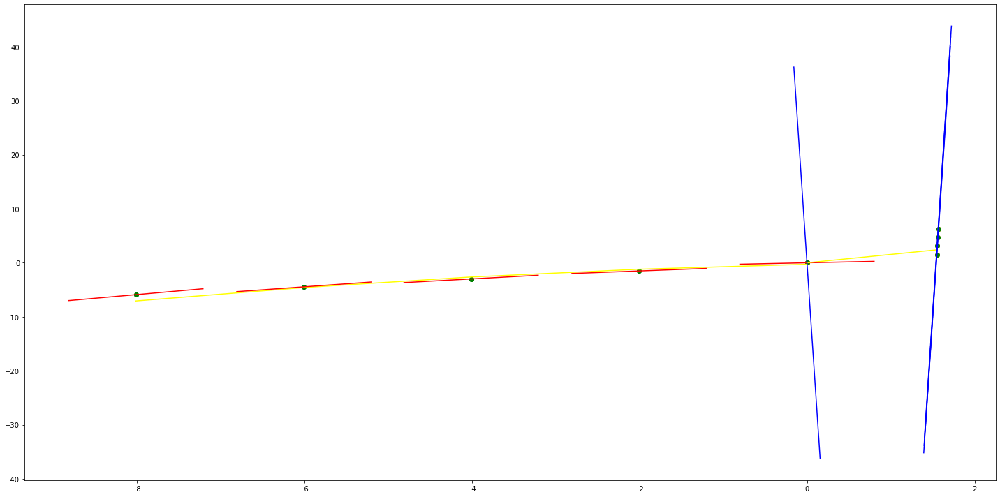

parameters (261.2761652210862, 114.06501142778808, -1.6815630384648277)
tangent[0]:72.6961110836726
tangent[1]:105.3556317363084
tangent[2]:107.53310729726093
tangent[3]:109.71006030588302
tangent[4]:114.06501142778808
parameters (-473.6567849613155, 215.252636337846, 0.33818050410328243)
tangent[0]:215.252636337846
tangent[1]:211.30612800554835
tangent[2]:195.51725273564784
tangent[3]:183.67583311161496
tangent[4]:179.72837746574734


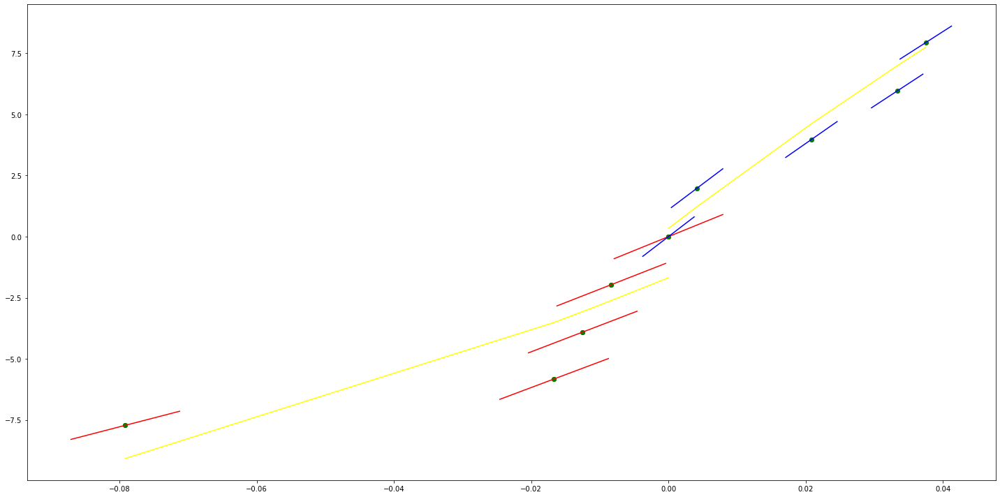

parameters (-585.3493275981265, 101.95257074583994, 0.5441203291188171)
tangent[0]:170.24293539940297
tangent[1]:160.48750350565257
tangent[2]:155.6092022094498
tangent[3]:150.730900913247
tangent[4]:101.95257074583994
parameters (-38.288550963590374, 45.55592031284929, 2.453428775794981)
tangent[0]:45.55592031284929
tangent[1]:45.23682352911872
tangent[2]:44.917726745388165
tangent[3]:38.855423894220976
tangent[4]:37.57911333640065


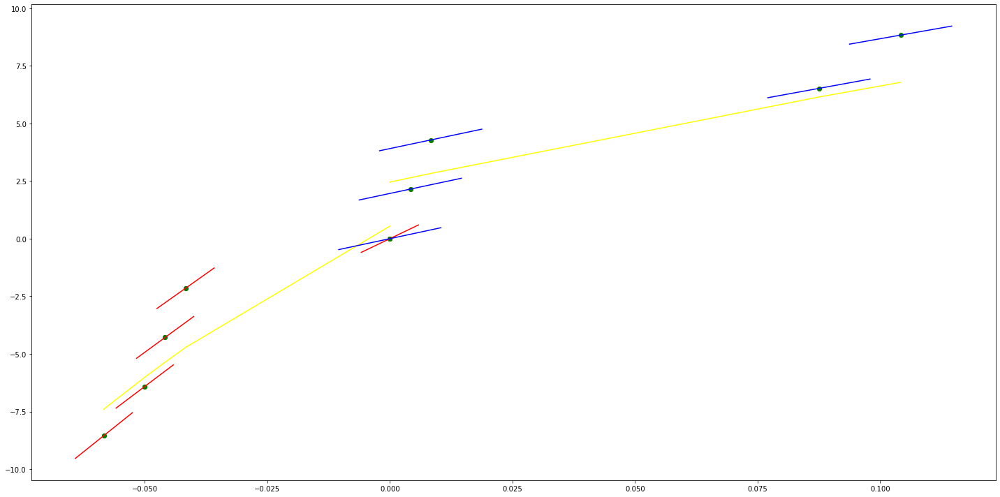

parameters (-0.1988196464037222, -4.149261779819226, -0.11871982771528256)
tangent[0]:-3.1998979682414523
tangent[1]:-3.271141807415884
tangent[2]:-3.693633556023794
tangent[3]:-3.7019175754108513
tangent[4]:-4.149261779819226
parameters (-426.4790985335543, 473.3080348836605, -3.2897528569507464)
tangent[0]:473.3080348836605
tangent[1]:466.2003342275003
tangent[2]:-479.16223616067646
tangent[3]:-482.715660009658
tangent[4]:-486.26993681683666


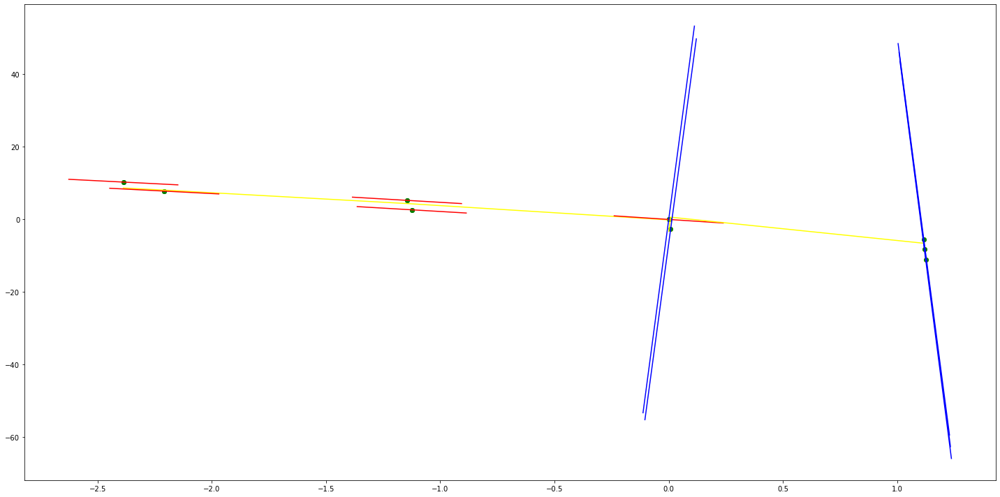

parameters (1390.4429358665923, -627.2342243005971, 0.43744309994064)
tangent[0]:-685.1684196664146
tangent[1]:-673.5832491247742
tangent[2]:-661.9952976972619
tangent[3]:-638.8221757281093
tangent[4]:-627.2342243005971
parameters (747.2883397344918, -321.7762337941909, -1.1916943015857346)
tangent[0]:-321.7762337941909
tangent[1]:-315.5483327708436
tangent[2]:-290.63971783081354
tangent[3]:-265.729608314104
tangent[4]:-240.81949879739443


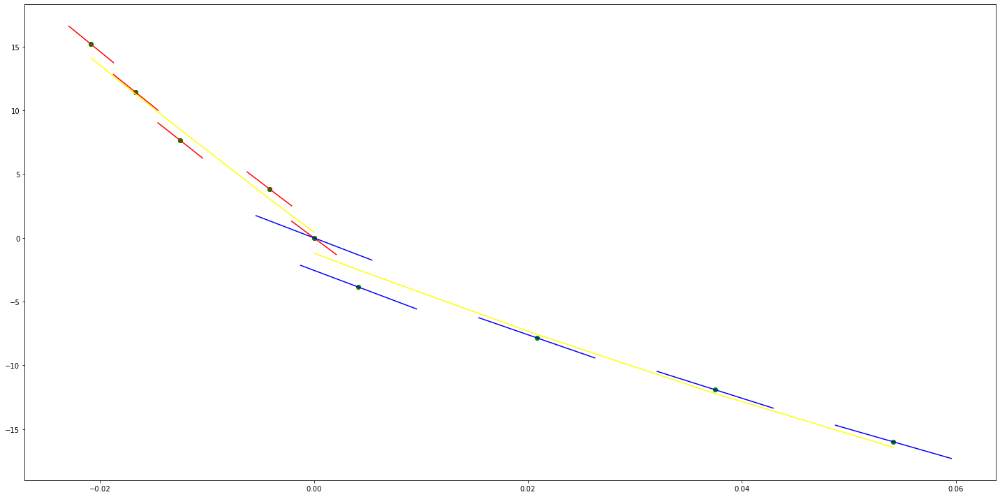

parameters (150.94767907363433, -153.9613664409666, 0.33156212395678264)
tangent[0]:-182.8929042982938
tangent[1]:-176.60351830201176
tangent[2]:-167.79813639093035
tangent[3]:-161.5087503946483
tangent[4]:-153.9613664409666
parameters (543.0517229309374, -255.0163972906777, -3.787048230361053)
tangent[0]:-255.0163972906777
tangent[1]:-250.49060423177127
tangent[2]:-245.9658972763107
tangent[3]:-227.86381114413084
tangent[4]:-178.08443190994353


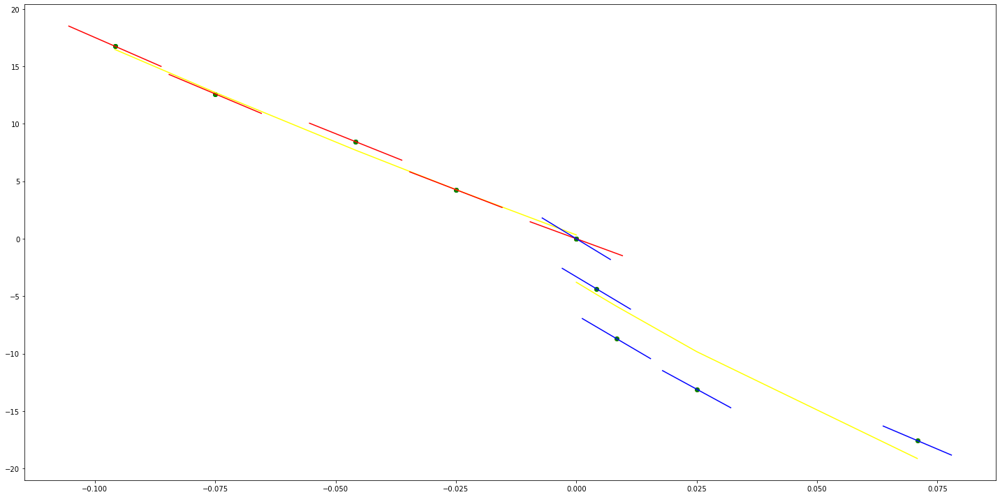

parameters (21.71087213340539, -61.76516000435238, 0.9334383423117405)
tangent[0]:-68.0974832360142
tangent[1]:-66.4691678260088
tangent[2]:-64.47901902102805
tangent[3]:-62.126993399327716
tangent[4]:-61.76516000435238
parameters (3079.050924311337, -403.8293595921521, -0.9207361768034313)
tangent[0]:-403.8293595921521
tangent[1]:-378.1685491889414
tangent[2]:-352.5138968875794
tangent[3]:-301.192276081158
tangent[4]:-275.5376237797959


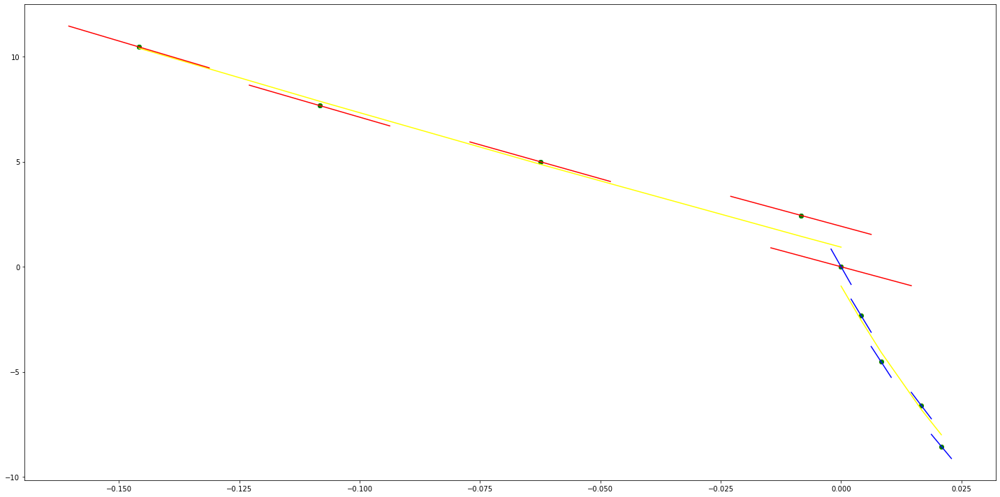

parameters (-517.4170737747656, 540.6620623845806, -0.3575737302638944)
tangent[0]:562.22076218048
tangent[1]:557.9086082876411
tangent[2]:553.5974892289497
tangent[3]:544.973181443272
tangent[4]:540.6620623845806
parameters (-246.68384796962656, 150.68690088274653, 2.1105820239404145)
tangent[0]:150.68690088274653
tangent[1]:148.63103769376767
tangent[2]:140.40807830554812
tangent[3]:123.962652896805
tangent[4]:107.51722748806188


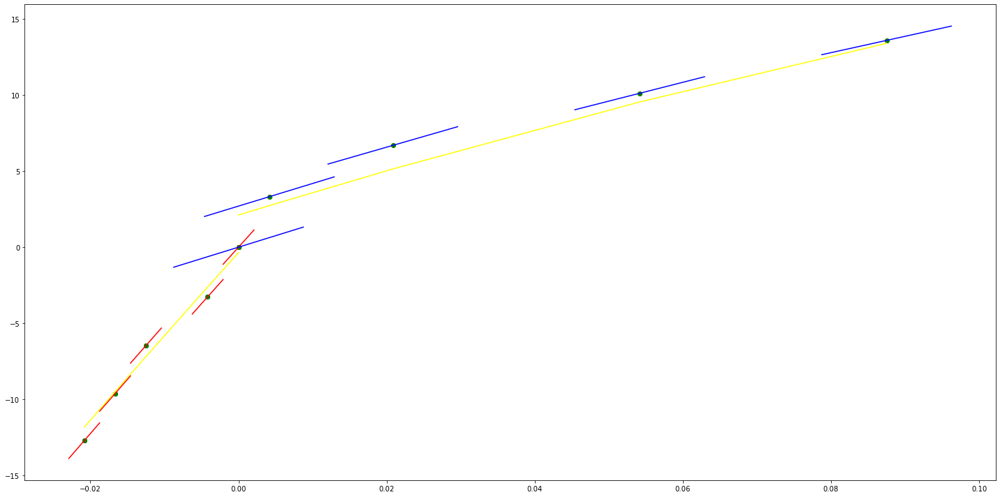

parameters (-18.115312092274696, 37.38630495313909, -0.5809752550511955)
tangent[0]:50.97278902234511
tangent[1]:47.50069961486719
tangent[2]:44.33051999871912
tangent[3]:40.25457477795731
tangent[4]:37.38630495313909
parameters (-7494.625790779012, 931.228238016284, 0.4679521898290561)
tangent[0]:931.228238016284
tangent[1]:868.7830159275132
tangent[2]:806.3228045871609
tangent[3]:681.4173711580379
tangent[4]:618.9571598176856


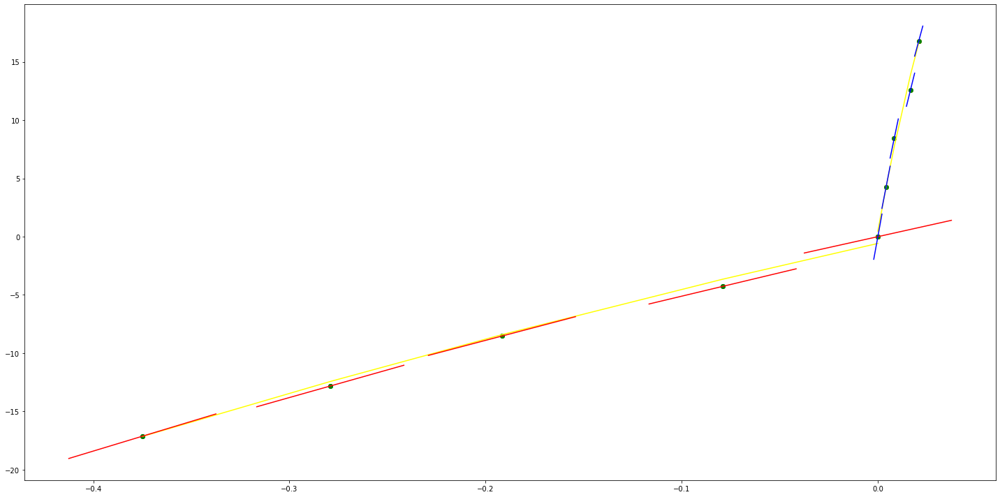

parameters (-3.600886916128682, 5.002882553756852, 0.025634276370416327)
tangent[0]:13.855058088057309
tangent[1]:11.934589867304565
tangent[2]:9.894082480315756
tangent[3]:8.123648813810433
tangent[4]:5.002882553756852
parameters (727.3667592873383, -239.79044002489684, 3.3900386625807752)
tangent[0]:-239.79044002489684
tangent[1]:-209.48252189891204
tangent[2]:263.3058716378578
tangent[3]:269.3662914762399
tangent[4]:275.4281660481406


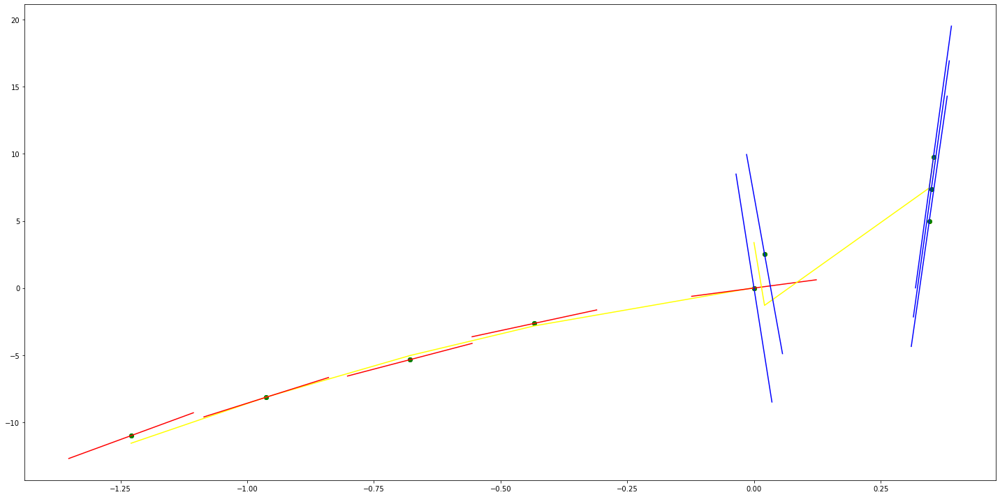

parameters (-713.334591681579, -54.50014659395712, 0.025314509306626695)
tangent[0]:106.00013653439817
tangent[1]:94.11027556024959
tangent[2]:88.16677174235869
tangent[3]:82.2218412552844
tangent[4]:-54.50014659395712
parameters (-0.45869820784742543, 3.2711076400902597, 0.8071333010096485)
tangent[0]:3.2711076400902597
tangent[1]:3.2519946031656732
tangent[2]:3.209947573245131
tangent[3]:2.747426574533505
tangent[4]:2.579237537454921


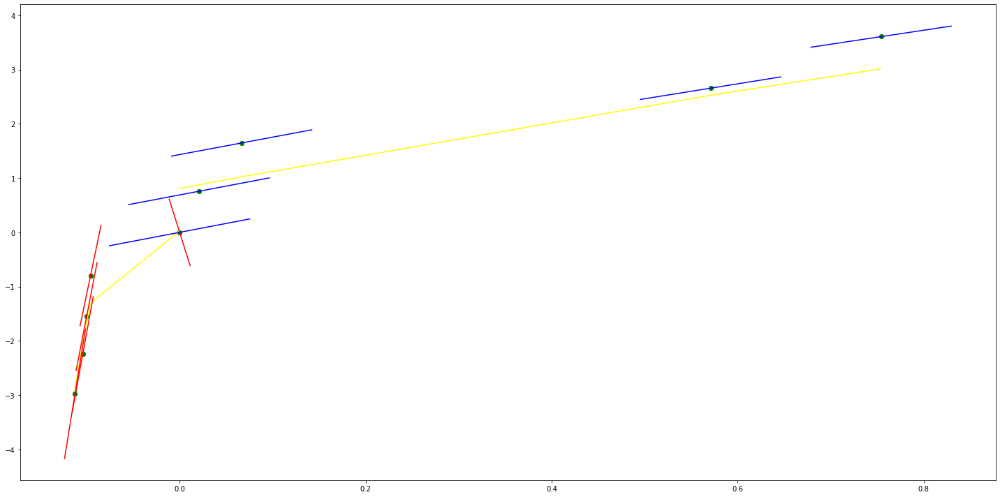

parameters (-0.004140113695851665, -1.3566221719761389, 0.007508044475014973)
tangent[0]:-1.2902423462925747
tangent[1]:-1.3068373047835227
tangent[2]:-1.3234322632744704
tangent[3]:-1.340027213485191
tangent[4]:-1.3566221719761389
parameters (-754.8187299122484, 501.2961771381035, 0.00044214481594922317)
tangent[0]:501.2961771381035
tangent[1]:-511.41844894834315
tangent[2]:-517.709108243432
tangent[3]:-523.9997675385205
tangent[4]:-536.579576491238


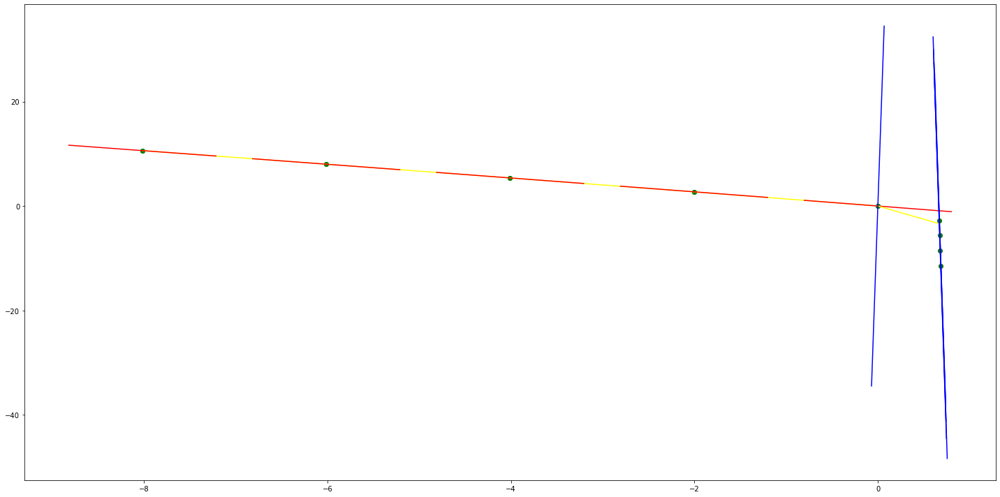

parameters (1984.4399633855883, -246.53923886566523, 1.923295539855181)
tangent[0]:-428.44888142929534
tangent[1]:-362.2995596898001
tangent[2]:-296.1502379503049
tangent[3]:-263.0775615205207
tangent[4]:-246.53923886566523
parameters (-336.4944350105181, -166.11471327890922, -1.3261649823584414)
tangent[0]:-166.11471327890922
tangent[1]:-168.91838491141687
tangent[2]:-191.35179590469806
tangent[3]:-202.56782841246866
tangent[4]:-213.78453390910926


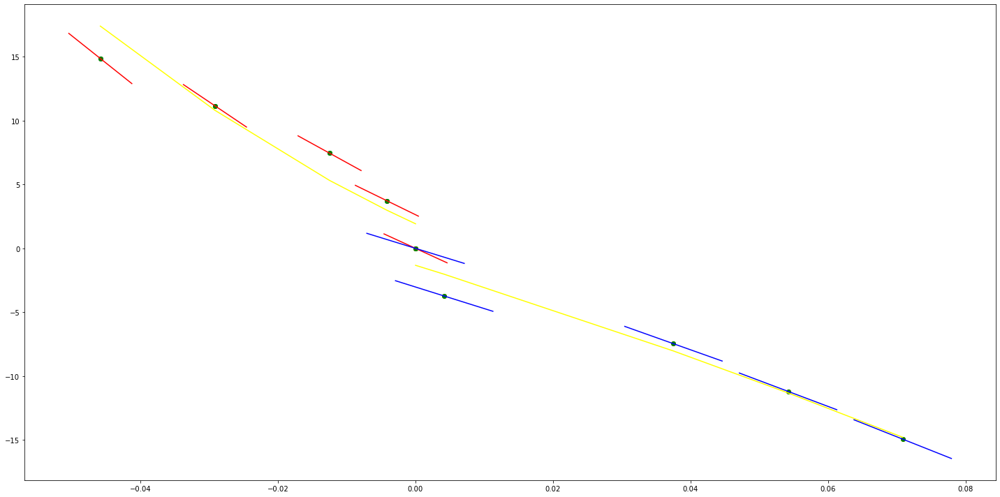

parameters (-1670.399031926915, 124.24689595127357, -0.09921729617932078)
tangent[0]:319.1290102081229
tangent[1]:235.60905861177716
tangent[2]:221.68795307969822
tangent[3]:207.76684754761934
tangent[4]:124.24689595127357
parameters (-1429.100135751532, 314.75584463128905, 1.3475577599963267)
tangent[0]:314.75584463128905
tangent[1]:302.8485823002073
tangent[2]:290.93846176885404
tangent[3]:219.48345498127742
tangent[4]:207.57333444992418


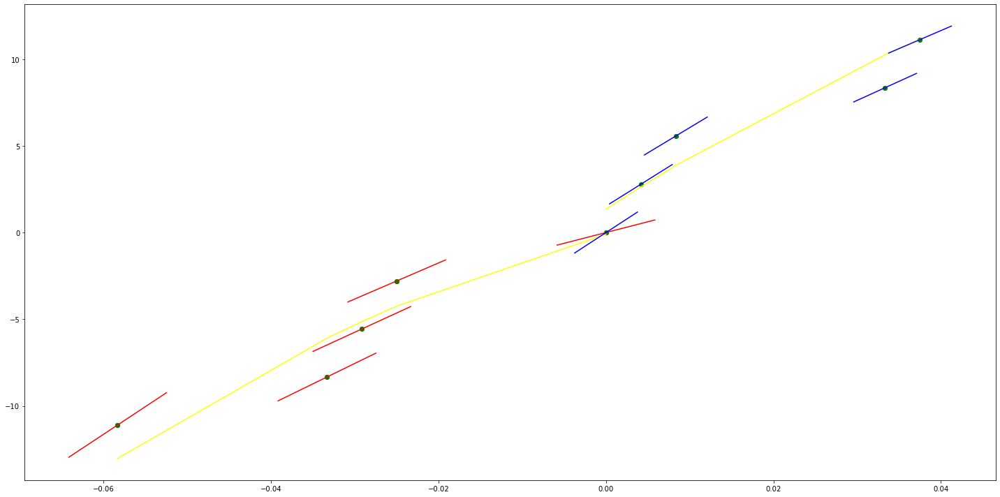

parameters (-625.7872234539329, 38.80392602129769, -1.6833723801809395)
tangent[0]:174.3907405781675
tangent[1]:132.67200953938763
tangent[2]:75.30734633981251
tangent[3]:49.23329588738094
tangent[4]:38.80392602129769
parameters (664.0523959413139, 99.92860364510706, 2.310064107467625)
tangent[0]:99.92860364510706
tangent[1]:105.46281631288197
tangent[2]:110.99702898065688
tangent[3]:155.2667460084805
tangent[4]:194.0035784733211


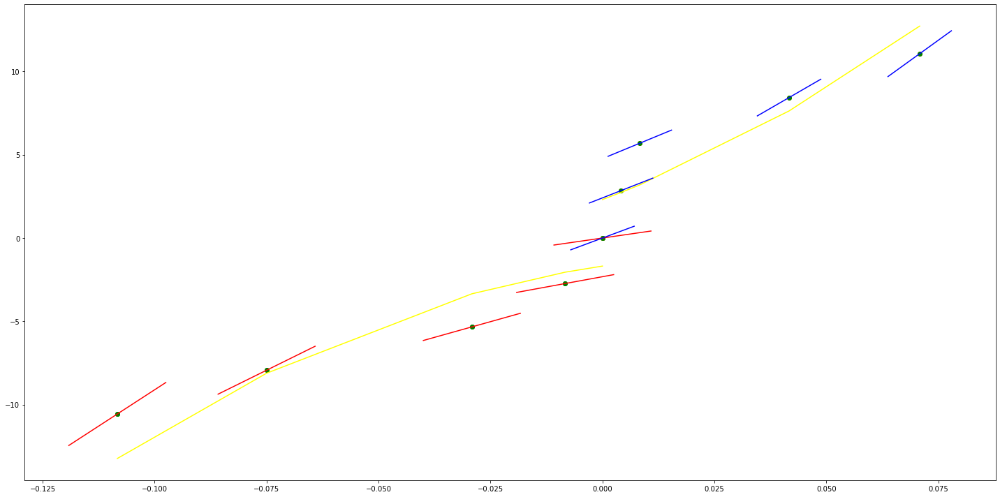

parameters (-423.8075400069692, 116.40315607450937, 0.3383118893342859)
tangent[0]:172.9111106137986
tangent[1]:169.3790985753805
tangent[2]:165.84708653696242
tangent[3]:137.59353307485782
tangent[4]:116.40315607450937
parameters (-98.45870329710634, 157.91777810985607, 1.7344688188069521)
tangent[0]:157.91777810985607
tangent[1]:157.09722327657798
tangent[2]:156.2768653607065
tangent[3]:146.43099503099586
tangent[4]:144.7898853644397


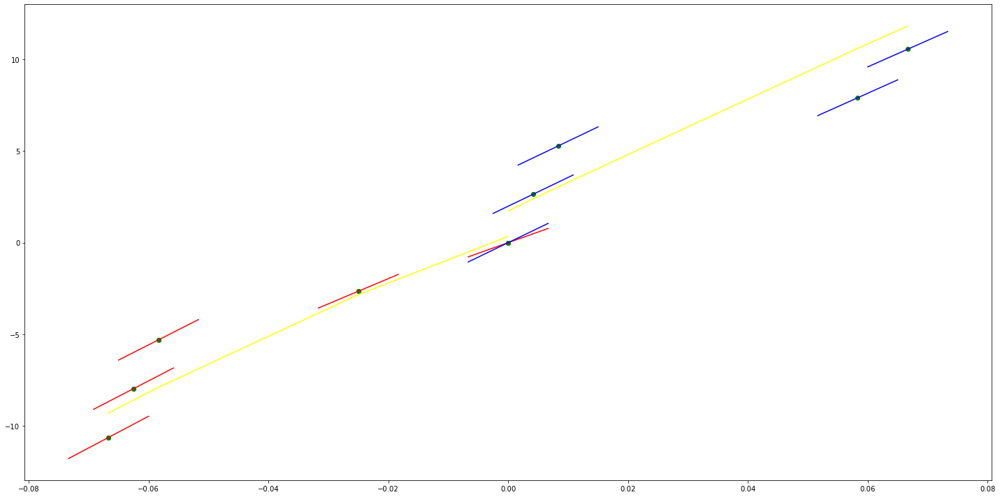

parameters (-72.60303837191186, 31.502605318777746, -0.9100887419022365)
tangent[0]:59.33381843003621
tangent[1]:52.07351459284502
tangent[2]:40.57798511526673
tangent[3]:35.13275723737334
tangent[4]:31.502605318777746
parameters (-99.66209337163838, 71.68578659221457, 1.8410587383877506)
tangent[0]:71.68578659221457
tangent[1]:70.85540203024208
tangent[2]:70.02481814408284
tangent[3]:57.567056472628046
tangent[4]:50.922983355914404


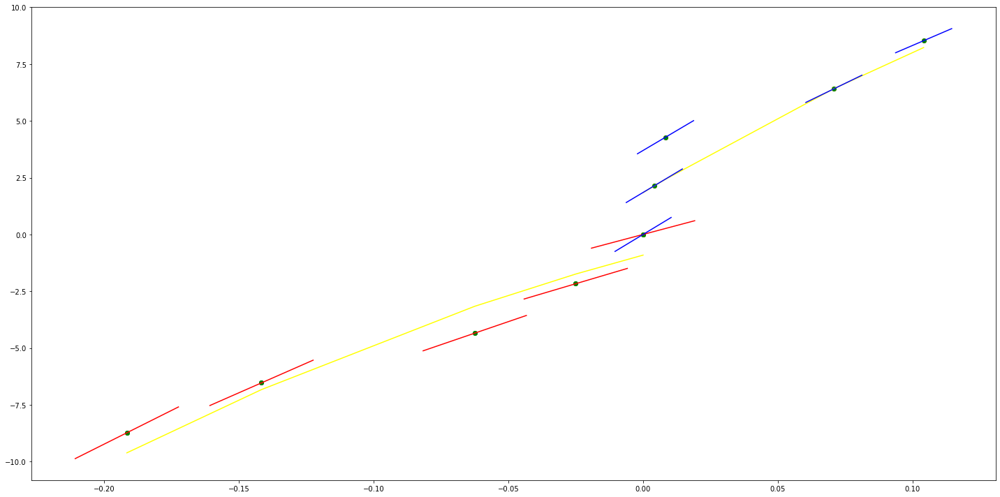

parameters (-365.3298654769104, -17.187760544905895, -0.21363916320066123)
tangent[0]:95.4558581970518
tangent[1]:92.41119909816722
tangent[2]:89.3672706590136
tangent[3]:40.656378375515246
tangent[4]:-17.187760544905895
parameters (-11.847546634531502, 34.13943194582373, 0.8530869559742202)
tangent[0]:34.13943194582373
tangent[1]:34.040718187264815
tangent[2]:31.375020194495225
tangent[3]:31.27628274084304
tangent[4]:28.21565862855798


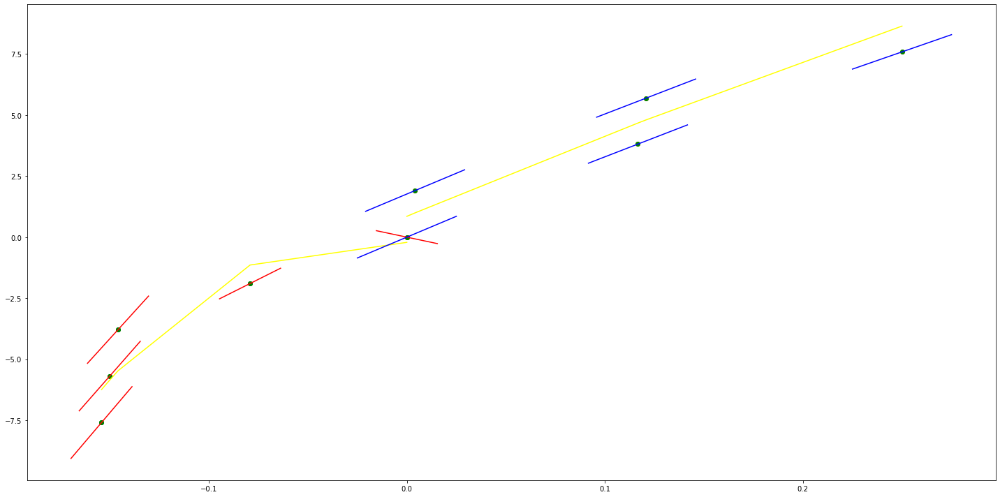

parameters (-10.216538578349558, -89.51915683455249, 0.4673248053266705)
tangent[0]:-88.58262717615234
tangent[1]:-88.92318527312305
tangent[2]:-89.26374337009375
tangent[3]:-89.43401220204052
tangent[4]:-89.51915683455249
parameters (1.3041157757314235, -6.252854095915147, -1.7573566735762487)
tangent[0]:-6.252854095915147
tangent[1]:-6.241988203271752
tangent[2]:-6.165913913610236
tangent[3]:-5.81815057615904
tangent[4]:-5.589930315406042


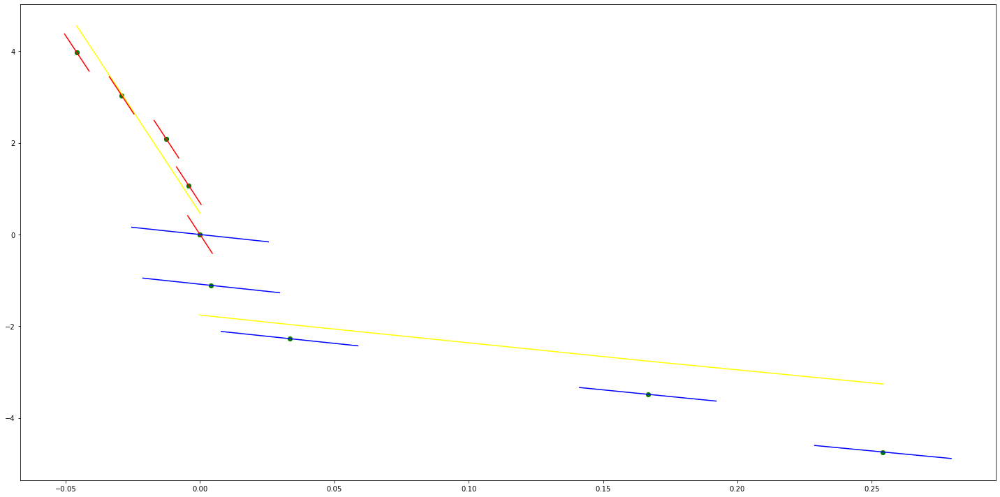

parameters (-0.003179683111554646, -1.0012757639311087, 0.0012007824076941578)
tangent[0]:-0.9506128172599155
tangent[1]:-0.9633580428258196
tangent[2]:-0.9761032747510898
tangent[3]:-0.9888485066763602
tangent[4]:-1.0012757639311087
parameters (-86.45436417139182, 69.7628371212016, -0.0042854071992228055)
tangent[0]:69.7628371212016
tangent[1]:-74.32788510360366
tangent[2]:-79.3709410744493
tangent[3]:-82.25281084973845
tangent[4]:-93.05960637116245


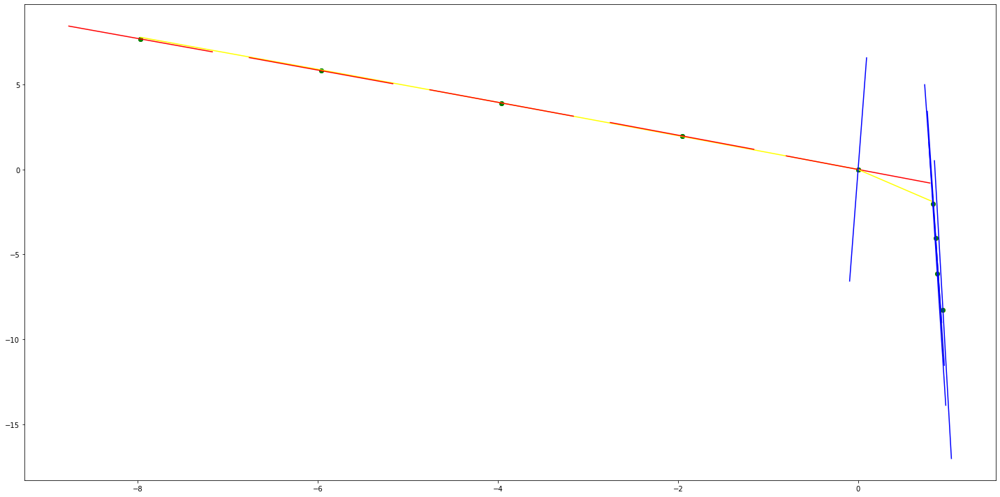

parameters (784.8999522614313, -410.8885141771229, 0.27578180881618847)
tangent[0]:-443.59215558804766
tangent[1]:-437.05236918580545
tangent[2]:-430.51101298365865
tangent[3]:-417.42987037926963
tangent[4]:-410.8885141771229
parameters (3044.5842375133443, -457.2844247770681, -0.449861362671613)
tangent[0]:-457.2844247770681
tangent[1]:-431.9108597416319
tangent[2]:-381.1698188392345
tangent[3]:-355.7962538037983
tangent[4]:-330.42877793683715


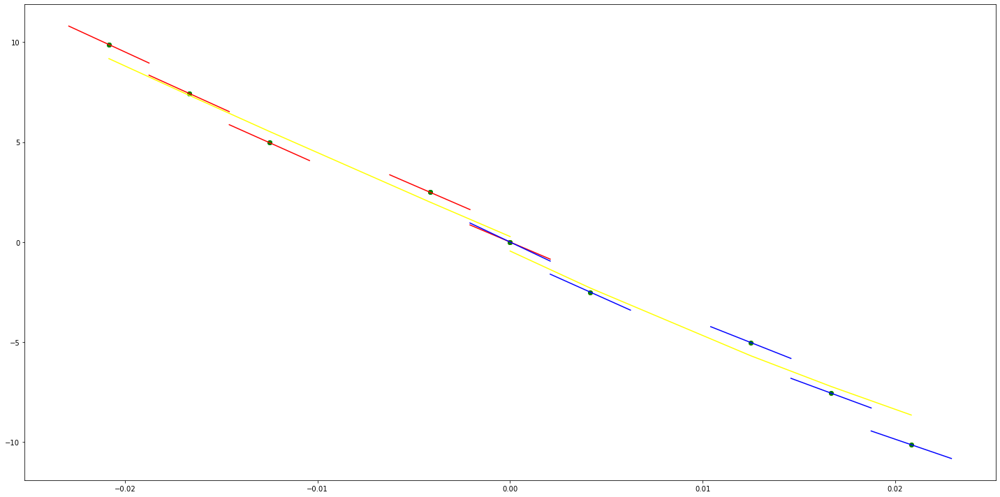

parameters (-517.244312997294, -220.77967498492296, 0.8295991985152309)
tangent[0]:-156.12413586026122
tangent[1]:-177.67563740560647
tangent[2]:-194.91745933505825
tangent[3]:-212.15824677588407
tangent[4]:-220.77967498492296
parameters (1861.5885635144205, -630.6628777441265, -0.40835030237561376)
tangent[0]:-630.6628777441265
tangent[1]:-615.1521218329243
tangent[2]:-599.6376427445952
tangent[3]:-568.6124077450638
tangent[4]:-553.0979286567347


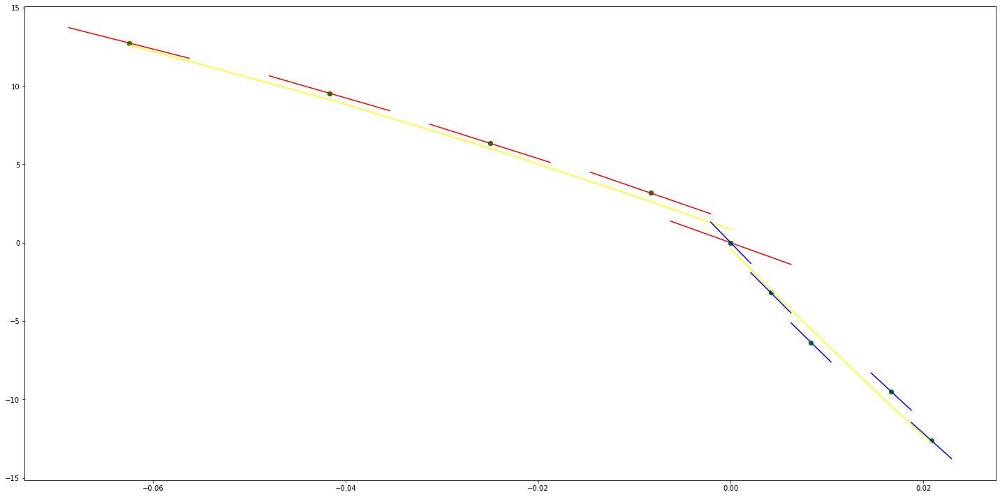

parameters (1288.346048140195, 153.95156982786608, -0.07993823098916454)
tangent[0]:100.26876669396043
tangent[1]:111.0058426591608
tangent[2]:121.74291862436121
tangent[3]:143.2144938626657
tangent[4]:153.95156982786608
parameters (1076.7262017730027, 25.51269293502641, 0.3054283562150986)
tangent[0]:25.51269293502641
tangent[1]:34.48397564819907
tangent[2]:88.3202857368492
tangent[3]:106.2671580680016
tangent[4]:124.21187694675046


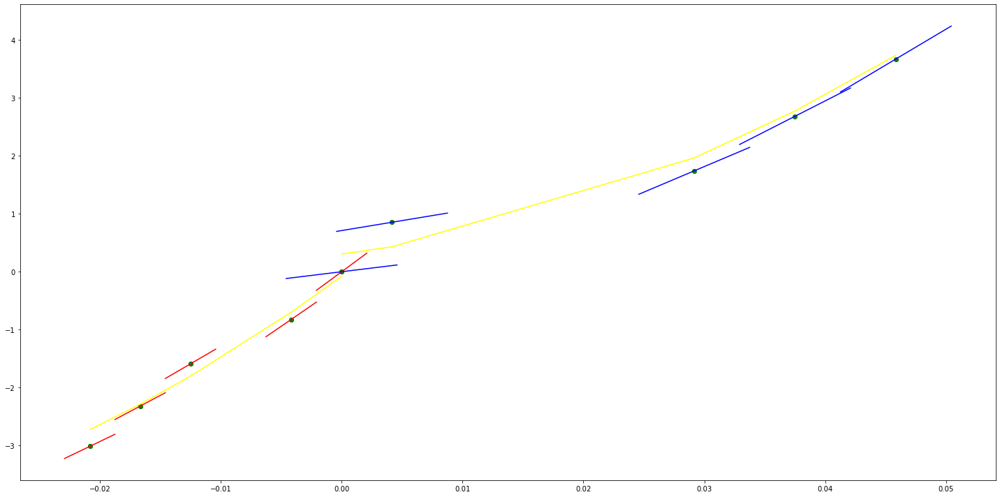

parameters (299.2676498308846, 400.26654718052805, -0.06595470556900622)
tangent[0]:382.80906809529324
tangent[1]:390.2907593410653
tangent[2]:392.7848559347559
tangent[3]:395.2783539931469
tangent[4]:400.26654718052805
parameters (-3935.857582442118, 533.0806080151353, 0.5405065417145073)
tangent[0]:533.0806080151353
tangent[1]:500.2870426382276
tangent[2]:467.485605546155
tangent[3]:401.89060307717466
tangent[4]:369.089165985102


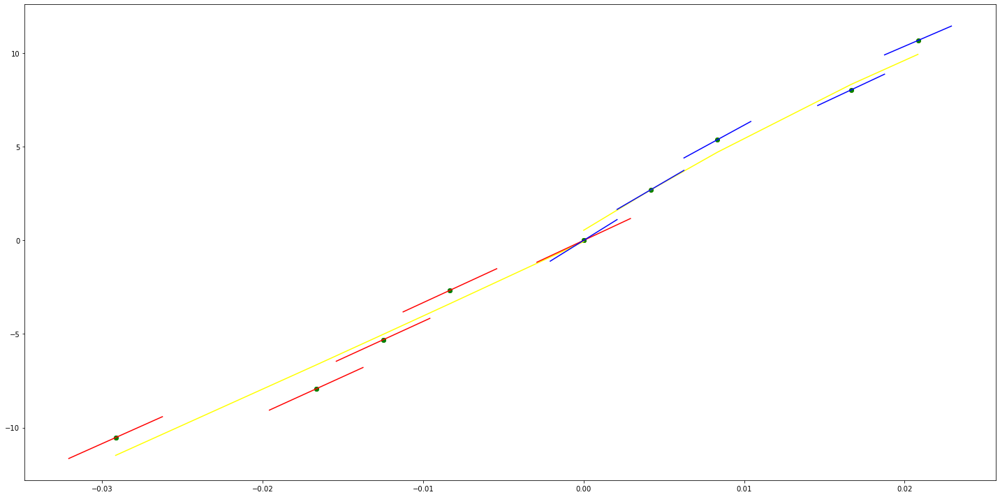

parameters (18.311920446048674, 39.16930057927757, -1.3150246623279616)
tangent[0]:32.14971886701194
tangent[1]:33.37053797930912
tangent[2]:37.3381085346727
tangent[3]:38.86411411312372
tangent[4]:39.16930057927757
parameters (-462.0749820471782, 150.11693064057891, 1.3009294106529412)
tangent[0]:150.11693064057891
tangent[1]:146.26599774019772
tangent[2]:134.71412318901827
tangent[3]:127.01318153822001
tangent[4]:100.05849953547991


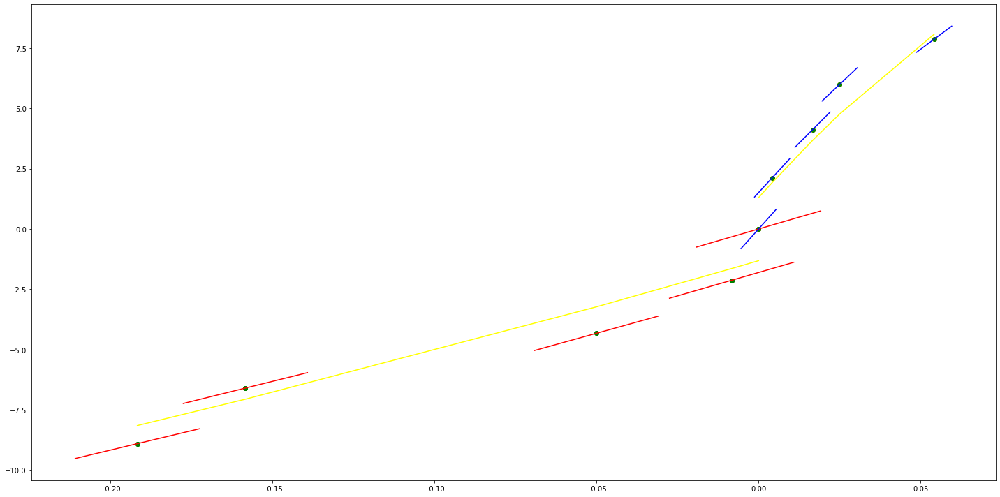

parameters (-3.433103434207904, 16.499543198301083, -0.6802217697314655)
tangent[0]:18.816888016391417
tangent[1]:18.444973055156808
tangent[2]:17.758352368315226
tangent[3]:16.64259375219766
tangent[4]:16.499543198301083
parameters (-74.01553726965858, 58.90034644250412, 0.17828855921573197)
tangent[0]:58.90034644250412
tangent[1]:56.433260554231865
tangent[2]:47.18131839552454
tangent[3]:44.09723898857241
tangent[4]:39.16291918095335


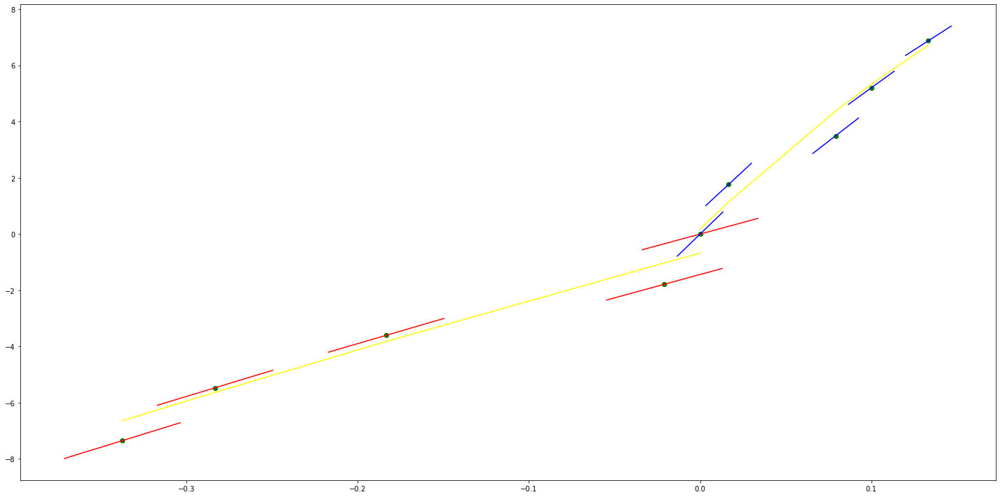

parameters (0.055836547335701175, 2.8430750126228106, 0.18613919549878963)
tangent[0]:2.4722272029527987
tangent[1]:2.5210841818715375
tangent[2]:2.609957427496258
tangent[3]:2.7518752814168006
tangent[4]:2.8430750126228106
parameters (58.919422648557415, -49.7557128062958, 0.014785160111599478)
tangent[0]:-49.7557128062958
tangent[1]:52.37120789197353
tangent[2]:62.19119022596329
tangent[3]:64.155092421685
tangent[4]:66.11911245625203


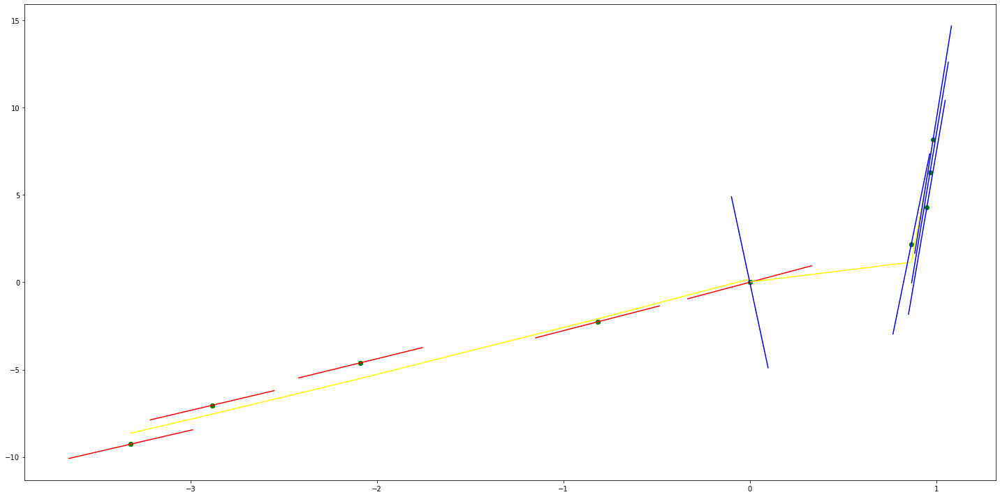

parameters (5.101810873824668, 14.929179310732707, -3.319804754535053)
tangent[0]:13.993854119612683
tangent[1]:14.163907679659006
tangent[2]:14.333971443327078
tangent[3]:14.50403520699515
tangent[4]:14.929179310732707
parameters (-3261.4217214153355, 353.3815381041778, 0.16754801850903303)
tangent[0]:353.3815381041778
tangent[1]:326.2008494779024
tangent[2]:299.020160851627
tangent[3]:244.665306442519
tangent[4]:217.48461781624363


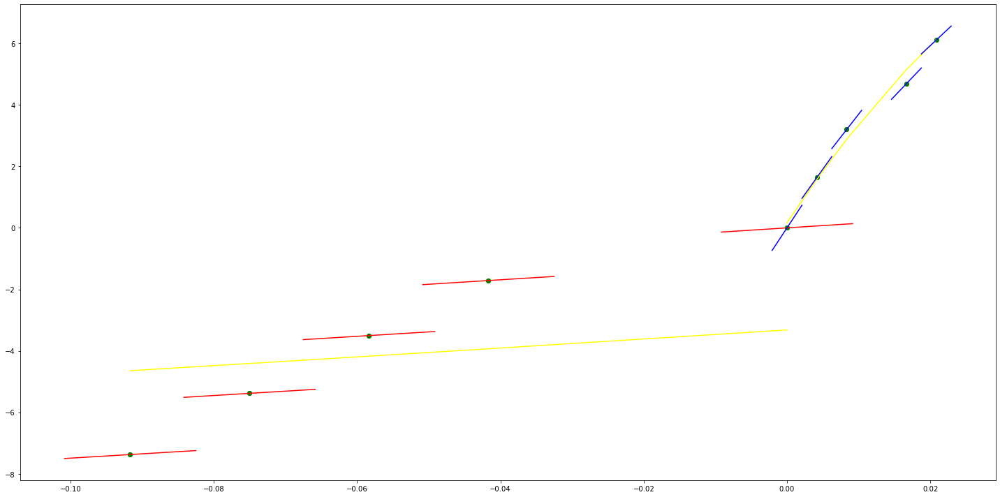

parameters (-222.5876413693284, -111.25004124711498, 1.3704133766817688)
tangent[0]:-87.13623170701015
tangent[1]:-88.99127711018214
tangent[2]:-90.84587733807138
tangent[3]:-109.394995843943
tangent[4]:-111.25004124711498
parameters (0.006261284557599298, -3.696462172253197, -2.339822716687794)
tangent[0]:-3.696462172253197
tangent[1]:-3.696410003230263
tangent[2]:-3.69620128957082
tangent[3]:-3.679921949721062
tangent[4]:-3.6579031032010274


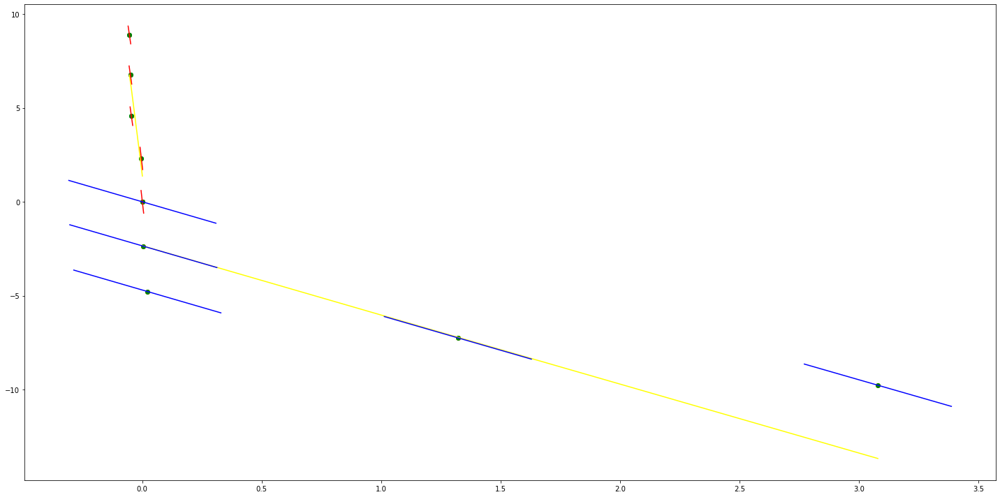

parameters (109.0264794693859, 139.0376034601575, -0.0008895498042485184)
tangent[0]:-149.88256713371513
tangent[1]:-148.97394045381728
tangent[2]:-148.06553182687836
tangent[3]:-144.43124316024588
tangent[4]:139.0376034601575
parameters (-269.904827686845, 472.8611971876913, 5.0556347082721364e-05)
tangent[0]:472.8611971876913
tangent[1]:-476.30393357449515
tangent[2]:-478.5533204084374
tangent[3]:-480.80270724237954
tangent[4]:-485.30094110060844


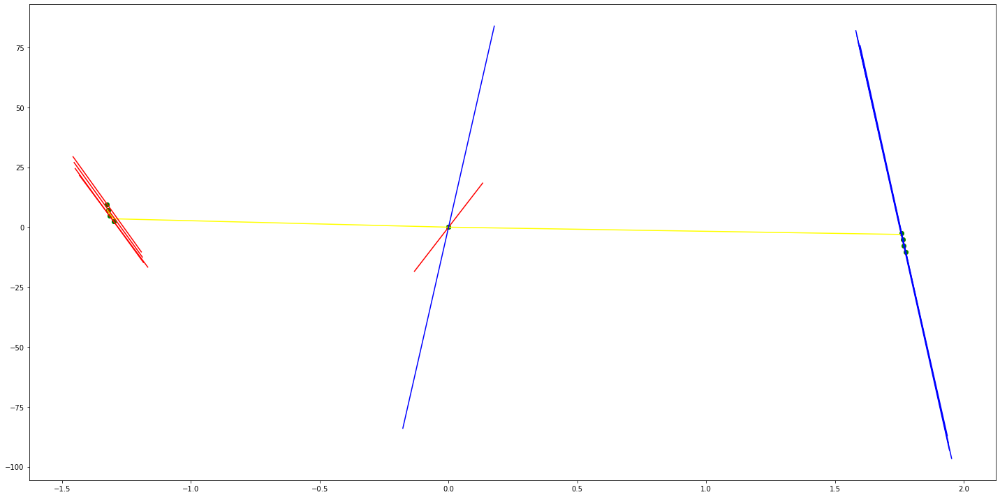

parameters (2960.216435612004, -418.1917471751598, 0.6625737866681244)
tangent[0]:-590.8730127301504
tangent[1]:-541.5321251813696
tangent[2]:-516.8676018398503
tangent[3]:-442.8621909495502
tangent[4]:-418.1917471751598
parameters (291.27280027025824, -284.78610107524736, -1.3654403362317453)
tangent[0]:-284.78610107524736
tangent[1]:-282.35863355779503
tangent[2]:-272.6499285791868
tangent[3]:-262.940641054978
tangent[4]:-253.2313535307692


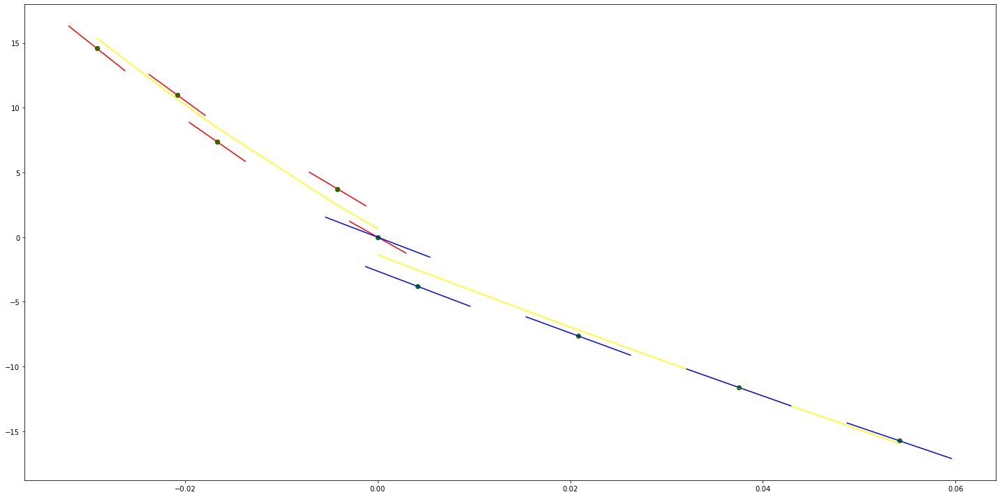

parameters (-442.6094362341124, 62.77790229218779, 0.25029315628503296)
tangent[0]:132.85802476887974
tangent[1]:121.79278886302694
tangent[2]:118.10408182145184
tangent[3]:114.41537477987674
tangent[4]:62.77790229218779
parameters (-865.1601833965206, 230.1755934916841, 1.130467106686387)
tangent[0]:230.1755934916841
tangent[1]:222.96534852325752
tangent[2]:215.75683387519769
tangent[3]:158.07833476851846
tangent[4]:143.65957515203206


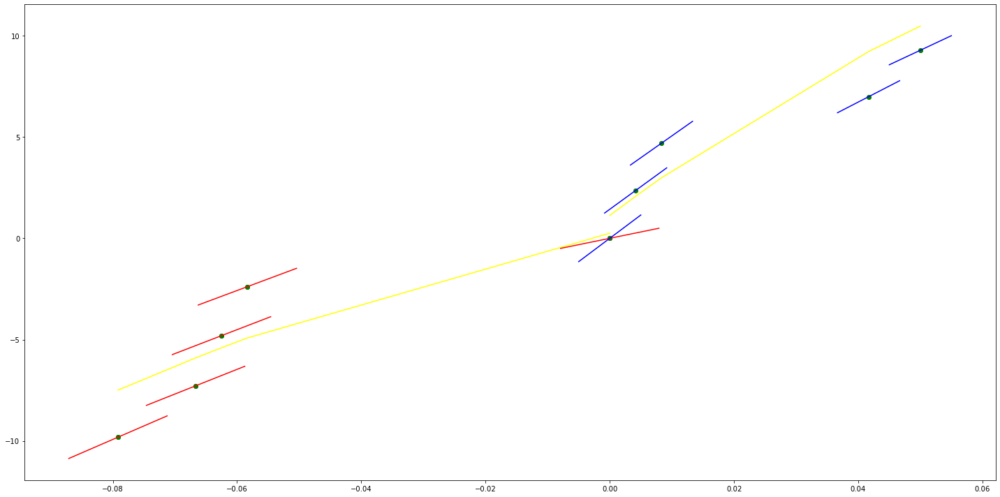

parameters (-6.112859121647408, -0.39630246562408245, -0.315030616283429)
tangent[0]:8.976752262808025
tangent[1]:8.925807694888215
tangent[2]:4.697750877654839
tangent[3]:1.1828568827075792
tangent[4]:-0.39630246562408245
parameters (-201.35762627615875, 62.203647018982416, 0.2556375410225833)
tangent[0]:62.203647018982416
tangent[1]:60.52553256159691
tangent[2]:50.457651247788974
tangent[3]:48.77993950565602
tangent[4]:47.10182504827051


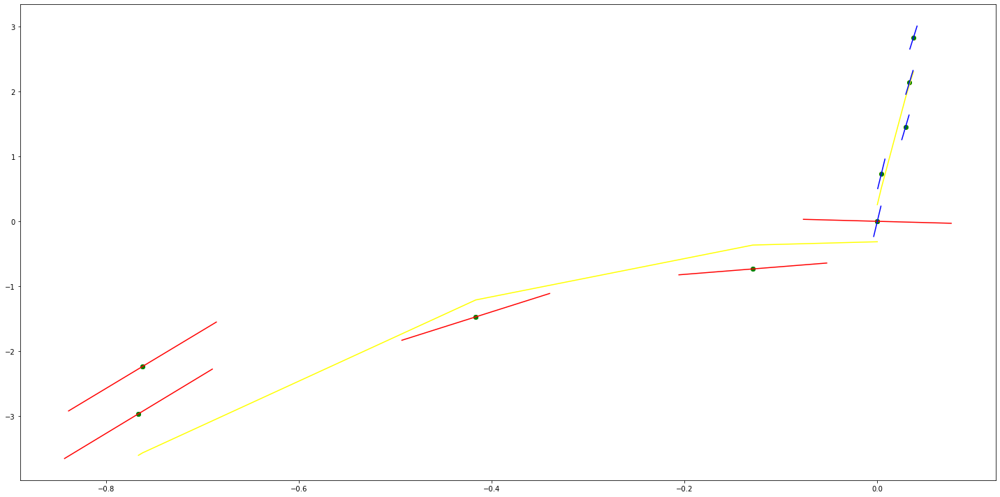

parameters (309.5158465995988, 87.58771856917416, -0.43809465790554913)
tangent[0]:64.37403007420426
tangent[1]:66.95353513976531
tangent[2]:69.53304020532636
tangent[3]:85.0088325353063
tangent[4]:87.58771856917416
parameters (-32.841247661225154, 31.1330184247339, 0.24530403167256165)
tangent[0]:31.1330184247339
tangent[1]:30.85931946672525
tangent[2]:24.29106993448022
tangent[3]:22.64900755141896
tangent[4]:22.101675317896984


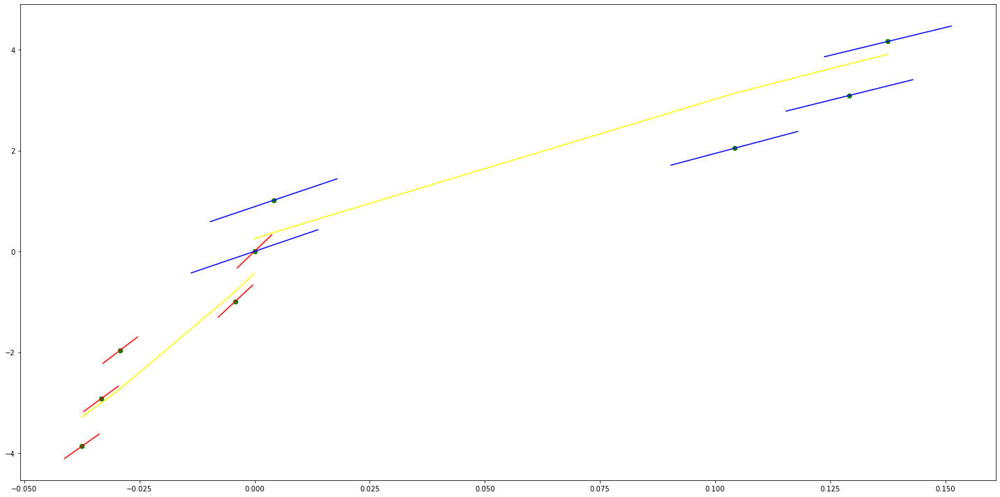

parameters (0.1953894936996983, 4.066306290945079, 0.27825866474603583)
tangent[0]:3.470368335160999
tangent[1]:3.6397057661077414
tangent[2]:3.7748504264360245
tangent[3]:3.7960173610675003
tangent[4]:4.066306290945079
parameters (-185.58404555814636, 74.56846115819508, 1.028423818709312)
tangent[0]:74.56846115819508
tangent[1]:73.02180372251348
tangent[2]:71.47551745492301
tangent[3]:59.10300030565251
tangent[4]:52.917112899108375


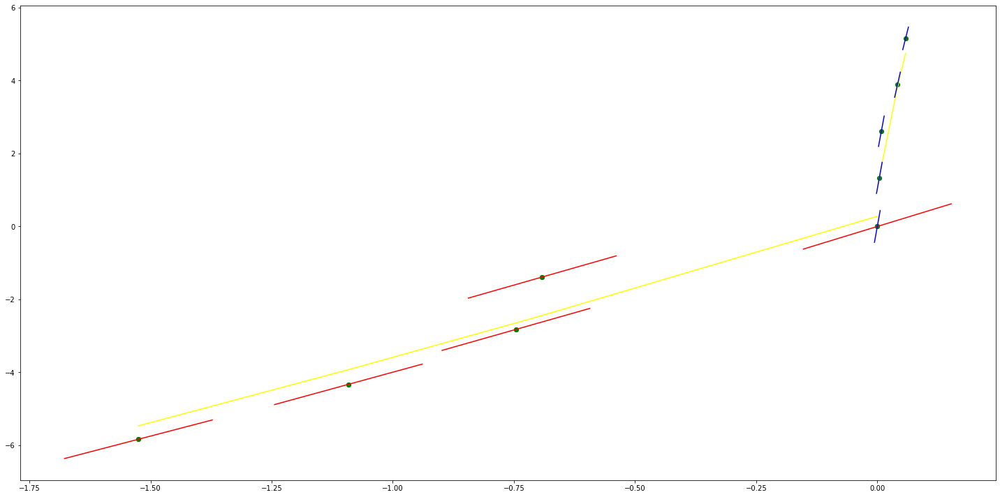

parameters (1553.0700764528717, 323.6049234487907, -0.5448593976204361)
tangent[0]:220.06795373198355
tangent[1]:233.00813360898889
tangent[2]:284.7781715374689
tangent[3]:310.66163743163247
tangent[4]:323.6049234487907
parameters (-83.19902455446834, 114.71092254427764, 0.9918767021944735)
tangent[0]:114.71092254427764
tangent[1]:114.0175418736407
tangent[2]:109.16437637332945
tangent[3]:105.69763941819386
tangent[4]:100.84447391788261


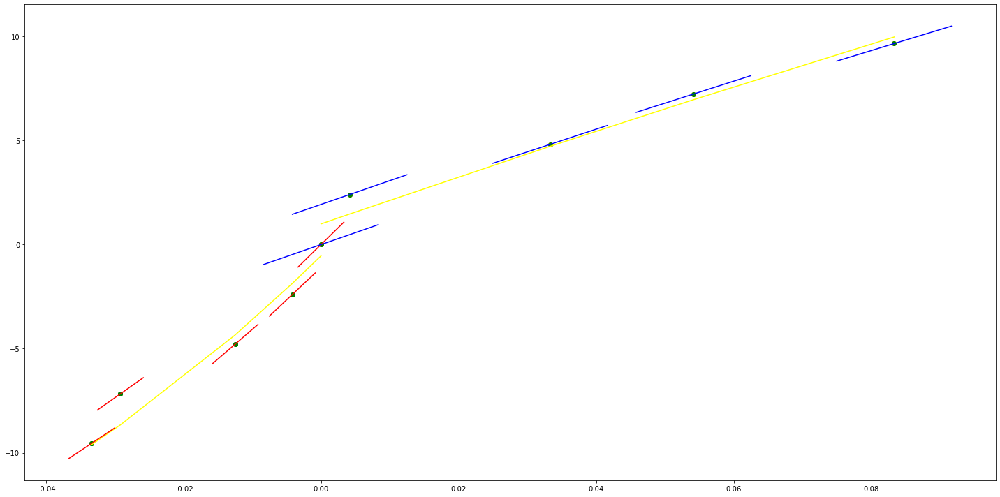

parameters (-41.40860361605314, 83.93405089535287, -0.09909873075540603)
tangent[0]:93.25098670896483
tangent[1]:90.83554004283322
tangent[2]:88.07491125695819
tangent[3]:86.34958037869171
tangent[4]:83.93405089535287
parameters (-748.8433592115821, 223.3714198757874, 0.6597282019591775)
tangent[0]:223.3714198757874
tangent[1]:217.1320570068365
tangent[2]:179.6898890462574
tangent[3]:173.4490284905881
tangent[4]:167.20816793491875


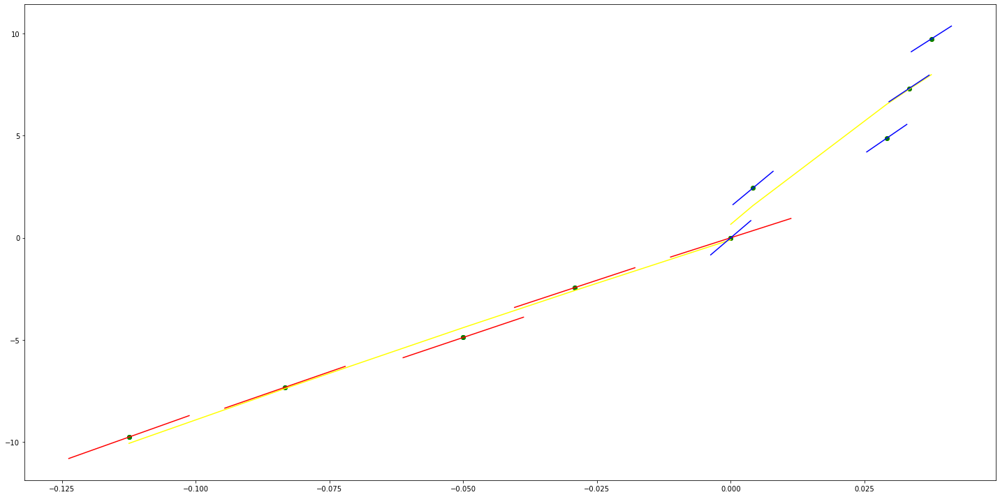

parameters (-2528.7824618255718, -115.6017294773045, -0.9074185886682729)
tangent[0]:242.64076675967692
tangent[1]:221.56589372282264
tangent[2]:200.49607825089197
tangent[3]:-94.53191400537384
tangent[4]:-115.6017294773045
parameters (-22.03672071873942, 31.82594545125872, 1.1541720281747847)
tangent[0]:31.82594545125872
tangent[1]:31.642291420788744
tangent[2]:30.356801354381798
tangent[3]:27.418601307510833
tangent[4]:23.01125716376295


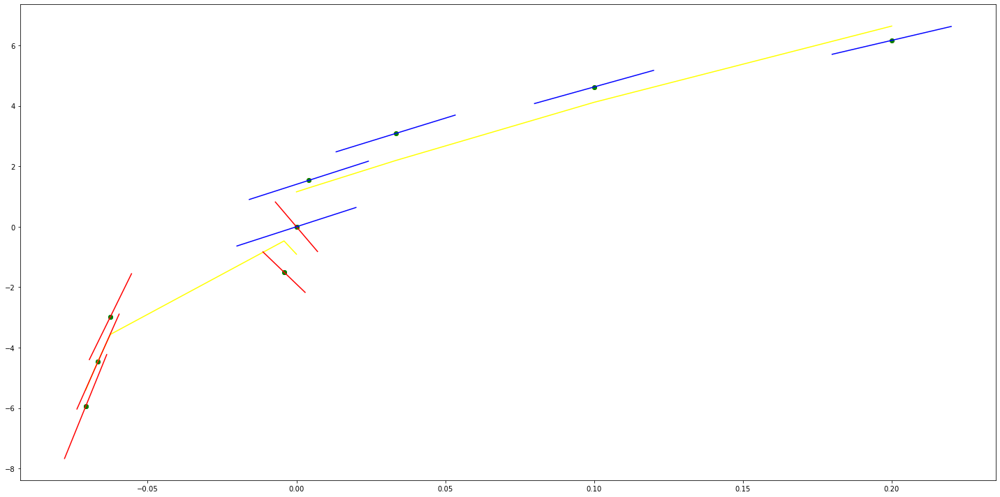

parameters (0.3324608549504913, 6.073991871006431, -0.3815387670107069)
tangent[0]:5.53651371047704
tangent[1]:5.699973409187129
tangent[2]:5.877286086801293
tangent[3]:6.0130404926249374
tangent[4]:6.073991871006431
parameters (-110.76030318094243, 58.42076109925034, 1.040482457897186)
tangent[0]:58.42076109925034
tangent[1]:57.49768473254037
tangent[2]:56.57482988643675
tangent[3]:43.652646834922564
tangent[4]:42.72979198881895


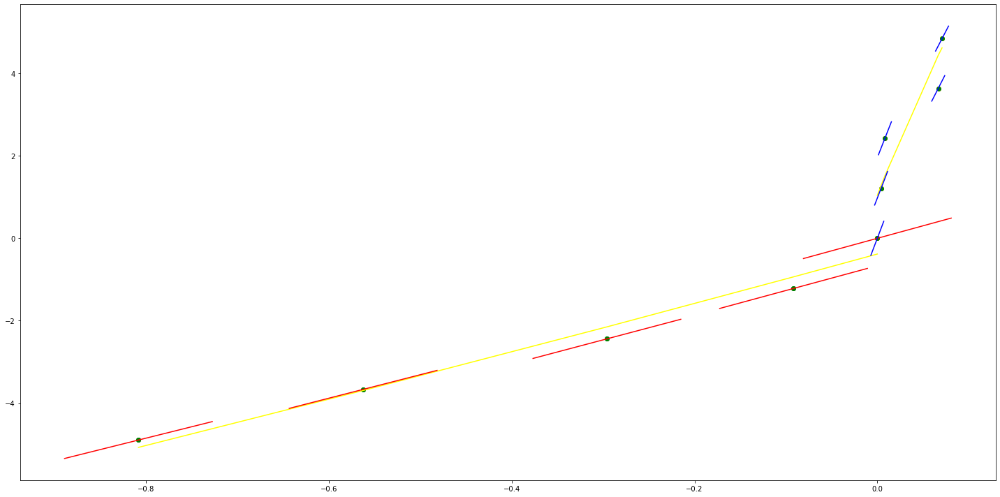

parameters (0.07550144981761318, 4.4022009316973, -0.1559073935280122)
tangent[0]:4.150529532973856
tangent[1]:4.223514217463249
tangent[2]:4.2971281310354215
tangent[3]:4.359416827134953
tangent[4]:4.4022009316973
parameters (-123.6646239728329, 73.82686119120079, 0.5888219229688851)
tangent[0]:73.82686119120079
tangent[1]:69.70462461569038
tangent[2]:65.58238804017996
tangent[3]:57.33816221840709
tangent[4]:52.18555199595504


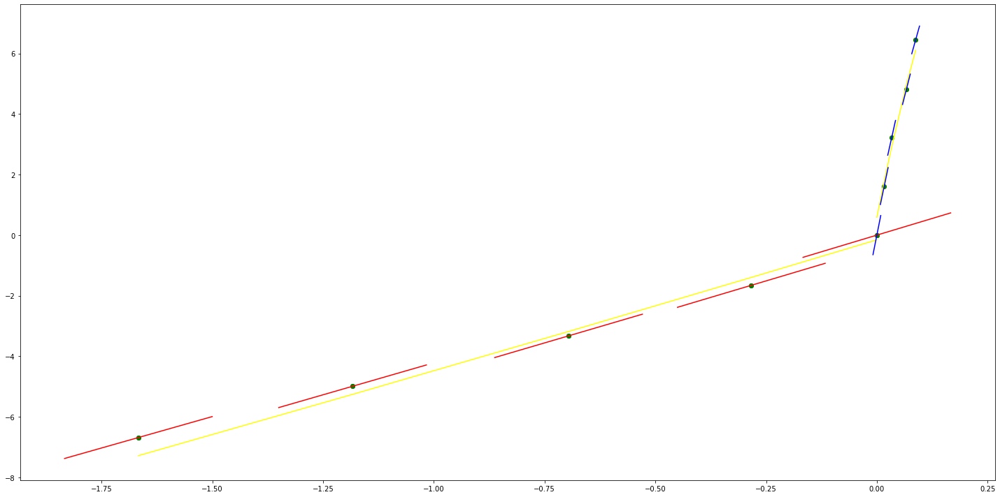

parameters (8.349691752989777, 31.042410840895815, 0.4274282035249404)
tangent[0]:28.120018727349393
tangent[1]:28.6070896460683
tangent[2]:28.676675977137716
tangent[3]:29.511645152436692
tangent[4]:31.042410840895815
parameters (-686.0516575400252, 270.5057892367492, 0.1858516183472641)
tangent[0]:270.5057892367492
tangent[1]:264.7882347228106
tangent[2]:259.07068020887203
tangent[3]:247.63694328431
tangent[4]:241.91938877037143


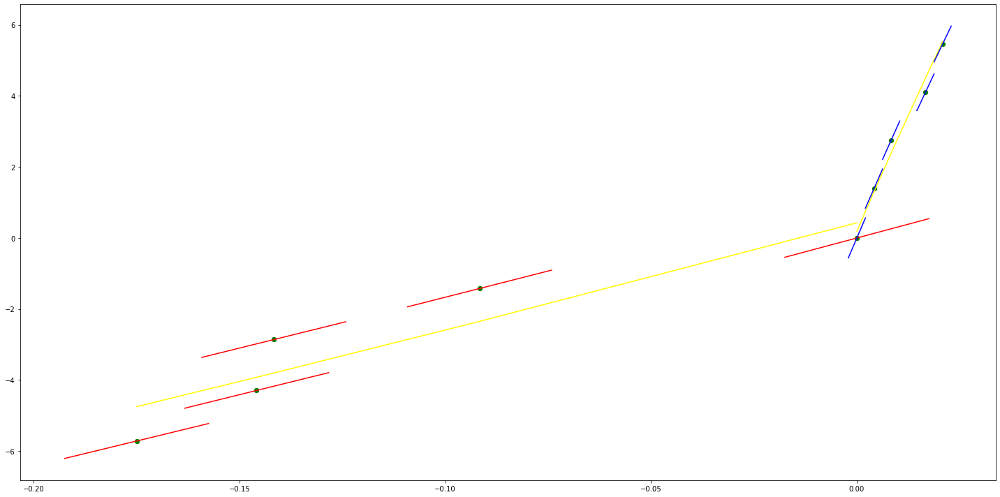

parameters (0.07651191930294242, 1.1632215910668477, 0.04882514471783218)
tangent[0]:0.8520730172189895
tangent[1]:0.904993863419417
tangent[2]:0.9872441766700801
tangent[3]:1.0612056476549783
tangent[4]:1.1632215910668477
parameters (262.5219098828218, -74.00781798968762, -0.0008364039490656909)
tangent[0]:-74.00781798968762
tangent[1]:79.12961274607855
tangent[2]:81.317470343042
tangent[3]:83.50532794000543
tangent[4]:87.88051809011256


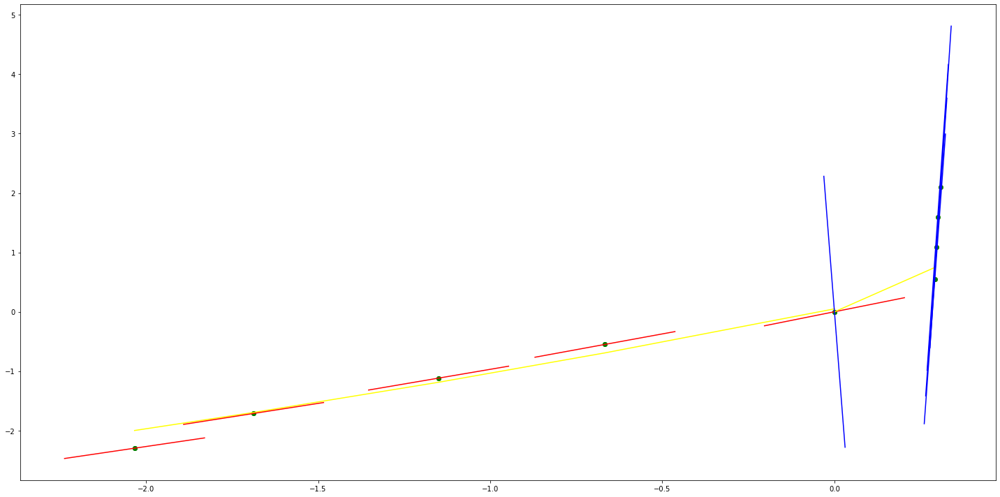

parameters (0.1074817860225116, 1.3549740630663591, -0.0355820819465614)
tangent[0]:0.9295254700362987
tangent[1]:1.0450683900104987
tangent[2]:1.1489673781777359
tangent[3]:1.2922764978622754
tangent[4]:1.3549740630663591
parameters (-527.0998304792129, 106.19478746502574, 0.06604550151798848)
tangent[0]:106.19478746502574
tangent[1]:101.80193747781198
tangent[2]:97.40908749059822
tangent[3]:88.62444171583167
tangent[4]:84.2315917286179


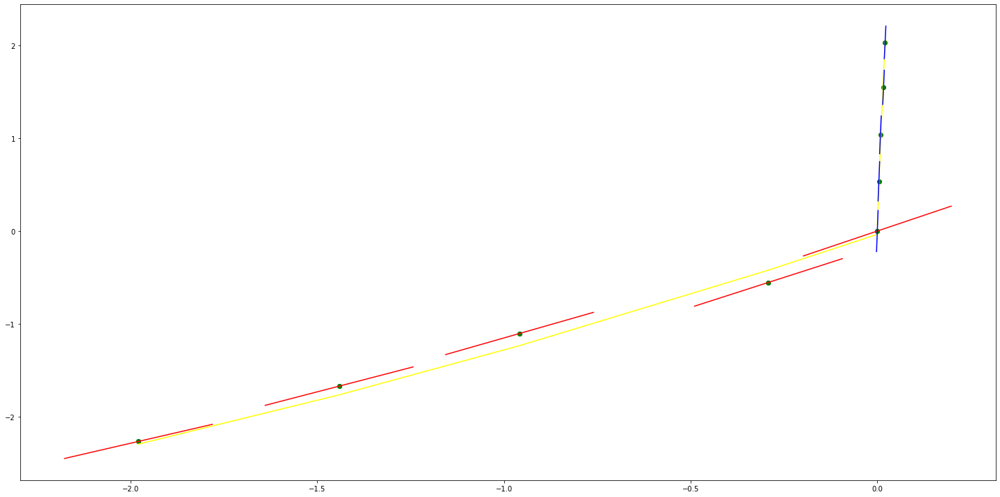

parameters (-226.85525362049847, 100.04662855209855, -0.06811516893503244)
tangent[0]:109.49877954945025
tangent[1]:107.608167865777
tangent[2]:105.71800989261102
tangent[3]:101.93678652526455
tangent[4]:100.04662855209855
parameters (684.9705404846443, -16.19197598141377, 0.31646751572785015)
tangent[0]:-16.19197598141377
tangent[1]:-10.483431497014745
tangent[2]:52.305078067050665
tangent[3]:69.42934157916676
tangent[4]:75.13788606356579


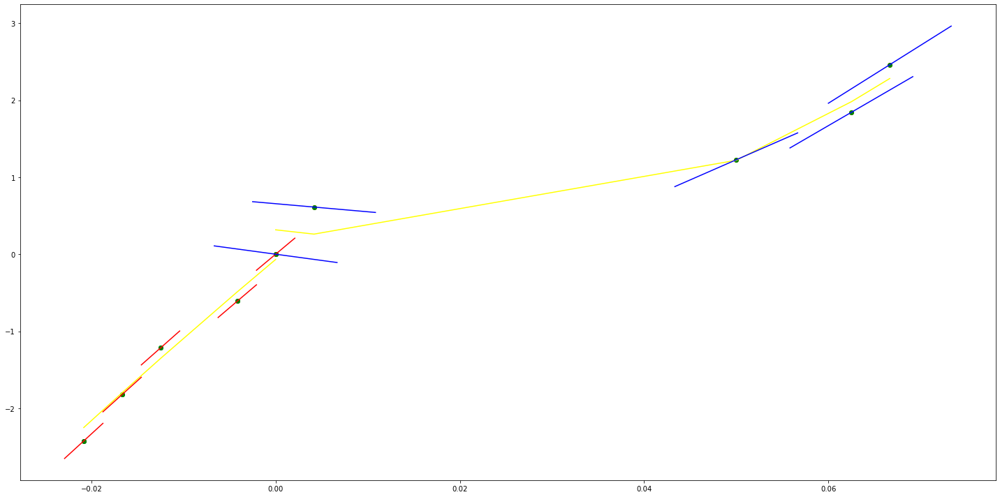

parameters (-1.3469172043541022, -1.1784311816380975, -0.04119485490758126)
tangent[0]:4.074545915342902
tangent[1]:3.8500606125620207
tangent[2]:2.3684516877725077
tangent[3]:2.054170108811748
tangent[4]:-1.1784311816380975
parameters (53.23518995350885, -58.4317893550137, 0.7575184327937714)
tangent[0]:-58.4317893550137
tangent[1]:-56.65724753310344
tangent[2]:60.016508291543495
tangent[3]:60.46017036461604
tangent[4]:61.34738804038121


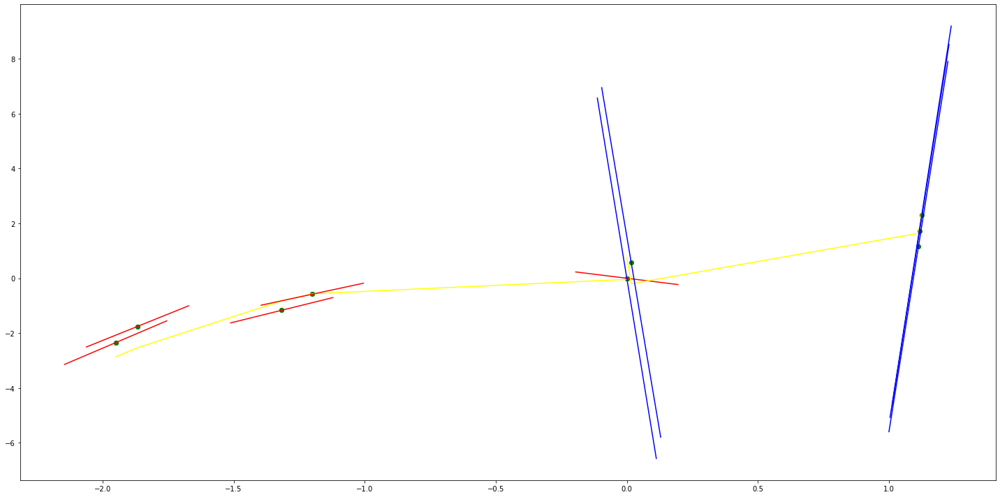

parameters (-0.30956310883215526, 0.1541058506052809, -0.12807841269298426)
tangent[0]:1.658066827390241
tangent[1]:1.585835228953999
tangent[2]:0.8428837677568264
tangent[3]:0.8325647910870153
tangent[4]:0.1541058506052809
parameters (-795.9959189716947, 106.70637258223717, 0.08909655330312061)
tangent[0]:106.70637258223717
tangent[1]:100.07254259352706
tangent[2]:86.80647460794479
tangent[3]:80.17264461923469
tangent[4]:73.54040662236253


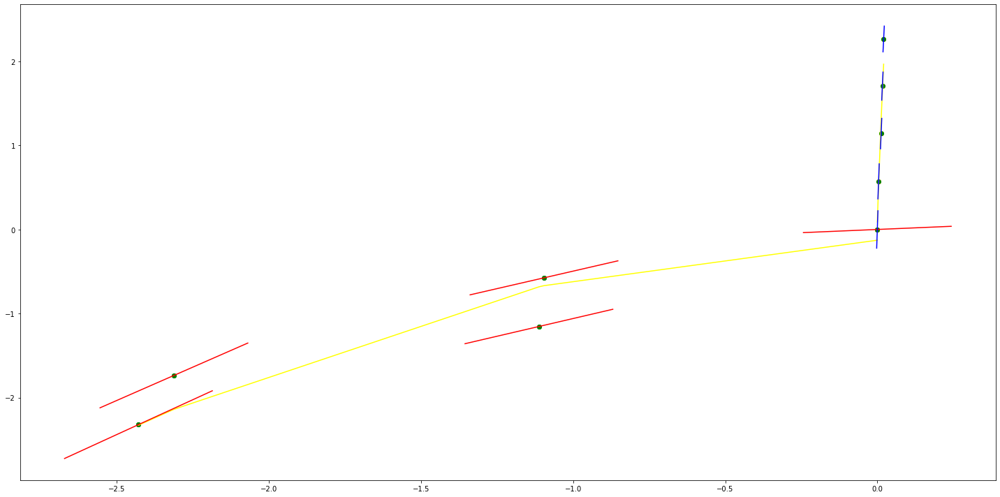

In [20]:
for point_index in breakpoints:
    identfication_UsePattern.plot_tangent_inPointWindow(data_forTangentPlot,point_index)

### ploynomial degree=3

parameters (0.2201866120259336, 1.3088173619889327, 4.776725324840965, -0.6549238092760596)
tangent[0]:2.1928007953014492
tangent[1]:2.528800894911515
tangent[2]:3.8179976834997236
tangent[3]:4.500901458212991
tangent[4]:4.776725324840965
parameters (1329.3420053431057, -678.8368821930325, 112.11543224743654, 1.1237149109566171)
tangent[0]:112.11543224743654
tangent[1]:106.52725331231126
tangent[2]:101.07886086466364
tangent[3]:80.66610439780324
tangent[4]:32.72254625864659


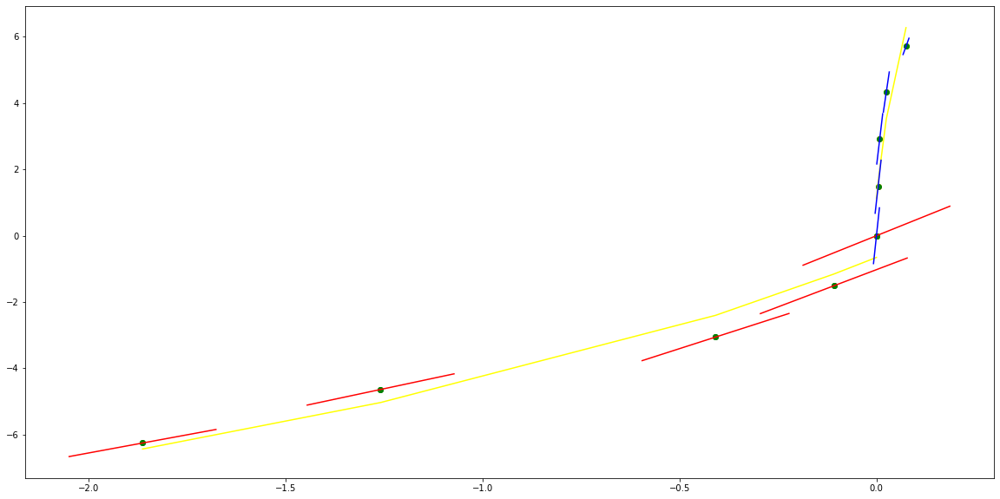

parameters (-1451.8147288352377, -396.0547625738046, -8.757801877360482, -0.15713105817216028)
tangent[0]:27.00516296633533
tangent[1]:26.65376151273008
tangent[2]:26.151038959615573
tangent[3]:0.46302903284311725
tangent[4]:-8.757801877360482
parameters (9974.265698496978, -1385.175237234254, 83.9894584617929, 0.0029803486409631084)
tangent[0]:83.9894584617929
tangent[1]:72.96498416201827
tangent[2]:62.981933744130146
tangent[3]:46.128247664755136
tangent[4]:39.261656564362404


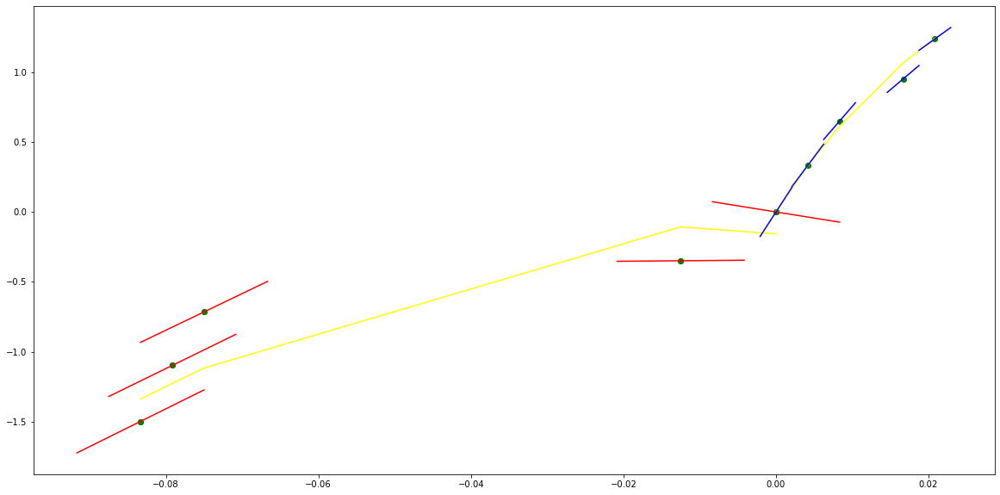

parameters (-537.0513590531017, -79.09309120713098, 80.26003747242021, -0.042174369172293724)
tangent[0]:82.85626696385042
tangent[1]:82.44896587361681
tangent[2]:81.98562192804233
tangent[3]:80.89122339398274
tangent[4]:80.26003747242021
parameters (0.6373395777630794, -1.8588353956300885, 3.8836425992589874, 0.5412442037626615)
tangent[0]:3.8836425992589874
tangent[1]:3.868184265152857
tangent[2]:3.80702220635094
tangent[3]:2.7679428846272396
tangent[4]:2.2360411186073668


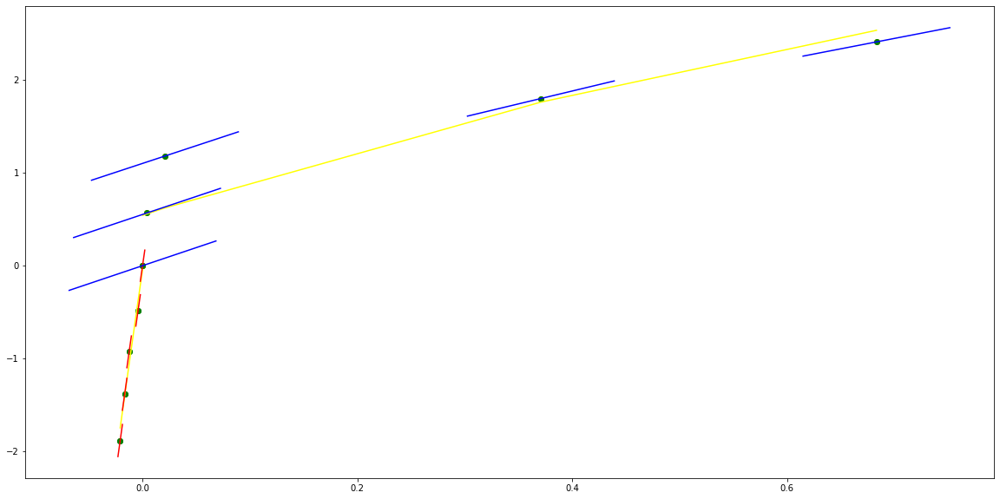

parameters (-584.3286613843279, -343.037785470303, -31.352562388544115, -0.5836501100151069)
tangent[0]:35.49540188455492
tangent[1]:35.74737218401624
tangent[2]:35.025466761376805
tangent[3]:-25.7572200550682
tangent[4]:-31.352562388544115
parameters (732.641982245485, -337.9126555696855, 60.369280692691454, 0.8174300636212953)
tangent[0]:60.369280692691454
tangent[1]:57.59128116334305
tangent[2]:54.89024991081273
tangent[3]:36.02557216471858
tangent[4]:8.555519211027907


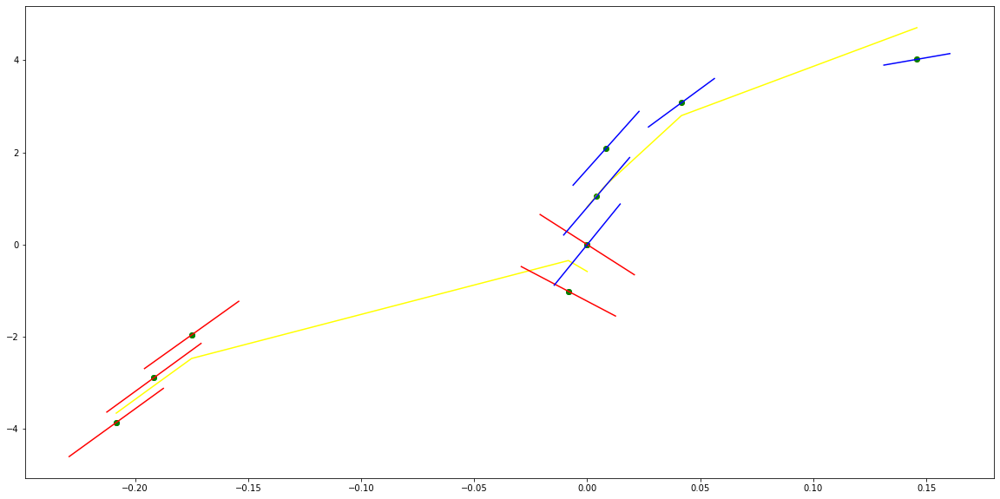

parameters (-60.02470158830042, -65.95046625165007, -3.534581606080392, -0.4360148434527424)
tangent[0]:18.980015523978768
tangent[1]:18.522367539212805
tangent[2]:17.235715094863448
tangent[3]:-0.34960460897595125
tangent[4]:-3.534581606080392
parameters (3618.533268390235, -1351.36906035948, 131.1567952013823, 0.3380265872203278)
tangent[0]:131.1567952013823
tangent[1]:120.0829808823918
tangent[2]:109.38867923133087
tangent[3]:70.37309206163998
tangent[4]:-32.58777626016786


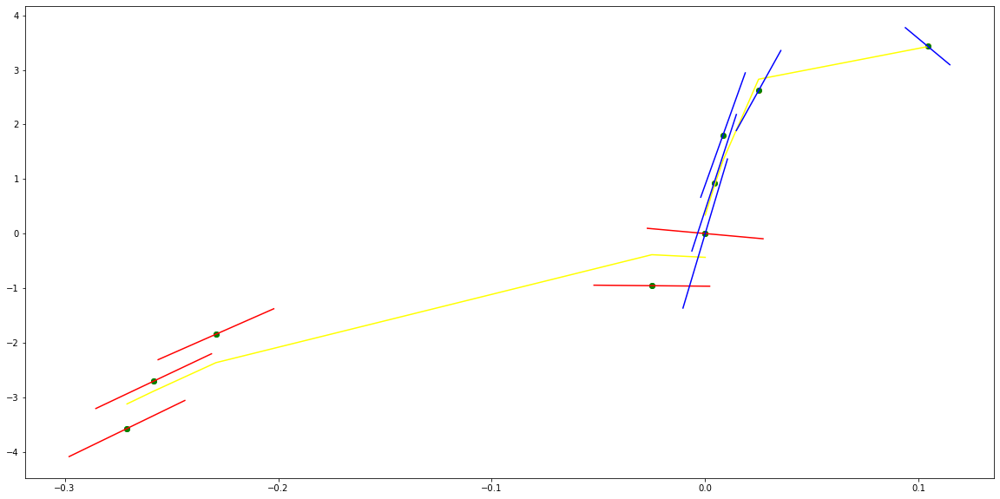

parameters (-1257.6564227861127, -601.5157312304493, -44.9529365987602, -0.00792308976572584)
tangent[0]:50.909706308548465
tangent[1]:50.9407987408037
tangent[2]:49.75516813536838
tangent[3]:41.095356763561
tangent[4]:-44.9529365987602
parameters (190.22717877533972, -92.50259289984446, 29.652059513335445, 0.6650737125742505)
tangent[0]:29.652059513335445
tangent[1]:28.891052154959254
tangent[2]:28.15003879192193
tangent[3]:17.4885341533099
tangent[4]:15.003294262042017


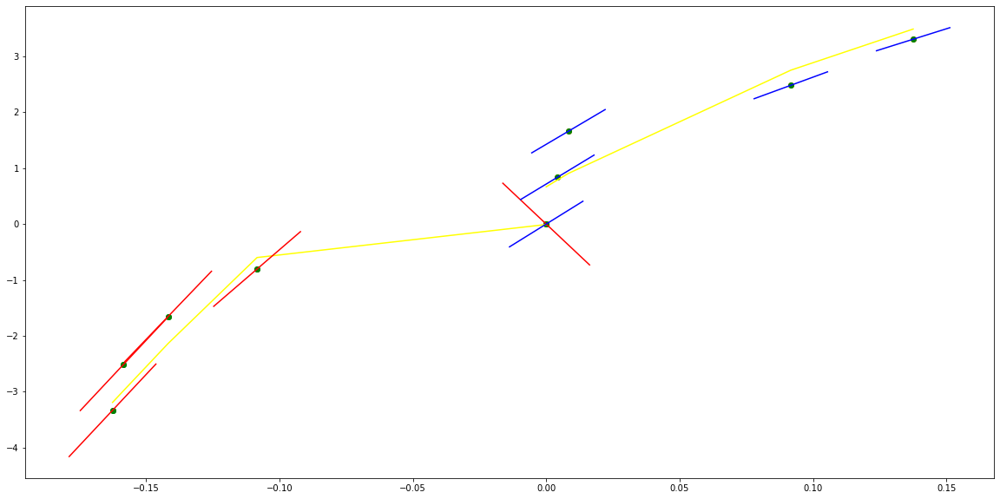

parameters (220.73612227108845, 144.84209376880662, 31.91352946646217, -0.3886851554830205)
tangent[0]:5.549980289292133
tangent[1]:2.6519523824596796
tangent[2]:25.085305007280127
tangent[3]:29.545574144989256
tangent[4]:31.91352946646217
parameters (1616.1078539637128, -715.0314154046056, 77.35057793886043, 0.38064533898924774)
tangent[0]:77.35057793886043
tangent[1]:71.47569187504321
tangent[2]:65.77052657137752
tangent[3]:26.181513049787227
tangent[4]:0.380498589593941


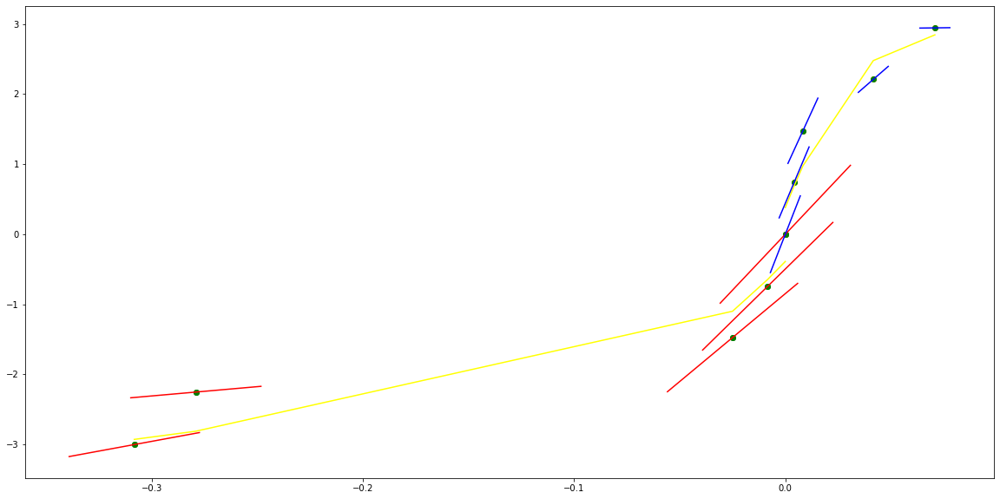

parameters (1389.2294526289813, 778.3956722852184, 100.83571991214457, -0.22542854415595134)
tangent[0]:70.2119204630552
tangent[1]:76.04641609082475
tangent[2]:82.02702941093395
tangent[3]:94.4209376573525
tangent[4]:100.83571991214457
parameters (1212.9761768627448, -347.005038663537, 59.72111257977242, 0.18863539356238596)
tangent[0]:59.72111257977242
tangent[1]:56.89235853863457
tangent[2]:46.84214616217114
tangent[3]:38.81297792614684
tangent[4]:32.80551751744757


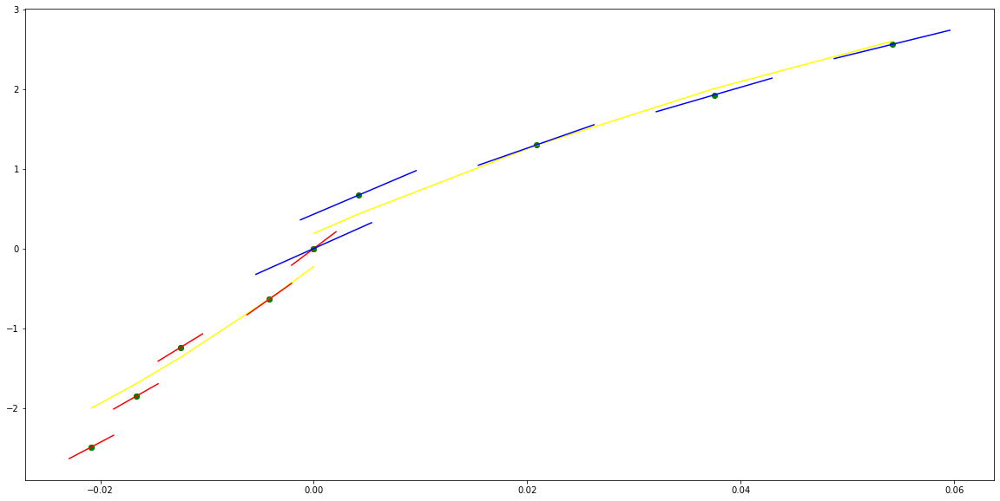

parameters (79.08582394361004, 66.29782153210505, 22.454159145259695, 0.21354241226074466)
tangent[0]:4.432534299589854
tangent[1]:8.163155993339993
tangent[2]:11.926084937177027
tangent[3]:14.668893606482355
tangent[4]:22.454159145259695
parameters (2734.0701242024743, -1046.3839566228182, 113.75282057952246, 0.20727064434762443)
tangent[0]:113.75282057952246
tangent[1]:105.1746789554925
tangent[2]:88.87481703467192
tangent[3]:81.15114067620834
tangent[4]:73.7140598650876


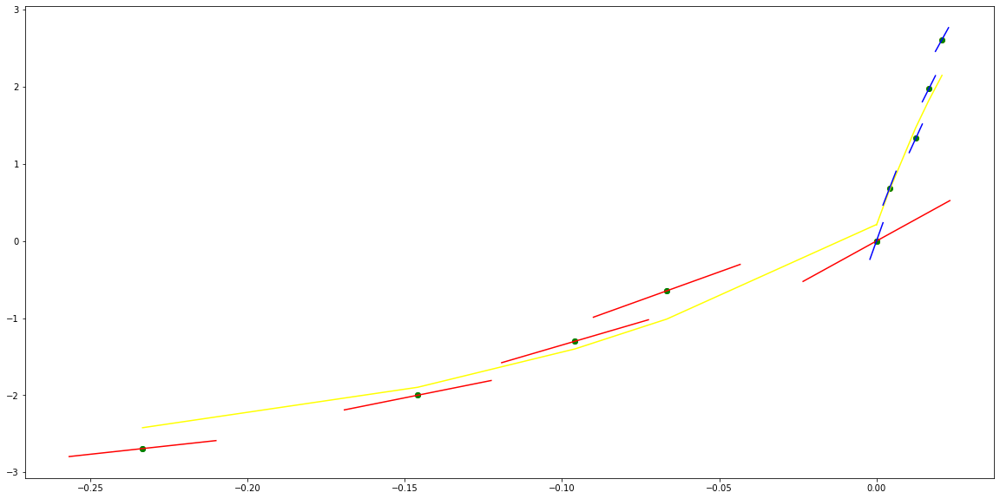

parameters (78.8429019380445, -128.40058504550785, 7.21205743897944, 0.008365812153161862)
tangent[0]:39.095755507178836
tangent[1]:33.99435506522066
tangent[2]:25.38347025035765
tangent[3]:24.18607082675438
tangent[4]:7.21205743897944
parameters (1587.8519141734428, -688.3996289335603, 85.31515741061516, 0.4638281341785898)
tangent[0]:85.31515741061516
tangent[1]:79.6607487562413
tangent[2]:68.84947227204495
tangent[3]:63.69130703714815
tangent[4]:58.69974782474897


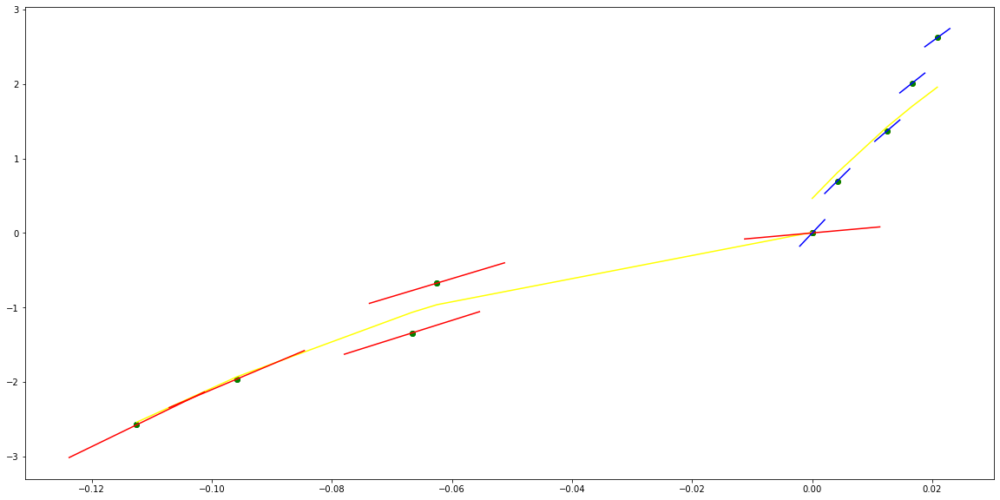

parameters (-216.3302521114325, -142.49502115871326, -11.112363787520742, 0.026919550687133195)
tangent[0]:19.726574251973084
tangent[1]:19.808929705458937
tangent[2]:19.115315639596986
tangent[3]:18.061105929608523
tangent[4]:-11.112363787520742
parameters (244.51981301601745, -145.63788219778021, 41.318349084973846, 0.22392634593519087)
tangent[0]:41.318349084973846
tangent[1]:40.11734041941208
tangent[2]:32.42430377252399
tangent[3]:28.588459462815955
tangent[4]:22.139587828544975


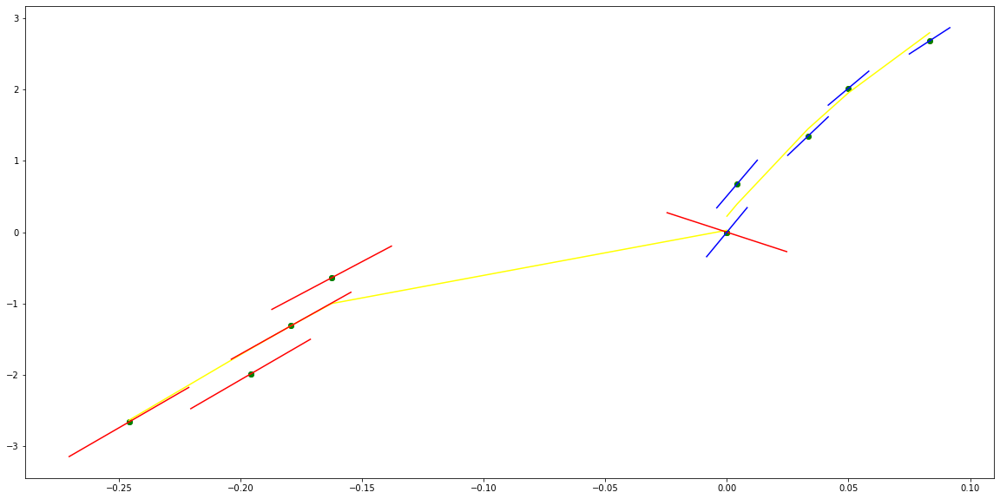

parameters (13048.706507266581, 2023.9544979558873, 124.48233210163055, 0.0029011303522491916)
tangent[0]:21.559679893379084
tangent[1]:39.719117995520904
tangent[2]:80.00005082801457
tangent[3]:93.46936948695271
tangent[4]:124.48233210163055
parameters (2213.279578196663, -697.2597226497551, 82.33219272631203, 0.36596457209816363)
tangent[0]:82.33219272631203
tangent[1]:76.6365236205143
tangent[2]:71.17272521350031
tangent[3]:39.37498674809757
tangent[4]:35.75443324282756


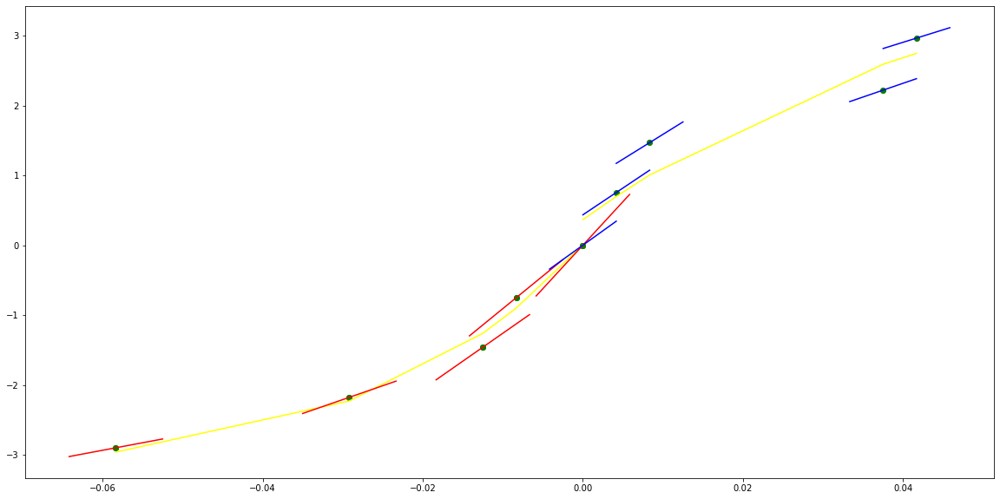

parameters (-193.64417512869394, -128.771565839471, -9.671767372434182, -0.316162680112746)
tangent[0]:18.82341375987574
tangent[1]:18.48458680363102
tangent[2]:15.531674830611973
tangent[3]:-5.540672597552219
tangent[4]:-9.671767372434182
parameters (269.09985432991726, -175.85328711352633, 37.95079344829639, 0.2909989473066427)
tangent[0]:37.95079344829639
tangent[1]:36.499250013493764
tangent[2]:30.97406961034538
tangent[3]:25.89706192523625
tangent[4]:18.091605202103974


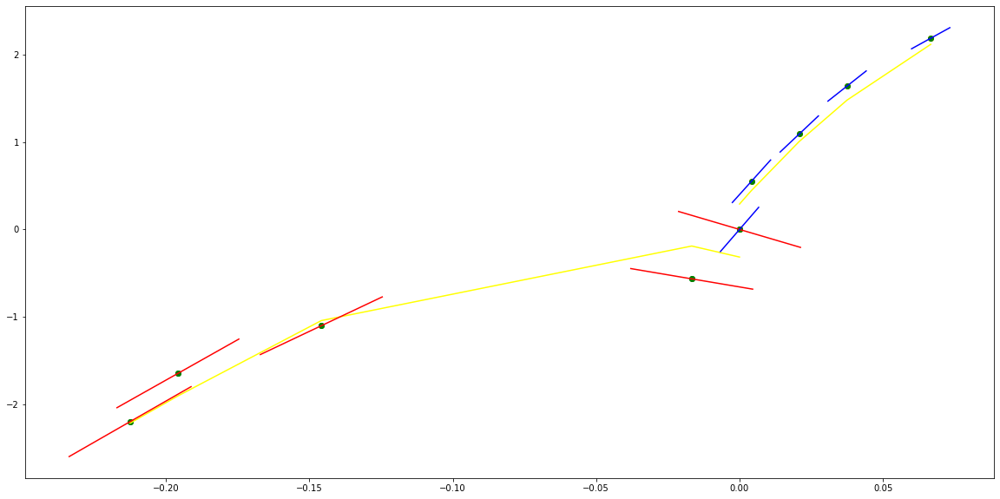

parameters (219.21433490925574, 117.16282419034951, 22.461026098616312, -0.28204065558106256)
tangent[0]:1.8462185670557218
tangent[1]:10.384591062040464
tangent[2]:19.634712213346287
tangent[3]:20.554056470266865
tangent[4]:22.461026098616312
parameters (3782.633389672379, -1339.5804795503652, 116.07502669197616, -0.015843117233443935)
tangent[0]:116.07502669197616
tangent[1]:105.10800665432131
tangent[2]:94.53756400000924
tangent[3]:74.57377156707847
tangent[4]:65.18521271536953


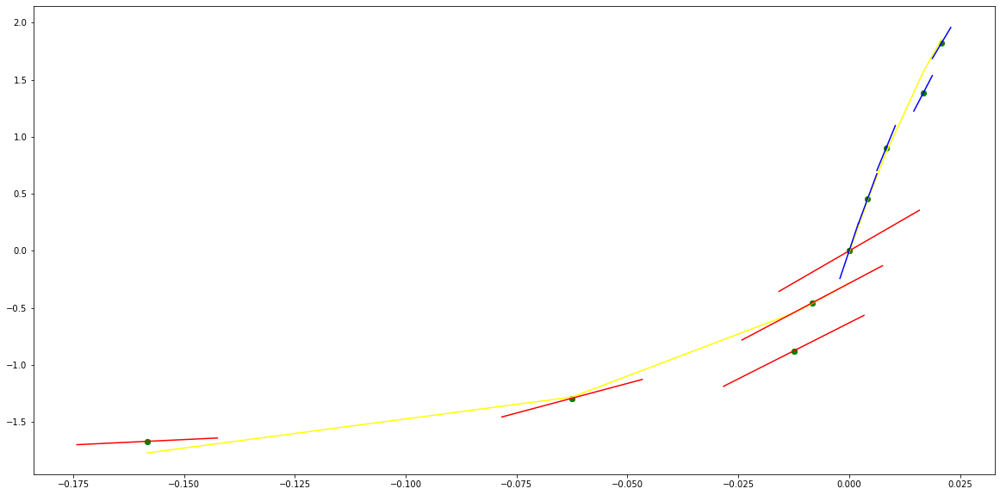

parameters (88.50295808926124, 62.32459322859997, 15.954672124873095, -0.09656330173833086)
tangent[0]:6.759483443972892
tangent[1]:9.20124201140663
tangent[2]:13.004385509860462
tangent[3]:14.934407095374043
tangent[4]:15.954672124873095
parameters (21308.975655419552, -2307.907930438898, 78.81718972976219, 0.012666848915563345)
tangent[0]:78.81718972976219
tangent[1]:60.69310510143764
tangent[2]:44.79261094678866
tangent[3]:-4.378664006853924
tangent[4]:40.04325688684784


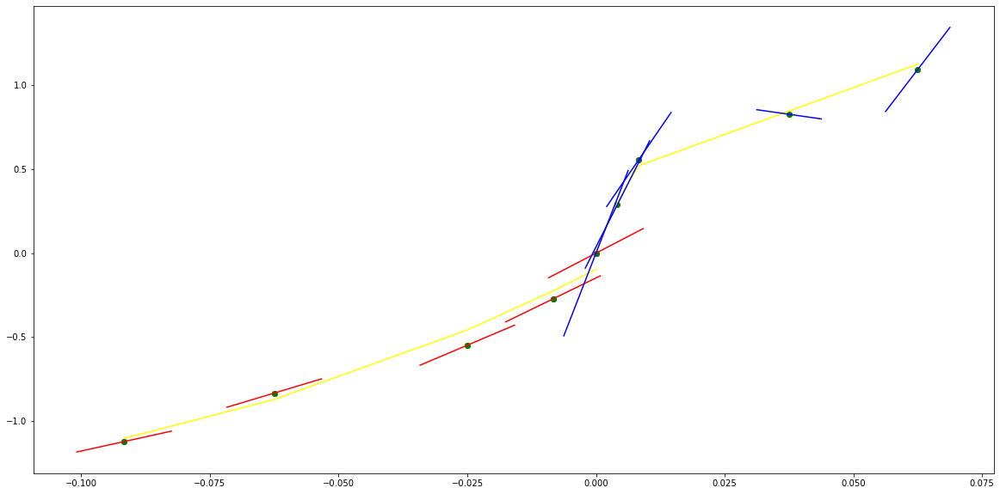

parameters (795.0914073511577, 405.1253059740095, 57.46550395187224, 0.05773177919158923)
tangent[0]:38.70003504195519
tangent[1]:44.623659678639186
tangent[2]:47.710070399717864
tangent[3]:50.879316394449134
tangent[4]:57.46550395187224
parameters (-625.2101212501034, 222.6094059587099, -9.620212069573506, 0.3021617820263653)
tangent[0]:-9.620212069573506
tangent[1]:-7.7975535177548085
tangent[2]:-6.040445398499134
tangent[3]:16.59920659151348
tangent[4]:16.792571893446862


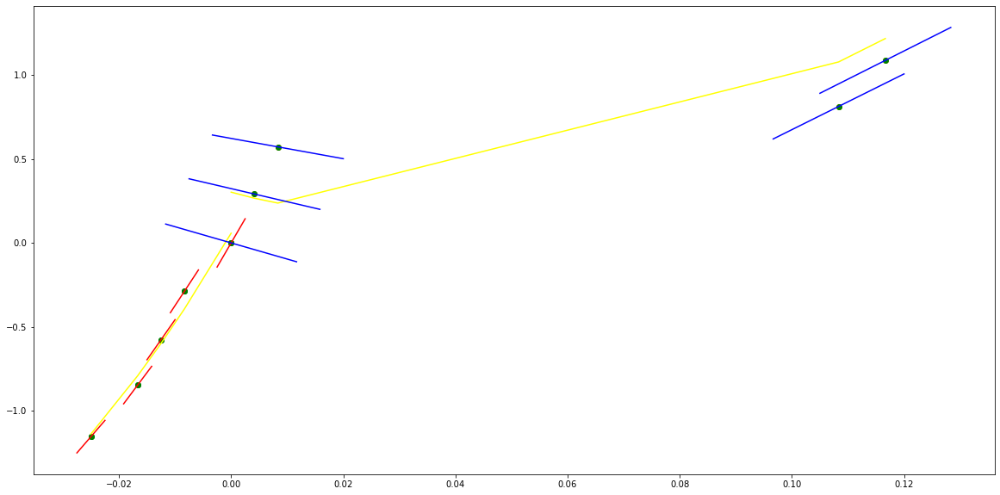

parameters (20212.616648189345, 928.8898434839892, 63.909254613933896, -0.009895914461390919)
tangent[0]:51.523799470370406
tangent[1]:49.790161538688864
tangent[2]:50.16167258067292
tangent[3]:57.22079555397447
tangent[4]:63.909254613933896
parameters (-2516.4032268736787, 871.9551217885585, -64.57689522835273, 0.2835256589187028)
tangent[0]:-64.57689522835273
tangent[1]:-57.44110488229891
tangent[2]:35.92191551995229
tangent[3]:34.72688512035006
tangent[4]:33.7363882186072


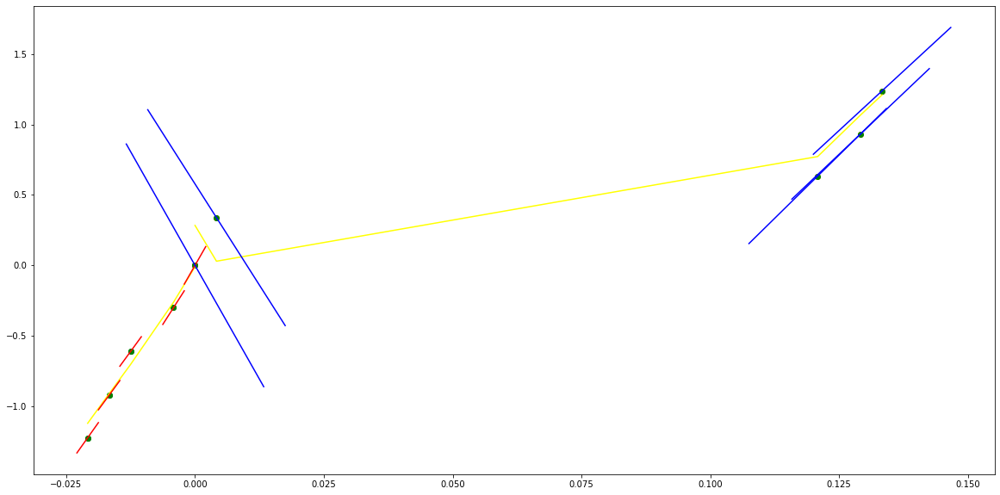

parameters (-483.309984242726, -291.84047032593264, -34.75252071805784, 0.0040490533451346625)
tangent[0]:23.43444832015281
tangent[1]:23.645512101488336
tangent[2]:23.80627974258175
tangent[3]:23.521877643495493
tangent[4]:-34.75252071805784
parameters (775.0294403219766, -379.3872464826502, 52.52614816843625, 0.13294530581676414)
tangent[0]:52.52614816843625
tangent[1]:49.40470743177029
tangent[2]:40.525537395691586
tangent[3]:37.72771978094105
tangent[4]:-8.002682978599111


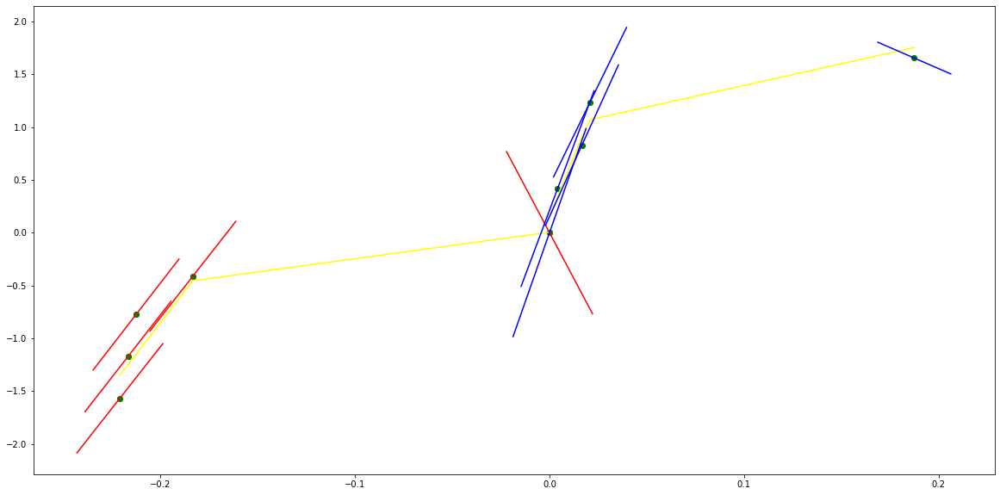

parameters (866.8622027847151, 419.92042627785065, 58.90923434151034, -0.23132399461987974)
tangent[0]:-5.82535646446685
tangent[1]:45.634020916647444
tangent[2]:48.81756534211941
tangent[3]:55.45477380611308
tangent[4]:58.90923434151034
parameters (16.655675830151075, -21.306829731725333, 8.93215119297319, 0.32527290150545984)
tangent[0]:8.93215119297319
tangent[1]:8.755447695907996
tangent[2]:6.92638578852679
tangent[3]:0.27949308264814654
tangent[4]:4.177697372392693


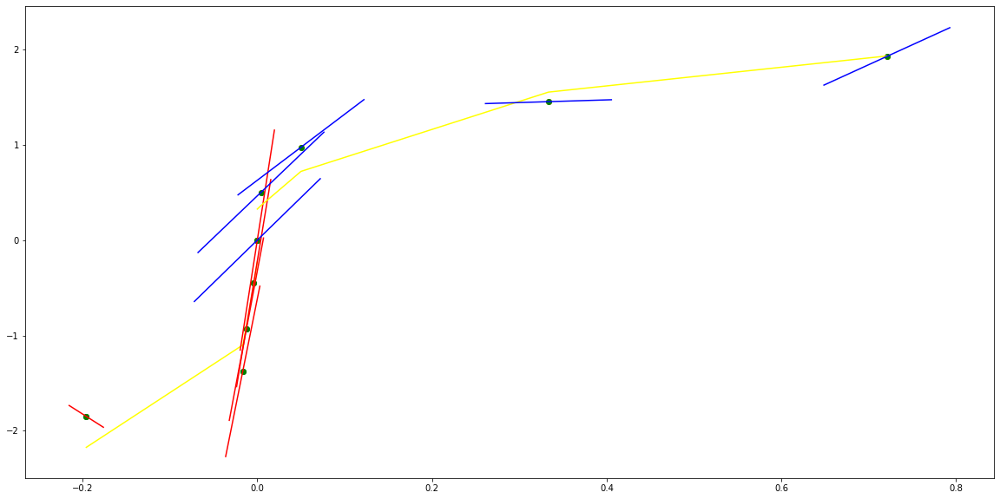

parameters (3.912632648348624, 5.307208573836329, 4.918967786980055, -0.28040169324364955)
tangent[0]:2.8871867696921045
tangent[1]:2.7759607585929746
tangent[2]:3.2904696387639185
tangent[3]:4.78812161918806
tangent[4]:4.918967786980055
parameters (482.0422501790593, -292.9908322505554, 49.052100121012714, 0.20056324514404933)
tangent[0]:49.052100121012714
tangent[1]:46.63542490941284
tangent[2]:37.471983199448644
tangent[3]:27.146678996275725
tangent[4]:22.910576393470237


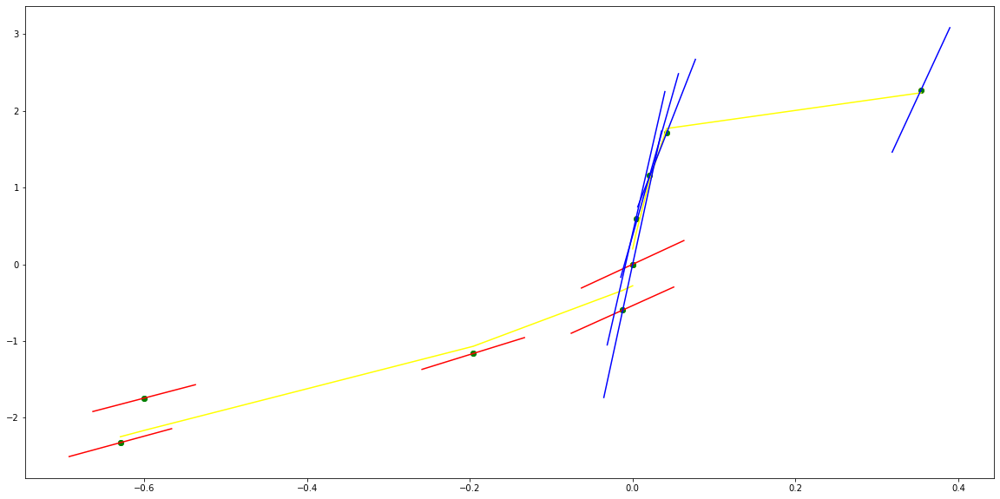

parameters (-113.4507914772479, -114.77209887401857, -22.174575276324298, -0.5172157672229138)
tangent[0]:15.929360797698415
tangent[1]:16.31076720466784
tangent[2]:16.521612012314456
tangent[3]:-15.769002152690511
tangent[4]:-22.174575276324298
parameters (180.6868255324314, -120.6243930650143, 24.999638030942968, 0.34532019743677156)
tangent[0]:24.999638030942968
tangent[1]:24.00376661708606
tangent[2]:20.208963845017266
tangent[3]:-1.8412759535161136
tangent[4]:1.7698332754225206


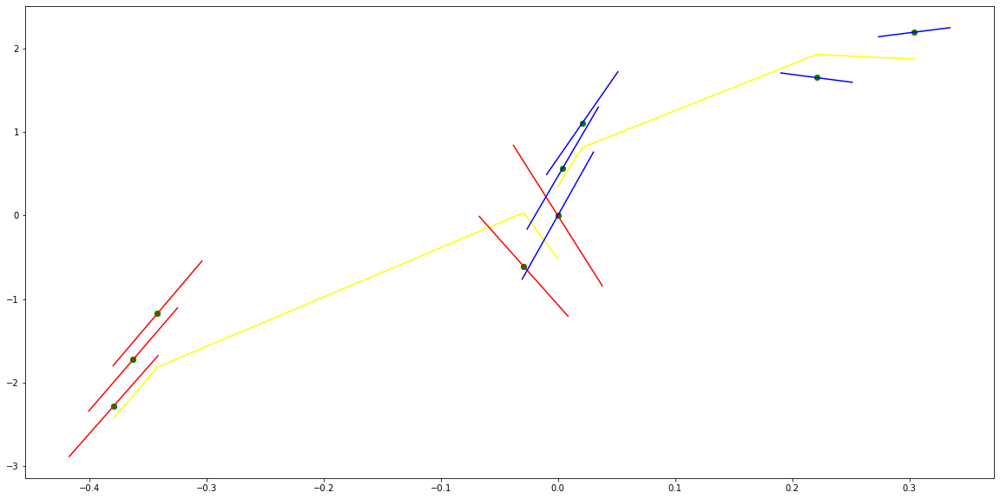

parameters (0.35586158137828755, 2.210032073834849, 7.3643137165743635, -0.9665937514013755)
tangent[0]:2.9777073388265265
tangent[1]:4.128748007869865
tangent[2]:5.365598617734502
tangent[3]:7.218165899887364
tangent[4]:7.3643137165743635
parameters (-73.5541222642955, 124.25719992050476, -37.8919055995096, 1.3264218914516899)
tangent[0]:-37.8919055995096
tangent[1]:-33.811213651075
tangent[2]:32.04064835819746
tangent[3]:32.07578267256133
tangent[4]:31.540298260964903


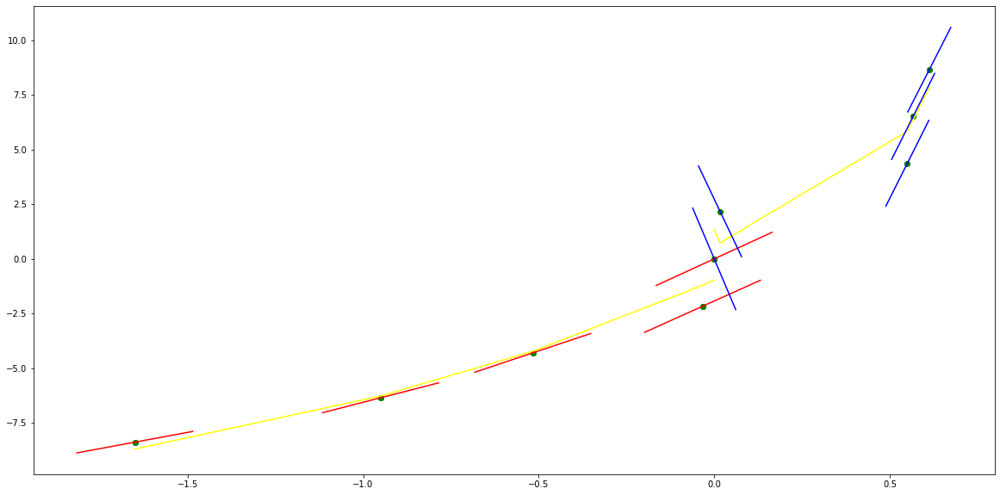

parameters (0.1403272927450937, 2.031990414254263, 9.945236929354152, 0.3072101650865299)
tangent[0]:6.08930681621964
tangent[1]:7.717833415013277
tangent[2]:7.8373944918406355
tangent[3]:7.897527648936629
tangent[4]:9.945236929354152
parameters (437.29218498965815, -305.2508475825246, 78.95374581575629, 0.4189068792484292)
tangent[0]:78.95374581575629
tangent[1]:69.14293879315039
tangent[2]:45.92190766078827
tangent[3]:21.984571207783716
tangent[4]:17.180348115844055


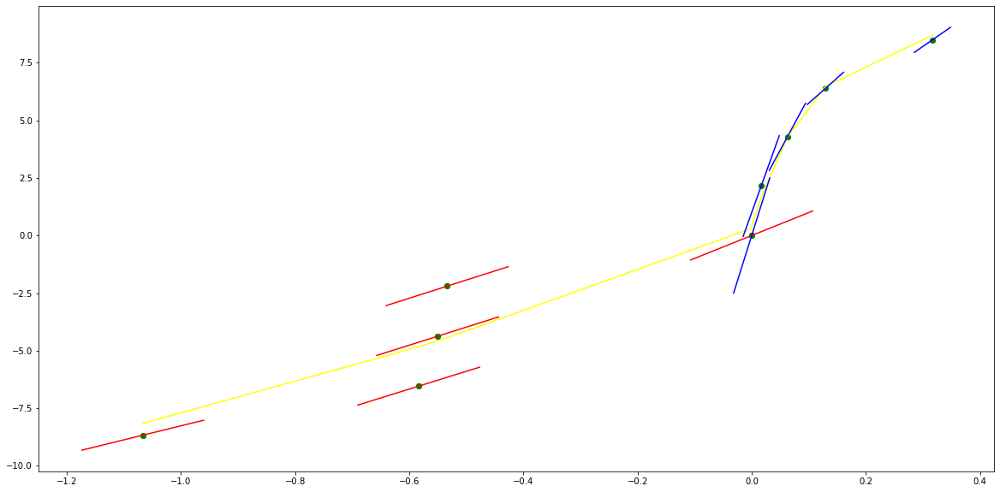

parameters (-0.00281459790341898, -0.025780500252865265, 2.1811397553282195, -0.034607828753308804)
tangent[0]:2.255476986700203
tangent[1]:2.244863305480265
tangent[2]:2.2277771659326633
tangent[3]:2.205525596047107
tangent[4]:2.1811397553282195
parameters (960.6923392511757, -802.1310940845439, 171.4674544871654, -3.517703437679142e-05)
tangent[0]:171.4674544871654
tangent[1]:13.804442067391221
tangent[2]:17.47689287974532
tangent[3]:79.40771209220128
tangent[4]:84.5810045115507


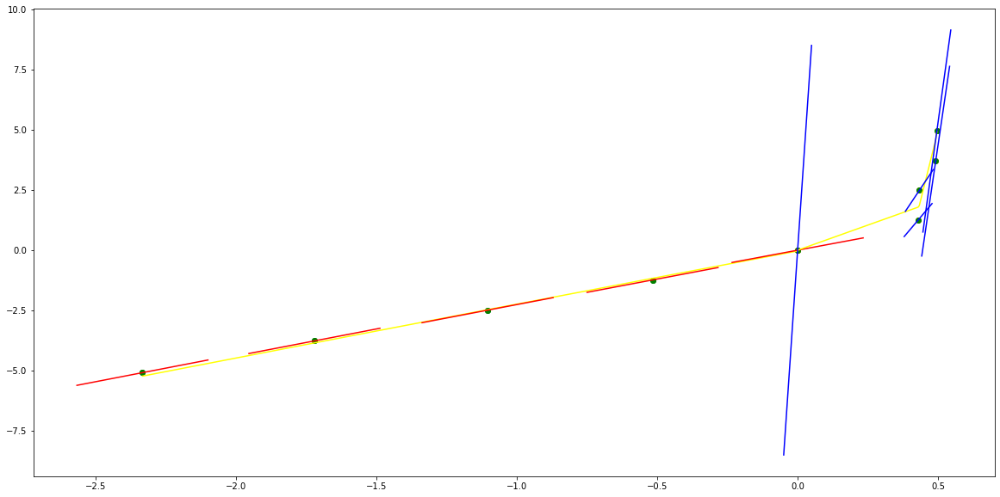

parameters (1.8224354432512133, 7.323110417702767, 10.597634070175987, -1.4402725291960463)
tangent[0]:4.67969370535692
tangent[1]:9.645513847977355
tangent[2]:9.703601933313742
tangent[3]:10.53669820165509
tangent[4]:10.597634070175987
parameters (2393.0190767672766, -900.0607925289299, 140.44895093652184, 0.21562188720379608)
tangent[0]:140.44895093652184
tangent[1]:133.07250064445734
tangent[2]:94.05212836088288
tangent[3]:88.42206886387167
tangent[4]:83.03994072696403


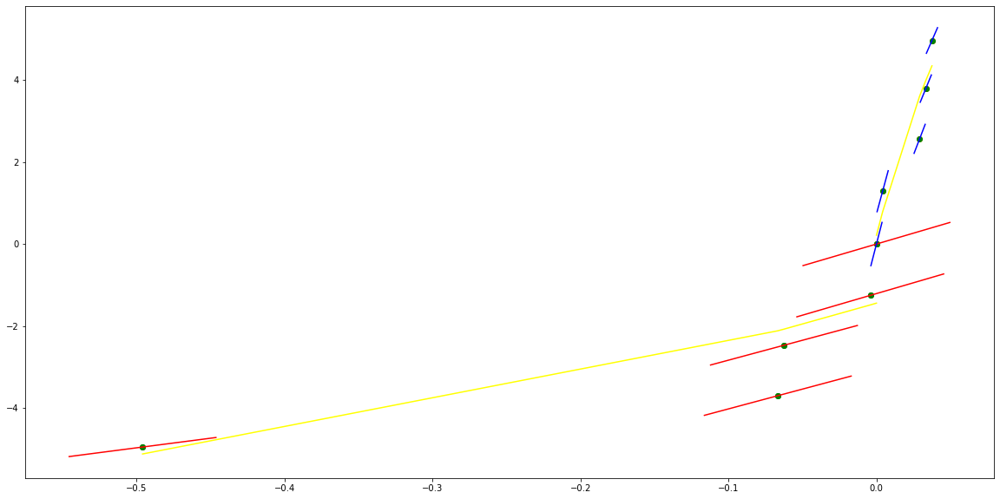

parameters (-490.9081209230992, -493.4944748668414, -111.8318579827039, -0.6508729047424561)
tangent[0]:49.487592442020855
tangent[1]:50.10529014135409
tangent[2]:50.67171356942748
tangent[3]:-107.74464725152636
tangent[4]:-111.8318579827039
parameters (944.9864954945822, -360.5705031508229, 79.21961630642603, 0.2537125893090465)
tangent[0]:79.21961630642603
tangent[1]:76.26384765500987
tangent[2]:65.4264975140301
tangent[3]:52.12285758463709
tangent[4]:50.249964707553104


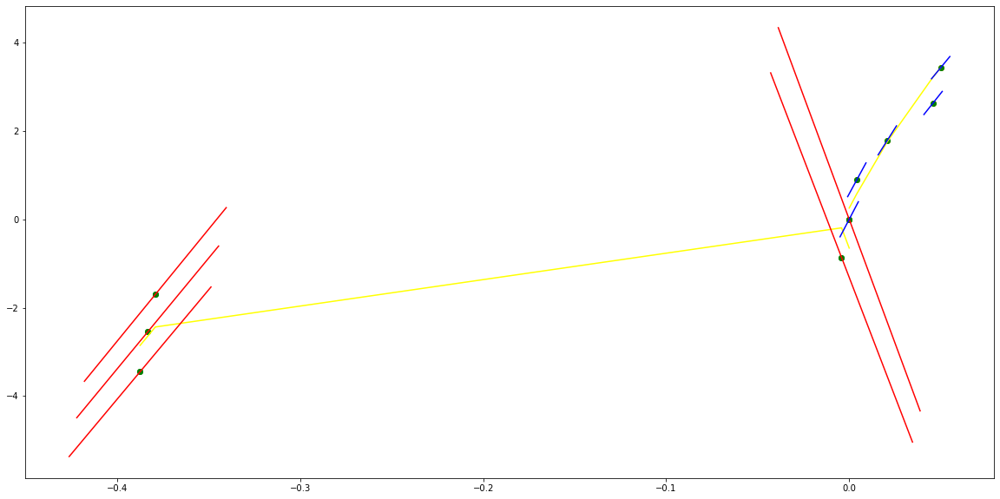

parameters (-0.00753385596545838, -0.024208109771507943, 2.2912573667130975, 0.027718785957003493)
tangent[0]:2.2131390065329297
tangent[1]:2.2830523774902094
tangent[2]:2.310458537771078
tangent[3]:2.315723293029112
tangent[4]:2.2912573667130975
parameters (123.35794009112914, -311.29178316294417, 180.77645421578293, -0.00031888312995183684)
tangent[0]:180.77645421578293
tangent[1]:-80.41199501323118
tangent[2]:153.61411899957844
tangent[3]:163.54058778218283
tangent[4]:173.67204727564425


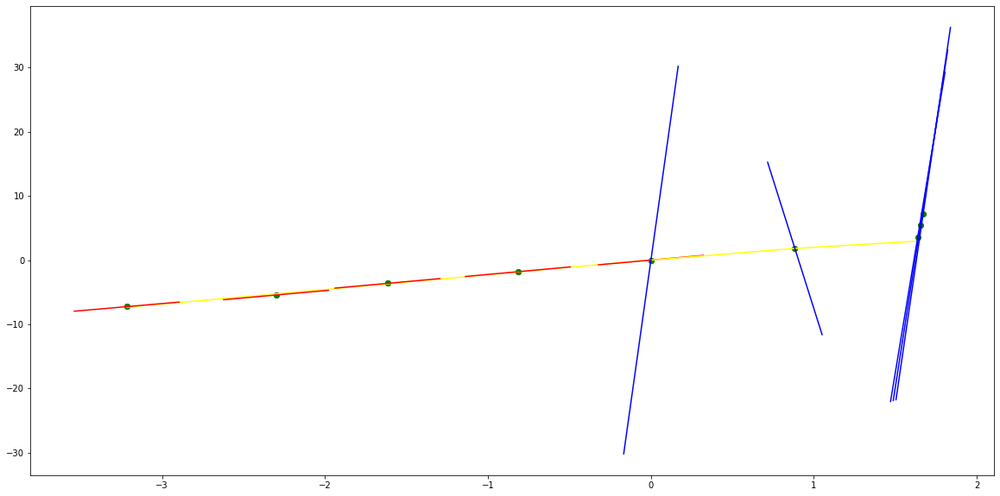

parameters (-0.01662010562092398, -0.13413828069942116, 1.9717309008100417, 0.011809462445729535)
tangent[0]:2.3204795766880633
tangent[1]:2.3307953239148227
tangent[2]:2.2837047394546626
tangent[3]:2.1698035727413667
tangent[4]:1.9717309008100417
parameters (-1200.6233552429453, 2067.260834645426, -874.7070952659501, 0.0001706029038362466)
tangent[0]:-874.7070952659501
tangent[1]:194.78476520780168
tangent[2]:172.14683441216175
tangent[3]:147.5064863509474
tangent[4]:134.4366919345548


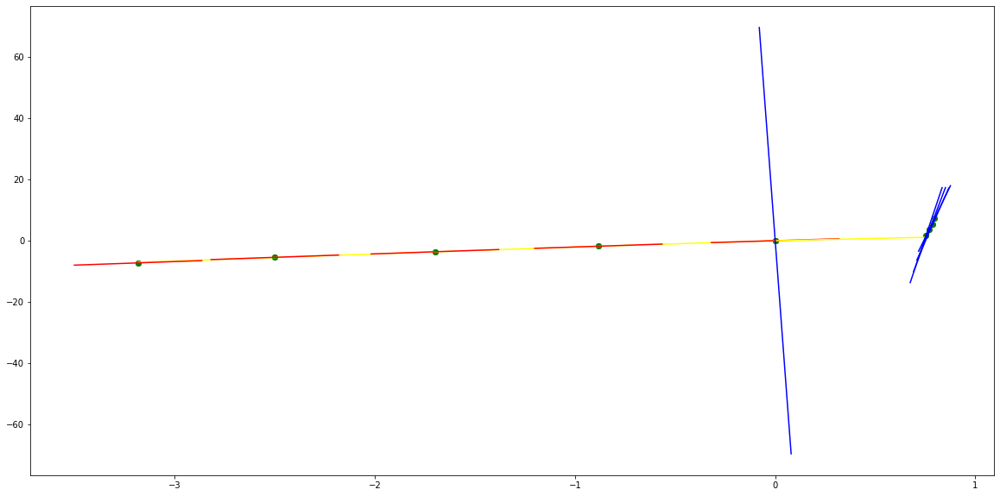

parameters (151.36779595878767, 332.23943397712054, 183.83821950539274, -0.00034631222215933036)
tangent[0]:72.78101673976889
tangent[1]:70.7488066171629
tangent[2]:42.15285522179644
tangent[3]:2.3765640861267627
tangent[4]:183.83821950539274
parameters (1.4348054169419053, -5.864767057767562, 7.192065482309734, -0.179178251572644)
tangent[0]:7.192065482309734
tangent[1]:-0.2330523823996744
tangent[2]:1.0433286510568829
tangent[3]:10.278097901546214
tangent[4]:13.342000733965694


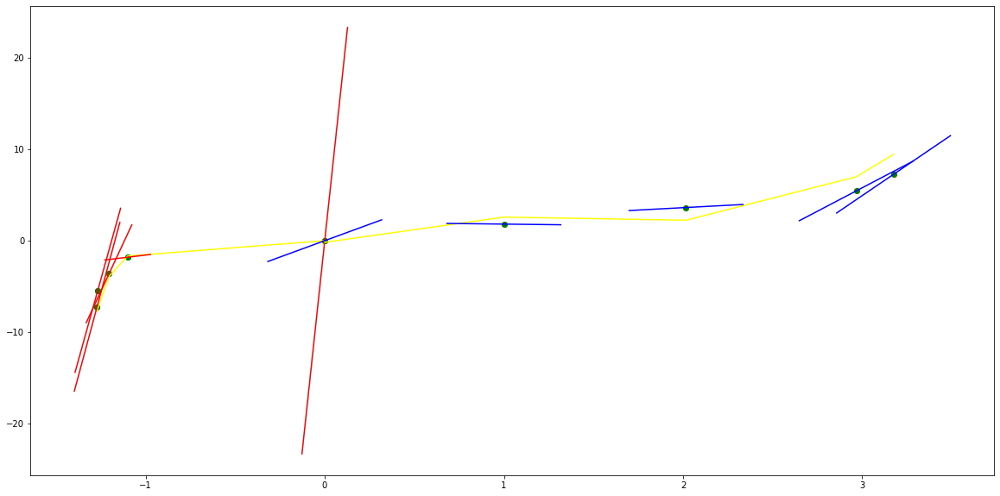

parameters (1.307087791412843, 5.5027021987674365, 7.000850292852322, 0.1855646043925949)
tangent[0]:12.232546217099534
tangent[1]:10.790305214511259
tangent[2]:0.7541799896729167
tangent[3]:-0.13491712882466356
tangent[4]:7.000850292852322
parameters (-17.09911259468088, 53.40195774565159, -33.82426590271455, 0.006873364997461143)
tangent[0]:-33.82426590271455
tangent[1]:21.343606463924992
tangent[2]:21.0627830442972
tangent[3]:21.011742966209034
tangent[4]:20.958921445562332


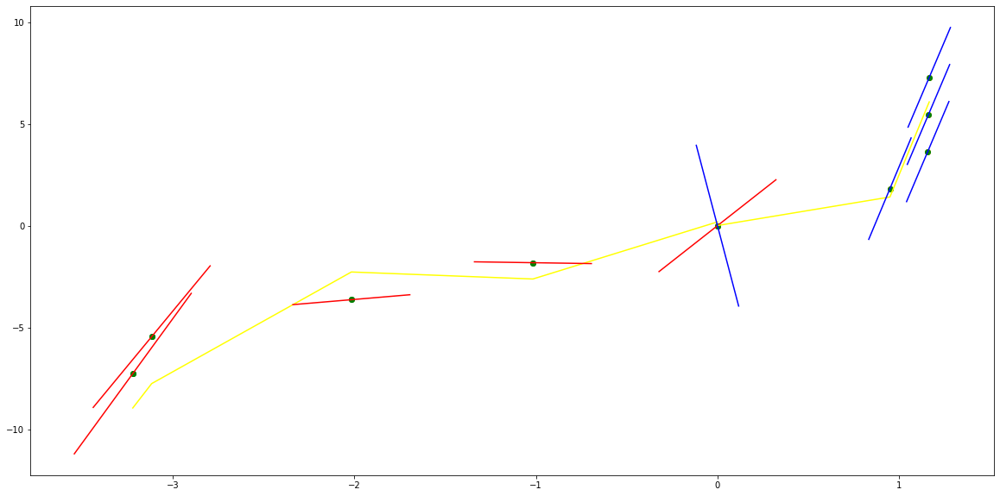

parameters (0.0016540878604365706, -0.009111127533961493, -1.517526976270827, 0.032739216825395163)
tangent[0]:-1.366205718938587
tangent[1]:-1.4157876413485284
tangent[2]:-1.4580263554960036
tangent[3]:-1.4960822476688886
tangent[4]:-1.517526976270827
parameters (-326.09008230102995, 784.6003273357587, -440.43486528059424, 2.6412223359037173e-06)
tangent[0]:-440.43486528059424
tangent[1]:182.36989838507037
tangent[2]:-322.493609860528
tangent[3]:-328.4049162709693
tangent[4]:-334.34876500494005


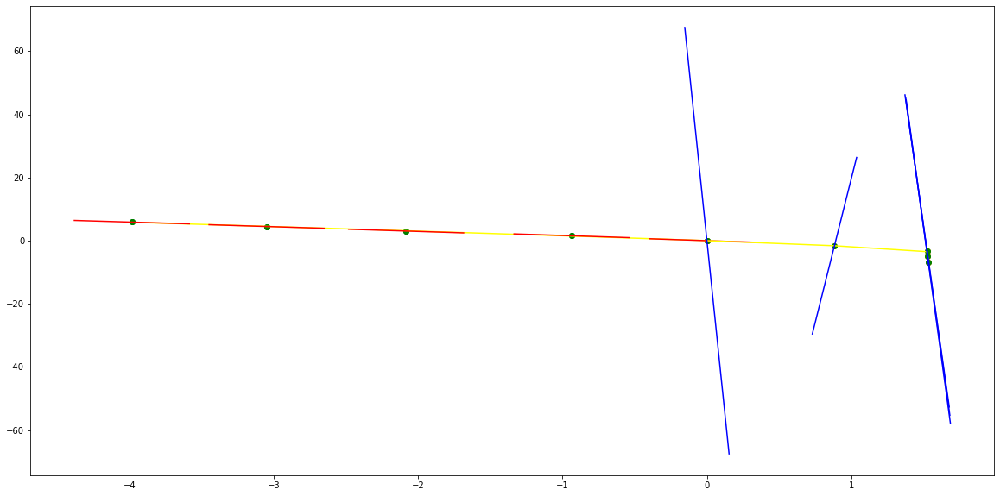

parameters (-0.0002290768602580903, -0.04001768850011749, -1.7072702223086669, 0.05880116412747576)
tangent[0]:-1.4030966516582426
tangent[1]:-1.4758803045890478
tangent[2]:-1.563817633517405
tangent[3]:-1.6371085629826034
tangent[4]:-1.7072702223086669
parameters (2084.250612939215, -3226.054296426403, 1209.0805519391938, 2.6496142766113997e-07)
tangent[0]:1209.0805519391938
tangent[1]:-356.53821186428013
tangent[2]:-349.8796549054423
tangent[3]:-343.0023815146751
tangent[4]:-328.5981828833101


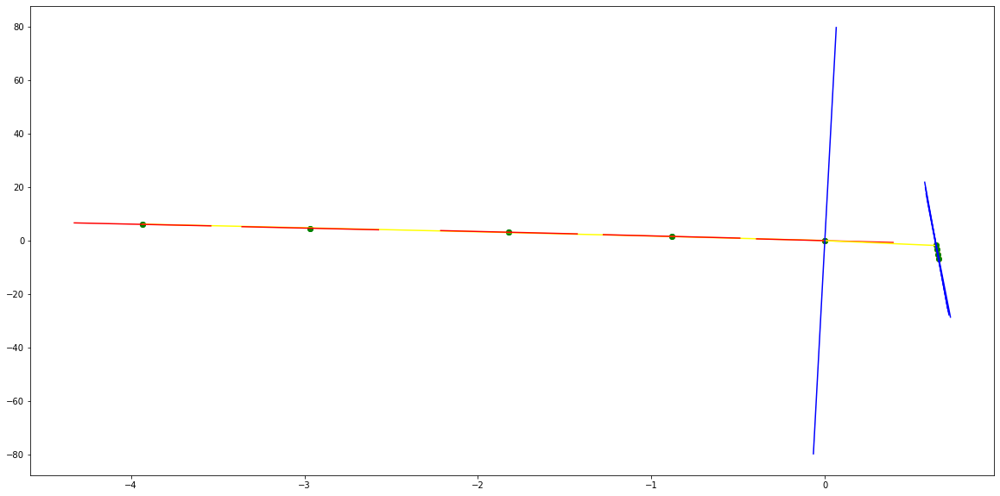

parameters (-101854.59075028168, -5336.753091018632, -471.2487077943483, 0.1246332354546105)
tangent[0]:-381.5064746360655
tangent[1]:-378.2356010705445
tangent[2]:-385.5742199330771
tangent[3]:-432.07798295758397
tangent[4]:-471.2487077943483
parameters (-7856.141235457208, 1402.8462968221393, -224.84046628731957, -0.6805921564332081)
tangent[0]:-224.84046628731957
tangent[1]:-213.55838474274626
tangent[2]:-176.61849571433046
tangent[3]:-152.77008986274421
tangent[4]:-142.01577648490644


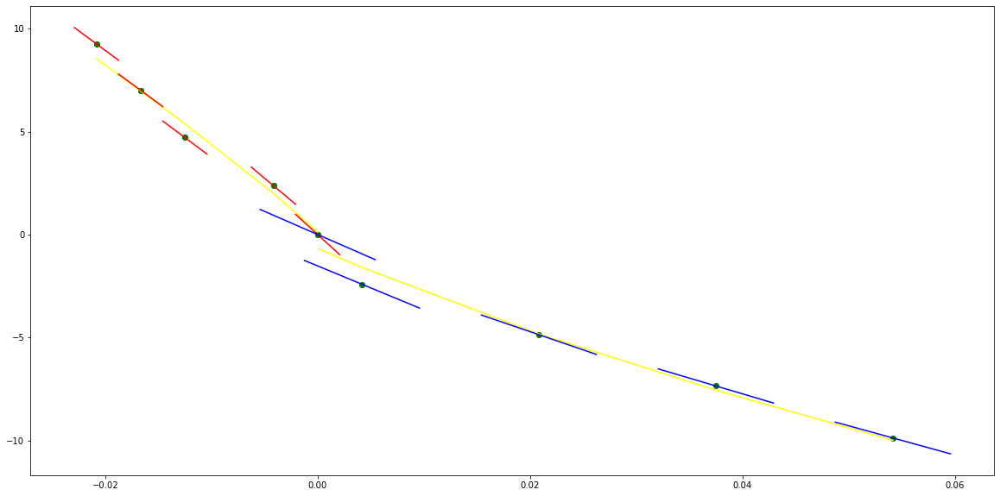

parameters (46512.860401113176, 5010.278168814149, 270.4654205538821, -0.2556715913490279)
tangent[0]:160.74966448749848
tangent[1]:95.19725697692604
tangent[2]:167.01136964655018
tangent[3]:196.6535286438217
tangent[4]:270.4654205538821
parameters (49695.32592803292, -7132.450084289276, 496.8566444790894, -0.016135551695946007)
tangent[0]:496.8566444790894
tangent[1]:440.00351784632215
tangent[2]:388.33959603713083
tangent[3]:300.5179815035142
tangent[4]:264.38136428053673


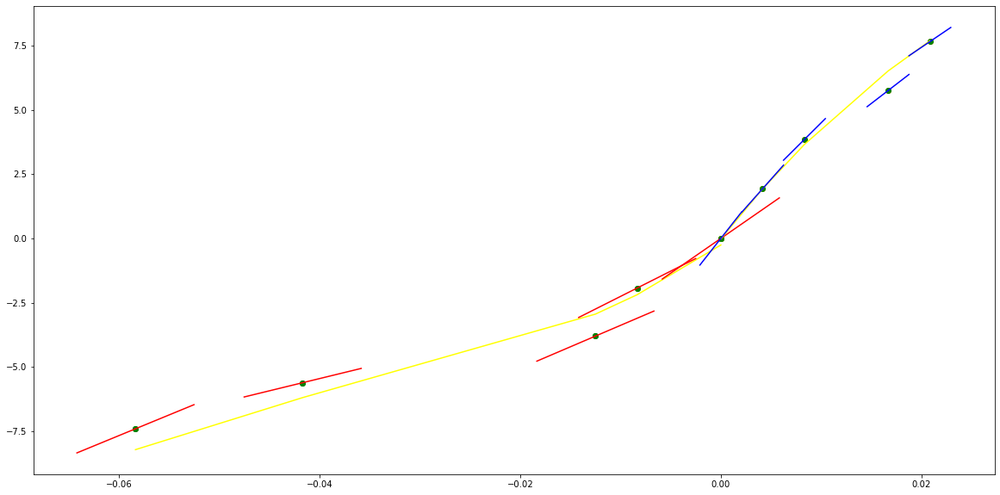

parameters (-0.013892672209000017, -0.13826181956981584, -3.0854341513049124, -0.035237105099367026)
tangent[0]:-2.6515774436067168
tangent[1]:-2.7090265494537173
tangent[2]:-2.7992035821983783
tangent[3]:-2.9205299823601005
tangent[4]:-3.0854341513049124
parameters (-2949.2864258190752, 3670.034783352869, -1141.3870824768067, 2.9632693791155023e-05)
tangent[0]:-1141.3870824768067
tangent[1]:-161.9717305307165
tangent[2]:-180.390758124777
tangent[3]:-199.11252140035435
tangent[4]:-277.0852419772539


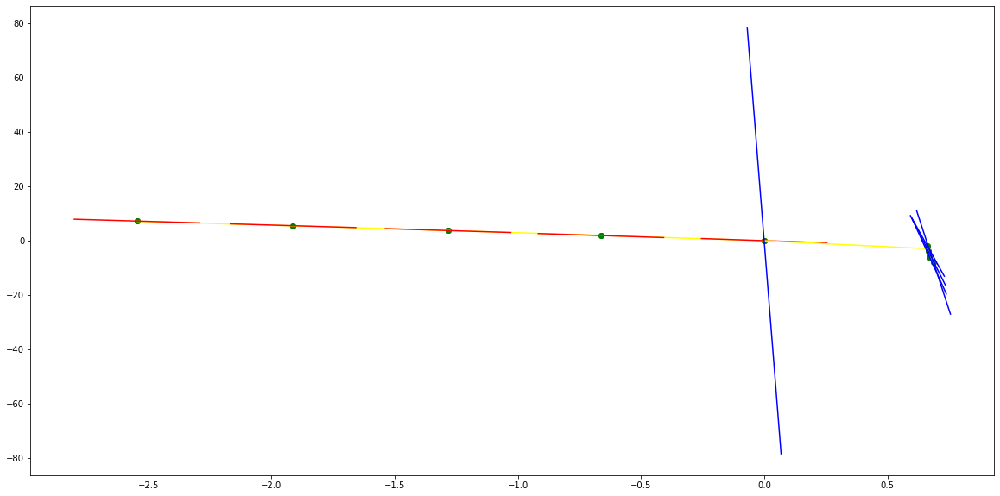

parameters (177352.05361237083, 13747.314362994577, -100.46057727135202, -0.07111986566107406)
tangent[0]:-449.7688475701283
tangent[1]:-442.3364139885594
tangent[2]:-410.9142644428665
tangent[3]:-361.0096612154176
tangent[4]:-100.46057727135202
parameters (-7833.3791808237, 1434.7938099367773, -226.9289444088999, -0.6900257530752518)
tangent[0]:-226.9289444088999
tangent[1]:-215.379426576659
tangent[2]:-177.34621161091692
tangent[3]:-152.3664770827416
tangent[4]:-140.4428967531067


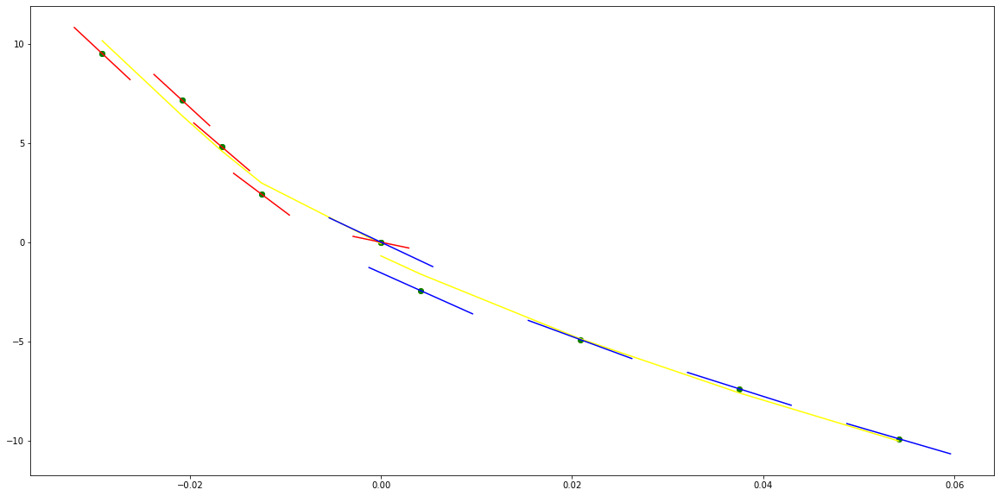

parameters (-6152.391869680281, -1554.9110720021247, 4.221694114992864, 0.03571433268608695)
tangent[0]:134.73822502556263
tangent[1]:118.51689774185272
tangent[2]:113.5698622926032
tangent[3]:107.98185014629593
tangent[4]:4.221694114992864
parameters (6625.224710787075, -1919.707722336919, 210.04471109701296, 0.3890704657565073)
tangent[0]:210.04471109701296
tangent[1]:194.39098593849158
tangent[2]:114.96899285984885
tangent[3]:104.1491167695512
tangent[4]:94.016798670377


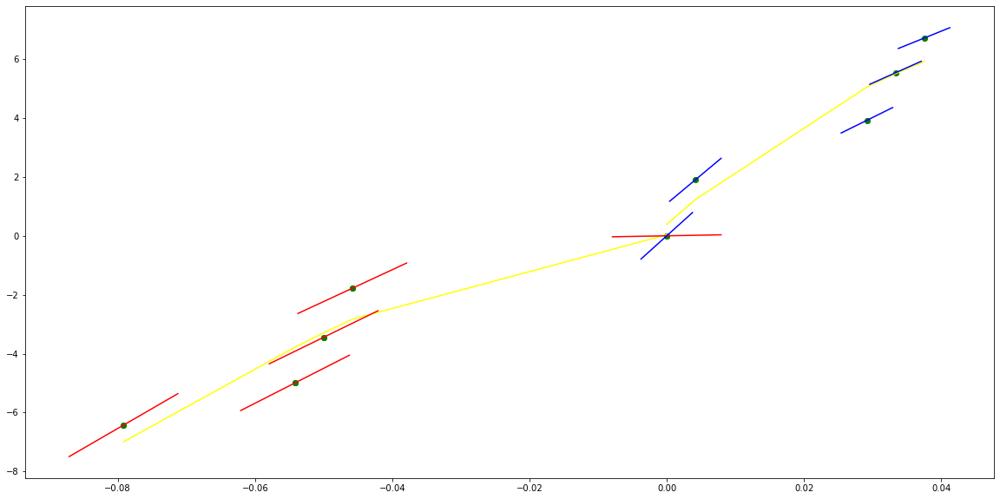

parameters (-11863.183120644086, -3122.70737449052, -90.2170886586905, -0.2767392574028936)
tangent[0]:181.44660681464063
tangent[1]:183.22809571572503
tangent[2]:177.99780235401852
tangent[3]:108.22220699786675
tangent[4]:-90.2170886586905
parameters (13622.899874841005, -1672.8097805468274, 183.18551205607585, 1.4360086937504688)
tangent[0]:183.18551205607585
tangent[1]:169.95395490885315
tangent[2]:158.144341350284
tangent[3]:127.09099975402384
tangent[4]:141.78357416571615


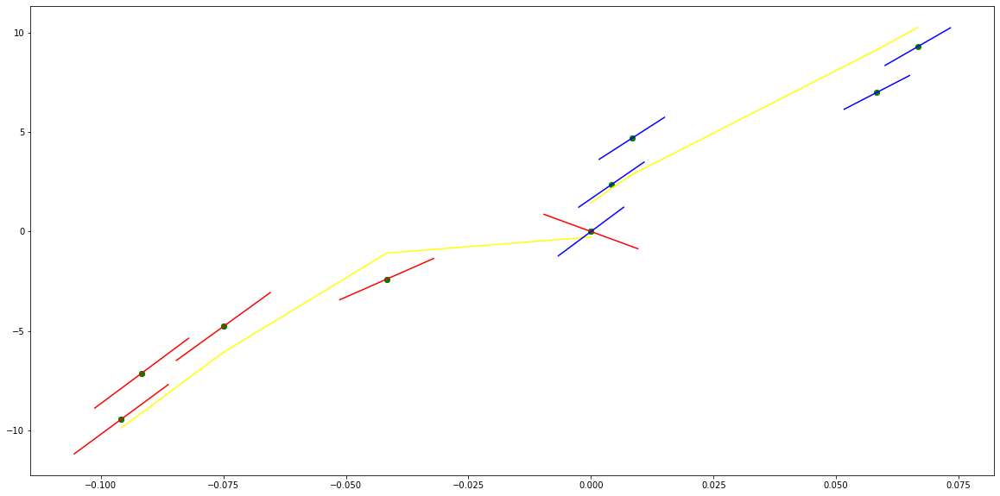

parameters (7863.639366592145, 1963.0463300024978, 232.36951273245623, 0.567545224269165)
tangent[0]:109.73812020826392
tangent[1]:127.7126730784803
tangent[2]:137.9262897998318
tangent[3]:148.9615200446916
tangent[4]:232.36951273245623
parameters (9652.932098038047, -1476.8857654470783, 146.86782428788146, 1.244347170469326)
tangent[0]:146.86782428788146
tangent[1]:135.06229564307012
tangent[2]:124.26491276238106
tangent[3]:73.10469190484392
tangent[4]:101.82232452753934


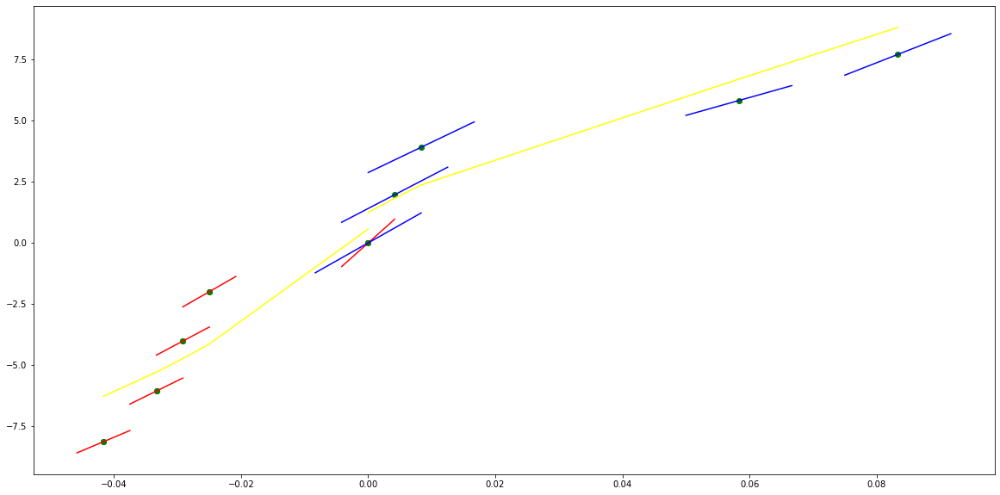

parameters (80.53915533326655, 95.13908791080819, 43.2921788460439, -0.95588865616611)
tangent[0]:10.261615296995949
tangent[1]:27.276256505224787
tangent[2]:35.7833395730685
tangent[3]:41.7233684553244
tangent[4]:43.2921788460439
parameters (9504.66917441945, -4363.476916385125, 382.43065061305276, 0.014914318521308183)
tangent[0]:382.43065061305276
tangent[1]:346.56054805347816
tangent[2]:311.688925327931
tangent[3]:244.89938555309456
tangent[4]:212.99749671109475


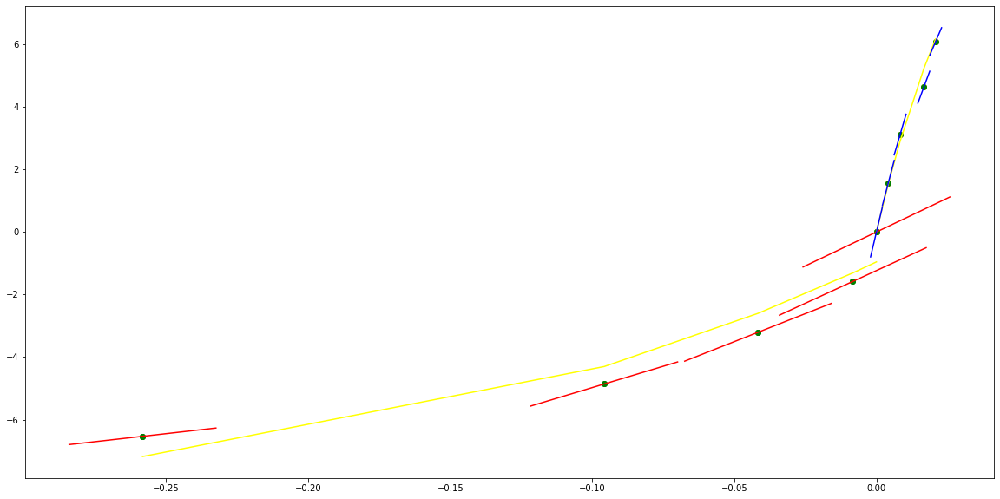

parameters (0.02331932353169088, 0.11689332278420587, -2.6669915410538665, 0.06133471703217513)
tangent[0]:-2.8374794031884116
tangent[1]:-2.8622503035004065
tangent[2]:-2.8515736995127763
tangent[3]:-2.7717785428883652
tangent[4]:-2.6669915410538665
parameters (-320.6390670530821, -737.1156295009414, 350.243620528356, -2.2735541717245197e-08)
tangent[0]:350.243620528356
tangent[1]:-412.1197236307057
tangent[2]:-421.5529975696735
tangent[3]:-431.0196767556579
tangent[4]:-440.5174773434343


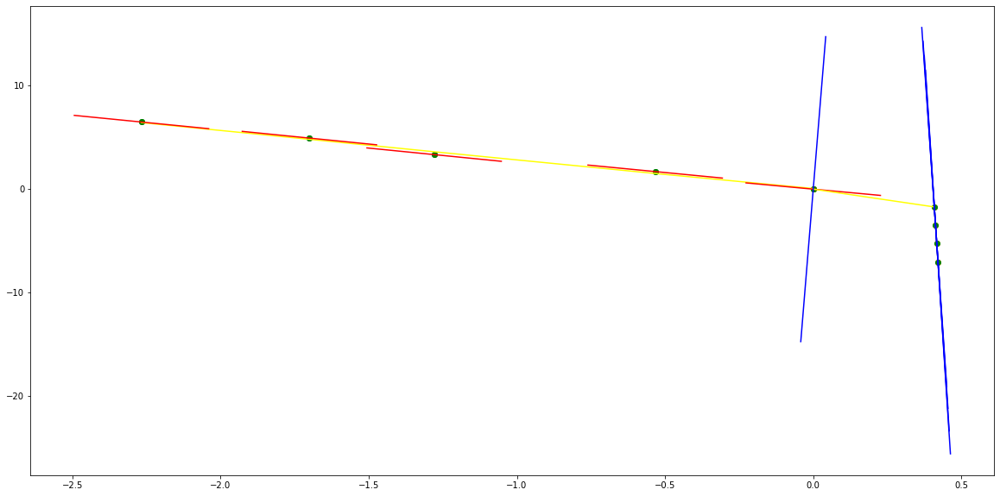

parameters (-239574.3936441123, -21046.109809695372, -745.005408952443, -0.304507781265275)
tangent[0]:-180.03404049256983
tangent[1]:-243.1076984857972
tangent[2]:-331.1531607307363
tangent[3]:-582.0869593338778
tangent[4]:-745.005408952443
parameters (-8185.644460629885, 1492.101588625072, -230.27034915627684, -0.6954069555386376)
tangent[0]:-230.27034915627684
tangent[1]:-218.261578382099
tangent[2]:-178.75849452361243
tangent[3]:-152.89591757767874
tangent[4]:-140.67662711454938


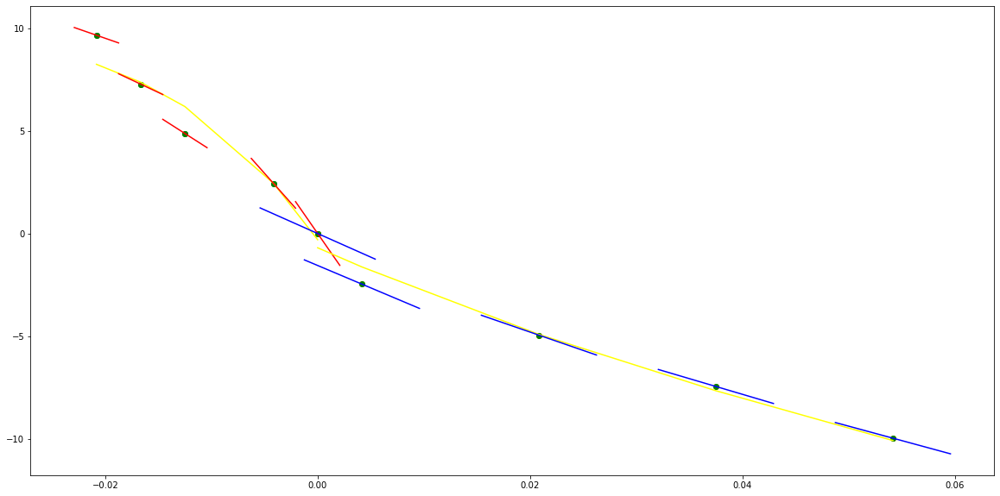

parameters (-0.0035901073655085114, 0.17559196329345914, 0.5300857180949665, 0.000617741388273052)
tangent[0]:0.006186659157883523
tangent[1]:0.13855648125028813
tangent[2]:0.26828757442904394
tangent[3]:0.3998701486816193
tangent[4]:0.5300857180949665
parameters (-379.2801298125357, 352.8001557952709, -76.96248301200018, -0.0003724149201388665)
tangent[0]:-76.96248301200018
tangent[1]:29.298291265035658
tangent[2]:28.78126927469134
tangent[3]:28.224870914259668
tangent[4]:25.603791752844046


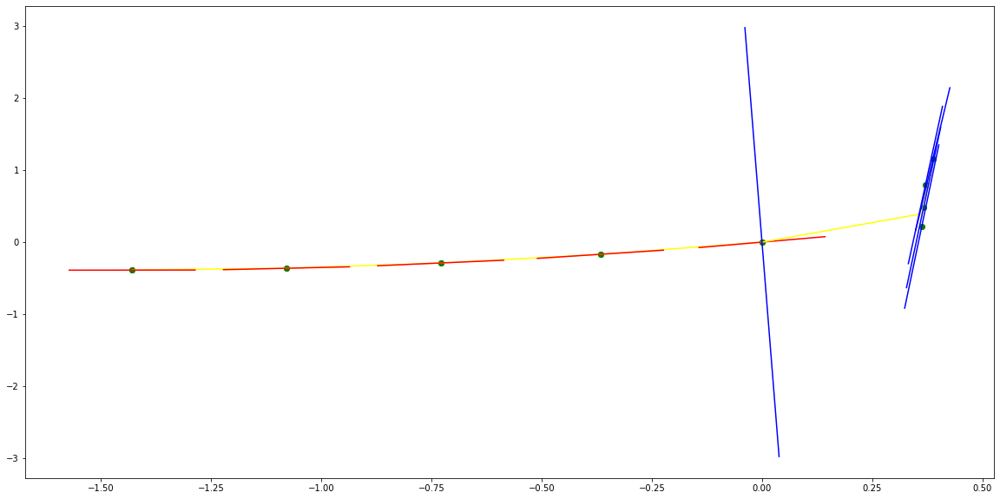

parameters (-39.625773906343284, -65.0097588202415, -6.90765119076745, 0.03639724805084597)
tangent[0]:28.64269369149167
tangent[1]:27.8792911117507
tangent[2]:24.783790749442996
tangent[3]:22.34446065539643
tangent[4]:-6.90765119076745
parameters (197.0764154136197, -173.3658167784278, 65.75902784302201, 1.3001289008578574)
tangent[0]:65.75902784302201
tangent[1]:64.32446316499588
tangent[2]:49.900519280781374
tangent[3]:27.051940849913002
tangent[4]:16.027947343861797


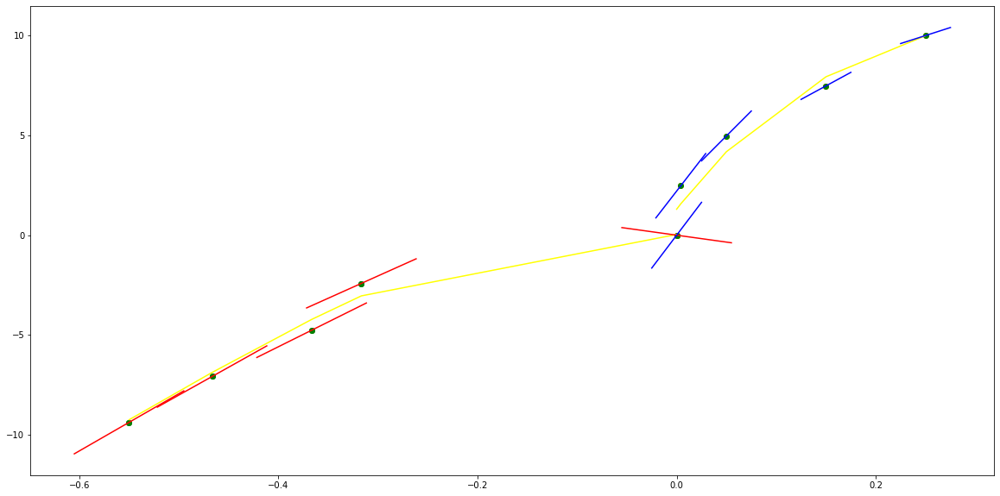

parameters (-112.86584666706315, 181.46630131196605, 124.09115142608897, 0.08665958815289122)
tangent[0]:84.41191576368387
tangent[1]:96.68469624419879
tangent[2]:105.0980274448894
tangent[3]:116.38322048048285
tangent[4]:124.09115142608897
parameters (3392.032120391438, -867.6907127472177, 167.76810799003675, 0.8318489683366168)
tangent[0]:167.76810799003675
tangent[1]:160.71347019767018
tangent[2]:121.22918653432484
tangent[3]:106.43927761825076
tangent[4]:93.82033816324119


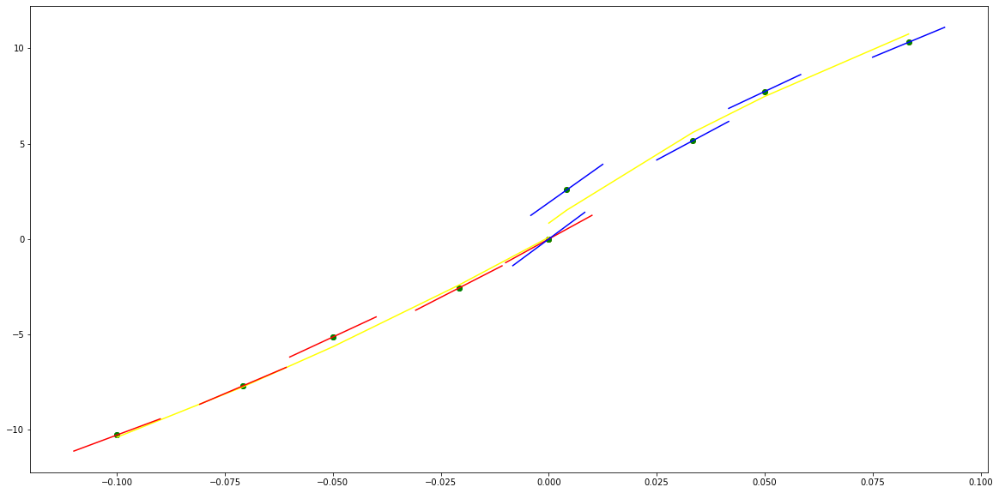

parameters (-0.9795367599132927, -3.0718126347028445, 101.04052897333129, -0.00013963529546924102)
tangent[0]:101.53208884533095
tangent[1]:101.41302660626391
tangent[2]:101.29141357184534
tangent[3]:101.16724372089305
tangent[4]:101.04052897333129
parameters (-3313.5928110779773, -75.4976410388373, 180.84116763526495, -0.08690588854825392)
tangent[0]:180.84116763526495
tangent[1]:177.40047997910122
tangent[2]:170.85329906255188
tangent[3]:161.19962488561694
tangent[4]:148.4394574482964


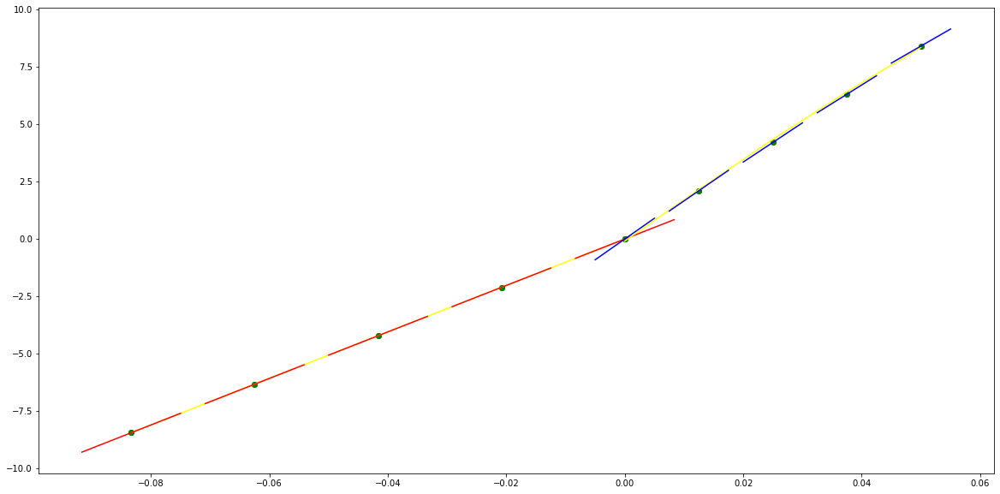

parameters (10.394321062211436, 9.439805995801137, 42.18685434150754, -0.012333868497793714)
tangent[0]:39.68548750829345
tangent[1]:40.09676019286733
tangent[2]:40.50753380425389
tangent[3]:41.387050009814615
tangent[4]:42.18685434150754
parameters (152734.85812648383, -15501.866180095083, 535.9927961556193, 0.18420827008036814)
tangent[0]:535.9927961556193
tangent[1]:414.75645677952394
tangent[2]:309.4559109777816
tangent[3]:131.3176140947396
tangent[4]:201.01512086256162


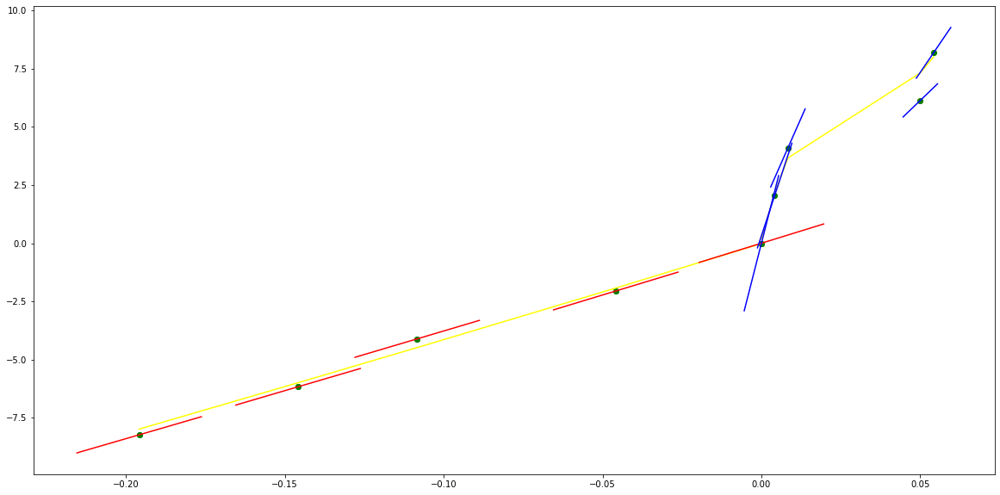

parameters (3.8291063461698456, 8.858228488679446, 18.90840699351302, -0.21836151296919404)
tangent[0]:12.213110367758578
tangent[1]:13.08491628733126
tangent[2]:14.582424197139328
tangent[3]:17.187583006156956
tangent[4]:18.90840699351302
parameters (1823.2716826387116, -1072.872452169963, 201.33685946106027, 2.505379070440067)
tangent[0]:201.33685946106027
tangent[1]:192.49051770601835
tangent[2]:183.83618505315843
tangent[3]:175.3697067580481
tangent[4]:121.42646515225317


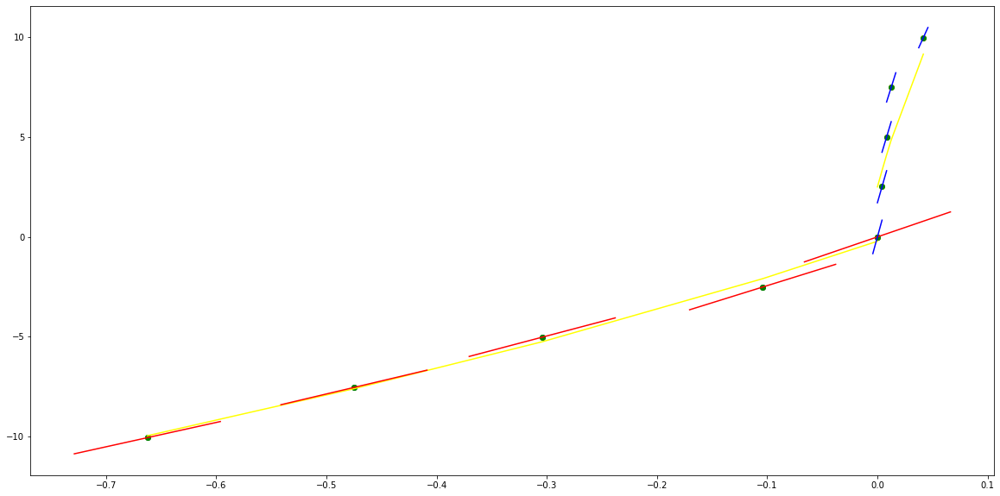

parameters (140904.1736065097, 9939.565962612423, -166.6369740633728, -0.17431491185221928)
tangent[0]:-386.8442024110309
tangent[1]:-397.3158243717047
tangent[2]:-380.537624336249
tangent[3]:-349.07729175063196
tangent[4]:-166.6369740633728
parameters (-15542.999569076514, 3003.5653173673304, -341.7267238014178, -0.39749083246248373)
tangent[0]:-341.7267238014178
tangent[1]:-317.50467120421195
tangent[2]:-254.55889525835892
tangent[3]:-220.69158212506971
tangent[4]:-182.03135443090957


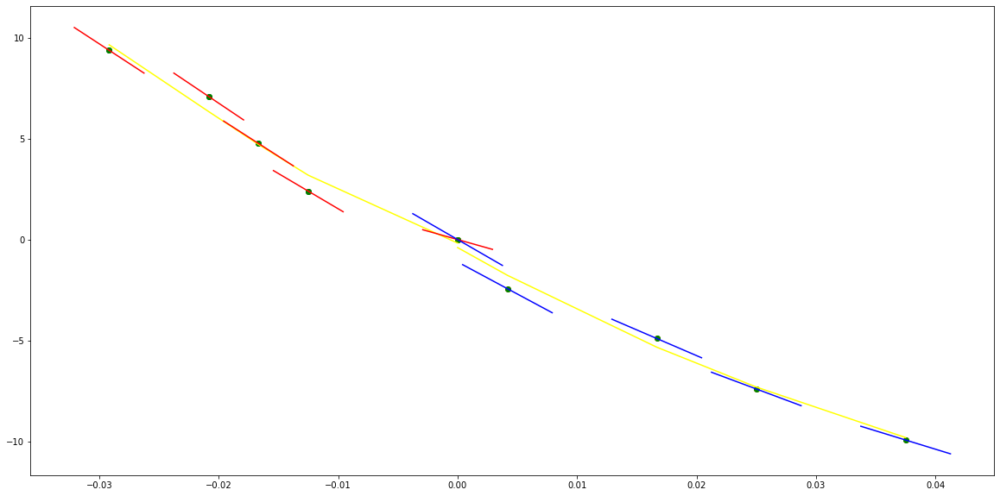

parameters (-40350.91723249447, -6928.43846425822, -473.34750969851194, 0.8755457704737664)
tangent[0]:-92.5364135888048
tangent[1]:-237.2057681851051
tangent[2]:-366.2839228414506
tangent[3]:-417.7078500810036
tangent[4]:-473.34750969851194
parameters (-12822.538446104081, 2320.4682256438878, -226.07926447915455, -1.2357297996684262)
tangent[0]:-226.07926447915455
tangent[1]:-207.40842968946754
tangent[2]:-159.4146527728503
tangent[3]:-87.65084303860715
tangent[4]:-106.47018772569189


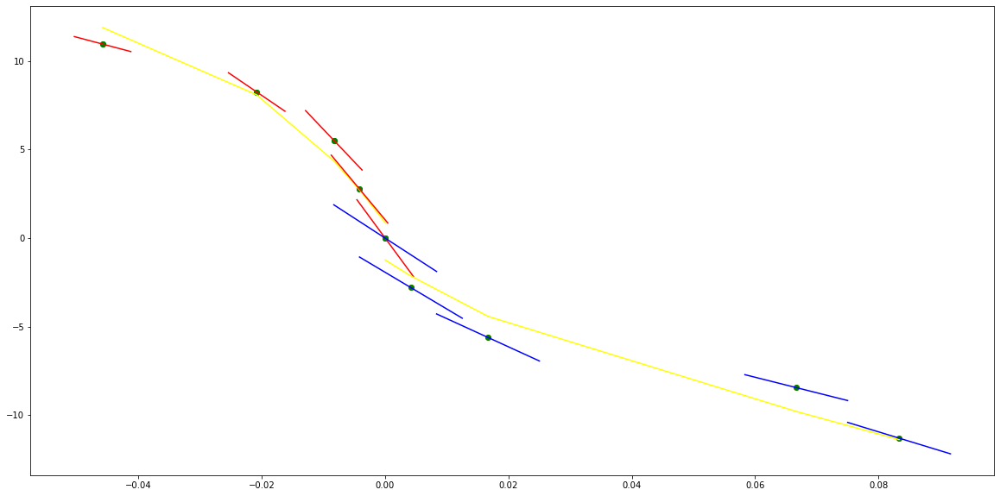

parameters (3767.742184979825, 411.1576191932328, 48.26789232600811, 0.00416388071174668)
tangent[0]:106.1811921036163
tangent[1]:98.81388909348348
tangent[2]:43.68366716177586
tangent[3]:41.02641865708634
tangent[4]:48.26789232600811
parameters (1957.3482137675453, -1048.6852183262226, 176.58864864990122, 0.6388949270965372)
tangent[0]:176.58864864990122
tangent[1]:167.9508675717251
tangent[2]:135.44267927427418
tangent[3]:113.2013634416286
tangent[4]:106.19482005226635


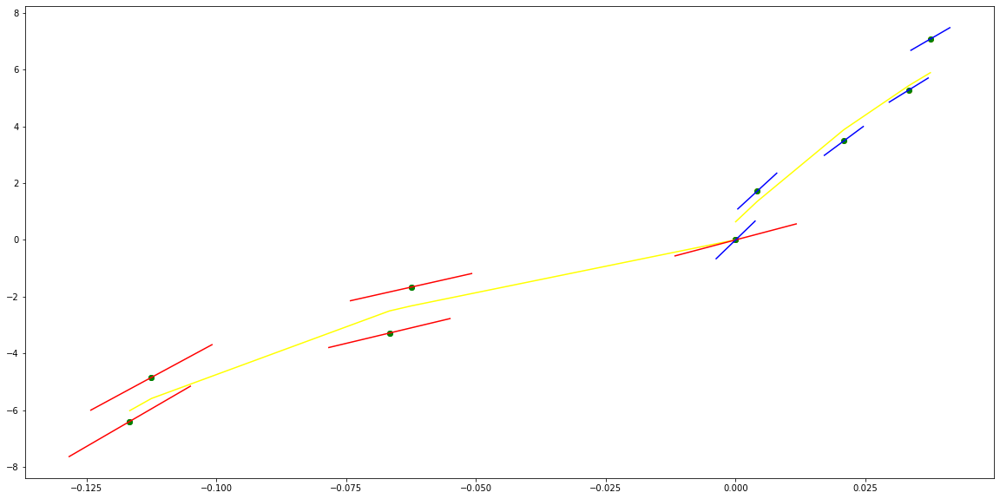

parameters (228443.3888723058, 13831.94337837343, 395.7616489463378, 0.027961327198992567)
tangent[0]:171.90895520399783
tangent[1]:125.06475395433625
tangent[2]:212.82704597042985
tangent[3]:292.3862297724613
tangent[4]:395.7616489463378
parameters (-157.2736264414285, 72.71312648000423, 21.011986554815678, 0.5747081918192747)
tangent[0]:21.011986554815678
tangent[1]:21.609785105523564
tangent[2]:29.854284820754287
tangent[3]:31.695402494950024
tangent[4]:32.14355589552113


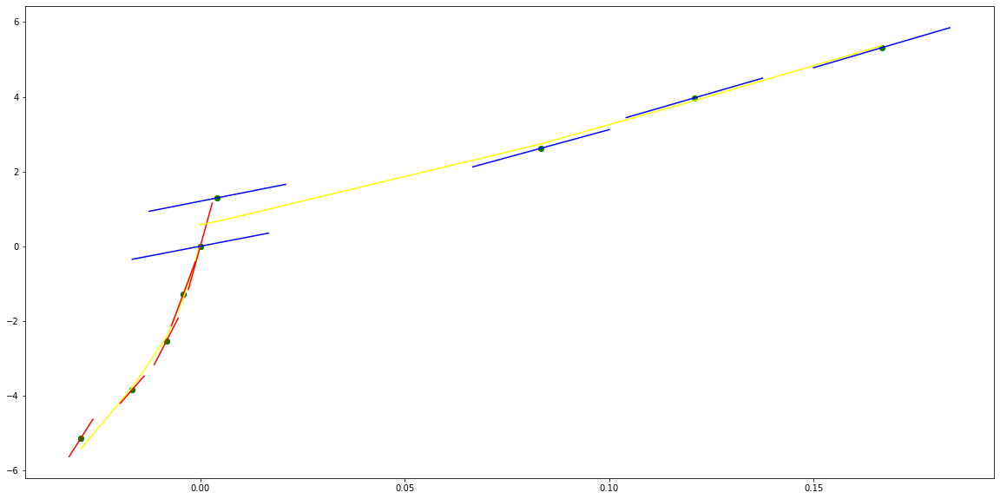

parameters (0.10609429966065285, 0.6201203306066674, 5.090144108687953, -0.1425858772648568)
tangent[0]:3.8885595804233573
tangent[1]:4.0140151327679305
tangent[2]:4.295583413082288
tangent[3]:4.724996049316756
tangent[4]:5.090144108687953
parameters (126.80010775108366, -152.20923422325367, 62.14289567915946, 2.5124817105436774)
tangent[0]:62.14289567915946
tangent[1]:60.8809891501314
tangent[2]:59.63259115741666
tangent[3]:58.39710237408644
tangent[4]:34.560171167412435


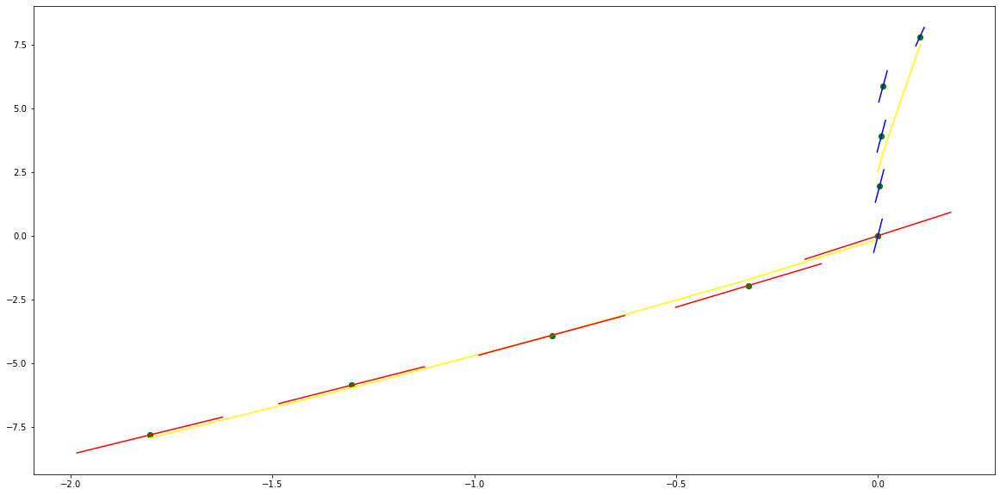

parameters (3.1089255928486366, 7.641946934408021, 12.936648523342498, -0.14373775674592873)
tangent[0]:6.824372435684225
tangent[1]:6.858474111410875
tangent[2]:8.448343283599828
tangent[3]:10.90610745175458
tangent[4]:12.936648523342498
parameters (-459.12497398820574, 157.05234892566287, 69.86707427203959, 0.8770986556253779)
tangent[0]:69.86707427203959
tangent[1]:71.15203196272968
tangent[2]:80.56356055065467
tangent[3]:85.20533000860918
tangent[4]:87.08625005095944


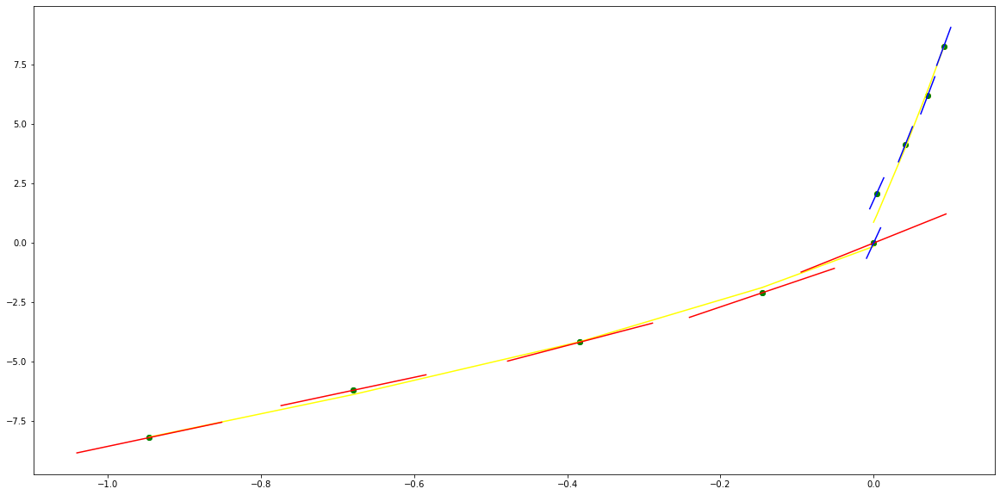

parameters (0.010736945798269592, 0.05595020459673189, -1.3713184044995028, 3.057055012442468e-07)
tangent[0]:-1.4194678550506876
tangent[1]:-1.4598886890558722
tangent[2]:-1.4681849838456258
tangent[3]:-1.4404747695262217
tangent[4]:-1.3713184044995028
parameters (-328.10316908700906, 561.0184217405907, -230.9695237831354, -0.0005128491985672114)
tangent[0]:-230.9695237831354
tangent[1]:77.9293263208566
tangent[2]:-138.03206988317743
tangent[3]:-141.98703100260627
tangent[4]:-145.97521358547783


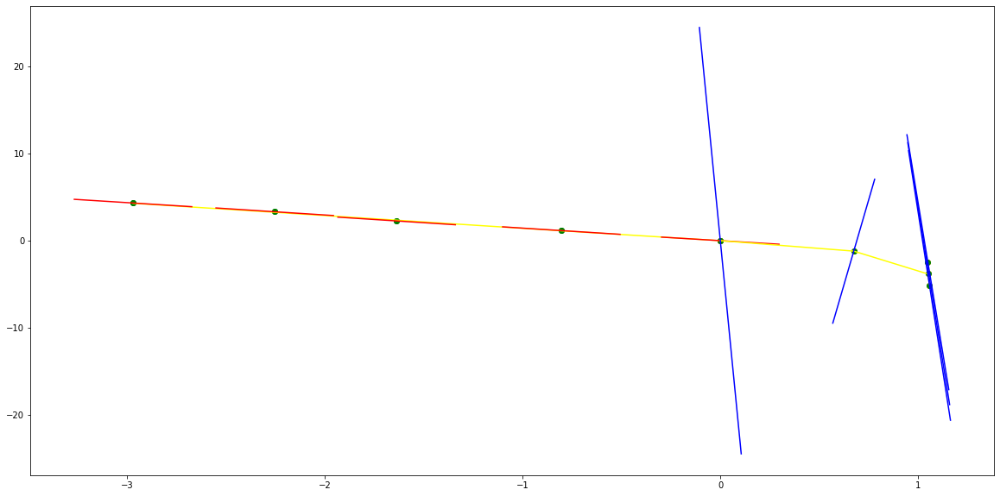

parameters (30959.64155598571, 2624.901486015072, -221.07038296477552, -0.05674935707390297)
tangent[0]:-292.8653242106211
tangent[1]:-295.17799503956286
tangent[2]:-282.7681158045754
tangent[3]:-272.18058813578403
tangent[4]:-221.07038296477552
parameters (-16002.102100653992, 3090.2924159400836, -354.3164318357625, -0.41021897508006305)
tangent[0]:-354.3164318357625
tangent[1]:-329.3955110152451
tangent[2]:-264.6402429354315
tangent[3]:-229.80575247748453
tangent[4]:-190.05336887739026


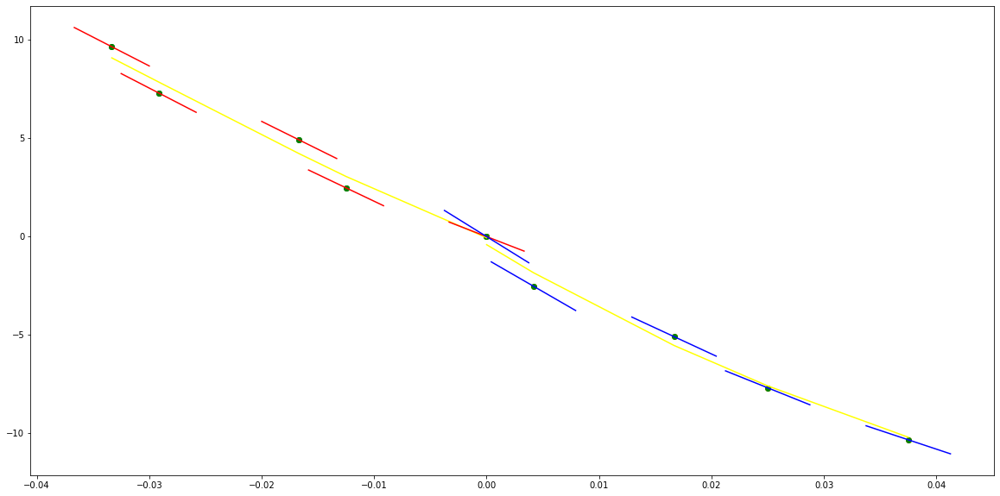

parameters (5003.344208716343, 900.0249183197402, -149.8291692683045, 0.005633293174077136)
tangent[0]:-200.40147349417725
tangent[1]:-203.7562546468392
tangent[2]:-198.7723444441456
tangent[3]:-180.81504488092298
tangent[4]:-149.8291692683045
parameters (-1804.341375063442, 441.19655703984813, -192.03445202307716, -0.1581311101597908)
tangent[0]:-192.03445202307716
tangent[1]:-178.8312839485777
tangent[2]:-164.6655398295566
tangent[3]:-158.02950788212087
tangent[4]:-156.09213123833447


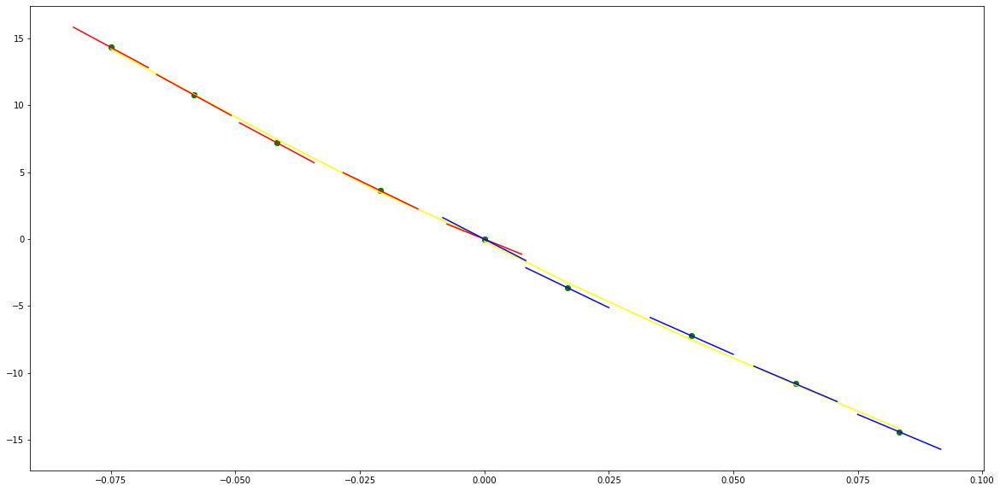

parameters (88.40642864447247, 78.98450633340991, 22.9523780915369, -0.41373044719371116)
tangent[0]:5.555771609694698
tangent[1]:17.981479194062928
tangent[2]:18.57052162925799
tangent[3]:21.019205946628748
tangent[4]:22.9523780915369
parameters (1107.292872091627, -442.38077436883833, 69.53481160642896, 0.2360387971232354)
tangent[0]:69.53481160642896
tangent[1]:65.90569096440353
tangent[2]:55.711271843825955
tangent[3]:49.49194702315884
tangent[4]:31.356536887608648


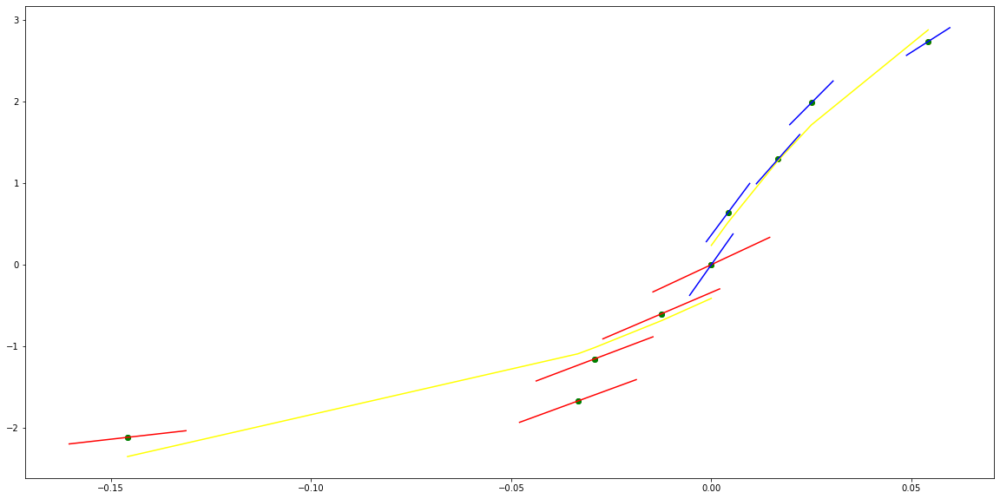

parameters (112956.58488521112, 12459.722673531625, 475.796035002919, -0.24276707236246892)
tangent[0]:120.24994909792736
tangent[1]:37.25177941269487
tangent[2]:291.6730362048307
tangent[3]:377.8408030470041
tangent[4]:475.796035002919
parameters (2604.650919842611, 984.9859306813796, 51.432029650905676, 0.8167629551808538)
tangent[0]:51.432029650905676
tangent[1]:59.77658300557198
tangent[2]:125.7790977959928
tangent[3]:192.93523917143375
tangent[4]:205.07852395298374


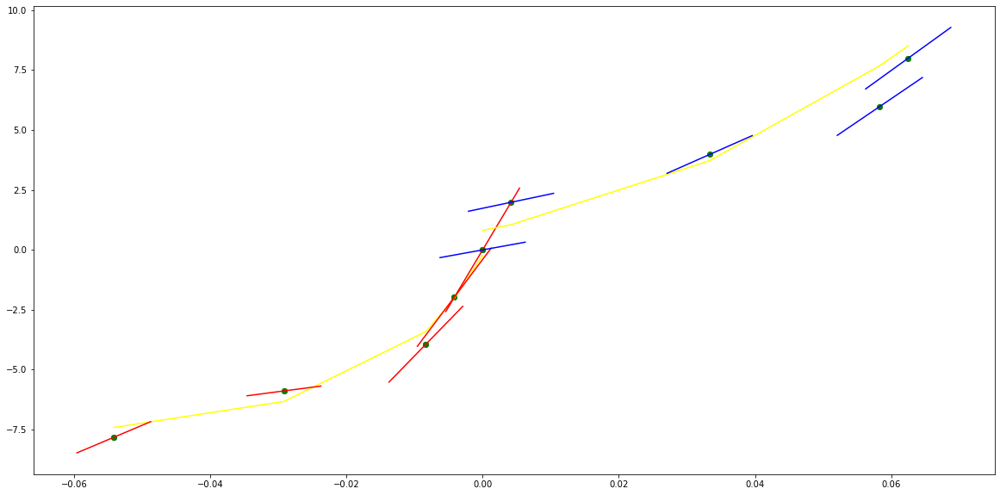

parameters (-43703.74829165135, -6591.63320338466, -79.29369159478745, 0.21526814949779322)
tangent[0]:252.0915165562934
tangent[1]:249.51430007601851
tangent[2]:242.38613876346017
tangent[3]:230.70361055365788
tangent[4]:-79.29369159478745
parameters (159464.88516993652, -18811.18090430665, 708.5013891311581, -0.2890476379363591)
tangent[0]:708.5013891311581
tangent[1]:560.0357991711321
tangent[2]:428.2134415621224
tangent[3]:312.97103144689964
tangent[4]:-28.549994627993783


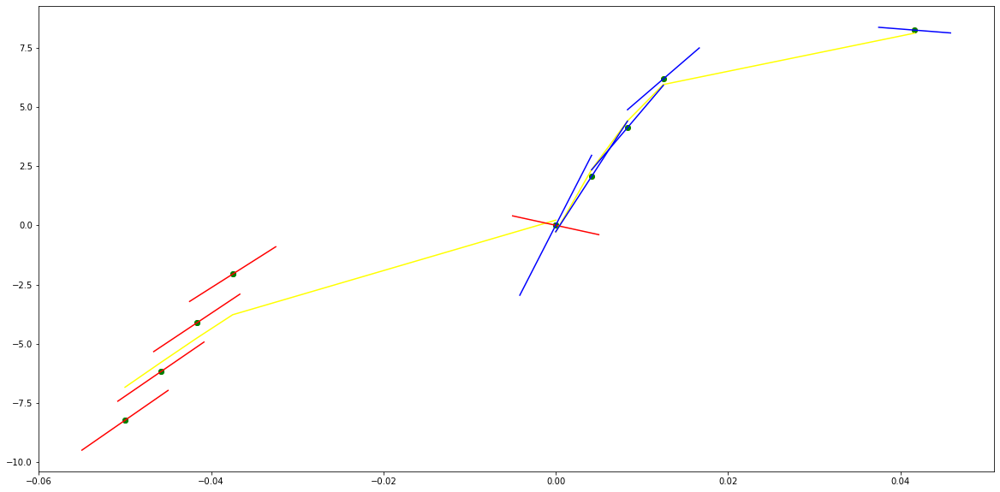

parameters (0.0074017657053768735, 0.06525254306803459, -2.993222169672014, 0.14544343004393917)
tangent[0]:-3.060510423606531
tangent[1]:-3.1626318611139888
tangent[2]:-3.181400999358129
tangent[3]:-3.122901471266374
tangent[4]:-2.993222169672014
parameters (-13.838615881971323, 58.63213792390377, -43.20955738522043, -0.0008287432685128119)
tangent[0]:-43.20955738522043
tangent[1]:23.819154145037423
tangent[2]:-118.66883195193282
tangent[3]:-124.1188069114192
tangent[4]:-129.66120511744765


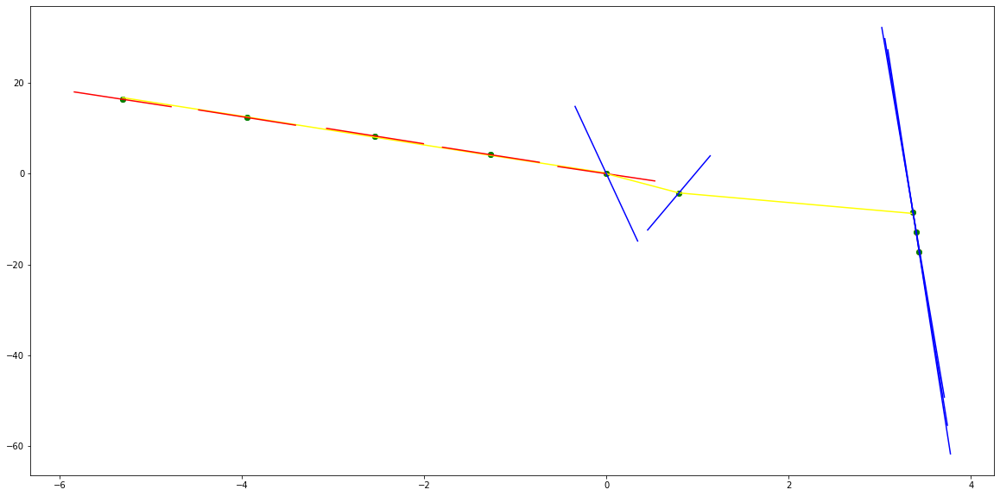

parameters (-0.028248966823174747, -0.40738675550358255, -4.760056898264298, 0.23999550752681015)
tangent[0]:-2.8021188789839364
tangent[1]:-2.9857775056109737
tangent[2]:-3.4400919013874574
tangent[3]:-4.165307713980391
tangent[4]:-4.760056898264298
parameters (10.294391696464709, -102.48359715081283, 193.6694581503136, 5.9362819370888065e-08)
tangent[0]:193.6694581503136
tangent[1]:-129.06607873514062
tangent[2]:-130.57489129994323
tangent[3]:-132.01507595934825
tangent[4]:-133.38667283100986


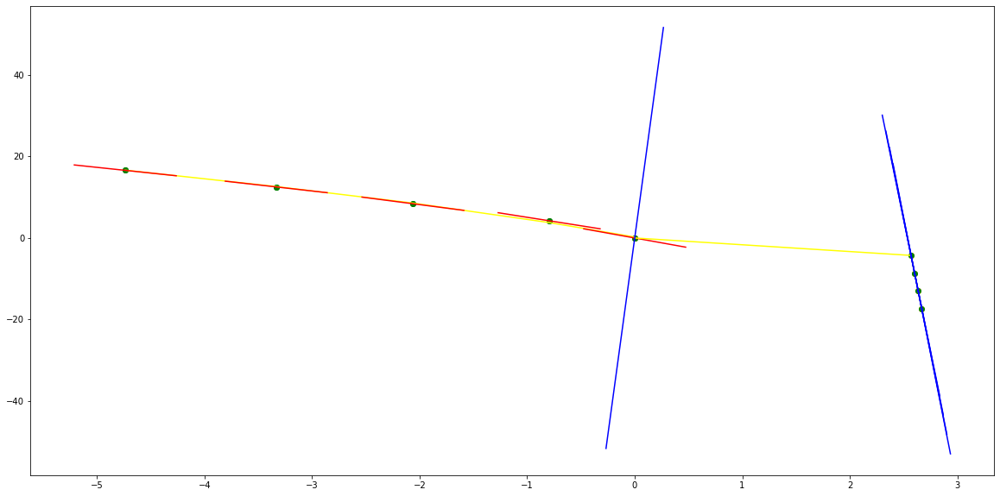

parameters (3.4709898989896466, 40.98529350649343, 20.7684484126984, 0.003347257575757128)
tangent[0]:4.790849797979789
tangent[1]:8.707152178932173
tangent[2]:12.675519408369405
tangent[3]:16.69595148629148
tangent[4]:20.7684484126984
parameters (-0.9395757575765687, 7.746246320346656, -34.063282380952394, -0.0020551818181792324)
tangent[0]:-34.063282380952394
tangent[1]:-33.295704567099556
tangent[2]:-32.54222038961036
tangent[3]:-31.802829848484816
tangent[4]:-31.077532943722918


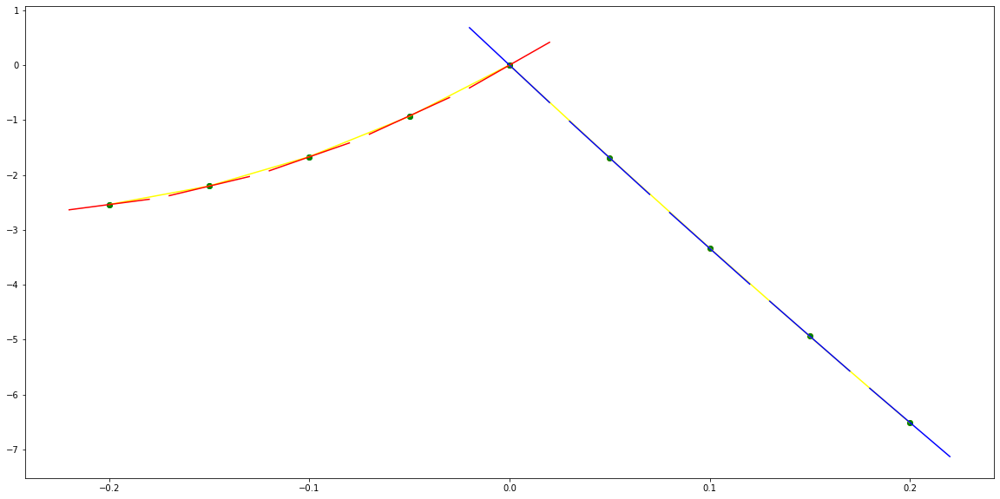

parameters (-1573.8050163974283, 93.16213344728388, 128.5503623215862, 0.27038582246005516)
tangent[0]:112.58975681487766
tangent[1]:114.92371240011325
tangent[2]:117.09370373167462
tangent[3]:119.09926907099084
tangent[4]:128.5503623215862
parameters (-1040.806689055535, 369.95038264109036, 42.67133746524828, 0.7358920987115263)
tangent[0]:42.67133746524828
tangent[1]:45.70028659872147
tangent[2]:71.8603255614408
tangent[3]:79.41456680219366
tangent[4]:85.4372133218003


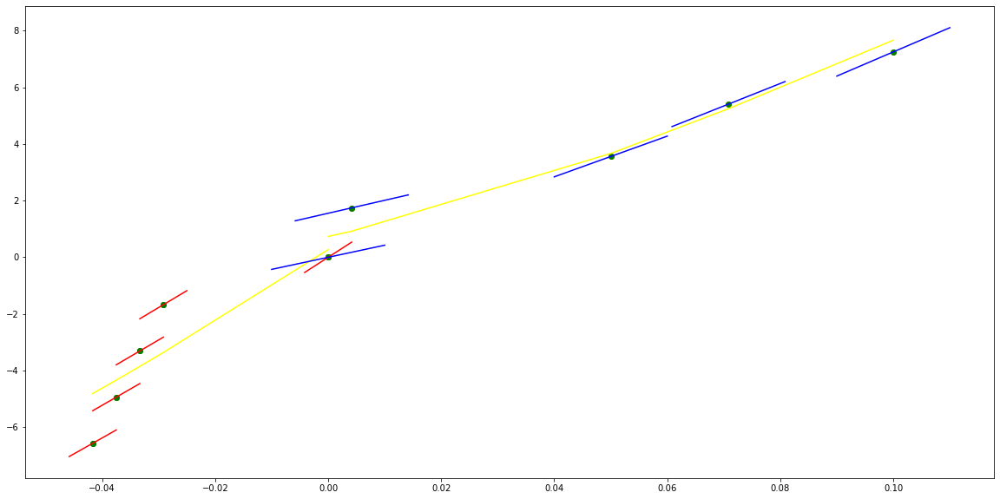

parameters (-8105.125418556543, -1775.5141902381347, 16.393151347124043, -0.7063547513609661)
tangent[0]:145.1228882832442
tangent[1]:145.94628844470256
tangent[2]:128.06900226175966
tangent[3]:56.98172856312904
tangent[4]:16.393151347124043
parameters (1000.2818711650957, -634.1206070076246, 178.12838486922234, 1.3134074664820512)
tangent[0]:178.12838486922234
tangent[1]:172.89573008055967
tangent[2]:167.7685062182949
tangent[3]:134.78927848762825
tangent[4]:106.91577284125192


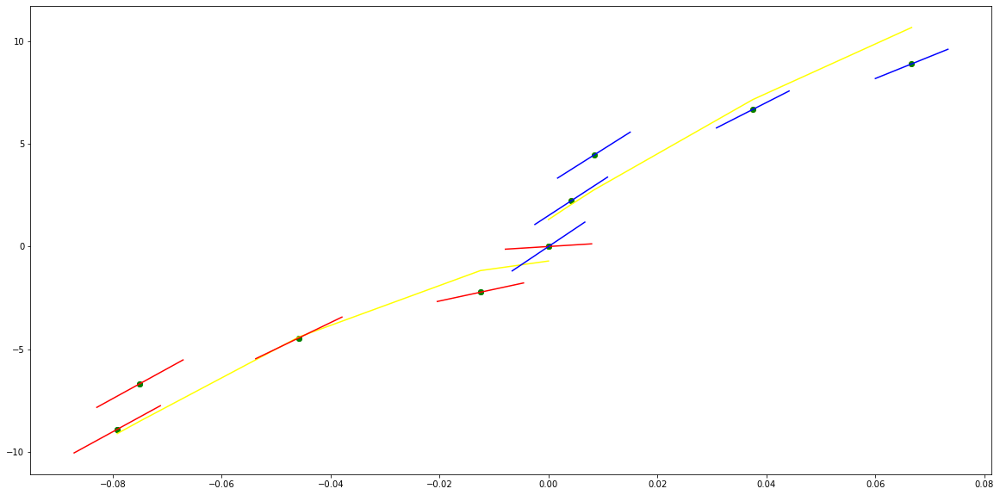

parameters (-16279.624710934237, -3152.234892485053, -39.48464343027032, -0.11633000438230466)
tangent[0]:163.75161028982058
tangent[1]:163.76786604910072
tangent[2]:162.0880562297269
tangent[3]:102.84991824005465
tangent[4]:-39.48464343027032
parameters (60344.839767140875, -7089.415355273255, 361.3778388068468, 0.3818519381906733)
tangent[0]:361.3778388068468
tangent[1]:305.4381145343178
tangent[2]:255.79647838680256
tangent[3]:89.90031765346669
tangent[4]:84.25147992897831


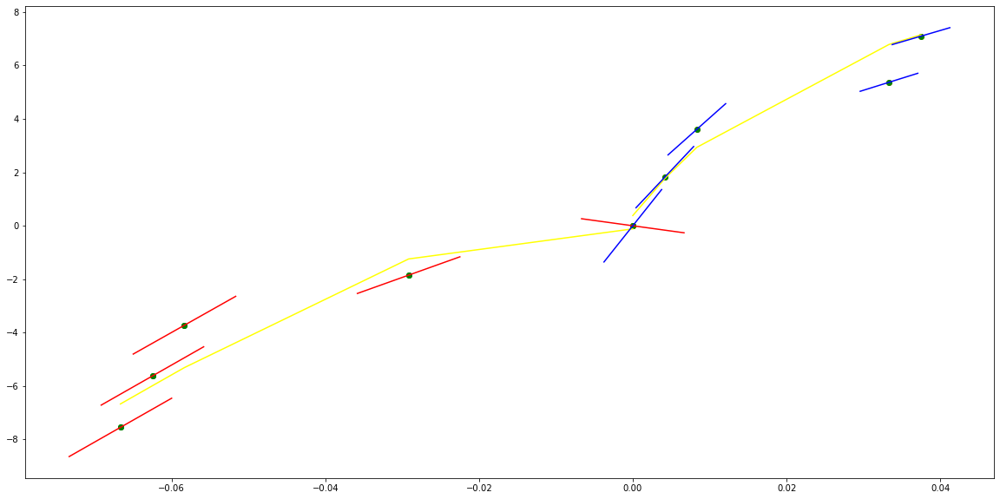

parameters (-157.0550753973235, -76.24469219085253, -16.08487875114679, 0.037053149911344986)
tangent[0]:-16.94158841299147
tangent[1]:-16.292655843619528
tangent[2]:-3.828671536477497
tangent[3]:-10.085592573194091
tangent[4]:-16.08487875114679
parameters (-5055.781053020715, 1318.5697534382186, -103.91720615129314, -0.27118835165385424)
tangent[0]:-103.91720615129314
tangent[1]:-93.1916098891779
tangent[2]:-82.99512609853882
tangent[3]:4.481885207536436
tangent[4]:6.7799750480939025


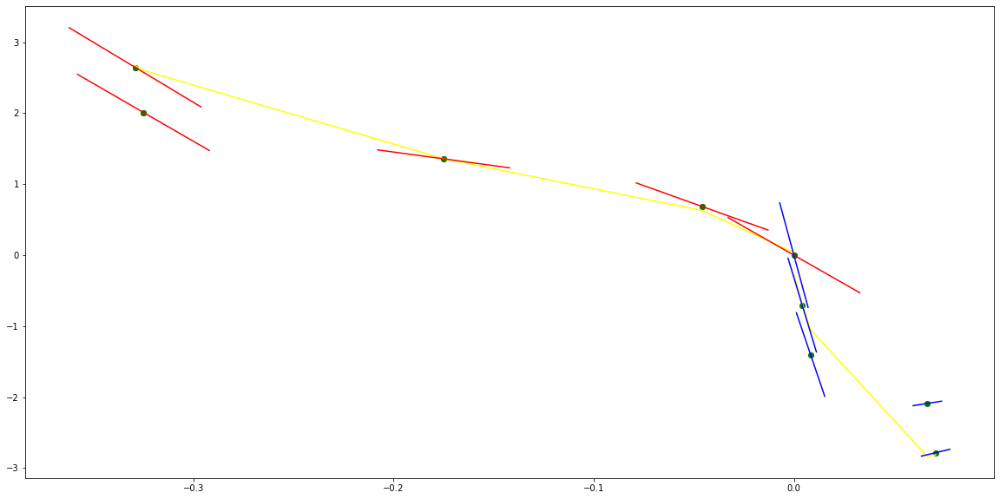

parameters (122.5235333737077, 70.27263279128543, -9.268429006179192, -0.011202997621059458)
tangent[0]:-22.703157049971132
tangent[1]:-19.647249563225046
tangent[2]:-19.361548324583254
tangent[3]:-19.063155333185875
tangent[4]:-9.268429006179192
parameters (-810.9599307785588, 359.1005023813621, -57.3862797559007, -0.4338398827132101)
tangent[0]:-57.3862797559007
tangent[1]:-54.43578042371889
tangent[2]:-51.570447253063264
tangent[3]:-33.87497928527059
tangent[4]:-14.431298824177105


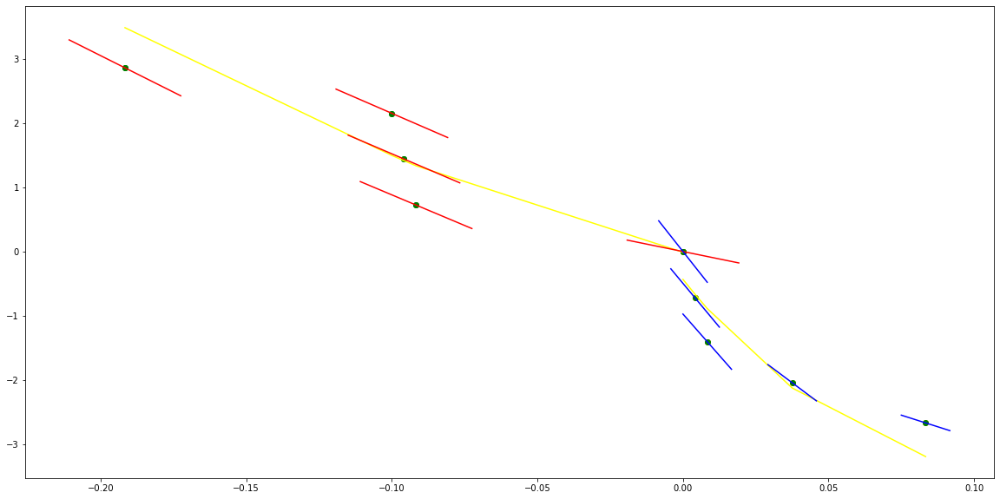

parameters (0.534363121828954, 1.2140858517580346, 1.6588908772737168, -0.023500516830403894)
tangent[0]:5.153298230852712
tangent[1]:4.212139097908732
tangent[2]:2.3590850740835676
tangent[3]:0.7963697992063252
tangent[4]:1.6588908772737168
parameters (-32.5105792214426, 94.23979440097216, -58.52938698204909, -7.008903277541961e-05)
tangent[0]:-58.52938698204909
tangent[1]:32.52820589422865
tangent[2]:32.5295584151186
tangent[3]:32.52752477004266
tangent[4]:31.625987897396698


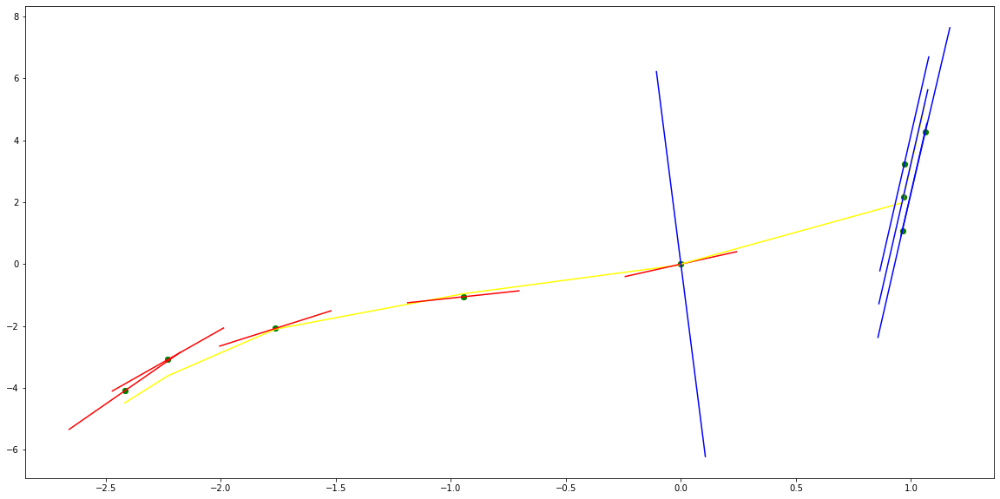

parameters (0.45684080915677466, 1.9075071723105677, 2.942687436183863, 0.07981212163178394)
tangent[0]:4.7275852670968845
tangent[1]:2.7237589475755946
tangent[2]:0.653448938467379
tangent[3]:0.5403966720597002
tangent[4]:2.942687436183863
parameters (8703.724218042727, -2368.227208568969, 189.3896487543055, 0.3303134973671418)
tangent[0]:189.3896487543055
tangent[1]:170.10623470171785
tangent[2]:151.73390491588492
tangent[3]:-23.14406641820645
tangent[4]:-20.66642918084372


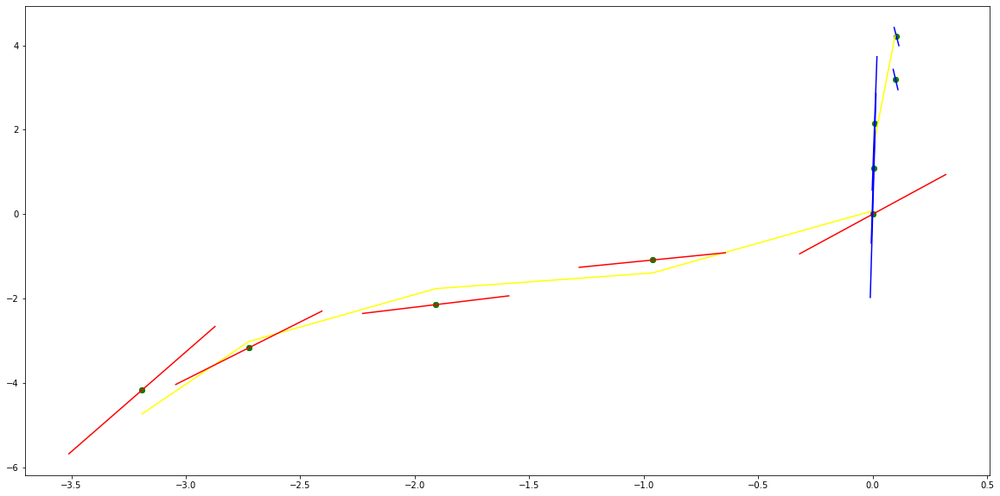

parameters (-631.1380366056351, -298.516428314601, -6.839057639258238, 0.010529476333437397)
tangent[0]:40.22430567319894
tangent[1]:38.6879487057411
tangent[2]:35.618121192160594
tangent[3]:27.287952240211816
tangent[4]:-6.839057639258238
parameters (814.3778841096919, -519.5428412049796, 83.5276751672509, 0.36487666855675366)
tangent[0]:83.5276751672509
tangent[1]:79.24022743019981
tangent[2]:75.03862266222495
tangent[3]:51.60637077092456
tangent[4]:47.9976187754652


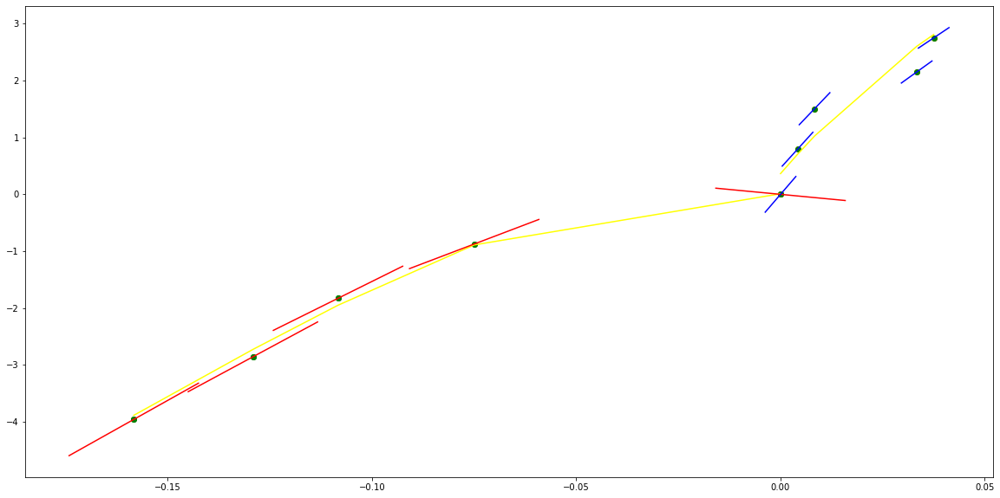

parameters (814.3735929084979, 508.6059696917873, 78.92576796762827, 0.00012874215913070565)
tangent[0]:51.6059958869931
tangent[1]:47.99726479558419
tangent[2]:44.47421334737621
tangent[3]:-19.74607496150648
tangent[4]:78.92576796762827
parameters (0.08909701405265377, -0.7009837345729707, 1.4678325003954387, -0.000149474271618833)
tangent[0]:1.4678325003954387
tangent[1]:1.1552596956338985
tangent[2]:0.8669940219098858
tangent[3]:0.5961325663844528
tangent[4]:0.32954631972085857


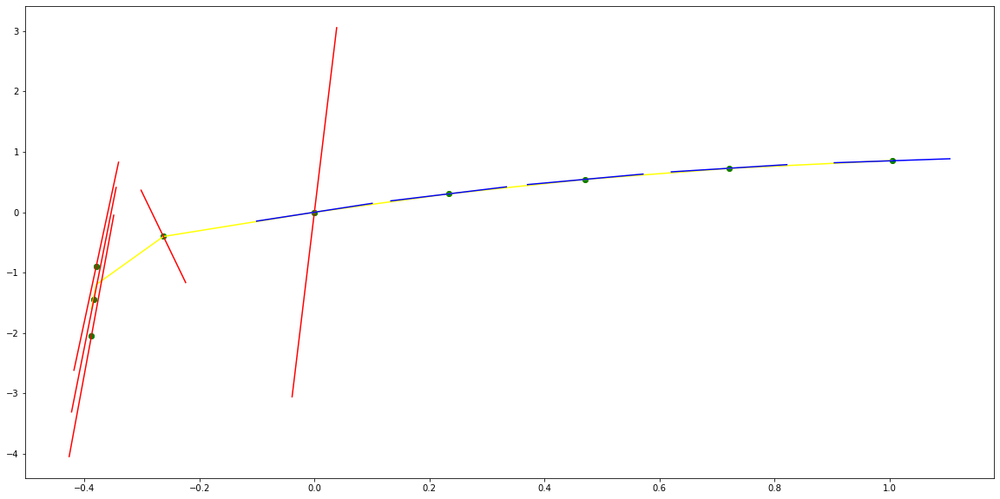

parameters (-120595.51631125406, -5858.28223519686, -547.8246059832458, 0.1421962233619687)
tangent[0]:-460.75380546216434
tangent[1]:-453.04490943864755
tangent[2]:-457.89669837422457
tangent[3]:-505.283703312494
tangent[4]:-547.8246059832458
parameters (-60544.04829729886, 9666.44188732743, -663.3626809157361, 0.09612075148375375)
tangent[0]:-663.3626809157361
tangent[1]:-585.9563946294841
tangent[2]:-450.08165637190916
tangent[3]:-391.59689877977047
tangent[4]:-339.4315868102949


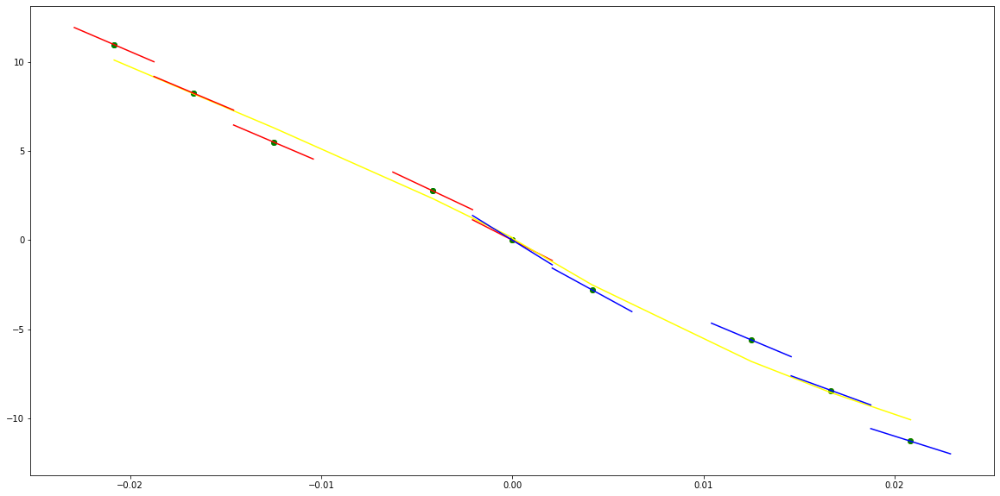

parameters (-22646.303234897932, -6836.898256844826, -669.7432821257654, -0.09535490221709712)
tangent[0]:-414.36350977142286
tangent[1]:-460.71478987883813
tangent[2]:-509.4362803460032
tangent[3]:-613.9442557401139
tangent[4]:-669.7432821257654
parameters (-10205.194076891888, 2003.6710699048429, -302.6254510863512, -0.7592108121778994)
tangent[0]:-302.6254510863512
tangent[1]:-286.45846196128804
tangent[2]:-232.42808019563083
tangent[3]:-203.06534878684448
tangent[4]:-178.79729967255605


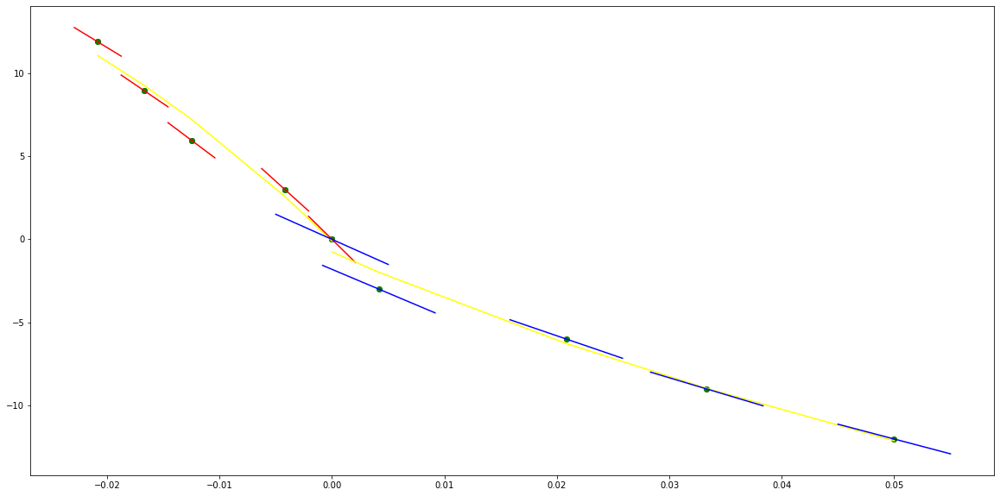

parameters (0.3798367293456551, 1.3243086481835527, 1.2614468714523313, -0.11999762332583522)
tangent[0]:0.00215060324513483
tangent[1]:0.4135888576958834
tangent[2]:1.0079802436959904
tangent[3]:1.250429869506789
tangent[4]:1.2614468714523313
parameters (4086.0772993702276, -789.1152723911475, 64.65596160957463, -0.02395029351450198)
tangent[0]:64.65596160957463
tangent[1]:58.29232550748186
tangent[2]:46.84342853387574
tangent[3]:41.756793739768646
tangent[4]:37.09692756848795


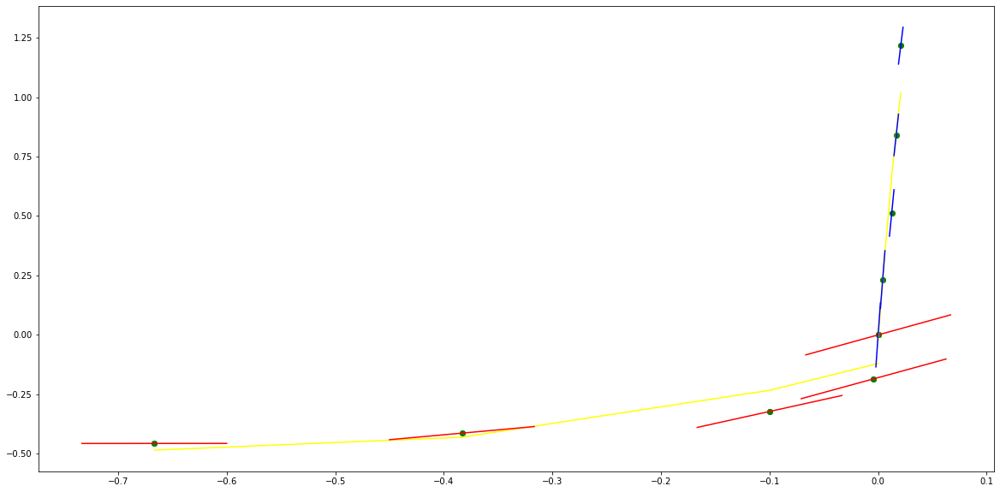

parameters (284.29854326220124, 217.0852900588957, 70.19532169489895, -0.7265027269664505)
tangent[0]:27.46856889718743
tangent[1]:45.041156780249366
tangent[2]:52.087628546938845
tangent[3]:68.40094247259232
tangent[4]:70.19532169489895
parameters (-9.068734397233303, 76.96579467804273, 28.906597082848474, 0.8078007705808772)
tangent[0]:28.906597082848474
tangent[1]:29.54755761020295
tangent[2]:39.673531290567404
tangent[3]:48.947094270270455
tangent[4]:51.99114596719258


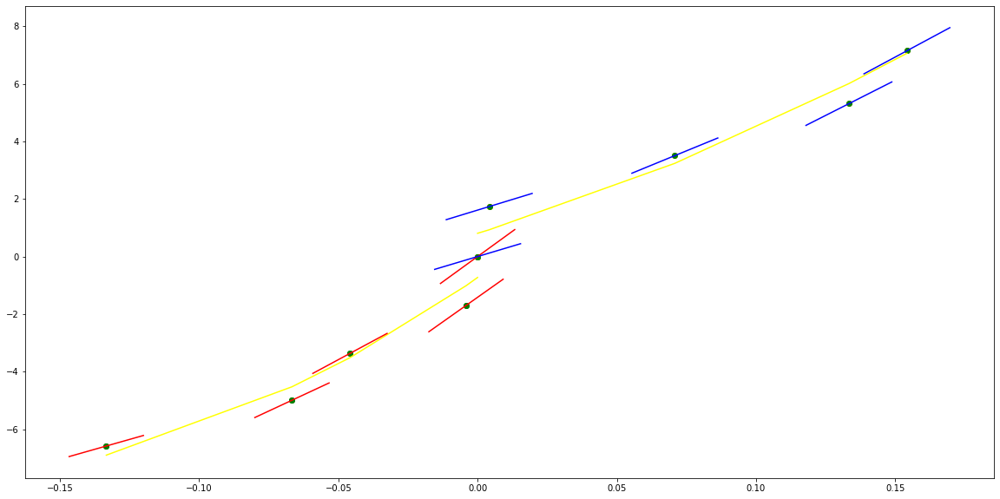

parameters (125.60112483144071, -10.093044597478013, 42.8937541132847, -0.18214913138405558)
tangent[0]:61.297478405735816
tangent[1]:60.605100050619086
tangent[2]:48.28879618371412
tangent[3]:44.61048038141069
tangent[4]:42.8937541132847
parameters (1222.6488378764102, -621.2197752265704, 136.71384251787927, 1.2475795605229305)
tangent[0]:136.71384251787927
tangent[1]:131.60028672726162
tangent[2]:112.4220390943132
tangent[3]:76.71968046599437
tangent[4]:45.16380162536379


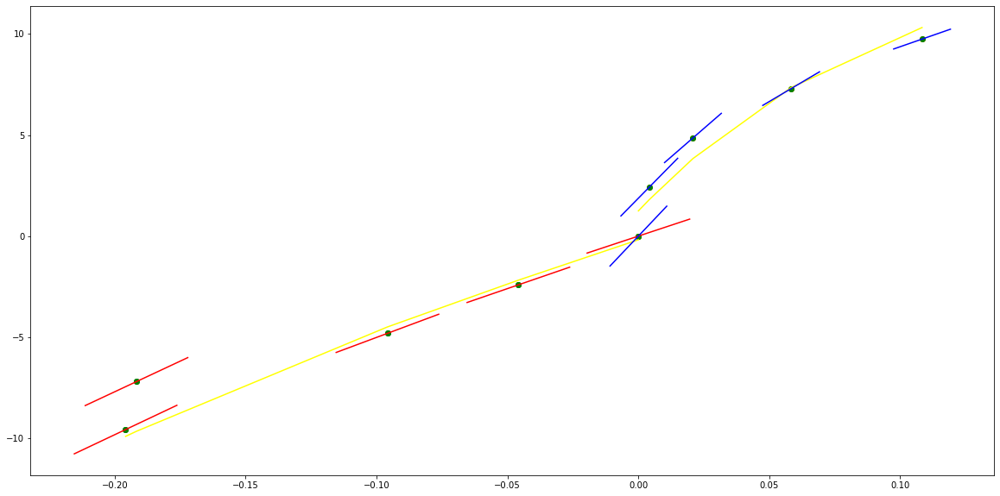

parameters (0.5394429524829416, 1.8526914004552368, 7.139038121464494, -0.09194038032301519)
tangent[0]:5.022972315098233
tangent[1]:5.179287060641544
tangent[2]:5.623159273486316
tangent[3]:6.424721938740191
tangent[4]:7.139038121464494
parameters (1055.4594155116256, -706.8849138017856, 152.0315872644121, -0.4854304963890514)
tangent[0]:152.0315872644121
tangent[1]:129.3478702430021
tangent[2]:93.88577119726858
tangent[3]:89.25904150057075
tangent[4]:84.7422730846826


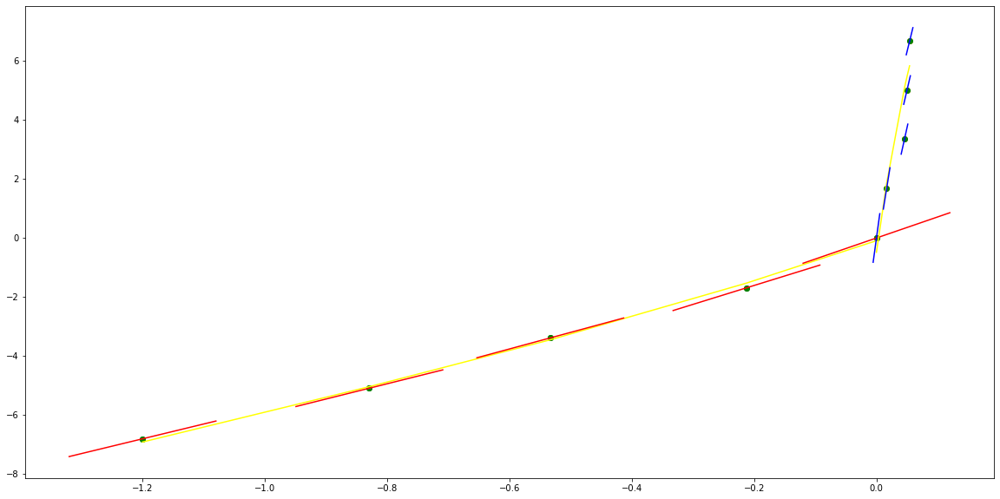

parameters (6.7788268391373325, 10.355815605503084, 10.314712723998111, 0.057007857033851805)
tangent[0]:8.62767566114684
tangent[1]:5.881616923823653
tangent[2]:5.231544112498952
tangent[3]:6.985845702493357
tangent[4]:10.314712723998111
parameters (1997.9253402536926, -1253.931656639905, 172.91822598853548, 0.00015751289175679715)
tangent[0]:172.91822598853548
tangent[1]:-86.58745702154727
tangent[2]:222.97421790241867
tangent[3]:246.19526269403138
tangent[4]:258.1193792167393


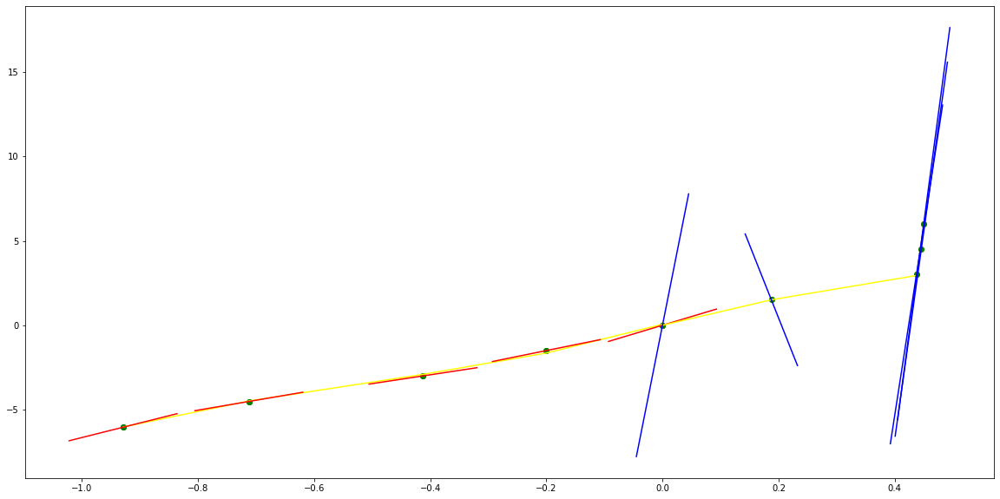

parameters (-736.2696272843195, -342.307846101422, 10.079268305427448, -0.7838076714343032)
tangent[0]:62.9435071757109
tangent[1]:61.6570044763227
tangent[2]:45.90351612419446
tangent[3]:12.89370838258999
tangent[4]:10.079268305427448
parameters (7804.074361860429, -1480.5050729184302, 159.8615421367024, 0.4661703220507108)
tangent[0]:159.8615421367024
tangent[1]:147.9295401019015
tangent[2]:108.33604775999181
tangent[3]:81.74710038191884
tangent[4]:72.18134406017427


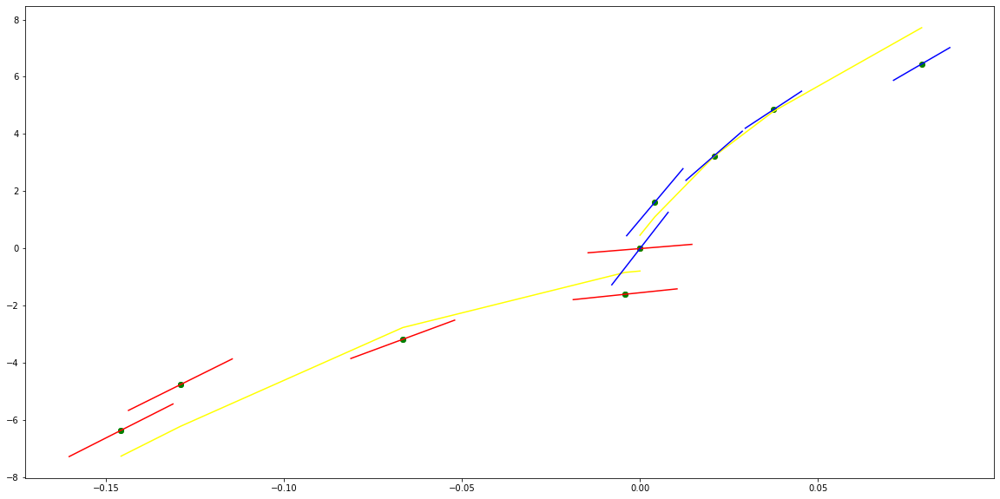

parameters (2591.9834708756466, 1491.8564539237188, 212.84480171931986, -0.2818526975505991)
tangent[0]:111.8904979427976
tangent[1]:122.02847146692598
tangent[2]:132.43648647072308
tangent[3]:200.549609688067
tangent[4]:212.84480171931986
parameters (-160.85664708991456, 52.97512882010604, 35.89143776682845, 0.815476321803123)
tangent[0]:35.89143776682845
tangent[1]:36.324553199520274
tangent[2]:41.3694627702145
tangent[3]:40.36549212170875
tangent[4]:40.145075147187484


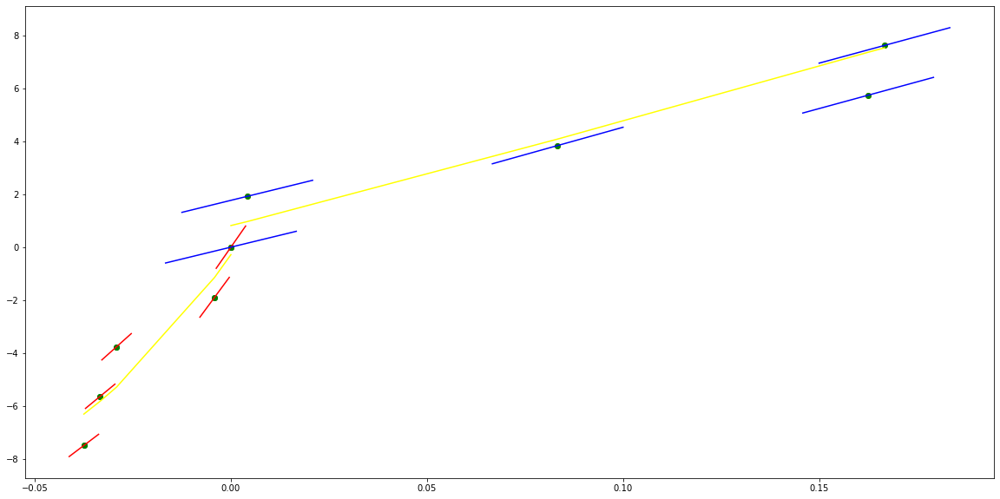

parameters (0.1334403280944857, 0.8597042487321899, 2.795417648477821, 0.12240848586550719)
tangent[0]:2.9428376912801117
tangent[1]:1.8083058464406574
tangent[2]:0.949317196407639
tangent[3]:1.3919585159967356
tangent[4]:2.795417648477821
parameters (84.42403264821543, -235.35248441076067, 162.29840219801093, -7.133697812500538e-06)
tangent[0]:162.29840219801093
tangent[1]:-37.83573934752394
tangent[2]:67.67243238607654
tangent[3]:69.15384220058803
tangent[4]:70.64440213215647


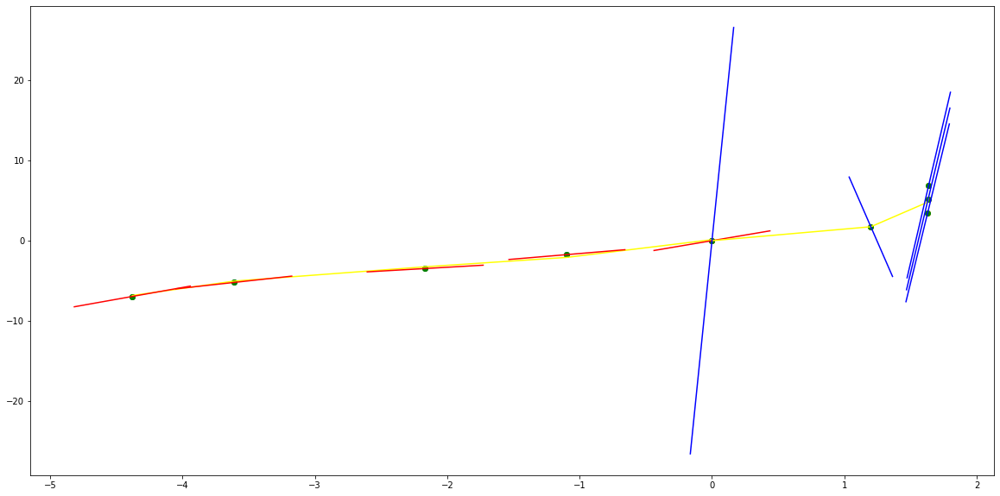

parameters (0.042068074565444966, 0.4199038148740678, 2.687970599152479, -0.24235552103374927)
tangent[0]:1.3185955975656583
tangent[1]:1.3366400466739061
tangent[2]:1.6547530942633277
tangent[3]:2.3507977164677643
tangent[4]:2.687970599152479
parameters (-356.75374448017453, -106.95074301354892, 91.79451977189208, 1.2317289271083711)
tangent[0]:91.79451977189208
tangent[1]:90.88483120233158
tangent[2]:89.93776093783839
tangent[3]:72.77794184519678
tangent[4]:71.27339926073526


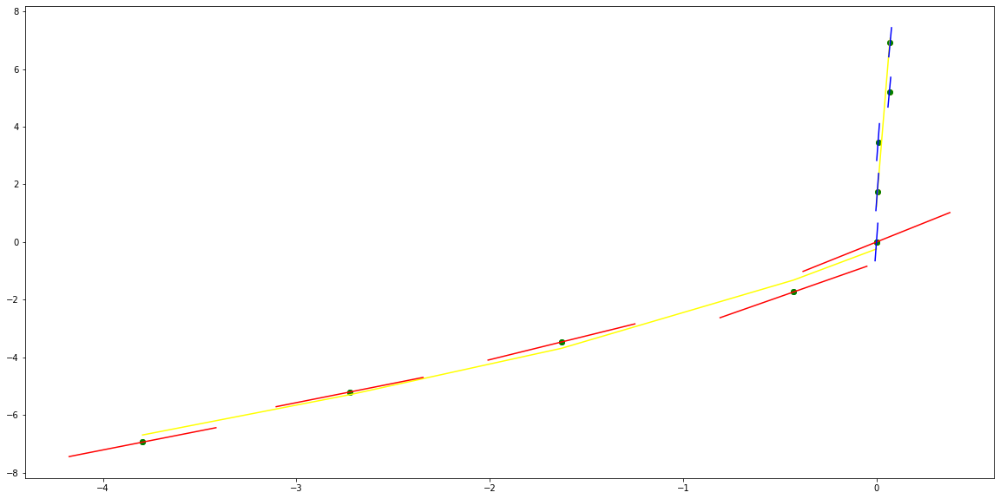

parameters (2979.928761077522, 1186.1272162780124, 168.18917916816824, -0.1324092405120834)
tangent[0]:36.41521001347988
tangent[1]:106.60468525952359
tangent[2]:122.6479939863432
tangent[3]:131.13626210480996
tangent[4]:168.18917916816824
parameters (0.13982387948330688, -1.029280473694146, 8.339471950296247, 0.014425616047075838)
tangent[0]:8.339471950296247
tangent[1]:7.936667061874755
tangent[2]:7.491064935434505
tangent[3]:7.1286575972352715
tangent[4]:6.778247306851099


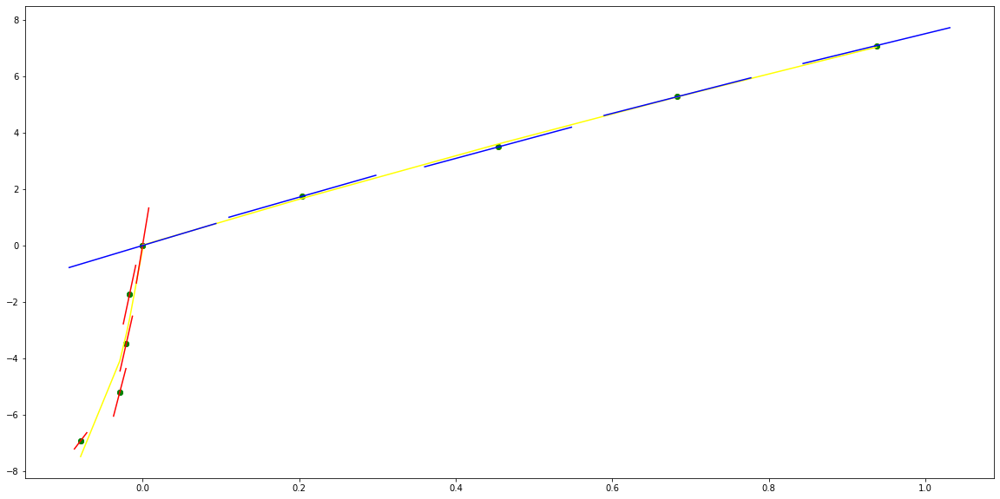

parameters (-0.010676708537756048, -0.14567712187689374, 0.8835147949320661, 0.019881720359714288)
tangent[0]:1.470950422620073
tangent[1]:1.3841901910715888
tangent[2]:1.2549515200920556
tangent[3]:1.1275435469353696
tangent[4]:0.8835147949320661
parameters (-9671.40733788864, 4732.442948169334, -562.0072814973954, -1.7255160729512087e-05)
tangent[0]:-562.0072814973954
tangent[1]:150.54699124011165
tangent[2]:139.1075086699699
tangent[3]:126.66042663889414
tangent[4]:98.74705573696735


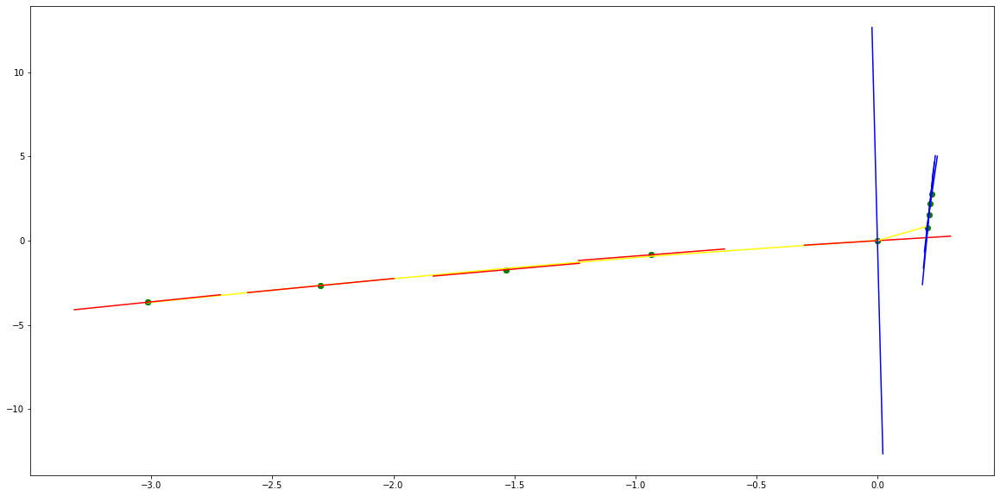

parameters (0.017029561624981163, 0.07988557353564507, 1.3902727577701943, -0.21034925862278814)
tangent[0]:1.3109499551886534
tangent[1]:1.2669772231085392
tangent[2]:1.274456527388609
tangent[3]:1.3592045391283323
tangent[4]:1.3902727577701943
parameters (17685.11351482786, -3013.0349325135035, 175.7119352866427, 0.03111179197016605)
tangent[0]:175.7119352866427
tangent[1]:151.52254920314678
tangent[2]:129.17565720779407
tangent[3]:90.01361295160632
tangent[4]:73.1937610574752


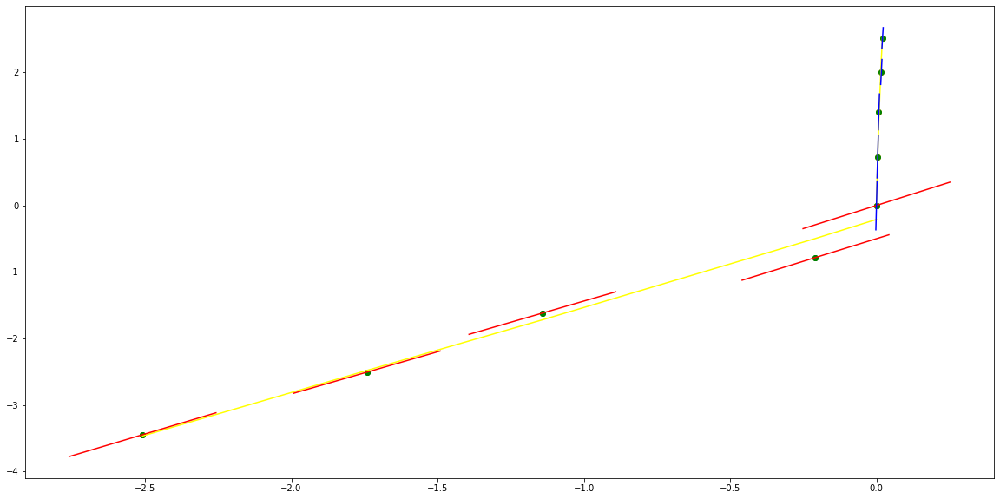

parameters (0.14203931185754315, 0.15797726030479287, -2.001752840431257, -0.018624077613478885)
tangent[0]:-1.7463135141954793
tangent[1]:-1.9111007477664017
tangent[2]:-2.024046885175183
tangent[3]:-2.06029041649942
tangent[4]:-2.001752840431257
parameters (-1110.9023128390074, 755.0364561527853, -123.26664990020093, 0.002346421268608341)
tangent[0]:-123.26664990020093
tangent[1]:45.24830468470496
tangent[2]:-78.00320913455606
tangent[3]:-112.4601477516836
tangent[4]:-118.60699441239124


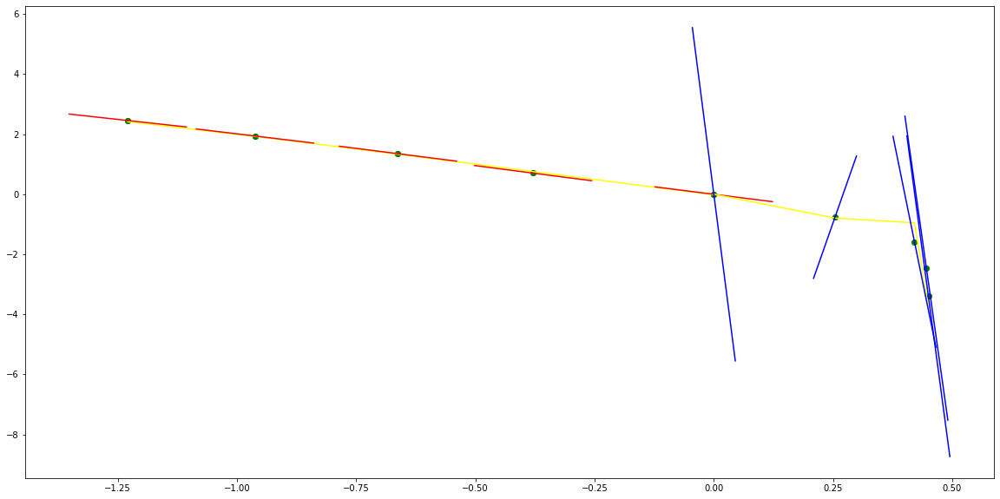

parameters (-96082.10657639963, -2575.0603201303315, -212.78879556210316, 0.8558956368324878)
tangent[0]:-425.0056586715142
tangent[1]:-361.38710740654886
tangent[2]:-307.7903744943846
tangent[3]:-196.3333199545733
tangent[4]:-212.78879556210316
parameters (-16347.351494253164, 2922.755740922211, -333.2993406689906, -0.7825857533145163)
tangent[0]:-333.2993406689906
tangent[1]:-309.7926551145155
tangent[2]:-249.49553863013287
tangent[3]:-192.9409882741972
tangent[4]:-163.62890278366825


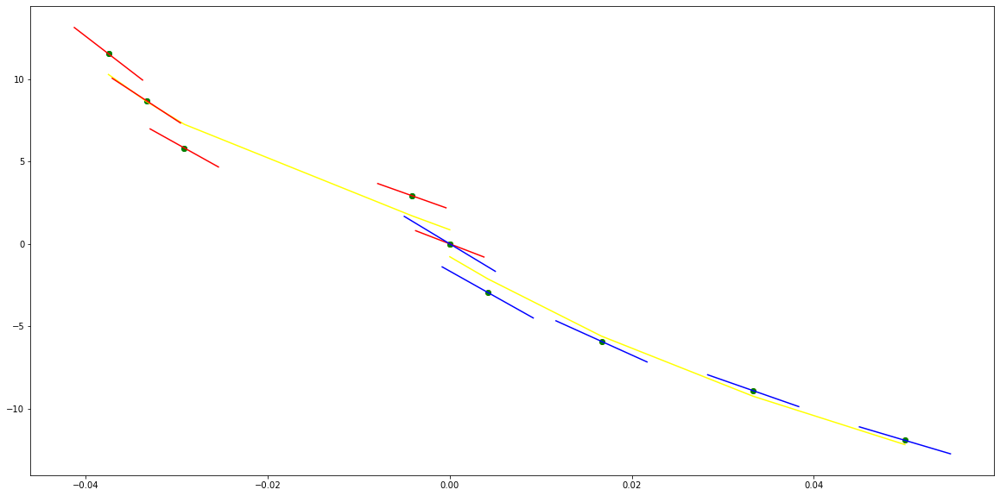

parameters (505.6199743833449, 274.7612676529159, 54.38357082298527, -0.3657865650829415)
tangent[0]:15.651964455902728
tangent[1]:32.38371732754568
tangent[2]:39.64606084001128
tangent[3]:52.1200490057
tangent[4]:54.38357082298527
parameters (4826.849079913032, -908.0032926690683, 100.70855809660065, 0.21392175118222997)
tangent[0]:100.70855809660065
tangent[1]:93.39269727042672
tangent[2]:69.16045152661863
tangent[3]:52.97158070230364
tangent[4]:44.82778013766693


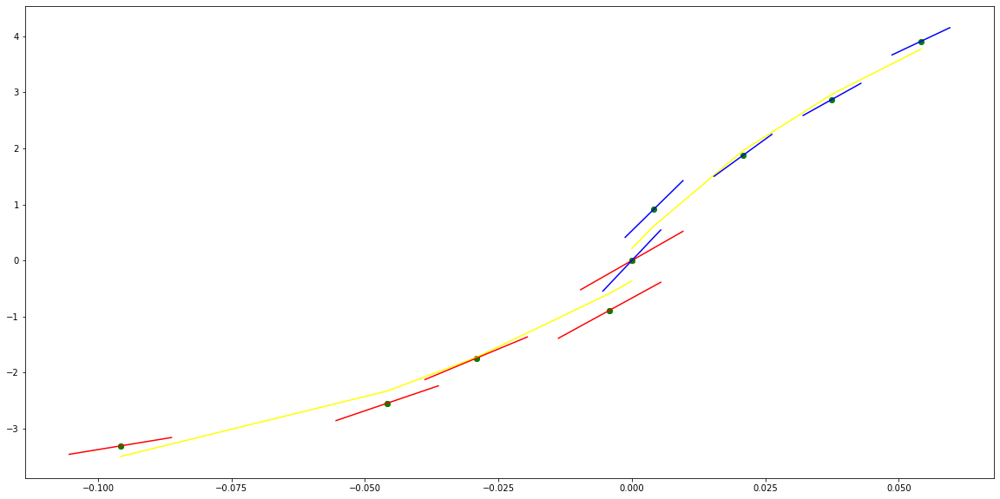

parameters (3146.9772696447935, 867.8066991940481, 116.0821421675177, -0.7442492066269055)
tangent[0]:37.009772795413056
tangent[1]:44.484944646911615
tangent[2]:89.77868053373035
tangent[3]:109.01542937053503
tangent[4]:116.0821421675177
parameters (508.5967238195463, -236.14739422997496, 67.8265550489981, 0.6105123694280308)
tangent[0]:67.8265550489981
tangent[1]:65.88499631666
tangent[2]:48.0262910546472
tangent[3]:38.18259205898269
tangent[4]:31.979031580452443


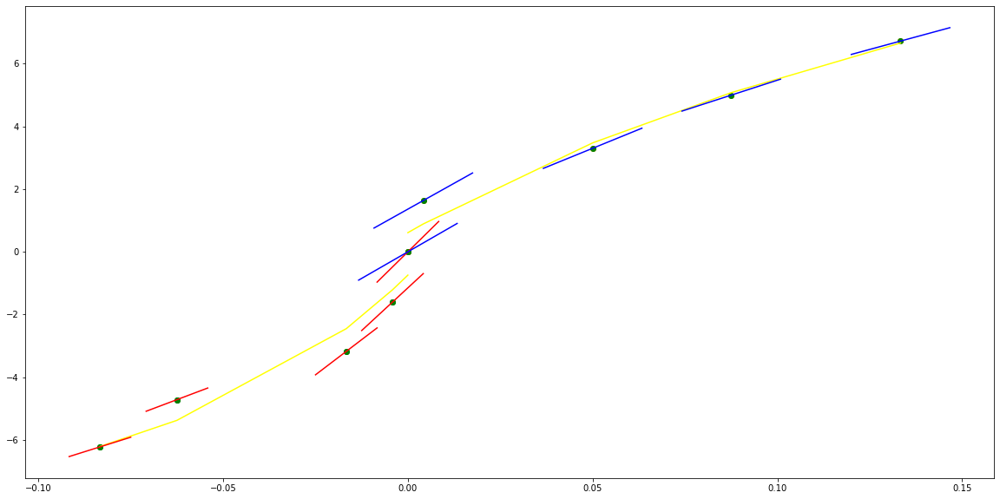

parameters (-0.2506548553484461, -0.42690922357527533, 14.772469077051756, -0.00333867745569589)
tangent[0]:15.01236944790939
tangent[1]:15.00651018840325
tangent[2]:14.959247352468163
tangent[3]:14.888806074401817
tangent[4]:14.772469077051756
parameters (17484.181518528494, -5727.190579480176, 546.7064786230853, -0.007299062083507359)
tangent[0]:546.7064786230853
tangent[1]:499.8978697892335
tangent[2]:454.8993668446316
tangent[3]:370.37674790450353
tangent[4]:330.8424887889797


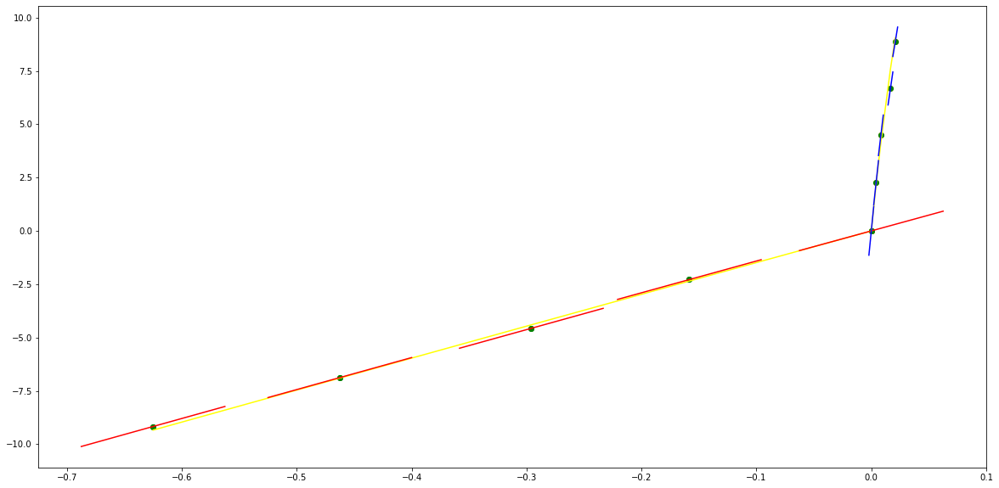

parameters (-341.56530628917454, -239.7974268503087, 4.479107198002092, -0.15819379420810922)
tangent[0]:59.92003491637365
tangent[1]:52.62738498518727
tangent[2]:51.856507479411185
tangent[3]:30.451067121214415
tangent[4]:4.479107198002092
parameters (11966.536361769124, -3094.1990226744115, 250.79471447140455, 0.7394927974394281)
tangent[0]:250.79471447140455
tangent[1]:225.63101664373667
tangent[2]:201.71403247067013
tangent[3]:-15.602418508094871
tangent[4]:-15.833732437232896


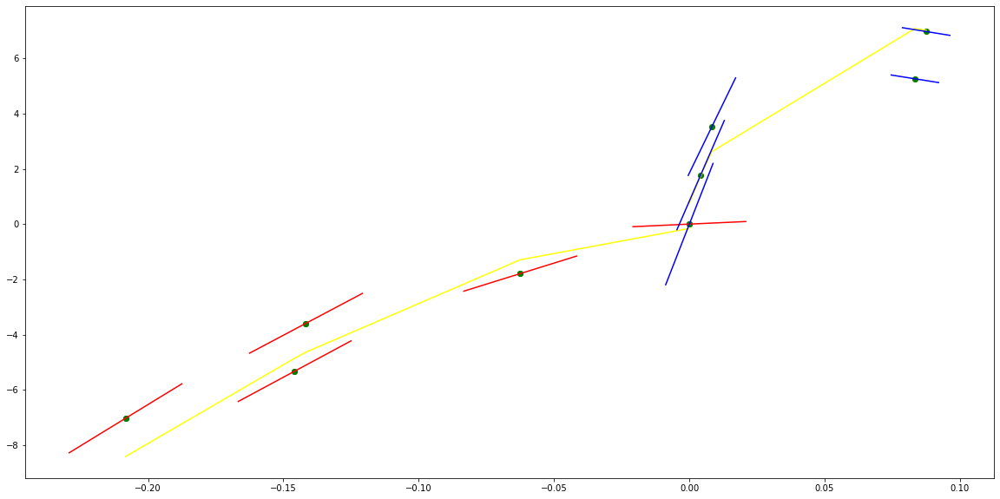

parameters (166.90494169904062, 179.31434479935118, 67.22601440289898, 0.25075530952630015)
tangent[0]:39.67960194266237
tangent[1]:40.817293104480505
tangent[2]:41.972643982680424
tangent[3]:55.82785772369407
tangent[4]:67.22601440289898
parameters (-576.8462369225282, 270.8835465982059, 12.721703172508745, 0.6812641222142868)
tangent[0]:12.721703172508745
tangent[1]:14.948670421260102
tangent[2]:41.14801887346774
tangent[3]:53.82753364780363
tangent[4]:54.192156199268645


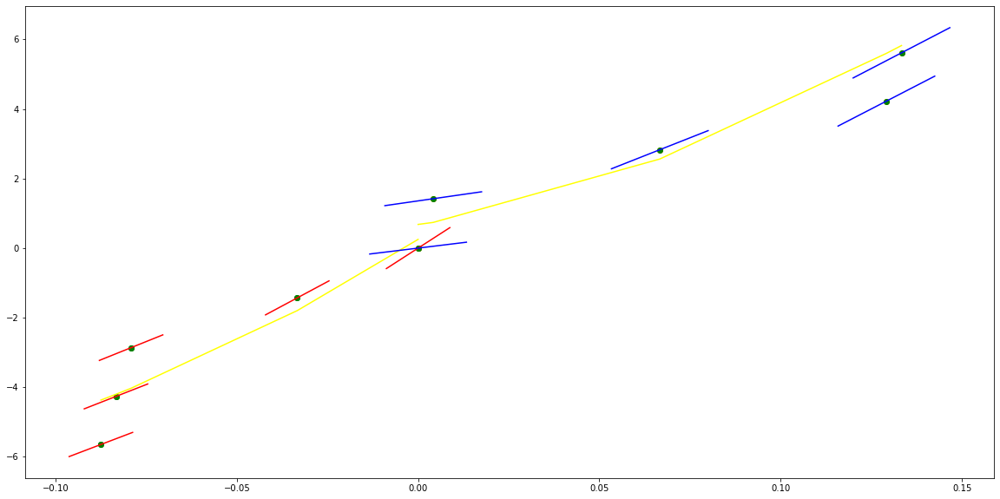

parameters (-576.8465712321708, -96.85605458164335, 49.70256007418073, 0.19378290819962657)
tangent[0]:53.8275357955643
tangent[1]:54.19215798322304
tangent[2]:54.49668237188435
tangent[3]:54.769505230779956
tangent[4]:49.70256007418073
parameters (1646.5845996792457, -715.7119516466007, 118.71639152655781, 0.8846300952268923)
tangent[0]:118.71639152655781
tangent[1]:112.83881171912375
tangent[2]:107.13134715615428
tangent[3]:71.98452393295958
tangent[4]:52.025833329826696


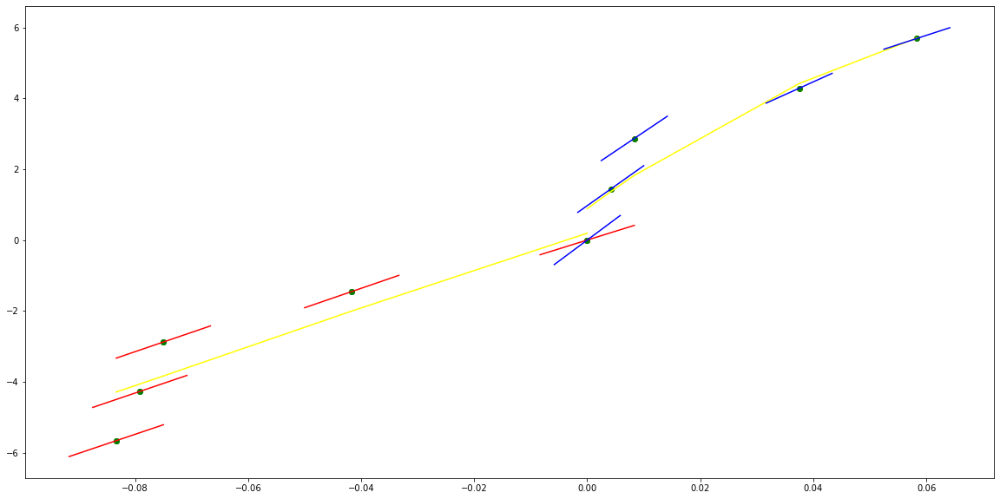

parameters (22399.12046378157, 4517.229974465151, 261.2051989615044, -0.06748323468086052)
tangent[0]:-11.71213336693745
tangent[1]:54.86283427082361
tangent[2]:158.7740373172732
tangent[3]:224.725411878604
tangent[4]:261.2051989615044
parameters (55966.50791780651, -3355.6098675189105, 187.07951258525995, 0.24284563312511062)
tangent[0]:187.07951258525995
tangent[1]:162.0292486429646
tangent[2]:120.13539711068651
tangent[3]:134.16782338693125
tangent[4]:149.9257204680603


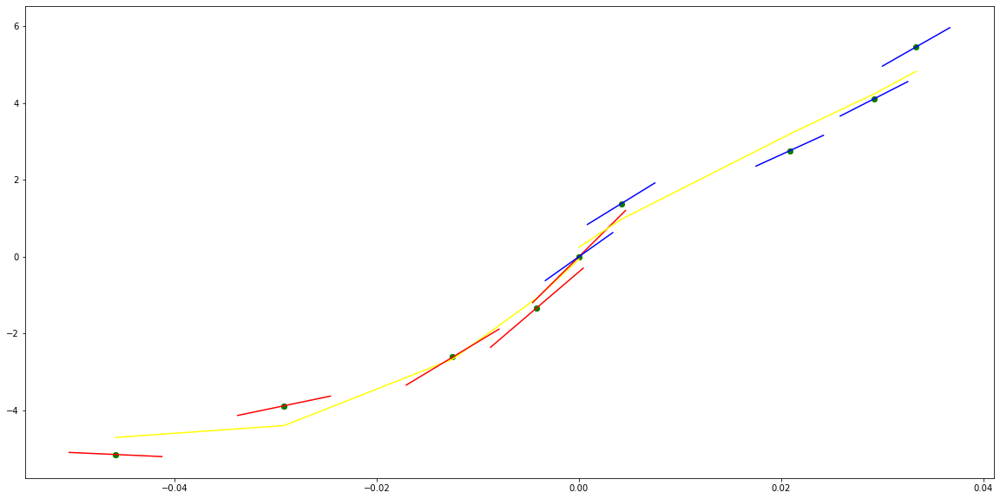

parameters (12.757487493630054, 17.896236794464777, 18.115868010569724, -0.230954933307963)
tangent[0]:10.019347688343682
tangent[1]:11.167292748731414
tangent[2]:13.310223264754676
tangent[3]:16.690981927145135
tangent[4]:18.115868010569724
parameters (-2479.8674564189546, 224.02884227683123, 76.61753038696739, 0.8715157608242093)
tangent[0]:76.61753038696739
tangent[1]:78.35540632875859
tangent[2]:79.83492141106196
tangent[3]:82.37056693730146
tangent[4]:73.4229619743662


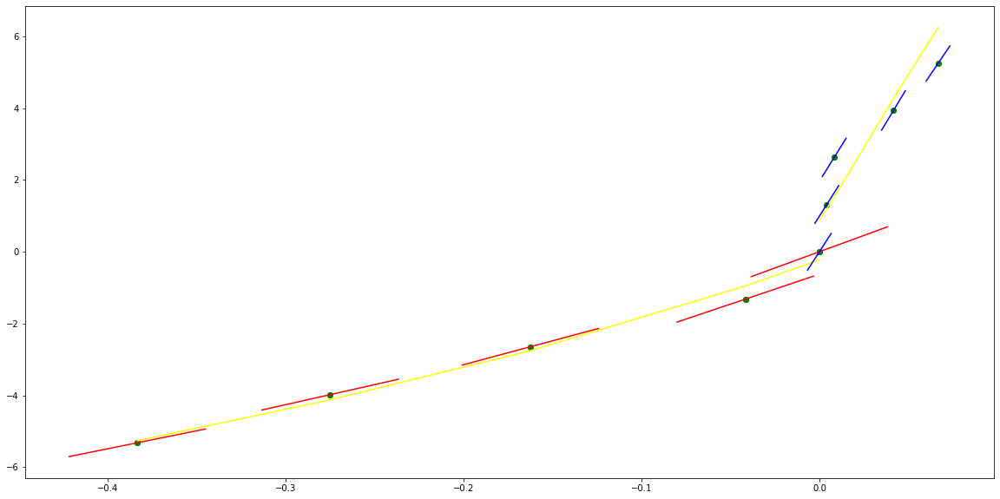

parameters (3118.6035598041703, 764.4393495959672, 86.21707628558973, -0.3839496394582345)
tangent[0]:32.6277015378117
tangent[1]:27.208293052548946
tangent[2]:49.58338935408933
tangent[3]:80.00869200419928
tangent[4]:86.21707628558973
parameters (-0.5772767857256493, 1.1408298225720452, 9.22459305992396, 0.5488764170966793)
tangent[0]:9.22459305992396
tangent[1]:9.234070664355187
tangent[2]:9.6116517746657
tangent[3]:9.753226221321261
tangent[4]:9.888112723280756


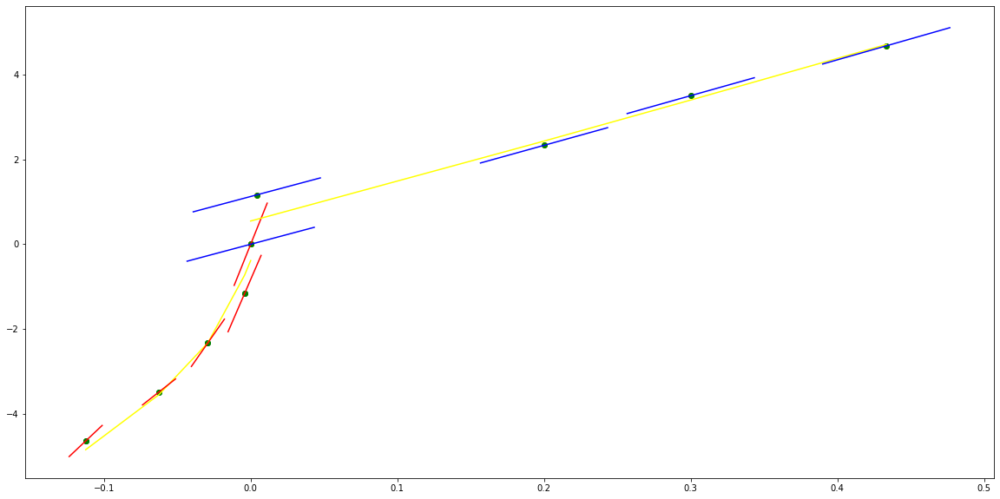

parameters (19.78019469158498, 25.769758363551542, 18.662187779984645, -0.6928928580058606)
tangent[0]:7.742374164629915
tangent[1]:9.578254545478213
tangent[2]:14.779329325280461
tangent[3]:18.448452997097874
tangent[4]:18.662187779984645
parameters (7539.592768272809, -1766.6958263002182, 144.16127848839037, 0.2951601147388469)
tangent[0]:144.16127848839037
tangent[1]:129.83038542780483
tangent[2]:80.36699412626854
tangent[3]:24.03864162041461
tangent[4]:21.529493055181177


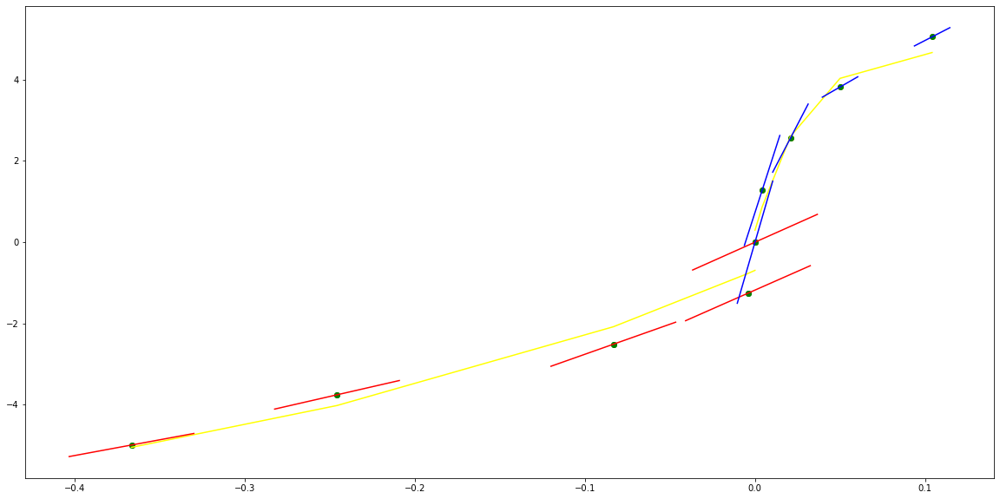

parameters (25846.660700563643, 4073.9494455693443, 243.25016753344272, -0.5884913311403542)
tangent[0]:102.72909939842378
tangent[1]:84.17648755652021
tangent[2]:153.5170535975983
tangent[3]:210.65177025456384
tangent[4]:243.25016753344272
parameters (237.67083919479833, -189.80517815190834, 65.79881321872513, 0.9902312901667328)
tangent[0]:65.79881321872513
tangent[1]:64.22935753421807
tangent[2]:53.93714942210515
tangent[3]:39.11591882699113
tangent[4]:22.336276454562395


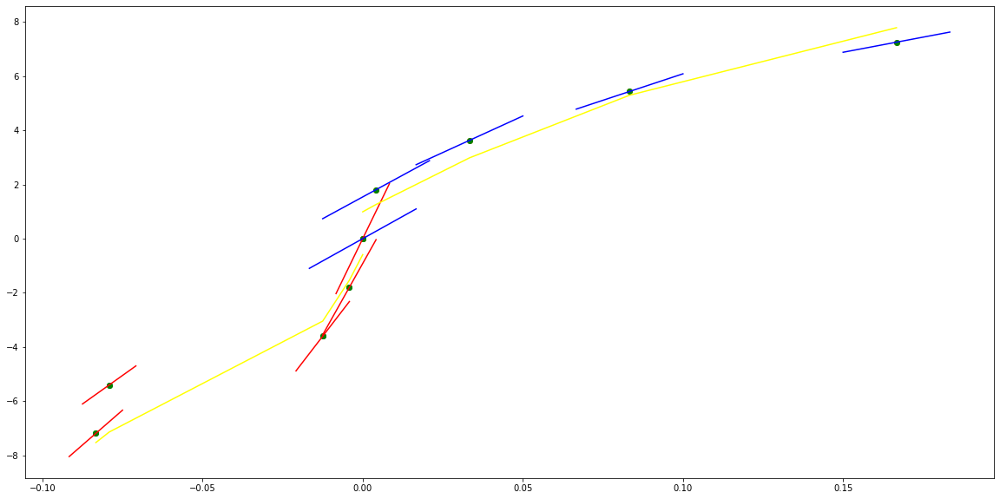

parameters (-2175.8608876968487, -979.2461033967488, -57.227166457690075, -0.13314176838829542)
tangent[0]:87.86638824286986
tangent[1]:88.65883744901855
tangent[2]:87.85914116905353
tangent[3]:60.649792093437455
tangent[4]:-57.227166457690075
parameters (16.87823335689629, -21.759725368978252, 25.50221909808285, 0.04348960025507685)
tangent[0]:25.50221909808285
tangent[1]:22.673656027891194
tangent[2]:19.76738090190655
tangent[3]:17.71205622969557
tangent[4]:16.440392119180164


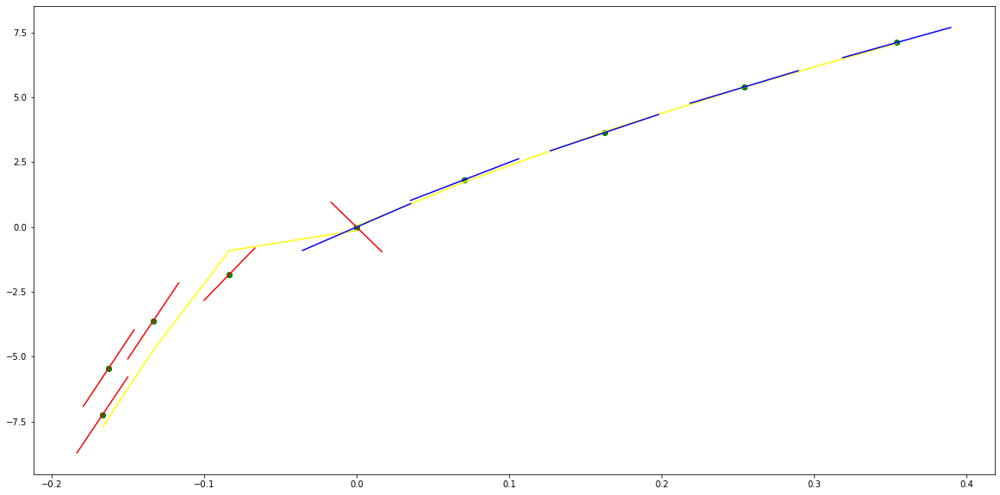

parameters (-127969.61239346057, -6300.501305646339, -561.6197312565881, 0.14300059618772396)
tangent[0]:-465.724811301653
tangent[1]:-458.24443009179316
tangent[2]:-464.0929544248643
tangent[3]:-515.7775038102508
tangent[4]:-561.6197312565881
parameters (-9212.260462023343, 1693.9574529679815, -264.2991665823379, -0.8017441284868121)
tangent[0]:-264.2991665823379
tangent[1]:-250.6616071736077
tangent[2]:-205.71348231578503
tangent[3]:-176.11658143390025
tangent[4]:-161.87406214556003


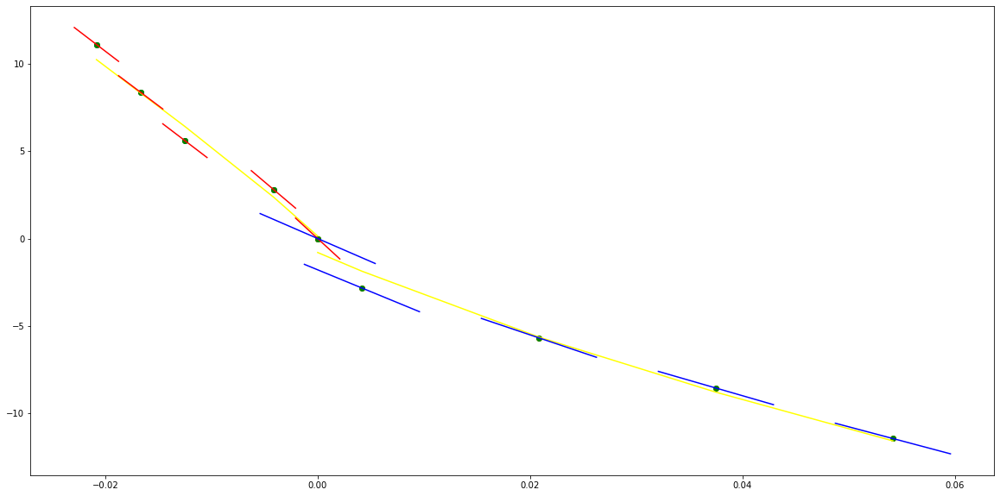

parameters (28789.897859933524, 4357.092592486637, 272.3195597910698, -0.7601424771365758)
tangent[0]:145.92510621359378
tangent[1]:123.7533173954983
tangent[2]:151.07861176011238
tangent[3]:237.51525836409823
tangent[4]:272.3195597910698
parameters (-3143.9347963334844, 820.7244813528544, 84.05238282895756, 0.9534292051682693)
tangent[0]:84.05238282895756
tangent[1]:90.72852785207193
tangent[2]:128.28824070184663
tangent[3]:145.29123212595974
tangent[4]:154.8879510335278


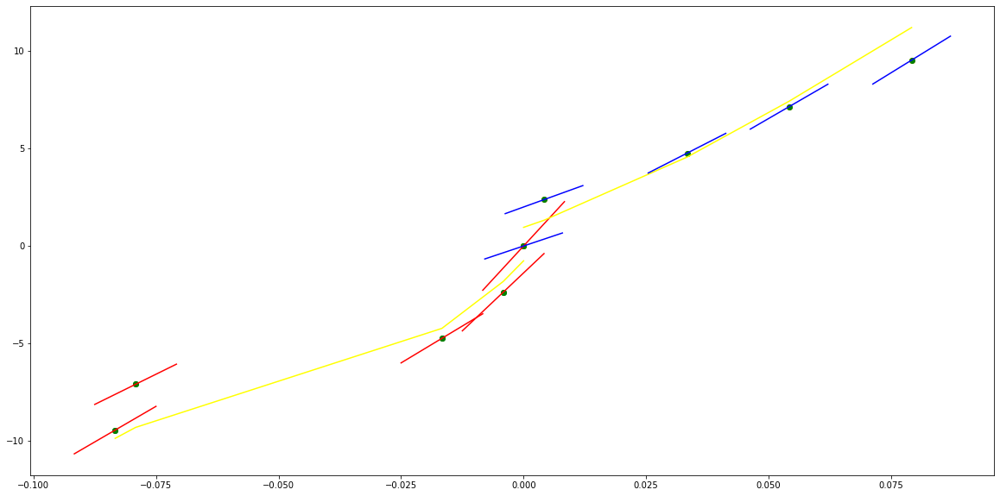

parameters (30665.945024124656, 3802.8900141064296, 237.71115592892866, -0.6390236916258365)
tangent[0]:212.1728777259291
tangent[1]:87.41674219922066
tangent[2]:94.13720590004405
tangent[3]:207.61531074780268
tangent[4]:237.71115592892866
parameters (-3305.98574481153, 1036.0789595411823, 61.57102802501846, 1.057595767323174)
tangent[0]:61.57102802501846
tangent[1]:70.03150625372776
tangent[2]:119.62253585703347
tangent[3]:155.6345795195336
tangent[4]:163.45710926541236


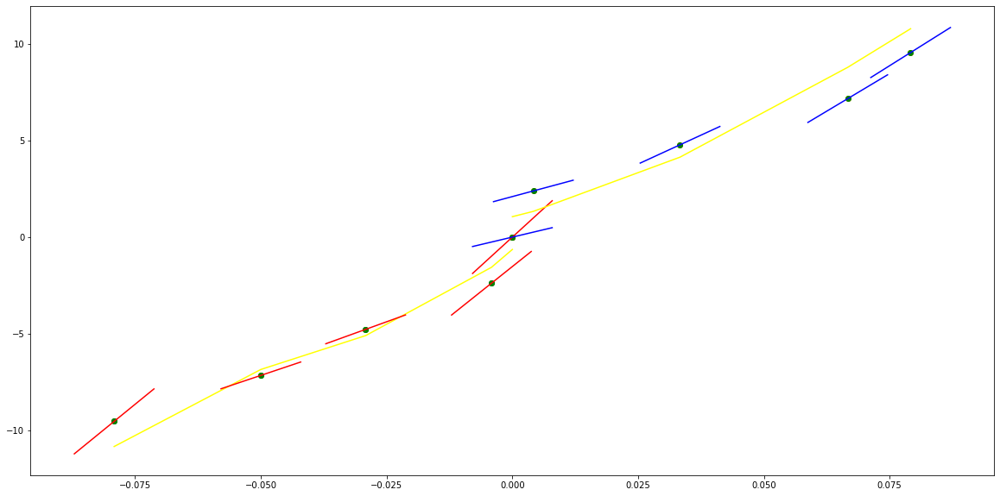

parameters (73.20228190132289, 32.35182302670779, 36.21635812354574, -0.23228786275213906)
tangent[0]:32.383454963514765
tangent[1]:31.50100890923613
tangent[2]:31.942061975243867
tangent[3]:34.303544152740784
tangent[4]:36.21635812354574
parameters (3668.1747841396814, -1239.4207304426172, 133.24379019285854, 0.5418634952703758)
tangent[0]:133.24379019285854
tangent[1]:123.10792630546243
tangent[2]:62.84357251387374
tangent[3]:48.663294382272255
tangent[4]:55.33882554160911


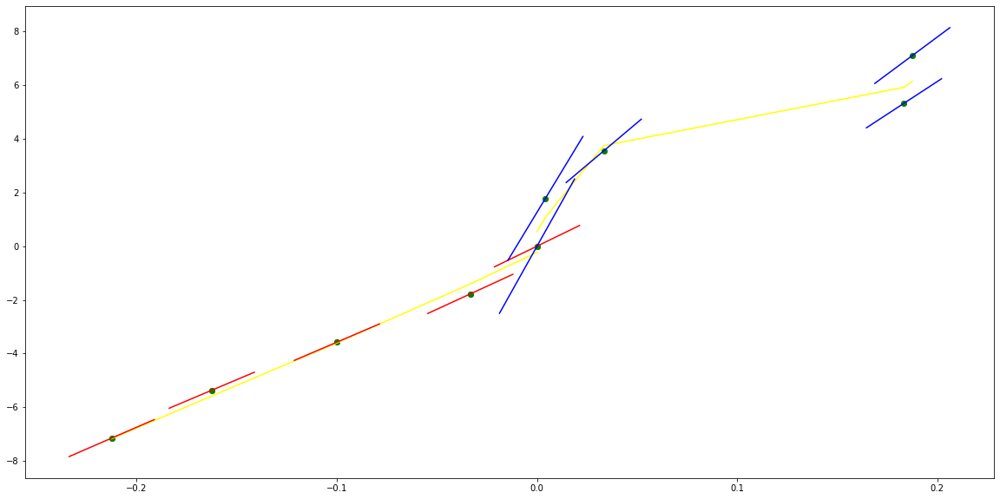

parameters (-480.98878866943073, -309.47670370361595, -16.37765804663365, 0.094841088637271)
tangent[0]:49.98965704315548
tangent[1]:48.59740049845099
tangent[2]:48.197972334979035
tangent[3]:43.99860982926456
tangent[4]:-16.37765804663365
parameters (6926.354113890359, -2484.661432078365, 208.5956860800544, 0.34620277281518025)
tangent[0]:208.5956860800544
tangent[1]:188.24932303713817
tangent[2]:24.4865371555872
tangent[3]:12.07719872639558
tangent[4]:0.3894709612536644


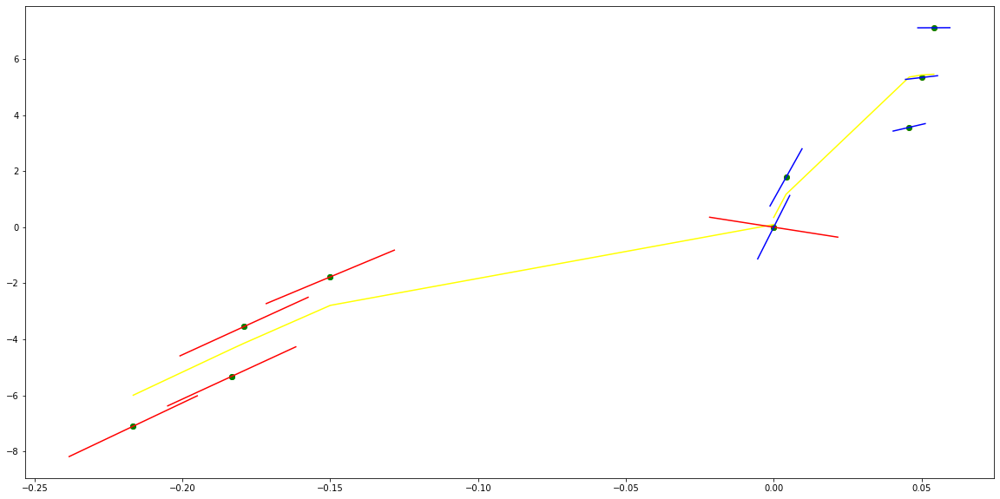

parameters (0.8057177924320261, 3.24296462929299, 15.88751219173305, -0.30921508206538695)
tangent[0]:12.493370614183501
tangent[1]:13.148627230592641
tangent[2]:14.034897008169505
tangent[3]:15.21323982339928
tangent[4]:15.88751219173305
parameters (78042.60478408195, -12727.670203711654, 727.755941595016, -0.2582351079291534)
tangent[0]:727.755941595016
tangent[1]:625.7489074975081
tangent[2]:531.8941652925757
tangent[3]:368.5298884574004
tangent[4]:299.0595581172544


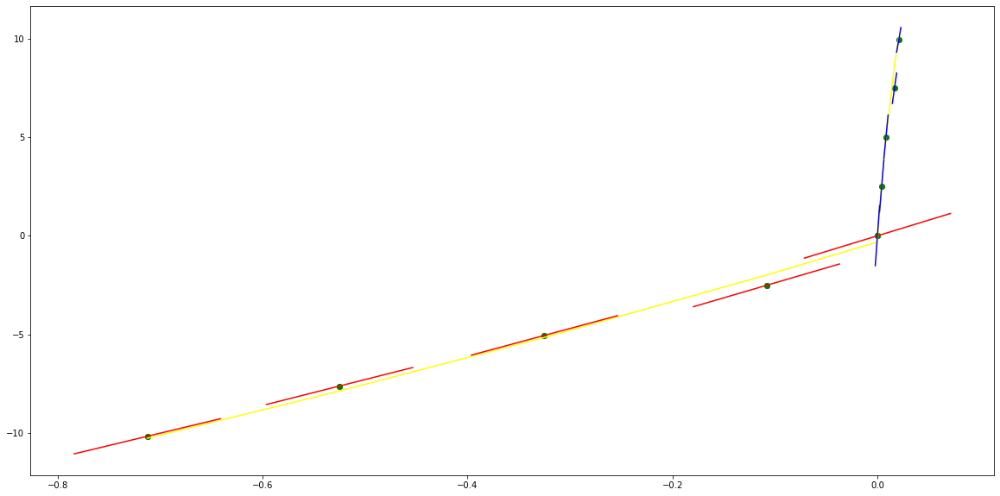

parameters (1196.6870397037164, 440.9337699919618, 93.01825512405657, -0.573321138610334)
tangent[0]:40.13759758104213
tangent[1]:42.346808521904265
tangent[2]:60.14057913878574
tangent[3]:85.9181207369324
tangent[4]:93.01825512405657
parameters (25061.643176912683, -4706.897291069345, 291.5879726053652, 0.7481571749382007)
tangent[0]:291.5879726053652
tangent[1]:253.67498063100223
tangent[2]:218.36358032856128
tangent[3]:29.878022185280884
tangent[4]:43.51556338794302


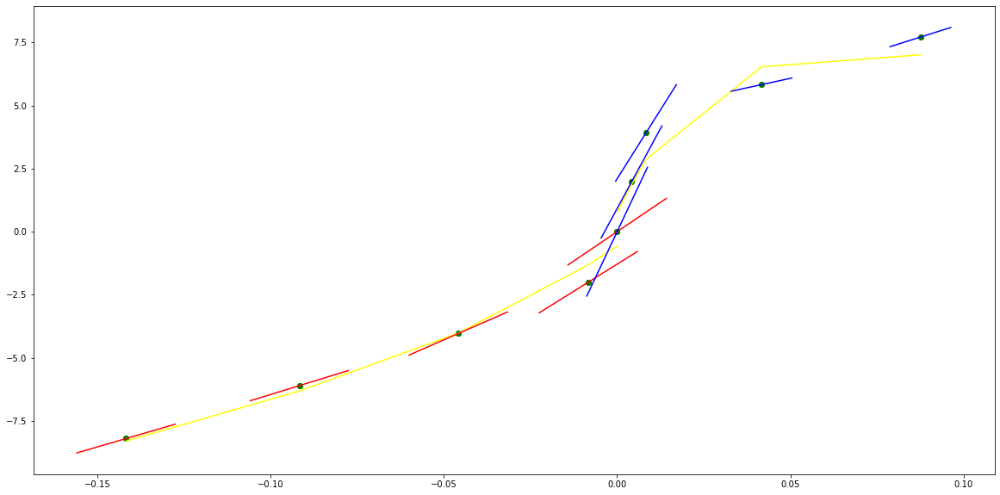

parameters (66.41122233184339, 27.319507551100916, 24.847496704901445, -0.03178789247911067)
tangent[0]:22.233351270950465
tangent[1]:21.229670769894366
tangent[2]:21.441030773772138
tangent[3]:22.76174969545279
tangent[4]:24.847496704901445
parameters (10223.735189146593, -2070.2052348675975, 173.1486748481439, 0.3632602290499014)
tangent[0]:173.1486748481439
tangent[1]:156.42815582972656
tangent[2]:140.77640884273416
tangent[3]:69.21480837867794
tangent[4]:61.0146650622863


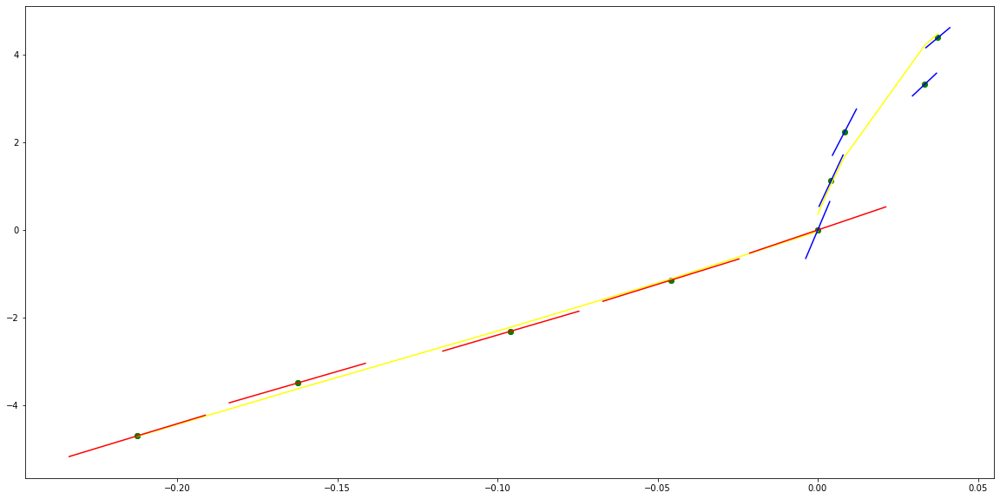

parameters (7760.055007228651, 1506.0686250771696, 129.8909894544829, -0.19258849102682146)
tangent[0]:85.66513736783264
tangent[1]:55.03448515170592
tangent[2]:33.400013992620615
tangent[3]:95.8767996121921
tangent[4]:129.8909894544829
parameters (25265.285957091823, -5010.429878931801, 351.74626914462283, 0.4877338319730251)
tangent[0]:351.74626914462283
tangent[1]:311.314846649216
tangent[2]:273.5056249437287
tangent[3]:101.93688634875275
tangent[4]:82.55195335621892


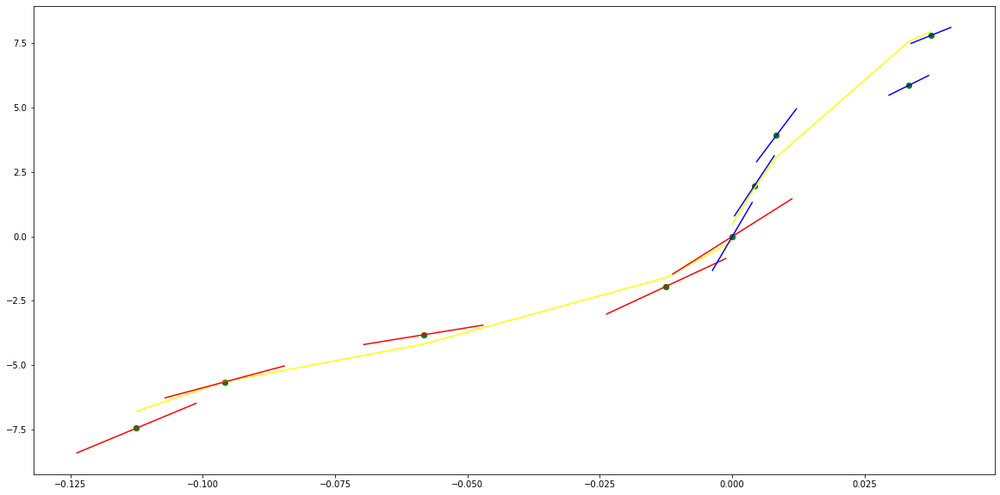

parameters (35181.029848817954, 7717.348876557791, 460.48085935086004, 0.44757515214937466)
tangent[0]:-25.23284570332106
tangent[1]:232.54944948641955
tangent[2]:284.03824517854866
tangent[3]:339.1786422428015
tangent[4]:460.48085935086004
parameters (16649.869548148927, -4020.4097585601207, 280.6433604262377, 0.8938261347447348)
tangent[0]:280.6433604262377
tangent[1]:248.01220954792151
tangent[2]:217.10765672032989
tangent[3]:-41.451554732767306
tangent[4]:198.38662735825392


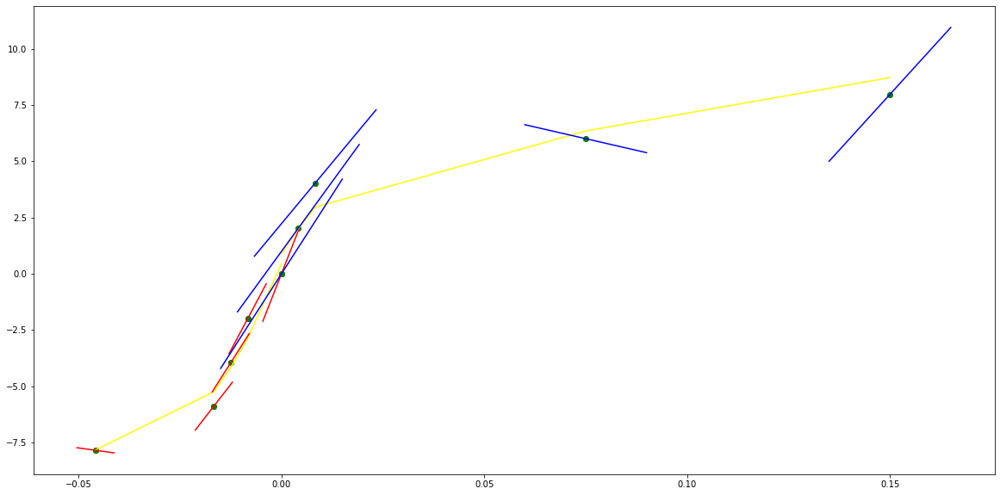

parameters (-1385.710499113004, -704.3832915193232, -31.96675353453987, -0.9306775632322103)
tangent[0]:85.81277523112928
tangent[1]:81.96413085139625
tangent[2]:64.86062886441673
tangent[3]:-26.16860715289603
tangent[4]:-31.96675353453987
parameters (1779.1129322317859, -832.671514418732, 162.7984980456967, 0.3283452844092063)
tangent[0]:162.7984980456967
tangent[1]:155.9516906029522
tangent[2]:107.85376714714465
tangent[3]:97.68278587856585
tangent[4]:92.8746935955619


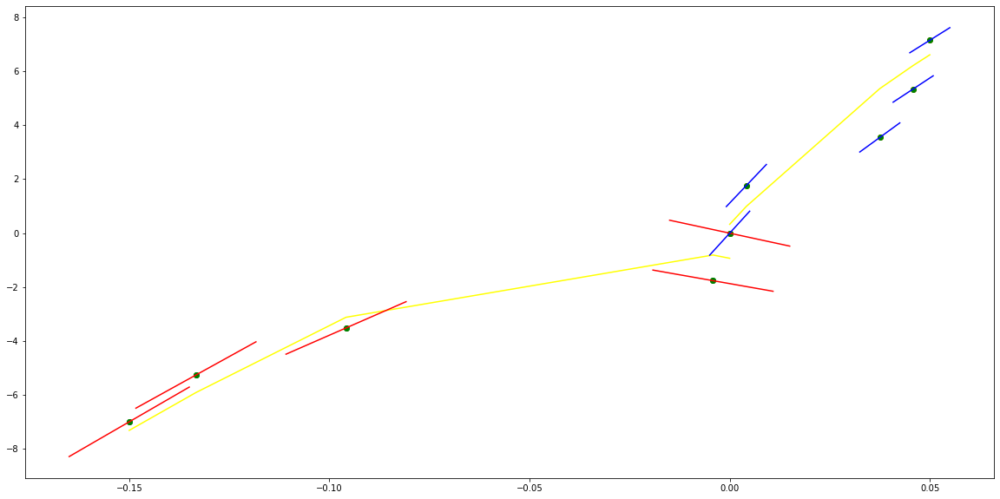

parameters (3767.0730322470436, 1268.2076260981157, 165.6327475137981, -0.12712864723876072)
tangent[0]:67.06503264583935
tangent[1]:73.12129011808952
tangent[2]:79.57001381826066
tangent[3]:145.2815433156702
tangent[4]:165.6327475137981
parameters (25443.484020772652, -5301.16958918039, 333.91349352745715, 0.5154011242834193)
tangent[0]:333.91349352745715
tangent[1]:291.0589396681577
tangent[2]:250.85517280271804
tangent[3]:-9.386160976989231
tangent[4]:57.74334120399499


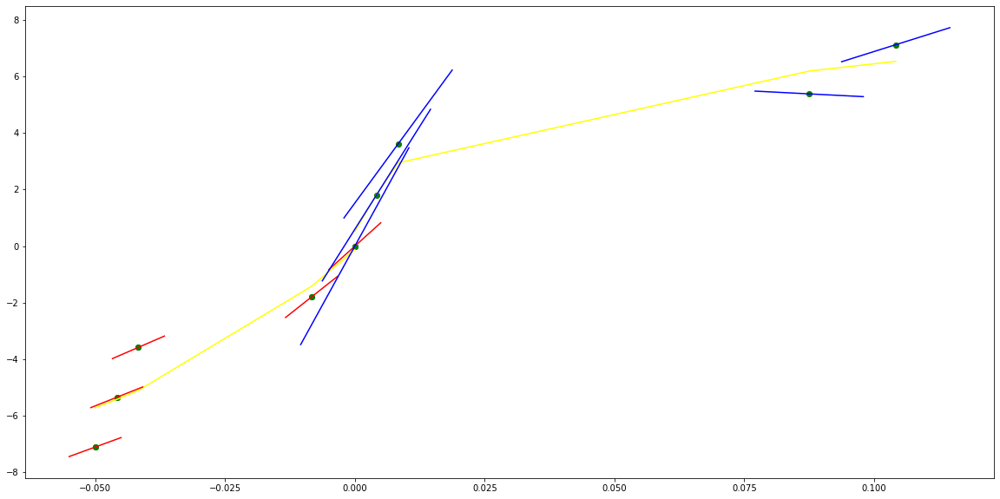

parameters (6.13728170834131, 13.22238499169256, 20.142719885572365, -0.8337845413815718)
tangent[0]:10.76686795400611
tangent[1]:12.274622443128827
tangent[2]:15.20071807226908
tangent[3]:19.281668346953087
tangent[4]:20.142719885572365
parameters (194.90009066530624, -199.24778474709922, 80.96193096506566, 0.17982900863614454)
tangent[0]:80.96193096506566
tangent[1]:69.83678772016592
tangent[2]:58.339943309162315
tangent[3]:46.959376735605
tangent[4]:27.55689706843588


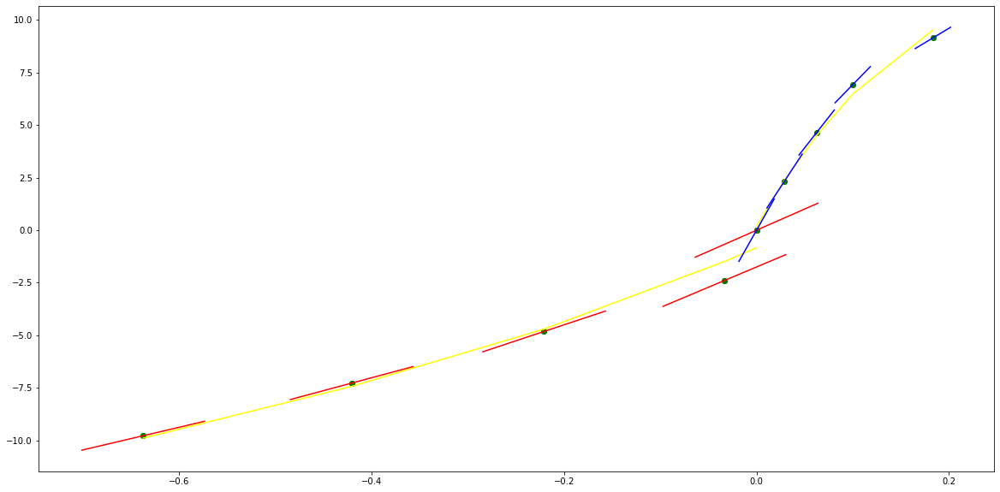

parameters (-427.17050301364986, -95.16113355352266, -64.42615374560083, 0.0400138660819292)
tangent[0]:-58.20904212530579
tangent[1]:-57.39066127291932
tangent[2]:-58.11381916285094
tangent[3]:-59.96533938840037
tangent[4]:-64.42615374560083
parameters (-1020.6901457103245, 363.47407309862734, -122.98634216924759, 0.009328822000484181)
tangent[0]:-122.98634216924759
tangent[1]:-109.17021317747404
tangent[2]:-94.29411095221229
tangent[3]:-86.8574995091574
tangent[4]:-80.91223192083186


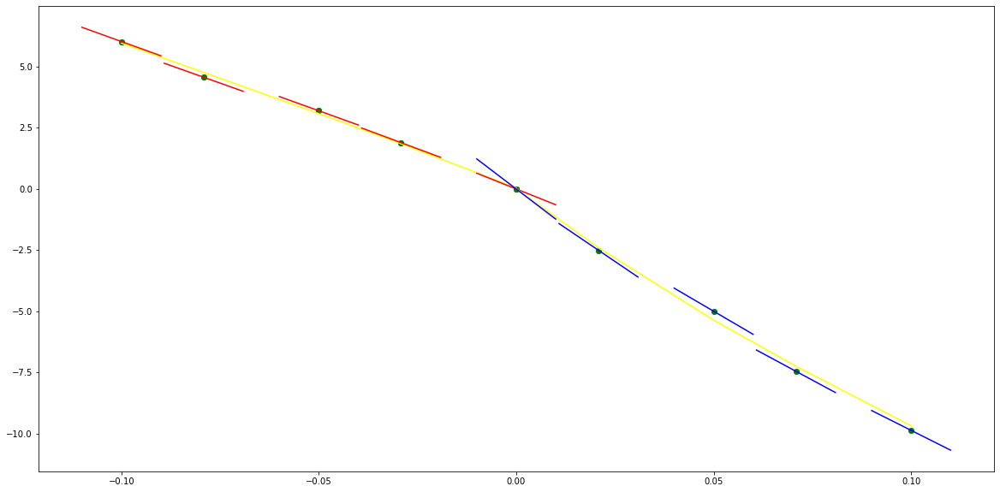

parameters (49940.23308712641, 5662.143803559277, 296.639587741162, -0.5413252757941314)
tangent[0]:174.10871878601506
tangent[1]:92.33644660720563
tangent[2]:93.8012256224396
tangent[3]:252.06282710589613
tangent[4]:296.639587741162
parameters (19449.340365446104, -3039.5445666390074, 227.88951232581104, 0.6876857260610577)
tangent[0]:227.88951232581104
tangent[1]:203.57109646912804
tangent[2]:90.08288297992323
tangent[3]:69.80031293691727
tangent[4]:126.49577257940246


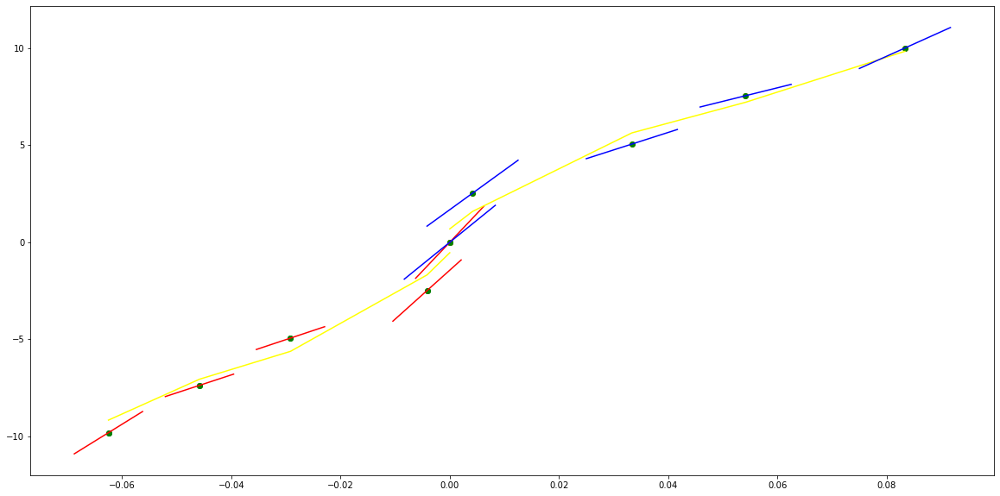

parameters (62054.64269958949, 6194.373748092498, 230.2091170761232, -0.5028676681597778)
tangent[0]:105.36469031925944
tangent[1]:76.1815625137946
tangent[2]:53.463494274951614
tangent[3]:181.8177360428313
tangent[4]:230.2091170761232
parameters (-26412.70405039113, 2176.3655590155217, 184.414510785198, 0.8188449270233519)
tangent[0]:184.414510785198
tangent[1]:201.17645957007082
tangent[2]:243.96165675966654
tangent[3]:241.46351114602214
tangent[4]:236.21333249877455


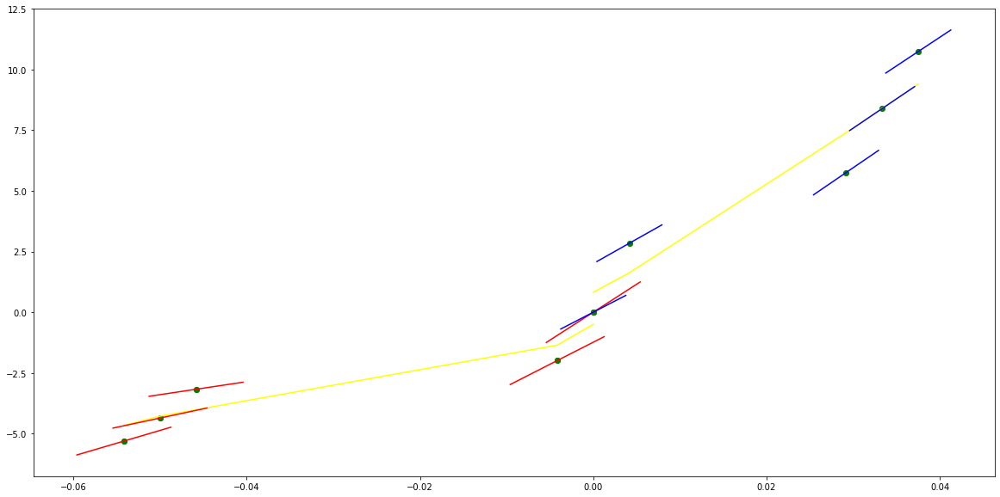

parameters (14.891608761092108, 8.367598564195061, 9.207148049579697, -0.06934282199993592)
tangent[0]:7.771939456831236
tangent[1]:7.667373147759068
tangent[2]:8.013655894507645
tangent[3]:8.757052179324274
tangent[4]:9.207148049579697
parameters (3424.079027672983, -859.6895361681532, 62.07310794758309, 0.11922613613316876)
tangent[0]:62.07310794758309
tangent[1]:55.08682133764893
tangent[2]:48.45726669669721
tangent[3]:-9.873506559062186
tangent[4]:-9.725745714979858


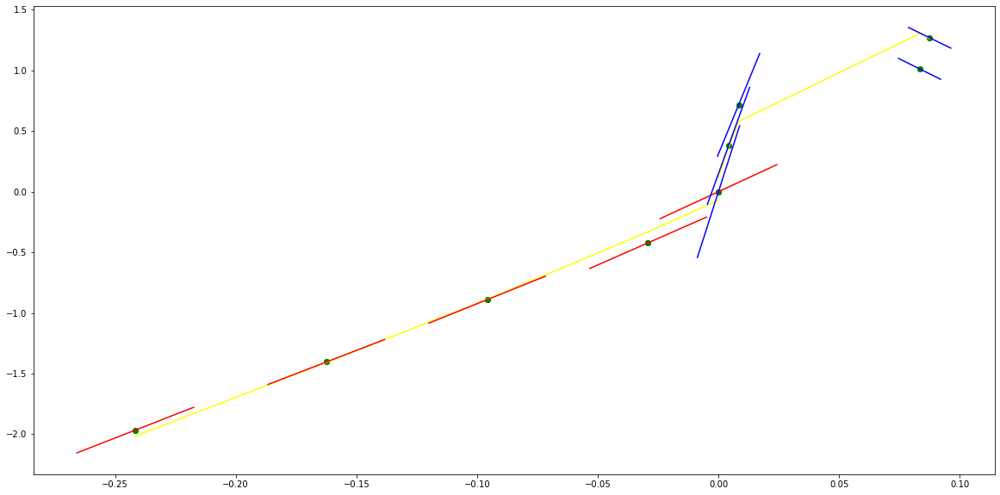

parameters (-540.3329068389567, -439.66819830196687, -90.71617551343141, -0.009895655280668467)
tangent[0]:-73.10049632173721
tangent[1]:-76.51057122487644
tangent[2]:-79.977751605963
tangent[3]:-87.08012759063502
tangent[4]:-90.71617551343141
parameters (-104.68361946147455, 63.4679894016201, -13.818124048723968, -0.21324439707109694)
tangent[0]:-13.818124048723968
tangent[1]:-13.294634969296208
tangent[2]:-6.751478700518836
tangent[3]:-6.749586790481155
tangent[4]:-10.838532323556615


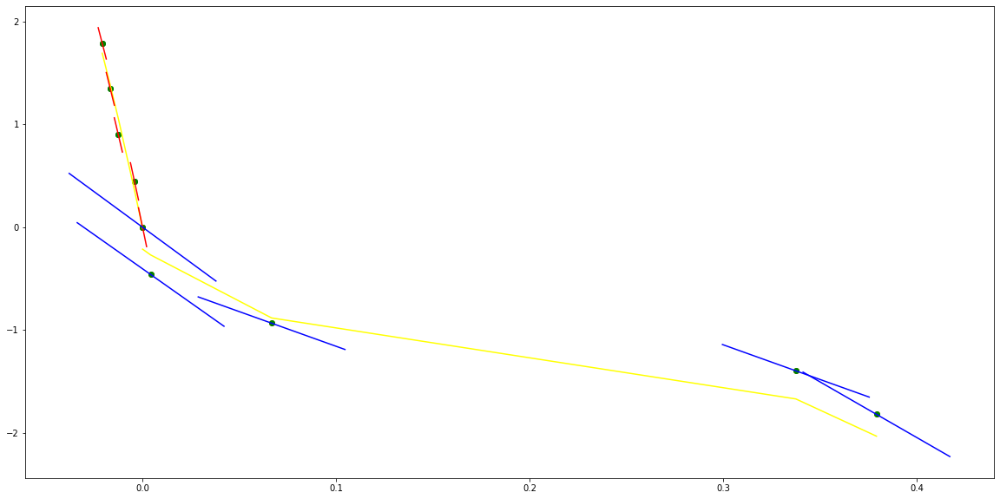

parameters (-75.15101991096985, -213.8447944081464, -149.99331716964963, 4.179039662500445e-06)
tangent[0]:20.17305110828903
tangent[1]:26.933354883446555
tangent[2]:27.566223618866104
tangent[3]:28.19141572274333
tangent[4]:-149.99331716964963
parameters (-0.057582906926026266, 0.4929475069543676, 0.4255499611463536, 0.007584377473561395)
tangent[0]:0.4255499611463536
tangent[1]:0.9965640536141497
tangent[2]:1.3430558089630955
tangent[3]:1.5461163818608628
tangent[4]:1.6924657504216192


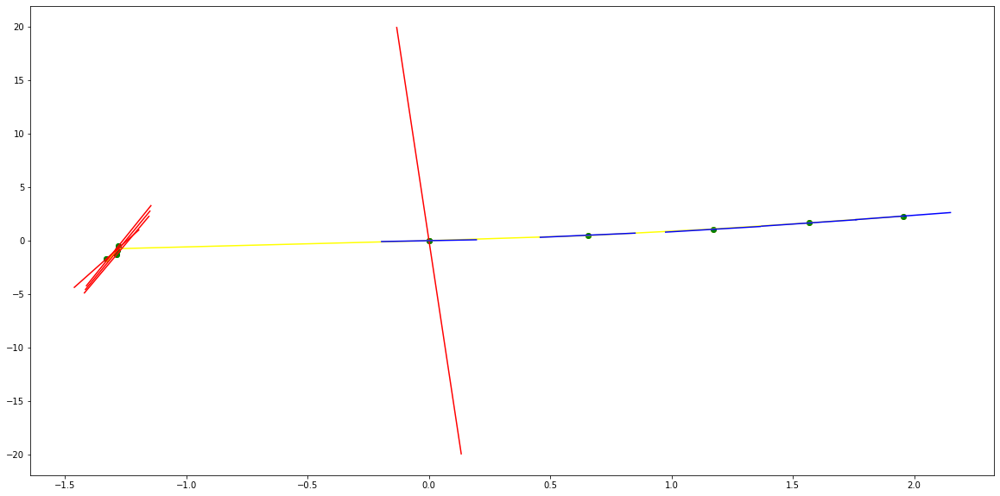

parameters (-0.423659569527718, -1.9511403383167143, 3.8343851775288353, -0.11893266157349781)
tangent[0]:6.826190815631639
tangent[1]:6.738059534093605
tangent[2]:6.316945032546567
tangent[3]:5.239680381374187
tangent[4]:3.8343851775288353
parameters (1628.7479984196896, -1882.6667154136226, 507.3231582546589, 3.309996438895227e-05)
tangent[0]:507.3231582546589
tangent[1]:-213.25972643531009
tangent[2]:402.4720618886738
tangent[3]:417.06885297970143
tangent[4]:431.83533246745105


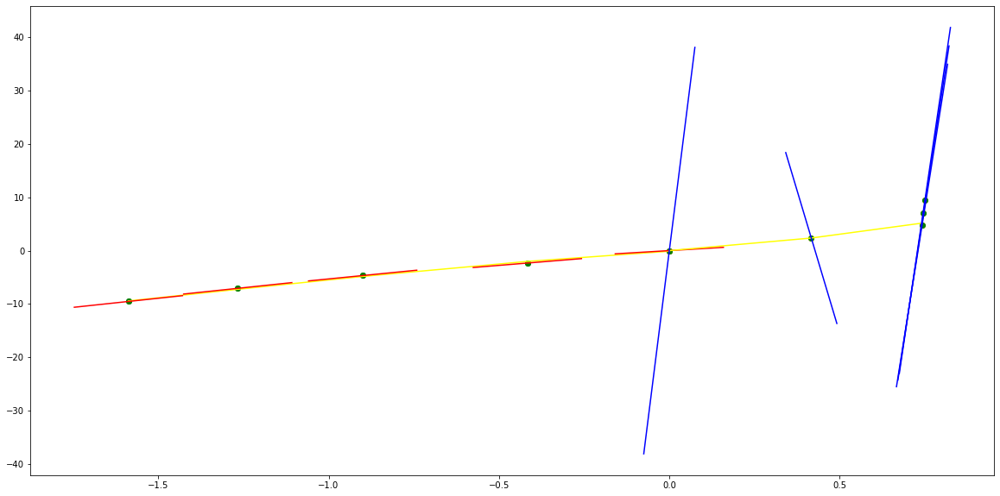

parameters (28.249531628978765, 59.94533316358989, 41.899412460350085, -4.184811852680353)
tangent[0]:39.438395916563486
tangent[1]:39.92473694269293
tangent[2]:40.414021099211425
tangent[3]:41.40129961895925
tangent[4]:41.899412460350085
parameters (1068.983034119886, -682.3276170037994, 160.80023192455857, 0.7288300025999646)
tangent[0]:160.80023192455857
tangent[1]:155.17073660441807
tangent[2]:104.9907107574762
tangent[3]:100.58484298007777
tangent[4]:96.29136265598031


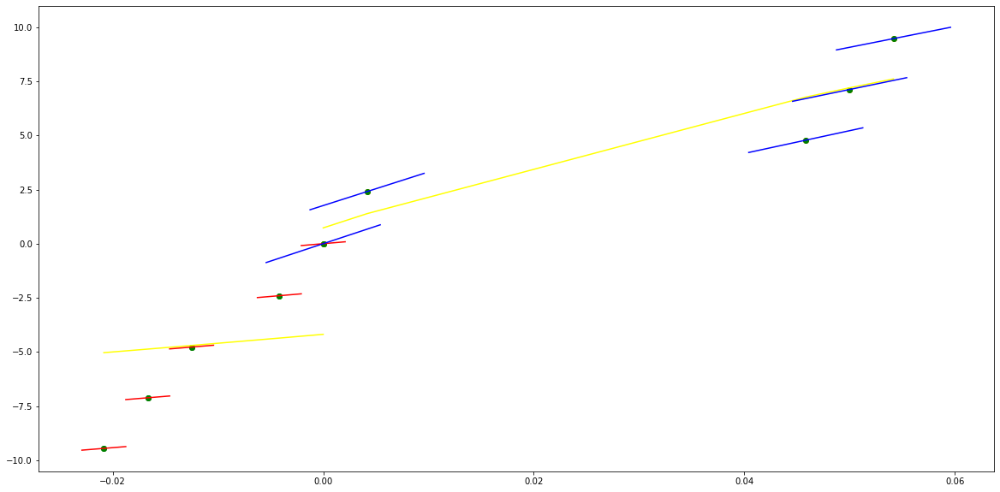

parameters (7851.2923595219445, 2537.525816708365, 242.17672909805344, -0.05272015953233566)
tangent[0]:-15.760425517702288
tangent[1]:-20.376897529186238
tangent[2]:-24.175395726446595
tangent[3]:201.51719641360586
tangent[4]:242.17672909805344
parameters (-12001.951443801816, 2331.890429922276, -1.3079796847926444, 1.6547646377137675)
tangent[0]:-1.3079796847926444
tangent[1]:17.496429756143208
tangent[2]:35.055099698023376
tangent[3]:148.22582844737715
tangent[4]:149.58481637129574


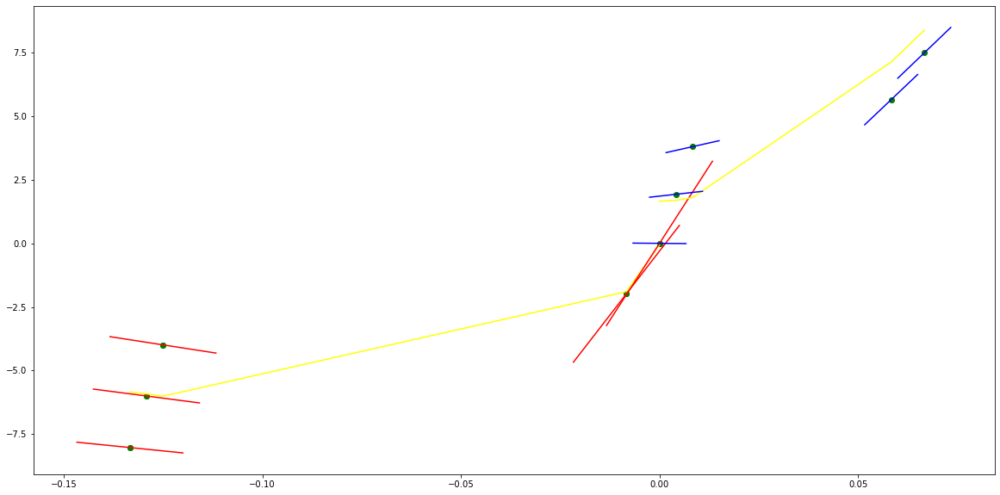

parameters (1160.8443391832016, -2555.3651152049747, -355.1496109169801, 0.007936892827382998)
tangent[0]:-247.16630032833206
tangent[1]:-269.00688800239004
tangent[2]:-290.72133725286363
tangent[3]:-333.79786748028437
tangent[4]:-355.1496109169801
parameters (-5581.5838270412905, 1030.4042589714738, -159.1612392673332, -0.48504613493578425)
tangent[0]:-159.1612392673332
tangent[1]:-150.86460417911576
tangent[2]:-123.49450701873087
tangent[3]:-105.42822661480312
tangent[4]:-96.66359492696238


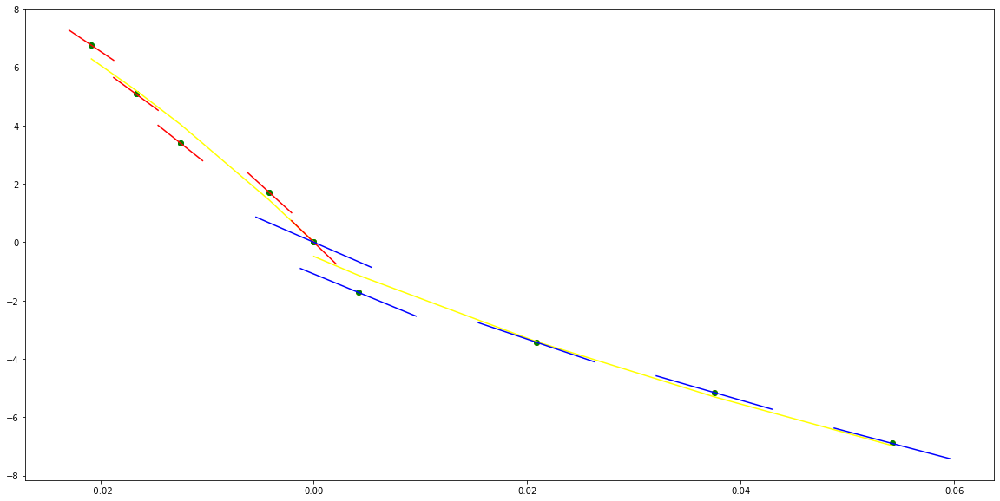

parameters (-234.85972379535698, -69.5656007080819, -30.99594270063067, 0.13202062524893002)
tangent[0]:-24.2610126791672
tangent[1]:-24.397232162762403
tangent[2]:-26.099226368395897
tangent[3]:-29.366893178457698
tangent[4]:-30.99594270063067
parameters (-532.5761709574541, 400.8554610679286, -74.35029605442159, -0.2733963699776119)
tangent[0]:-74.35029605442159
tangent[1]:-71.03730942243112
tangent[2]:-67.78058343312097
tangent[3]:-55.30610332157039
tangent[4]:-54.02510375671616


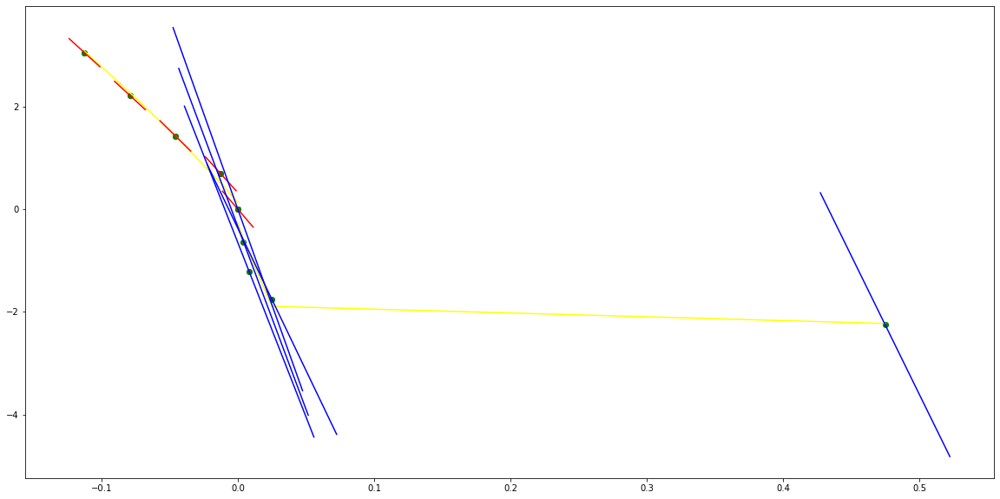

parameters (664.9562666201972, 63.412822577274014, 70.72074650898367, -0.8944669362696918)
tangent[0]:83.07691500941326
tangent[1]:71.13183343945857
tangent[2]:70.58659993627985
tangent[3]:70.22690272603501
tangent[4]:70.72074650898367
parameters (3388.285270117543, -1220.3694743326264, 158.33665172394203, 0.903820026625263)
tangent[0]:158.33665172394203
tangent[1]:148.34259395284587
tangent[2]:111.9004258077742
tangent[3]:36.452062010100775
tangent[4]:13.613249679550876


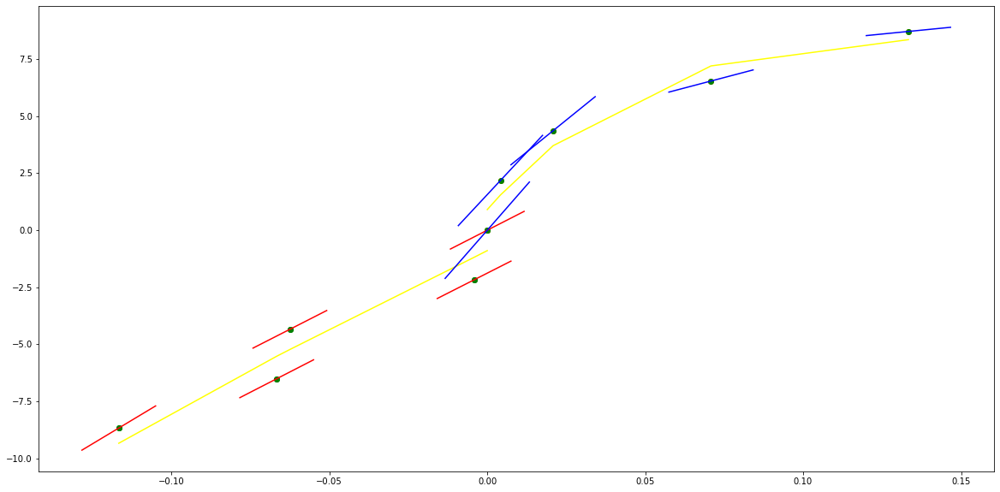

parameters (3759.644180184973, 1159.946918368144, 125.89454037784928, 0.24787176775547248)
tangent[0]:132.1219134653129
tangent[1]:41.33542346311769
tangent[2]:7.157305386150512
tangent[3]:67.82534140710611
tangent[4]:125.89454037784928
parameters (4432.5944305087605, -1619.4100680050524, 227.56436883264524, 1.1885788426121535)
tangent[0]:227.56436883264524
tangent[1]:214.3022345686191
tangent[2]:201.49866393719938
tangent[3]:154.90497998959654
tangent[4]:91.14554251617943


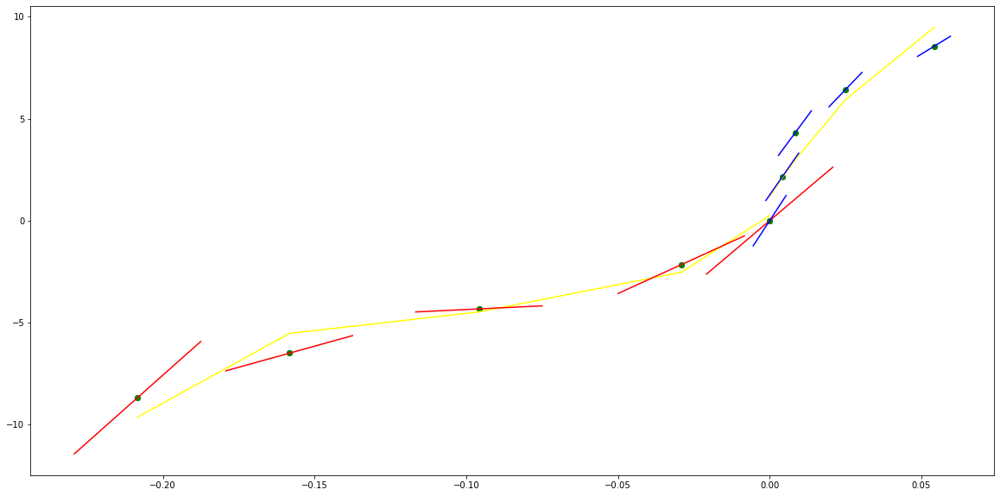

parameters (14.464913889014932, 15.415889064403515, 24.26210420877199, -0.4768624941288979)
tangent[0]:18.815160215048337
tangent[1]:19.345461329401942
tangent[2]:20.76517115206315
tangent[3]:23.399750245534797
tangent[4]:24.26210420877199
parameters (787.0076826671932, -478.7149536894316, 102.47996662664495, 1.375511845986821)
tangent[0]:102.47996662664495
tangent[1]:98.53229050023148
tangent[2]:94.6656500258135
tangent[3]:69.8965337611898
tangent[4]:36.781432442256516


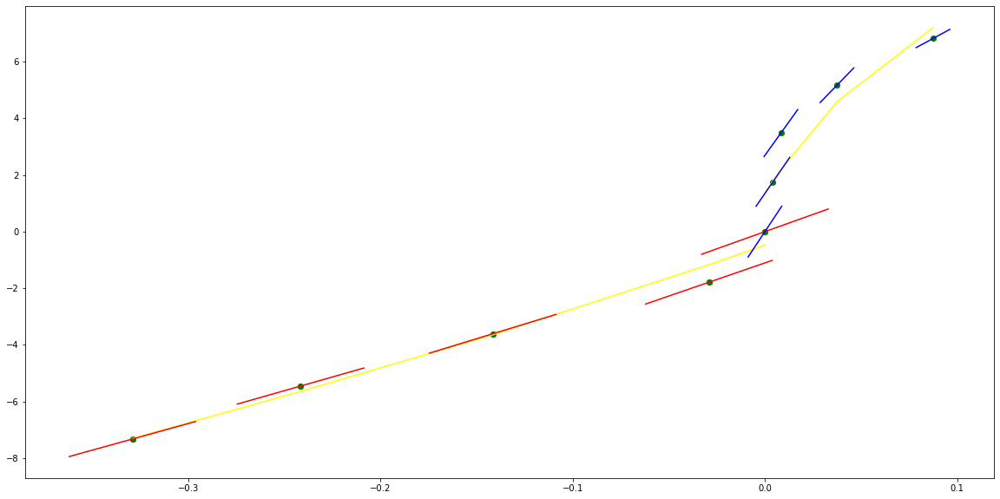

parameters (4334.549467236761, 1330.207162393184, 115.76469130601785, -0.5841171786471371)
tangent[0]:137.62264542864463
tangent[1]:93.46502166001207
tangent[2]:-15.633224144105043
tangent[3]:104.90709077699803
tangent[4]:115.76469130601785
parameters (244.50092606010577, -186.7634142856314, 63.78161799451939, 0.9056180426417603)
tangent[0]:63.78161799451939
tangent[1]:62.23786816068445
tangent[2]:52.145510378241404
tangent[3]:37.74798405591533
tangent[4]:23.62960820705539


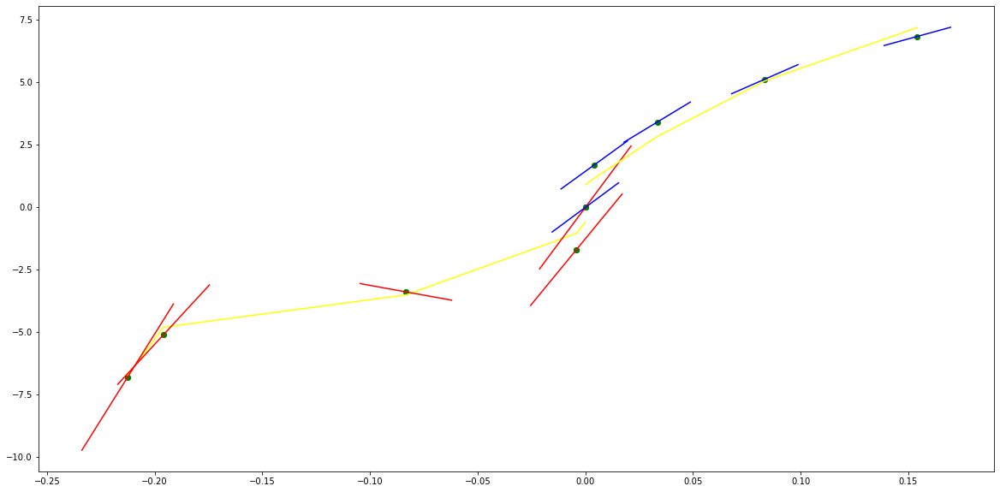

parameters (11.866267334167022, 15.279875466421966, 15.903677465310338, -0.6774987118931534)
tangent[0]:9.345181762939937
tangent[1]:10.102877546352559
tangent[2]:12.55032194689499
tangent[3]:15.776983379925797
tangent[4]:15.903677465310338
parameters (63081.999032174324, -8719.823207278154, 379.7396079365715, -0.1596606294651834)
tangent[0]:379.7396079365715
tangent[1]:310.3546478143937
tangent[2]:191.31371480094933
tangent[3]:141.64345642630184
tangent[4]:98.54529102621109


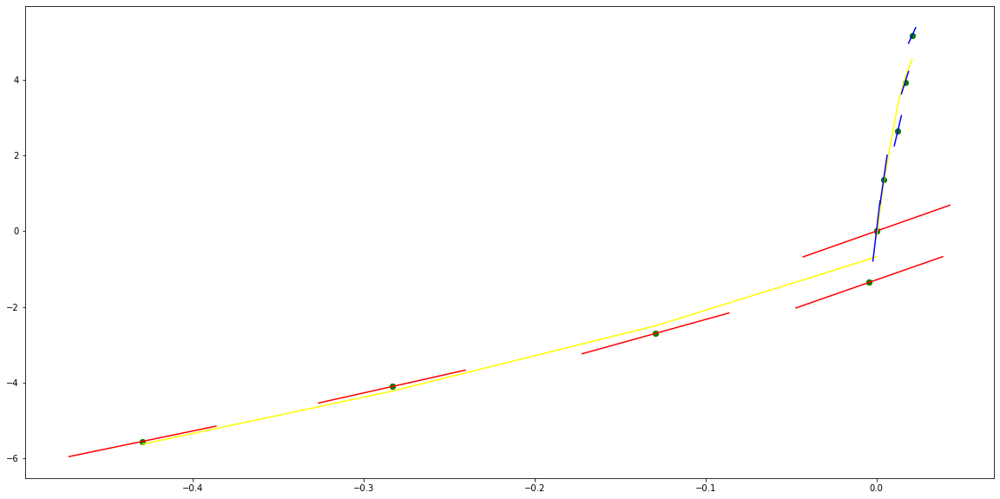

parameters (21751.151568615303, 3008.2602804245, 149.99734181269628, 0.13483158082556396)
tangent[0]:146.78927181418237
tangent[1]:21.9510504504467
tangent[2]:30.02771692869652
tangent[3]:40.36773698262499
tangent[4]:149.99734181269628
parameters (48269.329338858115, -6434.838506780578, 265.08539561537214, 0.06921782116648262)
tangent[0]:265.08539561537214
tangent[1]:213.97188133009593
tangent[2]:167.88722670528597
tangent[3]:50.70013193040029
tangent[4]:80.04233806372349


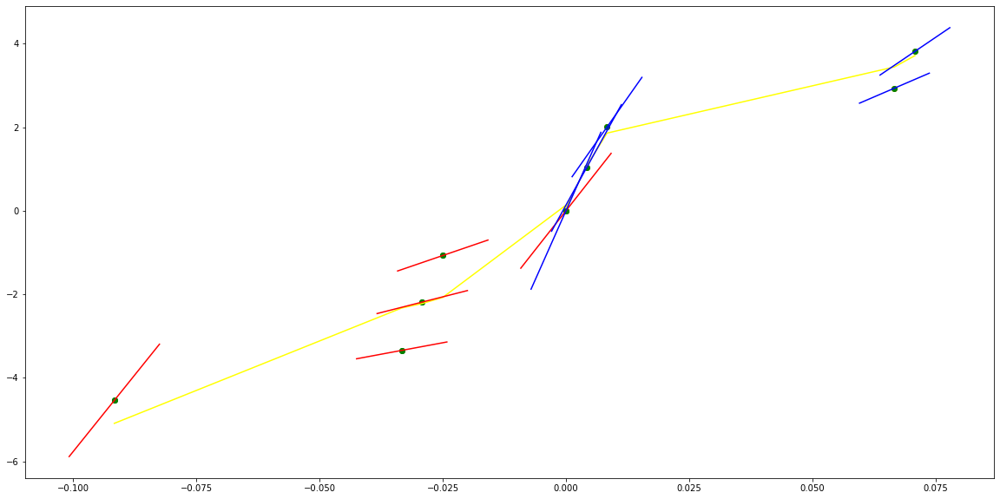

parameters (-22742.86090279202, -3946.061953765138, -353.1928865881518, 0.7153851438696812)
tangent[0]:-134.79685361303572
tangent[1]:-181.046311514017
tangent[2]:-265.2020537922071
tangent[3]:-321.4911198022487
tangent[4]:-353.1928865881518
parameters (-59986.85431520039, 9516.293856697144, -644.6182369187466, 0.10291385533213157)
tangent[0]:-644.6182369187466
tangent[1]:-568.4517921327399
tangent[2]:-434.82972846156815
tangent[3]:-377.4061763063458
tangent[4]:-326.217720876253


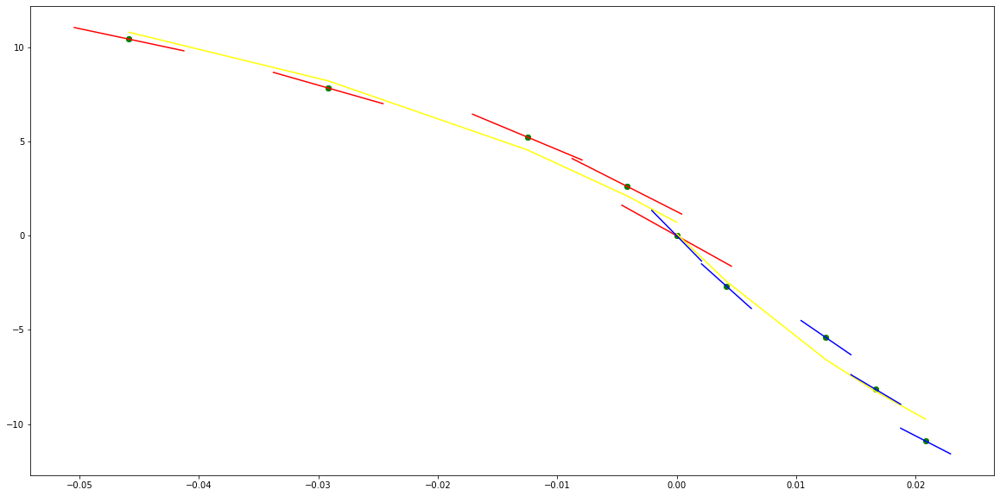

parameters (-49541.73644745134, -8378.491148762392, -602.3029258115259, -0.560329724937391)
tangent[0]:-276.2691242123776
tangent[1]:-364.3007336392852
tangent[2]:-416.0633360522089
tangent[3]:-472.973081894444
tangent[4]:-602.3029258115259
parameters (-33683.194702756875, 5465.5932920976775, -422.63204139396, -0.9382874997295901)
tangent[0]:-422.63204139396
tangent[1]:-378.84648979996996
tangent[2]:-338.55923444225044
tangent[3]:-212.50836685674528
tangent[4]:-142.60091309952884


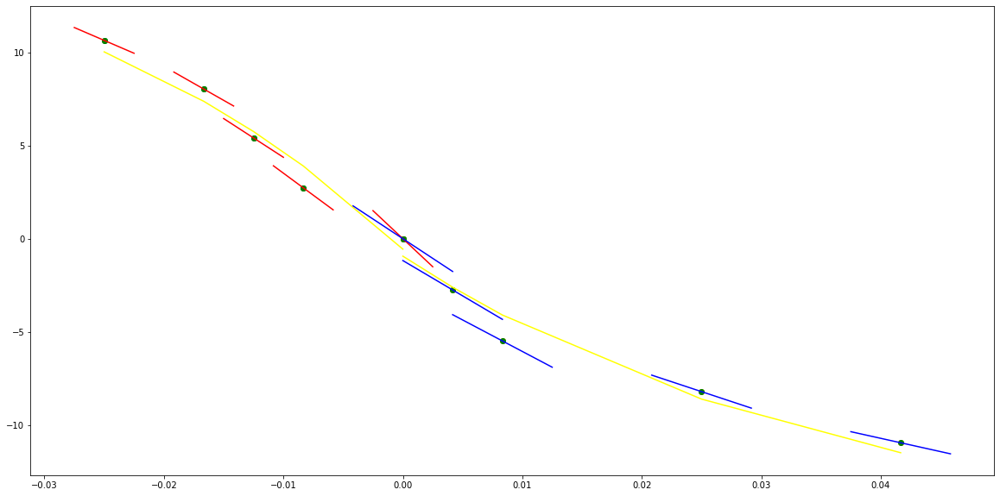

parameters (26078.767182817162, 4816.387000950744, 255.37698864197776, -0.28452564965663607)
tangent[0]:196.43922251487336
tangent[1]:161.86810490064968
tangent[2]:-4.044257433290539
tangent[3]:216.59570583191208
tangent[4]:255.37698864197776
parameters (887.2054190409459, -301.86929052887285, 71.45988478551148, 0.6145705977988186)
tangent[0]:71.45988478551148
tangent[1]:68.99090368682592
tangent[2]:46.5668446094631
tangent[3]:42.04943408749879
tangent[4]:38.767012251300095


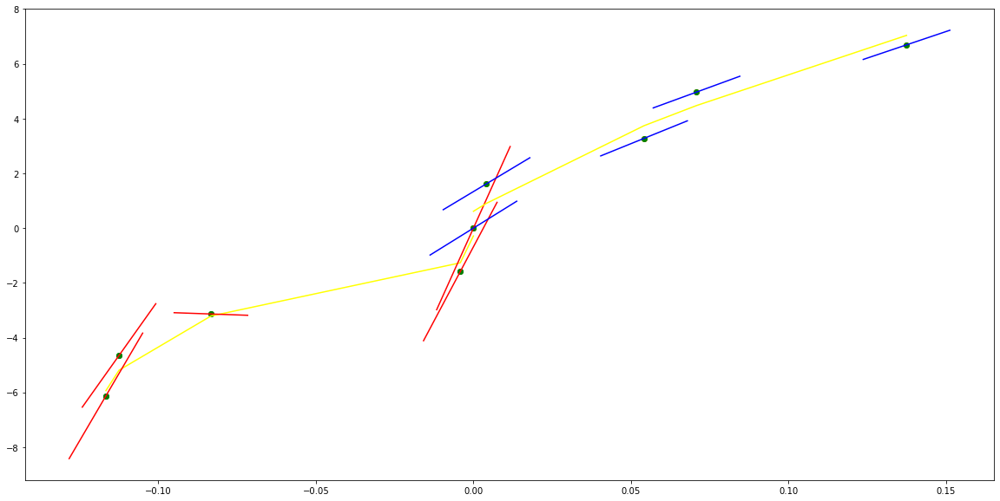

parameters (24.634569922896727, 26.989619131333164, 40.00712937899883, -0.09242110624723575)
tangent[0]:30.550128795221667
tangent[1]:31.96908876167069
tangent[2]:34.26781102092544
tangent[3]:37.10983350069401
tangent[4]:40.00712937899883
parameters (4968.752043646217, -1844.1007578119377, 266.0453925034386, 1.1535354522981138)
tangent[0]:266.0453925034386
tangent[1]:250.9354873646971
tangent[2]:236.3466831386267
tangent[3]:148.69975835167577
tangent[4]:138.24843091025588


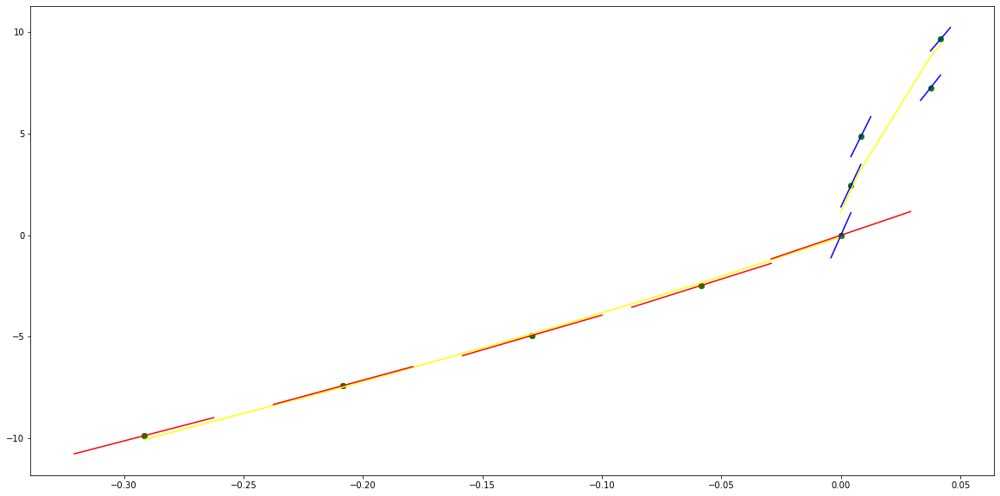

parameters (3036.220856951032, 928.0179131685827, 136.6544408687539, -0.5714323429015352)
tangent[0]:45.23916458091966
tangent[1]:66.62430597902838
tangent[2]:70.71996830786514
tangent[3]:129.0785013862257
tangent[4]:136.6544408687539
parameters (-19.10057329504748, 5.725599567060047, 31.508714947779065, 0.8859775250642572)
tangent[0]:31.508714947779065
tangent[1]:31.555426140163448
tangent[2]:32.07978506171573
tangent[3]:31.912201623353305
tangent[4]:31.299819607457863


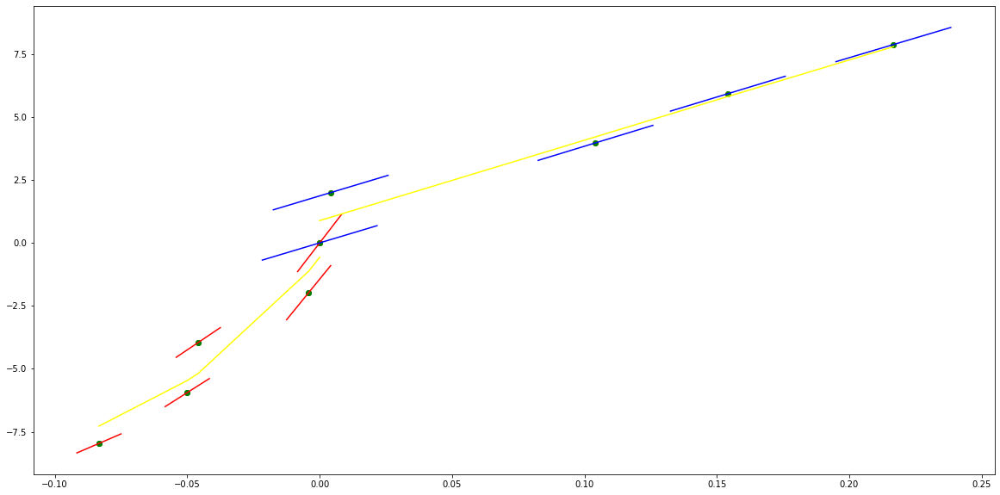

parameters (127.69433998365785, 183.6200417141558, 82.7715555364128, -0.3678464819956843)
tangent[0]:54.828311738607674
tangent[1]:56.099199691524454
tangent[2]:57.38339126651366
tangent[3]:79.73758392526611
tangent[4]:82.7715555364128
parameters (-9741.60537822786, 1724.4159789586388, 23.962286062883628, 1.4310324113925257)
tangent[0]:23.962286062883628
tangent[1]:37.82290706655181
tangent[2]:50.6720640045866
tangent[3]:125.6985822787097
tangent[4]:123.99664340813746


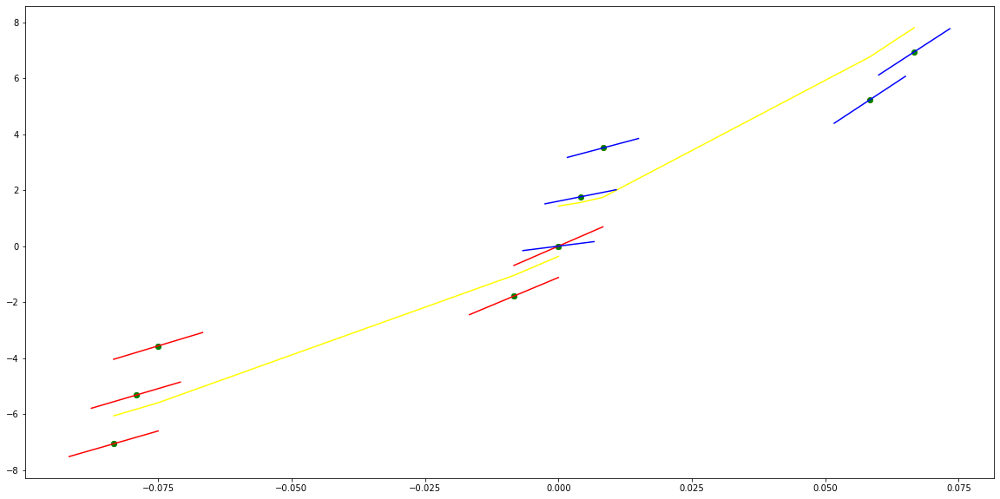

parameters (34.3510907158573, 33.66266051441071, 27.32877667444553, -0.8090604775315065)
tangent[0]:16.52615970651548
tangent[1]:18.096408178874306
tangent[2]:22.433997695227443
tangent[3]:27.050021467297086
tangent[4]:27.32877667444553
parameters (2362.1285170318893, -708.4813273501605, 110.9505432827831, 0.5111845263899221)
tangent[0]:110.9505432827831
tangent[1]:105.16910711276729
tangent[2]:71.59253136264982
tangent[3]:54.98983511463198
tangent[4]:41.22145037208121


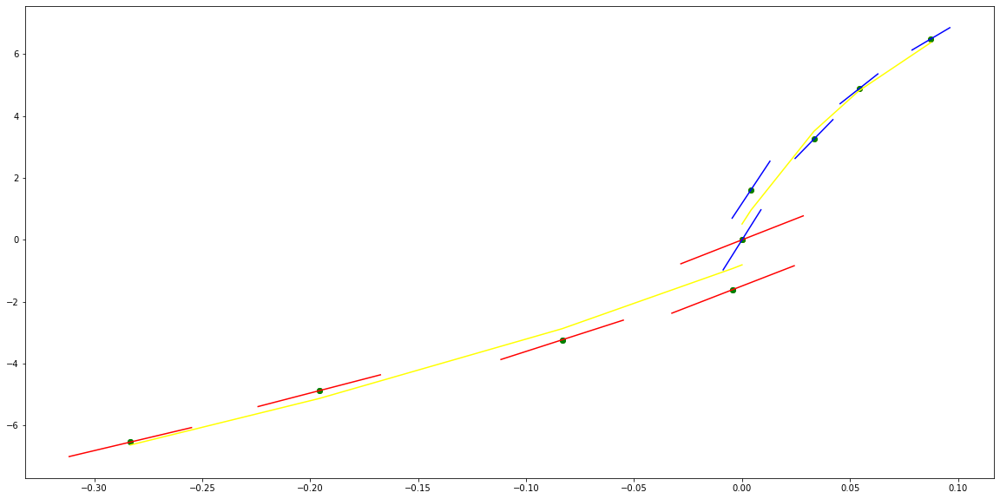

parameters (141.76765035648927, 128.63805004837738, 53.73662951926284, -0.5289219077950192)
tangent[0]:29.509877551330405
tangent[1]:32.26204902028204
tangent[2]:39.31821291583078
tangent[3]:52.671944923393404
tangent[4]:53.73662951926284
parameters (23208.203401124025, -5368.04906874321, 341.9267403674356, 0.08808608677325341)
tangent[0]:341.9267403674356
tangent[1]:298.39837343176936
tangent[2]:-35.43697134748561
tangent[3]:-20.940188139661473
tangent[4]:182.05353312055638


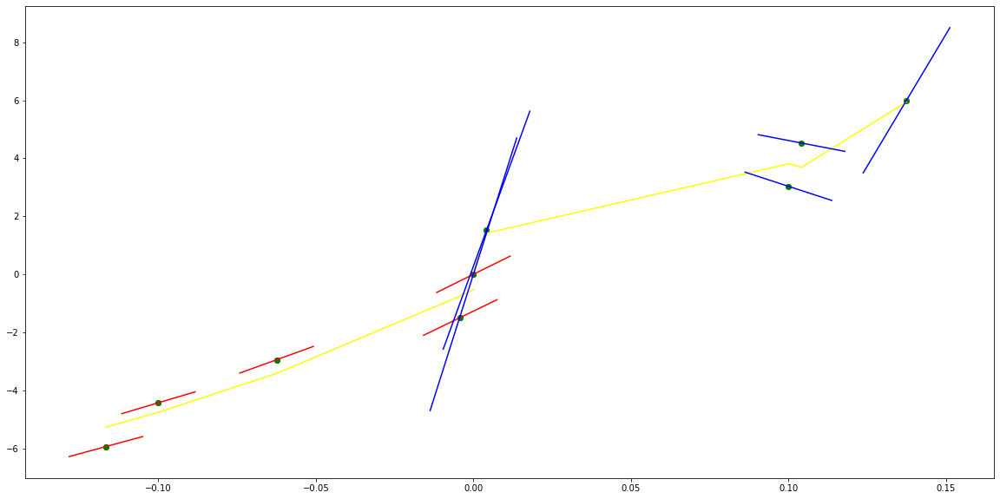

parameters (209.45199320909973, 180.10528555005945, 64.07670737959111, 0.2949503361841042)
tangent[0]:34.339210065852214
tangent[1]:38.42282814136543
tangent[2]:42.85527040584972
tangent[3]:52.76796776041145
tangent[4]:64.07670737959111
parameters (3993.5761241784066, -1062.1297724399662, 146.40232129711922, 0.2655773946669935)
tangent[0]:146.40232129711922
tangent[1]:137.7585638112044
tangent[2]:94.63621517845831
tangent[3]:88.90603206448736
tangent[4]:83.5904876379994


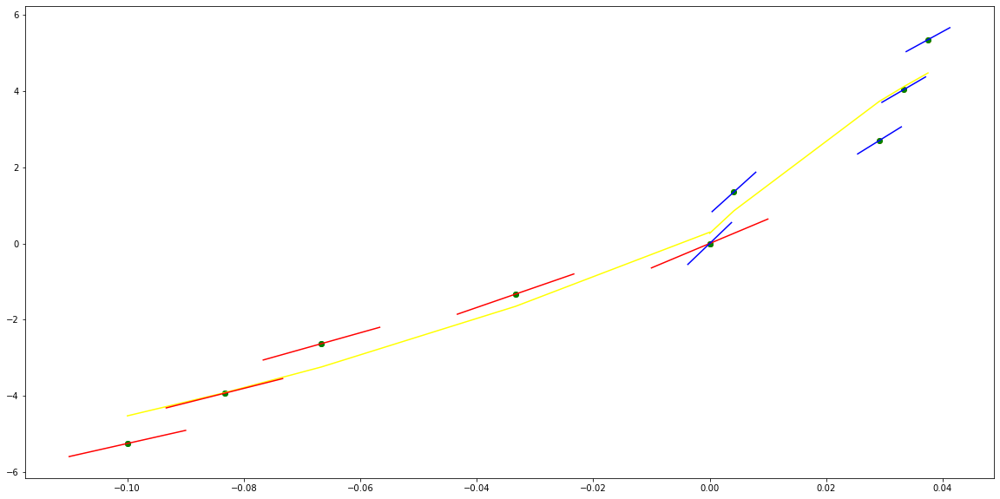

parameters (1115.2751085524021, 778.4681360146475, 154.17145447148405, -0.25098398556148055)
tangent[0]:100.49141113459095
tangent[1]:105.9916070598041
tangent[2]:111.60799606415344
tangent[3]:147.74332662101568
tangent[4]:154.17145447148405
parameters (348.4181374756532, -160.39302140846948, 50.14201508040424, 0.6399561851318522)
tangent[0]:50.14201508040424
tangent[1]:48.8234493215802
tangent[2]:35.832840725458965
tangent[3]:28.068504191472528
tangent[4]:25.845824135120306


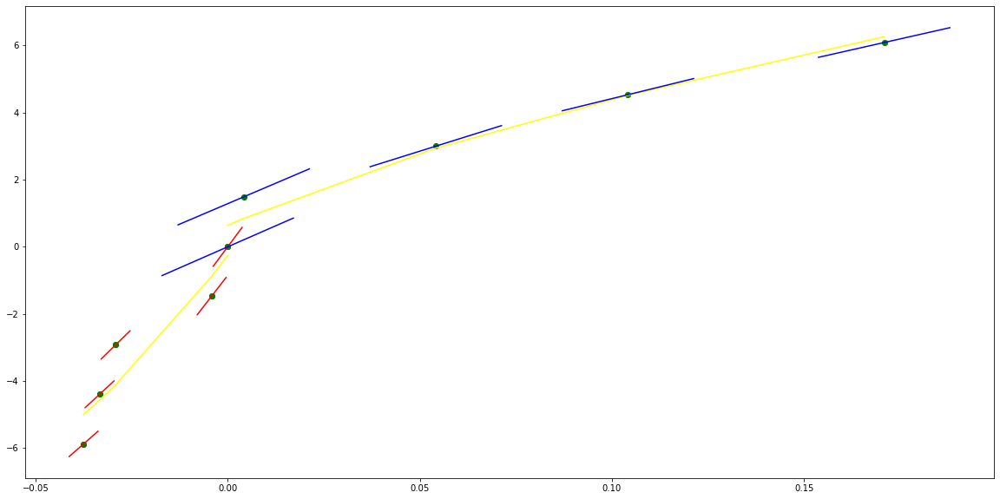

parameters (-4487.107575445352, -1003.485050534482, -264.18576300994664, 0.13321423423262402)
tangent[0]:-191.33342359288662
tangent[1]:-200.478016917042
tangent[2]:-217.1002002796736
tangent[3]:-241.2019684225746
tangent[4]:-264.18576300994664
parameters (-43891.557795511224, 7160.3068924903755, -546.4183679083189, -1.1771638053141735)
tangent[0]:-546.4183679083189
tangent[1]:-489.0307546790992
tangent[2]:-436.2280362674731
tangent[3]:-270.6996941503837
tangent[4]:-178.32687449226046


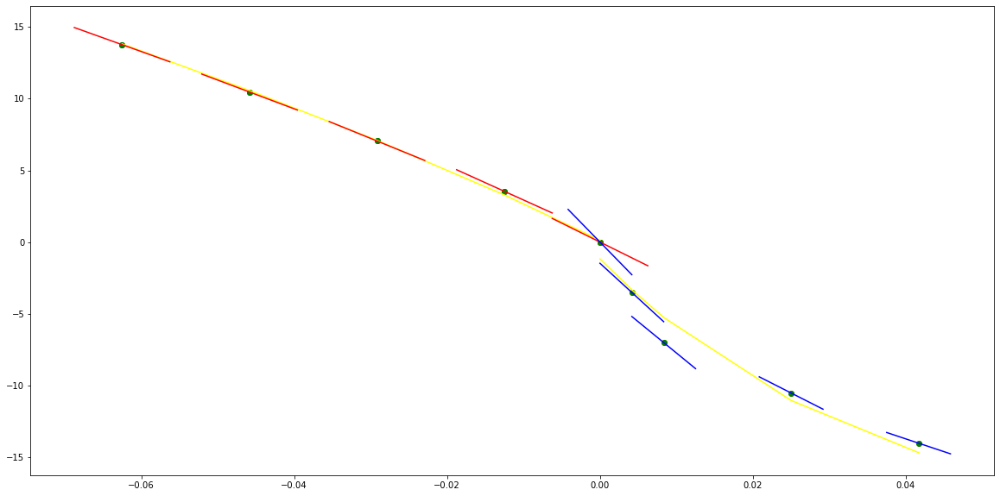

parameters (95.04816882357585, 58.88901880206971, -214.76820243212876, 0.0007614692769055053)
tangent[0]:-221.35270951545027
tangent[1]:-219.9442430461589
tangent[2]:-218.37727686668853
tangent[3]:-216.65189073590423
tangent[4]:-214.76820243212876
parameters (6059.2177363326855, -1216.8146616270778, -112.4451559441146, -0.4547990517990847)
tangent[0]:-112.4451559441146
tangent[1]:-147.95690578523676
tangent[2]:-185.80131637230167
tangent[3]:-193.54053079985067
tangent[4]:-191.18141238667653


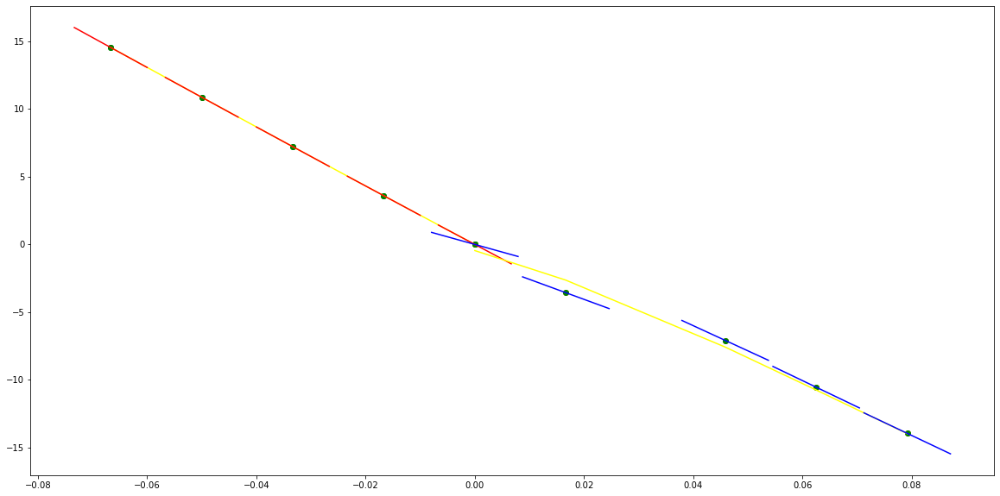

parameters (1589.2874623866942, 114.58345415264185, 57.88538827073122, 0.07905080308903324)
tangent[0]:69.62457284400759
tangent[1]:58.34669882336725
tangent[2]:57.39765770680368
tangent[3]:56.61419385675595
tangent[4]:57.88538827073122
parameters (82630.21987910823, -9289.713178588183, 346.7555470772984, 0.025949845120077756)
tangent[0]:346.7555470772984
tangent[1]:273.6394233450238
tangent[2]:209.1319914089077
tangent[3]:-1.3767012018274727
tangent[4]:2.979203469052777


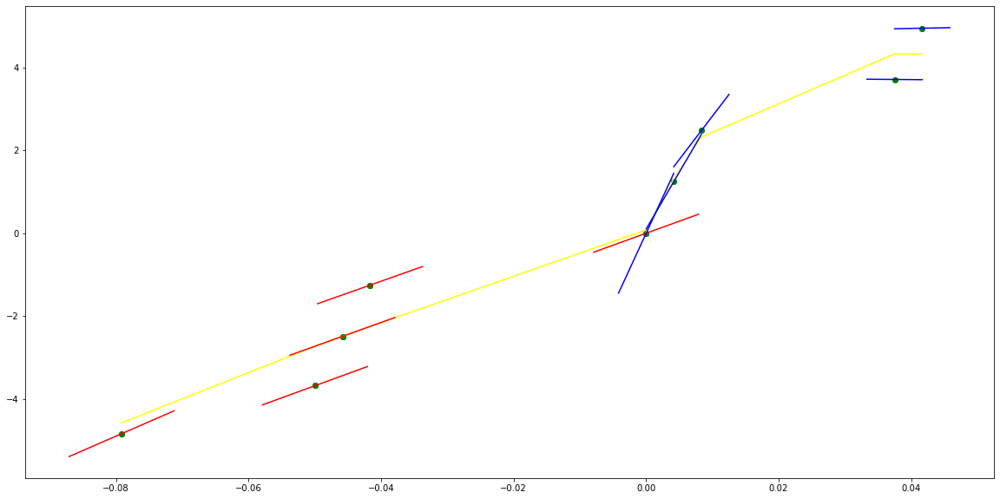

parameters (-11716.23216317508, -1793.1511319912306, 23.066559865119594, 0.031339270286092076)
tangent[0]:109.91085570181545
tangent[1]:108.12504032606702
tangent[2]:103.55669014221729
tangent[3]:97.76675371481139
tangent[4]:23.066559865119594
parameters (5926.191036150467, -1248.510495708935, 139.9700303345939, 0.2623708104360618)
tangent[0]:139.9700303345939
tangent[1]:129.87599790553088
tangent[2]:82.26535809135669
tangent[3]:76.49040467073658
tangent[4]:71.33286159018357


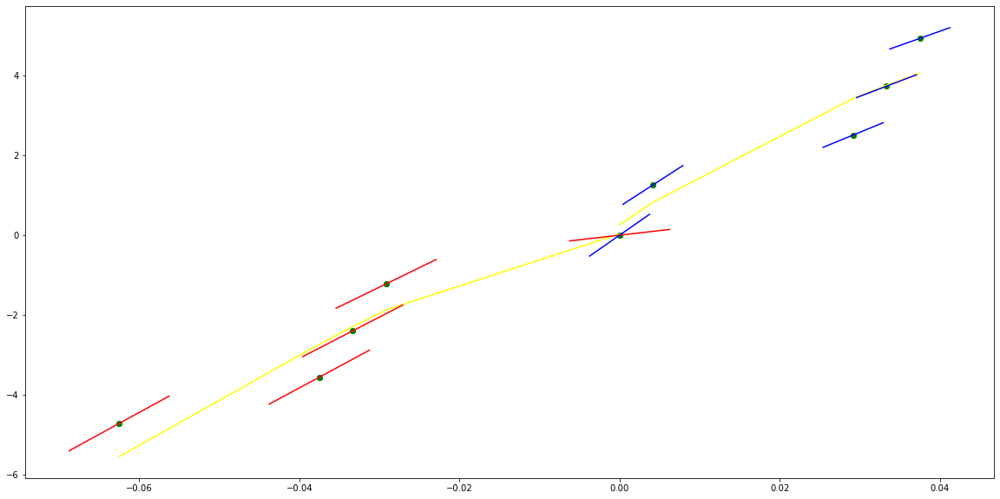

parameters (6483.18934785206, 910.1229919561334, 121.91315657089638, -0.2729042432028437)
tangent[0]:81.00488723543725
tangent[1]:82.84909613819352
tangent[2]:85.36874532216231
tangent[3]:114.66756986927362
tangent[4]:121.91315657089638
parameters (-28765.33939454731, 5565.85052698, -167.23212385147323, 0.8297481847696532)
tangent[0]:-167.23212385147323
tangent[1]:-122.34476004050467
tangent[2]:173.61288338742193
tangent[3]:182.54069642126692
tangent[4]:191.40537099117543


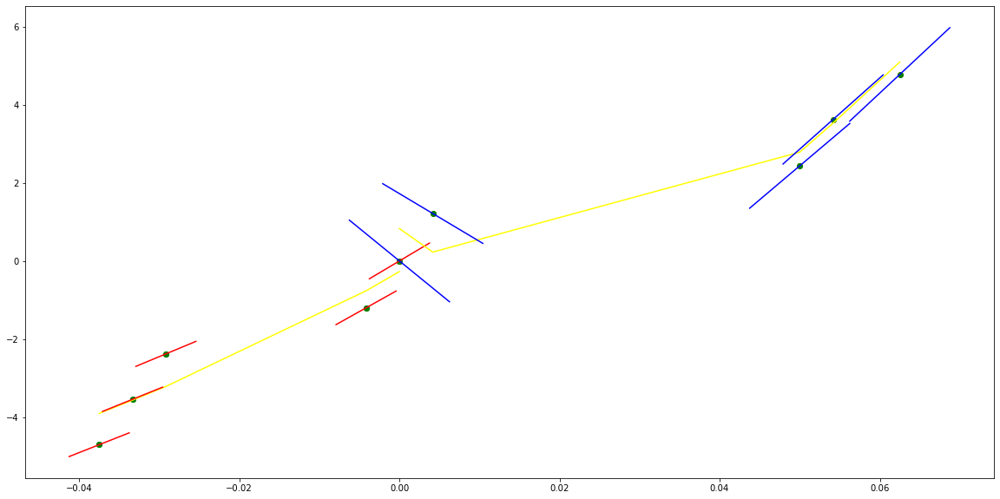

parameters (3184.1205417491396, 684.8057973170471, 68.74312514486724, -0.5256172453997338)
tangent[0]:72.16115291188714
tangent[1]:35.55889756806927
tangent[2]:26.036018048829398
tangent[3]:63.20181977697562
tangent[4]:68.74312514486724
parameters (6381.889891221133, -2084.1665830721604, 216.20065765061744, 0.5548961686317452)
tangent[0]:216.20065765061744
tangent[1]:199.1636566303382
tangent[2]:167.08800396032333
tangent[3]:152.045503078298
tangent[4]:137.6712593529088


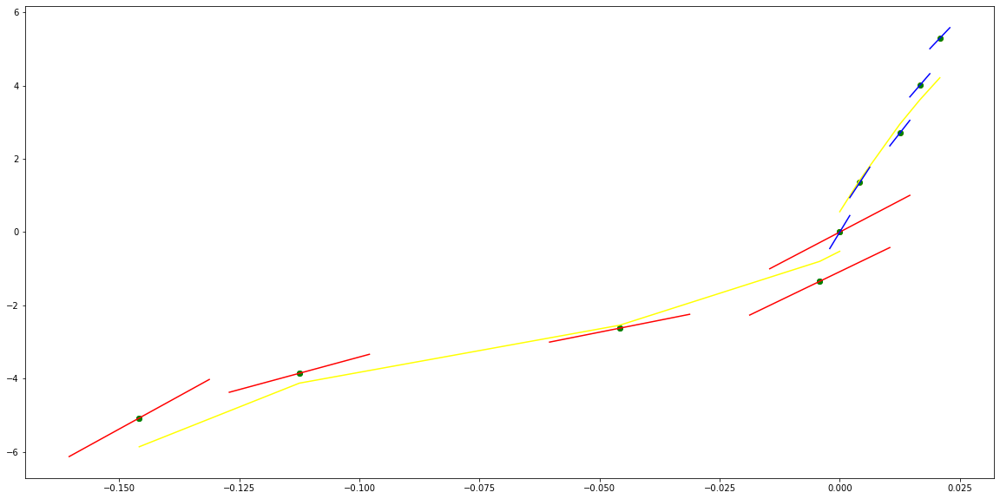

parameters (34448.84564086104, 5267.319446648717, 264.8766042778099, -0.12148197521260243)
tangent[0]:15.158713326538674
tangent[1]:28.5526749388369
tangent[2]:45.53563214245145
tangent[3]:222.78293525729876
tangent[4]:264.8766042778099
parameters (53505.22009121451, -5728.845050686042, 202.22702203390116, 0.3346865682801009)
tangent[0]:202.22702203390116
tangent[1]:157.27000348923696
tangent[2]:113.13568864206599
tangent[3]:151.7872646424359
tangent[4]:196.01319285831215


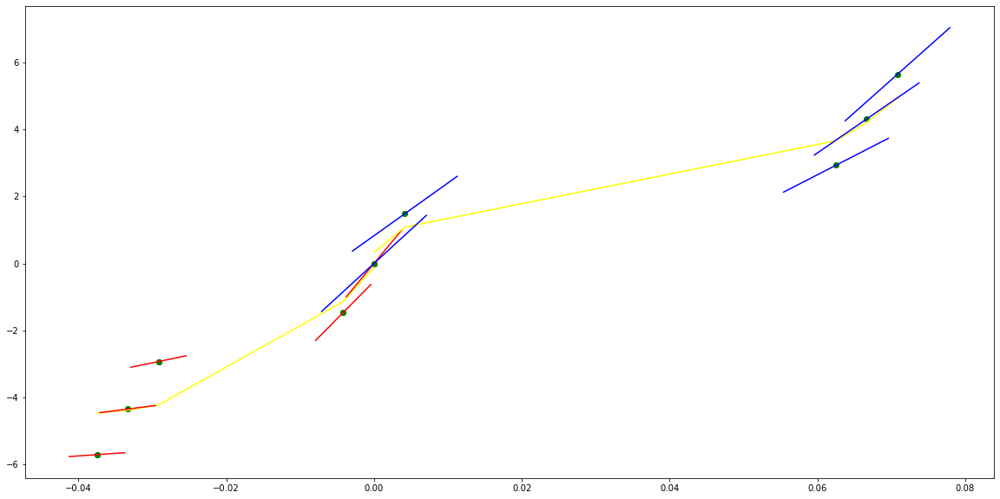

parameters (7.727776566229637, 12.139806365493174, 13.320497121589526, -0.5653971151703444)
tangent[0]:7.3422706059795635
tangent[1]:8.544575091755892
tangent[2]:10.725190845091204
tangent[3]:13.219726528103044
tangent[4]:13.320497121589526
parameters (1743.63557212796, -622.3683155936739, 71.57123844612951, 0.3332421802040193)
tangent[0]:71.57123844612951
tangent[1]:66.47645093505
tangent[2]:19.496081904687834
tangent[3]:-1.3997985887199462
tangent[4]:51.78906064243327


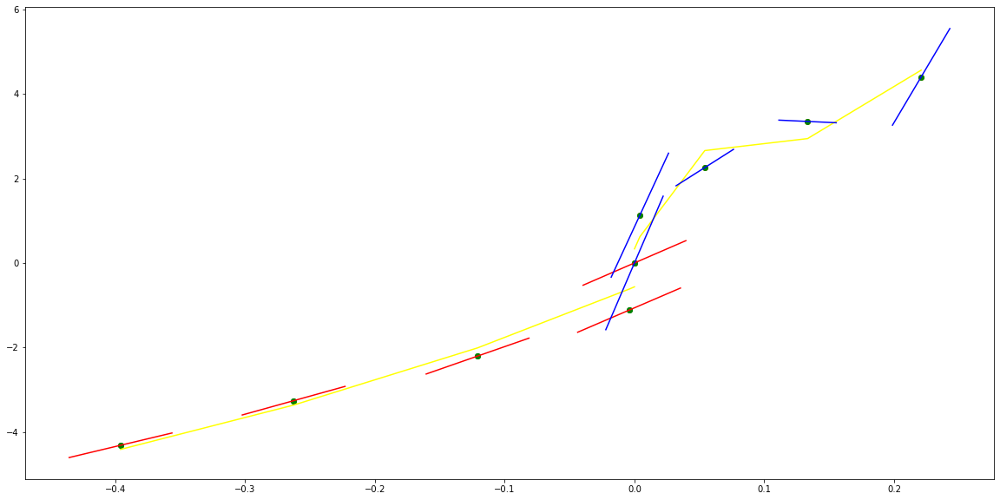

parameters (-25233.649750249435, -4484.658188739913, -95.44288623740478, 0.029994958665020777)
tangent[0]:170.1738195741205
tangent[1]:163.77055950971578
tangent[2]:156.62757087502206
tangent[3]:146.8542573346076
tangent[4]:-95.44288623740478
parameters (24454.896496972935, -4250.009507599838, 259.4439330339045, 0.27690506109012625)
tangent[0]:259.4439330339045
tangent[1]:225.3061387934649
tangent[2]:193.70763711032498
tangent[3]:57.627490538548614
tangent[4]:43.86231456052121


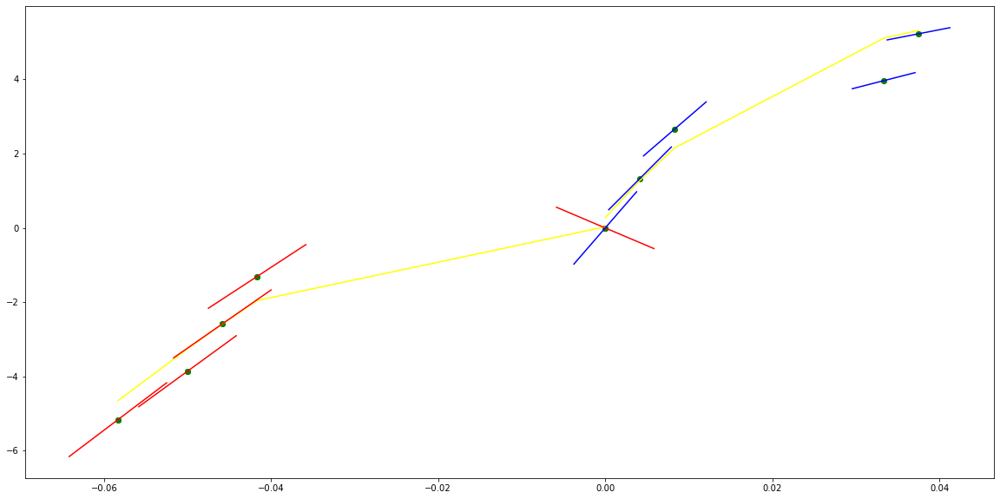

parameters (-12443.486595058059, -2859.4264481939326, -90.89664372617203, 0.006733403712782401)
tangent[0]:119.65160549990226
tangent[1]:124.44730858084985
tangent[2]:120.70955376223291
tangent[3]:115.67675864370314
tangent[4]:-90.89664372617203
parameters (9844.763760091648, -3360.4165701811303, 320.0149721586374, 0.013926555578254977)
tangent[0]:320.0149721586374
tangent[1]:292.5285653421234
tangent[2]:266.0610979739034
tangent[3]:216.2088805369787
tangent[4]:192.81814796288137


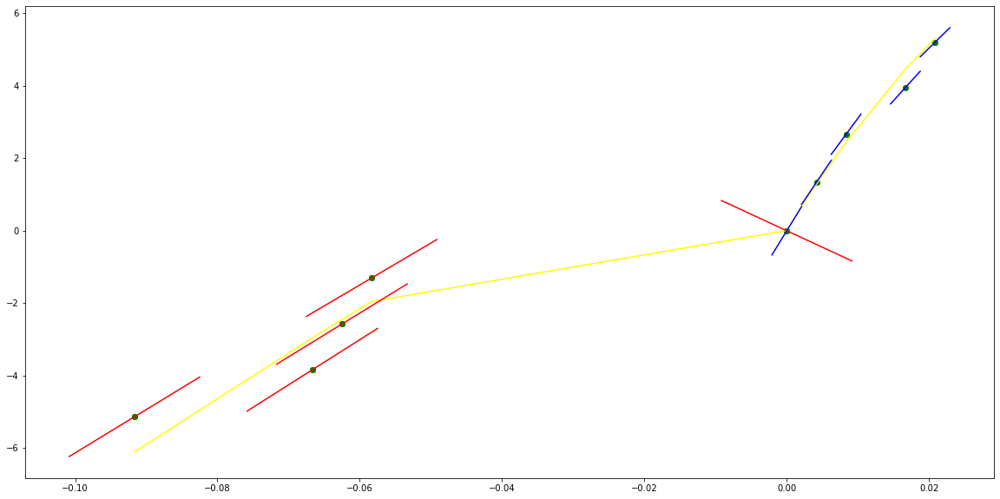

parameters (0.06654201108117597, 0.36078074156015527, 2.9951141997396675, 0.0804753452141708)
tangent[0]:2.8521353444374897
tangent[1]:2.435447282739918
tangent[2]:2.3453789145089354
tangent[3]:2.5197021208239954
tangent[4]:2.9951141997396675
parameters (-69.13369715702581, 168.43294921249478, -90.58794331242756, 0.005235851223409439)
tangent[0]:-90.58794331242756
tangent[1]:46.10510589876601
tangent[2]:41.76415770793729
tangent[3]:41.50781652599706
tangent[4]:41.244336874471244


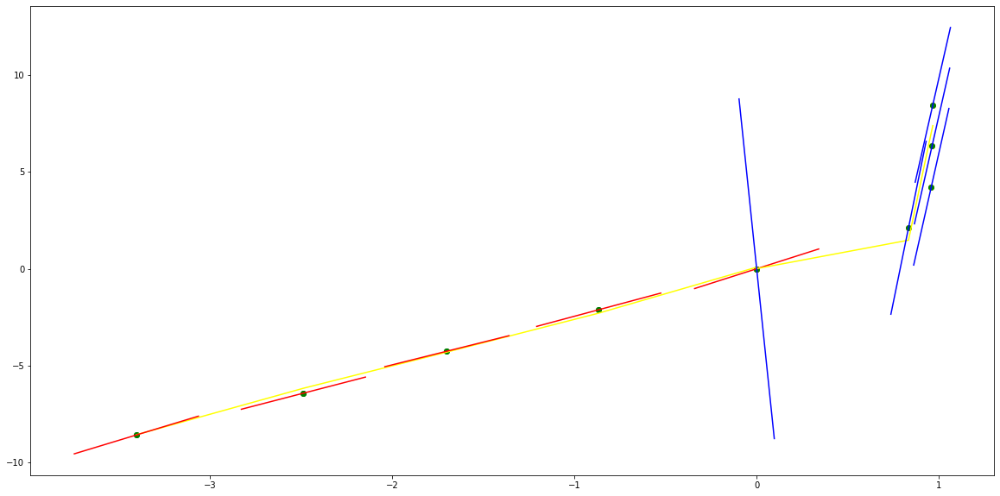

parameters (-20.942658498262087, -41.95034116571498, -8.241940988419865, -0.19698536437418912)
tangent[0]:18.987761772640347
tangent[1]:19.71864587837183
tangent[2]:18.634032259247967
tangent[3]:12.026373354842528
tangent[4]:-8.241940988419865
parameters (263.4215250040133, -566.1010130495276, 304.32991428574945, -3.526327497841338e-05)
tangent[0]:304.32991428574945
tangent[1]:68.08529355154013
tangent[2]:71.14719365938043
tangent[3]:74.23653789994313
tangent[4]:120.36480681717052


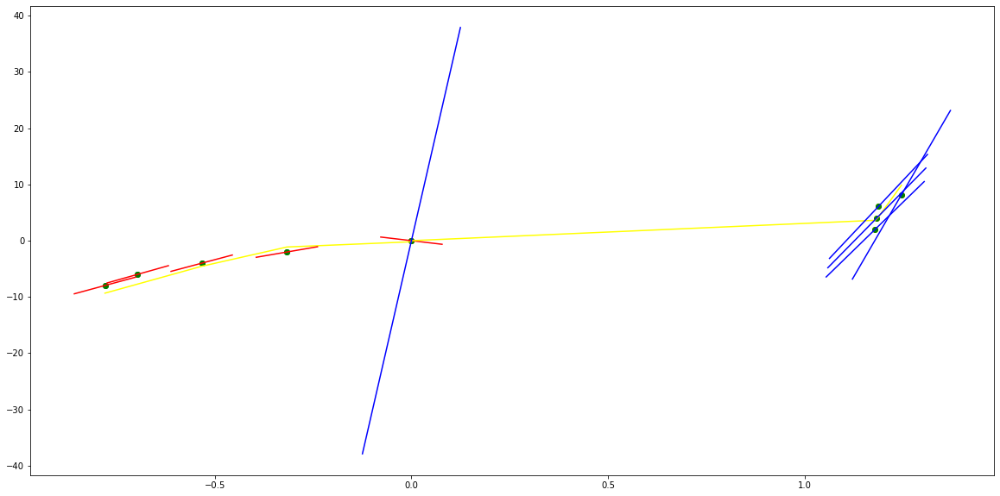

parameters (12.631813239107357, 39.34439169502014, 35.6552824505801, -1.4660362359961079)
tangent[0]:-3.5602937993145574
tangent[1]:30.577763189083694
tangent[2]:30.885262550098375
tangent[3]:31.19407793553077
tangent[4]:35.6552824505801
parameters (1169.219132061356, -1022.0208194332627, 237.3986064987355, 0.9098079705116061)
tangent[0]:237.3986064987355
tangent[1]:228.94199156325604
tangent[2]:220.60917535464438
tangent[3]:173.1618857097164
tangent[4]:165.67968825462464


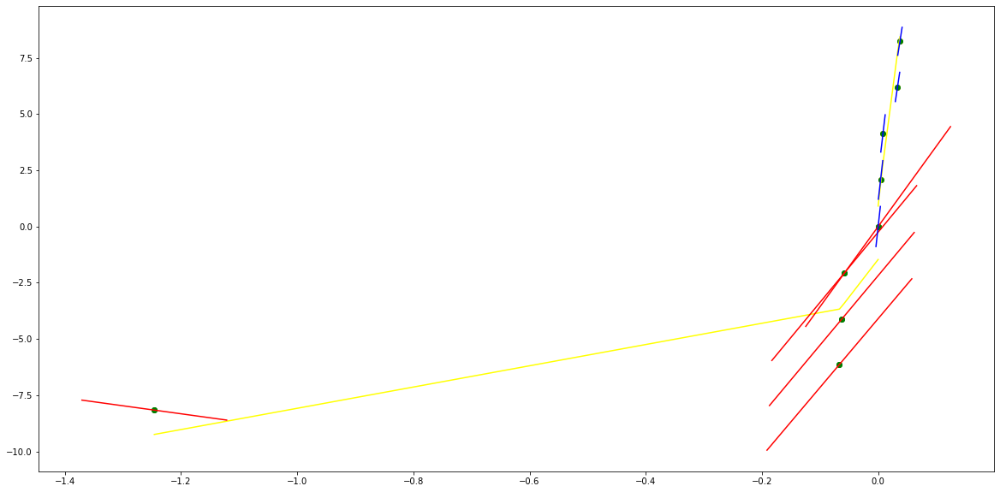

parameters (9742.514752050432, 4194.692388960968, 445.9496412779132, -0.0587348972063819)
tangent[0]:317.6902268326063
tangent[1]:287.1859138190117
tangent[2]:257.6966084738302
tangent[3]:411.4985787425189
tangent[4]:445.9496412779132
parameters (56.70973869290929, -85.91076222577568, 57.515062688853895, 1.3981802729835782)
tangent[0]:57.515062688853895
tangent[1]:56.80220690512562
tangent[2]:46.198020326133644
tangent[3]:31.279632106955788
tangent[4]:21.28023480047399


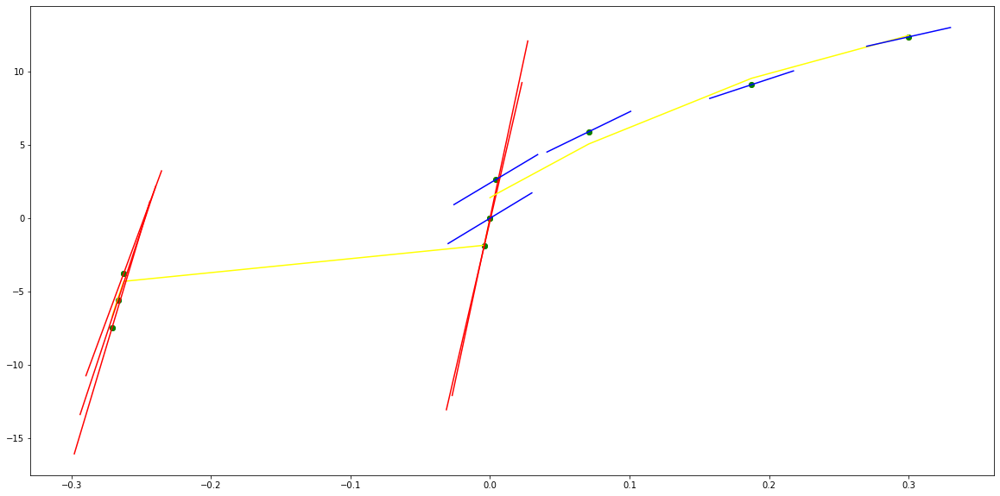

parameters (947.946920792888, 429.0833045302383, 36.85547394634831, 0.0043456710845757385)
tangent[0]:-22.138970758046568
tangent[1]:-25.610059856120728
tangent[2]:-27.50142989441754
tangent[3]:-27.009538216087748
tangent[4]:36.85547394634831
parameters (-0.3232717157250295, 1.6238246393165872, -3.4853275520649056, 0.08216138922989692)
tangent[0]:-3.4853275520649056
tangent[1]:-2.734028679105055
tangent[2]:-1.817487313258708
tangent[3]:-1.100466906702617
tangent[4]:-0.8038867517782093


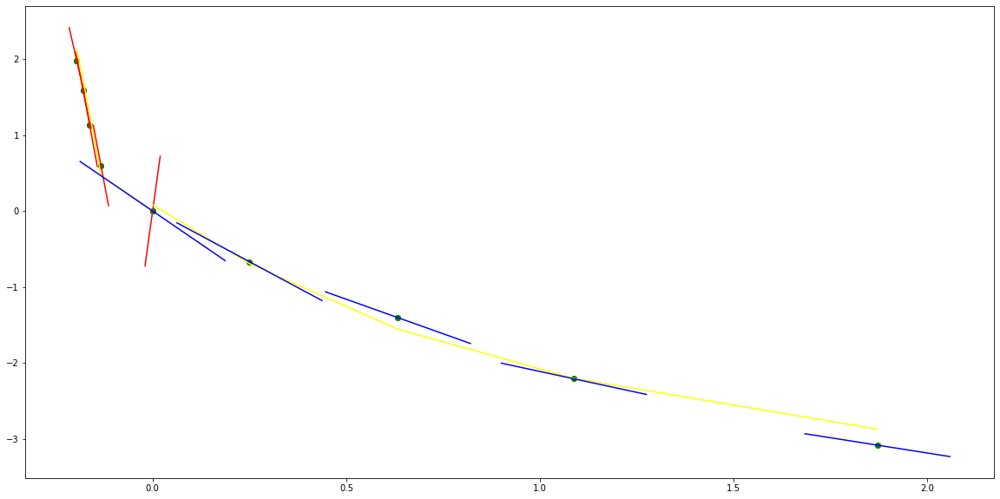

parameters (0.09199274993854016, 0.8013983463080945, 0.3849329152757209, -0.044167470457599695)
tangent[0]:-1.9276701756204082
tangent[1]:-1.9282729280847686
tangent[2]:-1.9238325646098555
tangent[3]:-1.642933249072464
tangent[4]:0.3849329152757209
parameters (-23.447512280088525, 93.72837266525475, -91.61713363354403, -0.0005349291900960336)
tangent[0]:-91.61713363354403
tangent[1]:25.991608453410606
tangent[2]:-47.52085871372884
tangent[3]:-48.782290955416784
tangent[4]:-49.4165188041066


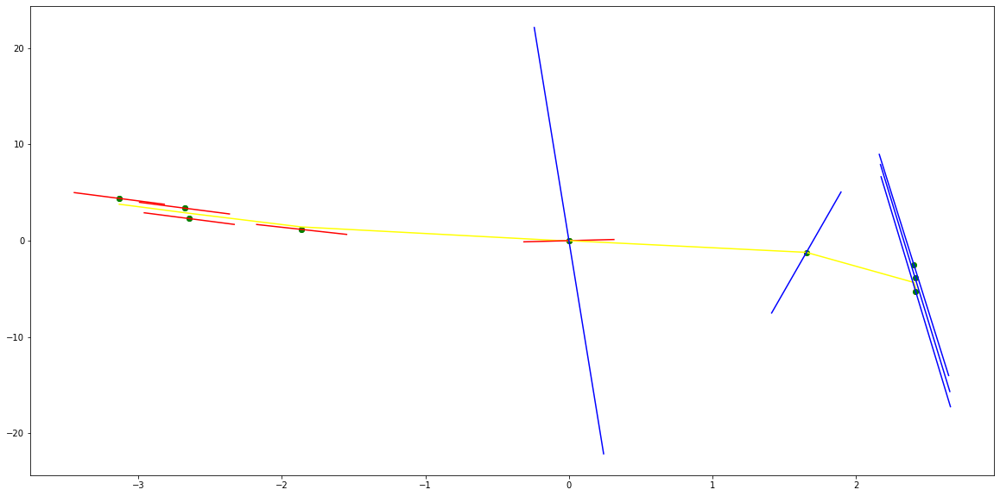

parameters (0.023002238112293193, 0.33265044236179886, 0.05767532908130195, 0.1097958293486039)
tangent[0]:-1.5295024019808663
tangent[1]:-1.5271843271412648
tangent[2]:-1.4285637930630415
tangent[3]:-0.8540221062589826
tangent[4]:0.05767532908130195
parameters (30.76361052208752, -111.04569233572602, 61.91851805775126, 0.007306841403828739)
tangent[0]:61.91851805775126
tangent[1]:-52.73642768981507
tangent[2]:-53.427199493236955
tangent[3]:-53.767696463908564
tangent[4]:-54.10507049599613


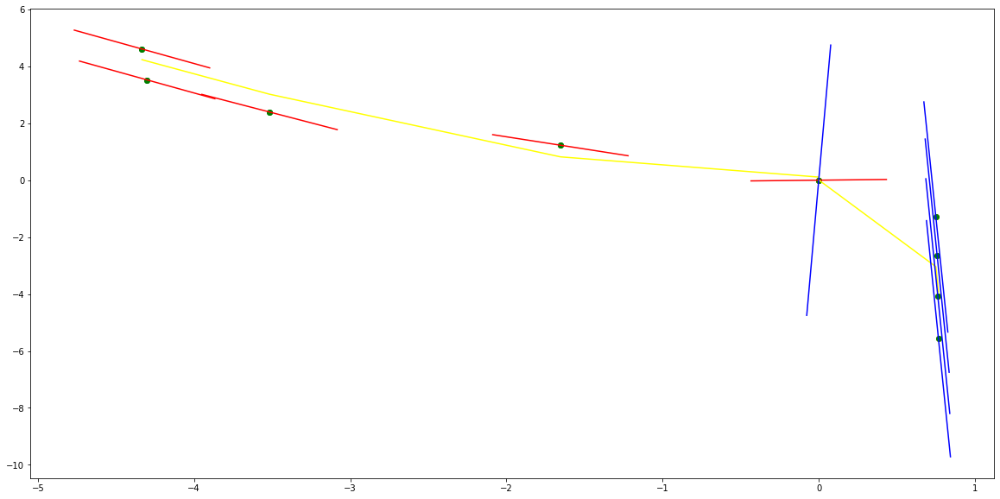

parameters (30.7636083135306, 153.52137808945523, 183.68218286023082, 0.00042278929708794937)
tangent[0]:-53.76769312121357
tangent[1]:-54.1050671274713
tangent[2]:-56.688453910139486
tangent[3]:-60.97957090247061
tangent[4]:183.68218286023082
parameters (5.931157540761392, -33.128220251157956, 41.07117354879782, 0.01089096016826064)
tangent[0]:41.07117354879782
tangent[1]:-20.247016988718677
tangent[2]:-19.375112708621494
tangent[3]:-19.335776380538626
tangent[4]:-19.295831787070604


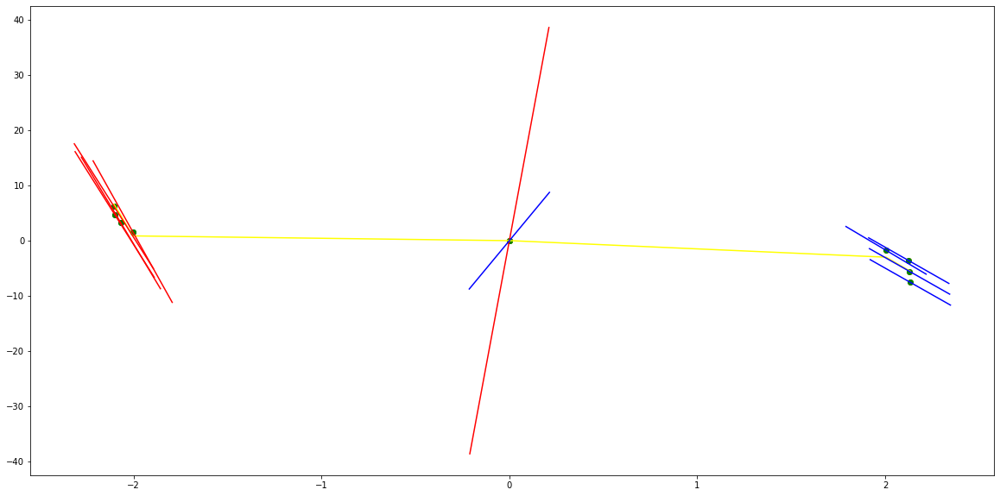

parameters (-0.00795126899643913, -0.07862265953422086, -1.6997658482630398, -0.03235934024275476)
tangent[0]:-1.7857944932085932
tangent[1]:-1.5178940283455575
tangent[2]:-1.44484461228329
tangent[3]:-1.496112597212967
tangent[4]:-1.6997658482630398
parameters (-1036.975722364661, 4265.944286525128, -4376.937915152451, -5.268326480807684e-06)
tangent[0]:-4376.937915152451
tangent[1]:430.94424942068053
tangent[2]:-515.9314050533094
tangent[3]:-536.7100986021169
tangent[4]:-557.6018024602045


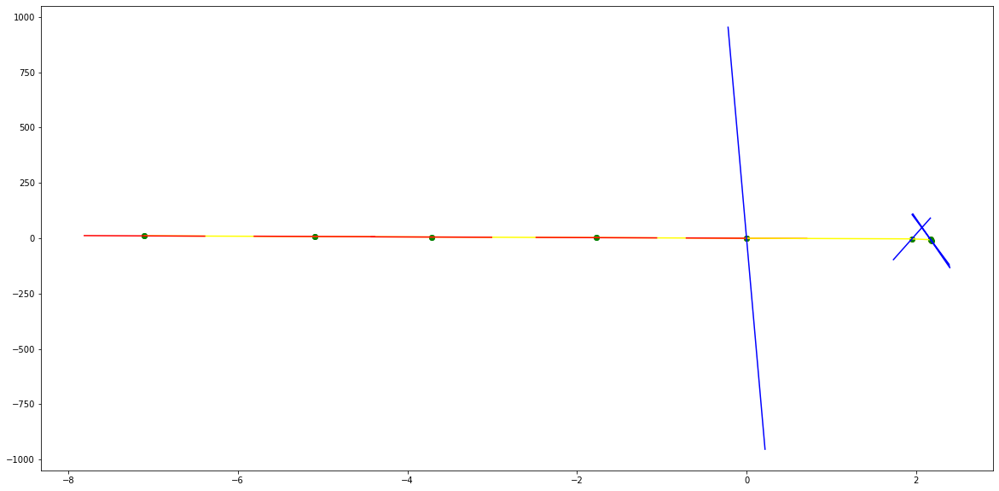

parameters (-187956.46768125656, -8833.141887994885, -793.6826893818094, 0.19612340144390367)
tangent[0]:-670.3681519797494
tangent[1]:-655.8753927000099
tangent[2]:-660.9587364075262
tangent[3]:-729.8582506122083
tangent[4]:-793.6826893818094
parameters (-12957.655283739494, 2426.9870300580965, -370.05793952500267, -1.1238032996550102)
tangent[0]:-370.05793952500267
tangent[1]:-350.5064154806398
tangent[2]:-285.80650501665355
tangent[3]:-242.6990204989214
tangent[4]:-221.18849197307915


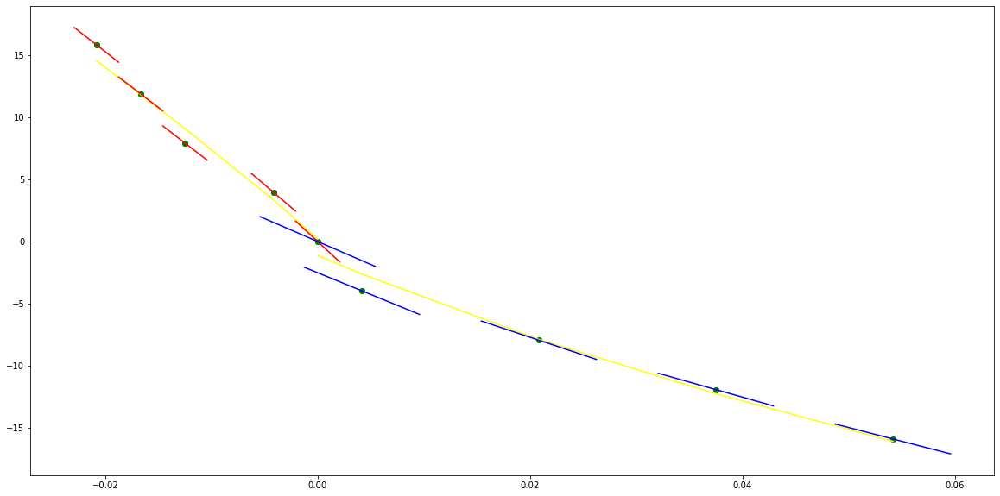

parameters (268.27185154992054, 227.54575828598252, 58.65460991756651, -1.519172035896367)
tangent[0]:49.522989481623995
tangent[1]:51.29359669423734
tangent[2]:53.09171839083098
tangent[3]:56.7726666809561
tangent[4]:58.65460991756651
parameters (4492.184971698395, -1013.2684122948526, 116.58580159797575, 0.3683702509963516)
tangent[0]:116.58580159797575
tangent[1]:108.37522805355856
tangent[2]:80.21450693111001
tangent[3]:48.950347656228445
tangent[4]:40.656107499472


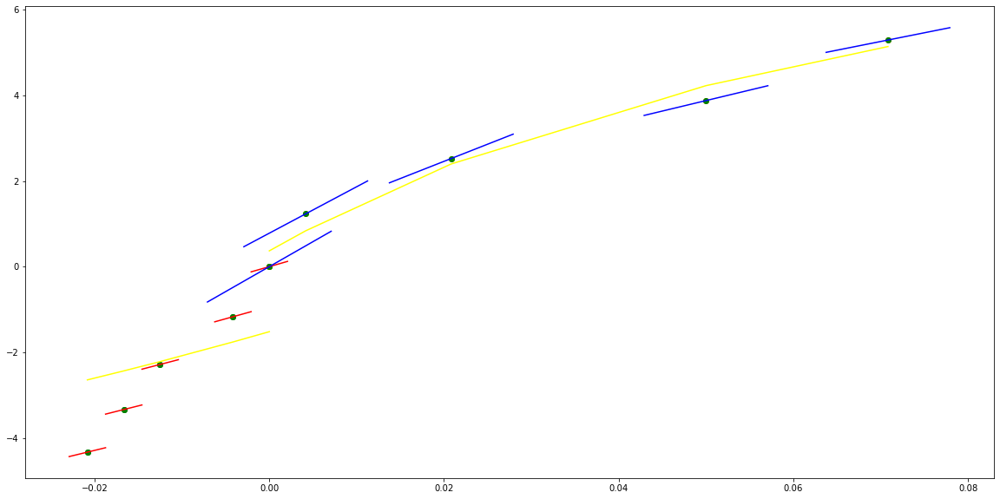

parameters (4202.859639510795, 1037.8180425568316, 265.05058250914095, -0.051977961490834224)
tangent[0]:184.5755885900541
tangent[1]:196.40434024589408
tangent[2]:215.23679802117883
tangent[3]:241.07522190124084
tangent[4]:265.05058250914095
parameters (-71505.05763066333, 5008.512393493518, 325.61797960831046, 1.4958364785639857)
tangent[0]:325.61797960831046
tangent[1]:363.63410424477314
tangent[2]:394.19415187901075
tangent[3]:441.9716162254926
tangent[4]:421.1700417107453


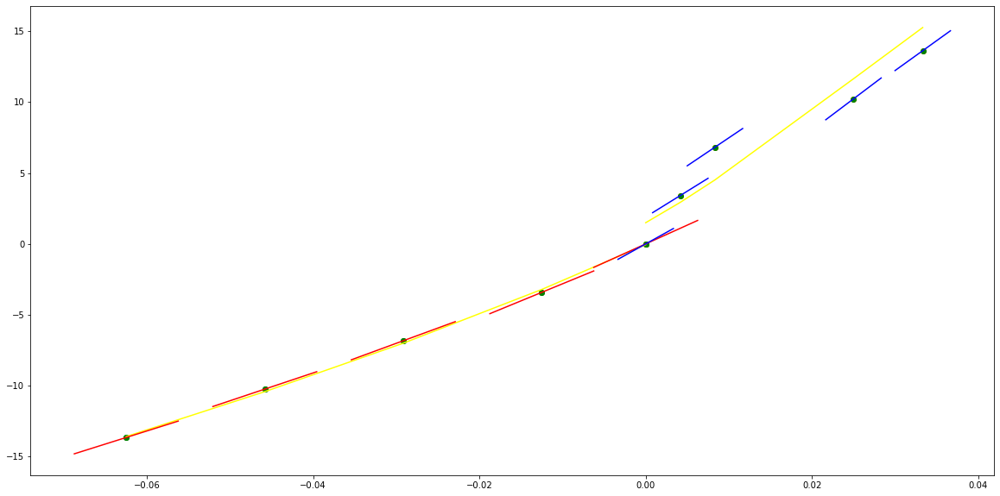

parameters (104.19334105354893, 61.379156255844705, 64.21682672750728, 0.06841411168123095)
tangent[0]:52.522667180943586
tangent[1]:54.149568419873574
tangent[2]:56.768215919409215
tangent[3]:59.64453845421644
tangent[4]:64.21682672750728
parameters (3058.9498695538523, -1093.1209410368508, 173.2788628792688, 1.4591731587590742)
tangent[0]:173.2788628792688
tangent[1]:164.33024852583645
tangent[2]:155.69813951729418
tangent[3]:98.11842937047925
tangent[4]:60.93050077246244


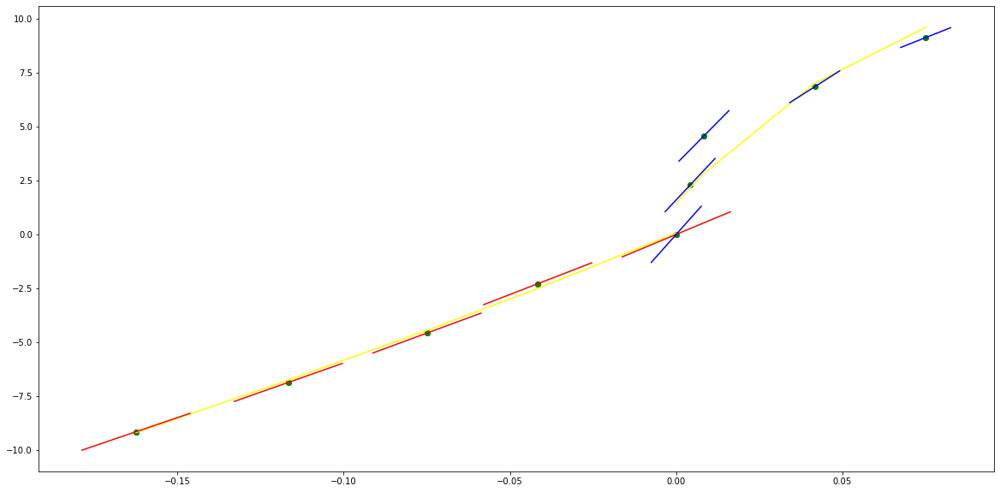

parameters (139.81509587669638, 91.85381586184036, 53.91103537065996, -0.8592390241647714)
tangent[0]:34.020962603759855
tangent[1]:36.040792563244025
tangent[2]:42.49234273430316
tangent[3]:52.40914877353873
tangent[4]:53.91103537065996
parameters (-28502.823362073774, 2731.510842499267, 204.35648797007153, 1.0357053052089118)
tangent[0]:204.35648797007153
tangent[1]:225.6313892687197
tangent[2]:243.94223450828736
tangent[3]:287.48923629114654
tangent[4]:291.4478787679383


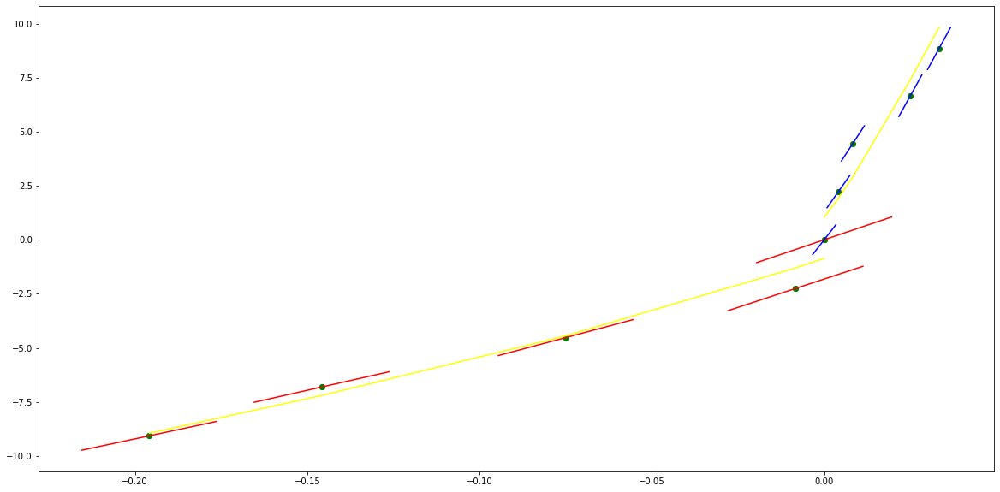

parameters (42.531190883544596, 39.612225505668654, 28.91837895250608, -0.22386344099129782)
tangent[0]:16.62104784062663
tangent[1]:17.552302090393525
tangent[2]:21.00897214875507
tangent[3]:25.838853915681902
tangent[4]:28.91837895250608
parameters (-3481.2616489202815, 95.55973829121079, 162.0511989636699, 0.8144280622014922)
tangent[0]:162.0511989636699
tangent[1]:162.6662491000334
tangent[2]:162.9185927383732
tangent[3]:156.8178110631403
tangent[4]:154.53160675412826


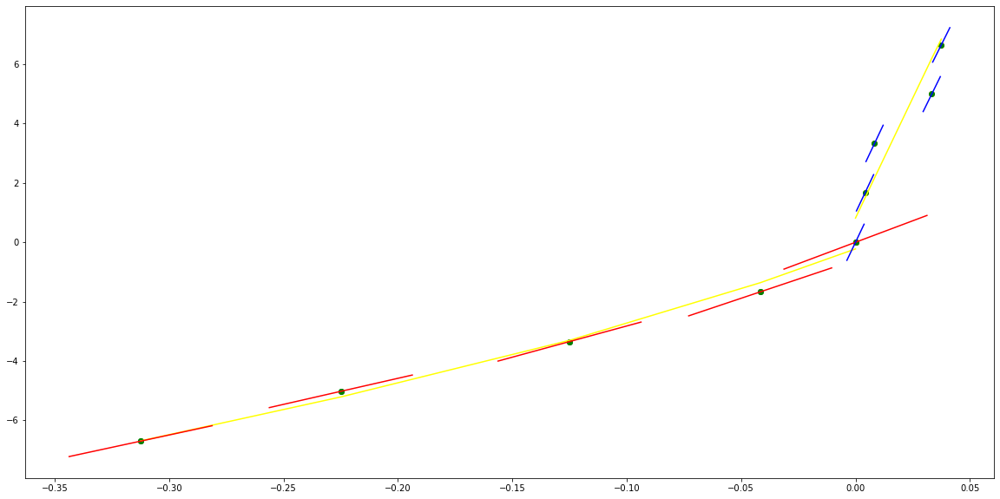

parameters (59065.527647806164, 6065.507823120991, 208.7902787753295, -0.40401631802775095)
tangent[0]:238.57789608309486
tangent[1]:187.60010274810577
tangent[2]:142.77595300793416
tangent[3]:161.317158374848
tangent[4]:208.7902787753295
parameters (837.837366368213, 425.79619442477355, -12.391220279266868, 0.8043572251105309)
tangent[0]:-12.391220279266868
tangent[1]:-8.799862987326966
tangent[2]:81.3671907538384
tangent[3]:115.22456097060027
tangent[4]:121.17195882863592


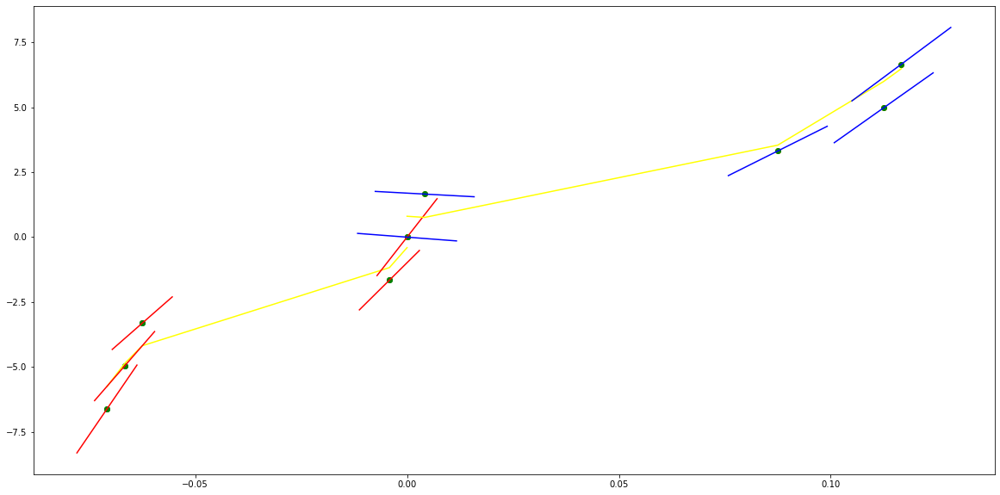

parameters (3208.8122117481266, 746.7748263451884, 87.06143999661111, 0.04553794457199834)
tangent[0]:43.84073003648376
tangent[1]:40.871692733755395
tangent[2]:38.23755236692061
tangent[3]:55.73922157637942
tangent[4]:87.06143999661111
parameters (3725.1405555130086, -1618.6863311945876, 220.8168593585604, 0.6450061837544497)
tangent[0]:220.8168593585604
tangent[1]:207.52392050360433
tangent[2]:194.6158418275024
tangent[3]:125.3224032467234
tangent[4]:115.13082123753684


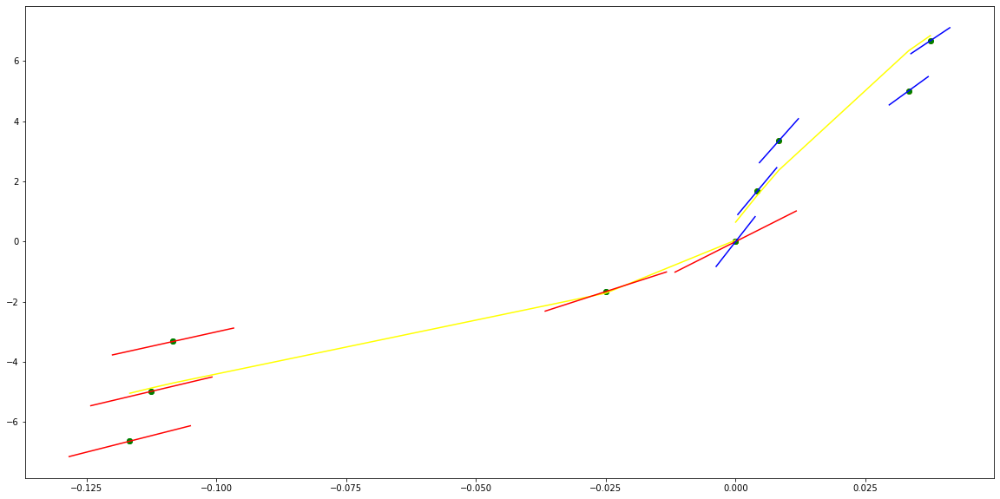

parameters (26.263015743267662, 43.69065255163773, 27.49946183288386, -1.4753265631133647)
tangent[0]:4.13265660044501
tangent[1]:18.37735971462921
tangent[2]:25.3641723598206
tangent[3]:27.136712018789027
tangent[4]:27.49946183288386
parameters (23532.56723505361, -4957.538276477668, 303.1401961693274, 0.0454289905672002)
tangent[0]:303.1401961693274
tangent[1]:263.04992282922603
tangent[2]:157.49687238385084
tangent[3]:-23.915348534126792
tangent[4]:200.2995986042987


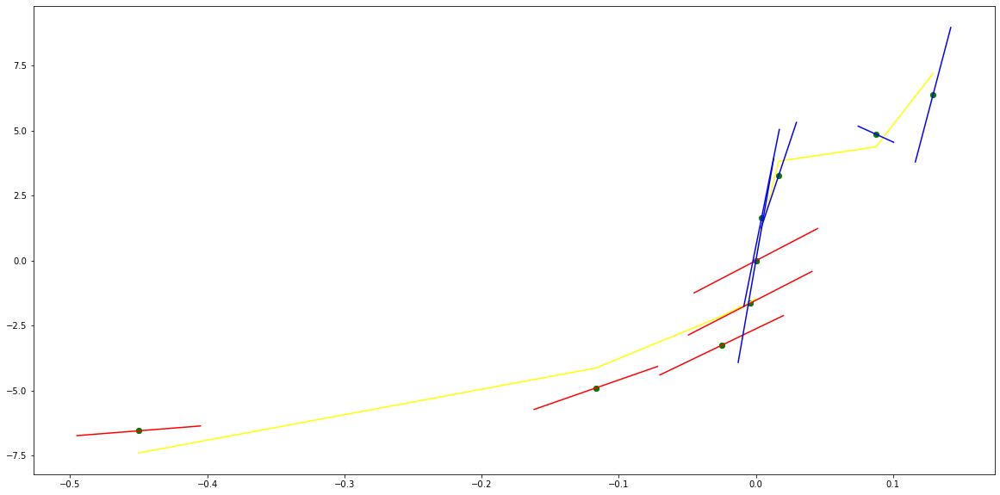

parameters (37493.79224842988, 3392.7479170658053, 144.3366678067948, 0.050118839564511054)
tangent[0]:228.05401518573385
tangent[1]:69.62260355487501
tangent[2]:56.8887053417906
tangent[3]:48.05751007492299
tangent[4]:144.3366678067948
parameters (32044.610321220578, -7118.377262681196, 425.80075470243366, -0.09118630125762069)
tangent[0]:425.80075470243366
tangent[1]:368.14545576524637
tangent[2]:313.8413056600193
tangent[3]:262.86223422347587
tangent[4]:-100.29767329580238


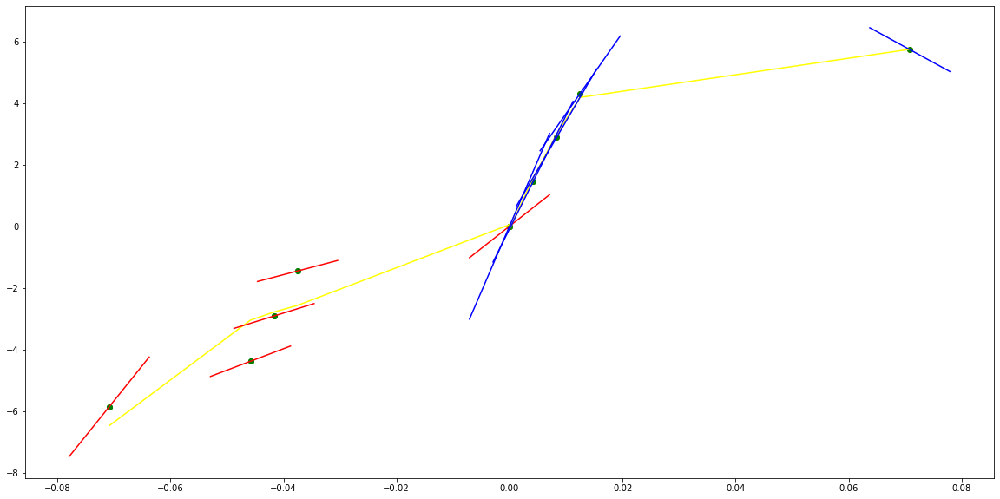

parameters (15250.758032087277, 3815.139755446234, 282.3968069260067, -0.4198431551512842)
tangent[0]:78.39844374777766
tangent[1]:60.14845600262282
tangent[2]:221.9906748442077
tangent[3]:251.40311863883372
tangent[4]:282.3968069260067
parameters (168.6271637056148, -138.47837308505757, 50.197998523668595, 0.8375960360889732)
tangent[0]:50.197998523668595
tangent[1]:49.052703832436634
tangent[2]:40.52351638917234
tangent[3]:27.561138817825523
tangent[4]:15.041908934319345


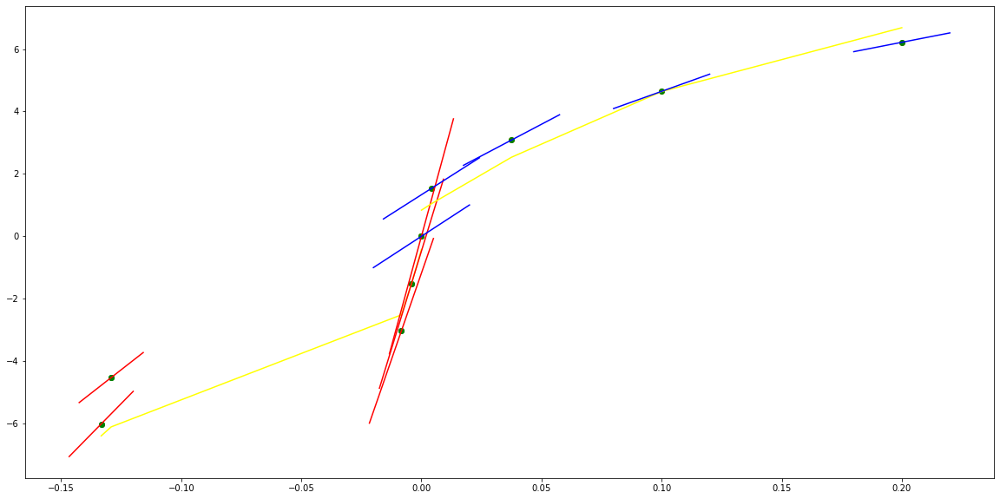

parameters (-1.803764484946668, -6.285591086471475, 7.632989223425737, 0.05763730184593294)
tangent[0]:14.107969931660488
tangent[1]:13.124833826589974
tangent[2]:12.097126036247808
tangent[3]:10.519412678395959
tangent[4]:7.632989223425737
parameters (285.1007515082842, -223.8899847842409, 53.59102018492339, -0.4323610134026578)
tangent[0]:53.59102018492339
tangent[1]:14.040692767299348
tangent[2]:-0.6354266422252763
tangent[3]:56.140419024435396
tangent[4]:85.73320685178393


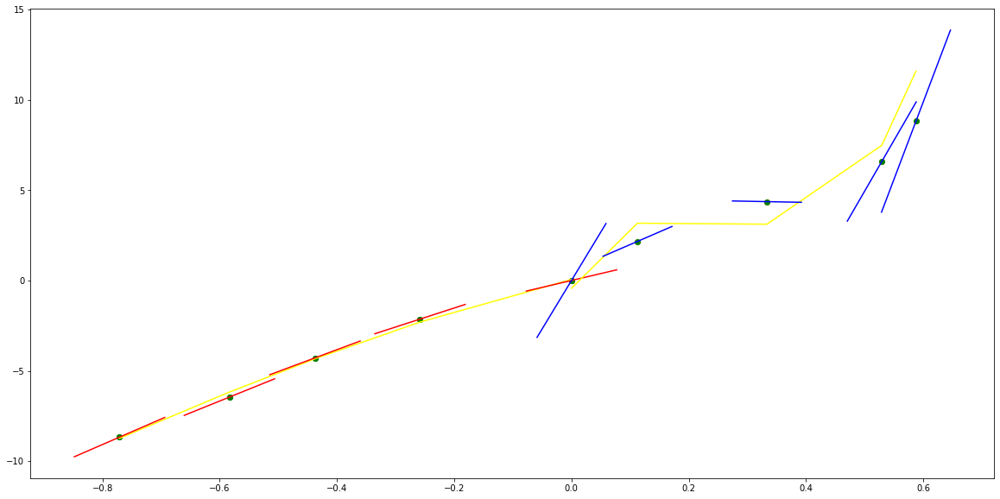

parameters (16.606971149621796, 31.030622566461975, 27.894965644751373, -1.5319618658911058)
tangent[0]:9.596197238879213
tangent[1]:15.187307120722124
tangent[2]:24.210750767103256
tangent[3]:27.637221521093483
tangent[4]:27.894965644751373
parameters (384.96191274869915, -301.9421163991678, 91.25259342009679, 1.9206561623577831)
tangent[0]:91.25259342009679
tangent[1]:88.75685539036266
tangent[2]:86.300620090774
tangent[3]:61.930983494614445
tangent[4]:33.81215398040011


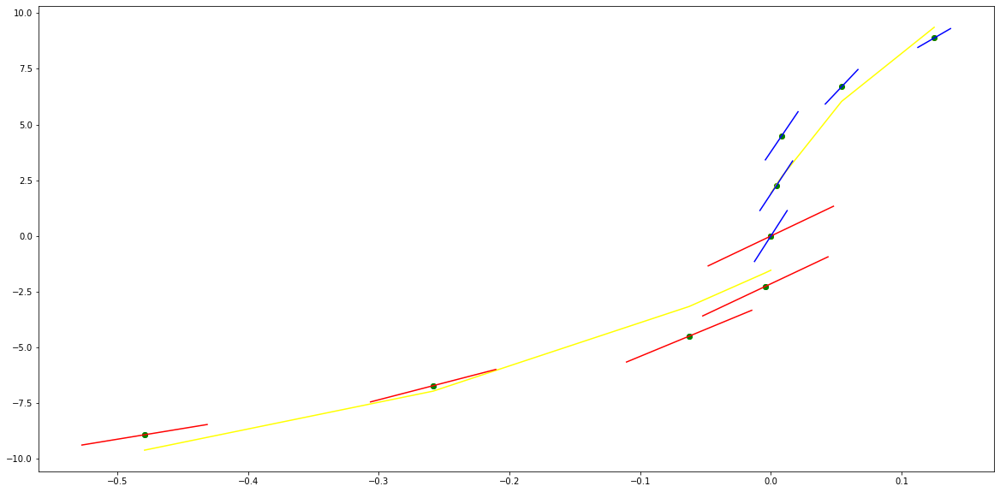

parameters (-3.6316595422452482, -8.683481117268123, 2.5945285655000667, -0.2881447690994756)
tangent[0]:9.506877581170453
tangent[1]:9.51509717154082
tangent[2]:8.828008762607965
tangent[3]:5.300088236100127
tangent[4]:2.5945285655000667
parameters (194.88061760118447, -261.9322735126758, 83.85964259383978, 0.44354336741553835)
tangent[0]:83.85964259383978
tangent[1]:79.53487620419911
tangent[2]:-33.468106727235835
tangent[3]:85.94145104190163
tangent[4]:88.15382381182216


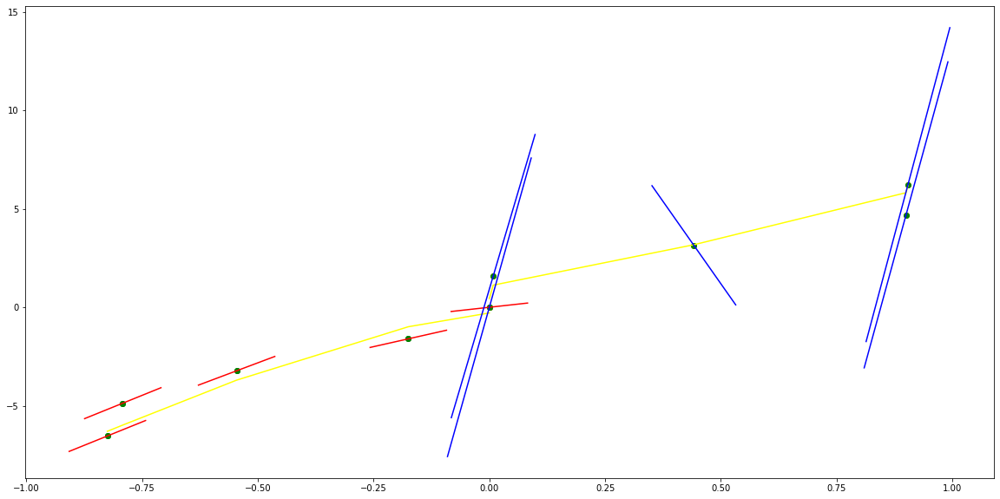

parameters (194.8806366769577, 295.91371727563023, 116.28359756490038, -0.5620518466716249)
tangent[0]:85.94145763377982
tangent[1]:88.15383061241454
tangent[2]:90.38596867044572
tangent[3]:113.8276043023558
tangent[4]:116.28359756490038
parameters (149.0646464618472, -230.48414602934372, 63.33472735245832, 0.8586026422660774)
tangent[0]:63.33472735245832
tangent[1]:61.4220947471997
tangent[2]:-28.70879282869638
tangent[3]:172.3707166468623
tangent[4]:175.03862313099225


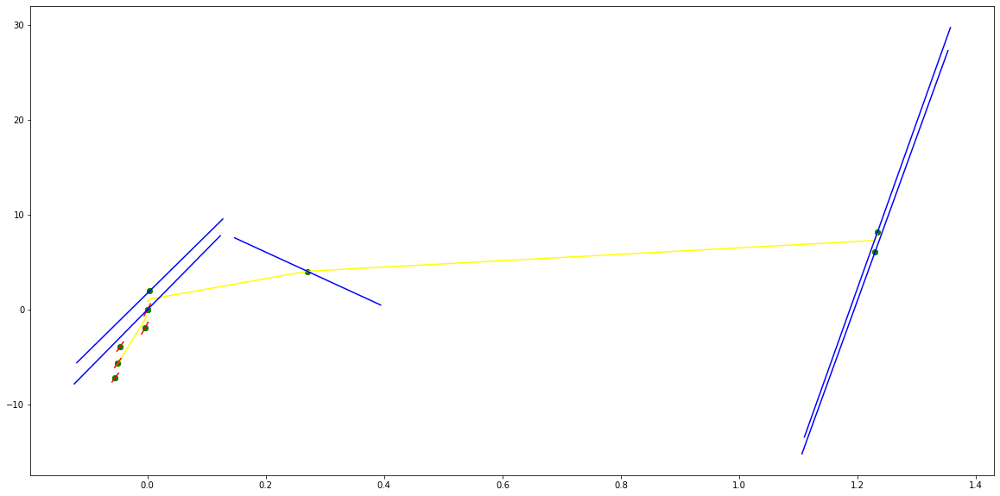

parameters (-684.4582104640799, -725.3156549545432, -131.90560413531742, 0.001523026353952814)
tangent[0]:121.55318240795779
tangent[1]:111.73154959064323
tangent[2]:110.35714100203344
tangent[3]:108.91177877393145
tangent[4]:-131.90560413531742
parameters (-1459.6105775485412, 3063.5956794295025, -1592.4130558566826, 8.957388630727762e-07)
tangent[0]:-1592.4130558566826
tangent[1]:257.9481915559777
tangent[2]:248.43154222387466
tangent[3]:238.76282579546114
tangent[4]:177.5622332089656


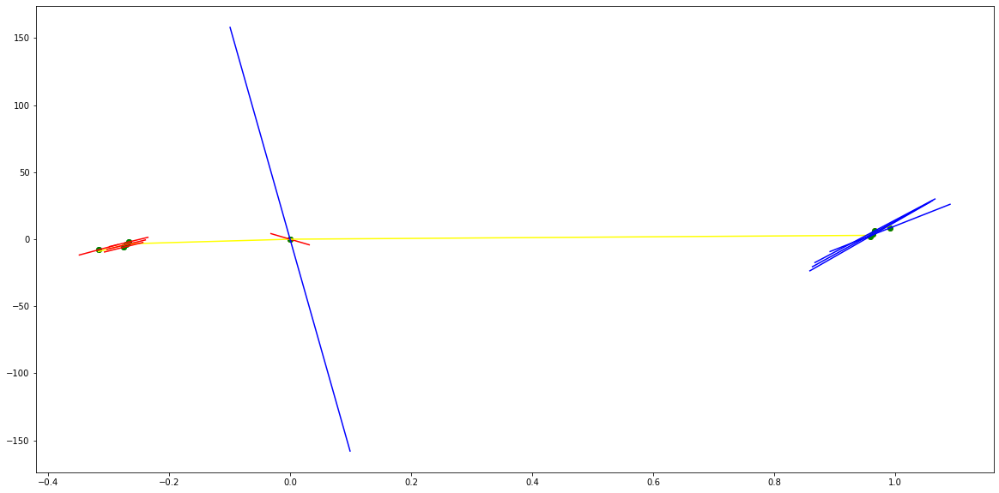

parameters (30496.810359590665, 4984.4789878767615, 277.21215682070925, -0.5734090148750907)
tangent[0]:105.40194688912419
tangent[1]:81.81939433818644
tangent[2]:61.40805920792303
tangent[3]:237.26013862555828
tangent[4]:277.21215682070925
parameters (67262.0293072033, -8648.272974515354, 414.71454797641246, 0.23714658517388437)
tangent[0]:414.71454797641246
tangent[1]:346.15924730169496
tangent[2]:81.89394564100479
tangent[3]:62.371062101849645
tangent[4]:49.85576102752486


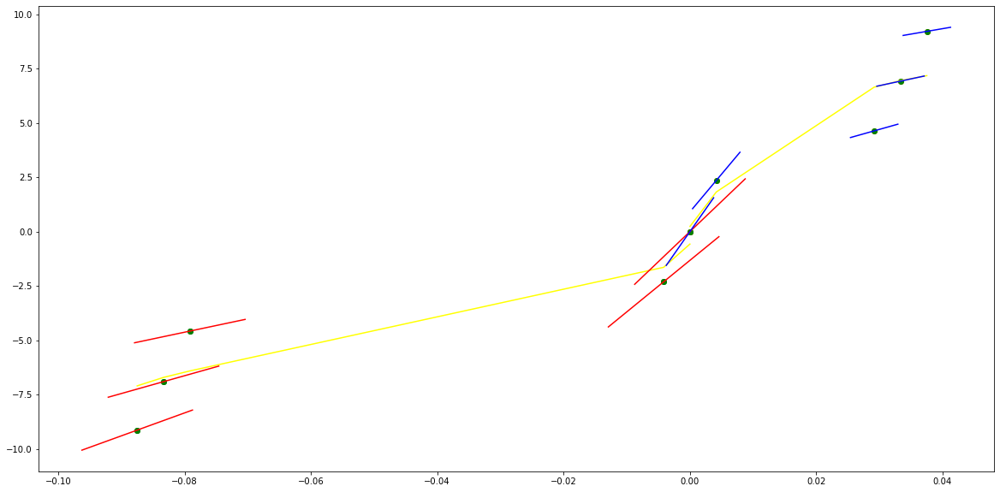

parameters (0.0015122103769917882, -0.1072123046456088, -0.5685184196160985, 0.010381423758241469)
tangent[0]:-0.11473541487466382
tangent[1]:-0.22621282188549857
tangent[2]:-0.3532807346467085
tangent[3]:-0.47201890146234216
tangent[4]:-0.5685184196160985
parameters (-13435.553215043894, 2022.2146682844582, -100.27688070037169, 0.25393674990146614)
tangent[0]:-100.27688070037169
tangent[1]:-56.01942956281206
tangent[2]:-44.06782003735045
tangent[3]:-33.51293443681442
tangent[4]:-5.292020705003765


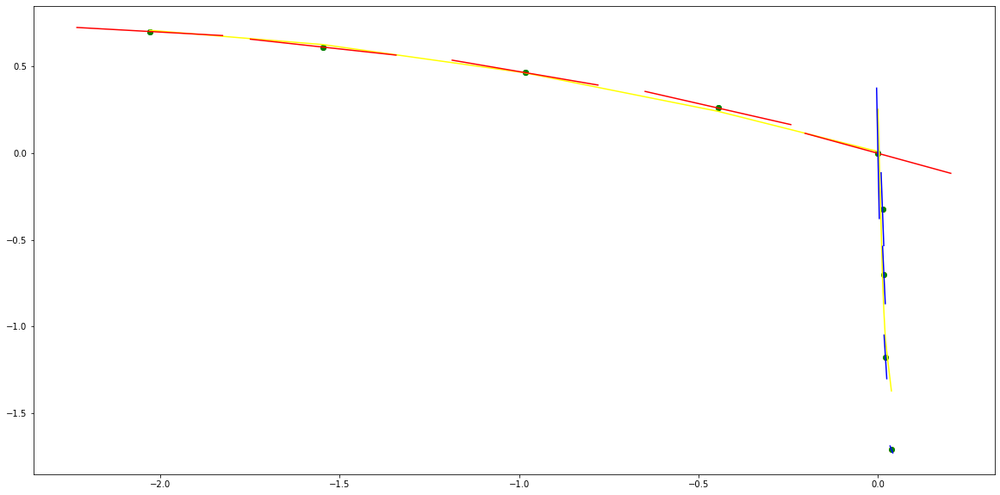

parameters (-52078.35959736091, -8513.424677644494, -392.7454234689023, 0.3860865729048722)
tangent[0]:-314.37955782871535
tangent[1]:-252.41127586083093
tangent[2]:-195.88160928454175
tangent[3]:-324.50739077146505
tangent[4]:-392.7454234689023
parameters (-2.74108994421202, 13.40560461364785, -22.031125130030834, -1.9237535465418918)
tangent[0]:-22.031125130030834
tangent[1]:-21.919572351810004
tangent[2]:-20.173265472778077
tangent[3]:-15.842277187746664
tangent[4]:-11.230488052725654


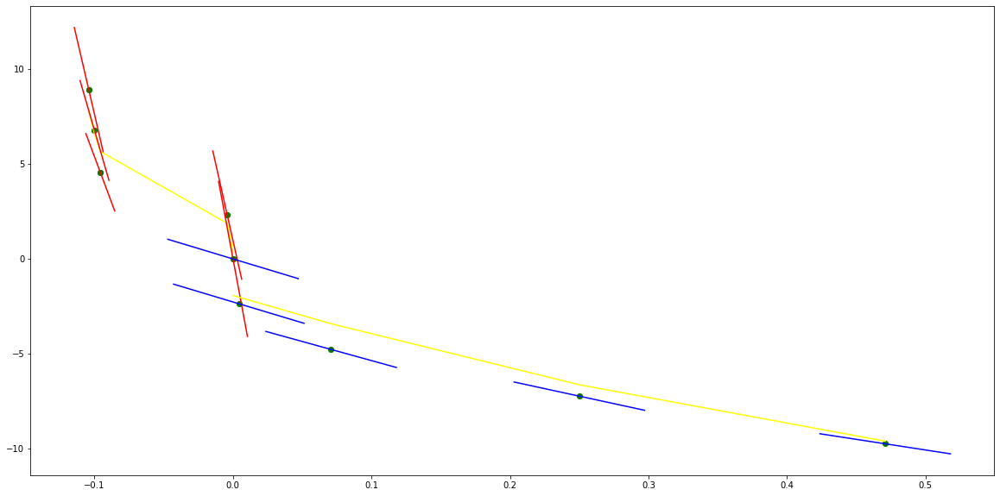

parameters (-13.263516089431683, -24.091932603029704, -14.747714517200047, -0.08238607799648506)
tangent[0]:-30.82521696139731
tangent[1]:-19.585668230004607
tangent[2]:-9.24714409918437
tangent[3]:-1.1225611988030604
tangent[4]:-14.747714517200047
parameters (-866.3827413756737, 2310.040127386279, -1511.7289372743674, -1.3036737440547748e-06)
tangent[0]:-1511.7289372743674
tangent[1]:369.6019837560905
tangent[2]:-510.7506374816196
tangent[3]:-524.5773788635499
tangent[4]:-538.4943828879971


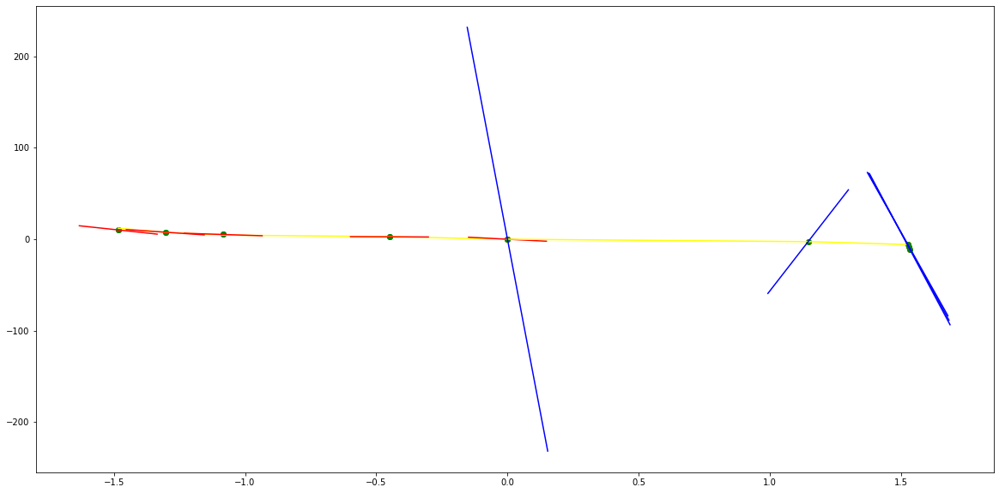

parameters (-206418.86362094423, -21552.16520426994, -875.2342333899592, 0.23768993069080646)
tangent[0]:-200.4834162261509
tangent[1]:-144.82041106587894
tangent[2]:-433.18894560552826
tangent[3]:-706.3711912838342
tangent[4]:-875.2342333899592
parameters (-139894.40074227608, 3747.3019908712213, -293.6751102607022, -1.1743172886006286)
tangent[0]:-293.6751102607022
tangent[1]:-269.73242800741264
tangent[2]:-432.1103250395788
tangent[3]:-510.1628186314502
tangent[4]:-602.8069640768379


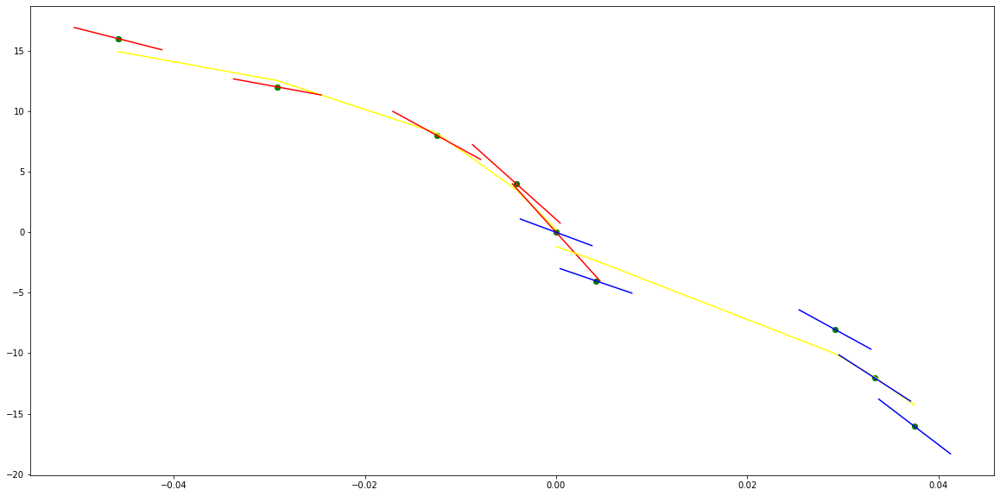

parameters (50472.33798654064, 5985.411091531428, -180.42198635594548, -0.5065937638090505)
tangent[0]:-416.32926786607
tangent[1]:-411.20951667199927
tangent[2]:-400.76240016298254
tangent[3]:-385.05690720775317
tangent[4]:-180.42198635594548
parameters (-193078.35460896953, 12899.794447941862, -947.8686492946235, -0.20332131171337223)
tangent[0]:-947.8686492946235
tangent[1]:-850.4405085417834
tangent[2]:-773.102114327209
tangent[3]:-678.7784579637639
tangent[4]:-661.7818765233578


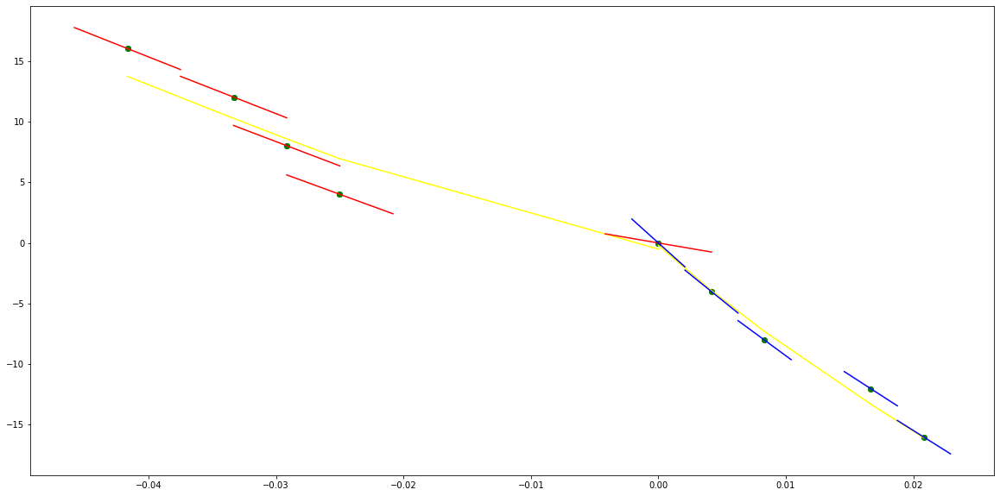

parameters (725.2517765774447, 149.9359293897192, -96.88252157943728, -0.044031962289705406)
tangent[0]:-105.11215416005777
tangent[1]:-106.98616247280872
tangent[2]:-106.43672619407836
tangent[3]:-103.77776585286496
tangent[4]:-96.88252157943728
parameters (-1217.5202740868729, 394.7587168194983, -146.00186371466515, -0.17925818406290533)
tangent[0]:-146.00186371466515
tangent[1]:-133.8576174610247
tangent[2]:-121.53137360950677
tangent[3]:-109.60087095718818
tangent[4]:-104.8840070666858


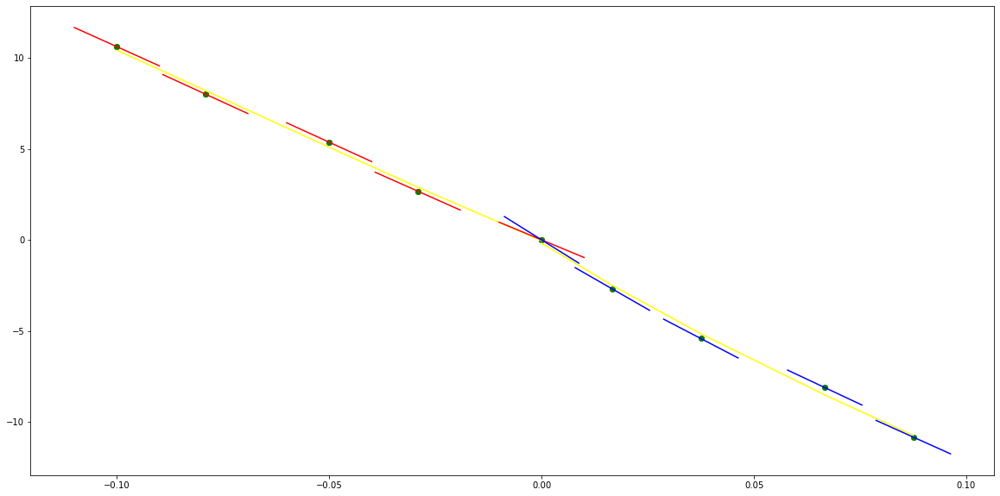

parameters (5512.826541330083, 1529.081772000209, 182.60745725361065, -0.6010318585548913)
tangent[0]:56.07567178479644
tangent[1]:99.04541279261318
tangent[2]:136.23375823265576
tangent[3]:170.1541824385739
tangent[4]:182.60745725361065
parameters (2057.669702828278, -492.41501703596373, 99.74722815401516, 0.6812091046865789)
tangent[0]:99.74722815401516
tangent[1]:95.75062884699317
tangent[2]:65.93824922163087
tangent[3]:64.5139428101145
tangent[4]:75.53087414684184


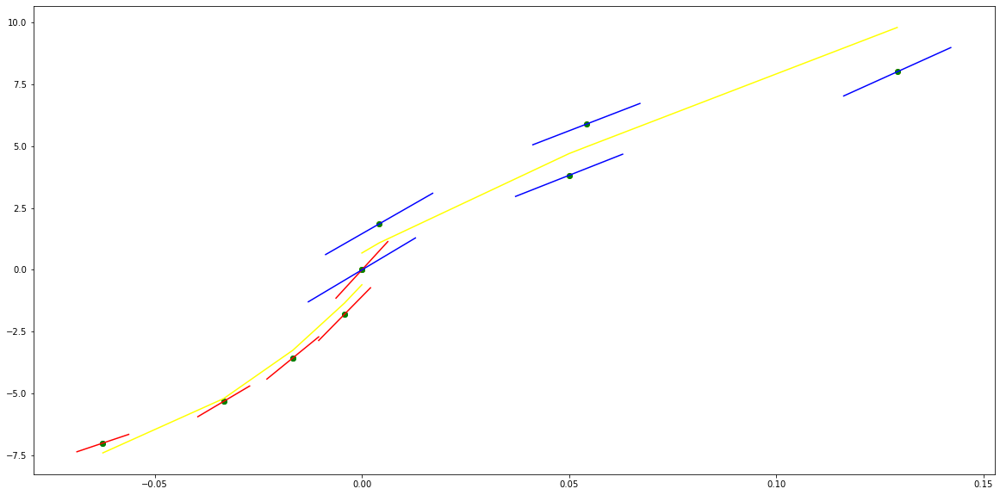

parameters (-27582.896343885255, -5011.319261194134, -21.933967443513243, 0.175587756844122)
tangent[0]:281.24387367584814
tangent[1]:272.32623609676074
tangent[2]:263.6064410422186
tangent[3]:252.01296788519412
tangent[4]:-21.933967443513243
parameters (-12262.741383660437, 1225.042592002993, 225.22132374388363, 1.9234620031174965)
tangent[0]:225.22132374388363
tangent[1]:234.7920420649718
tangent[2]:243.0851871047305
tangent[3]:265.36607793179064
tangent[4]:255.75502256672962


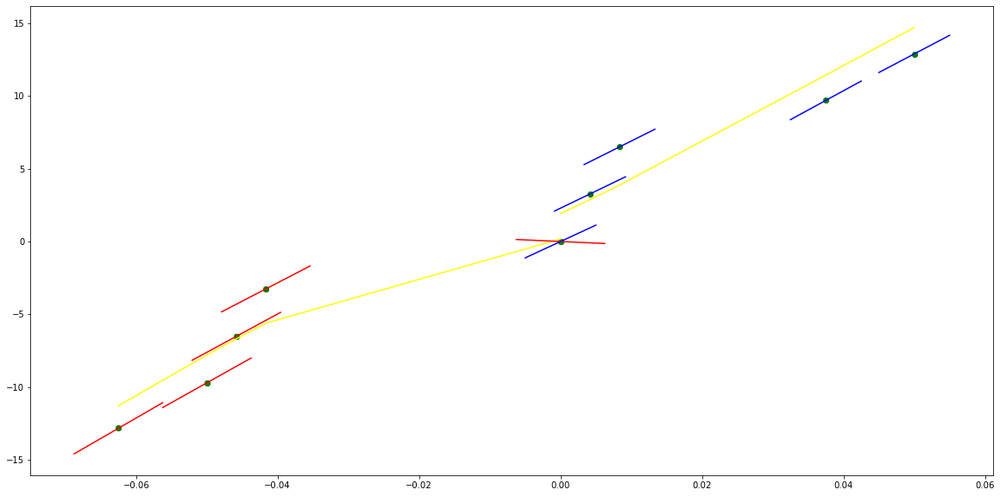

parameters (-82157.67221627946, -9547.751528947358, -20.78714238542016, -0.9967756219773666)
tangent[0]:348.6915426232027
tangent[1]:341.86983080654807
tangent[2]:326.4886587847222
tangent[3]:54.48704711083139
tangent[4]:-20.78714238542016
parameters (-23984.913597047158, 3245.733085491092, 70.17990161657372, 0.8920456055703727)
tangent[0]:70.17990161657372
tangent[1]:95.98042701893532
tangent[2]:206.61352494947715
tangent[3]:216.55044059984084
tangent[4]:214.86635818782923


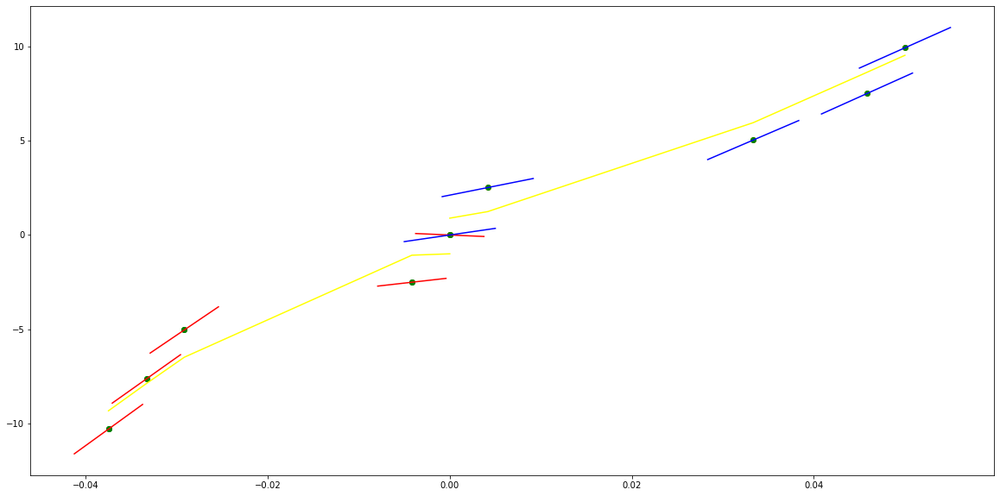

parameters (27447.884504924834, 4659.955564580982, 230.9046473398023, -0.5126020999292115)
tangent[0]:264.37359743382785
tangent[1]:224.576510105446
tangent[2]:11.731337864597975
tangent[3]:193.49838372406938
tangent[4]:230.9046473398023
parameters (240.86652299441684, -149.64339999781285, 66.74631120565435, 0.8668752579956908)
tangent[0]:66.74631120565435
tangent[1]:65.51202351415763
tangent[2]:52.6552174172729
tangent[3]:44.043626895924284
tangent[4]:38.11178150843363


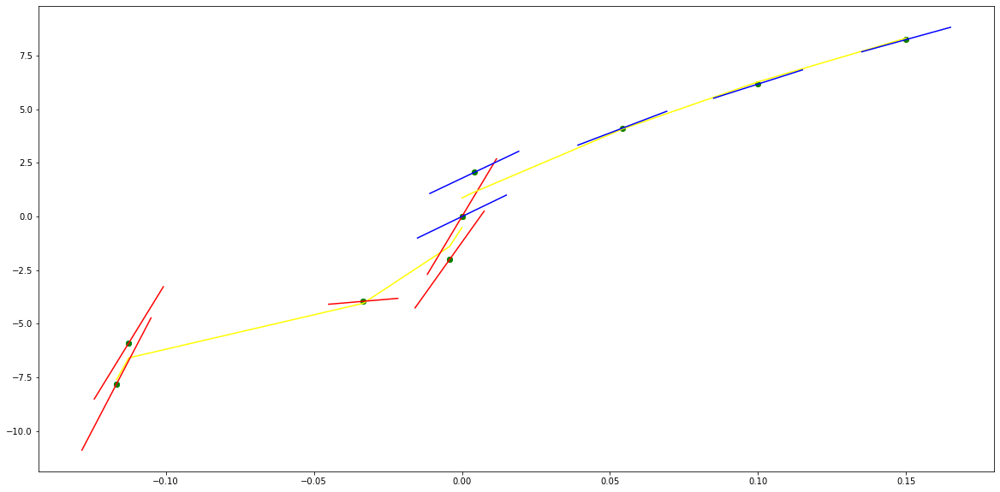

parameters (0.0002186955466359908, -0.0020915492911480114, -0.06396906405136264, 0.0021182621247041898)
tangent[0]:-0.0038693989075015145
tangent[1]:-0.022623751595265418
tangent[2]:-0.040109402887300166
tangent[3]:-0.052950149123929015
tangent[4]:-0.06396906405136264
parameters (-70.42639027749951, 175.78448175954108, -109.762708182379, 9.989894641436909e-05)
tangent[0]:-109.762708182379
tangent[1]:11.025897248419213
tangent[2]:8.52219253387183
tangent[3]:7.878042041721713
tangent[4]:-22.039756690398733


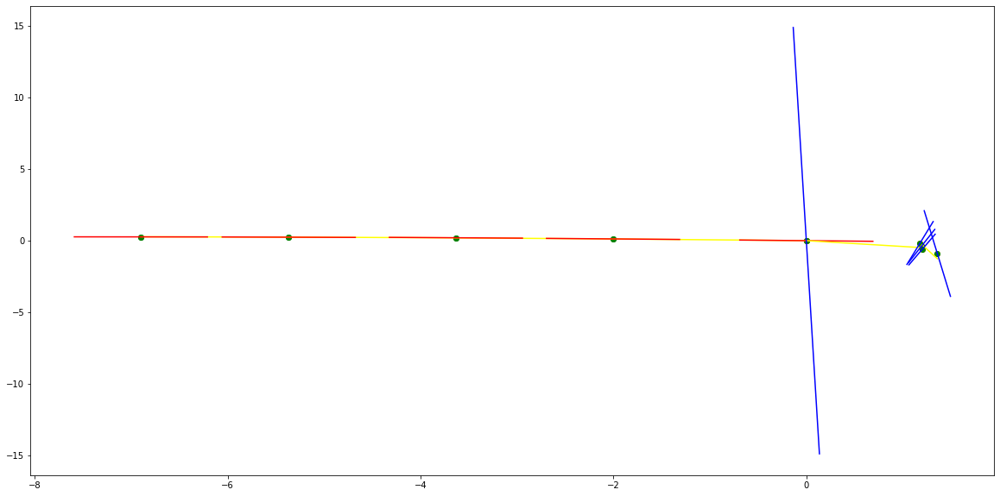

parameters (-17104.425212095826, -2511.2281145586917, -198.7010418792506, 0.5372815173874576)
tangent[0]:-85.2400105136621
tangent[1]:-75.86141951410016
tangent[2]:-88.30111881175426
tangent[3]:-178.66346479489337
tangent[4]:-198.7010418792506
parameters (25008.861477777966, -4884.259395955929, 106.54812417323537, -1.1385523744971173)
tangent[0]:106.54812417323537
tangent[1]:67.1454596514882
tangent[2]:-194.31135433902284
tangent[3]:-210.91170487854527
tangent[4]:-211.23489723357972


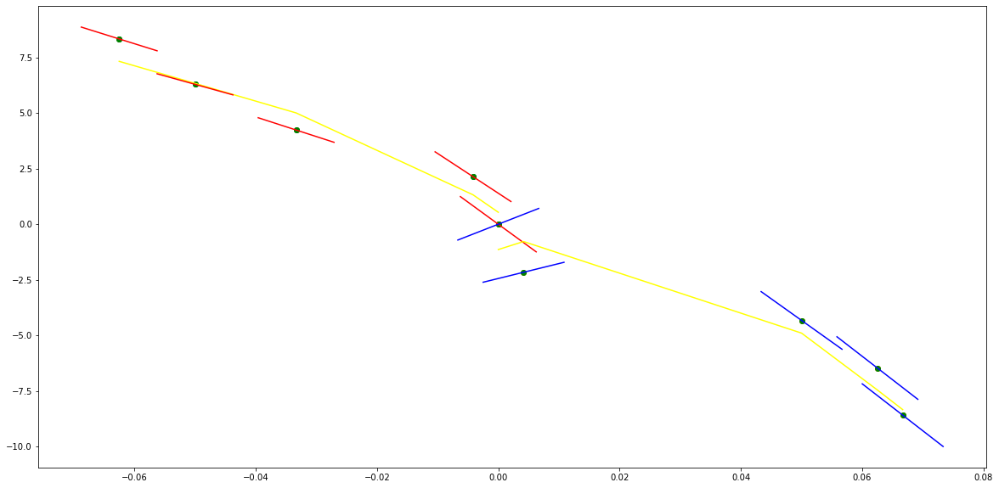

parameters (-17.01380735091299, -15.017902848934307, -21.64114762910341, 0.20546461303115124)
tangent[0]:-17.70701302431792
tangent[1]:-17.234016500998806
tangent[2]:-17.948025182341535
tangent[3]:-20.062749607098358
tangent[4]:-21.64114762910341
parameters (-253.75157658453026, 219.12245616489508, -69.19180499442703, -1.505349918484427)
tangent[0]:-69.19180499442703
tangent[1]:-67.37885678737696
tangent[2]:-65.59234526558322
tangent[3]:-47.686962841159755
tangent[4]:-26.305796105603115


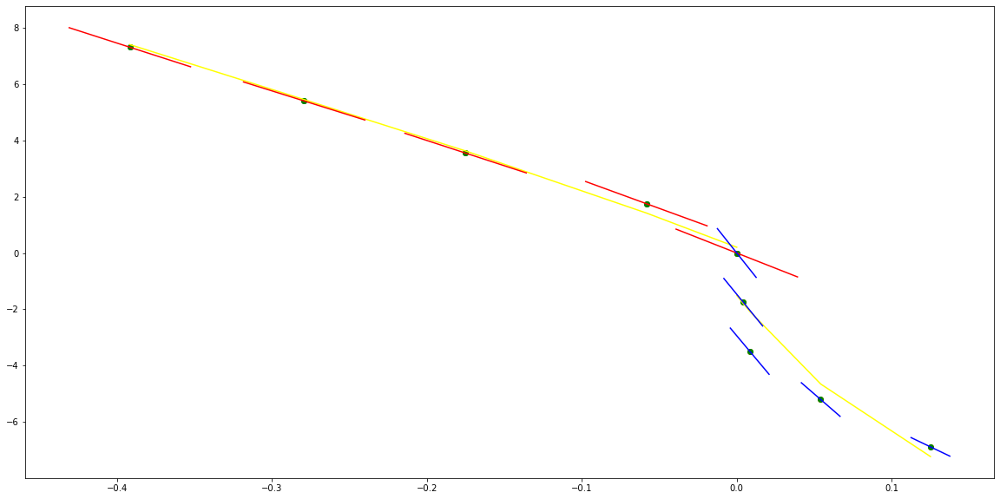

parameters (-0.9495923969682093, -1.8393476498334047, -2.7372541009453593, 0.1280407340464534)
tangent[0]:-1.5858213345678391
tangent[1]:-1.5780474355319543
tangent[2]:-1.9323030692703251
tangent[3]:-2.588923218059518
tangent[4]:-2.7372541009453593
parameters (-4659.924649656148, 1214.7685810205426, -89.86255479603012, -0.04550152597997332)
tangent[0]:-89.86255479603012
tangent[1]:-79.9814166848999
tangent[2]:-70.58576505995964
tangent[3]:3.302913442886208
tangent[4]:-0.4085214923776306


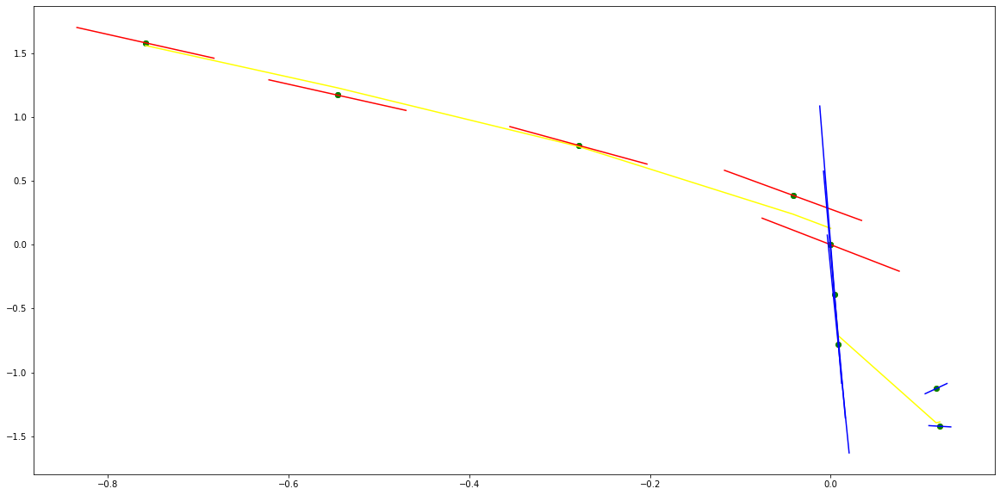

parameters (-17224.819545839164, -3038.4028953141533, -48.73606682959562, -0.608107032255878)
tangent[0]:128.8096306027406
tangent[1]:125.91807610802599
tangent[2]:121.23150372881437
tangent[3]:-24.316932866491214
tangent[4]:-48.73606682959562
parameters (36601.18482300349, -4679.150506900489, 221.02524185358251, 0.11805440344752194)
tangent[0]:221.02524185358251
tangent[1]:183.93581826067918
tangent[2]:41.48308503240466
tangent[3]:31.084465476330337
tangent[4]:24.500202308091843


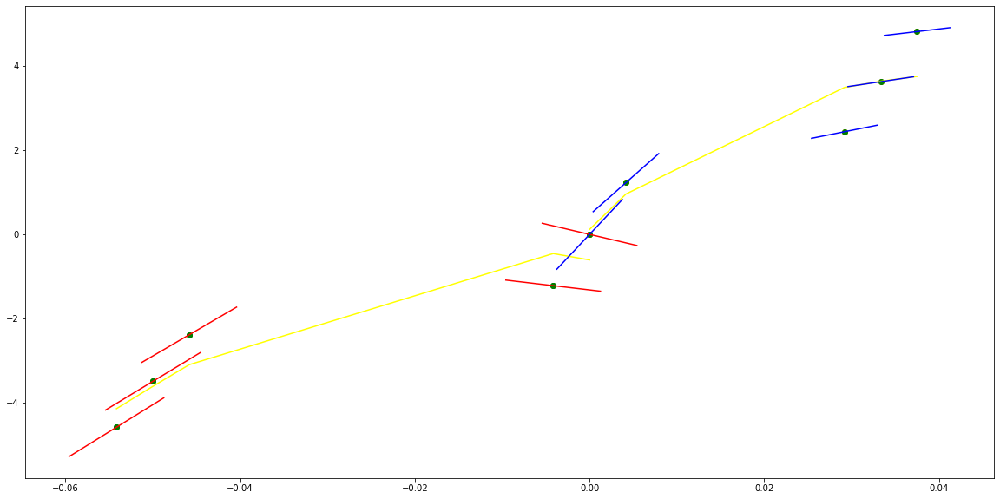

parameters (-1703.5551366021123, -707.6639747664466, -16.238623611228036, 0.01230680048668216)
tangent[0]:80.82322305215959
tangent[1]:66.21445231994079
tangent[2]:63.7773826570272
tangent[3]:61.16347967357831
tangent[4]:-16.238623611228036
parameters (35169.49120293482, -4757.022818148187, 235.9557094613238, 0.2752320594420378)
tangent[0]:235.9557094613238
tangent[1]:198.14271871917953
tangent[2]:163.99380282564067
tangent[3]:24.024611668516286
tangent[4]:30.177001879160855


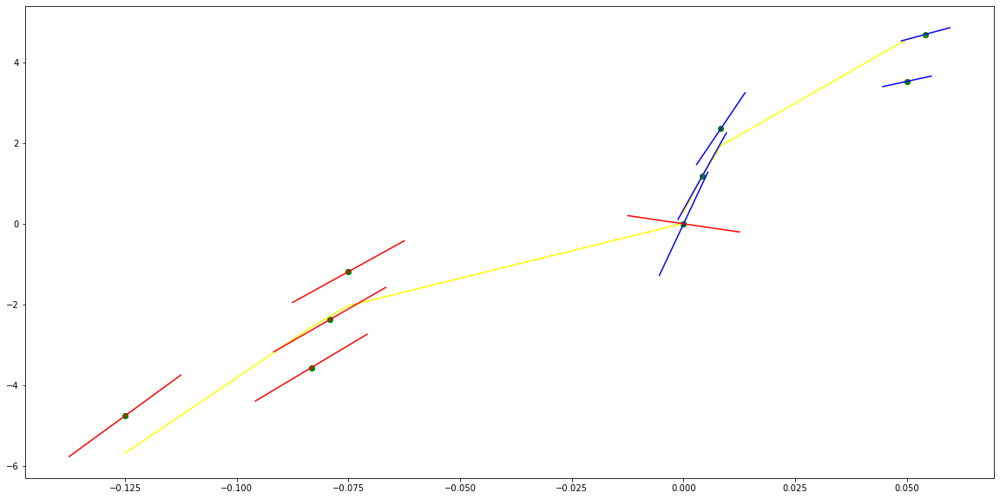

parameters (-7338.894835172887, -966.4484907786353, 140.54462851249215, 0.3358552909496176)
tangent[0]:182.14776632655904
tangent[1]:182.88535646552066
tangent[2]:182.85862486616426
tangent[3]:175.10662523547475
tangent[4]:140.54462851249215
parameters (57179.27645800396, -8730.829011228197, 518.076278162268, 0.6072647883251697)
tangent[0]:518.076278162268
tangent[1]:448.3081452445337
tangent[2]:384.47967815434174
tangent[3]:126.6206075603713
tangent[4]:104.4891748773573


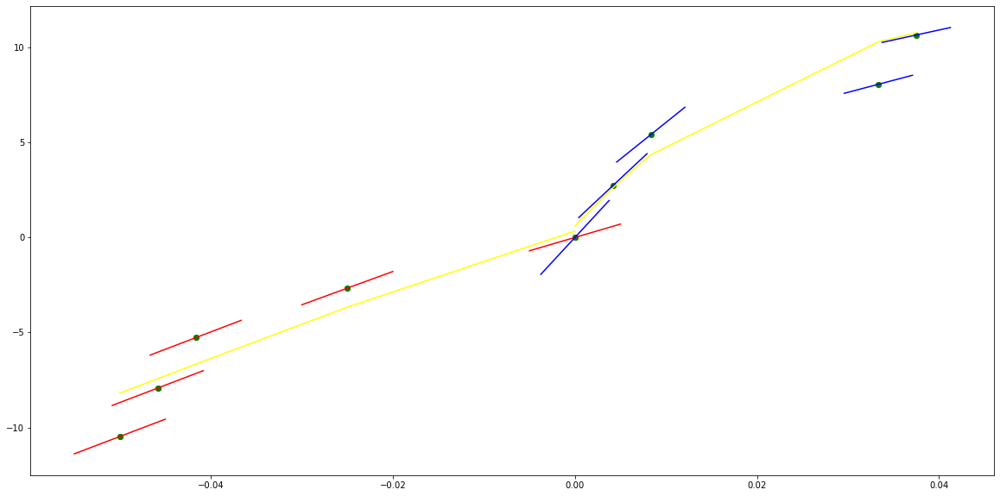

parameters (0.009456778335245915, 0.17357431208240504, -0.7521820431754884, -0.022688483445790296)
tangent[0]:-1.7789306726939529
tangent[1]:-1.700486759296838
tangent[2]:-1.5390316612000123
tangent[3]:-1.3013380324962625
tangent[4]:-0.7521820431754884
parameters (-47.624687831166, 252.169533592627, -315.02129198680666, -4.780383699528981e-05)
tangent[0]:-315.02129198680666
tangent[1]:121.87833191073753
tangent[2]:-204.77563239299127
tangent[3]:-210.2659444582456
tangent[4]:-212.10611769048035


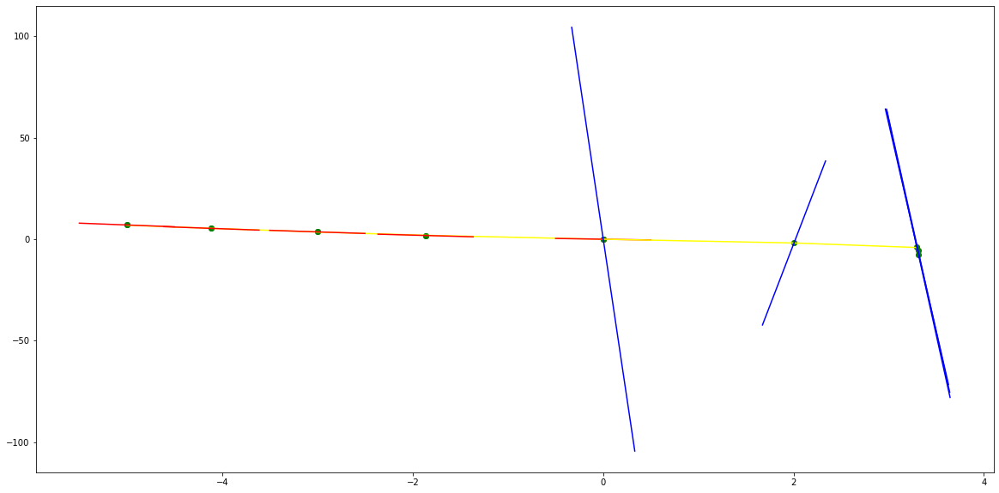

parameters (0.003181946166740765, 0.11416424111214568, -0.5930435686501727, 0.05051596623411977)
tangent[0]:-1.6329730887363694
tangent[1]:-1.4971465609338037
tangent[2]:-1.3338363711960786
tangent[3]:-1.0123091580287102
tangent[4]:-0.5930435686501727
parameters (1336.9555180698605, -3684.118300111342, 2526.938511810313, -2.1695099274520897e-06)
tangent[0]:2526.938511810313
tangent[1]:-298.6251987480691
tangent[2]:-260.5838591148522
tangent[3]:-247.62383788144052
tangent[4]:-234.52768845686114


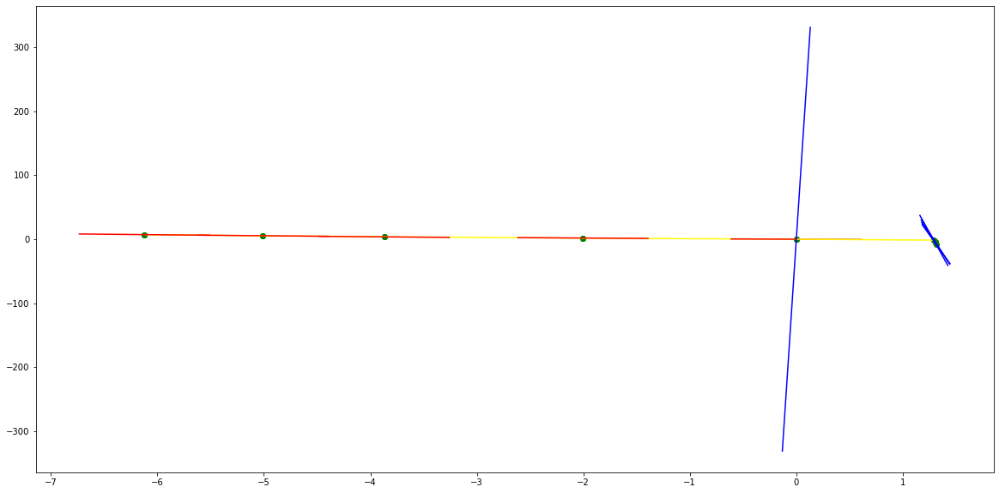

parameters (-184290.84138535504, -8762.783611372495, -784.8222411036386, 0.1952099940511861)
tangent[0]:-659.6664534824125
tangent[1]:-646.3054564460869
tangent[2]:-652.1389827187114
tangent[3]:-721.3932196270559
tangent[4]:-784.8222411036386
parameters (-13393.99977877112, 2630.783563194868, -396.76330623935394, -0.9964871761252754)
tangent[0]:-396.76330623935394
tangent[1]:-375.53607179996175
tangent[2]:-304.58862409502535
tangent[3]:-266.025262215788
tangent[4]:-234.13994826065058


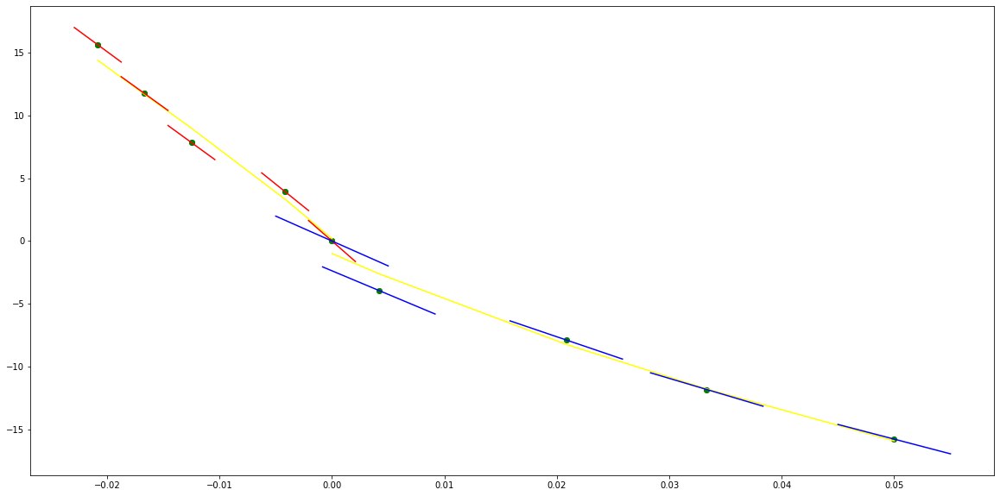

parameters (62126.62313509617, 9608.933136512385, 572.7393645573069, 0.05119014228122055)
tangent[0]:253.25355646702872
tangent[1]:304.20944423886317
tangent[2]:361.63789073907355
tangent[3]:495.8947951618006
tangent[4]:572.7393645573069
parameters (-636.4977844914936, 265.5455482107077, 37.27774585279102, 1.042330760100131)
tangent[0]:37.27774585279102
tangent[1]:39.45713104165478
tangent[2]:67.35482076338079
tangent[3]:71.88031728693657
tangent[4]:74.20141289660873


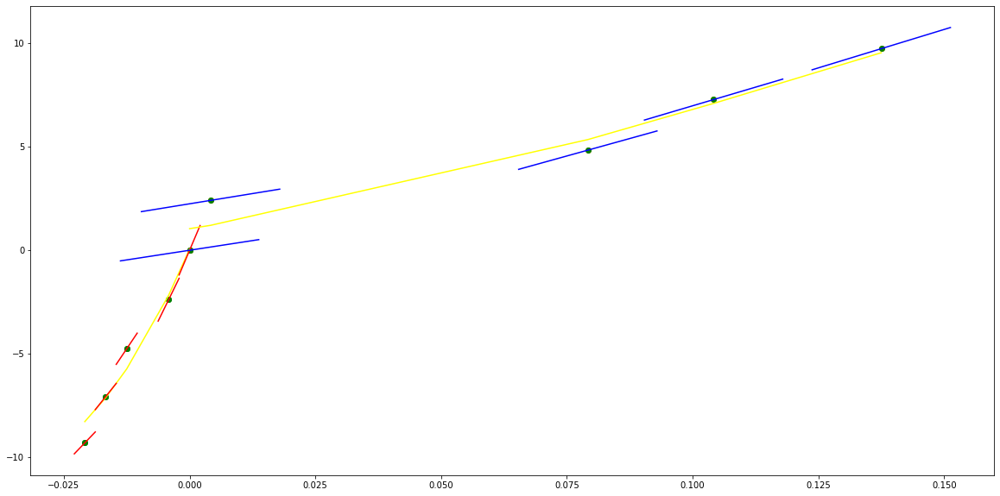

parameters (341.55772726836443, 172.43151254782592, 81.79567591092363, -0.21736464909193917)
tangent[0]:52.81321053992095
tangent[1]:55.967105544883516
tangent[2]:61.6947356764034
tangent[3]:73.81452102216052
tangent[4]:81.79567591092363
parameters (103800.97561140836, -14892.35999790422, 782.7841276808656, -0.33205539826242536)
tangent[0]:782.7841276808656
tangent[1]:664.1055551135629
tangent[2]:556.2115292265107
tangent[3]:372.8858773135896
tangent[4]:297.4322513294929


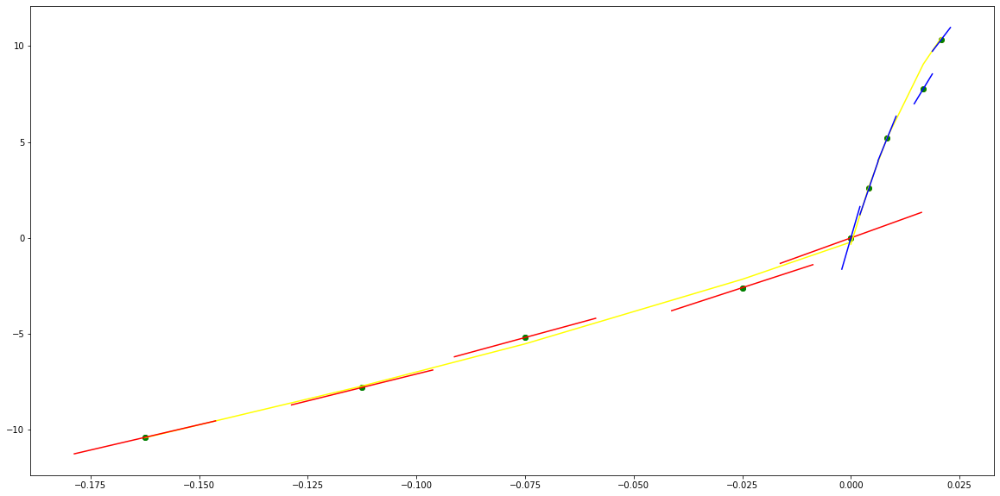

parameters (0.34370090523674385, 7.738873072229845, 22.637064316518657, 0.04765252916236382)
tangent[0]:18.21044694375537
tangent[1]:19.457291607832374
tangent[2]:20.465087395123703
tangent[3]:21.48203330846005
tangent[4]:22.637064316518657
parameters (33002.92250232281, -4945.546048148823, 280.53325286366237, 0.3280985634415972)
tangent[0]:280.53325286366237
tangent[1]:241.03624934740787
tangent[2]:204.97760032918904
tangent[3]:60.83773103375688
tangent[4]:48.84837855917502


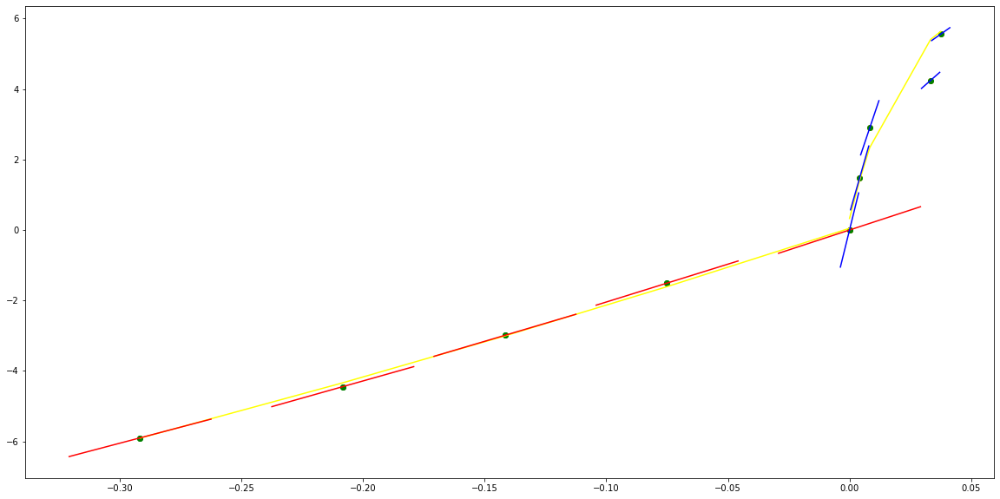

parameters (6138.611407089585, 1506.3074585057627, 128.98723245918902, -0.17633676028057932)
tangent[0]:5.9072025000388635
tangent[1]:49.029368215361515
tangent[2]:56.78489912426868
tangent[3]:116.75343660126251
tangent[4]:128.98723245918902
parameters (87.91774565749247, -63.06306681789304, 30.389168242076888, 0.5188032356586606)
tangent[0]:30.389168242076888
tangent[1]:29.868180425146747
tangent[2]:24.331162809635067
tangent[3]:18.999928311473013
tangent[4]:16.01309292268066


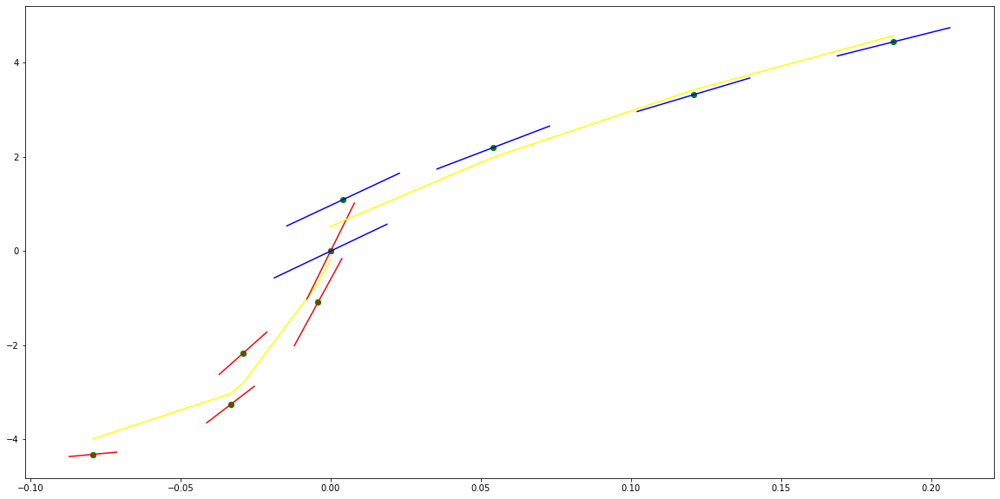

parameters (6570.898018462101, 1394.4217589576995, 114.69475573998544, -0.6361433621250491)
tangent[0]:93.29602504646896
tangent[1]:83.3570377404855
tangent[2]:28.283435340423935
tangent[3]:103.41593383230067
tangent[4]:114.69475573998544
parameters (156.71941122167217, -114.23502513922784, 53.13368733534917, 0.850483532742955)
tangent[0]:53.13368733534917
tangent[1]:52.18981641122064
tangent[2]:42.885580405588925
tangent[3]:33.38124682384577
tangent[4]:28.115272640585125


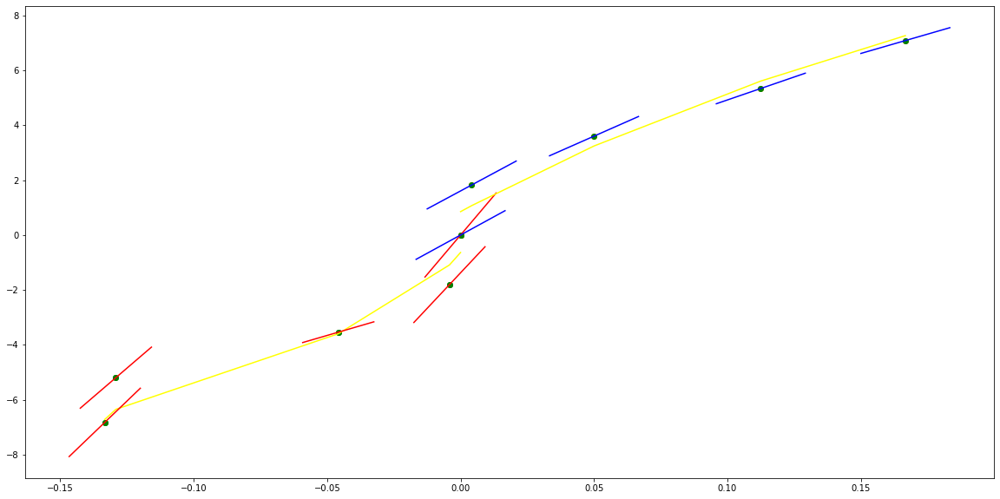

parameters (720.1040776410858, 208.18421226356998, 30.214238968464095, 0.0033748362087280617)
tangent[0]:58.41380128971961
tangent[1]:55.76031423883989
tangent[2]:23.50932680948936
tangent[3]:10.79117079712383
tangent[4]:30.214238968464095
parameters (14022.037778351823, -3445.6321588944425, 247.95012553627717, 0.28964778729971263)
tangent[0]:247.95012553627717
tangent[1]:219.97119917405757
tangent[2]:193.44624415067673
tangent[3]:101.9598384259647
tangent[4]:-32.966822048731814


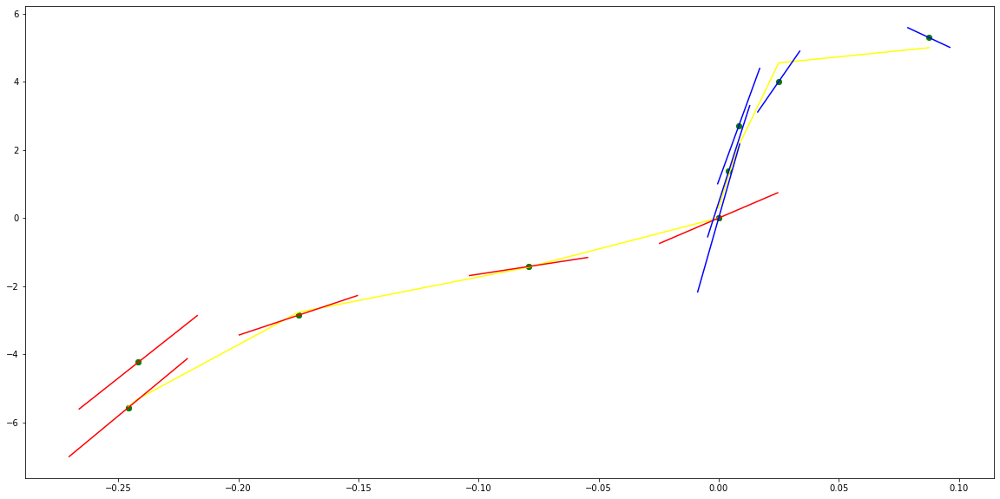

parameters (15388.135586542277, 3964.0151522178176, 304.6067003273427, 0.08291287879727514)
tangent[0]:159.47203420819068
tangent[1]:185.2941785084148
tangent[2]:212.71951007808894
tangent[3]:272.3721916834844
tangent[4]:304.6067003273427
parameters (52.85979018027332, -47.98586574488448, 31.259483146435144, 0.639940117258598)
tangent[0]:31.259483146435144
tangent[1]:30.862417146194634
tangent[2]:25.566214801468284
tangent[3]:21.061511290879288
tangent[4]:17.79923184790215


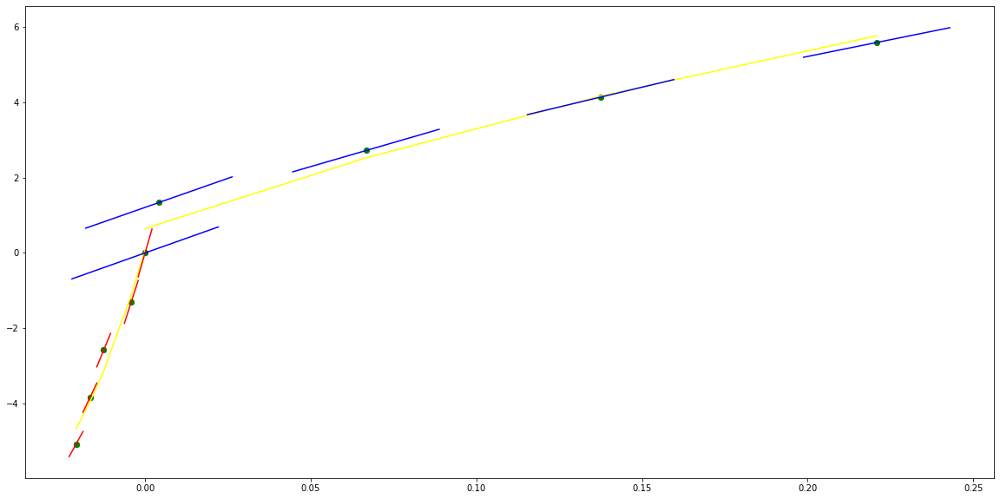

parameters (11864.891310456722, 2511.1804751708055, 126.19777202880924, -0.0080711694577284)
tangent[0]:277.88083702400945
tangent[1]:249.98597609854107
tangent[2]:223.3334884050032
tangent[3]:-21.27164403554842
tangent[4]:126.19777202880924
parameters (569.2722228571621, -342.74251270180804, 84.70111930027727, 1.3599955703716438)
tangent[0]:84.70111930027727
tangent[1]:81.87502879227493
tangent[2]:79.10756147567022
tangent[3]:50.525975506838755
tangent[4]:30.483472880864724


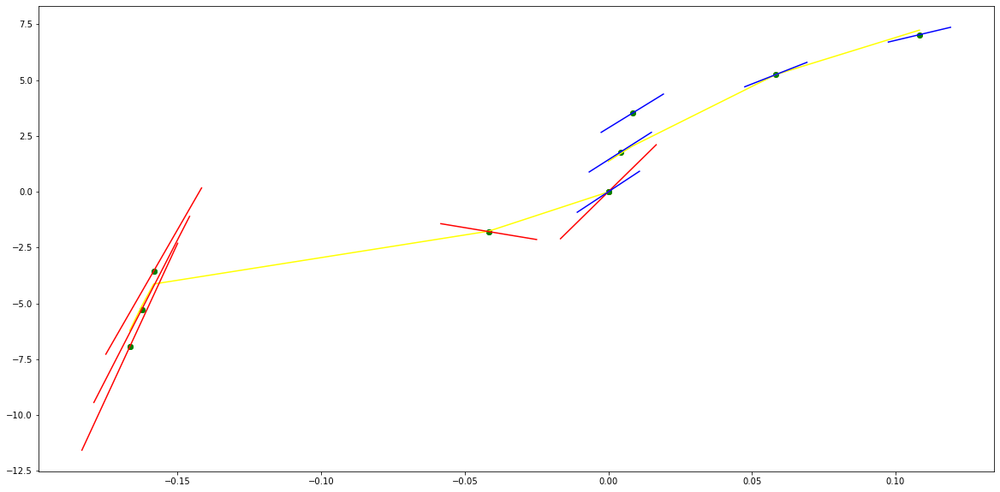

parameters (332.4378991816778, 304.18827315716493, 92.05070056914725, -0.9235692698391504)
tangent[0]:62.0229502909109
tangent[1]:64.12515749729334
tangent[2]:66.26199919236049
tangent[3]:89.53291274499779
tangent[4]:92.05070056914725
parameters (1385.34369516521, -811.6857869538898, 152.21169192483828, 0.7274812424138735)
tangent[0]:152.21169192483828
tangent[1]:145.51926743881364
tangent[2]:108.39840659621696
tangent[3]:102.71756721320307
tangent[4]:97.17967661727478


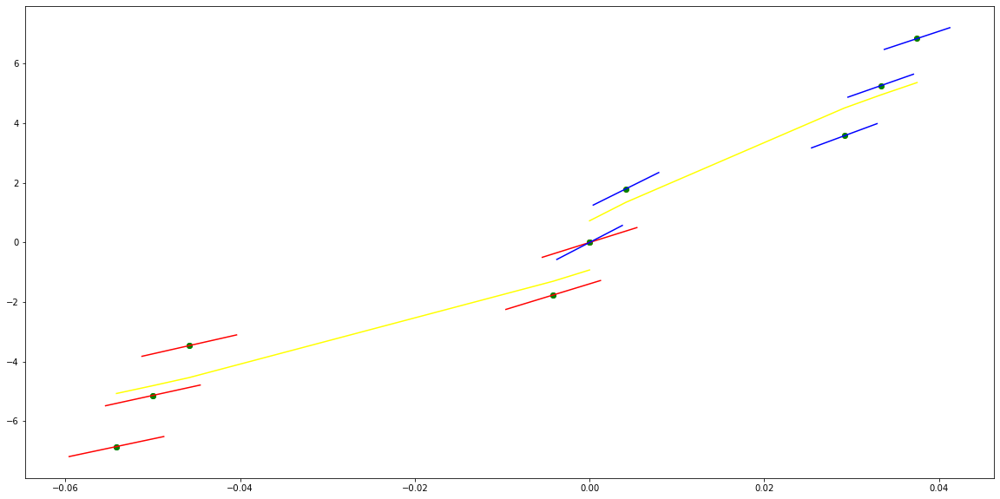

parameters (-0.0857223299186971, -0.6154891539911811, 11.853349084989775, -0.19797301991523256)
tangent[0]:12.526039267361085
tangent[1]:12.363524217733517
tangent[2]:12.226253771791056
tangent[3]:11.983686536235684
tangent[4]:11.853349084989775
parameters (58977.66046067823, -9583.905071097628, 513.4557078196624, -0.15661585295255484)
tangent[0]:513.4557078196624
tangent[1]:436.6556876062915
tangent[2]:366.000156691234
tangent[3]:243.13583250526716
tangent[4]:190.91229492568317


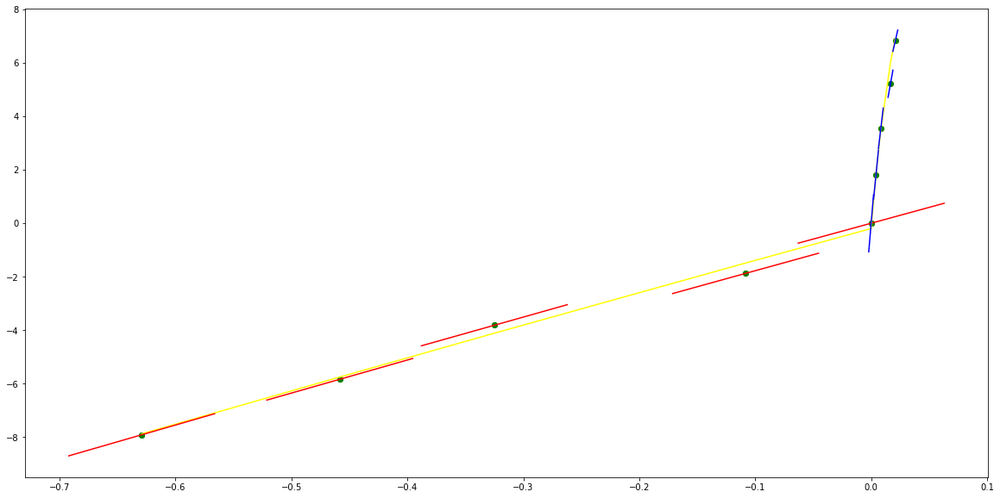

parameters (-60204.69122139238, -5969.227024195423, -309.50012900806246, 0.3702457002809618)
tangent[0]:-115.79664328365487
tangent[1]:-112.23393065834512
tangent[2]:-114.94354348692059
tangent[3]:-262.8991871123329
tangent[4]:-309.50012900806246
parameters (-37.590485710024645, 52.17541352900974, -41.01199976182769, -1.1398829926992258)
tangent[0]:-41.01199976182769
tangent[1]:-40.5791280165409
tangent[2]:-33.09917558894556
tangent[3]:-25.4108412281782
tangent[4]:-19.705262237958316


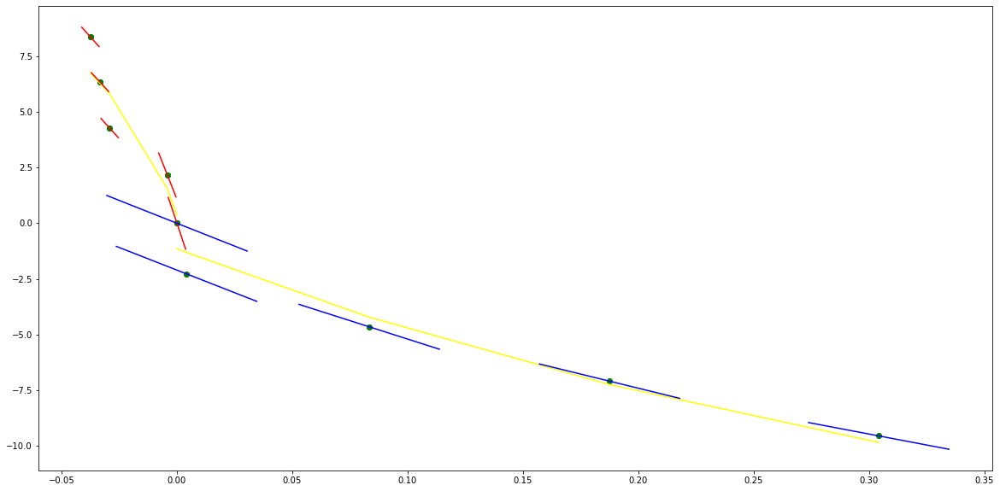

parameters (-4.440734752574809, -9.554685202147446, -21.61094101598243, 0.01268577831983142)
tangent[0]:-14.761787977034178
tangent[1]:-15.294052940420984
tangent[2]:-16.851329674717135
tangent[3]:-18.981541717480848
tangent[4]:-21.61094101598243
parameters (199704.51205132203, -30957.678598662664, 793.3576639022152, 0.0018719629530592028)
tangent[0]:793.3576639022152
tangent[1]:-685.9648207809695
tangent[2]:-746.3252153955312
tangent[3]:-785.8727317130639
tangent[4]:-804.6263555791357


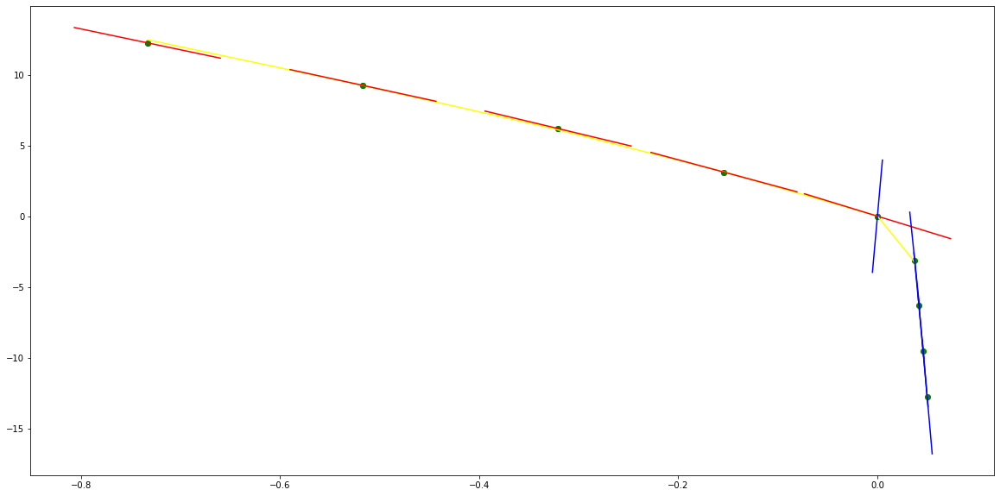

parameters (-198368.24392160642, -9510.314458857338, -764.322507350677, 0.19148812744325933)
tangent[0]:-626.3494641034782
tangent[1]:-612.6183514576126
tangent[2]:-619.5497602174967
tangent[3]:-695.410940777487
tangent[4]:-764.322507350677
parameters (-83206.58856169018, 13194.542307689298, -894.7444217520825, 0.0951485503047276)
tangent[0]:-894.7444217520825
tangent[1]:-789.1154760633615
tangent[2]:-603.8839524481423
tangent[3]:-524.2591458496636
tangent[4]:-453.3030790583079


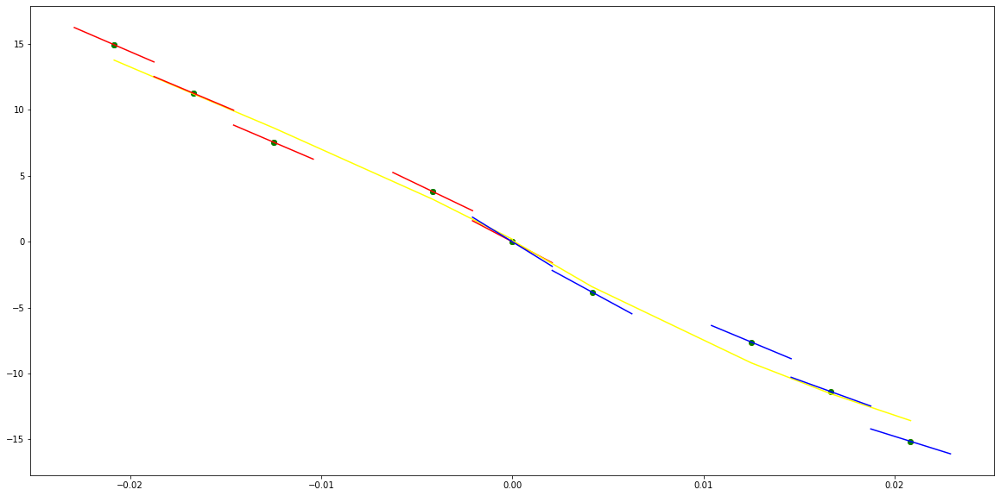

parameters (3425.7884700499776, 578.6697354178897, -135.09863408937665, -0.13009509486855478)
tangent[0]:-165.51169261241398
tangent[1]:-167.63379448215971
tangent[2]:-164.04631913769504
tangent[3]:-154.7489679549652
tangent[4]:-135.09863408937665
parameters (-4400.691245051244, 1122.2466384322142, -180.7935028517911, -0.0005881493693792671)
tangent[0]:-180.7935028517911
tangent[1]:-147.05192280167608
tangent[2]:-120.64648589295713
tangent[3]:-92.08327357570857
tangent[4]:-85.43347876900798


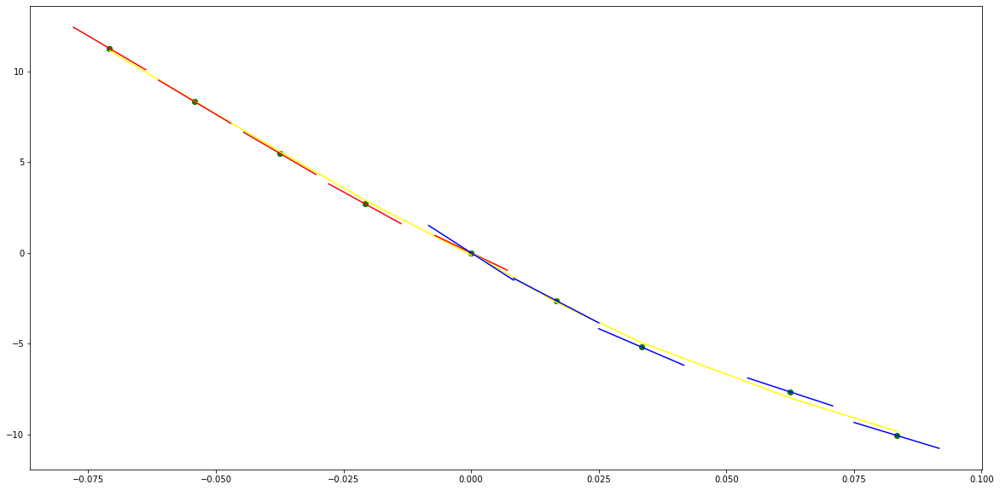

parameters (49724.26825119982, 4627.202691206167, 203.04721957800413, -0.18024619484324061)
tangent[0]:92.25198185263352
tangent[1]:60.02790736231859
tangent[2]:110.67540304059986
tangent[3]:167.0823437214525
tangent[4]:203.04721957800413
parameters (340.6197379630064, -235.18846453551527, 63.47725721218887, 0.6427607798415251)
tangent[0]:63.47725721218887
tangent[1]:61.534939998713476
tangent[2]:54.12096794116134
tangent[3]:40.99655031431206
tangent[4]:25.567456699355724


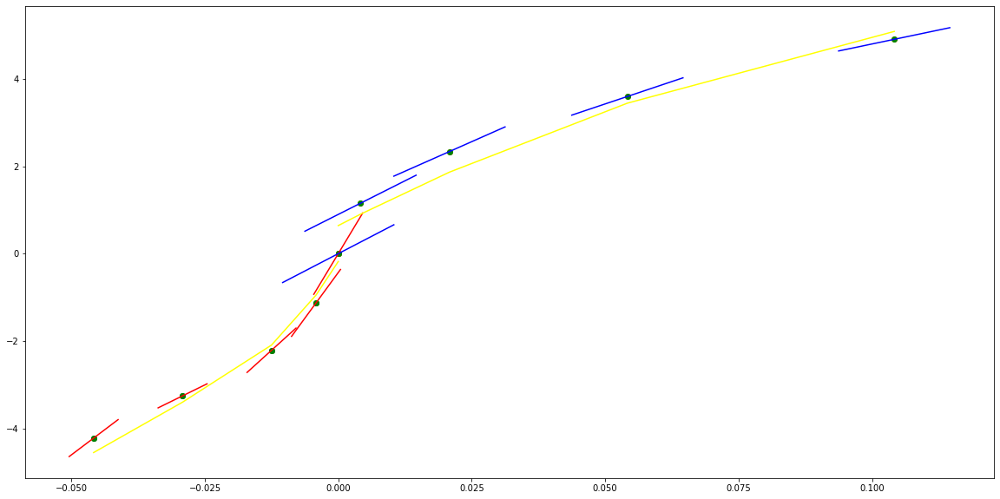

parameters (-29909.844628581293, -4325.045998734198, -11.8593344543739, -0.6905307524451452)
tangent[0]:196.3214307046862
tangent[1]:196.1087404550111
tangent[2]:192.78111553325851
tangent[3]:53.99116301701634
tangent[4]:-11.8593344543739
parameters (53643.66222848806, -6394.052884569207, 369.88628476371866, 0.6147655504307589)
tangent[0]:369.88628476371866
tangent[1]:319.3926358131858
tangent[2]:274.49786831060067
tangent[3]:150.7655072136734
tangent[4]:132.80846302045842


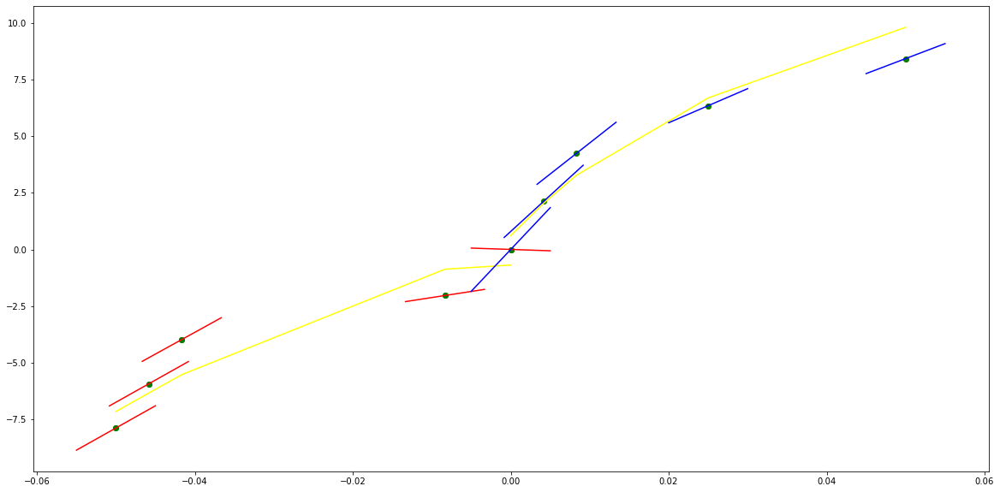

parameters (51194.77166965415, 1346.3002090334355, 111.71888343957495, -0.45648341940845244)
tangent[0]:226.72431074342074
tangent[1]:192.61225963528605
tangent[2]:163.84011695649403
tangent[3]:103.16563849544696
tangent[4]:111.71888343957495
parameters (-7197.1695797548855, 1850.0231454320813, -44.79123047241843, 0.8395898903916819)
tangent[0]:-44.79123047241843
tangent[1]:-29.748050139478586
tangent[2]:92.27831086391632
tangent[3]:113.6528311932008
tangent[4]:111.49966914953231


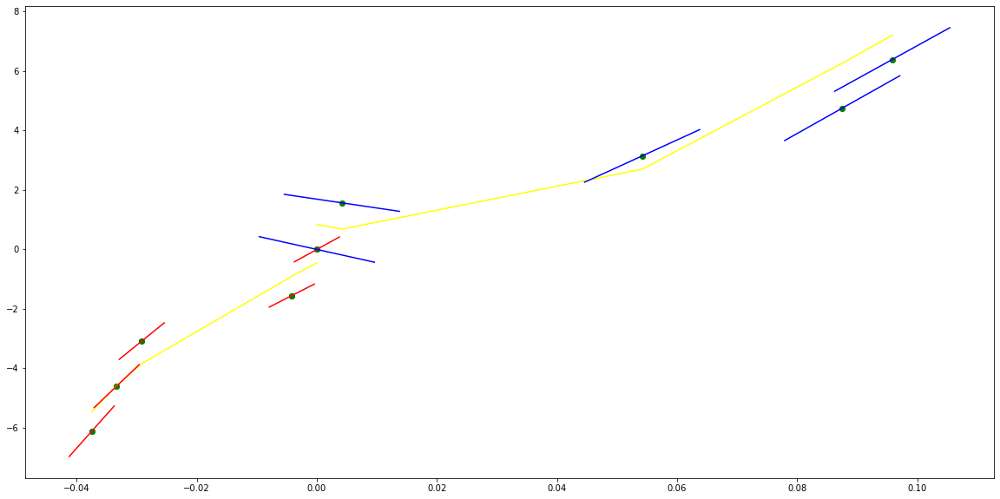

parameters (12046.316044351279, 2147.838820370918, 201.65326966130237, -0.42465760726963975)
tangent[0]:77.2167579568452
tangent[1]:80.685259682732
tangent[2]:140.09620867456783
tangent[3]:184.38069361629024
tangent[4]:201.65326966130237
parameters (-10244.243927567351, 1417.3511096324337, 71.50150179692905, 0.563924915939201)
tangent[0]:71.50150179692905
tangent[1]:82.78006620126413
tangent[2]:134.5849309499368
tangent[3]:136.86526874625093
tangent[4]:136.40478330341728


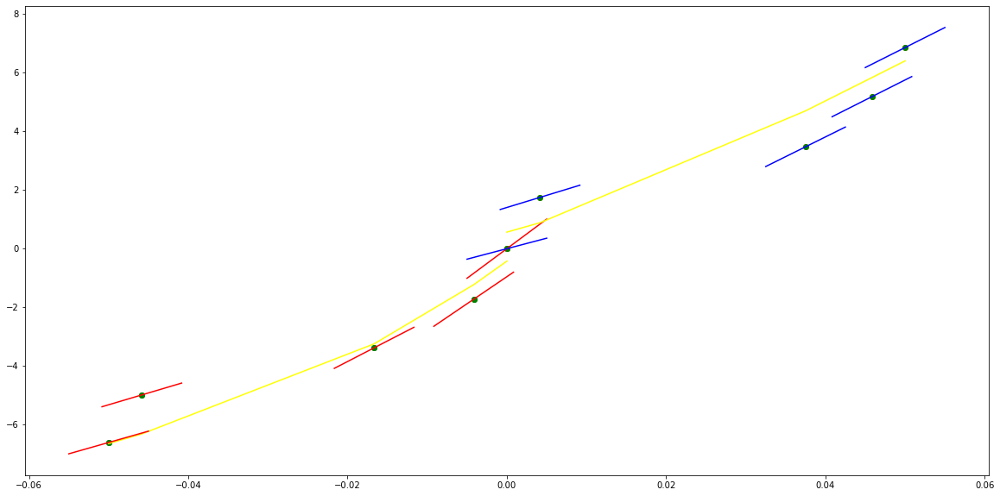

parameters (25278.082101907527, 4333.612619164077, 213.8974083680837, -0.40155890836749475)
tangent[0]:234.91249221019348
tangent[1]:198.61174886296794
tangent[2]:-29.878237784017557
tangent[3]:179.0978582352215
tangent[4]:213.8974083680837
parameters (1400.1900647321215, -515.9263448704803, 97.85706378266212, 0.609953504713153)
tangent[0]:97.85706378266212
tangent[1]:93.63027185910028
tangent[2]:68.12952494576284
tangent[3]:47.735928071271815
tangent[4]:35.951460026811105


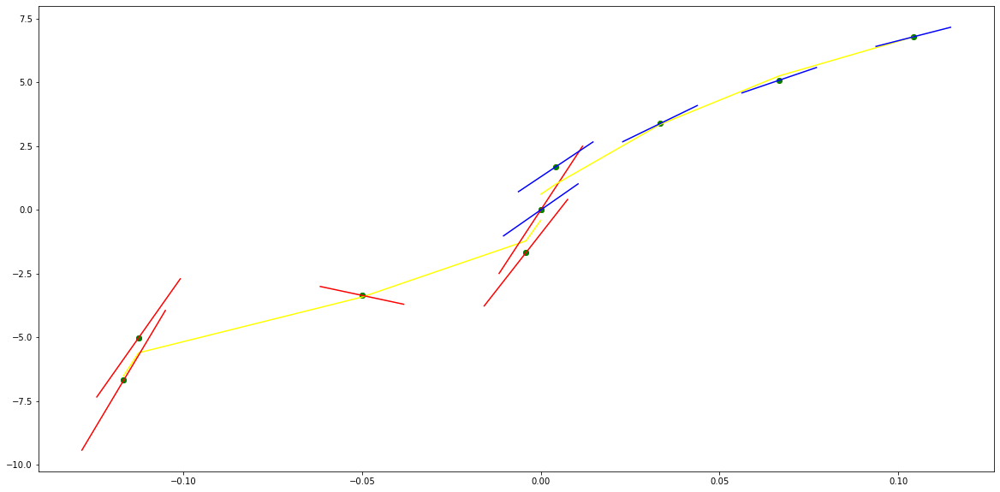

parameters (1655.5371466753177, 936.0788133521897, 184.29262707839993, 0.14491778048929452)
tangent[0]:86.6836013469776
tangent[1]:127.40634369445598
tangent[2]:133.91257091360967
tangent[3]:140.59281856080668
tangent[4]:184.29262707839993
parameters (-3494.1673087898257, 1117.2762338022942, -17.58133076424734, 2.0795927174294047)
tangent[0]:-17.58133076424734
tangent[1]:-8.451967631630787
tangent[2]:0.31130166059423914
tangent[3]:101.44214275969694
tangent[4]:100.43788822465585


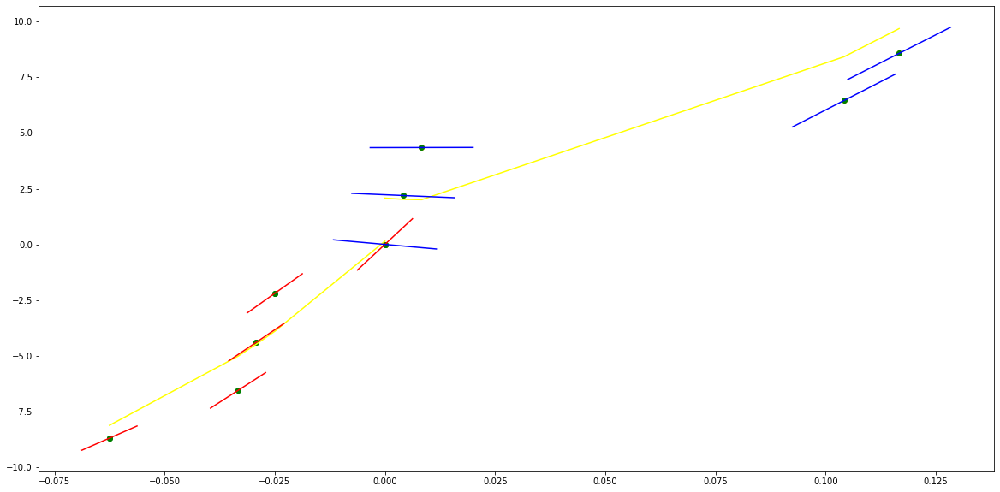

parameters (17741.210327436955, 3898.9661298944648, 280.87355011739567, -0.4884593018647058)
tangent[0]:95.54446092603814
tangent[1]:77.21775051101304
tangent[2]:165.69637029158395
tangent[3]:249.31109003115182
tangent[4]:280.87355011739567
parameters (107.56009297760056, -80.67121537966067, 53.21507847801674, 0.9220427311461253)
tangent[0]:53.21507847801674
tangent[1]:52.54836755358853
tangent[2]:43.405582695953996
tangent[3]:38.430835343112534
tangent[4]:34.48124686330698


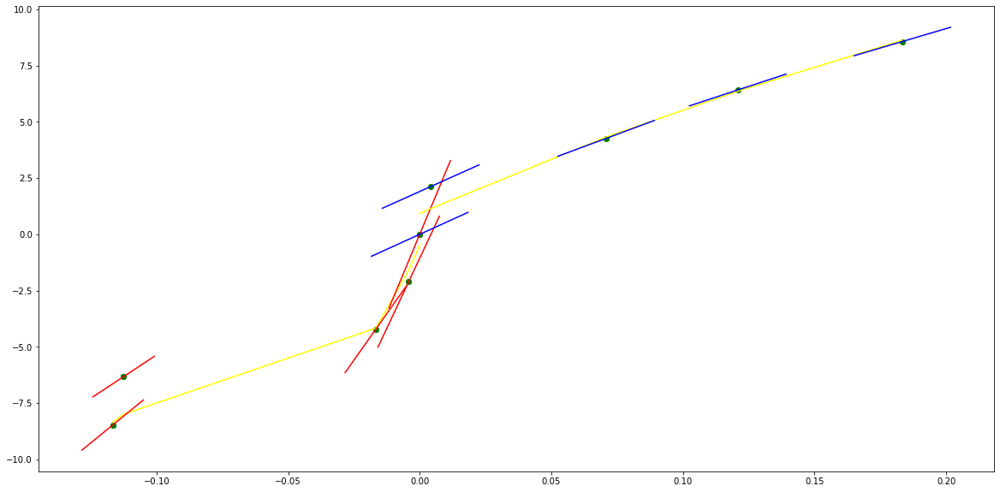

parameters (-2.926449656222421, 1.5600345425596667, 24.369938547453547, -0.09475762920583321)
tangent[0]:22.279044846916946
tangent[1]:22.847981283290267
tangent[2]:23.55505889539223
tangent[3]:24.086549528120845
tangent[4]:24.369938547453547
parameters (561.7815080166215, -355.4110903216806, 95.88109368968085, 1.7417863981695259)
tangent[0]:95.88109368968085
tangent[1]:92.94836179818233
tangent[2]:90.07484090971198
tangent[3]:60.15149077955933
tangent[4]:34.59738180159414


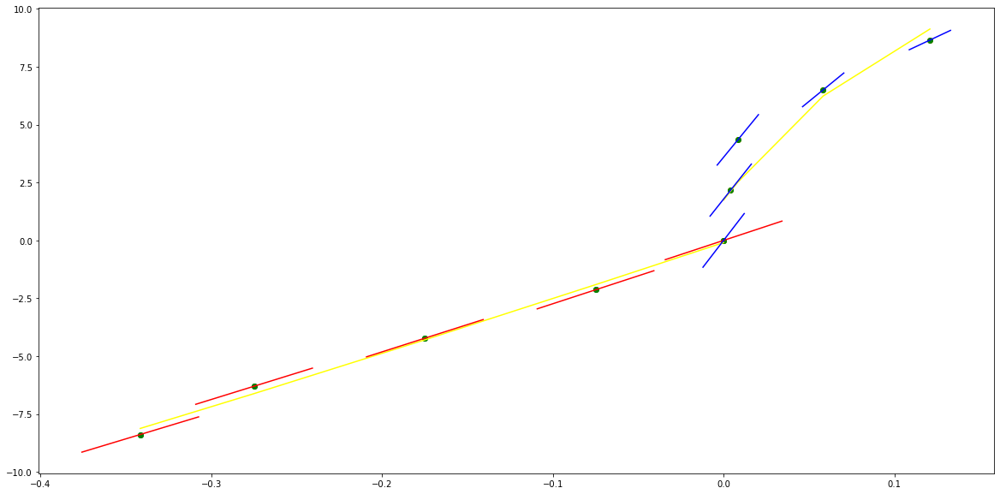

parameters (-0.13009196426963388, -1.3303049176824835, 7.4671883329197355, -0.0314836181541048)
tangent[0]:9.337410178775876
tangent[1]:8.950397416669189
tangent[2]:8.459197961682609
tangent[3]:7.983699264280373
tangent[4]:7.4671883329197355
parameters (-27960.56687745347, 6641.327384241535, -94.46756873377976, -0.03688328436448832)
tangent[0]:-94.46756873377976
tangent[1]:221.57990555415134
tangent[2]:255.08313710102644
tangent[3]:285.6733435700785
tangent[4]:338.1090878037968


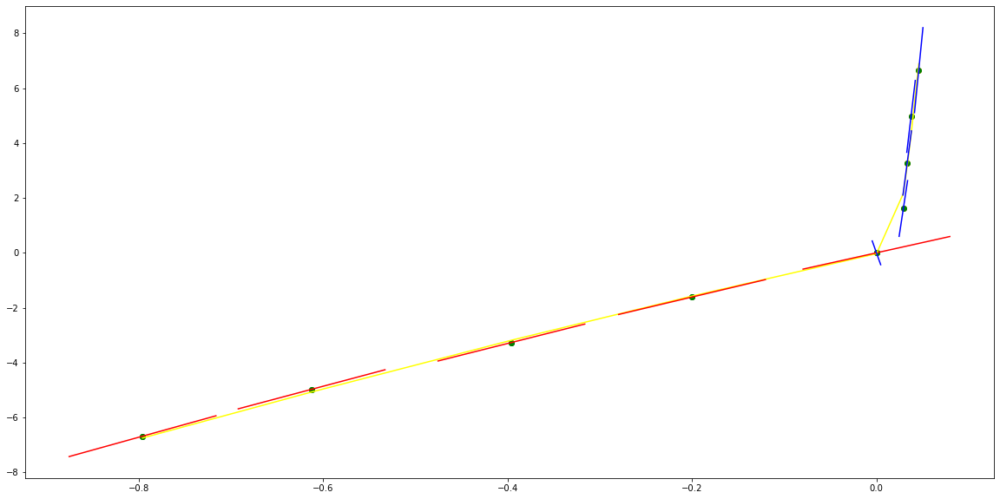

parameters (14.924217480981913, 25.243681942149948, 20.80406041483541, -1.3218763433934708)
tangent[0]:7.382970189896696
tangent[1]:11.46130756155059
tangent[2]:19.170911511140456
tangent[3]:20.594456996896785
tangent[4]:20.80406041483541
parameters (20405.97567843622, -5654.193576016345, 404.8640814047483, -0.1091731518639825)
tangent[0]:404.8640814047483
tangent[1]:358.80501343207925
tangent[2]:273.07454310360663
tangent[3]:233.39285267984087
tangent[4]:195.84588245556378


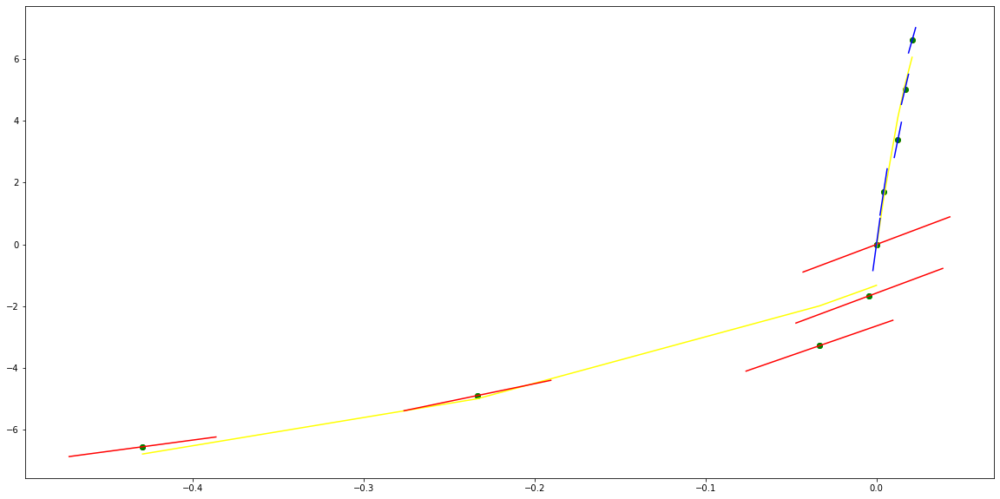

parameters (22989.535448872164, 3732.6425438274373, 200.99502562159992, -0.34482119679681417)
tangent[0]:75.82347279308081
tangent[1]:57.83524701531471
tangent[2]:42.24214768772319
tangent[3]:171.09163645612037
tangent[4]:200.99502562159992
parameters (-33246.43397942061, 4702.970500263898, -45.91444977888654, 0.7105887052898998)
tangent[0]:-45.91444977888654
tangent[1]:-8.45175579748068
tangent[2]:166.5499443902251
tangent[3]:175.66955734093938
tangent[4]:175.03434540184867


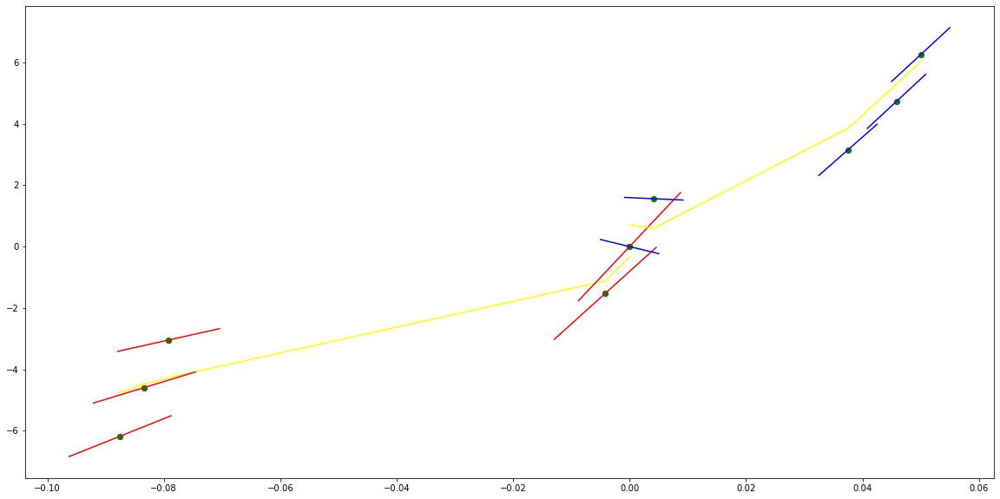

parameters (1141.9827385000451, 566.0841786567175, 100.12605592671783, 0.12149734840159104)
tangent[0]:42.748143811425535
tangent[1]:66.19402106892068
tangent[2]:70.0186031788776
tangent[3]:73.96306462856953
tangent[4]:100.12605592671783
parameters (61924.67226129348, -7951.643570102441, 316.9019966127602, 0.07533666651160528)
tangent[0]:316.9019966127602
tangent[1]:253.85875850604586
tangent[2]:197.2798462039729
tangent[3]:82.34810629757749
tangent[4]:122.51101323571015


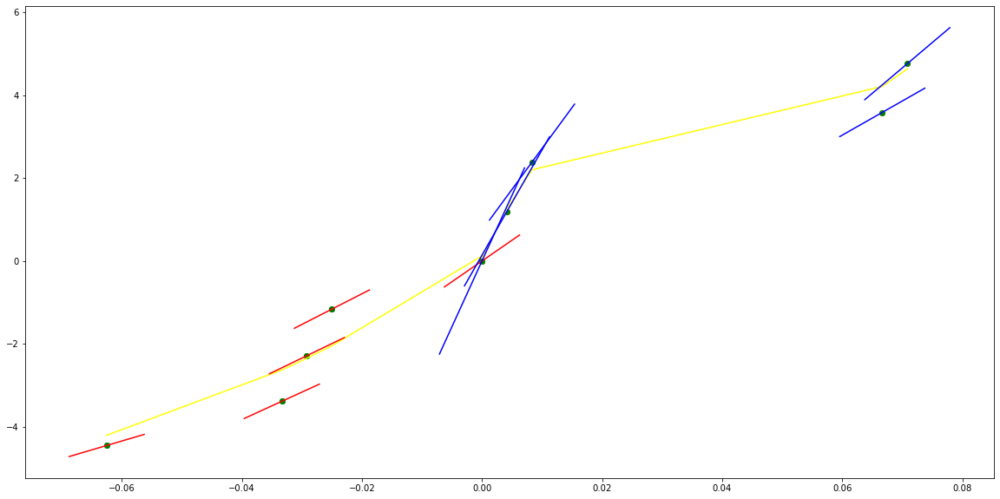

parameters (54822.23381921152, 2145.093311511503, 116.51816840034655, -0.3648145416813981)
tangent[0]:186.91746896178242
tangent[1]:156.2571766101416
tangent[2]:131.3004023746608
tangent[3]:101.4967422905162
tangent[4]:116.51816840034655
parameters (136.38835346525835, -99.97383061147598, 39.39445213861804, 0.6274046942102413)
tangent[0]:39.39445213861804
tangent[1]:38.568571469082165
tangent[2]:29.764559223084888
tangent[3]:23.006372279066483
tangent[4]:16.28897481385352


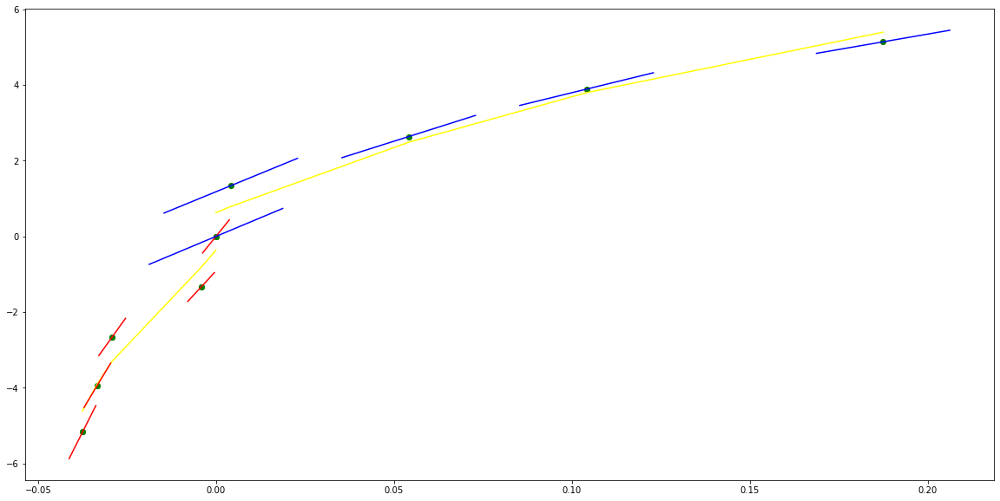

parameters (5630.970240297031, 1597.4716247902095, 125.5338919630357, -0.010631136166085487)
tangent[0]:177.39877257781976
tangent[1]:162.26167088259572
tangent[2]:147.71122244066046
tangent[3]:-20.096322303483504
tangent[4]:125.5338919630357
parameters (0.7844696879766282, -1.6139867327314785, 15.110063440830613, 0.05893762831741949)
tangent[0]:15.110063440830613
tangent[1]:14.75437894014364
tangent[2]:14.408445467489171
tangent[3]:14.195419504874211
tangent[4]:14.046584276664777


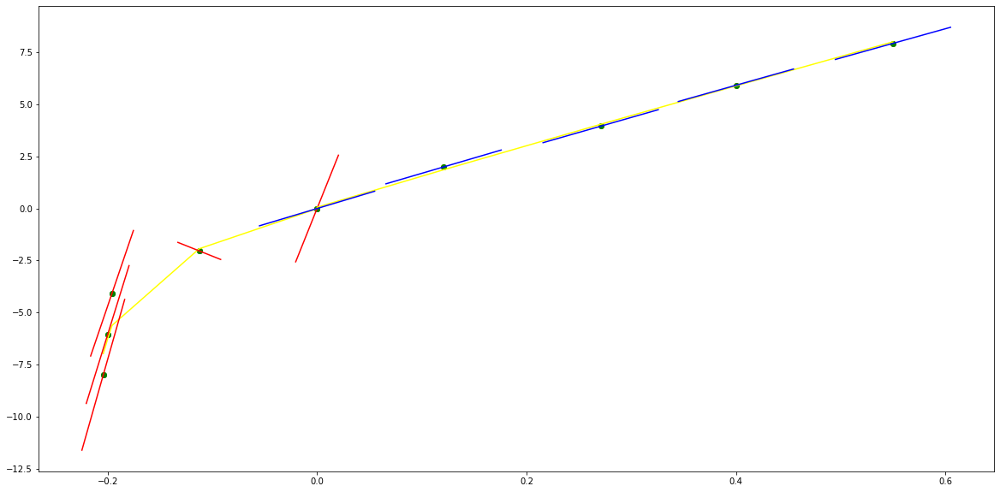

parameters (5.74375214104876, 11.281508330138111, 14.500775884496877, -0.42716470939383805)
tangent[0]:7.7169089245015225
tangent[1]:7.183126666067089
tangent[2]:9.333909301384391
tangent[3]:12.822524960384136
tangent[4]:14.500775884496877
parameters (371.5132962178253, -305.4929778335062, 87.83163180222726, 2.0987394127515597)
tangent[0]:87.83163180222726
tangent[1]:85.30560777037024
tangent[2]:82.81767824526833
tangent[3]:73.25357034096038
tangent[4]:36.28104572542985


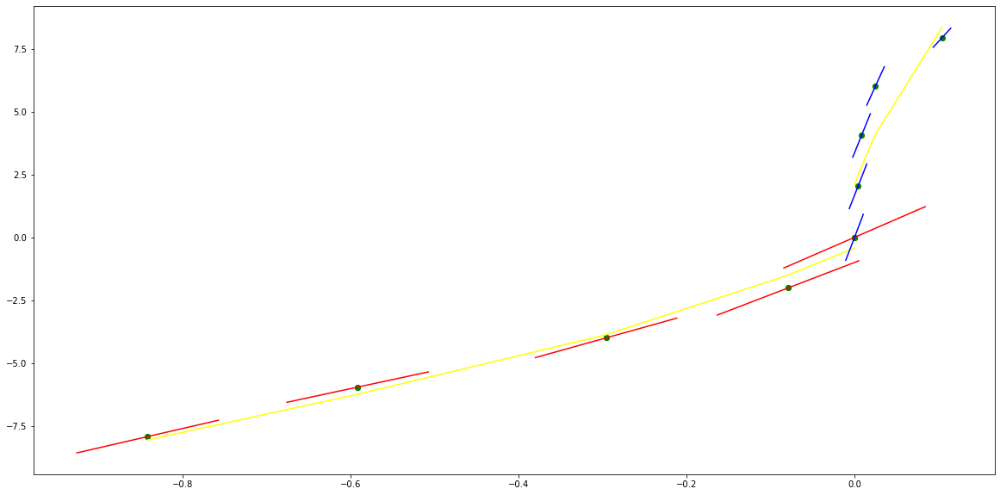

parameters (-2681.221698985035, -1831.9935215522096, -160.6338798362103, 0.0029657448621196697)
tangent[0]:217.84681443445314
tangent[1]:184.89872896105535
tangent[2]:178.42932395497738
tangent[3]:171.6822334119186
tangent[4]:-160.6338798362103
parameters (48.4020804847823, -79.46257221820757, 45.61571594190223, 2.343092897516636)
tangent[0]:45.61571594190223
tangent[1]:44.95599621009441
tangent[2]:44.30131916840403
tangent[3]:36.83909243184719
tangent[4]:18.808599465807088


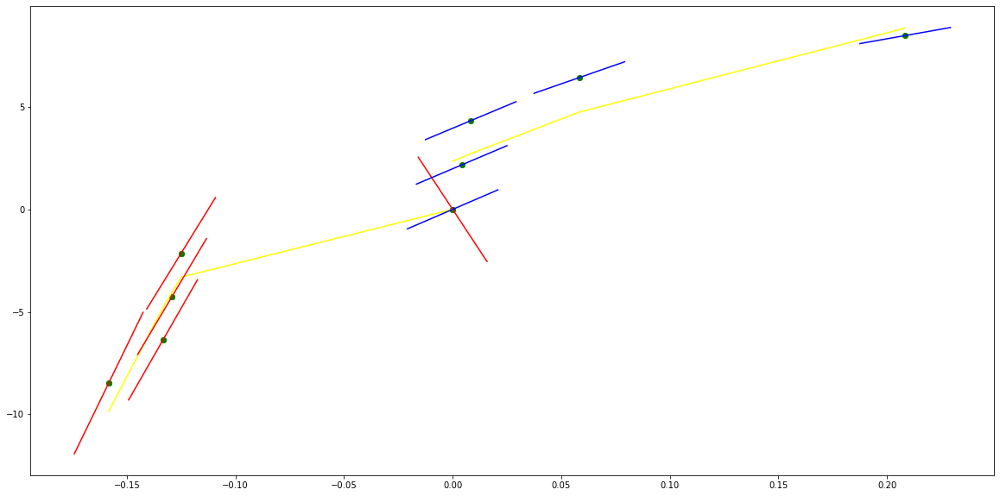

parameters (-0.0061014226154766735, -0.09327057714467762, 1.2680856012130042, 0.025250584723187645)
tangent[0]:1.7220453116662848
tangent[1]:1.667693874117598
tangent[2]:1.5731063699832373
tangent[3]:1.457798329529127
tangent[4]:1.2680856012130042
parameters (80.60241270306071, -179.30904394787092, 100.37952336128484, -0.00184025262371532)
tangent[0]:100.37952336128484
tangent[1]:-15.906267761092607
tangent[2]:22.002807426842764
tangent[3]:50.91339496382267
tangent[4]:52.101511849575104


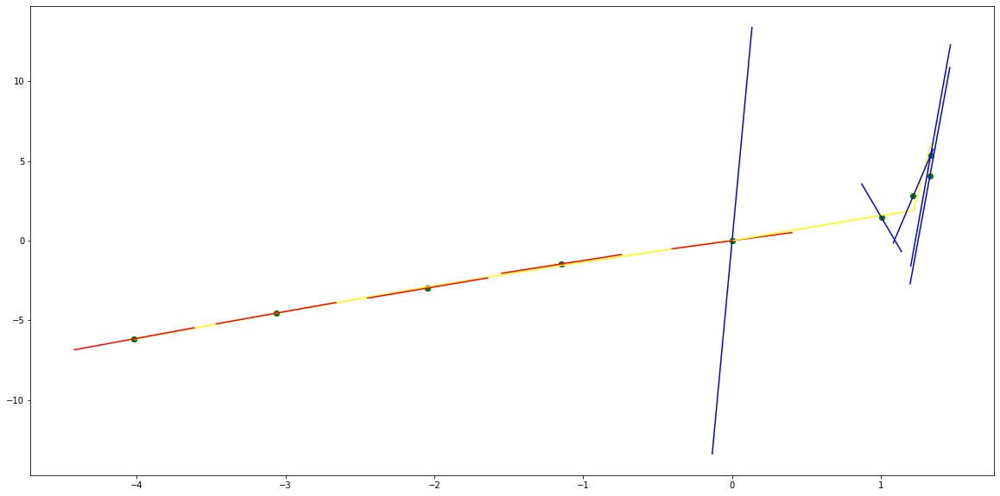

parameters (80.60241270306038, 151.1609287370902, 61.91042319051336, -1.284258777020794)
tangent[0]:50.91339496382263
tangent[1]:52.10151184957506
tangent[2]:53.298310349484154
tangent[3]:60.65484672446038
tangent[4]:61.91042319051336
parameters (-17737.364847749504, 3971.6469090905453, -157.8027849088505, 0.8854630014357967)
tangent[0]:-157.8027849088505
tangent[1]:-125.63454834903072
tangent[2]:137.86276509974877
tangent[3]:137.5422183287022
tangent[4]:134.61024073508182


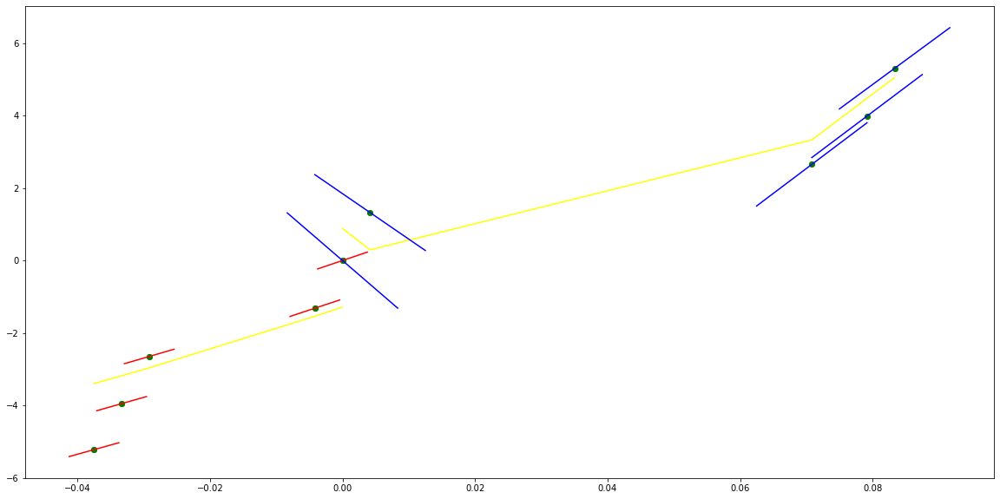

parameters (7439.710454291595, 4285.636455147684, 619.2681570684038, -3.3891205575099144e-05)
tangent[0]:191.0627114260585
tangent[1]:166.71426930990606
tangent[2]:143.14648520238939
tangent[3]:56.608106638524305
tangent[4]:619.2681570684038
parameters (0.014174725182217145, -0.12825580475362164, 1.1899167827292003, -0.06584710986961527)
tangent[0]:1.1899167827292003
tangent[1]:0.973083383384104
tangent[2]:0.8374873024946572
tangent[3]:0.8030958516886064
tangent[4]:0.8375790028472645


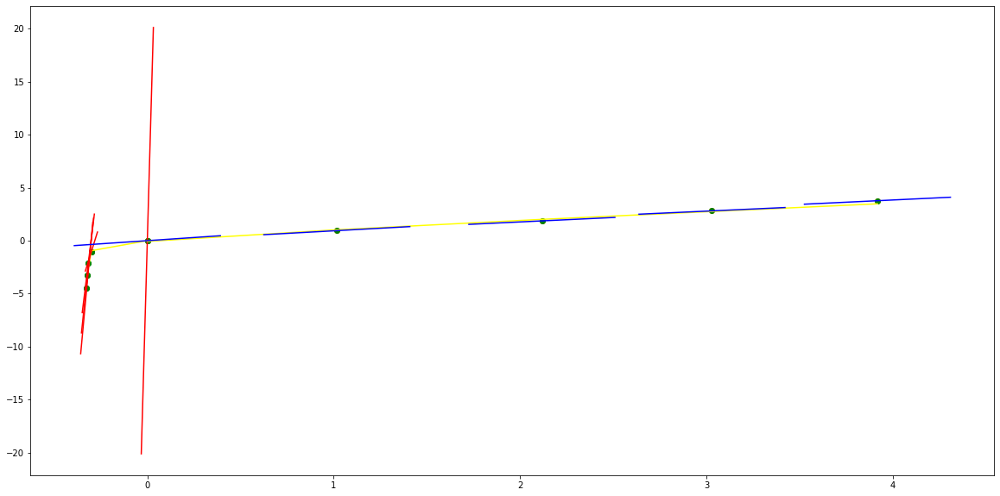

parameters (343.93192893957064, 802.0161677668244, 460.82690055646333, 5.63795276984459e-05)
tangent[0]:161.21958354386868
tangent[1]:156.42150580516397
tangent[2]:137.58400354045818
tangent[3]:-103.46355293170302
tangent[4]:460.82690055646333
parameters (0.05558898674737752, -0.40189842660578035, 1.5795173963113933, -0.11473674388941471)
tangent[0]:1.5795173963113933
tangent[1]:0.8971288796716569
tangent[2]:0.6373084755413021
tangent[3]:0.651016657634202
tangent[4]:1.3221390863885152


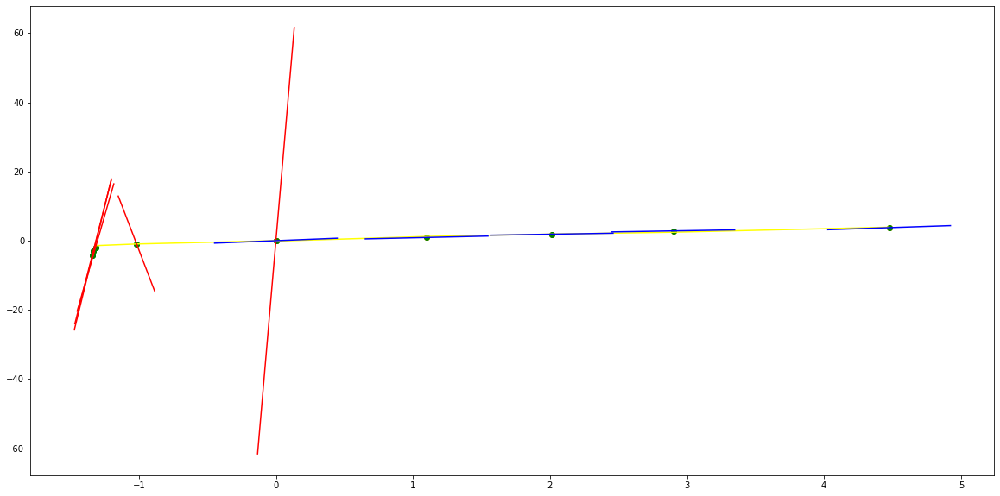

parameters (-0.002812073318837073, -0.09544211915071438, 1.1451021492495255, 0.007191027894943596)
tangent[0]:1.6943581697396777
tangent[1]:1.5819196645249642
tangent[2]:1.4613604255330008
tangent[3]:1.3188284871251315
tangent[4]:1.1451021492495255
parameters (99.57248197668042, -307.54341614171796, 221.6526075740911, 5.446216298358919e-06)
tangent[0]:221.6526075740911
tangent[1]:-91.75979712616478
tangent[2]:162.71008035450254
tangent[3]:165.02693745684618
tangent[4]:167.3547232422671


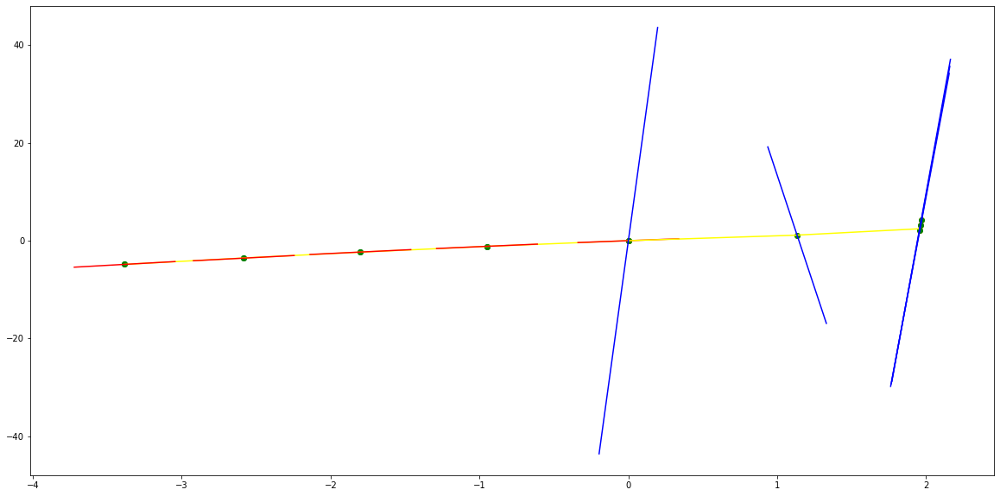

parameters (-0.00588983105418919, -0.13368934380905778, 0.8430615199749057, -0.0034337818637437817)
tangent[0]:1.5927395138892397
tangent[1]:1.4753362738543405
tangent[2]:1.323410073165083
tangent[3]:1.1233953684985107
tangent[4]:0.8430615199749057
parameters (-2178.100404577273, 3845.070347143635, -1688.2874222400947, -3.777998778656106e-07)
tangent[0]:-1688.2874222400947
tangent[1]:208.66988695068403
tangent[2]:195.67747353937784
tangent[3]:182.45504691636188
tangent[4]:155.33273764869455


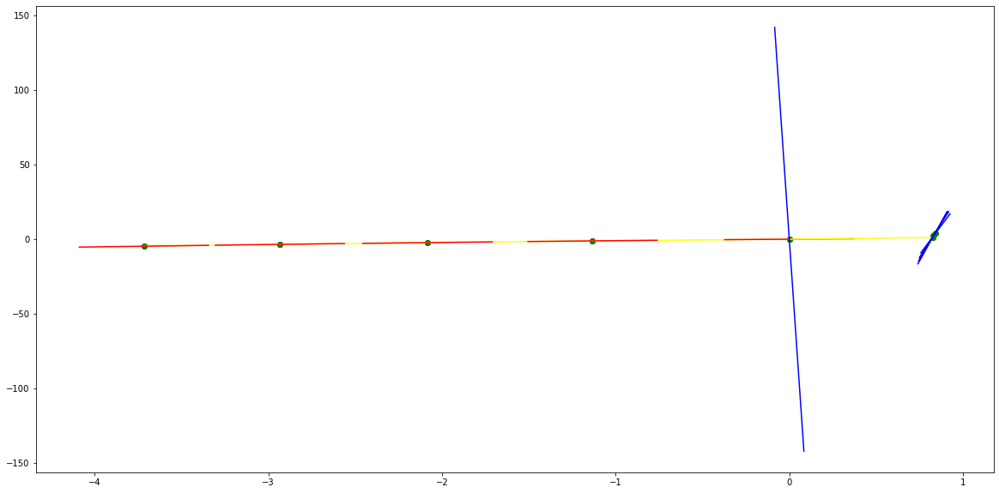

parameters (0.007583004937196943, 0.00011264321874379605, 1.0905792973795314, -0.05397435461742353)
tangent[0]:1.4110641237060497
tangent[1]:1.2823445074633493
tangent[2]:1.1773822222846222
tangent[3]:1.1058769842747431
tangent[4]:1.0905792973795314
parameters (47579.19456688122, -4023.566040530791, 239.51920578091824, 0.04990299522171931)
tangent[0]:239.51920578091824
tangent[1]:208.4721436584369
tangent[2]:182.37399338014927
tangent[3]:145.05185944081472
tangent[4]:133.82339694454166


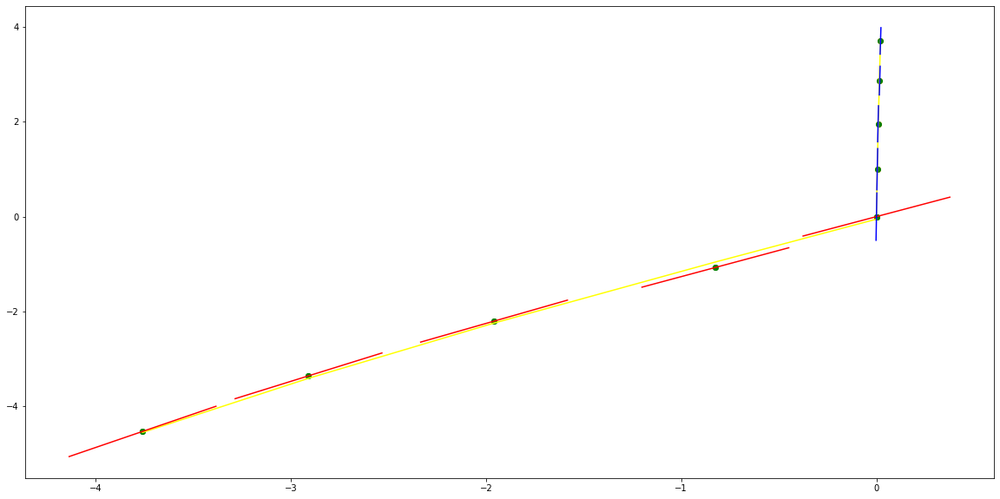

parameters (-1.358952809168137, -3.9046018565700966, -3.695588847100844, -0.021989037926481242)
tangent[0]:-6.589494288686112
tangent[1]:-6.289603526509094
tangent[2]:-1.8397314347092775
tangent[3]:0.02391642752205625
tangent[4]:-3.695588847100844
parameters (-3104.861547132542, 5369.229709005651, -2321.7924638461077, -2.7338430195362086e-06)
tangent[0]:-2321.7924638461077
tangent[1]:76.11063805371623
tangent[2]:-152.4097430371162
tangent[3]:-177.04242158989518
tangent[4]:-201.99254716801215


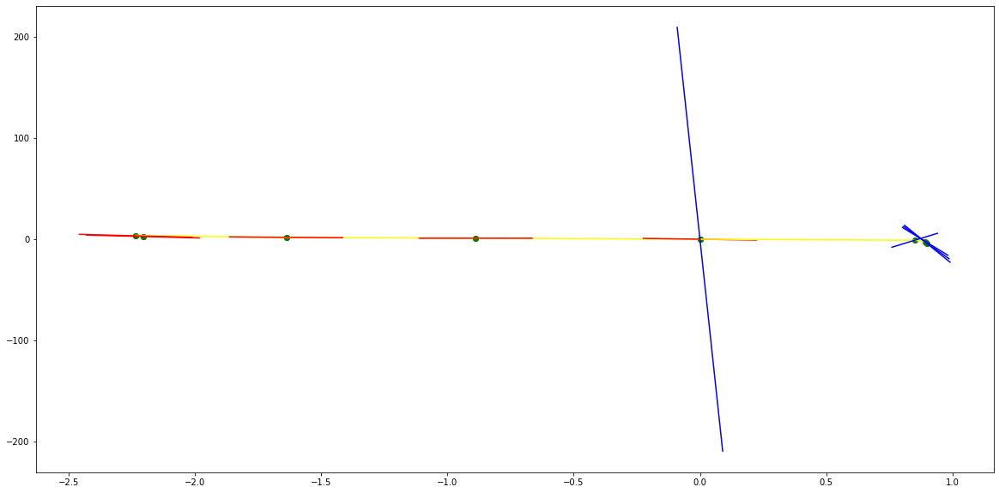

parameters (334.4703494193434, -290.9982950422534, -148.70810533117353, 1.403925086719776)
tangent[0]:-105.44848940492705
tangent[1]:-117.0997482063031
tangent[2]:-141.27636497882688
tangent[3]:-146.26550242222805
tangent[4]:-148.70810533117353
parameters (-1.2882495702156909, 7.787600599716336, -15.675003584374998, -4.608868122731871)
tangent[0]:-15.675003584374998
tangent[1]:-15.610184371040836
tangent[2]:-15.41650073661218
tangent[3]:-15.160129482145486
tangent[4]:-14.905905396179982


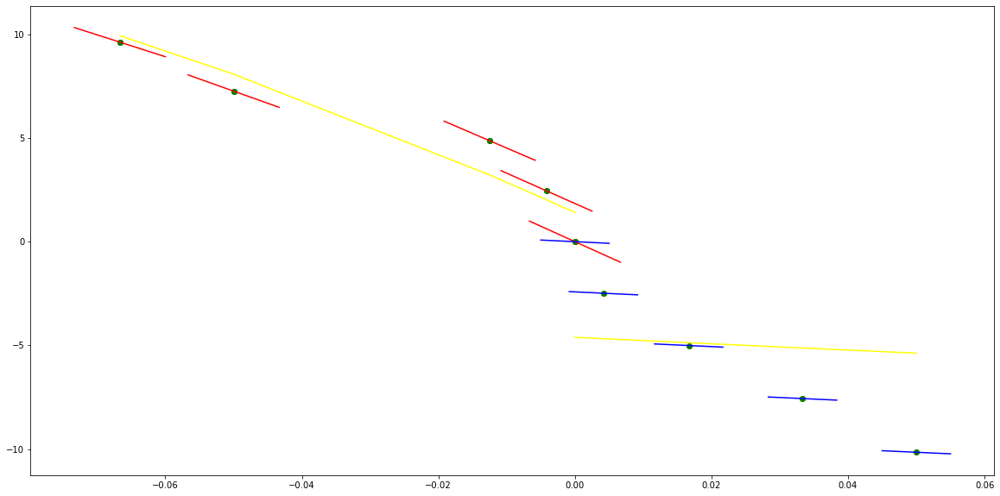

parameters (-24040.303350883056, -4968.058466108462, -388.3580796491466, 1.079469849140376)
tangent[0]:-61.75791465143095
tangent[1]:-242.7947383277189
tangent[2]:-310.5684131207079
tangent[3]:-348.2159150027206
tangent[4]:-388.3580796491466
parameters (-0.41977602162015976, 3.3087801522556726, -9.77682267719587, -3.570166324156065)
tangent[0]:-9.77682267719587
tangent[1]:-9.694299943399614
tangent[2]:-9.584879623669773
tangent[3]:-9.47615895862798
tangent[4]:-4.697444884943469


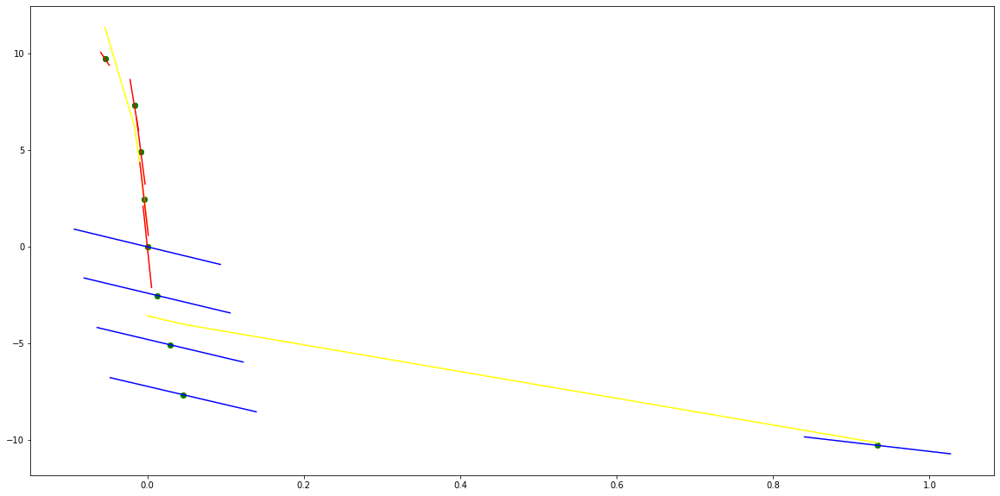

parameters (-97.23697068047805, -355.2206032118014, -307.2352984634598, -0.0001643465220800914)
tangent[0]:-219.00747822128244
tangent[1]:-208.52396585627923
tangent[2]:-198.20252159160634
tangent[3]:117.32049344953077
tangent[4]:-307.2352984634598
parameters (-0.3828184233800137, 2.0316346897225137, -4.913809422354779, 0.14394791866098022)
tangent[0]:-4.913809422354779
tangent[1]:-1.9413933097540736
tangent[2]:-1.468782474126268
tangent[3]:-4.613461762053751
tangent[4]:-9.421314392196377


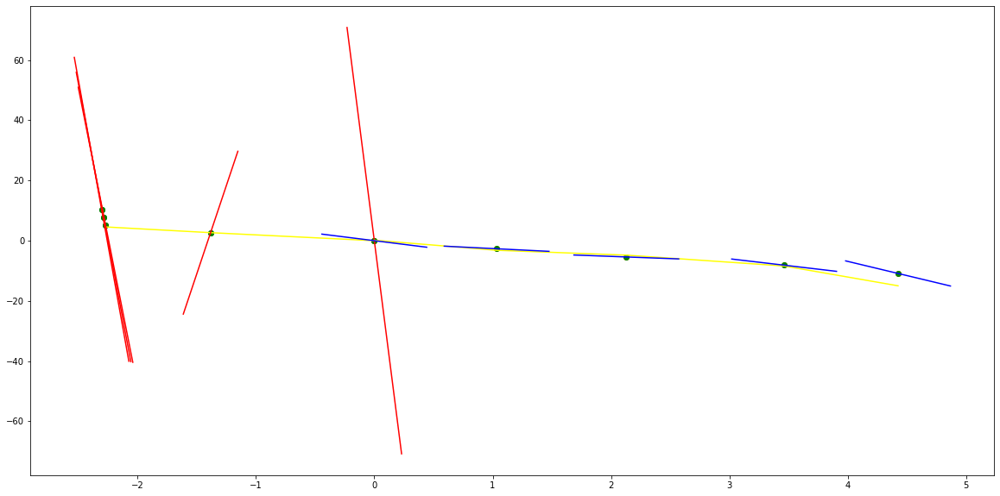

parameters (-0.41977614665257873, -2.2899843525363264, -5.2474232605120825, -0.17580803482284652)
tangent[0]:-9.476159555774185
tangent[1]:-4.697444581991707
tangent[2]:-1.2048842780015976
tangent[3]:-1.7408051062337195
tangent[4]:-5.2474232605120825
parameters (-229.60225334421693, 832.7244831290676, -704.1677869141731, -6.769773231075245e-07)
tangent[0]:-704.1677869141731
tangent[1]:291.88554071712724
tangent[2]:-511.1716255620481
tangent[3]:-517.4229250931844
tangent[4]:-523.6966365506123


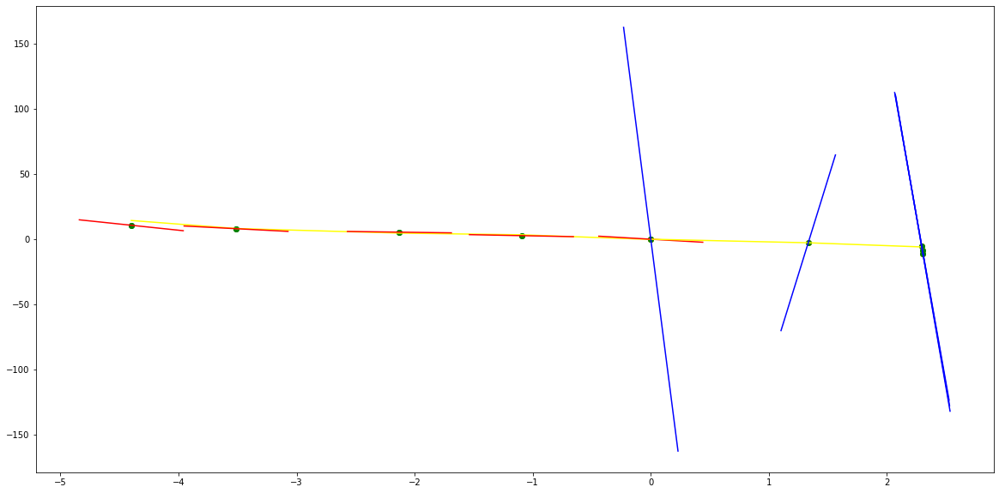

parameters (-0.10468510681920541, -0.6956777773933922, -3.337333747871913, -0.17829808707889153)
tangent[0]:-3.9697347297914423
tangent[1]:-2.2849449337027403
tangent[2]:-1.8106928133286404
tangent[3]:-2.040513762483564
tangent[4]:-3.337333747871913
parameters (2833.080634009287, -6051.487162092634, 3196.8574208118403, 2.6107527548769014e-07)
tangent[0]:3196.8574208118403
tangent[1]:-578.5045479159821
tangent[2]:-560.6136055958227
tangent[3]:-542.4319032129229
tangent[4]:-505.17436130825763


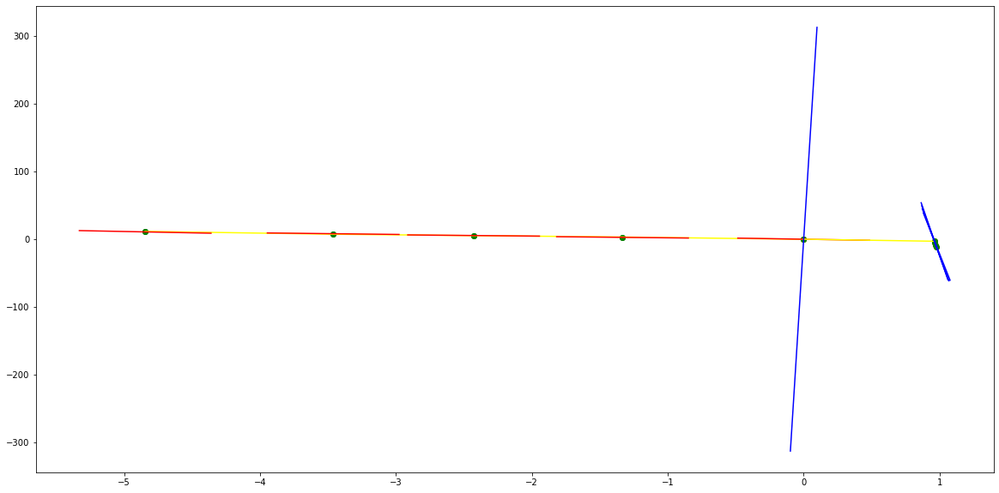

parameters (173638.84376735886, 10795.343687388142, -445.44097329679875, -0.13207497793372128)
tangent[0]:-659.6353256024079
tangent[1]:-660.5881352800575
tangent[2]:-633.9313574655528
tangent[3]:-589.1843059954597
tangent[4]:-445.44097329679875
parameters (-340951.9045145344, 29861.576223848817, -1001.2233351619266, -0.03922033132339816)
tangent[0]:-1001.2233351619266
tangent[1]:-770.1177119853575
tangent[2]:-574.5762701710322
tangent[3]:-200.94448633997104
tangent[4]:-199.99596554395725


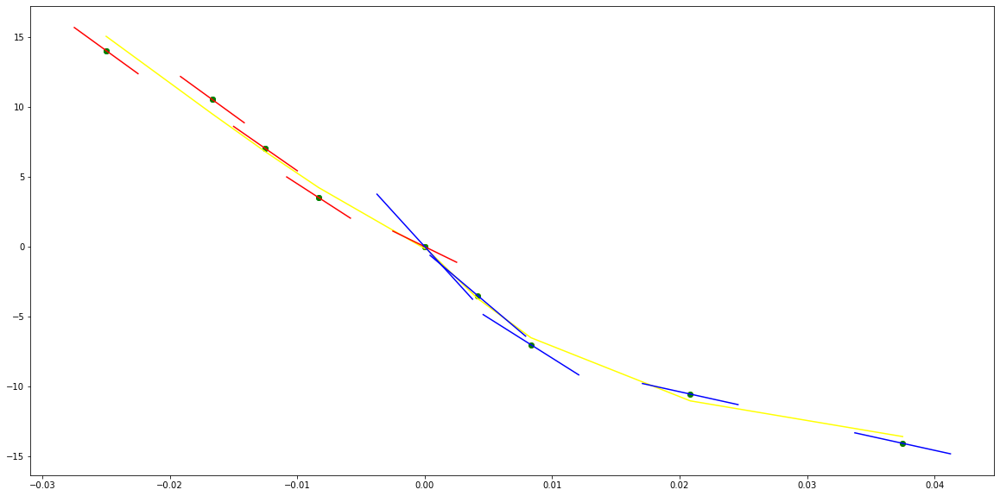

parameters (-242129.36925236153, -15386.758081096408, -649.3394674541611, 0.5206897191331984)
tangent[0]:-430.6652614502369
tangent[1]:-369.71677362486366
tangent[2]:-378.16865726379535
tangent[3]:-533.7191480803177
tangent[4]:-649.3394674541611
parameters (-78406.69803454088, 12491.928396037598, -839.8890217632896, 0.09764381319521716)
tangent[0]:-839.8890217632896
tangent[1]:-739.888649883045
tangent[2]:-564.3439515660407
tangent[3]:-488.84175248668845
tangent[4]:-421.48912102684636


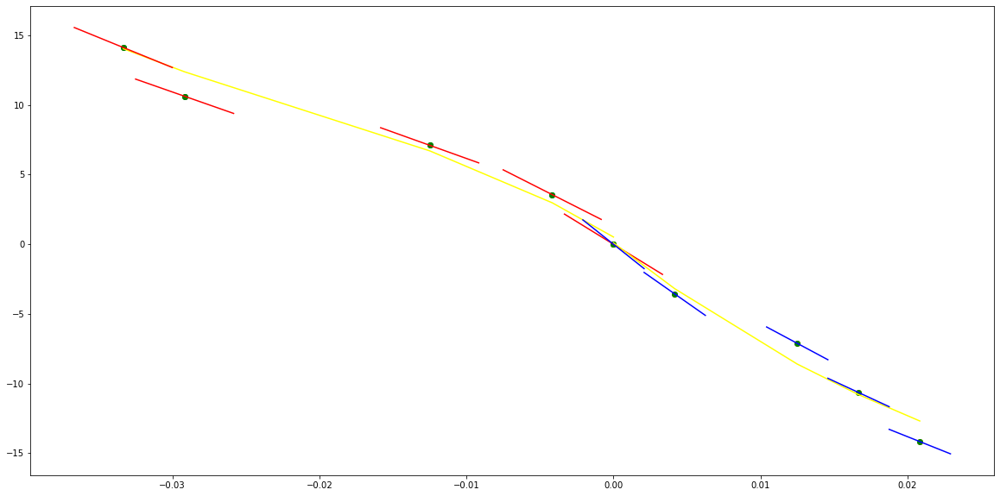

parameters (0.01205730735092518, 0.2794922224715334, 2.62515123925155, -0.00852916359672566)
tangent[0]:1.936445566519593
tangent[1]:2.094238411060022
tangent[2]:2.2600689831043743
tangent[3]:2.4428423716774503
tangent[4]:2.62515123925155
parameters (1656.298282748457, -1261.0925068699808, 239.0802643988703, 0.00048754798625782927)
tangent[0]:239.0802643988703
tangent[1]:-49.548118988388325
tangent[2]:86.7018504346025
tangent[3]:118.50939572129286
tangent[4]:135.44735917662442


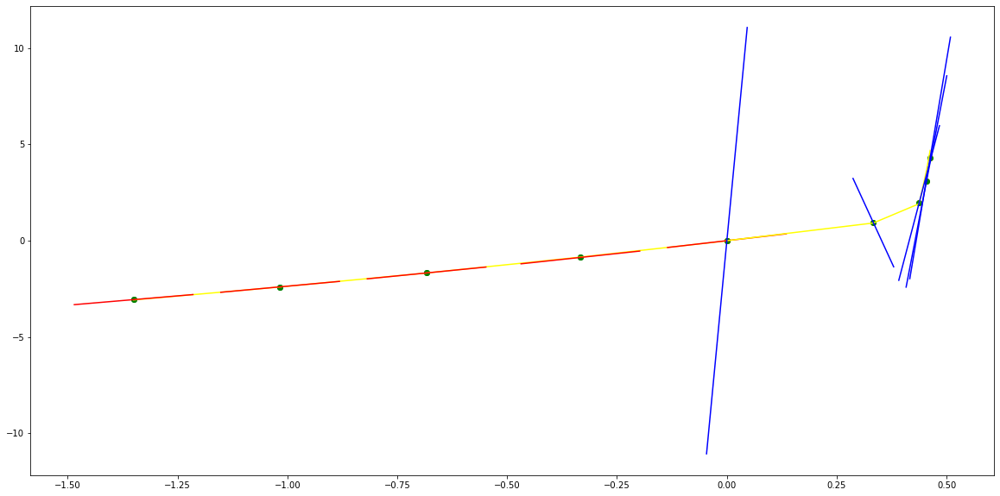

parameters (18.828534435810838, 38.013658618998036, 23.814177756202817, -1.600150311706128)
tangent[0]:14.68141094921609
tangent[1]:21.64474208158436
tangent[2]:22.872662166244652
tangent[3]:23.498352735018017
tangent[4]:23.814177756202817
parameters (2163.4458609212356, -679.4218506507518, 125.80315751765647, 0.3801436090001971)
tangent[0]:125.80315751765647
tangent[1]:120.25355331569274
tangent[2]:100.31126334366039
tangent[3]:83.97355594461155
tangent[4]:71.24173587826446


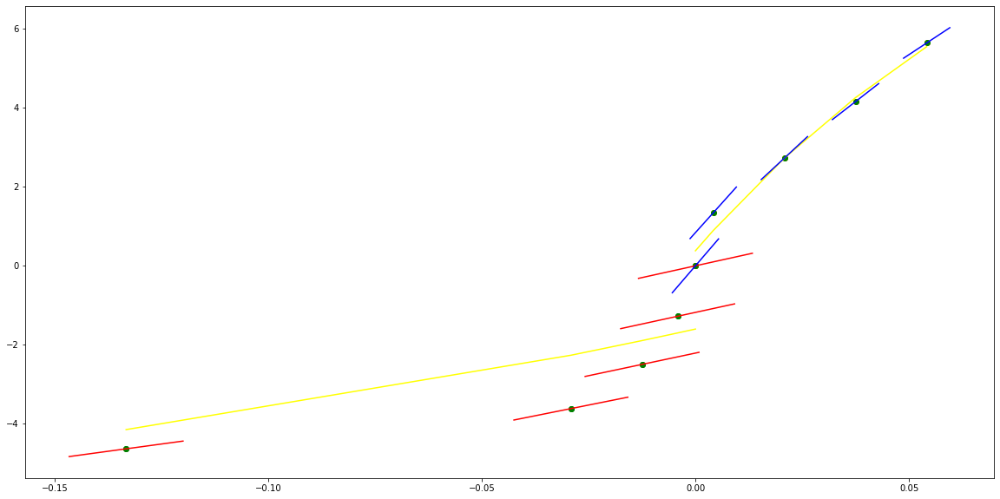

parameters (60132.544832423395, 6043.070278882278, 317.60663936730936, -0.10635350631028422)
tangent[0]:425.88279158211236
tangent[1]:226.43184859869876
tangent[2]:127.20876948125232
tangent[3]:194.7170127854509
tangent[4]:317.60663936730936
parameters (42623.9645143872, -6985.281554279494, 535.2321196633397, 1.1714396649514136)
tangent[0]:535.2321196633397
tangent[1]:479.2371365556777
tangent[2]:427.6946995016811
tangent[3]:265.887975413841
tangent[4]:175.12403380936325


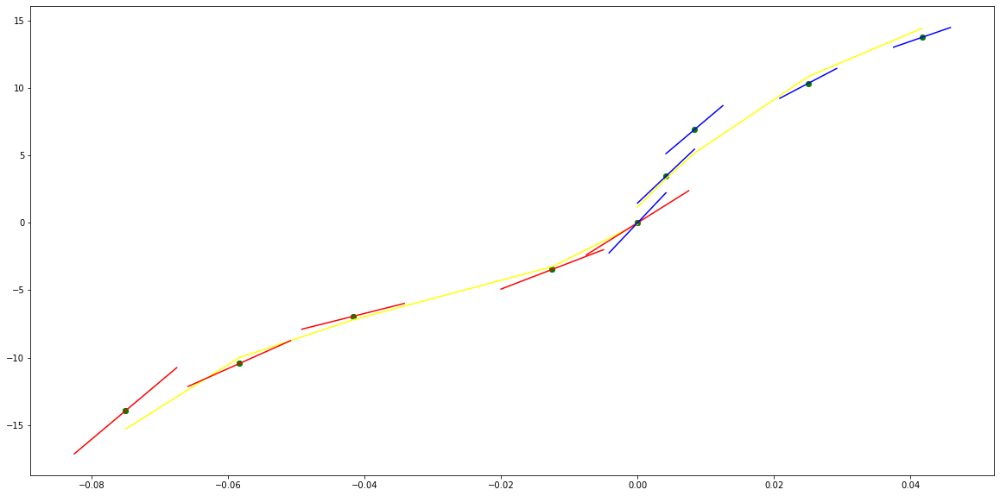

parameters (-15987.440829249235, -376.7302077885472, 214.02920161867652, -0.6237301271627042)
tangent[0]:185.8538940443365
tangent[1]:195.20521199653174
tangent[2]:215.95334392467961
tangent[3]:216.33570493614454
tangent[4]:214.02920161867652
parameters (30314.124206754324, -4883.479521700318, 307.7885735064045, 0.4985542275706658)
tangent[0]:307.7885735064045
tangent[1]:268.6687684361289
tangent[2]:143.77779090784304
tangent[3]:46.79655288703009
tangent[4]:72.25510940552448


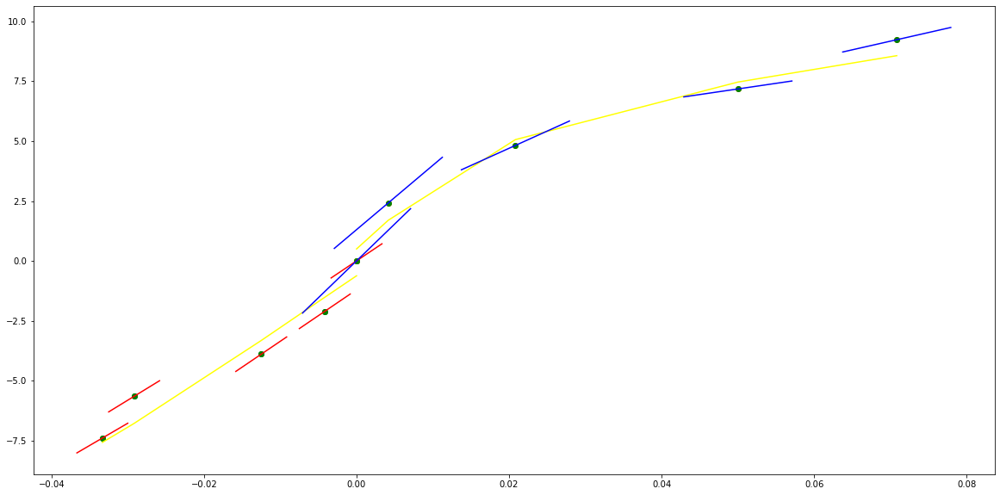

parameters (-46306.216333756754, -3881.017364151484, 141.27423610706873, -0.7105042791838038)
tangent[0]:245.6551723253892
tangent[1]:249.4898203878087
tangent[2]:216.59363130440735
tangent[3]:171.199862392993
tangent[4]:141.27423610706873
parameters (252.01937273478086, 590.8351010312484, 23.619785933413176, 0.8813485213999782)
tangent[0]:23.619785933413176
tangent[1]:28.55693377464965
tangent[2]:84.59344133204888
tangent[3]:127.34357815752418
tangent[4]:143.80772344483583


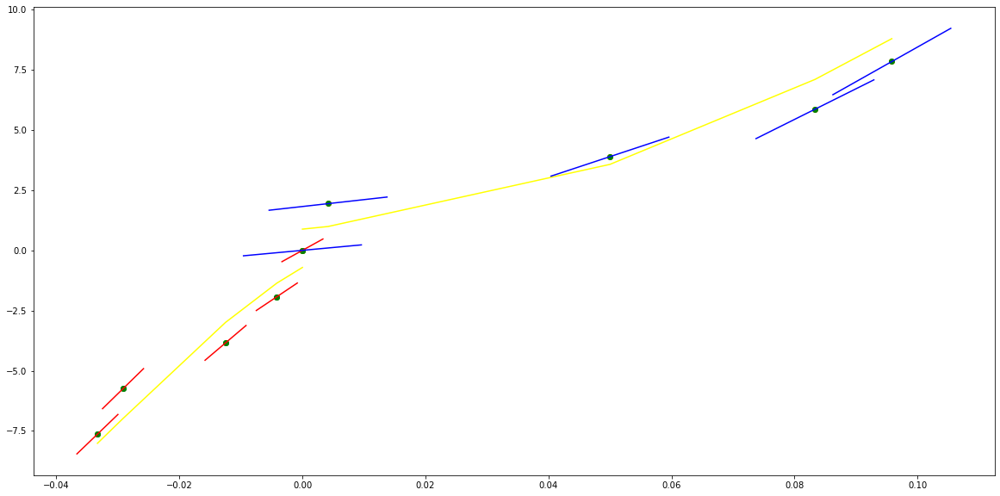

parameters (-1591.7620108357455, 558.8442239031108, 203.65366831231464, -0.38720302748690466)
tangent[0]:155.02510553636802
tangent[1]:161.09055598663244
tangent[2]:166.99164720334898
tangent[3]:198.9133430136944
tangent[4]:203.65366831231464
parameters (-9805.6883375495, 2362.6569040752606, -38.037724020598525, 1.05506853471447)
tangent[0]:-38.037724020598525
tangent[1]:-18.86261621502611
tangent[2]:124.6853038553063
tangent[3]:151.68220477371116
tangent[4]:151.453312133182


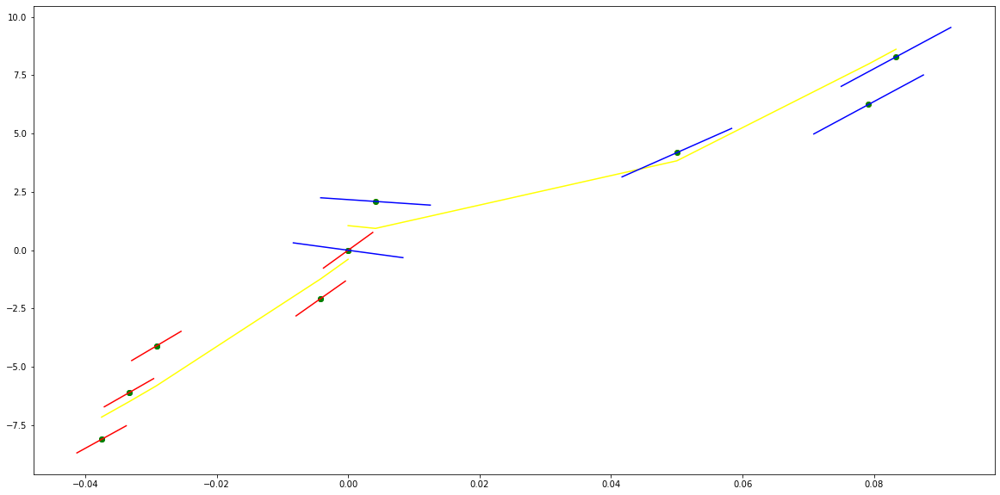

parameters (9868.162969942225, 2026.3822229033433, 171.05392451844673, -0.8837890751480691)
tangent[0]:89.79973713018833
tangent[1]:42.4269245026791
tangent[2]:125.02007033802357
tangent[3]:154.68010413210223
tangent[4]:171.05392451844673
parameters (1111.8878169693585, -458.37040229602985, 109.33607047201565, 0.850697539405674)
tangent[0]:109.33607047201565
tangent[1]:105.57482057390452
tangent[2]:79.64906702765289
tangent[3]:61.136639621617036
tangent[4]:50.036649411075906


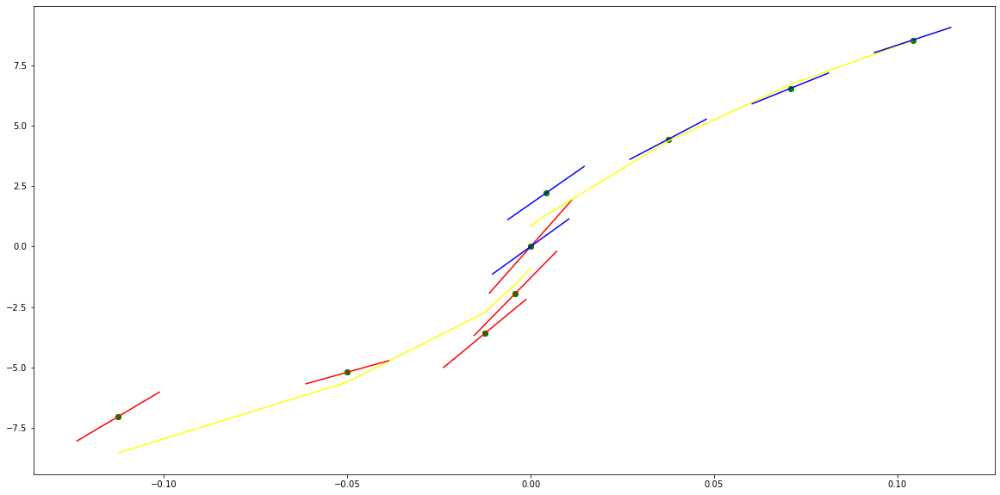

parameters (794.6162821497011, 400.78387248071095, 109.83452734418306, -1.2330172504661139)
tangent[0]:45.33841835581548
tangent[1]:59.591855895649516
tangent[2]:85.76453766772904
tangent[3]:106.53578743769134
tangent[4]:109.83452734418306
parameters (12652.159993001103, -3875.781307784628, 420.5942960354749, 0.05761514198288758)
tangent[0]:420.5942960354749
tangent[1]:388.95260672158395
tangent[2]:275.5796315537584
tangent[3]:226.79457392285494
tangent[4]:204.3844825409264


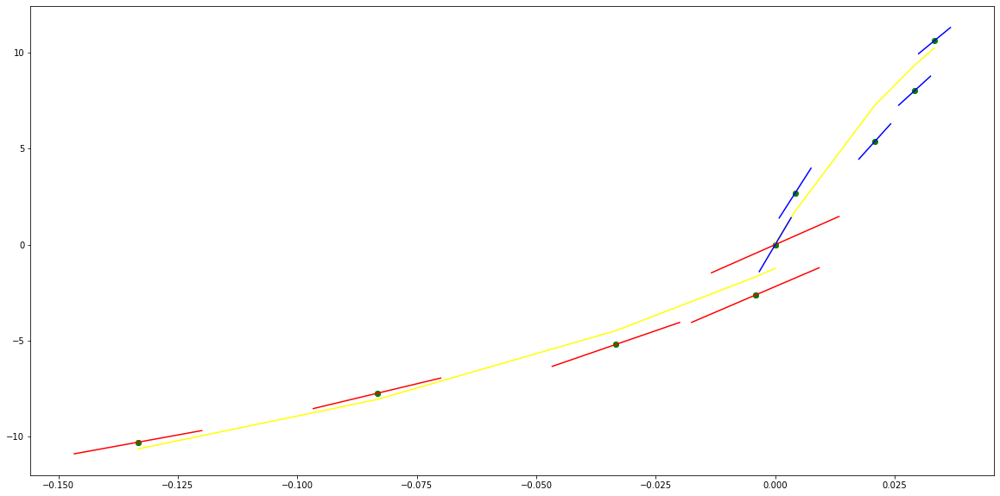

parameters (135259.8753598884, 6437.0249777917315, 547.6148153806947, -0.14441881979637172)
tangent[0]:455.5237262478257
tangent[1]:445.7634444761702
tangent[2]:450.0922575108491
tangent[3]:501.0240542898187
tangent[4]:547.6148153806947
parameters (46500.22314794649, -9204.728450549803, 657.2167062155776, -0.07580246528897955)
tangent[0]:657.2167062155776
tangent[1]:582.9267734483441
tangent[2]:448.8954745524324
tangent[3]:389.13802402451086
tangent[4]:334.22512177588635


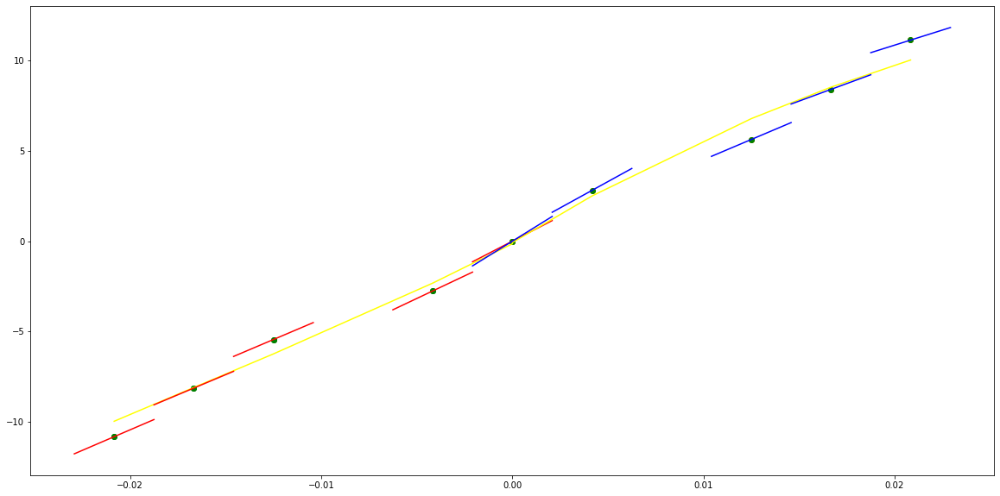

parameters (153707.47861585856, 16111.178516532846, 619.4047210293152, 0.633583781625725)
tangent[0]:71.8584941509323
tangent[1]:210.44938550628103
tangent[2]:288.6756387171777
tangent[3]:382.91564951100816
tangent[4]:619.4047210293152
parameters (17928.570128951862, -3498.867216909012, 267.199383426825, 1.1068207482006924)
tangent[0]:267.199383426825
tangent[1]:238.97375314604884
tangent[2]:212.62208236315846
tangent[3]:80.42049739016483
tangent[4]:42.01926910476297


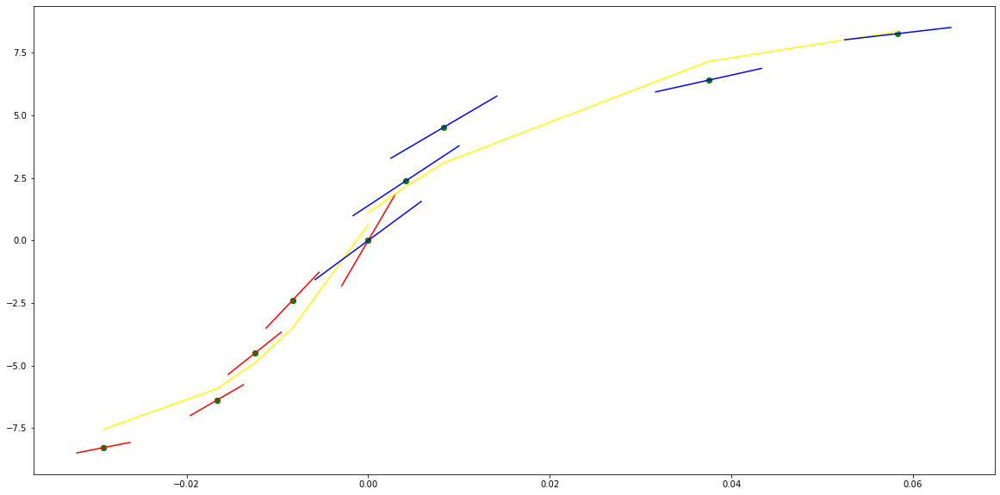

parameters (29.730293878717205, -95.88944699272254, 32.29193055585327, -0.09984731352317328)
tangent[0]:65.81119754669272
tangent[1]:61.25047394801621
tangent[2]:50.620974909047625
tangent[3]:41.26909266816931
tangent[4]:32.29193055585327
parameters (2998.4317145971017, -945.1260673871906, 138.03828112720936, 1.2376388701271774)
tangent[0]:138.03828112720936
tangent[1]:130.31779378800354
tangent[2]:122.90969306159579
tangent[3]:74.89422714473415
tangent[4]:41.51144777910319


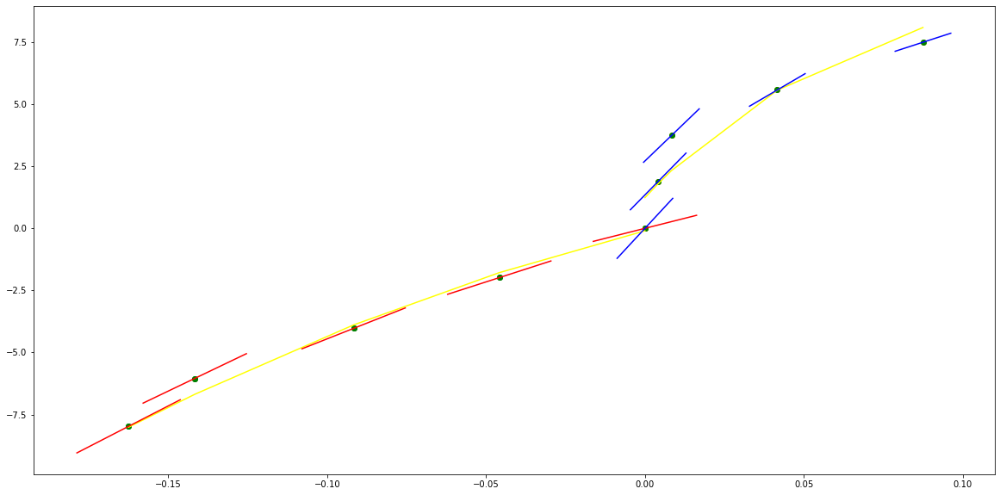

parameters (93062.86973255413, 4354.587141804299, 385.02557572416583, -0.09450567954495023)
tangent[0]:324.75908191612655
tangent[1]:317.42526150973515
tangent[2]:319.7841173661931
tangent[3]:353.5822465045414
tangent[4]:385.02557572416583
parameters (964.6213248416566, -438.0091527022134, 108.55984014148649, 0.7376272699859668)
tangent[0]:108.55984014148649
tangent[1]:104.959720595701
tangent[2]:82.5748620758128
tangent[3]:69.59933837997663
tangent[4]:49.896649346293515


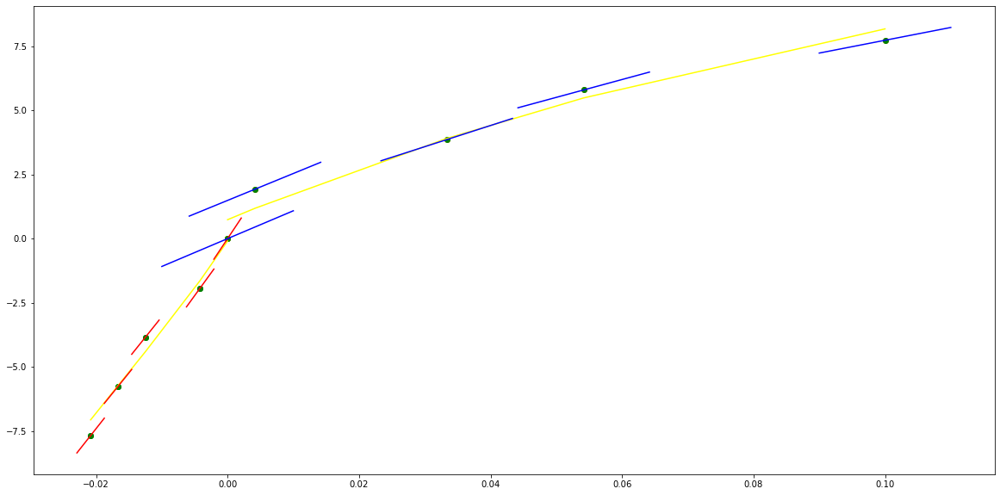

parameters (28228.034700465498, 4783.0064320290185, 233.75061277706786, -0.46319162235961625)
tangent[0]:270.36392678585605
tangent[1]:229.35735810383798
tangent[2]:26.780659107666963
tangent[3]:195.35948255621912
tangent[4]:233.75061277706786
parameters (743.8363299076303, -395.53471877585935, 100.41770981991701, 0.7457421150555076)
tangent[0]:100.41770981991701
tangent[1]:97.16084362231219
tangent[2]:76.52839710219028
tangent[3]:57.597894072833
tangent[4]:42.22828305460634


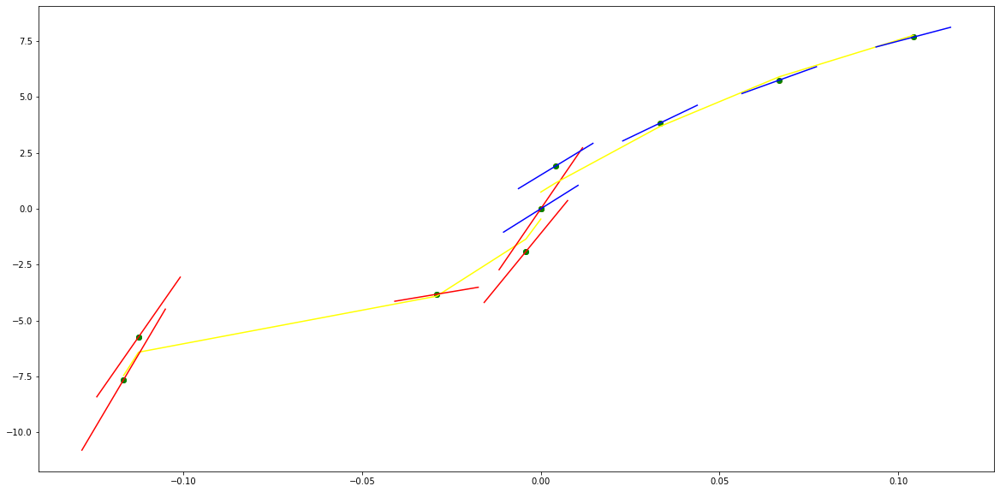

parameters (32440.822250674883, 6049.767140271442, 329.3683499461881, -0.6100768692621362)
tangent[0]:242.41585313446717
tangent[1]:34.18848523109864
tangent[2]:235.3008947524243
tangent[3]:280.6507756552194
tangent[4]:329.3683499461881
parameters (306.829622376191, -193.60144424890933, 73.37564781014773, -0.02482825971765361)
tangent[0]:73.37564781014773
tangent[1]:62.865173825268
tangent[2]:52.77112691625505
tangent[3]:43.86024763165159
tangent[4]:36.00621404586782


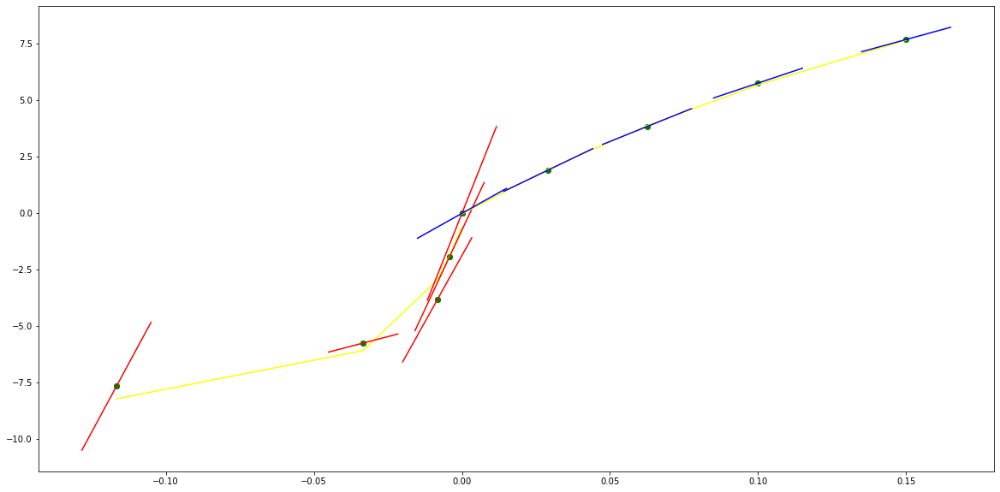

parameters (35370.23253063307, 7651.9963975421215, 437.163760021982, -0.23027362842811372)
tangent[0]:339.02012704474265
tangent[1]:283.0394582585603
tangent[2]:230.743778221774
tangent[3]:375.2489361919163
tangent[4]:437.163760021982
parameters (204.73317350412825, -163.35481053248998, 69.9931193761187, 0.9749605661706837)
tangent[0]:69.9931193761187
tangent[1]:68.64238527743896
tangent[2]:55.19313712415067
tangent[3]:42.62529225645983
tangent[4]:34.22324214981316


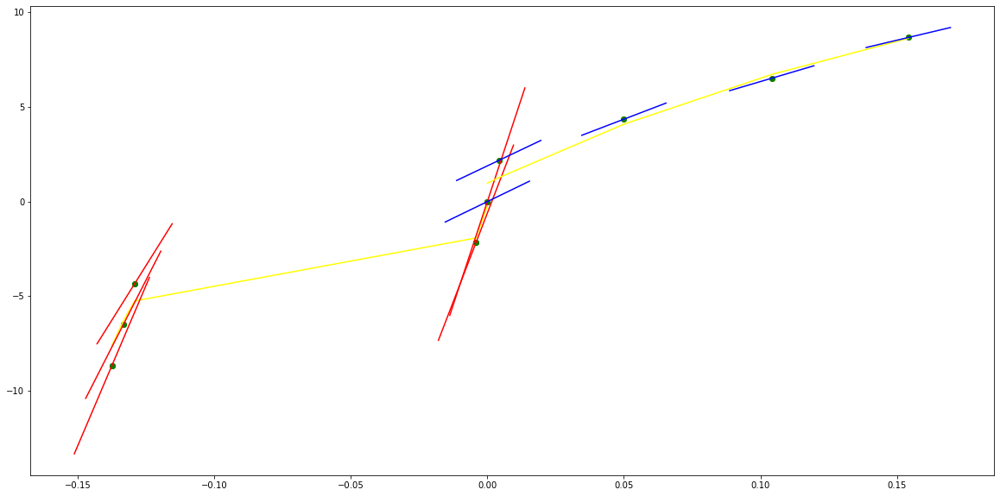

parameters (101.73118196085917, 97.9690488880397, 49.21013579804975, -1.288778607753958)
tangent[0]:18.19460874879756
tangent[1]:23.546073398121607
tangent[2]:38.1561669756486
tangent[3]:48.399154486391005
tangent[4]:49.21013579804975
parameters (30409.241189111977, -6614.850375197029, 400.65626111551757, 0.2202344096258076)
tangent[0]:400.65626111551757
tangent[1]:347.11216615437144
tangent[2]:92.39427082935936
tangent[3]:61.02560820495944
tangent[4]:32.83146924230647


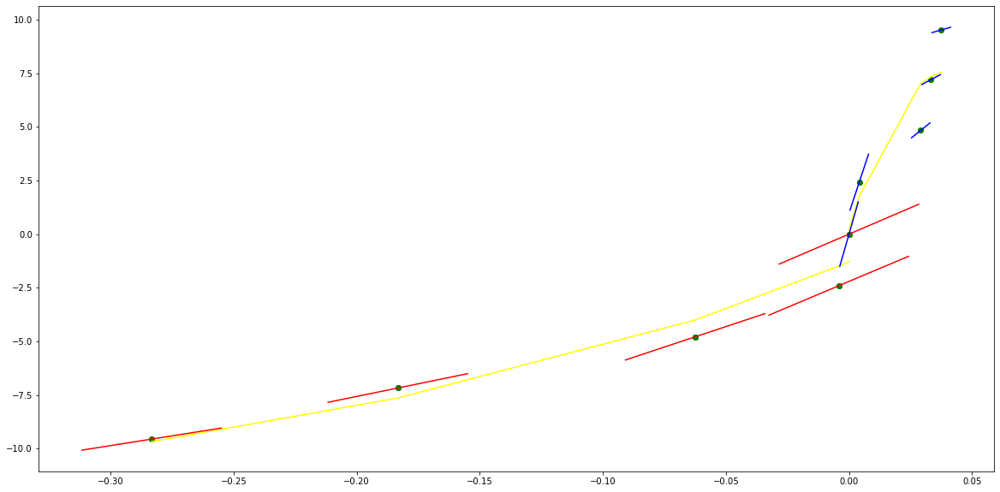

parameters (0.32456643100231225, 0.9759313438319401, 2.0765048734109235, 0.052122665528442635)
tangent[0]:1.1029666827076774
tangent[1]:1.1801072401659616
tangent[2]:1.3439983528307176
tangent[3]:1.6803386230112562
tangent[4]:2.0765048734109235
parameters (11587.426320437857, -1680.0963386877768, 77.29616578569922, -0.01936845813690748)
tangent[0]:77.29616578569922
tangent[1]:63.89785125234657
tangent[2]:40.72536340621004
tangent[3]:30.948409283652225
tangent[4]:22.380583620436887


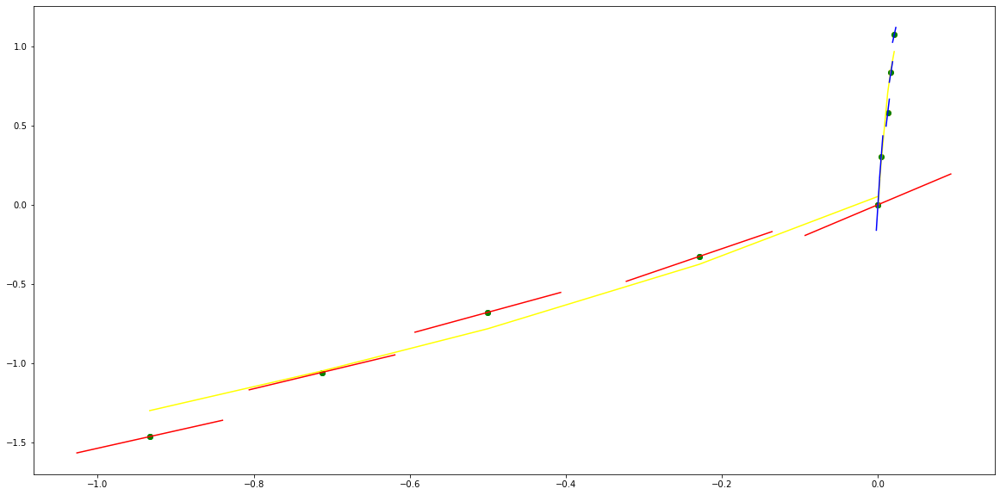

parameters (3574.4656479056575, 803.4521883353499, 65.44563458401365, -0.0815247495305038)
tangent[0]:20.266497410964405
tangent[1]:23.79644618527707
tangent[2]:27.699597346939527
tangent[3]:58.93586392066048
tangent[4]:65.44563458401365
parameters (-0.39917326793841695, 1.2531325038232612, 1.1620167181027312, 0.2548461687814102)
tangent[0]:1.1620167181027312
tangent[1]:1.1724370345025703
tangent[2]:2.4290731579910156
tangent[3]:2.4712045033284533
tangent[4]:2.471965126964857


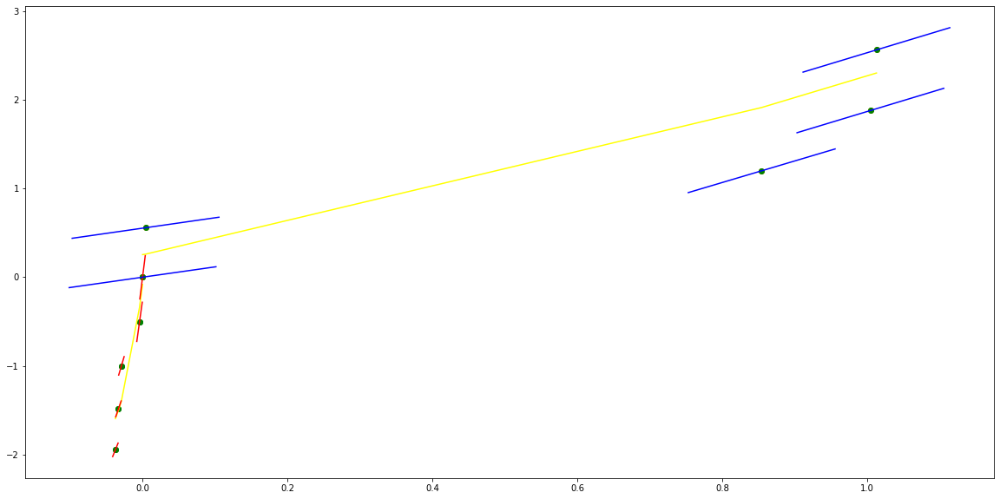

parameters (-0.02502245619567336, -0.28572693692548246, 1.5551103898265661, 0.0023297013482479257)
tangent[0]:2.5746161811526846
tangent[1]:2.472347919858449
tangent[2]:2.2772641244053387
tangent[3]:1.9866100087957643
tangent[4]:1.5551103898265661
parameters (383.768756662102, -490.90877435875274, 158.29865448646646, 1.1679443566910234e-05)
tangent[0]:158.29865448646646
tangent[1]:-22.664430297087875
tangent[2]:63.4152222026556
tangent[3]:66.460254854868
tangent[4]:69.54526981563444


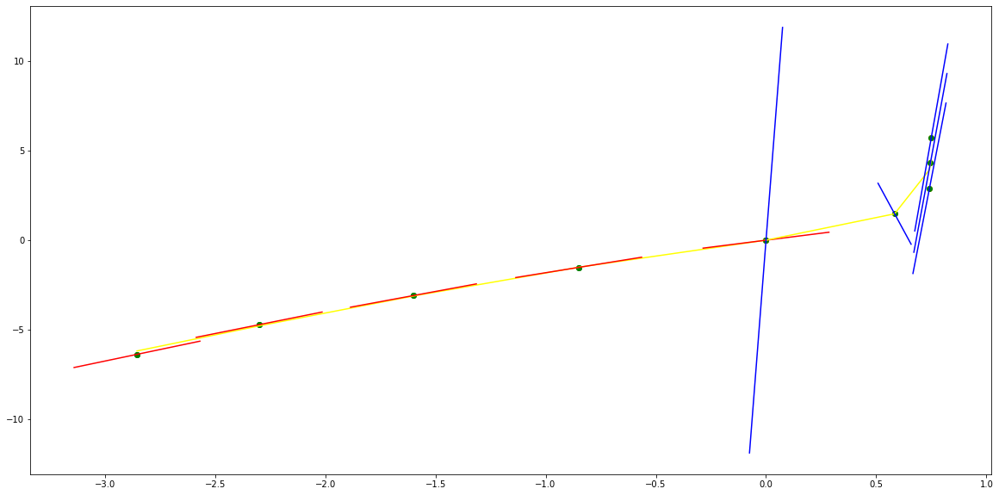

parameters (0.3808909454631942, 2.231916701472552, 5.808529955238201, -1.056317689666278)
tangent[0]:1.5950227500481793
tangent[1]:3.1148867319690265
tangent[2]:5.113330731845534
tangent[3]:5.789949002692422
tangent[4]:5.808529955238201
parameters (30727.109204705168, -3565.167720107638, 175.3479493076503, 0.3246419768125505)
tangent[0]:175.3479493076503
tangent[1]:147.2364678688374
tangent[2]:42.1852712353145
tangent[3]:49.28449633217531
tangent[4]:59.584974110164296


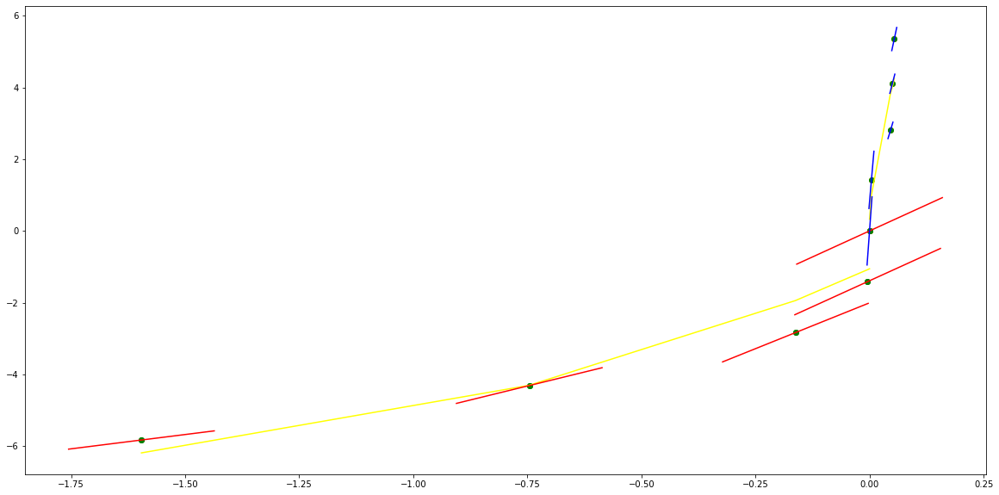

parameters (18563.76788857484, 4297.342640904188, 282.2950962687602, 0.3827464344732636)
tangent[0]:-49.0427167471675
tangent[1]:154.52464037617995
tangent[2]:183.56329644392494
tangent[3]:214.54272606896052
tangent[4]:282.2950962687602
parameters (2255.686956201219, -1361.009576226316, 194.0092478402868, 0.3731037006005299)
tangent[0]:194.0092478402868
tangent[1]:182.78409652579535
tangent[2]:171.79395019886127
tangent[3]:-79.11563240742404
tangent[4]:187.93132583581897


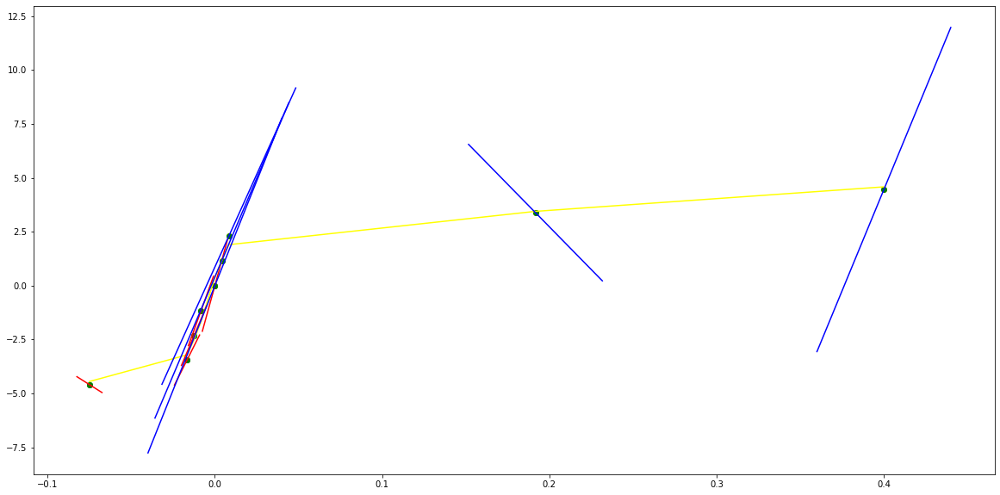

parameters (0.49239672006393986, 1.67618692665558, 3.2836328931939196, -0.14293018620501172)
tangent[0]:1.761283047619843
tangent[1]:1.3826697278384015
tangent[2]:1.8106054888119767
tangent[3]:2.8383586718833054
tangent[4]:3.2836328931939196
parameters (11909.274907760351, -2600.503778792235, 169.01503344254087, 0.12078121958776165)
tangent[0]:169.01503344254087
tangent[1]:147.96280893279288
tangent[2]:128.15593792036083
tangent[3]:6.1925249169044605
tangent[4]:14.91586953153876


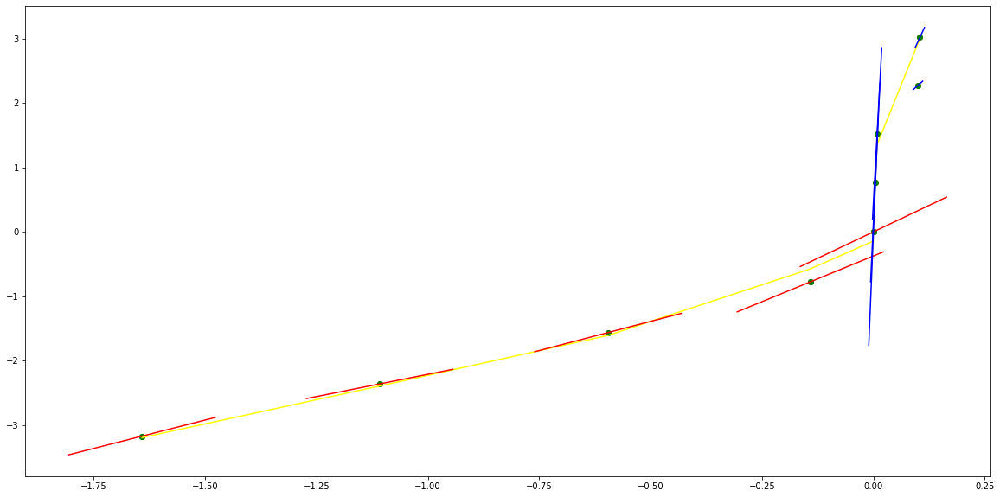

parameters (17638.805508293426, 2183.884563153314, 160.13533597403787, -0.3512401213458435)
tangent[0]:74.03792097090718
tangent[1]:71.10697893712505
tangent[2]:77.75734436087723
tangent[3]:142.85367680753393
tangent[4]:160.13533597403787
parameters (1.0205070154095075, -5.8375900486008705, 10.874275252823894, 1.0160552648441157)
tangent[0]:10.874275252823894
tangent[1]:10.825677937270472
tangent[2]:9.372015233610671
tangent[3]:6.50317083139515
tangent[4]:3.38140706854276


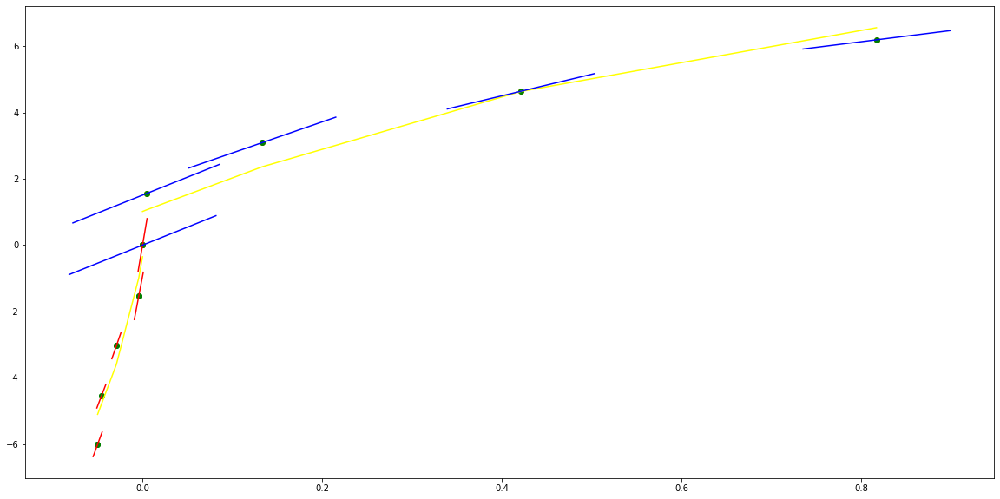

parameters (-9976.640662380154, -3071.328776724136, -161.16042663911367, 0.0058004420011604964)
tangent[0]:139.01673649285055
tangent[1]:153.80610883430882
tangent[2]:152.63355195000946
tangent[3]:150.42225089454905
tangent[4]:-161.16042663911367
parameters (3171.623478967033, -2257.5977045351306, 434.14393549177936, 0.27364025302055034)
tangent[0]:434.14393549177936
tangent[1]:415.49433137629933
tangent[2]:397.1795141801142
tangent[3]:361.53229889645104
tangent[4]:344.2084554562692


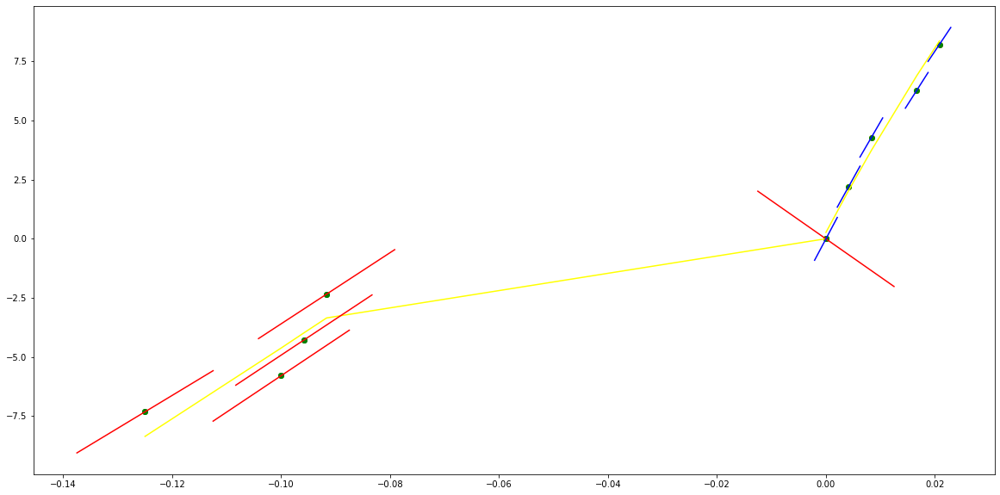

parameters (0.21651920173547523, 2.087031890492198, 0.9980429820520916, 0.2551312756248505)
tangent[0]:-5.705022590387995
tangent[1]:-5.664082252619734
tangent[2]:-5.20970924717651
tangent[3]:-2.9430904331944654
tangent[4]:0.9980429820520916
parameters (-288.9859905898099, 979.4021964249296, -779.0195638311266, 1.5114689744984236e-06)
tangent[0]:-779.0195638311266
tangent[1]:311.1466865766022
tangent[2]:-531.4173202965067
tangent[3]:-538.6236450940337
tangent[4]:-545.8600774155407


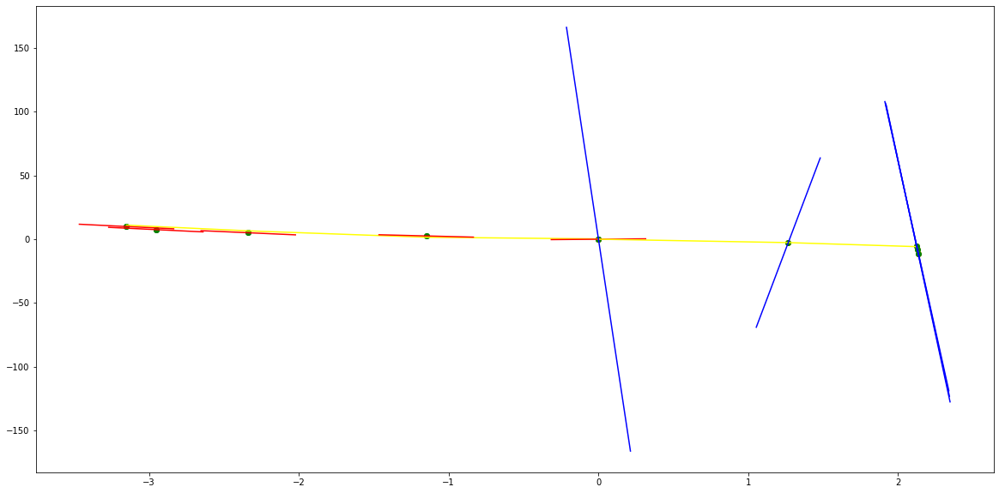

parameters (-0.5096340141254249, -2.7535483217489354, -5.5016564746536725, -0.17666355779231352)
tangent[0]:-9.495170396317544
tangent[1]:-5.513628233865945
tangent[2]:-1.122052836222056
tangent[3]:-0.979038569587539
tangent[4]:-5.5016564746536725
parameters (2527.0201095075627, -5015.432953567265, 2439.6278678502104, 3.740265914745348e-07)
tangent[0]:2439.6278678502104
tangent[1]:-584.9587923341105
tangent[2]:-572.3958170382411
tangent[3]:-559.5695683622789
tangent[4]:-533.1304868673205


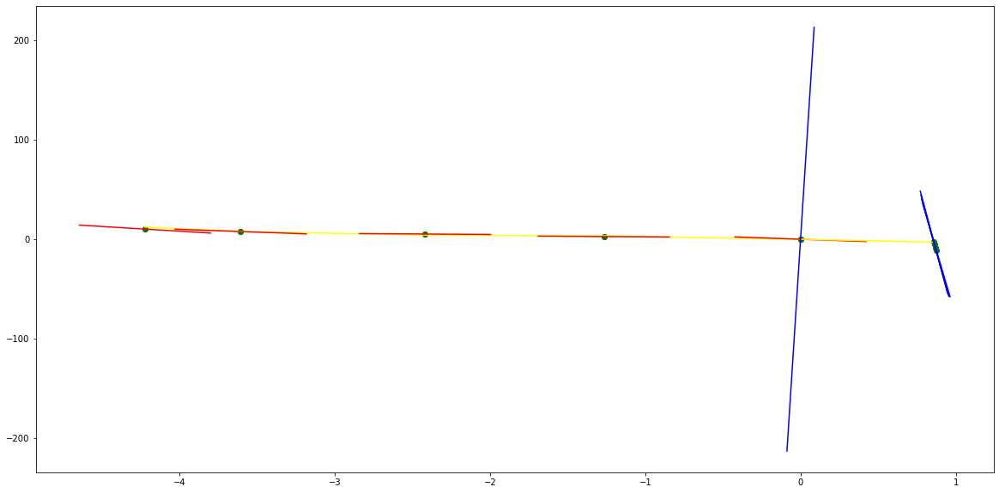

parameters (-222924.67611705125, -10521.583317386136, -971.7385728034201, 0.249412064344698)
tangent[0]:-823.6034992080898
tangent[1]:-806.7888597513399
tangent[2]:-813.1949317986345
tangent[3]:-895.6796857033528
tangent[4]:-971.7385728034201
parameters (268868.7333328069, -12823.944184832279, -714.0019427086203, -0.554575025089656)
tangent[0]:-714.0019427086203
tangent[1]:-806.870873021528
tangent[2]:-908.568328579674
tangent[3]:-917.4090580077464
tangent[4]:-898.2381463888499


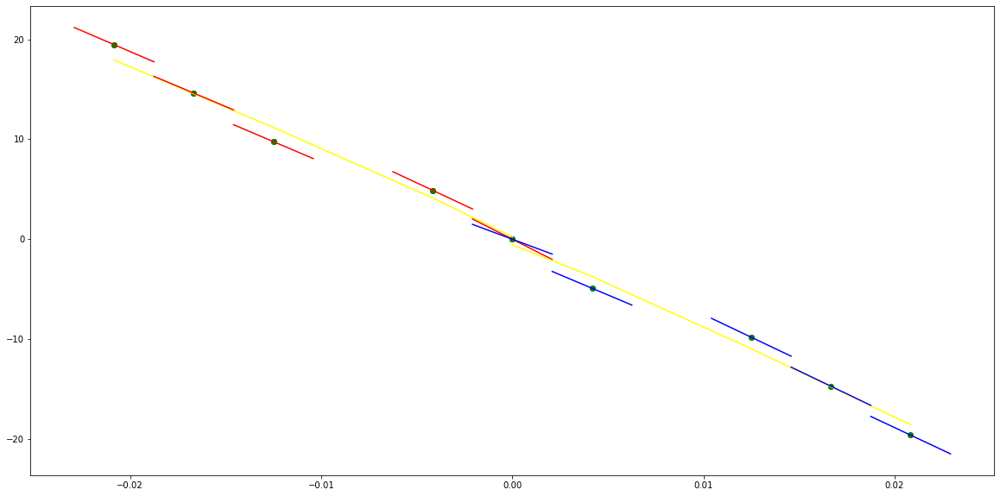

parameters (88589.36823619348, 2914.2135437993456, 187.59788845839856, -0.6806149712211356)
tangent[0]:342.76826991988884
tangent[1]:288.6109165397637
tangent[2]:243.68309889943882
tangent[3]:167.92921443574605
tangent[4]:187.59788845839856
parameters (111010.40714371788, -5321.920375772924, 474.8921632690117, 0.1236275883911585)
tangent[0]:474.8921632690117
tangent[1]:436.3219960197851
tangent[2]:393.8802822233064
tangent[3]:390.0036424666702
tangent[4]:397.69243703496403


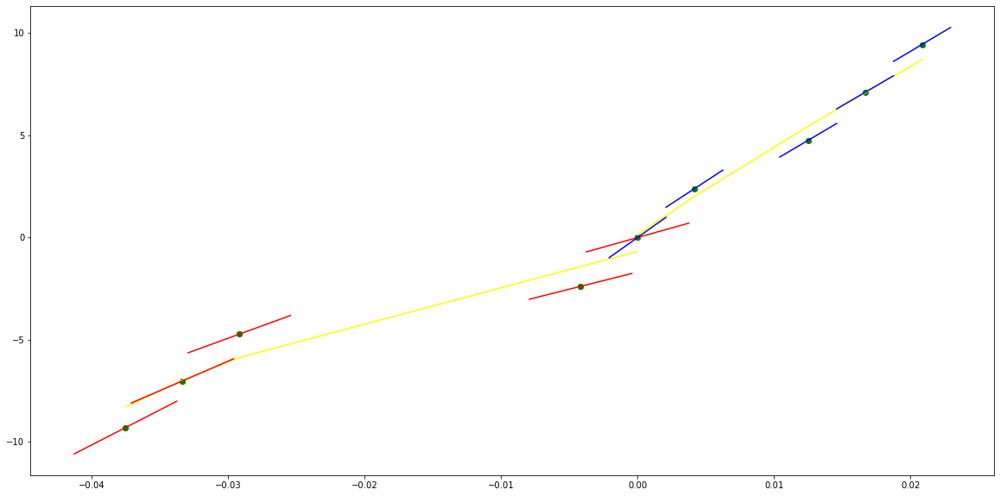

parameters (-10644.519551415648, -2346.7490434299816, -0.8053425032395848, -0.27161775942909805)
tangent[0]:170.62399150437966
tangent[1]:171.5807465811186
tangent[2]:147.23008179957313
tangent[3]:96.57363550935514
tangent[4]:-0.8053425032395848
parameters (213417.02395243853, -16479.89073268091, 530.8593728164252, 0.2522470892134548)
tangent[0]:530.8593728164252
tangent[1]:404.63321199412394
tangent[2]:300.6638369763964
tangent[3]:143.58682934252363
tangent[4]:195.22063766470706


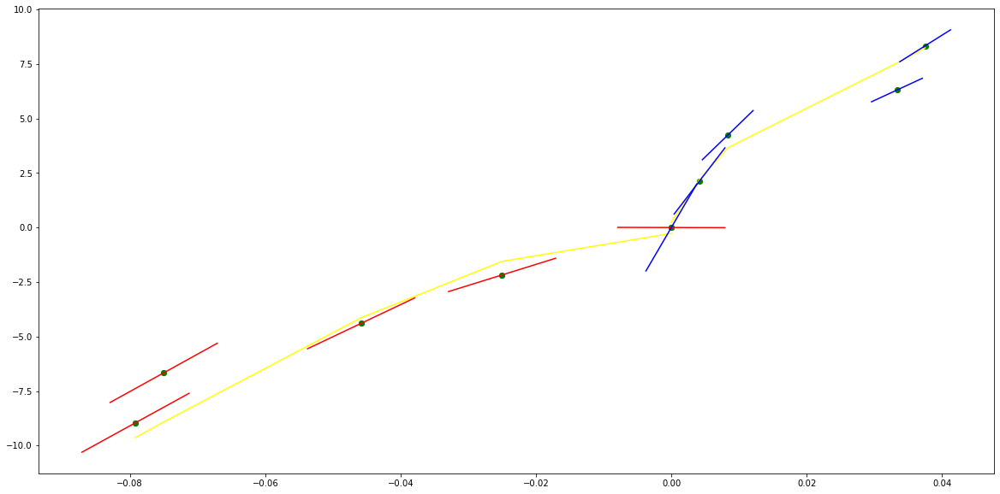

parameters (-15365.214816689655, -2884.0723683361102, -37.15077115192879, 0.02377372931451959)
tangent[0]:136.17208406684983
tangent[1]:136.01735455650982
tangent[2]:130.38915082752595
tangent[3]:123.16207464771088
tangent[4]:-37.15077115192879
parameters (28609.119355602154, -4166.3473631924, 266.7591333285117, 0.39338421471449936)
tangent[0]:266.7591333285117
tangent[1]:233.52709112230156
tangent[2]:203.2825445635114
tangent[3]:84.36724393418035
tangent[4]:74.9778033705283


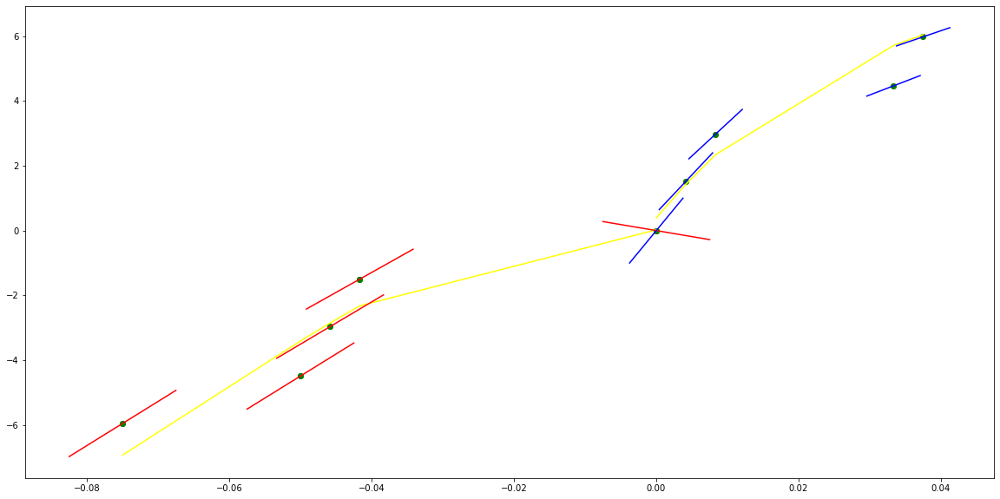

parameters (-27854.493158543697, -3145.859098836444, -170.8189656423057, 0.40415829603377296)
tangent[0]:-75.19605359760024
tangent[1]:-65.14175444773903
tangent[2]:-57.98942926201511
tangent[3]:-146.0523628946714
tangent[4]:-170.8189656423057
parameters (-21.869764446470402, 35.963280587564356, -29.652416764205466, -0.9223735824955821)
tangent[0]:-29.652416764205466
tangent[1]:-29.353838016275617
tangent[2]:-24.88682507520688
tangent[3]:-19.48712025329826
tangent[4]:-13.979284812213862


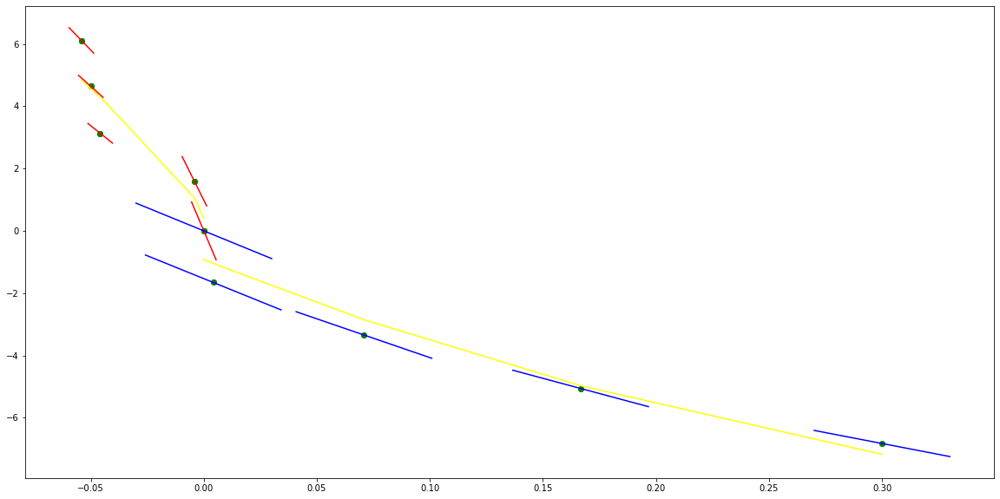

parameters (-82243.57211175478, -8661.46645216393, -462.3530751187827, -0.28244815870513795)
tangent[0]:-343.4616292829178
tangent[1]:-186.68939742731618
tangent[2]:-166.9952687176089
tangent[3]:-284.3680882420695
tangent[4]:-462.3530751187827
parameters (-78314.01102878757, 11952.22032487916, -636.7063751236287, -1.3140787460450405)
tangent[0]:-636.7063751236287
tangent[1]:-541.1760783200317
tangent[2]:-453.80479628432664
tangent[3]:-31.20947373511001
tangent[4]:-122.27043538575435


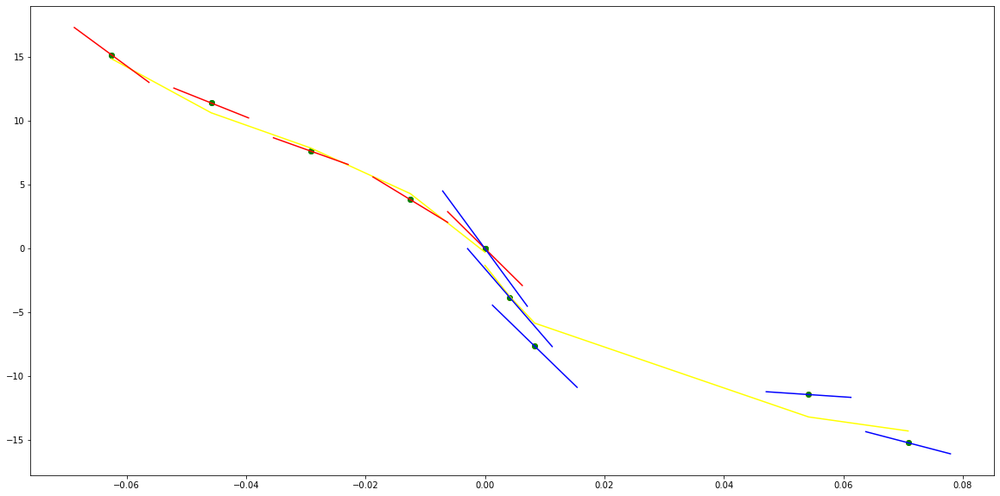

parameters (-87842.162984169, -9964.759564055204, -527.220728061082, -0.08102500264343016)
tangent[0]:-261.39473632710065
tangent[1]:-154.33604030218197
tangent[2]:-193.68680545363873
tangent[3]:-379.4314944583341
tangent[4]:-527.220728061082
parameters (-24208.361271972797, 4081.786416355455, -396.46122987176074, -1.8684280802481772)
tangent[0]:-396.46122987176074
tangent[1]:-363.71223415985895
tangent[2]:-333.47718259049
tangent[3]:-192.45627276123685
tangent[4]:-167.351911981821


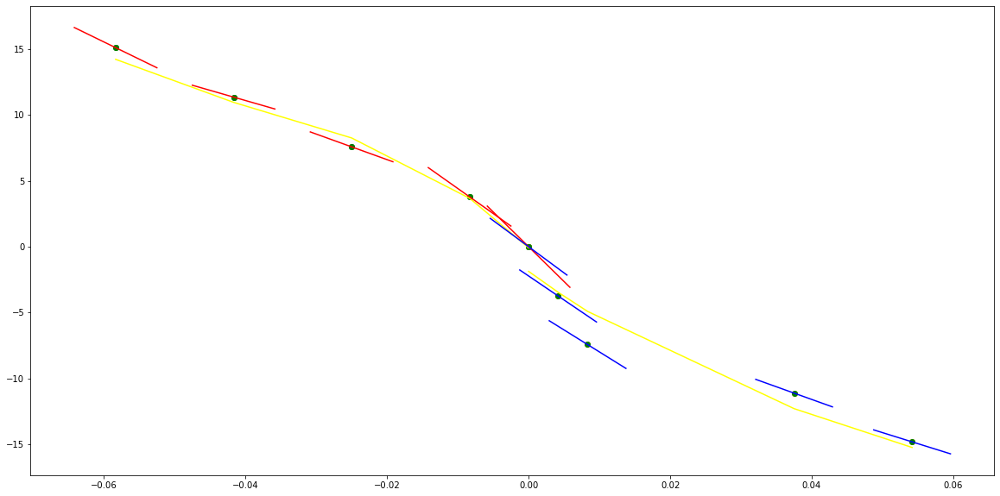

parameters (7.0907144537190545, 12.069572783990024, 28.155930853579157, -0.006448055251583267)
tangent[0]:23.231506854246092
tangent[1]:24.178987474429434
tangent[2]:25.315537237673617
tangent[3]:26.64119024081251
tangent[4]:28.155930853579157
parameters (-6461.594457631235, 1800.4754229375758, -32.780284631068724, -0.1395749111685975)
tangent[0]:-32.780284631068724
tangent[1]:121.12783477486758
tangent[2]:128.25162233704054
tangent[3]:130.80319873785905
tangent[4]:132.68227793785027


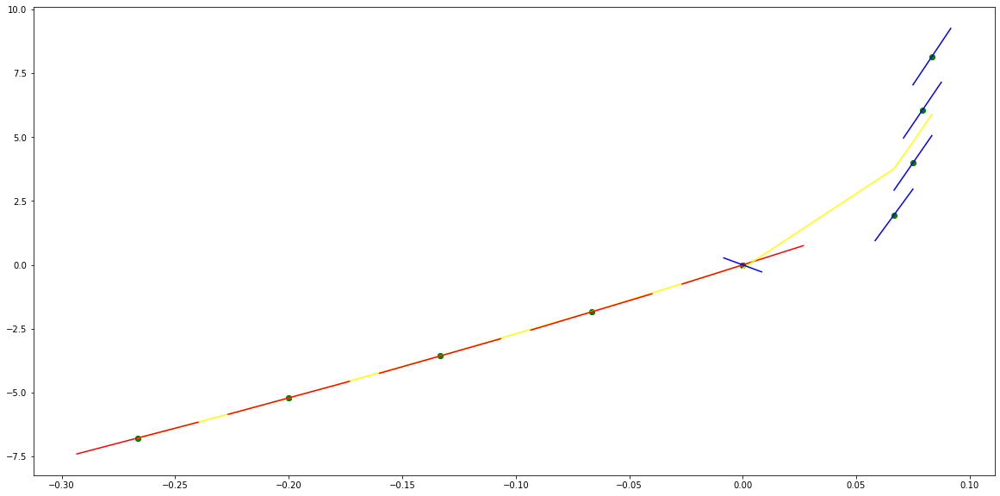

parameters (110641.45720062382, 9941.185241999225, 500.0025976667731, -0.18147038080929354)
tangent[0]:469.6750899304444
tangent[1]:247.83067645490598
tangent[2]:210.3960678179816
tangent[3]:357.35691383268863
tangent[4]:500.0025976667731
parameters (48325.9141363507, -7910.144408787715, 610.9689120264927, 1.3570537858817562)
tangent[0]:610.9689120264927
tangent[1]:547.5777581396073
tangent[2]:489.2055386722494
tangent[3]:306.0727805927645
tangent[4]:203.49017335896656


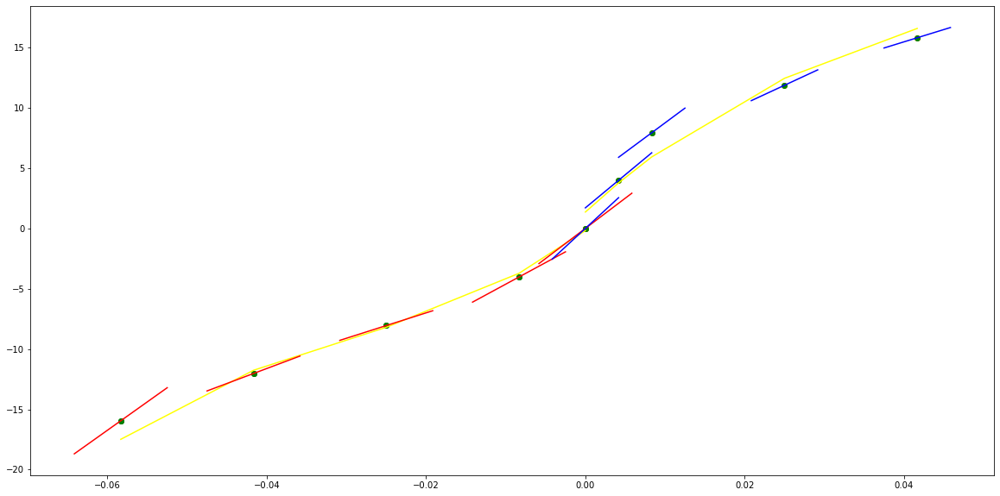

parameters (-37939.25979458926, -3252.295227490933, 187.16711083085295, -0.06401339787918736)
tangent[0]:277.52187112336264
tangent[1]:280.0601348943999
tangent[2]:278.64576009054474
tangent[3]:233.47109053288688
tangent[4]:187.16711083085295
parameters (40661.83779858765, -7469.744060365976, 530.4660192019901, 0.034981481457235016)
tangent[0]:530.4660192019901
tangent[1]:470.3452380999497
tangent[2]:414.44580321622715
tangent[3]:315.366664279057
tangent[4]:272.17507025333805


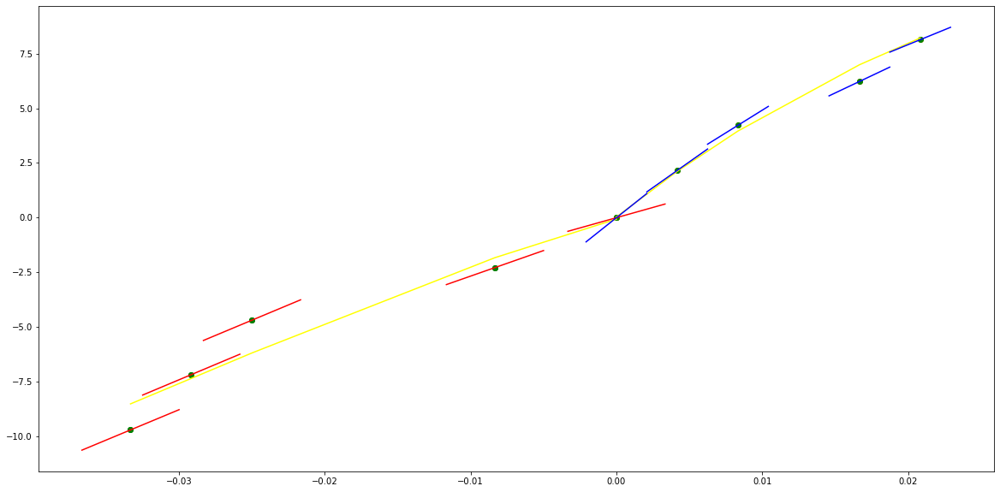

parameters (-101610.80232106683, -15185.955442592316, -405.3455314235369, 0.0018452488800178505)
tangent[0]:329.06886846924357
tangent[1]:351.16899542769346
tangent[2]:346.3422595112191
tangent[3]:330.9294830731645
tangent[4]:-405.3455314235369
parameters (8102.677458944003, -2388.0138050685778, 254.82011888095758, 0.7686768448463532)
tangent[0]:254.82011888095758
tangent[1]:235.34506727429212
tangent[2]:216.7094035677079
tangent[3]:150.6119488630487
tangent[4]:98.02224714020994


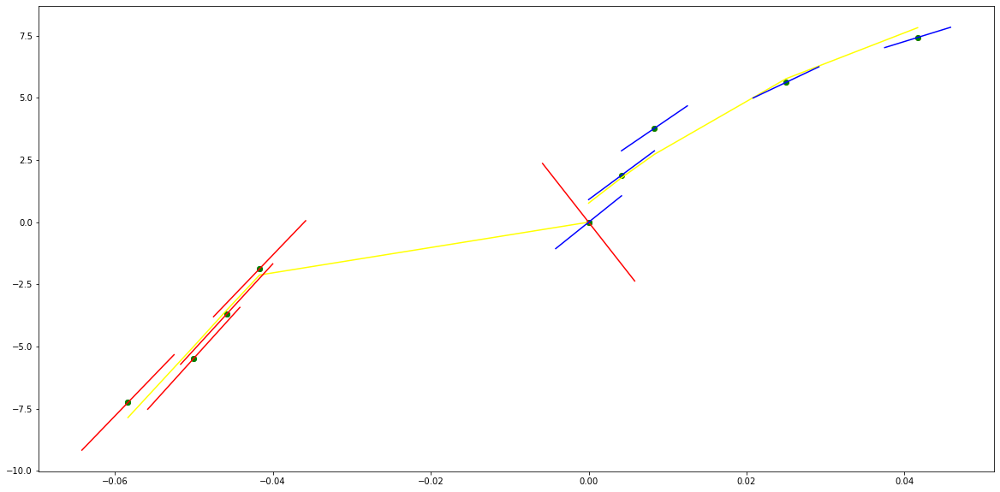

parameters (194355.06177625587, 11786.55408243059, -505.504195856235, -0.15160967761538233)
tangent[0]:-730.4161591472848
tangent[1]:-736.4281595929189
tangent[2]:-709.0641127093799
tangent[3]:-661.4515075102145
tangent[4]:-505.504195856235
parameters (-27096.680756167705, 6341.414678845867, -692.4812609924668, -0.2631821490322982)
tangent[0]:-692.4812609924668
tangent[1]:-641.0434223297209
tangent[2]:-503.6780146163492
tangent[3]:-463.5408843656023
tangent[4]:-426.21680346798786


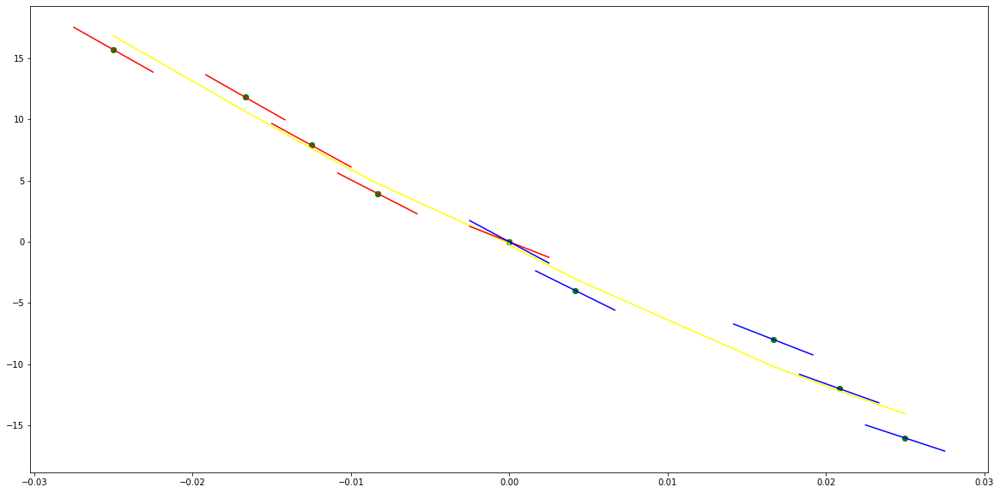

parameters (-9321.476541041475, -1818.3647559836547, -344.73383805375033, 0.5114032332044421)
tangent[0]:-227.74814761947036
tangent[1]:-241.75236325601838
tangent[2]:-271.29336876902033
tangent[3]:-316.37078995507517
tangent[4]:-344.73383805375033
parameters (-49092.60454003132, 8088.401194276811, -624.8580174447653, -1.365213651640677)
tangent[0]:-624.8580174447653
tangent[1]:-560.0065974995243
tangent[2]:-500.2835308930764
tangent[3]:-312.4865912434835
tangent[4]:-206.51393203364057


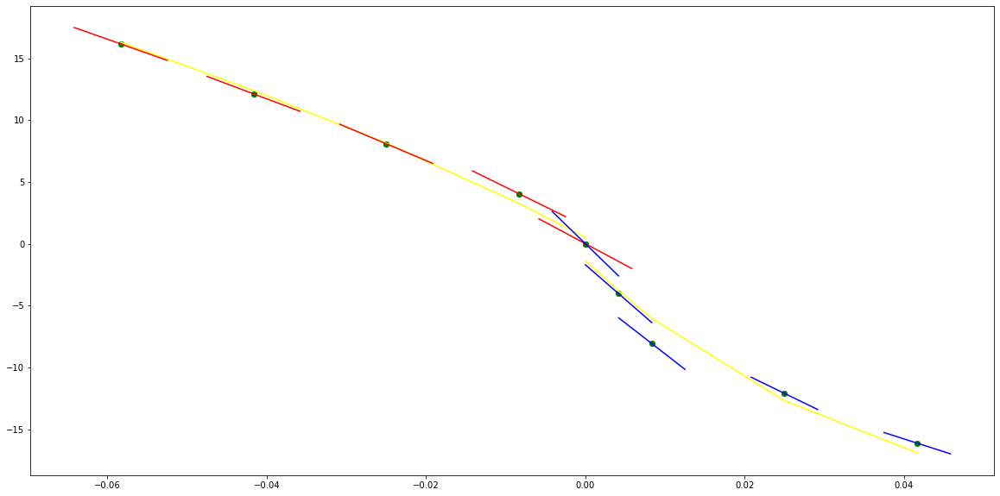

parameters (-54056.32326790039, -5968.786535342778, 53.91410572434015, -0.8369800646954529)
tangent[0]:273.5229820885937
tangent[1]:271.6450884000329
tangent[2]:264.1379045001956
tangent[3]:100.84208871897104
tangent[4]:53.91410572434015
parameters (87425.06741115934, -8370.013996880038, 393.3107823485705, 0.339047374853822)
tangent[0]:393.3107823485705
tangent[1]:328.1092031976069
tangent[2]:128.17554313487398
tangent[3]:126.72649229441134
tangent[4]:134.38423572339616


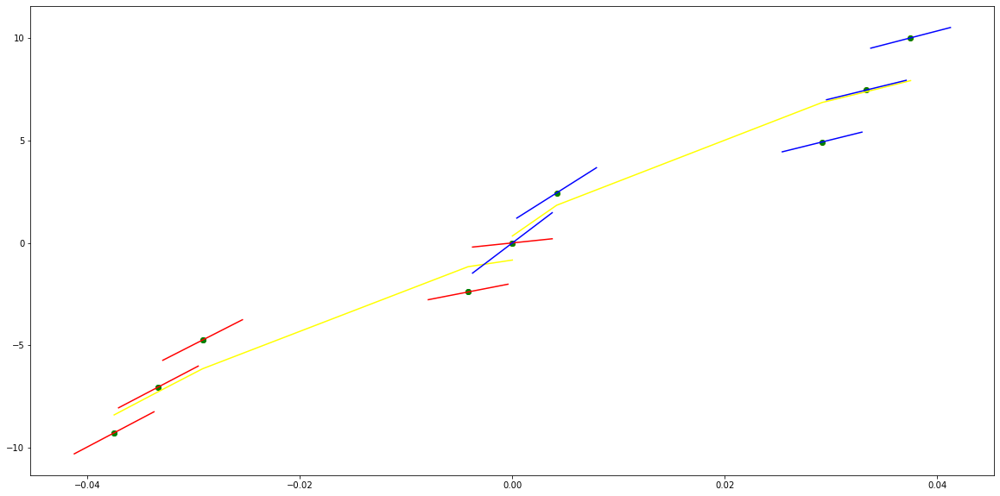

parameters (-102807.40435163601, -11380.073695691246, 9.614789194106514, -1.3310553837178902)
tangent[0]:429.40157926248554
tangent[1]:425.59428814496005
tangent[2]:411.0809478366323
tangent[3]:99.10091430137757
tangent[4]:9.614789194106514
parameters (-101480.10879715225, 9332.424040972102, 178.55067275981682, 0.9987658106826821)
tangent[0]:178.55067275981682
tangent[1]:251.0408266826933
tangent[2]:435.2641228253749
tangent[3]:463.9566827329779
tangent[4]:462.4457898581819


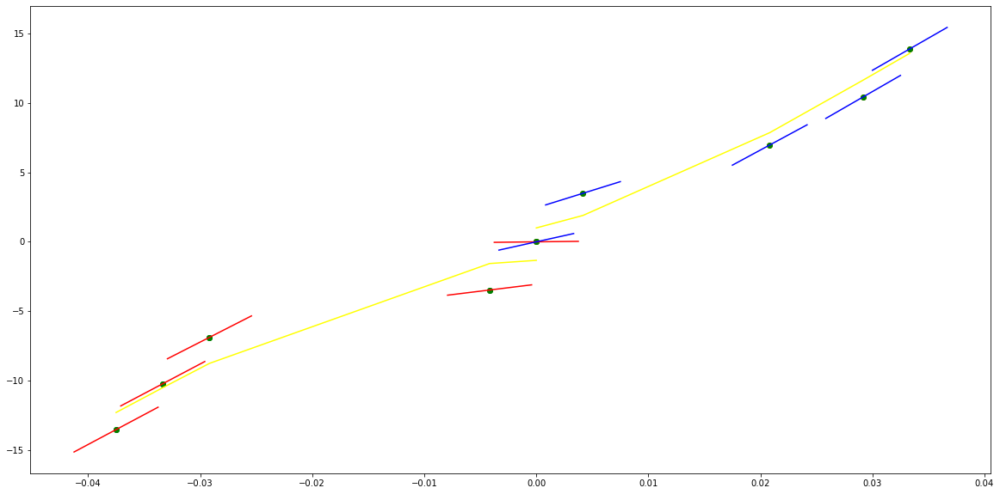

parameters (-4439.587953817813, -1036.6461845981348, 83.97609700382998, 0.01733156354887986)
tangent[0]:164.63822838640652
tangent[1]:161.53044874479434
tangent[2]:151.02391227257147
tangent[3]:127.48417882032831
tangent[4]:83.97609700382998
parameters (10499.519386807639, -2011.5302087860834, 249.67463496309324, 1.4006579950669331)
tangent[0]:249.67463496309324
tangent[1]:233.46124025356008
tangent[2]:218.33769738722603
tangent[3]:143.1047167172317
tangent[4]:124.17691410564119


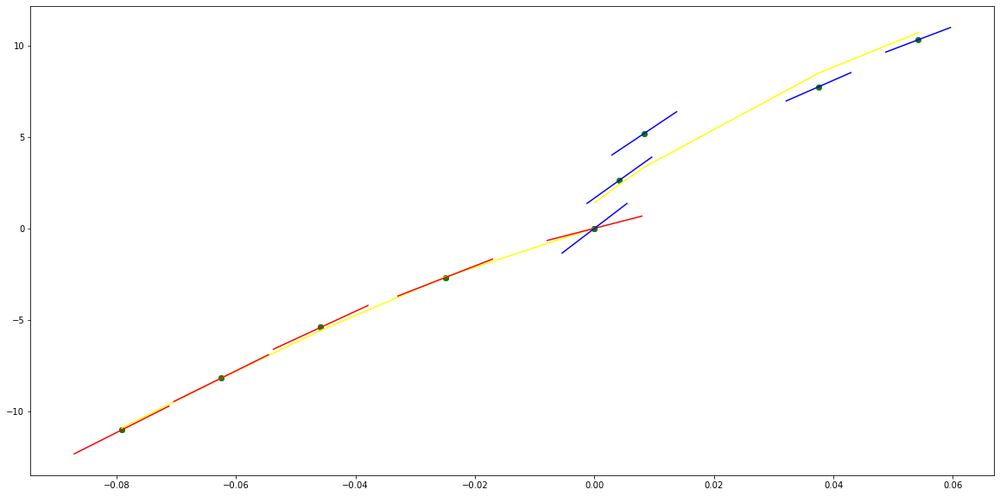

parameters (45818.84009826207, 3212.1229772111437, 109.00165770157743, -0.3505237955544312)
tangent[0]:164.3257395929133
tangent[1]:131.43066071742868
tangent[2]:103.31531734428525
tangent[3]:84.61860457022468
tangent[4]:109.00165770157743
parameters (7975.985270192946, -2366.842597262432, 223.91392320395605, 0.33409101961120846)
tangent[0]:223.91392320395605
tangent[1]:204.60867366060148
tangent[2]:168.4816013677982
tangent[3]:151.66844842211543
tangent[4]:135.682124703589


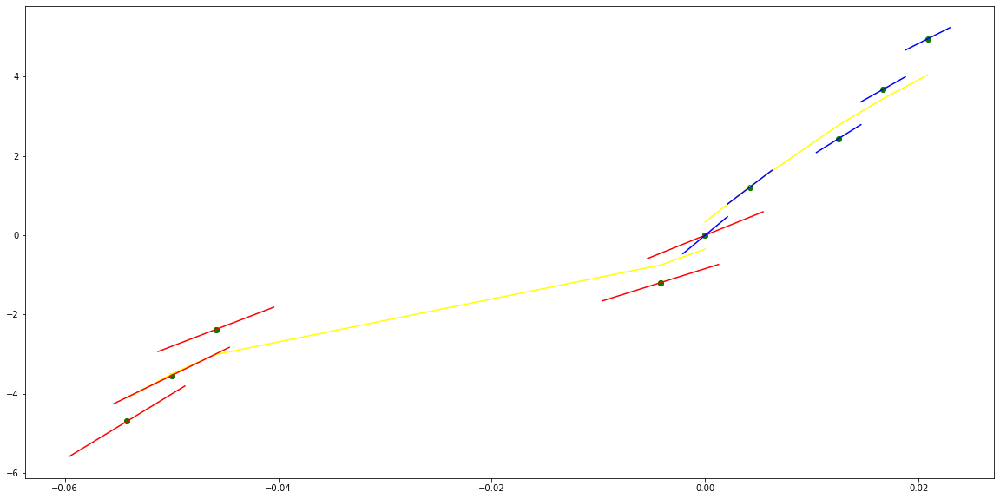

parameters (88406.54483366845, 9921.9887271471, 378.6551638937471, 0.18483043392200213)
tangent[0]:80.35458659737594
tangent[1]:121.60166268342351
tangent[2]:172.0460136058517
tangent[3]:300.5881880380392
tangent[4]:378.6551638937471
parameters (230.81516888065596, -127.33222767595257, 46.052364115440206, 0.5297970959948198)
tangent[0]:46.052364115440206
tangent[1]:45.0032008769047
tangent[2]:35.05025511444987
tangent[3]:29.070760182376077
tangent[4]:23.432719712098717


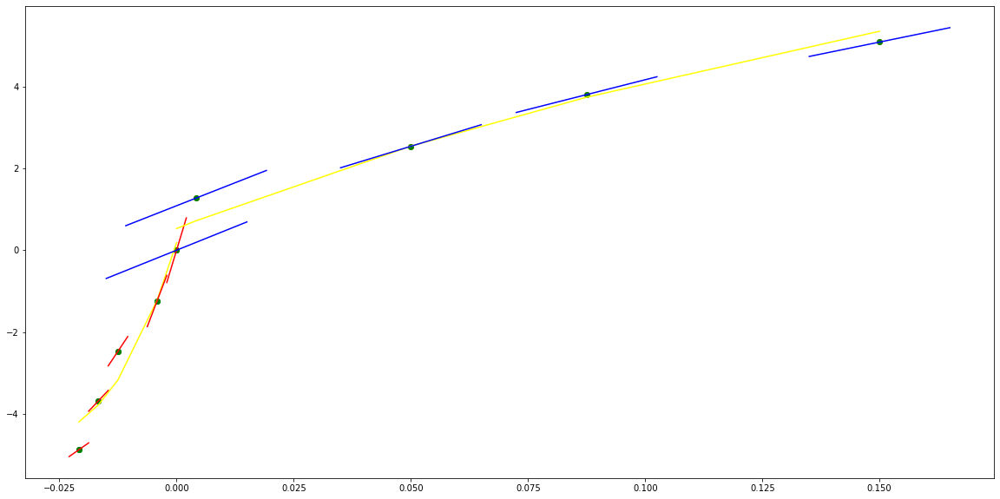

parameters (10.52596563804129, 7.146743094892437, 21.13969928825842, -0.01886397146468642)
tangent[0]:20.768725287713472
tangent[1]:19.856242813678037
tangent[2]:19.532458486519754
tangent[3]:19.961842475077447
tangent[4]:21.13969928825842
parameters (429.9485344136706, -284.8561226273885, 81.76548004957927, 1.7913825769882457)
tangent[0]:81.76548004957927
tangent[1]:79.41388585948442
tangent[2]:77.10708514115322
tangent[3]:47.88222585756618
tangent[4]:27.816189763322804


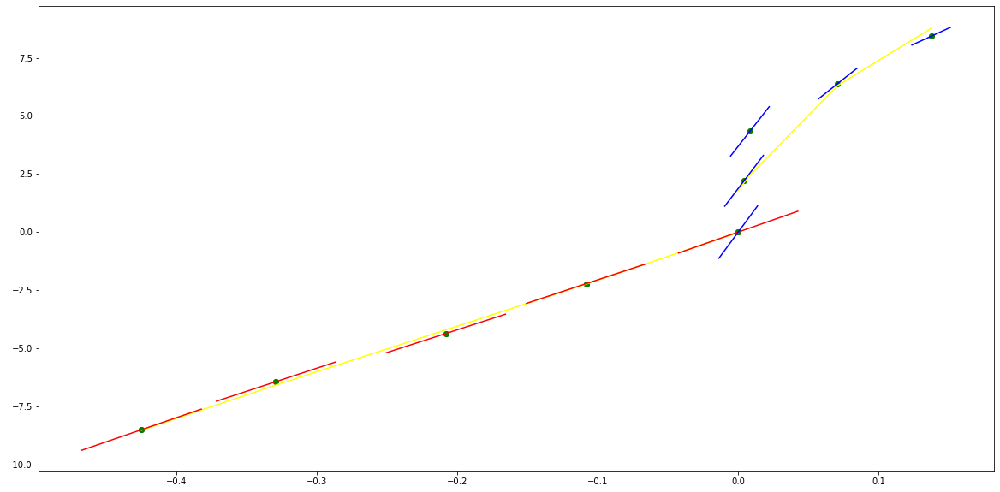

parameters (1710.6255076369787, 1005.8119373457421, 112.9847035904668, -0.34230423067285826)
tangent[0]:-3.7564149705210212
tangent[1]:1.685670297589482
tangent[2]:7.304604089869869
tangent[3]:104.69334509888054
tangent[4]:112.9847035904668
parameters (-820.8354825197937, 189.1392959580958, 34.98161500497495, 0.5476976923470441)
tangent[0]:34.98161500497495
tangent[1]:36.515143208872516
tangent[2]:47.739278481886075
tangent[3]:48.61752331063295
tangent[4]:48.18440972100029


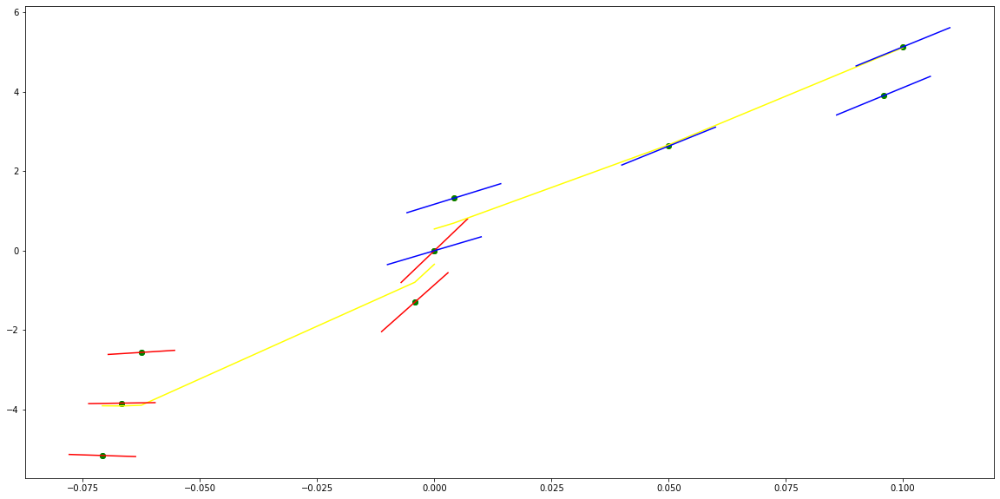

parameters (30.460471542794433, 30.214733963295647, 14.548328102825282, 0.04623294842553005)
tangent[0]:12.701481266472017
tangent[1]:6.573759549774918
tangent[2]:4.668739558138883
tangent[3]:8.906558989974238
tangent[4]:14.548328102825282
parameters (4988.816871050204, -1308.471394043029, 113.23681983859414, 0.634168512823161)
tangent[0]:113.23681983859414
tangent[1]:102.59189502781027
tangent[2]:92.46672179136786
tangent[3]:11.508748860941225
tangent[4]:19.96976215831522


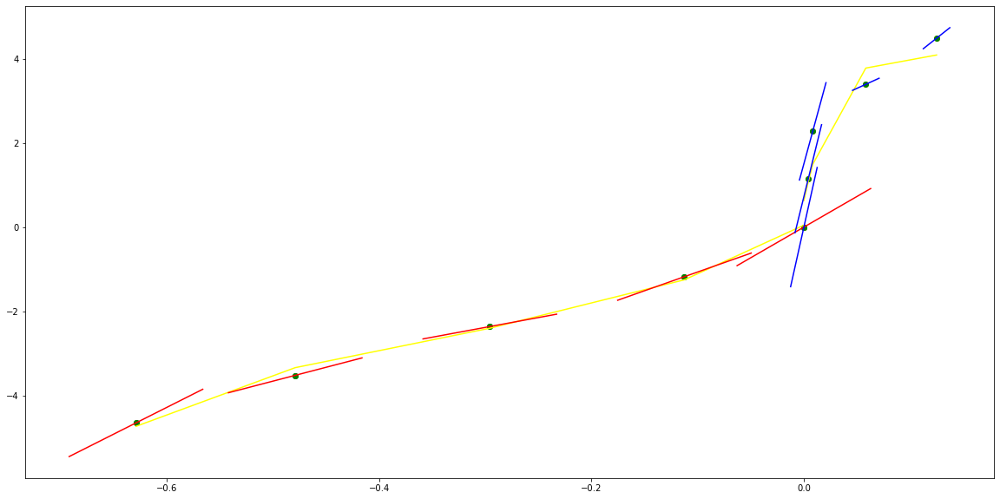

parameters (28355.492823292727, 3680.4804156739747, 176.3034595484526, -0.12183314700535207)
tangent[0]:19.892163721170675
tangent[1]:25.456971211370757
tangent[2]:33.97594848111456
tangent[3]:147.1140727558638
tangent[4]:176.3034595484526
parameters (26832.448978291563, -2213.0016389064676, 78.05632024714357, 0.3443825294367788)
tangent[0]:78.05632024714357
tangent[1]:61.01091158546873
tangent[2]:74.49735949977098
tangent[3]:115.87387684818937
tangent[4]:140.7575237712174


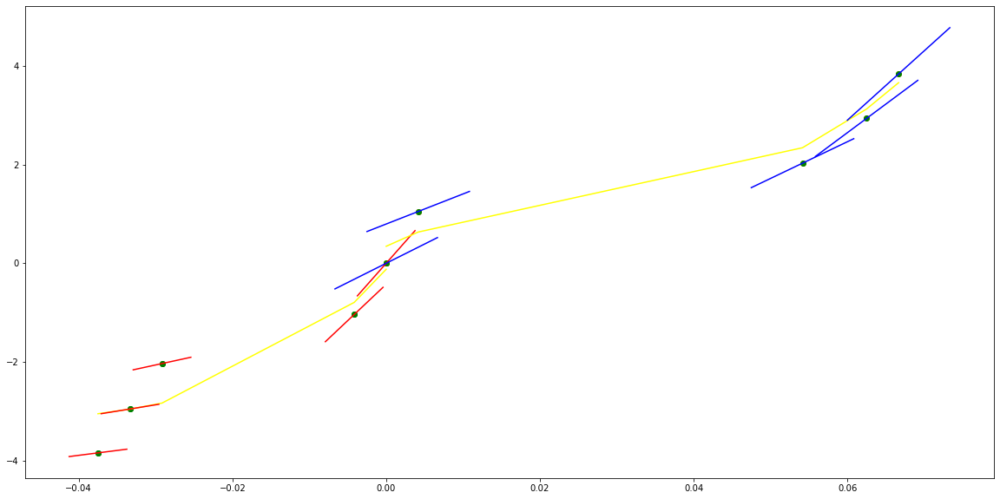

parameters (25460.78715212805, 3222.5170718662707, 155.92875796659763, -0.09079268109911162)
tangent[0]:21.65267337466753
tangent[1]:25.964027983331107
tangent[2]:32.92598286191486
tangent[3]:130.39859553555067
tangent[4]:155.92875796659763
parameters (-22314.103210901267, 3120.4133342842642, -35.22736760907941, 0.45780469190463663)
tangent[0]:-35.22736760907941
tangent[1]:-10.384221715020253
tangent[2]:104.66600954125067
tangent[3]:110.18514859974422
tangent[4]:109.4581917375875


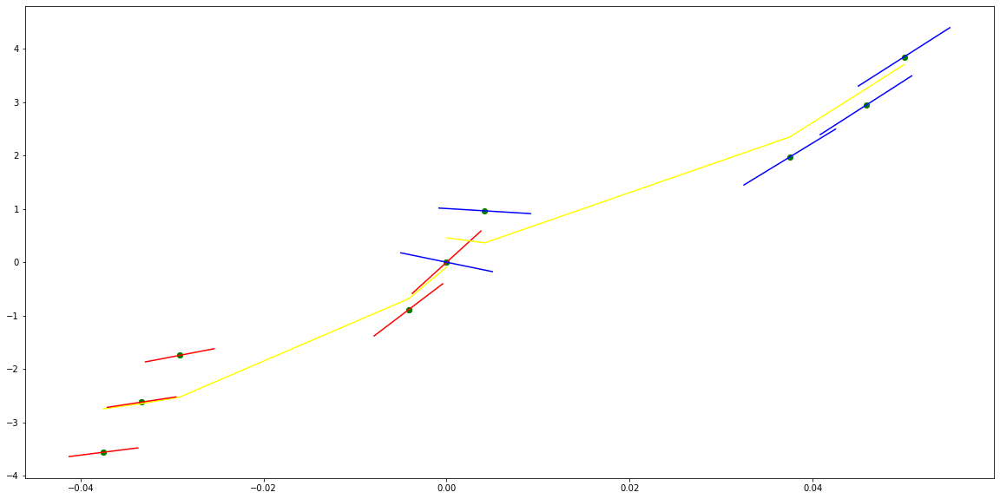

parameters (19569.97614775459, 2224.884529398734, 118.63639639970984, -0.256467294790715)
tangent[0]:49.864436762981654
tangent[1]:42.92276456799593
tangent[2]:38.02088972833553
tangent[3]:101.11364141238757
tangent[4]:118.63639639970984
parameters (28475.80155264077, -3718.9076207189123, 183.58966435842993, 0.1107355090712761)
tangent[0]:183.58966435842993
tangent[1]:154.0863661680752
tangent[2]:39.32764143357622
tangent[3]:30.582409047107234
tangent[4]:24.80388060471475


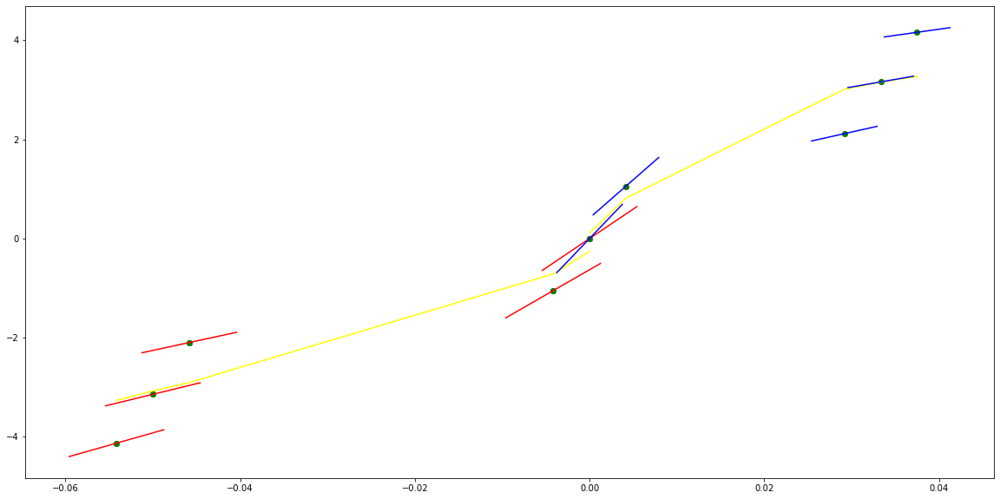

parameters (-8226.369351105748, -1969.3199950325677, -67.6010050806787, 0.0053068444587280475)
tangent[0]:83.19864391283875
tangent[1]:87.56184973156468
tangent[2]:85.29028560359478
tangent[3]:82.16122846512178
tangent[4]:-67.6010050806787
parameters (0.20895013278344302, -3.3905803818288733, 10.741065219430604, 0.05126401401787654)
tangent[0]:10.741065219430604
tangent[1]:10.180323842454083
tangent[2]:9.600913130739402
tangent[3]:8.843294603117647
tangent[4]:8.207490928640519


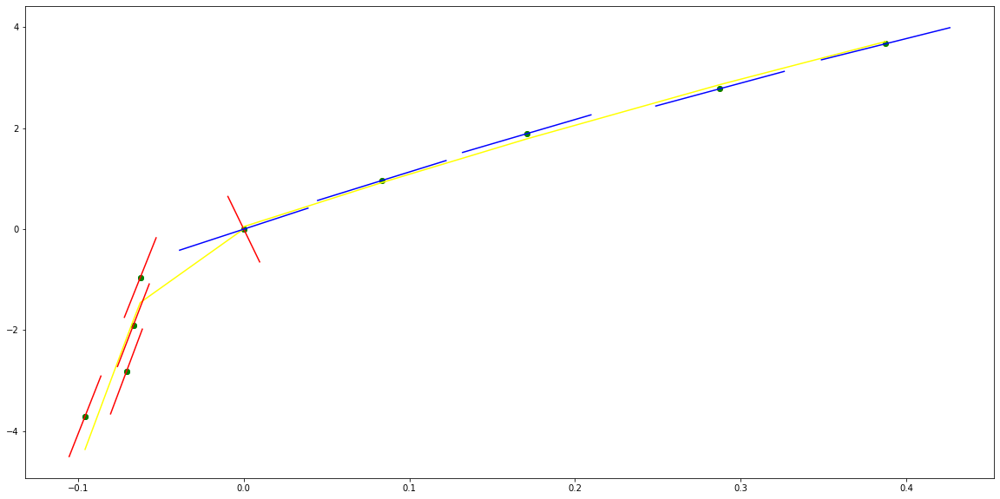

parameters (36146.82516562456, 3466.8008673724703, 165.2682986945188, -0.17013873807757507)
tangent[0]:57.75265230906217
tangent[1]:54.63755951271881
tangent[2]:55.28775553216772
tangent[3]:138.25892864547157
tangent[4]:165.2682986945188
parameters (639.7823715618701, -317.45527022900967, 56.04776323399895, 0.45889423303088156)
tangent[0]:56.04776323399895
tangent[1]:53.43541834216225
tangent[2]:34.93769984684987
tangent[3]:8.099251331926197
tangent[4]:6.426362608740774


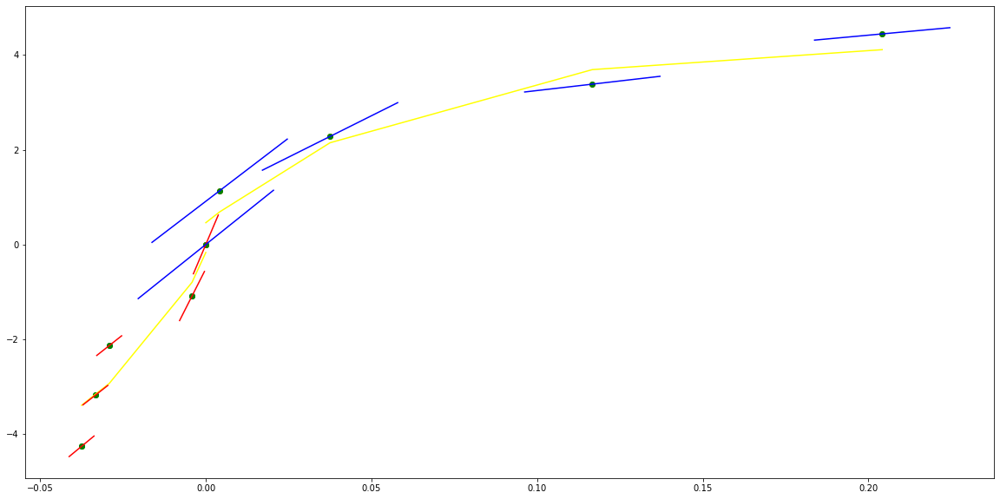

parameters (52892.56091095699, 5160.157115691692, 261.76654202229906, -0.28811146373491675)
tangent[0]:97.895249688522
tangent[1]:94.06451796435684
tangent[2]:95.74324541072875
tangent[3]:221.5170542898753
tangent[4]:261.76654202229906
parameters (33.639168662076074, -46.465844394412166, 32.43654298644284, 0.9347775706312645)
tangent[0]:32.43654298644284
tangent[1]:32.051048959631906
tangent[2]:25.393076971880095
tangent[3]:17.8869054681271
tangent[4]:13.506431810211915


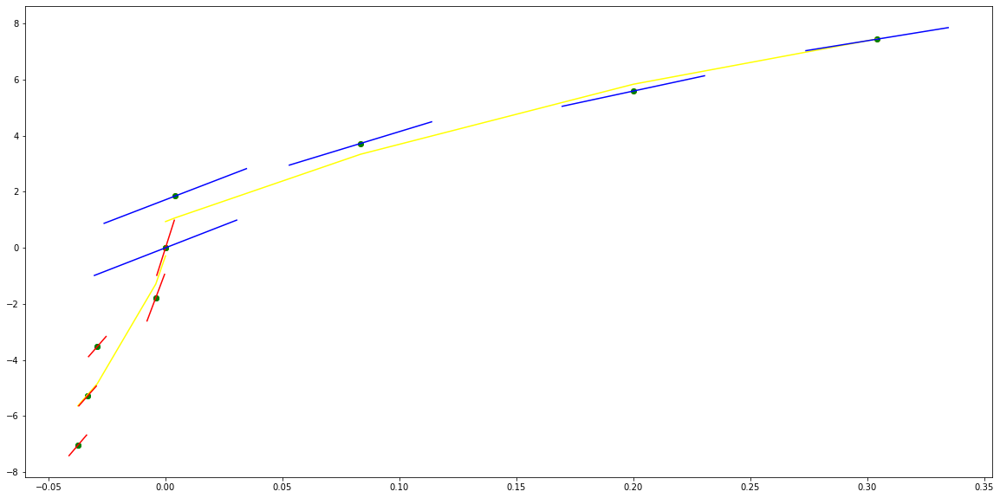

parameters (0.5246303838779228, -0.16002018107417643, 2.0015848397525837, -0.014322325699763409)
tangent[0]:5.151487992939985
tangent[1]:4.790363204063581
tangent[2]:2.87458008671428
tangent[3]:2.7974596464092336
tangent[4]:2.0015848397525837
parameters (284.0822838981982, -191.44056418697318, 44.25042586615392, 0.08705881920231387)
tangent[0]:44.25042586615392
tangent[1]:38.10569080563134
tangent[2]:22.512691343889895
tangent[3]:18.26212636296102
tangent[4]:3.0085803125134447


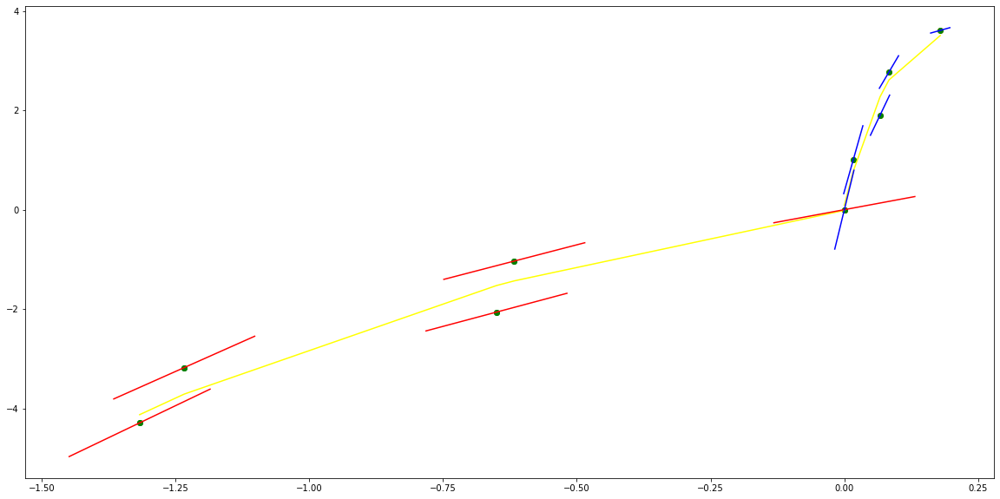

parameters (-0.13337743308027497, -1.4605834077901594, -7.119191963363314, -0.27927701897370816)
tangent[0]:-4.660358200094339
tangent[1]:-4.6692980631781875
tangent[2]:-4.678253966210828
tangent[3]:-4.9627566873902165
tangent[4]:-7.119191963363314
parameters (453.03494218966165, -628.9388105398341, 196.86521441690368, -1.4622456898692593)
tangent[0]:196.86521441690368
tangent[1]:191.6472377152126
tangent[2]:-90.23269142698663
tangent[3]:-87.41309676832171
tangent[4]:-79.50834907165583


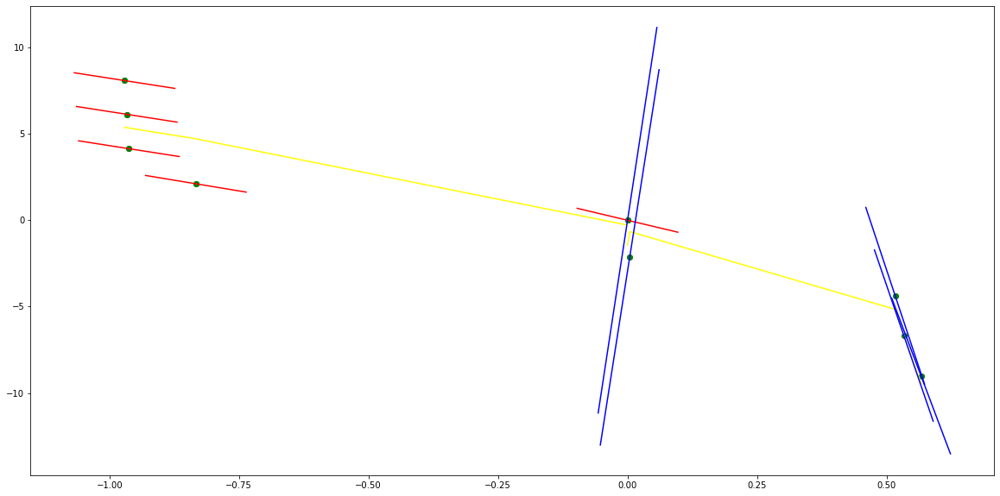

parameters (-6630.352606648556, -1905.3148792787622, -216.4318078812365, 0.7517590918222353)
tangent[0]:-56.088867898294296
tangent[1]:-83.56364103364041
tangent[2]:-122.20876886771903
tangent[3]:-200.8982997974054
tangent[4]:-216.4318078812365
parameters (-0.06411831292282513, 0.9106933862950111, -5.242982068175505, -3.4987630652745234)
tangent[0]:-5.242982068175505
tangent[1]:-5.235395689523927
tangent[2]:-5.025706940473736
tangent[3]:-4.944760213064605
tangent[4]:-2.195531266535174


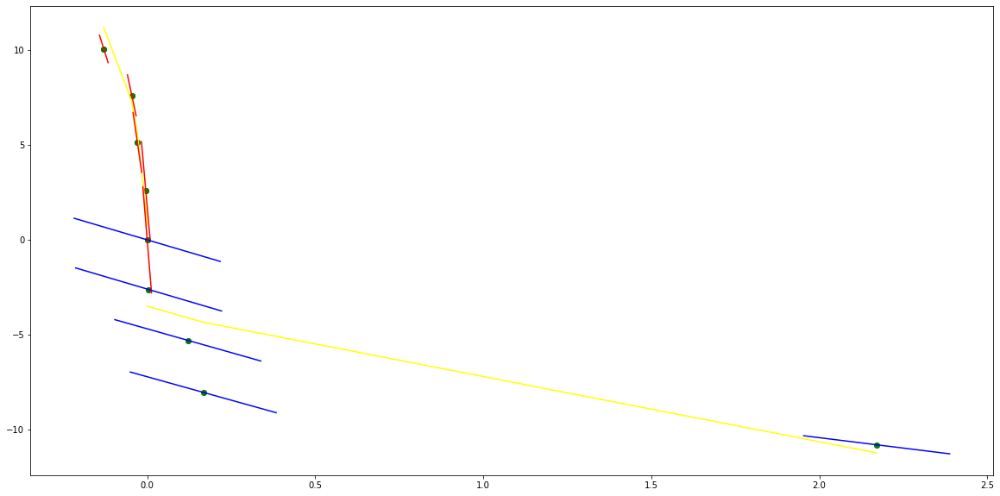

parameters (-201.76959236757867, -822.4427431286947, -839.8022757218433, -0.0001683644571127729)
tangent[0]:-121.55782584658903
tangent[1]:-117.47149592835888
tangent[2]:-11.597164668443497
tangent[3]:25.488810385720967
tangent[4]:-839.8022757218433
parameters (0.00013335361979559384, -0.040550700846089395, -1.3123984029354074, -0.04359153444205638)
tangent[0]:-1.3123984029354074
tangent[1]:-1.4733322372620525
tangent[2]:-1.606996756031464
tangent[3]:-1.7619973534425368
tangent[4]:-1.8793553662821858


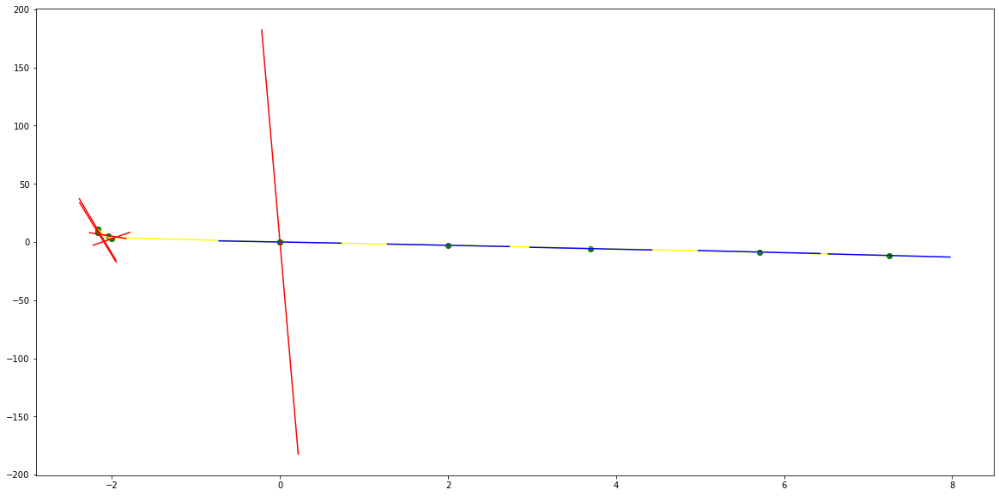

parameters (-5.965921747866748, -35.90016177292265, -49.404040134533076, -0.0008768803265772845)
tangent[0]:-61.283683455002844
tangent[1]:-52.486040909543746
tangent[2]:-49.1630571757817
tangent[3]:22.606107205082722
tangent[4]:-49.404040134533076
parameters (0.006738067185123165, -0.13414006592041672, -1.1327024799311514, -0.18648155355468451)
tangent[0]:-1.1327024799311514
tangent[1]:-1.5295277780238137
tangent[2]:-1.8486065484492267
tangent[3]:-1.9837854094868754
tangent[4]:-2.019168646758158


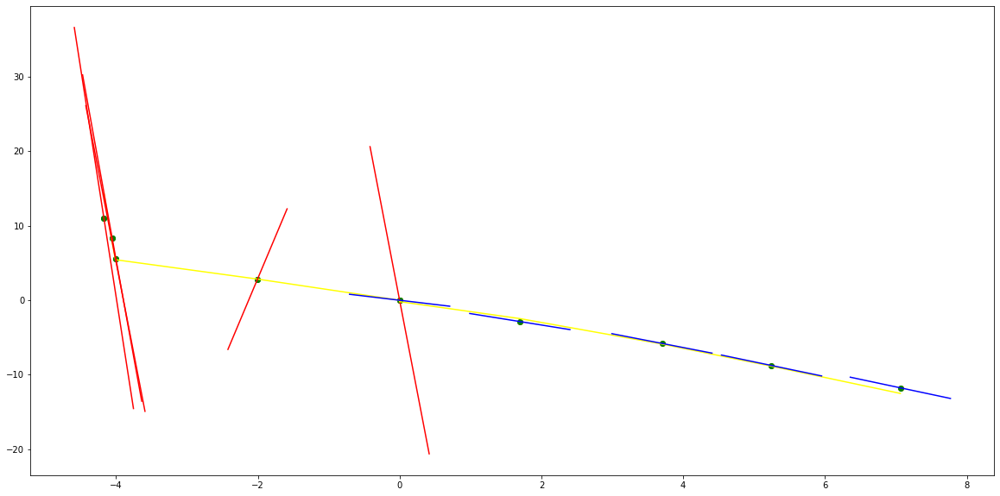

parameters (0.007814732733890646, 0.1508879267158753, -1.077744257958831, 0.13071426421074417)
tangent[0]:-2.0469083559928647
tangent[1]:-2.0428424020563885
tangent[2]:-1.9106906866777364
tangent[3]:-1.5883854970188138
tangent[4]:-1.077744257958831
parameters (-183.39149526647375, 783.6604084611012, -770.7024619907428, 3.5545711550212563e-07)
tangent[0]:-770.7024619907428
tangent[1]:339.9622452783366
tangent[2]:-621.2647643128097
tangent[3]:-627.3524655901905
tangent[4]:-633.4578053963636


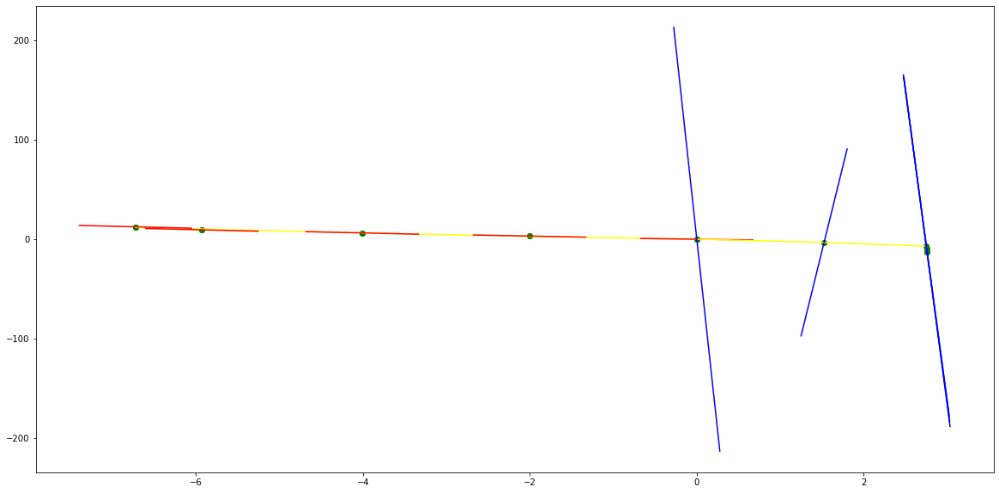

parameters (-0.001708387260873289, -0.00962822350945543, -1.7419172477098401, 0.21775493739956303)
tangent[0]:-1.8831540692191338
tangent[1]:-1.7922859595866119
tangent[2]:-1.7377920213928524
tangent[3]:-1.7244703703767064
tangent[4]:-1.7419172477098401
parameters (2432.7853588588277, -6523.995638085407, 4338.287497645475, 1.351894122188119e-07)
tangent[0]:4338.287497645475
tangent[1]:-693.4062282511877
tangent[2]:-673.1404681150161
tangent[3]:-652.6262069120603
tangent[4]:-610.8275298407534


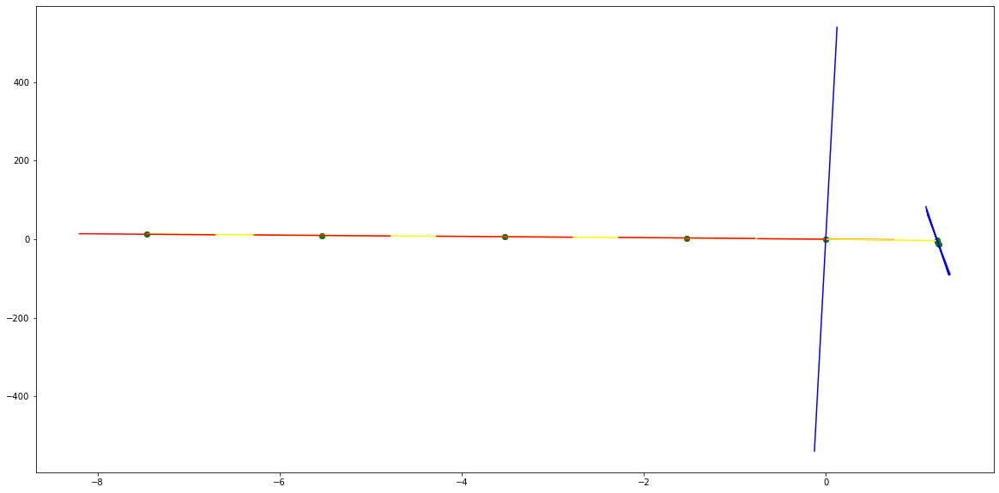

parameters (214617.9392280332, 13187.85071587432, -557.6214622059174, -0.16953133659300246)
tangent[0]:-814.6053619470711
tangent[1]:-818.3698412759974
tangent[2]:-786.7155710896348
tangent[3]:-732.7016884582864
tangent[4]:-557.6214622059174
parameters (-28198.895425618106, 5538.585949286469, -612.4809006997067, -0.721392387463881)
tangent[0]:-612.4809006997067
tangent[1]:-567.7912528686323
tangent[2]:-451.35769616012044
tangent[3]:-388.42453215841715
tangent[4]:-316.0510445800479


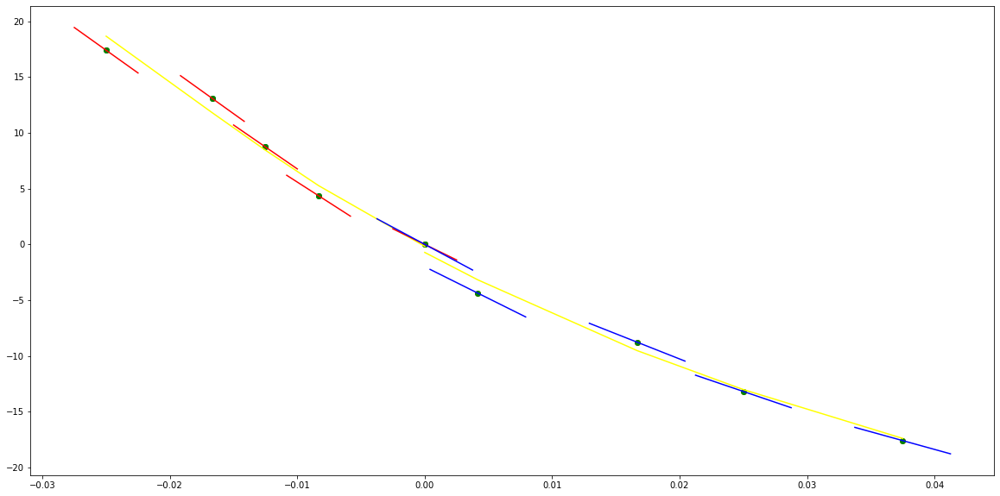

parameters (1076.065772804866, 379.32347831184666, -58.82883053539163, 0.10730941734190591)
tangent[0]:-103.3982915519037
tangent[1]:-101.88459673062374
tangent[2]:-95.05786007943013
tangent[3]:-80.52999536853915
tangent[4]:-58.82883053539163
parameters (-603.1530405892435, 248.1858617896482, -110.29299007105556, -0.21338537385657322)
tangent[0]:-110.29299007105556
tangent[1]:-100.73740834415301
tangent[2]:-88.71509158773617
tangent[3]:-80.71413565890131
tangent[4]:-76.7341195806581


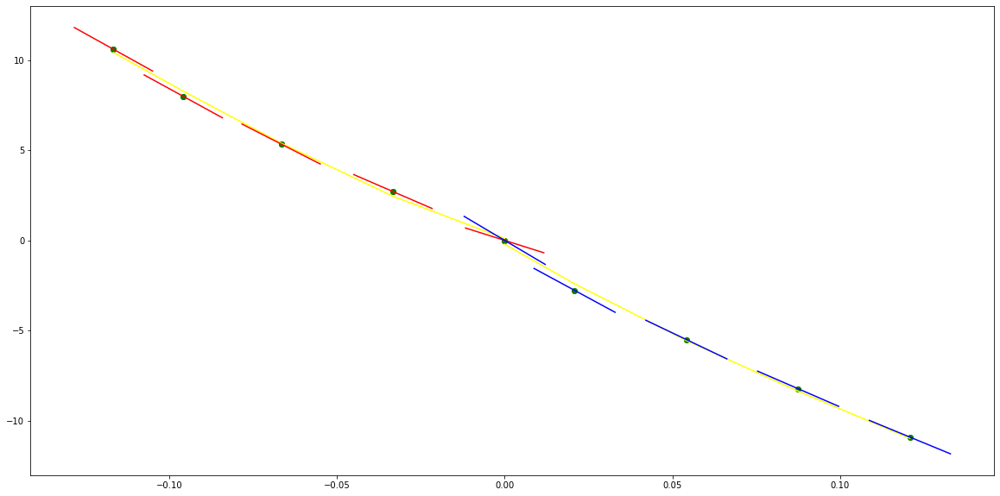

parameters (-162549.23662258624, -9258.423123805735, 320.62850988240183, 0.06833040688635972)
tangent[0]:478.76984740533936
tangent[1]:493.78567074378316
tangent[2]:475.8941333107079
tangent[3]:441.0676744671367
tangent[4]:320.62850988240183
parameters (95349.48979202034, -12776.449858155685, 741.7311936106398, -0.16189022300518438)
tangent[0]:741.7311936106398
tangent[1]:640.2191743636362
tangent[2]:548.6617681882414
tangent[3]:395.30210054700467
tangent[4]:333.5366424571266


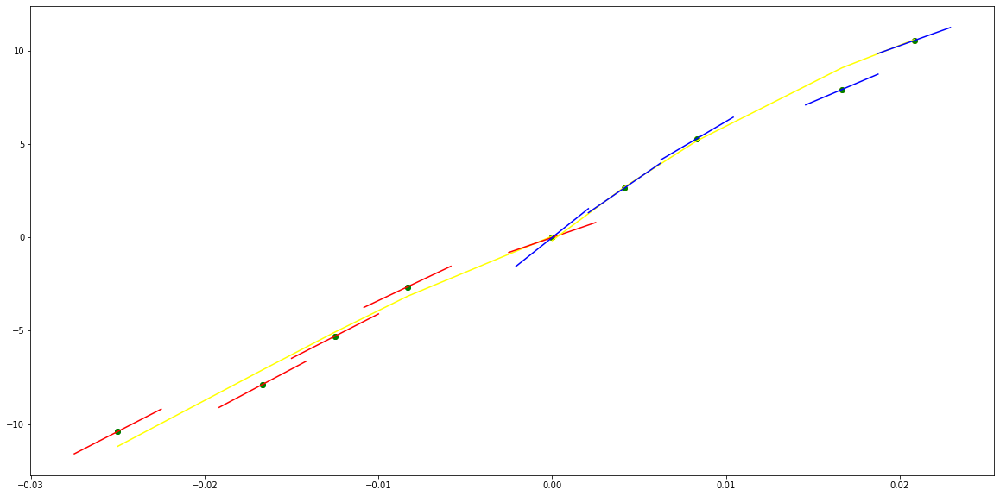

parameters (-143214.66797342605, -8736.997953055043, 329.25336183467493, 0.10042995145107195)
tangent[0]:497.57575703725314
tangent[1]:501.142121087286
tangent[2]:480.54643504850753
tangent[3]:445.0404805418473
tangent[4]:329.25336183467493
parameters (267170.8463496395, -20242.509075579695, 652.2416218665934, 0.3227961127597086)
tangent[0]:652.2416218665934
tangent[1]:497.491732005029
tangent[2]:370.5361058441082
tangent[3]:193.3061883654293
tangent[4]:261.1804492356579


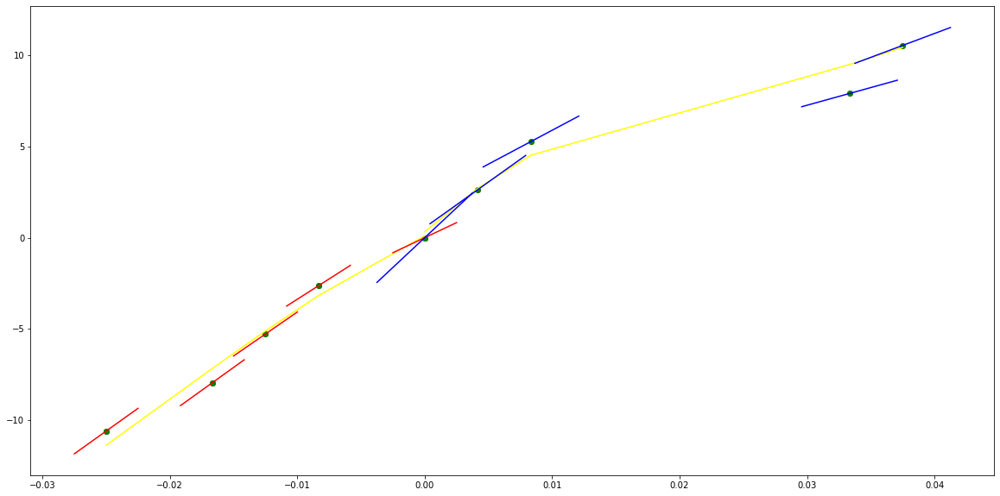

parameters (81214.49099804198, 8484.286480646453, 339.978385676421, 0.30418104491128356)
tangent[0]:55.94776461435271
tangent[1]:124.84462980569185
tangent[2]:165.94051631559185
tangent[3]:215.4846914995839
tangent[4]:339.978385676421
parameters (14254.965696487796, -2586.2927690603665, 195.58902435766836, 0.36360981642202317)
tangent[0]:195.58902435766836
tangent[1]:174.78224157212782
tangent[2]:155.45541601059995
tangent[3]:70.68683261082118
tangent[4]:61.75520321019877


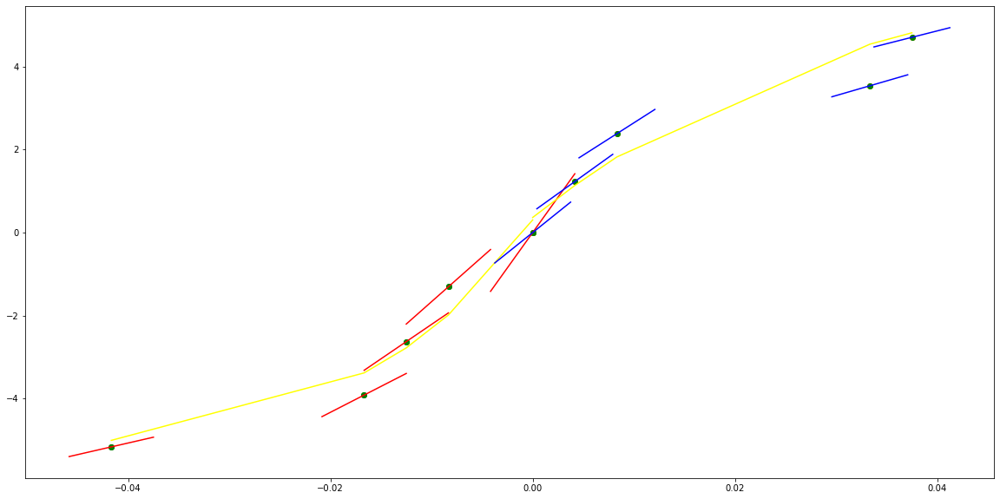

parameters (6214.079691534899, 1439.9753900320638, 76.96131569528865, -0.004276646626022766)
tangent[0]:175.55934527950677
tangent[1]:159.40022129166806
tangent[2]:143.88850084383523
tangent[3]:-10.672077222186772
tangent[4]:76.96131569528865
parameters (12634.329755867191, -2575.1691152937983, 165.6350302506258, 0.4837654498467472)
tangent[0]:165.6350302506258
tangent[1]:144.8365486347991
tangent[2]:125.34920323966053
tangent[3]:-5.825674164022956
tangent[4]:52.51439477030141


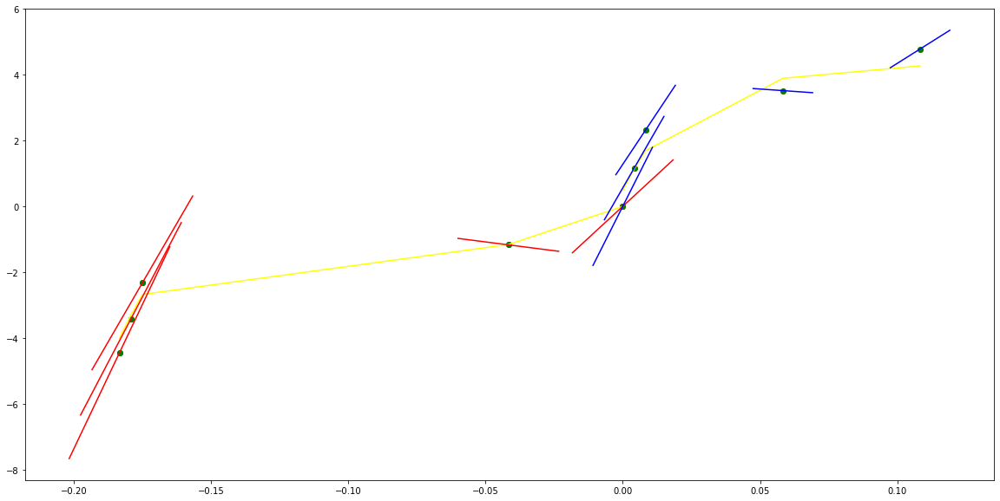

parameters (1992.8066612932873, 840.8007497711931, 136.21826139173658, -0.20422054703622985)
tangent[0]:81.56535826122816
tangent[1]:86.8079946253547
tangent[2]:92.25691536914556
tangent[3]:129.31483656413891
tangent[4]:136.21826139173658
parameters (24506.266550008208, -3647.6826257709213, 193.80853305080623, 0.23628484616236722)
tangent[0]:193.80853305080623
tangent[1]:164.68531832416764
tangent[2]:13.878345064321564
tangent[3]:12.837269598775663
tangent[4]:14.349338686302332


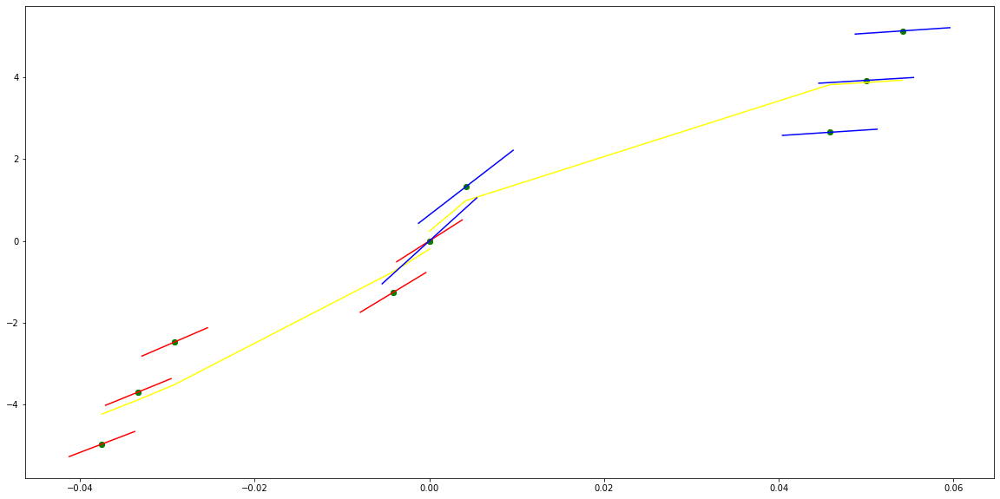

parameters (18995.89510084218, 2574.8998667623596, 135.43203567119576, -0.31187345967657354)
tangent[0]:56.58429959144712
tangent[1]:45.39147097321111
tangent[2]:36.1776980388951
tangent[3]:114.96234802355826
tangent[4]:135.43203567119576
parameters (50.95697320294019, -54.28477917664449, 28.280037803024936, 0.6121144373199575)
tangent[0]:28.280037803024936
tangent[1]:27.830390182731175
tangent[2]:21.721552346758862
tangent[3]:15.175610196263396
tangent[4]:10.56086319550539


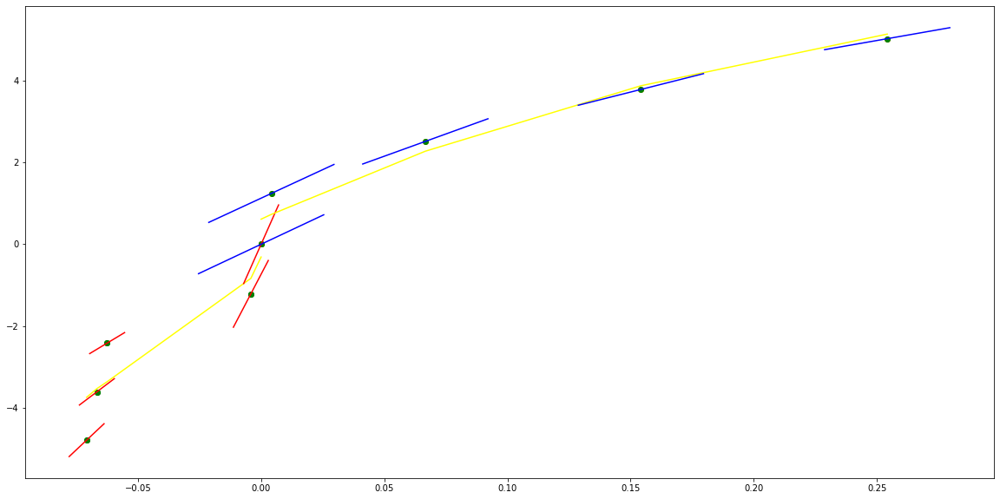

parameters (10132.766212512412, 1633.4666597529333, 105.52280262441757, -0.025903589538374936)
tangent[0]:82.8124570492033
tangent[1]:71.61965879039171
tangent[2]:61.48252589824229
tangent[3]:59.519388261055994
tangent[4]:105.52280262441757
parameters (2615.2959934258597, -1250.3796942337196, 179.64998202291608, 0.5572460949666365)
tangent[0]:179.64998202291608
tangent[1]:169.36555277916824
tangent[2]:159.35359379141232
tangent[3]:105.00767058878151
tangent[4]:96.90478492765246


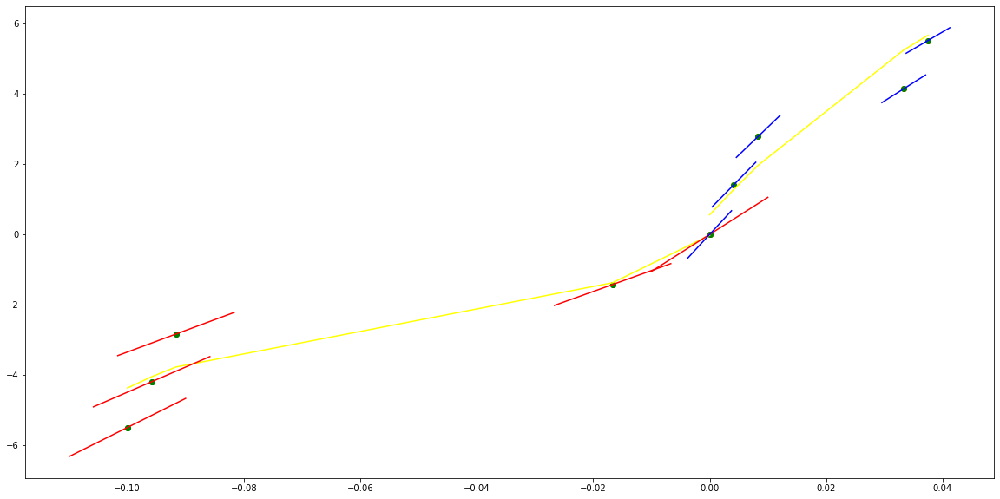

parameters (18969.835602671887, 3221.1492743487574, 191.39679916495987, -0.3325886270268309)
tangent[0]:20.603944889618106
tangent[1]:14.841752505638084
tangent[2]:11.055900840176378
tangent[3]:165.53991147179647
tangent[4]:191.39679916495987
parameters (-10107.103234286775, 2082.5701820860804, -23.51087512347506, 0.7317860482121921)
tangent[0]:-23.51087512347506
tangent[1]:-6.685143554875172
tangent[2]:108.94286882798217
tangent[3]:113.13674277437046
tangent[4]:116.19523024613015


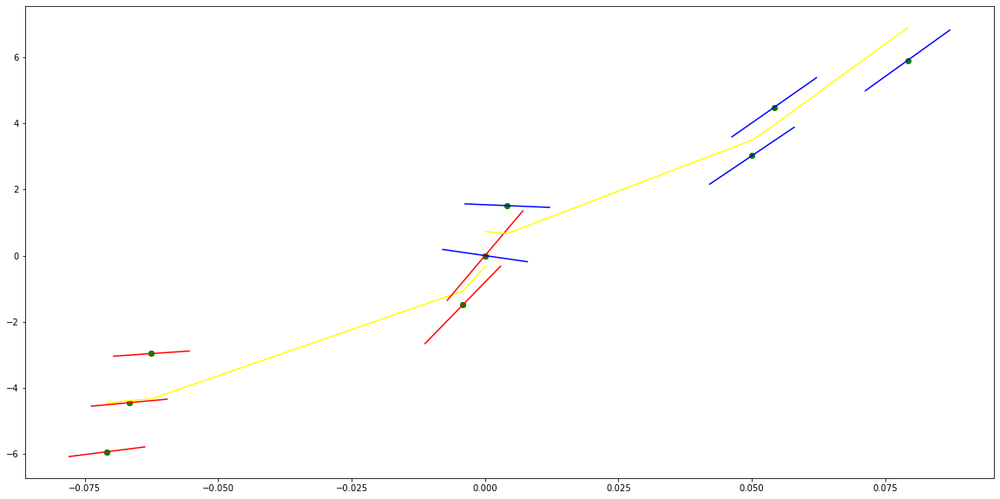

parameters (1.84036954373084, 5.786583067356664, 12.247661335004866, -0.09772402209110972)
tangent[0]:6.7729039056224
tangent[1]:6.317919061276068
tangent[2]:7.171115559868614
tangent[3]:10.192991120644209
tangent[4]:12.247661335004866
parameters (-589.9278541229573, 165.81477027037354, 61.364804307958224, 2.1045355022240533)
tangent[0]:61.364804307958224
tangent[1]:62.71597427806052
tangent[2]:64.00538146494291
tangent[3]:76.82992273834421
tangent[4]:76.70615508756829


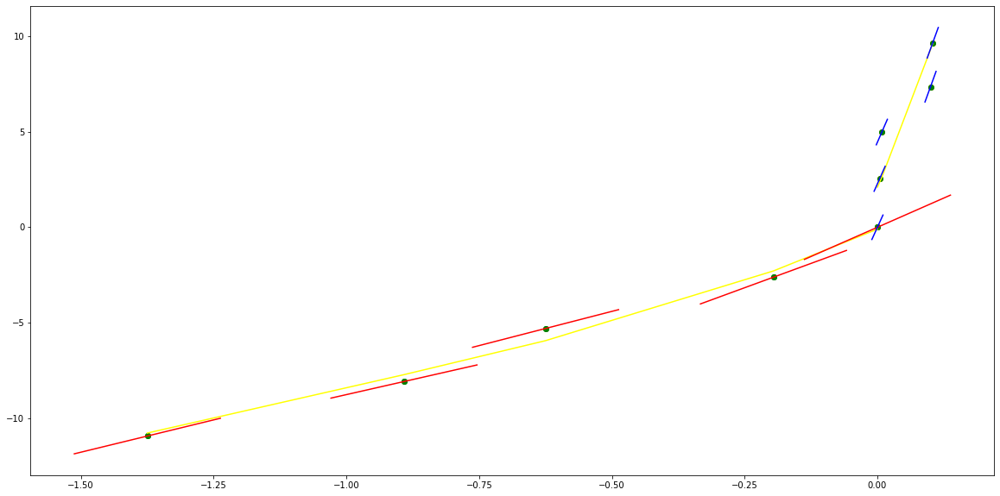

parameters (1003.8455729547028, 792.9677718116162, 154.52586569316802, -4.053867706455717e-05)
tangent[0]:12.759248767805587
tangent[1]:-19.453531806325117
tangent[2]:-22.099867558759883
tangent[3]:-24.641021907017006
tangent[4]:154.52586569316802
parameters (-0.2621179634628646, 0.7293062892126668, -1.5200836967551974, 0.02475896737133214)
tangent[0]:-1.5200836967551974
tangent[1]:-1.1491734309066892
tangent[2]:-0.8526253458035921
tangent[3]:-0.9982730897017624
tangent[4]:-1.5373471541293442


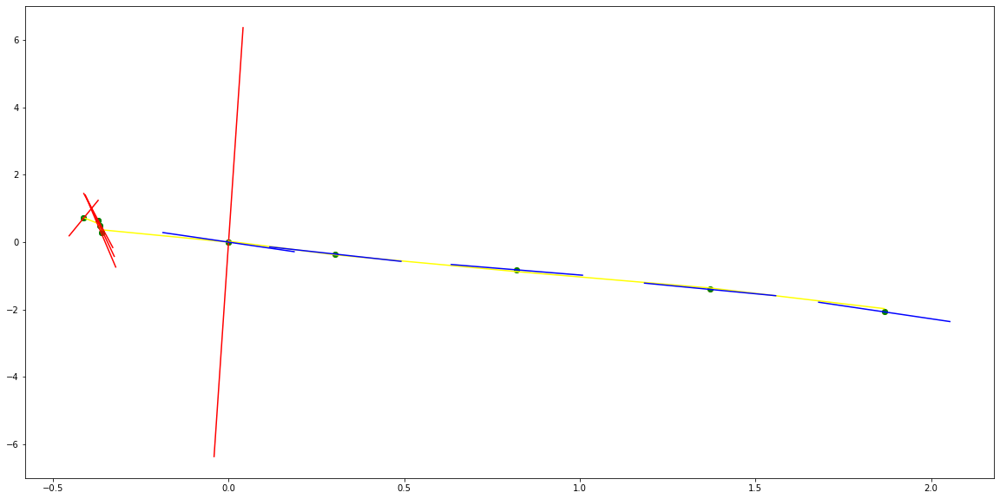

parameters (0.015353875480855775, 0.15823237305669696, -2.4143164995665733, -0.384483095810181)
tangent[0]:-2.8741771807335876
tangent[1]:-2.9554208980727688
tangent[2]:-2.9552415322547927
tangent[3]:-2.863549639621633
tangent[4]:-2.4143164995665733
parameters (-129.87096246868995, 483.81705485155913, -334.2410092008668, -5.6992746305047525e-05)
tangent[0]:-334.2410092008668
tangent[1]:221.04325073302306
tangent[2]:-704.8950248793972
tangent[3]:-710.0289988446239
tangent[4]:-715.1765031997097


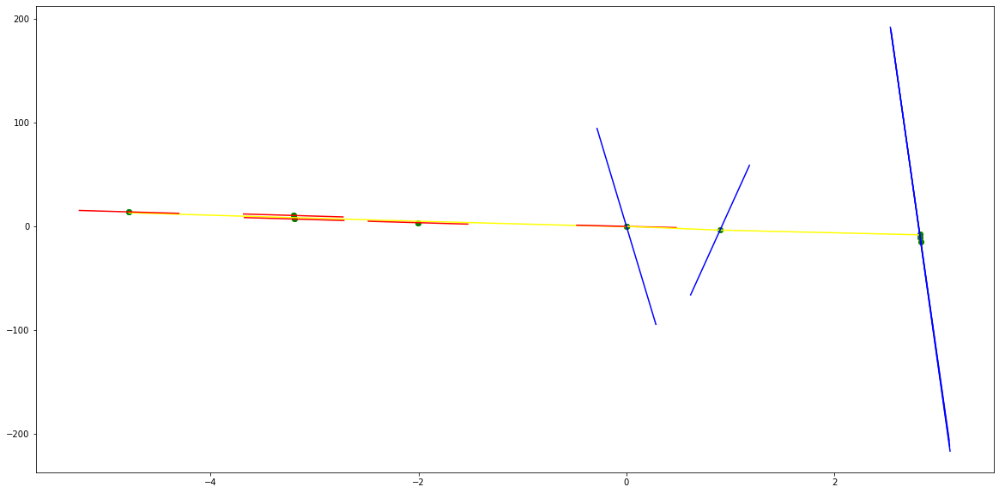

parameters (0.02613143566137974, 0.29681789774553347, -2.0783450839873034, 0.47514000904930204)
tangent[0]:-3.1942400688801573
tangent[1]:-3.1946471899405053
tangent[2]:-3.1411704076567766
tangent[3]:-2.549117911272111
tangent[4]:-2.0783450839873034
parameters (1682.8849199701606, -6891.076733855799, 7025.353436254199, 3.5442170860969185e-07)
tangent[0]:7025.353436254199
tangent[1]:-820.3481124970485
tangent[2]:-796.8706943973511
tangent[3]:-773.217947735945
tangent[4]:-749.3956118261331


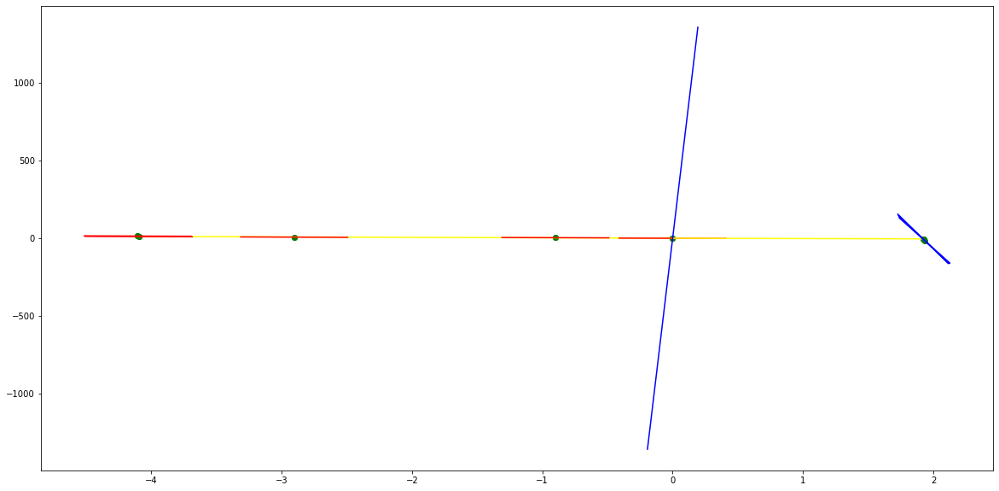

parameters (-116976.2747608158, -10446.488675614151, -527.1662254354682, 0.20416508064973718)
tangent[0]:-502.55538409899
tangent[1]:-265.8797172496429
tangent[2]:-224.1723068312902
tangent[3]:-377.4181087972952
tangent[4]:-527.1662254354682
parameters (-51795.36857930544, 8512.471631685838, -660.6937323515041, -1.4558939991824091)
tangent[0]:-660.6937323515041
tangent[1]:-592.464630976054
tangent[2]:-529.6147186863053
tangent[3]:-332.1864668534099
tangent[4]:-221.09135853137298


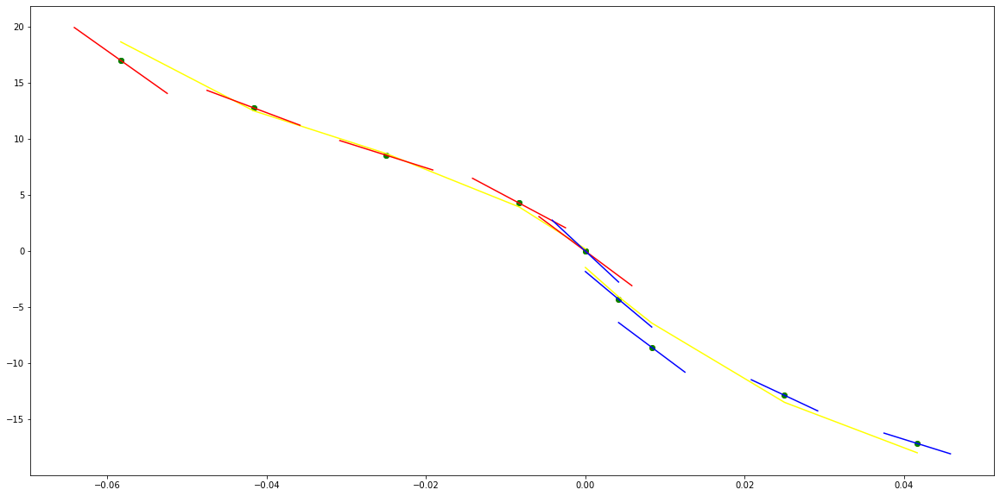

parameters (-13753.640824039425, -1729.7158215330476, -309.2841048619892, -0.16154476898298653)
tangent[0]:-262.0378869909219
tangent[1]:-239.46482888898012
tangent[2]:-239.81542241232808
tangent[3]:-263.08758347965147
tangent[4]:-309.2841048619892
parameters (-293.78502215600935, 51.29036015971889, -259.75941440770816, -0.0027059353457908786)
tangent[0]:-259.75941440770816
tangent[1]:-258.29453218687274
tangent[2]:-257.31935507891683
tangent[3]:-256.83376605790636
tangent[4]:-256.8378383263532


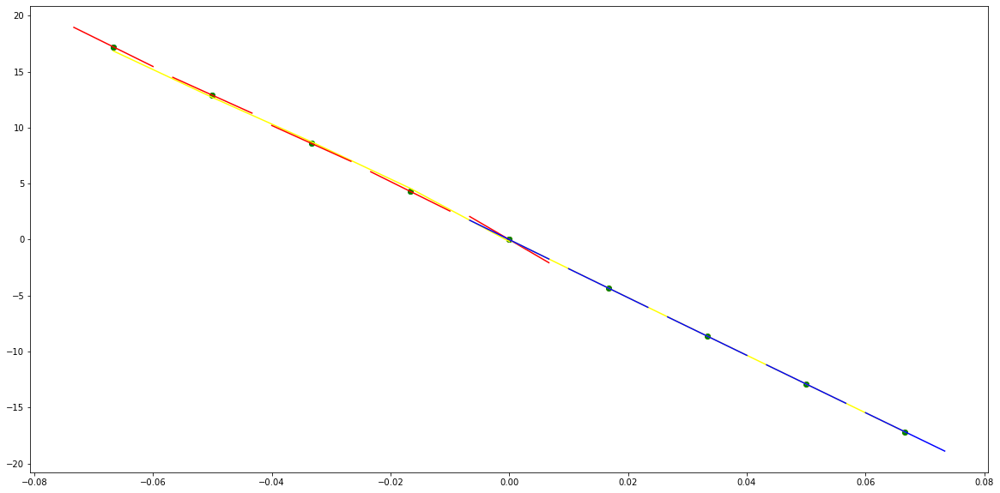

parameters (10220.636003351712, 2453.5949645984147, 259.16782047817986, -0.7196294757254628)
tangent[0]:68.29669893464495
tangent[1]:129.66456387377428
tangent[2]:185.89722328898972
tangent[3]:239.25197001043148
tangent[4]:259.16782047817986
parameters (1068.6215146686748, -255.72072579521904, 86.43623932704304, 0.9792272182859255)
tangent[0]:86.43623932704304
tangent[1]:84.36072907435684
tangent[2]:68.87882810753621
tangent[3]:67.35073960805948
tangent[4]:70.40352735535527


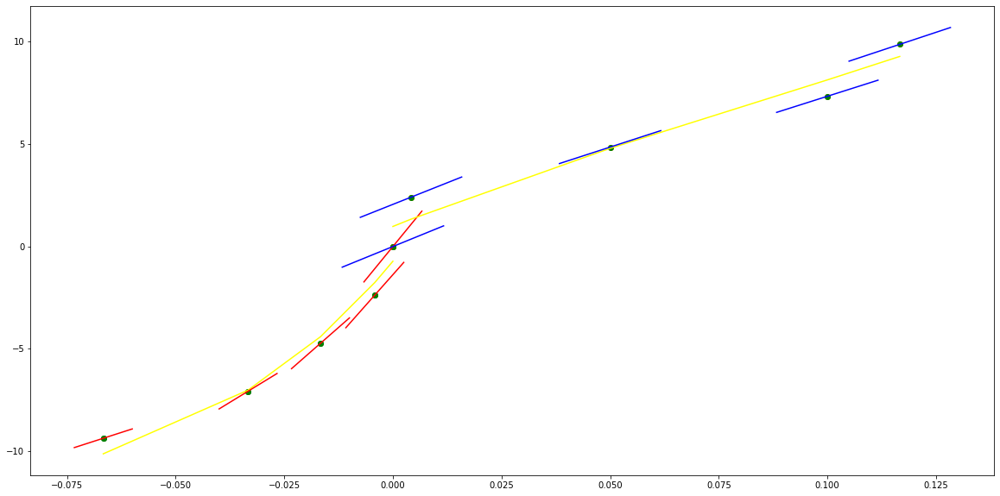

parameters (23049.40066180625, 3712.0529725600336, 240.47391696267428, -0.9907951390427285)
tangent[0]:280.4189295146226
tangent[1]:101.9929017998534
tangent[2]:42.13912467021777
tangent[3]:210.74519708716133
tangent[4]:240.47391696267428
parameters (-6981.189986299902, 1962.6365637077577, 47.73590303419638, 1.4367121143886803)
tangent[0]:47.73590303419638
tangent[1]:63.72885433210676
tangent[2]:165.48175005757548
tangent[3]:220.69526828879097
tangent[4]:227.22597946664933


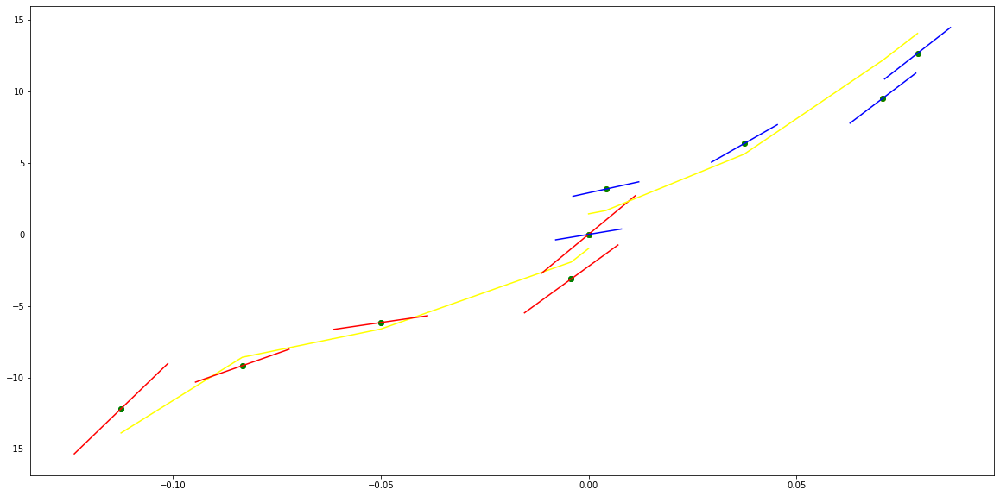

parameters (-6668.929364514012, -1540.8290039831734, 56.38044920228738, -0.9973359815397352)
tangent[0]:174.95533322398524
tangent[1]:174.9666167735894
tangent[2]:150.0479161347049
tangent[3]:80.67065624499696
tangent[4]:56.38044920228738
parameters (161951.30066563695, -18097.140792892278, 693.051013671715, 0.2757994500005909)
tangent[0]:693.051013671715
tangent[1]:550.665755528242
tangent[2]:425.1531238337516
tangent[3]:91.85266277517053
tangent[4]:158.04175219340414


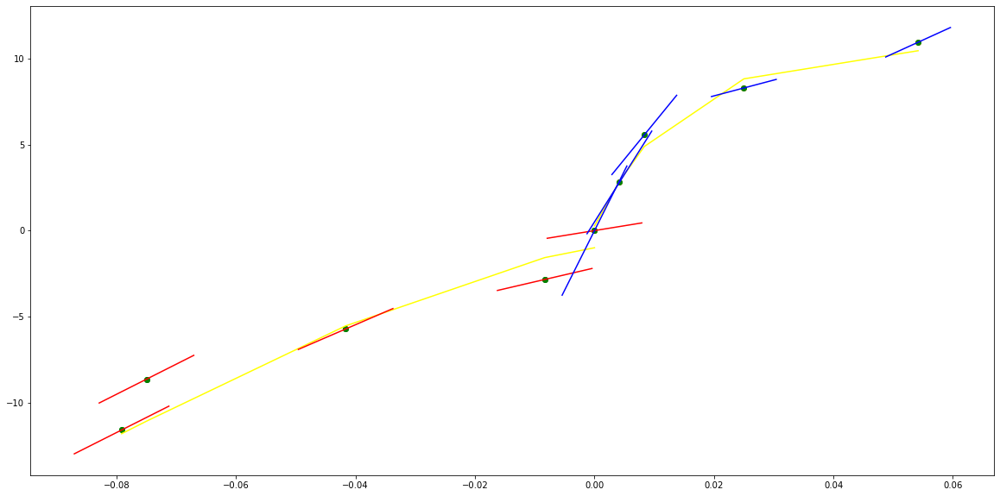

parameters (2780.1834074487133, 587.8961015483337, 90.4018561905865, -0.22449841546454904)
tangent[0]:60.90978121762713
tangent[1]:49.59159515346687
tangent[2]:54.0324648125304
tangent[3]:77.00766462411974
tangent[4]:90.4018561905865
parameters (107055.12380901538, -7392.338276283393, 321.3230319996919, 0.3386080146859711)
tangent[0]:321.3230319996919
tangent[1]:265.2919646652491
tangent[2]:220.42368886431933
tangent[3]:152.43447532742613
tangent[4]:185.3486841971323


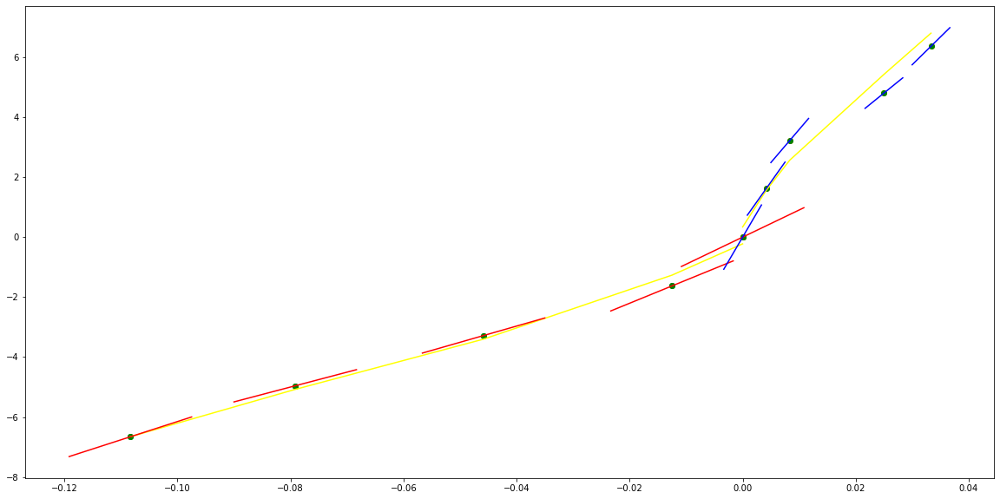

parameters (80634.11200923221, 10784.411587867557, 479.08985322608737, 0.6424022400490097)
tangent[0]:91.05823385001992
tangent[1]:186.80005852774877
tangent[2]:247.27680353372602
tangent[3]:316.1367421260135
tangent[4]:479.08985322608737
parameters (5209.990333341402, -642.0767748240407, 115.61772801686635, 1.1304390601756533)
tangent[0]:115.61772801686635
tangent[1]:110.53921116600173
tangent[2]:106.00220430899279
tangent[3]:93.8939091609694
tangent[4]:99.47349593010381


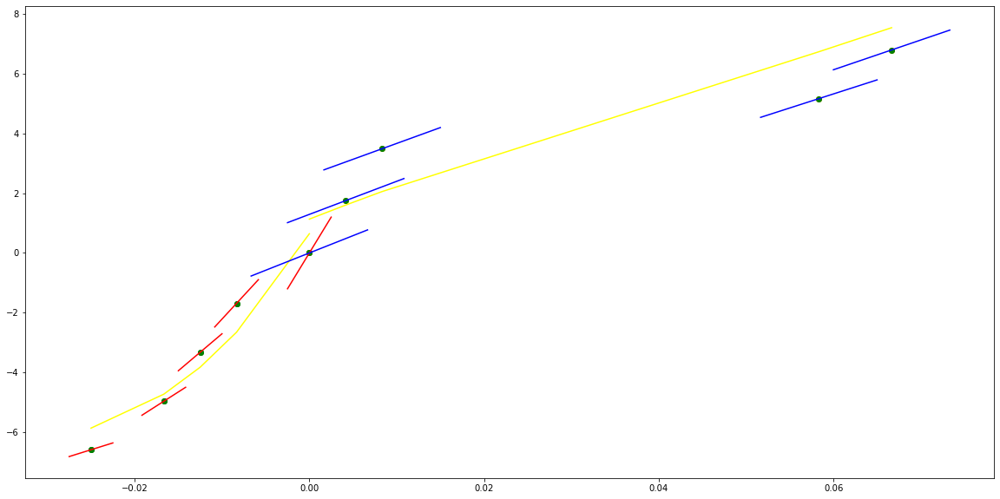

parameters (16.334785406582316, 23.25988578125864, 33.59262318321695, -1.0096225100649059)
tangent[0]:24.119261877121307
tangent[1]:26.027937991276637
tangent[2]:28.543344803835836
tangent[3]:33.20837673483855
tangent[4]:33.59262318321695
parameters (582.372453111237, -378.97194121409035, 100.03672296498159, 1.868100328174226)
tangent[0]:100.03672296498159
tangent[1]:96.90870755880081
tangent[2]:93.8420944810923
tangent[3]:61.76856665355033
tangent[4]:32.592446401048235


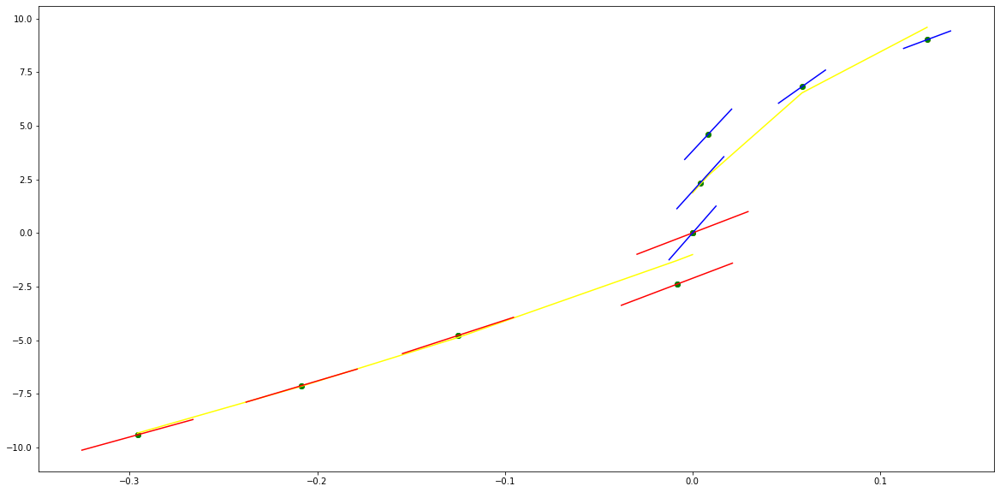

parameters (2.661843451718335, 5.705654241195503, 10.413238496133081, -0.6778760701730087)
tangent[0]:6.389160546654479
tangent[1]:7.044901840674398
tangent[2]:8.31566196076225
tangent[3]:10.365826233549651
tangent[4]:10.413238496133081
parameters (29080.43454291865, -3340.9815544075614, 168.45143818040611, 0.32660158930126537)
tangent[0]:168.45143818040611
tangent[1]:142.12850119972418
tangent[2]:45.46167917629489
tangent[3]:52.456541811539864
tangent[4]:62.478331922597675


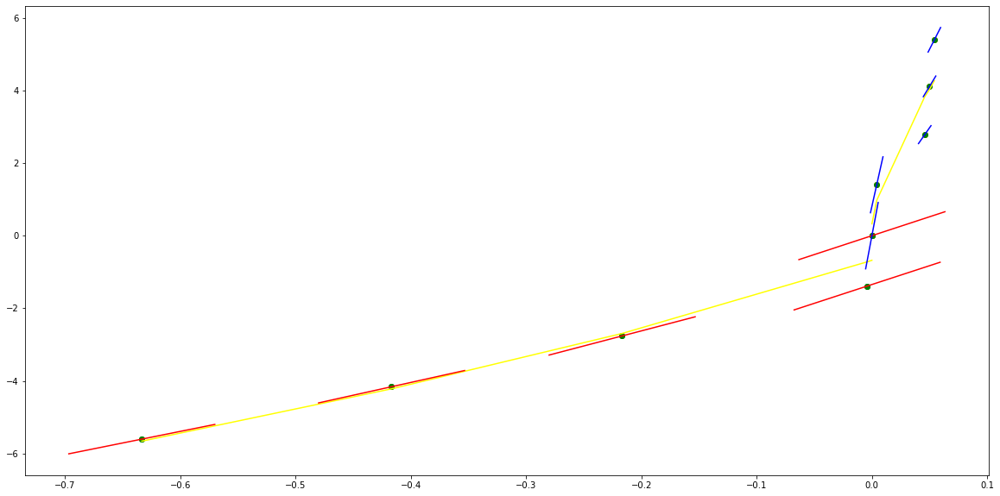

parameters (2016.217296167927, 266.9410668262264, 74.89106900915125, 0.05932168310420416)
tangent[0]:68.87357585805105
tangent[1]:63.81563511820126
tangent[2]:64.4650009881864
tangent[3]:65.3244230981548
tangent[4]:74.89106900915125
parameters (47138.04487871451, -6150.608617769786, 248.40042639653524, 0.06180268867367321)
tangent[0]:248.40042639653524
tangent[1]:199.6078763261465
tangent[2]:155.71402357081422
tangent[3]:56.8221731391306
tangent[4]:86.58740776239955


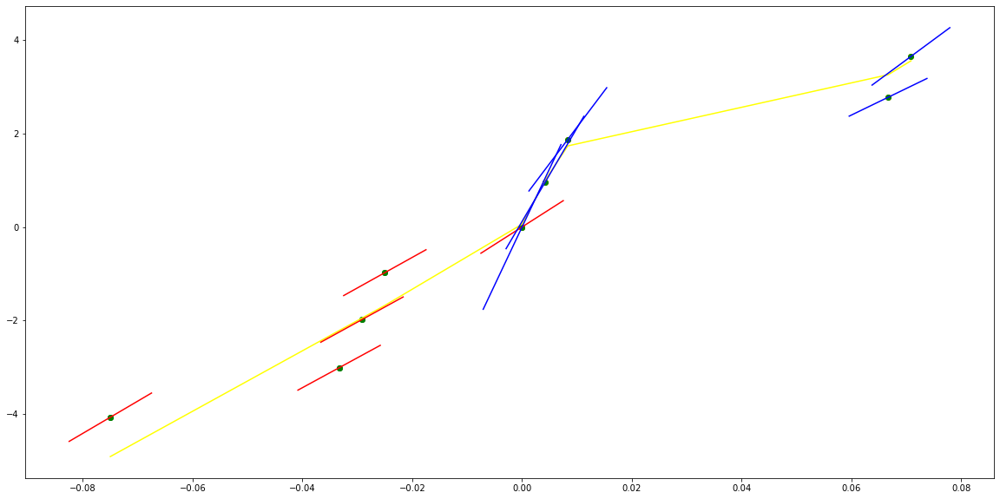

parameters (-8320.65275071166, -1534.7514750848554, -13.932174482639631, 0.015031322018155066)
tangent[0]:75.86953161182942
tangent[1]:77.13807739550845
tangent[2]:74.31566993350322
tangent[3]:70.62638912687257
tangent[4]:-13.932174482639631
parameters (32872.00720242794, -3778.024101089946, 184.3440167492313, 0.19380736256171913)
tangent[0]:184.3440167492313
tangent[1]:154.57032154355815
tangent[2]:128.22134164350598
tangent[3]:42.04844629731622
tangent[4]:39.67098955272826


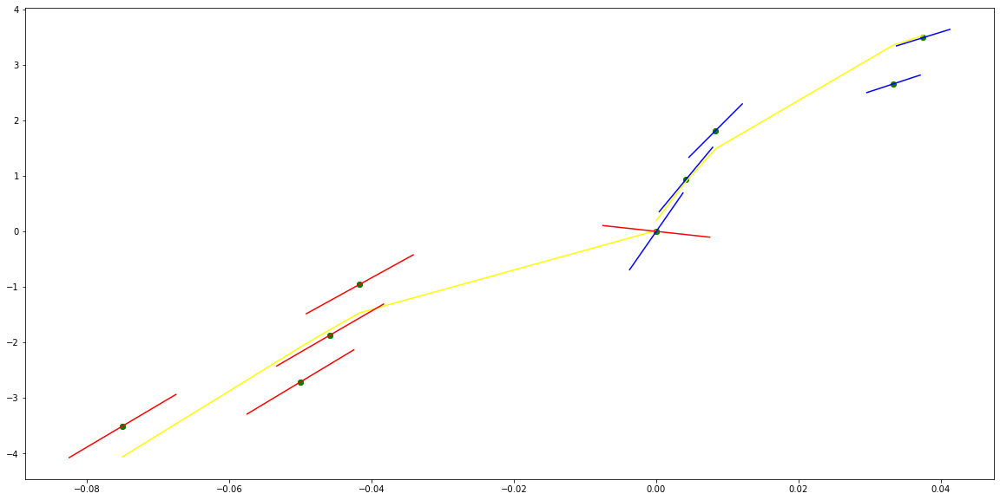

parameters (32937.19453860677, 5263.67916088926, 250.07979526840728, 0.11482677715874483)
tangent[0]:73.642528858079
tangent[1]:102.06907415229401
tangent[2]:133.9271261861477
tangent[3]:207.92804651137553
tangent[4]:250.07979526840728
parameters (16380.0970334415, -2292.4411523709896, 116.47495804322101, 0.21546977309144366)
tangent[0]:116.47495804322101
tangent[1]:98.2271954357139
tangent[2]:21.87407610748987
tangent[3]:29.216120090476736
tangent[4]:38.26625479859358


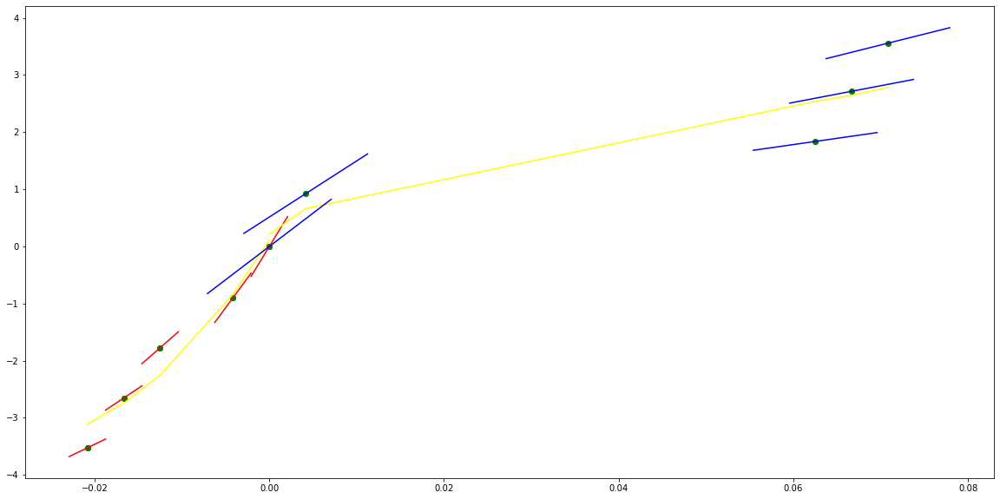

parameters (11.761804375031426, 16.77590091162364, 11.738027377034594, -0.4489273860718196)
tangent[0]:3.783479746684524
tangent[1]:5.064322599683315
tangent[2]:8.73570132596081
tangent[3]:11.598862968602422
tangent[4]:11.738027377034594
parameters (32605.884995122386, -3404.385824021596, 117.44587484020198, 0.198555294793508)
tangent[0]:117.44587484020198
tangent[1]:90.77221828621221
tangent[2]:73.99786162409296
tangent[3]:98.27497611060633
tangent[4]:125.94908040393202


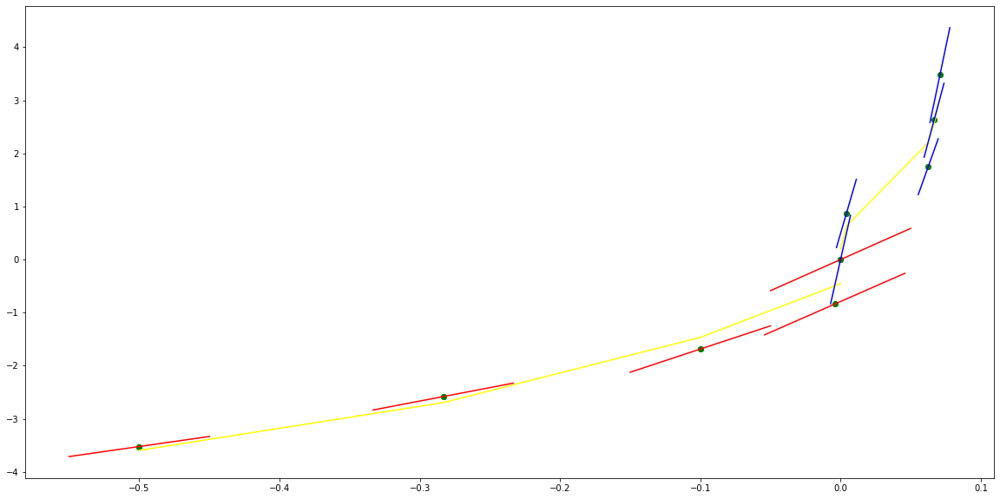

parameters (18453.81376766046, 3622.1552056869655, 207.443250070677, -0.1011069672787432)
tangent[0]:13.633636476472162
tangent[1]:27.48013343911805
tangent[2]:43.249210245093906
tangent[3]:178.22428149166782
tangent[4]:207.443250070677
parameters (28217.277778413772, -3168.8267727232405, 155.3171824953716, 0.26840297920020595)
tangent[0]:155.3171824953716
tangent[1]:130.37806520917576
tangent[2]:42.669979097971805
tangent[3]:50.06408856115087
tangent[4]:60.399390225750096


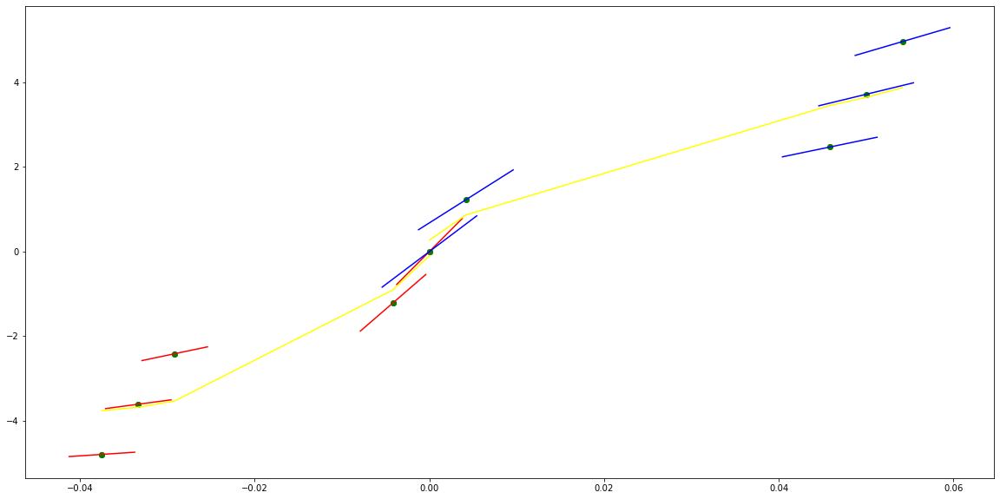

parameters (36303.24794992429, 4661.640542681939, 224.55933631864758, -0.12995173859229492)
tangent[0]:28.090622906245244
tangent[1]:34.79275160034001
tangent[2]:45.27822864227346
tangent[3]:187.60032073916219
tangent[4]:224.55933631864758
parameters (494.2604646176279, -340.39797184773164, 81.3380519563956, 0.5202933980188553)
tangent[0]:81.3380519563956
tangent[1]:78.52759055047707
tangent[2]:53.249956798349274
tangent[3]:51.00520825625465
tangent[4]:48.81247357901523


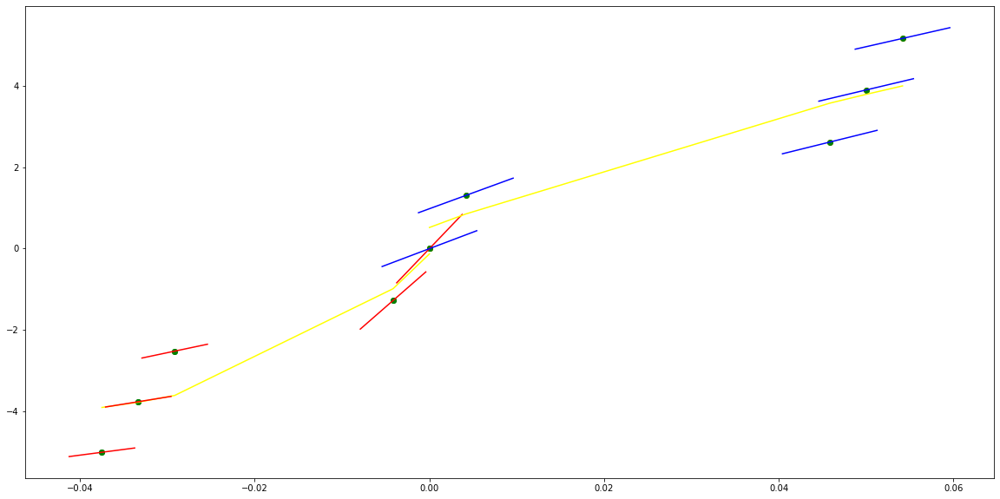

parameters (1386.471905159152, 924.3937202589993, 158.376073563981, -0.48890413709084246)
tangent[0]:110.16767902550694
tangent[1]:103.50183468701735
tangent[2]:-38.85348385008942
tangent[3]:150.74621405916028
tangent[4]:158.376073563981
parameters (31241.986355868525, -5451.932816184368, 291.4895490780417, 0.1427532116216375)
tangent[0]:291.4895490780417
tangent[1]:247.68058813762963
tangent[2]:53.1904753174004
tangent[3]:32.16421224806078
tangent[4]:14.396717803034448


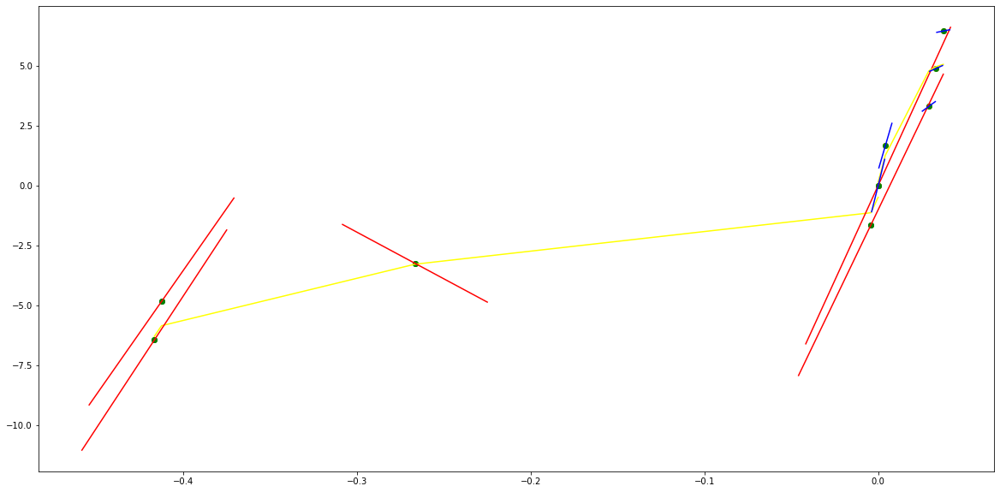

parameters (-14784.391136739316, -3409.5549413778526, -109.72814747774142, 0.007495590501690472)
tangent[0]:142.66662776288575
tangent[1]:147.75426466232932
tangent[2]:143.21163656082632
tangent[3]:137.1303658577383
tangent[4]:-109.72814747774142
parameters (36274.99214675802, -5928.4873666957465, 304.642111166142, 0.3311260178476101)
tangent[0]:304.642111166142
tangent[1]:257.1346723996409
tangent[2]:213.3946261722545
tangent[3]:-0.4643930946410251
tangent[4]:-16.707816528954538


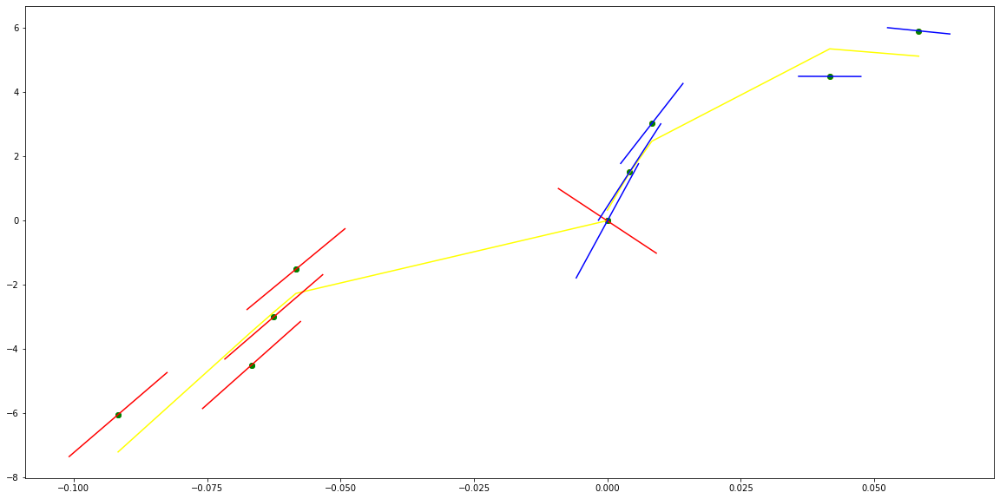

parameters (-139.3428821000432, -77.37249773457941, 12.534948075728952, -0.7653510173773812)
tangent[0]:26.76280131755553
tangent[1]:26.80749046607543
tangent[2]:19.22712623343657
tangent[3]:13.172360607273001
tangent[4]:12.534948075728952
parameters (15226.406272892451, -2595.8555290976133, 154.5326597455172, 0.27099463138046126)
tangent[0]:154.5326597455172
tangent[1]:133.69196865119193
tangent[2]:8.485167118773973
tangent[3]:11.43763912662726
tangent[4]:15.97644890482897


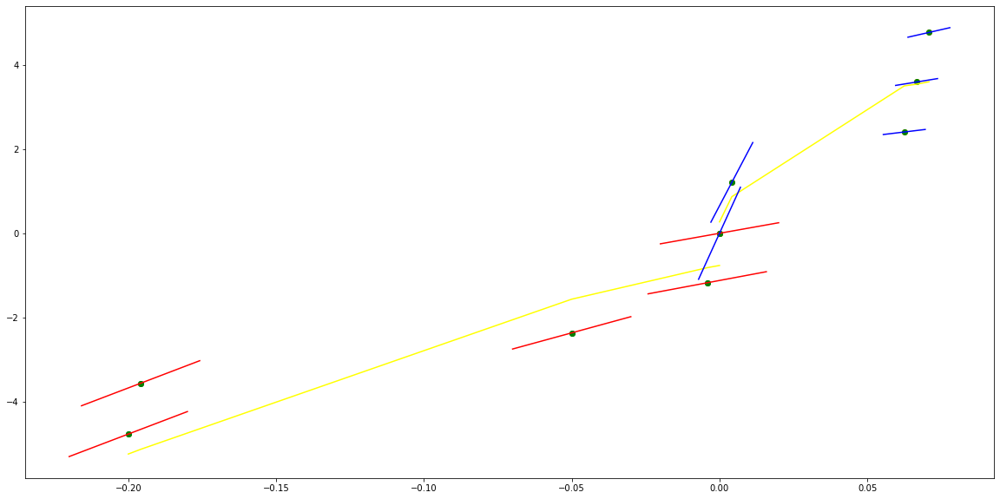

parameters (-594.0470693741893, -39.635322651279346, 65.61065260327015, 0.04750814052101264)
tangent[0]:53.28300089661635
tangent[1]:65.11883184809167
tangent[2]:65.50018440842041
tangent[3]:65.81957792398083
tangent[4]:65.61065260327015
parameters (31007.867428158017, -6927.439891255795, 432.4480803932999, 0.00256478928725694)
tangent[0]:432.4480803932999
tangent[1]:376.33004784402186
tangent[2]:323.45482275904254
tangent[3]:-67.64194558595983
tangent[4]:-55.924841759342314


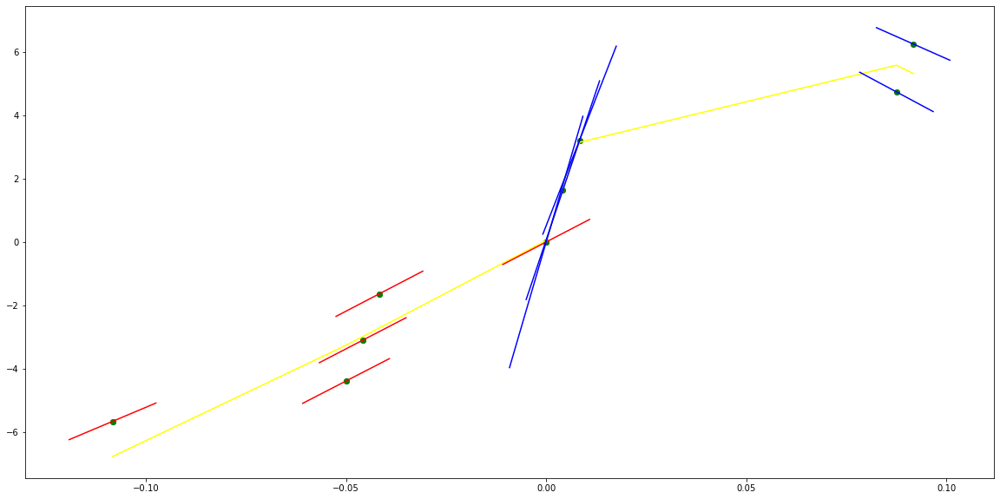

parameters (2811.2451597966233, 1563.6137822388785, 221.6680773193391, 0.00013967078415226978)
tangent[0]:126.88395625734859
tangent[1]:106.08848331405034
tangent[2]:68.0164438292071
tangent[3]:-12.52788629082886
tangent[4]:221.6680773193391
parameters (0.090222137355074, -0.6511423301782072, 2.9562864102017383, 0.24815497929045816)
tangent[0]:2.9562864102017383
tangent[1]:2.681897445870765
tangent[2]:2.1169595770436884
tangent[3]:1.6370497840520668
tangent[4]:1.3928570112070093


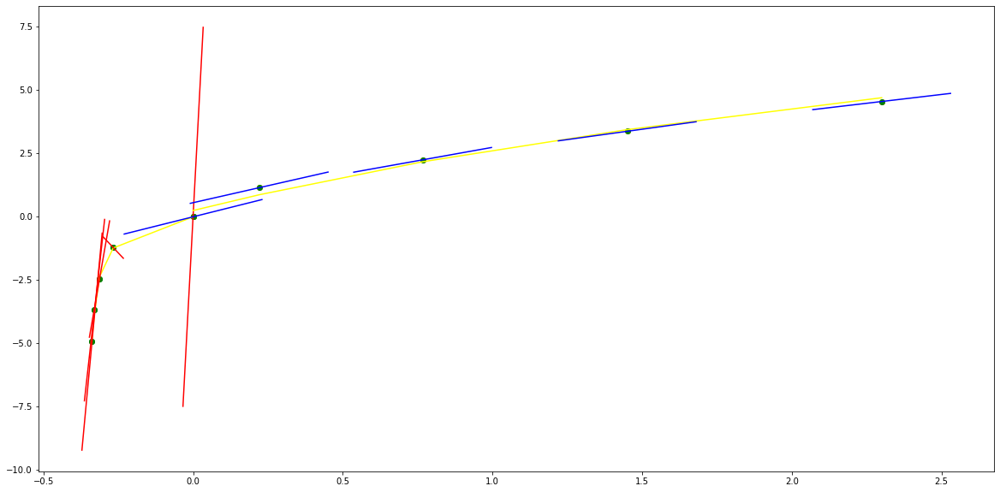

parameters (0.09022204876337513, 0.5217449066262697, 2.395565777783782, 0.08306557595063932)
tangent[0]:1.6370502423393791
tangent[1]:1.392857340478256
tangent[2]:1.4922501264599228
tangent[3]:1.8230508397741252
tangent[4]:2.395565777783782
parameters (60.713687855094086, -157.59858892338278, 89.74549834996283, -3.7268556671305524e-06)
tangent[0]:89.74549834996283
tangent[1]:-46.25814265679723
tangent[2]:102.75089995245737
tangent[3]:108.29970058112822
tangent[4]:111.11187897184136


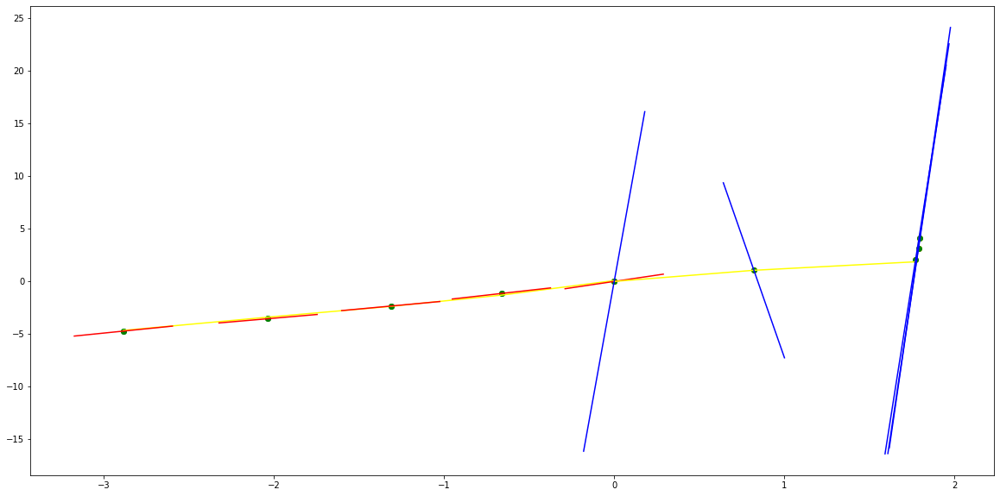

parameters (-0.002792336961757628, -0.03544977100173002, 1.5105985463204858, 0.06658671046819394)
tangent[0]:1.6447162931239132
tangent[1]:1.6237261835574592
tangent[2]:1.5973344340479678
tangent[3]:1.5631510781477282
tangent[4]:1.5105985463204858
parameters (-769.639844486887, 1608.3859607372342, -832.7771293349008, 4.4080598459434764e-05)
tangent[0]:-832.7771293349008
tangent[1]:139.3563171175972
tangent[2]:119.21161499886307
tangent[3]:108.65886260666525
tangent[4]:103.26158737389574


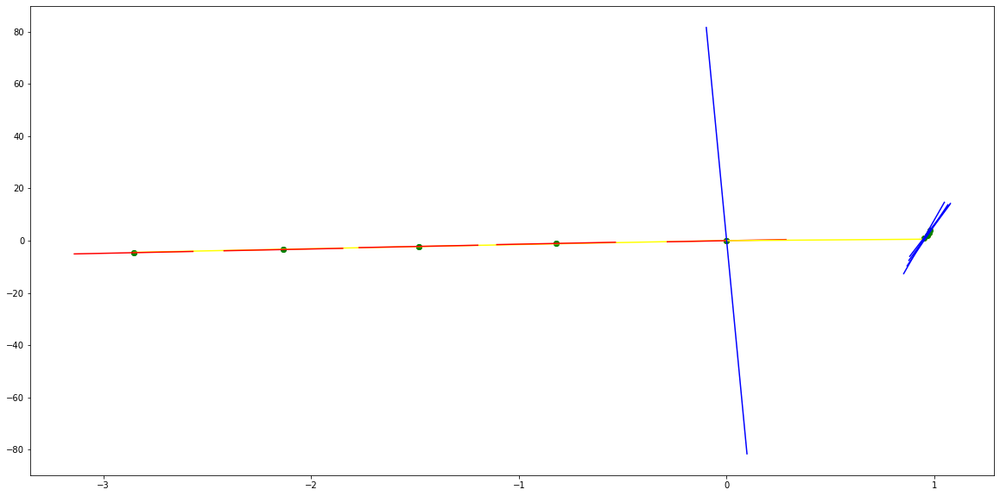

parameters (-0.005838760045287528, 0.09411701042846402, 2.0280301234817006, 0.222916590204748)
tangent[0]:1.5761082129027375
tangent[1]:1.5771872824896875
tangent[2]:1.5814969612243943
tangent[3]:1.715272186919096
tangent[4]:2.0280301234817006
parameters (443.01605892539817, -1671.1850257819178, 1570.4798989816225, 8.997518686682959e-07)
tangent[0]:1570.4798989816225
tangent[1]:-186.26637584280365
tangent[2]:226.81294993061215
tangent[3]:235.19939997508368
tangent[4]:243.63200490959002


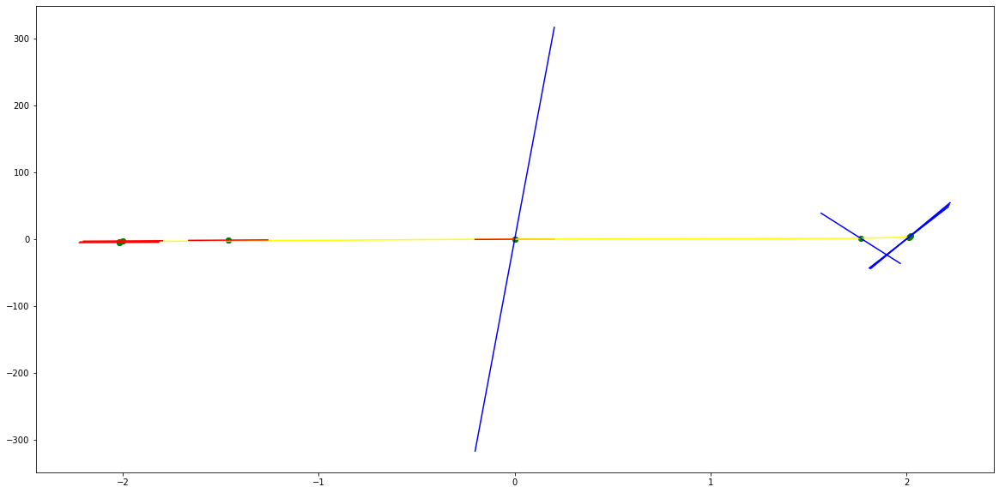

parameters (38965.780373151945, 4985.749721724475, 30.014845722457906, -0.06684333643142464)
tangent[0]:-181.4468650593821
tangent[1]:-179.52949745764295
tangent[2]:-172.48180835455577
tangent[3]:-161.37768686712576
tangent[4]:30.014845722457906
parameters (-4138.5052337865, 530.4637354411478, -111.29956591007651, -0.6341679559475591)
tangent[0]:-111.29956591007651
tangent[1]:-107.09426277542615
tangent[2]:-94.58577016267324
tangent[3]:-89.29198161936048
tangent[4]:-105.12229636853591


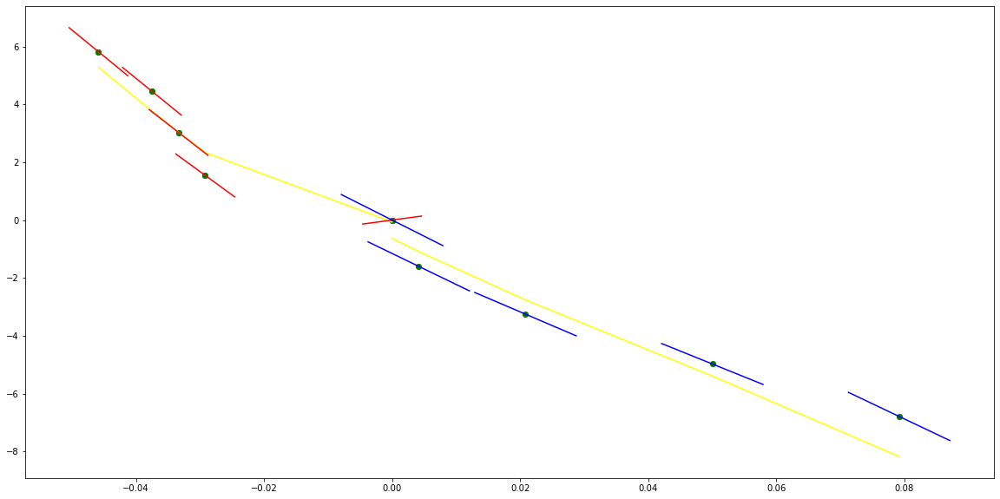

parameters (-3485.7540077059643, -504.9501834024673, -102.84845677591396, 0.6854697135298381)
tangent[0]:-88.43701785236792
tangent[1]:-80.57836362840982
tangent[2]:-80.80439549245303
tangent[3]:-98.8227034444535
tangent[4]:-102.84845677591396
parameters (-0.04545894522953882, 0.6506678985302307, -4.003517881123368, -1.9982466879378484)
tangent[0]:-4.003517881123368
tangent[1]:-3.9980975828892538
tangent[2]:-3.9602906895428394
tangent[3]:-2.6832268306988416
tangent[4]:-1.6417820597040622


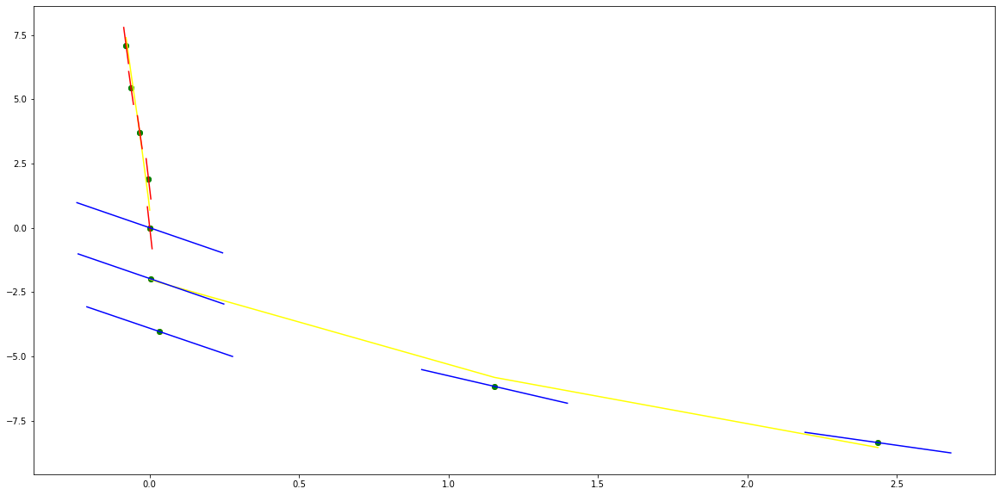

parameters (391.7420545191068, 1001.1779575227762, 628.311844829577, 4.715959332151023e-06)
tangent[0]:-114.24061448108228
tangent[1]:-117.22078169544307
tangent[2]:-120.16085616825194
tangent[3]:-139.59734945275977
tangent[4]:628.311844829577
parameters (0.007000731651953645, -0.14379041159267095, -0.8472974461536211, -0.3251113576808383)
tangent[0]:-0.8472974461536211
tangent[1]:-1.1817699763793834
tangent[2]:-1.5575757768199083
tangent[3]:-1.760146688183807
tangent[4]:-1.8313971213138283


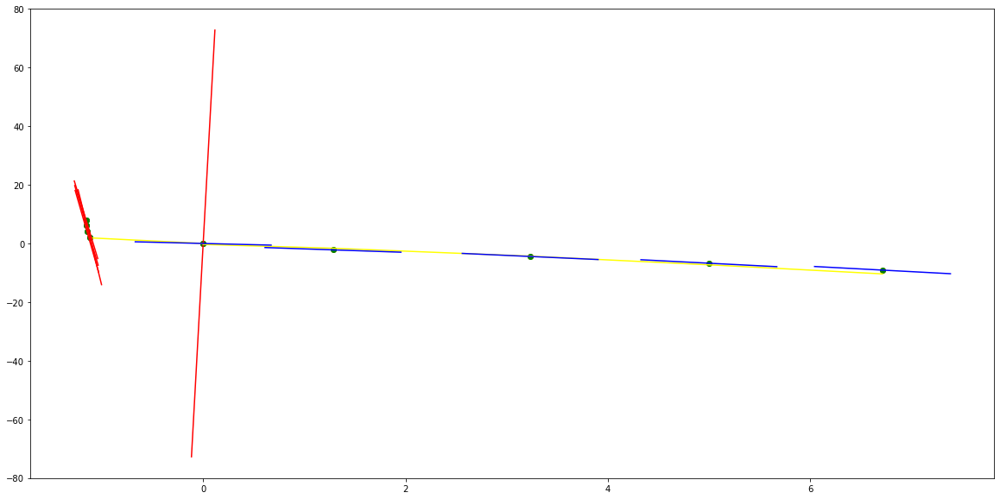

parameters (-32.23073397375619, -118.53272066792579, -100.73448715619895, 0.0004985535403132892)
tangent[0]:-97.37512672134778
tangent[1]:-96.4004398917017
tangent[2]:-89.67210915836142
tangent[3]:44.25281481986957
tangent[4]:-100.73448715619895
parameters (0.014155693535901587, -0.2415637195196131, -0.5941311402209658, -0.04571392245939826)
tangent[0]:-0.5941311402209658
tangent[1]:-1.3747485723366597
tangent[2]:-1.8031311079295347
tangent[3]:-1.9654481682507319
tangent[4]:-1.9660435390082434


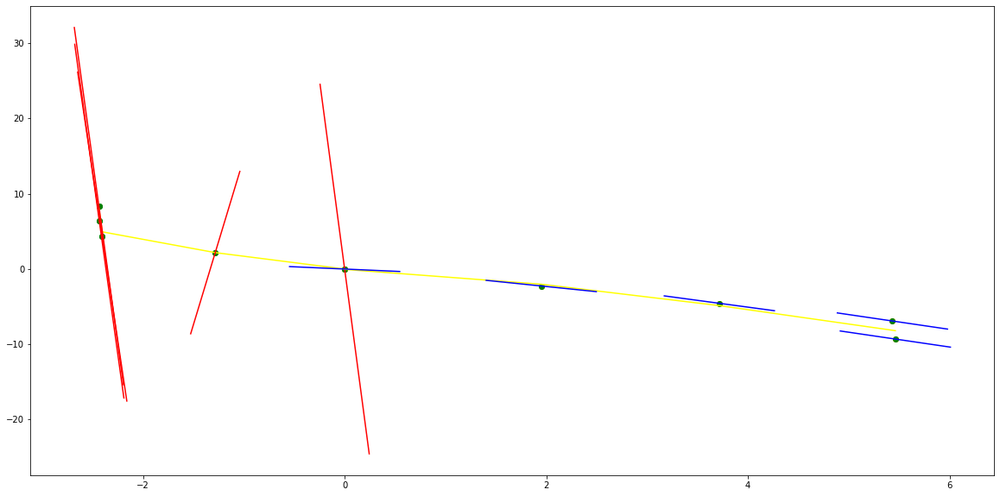

parameters (0.07339076885258107, 0.6596945335219365, -1.7636343287943257, -0.44085657992559263)
tangent[0]:-3.7294746216548518
tangent[1]:-3.7290647962729033
tangent[2]:-3.728647425898348
tangent[3]:-3.523547475840274
tangent[4]:-1.7636343287943257
parameters (2668.122414623241, -5976.730191256592, 3310.667668840632, 2.175695358192107e-07)
tangent[0]:3310.667668840632
tangent[1]:-604.0770563154178
tangent[2]:-586.4838611056452
tangent[3]:-568.6126920071997
tangent[4]:-532.0408876447523


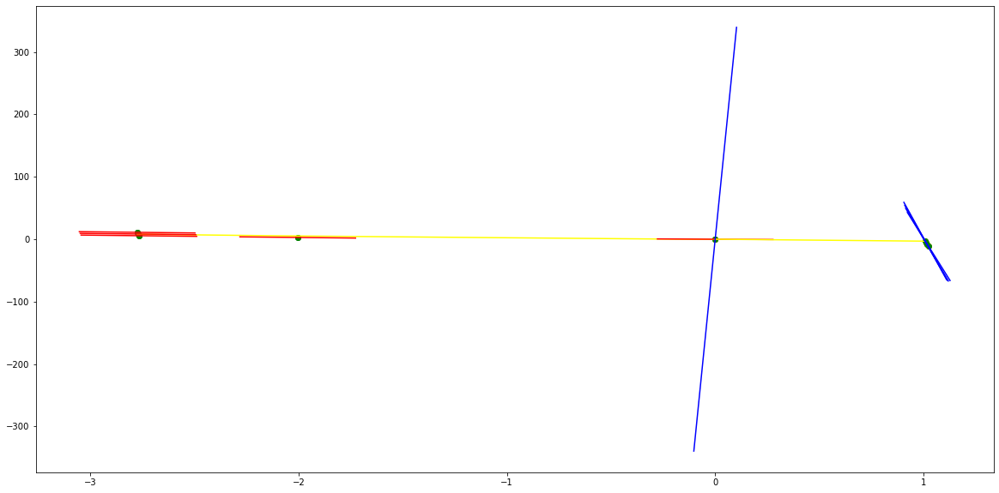

parameters (-0.1778751484383535, -0.942811337348657, -4.160695349680947, 1.5754715592550852)
tangent[0]:-4.655906050560298
tangent[1]:-3.3285405073073626
tangent[2]:-2.7985518519736843
tangent[3]:-4.152847225808483
tangent[4]:-4.160695349680947
parameters (-152031.64837098029, 6592.426061537151, -588.4934426811786, -0.13529396713623137)
tangent[0]:-588.4934426811786
tangent[1]:-541.4717458847302
tangent[2]:-494.94762631664685
tangent[3]:-495.43962042733904
tangent[4]:-511.76495928288074


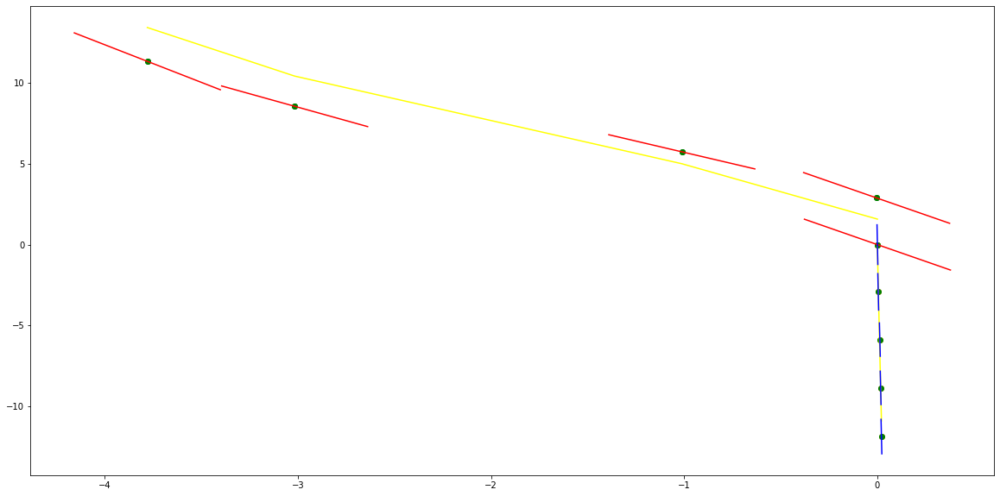

parameters (-78301.79596735814, -14194.562618970518, -967.7349010306672, -1.0175917740189944)
tangent[0]:-404.82263752093775
tangent[1]:-559.8274574153352
tangent[2]:-649.5748024161034
tangent[3]:-747.4798895789386
tangent[4]:-967.7349010306672
parameters (-83565.57887294929, 6635.780259607958, -640.3476135622828, -1.2782184607679787)
tangent[0]:-640.3476135622828
tangent[1]:-589.398091186022
tangent[2]:-547.163802622395
tangent[3]:-465.2440609686648
tangent[4]:-476.51304534101996


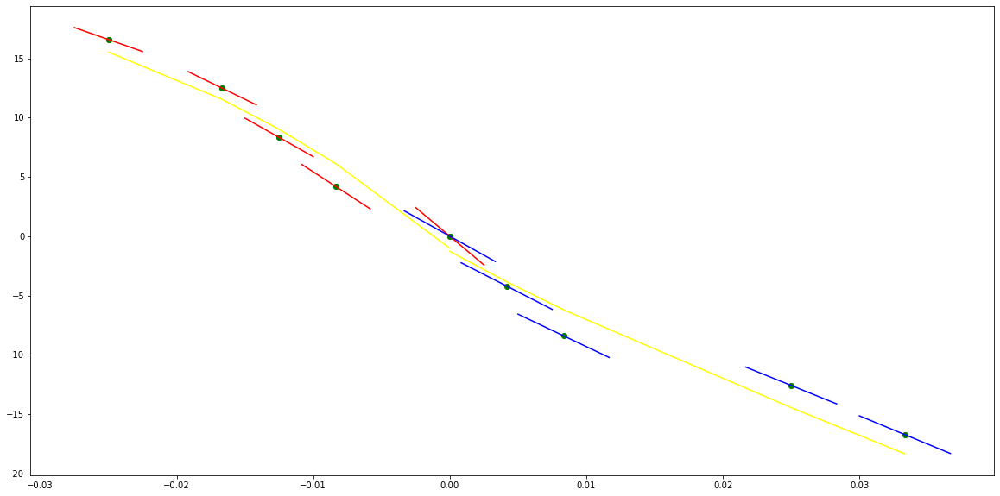

parameters (8166.08642169057, 1196.109522720016, -194.3525210367819, 0.1591853200379362)
tangent[0]:-244.95322124303715
tangent[1]:-252.71782514610422
tangent[2]:-246.872614809172
tangent[3]:-227.41671602488333
tangent[4]:-194.3525210367819
parameters (42.77577790507815, 69.84841917236325, -238.99138348818013, 0.009812580744651998)
tangent[0]:-238.99138348818013
tangent[1]:-236.6274083760275
tangent[2]:-234.19213744895268
tangent[3]:-231.68572323665572
tangent[4]:-229.1078649573999


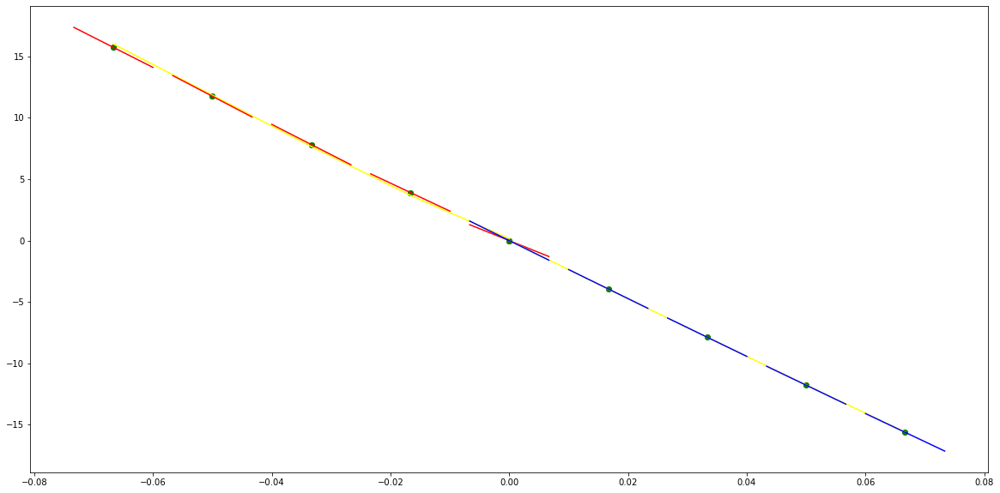

parameters (310511.60578105226, 23159.989516569367, 963.177722992652, -0.6960747980352989)
tangent[0]:454.21184714766446
tangent[1]:404.63250173399615
tangent[2]:529.7303002882861
tangent[3]:786.3374375295448
tangent[4]:963.177722992652
parameters (15104.725257385175, -2695.7098267494434, 386.2745062241646, 1.7457931770260886)
tangent[0]:386.2745062241646
tangent[1]:364.59529084626894
tangent[2]:256.91039212872124
tangent[3]:229.9889629796091
tangent[4]:251.67059098549169


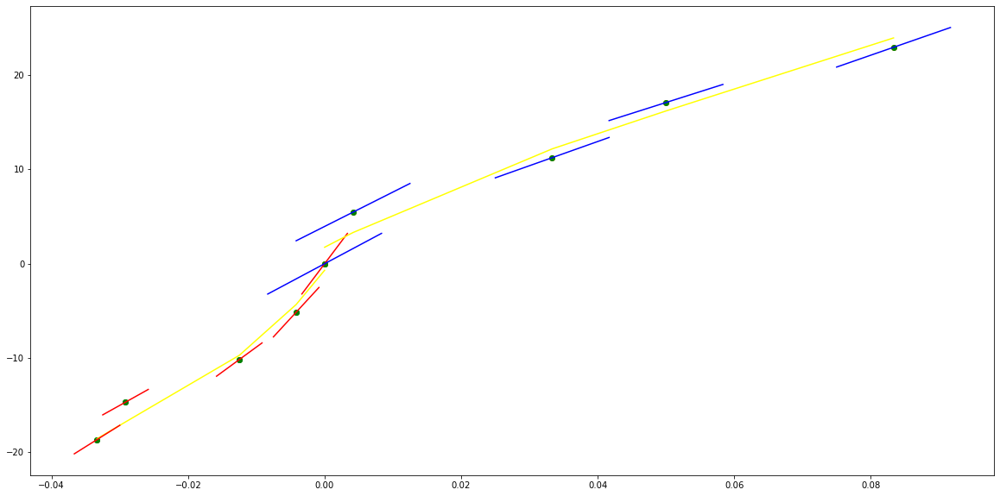

parameters (76.2237410411115, -37.77294030250325, 90.85762162676572, -0.20503322816088138)
tangent[0]:120.17948858376758
tangent[1]:113.73779460438413
tangent[2]:103.87384456369364
tangent[3]:96.04265016808073
tangent[4]:90.85762162676572
parameters (-18315.784422808007, -880.6682627987022, 1440.4701628495586, 0.008999304494927076)
tangent[0]:1440.4701628495586
tangent[1]:1432.178793017218
tangent[2]:1421.9774624173056
tangent[3]:1409.8679323313997
tangent[4]:1395.8537956561527


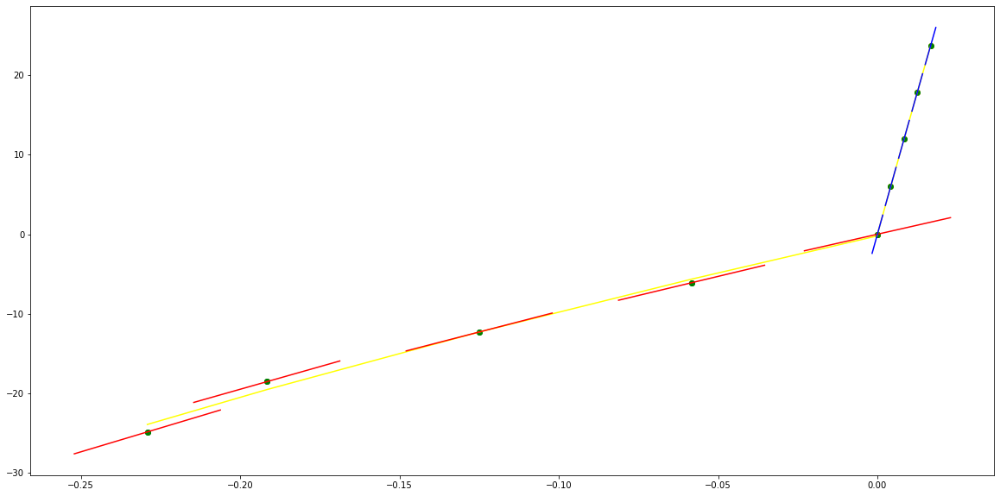

parameters (22503.893638032325, 755.6024750396753, -310.37258515542084, 0.8547635750463085)
tangent[0]:-285.7341012150493
tangent[1]:-297.0167753110268
tangent[2]:-318.71394688858504
tangent[3]:-315.4975108488057
tangent[4]:-310.37258515542084
parameters (2883.2196967417535, -248.93615783218436, -116.36877752131616, -1.1088156025614946)
tangent[0]:-116.36877752131616
tangent[1]:-118.29321974035908
tangent[2]:-121.01773286216438
tangent[3]:-119.63824557897144
tangent[4]:-117.95837485511748


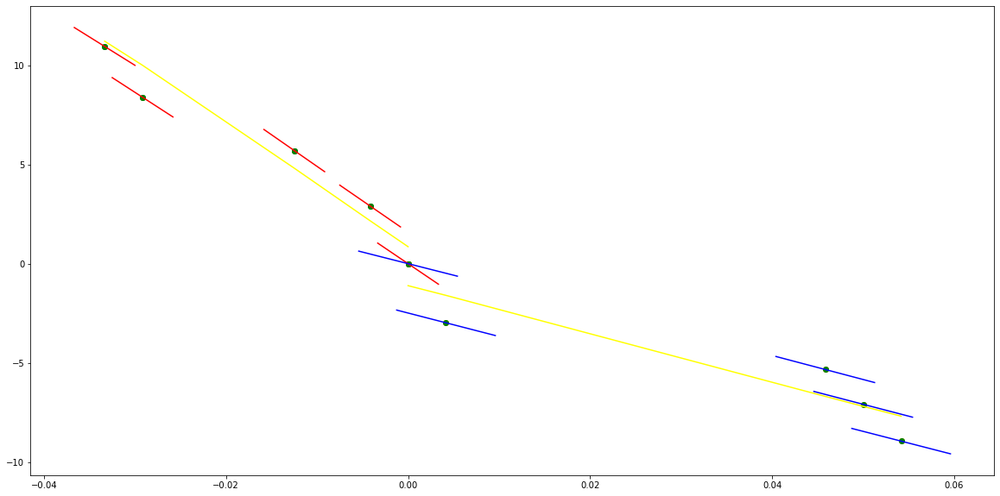

parameters (438.5771842844856, -237.92736826296345, 7.764136081133072, -0.2457609189047979)
tangent[0]:91.18067990913538
tangent[1]:87.8042836602092
tangent[2]:50.854231305378285
tangent[3]:22.762702287592756
tangent[4]:7.764136081133072
parameters (30009.803752624382, -3350.0480128755044, 156.11002688089087, 0.20692454264532156)
tangent[0]:156.11002688089087
tangent[1]:129.75398744540348
tangent[2]:106.52966899337852
tangent[3]:32.80640458636687
tangent[4]:31.460285496612144


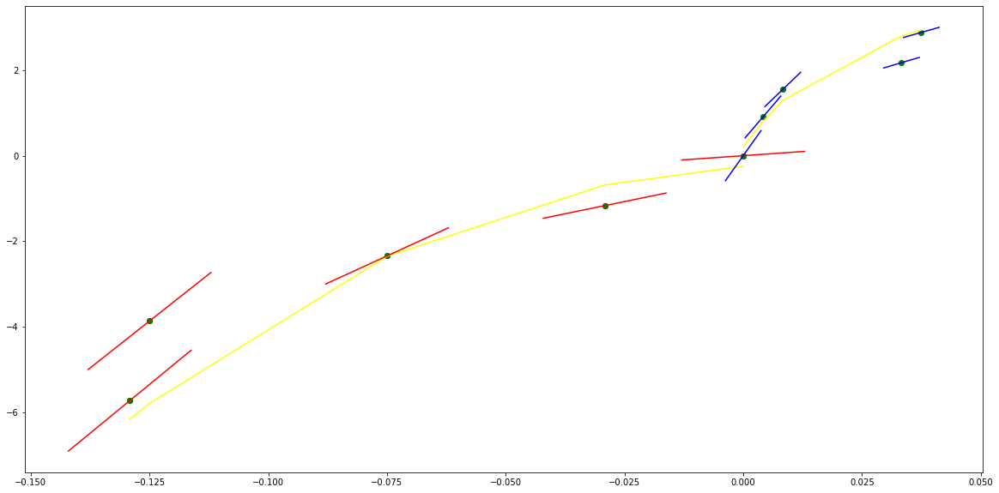

parameters (11694.300136273267, 1953.6544902710757, 106.77345087393367, -0.1891173227904123)
tangent[0]:33.48737133152197
tangent[1]:24.7949753913163
tangent[2]:17.322578099994146
tangent[3]:91.10086994051133
tangent[4]:106.77345087393367
parameters (16144.480988288647, -2808.3403021672007, 147.634633435529, 0.08292348700821296)
tangent[0]:147.634633435529
tangent[1]:125.0709182847973
tangent[2]:25.015912871208315
tangent[3]:14.22767918552816
tangent[4]:5.118639942331697


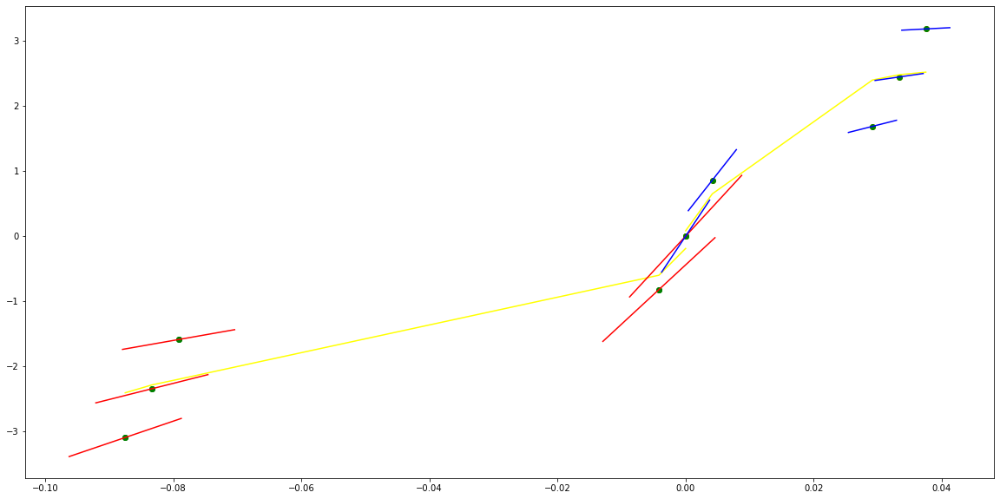

parameters (3391.727641971199, 513.8206263859204, 34.049080709713955, 0.0008035686590167619)
tangent[0]:52.65359545731925
tangent[1]:47.219098678975804
tangent[2]:42.13796339439288
tangent[3]:8.895883410837062
tangent[4]:34.049080709713955
parameters (9183.485205223084, -2263.5559866263247, 184.24656091341552, 0.014265823619705345)
tangent[0]:184.24656091341552
tangent[1]:165.86046837408165
tangent[2]:148.43520986969708
tangent[3]:116.44639611213418
tangent[4]:101.89051756012157


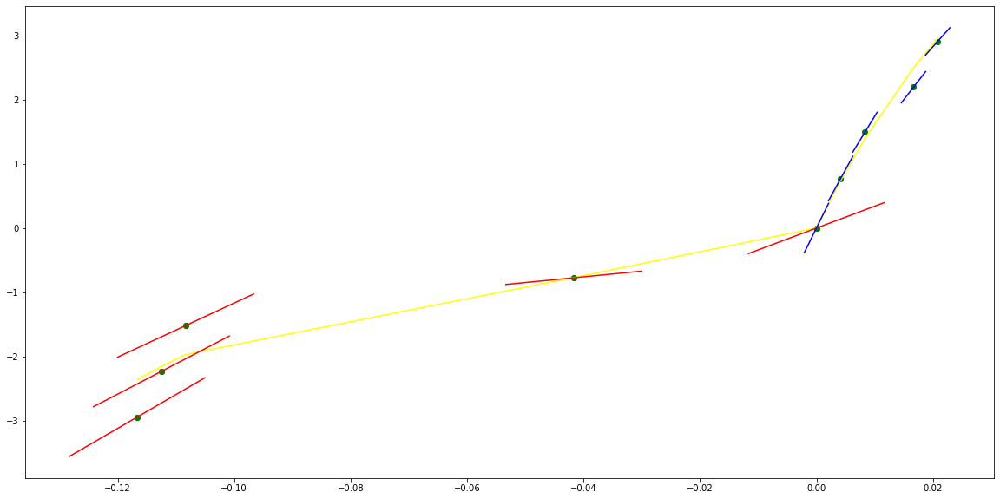

parameters (26939.926877095073, 4168.386749670785, 218.3865483290069, -0.11486207167542048)
tangent[0]:19.410358616442835
tangent[1]:30.29483754629271
tangent[2]:43.98238556267884
tangent[3]:185.05055885713656
tangent[4]:218.3865483290069
parameters (-4.264383661471374, 4.837893312731789, 10.174045686468933, 0.5967148711622797)
tangent[0]:10.174045686468933
tangent[1]:10.214142550483587
tangent[2]:11.517946220282605
tangent[3]:11.925398085510736
tangent[4]:11.980263665138438


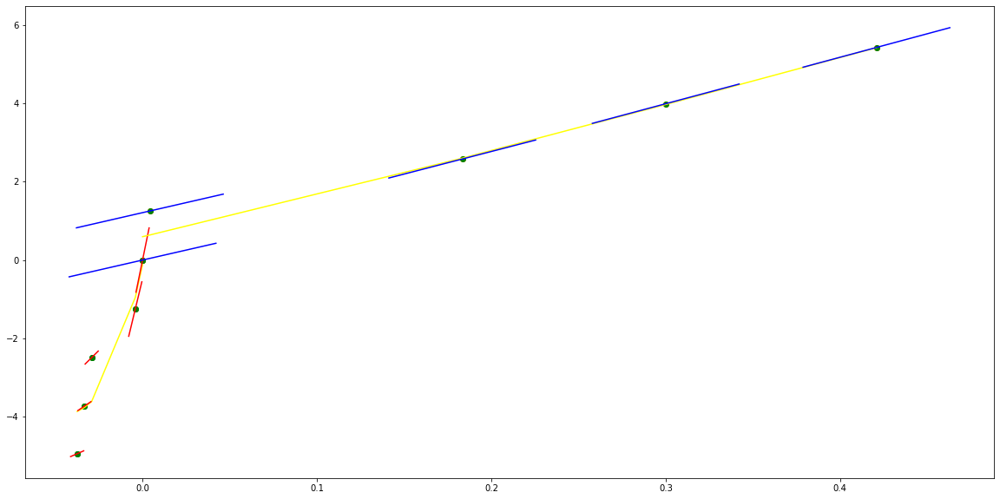

parameters (1.0468826962125364, 3.9645998793060975, 8.930770882079278, -1.1851153217361716)
tangent[0]:4.170557258238118
tangent[1]:5.464316702155411
tangent[2]:7.92938035529387
tangent[3]:8.897792343578677
tangent[4]:8.930770882079278
parameters (-6216.3337735971745, 2190.9069491701985, -136.05102287811692, 1.0755422907860568)
tangent[0]:-136.05102287811692
tangent[1]:-118.11582355262757
tangent[2]:120.87661771890996
tangent[3]:121.32697963105826
tangent[4]:121.12970316541632


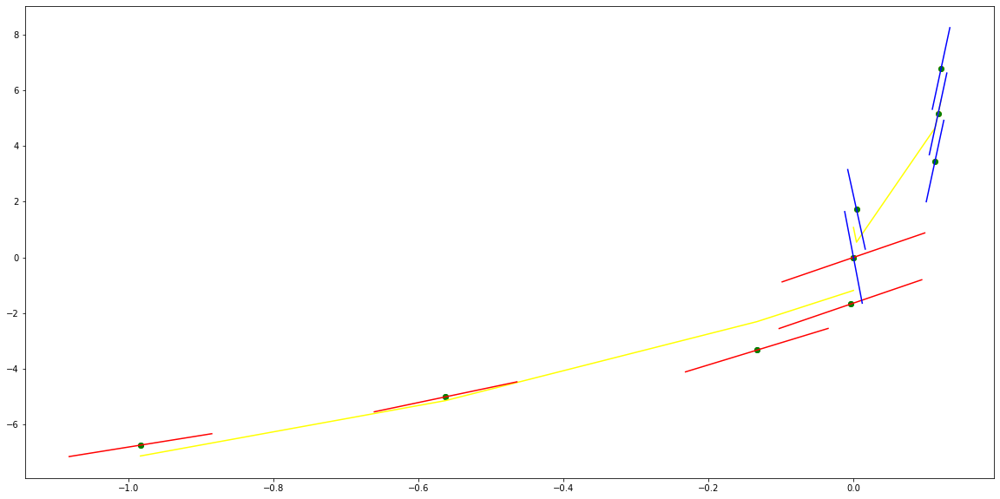

parameters (-1799.6151717497885, -693.3419158583591, 7.7808028946183745, 0.03910326042501741)
tangent[0]:95.45359541037439
tangent[1]:78.91607615838268
tangent[2]:76.23174499772355
tangent[3]:73.35930208297043
tangent[4]:7.7808028946183745
parameters (1271.0125824093584, -899.8144916101554, 157.70341340027744, 0.2457835463609719)
tangent[0]:157.70341340027744
tangent[1]:150.2705685913941
tangent[2]:108.45743901753883
tangent[3]:101.95300437687752
tangent[4]:95.57941086155526


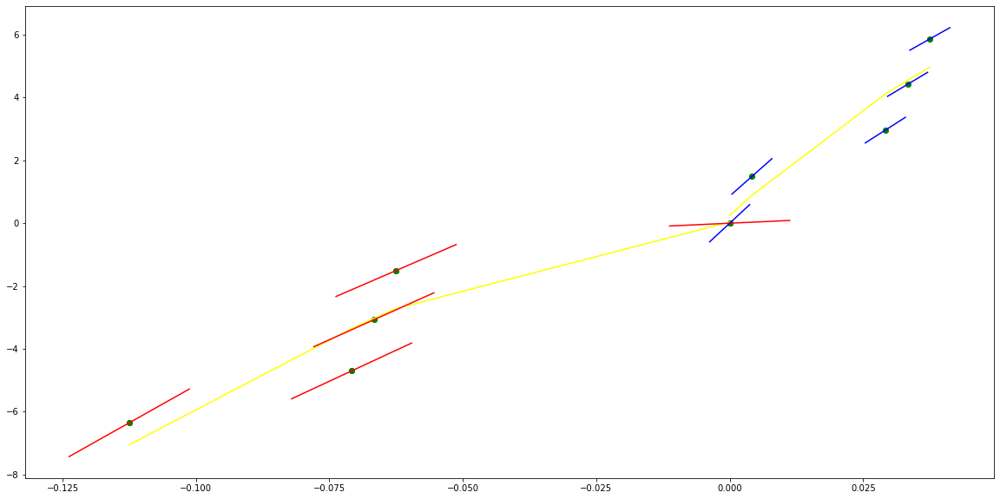

parameters (-6197.644568439952, -2695.644713218737, -252.5588504688197, 0.0005620006801201714)
tangent[0]:110.9155257648222
tangent[1]:134.94762228793078
tangent[2]:136.6935276306073
tangent[3]:137.79355512710455
tangent[4]:-252.5588504688197
parameters (0.32046468722515303, -1.5747095172487304, 5.459702630454367, 0.06281919615287569)
tangent[0]:5.459702630454367
tangent[1]:4.8224597054925855
tangent[2]:4.098141534286363
tangent[3]:3.4585157643935664
tangent[4]:3.0282313047742875


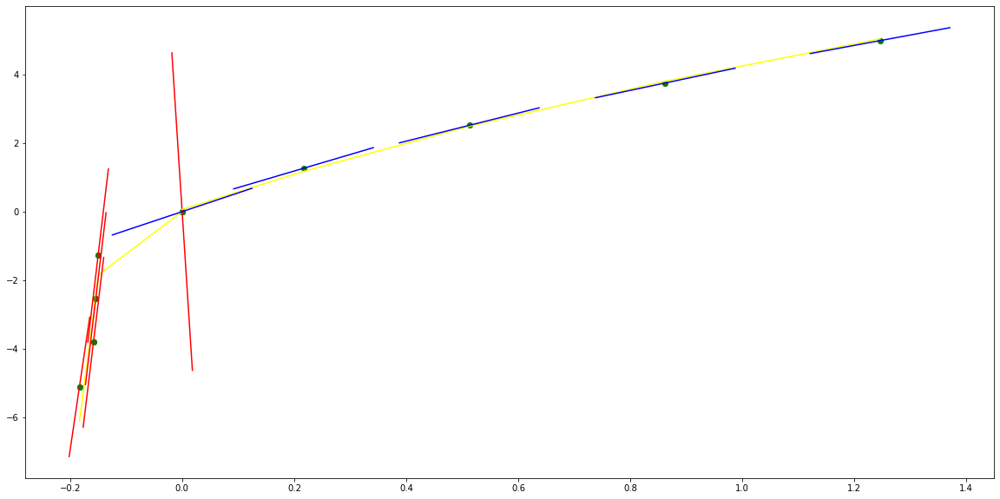

parameters (0.17025676773459708, 0.7341236651343606, 3.9918149659936897, -0.6319920134222544)
tangent[0]:2.955390507864166
tangent[1]:3.07511033796668
tangent[2]:3.451486110561035
tangent[3]:3.9857056483273094
tangent[4]:3.9918149659936897
parameters (15209.414863045607, -3314.183798336432, 201.98928630748878, 0.11235890934436192)
tangent[0]:201.98928630748878
tangent[1]:175.16116230646358
tangent[2]:47.476270017999155
tangent[3]:31.74294479515649
tangent[4]:17.59022038573005


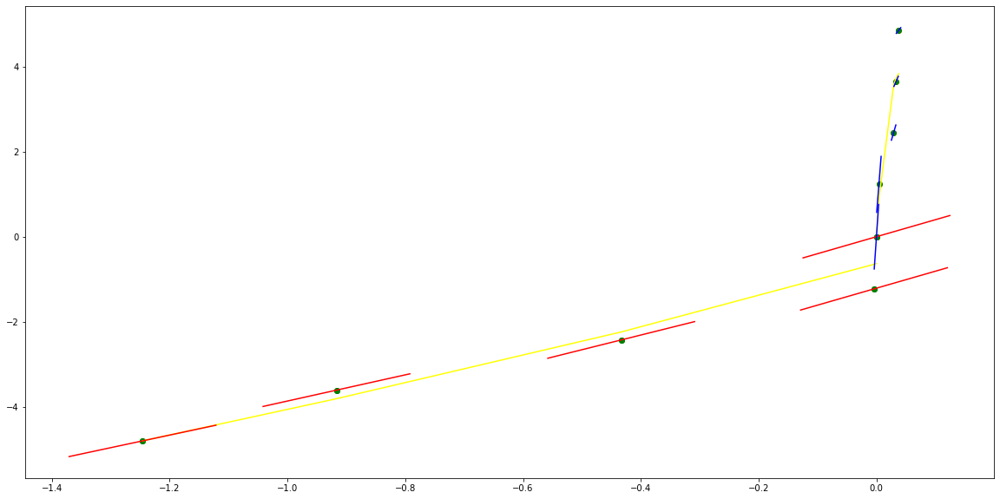

parameters (846.7922071582019, 383.467789880955, 54.45079657295441, 0.006034373942348397)
tangent[0]:66.33146595859546
tangent[1]:4.93214713386255
tangent[2]:3.7613354890360924
tangent[3]:2.678745479556646
tangent[4]:54.45079657295441
parameters (0.042663765010273184, -0.4514877315773541, 3.9569507085283755, 0.05493319915845332)
tangent[0]:3.9569507085283755
tangent[1]:3.7010222034805063
tangent[2]:3.448788581578604
tangent[3]:3.1499368749874104
tangent[4]:2.907910544457377


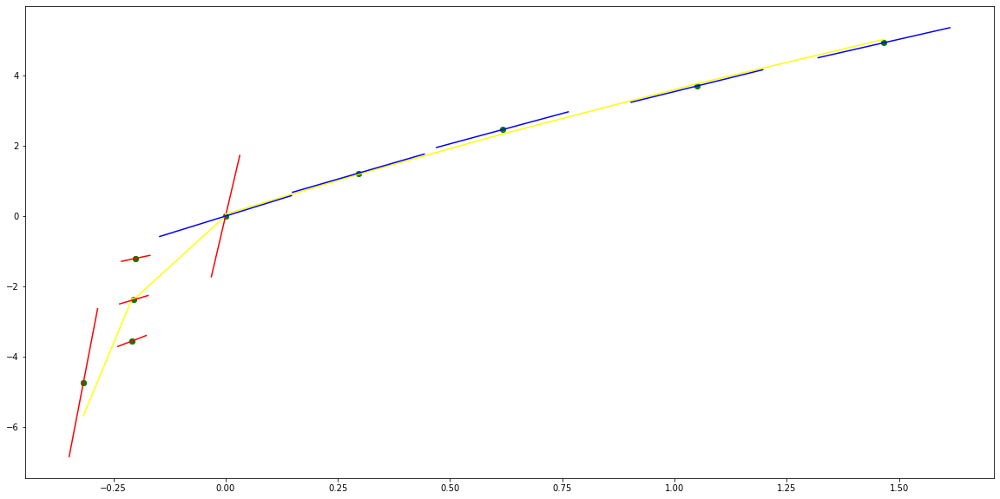

parameters (0.017306805380108665, 0.0003605514498917132, 2.5928862052132486, -0.0019109100628995957)
tangent[0]:2.7822395750510034
tangent[1]:2.7060560092981034
tangent[2]:2.634680080654969
tangent[3]:2.6057200068770543
tangent[4]:2.5928862052132486
parameters (105.01589132822004, -162.69571975387788, 56.7268058306961, -1.469004953242847e-05)
tangent[0]:56.7268058306961
tangent[1]:-26.947079143705103
tangent[2]:71.00797660838145
tangent[3]:72.47971421005388
tangent[4]:73.96274467815232


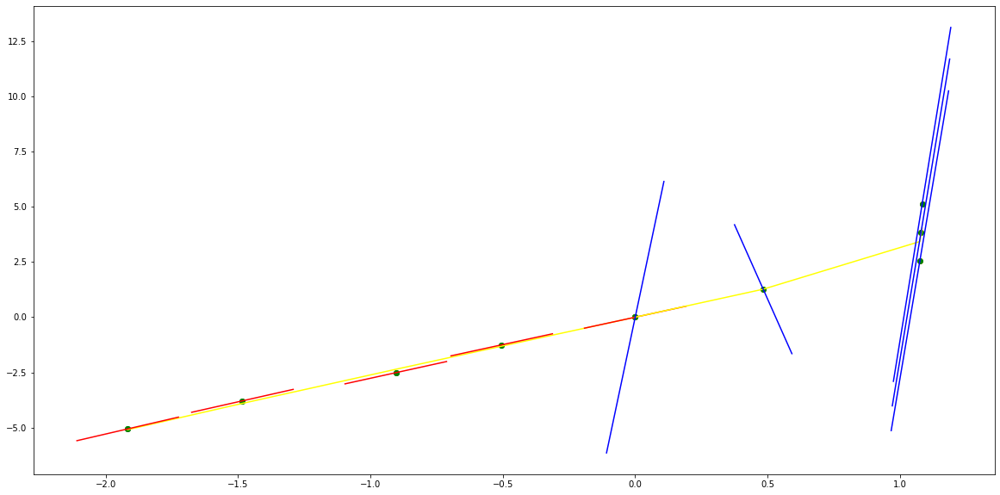

parameters (-0.007860691517767068, -0.11837932383403682, 2.2856163970529293, 0.03254062573631104)
tangent[0]:2.661827907757791
tangent[1]:2.60068960775998
tangent[2]:2.51287990839045
tangent[3]:2.4174433028032127
tangent[4]:2.2856163970529293
parameters (1196.2865390751654, -630.7733610300154, 114.37205869512759, 0.7169499125479947)
tangent[0]:114.37205869512759
tangent[1]:109.1787417050884
tangent[2]:104.10879628479846
tangent[3]:60.266871635189794
tangent[4]:56.568673561686744


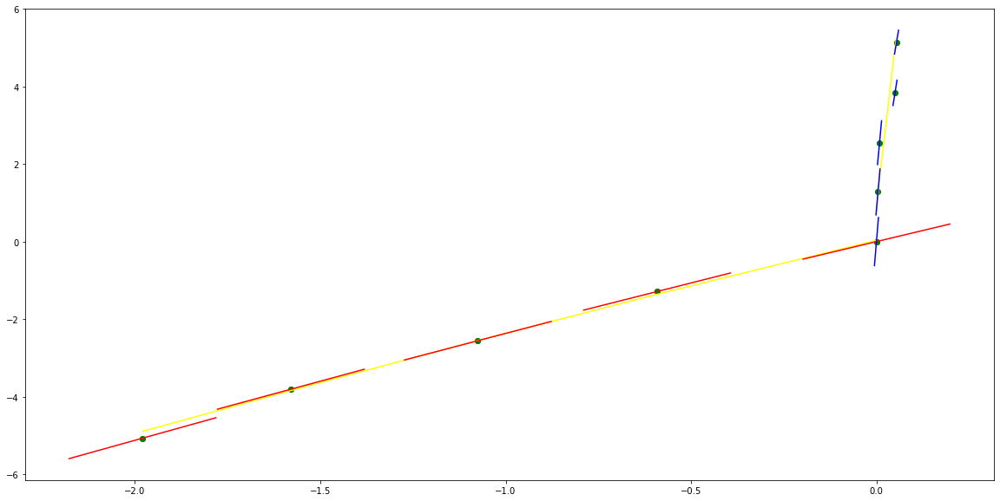

parameters (22877.944782029397, 3380.029304047476, 183.43765814088323, -0.2415297775390198)
tangent[0]:18.641618434669226
tangent[1]:17.01931360135609
tangent[2]:17.780509330502667
tangent[3]:156.46024420218143
tangent[4]:183.43765814088323
parameters (25.27531763762797, -50.4377302798831, 31.719924920273435, 0.9270401201902279)
tangent[0]:31.719924920273435
tangent[1]:31.300893509550587
tangent[2]:26.478282038423288
tangent[3]:22.749109721850303
tangent[4]:19.617907338055343


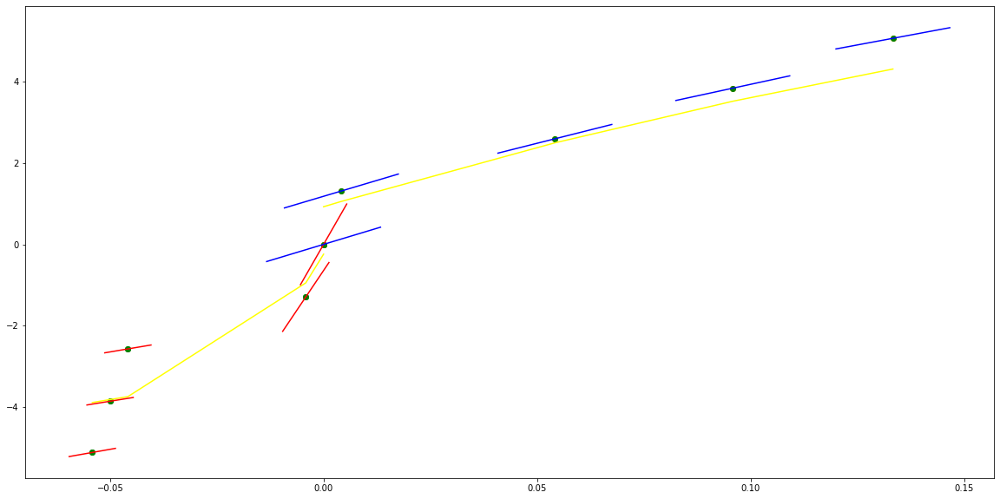

parameters (1.042714534254261, 2.9129197621704694, 3.780682587119646, 0.04724006528772631)
tangent[0]:6.23722215260519
tangent[1]:6.104050670941451
tangent[2]:1.767944686197347
tangent[3]:1.3155275684653116
tangent[4]:3.780682587119646
parameters (51.238248737405364, -121.37279279309784, 72.01834488248984, -0.0018061618537313648)
tangent[0]:72.01834488248984
tangent[1]:-14.68559507825897
tangent[2]:21.628168313606537
tangent[3]:39.88134595938364
tangent[4]:43.22249969369041


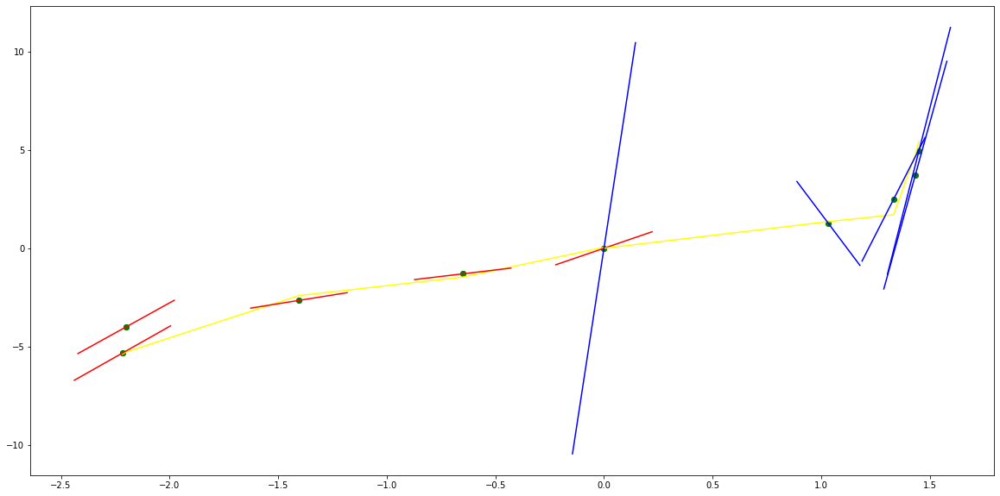

parameters (0.28850150909632677, 1.6283228128174516, 4.275906374365692, -0.516689021471695)
tangent[0]:1.2477579374437484
tangent[1]:1.3861788705303373
tangent[2]:3.1117288484779677
tangent[3]:3.9588968570750915
tangent[4]:4.275906374365692
parameters (-479.1916936952679, -73.25051958500958, 78.69651520575529, -0.04154808019166674)
tangent[0]:78.69651520575529
tangent[1]:75.85544000127967
tangent[2]:72.21592236740332
tangent[3]:67.77752554453983
tangent[4]:62.54044395241849


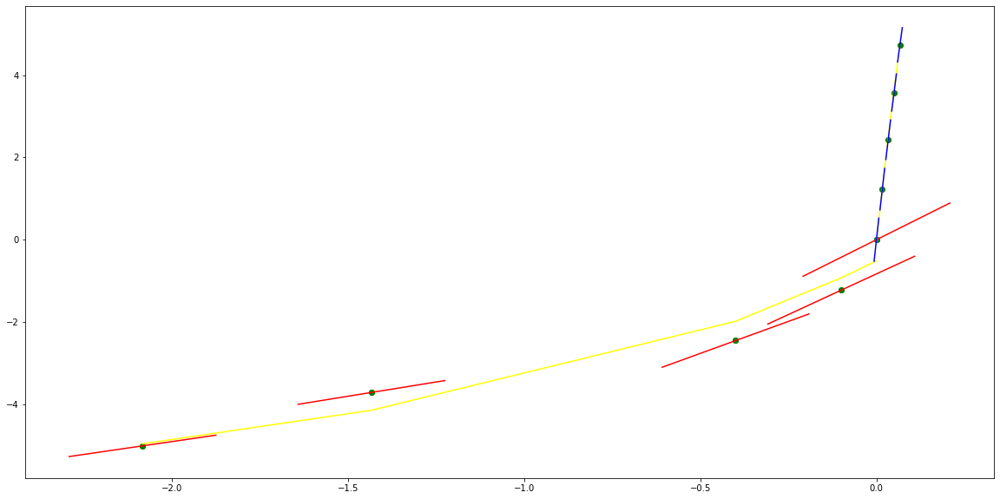

parameters (9.06742439757938, 27.239926931800216, 21.660994671959234, 0.247005953681876)
tangent[0]:14.359703129071168
tangent[1]:12.773217803897357
tangent[2]:15.276048457645713
tangent[3]:16.07822701339405
tangent[4]:21.660994671959234
parameters (7962.816744972969, -2197.161610852049, 178.7612710704838, 0.3334712324415329)
tangent[0]:178.7612710704838
tangent[1]:160.86911786466987
tangent[2]:143.8021631082681
tangent[3]:-21.7865487507369
tangent[4]:-19.774845220816445


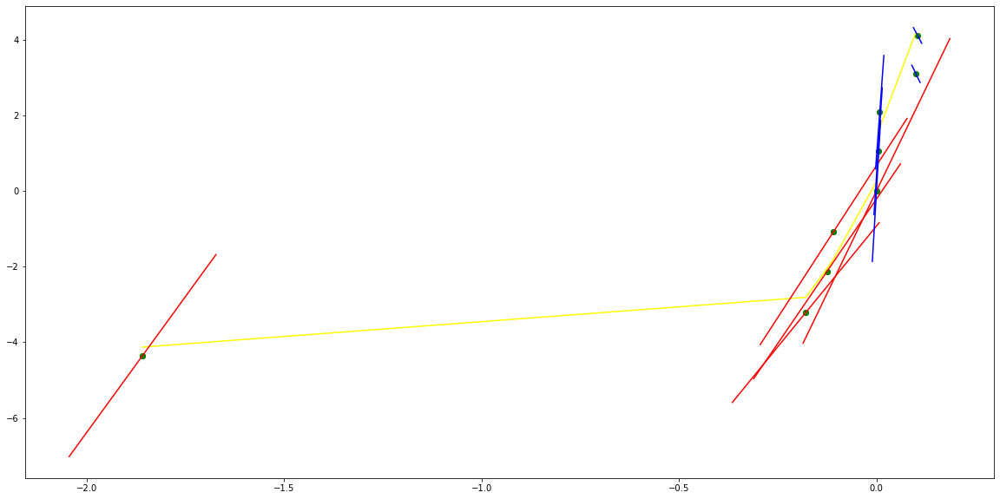

parameters (799.3679175851848, 364.4326591072991, 59.52162525219378, 0.08605709671659663)
tangent[0]:31.27136649523822
tangent[1]:29.07361872335275
tangent[2]:31.15315107795308
tangent[3]:33.31543522316187
tangent[4]:59.52162525219378
parameters (8168.370085751461, -1996.800917668002, 149.9219949336537, 0.358306002148578)
tangent[0]:149.9219949336537
tangent[1]:133.7061601002483
tangent[2]:118.34491847088503
tangent[3]:-7.406768360604644
tangent[4]:-10.006973823502705


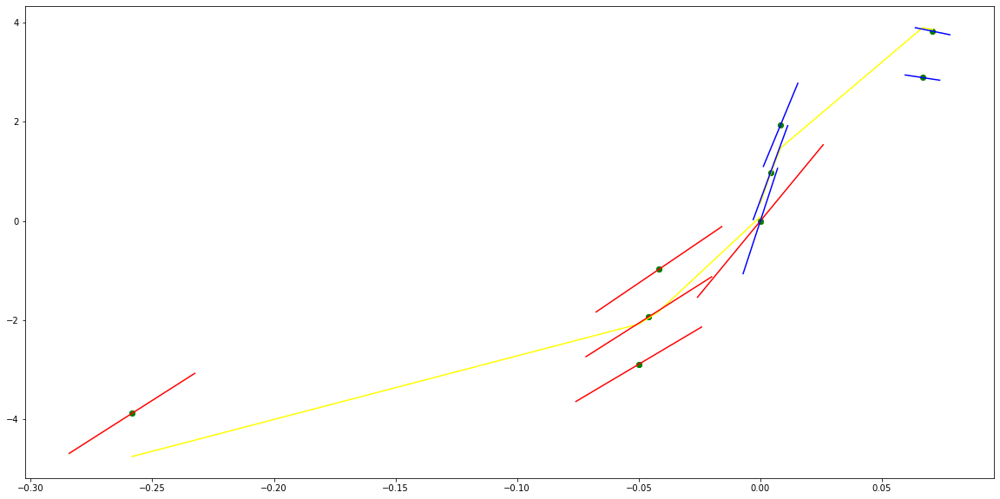

parameters (-574.7120430510931, -950.3231491488872, -385.53551808127236, 8.658335024330399e-05)
tangent[0]:61.283763030256864
tangent[1]:78.42271041606045
tangent[2]:81.06988057670412
tangent[3]:83.6565616022973
tangent[4]:-385.53551808127236
parameters (1.2418424497142717, -4.421831042157853, 4.7187965375708, -0.1716641870165979)
tangent[0]:4.7187965375708
tangent[1]:0.9620442637611424
tangent[2]:-0.038300236802932375
tangent[3]:6.2244558783558155
tangent[4]:6.266325331561298


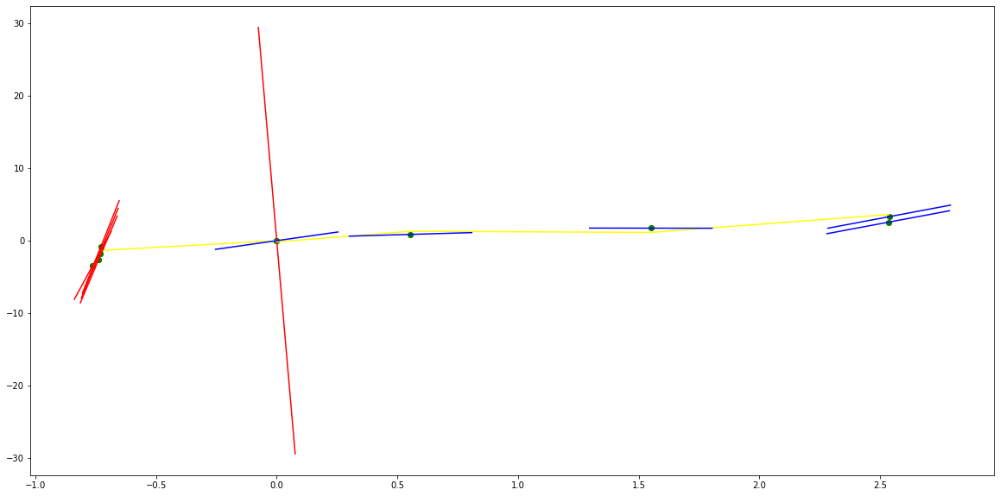

parameters (-0.0021453355935086684, -0.024162455620177374, -0.056322887784459416, -0.006846676897155923)
tangent[0]:-0.08254069117099232
tangent[1]:0.0015679903060989292
tangent[2]:0.03397384003832002
tangent[3]:0.014676890364159464
tangent[4]:-0.056322887784459416
parameters (-14.051619911900286, 65.71916165188557, -75.27554707398525, 3.245808478705877e-07)
tangent[0]:-75.27554707398525
tangent[1]:18.826032441972558
tangent[2]:-25.322400432671827
tangent[3]:-25.715111728092495
tangent[4]:-26.109381058257668


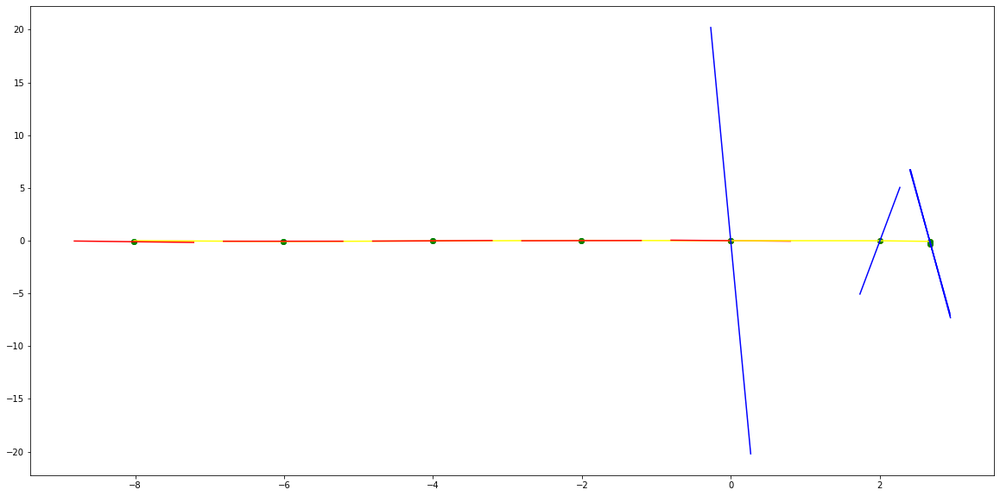

parameters (-0.0011243155457895321, -0.016397742991190303, -0.05386974842247638, -0.01290413676792986)
tangent[0]:-0.007728229098842132
tangent[1]:0.02138056308280019
tangent[2]:0.023393245765538986
tangent[3]:-0.001690202334716319
tangent[4]:-0.05386974842247638
parameters (352.01733681221043, -517.7545164818637, 188.84128983747763, -8.115961963847739e-07)
tangent[0]:188.84128983747763
tangent[1]:-30.570693268611933
tangent[2]:-28.963610157848223
tangent[3]:-27.319471346209866
tangent[4]:-23.921587267145924


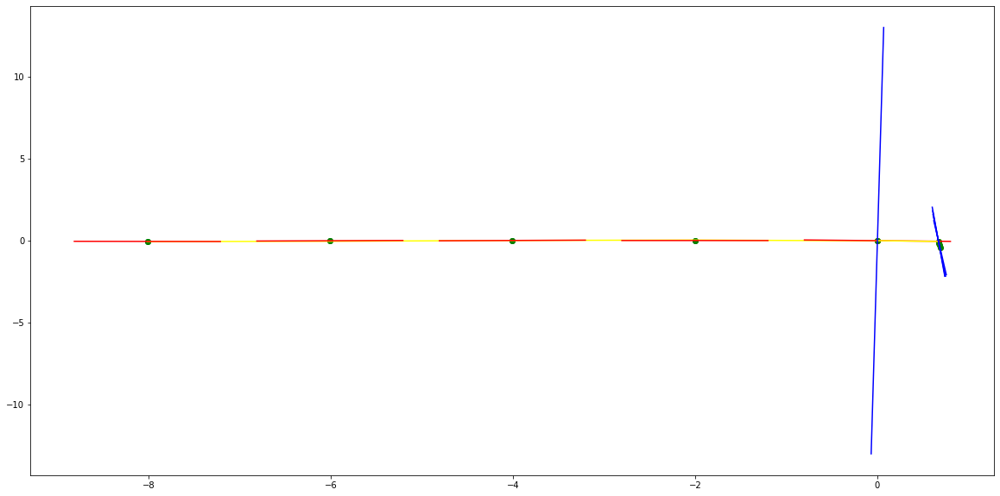

parameters (-0.0008686426159446293, -0.0030668439628259037, -0.023362274144799168, 0.005174131868093329)
tangent[0]:-0.06892686072250667
tangent[1]:-0.06733624685028287
tangent[2]:-0.03590734158599275
tangent[3]:-0.02036755823408017
tangent[4]:-0.023362274144799168
parameters (157.556247698429, -265.5033191362613, 111.39208485572802, -7.922651376447254e-09)
tangent[0]:111.39208485572802
tangent[1]:-11.835695196000856
tangent[2]:-8.995289087704961
tangent[3]:-8.015583806698586
tangent[4]:-7.019704809332367


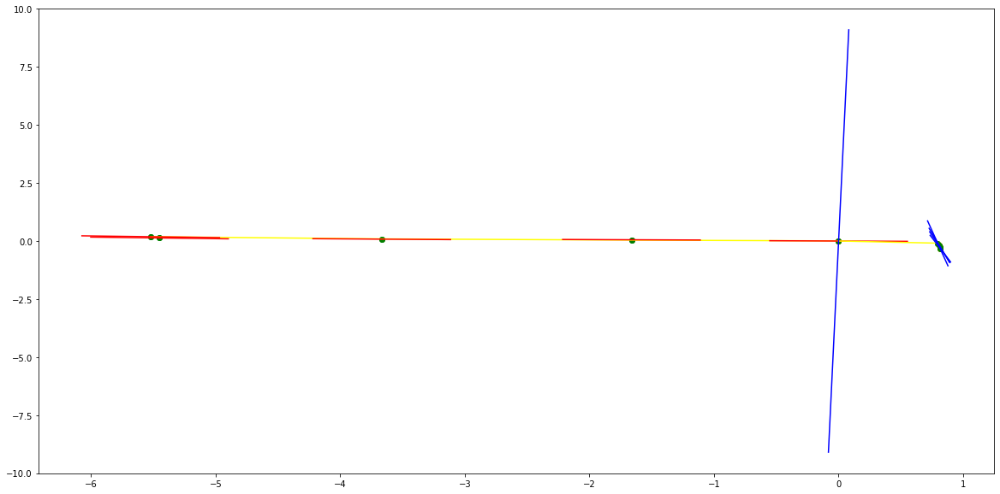

parameters (0.004076707089000649, 0.04570709669915462, 0.07819329170328322, -0.005049735177867581)
tangent[0]:-0.07116223313973853
tangent[1]:-0.07102699389979668
tangent[2]:-0.07089132993491858
tangent[3]:-0.05589142655367697
tangent[4]:0.07819329170328322
parameters (-204.08261251513983, 361.48892700350615, -159.939376734314, -3.744095232083941e-08)
tangent[0]:-159.939376734314
tangent[1]:5.355036119311194
tangent[2]:3.913994901109959
tangent[3]:2.451348321924854
tangent[4]:-0.5373670947249707


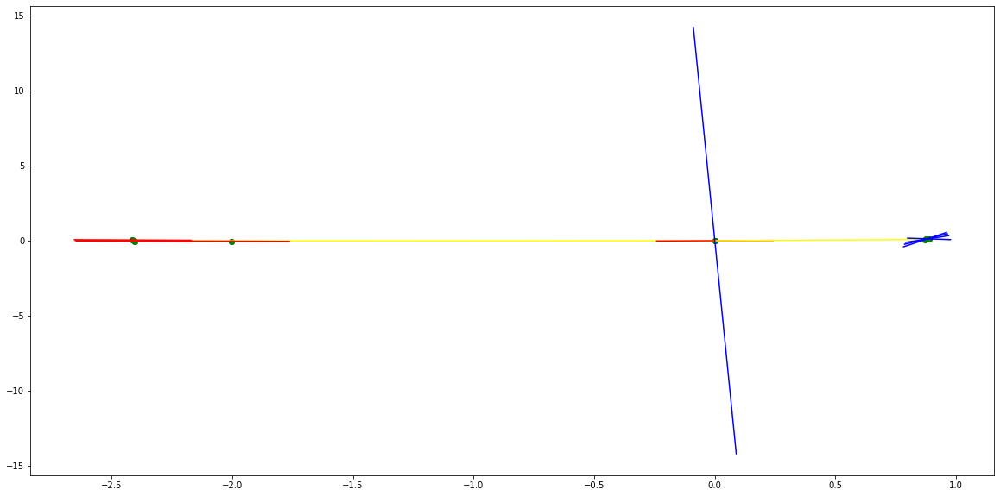

parameters (-0.0001339215963802044, -0.011976389671826031, -0.33562143059632993, -0.06328047953413195)
tangent[0]:-0.16942017240443613
tangent[1]:-0.20612920469580337
tangent[2]:-0.2460657417517399
tangent[3]:-0.28922982342576786
tangent[4]:-0.33562143059632993
parameters (-90.25701721221084, 400.93663921933427, -441.278772974918, 3.9733964585600707e-07)
tangent[0]:-441.278772974918
tangent[1]:78.20735324724154
tangent[2]:-97.63672757825049
tangent[3]:-101.99247824906712
tangent[4]:-104.18393133872047


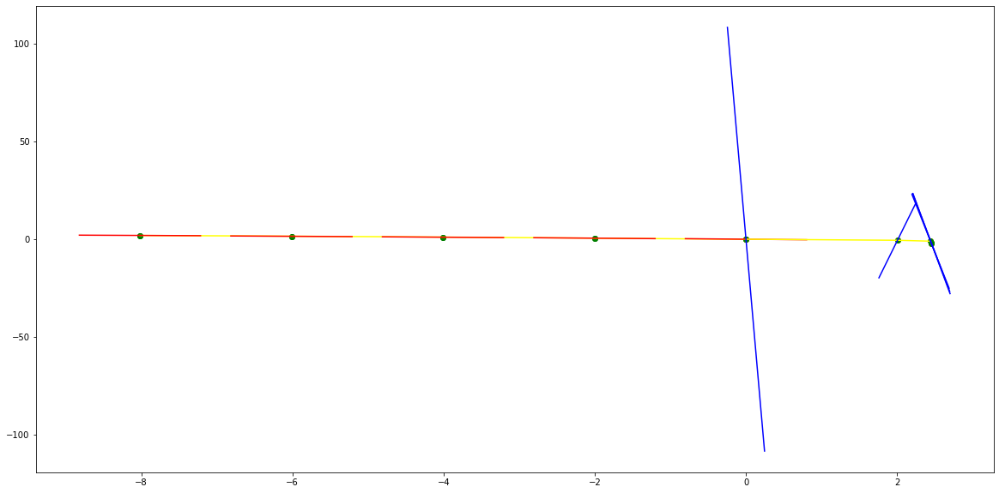

parameters (0.0002570285808389456, 0.0012636825032545124, -0.26072862595184026, 0.007305801738986866)
tangent[0]:-0.23143435073492769
tangent[1]:-0.24804953797934487
tangent[2]:-0.2584703174269298
tangent[3]:-0.262696679241973
tangent[4]:-0.26072862595184026
parameters (-1413.46233660269, 1051.2847943455417, -190.595187782319, 1.408179741214638e-06)
tangent[0]:-190.595187782319
tangent[1]:-82.35756882604579
tangent[2]:-96.05123448358864
tangent[3]:-103.11724235746561
tangent[4]:-110.33218789362826


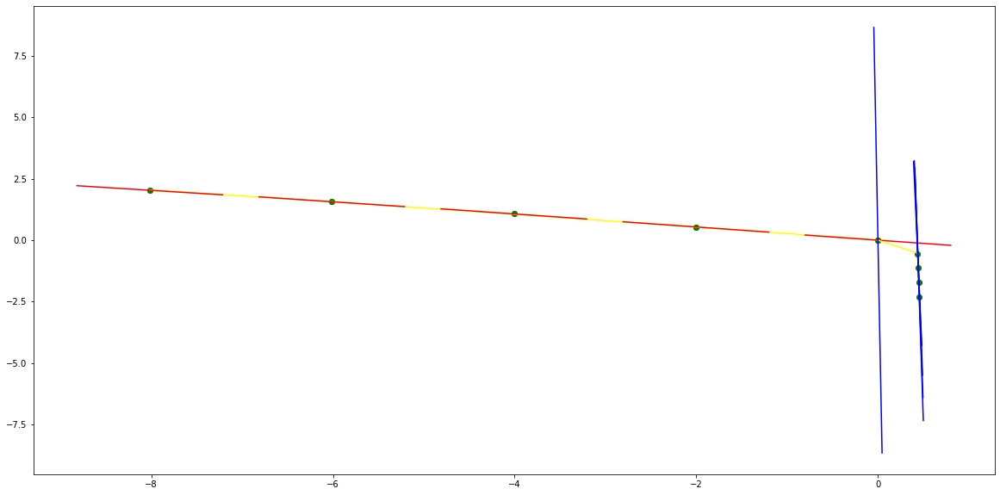

parameters (-90.25701477553963, -268.0934045201153, -113.0453397290139, 0.061973884255503306)
tangent[0]:-101.99247833025557
tangent[1]:-104.18393137031724
tangent[2]:-106.38531259168705
tangent[3]:-110.81575093410136
tangent[4]:-113.0453397290139
parameters (-105.01371997049876, 176.17348807803242, -59.54635443967492, -0.2189911587055703)
tangent[0]:-59.54635443967492
tangent[1]:-58.083594929763734
tangent[2]:-52.34264212442388
tangent[3]:-46.77636946494803
tangent[4]:-41.38512667307435


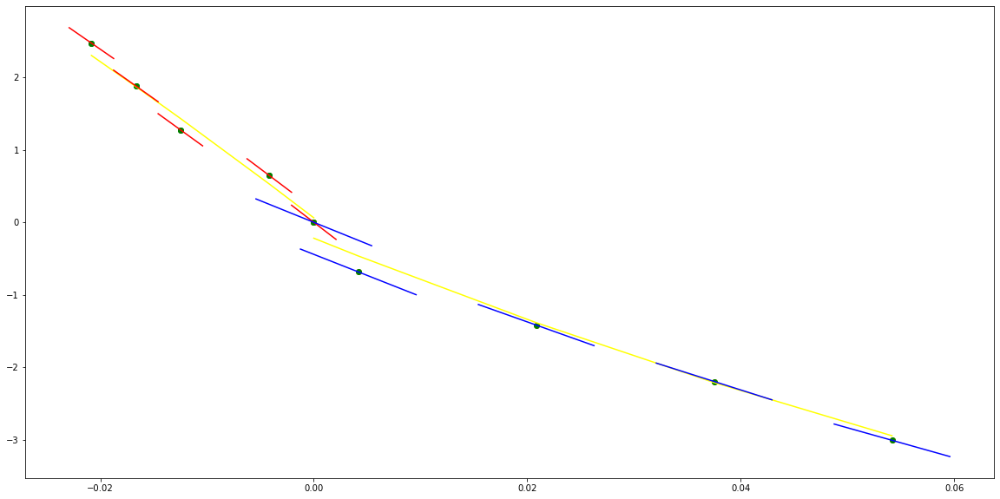

parameters (-58.18378742769386, -225.9126874016792, -219.85607583592792, 6.173964171404809e-06)
tangent[0]:-39.62519043268895
tangent[1]:-30.491371266016188
tangent[2]:-26.069787051780906
tangent[3]:-1.5772507242108418
tangent[4]:-219.85607583592792
parameters (-0.004568676310369049, 0.09322115141125949, -1.1539648074792856, -0.6406423051347256)
tangent[0]:-1.1539648074792856
tangent[1]:-1.1531881403933892
tangent[2]:-0.9266244744708324
tangent[3]:-0.6824115533970541
tangent[4]:-0.5483040946106981


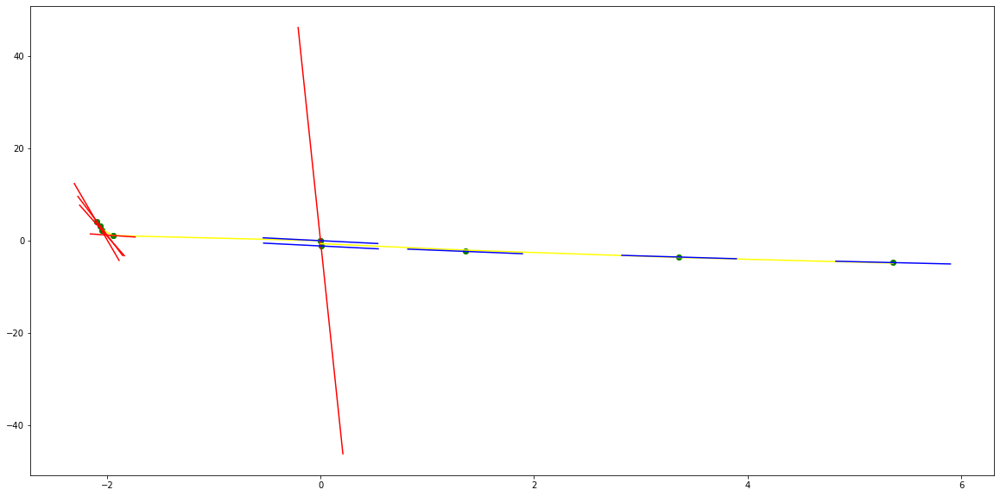

parameters (-0.004568681630209605, -0.06268499685852442, -0.8066153684893814, -0.05606558048929505)
tangent[0]:-0.6824115758580092
tangent[1]:-0.548303945631371
tangent[2]:-0.5243020552227216
tangent[3]:-0.6104058342004591
tangent[4]:-0.8066153684893814
parameters (37.53364889087551, -173.2712230827065, 195.76134337547444, 2.5751048652264852e-05)
tangent[0]:195.76134337547444
tangent[1]:-46.48501686853808
tangent[2]:-44.25285316004778
tangent[3]:-41.92294870201653
tangent[4]:-35.932295390195634


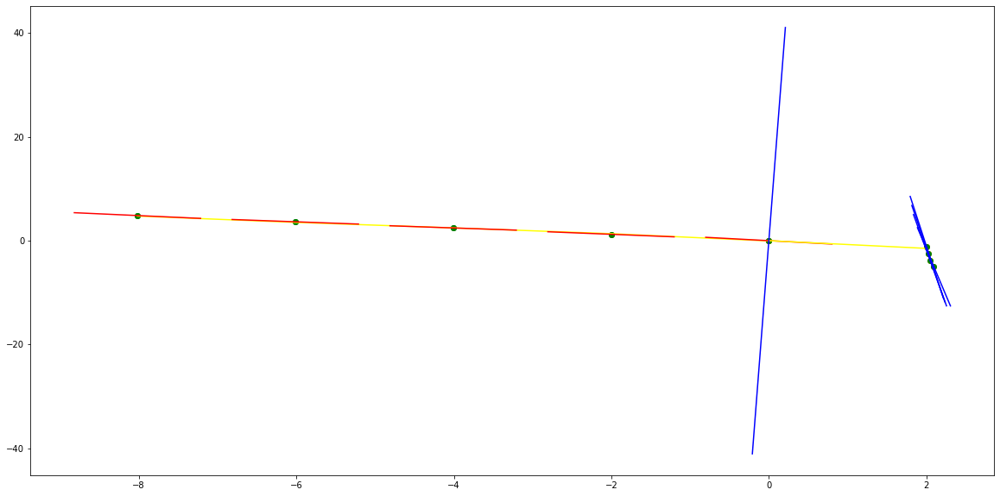

parameters (-0.0010440937626784855, -0.01778277474219135, -0.6802535942329271, -0.026592563359776247)
tangent[0]:-0.5964385916074605
tangent[1]:-0.5796481859395091
tangent[2]:-0.588020546626935
tangent[3]:-0.6215556820246957
tangent[4]:-0.6802535942329271
parameters (-2243.961019032437, 702.9109929384161, -91.08037399111319, 0.15858167418006497)
tangent[0]:-91.08037399111319
tangent[1]:-64.71461530524516
tangent[2]:-44.192318111185145
tangent[3]:-18.779990405788453
tangent[4]:-19.50031123423669


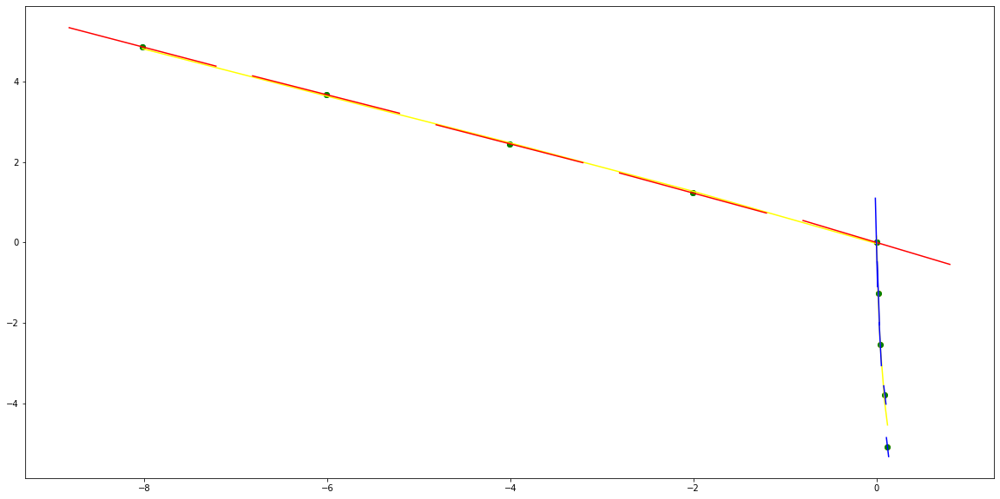

parameters (-2243.961019032439, -671.5106432969146, -84.66949020620629, 0.8108345399436051)
tangent[0]:-18.77999040578841
tangent[1]:-19.500311234236676
tangent[2]:-68.93358085145488
tangent[3]:-79.1912990996393
tangent[4]:-84.66949020620629
parameters (-1.5099628967330159, 6.051916582360503, -8.39450862201405, -1.1711103028173375)
tangent[0]:-8.39450862201405
tangent[1]:-8.344150605701056
tangent[2]:-7.5598742188009025
tangent[3]:-2.21420352249525
tangent[4]:-3.8557849676665423


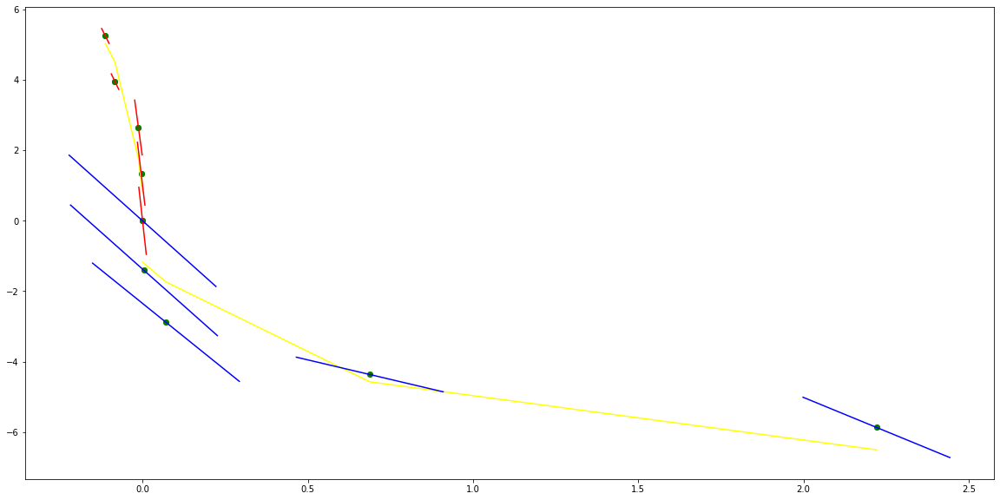

parameters (1598.0343658674076, 488.559624113226, -63.192156460100975, -0.026695999847628174)
tangent[0]:-112.96305030672394
tangent[1]:-111.32631848884654
tangent[2]:-102.05356999996548
tangent[3]:-90.43579767676698
tangent[4]:-63.192156460100975
parameters (-458.2083066390131, 191.5446069363329, -109.35539335453205, -0.2180869640295043)
tangent[0]:-109.35539335453205
tangent[1]:-103.3523009562118
tangent[2]:-93.63749496069136
tangent[3]:-89.92548991639684
tangent[4]:-84.79272116643587


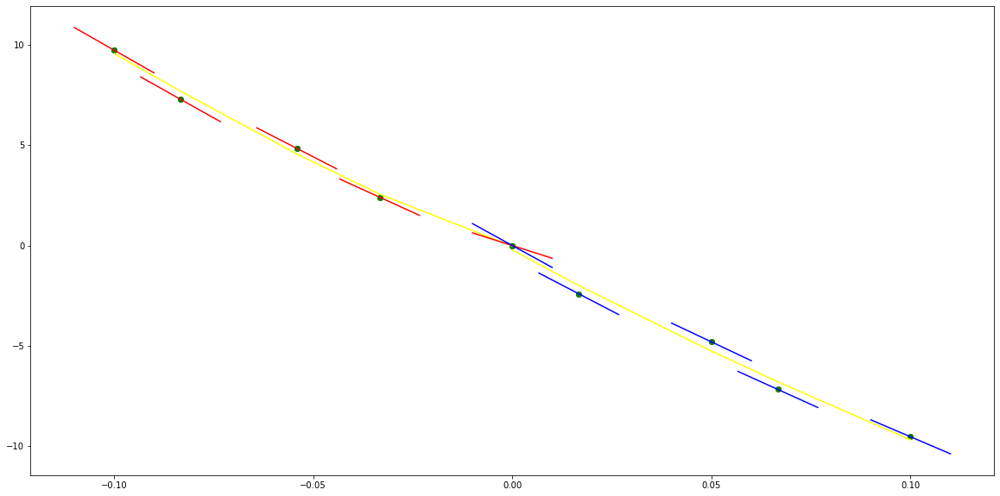

parameters (0.03197979798011473, 0.107382251082299, -38.581641269841256, 0.0006686818181815852)
tangent[0]:-38.620756594516564
tangent[1]:-38.61169730880229
tangent[2]:-38.602158326118314
tangent[3]:-38.59213964646464
tangent[4]:-38.581641269841256
parameters (-92369.10223024628, 4324.491685380105, -385.8281550038275, -0.09491010811661801)
tangent[0]:-385.8281550038275
tangent[1]:-354.60584166052075
tangent[2]:-321.0138795397528
tangent[3]:-318.6522921882865
tangent[4]:-325.9123042879433


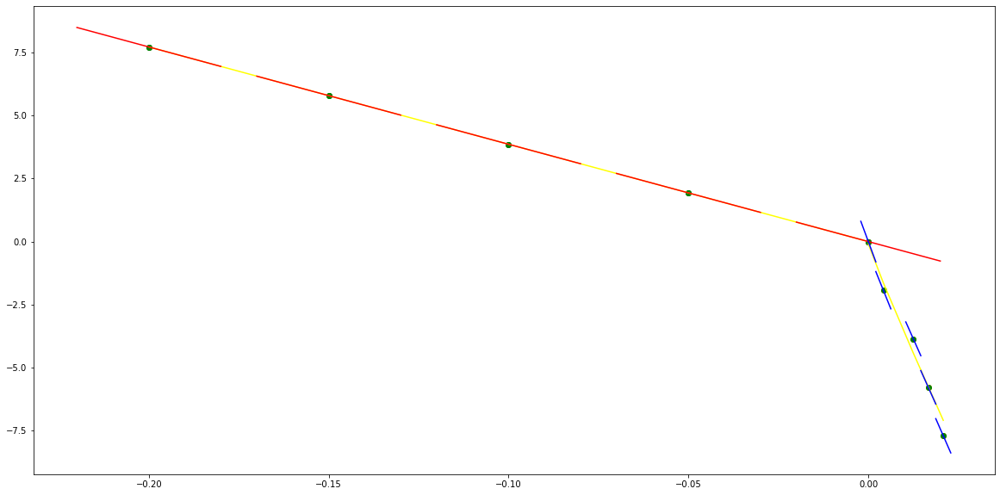

parameters (-6.278744332326119, 1.5756068141287516, 24.040427944079987, 0.008524797291946808)
tangent[0]:21.399802885874685
tangent[1]:22.329053426978653
tangent[2]:23.14393065740935
tangent[3]:23.67290748008093
tangent[4]:24.040427944079987
parameters (-4801.559542833648, 1734.6752209620408, -82.17511490633414, 0.07148842431448707)
tangent[0]:-82.17511490633414
tangent[1]:91.29801947994976
tangent[2]:125.81759591816
tangent[3]:126.51879140375486
tangent[4]:126.71974440777787


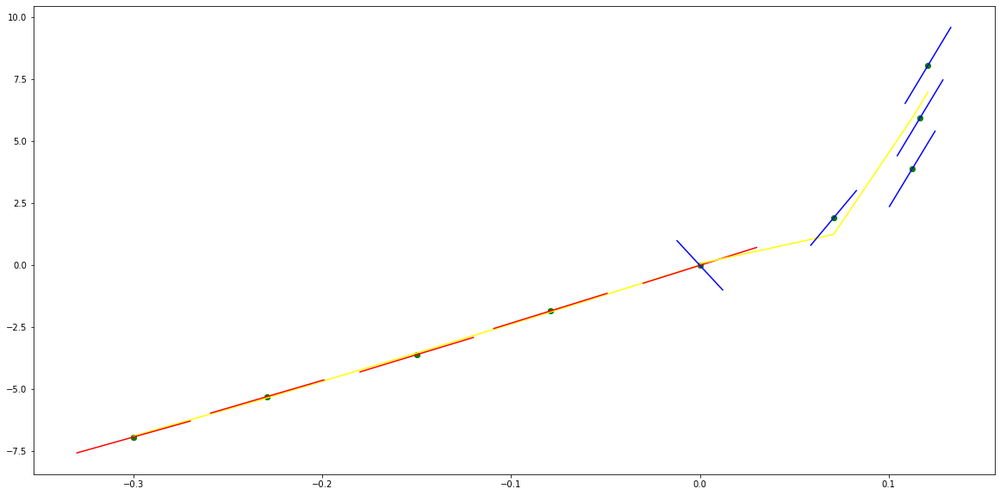

parameters (224172.11628155079, 23354.88857480022, 944.9855131637019, -0.2545687061986874)
tangent[0]:216.86710584615275
tangent[1]:154.7204415830206
tangent[2]:466.1939783006733
tangent[3]:762.0233710133407
tangent[4]:944.9855131637019
parameters (-40384.98338990618, 5947.205241316182, 191.06166378213743, 1.6087889685798358)
tangent[0]:191.06166378213743
tangent[1]:238.52195115671896
tangent[2]:386.2749862720567
tangent[3]:466.7279082046844
tangent[4]:481.7123506375044


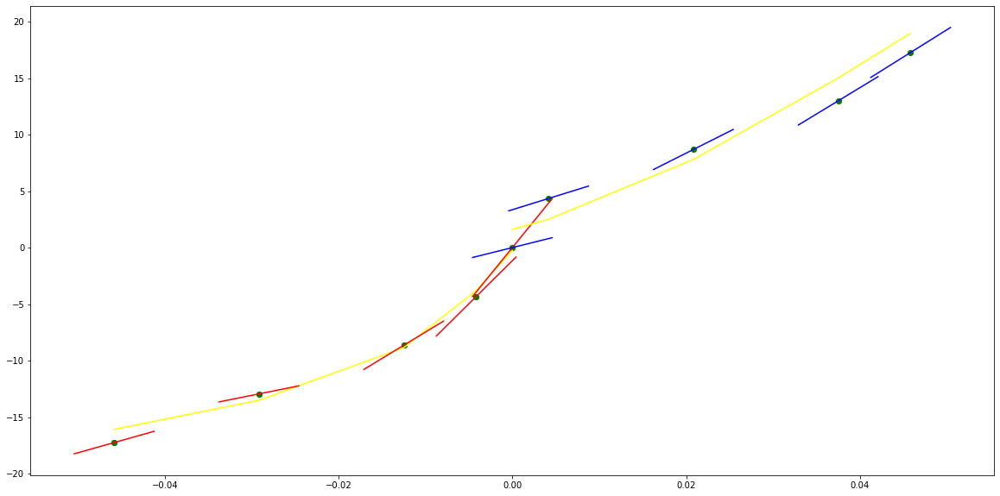

parameters (28273.67572692946, 3054.42640405183, 215.83604029961754, 0.07074014899206972)
tangent[0]:368.5932557388339
tangent[1]:234.79035758377768
tangent[2]:114.03112480866258
tangent[3]:116.12786208501879
tangent[4]:215.83604029961754
parameters (52343.97300070109, -12050.808431087977, 876.3904630690586, -0.12593102406442855)
tangent[0]:876.3904630690586
tangent[1]:778.708503485262
tangent[2]:686.4558117495903
tangent[3]:518.3294044162103
tangent[4]:442.43551284258274


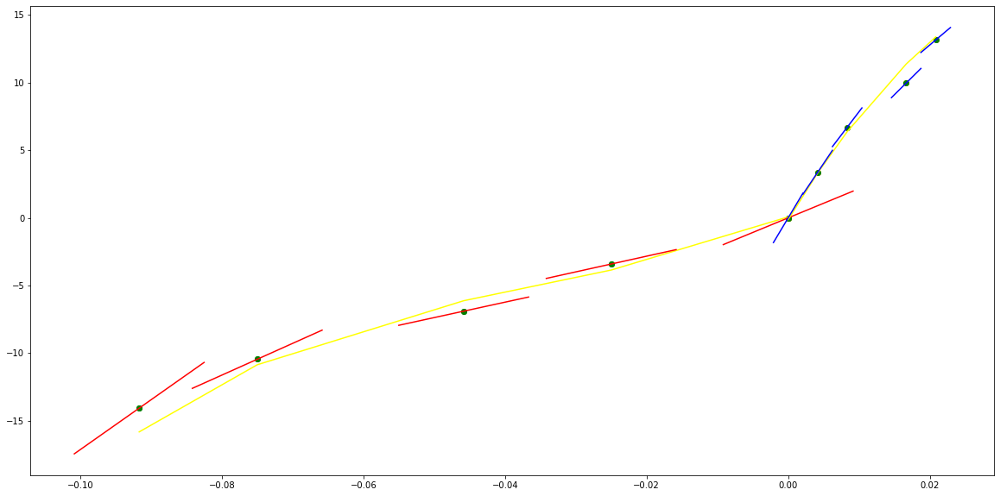

parameters (11354.085225460265, 2785.4201890083477, 256.61846575872806, -0.7234579142210975)
tangent[0]:41.49662836854708
tangent[1]:108.77183725460145
tangent[2]:192.30518848295387
tangent[3]:234.00151412978826
tangent[4]:256.61846575872806
parameters (-15594.90263100062, 3084.387406718447, -32.75643722803104, 0.9703621956822713)
tangent[0]:-32.75643722803104
tangent[1]:-7.863517055191011
tangent[2]:164.11826610513515
tangent[3]:170.0392234047363
tangent[4]:170.563158853809


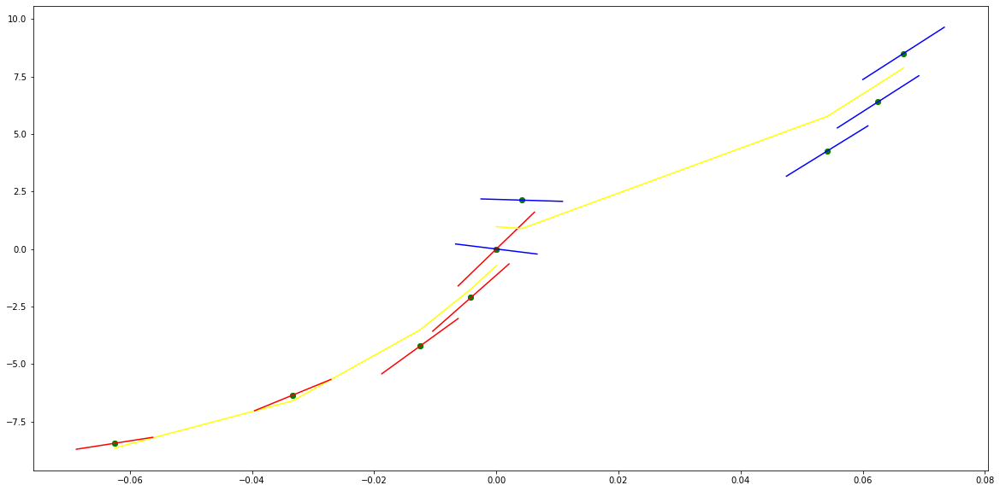

parameters (-88.96362542259786, -68.48859605654594, 18.53798752537085, 0.02397908571009666)
tangent[0]:35.59384971793532
tangent[1]:34.51236575695261
tangent[2]:30.570083985329422
tangent[3]:27.3100157548464
tangent[4]:18.53798752537085
parameters (8263.237839956299, -1746.6921831639936, 156.99067788802563, 0.8519733833889115)
tangent[0]:156.99067788802563
tangent[1]:142.8641910674377
tangent[2]:129.6016761288625
tangent[3]:54.470217185250846
tangent[4]:55.5493764539159


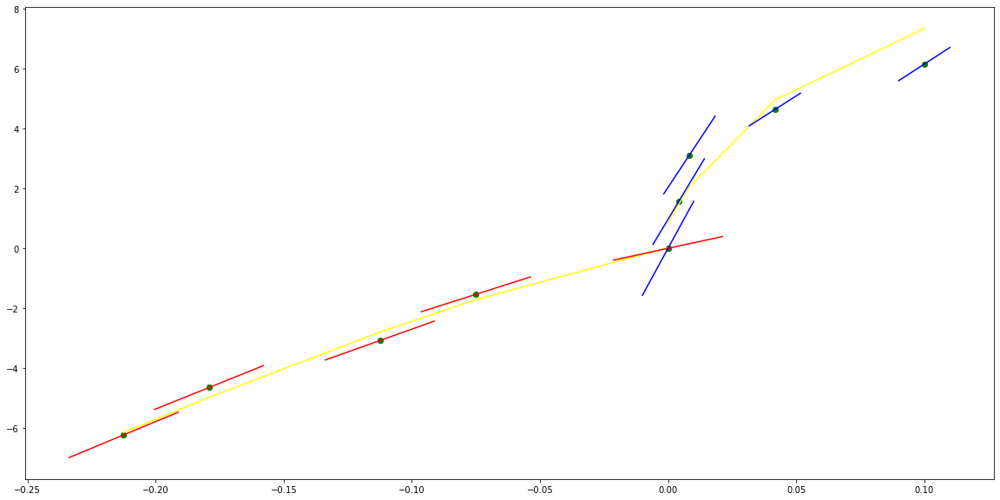

parameters (92.61164587438294, 56.121018420818096, 29.018786584202996, -0.4662450079534715)
tangent[0]:17.829722012006762
tangent[1]:17.885125101625597
tangent[2]:21.874227800469953
tangent[3]:27.65917283268616
tangent[4]:29.018786584202996
parameters (961.6091821973953, -327.78814584836385, 71.15798000789275, 0.9467010115549749)
tangent[0]:71.15798000789275
tangent[1]:68.47628542569565
tangent[2]:65.89538198897587
tangent[3]:42.732563065195215
tangent[4]:33.939793433367306


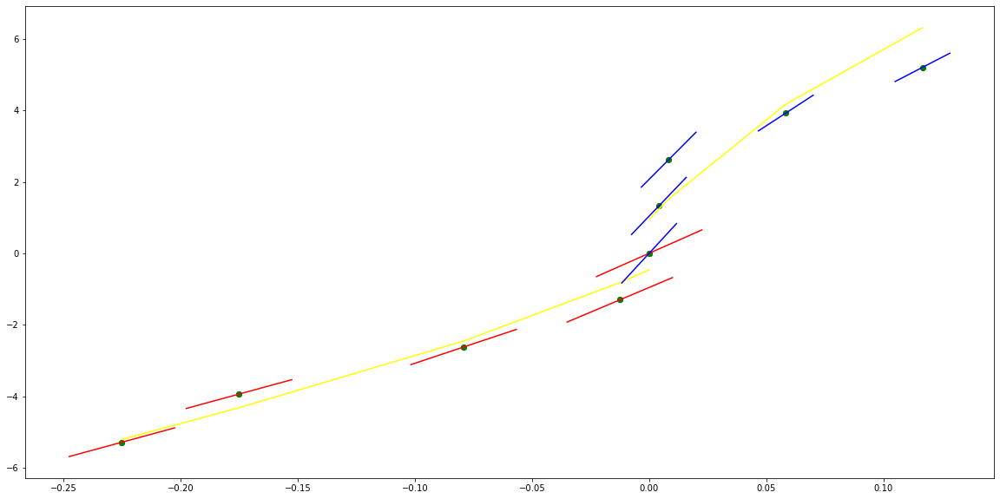

parameters (0.009753974615767314, 0.01891564590964796, 0.39259446504191303, -0.05717456477679518)
tangent[0]:0.5078079777459416
tangent[1]:0.5072995540005678
tangent[2]:0.39400691984408603
tangent[3]:0.38118553560704427
tangent[4]:0.39259446504191303
parameters (14.234922139149981, -70.75299001324714, 84.95410311319212, -0.041073420216030665)
tangent[0]:84.95410311319212
tangent[1]:84.36518921524556
tangent[2]:-26.991529930949994
tangent[3]:40.53701617560064
tangent[4]:41.00246054049849


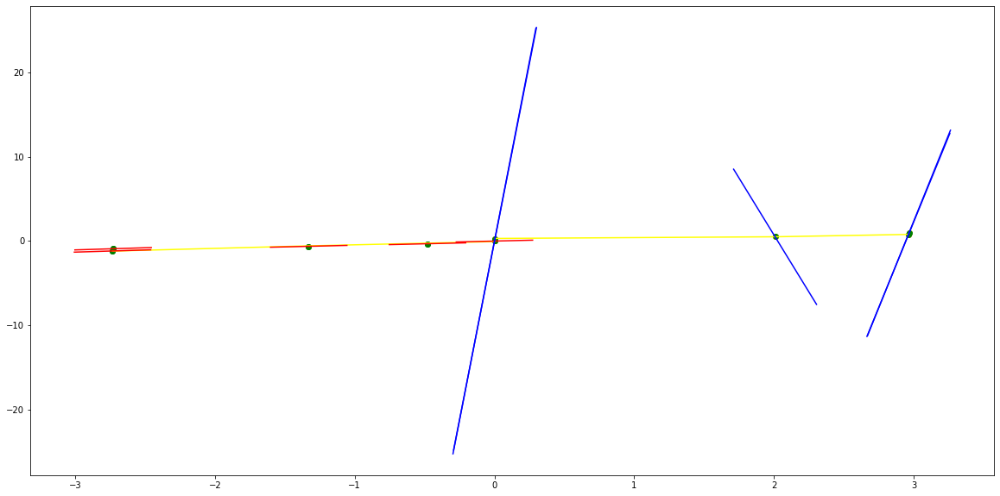

parameters (-0.012401304380619408, -0.12604064009157004, 0.03588302449141932, 0.015210291894006765)
tangent[0]:0.46279339648234763
tangent[1]:0.4327301832703041
tangent[2]:0.39208796401234325
tangent[3]:0.391659594155923
tangent[4]:0.03588302449141932
parameters (-997.5687323378634, 1965.1564584456028, -966.6299275810134, -2.3840404475755265e-08)
tangent[0]:-966.6299275810134
tangent[1]:58.88327756080071
tangent[2]:51.41086859843972
tangent[3]:43.83452959965052
tangent[4]:36.15611614916543


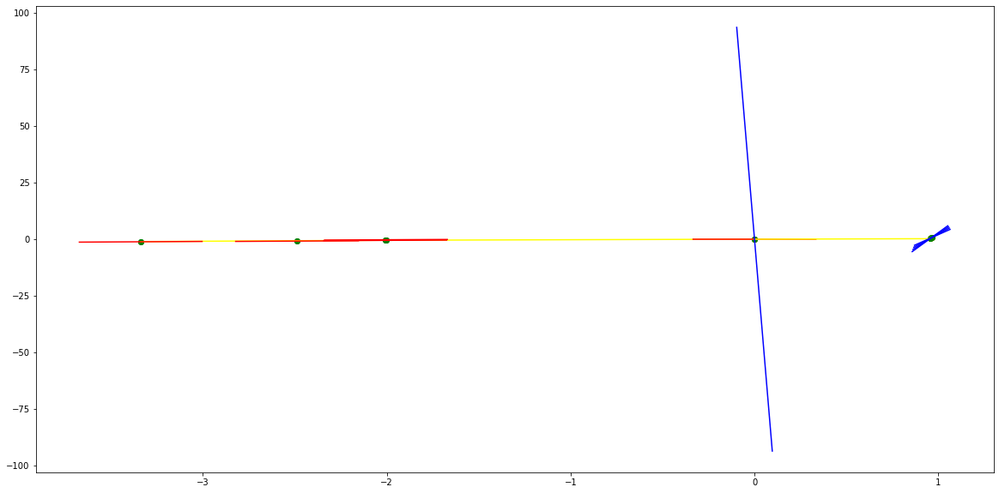

parameters (0.00040704302395892447, 0.0013600028874162467, -0.18759420490470294, 0.00482089846123646)
tangent[0]:-0.1309213446915548
tangent[1]:-0.15980423287612047
tangent[2]:-0.17887733145045318
tangent[3]:-0.18814065944800484
tangent[4]:-0.18759420490470294
parameters (-12.014459368438738, 61.863783370255895, -75.88611259670337, -4.0549737398751635e-07)
tangent[0]:-75.88611259670337
tangent[1]:27.309705100482162
tangent[2]:-43.7846966140914
tangent[3]:-44.21586041699403
tangent[4]:-44.64837927200922


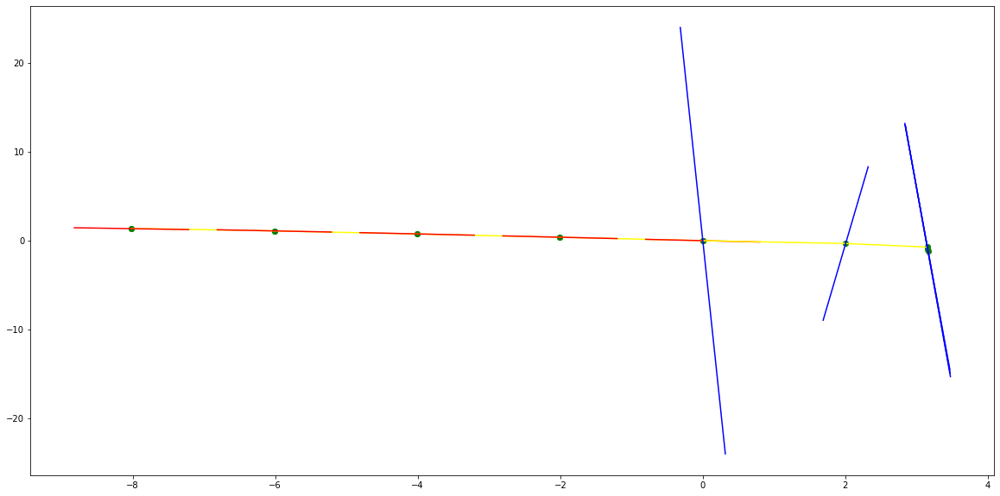

parameters (0.00041493449297090384, 0.00461409471453082, -0.16601933607556452, -0.008864421417372955)
tangent[0]:-0.15999894579511348
tangent[1]:-0.17650398475455953
tangent[2]:-0.1830090666148312
tangent[3]:-0.17951418064576932
tangent[4]:-0.16601933607556452
parameters (576.1789088973454, -1372.6370594082011, 816.0186381558733, -3.505318585544834e-08)
tangent[0]:816.0186381558733
tangent[1]:-60.15245894564168
tangent[2]:-55.05677743277147
tangent[3]:-49.89985172373599
tangent[4]:-39.40718916203468


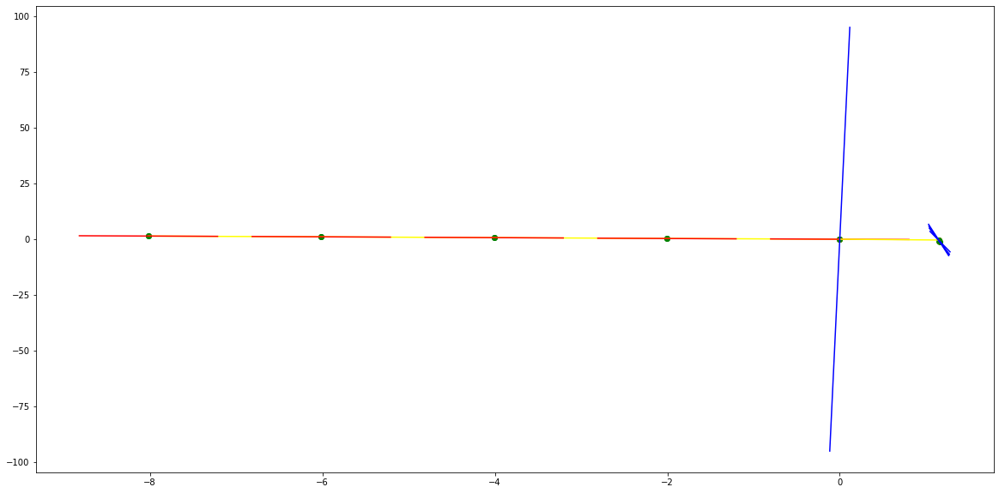

parameters (2.532300337155343e-05, -0.0030969998288002654, -0.21583583588835545, 0.03111813463642173)
tangent[0]:-0.16760433284936543
tangent[1]:-0.18189277726774494
tangent[2]:-0.19557093446405105
tangent[3]:-0.20863879807018848
tangent[4]:-0.21583583588835545
parameters (-5466.99708388077, 965.1230835887112, -65.06798186302535, -0.01237015471092548)
tangent[0]:-65.06798186302535
tangent[1]:-57.3112246526876
tangent[2]:-50.12210716294865
tangent[3]:-37.45396568489747
tangent[4]:-31.973421458798363


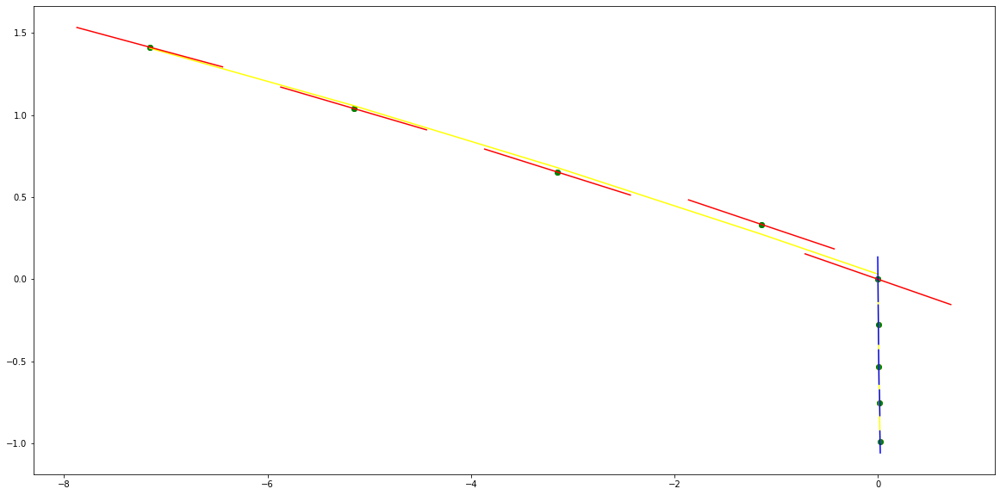

parameters (-44.1668248136673, -175.31831270703017, -174.02396263468617, 9.540266439054254e-07)
tangent[0]:-13.666583343458996
tangent[1]:-12.857053135285327
tangent[2]:-12.052124374172962
tangent[3]:-3.502325383985948
tangent[4]:-174.02396263468617
parameters (-0.004690155242269893, 0.03987794976895942, -0.13800113212969561, 0.00632194705172924)
tangent[0]:-0.13800113212969561
tangent[1]:-0.03467364732524911
tangent[2]:-0.044379350260845496
tangent[3]:-0.1671183206923983
tangent[4]:-0.21149475225924624


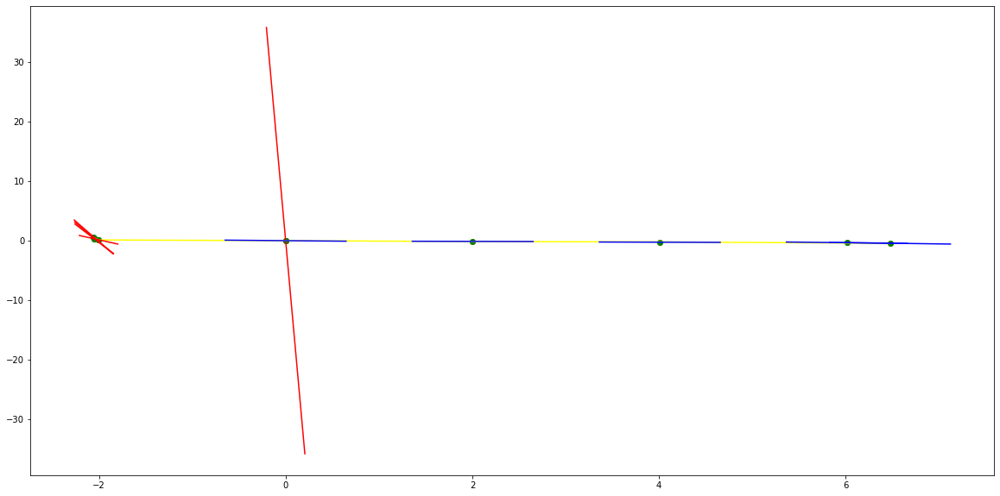

parameters (-4718.841532430848, -874.1117862335545, -5.337270340150969, -0.2942902867413132)
tangent[0]:48.29317359431356
tangent[1]:48.62777873086935
tangent[2]:45.050960641461316
tangent[3]:1.7001347073333202
tangent[4]:-5.337270340150969
parameters (-17439.601025766082, 1756.9965726198338, 37.470290805479515, 0.16869070553860802)
tangent[0]:37.470290805479515
tangent[1]:51.20464235244614
tangent[2]:87.97155683443154
tangent[3]:95.45459643897134
tangent[4]:96.47140958628876


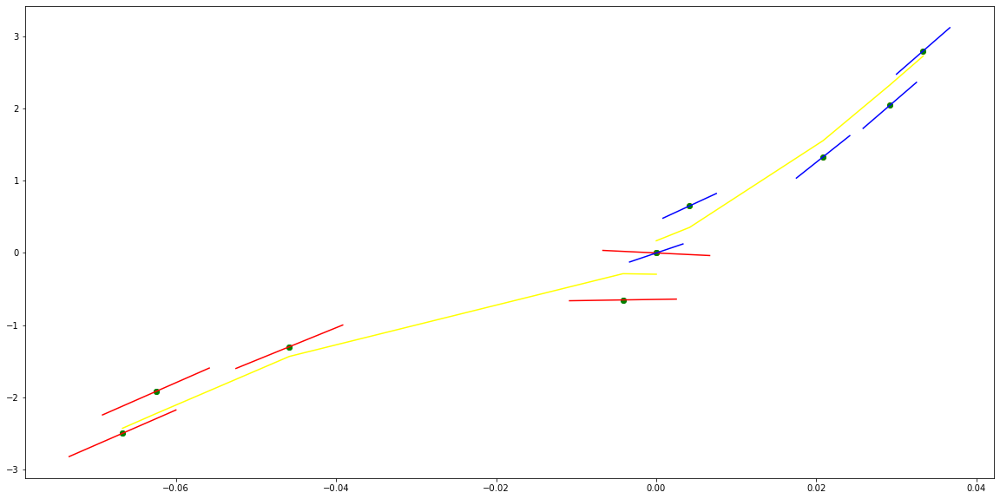

parameters (0.07707834896886247, 0.6813899188496245, 2.0911089465442005, 0.1214330767291363)
tangent[0]:3.8587721263109076
tangent[1]:2.244779597827365
tangent[2]:0.33975034625260303
tangent[3]:0.2886689960898856
tangent[4]:2.0911089465442005
parameters (53.986084217487395, -299.9675881222098, 385.09528543318925, -4.0671007823253266e-07)
tangent[0]:385.09528543318925
tangent[1]:-166.73970319231125
tangent[2]:298.69826812134966
tangent[3]:300.9984218430443
tangent[4]:303.3042000149819


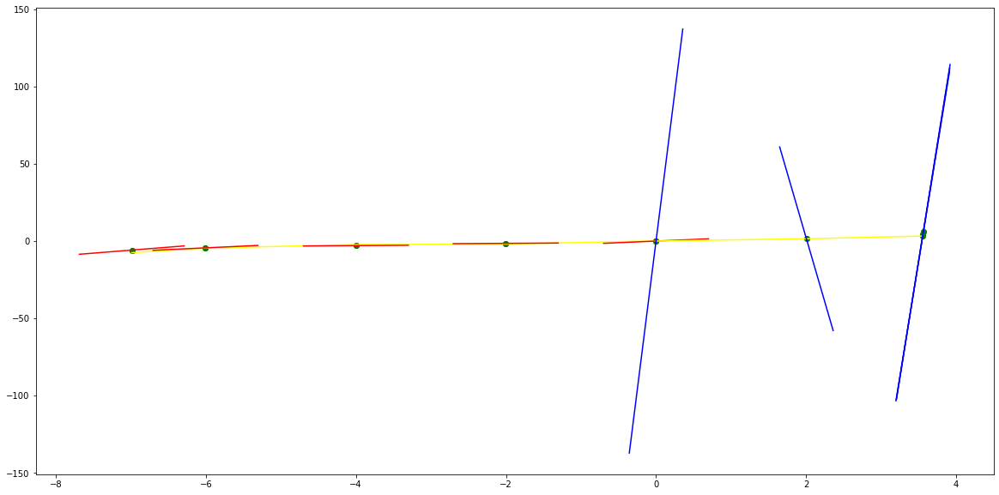

parameters (0.022932890853471433, 0.25029877367744546, 1.3706068776806213, 0.10560534042019114)
tangent[0]:1.7739476300644237
tangent[1]:0.8451288936217647
tangent[2]:0.46941514187653266
tangent[3]:0.6436686389489772
tangent[4]:1.3706068776806213
parameters (-2436.0595589160307, 7801.996358650568, -6239.480982030695, 4.085252558436471e-07)
tangent[0]:-6239.480982030695
tangent[1]:388.8084588987731
tangent[2]:359.2985384558051
tangent[3]:329.534821206169
tangent[4]:269.25329126618817


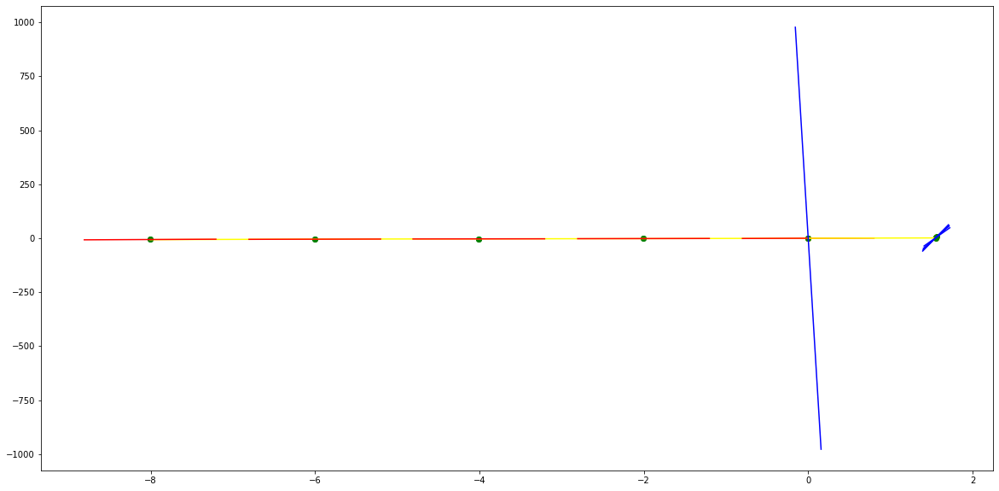

parameters (10596.478498134575, 2931.854892685096, 280.3776469951143, -0.5117544200371257)
tangent[0]:15.402883957807774
tangent[1]:191.4779479702769
tangent[2]:212.04837397398745
tangent[3]:233.71744256102903
tangent[4]:280.3776469951143
parameters (-34485.576940166684, 3172.615192808632, 124.05020494656016, 0.5636590506256077)
tangent[0]:124.05020494656016
tangent[1]:148.68888564770955
tangent[2]:211.33873148349323
tangent[3]:220.60614528341893
tangent[4]:216.51031669087934


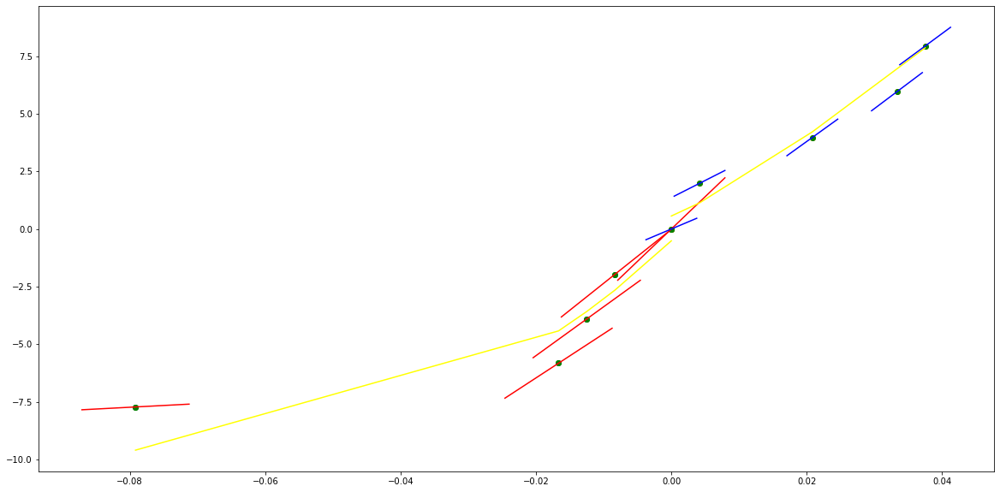

parameters (-93512.46890066231, -14180.220611954266, -358.7518772322289, 0.04727315460840385)
tangent[0]:341.0021970779673
tangent[1]:357.9266672082304
tangent[2]:351.77742561060046
tangent[3]:335.885743232328
tangent[4]:-358.7518772322289
parameters (129.15286248035724, -164.29120158120486, 73.41314160896432, 1.838248522828962)
tangent[0]:73.41314160896432
tangent[1]:72.05066652289099
tangent[2]:70.7016470126265
tangent[3]:47.62866114234918
tangent[4]:43.389920067834126


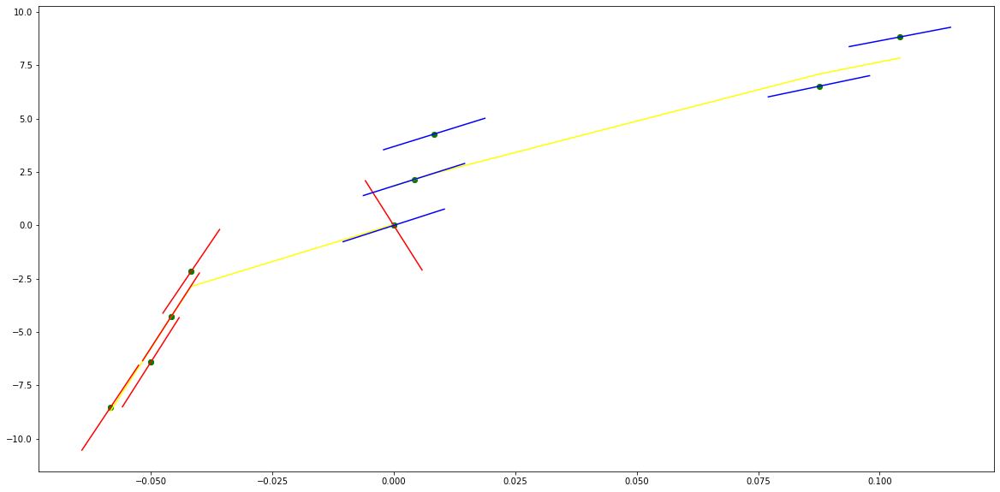

parameters (-0.10172216501507328, -0.7074704227725435, -3.8570935328180758, 0.018506821694230024)
tangent[0]:-2.604919629893317
tangent[1]:-2.4794932250890835
tangent[2]:-2.570694635875147
tangent[3]:-2.698223247973564
tangent[4]:-3.8570935328180758
parameters (-99.57846172979512, 340.2570306473409, -266.497197030264, 1.3775786290178382)
tangent[0]:-266.497197030264
tangent[1]:-252.44970289761983
tangent[2]:121.0386470493678
tangent[3]:120.98384069249715
tangent[4]:-256.03256369314903


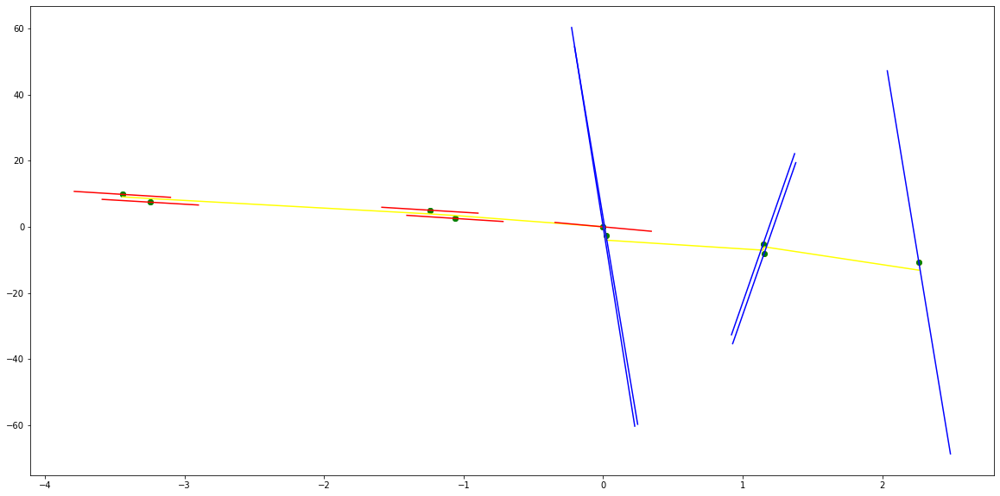

parameters (-0.045636012242135725, -0.5692265259699056, -4.888879944590607, -0.36546113327441937)
tangent[0]:-2.9512204843055665
tangent[1]:-3.0424606660871647
tangent[2]:-3.764153984239094
tangent[3]:-3.7813944951401783
tangent[4]:-4.888879944590607
parameters (-673.4470768408012, 1046.6925857681, -334.33965193368266, -0.00018456146073719004)
tangent[0]:-334.33965193368266
tangent[1]:-317.0357635497199
tangent[2]:-515.9802899038625
tangent[3]:-526.0917065339647
tangent[4]:-536.275703835375


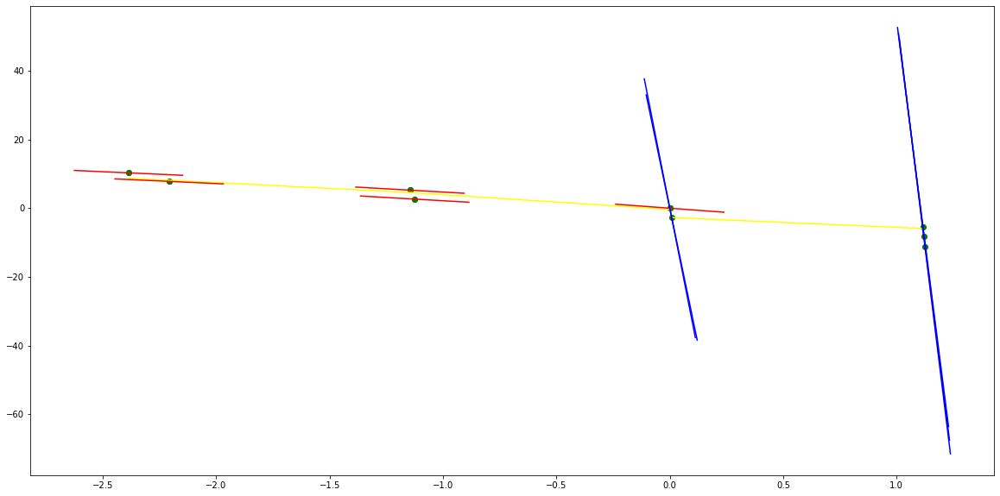

parameters (-182720.10427375164, -8775.732157009204, -765.7962496886895, 0.19681790903514293)
tangent[0]:-638.0557827977534
tangent[1]:-625.5388382594535
tangent[2]:-632.0529946417805
tangent[3]:-702.1774927182083
tangent[4]:-765.7962496886895
parameters (848.027994858362, 599.34803281871, -315.5121502689348, -1.2241124174931663)
tangent[0]:-315.5121502689348
tangent[1]:-310.47300857150884
tangent[2]:-289.4355473494224
tangent[3]:-266.9834297042229
tangent[4]:-243.11787553182768


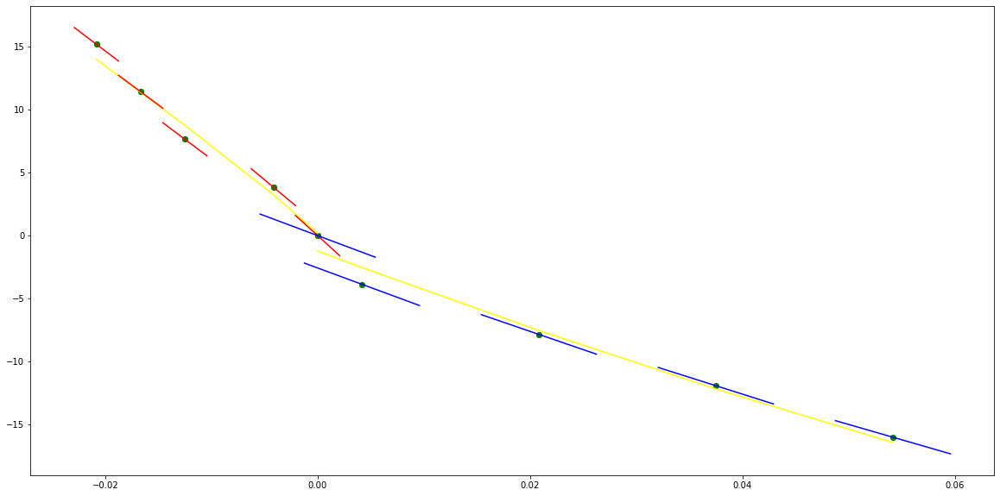

parameters (-4130.359450530811, -827.0779185493967, -211.62051403153393, -0.1567571563638629)
tangent[0]:-166.89701382163983
tangent[1]:-157.25864197683188
tangent[2]:-161.8350803887448
tangent[3]:-178.01104207380936
tangent[4]:-211.62051403153393
parameters (-16652.68878870796, 4471.502957456201, -481.5201074451711, -2.4421708518635494)
tangent[0]:-481.5201074451711
tangent[1]:-445.12206811676714
tangent[2]:-410.46707178125797
tangent[3]:-289.16875105118845
tangent[4]:-98.71546972051806


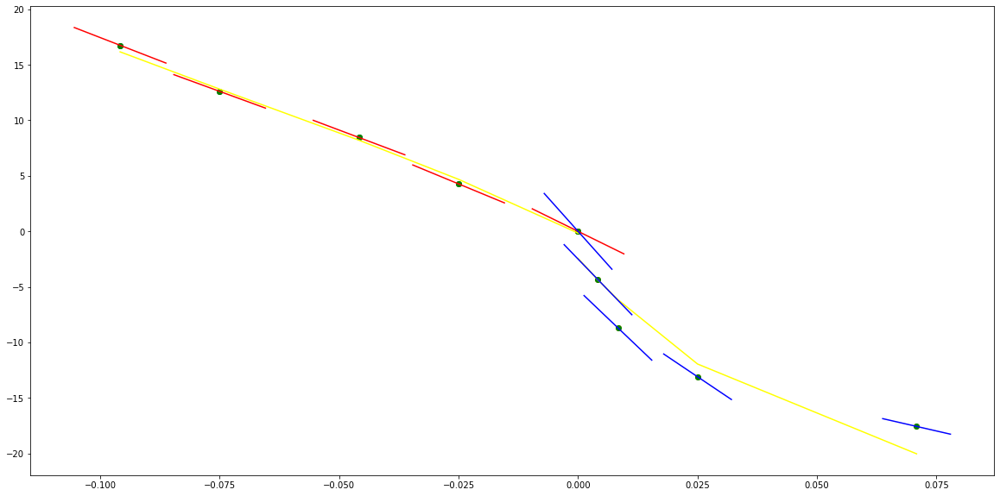

parameters (-139.27700146366865, -35.18145885305151, -67.40130392156263, 0.8751934726534338)
tangent[0]:-66.02619077511795
tangent[1]:-64.68235887427015
tangent[2]:-64.63577392583356
tangent[3]:-66.84398344905235
tangent[4]:-67.40130392156263
parameters (-56668.92148485036, 10060.758385360325, -603.3425542623796, 0.048104029225887586)
tangent[0]:-603.3425542623796
tangent[1]:-522.4481724660246
tangent[2]:-447.47503585817316
tangent[3]:-315.20322446509294
tangent[4]:-257.936292375183


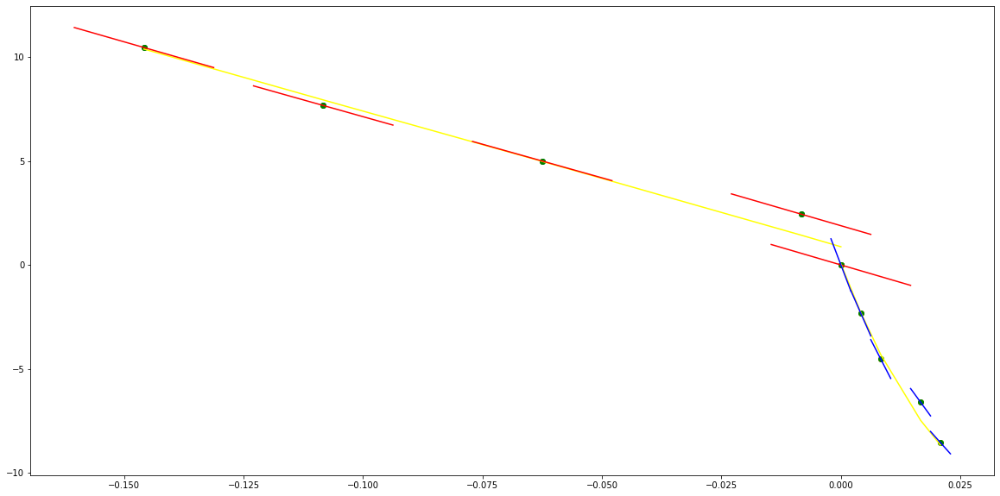

parameters (-5.008920004553361, 5.299092551693599, 21.651329321569374, -0.017019755860028053)
tangent[0]:16.788380565747588
tangent[1]:18.137820513690187
tangent[2]:19.53232386065824
tangent[3]:20.718123877073236
tangent[4]:21.651329321569374
parameters (120.75774073480103, -169.9183875031006, 78.30315204407236, 0.048192565785161)
tangent[0]:78.30315204407236
tangent[1]:58.47848338042074
tangent[2]:57.257373075603645
tangent[3]:56.04913222943705
tangent[4]:51.341088588532216


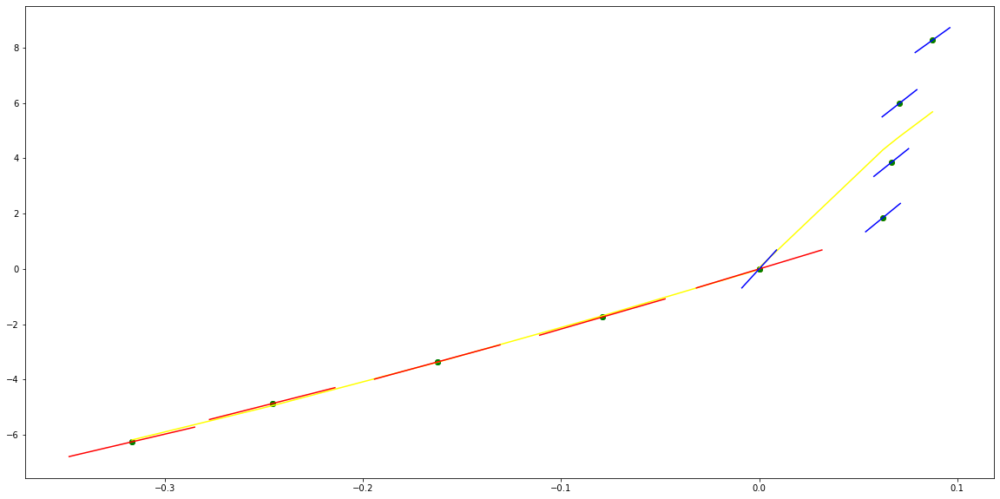

parameters (139247.2626423165, 7230.026230667784, 646.2572289179755, -0.17420782800639723)
tangent[0]:526.3166939669601
tangent[1]:521.2960971674408
tangent[2]:530.7787275148667
tangent[3]:593.2667913579578
tangent[4]:646.2572289179755
parameters (2109.4361506055766, -984.3329569977699, 212.28371756233884, 1.5147782892981407)
tangent[0]:212.28371756233884
tangent[1]:204.19017074423454
tangent[2]:174.01536935374858
tangent[3]:124.2146523058714
tangent[4]:88.47656167195095


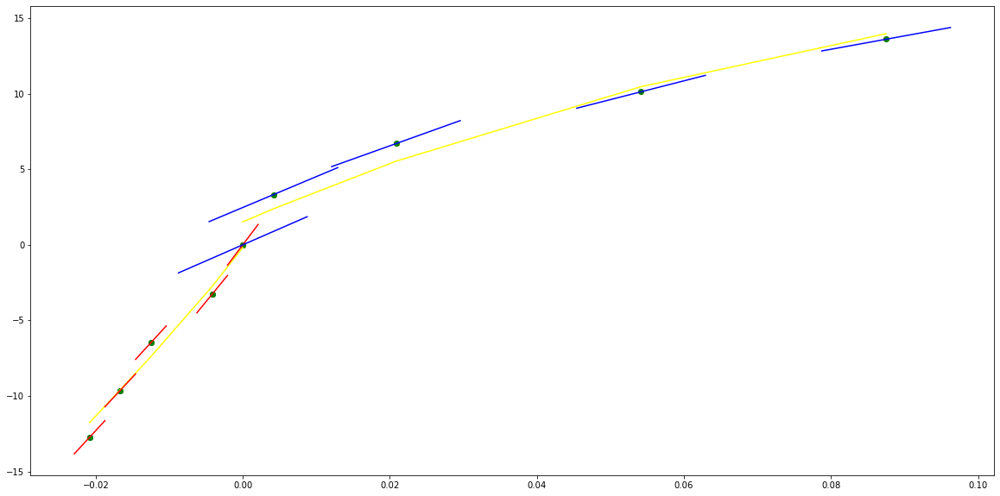

parameters (25789.543336109185, 10137.247121677905, 993.2321151002697, 0.5977222919226619)
tangent[0]:604.4326365249544
tangent[1]:676.826960885423
tangent[2]:751.8897854971232
tangent[3]:910.1113476732021
tangent[4]:993.2321151002697
parameters (3043.2979850098664, -1553.8769392197928, 362.0508798317979, 1.184541683537012)
tangent[0]:362.0508798317979
tangent[1]:349.25939988555706
tangent[2]:301.266816725259
tangent[3]:258.3490227645738
tangent[4]:220.50086766221258


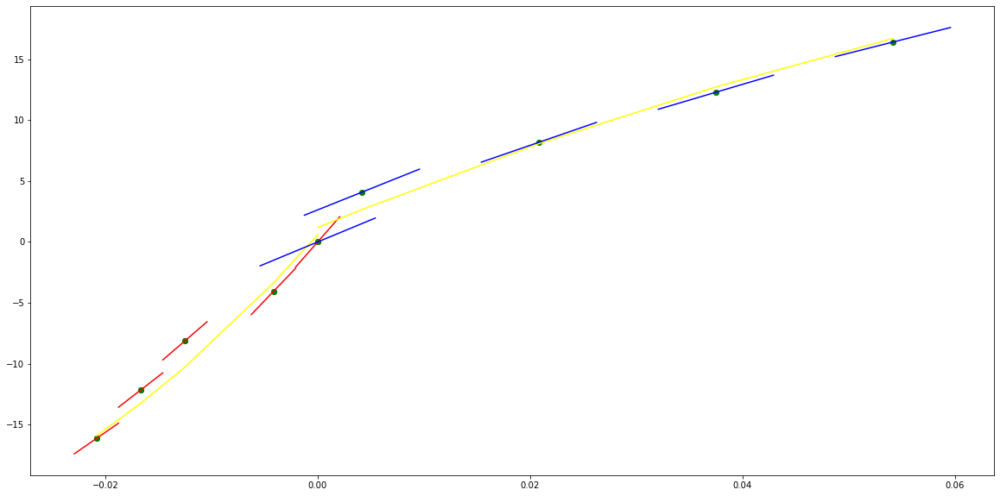

parameters (97.85622582034762, 69.25574264574689, 56.71673750521885, -0.006256736632537149)
tangent[0]:46.05802578886784
tangent[1]:40.927945791208174
tangent[2]:40.95326571939077
tangent[3]:47.591115155641866
tangent[4]:56.71673750521885
parameters (55562.75218981844, -13153.572836399333, 1063.0263450246287, -0.015606837053613772)
tangent[0]:1063.0263450246287
tangent[1]:956.323743523183
tangent[2]:855.3835474787273
tangent[3]:670.8900446238858
tangent[4]:587.3145977075532


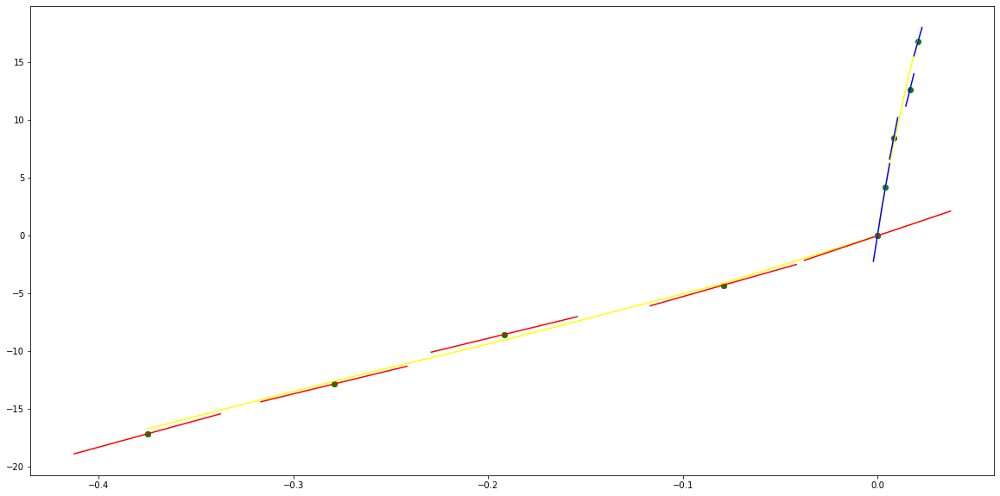

parameters (-0.13173257078839956, -3.9520789557935747, 4.770151687132983, 0.006786749636785756)
tangent[0]:13.88858976020206
tangent[1]:12.011790046314792
tangent[2]:9.956095551287447
tangent[3]:8.121074913392164
tangent[4]:4.770151687132983
parameters (4148.026505599043, -1842.1111332691046, 157.12797488350657, 0.00935400917518226)
tangent[0]:157.12797488350657
tangent[1]:85.77231003602111
tangent[2]:371.3249415972184
tangent[3]:392.0499224027817
tangent[4]:413.2119813760994


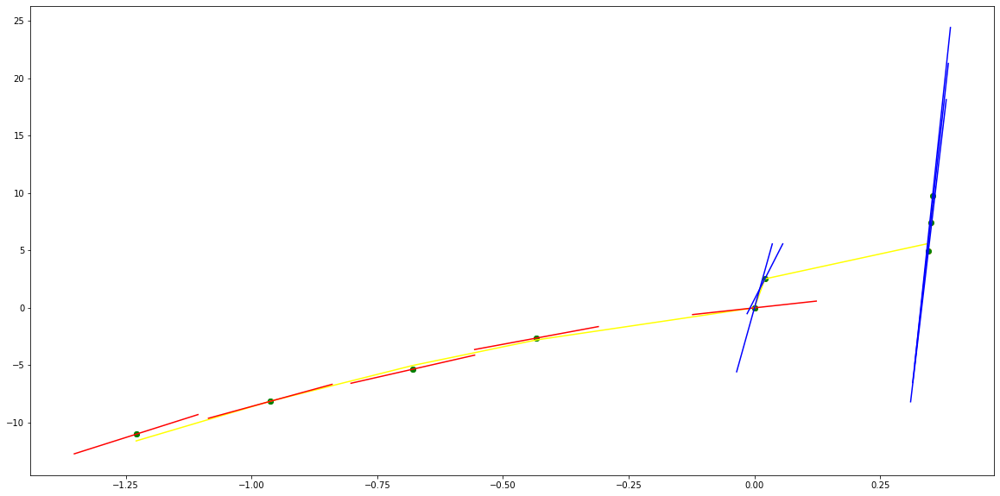

parameters (2.464820266418004, 5.363391358104548, 12.778855773845697, 0.055848222896973936)
tangent[0]:9.55270886694762
tangent[1]:8.91008679248694
tangent[2]:9.953555656272563
tangent[3]:10.073691312998946
tangent[4]:12.778855773845697
parameters (705.4050014595354, -1157.1487745263187, 464.73940396572954, 0.3361421829427044)
tangent[0]:464.73940396572954
tangent[1]:455.1347684643928
tangent[2]:445.6013101082631
tangent[3]:426.757111488375
tangent[4]:417.44410983032645


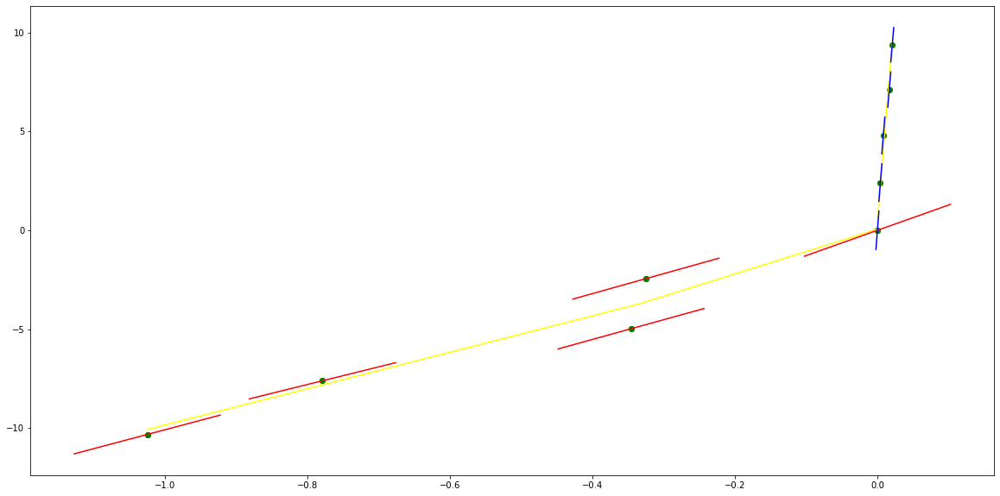

parameters (705.4050014595226, 976.700649483757, 282.7876046972017, 7.355348001034832e-06)
tangent[0]:426.75711148836785
tangent[1]:417.4441098303191
tangent[2]:408.20459961714323
tangent[3]:-159.97851418923307
tangent[4]:282.7876046972017
parameters (0.19657406305660077, -0.7699712795481578, 4.546551604986403, 0.010222237910540095)
tangent[0]:4.546551604986403
tangent[1]:3.9729961966999463
tangent[2]:3.6229855809937597
tangent[3]:3.5508520287224714
tangent[4]:3.90945330171582


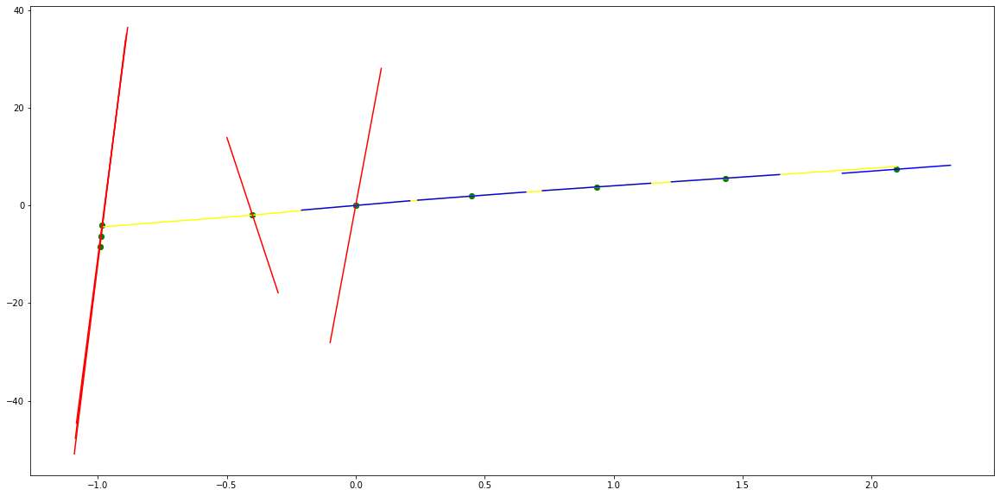

parameters (0.014543677272078245, 0.13505351035266105, 1.0380394688101888, -0.39902172209437414)
tangent[0]:0.622301951088353
tangent[1]:0.6219800756098828
tangent[2]:0.7516464331778663
tangent[3]:1.0357916966970266
tangent[4]:1.0380394688101888
parameters (513.0746980664338, -614.4257877131356, 182.13059821679036, 0.019317757727217767)
tangent[0]:182.13059821679036
tangent[1]:177.0367006183069
tangent[2]:171.99625685245903
tangent[3]:-51.12831866646417
tangent[4]:80.0399294983145


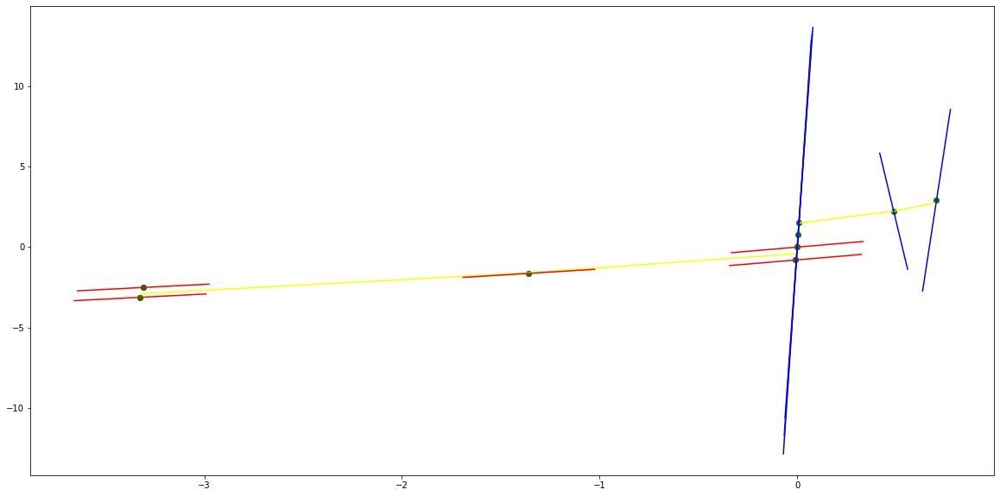

parameters (-20265.877251206406, -5386.054584854106, -320.9827855453927, 1.6602664293044656e-05)
tangent[0]:121.40946916503793
tangent[1]:141.41665721055784
tangent[2]:148.2518138892362
tangent[3]:152.97749795329565
tangent[4]:-320.9827855453927
parameters (0.6991606043532762, -3.2825495683776, 5.851255090042519, 0.5865040680757329)
tangent[0]:5.851255090042519
tangent[1]:5.715388238261929
tangent[2]:5.422901860505484
tangent[3]:2.7871407911997843
tangent[4]:2.0930542197333253


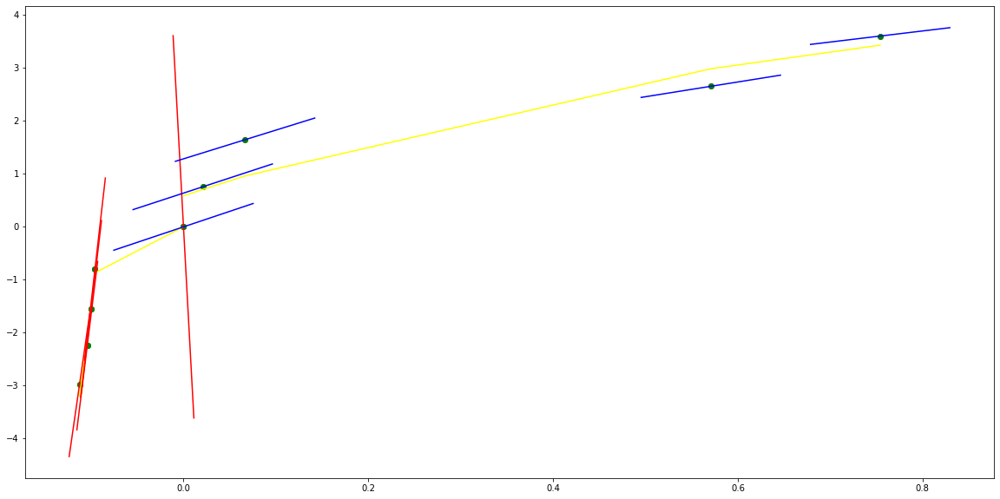

parameters (-6.905079902558775e-06, -0.007073082291119434, -0.4183309751296379, 0.0016517787279722261)
tangent[0]:-0.30648743381301824
tangent[1]:-0.334257647848346
tangent[2]:-0.36219427508396035
tangent[3]:-0.3902973014560397
tangent[4]:-0.4183309751296379
parameters (-8.920617748135657, 41.38968478393351, -47.54601619568779, -0.00012042038623182428)
tangent[0]:-47.54601619568779
tangent[1]:10.863720335680703
tangent[2]:-18.11419229149427
tangent[3]:-23.098581875405323
tangent[4]:-23.370234381908823


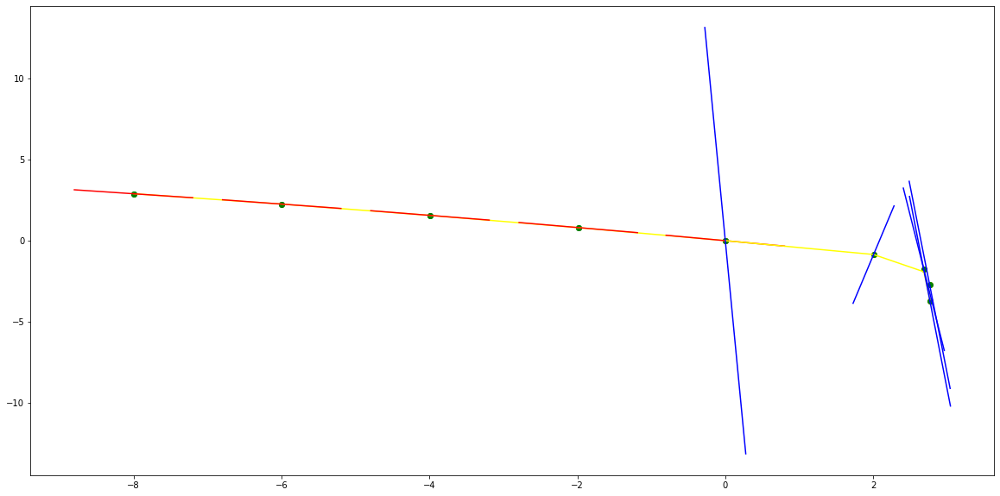

parameters (2.110936997163097e-05, -0.003442877926278408, -1.3340896883132767, -0.0010754214562674021)
tangent[0]:-1.2748189800410183
tangent[1]:-1.2903997601813382
tangent[2]:-1.305471810038339
tangent[3]:-1.3200351217109036
tangent[4]:-1.3340896883132767
parameters (-293.5083295266613, 1372.1103024592799, -1572.3658137684824, 2.7507674204584035e-07)
tangent[0]:-1572.3658137684824
tangent[1]:390.71872916158236
tangent[2]:-532.2823170189822
tangent[3]:-540.492378903109
tangent[4]:-548.7330194635615


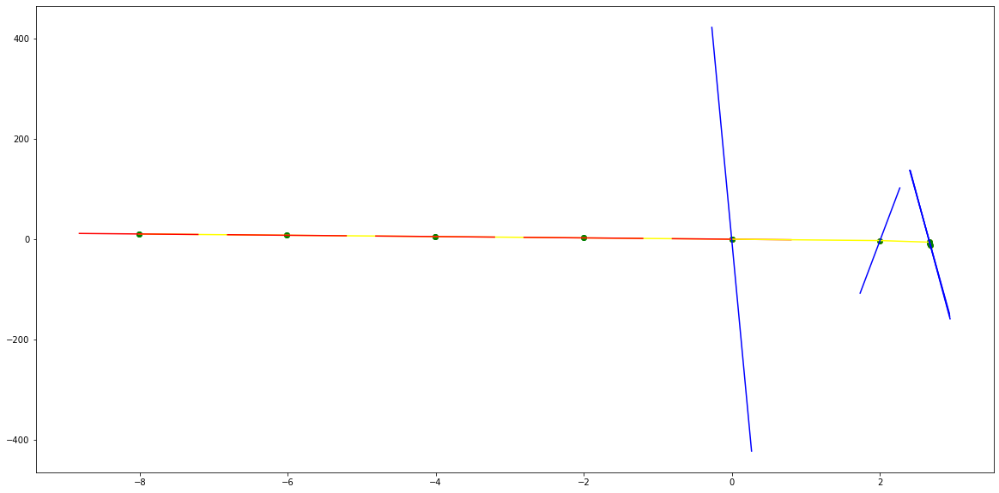

parameters (-3.838123161040796e-05, -0.004947798763227032, -1.3608617174717224, 0.004263828305672473)
tangent[0]:-1.288931941390342
tangent[1]:-1.3055268999032683
tangent[2]:-1.3230468504037403
tangent[3]:-1.3414917834576943
tangent[4]:-1.3608617174717224
parameters (3766.486386902289, -5931.044922984429, 2279.2353958498147, 6.221478656065912e-07)
tangent[0]:2279.2353958498147
tangent[1]:-593.2981816749175
tangent[2]:-579.3591700820975
tangent[3]:-565.0277533800258
tangent[4]:-535.1913793259196


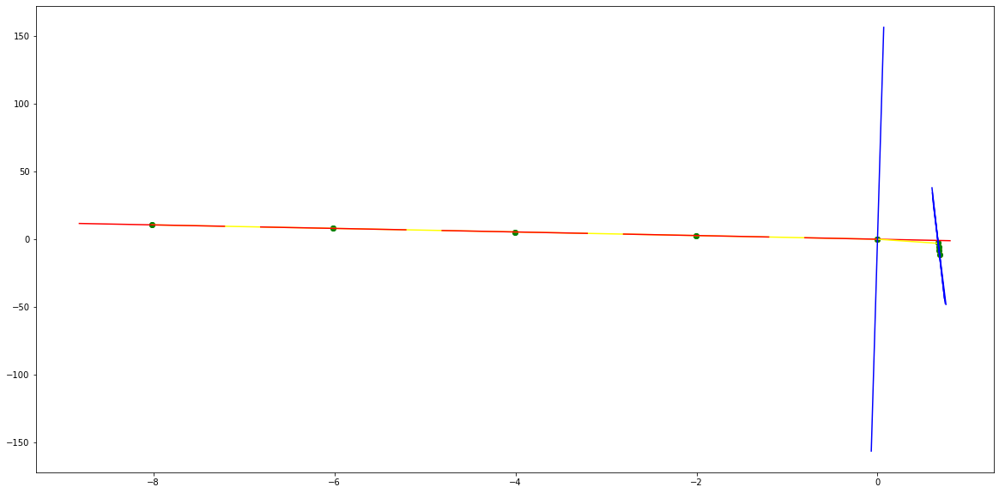

parameters (-194740.6911068504, -16606.70946066731, -694.6583506816593, 0.5691923694634113)
tangent[0]:-399.6622743071956
tangent[1]:-222.92839303726169
tangent[2]:-370.7753131213127
tangent[3]:-566.4024012689458
tangent[4]:-694.6583506816593
parameters (2242.1882294296606, -741.1061876761391, -148.45420610048342, -1.3933054810401302)
tangent[0]:-148.45420610048342
tangent[1]:-154.5123595860658
tangent[2]:-194.57793858328748
tangent[3]:-209.00427978381606
tangent[4]:-219.6944688480021


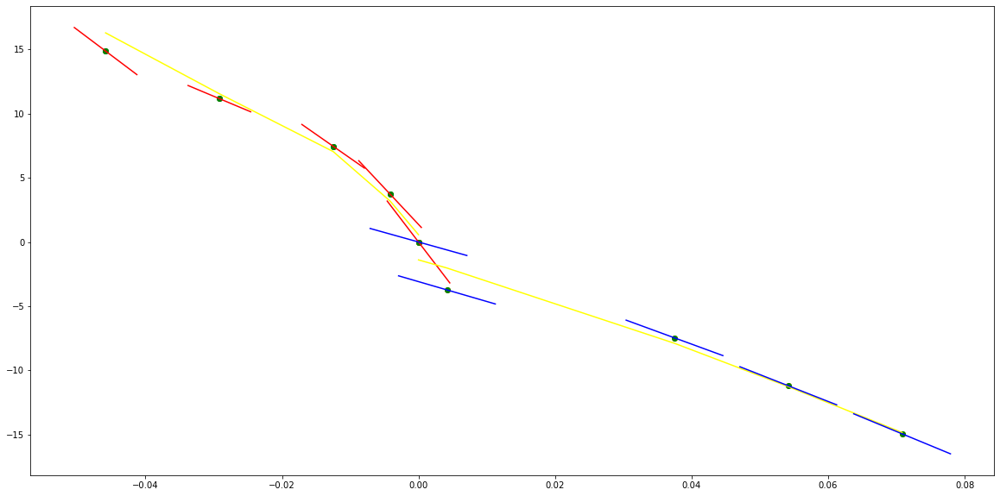

parameters (38699.27184646482, 2473.7783011033944, 229.5440209370188, 0.1551475102494084)
tangent[0]:335.9973507515795
tangent[1]:193.62490193511897
tangent[2]:184.00466168237625
tangent[3]:178.4162405939706
tangent[4]:229.5440209370188
parameters (25691.786034546458, -5166.903644760553, 437.1414291803942, 0.8739478598611485)
tangent[0]:437.1414291803942
tangent[1]:395.42847370603704
tangent[2]:356.3818402728087
tangent[3]:178.322204803437
tangent[4]:158.0108781565956


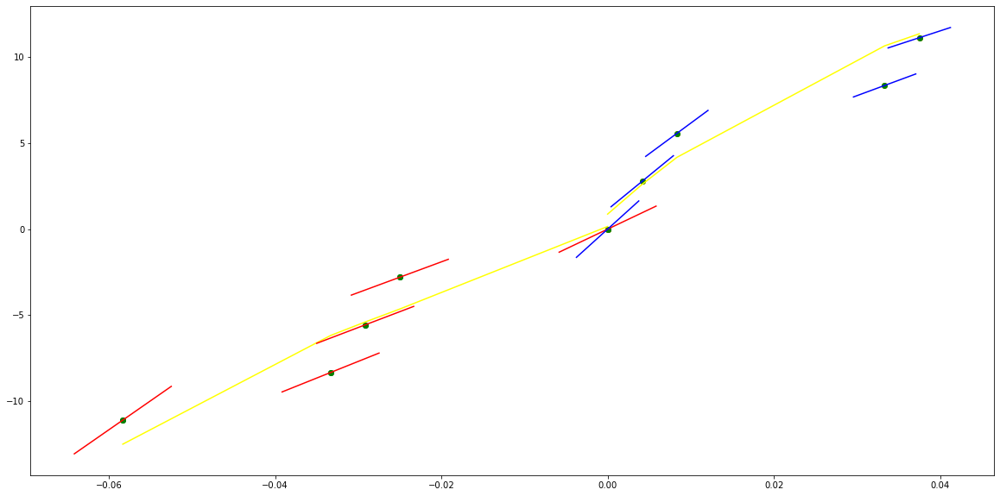

parameters (26930.756865510593, 4644.819272688895, 296.2807364655586, -0.20588082712539962)
tangent[0]:238.08755358065463
tangent[1]:54.0143676677157
tangent[2]:94.06553251586519
tangent[3]:224.48030397693603
tangent[4]:296.2807364655586
parameters (107841.66322660829, -14495.0290840437, 622.9060520809151, 0.5391011324605343)
tangent[0]:622.9060520809151
tangent[1]:507.72213170402154
tangent[2]:403.77351534618117
tangent[3]:-23.338385462314932
tangent[4]:192.69652877649196


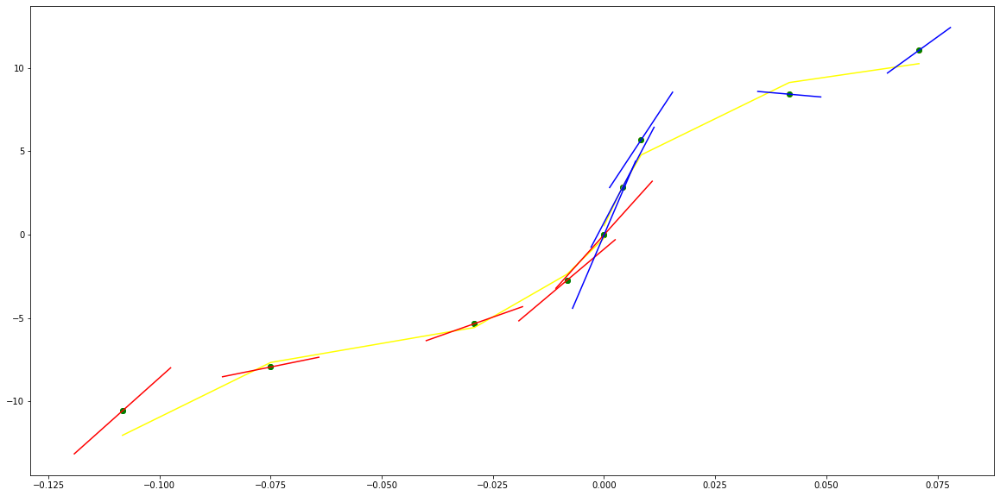

parameters (-19559.05136345832, -3839.122077163948, -29.155422601926926, -0.2771108575930873)
tangent[0]:221.94012104183852
tangent[1]:221.5272038780394
tangent[2]:219.07655953331792
tangent[3]:126.12745994978611
tangent[4]:-29.155422601926926
parameters (-11102.747599653172, 1963.1733886415855, 65.0237762441366, 2.0544977047398256)
tangent[0]:65.0237762441366
tangent[1]:80.80650263432939
tangent[2]:95.42913656473526
tangent[3]:180.72010970712205
tangent[4]:178.74342181318394


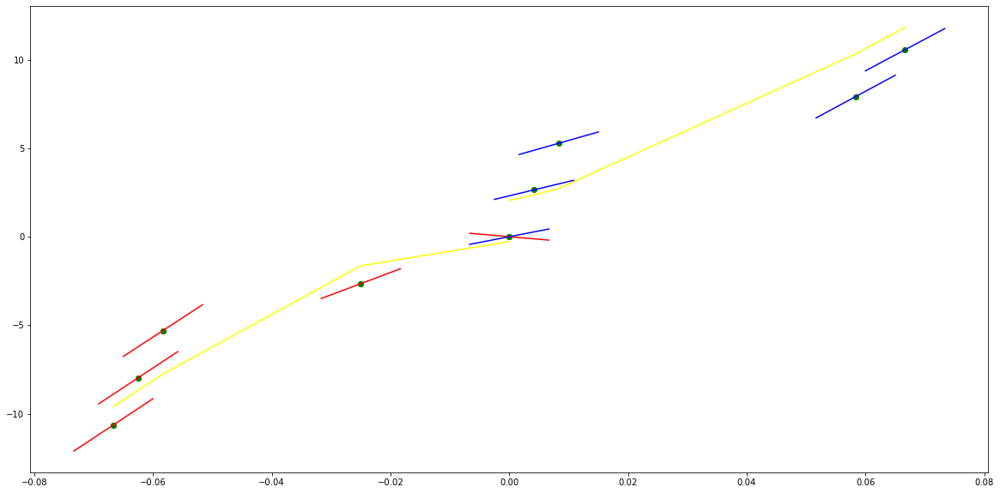

parameters (-0.26636675178837743, -2.2227410882612575, -2.203010150703017, 0.05330132528237017)
tangent[0]:3.9784329168238646
tangent[1]:3.896182507966296
tangent[2]:3.7284225226700833
tangent[3]:3.496744226566493
tangent[4]:-2.203010150703017
parameters (-184.62890612913452, 306.46563016381504, -113.64836223779342, -0.0023353061015297977)
tangent[0]:-113.64836223779342
tangent[1]:53.97797051785558
tangent[2]:53.393031352014404
tangent[3]:53.0716760968959
tangent[4]:52.73116962945973


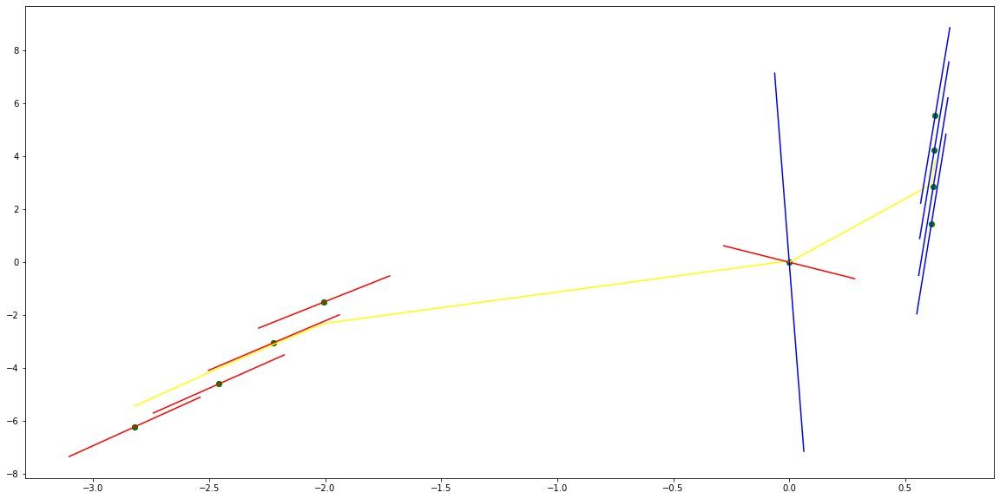

parameters (0.14247583017907423, 0.5840820698136159, 2.3833671718265186, -0.8780045183847952)
tangent[0]:2.5153411639547985
tangent[1]:2.262178857288085
tangent[2]:1.8228772468825936
tangent[3]:2.373662540141076
tangent[4]:2.3833671718265186
parameters (109.5563396287192, -150.09747400258294, 54.43048282501411, 1.0583037179691281)
tangent[0]:54.43048282501411
tangent[1]:53.18527744903826
tangent[2]:51.95178073480724
tangent[3]:34.81580970630572
tangent[4]:26.726385597722974


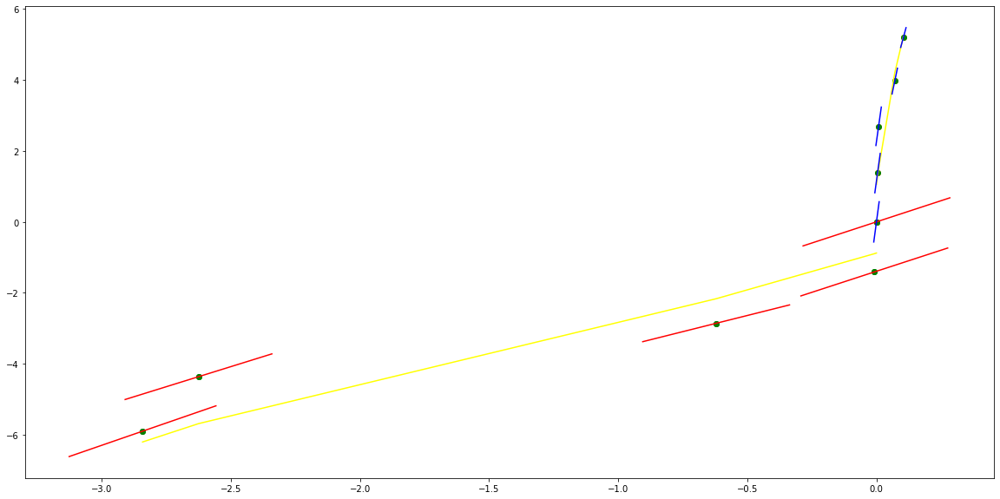

parameters (6.3801139318909135, 12.391781506666552, 7.11909465212103, -0.2355787326070711)
tangent[0]:8.883740183077771
tangent[1]:2.5958219004122487
tangent[2]:-0.9029217918526218
tangent[3]:6.812290792859939
tangent[4]:7.11909465212103
parameters (2108.4807242871916, -698.2872029193724, 68.64150082731636, 0.2528600276343447)
tangent[0]:68.64150082731636
tangent[1]:62.9318095539518
tangent[2]:57.44307798037936
tangent[3]:37.680542039386225
tangent[4]:-7.755435510247651


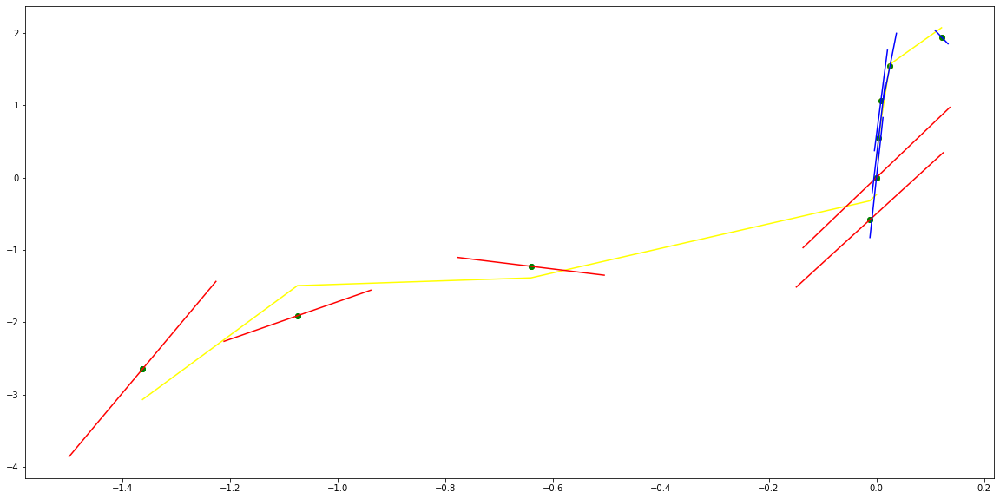

parameters (-25419.0880556547, -2634.408803024468, -158.23241197123085, 0.24333047945936895)
tangent[0]:-76.93929719969347
tangent[1]:-69.4299226195799
tangent[2]:-104.28738942170727
tangent[3]:-137.60137167726378
tangent[4]:-158.23241197123085
parameters (-1.6250578685755286, 8.624328731314082, -13.50932899123693, -1.1283202905456797)
tangent[0]:-13.50932899123693
tangent[1]:-13.437555695596146
tangent[2]:-12.939796243260416
tangent[3]:-10.769984652248759
tangent[4]:-9.440244666917746


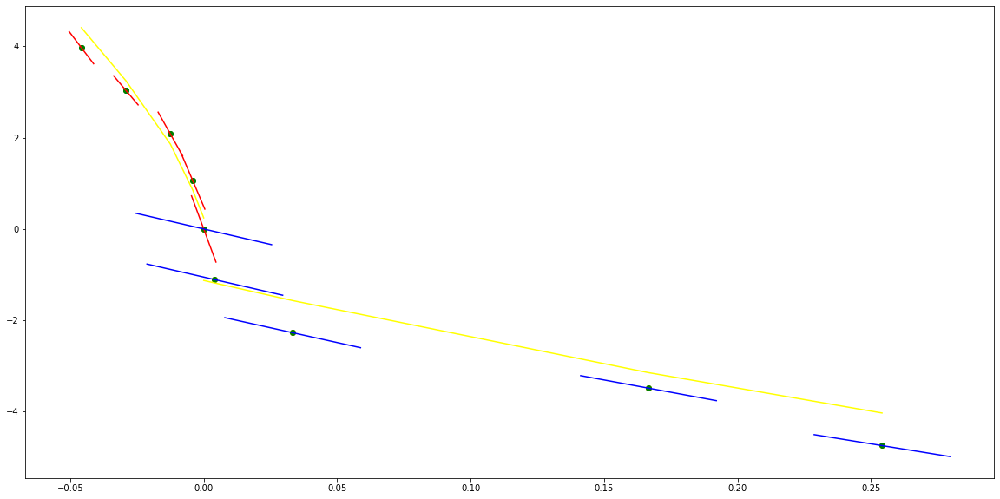

parameters (-214.20959634965013, -205.89986595415274, -52.666767709941496, -0.013526156521629223)
tangent[0]:-56.5076053427245
tangent[1]:-44.69864130236121
tangent[2]:-4.639146552057184
tangent[3]:9.232518805548636
tangent[4]:-52.666767709941496
parameters (-0.000390970522167199, 0.0027427863225342615, -0.9675772132722723, -0.18171175066621736)
tangent[0]:-0.9675772132722723
tangent[1]:-0.9633172050417778
tangent[2]:-0.9611879885658065
tangent[3]:-0.9663107697106832
tangent[4]:-0.9747812394625196


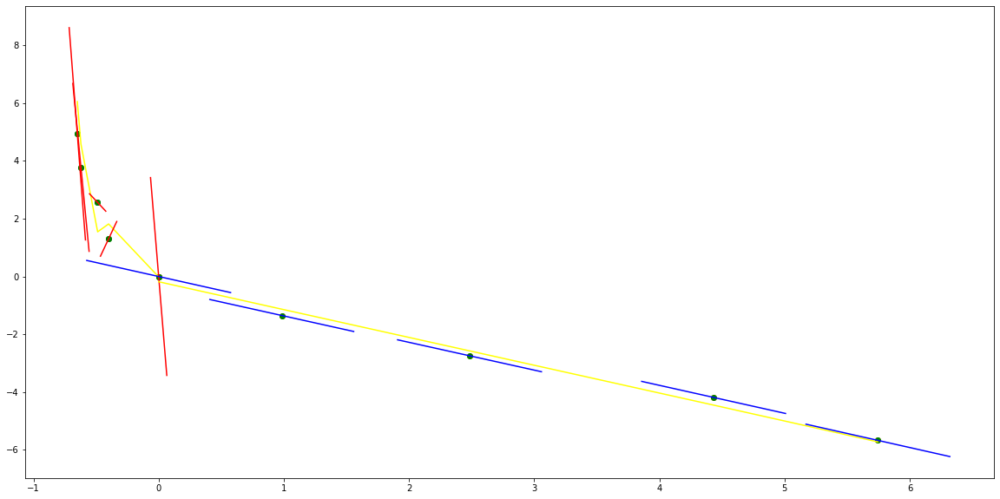

parameters (0.0007526918160495469, 0.010594203158562866, -0.9259779243252926, 0.011948321572120838)
tangent[0]:-0.9550202952564333
tangent[1]:-0.9717434370321489
tangent[2]:-0.9746282193594995
tangent[3]:-0.9593730504455318
tangent[4]:-0.9259779243252926
parameters (-25.629149069315798, 120.9119125360411, -139.42000273401143, -1.8076469070683948e-05)
tangent[0]:-139.42000273401143
tangent[1]:39.52882066941706
tangent[2]:-62.763568814959655
tangent[3]:-68.27787338242504
tangent[4]:-71.48777382523943


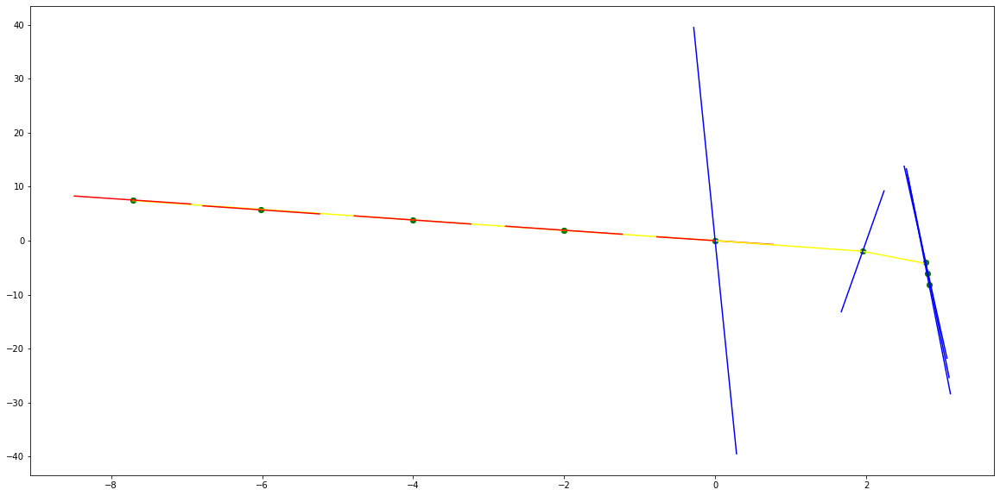

parameters (0.0003603487687360779, 0.0042394434170381625, -0.9631037257117525, 0.029589651170893273)
tangent[0]:-0.962040589923838
tangent[1]:-0.9752263720528618
tangent[2]:-0.9797277171760038
tangent[3]:-0.9755446165474801
tangent[4]:-0.9631037257117525
parameters (-421.14241278845185, 671.4792531730388, -270.29427595440495, 0.00046795352563155695)
tangent[0]:-270.29427595440495
tangent[1]:-28.54272247821484
tangent[2]:-51.86398327114091
tangent[3]:-66.15611946841466
tangent[4]:-126.00191733064378


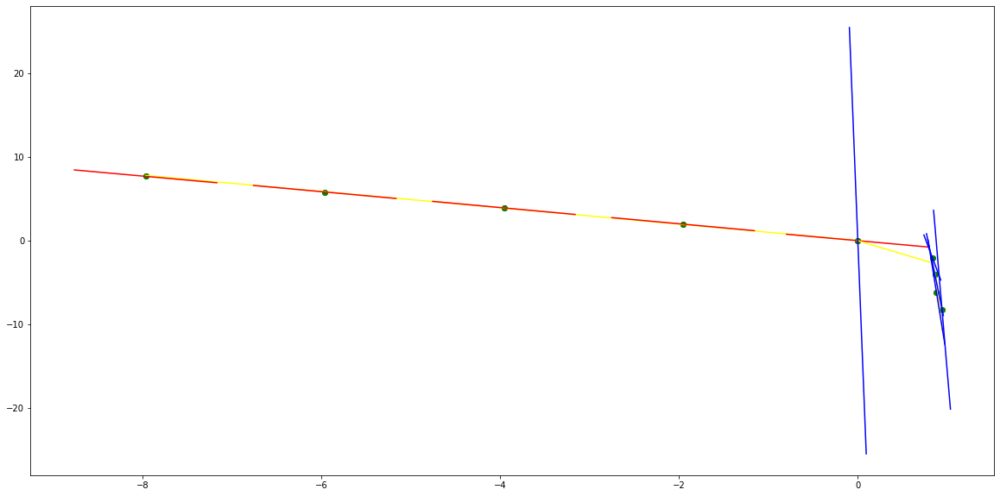

parameters (-113881.28231952037, -5551.223051077815, -497.24803763900087, 0.12581087153146128)
tangent[0]:-414.2289526641986
tangent[1]:-407.1084331346777
tangent[2]:-411.8493124493307
tangent[3]:-456.9164105674398
tangent[4]:-497.24803763900087
parameters (-263082.8662435587, 22610.21514390293, -785.5161664648288, 0.35324277375048596)
tangent[0]:-785.5161664648288
tangent[1]:-610.7870585173067
tangent[2]:-343.5808814189237
tangent[3]:-251.07174624416984
tangent[4]:-185.9837960018706


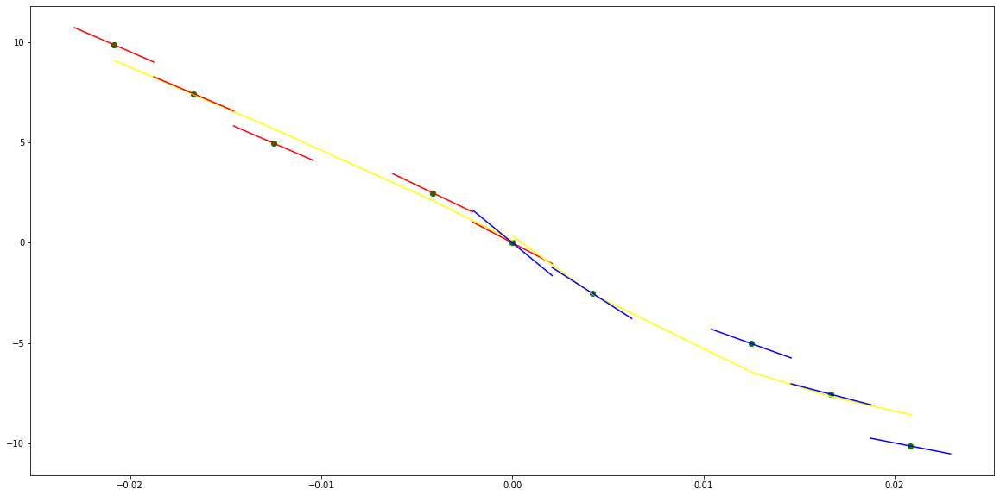

parameters (-11230.620593892274, -2672.3430890419068, -319.93836074056395, 0.1975932397178565)
tangent[0]:-117.5043096950007
tangent[1]:-155.73507324032767
tangent[2]:-207.37861990201662
tangent[3]:-277.73583312513495
tangent[4]:-319.93836074056395
parameters (-151802.5074812842, 10493.353120875296, -752.7455822719311, -0.1633681089569544)
tangent[0]:-752.7455822719311
tangent[1]:-673.2188148273937
tangent[2]:-609.4863515601671
tangent[3]:-529.4731056498905
tangent[4]:-513.1827210332523


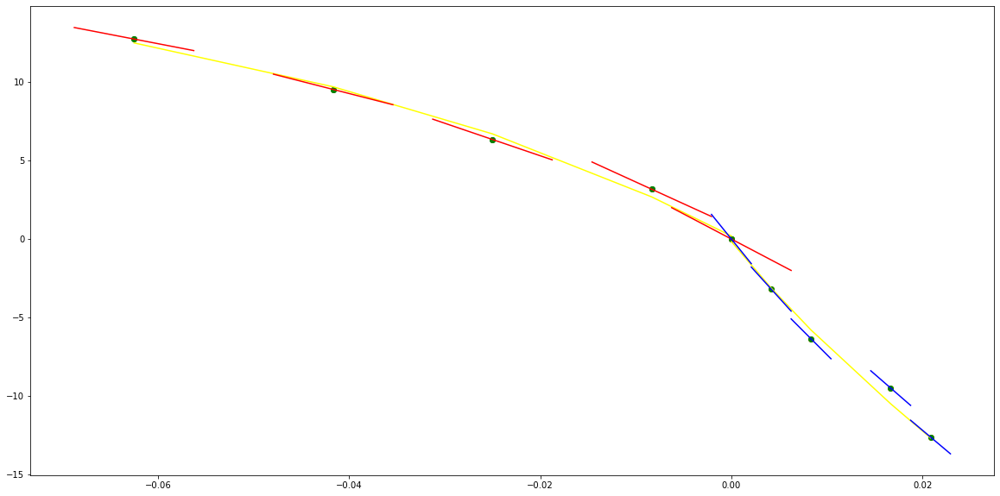

parameters (25236.014915141226, 3113.8932355274183, 185.31103494735245, -0.002340964891447372)
tangent[0]:88.42282906504376
tangent[1]:102.54337147247502
tangent[2]:119.29308605063943
tangent[3]:160.67443480783353
tangent[4]:185.31103494735245
parameters (-2151.7159749251828, 1301.074451305051, 19.754164854144353, 0.31714313975735847)
tangent[0]:19.754164854144353
tangent[1]:30.482684501121312
tangent[2]:90.15733230065841
tangent[3]:108.25719693280756
tangent[4]:125.45835936374388


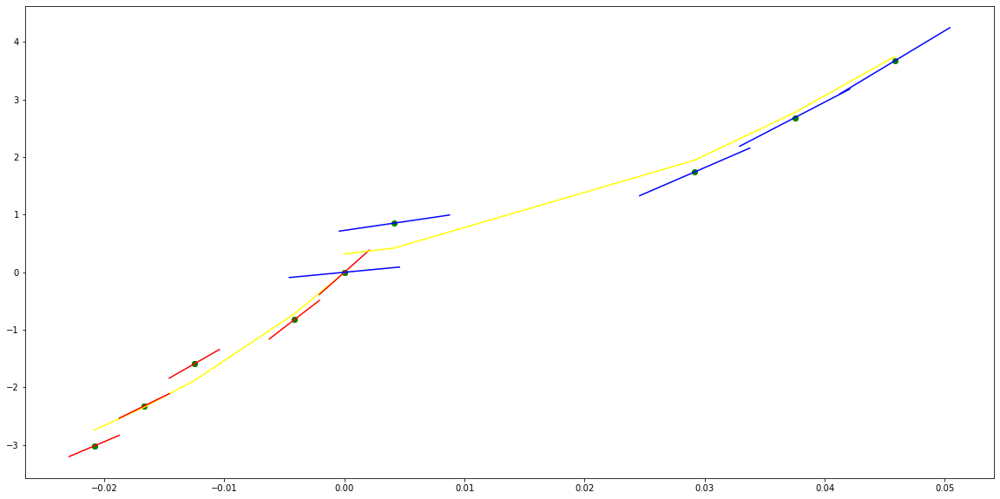

parameters (114064.28578837565, 8081.714861611217, 532.6109222467715, 0.2933165264750262)
tangent[0]:352.28038398665217
tangent[1]:358.27241272101725
tangent[2]:384.0356846697921
tangent[3]:421.67209410095927
tangent[4]:532.6109222467715
parameters (30867.593450007356, -7312.010578608391, 618.3766476732567, 0.2155102822110457)
tangent[0]:618.3766476732567
tangent[1]:559.0601482724121
tangent[2]:502.9449135559858
tangent[3]:400.3736478103481
tangent[4]:353.9053077368853


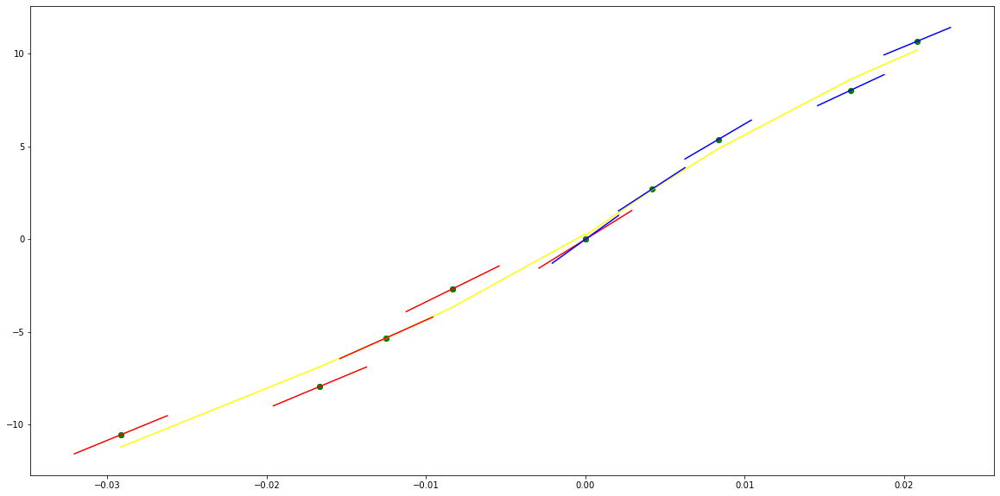

parameters (-1057.2847616945253, -271.1264422556941, 95.526082646036, 0.1852328181230497)
tangent[0]:118.57529315393211
tangent[1]:114.70909115889647
tangent[2]:113.71641084251924
tangent[3]:112.61335401039713
tangent[4]:95.526082646036
parameters (67745.77795357187, -9149.10452927026, 455.88936231380274, 0.5388154708180074)
tangent[0]:455.88936231380274
tangent[1]:383.1863203050333
tangent[2]:317.5229608955948
tangent[3]:49.07224403856577
tangent[4]:61.03787531617036


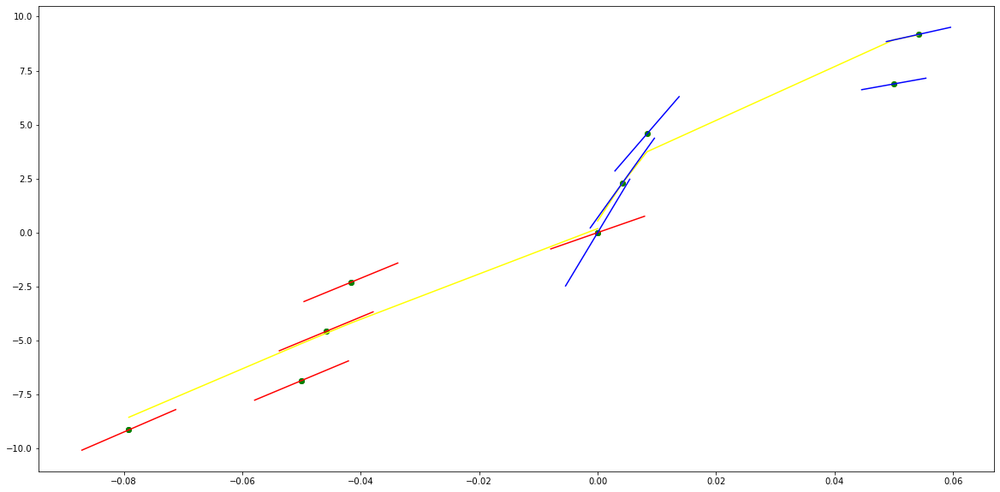

parameters (249.95413744264823, 179.23226188613447, 63.936201332726085, -0.9234114326131225)
tangent[0]:22.777506168027813
tangent[1]:25.977992825063723
tangent[2]:47.887631174932494
tangent[3]:61.00118606894668
tangent[4]:63.936201332726085
parameters (3807.5051424799553, -1513.6863052791725, 215.7177394525514, 0.7672606462605165)
tangent[0]:215.7177394525514
tangent[1]:203.30101707433764
tangent[2]:168.43356802254934
tangent[3]:147.1724963307427
tangent[4]:85.24843729363423


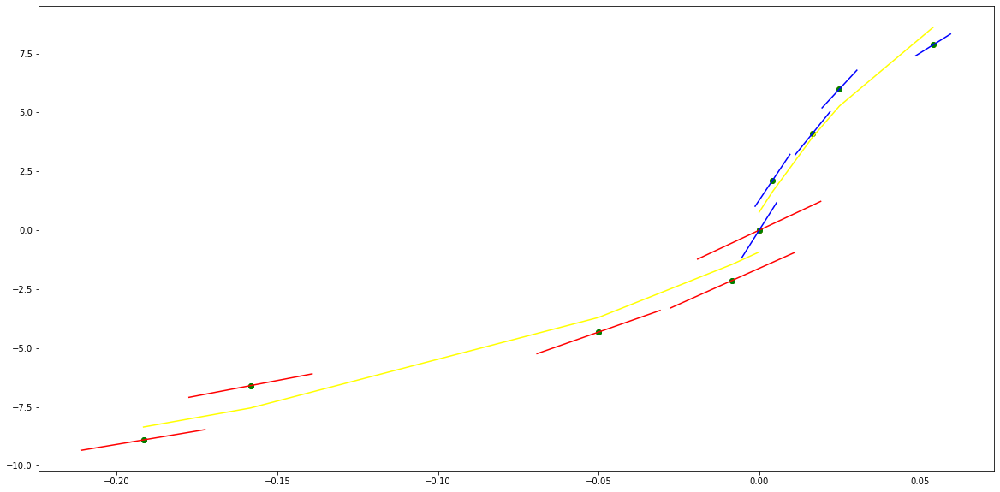

parameters (-0.07220848585301413, -0.524113952831651, 1.7593145307126337, 0.15515931466329128)
tangent[0]:2.87794882865098
tangent[1]:3.0258259979411304
tangent[2]:3.000420854634373
tangent[3]:2.7415834534638304
tangent[4]:1.7593145307126337
parameters (29.781064128151332, -75.08506718694133, 44.25459548252018, -0.0023038642586093137)
tangent[0]:44.25459548252018
tangent[1]:-18.797403194037997
tangent[2]:44.632015056349665
tangent[3]:57.804110378309524
tangent[4]:60.58730235602592


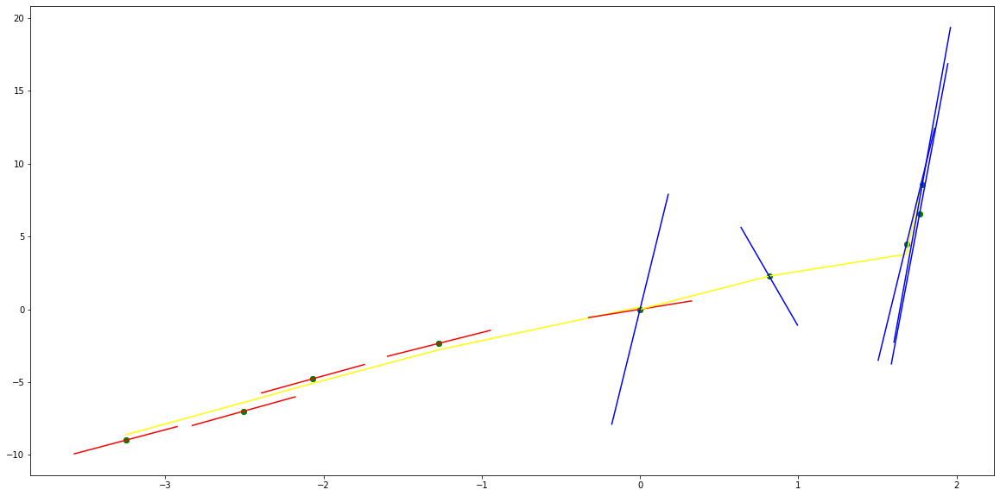

parameters (-0.08627257630846727, -0.7149219248821387, 1.1675963813440078, -0.2617494005614334)
tangent[0]:3.0616444665360056
tangent[1]:3.138602826102982
tangent[2]:3.024556723664354
tangent[3]:2.1626854812570224
tangent[4]:1.1675963813440078
parameters (156.6747023654691, -242.9582380500702, 95.13654293034672, 0.0004520022133911099)
tangent[0]:95.13654293034672
tangent[1]:27.049040445973517
tangent[2]:57.71264728972092
tangent[3]:64.6284164670865
tangent[4]:71.80572772233656


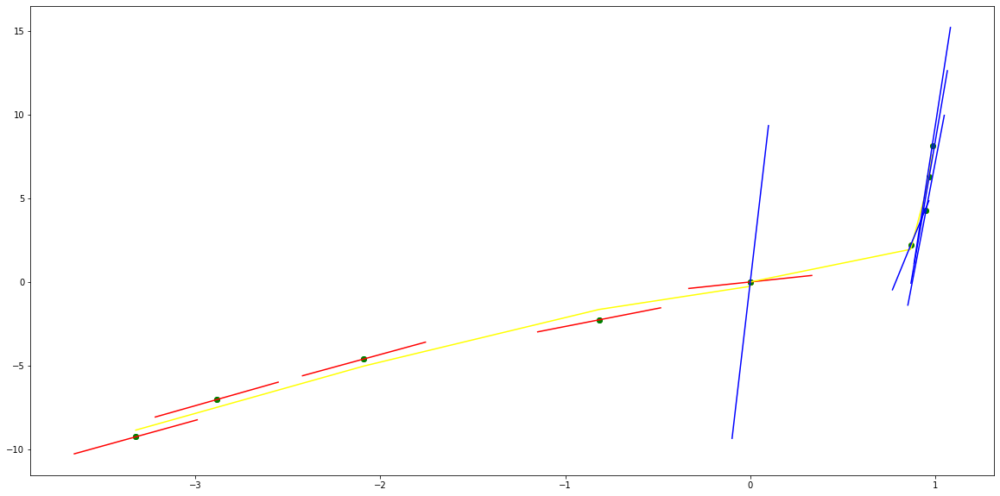

parameters (29.78106412815121, 90.94433554643786, 73.7263972308288, 0.1300417183505789)
tangent[0]:57.804110378309254
tangent[1]:60.58730235602567
tangent[2]:63.420296935162064
tangent[3]:66.30292860660285
tangent[4]:73.7263972308288
parameters (48182.82695578025, -6752.992045760557, 413.63739623655835, 0.013472169305997851)
tangent[0]:413.63739623655835
tangent[1]:359.867884304089
tangent[2]:311.1182199254179
tangent[3]:228.68712128995227
tangent[4]:194.99579490563644


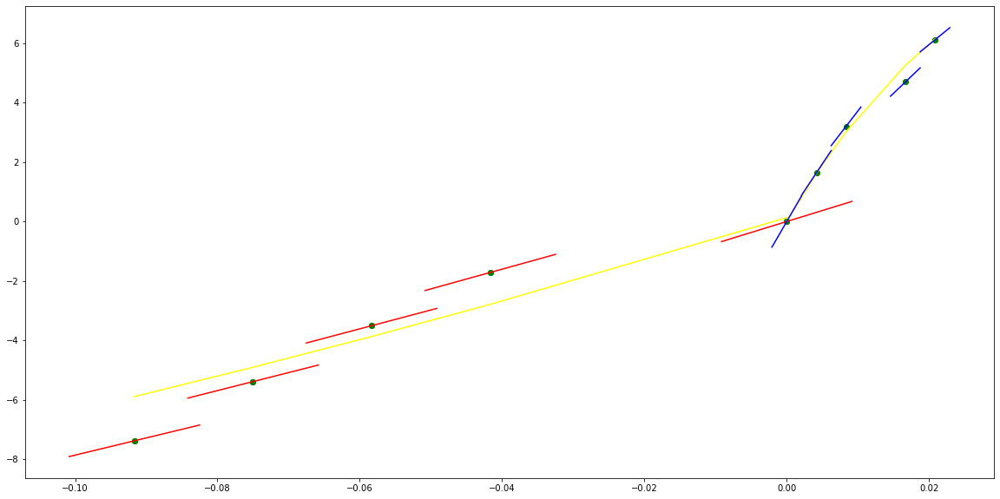

parameters (1868.5885614906567, 662.9257011482962, -33.00055168130895, 0.00011580378203706831)
tangent[0]:-104.5595012105592
tangent[1]:-102.83057593758404
tangent[2]:-85.27870758495864
tangent[3]:-70.96760463952839
tangent[4]:-33.00055168130895
parameters (-2283.9668630116826, 1074.1251616694444, -157.80073994551552, -0.6563954455770785)
tangent[0]:-157.80073994551552
tangent[1]:-148.97004764286513
tangent[2]:-116.02006098108492
tangent[3]:-86.87683802363772
tangent[4]:10.536232248503637


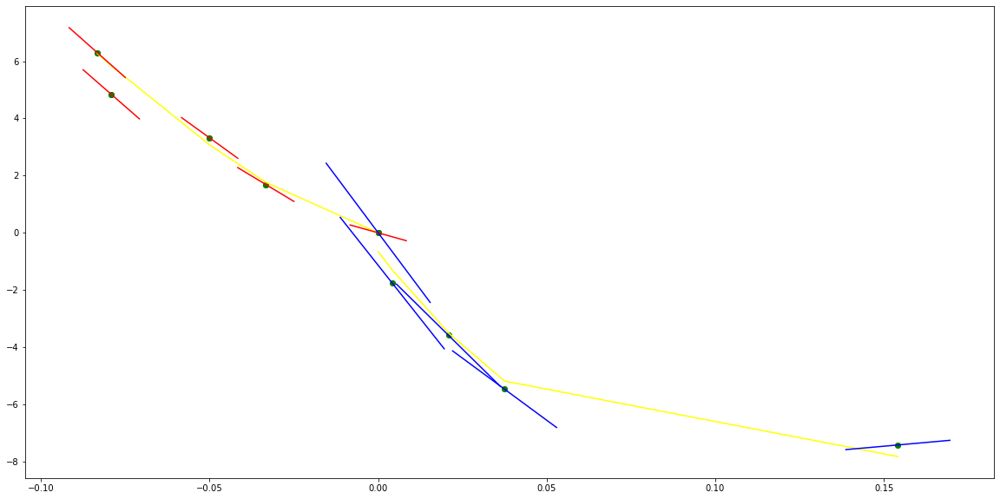

parameters (-1074.563537902942, -703.3936417056436, -160.6057023217587, 0.5946523213417101)
tangent[0]:-93.86276976021082
tangent[1]:-98.32556468546642
tangent[2]:-102.89919994145964
tangent[3]:-154.79959551777065
tangent[4]:-160.6057023217587
parameters (-68.98218049688745, 304.59376052969975, -287.392391248356, -0.037433435855245875)
tangent[0]:-287.392391248356
tangent[1]:-284.8581077079124
tangent[2]:-274.79100529541296
tangent[3]:156.20369198551208
tangent[4]:-373.7175284777813


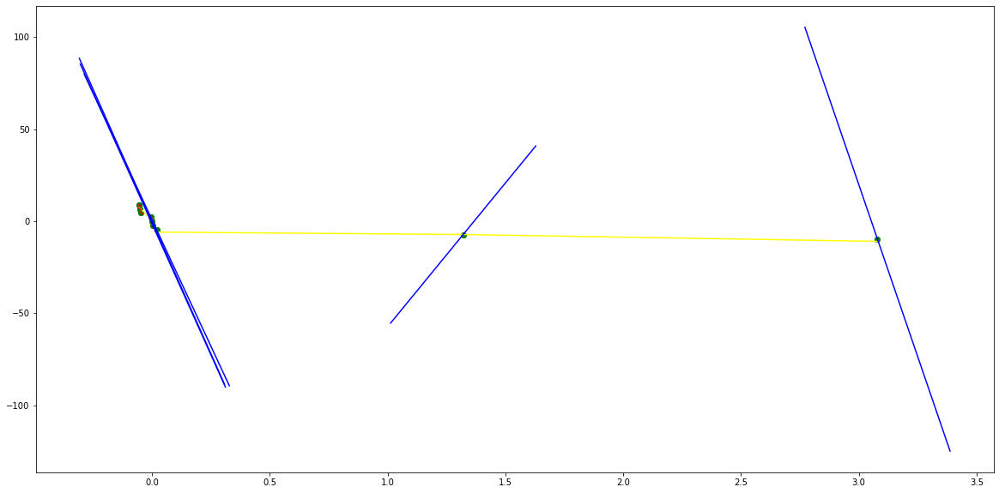

parameters (837.3798790603962, 2354.7173688589123, 1643.9912091515644, -1.64621280804306e-05)
tangent[0]:-185.63466779832834
tangent[1]:-193.70726028300123
tangent[2]:-201.69070587457918
tangent[3]:-232.75796304539836
tangent[4]:1643.9912091515644
parameters (1116.094112393547, -4231.054438954183, 3987.370550231132, 2.8391371478430766e-08)
tangent[0]:3987.370550231132
tangent[1]:-539.8332522618125
tangent[2]:-525.971168099813
tangent[3]:-511.99280553212657
tangent[4]:-483.6906694764598


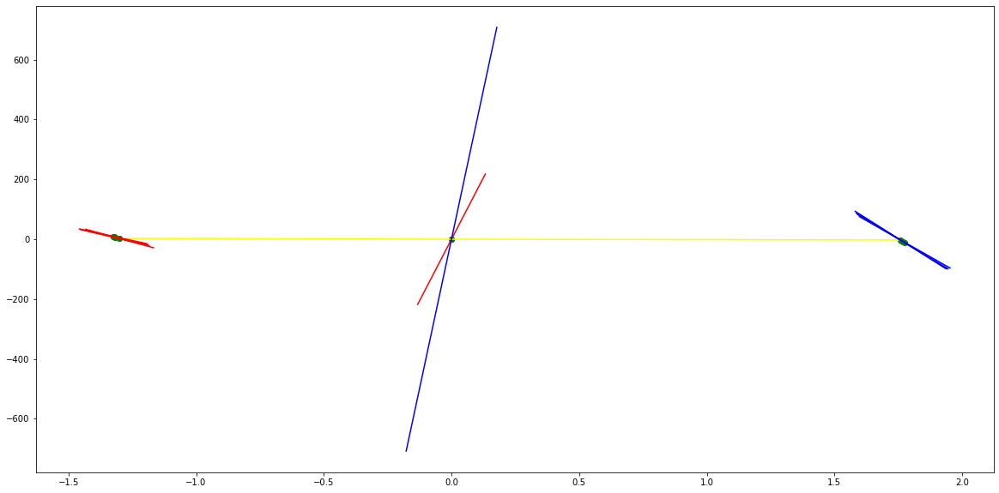

parameters (351.40770794109415, 180.0599396901807, -81.12228999470412, -0.060716352564064574)
tangent[0]:-110.98162096562734
tangent[1]:-107.76288501326151
tangent[2]:-102.20127587672526
tangent[3]:-94.29712724589298
tangent[4]:-81.12228999470412
parameters (-686.6362676562858, 357.58759110792454, -134.64121994861262, -0.07493864496820168)
tangent[0]:-134.64121994861262
tangent[1]:-118.04928339507192
tangent[2]:-99.93223783607107
tangent[3]:-86.39267584373417
tangent[4]:-75.24978320006332


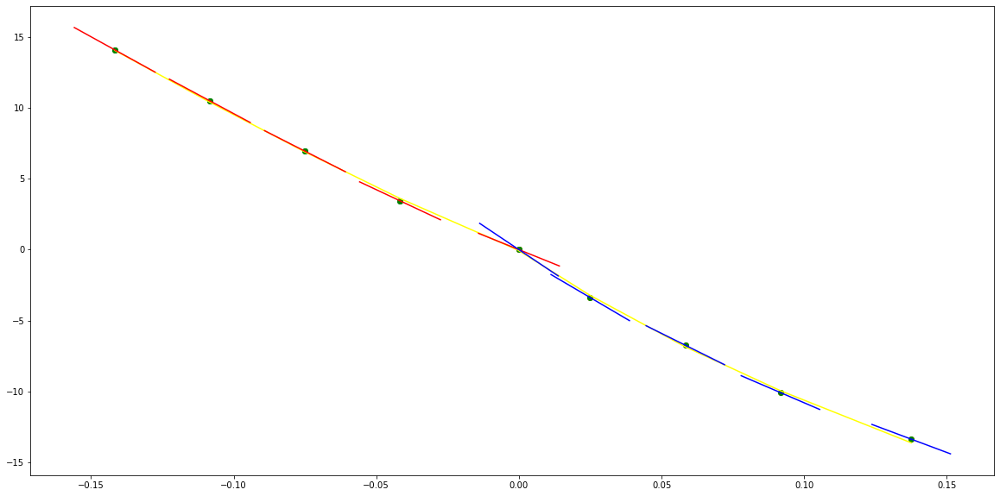

parameters (387.33327743933006, 214.4709778395276, 34.61899492953878, -0.15463886260890286)
tangent[0]:20.167733855771388
tangent[1]:21.612157823597215
tangent[2]:27.792609996673768
tangent[3]:32.85177063633054
tangent[4]:34.61899492953878
parameters (24562.17872945754, -2219.7039097538163, 89.63728714321803, 0.033790176879470925)
tangent[0]:89.63728714321803
tangent[1]:72.41775959449912
tangent[2]:22.839239039388616
tangent[3]:23.53079792336733
tangent[4]:26.78118542658079


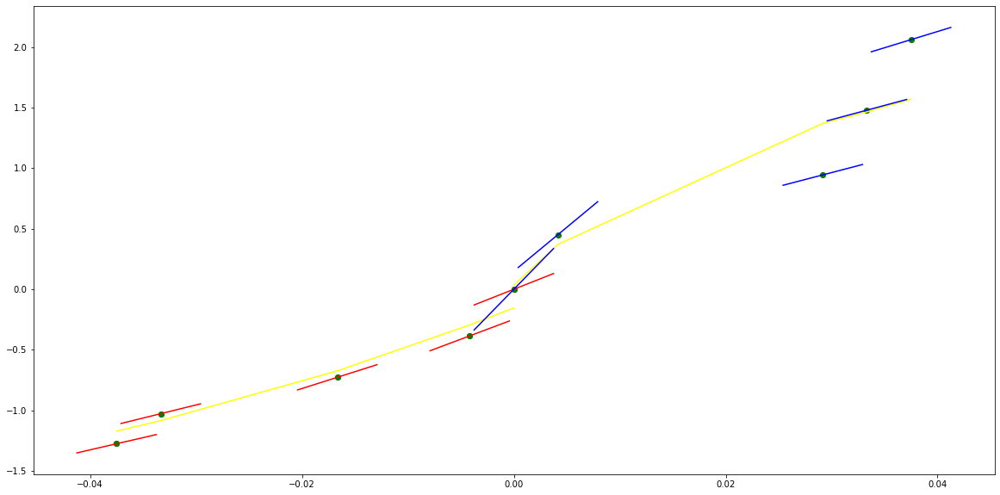

parameters (-49616.261335641975, -9150.544157634708, -237.87182905122958, -1.6995073497990558)
tangent[0]:320.651604369496
tangent[1]:324.5056281260544
tangent[2]:288.2406862176034
tangent[3]:-164.2128485361813
tangent[4]:-237.87182905122958
parameters (-12867.926897854537, 2364.192582763107, 50.47759118470159, 1.1737584586000196)
tangent[0]:50.47759118470159
tangent[1]:69.51046040650594
tangent[2]:173.5054682916108
tangent[3]:195.20564569585713
tangent[4]:194.13077064890155


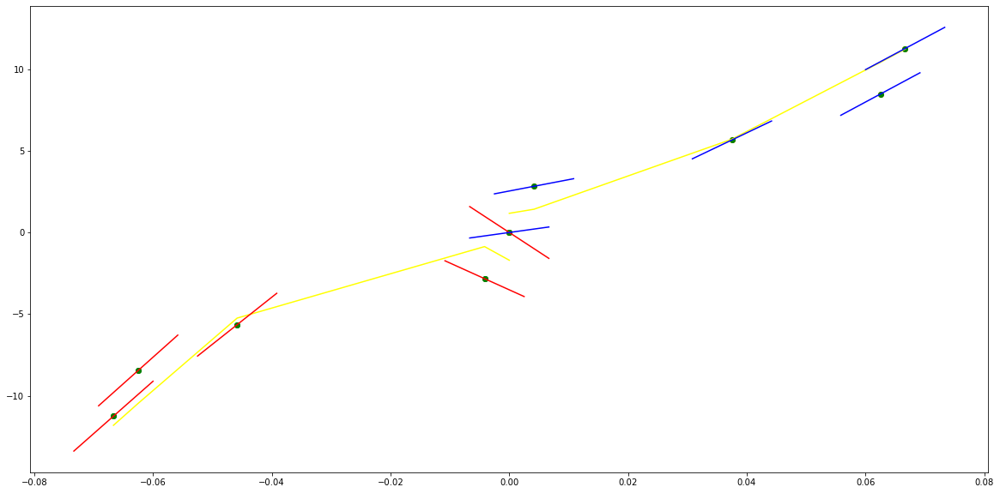

parameters (-14517.794691581013, -3306.6666529051017, -65.72957845615991, 0.1270713992373396)
tangent[0]:184.86109510192057
tangent[1]:181.588981443744
tangent[2]:177.47334661501282
tangent[3]:171.84519953298528
tangent[4]:-65.72957845615991
parameters (-25050.445246645708, 3418.120543317919, 65.7139626525428, 1.699751204462445)
tangent[0]:65.7139626525428
tangent[1]:92.89565980856435
tangent[2]:117.46193436683201
tangent[3]:220.08646347099784
tangent[4]:219.64767763449186


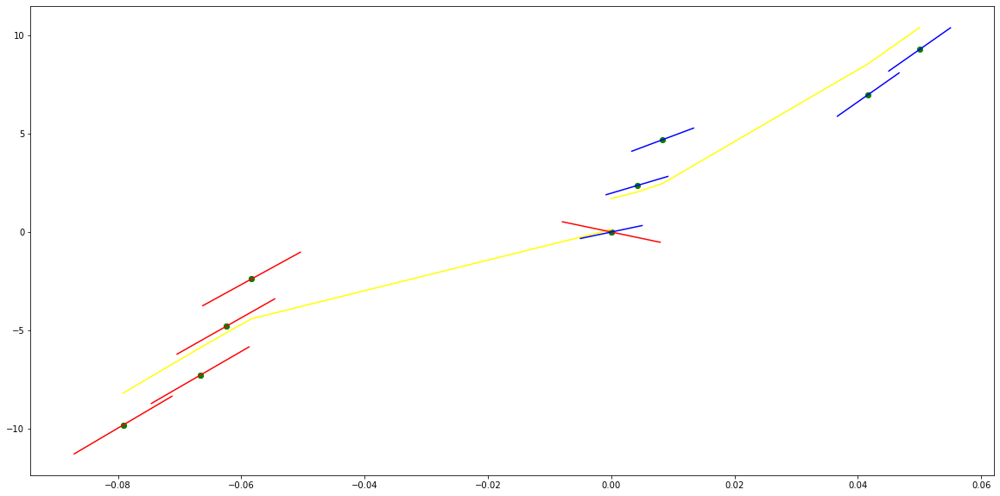

parameters (905.3458262046332, 499.7234203286398, 92.44857118411421, 0.11515701067106016)
tangent[0]:55.520811076339896
tangent[1]:62.15176870908059
tangent[2]:65.60911700099115
tangent[3]:69.15992359181591
tangent[4]:92.44857118411421
parameters (7481.985357143625, -1921.1536283272937, 139.57387220147334, 0.37613398784975266)
tangent[0]:139.57387220147334
tangent[1]:123.95272695271687
tangent[2]:109.1110798834068
tangent[3]:-2.694515806470065
tangent[4]:-22.340669145822062


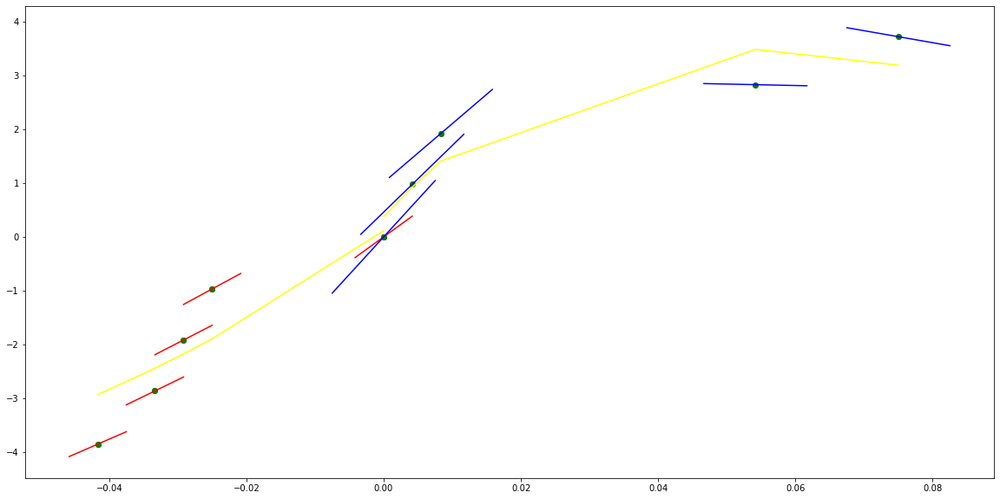

parameters (54.74180132713236, 60.0316135539136, 18.42963466494395, 0.24838064068412352)
tangent[0]:22.909247472157734
tangent[1]:22.363100278784845
tangent[2]:-3.0853495083256277
tangent[3]:5.661383152599898
tangent[4]:18.42963466494395
parameters (4643.812580749473, -1400.8150491592078, 104.66274049551214, 0.0889660806533824)
tangent[0]:104.66274049551214
tangent[1]:93.23025181438612
tangent[2]:34.799262998928455
tangent[3]:26.755070111471852
tangent[4]:19.192696133608408


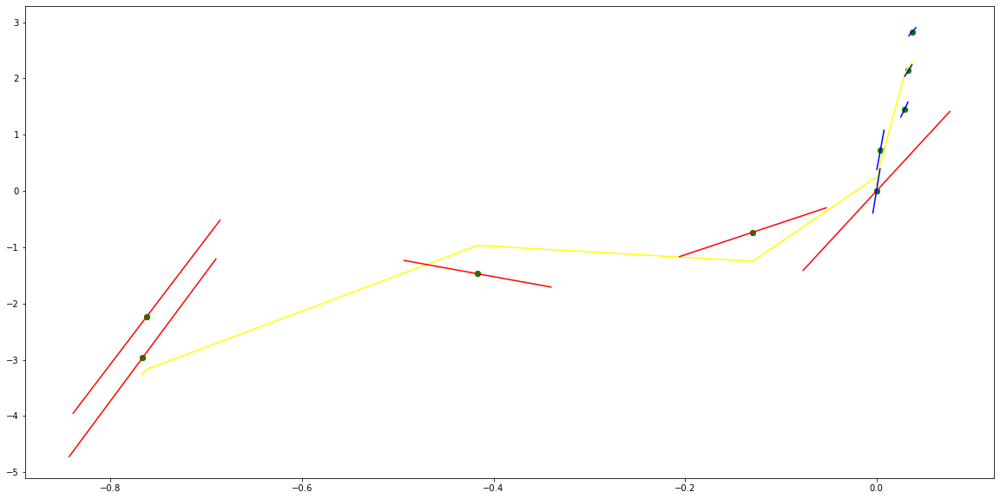

parameters (2531.511346156264, 941.7462968324041, 123.7169086250209, -0.08799528645180639)
tangent[0]:63.76574985418734
tangent[1]:69.37265238766682
tangent[2]:75.2432962132477
tangent[3]:116.00208584061187
tangent[4]:123.7169086250209
parameters (-88.06137754756891, 24.669123606779475, 23.10608936856281, 0.3673623711045987)
tangent[0]:23.10608936856281
tangent[1]:23.30709458074694
tangent[2]:25.378906919531335
tangent[3]:25.071284589718978
tangent[4]:24.89536710265099


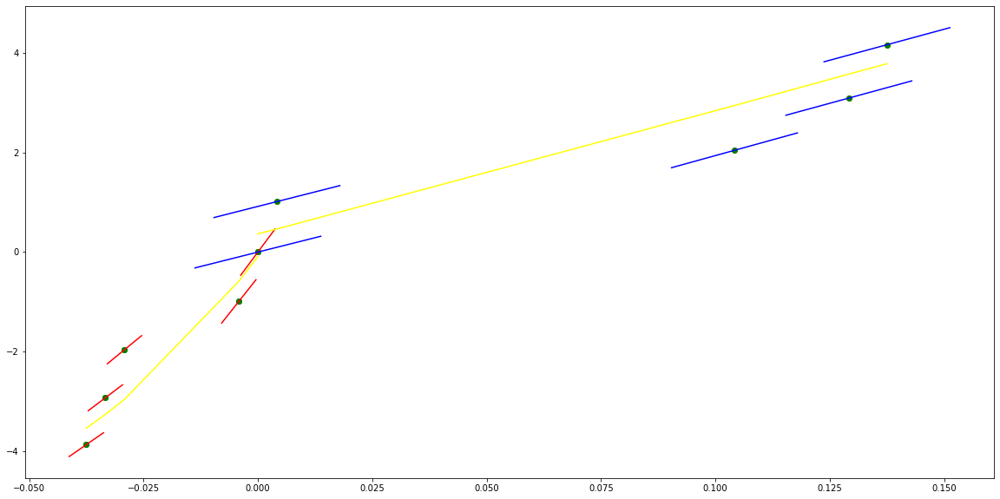

parameters (0.11474490602025234, 0.3140710478780706, 2.5800903341648067, -0.6118669192527989)
tangent[0]:3.5363910963859446
tangent[1]:2.9366120267424334
tangent[2]:2.4959396911079335
tangent[3]:2.4389229575701936
tangent[4]:2.5800903341648067
parameters (115.10354584124376, -167.21857974559006, 76.00519184221045, 0.8132007630211999)
tangent[0]:76.00519184221045
tangent[1]:74.61791969387713
tangent[2]:55.244287417995935
tangent[3]:50.53351138480524
tangent[4]:32.65340434926122


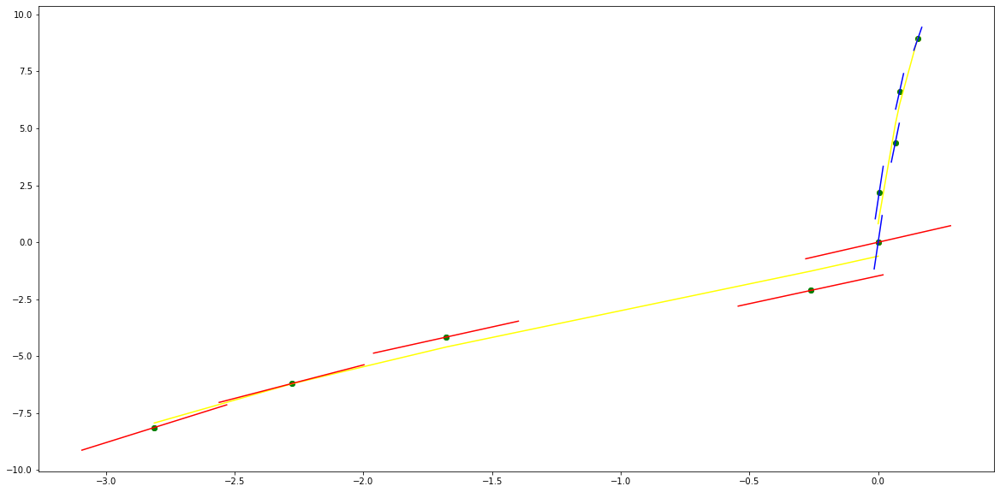

parameters (-0.10892708036332727, -0.2978221408625944, 3.51824896477223, 0.17988079041708951)
tangent[0]:3.666635870593254
tangent[1]:3.7790569276055224
tangent[2]:3.7807225501852932
tangent[3]:3.773903254034632
tangent[4]:3.51824896477223
parameters (2553.0643247331864, -838.0190196786705, 114.16303864027357, 0.7691852175794094)
tangent[0]:114.16303864027357
tangent[1]:107.31198150690511
tangent[2]:100.72845950907387
tangent[3]:57.624984435234666
tangent[4]:42.45694548210621


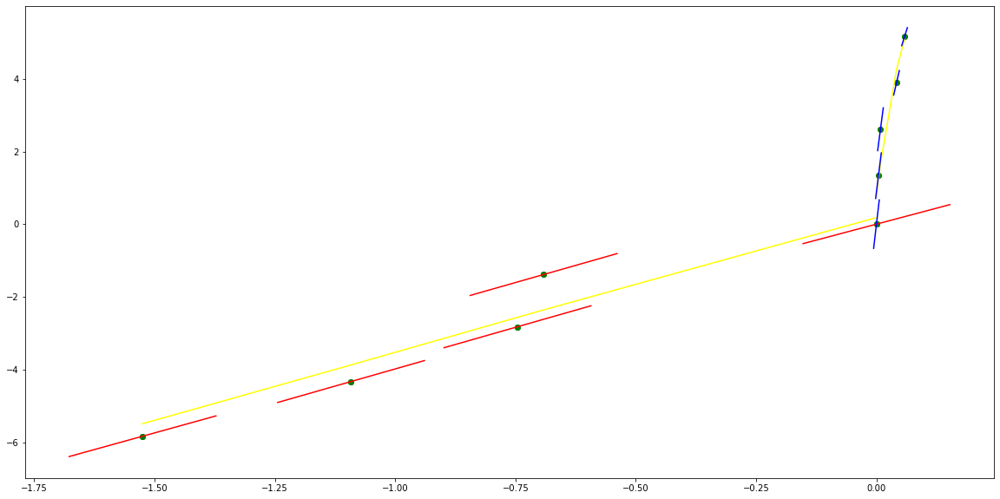

parameters (8731.609415246565, 2559.9284394533374, 351.0907323175626, -0.4481809216570076)
tangent[0]:209.5353255860711
tangent[1]:224.04417093911186
tangent[2]:291.18546324462596
tangent[3]:330.21113279319155
tangent[4]:351.0907323175626
parameters (2278.59261099962, -602.3419901011821, 143.24513693191744, 0.8237217886296526)
tangent[0]:143.24513693191744
tangent[1]:138.34391447393506
tangent[2]:110.68456261774958
tangent[3]:98.04762866932461
tangent[4]:90.32550644086359


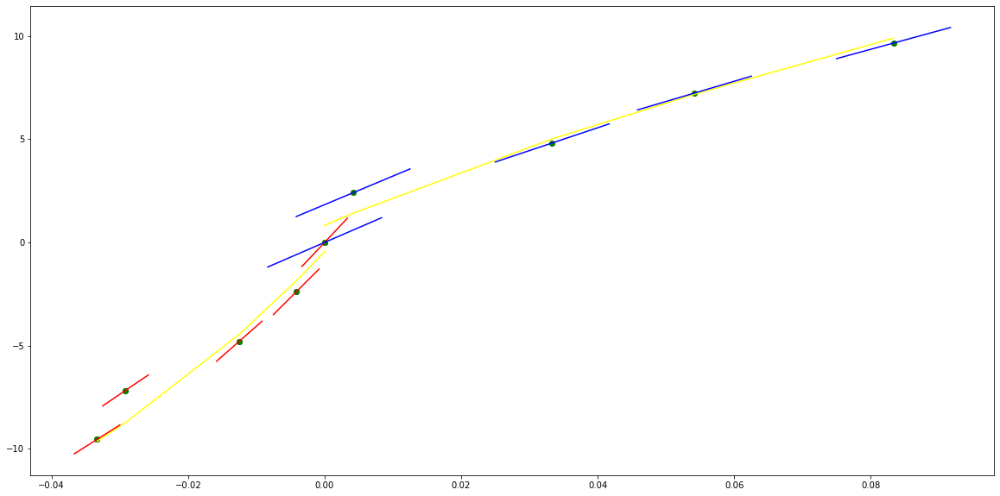

parameters (741.1288081651, 163.55824250737075, 98.14228061224162, 0.04648305951382576)
tangent[0]:89.48141048310185
tangent[1]:86.32278599738697
tangent[2]:87.3449224227428
tangent[3]:90.49273980574885
tangent[4]:98.14228061224162
parameters (7158.563067763603, -1882.7325894357011, 264.48517786162483, 0.47405953362132314)
tangent[0]:264.48517786162483
tangent[1]:249.17097245305288
tangent[2]:172.93003479437004
tangent[3]:162.83232671169804
tangent[4]:153.48042159607496


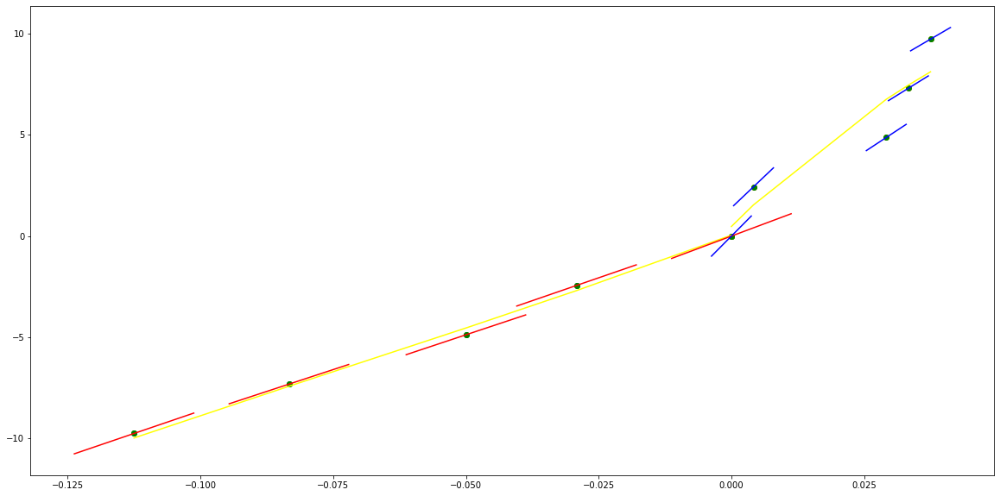

parameters (50364.74077828806, 5109.010853762443, 176.76308646363918, -0.38750616978207925)
tangent[0]:211.07709512289716
tangent[1]:167.08489782323818
tangent[2]:128.3485357388971
tangent[3]:136.81713226709968
tangent[4]:176.76308646363918
parameters (267.1963531543212, -182.63496963239893, 54.9644495925774, 0.8323290439288042)
tangent[0]:54.9644495925774
tangent[1]:53.45628845911312
tangent[2]:43.679231574175716
tangent[3]:26.45334626072725
tangent[4]:13.97402411813637


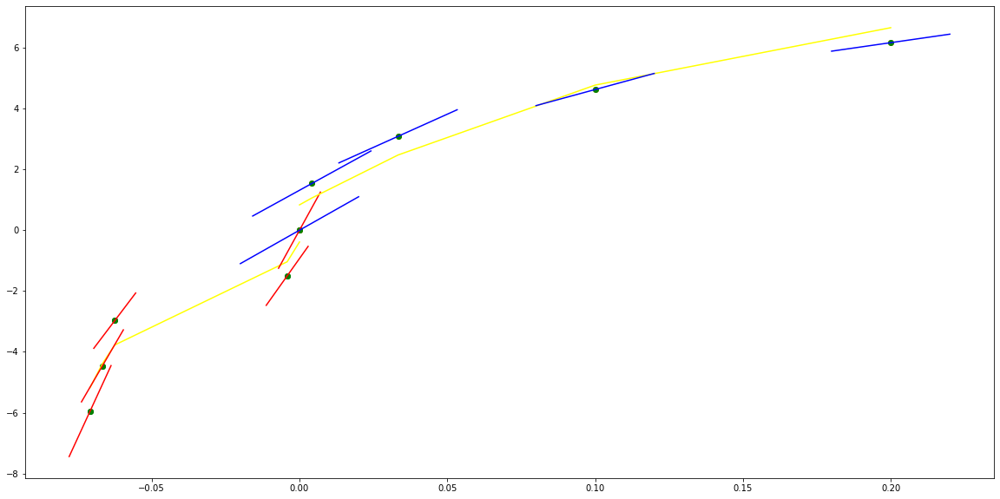

parameters (620.9367543530581, 462.5167381286591, 108.59039572610475, -0.19135318471572665)
tangent[0]:70.10647466047008
tangent[1]:76.52121729888228
tangent[2]:79.82600264761977
tangent[3]:83.19466288746374
tangent[4]:108.59039572610475
parameters (-3571.0422583168843, 812.0677685026011, 20.31444841238139, 0.6186147597362607)
tangent[0]:20.31444841238139
tangent[1]:26.8961996509189
tangent[2]:79.97476801055554
tangent[3]:80.97631934019063
tangent[4]:81.60572114249318


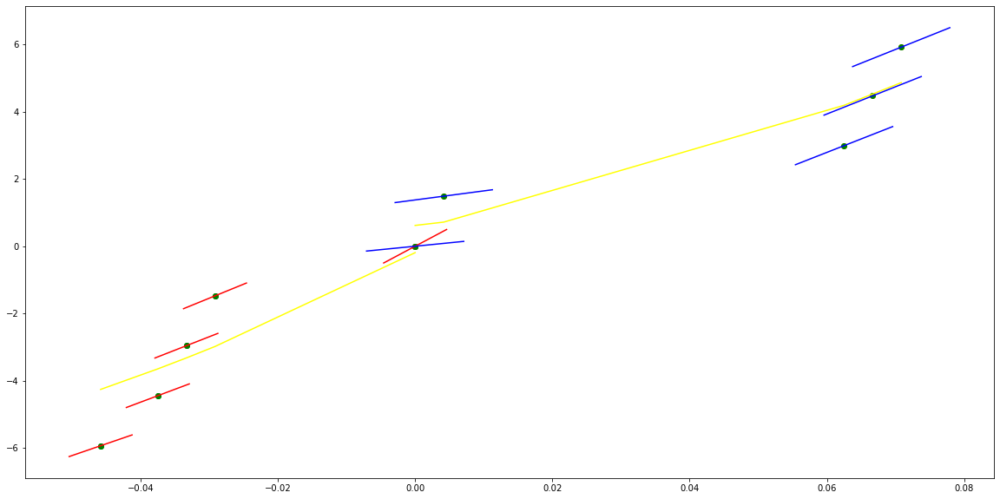

parameters (1.941900934488271, 4.563799111670159, 8.357349879111164, -0.22231190788084415)
tangent[0]:4.785738279329648
tangent[1]:5.066364656141023
tangent[2]:6.166954100925164
tangent[3]:7.569602774844937
tangent[4]:8.357349879111164
parameters (457.35148476538797, -317.0568347267356, 78.26479800515455, 0.8165831525847713)
tangent[0]:78.26479800515455
tangent[1]:75.64627054578828
tangent[2]:73.0760027345526
tangent[3]:42.08842278092224
tangent[4]:40.23265232676128


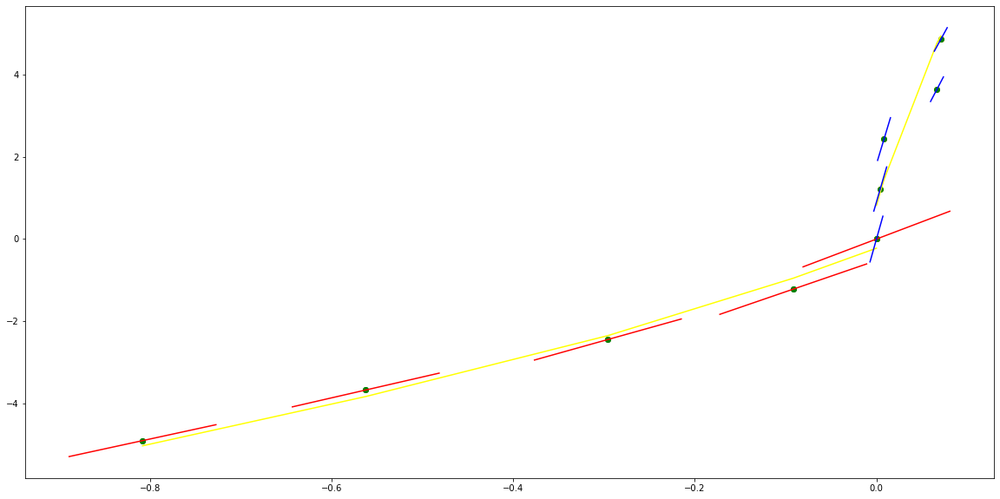

parameters (3639.9131263808135, 907.70864398479, 92.69693275781086, -0.41355572859438083)
tangent[0]:60.18216237667036
tangent[1]:29.225416807187955
tangent[2]:32.42961438935691
tangent[3]:85.3234224844297
tangent[4]:92.69693275781086
parameters (25.290324959929464, -37.196830180007154, 20.818744390506374, 0.7082476365450505)
tangent[0]:20.818744390506374
tangent[1]:20.51006342297233
tangent[2]:14.890186260428502
tangent[3]:5.210045665543438
tangent[4]:3.239658658777742


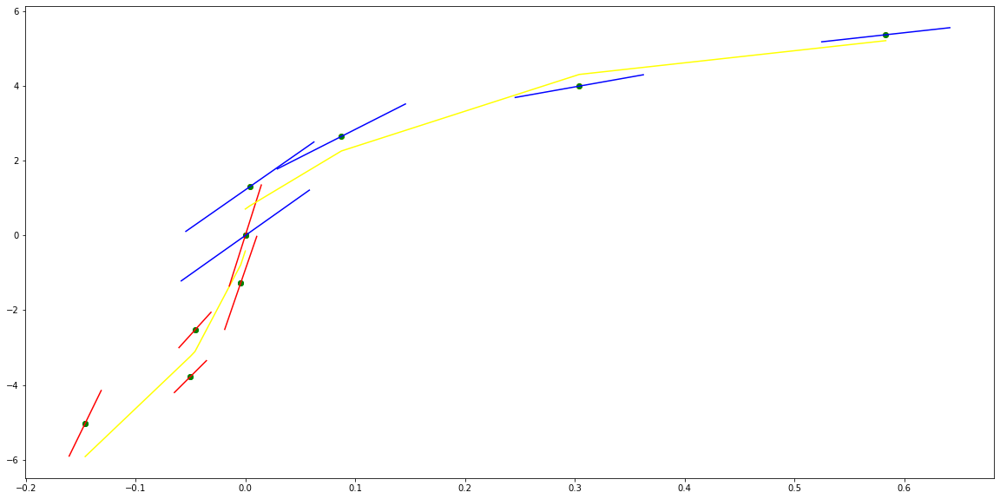

parameters (3.480269473449215, 5.95093145575874, 7.561726168661331, 0.05715044644824069)
tangent[0]:7.6322635601353115
tangent[1]:5.088981395164154
tangent[2]:4.176867590441663
tangent[3]:5.130357768884979
tangent[4]:7.561726168661331
parameters (-1151.3595185889358, 599.2321369052452, -39.67325163871534, -0.12233919979518064)
tangent[0]:-39.67325163871534
tangent[1]:61.643779688604894
tangent[2]:62.37962192810504
tangent[3]:62.99570271786965
tangent[4]:63.94973507982397


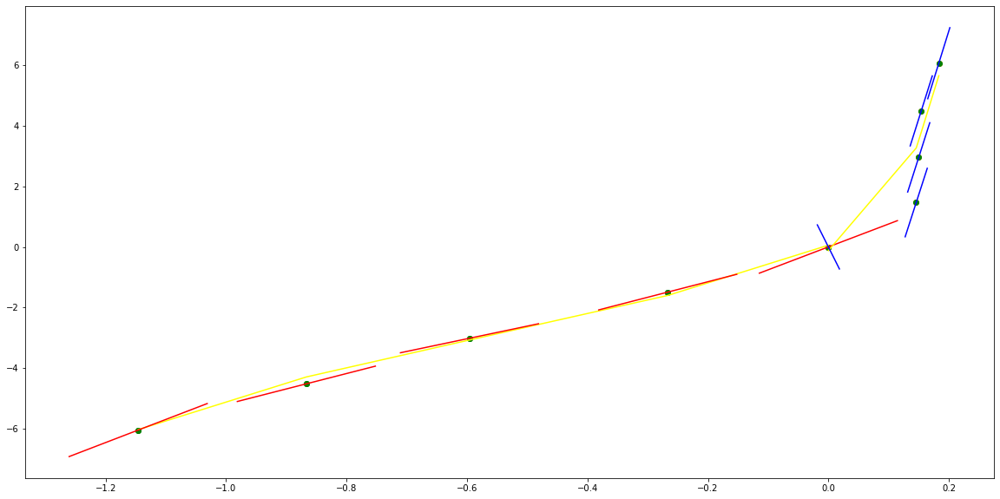

parameters (-0.12751206816437638, -0.4839370930413717, 3.783251103397137, -0.2518659147589942)
tangent[0]:4.333774383662734
tangent[1]:4.392911923068322
tangent[2]:4.2715121591135965
tangent[3]:4.0267727160030615
tangent[4]:3.783251103397137
parameters (506.2150648108081, -393.47913546043014, 106.84315339292341, -0.06542905224561525)
tangent[0]:106.84315339292341
tangent[1]:94.14878265283201
tangent[2]:82.29813743543374
tangent[3]:61.12860803843057
tangent[4]:49.61143195722139


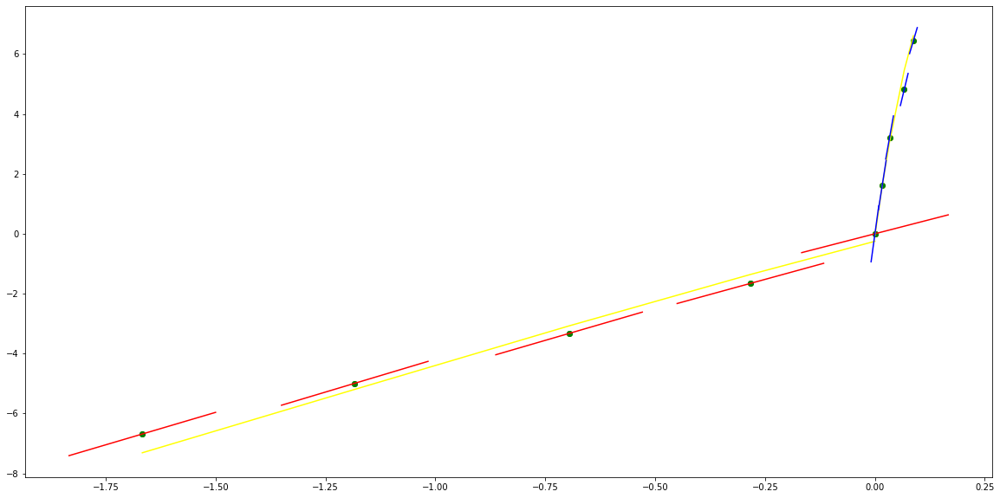

parameters (23.98238565911435, 42.63634719986743, 32.86843162325308, -0.1338568746945182)
tangent[0]:17.10522988158072
tangent[1]:18.92843810116131
tangent[2]:25.060633753053025
tangent[3]:30.442489391410703
tangent[4]:32.86843162325308
parameters (13181.673511589499, -2823.654192068419, 161.33236264564138, 0.3792921781414799)
tangent[0]:161.33236264564138
tangent[1]:138.48668395601163
tangent[2]:-28.53777385707096
tangent[3]:178.78282627065934
tangent[4]:203.9990670574069


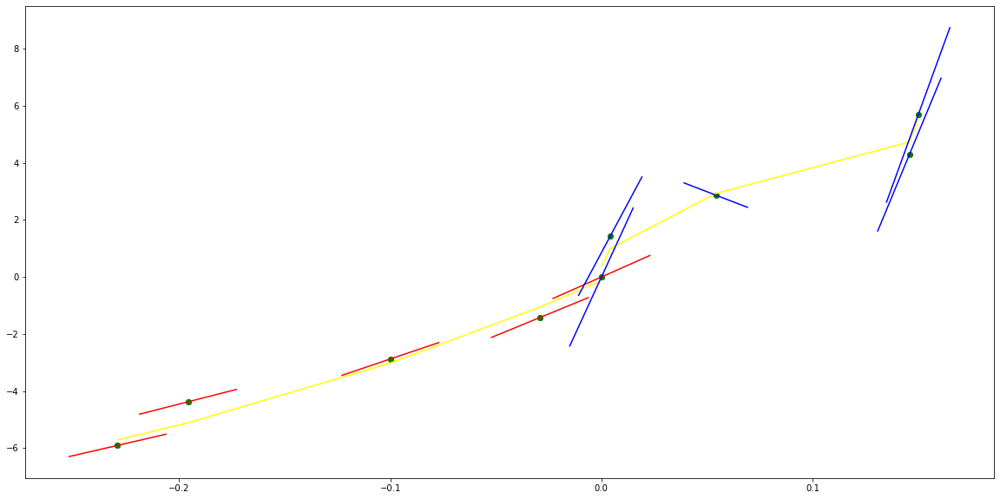

parameters (-255.61085049463887, -130.0390653549233, 13.473599361278326, 0.164486844735794)
tangent[0]:35.503025346306536
tangent[1]:35.093143166003756
tangent[2]:34.92806938202921
tangent[3]:30.87049149167914
tangent[4]:13.473599361278326
parameters (68210.6357308205, -4564.642815351851, 325.3625750363472, 0.07576798963234051)
tangent[0]:325.3625750363472
tangent[1]:290.8740475355531
tangent[2]:263.4919314794554
tangent[3]:230.0492415823536
tangent[4]:223.98465445803055


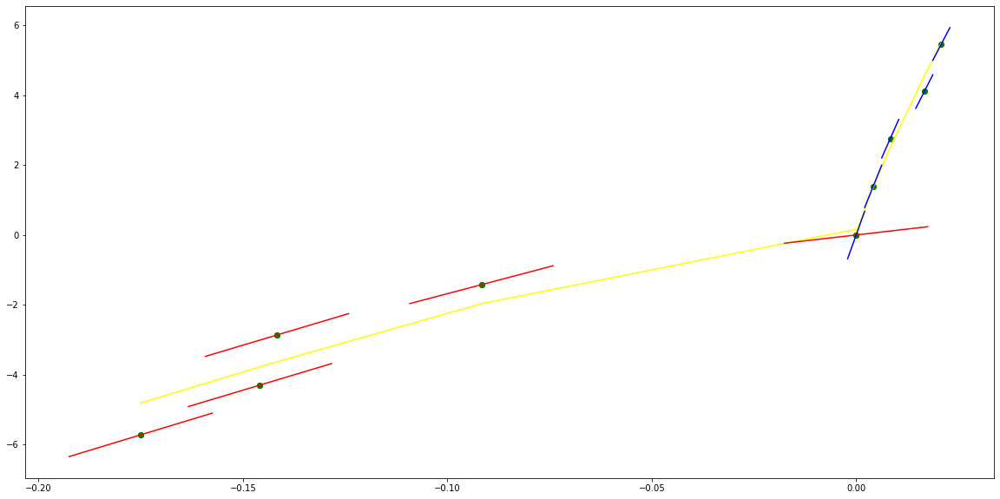

parameters (-46.01119619532298, -138.72923397525508, -99.74189964532229, -0.0002647548145068337)
tangent[0]:27.335633110634575
tangent[1]:27.677343980053422
tangent[2]:32.492410172665814
tangent[3]:34.21322065480339
tangent[4]:-99.74189964532229
parameters (0.021927892303876033, -0.10944932173654173, 0.8948561103622458, -0.010431097246798348)
tangent[0]:0.8948561103622458
tangent[1]:0.7336658516049239
tangent[2]:0.7139776653043706
tangent[3]:0.8516189324144038
tangent[4]:0.9766525648739774


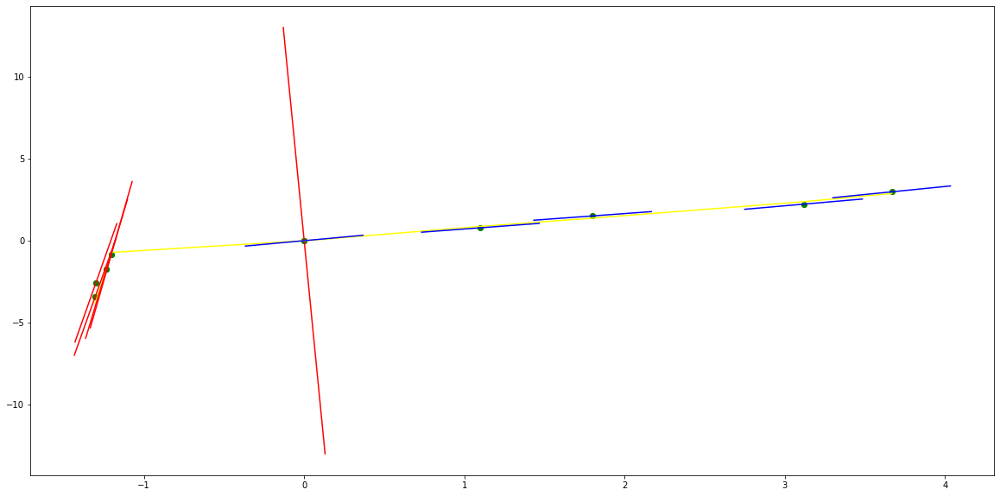

parameters (0.00858425810934007, 0.14905434821618785, 1.3146545599410149, 0.10349951796446114)
tangent[0]:0.8149734963575455
tangent[1]:0.8849311834814072
tangent[2]:1.0058876030925896
tangent[3]:1.1273610185413327
tangent[4]:1.3146545599410149
parameters (-3170.7852788054256, 2216.64613068503, -374.6967425779963, -3.056227426128051e-06)
tangent[0]:-374.6967425779963
tangent[1]:109.13675101022665
tangent[2]:104.32300227376385
tangent[3]:99.17891055555702
tangent[4]:87.9011308375861


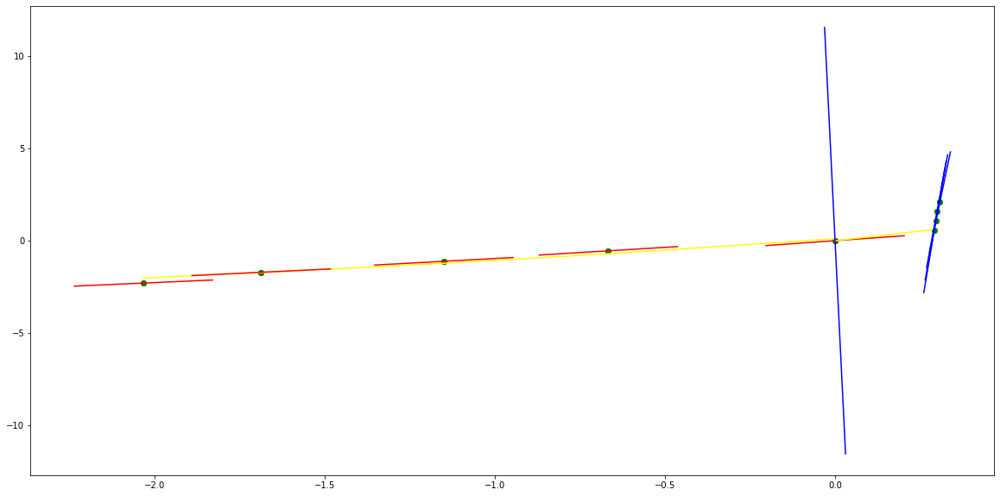

parameters (-0.0019189131997969175, 0.09433794394576711, 1.3335999580096962, -0.04050193772788635)
tangent[0]:0.9376293421838442
tangent[1]:1.0496275329080729
tangent[2]:1.147498626377831
tangent[3]:1.278079896091122
tangent[4]:1.3335999580096962
parameters (22877.7029685604, -1827.9711021540838, 124.59363740810126, 0.029123685257839836)
tangent[0]:124.59363740810126
tangent[1]:110.55106392751229
tangent[2]:98.89196581644963
tangent[3]:82.7255637604222
tangent[4]:78.2163197696089


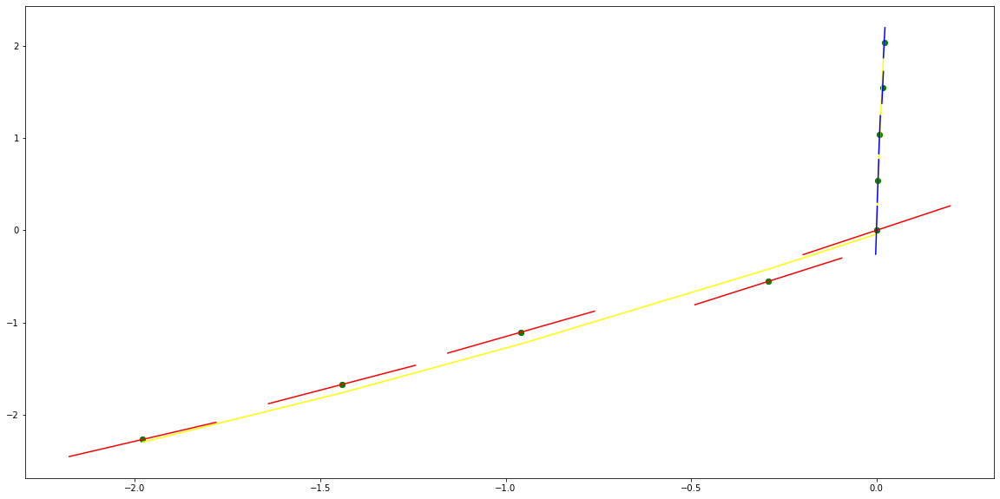

parameters (5.854972128897869e-05, 0.002114439601278172, 0.19600670348811994, 0.0012543946492603285)
tangent[0]:0.17594016584488176
tangent[1]:0.17896748375744603
tangent[2]:0.1845459456903061
tangent[3]:0.1897513220038189
tangent[4]:0.19600670348811994
parameters (-28.486391838942605, 114.66641387106499, -114.14427584665113, -3.370038649582513e-05)
tangent[0]:-114.14427584665113
tangent[1]:19.410018713583256
tangent[2]:18.355348471620616
tangent[3]:17.99782834131757
tangent[4]:17.637427269946144


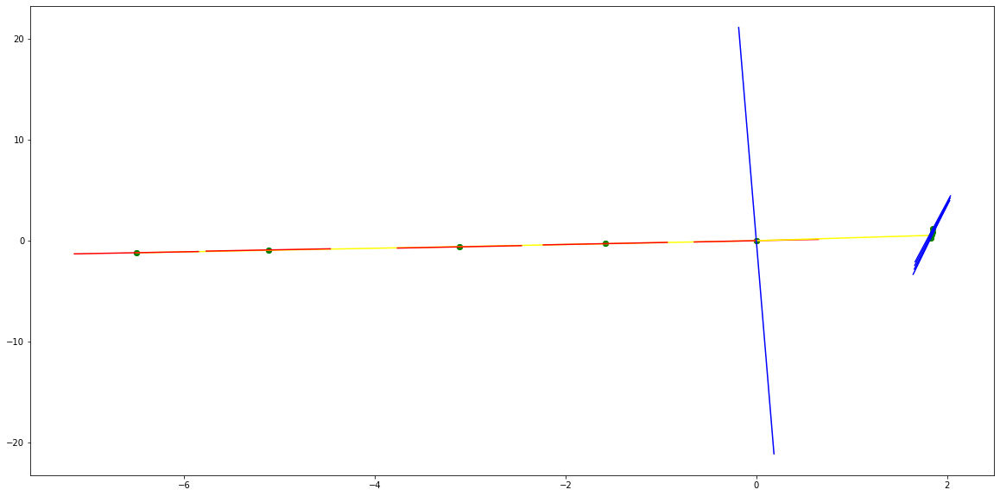

parameters (23.3502831799197, 97.31647877461423, 101.43220123238748, 2.404700010531752e-05)
tangent[0]:18.6442118678668
tangent[1]:17.140411448610593
tangent[2]:9.489818666838488
tangent[3]:-7.272527325836137
tangent[4]:101.43220123238748
parameters (-0.21568585655162914, 1.42208013954033, -1.3700104804787185, -0.0016459535993317974)
tangent[0]:-1.3700104804787185
tangent[1]:1.569999522613925
tangent[2]:1.6003885098276258
tangent[3]:1.6232303606502303
tangent[4]:1.75474865457739


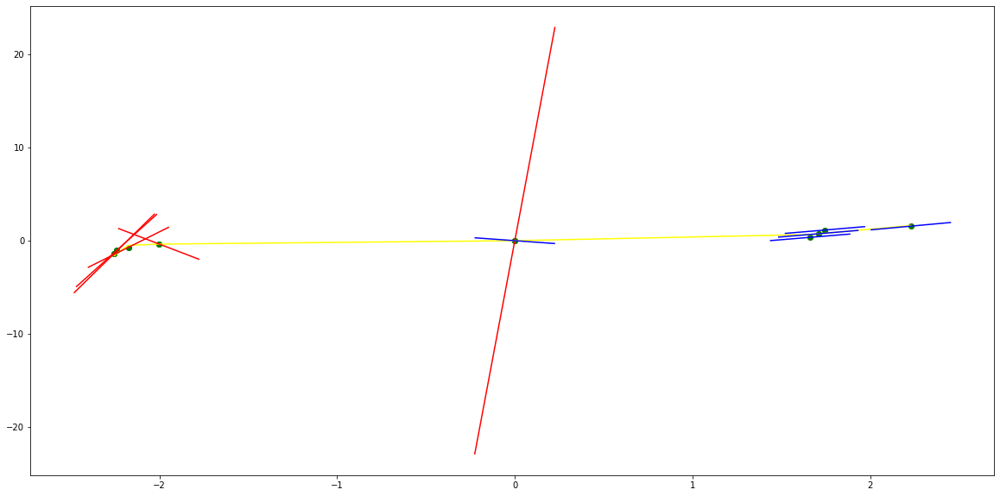

parameters (2.3706413646507076e-06, 0.0026855411826833897, 0.3062566905731739, 0.008032445523189971)
tangent[0]:0.26608848774908167
tangent[1]:0.2766662484872922
tangent[2]:0.2873011472119703
tangent[3]:0.2955207162462165
tangent[4]:0.3062566905731739
parameters (77.95993405886993, -353.67336926194633, 395.9734044101815, 1.3140905161915425e-07)
tangent[0]:395.9734044101815
tangent[1]:-82.24600818498948
tangent[2]:107.01117538954031
tangent[3]:109.01370155656036
tangent[4]:111.02434984942965


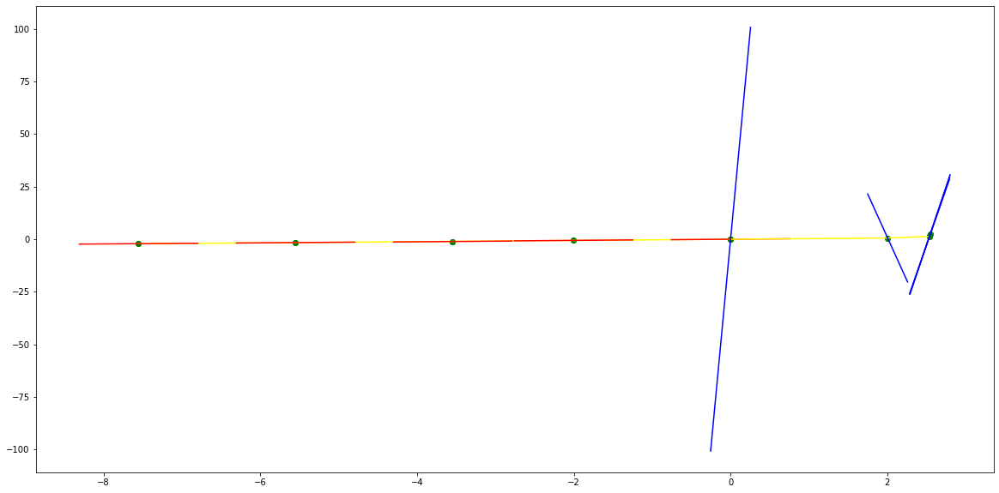

parameters (28647.322942551724, 1367.0253448913727, 121.77070972578032, -0.030391323460841592)
tangent[0]:102.11223982474378
tangent[1]:100.07588026532112
tangent[2]:101.02350873281713
tangent[3]:111.87222520488403
tangent[4]:121.77070972578032
parameters (14704.04859714177, -1422.7411376514292, 59.00096545871729, 0.17468498517064995)
tangent[0]:59.00096545871729
tangent[1]:47.909799220604405
tangent[2]:27.007216172137674
tangent[3]:53.47139275004376
tangent[4]:65.35714045103954


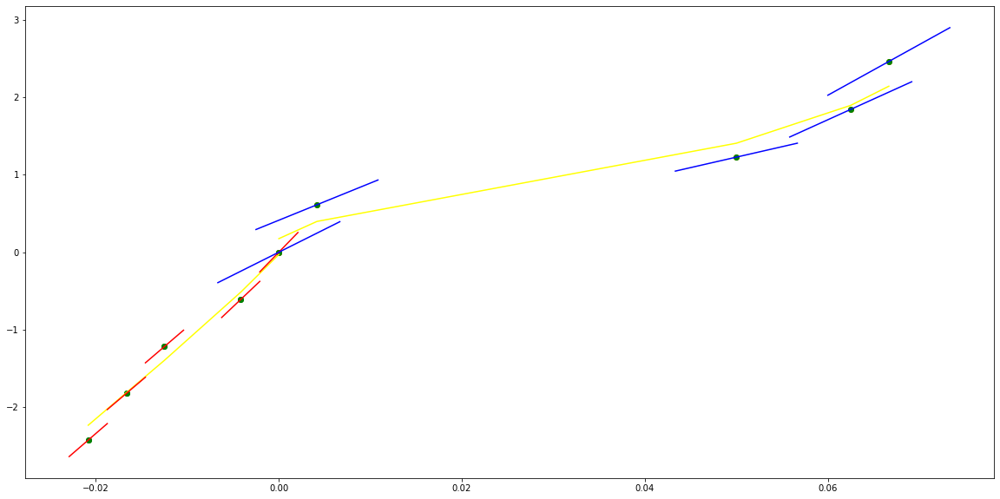

parameters (4520.843153775839, 1046.839519796522, 79.24269484143673, -0.20851245689968423)
tangent[0]:15.354566382145691
tangent[1]:11.772568860026638
tangent[2]:55.19085207485611
tangent[3]:70.75383253957824
tangent[4]:79.24269484143673
parameters (0.09021935143247936, -0.7759846112088922, 2.2153454433420143, 0.290182559553942)
tangent[0]:2.2153454433420143
tangent[1]:2.20888463698244
tangent[2]:1.4593567897918245
tangent[3]:0.7240479553615176
tangent[4]:0.025257627021951112


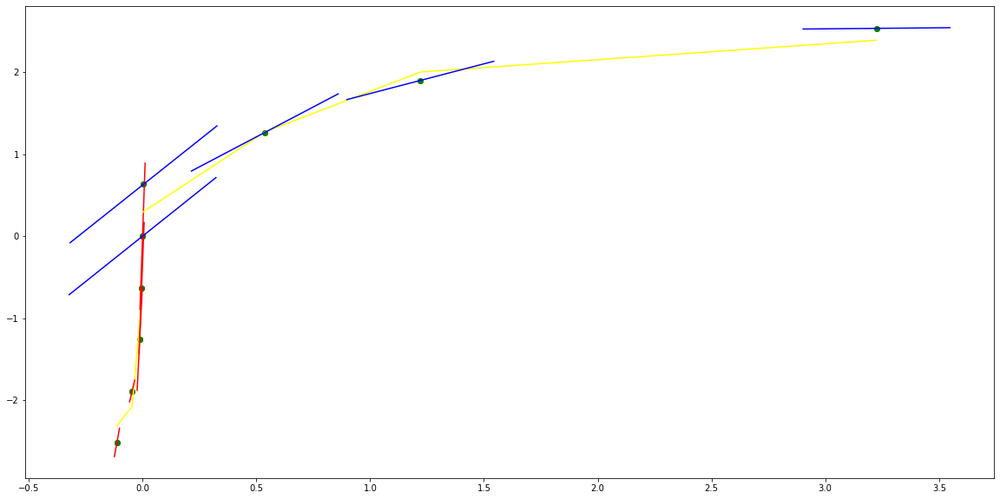

parameters (-0.0005226323925541375, -0.01139778720873618, 0.333204566438965, 0.02979104108979863)
tangent[0]:0.4149201811872074
tangent[1]:0.4060419206845155
tangent[2]:0.3993858438436517
tangent[3]:0.37259295478690785
tangent[4]:0.333204566438965
parameters (18.390017338764, -81.51015128914673, 89.80792278453619, 6.818562705172379e-05)
tangent[0]:89.80792278453619
tangent[1]:-15.311305633697074
tangent[2]:25.204780166377944
tangent[3]:25.66823729246552
tangent[4]:26.133498441433474


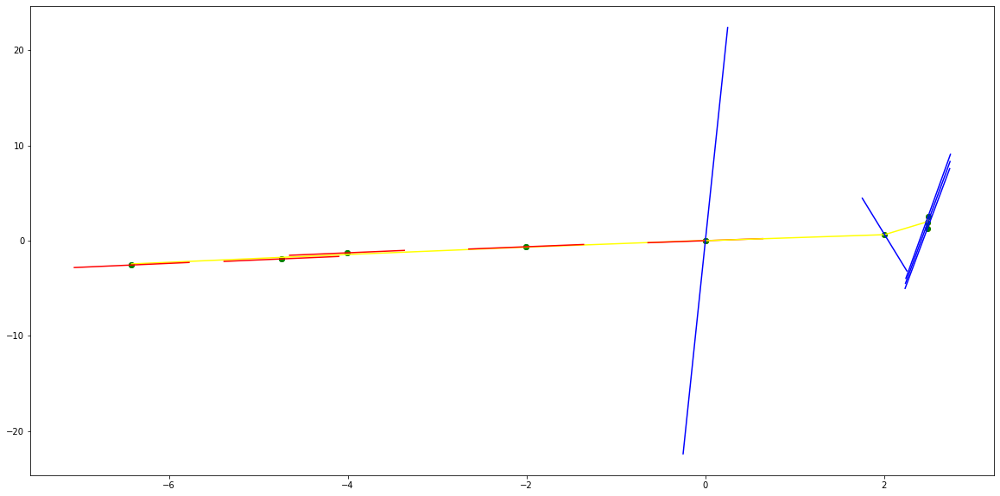

parameters (0.0003345389787505212, 0.005463580442128582, 0.41588302208545186, -0.20869738625786882)
tangent[0]:0.3872416967970152
tangent[1]:0.38705788048626
tangent[2]:0.3949364910930903
tangent[3]:0.41087751865214456
tangent[4]:0.41588302208545186
parameters (396.10999666384174, -277.6819632723477, 54.47044109434908, 0.44427164264435914)
tangent[0]:54.47044109434908
tangent[1]:52.17687364247892
tangent[2]:49.925109808722524
tangent[3]:41.329049174476395
tangent[4]:27.87467939705243


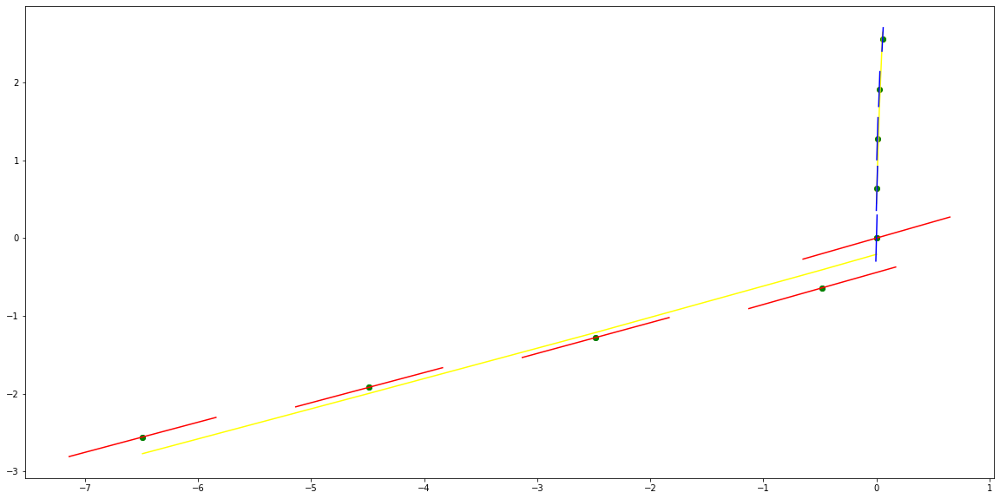

parameters (396.1099966638404, 247.16417841724044, 40.991742610748695, 0.0015738185028015155)
tangent[0]:41.32904917447552
tangent[1]:27.874679397051715
tangent[2]:13.54724149264171
tangent[3]:-0.3570653403586519
tangent[4]:40.991742610748695
parameters (0.0014337693344415913, -0.028622984781874423, 0.5224847751802193, 0.18853469011456273)
tangent[0]:0.5224847751802193
tangent[1]:0.49582074092897516
tangent[2]:0.419288736863528
tangent[3]:0.35890359628818924
tangent[4]:0.3330724187675674


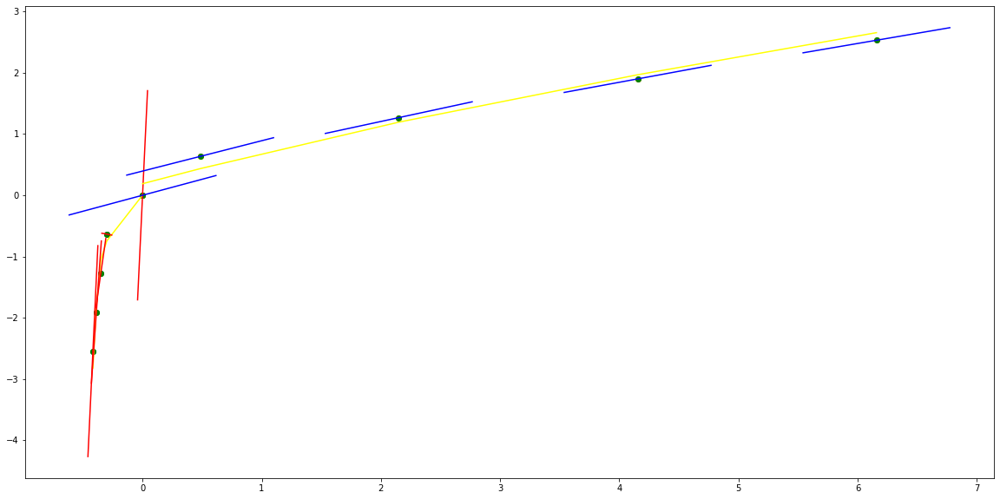

parameters (-0.005232212262818906, -0.075722050667114, 0.19082626101449268, 0.0204762188536768)
tangent[0]:0.5543629866374324
tangent[1]:0.5460934425137688
tangent[2]:0.54567097088063
tangent[3]:0.43129699147597855
tangent[4]:0.19082626101449268
parameters (-31.427635579847205, 77.50903104100195, -44.85737562277775, -0.0006650527562487537)
tangent[0]:-44.85737562277775
tangent[1]:16.28239490796996
tangent[2]:15.736349121685663
tangent[3]:15.59164428783238
tangent[4]:12.831357014493648


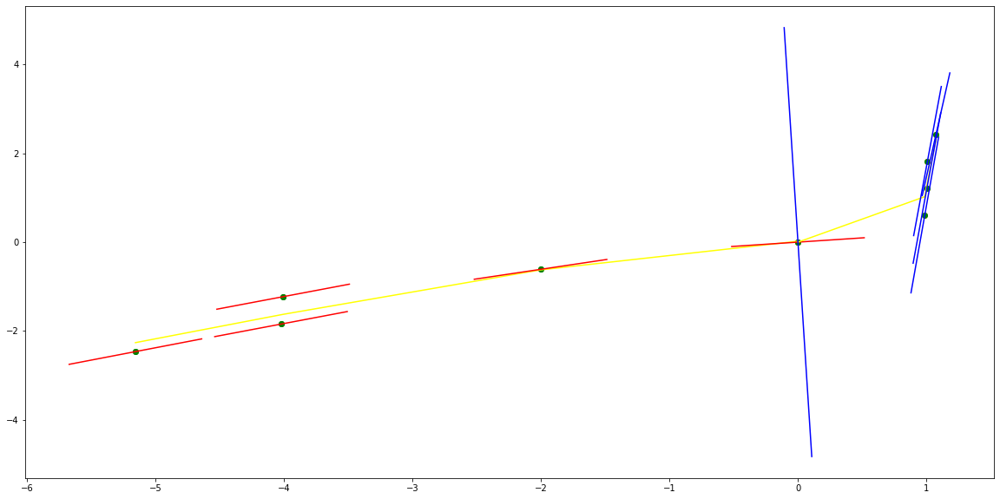

parameters (0.24103621303637526, 0.8047773756997582, 1.3872334116329608, 0.004634988435480705)
tangent[0]:1.7443134111202636
tangent[1]:1.5320744823824906
tangent[2]:0.4915636773234028
tangent[3]:0.4917751829045922
tangent[4]:1.3872334116329608
parameters (17441.322357385958, -2532.894560595884, 145.75980988038359, -0.04778891011920525)
tangent[0]:145.75980988038359
tangent[1]:125.55921416865809
tangent[2]:90.61306572051116
tangent[3]:75.86331927852771
tangent[4]:62.933553555490676


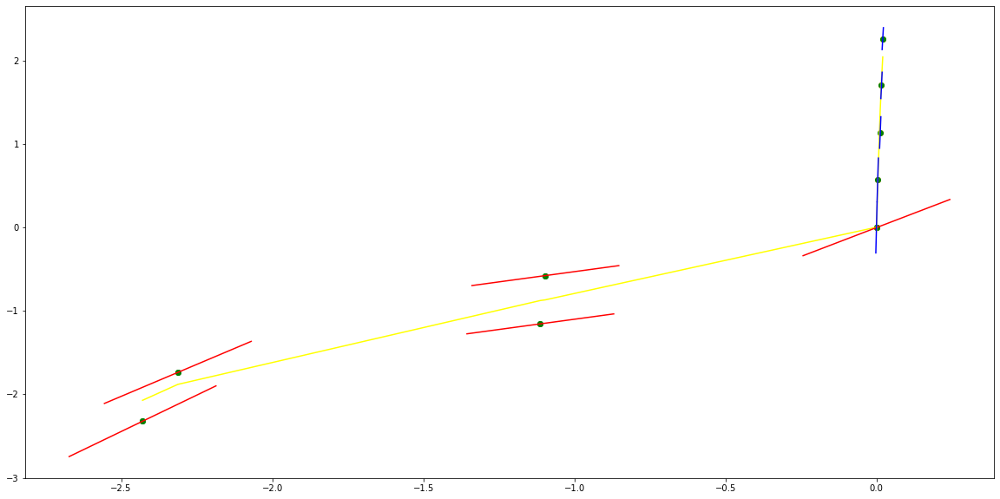

In [11]:
for point_index in breakpoints:
    identfication_UsePattern.plot_tangent_inPointWindow(data_forTangentPlot,point_index)

## plot detected points

### save buildups without showing plot

In [11]:
pressure_df=processed_data_denoised.pressure_df
rate_df=processed_data_denoised.rate_df
data_inOneRow=data_inOneRow_denoised
colum_names=colum_names_denoised
plot_whole=False
plot_details=False
plot_statistics=False
i=0
criterions=[20,40]
orders=[1]
for deltaTangent_criterion in criterions:
    for polynomial_order in orders:
        print(f"===============================plot:{i}, deltaTangent_criterion:{deltaTangent_criterion},polynomial_order:{polynomial_order}")
        filename_toSave_whole=f"../data_output/RealField_Denoised_Derivative_Tangent/degree_{polynomial_order}_tangentCriterion_{deltaTangent_criterion}_timestep_1_points5_buildup_whole.pdf"
        filename_toSave_details=f"../data_output/RealField_Denoised_Derivative_Tangent/degree_{polynomial_order}_tangentCriterion_{deltaTangent_criterion}_timestep_1_points5_buildup.pdf"
        plot_name=f"degree_{polynomial_order}_tangentCriterion_{deltaTangent_criterion}_timestep_1_points5_buildup"
        PlotNSave(pressure_df,
          rate_df,
          buildups[i],
          [],
          data_inOneRow,
          plot_name,
          filename_toSave_whole,
          filename_toSave_details,
          plot_statistics,
          plot_whole,
          plot_details,
          colum_names)
        i=i+1

===============================plot:0, deltaTangent_criterion:20,polynomial_order:1
---initializing...
---plotting...
save whole....
detected 279 points as breakpoints
The plot is devided into 25 rows
------row 1-----detected points:[32.0, 33.0, 79.0, 308.0, 434.0, 466.0, 514.0, 537.0, 580.0, 620.0, 655.0, 674.0, 721.0, 760.0, 823.0, 846.0, 911.0, 1011.0, 1043.0]
------row 2-----detected points:[1814.0, 1839.0, 2114.0]
------row 3-----detected points:[2515.0, 2663.0, 2902.0, 2964.0, 3026.0, 3035.0]
------row 4-----detected points:[3675.0, 3693.0, 3904.0, 4269.0, 4293.0, 4405.0, 4643.0, 4655.0]
------row 5-----detected points:[4902.0, 4951.0, 4964.0, 5466.0, 5528.0, 5834.0, 5853.0, 5950.0]
------row 6-----detected points:[6544.0, 6547.0, 6608.0, 6739.0, 6741.0, 6791.0, 6873.0, 7046.0, 7102.0, 7111.0, 7143.0, 7145.0]
------row 7-----detected points:[7220.0, 7556.0, 7623.0, 7647.0, 7688.0, 7695.0, 7723.0, 7775.0, 7800.0, 7816.0, 7865.0]
------row 8-----detected points:[8422.0, 8482.0, 860

### save drawdowns without showing plot

In [11]:
pressure_df=processed_data_denoised.pressure_df
rate_df=processed_data_denoised.rate_df
data_inOneRow=data_inOneRow_denoised
colum_names=colum_names_denoised
plot_whole=False
plot_details=False
plot_statistics=False
i=0
criterions=[20,40]
orders=[1,3,5]
for deltaTangent_criterion in criterions:
    for polynomial_order in orders:
        print(f"===============================plot:{i}, deltaTangent_criterion:{deltaTangent_criterion},polynomial_order:{polynomial_order}")
        filename_toSave_whole=f"../data_output/RealField_Denoised_Derivative_Tangent/degree_{polynomial_order}_tangentCriterion_{deltaTangent_criterion}_timestep_1_points5_drawdown_whole.pdf"
        filename_toSave_details=f"../data_output/RealField_Denoised_Derivative_Tangent/degree_{polynomial_order}_tangentCriterion_{deltaTangent_criterion}_timestep_1_points5_drawdown.pdf"
        plot_name=f"degree_{polynomial_order}_tangentCriterion_{deltaTangent_criterion}_timestep_1_points5_drawdown"
        PlotNSave(pressure_df,
          rate_df,
          drawdowns[i],
          [],
          data_inOneRow,
          plot_name,
          filename_toSave_whole,
          filename_toSave_details,
          plot_statistics,
          plot_whole,
          plot_details,
          colum_names)
        i=i+1

===============================plot:0, deltaTangent_criterion:20,polynomial_order:1
---initializing...
---plotting...
save whole....


findfont: Font family ['Arial Black'] not found. Falling back to DejaVu Sans.


detected 68 points as breakpoints
The plot is devided into 25 rows
------row 1-----detected points:[]
------row 2-----detected points:[2264.0]
------row 3-----detected points:[2817.0, 2875.0, 3118.0]
------row 4-----detected points:[4022.0, 4035.0]
------row 5-----detected points:[4807.0, 5396.0, 5711.0]
------row 6-----detected points:[6037.0]
------row 7-----detected points:[7295.0, 7993.0]
------row 8-----detected points:[9048.0, 9125.0]
------row 9-----detected points:[9978.0, 10161.0, 10213.0, 10565.0, 10567.0]
------row 10-----detected points:[11326.0, 11378.0, 11407.0]
------row 11-----detected points:[12321.0, 12400.0, 12466.0]
------row 12-----detected points:[13827.0, 13859.0, 13907.0, 13909.0]
------row 13-----detected points:[14489.0, 14507.0, 14815.0]
------row 14-----detected points:[16076.0, 16095.0, 16179.0]
------row 15-----detected points:[17579.0, 17580.0, 17623.0, 17636.0]
------row 16-----detected points:[]
------row 17-----detected points:[19721.0, 19997.0, 20065.

------row 23-----detected points:[26401.0, 26410.0, 26411.0, 26412.0, 26426.0, 26500.0, 26501.0, 26581.0, 26583.0, 26601.0, 26638.0, 26640.0, 26642.0, 26647.0, 26649.0, 26651.0, 26653.0, 26682.0, 26693.0, 26734.0, 26893.0, 26902.0, 26904.0, 26909.0, 26933.0, 26937.0, 26981.0, 26994.0, 27007.0, 27008.0, 27021.0, 27058.0, 27074.0, 27104.0]
------row 24-----detected points:[27644.0, 27679.0, 27740.0, 27741.0, 27742.0, 27756.0, 27825.0, 28212.0, 28216.0, 28221.0, 28225.0, 28276.0, 28286.0, 28289.0, 28333.0, 28374.0, 28389.0, 28422.0, 28687.0, 28745.0, 28762.0, 28764.0, 28779.0]
------row 25-----detected points:[28818.0, 28947.0, 28991.0, 29000.0, 29512.0, 29521.0, 29537.0, 29667.0, 29712.0, 29738.0, 29743.0, 29746.0, 29765.0, 29767.0, 29770.0]
===============================plot:3, deltaTangent_criterion:40,polynomial_order:1
---initializing...
---plotting...
save whole....
detected 51 points as breakpoints
The plot is devided into 25 rows
------row 1-----detected points:[]
------row 2----

------row 24-----detected points:[27644.0, 27740.0, 27741.0, 27756.0, 27825.0, 28212.0, 28216.0, 28221.0, 28225.0, 28276.0, 28286.0, 28289.0, 28333.0, 28374.0, 28389.0, 28687.0, 28745.0, 28762.0, 28764.0]
------row 25-----detected points:[28947.0, 29512.0, 29521.0, 29537.0, 29667.0, 29712.0, 29738.0, 29746.0, 29765.0, 29767.0, 29770.0]
